In [2]:
import numpy as np
from scipy.stats import norm
import numpy as np
import astropy
from astropy.io import fits
from astropy import units as u
from astropy import units as u
from astropy.coordinates import SkyCoord
import astropy.coordinates as coord
import healpy as hp
import pandas as pd
import math
import scipy
import statistics as st
from scipy import stats
import matplotlib
import matplotlib.mlab as mlab
import matplotlib.pyplot as plt
from matplotlib import cm
import seaborn as sns
from IPython.display import Image

%matplotlib inline

NSIDE=2048
Npix=12*NSIDE**2

pi=math.pi

import warnings
warnings.filterwarnings('ignore')

---

### Read in MMF3

In [11]:
dr7 = pd.read_csv('dr7.txt',sep=' ')

c = SkyCoord(dr7['dr7_ra'],dr7['dr7_dec'],frame='icrs',unit='deg')

dr7['GLAT'] = c.galactic.b.degree
dr7['GLON'] = c.galactic.l.degree

dr7['GLAT'] = np.around(dr7['GLAT'].values,1)
dr7['GLON'] = np.around(dr7['GLON'].values,1)
print(dr7.iloc[0,6]) # glat
print(dr7.iloc[0,7]) # glon
dr7

32.2
231.4


,sloan_ra,sloan_dec,sloan,dr7_ra,dr7_dec,dr7,GLAT,GLON
0,139.48462,0.290392,Sloan,139.48462,0.29039,DR7,32.2,231.4
1,138.72786,-0.743814,Sloan,138.72786,-0.74381,DR7,31.0,231.9
2,127.47054,-0.236442,Sloan,127.47054,-0.23644,DR7,21.6,225.0
3,139.09781,0.103403,Sloan,139.09781,0.10340,DR7,31.8,231.3
4,224.80738,-0.690585,Sloan,224.80738,-0.69058,DR7,48.6,356.0
...,...,...,...,...,...,...,...,...
23843,207.32250,-0.622344,Sloan,207.32250,-0.62234,DR7,59.0,331.9
23844,207.63641,-0.489910,Sloan,207.63641,-0.48991,DR7,58.9,332.6
23845,207.73318,-0.497329,Sloan,207.73318,-0.49733,DR7,58.9,332.7
23846,207.88383,-0.520729,Sloan,207.88383,-0.52073,DR7,58.8,333.0


### Check against intersection mask

In [26]:
mask = hp.read_map('HFI_PCCS_SZ-selfunc-inter-cosmo_2.02.fits')

# Get the nside and number of pixels in your map
nside = hp.get_nside(mask)
npix = hp.nside2npix(nside)
maskedPixels, = np.where(mask == 0)

# Use pix2ang to get the (l, b) coordinates for each pixel
glons, glats = hp.pix2ang(nside, maskedPixels, lonlat=True)
maskedArray = pd.DataFrame({'glon': np.around(glons,1), 'glat': np.around(glats,1)})
maskedArray = maskedArray[(maskedArray.glat > 15)|((maskedArray.glat<-15) & ((maskedArray.glon<210)))].reset_index()

NSIDE = 2048
ORDERING = RING in fits file
INDXSCHM = IMPLICIT


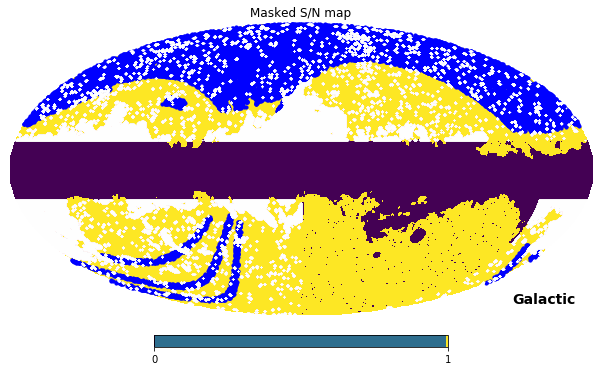

In [27]:
hp.mollview(mask,norm='hist',coord=['G'],title='Masked S/N map')
hp.visufunc.projscatter(dr7['GLON'],dr7['GLAT'],c='b',lonlat=True,s=10)
hp.visufunc.projscatter(maskedArray.glon,maskedArray.glat,c='w',lonlat=True,s=0.1)

In [28]:
interLons = []
interLats = []

for i in range(dr7.shape[0]):
    matchFlag=False
    for j in range(11): # Within 1 degree
        print(i,dr7.iloc[i][7],dr7.iloc[i][6])
        if not maskedArray.loc[np.logical_and(maskedArray.glon == dr7.iloc[i][7]+j/10, maskedArray.glat == dr7.iloc[i][6]+j/10)].empty:
            print("MATCH")
            matchFlag=True
            interLons.append(dr7.iloc[i][7])
            interLats.append(dr7.iloc[i][6])
            break
    if not matchFlag:
        for j in range(11): # Within 1 degree
            print(i,dr7.iloc[i][7],dr7.iloc[i][6])
            if not maskedArray.loc[np.logical_and(maskedArray.glon == dr7.iloc[i][7]-j/10, maskedArray.glat == dr7.iloc[i][6]-j/10)].empty:
                print("MATCH")
                matchFlag=True
                interLons.append(dr7.iloc[i][7])
                interLats.append(dr7.iloc[i][6])
                break
masked = pd.DataFrame({'glon': interLons, 'glat': interLats})

0 231.4 32.2
MATCH
1 231.9 31.0
1 231.9 31.0
1 231.9 31.0
1 231.9 31.0
1 231.9 31.0
1 231.9 31.0
1 231.9 31.0
1 231.9 31.0
1 231.9 31.0
1 231.9 31.0
1 231.9 31.0
1 231.9 31.0
1 231.9 31.0
1 231.9 31.0
1 231.9 31.0
1 231.9 31.0
1 231.9 31.0
1 231.9 31.0
1 231.9 31.0
1 231.9 31.0
1 231.9 31.0
1 231.9 31.0
2 225.0 21.6
2 225.0 21.6
2 225.0 21.6
2 225.0 21.6
2 225.0 21.6
2 225.0 21.6
2 225.0 21.6
2 225.0 21.6
2 225.0 21.6
2 225.0 21.6
2 225.0 21.6
2 225.0 21.6
2 225.0 21.6
2 225.0 21.6
2 225.0 21.6
2 225.0 21.6
2 225.0 21.6
2 225.0 21.6
2 225.0 21.6
2 225.0 21.6
2 225.0 21.6
2 225.0 21.6
3 231.3 31.8
3 231.3 31.8
3 231.3 31.8
MATCH
4 356.0 48.6
4 356.0 48.6
4 356.0 48.6
4 356.0 48.6
4 356.0 48.6
4 356.0 48.6
4 356.0 48.6
4 356.0 48.6
4 356.0 48.6
4 356.0 48.6
4 356.0 48.6
4 356.0 48.6
4 356.0 48.6
4 356.0 48.6
4 356.0 48.6
4 356.0 48.6
4 356.0 48.6
4 356.0 48.6
4 356.0 48.6
4 356.0 48.6
4 356.0 48.6
4 356.0 48.6
5 240.2 40.5
5 240.2 40.5
5 240.2 40.5
5 240.2 40.5
5 240.2 40.5
5 240.2 40.5


31 326.0 66.5
31 326.0 66.5
31 326.0 66.5
31 326.0 66.5
31 326.0 66.5
31 326.0 66.5
31 326.0 66.5
31 326.0 66.5
31 326.0 66.5
31 326.0 66.5
31 326.0 66.5
31 326.0 66.5
31 326.0 66.5
31 326.0 66.5
31 326.0 66.5
31 326.0 66.5
31 326.0 66.5
31 326.0 66.5
31 326.0 66.5
31 326.0 66.5
31 326.0 66.5
31 326.0 66.5
32 312.7 68.4
32 312.7 68.4
32 312.7 68.4
32 312.7 68.4
32 312.7 68.4
32 312.7 68.4
32 312.7 68.4
32 312.7 68.4
32 312.7 68.4
32 312.7 68.4
32 312.7 68.4
32 312.7 68.4
32 312.7 68.4
32 312.7 68.4
32 312.7 68.4
32 312.7 68.4
32 312.7 68.4
32 312.7 68.4
32 312.7 68.4
32 312.7 68.4
32 312.7 68.4
32 312.7 68.4
33 229.3 41.1
33 229.3 41.1
33 229.3 41.1
33 229.3 41.1
33 229.3 41.1
33 229.3 41.1
33 229.3 41.1
33 229.3 41.1
33 229.3 41.1
33 229.3 41.1
33 229.3 41.1
33 229.3 41.1
33 229.3 41.1
33 229.3 41.1
33 229.3 41.1
33 229.3 41.1
33 229.3 41.1
33 229.3 41.1
33 229.3 41.1
33 229.3 41.1
33 229.3 41.1
33 229.3 41.1
34 231.0 41.1
34 231.0 41.1
34 231.0 41.1
34 231.0 41.1
34 231.0 41.1
34 231

61 14.3 49.6
61 14.3 49.6
61 14.3 49.6
61 14.3 49.6
61 14.3 49.6
61 14.3 49.6
61 14.3 49.6
61 14.3 49.6
61 14.3 49.6
61 14.3 49.6
61 14.3 49.6
61 14.3 49.6
61 14.3 49.6
61 14.3 49.6
61 14.3 49.6
61 14.3 49.6
61 14.3 49.6
61 14.3 49.6
61 14.3 49.6
61 14.3 49.6
61 14.3 49.6
62 223.6 46.1
62 223.6 46.1
62 223.6 46.1
62 223.6 46.1
62 223.6 46.1
62 223.6 46.1
62 223.6 46.1
62 223.6 46.1
62 223.6 46.1
62 223.6 46.1
62 223.6 46.1
62 223.6 46.1
62 223.6 46.1
62 223.6 46.1
62 223.6 46.1
62 223.6 46.1
62 223.6 46.1
62 223.6 46.1
62 223.6 46.1
62 223.6 46.1
62 223.6 46.1
MATCH
63 217.5 25.8
63 217.5 25.8
63 217.5 25.8
63 217.5 25.8
63 217.5 25.8
63 217.5 25.8
63 217.5 25.8
63 217.5 25.8
63 217.5 25.8
63 217.5 25.8
63 217.5 25.8
63 217.5 25.8
63 217.5 25.8
63 217.5 25.8
63 217.5 25.8
63 217.5 25.8
63 217.5 25.8
63 217.5 25.8
63 217.5 25.8
63 217.5 25.8
63 217.5 25.8
63 217.5 25.8
64 218.4 32.4
64 218.4 32.4
64 218.4 32.4
64 218.4 32.4
64 218.4 32.4
64 218.4 32.4
64 218.4 32.4
64 218.4 32.4
64 218.

89 216.7 38.6
89 216.7 38.6
89 216.7 38.6
89 216.7 38.6
89 216.7 38.6
89 216.7 38.6
89 216.7 38.6
89 216.7 38.6
89 216.7 38.6
89 216.7 38.6
89 216.7 38.6
89 216.7 38.6
89 216.7 38.6
90 216.5 37.2
90 216.5 37.2
90 216.5 37.2
90 216.5 37.2
90 216.5 37.2
90 216.5 37.2
90 216.5 37.2
90 216.5 37.2
90 216.5 37.2
90 216.5 37.2
90 216.5 37.2
90 216.5 37.2
90 216.5 37.2
90 216.5 37.2
90 216.5 37.2
90 216.5 37.2
90 216.5 37.2
90 216.5 37.2
90 216.5 37.2
90 216.5 37.2
90 216.5 37.2
90 216.5 37.2
91 216.0 36.5
91 216.0 36.5
91 216.0 36.5
91 216.0 36.5
91 216.0 36.5
91 216.0 36.5
91 216.0 36.5
91 216.0 36.5
91 216.0 36.5
91 216.0 36.5
91 216.0 36.5
91 216.0 36.5
91 216.0 36.5
91 216.0 36.5
91 216.0 36.5
91 216.0 36.5
91 216.0 36.5
91 216.0 36.5
91 216.0 36.5
91 216.0 36.5
91 216.0 36.5
91 216.0 36.5
92 225.8 61.9
92 225.8 61.9
92 225.8 61.9
92 225.8 61.9
92 225.8 61.9
92 225.8 61.9
92 225.8 61.9
92 225.8 61.9
92 225.8 61.9
92 225.8 61.9
92 225.8 61.9
92 225.8 61.9
92 225.8 61.9
92 225.8 61.9
92 225

116 212.0 39.5
116 212.0 39.5
116 212.0 39.5
116 212.0 39.5
116 212.0 39.5
116 212.0 39.5
116 212.0 39.5
116 212.0 39.5
116 212.0 39.5
116 212.0 39.5
116 212.0 39.5
116 212.0 39.5
116 212.0 39.5
116 212.0 39.5
116 212.0 39.5
116 212.0 39.5
116 212.0 39.5
116 212.0 39.5
116 212.0 39.5
116 212.0 39.5
117 213.2 44.2
117 213.2 44.2
117 213.2 44.2
117 213.2 44.2
117 213.2 44.2
117 213.2 44.2
117 213.2 44.2
117 213.2 44.2
117 213.2 44.2
117 213.2 44.2
117 213.2 44.2
117 213.2 44.2
117 213.2 44.2
117 213.2 44.2
117 213.2 44.2
117 213.2 44.2
117 213.2 44.2
117 213.2 44.2
117 213.2 44.2
117 213.2 44.2
117 213.2 44.2
117 213.2 44.2
118 210.1 28.3
118 210.1 28.3
118 210.1 28.3
118 210.1 28.3
118 210.1 28.3
118 210.1 28.3
118 210.1 28.3
118 210.1 28.3
118 210.1 28.3
118 210.1 28.3
118 210.1 28.3
118 210.1 28.3
118 210.1 28.3
118 210.1 28.3
118 210.1 28.3
118 210.1 28.3
118 210.1 28.3
118 210.1 28.3
118 210.1 28.3
118 210.1 28.3
118 210.1 28.3
118 210.1 28.3
119 210.8 35.5
119 210.8 35.5
119 210.8 

142 39.9 75.8
142 39.9 75.8
142 39.9 75.8
142 39.9 75.8
142 39.9 75.8
142 39.9 75.8
142 39.9 75.8
142 39.9 75.8
142 39.9 75.8
142 39.9 75.8
142 39.9 75.8
142 39.9 75.8
142 39.9 75.8
142 39.9 75.8
142 39.9 75.8
142 39.9 75.8
142 39.9 75.8
142 39.9 75.8
142 39.9 75.8
142 39.9 75.8
143 37.0 71.4
143 37.0 71.4
143 37.0 71.4
143 37.0 71.4
143 37.0 71.4
143 37.0 71.4
143 37.0 71.4
143 37.0 71.4
143 37.0 71.4
143 37.0 71.4
143 37.0 71.4
143 37.0 71.4
143 37.0 71.4
143 37.0 71.4
143 37.0 71.4
143 37.0 71.4
143 37.0 71.4
143 37.0 71.4
143 37.0 71.4
143 37.0 71.4
143 37.0 71.4
143 37.0 71.4
144 205.5 61.6
144 205.5 61.6
144 205.5 61.6
144 205.5 61.6
144 205.5 61.6
144 205.5 61.6
144 205.5 61.6
144 205.5 61.6
144 205.5 61.6
144 205.5 61.6
144 205.5 61.6
144 205.5 61.6
144 205.5 61.6
144 205.5 61.6
144 205.5 61.6
144 205.5 61.6
144 205.5 61.6
144 205.5 61.6
144 205.5 61.6
144 205.5 61.6
144 205.5 61.6
144 205.5 61.6
145 204.8 57.5
145 204.8 57.5
145 204.8 57.5
145 204.8 57.5
145 204.8 57.5
145 204

167 197.0 48.3
167 197.0 48.3
168 195.5 50.2
168 195.5 50.2
168 195.5 50.2
168 195.5 50.2
168 195.5 50.2
168 195.5 50.2
168 195.5 50.2
168 195.5 50.2
168 195.5 50.2
168 195.5 50.2
168 195.5 50.2
168 195.5 50.2
168 195.5 50.2
168 195.5 50.2
168 195.5 50.2
168 195.5 50.2
168 195.5 50.2
168 195.5 50.2
168 195.5 50.2
168 195.5 50.2
168 195.5 50.2
168 195.5 50.2
MATCH
169 195.5 50.4
169 195.5 50.4
169 195.5 50.4
169 195.5 50.4
169 195.5 50.4
169 195.5 50.4
169 195.5 50.4
169 195.5 50.4
169 195.5 50.4
169 195.5 50.4
169 195.5 50.4
169 195.5 50.4
169 195.5 50.4
169 195.5 50.4
169 195.5 50.4
169 195.5 50.4
169 195.5 50.4
169 195.5 50.4
169 195.5 50.4
169 195.5 50.4
169 195.5 50.4
169 195.5 50.4
170 201.5 33.6
170 201.5 33.6
170 201.5 33.6
170 201.5 33.6
170 201.5 33.6
170 201.5 33.6
170 201.5 33.6
170 201.5 33.6
170 201.5 33.6
170 201.5 33.6
170 201.5 33.6
170 201.5 33.6
170 201.5 33.6
170 201.5 33.6
170 201.5 33.6
170 201.5 33.6
170 201.5 33.6
170 201.5 33.6
170 201.5 33.6
170 201.5 33.6
170 

194 184.5 61.3
194 184.5 61.3
194 184.5 61.3
194 184.5 61.3
194 184.5 61.3
194 184.5 61.3
194 184.5 61.3
194 184.5 61.3
195 39.1 39.7
195 39.1 39.7
195 39.1 39.7
195 39.1 39.7
195 39.1 39.7
195 39.1 39.7
195 39.1 39.7
195 39.1 39.7
195 39.1 39.7
195 39.1 39.7
195 39.1 39.7
195 39.1 39.7
195 39.1 39.7
195 39.1 39.7
195 39.1 39.7
195 39.1 39.7
195 39.1 39.7
195 39.1 39.7
195 39.1 39.7
195 39.1 39.7
195 39.1 39.7
195 39.1 39.7
196 71.3 68.7
196 71.3 68.7
196 71.3 68.7
196 71.3 68.7
196 71.3 68.7
196 71.3 68.7
196 71.3 68.7
196 71.3 68.7
196 71.3 68.7
196 71.3 68.7
196 71.3 68.7
196 71.3 68.7
196 71.3 68.7
196 71.3 68.7
196 71.3 68.7
196 71.3 68.7
196 71.3 68.7
196 71.3 68.7
196 71.3 68.7
196 71.3 68.7
196 71.3 68.7
196 71.3 68.7
197 43.7 45.4
197 43.7 45.4
197 43.7 45.4
197 43.7 45.4
197 43.7 45.4
197 43.7 45.4
197 43.7 45.4
197 43.7 45.4
197 43.7 45.4
197 43.7 45.4
197 43.7 45.4
197 43.7 45.4
197 43.7 45.4
197 43.7 45.4
197 43.7 45.4
197 43.7 45.4
197 43.7 45.4
197 43.7 45.4
197 43.7 45.

220 53.4 55.8
220 53.4 55.8
220 53.4 55.8
220 53.4 55.8
220 53.4 55.8
220 53.4 55.8
220 53.4 55.8
220 53.4 55.8
220 53.4 55.8
220 53.4 55.8
220 53.4 55.8
220 53.4 55.8
220 53.4 55.8
220 53.4 55.8
220 53.4 55.8
220 53.4 55.8
220 53.4 55.8
220 53.4 55.8
220 53.4 55.8
221 132.0 72.3
221 132.0 72.3
221 132.0 72.3
221 132.0 72.3
221 132.0 72.3
221 132.0 72.3
221 132.0 72.3
221 132.0 72.3
221 132.0 72.3
221 132.0 72.3
221 132.0 72.3
221 132.0 72.3
221 132.0 72.3
221 132.0 72.3
221 132.0 72.3
221 132.0 72.3
221 132.0 72.3
221 132.0 72.3
221 132.0 72.3
221 132.0 72.3
221 132.0 72.3
221 132.0 72.3
222 128.0 72.0
222 128.0 72.0
222 128.0 72.0
222 128.0 72.0
222 128.0 72.0
222 128.0 72.0
222 128.0 72.0
222 128.0 72.0
222 128.0 72.0
222 128.0 72.0
222 128.0 72.0
222 128.0 72.0
222 128.0 72.0
222 128.0 72.0
222 128.0 72.0
222 128.0 72.0
222 128.0 72.0
222 128.0 72.0
222 128.0 72.0
222 128.0 72.0
222 128.0 72.0
222 128.0 72.0
223 88.0 69.7
223 88.0 69.7
223 88.0 69.7
223 88.0 69.7
223 88.0 69.7
223 

245 156.5 59.9
245 156.5 59.9
246 114.4 64.2
246 114.4 64.2
246 114.4 64.2
246 114.4 64.2
246 114.4 64.2
246 114.4 64.2
246 114.4 64.2
246 114.4 64.2
246 114.4 64.2
246 114.4 64.2
246 114.4 64.2
246 114.4 64.2
246 114.4 64.2
246 114.4 64.2
246 114.4 64.2
246 114.4 64.2
246 114.4 64.2
246 114.4 64.2
246 114.4 64.2
246 114.4 64.2
246 114.4 64.2
246 114.4 64.2
247 105.8 65.2
247 105.8 65.2
247 105.8 65.2
247 105.8 65.2
247 105.8 65.2
247 105.8 65.2
247 105.8 65.2
247 105.8 65.2
247 105.8 65.2
247 105.8 65.2
247 105.8 65.2
247 105.8 65.2
247 105.8 65.2
247 105.8 65.2
247 105.8 65.2
247 105.8 65.2
247 105.8 65.2
247 105.8 65.2
247 105.8 65.2
247 105.8 65.2
247 105.8 65.2
247 105.8 65.2
248 51.3 41.8
248 51.3 41.8
248 51.3 41.8
248 51.3 41.8
248 51.3 41.8
248 51.3 41.8
248 51.3 41.8
248 51.3 41.8
248 51.3 41.8
248 51.3 41.8
248 51.3 41.8
248 51.3 41.8
248 51.3 41.8
248 51.3 41.8
248 51.3 41.8
248 51.3 41.8
248 51.3 41.8
248 51.3 41.8
248 51.3 41.8
248 51.3 41.8
248 51.3 41.8
248 51.3 41.8
24

274 162.3 48.2
274 162.3 48.2
274 162.3 48.2
274 162.3 48.2
274 162.3 48.2
274 162.3 48.2
274 162.3 48.2
274 162.3 48.2
274 162.3 48.2
274 162.3 48.2
274 162.3 48.2
274 162.3 48.2
274 162.3 48.2
274 162.3 48.2
274 162.3 48.2
275 182.8 30.1
275 182.8 30.1
275 182.8 30.1
275 182.8 30.1
275 182.8 30.1
275 182.8 30.1
275 182.8 30.1
275 182.8 30.1
275 182.8 30.1
275 182.8 30.1
275 182.8 30.1
275 182.8 30.1
275 182.8 30.1
275 182.8 30.1
275 182.8 30.1
275 182.8 30.1
275 182.8 30.1
275 182.8 30.1
275 182.8 30.1
275 182.8 30.1
275 182.8 30.1
275 182.8 30.1
276 172.9 39.4
276 172.9 39.4
276 172.9 39.4
276 172.9 39.4
276 172.9 39.4
276 172.9 39.4
276 172.9 39.4
276 172.9 39.4
276 172.9 39.4
276 172.9 39.4
276 172.9 39.4
276 172.9 39.4
276 172.9 39.4
276 172.9 39.4
276 172.9 39.4
276 172.9 39.4
276 172.9 39.4
276 172.9 39.4
276 172.9 39.4
276 172.9 39.4
276 172.9 39.4
276 172.9 39.4
277 184.2 28.4
277 184.2 28.4
277 184.2 28.4
277 184.2 28.4
277 184.2 28.4
277 184.2 28.4
277 184.2 28.4
277 184.2 

302 154.6 37.7
302 154.6 37.7
302 154.6 37.7
302 154.6 37.7
302 154.6 37.7
302 154.6 37.7
302 154.6 37.7
302 154.6 37.7
302 154.6 37.7
302 154.6 37.7
302 154.6 37.7
302 154.6 37.7
302 154.6 37.7
302 154.6 37.7
MATCH
303 160.7 34.4
303 160.7 34.4
303 160.7 34.4
303 160.7 34.4
303 160.7 34.4
303 160.7 34.4
303 160.7 34.4
303 160.7 34.4
303 160.7 34.4
303 160.7 34.4
303 160.7 34.4
303 160.7 34.4
303 160.7 34.4
303 160.7 34.4
303 160.7 34.4
303 160.7 34.4
303 160.7 34.4
303 160.7 34.4
303 160.7 34.4
303 160.7 34.4
303 160.7 34.4
303 160.7 34.4
304 164.4 32.0
304 164.4 32.0
304 164.4 32.0
304 164.4 32.0
304 164.4 32.0
304 164.4 32.0
304 164.4 32.0
304 164.4 32.0
304 164.4 32.0
304 164.4 32.0
304 164.4 32.0
304 164.4 32.0
304 164.4 32.0
304 164.4 32.0
304 164.4 32.0
304 164.4 32.0
304 164.4 32.0
304 164.4 32.0
304 164.4 32.0
304 164.4 32.0
304 164.4 32.0
304 164.4 32.0
305 176.7 24.5
305 176.7 24.5
305 176.7 24.5
305 176.7 24.5
305 176.7 24.5
305 176.7 24.5
305 176.7 24.5
305 176.7 24.5
305 

327 287.0 59.8
327 287.0 59.8
327 287.0 59.8
327 287.0 59.8
327 287.0 59.8
327 287.0 59.8
327 287.0 59.8
327 287.0 59.8
327 287.0 59.8
327 287.0 59.8
327 287.0 59.8
327 287.0 59.8
327 287.0 59.8
327 287.0 59.8
327 287.0 59.8
327 287.0 59.8
327 287.0 59.8
327 287.0 59.8
327 287.0 59.8
328 263.0 54.4
328 263.0 54.4
328 263.0 54.4
328 263.0 54.4
328 263.0 54.4
328 263.0 54.4
328 263.0 54.4
328 263.0 54.4
328 263.0 54.4
328 263.0 54.4
328 263.0 54.4
328 263.0 54.4
328 263.0 54.4
328 263.0 54.4
328 263.0 54.4
328 263.0 54.4
328 263.0 54.4
328 263.0 54.4
328 263.0 54.4
328 263.0 54.4
328 263.0 54.4
328 263.0 54.4
329 337.1 55.3
329 337.1 55.3
329 337.1 55.3
329 337.1 55.3
329 337.1 55.3
329 337.1 55.3
329 337.1 55.3
329 337.1 55.3
329 337.1 55.3
329 337.1 55.3
329 337.1 55.3
329 337.1 55.3
329 337.1 55.3
329 337.1 55.3
329 337.1 55.3
329 337.1 55.3
329 337.1 55.3
329 337.1 55.3
329 337.1 55.3
329 337.1 55.3
329 337.1 55.3
329 337.1 55.3
330 355.5 48.2
330 355.5 48.2
330 355.5 48.2
330 355.5 

356 255.0 51.5
356 255.0 51.5
356 255.0 51.5
356 255.0 51.5
356 255.0 51.5
356 255.0 51.5
356 255.0 51.5
356 255.0 51.5
356 255.0 51.5
356 255.0 51.5
356 255.0 51.5
356 255.0 51.5
356 255.0 51.5
356 255.0 51.5
356 255.0 51.5
356 255.0 51.5
356 255.0 51.5
356 255.0 51.5
356 255.0 51.5
356 255.0 51.5
356 255.0 51.5
357 281.0 60.4
357 281.0 60.4
357 281.0 60.4
357 281.0 60.4
357 281.0 60.4
357 281.0 60.4
357 281.0 60.4
357 281.0 60.4
357 281.0 60.4
357 281.0 60.4
357 281.0 60.4
357 281.0 60.4
357 281.0 60.4
357 281.0 60.4
357 281.0 60.4
357 281.0 60.4
357 281.0 60.4
357 281.0 60.4
357 281.0 60.4
357 281.0 60.4
357 281.0 60.4
357 281.0 60.4
358 255.3 52.4
358 255.3 52.4
358 255.3 52.4
MATCH
359 250.1 48.5
359 250.1 48.5
359 250.1 48.5
359 250.1 48.5
359 250.1 48.5
359 250.1 48.5
359 250.1 48.5
359 250.1 48.5
359 250.1 48.5
359 250.1 48.5
359 250.1 48.5
359 250.1 48.5
359 250.1 48.5
359 250.1 48.5
359 250.1 48.5
359 250.1 48.5
359 250.1 48.5
359 250.1 48.5
359 250.1 48.5
359 250.1 48.5
359 

385 256.8 55.0
385 256.8 55.0
385 256.8 55.0
385 256.8 55.0
385 256.8 55.0
385 256.8 55.0
385 256.8 55.0
385 256.8 55.0
385 256.8 55.0
385 256.8 55.0
385 256.8 55.0
385 256.8 55.0
385 256.8 55.0
385 256.8 55.0
385 256.8 55.0
385 256.8 55.0
385 256.8 55.0
386 268.4 59.3
386 268.4 59.3
386 268.4 59.3
386 268.4 59.3
386 268.4 59.3
386 268.4 59.3
386 268.4 59.3
386 268.4 59.3
386 268.4 59.3
386 268.4 59.3
386 268.4 59.3
386 268.4 59.3
386 268.4 59.3
386 268.4 59.3
386 268.4 59.3
386 268.4 59.3
386 268.4 59.3
386 268.4 59.3
386 268.4 59.3
386 268.4 59.3
386 268.4 59.3
386 268.4 59.3
387 226.2 26.0
387 226.2 26.0
387 226.2 26.0
387 226.2 26.0
387 226.2 26.0
387 226.2 26.0
387 226.2 26.0
387 226.2 26.0
387 226.2 26.0
387 226.2 26.0
387 226.2 26.0
387 226.2 26.0
387 226.2 26.0
387 226.2 26.0
387 226.2 26.0
387 226.2 26.0
387 226.2 26.0
387 226.2 26.0
387 226.2 26.0
387 226.2 26.0
387 226.2 26.0
387 226.2 26.0
388 236.4 40.3
MATCH
389 227.9 29.9
389 227.9 29.9
389 227.9 29.9
389 227.9 29.9
389 

418 275.1 64.0
418 275.1 64.0
418 275.1 64.0
418 275.1 64.0
418 275.1 64.0
418 275.1 64.0
418 275.1 64.0
418 275.1 64.0
418 275.1 64.0
418 275.1 64.0
418 275.1 64.0
418 275.1 64.0
418 275.1 64.0
418 275.1 64.0
418 275.1 64.0
419 275.7 64.1
419 275.7 64.1
419 275.7 64.1
419 275.7 64.1
419 275.7 64.1
419 275.7 64.1
419 275.7 64.1
419 275.7 64.1
419 275.7 64.1
419 275.7 64.1
419 275.7 64.1
419 275.7 64.1
419 275.7 64.1
419 275.7 64.1
419 275.7 64.1
419 275.7 64.1
419 275.7 64.1
419 275.7 64.1
419 275.7 64.1
419 275.7 64.1
419 275.7 64.1
419 275.7 64.1
420 341.5 60.8
420 341.5 60.8
420 341.5 60.8
420 341.5 60.8
420 341.5 60.8
420 341.5 60.8
420 341.5 60.8
420 341.5 60.8
420 341.5 60.8
420 341.5 60.8
420 341.5 60.8
420 341.5 60.8
420 341.5 60.8
420 341.5 60.8
420 341.5 60.8
420 341.5 60.8
420 341.5 60.8
420 341.5 60.8
420 341.5 60.8
420 341.5 60.8
420 341.5 60.8
420 341.5 60.8
421 239.5 43.4
421 239.5 43.4
421 239.5 43.4
421 239.5 43.4
421 239.5 43.4
421 239.5 43.4
421 239.5 43.4
421 239.5 

445 255.2 55.1
445 255.2 55.1
445 255.2 55.1
445 255.2 55.1
445 255.2 55.1
445 255.2 55.1
445 255.2 55.1
445 255.2 55.1
446 260.3 57.6
446 260.3 57.6
446 260.3 57.6
446 260.3 57.6
446 260.3 57.6
446 260.3 57.6
446 260.3 57.6
446 260.3 57.6
446 260.3 57.6
446 260.3 57.6
446 260.3 57.6
446 260.3 57.6
446 260.3 57.6
446 260.3 57.6
446 260.3 57.6
446 260.3 57.6
446 260.3 57.6
446 260.3 57.6
446 260.3 57.6
446 260.3 57.6
446 260.3 57.6
446 260.3 57.6
447 252.4 54.7
447 252.4 54.7
447 252.4 54.7
447 252.4 54.7
447 252.4 54.7
447 252.4 54.7
447 252.4 54.7
447 252.4 54.7
447 252.4 54.7
447 252.4 54.7
447 252.4 54.7
447 252.4 54.7
447 252.4 54.7
447 252.4 54.7
447 252.4 54.7
447 252.4 54.7
447 252.4 54.7
447 252.4 54.7
447 252.4 54.7
447 252.4 54.7
447 252.4 54.7
447 252.4 54.7
448 270.7 62.1
448 270.7 62.1
448 270.7 62.1
448 270.7 62.1
448 270.7 62.1
448 270.7 62.1
448 270.7 62.1
448 270.7 62.1
448 270.7 62.1
448 270.7 62.1
448 270.7 62.1
448 270.7 62.1
448 270.7 62.1
448 270.7 62.1
448 270.7 

473 250.4 55.0
473 250.4 55.0
473 250.4 55.0
473 250.4 55.0
473 250.4 55.0
473 250.4 55.0
473 250.4 55.0
473 250.4 55.0
MATCH
474 240.6 48.1
474 240.6 48.1
474 240.6 48.1
474 240.6 48.1
474 240.6 48.1
474 240.6 48.1
474 240.6 48.1
474 240.6 48.1
474 240.6 48.1
474 240.6 48.1
474 240.6 48.1
474 240.6 48.1
474 240.6 48.1
474 240.6 48.1
474 240.6 48.1
474 240.6 48.1
474 240.6 48.1
474 240.6 48.1
474 240.6 48.1
474 240.6 48.1
474 240.6 48.1
474 240.6 48.1
475 251.3 56.2
475 251.3 56.2
475 251.3 56.2
475 251.3 56.2
475 251.3 56.2
475 251.3 56.2
475 251.3 56.2
475 251.3 56.2
475 251.3 56.2
475 251.3 56.2
475 251.3 56.2
475 251.3 56.2
475 251.3 56.2
475 251.3 56.2
475 251.3 56.2
475 251.3 56.2
475 251.3 56.2
475 251.3 56.2
475 251.3 56.2
475 251.3 56.2
475 251.3 56.2
475 251.3 56.2
476 236.5 44.8
476 236.5 44.8
476 236.5 44.8
476 236.5 44.8
476 236.5 44.8
476 236.5 44.8
476 236.5 44.8
476 236.5 44.8
476 236.5 44.8
476 236.5 44.8
476 236.5 44.8
476 236.5 44.8
476 236.5 44.8
476 236.5 44.8
476 

501 292.8 68.7
501 292.8 68.7
501 292.8 68.7
501 292.8 68.7
501 292.8 68.7
501 292.8 68.7
501 292.8 68.7
501 292.8 68.7
502 322.5 67.8
502 322.5 67.8
502 322.5 67.8
502 322.5 67.8
502 322.5 67.8
502 322.5 67.8
502 322.5 67.8
502 322.5 67.8
502 322.5 67.8
502 322.5 67.8
502 322.5 67.8
502 322.5 67.8
502 322.5 67.8
502 322.5 67.8
502 322.5 67.8
502 322.5 67.8
502 322.5 67.8
502 322.5 67.8
502 322.5 67.8
502 322.5 67.8
502 322.5 67.8
502 322.5 67.8
503 250.7 55.6
503 250.7 55.6
503 250.7 55.6
503 250.7 55.6
503 250.7 55.6
503 250.7 55.6
503 250.7 55.6
503 250.7 55.6
503 250.7 55.6
503 250.7 55.6
503 250.7 55.6
503 250.7 55.6
503 250.7 55.6
503 250.7 55.6
503 250.7 55.6
503 250.7 55.6
503 250.7 55.6
503 250.7 55.6
503 250.7 55.6
MATCH
504 251.5 56.6
504 251.5 56.6
504 251.5 56.6
504 251.5 56.6
504 251.5 56.6
504 251.5 56.6
504 251.5 56.6
504 251.5 56.6
504 251.5 56.6
504 251.5 56.6
504 251.5 56.6
504 251.5 56.6
504 251.5 56.6
504 251.5 56.6
504 251.5 56.6
504 251.5 56.6
504 251.5 56.6
504 

529 230.3 42.6
529 230.3 42.6
529 230.3 42.6
529 230.3 42.6
529 230.3 42.6
529 230.3 42.6
529 230.3 42.6
529 230.3 42.6
529 230.3 42.6
529 230.3 42.6
529 230.3 42.6
530 219.9 19.9
530 219.9 19.9
530 219.9 19.9
530 219.9 19.9
530 219.9 19.9
530 219.9 19.9
530 219.9 19.9
530 219.9 19.9
530 219.9 19.9
530 219.9 19.9
530 219.9 19.9
530 219.9 19.9
530 219.9 19.9
530 219.9 19.9
530 219.9 19.9
530 219.9 19.9
530 219.9 19.9
530 219.9 19.9
530 219.9 19.9
530 219.9 19.9
530 219.9 19.9
530 219.9 19.9
531 223.6 29.6
531 223.6 29.6
531 223.6 29.6
531 223.6 29.6
531 223.6 29.6
531 223.6 29.6
531 223.6 29.6
531 223.6 29.6
531 223.6 29.6
531 223.6 29.6
531 223.6 29.6
531 223.6 29.6
531 223.6 29.6
531 223.6 29.6
531 223.6 29.6
531 223.6 29.6
531 223.6 29.6
531 223.6 29.6
531 223.6 29.6
531 223.6 29.6
531 223.6 29.6
531 223.6 29.6
532 225.4 32.8
532 225.4 32.8
532 225.4 32.8
532 225.4 32.8
532 225.4 32.8
532 225.4 32.8
532 225.4 32.8
532 225.4 32.8
532 225.4 32.8
532 225.4 32.8
532 225.4 32.8
532 225.4 

555 236.3 48.8
555 236.3 48.8
555 236.3 48.8
555 236.3 48.8
555 236.3 48.8
556 242.4 54.6
556 242.4 54.6
556 242.4 54.6
556 242.4 54.6
556 242.4 54.6
556 242.4 54.6
556 242.4 54.6
556 242.4 54.6
556 242.4 54.6
556 242.4 54.6
556 242.4 54.6
556 242.4 54.6
556 242.4 54.6
556 242.4 54.6
556 242.4 54.6
556 242.4 54.6
556 242.4 54.6
556 242.4 54.6
556 242.4 54.6
556 242.4 54.6
556 242.4 54.6
556 242.4 54.6
557 266.7 66.3
557 266.7 66.3
557 266.7 66.3
557 266.7 66.3
557 266.7 66.3
557 266.7 66.3
557 266.7 66.3
557 266.7 66.3
557 266.7 66.3
557 266.7 66.3
557 266.7 66.3
557 266.7 66.3
557 266.7 66.3
557 266.7 66.3
557 266.7 66.3
557 266.7 66.3
557 266.7 66.3
557 266.7 66.3
557 266.7 66.3
557 266.7 66.3
557 266.7 66.3
557 266.7 66.3
558 245.9 58.0
558 245.9 58.0
558 245.9 58.0
558 245.9 58.0
558 245.9 58.0
558 245.9 58.0
558 245.9 58.0
558 245.9 58.0
558 245.9 58.0
558 245.9 58.0
558 245.9 58.0
558 245.9 58.0
558 245.9 58.0
558 245.9 58.0
558 245.9 58.0
558 245.9 58.0
558 245.9 58.0
558 245.9 

581 316.9 70.1
581 316.9 70.1
582 319.6 69.9
582 319.6 69.9
582 319.6 69.9
582 319.6 69.9
582 319.6 69.9
582 319.6 69.9
582 319.6 69.9
582 319.6 69.9
582 319.6 69.9
582 319.6 69.9
582 319.6 69.9
582 319.6 69.9
582 319.6 69.9
582 319.6 69.9
582 319.6 69.9
582 319.6 69.9
582 319.6 69.9
582 319.6 69.9
582 319.6 69.9
582 319.6 69.9
582 319.6 69.9
582 319.6 69.9
583 321.3 69.7
583 321.3 69.7
583 321.3 69.7
583 321.3 69.7
583 321.3 69.7
583 321.3 69.7
583 321.3 69.7
583 321.3 69.7
583 321.3 69.7
583 321.3 69.7
583 321.3 69.7
583 321.3 69.7
583 321.3 69.7
583 321.3 69.7
583 321.3 69.7
583 321.3 69.7
583 321.3 69.7
583 321.3 69.7
583 321.3 69.7
583 321.3 69.7
583 321.3 69.7
583 321.3 69.7
584 338.7 66.5
584 338.7 66.5
584 338.7 66.5
584 338.7 66.5
584 338.7 66.5
584 338.7 66.5
584 338.7 66.5
584 338.7 66.5
584 338.7 66.5
584 338.7 66.5
584 338.7 66.5
584 338.7 66.5
584 338.7 66.5
584 338.7 66.5
584 338.7 66.5
584 338.7 66.5
584 338.7 66.5
584 338.7 66.5
584 338.7 66.5
584 338.7 66.5
584 338.7 

608 232.2 46.9
608 232.2 46.9
608 232.2 46.9
608 232.2 46.9
608 232.2 46.9
608 232.2 46.9
608 232.2 46.9
608 232.2 46.9
609 257.3 66.1
609 257.3 66.1
609 257.3 66.1
609 257.3 66.1
609 257.3 66.1
609 257.3 66.1
609 257.3 66.1
609 257.3 66.1
609 257.3 66.1
609 257.3 66.1
609 257.3 66.1
609 257.3 66.1
609 257.3 66.1
609 257.3 66.1
609 257.3 66.1
609 257.3 66.1
609 257.3 66.1
609 257.3 66.1
609 257.3 66.1
609 257.3 66.1
609 257.3 66.1
609 257.3 66.1
610 229.8 45.8
610 229.8 45.8
610 229.8 45.8
610 229.8 45.8
610 229.8 45.8
610 229.8 45.8
610 229.8 45.8
610 229.8 45.8
610 229.8 45.8
610 229.8 45.8
610 229.8 45.8
610 229.8 45.8
610 229.8 45.8
610 229.8 45.8
610 229.8 45.8
610 229.8 45.8
610 229.8 45.8
610 229.8 45.8
610 229.8 45.8
610 229.8 45.8
610 229.8 45.8
610 229.8 45.8
611 249.6 63.6
611 249.6 63.6
611 249.6 63.6
611 249.6 63.6
611 249.6 63.6
611 249.6 63.6
611 249.6 63.6
611 249.6 63.6
611 249.6 63.6
611 249.6 63.6
611 249.6 63.6
611 249.6 63.6
611 249.6 63.6
611 249.6 63.6
611 249.6 

634 12.6 46.4
634 12.6 46.4
634 12.6 46.4
634 12.6 46.4
634 12.6 46.4
634 12.6 46.4
634 12.6 46.4
634 12.6 46.4
634 12.6 46.4
634 12.6 46.4
634 12.6 46.4
634 12.6 46.4
634 12.6 46.4
635 13.4 45.4
635 13.4 45.4
635 13.4 45.4
635 13.4 45.4
635 13.4 45.4
635 13.4 45.4
635 13.4 45.4
635 13.4 45.4
635 13.4 45.4
635 13.4 45.4
635 13.4 45.4
635 13.4 45.4
635 13.4 45.4
635 13.4 45.4
635 13.4 45.4
635 13.4 45.4
635 13.4 45.4
635 13.4 45.4
635 13.4 45.4
635 13.4 45.4
635 13.4 45.4
635 13.4 45.4
636 15.1 42.4
636 15.1 42.4
636 15.1 42.4
636 15.1 42.4
636 15.1 42.4
636 15.1 42.4
636 15.1 42.4
636 15.1 42.4
636 15.1 42.4
636 15.1 42.4
636 15.1 42.4
636 15.1 42.4
636 15.1 42.4
636 15.1 42.4
636 15.1 42.4
636 15.1 42.4
636 15.1 42.4
636 15.1 42.4
636 15.1 42.4
636 15.1 42.4
636 15.1 42.4
636 15.1 42.4
637 9.0 52.0
637 9.0 52.0
637 9.0 52.0
637 9.0 52.0
637 9.0 52.0
637 9.0 52.0
637 9.0 52.0
637 9.0 52.0
637 9.0 52.0
637 9.0 52.0
637 9.0 52.0
637 9.0 52.0
637 9.0 52.0
637 9.0 52.0
637 9.0 52.0
637 9.0

661 225.8 44.9
661 225.8 44.9
661 225.8 44.9
661 225.8 44.9
661 225.8 44.9
661 225.8 44.9
661 225.8 44.9
661 225.8 44.9
661 225.8 44.9
661 225.8 44.9
661 225.8 44.9
661 225.8 44.9
661 225.8 44.9
661 225.8 44.9
662 222.0 38.0
662 222.0 38.0
662 222.0 38.0
662 222.0 38.0
662 222.0 38.0
662 222.0 38.0
662 222.0 38.0
662 222.0 38.0
662 222.0 38.0
662 222.0 38.0
662 222.0 38.0
662 222.0 38.0
662 222.0 38.0
662 222.0 38.0
662 222.0 38.0
662 222.0 38.0
662 222.0 38.0
662 222.0 38.0
662 222.0 38.0
662 222.0 38.0
662 222.0 38.0
662 222.0 38.0
663 223.8 41.8
663 223.8 41.8
663 223.8 41.8
663 223.8 41.8
663 223.8 41.8
663 223.8 41.8
663 223.8 41.8
663 223.8 41.8
663 223.8 41.8
663 223.8 41.8
663 223.8 41.8
663 223.8 41.8
663 223.8 41.8
663 223.8 41.8
663 223.8 41.8
663 223.8 41.8
663 223.8 41.8
663 223.8 41.8
663 223.8 41.8
663 223.8 41.8
663 223.8 41.8
663 223.8 41.8
664 237.2 58.6
664 237.2 58.6
664 237.2 58.6
664 237.2 58.6
664 237.2 58.6
664 237.2 58.6
664 237.2 58.6
664 237.2 58.6
664 237.2 

689 232.5 53.0
689 232.5 53.0
689 232.5 53.0
689 232.5 53.0
689 232.5 53.0
689 232.5 53.0
689 232.5 53.0
689 232.5 53.0
689 232.5 53.0
689 232.5 53.0
689 232.5 53.0
689 232.5 53.0
689 232.5 53.0
689 232.5 53.0
690 232.8 53.5
690 232.8 53.5
690 232.8 53.5
690 232.8 53.5
690 232.8 53.5
690 232.8 53.5
690 232.8 53.5
690 232.8 53.5
690 232.8 53.5
690 232.8 53.5
690 232.8 53.5
690 232.8 53.5
690 232.8 53.5
690 232.8 53.5
690 232.8 53.5
690 232.8 53.5
690 232.8 53.5
690 232.8 53.5
690 232.8 53.5
690 232.8 53.5
690 232.8 53.5
690 232.8 53.5
691 354.0 65.7
691 354.0 65.7
691 354.0 65.7
691 354.0 65.7
691 354.0 65.7
691 354.0 65.7
691 354.0 65.7
691 354.0 65.7
691 354.0 65.7
691 354.0 65.7
691 354.0 65.7
691 354.0 65.7
691 354.0 65.7
691 354.0 65.7
691 354.0 65.7
691 354.0 65.7
691 354.0 65.7
691 354.0 65.7
691 354.0 65.7
691 354.0 65.7
691 354.0 65.7
691 354.0 65.7
692 7.2 56.1
692 7.2 56.1
692 7.2 56.1
692 7.2 56.1
692 7.2 56.1
692 7.2 56.1
692 7.2 56.1
692 7.2 56.1
692 7.2 56.1
692 7.2 56.1


717 223.3 46.8
717 223.3 46.8
717 223.3 46.8
717 223.3 46.8
717 223.3 46.8
717 223.3 46.8
717 223.3 46.8
717 223.3 46.8
717 223.3 46.8
718 223.7 46.8
718 223.7 46.8
718 223.7 46.8
718 223.7 46.8
718 223.7 46.8
718 223.7 46.8
718 223.7 46.8
718 223.7 46.8
718 223.7 46.8
718 223.7 46.8
718 223.7 46.8
718 223.7 46.8
718 223.7 46.8
718 223.7 46.8
718 223.7 46.8
718 223.7 46.8
718 223.7 46.8
718 223.7 46.8
718 223.7 46.8
718 223.7 46.8
718 223.7 46.8
718 223.7 46.8
719 216.7 26.7
719 216.7 26.7
719 216.7 26.7
719 216.7 26.7
719 216.7 26.7
719 216.7 26.7
719 216.7 26.7
719 216.7 26.7
719 216.7 26.7
719 216.7 26.7
719 216.7 26.7
719 216.7 26.7
719 216.7 26.7
719 216.7 26.7
719 216.7 26.7
719 216.7 26.7
719 216.7 26.7
719 216.7 26.7
719 216.7 26.7
719 216.7 26.7
719 216.7 26.7
719 216.7 26.7
720 284.9 76.2
720 284.9 76.2
720 284.9 76.2
720 284.9 76.2
720 284.9 76.2
720 284.9 76.2
MATCH
721 229.4 53.9
721 229.4 53.9
721 229.4 53.9
721 229.4 53.9
721 229.4 53.9
721 229.4 53.9
721 229.4 53.9
721 

746 20.8 39.1
747 15.7 52.2
747 15.7 52.2
747 15.7 52.2
747 15.7 52.2
747 15.7 52.2
747 15.7 52.2
747 15.7 52.2
747 15.7 52.2
747 15.7 52.2
747 15.7 52.2
747 15.7 52.2
747 15.7 52.2
747 15.7 52.2
747 15.7 52.2
747 15.7 52.2
747 15.7 52.2
747 15.7 52.2
747 15.7 52.2
747 15.7 52.2
747 15.7 52.2
747 15.7 52.2
747 15.7 52.2
748 5.8 61.0
748 5.8 61.0
748 5.8 61.0
748 5.8 61.0
748 5.8 61.0
748 5.8 61.0
748 5.8 61.0
748 5.8 61.0
748 5.8 61.0
748 5.8 61.0
748 5.8 61.0
748 5.8 61.0
748 5.8 61.0
748 5.8 61.0
748 5.8 61.0
748 5.8 61.0
748 5.8 61.0
748 5.8 61.0
748 5.8 61.0
748 5.8 61.0
748 5.8 61.0
748 5.8 61.0
749 9.2 58.1
749 9.2 58.1
749 9.2 58.1
749 9.2 58.1
749 9.2 58.1
749 9.2 58.1
749 9.2 58.1
749 9.2 58.1
749 9.2 58.1
749 9.2 58.1
749 9.2 58.1
749 9.2 58.1
749 9.2 58.1
749 9.2 58.1
749 9.2 58.1
749 9.2 58.1
749 9.2 58.1
749 9.2 58.1
749 9.2 58.1
749 9.2 58.1
749 9.2 58.1
749 9.2 58.1
750 15.1 49.6
750 15.1 49.6
750 15.1 49.6
750 15.1 49.6
750 15.1 49.6
750 15.1 49.6
750 15.1 49.6
750 15.1

775 280.6 77.3
775 280.6 77.3
775 280.6 77.3
775 280.6 77.3
775 280.6 77.3
775 280.6 77.3
775 280.6 77.3
775 280.6 77.3
775 280.6 77.3
775 280.6 77.3
775 280.6 77.3
775 280.6 77.3
775 280.6 77.3
775 280.6 77.3
775 280.6 77.3
775 280.6 77.3
775 280.6 77.3
775 280.6 77.3
775 280.6 77.3
775 280.6 77.3
776 298.6 78.1
776 298.6 78.1
776 298.6 78.1
776 298.6 78.1
776 298.6 78.1
776 298.6 78.1
776 298.6 78.1
776 298.6 78.1
776 298.6 78.1
776 298.6 78.1
776 298.6 78.1
776 298.6 78.1
776 298.6 78.1
776 298.6 78.1
776 298.6 78.1
776 298.6 78.1
776 298.6 78.1
776 298.6 78.1
776 298.6 78.1
776 298.6 78.1
776 298.6 78.1
776 298.6 78.1
777 335.5 75.7
777 335.5 75.7
777 335.5 75.7
777 335.5 75.7
777 335.5 75.7
777 335.5 75.7
777 335.5 75.7
777 335.5 75.7
777 335.5 75.7
777 335.5 75.7
777 335.5 75.7
777 335.5 75.7
777 335.5 75.7
777 335.5 75.7
777 335.5 75.7
777 335.5 75.7
777 335.5 75.7
777 335.5 75.7
777 335.5 75.7
777 335.5 75.7
777 335.5 75.7
777 335.5 75.7
778 266.7 76.1
778 266.7 76.1
778 266.7 

800 6.5 65.0
800 6.5 65.0
800 6.5 65.0
800 6.5 65.0
800 6.5 65.0
800 6.5 65.0
801 11.6 59.6
801 11.6 59.6
801 11.6 59.6
801 11.6 59.6
801 11.6 59.6
801 11.6 59.6
801 11.6 59.6
801 11.6 59.6
801 11.6 59.6
801 11.6 59.6
801 11.6 59.6
801 11.6 59.6
801 11.6 59.6
801 11.6 59.6
801 11.6 59.6
801 11.6 59.6
801 11.6 59.6
801 11.6 59.6
801 11.6 59.6
801 11.6 59.6
801 11.6 59.6
801 11.6 59.6
802 18.7 47.7
802 18.7 47.7
802 18.7 47.7
802 18.7 47.7
802 18.7 47.7
802 18.7 47.7
802 18.7 47.7
802 18.7 47.7
802 18.7 47.7
802 18.7 47.7
802 18.7 47.7
MATCH
803 21.6 39.5
803 21.6 39.5
803 21.6 39.5
803 21.6 39.5
803 21.6 39.5
803 21.6 39.5
803 21.6 39.5
803 21.6 39.5
803 21.6 39.5
803 21.6 39.5
803 21.6 39.5
803 21.6 39.5
803 21.6 39.5
803 21.6 39.5
803 21.6 39.5
803 21.6 39.5
803 21.6 39.5
803 21.6 39.5
803 21.6 39.5
803 21.6 39.5
803 21.6 39.5
803 21.6 39.5
804 22.8 35.6
804 22.8 35.6
804 22.8 35.6
804 22.8 35.6
804 22.8 35.6
804 22.8 35.6
804 22.8 35.6
804 22.8 35.6
804 22.8 35.6
804 22.8 35.6
804 22

MATCH
831 271.5 78.6
831 271.5 78.6
831 271.5 78.6
831 271.5 78.6
831 271.5 78.6
831 271.5 78.6
831 271.5 78.6
831 271.5 78.6
831 271.5 78.6
831 271.5 78.6
831 271.5 78.6
831 271.5 78.6
831 271.5 78.6
831 271.5 78.6
831 271.5 78.6
831 271.5 78.6
831 271.5 78.6
831 271.5 78.6
831 271.5 78.6
831 271.5 78.6
831 271.5 78.6
831 271.5 78.6
832 287.5 80.2
832 287.5 80.2
832 287.5 80.2
832 287.5 80.2
832 287.5 80.2
832 287.5 80.2
832 287.5 80.2
832 287.5 80.2
832 287.5 80.2
832 287.5 80.2
832 287.5 80.2
832 287.5 80.2
832 287.5 80.2
832 287.5 80.2
832 287.5 80.2
832 287.5 80.2
832 287.5 80.2
832 287.5 80.2
832 287.5 80.2
832 287.5 80.2
832 287.5 80.2
832 287.5 80.2
833 319.9 79.8
833 319.9 79.8
833 319.9 79.8
833 319.9 79.8
833 319.9 79.8
833 319.9 79.8
833 319.9 79.8
833 319.9 79.8
833 319.9 79.8
833 319.9 79.8
833 319.9 79.8
833 319.9 79.8
833 319.9 79.8
833 319.9 79.8
833 319.9 79.8
833 319.9 79.8
833 319.9 79.8
833 319.9 79.8
833 319.9 79.8
833 319.9 79.8
833 319.9 79.8
833 319.9 79.8
834 

857 271.0 79.7
858 274.7 80.4
858 274.7 80.4
858 274.7 80.4
858 274.7 80.4
858 274.7 80.4
858 274.7 80.4
858 274.7 80.4
858 274.7 80.4
858 274.7 80.4
858 274.7 80.4
858 274.7 80.4
858 274.7 80.4
858 274.7 80.4
858 274.7 80.4
858 274.7 80.4
858 274.7 80.4
858 274.7 80.4
858 274.7 80.4
858 274.7 80.4
858 274.7 80.4
858 274.7 80.4
858 274.7 80.4
859 309.4 81.3
859 309.4 81.3
859 309.4 81.3
859 309.4 81.3
859 309.4 81.3
859 309.4 81.3
859 309.4 81.3
859 309.4 81.3
859 309.4 81.3
859 309.4 81.3
859 309.4 81.3
859 309.4 81.3
859 309.4 81.3
859 309.4 81.3
859 309.4 81.3
859 309.4 81.3
859 309.4 81.3
859 309.4 81.3
859 309.4 81.3
859 309.4 81.3
859 309.4 81.3
859 309.4 81.3
860 223.8 50.4
860 223.8 50.4
860 223.8 50.4
860 223.8 50.4
860 223.8 50.4
860 223.8 50.4
860 223.8 50.4
860 223.8 50.4
860 223.8 50.4
860 223.8 50.4
860 223.8 50.4
860 223.8 50.4
860 223.8 50.4
860 223.8 50.4
860 223.8 50.4
860 223.8 50.4
860 223.8 50.4
860 223.8 50.4
860 223.8 50.4
860 223.8 50.4
860 223.8 50.4
860 223.8 

883 216.6 47.1
883 216.6 47.1
883 216.6 47.1
883 216.6 47.1
883 216.6 47.1
883 216.6 47.1
883 216.6 47.1
883 216.6 47.1
883 216.6 47.1
883 216.6 47.1
883 216.6 47.1
883 216.6 47.1
883 216.6 47.1
883 216.6 47.1
883 216.6 47.1
883 216.6 47.1
883 216.6 47.1
884 358.8 75.1
884 358.8 75.1
884 358.8 75.1
884 358.8 75.1
884 358.8 75.1
884 358.8 75.1
884 358.8 75.1
884 358.8 75.1
884 358.8 75.1
884 358.8 75.1
884 358.8 75.1
884 358.8 75.1
884 358.8 75.1
884 358.8 75.1
884 358.8 75.1
884 358.8 75.1
884 358.8 75.1
884 358.8 75.1
884 358.8 75.1
884 358.8 75.1
884 358.8 75.1
884 358.8 75.1
885 4.3 72.3
885 4.3 72.3
885 4.3 72.3
885 4.3 72.3
885 4.3 72.3
885 4.3 72.3
885 4.3 72.3
885 4.3 72.3
885 4.3 72.3
885 4.3 72.3
885 4.3 72.3
885 4.3 72.3
885 4.3 72.3
885 4.3 72.3
885 4.3 72.3
885 4.3 72.3
885 4.3 72.3
885 4.3 72.3
885 4.3 72.3
885 4.3 72.3
885 4.3 72.3
885 4.3 72.3
886 20.8 50.0
886 20.8 50.0
886 20.8 50.0
886 20.8 50.0
886 20.8 50.0
886 20.8 50.0
886 20.8 50.0
886 20.8 50.0
886 20.8 50.0
886

911 16.5 58.8
911 16.5 58.8
911 16.5 58.8
911 16.5 58.8
911 16.5 58.8
911 16.5 58.8
911 16.5 58.8
911 16.5 58.8
911 16.5 58.8
911 16.5 58.8
911 16.5 58.8
911 16.5 58.8
911 16.5 58.8
911 16.5 58.8
911 16.5 58.8
912 19.6 52.1
912 19.6 52.1
912 19.6 52.1
912 19.6 52.1
912 19.6 52.1
912 19.6 52.1
912 19.6 52.1
912 19.6 52.1
912 19.6 52.1
912 19.6 52.1
912 19.6 52.1
912 19.6 52.1
912 19.6 52.1
912 19.6 52.1
912 19.6 52.1
912 19.6 52.1
912 19.6 52.1
912 19.6 52.1
912 19.6 52.1
912 19.6 52.1
912 19.6 52.1
912 19.6 52.1
913 241.2 75.3
913 241.2 75.3
913 241.2 75.3
913 241.2 75.3
913 241.2 75.3
913 241.2 75.3
913 241.2 75.3
913 241.2 75.3
913 241.2 75.3
913 241.2 75.3
913 241.2 75.3
913 241.2 75.3
913 241.2 75.3
913 241.2 75.3
913 241.2 75.3
913 241.2 75.3
913 241.2 75.3
913 241.2 75.3
913 241.2 75.3
913 241.2 75.3
913 241.2 75.3
913 241.2 75.3
914 309.5 82.2
914 309.5 82.2
914 309.5 82.2
914 309.5 82.2
914 309.5 82.2
914 309.5 82.2
914 309.5 82.2
914 309.5 82.2
914 309.5 82.2
914 309.5 82.2
91

938 230.8 69.5
938 230.8 69.5
938 230.8 69.5
938 230.8 69.5
938 230.8 69.5
938 230.8 69.5
938 230.8 69.5
938 230.8 69.5
938 230.8 69.5
938 230.8 69.5
938 230.8 69.5
938 230.8 69.5
938 230.8 69.5
938 230.8 69.5
938 230.8 69.5
938 230.8 69.5
938 230.8 69.5
938 230.8 69.5
938 230.8 69.5
939 318.5 82.1
939 318.5 82.1
939 318.5 82.1
939 318.5 82.1
939 318.5 82.1
939 318.5 82.1
939 318.5 82.1
939 318.5 82.1
939 318.5 82.1
939 318.5 82.1
939 318.5 82.1
939 318.5 82.1
939 318.5 82.1
939 318.5 82.1
939 318.5 82.1
939 318.5 82.1
939 318.5 82.1
939 318.5 82.1
939 318.5 82.1
939 318.5 82.1
939 318.5 82.1
939 318.5 82.1
940 329.0 81.6
940 329.0 81.6
940 329.0 81.6
940 329.0 81.6
940 329.0 81.6
940 329.0 81.6
940 329.0 81.6
940 329.0 81.6
940 329.0 81.6
940 329.0 81.6
940 329.0 81.6
940 329.0 81.6
940 329.0 81.6
940 329.0 81.6
940 329.0 81.6
940 329.0 81.6
940 329.0 81.6
940 329.0 81.6
940 329.0 81.6
940 329.0 81.6
940 329.0 81.6
940 329.0 81.6
941 225.8 65.6
941 225.8 65.6
941 225.8 65.6
941 225.8 

964 226.6 70.3
964 226.6 70.3
964 226.6 70.3
964 226.6 70.3
964 226.6 70.3
964 226.6 70.3
964 226.6 70.3
964 226.6 70.3
964 226.6 70.3
964 226.6 70.3
964 226.6 70.3
964 226.6 70.3
964 226.6 70.3
964 226.6 70.3
964 226.6 70.3
964 226.6 70.3
964 226.6 70.3
964 226.6 70.3
965 343.2 82.1
965 343.2 82.1
965 343.2 82.1
965 343.2 82.1
965 343.2 82.1
965 343.2 82.1
965 343.2 82.1
965 343.2 82.1
965 343.2 82.1
965 343.2 82.1
965 343.2 82.1
965 343.2 82.1
965 343.2 82.1
965 343.2 82.1
965 343.2 82.1
965 343.2 82.1
965 343.2 82.1
965 343.2 82.1
965 343.2 82.1
965 343.2 82.1
965 343.2 82.1
965 343.2 82.1
966 346.1 81.8
966 346.1 81.8
966 346.1 81.8
966 346.1 81.8
966 346.1 81.8
966 346.1 81.8
966 346.1 81.8
966 346.1 81.8
966 346.1 81.8
966 346.1 81.8
966 346.1 81.8
966 346.1 81.8
966 346.1 81.8
966 346.1 81.8
966 346.1 81.8
966 346.1 81.8
966 346.1 81.8
966 346.1 81.8
966 346.1 81.8
966 346.1 81.8
966 346.1 81.8
966 346.1 81.8
967 218.2 56.9
967 218.2 56.9
967 218.2 56.9
967 218.2 56.9
967 218.2 

990 6.8 75.0
990 6.8 75.0
990 6.8 75.0
990 6.8 75.0
990 6.8 75.0
990 6.8 75.0
990 6.8 75.0
990 6.8 75.0
990 6.8 75.0
990 6.8 75.0
990 6.8 75.0
990 6.8 75.0
990 6.8 75.0
990 6.8 75.0
990 6.8 75.0
990 6.8 75.0
990 6.8 75.0
990 6.8 75.0
991 218.4 55.4
991 218.4 55.4
991 218.4 55.4
991 218.4 55.4
991 218.4 55.4
991 218.4 55.4
991 218.4 55.4
991 218.4 55.4
991 218.4 55.4
991 218.4 55.4
991 218.4 55.4
991 218.4 55.4
991 218.4 55.4
991 218.4 55.4
991 218.4 55.4
991 218.4 55.4
991 218.4 55.4
991 218.4 55.4
991 218.4 55.4
991 218.4 55.4
991 218.4 55.4
991 218.4 55.4
992 224.0 68.2
992 224.0 68.2
992 224.0 68.2
992 224.0 68.2
992 224.0 68.2
992 224.0 68.2
992 224.0 68.2
992 224.0 68.2
992 224.0 68.2
992 224.0 68.2
992 224.0 68.2
992 224.0 68.2
992 224.0 68.2
992 224.0 68.2
992 224.0 68.2
992 224.0 68.2
992 224.0 68.2
992 224.0 68.2
992 224.0 68.2
992 224.0 68.2
992 224.0 68.2
992 224.0 68.2
993 335.0 83.2
993 335.0 83.2
993 335.0 83.2
993 335.0 83.2
993 335.0 83.2
993 335.0 83.2
993 335.0 83.2
9

1014 22.7 60.0
1014 22.7 60.0
1014 22.7 60.0
1014 22.7 60.0
1014 22.7 60.0
1015 24.0 55.5
1015 24.0 55.5
1015 24.0 55.5
1015 24.0 55.5
1015 24.0 55.5
1015 24.0 55.5
1015 24.0 55.5
1015 24.0 55.5
1015 24.0 55.5
1015 24.0 55.5
1015 24.0 55.5
1015 24.0 55.5
1015 24.0 55.5
1015 24.0 55.5
1015 24.0 55.5
1015 24.0 55.5
1015 24.0 55.5
1015 24.0 55.5
1015 24.0 55.5
1015 24.0 55.5
1015 24.0 55.5
1015 24.0 55.5
1016 24.6 51.6
1016 24.6 51.6
1016 24.6 51.6
1016 24.6 51.6
1016 24.6 51.6
1016 24.6 51.6
1016 24.6 51.6
1016 24.6 51.6
1016 24.6 51.6
1016 24.6 51.6
1016 24.6 51.6
1016 24.6 51.6
1016 24.6 51.6
1016 24.6 51.6
1016 24.6 51.6
1016 24.6 51.6
1016 24.6 51.6
1016 24.6 51.6
1016 24.6 51.6
1016 24.6 51.6
1016 24.6 51.6
1016 24.6 51.6
MATCH
1017 216.3 59.5
1017 216.3 59.5
1017 216.3 59.5
1017 216.3 59.5
1017 216.3 59.5
1017 216.3 59.5
1017 216.3 59.5
1017 216.3 59.5
1017 216.3 59.5
1017 216.3 59.5
1017 216.3 59.5
1017 216.3 59.5
1017 216.3 59.5
1017 216.3 59.5
1017 216.3 59.5
1017 216.3 59.5
101

1038 210.9 36.0
1038 210.9 36.0
1038 210.9 36.0
1038 210.9 36.0
1038 210.9 36.0
1038 210.9 36.0
1039 21.6 66.9
1039 21.6 66.9
1039 21.6 66.9
1039 21.6 66.9
1039 21.6 66.9
1039 21.6 66.9
1039 21.6 66.9
1039 21.6 66.9
1039 21.6 66.9
1039 21.6 66.9
1039 21.6 66.9
1039 21.6 66.9
1039 21.6 66.9
1039 21.6 66.9
1039 21.6 66.9
1039 21.6 66.9
1039 21.6 66.9
1039 21.6 66.9
1039 21.6 66.9
1039 21.6 66.9
1039 21.6 66.9
1039 21.6 66.9
1040 20.2 73.2
1040 20.2 73.2
1040 20.2 73.2
1040 20.2 73.2
1040 20.2 73.2
1040 20.2 73.2
1040 20.2 73.2
1040 20.2 73.2
1040 20.2 73.2
1040 20.2 73.2
1040 20.2 73.2
1040 20.2 73.2
1040 20.2 73.2
1040 20.2 73.2
1040 20.2 73.2
1040 20.2 73.2
1040 20.2 73.2
1040 20.2 73.2
1040 20.2 73.2
1040 20.2 73.2
1040 20.2 73.2
1040 20.2 73.2
1041 24.3 60.8
1041 24.3 60.8
1041 24.3 60.8
1041 24.3 60.8
1041 24.3 60.8
1041 24.3 60.8
1041 24.3 60.8
1041 24.3 60.8
1041 24.3 60.8
1041 24.3 60.8
1041 24.3 60.8
1041 24.3 60.8
1041 24.3 60.8
1041 24.3 60.8
1041 24.3 60.8
1041 24.3 60.8
1041

1064 220.9 81.5
1064 220.9 81.5
1064 220.9 81.5
1064 220.9 81.5
1064 220.9 81.5
1064 220.9 81.5
1064 220.9 81.5
1064 220.9 81.5
1064 220.9 81.5
1064 220.9 81.5
1064 220.9 81.5
1064 220.9 81.5
1064 220.9 81.5
1064 220.9 81.5
1064 220.9 81.5
1064 220.9 81.5
1064 220.9 81.5
1064 220.9 81.5
1064 220.9 81.5
1064 220.9 81.5
1065 224.8 84.0
1065 224.8 84.0
1065 224.8 84.0
1065 224.8 84.0
1065 224.8 84.0
1065 224.8 84.0
1065 224.8 84.0
1065 224.8 84.0
1065 224.8 84.0
1065 224.8 84.0
1065 224.8 84.0
1065 224.8 84.0
1065 224.8 84.0
1065 224.8 84.0
1065 224.8 84.0
1065 224.8 84.0
1065 224.8 84.0
1065 224.8 84.0
1065 224.8 84.0
1065 224.8 84.0
1065 224.8 84.0
1065 224.8 84.0
1066 327.2 88.2
1066 327.2 88.2
1066 327.2 88.2
1066 327.2 88.2
1066 327.2 88.2
1066 327.2 88.2
1066 327.2 88.2
1066 327.2 88.2
1066 327.2 88.2
1066 327.2 88.2
1066 327.2 88.2
1066 327.2 88.2
1066 327.2 88.2
1066 327.2 88.2
1066 327.2 88.2
1066 327.2 88.2
1066 327.2 88.2
1066 327.2 88.2
1066 327.2 88.2
1066 327.2 88.2
1066 327

1090 352.8 84.2
1090 352.8 84.2
1090 352.8 84.2
1090 352.8 84.2
1090 352.8 84.2
1090 352.8 84.2
MATCH
1091 220.3 73.3
1091 220.3 73.3
1091 220.3 73.3
1091 220.3 73.3
1091 220.3 73.3
1091 220.3 73.3
1091 220.3 73.3
1091 220.3 73.3
1091 220.3 73.3
1091 220.3 73.3
1091 220.3 73.3
1091 220.3 73.3
1091 220.3 73.3
1091 220.3 73.3
1091 220.3 73.3
1091 220.3 73.3
1091 220.3 73.3
1091 220.3 73.3
1091 220.3 73.3
1091 220.3 73.3
1091 220.3 73.3
1091 220.3 73.3
1092 18.7 74.6
1092 18.7 74.6
1092 18.7 74.6
1092 18.7 74.6
1092 18.7 74.6
1092 18.7 74.6
1092 18.7 74.6
1092 18.7 74.6
1092 18.7 74.6
1092 18.7 74.6
1092 18.7 74.6
1092 18.7 74.6
1092 18.7 74.6
1092 18.7 74.6
1092 18.7 74.6
1092 18.7 74.6
1092 18.7 74.6
1092 18.7 74.6
1092 18.7 74.6
1092 18.7 74.6
1092 18.7 74.6
1092 18.7 74.6
1093 349.3 85.9
1093 349.3 85.9
1093 349.3 85.9
1093 349.3 85.9
1093 349.3 85.9
1093 349.3 85.9
1093 349.3 85.9
1093 349.3 85.9
1093 349.3 85.9
1093 349.3 85.9
1093 349.3 85.9
1093 349.3 85.9
1093 349.3 85.9
1093 349

1115 209.8 37.2
1115 209.8 37.2
1115 209.8 37.2
1115 209.8 37.2
1115 209.8 37.2
1115 209.8 37.2
1115 209.8 37.2
1115 209.8 37.2
1115 209.8 37.2
1115 209.8 37.2
1115 209.8 37.2
1115 209.8 37.2
1115 209.8 37.2
1115 209.8 37.2
1115 209.8 37.2
1116 210.0 50.1
1116 210.0 50.1
1116 210.0 50.1
1116 210.0 50.1
1116 210.0 50.1
1116 210.0 50.1
1116 210.0 50.1
1116 210.0 50.1
1116 210.0 50.1
1116 210.0 50.1
1116 210.0 50.1
1116 210.0 50.1
1116 210.0 50.1
1116 210.0 50.1
1116 210.0 50.1
1116 210.0 50.1
1116 210.0 50.1
1116 210.0 50.1
1116 210.0 50.1
1116 210.0 50.1
1116 210.0 50.1
1116 210.0 50.1
1117 210.1 37.1
1117 210.1 37.1
1117 210.1 37.1
1117 210.1 37.1
1117 210.1 37.1
1117 210.1 37.1
1117 210.1 37.1
1117 210.1 37.1
1117 210.1 37.1
1117 210.1 37.1
1117 210.1 37.1
1117 210.1 37.1
1117 210.1 37.1
1117 210.1 37.1
1117 210.1 37.1
1117 210.1 37.1
1117 210.1 37.1
1117 210.1 37.1
1117 210.1 37.1
1117 210.1 37.1
1117 210.1 37.1
1117 210.1 37.1
1118 210.2 44.0
1118 210.2 44.0
1118 210.2 44.0
1118 210

1141 27.9 59.9
1141 27.9 59.9
1141 27.9 59.9
1141 27.9 59.9
1141 27.9 59.9
1141 27.9 59.9
1141 27.9 59.9
1141 27.9 59.9
1141 27.9 59.9
1141 27.9 59.9
1141 27.9 59.9
1141 27.9 59.9
1141 27.9 59.9
1142 29.0 77.2
1142 29.0 77.2
1142 29.0 77.2
1142 29.0 77.2
1142 29.0 77.2
1142 29.0 77.2
1142 29.0 77.2
1142 29.0 77.2
1142 29.0 77.2
1142 29.0 77.2
1142 29.0 77.2
1142 29.0 77.2
1142 29.0 77.2
1142 29.0 77.2
1142 29.0 77.2
1142 29.0 77.2
1142 29.0 77.2
1142 29.0 77.2
1142 29.0 77.2
1142 29.0 77.2
1142 29.0 77.2
1142 29.0 77.2
1143 28.7 64.8
1143 28.7 64.8
1143 28.7 64.8
1143 28.7 64.8
1143 28.7 64.8
1143 28.7 64.8
1143 28.7 64.8
1143 28.7 64.8
1143 28.7 64.8
1143 28.7 64.8
1143 28.7 64.8
1143 28.7 64.8
1143 28.7 64.8
1143 28.7 64.8
1143 28.7 64.8
1143 28.7 64.8
1143 28.7 64.8
1143 28.7 64.8
1143 28.7 64.8
1143 28.7 64.8
1143 28.7 64.8
1143 28.7 64.8
1144 28.7 62.7
1144 28.7 62.7
1144 28.7 62.7
1144 28.7 62.7
1144 28.7 62.7
1144 28.7 62.7
1144 28.7 62.7
1144 28.7 62.7
1144 28.7 62.7
1144 28.7 

1166 31.4 81.5
1166 31.4 81.5
1166 31.4 81.5
1167 206.8 74.0
1167 206.8 74.0
1167 206.8 74.0
1167 206.8 74.0
1167 206.8 74.0
1167 206.8 74.0
1167 206.8 74.0
1167 206.8 74.0
1167 206.8 74.0
1167 206.8 74.0
1167 206.8 74.0
1167 206.8 74.0
1167 206.8 74.0
1167 206.8 74.0
1167 206.8 74.0
1167 206.8 74.0
1167 206.8 74.0
1167 206.8 74.0
1167 206.8 74.0
1167 206.8 74.0
1167 206.8 74.0
1167 206.8 74.0
1168 33.9 82.4
1168 33.9 82.4
1168 33.9 82.4
1168 33.9 82.4
1168 33.9 82.4
1168 33.9 82.4
MATCH
1169 207.4 59.7
1169 207.4 59.7
1169 207.4 59.7
1169 207.4 59.7
1169 207.4 59.7
1169 207.4 59.7
1169 207.4 59.7
1169 207.4 59.7
1169 207.4 59.7
1169 207.4 59.7
1169 207.4 59.7
1169 207.4 59.7
1169 207.4 59.7
1169 207.4 59.7
1169 207.4 59.7
1169 207.4 59.7
1169 207.4 59.7
1169 207.4 59.7
1169 207.4 59.7
1169 207.4 59.7
1169 207.4 59.7
1169 207.4 59.7
1170 195.7 85.6
1170 195.7 85.6
1170 195.7 85.6
1170 195.7 85.6
1170 195.7 85.6
1170 195.7 85.6
1170 195.7 85.6
1170 195.7 85.6
1170 195.7 85.6
1170 195.7 

1192 239.5 89.3
1192 239.5 89.3
1192 239.5 89.3
1192 239.5 89.3
1192 239.5 89.3
1192 239.5 89.3
1192 239.5 89.3
1192 239.5 89.3
1192 239.5 89.3
1192 239.5 89.3
1192 239.5 89.3
1192 239.5 89.3
1192 239.5 89.3
1192 239.5 89.3
1192 239.5 89.3
1192 239.5 89.3
1192 239.5 89.3
1192 239.5 89.3
1192 239.5 89.3
1193 209.0 86.5
1193 209.0 86.5
1193 209.0 86.5
1193 209.0 86.5
1193 209.0 86.5
1193 209.0 86.5
1193 209.0 86.5
1193 209.0 86.5
1193 209.0 86.5
1193 209.0 86.5
1193 209.0 86.5
1193 209.0 86.5
1193 209.0 86.5
1193 209.0 86.5
1193 209.0 86.5
1193 209.0 86.5
1193 209.0 86.5
1193 209.0 86.5
1193 209.0 86.5
1193 209.0 86.5
1193 209.0 86.5
1193 209.0 86.5
1194 206.1 83.5
1194 206.1 83.5
1194 206.1 83.5
1194 206.1 83.5
1194 206.1 83.5
1194 206.1 83.5
1194 206.1 83.5
1194 206.1 83.5
1194 206.1 83.5
1194 206.1 83.5
1194 206.1 83.5
1194 206.1 83.5
1194 206.1 83.5
1194 206.1 83.5
1194 206.1 83.5
1194 206.1 83.5
1194 206.1 83.5
1194 206.1 83.5
1194 206.1 83.5
1194 206.1 83.5
1194 206.1 83.5
1194 206

1217 30.8 44.8
1217 30.8 44.8
1217 30.8 44.8
1217 30.8 44.8
1218 30.6 42.0
1218 30.6 42.0
1218 30.6 42.0
1218 30.6 42.0
1218 30.6 42.0
1218 30.6 42.0
1218 30.6 42.0
1218 30.6 42.0
1218 30.6 42.0
1218 30.6 42.0
1218 30.6 42.0
1218 30.6 42.0
1218 30.6 42.0
1218 30.6 42.0
1218 30.6 42.0
1218 30.6 42.0
1218 30.6 42.0
1218 30.6 42.0
1218 30.6 42.0
1218 30.6 42.0
1218 30.6 42.0
1218 30.6 42.0
1219 38.0 73.8
1219 38.0 73.8
1219 38.0 73.8
1219 38.0 73.8
1219 38.0 73.8
1219 38.0 73.8
1219 38.0 73.8
1219 38.0 73.8
1219 38.0 73.8
1219 38.0 73.8
1219 38.0 73.8
1219 38.0 73.8
1219 38.0 73.8
1219 38.0 73.8
1219 38.0 73.8
1219 38.0 73.8
1219 38.0 73.8
1219 38.0 73.8
1219 38.0 73.8
1219 38.0 73.8
1219 38.0 73.8
1219 38.0 73.8
1220 36.0 69.7
1220 36.0 69.7
1220 36.0 69.7
1220 36.0 69.7
1220 36.0 69.7
1220 36.0 69.7
1220 36.0 69.7
1220 36.0 69.7
1220 36.0 69.7
1220 36.0 69.7
1220 36.0 69.7
1220 36.0 69.7
1220 36.0 69.7
1220 36.0 69.7
1220 36.0 69.7
1220 36.0 69.7
1220 36.0 69.7
1220 36.0 69.7
1220 36.0 

1242 36.1 71.4
1242 36.1 71.4
1242 36.1 71.4
1243 31.9 52.8
1243 31.9 52.8
1243 31.9 52.8
1243 31.9 52.8
1243 31.9 52.8
1243 31.9 52.8
1243 31.9 52.8
1243 31.9 52.8
1243 31.9 52.8
1243 31.9 52.8
1243 31.9 52.8
1243 31.9 52.8
1243 31.9 52.8
1243 31.9 52.8
1243 31.9 52.8
1243 31.9 52.8
1243 31.9 52.8
1243 31.9 52.8
1243 31.9 52.8
1243 31.9 52.8
1243 31.9 52.8
1243 31.9 52.8
1244 32.1 52.9
1244 32.1 52.9
1244 32.1 52.9
1244 32.1 52.9
1244 32.1 52.9
1244 32.1 52.9
1244 32.1 52.9
1244 32.1 52.9
1244 32.1 52.9
1244 32.1 52.9
1244 32.1 52.9
1244 32.1 52.9
1244 32.1 52.9
1244 32.1 52.9
1244 32.1 52.9
1244 32.1 52.9
1244 32.1 52.9
1244 32.1 52.9
1244 32.1 52.9
1244 32.1 52.9
1244 32.1 52.9
1244 32.1 52.9
1245 182.9 83.6
1245 182.9 83.6
1245 182.9 83.6
1245 182.9 83.6
1245 182.9 83.6
1245 182.9 83.6
1245 182.9 83.6
1245 182.9 83.6
1245 182.9 83.6
1245 182.9 83.6
1245 182.9 83.6
1245 182.9 83.6
1245 182.9 83.6
1245 182.9 83.6
1245 182.9 83.6
1245 182.9 83.6
1245 182.9 83.6
1245 182.9 83.6
1245 18

1267 199.3 74.5
1267 199.3 74.5
1267 199.3 74.5
1267 199.3 74.5
1267 199.3 74.5
1267 199.3 74.5
1267 199.3 74.5
1267 199.3 74.5
1267 199.3 74.5
1267 199.3 74.5
1267 199.3 74.5
1267 199.3 74.5
1267 199.3 74.5
1267 199.3 74.5
1267 199.3 74.5
1267 199.3 74.5
1267 199.3 74.5
1267 199.3 74.5
1267 199.3 74.5
1267 199.3 74.5
1267 199.3 74.5
1268 202.9 62.5
1268 202.9 62.5
1268 202.9 62.5
1268 202.9 62.5
1268 202.9 62.5
1268 202.9 62.5
1268 202.9 62.5
1268 202.9 62.5
1268 202.9 62.5
1268 202.9 62.5
1268 202.9 62.5
1268 202.9 62.5
1268 202.9 62.5
1268 202.9 62.5
1268 202.9 62.5
1268 202.9 62.5
1268 202.9 62.5
1268 202.9 62.5
1268 202.9 62.5
1268 202.9 62.5
1268 202.9 62.5
1268 202.9 62.5
1269 202.8 62.8
1269 202.8 62.8
1269 202.8 62.8
1269 202.8 62.8
1269 202.8 62.8
1269 202.8 62.8
1269 202.8 62.8
1269 202.8 62.8
1269 202.8 62.8
1269 202.8 62.8
1269 202.8 62.8
1269 202.8 62.8
1269 202.8 62.8
1269 202.8 62.8
1269 202.8 62.8
1269 202.8 62.8
1269 202.8 62.8
1269 202.8 62.8
1269 202.8 62.8
1269 202

1290 205.2 38.8
1290 205.2 38.8
1290 205.2 38.8
1290 205.2 38.8
1290 205.2 38.8
1290 205.2 38.8
1290 205.2 38.8
1291 206.8 22.4
1291 206.8 22.4
1291 206.8 22.4
1291 206.8 22.4
1291 206.8 22.4
1291 206.8 22.4
1291 206.8 22.4
1291 206.8 22.4
1291 206.8 22.4
1291 206.8 22.4
1291 206.8 22.4
1291 206.8 22.4
1291 206.8 22.4
1291 206.8 22.4
1291 206.8 22.4
1291 206.8 22.4
1291 206.8 22.4
1291 206.8 22.4
1291 206.8 22.4
1291 206.8 22.4
1291 206.8 22.4
1291 206.8 22.4
1292 205.7 31.5
1292 205.7 31.5
1292 205.7 31.5
1292 205.7 31.5
1292 205.7 31.5
1292 205.7 31.5
1292 205.7 31.5
1292 205.7 31.5
1292 205.7 31.5
1292 205.7 31.5
1292 205.7 31.5
1292 205.7 31.5
1292 205.7 31.5
1292 205.7 31.5
1292 205.7 31.5
1292 205.7 31.5
1292 205.7 31.5
1292 205.7 31.5
1292 205.7 31.5
1292 205.7 31.5
1292 205.7 31.5
1292 205.7 31.5
1293 203.2 41.6
1293 203.2 41.6
1293 203.2 41.6
1293 203.2 41.6
1293 203.2 41.6
1293 203.2 41.6
1293 203.2 41.6
1293 203.2 41.6
1293 203.2 41.6
1293 203.2 41.6
1293 203.2 41.6
1293 203

1316 198.3 62.7
1316 198.3 62.7
1316 198.3 62.7
1316 198.3 62.7
1316 198.3 62.7
1316 198.3 62.7
1316 198.3 62.7
1316 198.3 62.7
1316 198.3 62.7
1316 198.3 62.7
1316 198.3 62.7
1316 198.3 62.7
1316 198.3 62.7
1316 198.3 62.7
1316 198.3 62.7
1316 198.3 62.7
1316 198.3 62.7
1316 198.3 62.7
1316 198.3 62.7
1316 198.3 62.7
1316 198.3 62.7
1317 146.9 84.0
1317 146.9 84.0
1317 146.9 84.0
1317 146.9 84.0
1317 146.9 84.0
1317 146.9 84.0
1317 146.9 84.0
1317 146.9 84.0
1317 146.9 84.0
1317 146.9 84.0
1317 146.9 84.0
1317 146.9 84.0
1317 146.9 84.0
1317 146.9 84.0
1317 146.9 84.0
1317 146.9 84.0
1317 146.9 84.0
1317 146.9 84.0
1317 146.9 84.0
1317 146.9 84.0
1317 146.9 84.0
1317 146.9 84.0
1318 93.8 84.2
1318 93.8 84.2
1318 93.8 84.2
1318 93.8 84.2
1318 93.8 84.2
1318 93.8 84.2
1318 93.8 84.2
1318 93.8 84.2
1318 93.8 84.2
1318 93.8 84.2
1318 93.8 84.2
1318 93.8 84.2
1318 93.8 84.2
1318 93.8 84.2
1318 93.8 84.2
1318 93.8 84.2
1318 93.8 84.2
1318 93.8 84.2
1318 93.8 84.2
1318 93.8 84.2
1318 93.8 84

1340 33.7 39.6
1340 33.7 39.6
1341 33.7 39.4
1341 33.7 39.4
1341 33.7 39.4
1341 33.7 39.4
1341 33.7 39.4
1341 33.7 39.4
1341 33.7 39.4
1341 33.7 39.4
1341 33.7 39.4
1341 33.7 39.4
1341 33.7 39.4
1341 33.7 39.4
1341 33.7 39.4
1341 33.7 39.4
1341 33.7 39.4
1341 33.7 39.4
1341 33.7 39.4
1341 33.7 39.4
1341 33.7 39.4
1341 33.7 39.4
1341 33.7 39.4
1341 33.7 39.4
1342 34.1 50.4
1342 34.1 50.4
1342 34.1 50.4
1342 34.1 50.4
1342 34.1 50.4
1342 34.1 50.4
1342 34.1 50.4
1342 34.1 50.4
1342 34.1 50.4
1342 34.1 50.4
1342 34.1 50.4
1342 34.1 50.4
1342 34.1 50.4
1342 34.1 50.4
1342 34.1 50.4
1342 34.1 50.4
1342 34.1 50.4
1342 34.1 50.4
1342 34.1 50.4
1342 34.1 50.4
1342 34.1 50.4
1342 34.1 50.4
1343 32.6 38.1
1343 32.6 38.1
1343 32.6 38.1
1343 32.6 38.1
1343 32.6 38.1
1343 32.6 38.1
1343 32.6 38.1
1343 32.6 38.1
1343 32.6 38.1
1343 32.6 38.1
1343 32.6 38.1
1343 32.6 38.1
1343 32.6 38.1
1343 32.6 38.1
1343 32.6 38.1
1343 32.6 38.1
1343 32.6 38.1
1343 32.6 38.1
1343 32.6 38.1
1343 32.6 38.1
1343 32.6 

1365 192.0 64.7
1365 192.0 64.7
1365 192.0 64.7
1365 192.0 64.7
1365 192.0 64.7
1365 192.0 64.7
1365 192.0 64.7
1365 192.0 64.7
1365 192.0 64.7
1365 192.0 64.7
1365 192.0 64.7
1366 181.7 75.3
1366 181.7 75.3
1366 181.7 75.3
1366 181.7 75.3
1366 181.7 75.3
1366 181.7 75.3
1366 181.7 75.3
1366 181.7 75.3
1366 181.7 75.3
1366 181.7 75.3
1366 181.7 75.3
1366 181.7 75.3
1366 181.7 75.3
1366 181.7 75.3
1366 181.7 75.3
1366 181.7 75.3
1366 181.7 75.3
1366 181.7 75.3
1366 181.7 75.3
1366 181.7 75.3
1366 181.7 75.3
1366 181.7 75.3
1367 177.3 77.3
1367 177.3 77.3
1367 177.3 77.3
1367 177.3 77.3
1367 177.3 77.3
1367 177.3 77.3
1367 177.3 77.3
1367 177.3 77.3
1367 177.3 77.3
1367 177.3 77.3
1367 177.3 77.3
1367 177.3 77.3
1367 177.3 77.3
1367 177.3 77.3
1367 177.3 77.3
1367 177.3 77.3
1367 177.3 77.3
1367 177.3 77.3
1367 177.3 77.3
1367 177.3 77.3
1367 177.3 77.3
1367 177.3 77.3
1368 176.2 76.3
1368 176.2 76.3
1368 176.2 76.3
1368 176.2 76.3
1368 176.2 76.3
1368 176.2 76.3
1368 176.2 76.3
1368 176

1389 45.1 62.9
1389 45.1 62.9
1389 45.1 62.9
1389 45.1 62.9
1389 45.1 62.9
1390 35.2 42.2
1390 35.2 42.2
1390 35.2 42.2
1390 35.2 42.2
1390 35.2 42.2
1390 35.2 42.2
1390 35.2 42.2
1390 35.2 42.2
1390 35.2 42.2
1390 35.2 42.2
1390 35.2 42.2
1390 35.2 42.2
1390 35.2 42.2
1390 35.2 42.2
1390 35.2 42.2
1390 35.2 42.2
1390 35.2 42.2
1390 35.2 42.2
1390 35.2 42.2
1390 35.2 42.2
1390 35.2 42.2
1390 35.2 42.2
1391 34.4 38.3
1391 34.4 38.3
1391 34.4 38.3
1391 34.4 38.3
1391 34.4 38.3
1391 34.4 38.3
1391 34.4 38.3
1391 34.4 38.3
1391 34.4 38.3
1391 34.4 38.3
1391 34.4 38.3
1391 34.4 38.3
1391 34.4 38.3
1391 34.4 38.3
1391 34.4 38.3
1391 34.4 38.3
1391 34.4 38.3
1391 34.4 38.3
1391 34.4 38.3
1391 34.4 38.3
1391 34.4 38.3
1391 34.4 38.3
1392 197.0 60.7
1392 197.0 60.7
1392 197.0 60.7
1392 197.0 60.7
1392 197.0 60.7
1392 197.0 60.7
1392 197.0 60.7
1392 197.0 60.7
1392 197.0 60.7
1392 197.0 60.7
1392 197.0 60.7
1392 197.0 60.7
1392 197.0 60.7
1392 197.0 60.7
1392 197.0 60.7
1392 197.0 60.7
1392 197.

1414 44.4 65.2
1414 44.4 65.2
1414 44.4 65.2
1414 44.4 65.2
1414 44.4 65.2
1414 44.4 65.2
1414 44.4 65.2
1414 44.4 65.2
1414 44.4 65.2
1414 44.4 65.2
1414 44.4 65.2
1415 35.6 44.9
1415 35.6 44.9
1415 35.6 44.9
1415 35.6 44.9
1415 35.6 44.9
1415 35.6 44.9
1415 35.6 44.9
1415 35.6 44.9
1415 35.6 44.9
1415 35.6 44.9
MATCH
1416 205.4 21.1
1416 205.4 21.1
1416 205.4 21.1
1416 205.4 21.1
1416 205.4 21.1
1416 205.4 21.1
1416 205.4 21.1
1416 205.4 21.1
1416 205.4 21.1
1416 205.4 21.1
1416 205.4 21.1
1416 205.4 21.1
1416 205.4 21.1
1416 205.4 21.1
1416 205.4 21.1
1416 205.4 21.1
1416 205.4 21.1
1416 205.4 21.1
1416 205.4 21.1
1416 205.4 21.1
1416 205.4 21.1
1416 205.4 21.1
1417 190.7 65.8
1417 190.7 65.8
1417 190.7 65.8
1417 190.7 65.8
1417 190.7 65.8
1417 190.7 65.8
1417 190.7 65.8
1417 190.7 65.8
1417 190.7 65.8
1417 190.7 65.8
1417 190.7 65.8
1417 190.7 65.8
1417 190.7 65.8
1417 190.7 65.8
1417 190.7 65.8
1417 190.7 65.8
1417 190.7 65.8
1417 190.7 65.8
1417 190.7 65.8
1417 190.7 65.8
1417 19

1440 145.0 80.6
1440 145.0 80.6
1440 145.0 80.6
1440 145.0 80.6
1440 145.0 80.6
1440 145.0 80.6
1440 145.0 80.6
1440 145.0 80.6
1440 145.0 80.6
1440 145.0 80.6
1440 145.0 80.6
1440 145.0 80.6
1440 145.0 80.6
1440 145.0 80.6
1440 145.0 80.6
1440 145.0 80.6
1441 47.2 64.9
1441 47.2 64.9
1441 47.2 64.9
1441 47.2 64.9
1441 47.2 64.9
1441 47.2 64.9
1441 47.2 64.9
1441 47.2 64.9
1441 47.2 64.9
1441 47.2 64.9
1441 47.2 64.9
1441 47.2 64.9
1441 47.2 64.9
1441 47.2 64.9
1441 47.2 64.9
1441 47.2 64.9
1441 47.2 64.9
1441 47.2 64.9
1441 47.2 64.9
1441 47.2 64.9
1441 47.2 64.9
1441 47.2 64.9
1442 45.6 62.6
1442 45.6 62.6
1442 45.6 62.6
1442 45.6 62.6
1442 45.6 62.6
1442 45.6 62.6
1442 45.6 62.6
1442 45.6 62.6
1442 45.6 62.6
1442 45.6 62.6
1442 45.6 62.6
1442 45.6 62.6
1442 45.6 62.6
1442 45.6 62.6
1442 45.6 62.6
1442 45.6 62.6
1442 45.6 62.6
1442 45.6 62.6
1442 45.6 62.6
1442 45.6 62.6
1442 45.6 62.6
1442 45.6 62.6
1443 202.8 28.9
1443 202.8 28.9
1443 202.8 28.9
1443 202.8 28.9
1443 202.8 28.9
1443

1464 42.3 54.1
1464 42.3 54.1
1464 42.3 54.1
1464 42.3 54.1
1464 42.3 54.1
1464 42.3 54.1
1464 42.3 54.1
1464 42.3 54.1
1464 42.3 54.1
1464 42.3 54.1
1464 42.3 54.1
1464 42.3 54.1
1465 41.5 52.3
1465 41.5 52.3
1465 41.5 52.3
1465 41.5 52.3
1465 41.5 52.3
1465 41.5 52.3
1465 41.5 52.3
1465 41.5 52.3
1465 41.5 52.3
1465 41.5 52.3
1465 41.5 52.3
1465 41.5 52.3
1465 41.5 52.3
1465 41.5 52.3
1465 41.5 52.3
1465 41.5 52.3
1465 41.5 52.3
1465 41.5 52.3
1465 41.5 52.3
1465 41.5 52.3
1465 41.5 52.3
1465 41.5 52.3
1466 47.9 60.7
1466 47.9 60.7
1466 47.9 60.7
1466 47.9 60.7
1466 47.9 60.7
1466 47.9 60.7
1466 47.9 60.7
1466 47.9 60.7
1466 47.9 60.7
1466 47.9 60.7
1466 47.9 60.7
1466 47.9 60.7
1466 47.9 60.7
1466 47.9 60.7
1466 47.9 60.7
1466 47.9 60.7
1466 47.9 60.7
1466 47.9 60.7
1466 47.9 60.7
1466 47.9 60.7
1466 47.9 60.7
1466 47.9 60.7
1467 46.5 59.0
1467 46.5 59.0
1467 46.5 59.0
1467 46.5 59.0
1467 46.5 59.0
1467 46.5 59.0
1467 46.5 59.0
1467 46.5 59.0
1467 46.5 59.0
1467 46.5 59.0
1467 46.5 

1490 186.7 66.1
1490 186.7 66.1
1490 186.7 66.1
1490 186.7 66.1
1490 186.7 66.1
1490 186.7 66.1
1490 186.7 66.1
1490 186.7 66.1
1490 186.7 66.1
1490 186.7 66.1
1490 186.7 66.1
1490 186.7 66.1
1491 130.0 80.3
1491 130.0 80.3
1491 130.0 80.3
1491 130.0 80.3
1491 130.0 80.3
1491 130.0 80.3
1491 130.0 80.3
1491 130.0 80.3
1491 130.0 80.3
1491 130.0 80.3
1491 130.0 80.3
1491 130.0 80.3
1491 130.0 80.3
1491 130.0 80.3
1491 130.0 80.3
1491 130.0 80.3
1491 130.0 80.3
1491 130.0 80.3
1491 130.0 80.3
1491 130.0 80.3
1491 130.0 80.3
1491 130.0 80.3
1492 111.8 80.3
1492 111.8 80.3
1492 111.8 80.3
1492 111.8 80.3
1492 111.8 80.3
1492 111.8 80.3
1492 111.8 80.3
1492 111.8 80.3
1492 111.8 80.3
1492 111.8 80.3
1492 111.8 80.3
1492 111.8 80.3
1492 111.8 80.3
1492 111.8 80.3
1492 111.8 80.3
1492 111.8 80.3
1492 111.8 80.3
1492 111.8 80.3
1492 111.8 80.3
1492 111.8 80.3
1492 111.8 80.3
1492 111.8 80.3
1493 101.7 80.1
1493 101.7 80.1
1493 101.7 80.1
1493 101.7 80.1
1493 101.7 80.1
1493 101.7 80.1
MATCH
14

1515 43.6 56.8
1515 43.6 56.8
1515 43.6 56.8
1515 43.6 56.8
1515 43.6 56.8
1515 43.6 56.8
1515 43.6 56.8
1515 43.6 56.8
1515 43.6 56.8
1515 43.6 56.8
1515 43.6 56.8
1515 43.6 56.8
1515 43.6 56.8
1515 43.6 56.8
1515 43.6 56.8
1516 57.7 69.7
1516 57.7 69.7
1516 57.7 69.7
1516 57.7 69.7
1516 57.7 69.7
1516 57.7 69.7
1516 57.7 69.7
1516 57.7 69.7
1516 57.7 69.7
1516 57.7 69.7
1516 57.7 69.7
1516 57.7 69.7
1516 57.7 69.7
1516 57.7 69.7
1516 57.7 69.7
1516 57.7 69.7
1516 57.7 69.7
1516 57.7 69.7
1516 57.7 69.7
1516 57.7 69.7
1516 57.7 69.7
1516 57.7 69.7
1517 79.5 76.3
1517 79.5 76.3
1517 79.5 76.3
1517 79.5 76.3
1517 79.5 76.3
1517 79.5 76.3
1517 79.5 76.3
1517 79.5 76.3
1517 79.5 76.3
1517 79.5 76.3
1517 79.5 76.3
1517 79.5 76.3
1517 79.5 76.3
1517 79.5 76.3
1517 79.5 76.3
1517 79.5 76.3
1517 79.5 76.3
1517 79.5 76.3
1517 79.5 76.3
1517 79.5 76.3
1517 79.5 76.3
1517 79.5 76.3
1518 53.1 65.5
1518 53.1 65.5
1518 53.1 65.5
1518 53.1 65.5
1518 53.1 65.5
1518 53.1 65.5
1518 53.1 65.5
1518 53.1 

1540 194.0 44.0
1540 194.0 44.0
1540 194.0 44.0
1540 194.0 44.0
1540 194.0 44.0
1540 194.0 44.0
1540 194.0 44.0
1540 194.0 44.0
1541 55.8 65.7
1541 55.8 65.7
1541 55.8 65.7
1541 55.8 65.7
1541 55.8 65.7
1541 55.8 65.7
1541 55.8 65.7
1541 55.8 65.7
1541 55.8 65.7
1541 55.8 65.7
1541 55.8 65.7
1541 55.8 65.7
1541 55.8 65.7
1541 55.8 65.7
1541 55.8 65.7
1541 55.8 65.7
1541 55.8 65.7
1541 55.8 65.7
1541 55.8 65.7
1541 55.8 65.7
1541 55.8 65.7
1541 55.8 65.7
1542 50.7 61.4
1542 50.7 61.4
1542 50.7 61.4
1542 50.7 61.4
1542 50.7 61.4
1542 50.7 61.4
1542 50.7 61.4
1542 50.7 61.4
1542 50.7 61.4
1542 50.7 61.4
1542 50.7 61.4
1542 50.7 61.4
1542 50.7 61.4
1542 50.7 61.4
1542 50.7 61.4
1542 50.7 61.4
1542 50.7 61.4
1542 50.7 61.4
1542 50.7 61.4
1542 50.7 61.4
1542 50.7 61.4
1542 50.7 61.4
1543 57.9 65.6
1543 57.9 65.6
1543 57.9 65.6
1543 57.9 65.6
1543 57.9 65.6
1543 57.9 65.6
1543 57.9 65.6
1543 57.9 65.6
1543 57.9 65.6
1543 57.9 65.6
1543 57.9 65.6
1543 57.9 65.6
1543 57.9 65.6
1543 57.9 65.6
15

1567 91.0 76.9
1567 91.0 76.9
1567 91.0 76.9
1567 91.0 76.9
1567 91.0 76.9
1567 91.0 76.9
1567 91.0 76.9
1567 91.0 76.9
1567 91.0 76.9
1567 91.0 76.9
1567 91.0 76.9
1567 91.0 76.9
1567 91.0 76.9
1567 91.0 76.9
1567 91.0 76.9
1567 91.0 76.9
1567 91.0 76.9
1568 63.7 70.3
1568 63.7 70.3
1568 63.7 70.3
1568 63.7 70.3
1568 63.7 70.3
1568 63.7 70.3
1568 63.7 70.3
1568 63.7 70.3
1568 63.7 70.3
1568 63.7 70.3
1568 63.7 70.3
1568 63.7 70.3
1568 63.7 70.3
1568 63.7 70.3
1568 63.7 70.3
1568 63.7 70.3
1568 63.7 70.3
1568 63.7 70.3
1568 63.7 70.3
1568 63.7 70.3
1568 63.7 70.3
1568 63.7 70.3
1569 58.8 68.0
1569 58.8 68.0
1569 58.8 68.0
1569 58.8 68.0
1569 58.8 68.0
1569 58.8 68.0
1569 58.8 68.0
1569 58.8 68.0
MATCH
1570 47.7 58.9
1570 47.7 58.9
1570 47.7 58.9
1570 47.7 58.9
1570 47.7 58.9
1570 47.7 58.9
1570 47.7 58.9
1570 47.7 58.9
1570 47.7 58.9
1570 47.7 58.9
1570 47.7 58.9
1570 47.7 58.9
1570 47.7 58.9
1570 47.7 58.9
1570 47.7 58.9
1570 47.7 58.9
1570 47.7 58.9
1570 47.7 58.9
1570 47.7 58.9
1570

1593 51.8 59.3
1593 51.8 59.3
1593 51.8 59.3
1593 51.8 59.3
1593 51.8 59.3
1593 51.8 59.3
1593 51.8 59.3
1593 51.8 59.3
1593 51.8 59.3
1593 51.8 59.3
1593 51.8 59.3
1593 51.8 59.3
1593 51.8 59.3
1593 51.8 59.3
1593 51.8 59.3
1593 51.8 59.3
1593 51.8 59.3
1593 51.8 59.3
1593 51.8 59.3
1594 196.7 35.5
1594 196.7 35.5
1594 196.7 35.5
1594 196.7 35.5
1594 196.7 35.5
1594 196.7 35.5
1594 196.7 35.5
1594 196.7 35.5
1594 196.7 35.5
1594 196.7 35.5
1594 196.7 35.5
1594 196.7 35.5
1594 196.7 35.5
1594 196.7 35.5
1594 196.7 35.5
1594 196.7 35.5
1594 196.7 35.5
1594 196.7 35.5
1594 196.7 35.5
1594 196.7 35.5
1594 196.7 35.5
1594 196.7 35.5
1595 200.2 25.2
1595 200.2 25.2
1595 200.2 25.2
1595 200.2 25.2
1595 200.2 25.2
1595 200.2 25.2
1595 200.2 25.2
1595 200.2 25.2
1595 200.2 25.2
1595 200.2 25.2
1595 200.2 25.2
1595 200.2 25.2
1595 200.2 25.2
1595 200.2 25.2
1595 200.2 25.2
1595 200.2 25.2
1595 200.2 25.2
1595 200.2 25.2
1595 200.2 25.2
1595 200.2 25.2
1595 200.2 25.2
1595 200.2 25.2
1596 196.3 

1617 43.7 46.0
1617 43.7 46.0
1617 43.7 46.0
1617 43.7 46.0
1617 43.7 46.0
1617 43.7 46.0
1617 43.7 46.0
1617 43.7 46.0
1617 43.7 46.0
1617 43.7 46.0
1617 43.7 46.0
1618 86.0 72.0
1618 86.0 72.0
1618 86.0 72.0
1618 86.0 72.0
1618 86.0 72.0
1618 86.0 72.0
1618 86.0 72.0
1618 86.0 72.0
1618 86.0 72.0
1618 86.0 72.0
1618 86.0 72.0
1618 86.0 72.0
1618 86.0 72.0
1618 86.0 72.0
1618 86.0 72.0
1618 86.0 72.0
1618 86.0 72.0
1618 86.0 72.0
1618 86.0 72.0
1618 86.0 72.0
1618 86.0 72.0
1618 86.0 72.0
1619 53.3 57.2
1619 53.3 57.2
1619 53.3 57.2
1619 53.3 57.2
1619 53.3 57.2
1619 53.3 57.2
1619 53.3 57.2
1619 53.3 57.2
1619 53.3 57.2
1619 53.3 57.2
1619 53.3 57.2
1619 53.3 57.2
1619 53.3 57.2
1619 53.3 57.2
1619 53.3 57.2
1619 53.3 57.2
1619 53.3 57.2
1619 53.3 57.2
1619 53.3 57.2
1619 53.3 57.2
1619 53.3 57.2
1619 53.3 57.2
1620 72.7 68.0
1620 72.7 68.0
1620 72.7 68.0
1620 72.7 68.0
1620 72.7 68.0
1620 72.7 68.0
1620 72.7 68.0
1620 72.7 68.0
1620 72.7 68.0
1620 72.7 68.0
1620 72.7 68.0
1620 72.7 

1642 134.9 73.7
1642 134.9 73.7
1642 134.9 73.7
1642 134.9 73.7
1642 134.9 73.7
1642 134.9 73.7
1642 134.9 73.7
1642 134.9 73.7
1642 134.9 73.7
1643 128.5 74.2
1643 128.5 74.2
1643 128.5 74.2
1643 128.5 74.2
1643 128.5 74.2
1643 128.5 74.2
1643 128.5 74.2
1643 128.5 74.2
1643 128.5 74.2
1643 128.5 74.2
1643 128.5 74.2
1643 128.5 74.2
1643 128.5 74.2
1643 128.5 74.2
1643 128.5 74.2
1643 128.5 74.2
1643 128.5 74.2
1643 128.5 74.2
1643 128.5 74.2
1643 128.5 74.2
1643 128.5 74.2
1643 128.5 74.2
1644 175.3 61.6
1644 175.3 61.6
1644 175.3 61.6
1644 175.3 61.6
1644 175.3 61.6
1644 175.3 61.6
1644 175.3 61.6
1644 175.3 61.6
1644 175.3 61.6
1644 175.3 61.6
1644 175.3 61.6
1644 175.3 61.6
1644 175.3 61.6
1644 175.3 61.6
1644 175.3 61.6
1644 175.3 61.6
1644 175.3 61.6
1644 175.3 61.6
1644 175.3 61.6
1644 175.3 61.6
1644 175.3 61.6
1644 175.3 61.6
1645 101.6 73.5
1645 101.6 73.5
1645 101.6 73.5
1645 101.6 73.5
1645 101.6 73.5
1645 101.6 73.5
1645 101.6 73.5
1645 101.6 73.5
1645 101.6 73.5
1645 101

1667 186.0 49.6
1667 186.0 49.6
1667 186.0 49.6
1667 186.0 49.6
1667 186.0 49.6
1667 186.0 49.6
1667 186.0 49.6
1667 186.0 49.6
1667 186.0 49.6
1667 186.0 49.6
1667 186.0 49.6
1667 186.0 49.6
1667 186.0 49.6
1667 186.0 49.6
1667 186.0 49.6
1667 186.0 49.6
1667 186.0 49.6
1667 186.0 49.6
1668 190.4 42.2
1668 190.4 42.2
1668 190.4 42.2
1668 190.4 42.2
1668 190.4 42.2
1668 190.4 42.2
1668 190.4 42.2
1668 190.4 42.2
1668 190.4 42.2
1668 190.4 42.2
1668 190.4 42.2
1668 190.4 42.2
1668 190.4 42.2
1668 190.4 42.2
1668 190.4 42.2
1668 190.4 42.2
1668 190.4 42.2
1668 190.4 42.2
1668 190.4 42.2
1668 190.4 42.2
1668 190.4 42.2
1668 190.4 42.2
1669 190.1 41.7
1669 190.1 41.7
1669 190.1 41.7
1669 190.1 41.7
1669 190.1 41.7
1669 190.1 41.7
1669 190.1 41.7
1669 190.1 41.7
1669 190.1 41.7
1669 190.1 41.7
1669 190.1 41.7
1669 190.1 41.7
1669 190.1 41.7
1669 190.1 41.7
1669 190.1 41.7
1669 190.1 41.7
1669 190.1 41.7
1669 190.1 41.7
1669 190.1 41.7
1669 190.1 41.7
1669 190.1 41.7
1669 190.1 41.7
1670 189

1691 45.6 46.2
1691 45.6 46.2
1691 45.6 46.2
1691 45.6 46.2
1691 45.6 46.2
1691 45.6 46.2
1691 45.6 46.2
1691 45.6 46.2
1691 45.6 46.2
1691 45.6 46.2
1691 45.6 46.2
1691 45.6 46.2
1692 44.3 44.5
1692 44.3 44.5
1692 44.3 44.5
1692 44.3 44.5
1692 44.3 44.5
1692 44.3 44.5
1692 44.3 44.5
1692 44.3 44.5
1692 44.3 44.5
1692 44.3 44.5
1692 44.3 44.5
1692 44.3 44.5
1692 44.3 44.5
1692 44.3 44.5
1692 44.3 44.5
1692 44.3 44.5
1692 44.3 44.5
1692 44.3 44.5
1692 44.3 44.5
1692 44.3 44.5
1692 44.3 44.5
1692 44.3 44.5
1693 43.9 43.8
1693 43.9 43.8
1693 43.9 43.8
1693 43.9 43.8
1693 43.9 43.8
1693 43.9 43.8
1693 43.9 43.8
1693 43.9 43.8
1693 43.9 43.8
1693 43.9 43.8
1693 43.9 43.8
1693 43.9 43.8
1693 43.9 43.8
1693 43.9 43.8
1693 43.9 43.8
1693 43.9 43.8
1693 43.9 43.8
1693 43.9 43.8
1693 43.9 43.8
1693 43.9 43.8
1693 43.9 43.8
1693 43.9 43.8
1694 42.9 41.3
1694 42.9 41.3
1694 42.9 41.3
1694 42.9 41.3
1694 42.9 41.3
1694 42.9 41.3
1694 42.9 41.3
1694 42.9 41.3
1694 42.9 41.3
1694 42.9 41.3
1694 42.9 

1715 154.9 67.3
1715 154.9 67.3
1715 154.9 67.3
1715 154.9 67.3
1715 154.9 67.3
1715 154.9 67.3
1715 154.9 67.3
1716 117.4 71.8
1716 117.4 71.8
1716 117.4 71.8
1716 117.4 71.8
1716 117.4 71.8
1716 117.4 71.8
1716 117.4 71.8
1716 117.4 71.8
1716 117.4 71.8
1716 117.4 71.8
1716 117.4 71.8
1716 117.4 71.8
1716 117.4 71.8
1716 117.4 71.8
1716 117.4 71.8
1716 117.4 71.8
1716 117.4 71.8
1716 117.4 71.8
1716 117.4 71.8
1716 117.4 71.8
1716 117.4 71.8
1716 117.4 71.8
1717 105.2 71.4
1717 105.2 71.4
1717 105.2 71.4
1717 105.2 71.4
1717 105.2 71.4
1717 105.2 71.4
1717 105.2 71.4
1717 105.2 71.4
1717 105.2 71.4
1717 105.2 71.4
1717 105.2 71.4
1717 105.2 71.4
1717 105.2 71.4
1717 105.2 71.4
1717 105.2 71.4
1717 105.2 71.4
1717 105.2 71.4
1717 105.2 71.4
1717 105.2 71.4
1717 105.2 71.4
1717 105.2 71.4
1717 105.2 71.4
1718 98.4 70.7
1718 98.4 70.7
1718 98.4 70.7
1718 98.4 70.7
1718 98.4 70.7
1718 98.4 70.7
1718 98.4 70.7
1718 98.4 70.7
1718 98.4 70.7
1718 98.4 70.7
1718 98.4 70.7
1718 98.4 70.7
1718

1741 86.1 68.6
1741 86.1 68.6
1741 86.1 68.6
1741 86.1 68.6
1741 86.1 68.6
1741 86.1 68.6
1741 86.1 68.6
1741 86.1 68.6
1741 86.1 68.6
1741 86.1 68.6
1741 86.1 68.6
1741 86.1 68.6
1741 86.1 68.6
1741 86.1 68.6
1741 86.1 68.6
1741 86.1 68.6
1742 68.2 62.9
1742 68.2 62.9
1742 68.2 62.9
1742 68.2 62.9
1742 68.2 62.9
1742 68.2 62.9
1742 68.2 62.9
1742 68.2 62.9
1742 68.2 62.9
1742 68.2 62.9
1742 68.2 62.9
1742 68.2 62.9
1742 68.2 62.9
1742 68.2 62.9
1742 68.2 62.9
1742 68.2 62.9
1742 68.2 62.9
1742 68.2 62.9
1742 68.2 62.9
1742 68.2 62.9
1742 68.2 62.9
1742 68.2 62.9
1743 64.6 61.1
1743 64.6 61.1
1743 64.6 61.1
1743 64.6 61.1
1743 64.6 61.1
1743 64.6 61.1
1743 64.6 61.1
1743 64.6 61.1
1743 64.6 61.1
1743 64.6 61.1
1743 64.6 61.1
1743 64.6 61.1
1743 64.6 61.1
1743 64.6 61.1
1743 64.6 61.1
1743 64.6 61.1
1743 64.6 61.1
1743 64.6 61.1
1743 64.6 61.1
1743 64.6 61.1
1743 64.6 61.1
1743 64.6 61.1
1744 62.8 60.2
1744 62.8 60.2
1744 62.8 60.2
1744 62.8 60.2
1744 62.8 60.2
1744 62.8 60.2
1744 62.8 

1765 198.9 20.5
1765 198.9 20.5
1765 198.9 20.5
1765 198.9 20.5
1765 198.9 20.5
1765 198.9 20.5
1765 198.9 20.5
1765 198.9 20.5
1765 198.9 20.5
1765 198.9 20.5
1765 198.9 20.5
1766 198.4 21.4
1766 198.4 21.4
1766 198.4 21.4
1766 198.4 21.4
1766 198.4 21.4
1766 198.4 21.4
1766 198.4 21.4
1766 198.4 21.4
1766 198.4 21.4
1766 198.4 21.4
1766 198.4 21.4
1766 198.4 21.4
1766 198.4 21.4
1766 198.4 21.4
1766 198.4 21.4
1766 198.4 21.4
1766 198.4 21.4
1766 198.4 21.4
1766 198.4 21.4
1766 198.4 21.4
1766 198.4 21.4
1766 198.4 21.4
1767 176.9 53.6
1767 176.9 53.6
1767 176.9 53.6
1767 176.9 53.6
1767 176.9 53.6
1767 176.9 53.6
1767 176.9 53.6
1767 176.9 53.6
1767 176.9 53.6
1767 176.9 53.6
1767 176.9 53.6
1767 176.9 53.6
1767 176.9 53.6
1767 176.9 53.6
1767 176.9 53.6
1767 176.9 53.6
1767 176.9 53.6
1767 176.9 53.6
1767 176.9 53.6
1767 176.9 53.6
1767 176.9 53.6
1767 176.9 53.6
1768 198.3 23.5
1768 198.3 23.5
1768 198.3 23.5
1768 198.3 23.5
1768 198.3 23.5
1768 198.3 23.5
1768 198.3 23.5
1768 198

1789 164.5 60.4
1789 164.5 60.4
1789 164.5 60.4
1789 164.5 60.4
1789 164.5 60.4
1789 164.5 60.4
1789 164.5 60.4
1789 164.5 60.4
1789 164.5 60.4
1789 164.5 60.4
1789 164.5 60.4
1790 127.6 68.7
1790 127.6 68.7
1790 127.6 68.7
1790 127.6 68.7
1790 127.6 68.7
1790 127.6 68.7
1790 127.6 68.7
1790 127.6 68.7
1790 127.6 68.7
1790 127.6 68.7
1790 127.6 68.7
1790 127.6 68.7
1790 127.6 68.7
1790 127.6 68.7
1790 127.6 68.7
1790 127.6 68.7
1790 127.6 68.7
1790 127.6 68.7
1790 127.6 68.7
1790 127.6 68.7
1790 127.6 68.7
1790 127.6 68.7
1791 62.4 59.1
1791 62.4 59.1
1791 62.4 59.1
1791 62.4 59.1
1791 62.4 59.1
1791 62.4 59.1
1791 62.4 59.1
1791 62.4 59.1
1791 62.4 59.1
1791 62.4 59.1
1791 62.4 59.1
1791 62.4 59.1
1791 62.4 59.1
1791 62.4 59.1
1791 62.4 59.1
1791 62.4 59.1
1791 62.4 59.1
1791 62.4 59.1
1791 62.4 59.1
1791 62.4 59.1
1791 62.4 59.1
1791 62.4 59.1
1792 74.6 63.7
1792 74.6 63.7
1792 74.6 63.7
1792 74.6 63.7
1792 74.6 63.7
1792 74.6 63.7
1792 74.6 63.7
1792 74.6 63.7
1792 74.6 63.7
1792 74

1814 170.4 57.3
1814 170.4 57.3
1814 170.4 57.3
1814 170.4 57.3
1814 170.4 57.3
1814 170.4 57.3
1814 170.4 57.3
1814 170.4 57.3
1814 170.4 57.3
1814 170.4 57.3
1814 170.4 57.3
1814 170.4 57.3
1814 170.4 57.3
1815 140.3 69.4
1815 140.3 69.4
1815 140.3 69.4
1815 140.3 69.4
1815 140.3 69.4
1815 140.3 69.4
1815 140.3 69.4
1815 140.3 69.4
1815 140.3 69.4
1815 140.3 69.4
1815 140.3 69.4
MATCH
1816 133.6 69.7
1816 133.6 69.7
1816 133.6 69.7
1816 133.6 69.7
1816 133.6 69.7
1816 133.6 69.7
1816 133.6 69.7
1816 133.6 69.7
1816 133.6 69.7
1816 133.6 69.7
1816 133.6 69.7
1816 133.6 69.7
1816 133.6 69.7
1816 133.6 69.7
1816 133.6 69.7
1816 133.6 69.7
1816 133.6 69.7
1816 133.6 69.7
1816 133.6 69.7
1816 133.6 69.7
1816 133.6 69.7
1816 133.6 69.7
1817 119.0 70.6
1817 119.0 70.6
1817 119.0 70.6
1817 119.0 70.6
1817 119.0 70.6
1817 119.0 70.6
1817 119.0 70.6
1817 119.0 70.6
1817 119.0 70.6
1817 119.0 70.6
1817 119.0 70.6
1817 119.0 70.6
1817 119.0 70.6
1817 119.0 70.6
1817 119.0 70.6
1817 119.0 70.6
18

1840 178.6 49.5
1840 178.6 49.5
1840 178.6 49.5
1840 178.6 49.5
1840 178.6 49.5
1840 178.6 49.5
1840 178.6 49.5
1840 178.6 49.5
1840 178.6 49.5
1840 178.6 49.5
1840 178.6 49.5
1840 178.6 49.5
1840 178.6 49.5
1840 178.6 49.5
1840 178.6 49.5
1840 178.6 49.5
1840 178.6 49.5
1841 175.7 51.8
1841 175.7 51.8
1841 175.7 51.8
1841 175.7 51.8
1841 175.7 51.8
1841 175.7 51.8
1841 175.7 51.8
1841 175.7 51.8
1841 175.7 51.8
1841 175.7 51.8
1841 175.7 51.8
1841 175.7 51.8
1841 175.7 51.8
1841 175.7 51.8
1841 175.7 51.8
1841 175.7 51.8
1841 175.7 51.8
1841 175.7 51.8
1841 175.7 51.8
1841 175.7 51.8
1841 175.7 51.8
1841 175.7 51.8
1842 190.7 33.7
1842 190.7 33.7
1842 190.7 33.7
1842 190.7 33.7
1842 190.7 33.7
1842 190.7 33.7
1842 190.7 33.7
1842 190.7 33.7
1842 190.7 33.7
1842 190.7 33.7
1842 190.7 33.7
1842 190.7 33.7
1842 190.7 33.7
1842 190.7 33.7
1842 190.7 33.7
1842 190.7 33.7
1842 190.7 33.7
1842 190.7 33.7
1842 190.7 33.7
1842 190.7 33.7
1842 190.7 33.7
1842 190.7 33.7
1843 172.3 52.7
1843 172

1864 164.2 56.9
1864 164.2 56.9
1864 164.2 56.9
1864 164.2 56.9
1864 164.2 56.9
1864 164.2 56.9
1864 164.2 56.9
1864 164.2 56.9
1864 164.2 56.9
1865 160.9 58.4
1865 160.9 58.4
1865 160.9 58.4
1865 160.9 58.4
1865 160.9 58.4
1865 160.9 58.4
1865 160.9 58.4
1865 160.9 58.4
1865 160.9 58.4
1865 160.9 58.4
1865 160.9 58.4
1865 160.9 58.4
1865 160.9 58.4
1865 160.9 58.4
1865 160.9 58.4
1865 160.9 58.4
1865 160.9 58.4
1865 160.9 58.4
1865 160.9 58.4
1865 160.9 58.4
1865 160.9 58.4
1865 160.9 58.4
1866 149.1 62.5
1866 149.1 62.5
1866 149.1 62.5
1866 149.1 62.5
1866 149.1 62.5
1866 149.1 62.5
1866 149.1 62.5
1866 149.1 62.5
1866 149.1 62.5
1866 149.1 62.5
1866 149.1 62.5
1866 149.1 62.5
1866 149.1 62.5
1866 149.1 62.5
1866 149.1 62.5
1866 149.1 62.5
1866 149.1 62.5
1866 149.1 62.5
1866 149.1 62.5
1866 149.1 62.5
1866 149.1 62.5
1866 149.1 62.5
1867 143.1 63.8
1867 143.1 63.8
1867 143.1 63.8
1867 143.1 63.8
1867 143.1 63.8
1867 143.1 63.8
1867 143.1 63.8
1867 143.1 63.8
1867 143.1 63.8
1867 143

1889 157.7 62.1
1889 157.7 62.1
1889 157.7 62.1
1889 157.7 62.1
1890 145.8 65.5
1890 145.8 65.5
1890 145.8 65.5
1890 145.8 65.5
1890 145.8 65.5
1890 145.8 65.5
1890 145.8 65.5
1890 145.8 65.5
1890 145.8 65.5
1890 145.8 65.5
1890 145.8 65.5
1890 145.8 65.5
1890 145.8 65.5
1890 145.8 65.5
1890 145.8 65.5
MATCH
1891 163.9 58.4
1891 163.9 58.4
1891 163.9 58.4
1891 163.9 58.4
1891 163.9 58.4
1891 163.9 58.4
1891 163.9 58.4
1891 163.9 58.4
1891 163.9 58.4
1891 163.9 58.4
1891 163.9 58.4
1891 163.9 58.4
1891 163.9 58.4
1891 163.9 58.4
1891 163.9 58.4
1891 163.9 58.4
1891 163.9 58.4
1891 163.9 58.4
1891 163.9 58.4
1891 163.9 58.4
1891 163.9 58.4
1891 163.9 58.4
1892 135.2 65.8
1892 135.2 65.8
1892 135.2 65.8
1892 135.2 65.8
1892 135.2 65.8
1892 135.2 65.8
1892 135.2 65.8
1892 135.2 65.8
1892 135.2 65.8
1892 135.2 65.8
1892 135.2 65.8
1892 135.2 65.8
1892 135.2 65.8
1892 135.2 65.8
1892 135.2 65.8
1892 135.2 65.8
1892 135.2 65.8
1892 135.2 65.8
1892 135.2 65.8
1892 135.2 65.8
1892 135.2 65.8
18

1915 190.0 31.2
1915 190.0 31.2
1915 190.0 31.2
1915 190.0 31.2
1915 190.0 31.2
1915 190.0 31.2
1915 190.0 31.2
1915 190.0 31.2
1915 190.0 31.2
1915 190.0 31.2
1915 190.0 31.2
1915 190.0 31.2
1915 190.0 31.2
1915 190.0 31.2
1916 180.5 43.1
1916 180.5 43.1
1916 180.5 43.1
1916 180.5 43.1
1916 180.5 43.1
1916 180.5 43.1
1916 180.5 43.1
MATCH
1917 180.3 43.1
1917 180.3 43.1
1917 180.3 43.1
1917 180.3 43.1
1917 180.3 43.1
1917 180.3 43.1
1917 180.3 43.1
1917 180.3 43.1
1917 180.3 43.1
1917 180.3 43.1
1917 180.3 43.1
1917 180.3 43.1
1917 180.3 43.1
1917 180.3 43.1
1917 180.3 43.1
1917 180.3 43.1
1917 180.3 43.1
1917 180.3 43.1
1917 180.3 43.1
1917 180.3 43.1
1917 180.3 43.1
1917 180.3 43.1
1918 178.7 44.9
1918 178.7 44.9
1918 178.7 44.9
1918 178.7 44.9
1918 178.7 44.9
1918 178.7 44.9
1918 178.7 44.9
1918 178.7 44.9
1918 178.7 44.9
1918 178.7 44.9
1918 178.7 44.9
1918 178.7 44.9
1918 178.7 44.9
1918 178.7 44.9
1918 178.7 44.9
1918 178.7 44.9
1918 178.7 44.9
1918 178.7 44.9
1918 178.7 44.9
19

1940 169.8 51.4
1940 169.8 51.4
1940 169.8 51.4
1940 169.8 51.4
1940 169.8 51.4
1940 169.8 51.4
1940 169.8 51.4
1940 169.8 51.4
1940 169.8 51.4
1940 169.8 51.4
1940 169.8 51.4
1941 143.6 62.1
1941 143.6 62.1
1941 143.6 62.1
1941 143.6 62.1
1941 143.6 62.1
1941 143.6 62.1
1941 143.6 62.1
1941 143.6 62.1
1941 143.6 62.1
1941 143.6 62.1
1941 143.6 62.1
1941 143.6 62.1
1941 143.6 62.1
1941 143.6 62.1
1941 143.6 62.1
1941 143.6 62.1
1941 143.6 62.1
1941 143.6 62.1
1941 143.6 62.1
1941 143.6 62.1
1941 143.6 62.1
1941 143.6 62.1
1942 127.2 64.3
1942 127.2 64.3
1942 127.2 64.3
1942 127.2 64.3
1942 127.2 64.3
1942 127.2 64.3
1942 127.2 64.3
1942 127.2 64.3
1942 127.2 64.3
1942 127.2 64.3
1942 127.2 64.3
1942 127.2 64.3
1942 127.2 64.3
1942 127.2 64.3
1942 127.2 64.3
1942 127.2 64.3
1942 127.2 64.3
1942 127.2 64.3
1942 127.2 64.3
1942 127.2 64.3
1942 127.2 64.3
1942 127.2 64.3
1943 167.6 52.0
1943 167.6 52.0
1943 167.6 52.0
1943 167.6 52.0
1943 167.6 52.0
1943 167.6 52.0
1943 167.6 52.0
1943 167

1964 130.6 63.4
1964 130.6 63.4
1964 130.6 63.4
1964 130.6 63.4
1964 130.6 63.4
1964 130.6 63.4
1964 130.6 63.4
1964 130.6 63.4
1964 130.6 63.4
1964 130.6 63.4
1964 130.6 63.4
1964 130.6 63.4
1964 130.6 63.4
1964 130.6 63.4
1964 130.6 63.4
1964 130.6 63.4
1965 111.7 65.2
1965 111.7 65.2
1965 111.7 65.2
1965 111.7 65.2
1965 111.7 65.2
1965 111.7 65.2
1965 111.7 65.2
1965 111.7 65.2
1965 111.7 65.2
1965 111.7 65.2
1965 111.7 65.2
1965 111.7 65.2
1965 111.7 65.2
1965 111.7 65.2
1965 111.7 65.2
1965 111.7 65.2
1965 111.7 65.2
1965 111.7 65.2
1965 111.7 65.2
1965 111.7 65.2
1965 111.7 65.2
1965 111.7 65.2
1966 89.7 62.9
1966 89.7 62.9
1966 89.7 62.9
1966 89.7 62.9
1966 89.7 62.9
1966 89.7 62.9
1966 89.7 62.9
1966 89.7 62.9
1966 89.7 62.9
1966 89.7 62.9
1966 89.7 62.9
1966 89.7 62.9
1966 89.7 62.9
1966 89.7 62.9
1966 89.7 62.9
1966 89.7 62.9
1966 89.7 62.9
1966 89.7 62.9
1966 89.7 62.9
1966 89.7 62.9
1966 89.7 62.9
1966 89.7 62.9
1967 88.3 62.7
1967 88.3 62.7
1967 88.3 62.7
1967 88.3 62.7
19

1989 77.8 59.7
1989 77.8 59.7
1989 77.8 59.7
1989 77.8 59.7
1989 77.8 59.7
1989 77.8 59.7
1989 77.8 59.7
1989 77.8 59.7
1989 77.8 59.7
1990 73.8 58.3
1990 73.8 58.3
1990 73.8 58.3
1990 73.8 58.3
1990 73.8 58.3
1990 73.8 58.3
1990 73.8 58.3
1990 73.8 58.3
1990 73.8 58.3
1990 73.8 58.3
1990 73.8 58.3
1990 73.8 58.3
1990 73.8 58.3
1990 73.8 58.3
1990 73.8 58.3
1990 73.8 58.3
1990 73.8 58.3
1990 73.8 58.3
1990 73.8 58.3
1990 73.8 58.3
1990 73.8 58.3
1990 73.8 58.3
1991 75.3 58.3
1991 75.3 58.3
1991 75.3 58.3
1991 75.3 58.3
1991 75.3 58.3
1991 75.3 58.3
1991 75.3 58.3
1991 75.3 58.3
1991 75.3 58.3
1991 75.3 58.3
1991 75.3 58.3
1991 75.3 58.3
1991 75.3 58.3
1991 75.3 58.3
1991 75.3 58.3
1991 75.3 58.3
1991 75.3 58.3
1991 75.3 58.3
1991 75.3 58.3
1991 75.3 58.3
1991 75.3 58.3
1991 75.3 58.3
1992 75.1 58.2
1992 75.1 58.2
1992 75.1 58.2
1992 75.1 58.2
1992 75.1 58.2
1992 75.1 58.2
1992 75.1 58.2
1992 75.1 58.2
1992 75.1 58.2
1992 75.1 58.2
1992 75.1 58.2
MATCH
1993 77.7 58.7
1993 77.7 58.7
1993

2015 179.0 40.9
2015 179.0 40.9
2015 179.0 40.9
2015 179.0 40.9
2015 179.0 40.9
2015 179.0 40.9
2015 179.0 40.9
2015 179.0 40.9
2015 179.0 40.9
2015 179.0 40.9
2015 179.0 40.9
2015 179.0 40.9
2015 179.0 40.9
2016 174.4 45.0
2016 174.4 45.0
2016 174.4 45.0
2016 174.4 45.0
2016 174.4 45.0
2016 174.4 45.0
2016 174.4 45.0
2016 174.4 45.0
2016 174.4 45.0
2016 174.4 45.0
2016 174.4 45.0
2016 174.4 45.0
2016 174.4 45.0
2016 174.4 45.0
2016 174.4 45.0
2016 174.4 45.0
2016 174.4 45.0
2016 174.4 45.0
2016 174.4 45.0
2016 174.4 45.0
2016 174.4 45.0
2016 174.4 45.0
2017 173.3 46.2
2017 173.3 46.2
2017 173.3 46.2
2017 173.3 46.2
2017 173.3 46.2
2017 173.3 46.2
2017 173.3 46.2
2017 173.3 46.2
2017 173.3 46.2
2017 173.3 46.2
2017 173.3 46.2
2017 173.3 46.2
2017 173.3 46.2
2017 173.3 46.2
2017 173.3 46.2
2017 173.3 46.2
2017 173.3 46.2
2017 173.3 46.2
2017 173.3 46.2
2017 173.3 46.2
2017 173.3 46.2
2017 173.3 46.2
2018 189.0 28.3
2018 189.0 28.3
2018 189.0 28.3
2018 189.0 28.3
2018 189.0 28.3
2018 189

2040 165.3 50.2
2040 165.3 50.2
2040 165.3 50.2
2040 165.3 50.2
2041 163.8 51.0
2041 163.8 51.0
2041 163.8 51.0
2041 163.8 51.0
2041 163.8 51.0
2041 163.8 51.0
2041 163.8 51.0
2041 163.8 51.0
2041 163.8 51.0
2041 163.8 51.0
2041 163.8 51.0
2041 163.8 51.0
2041 163.8 51.0
2041 163.8 51.0
2041 163.8 51.0
2041 163.8 51.0
2041 163.8 51.0
2041 163.8 51.0
2041 163.8 51.0
2041 163.8 51.0
2041 163.8 51.0
2041 163.8 51.0
2042 156.6 54.7
2042 156.6 54.7
2042 156.6 54.7
2042 156.6 54.7
2042 156.6 54.7
2042 156.6 54.7
2042 156.6 54.7
2042 156.6 54.7
2042 156.6 54.7
2042 156.6 54.7
2042 156.6 54.7
2042 156.6 54.7
2042 156.6 54.7
2042 156.6 54.7
2042 156.6 54.7
2042 156.6 54.7
2042 156.6 54.7
2042 156.6 54.7
2042 156.6 54.7
2042 156.6 54.7
2042 156.6 54.7
2042 156.6 54.7
2043 146.9 58.0
2043 146.9 58.0
2043 146.9 58.0
2043 146.9 58.0
2043 146.9 58.0
2043 146.9 58.0
2043 146.9 58.0
2043 146.9 58.0
2043 146.9 58.0
2043 146.9 58.0
2043 146.9 58.0
2043 146.9 58.0
2043 146.9 58.0
2043 146.9 58.0
2043 146

2065 49.0 37.3
2065 49.0 37.3
2065 49.0 37.3
2065 49.0 37.3
2065 49.0 37.3
2065 49.0 37.3
2065 49.0 37.3
2065 49.0 37.3
2065 49.0 37.3
2065 49.0 37.3
2065 49.0 37.3
2065 49.0 37.3
2065 49.0 37.3
2065 49.0 37.3
2065 49.0 37.3
2065 49.0 37.3
2065 49.0 37.3
2066 46.8 34.5
2066 46.8 34.5
2066 46.8 34.5
2066 46.8 34.5
2066 46.8 34.5
2066 46.8 34.5
2066 46.8 34.5
2066 46.8 34.5
2066 46.8 34.5
2066 46.8 34.5
2066 46.8 34.5
2066 46.8 34.5
2066 46.8 34.5
2066 46.8 34.5
2066 46.8 34.5
2066 46.8 34.5
2066 46.8 34.5
2066 46.8 34.5
2066 46.8 34.5
2066 46.8 34.5
2066 46.8 34.5
2066 46.8 34.5
2067 45.4 32.8
2067 45.4 32.8
2067 45.4 32.8
2067 45.4 32.8
2067 45.4 32.8
2067 45.4 32.8
2067 45.4 32.8
2067 45.4 32.8
2067 45.4 32.8
2067 45.4 32.8
2067 45.4 32.8
2067 45.4 32.8
2067 45.4 32.8
2067 45.4 32.8
2067 45.4 32.8
2067 45.4 32.8
2067 45.4 32.8
2067 45.4 32.8
2067 45.4 32.8
2067 45.4 32.8
2067 45.4 32.8
2067 45.4 32.8
2068 64.9 50.0
2068 64.9 50.0
2068 64.9 50.0
2068 64.9 50.0
2068 64.9 50.0
2068 64.9 

2090 175.4 41.4
2090 175.4 41.4
2090 175.4 41.4
2090 175.4 41.4
2090 175.4 41.4
2090 175.4 41.4
2090 175.4 41.4
2091 177.3 39.0
2091 177.3 39.0
2091 177.3 39.0
2091 177.3 39.0
2091 177.3 39.0
2091 177.3 39.0
2091 177.3 39.0
2091 177.3 39.0
2091 177.3 39.0
2091 177.3 39.0
2091 177.3 39.0
2091 177.3 39.0
2091 177.3 39.0
2091 177.3 39.0
2091 177.3 39.0
2091 177.3 39.0
2091 177.3 39.0
2091 177.3 39.0
2091 177.3 39.0
2091 177.3 39.0
2091 177.3 39.0
2091 177.3 39.0
2092 174.7 41.4
2092 174.7 41.4
2092 174.7 41.4
2092 174.7 41.4
2092 174.7 41.4
2092 174.7 41.4
2092 174.7 41.4
2092 174.7 41.4
2092 174.7 41.4
2092 174.7 41.4
2092 174.7 41.4
2092 174.7 41.4
2092 174.7 41.4
2092 174.7 41.4
2092 174.7 41.4
2092 174.7 41.4
2092 174.7 41.4
2092 174.7 41.4
2092 174.7 41.4
2092 174.7 41.4
2092 174.7 41.4
2092 174.7 41.4
2093 181.3 33.9
2093 181.3 33.9
2093 181.3 33.9
2093 181.3 33.9
2093 181.3 33.9
2093 181.3 33.9
MATCH
2094 171.4 45.0
2094 171.4 45.0
2094 171.4 45.0
2094 171.4 45.0
2094 171.4 45.0
20

2115 132.3 58.1
2115 132.3 58.1
2115 132.3 58.1
2115 132.3 58.1
2115 132.3 58.1
2115 132.3 58.1
2115 132.3 58.1
2115 132.3 58.1
2115 132.3 58.1
2115 132.3 58.1
2115 132.3 58.1
2115 132.3 58.1
2115 132.3 58.1
2115 132.3 58.1
2115 132.3 58.1
2115 132.3 58.1
2116 148.0 54.4
2116 148.0 54.4
2116 148.0 54.4
2116 148.0 54.4
2116 148.0 54.4
2116 148.0 54.4
2116 148.0 54.4
2116 148.0 54.4
2116 148.0 54.4
2116 148.0 54.4
2116 148.0 54.4
2116 148.0 54.4
2116 148.0 54.4
2116 148.0 54.4
2116 148.0 54.4
2116 148.0 54.4
2116 148.0 54.4
2116 148.0 54.4
2116 148.0 54.4
2116 148.0 54.4
2116 148.0 54.4
2116 148.0 54.4
2117 129.2 58.3
2117 129.2 58.3
2117 129.2 58.3
2117 129.2 58.3
2117 129.2 58.3
2117 129.2 58.3
2117 129.2 58.3
2117 129.2 58.3
2117 129.2 58.3
2117 129.2 58.3
2117 129.2 58.3
2117 129.2 58.3
2117 129.2 58.3
2117 129.2 58.3
2117 129.2 58.3
2117 129.2 58.3
2117 129.2 58.3
2117 129.2 58.3
2117 129.2 58.3
2117 129.2 58.3
2117 129.2 58.3
2117 129.2 58.3
2118 154.6 54.6
2118 154.6 54.6
2118 154

2140 101.3 60.1
2140 101.3 60.1
2140 101.3 60.1
2140 101.3 60.1
2140 101.3 60.1
2140 101.3 60.1
2140 101.3 60.1
2140 101.3 60.1
2141 100.7 60.1
MATCH
2142 97.8 59.7
2142 97.8 59.7
2142 97.8 59.7
2142 97.8 59.7
2142 97.8 59.7
2142 97.8 59.7
2142 97.8 59.7
2142 97.8 59.7
2142 97.8 59.7
2142 97.8 59.7
2142 97.8 59.7
2142 97.8 59.7
2142 97.8 59.7
2142 97.8 59.7
2142 97.8 59.7
2142 97.8 59.7
2142 97.8 59.7
2142 97.8 59.7
2142 97.8 59.7
2142 97.8 59.7
2142 97.8 59.7
2142 97.8 59.7
2143 84.4 57.0
2143 84.4 57.0
2143 84.4 57.0
2143 84.4 57.0
2143 84.4 57.0
2143 84.4 57.0
2143 84.4 57.0
2143 84.4 57.0
2143 84.4 57.0
2143 84.4 57.0
2143 84.4 57.0
2143 84.4 57.0
2143 84.4 57.0
2143 84.4 57.0
2143 84.4 57.0
2143 84.4 57.0
2143 84.4 57.0
2143 84.4 57.0
2143 84.4 57.0
2143 84.4 57.0
2143 84.4 57.0
2143 84.4 57.0
2144 115.4 60.5
2144 115.4 60.5
2144 115.4 60.5
2144 115.4 60.5
2144 115.4 60.5
2144 115.4 60.5
2144 115.4 60.5
2144 115.4 60.5
2144 115.4 60.5
2144 115.4 60.5
2144 115.4 60.5
2144 115.4 60.

2166 162.9 45.7
2166 162.9 45.7
2166 162.9 45.7
2166 162.9 45.7
2166 162.9 45.7
2166 162.9 45.7
2166 162.9 45.7
2166 162.9 45.7
2166 162.9 45.7
2166 162.9 45.7
2166 162.9 45.7
2166 162.9 45.7
2166 162.9 45.7
2166 162.9 45.7
2166 162.9 45.7
2166 162.9 45.7
2167 161.4 46.0
2167 161.4 46.0
2167 161.4 46.0
2167 161.4 46.0
2167 161.4 46.0
2167 161.4 46.0
2167 161.4 46.0
2167 161.4 46.0
2167 161.4 46.0
2167 161.4 46.0
2167 161.4 46.0
2167 161.4 46.0
2167 161.4 46.0
2167 161.4 46.0
2167 161.4 46.0
2167 161.4 46.0
2167 161.4 46.0
2167 161.4 46.0
2167 161.4 46.0
2167 161.4 46.0
2167 161.4 46.0
2167 161.4 46.0
2168 162.2 48.3
2168 162.2 48.3
2168 162.2 48.3
2168 162.2 48.3
2168 162.2 48.3
2168 162.2 48.3
2168 162.2 48.3
2168 162.2 48.3
2168 162.2 48.3
2168 162.2 48.3
2168 162.2 48.3
2168 162.2 48.3
2168 162.2 48.3
2168 162.2 48.3
2168 162.2 48.3
2168 162.2 48.3
2168 162.2 48.3
2168 162.2 48.3
2168 162.2 48.3
2168 162.2 48.3
2168 162.2 48.3
2168 162.2 48.3
2169 181.9 32.6
2169 181.9 32.6
2169 181

2192 116.8 56.8
2192 116.8 56.8
2192 116.8 56.8
2192 116.8 56.8
2192 116.8 56.8
2192 116.8 56.8
2192 116.8 56.8
2192 116.8 56.8
2192 116.8 56.8
2192 116.8 56.8
2192 116.8 56.8
2192 116.8 56.8
2192 116.8 56.8
2192 116.8 56.8
2193 156.4 50.8
2193 156.4 50.8
2193 156.4 50.8
2193 156.4 50.8
2193 156.4 50.8
2193 156.4 50.8
2193 156.4 50.8
2193 156.4 50.8
2193 156.4 50.8
2193 156.4 50.8
2193 156.4 50.8
2193 156.4 50.8
2193 156.4 50.8
2193 156.4 50.8
2193 156.4 50.8
2193 156.4 50.8
2193 156.4 50.8
2193 156.4 50.8
2193 156.4 50.8
2193 156.4 50.8
2193 156.4 50.8
2193 156.4 50.8
2194 152.1 52.5
2194 152.1 52.5
2194 152.1 52.5
2194 152.1 52.5
2194 152.1 52.5
2194 152.1 52.5
2194 152.1 52.5
2194 152.1 52.5
2194 152.1 52.5
2194 152.1 52.5
2194 152.1 52.5
2194 152.1 52.5
2194 152.1 52.5
2194 152.1 52.5
2194 152.1 52.5
2194 152.1 52.5
2194 152.1 52.5
2194 152.1 52.5
2194 152.1 52.5
2194 152.1 52.5
2194 152.1 52.5
2194 152.1 52.5
2195 150.5 53.2
2195 150.5 53.2
2195 150.5 53.2
2195 150.5 53.2
2195 150

2219 56.5 40.2
2219 56.5 40.2
2219 56.5 40.2
2219 56.5 40.2
2220 52.8 36.9
2220 52.8 36.9
2220 52.8 36.9
2220 52.8 36.9
2220 52.8 36.9
2220 52.8 36.9
2220 52.8 36.9
2220 52.8 36.9
2220 52.8 36.9
2220 52.8 36.9
2220 52.8 36.9
2220 52.8 36.9
2220 52.8 36.9
2220 52.8 36.9
2220 52.8 36.9
2220 52.8 36.9
2220 52.8 36.9
2220 52.8 36.9
2220 52.8 36.9
2220 52.8 36.9
2220 52.8 36.9
2220 52.8 36.9
2221 59.2 41.6
2221 59.2 41.6
2221 59.2 41.6
2221 59.2 41.6
2221 59.2 41.6
2221 59.2 41.6
2221 59.2 41.6
2221 59.2 41.6
2221 59.2 41.6
2221 59.2 41.6
2221 59.2 41.6
2221 59.2 41.6
2221 59.2 41.6
2221 59.2 41.6
2221 59.2 41.6
2221 59.2 41.6
2221 59.2 41.6
2221 59.2 41.6
2221 59.2 41.6
2221 59.2 41.6
2221 59.2 41.6
2221 59.2 41.6
2222 58.6 40.3
2222 58.6 40.3
2222 58.6 40.3
2222 58.6 40.3
2222 58.6 40.3
2222 58.6 40.3
2222 58.6 40.3
2222 58.6 40.3
2222 58.6 40.3
2222 58.6 40.3
2222 58.6 40.3
2222 58.6 40.3
2222 58.6 40.3
2222 58.6 40.3
2222 58.6 40.3
2222 58.6 40.3
2222 58.6 40.3
2222 58.6 40.3
2222 58.6 

2246 184.2 27.3
2246 184.2 27.3
2246 184.2 27.3
2246 184.2 27.3
2246 184.2 27.3
2246 184.2 27.3
2246 184.2 27.3
2246 184.2 27.3
2246 184.2 27.3
2246 184.2 27.3
2246 184.2 27.3
2246 184.2 27.3
2246 184.2 27.3
2246 184.2 27.3
2246 184.2 27.3
2246 184.2 27.3
2246 184.2 27.3
2247 67.6 45.1
2247 67.6 45.1
2247 67.6 45.1
2247 67.6 45.1
2247 67.6 45.1
2247 67.6 45.1
2247 67.6 45.1
2247 67.6 45.1
2247 67.6 45.1
2247 67.6 45.1
2247 67.6 45.1
2247 67.6 45.1
2247 67.6 45.1
2247 67.6 45.1
2247 67.6 45.1
2247 67.6 45.1
2247 67.6 45.1
2247 67.6 45.1
2247 67.6 45.1
2247 67.6 45.1
2247 67.6 45.1
2247 67.6 45.1
2248 62.1 41.9
2248 62.1 41.9
2248 62.1 41.9
2248 62.1 41.9
2248 62.1 41.9
2248 62.1 41.9
2248 62.1 41.9
2248 62.1 41.9
2248 62.1 41.9
2248 62.1 41.9
2248 62.1 41.9
2248 62.1 41.9
2248 62.1 41.9
2248 62.1 41.9
2248 62.1 41.9
2248 62.1 41.9
2248 62.1 41.9
2248 62.1 41.9
2248 62.1 41.9
2248 62.1 41.9
2248 62.1 41.9
2248 62.1 41.9
2249 60.1 40.7
2249 60.1 40.7
2249 60.1 40.7
2249 60.1 40.7
2249 60.

2272 144.3 51.9
2272 144.3 51.9
2272 144.3 51.9
2272 144.3 51.9
2273 141.1 51.4
2273 141.1 51.4
2273 141.1 51.4
2273 141.1 51.4
2273 141.1 51.4
2273 141.1 51.4
2273 141.1 51.4
2273 141.1 51.4
2273 141.1 51.4
2273 141.1 51.4
2273 141.1 51.4
2273 141.1 51.4
2273 141.1 51.4
2273 141.1 51.4
2273 141.1 51.4
2273 141.1 51.4
2273 141.1 51.4
2273 141.1 51.4
2273 141.1 51.4
2273 141.1 51.4
2273 141.1 51.4
2273 141.1 51.4
2274 141.9 50.6
2274 141.9 50.6
2274 141.9 50.6
2274 141.9 50.6
2274 141.9 50.6
2274 141.9 50.6
2274 141.9 50.6
2274 141.9 50.6
2274 141.9 50.6
2274 141.9 50.6
2274 141.9 50.6
2274 141.9 50.6
2274 141.9 50.6
2274 141.9 50.6
2274 141.9 50.6
2274 141.9 50.6
2274 141.9 50.6
2274 141.9 50.6
2274 141.9 50.6
2274 141.9 50.6
2274 141.9 50.6
2274 141.9 50.6
2275 87.9 53.2
2275 87.9 53.2
2275 87.9 53.2
2275 87.9 53.2
2275 87.9 53.2
2275 87.9 53.2
2275 87.9 53.2
2275 87.9 53.2
2275 87.9 53.2
2275 87.9 53.2
2275 87.9 53.2
2275 87.9 53.2
2275 87.9 53.2
2275 87.9 53.2
2275 87.9 53.2
2275 87

2298 102.3 54.9
2298 102.3 54.9
2298 102.3 54.9
2298 102.3 54.9
2298 102.3 54.9
2298 102.3 54.9
2298 102.3 54.9
2298 102.3 54.9
2298 102.3 54.9
MATCH
2299 117.4 54.7
2299 117.4 54.7
2299 117.4 54.7
2299 117.4 54.7
2299 117.4 54.7
2299 117.4 54.7
2299 117.4 54.7
2299 117.4 54.7
2299 117.4 54.7
2299 117.4 54.7
2299 117.4 54.7
2299 117.4 54.7
2299 117.4 54.7
2299 117.4 54.7
2299 117.4 54.7
2299 117.4 54.7
2299 117.4 54.7
2299 117.4 54.7
2299 117.4 54.7
2299 117.4 54.7
2299 117.4 54.7
2299 117.4 54.7
2300 113.0 54.7
2300 113.0 54.7
2300 113.0 54.7
2300 113.0 54.7
2300 113.0 54.7
2300 113.0 54.7
2300 113.0 54.7
2300 113.0 54.7
2300 113.0 54.7
2300 113.0 54.7
2300 113.0 54.7
2300 113.0 54.7
2300 113.0 54.7
2300 113.0 54.7
2300 113.0 54.7
2300 113.0 54.7
2300 113.0 54.7
2300 113.0 54.7
2300 113.0 54.7
2300 113.0 54.7
2300 113.0 54.7
2300 113.0 54.7
2301 84.8 50.8
2301 84.8 50.8
2301 84.8 50.8
2301 84.8 50.8
2301 84.8 50.8
2301 84.8 50.8
2301 84.8 50.8
2301 84.8 50.8
2301 84.8 50.8
2301 84.8 5

2324 132.9 51.4
2324 132.9 51.4
2324 132.9 51.4
2324 132.9 51.4
2324 132.9 51.4
2324 132.9 51.4
2324 132.9 51.4
2324 132.9 51.4
2324 132.9 51.4
2324 132.9 51.4
2325 130.9 51.3
2325 130.9 51.3
2325 130.9 51.3
2325 130.9 51.3
2325 130.9 51.3
2325 130.9 51.3
2325 130.9 51.3
2325 130.9 51.3
2325 130.9 51.3
2325 130.9 51.3
2325 130.9 51.3
2325 130.9 51.3
2325 130.9 51.3
2325 130.9 51.3
2325 130.9 51.3
2325 130.9 51.3
2325 130.9 51.3
2325 130.9 51.3
2325 130.9 51.3
2325 130.9 51.3
2325 130.9 51.3
2325 130.9 51.3
2326 127.3 51.9
2326 127.3 51.9
2326 127.3 51.9
2326 127.3 51.9
2326 127.3 51.9
2326 127.3 51.9
2326 127.3 51.9
2326 127.3 51.9
2326 127.3 51.9
2326 127.3 51.9
2326 127.3 51.9
2326 127.3 51.9
2326 127.3 51.9
2326 127.3 51.9
2326 127.3 51.9
2326 127.3 51.9
2326 127.3 51.9
2326 127.3 51.9
2326 127.3 51.9
2326 127.3 51.9
2326 127.3 51.9
2326 127.3 51.9
2327 129.2 51.2
2327 129.2 51.2
2327 129.2 51.2
2327 129.2 51.2
2327 129.2 51.2
2327 129.2 51.2
2327 129.2 51.2
2327 129.2 51.2
2327 129

2350 86.4 48.3
2350 86.4 48.3
2350 86.4 48.3
2350 86.4 48.3
2350 86.4 48.3
2350 86.4 48.3
2350 86.4 48.3
2350 86.4 48.3
2350 86.4 48.3
2350 86.4 48.3
2350 86.4 48.3
2350 86.4 48.3
2350 86.4 48.3
2350 86.4 48.3
2351 66.1 40.3
2351 66.1 40.3
2351 66.1 40.3
2351 66.1 40.3
2351 66.1 40.3
2351 66.1 40.3
2351 66.1 40.3
2351 66.1 40.3
2351 66.1 40.3
2351 66.1 40.3
2351 66.1 40.3
2351 66.1 40.3
2351 66.1 40.3
2351 66.1 40.3
2351 66.1 40.3
2351 66.1 40.3
2351 66.1 40.3
2351 66.1 40.3
2351 66.1 40.3
2351 66.1 40.3
2351 66.1 40.3
2351 66.1 40.3
2352 56.1 35.1
2352 56.1 35.1
2352 56.1 35.1
2352 56.1 35.1
2352 56.1 35.1
2352 56.1 35.1
2352 56.1 35.1
2352 56.1 35.1
2352 56.1 35.1
2352 56.1 35.1
2352 56.1 35.1
2352 56.1 35.1
2352 56.1 35.1
2352 56.1 35.1
2352 56.1 35.1
2352 56.1 35.1
2352 56.1 35.1
2352 56.1 35.1
2352 56.1 35.1
2352 56.1 35.1
2352 56.1 35.1
2352 56.1 35.1
2353 50.7 30.7
2353 50.7 30.7
2353 50.7 30.7
2353 50.7 30.7
2353 50.7 30.7
2353 50.7 30.7
2353 50.7 30.7
2353 50.7 30.7
2353 50.7 

2376 151.6 44.2
2376 151.6 44.2
2376 151.6 44.2
2376 151.6 44.2
2376 151.6 44.2
2376 151.6 44.2
2376 151.6 44.2
2376 151.6 44.2
2376 151.6 44.2
2376 151.6 44.2
2376 151.6 44.2
2376 151.6 44.2
2376 151.6 44.2
2376 151.6 44.2
2376 151.6 44.2
2376 151.6 44.2
2376 151.6 44.2
2376 151.6 44.2
2376 151.6 44.2
2376 151.6 44.2
2377 166.5 36.3
2377 166.5 36.3
2377 166.5 36.3
2377 166.5 36.3
2377 166.5 36.3
2377 166.5 36.3
2377 166.5 36.3
2377 166.5 36.3
2377 166.5 36.3
2377 166.5 36.3
2377 166.5 36.3
2377 166.5 36.3
2377 166.5 36.3
2377 166.5 36.3
2377 166.5 36.3
2377 166.5 36.3
2377 166.5 36.3
2377 166.5 36.3
2377 166.5 36.3
2377 166.5 36.3
2377 166.5 36.3
2377 166.5 36.3
2378 166.3 36.4
2378 166.3 36.4
2378 166.3 36.4
2378 166.3 36.4
2378 166.3 36.4
2378 166.3 36.4
2378 166.3 36.4
2378 166.3 36.4
2378 166.3 36.4
2378 166.3 36.4
2378 166.3 36.4
2378 166.3 36.4
2378 166.3 36.4
2378 166.3 36.4
2378 166.3 36.4
2378 166.3 36.4
2378 166.3 36.4
2378 166.3 36.4
2378 166.3 36.4
2378 166.3 36.4
2378 166

2400 130.9 49.0
2400 130.9 49.0
2400 130.9 49.0
2400 130.9 49.0
2400 130.9 49.0
2401 130.5 49.0
2401 130.5 49.0
2401 130.5 49.0
2401 130.5 49.0
2401 130.5 49.0
2401 130.5 49.0
2401 130.5 49.0
2401 130.5 49.0
2401 130.5 49.0
2401 130.5 49.0
2401 130.5 49.0
2401 130.5 49.0
2401 130.5 49.0
2401 130.5 49.0
2401 130.5 49.0
2401 130.5 49.0
2401 130.5 49.0
2401 130.5 49.0
2401 130.5 49.0
2401 130.5 49.0
2401 130.5 49.0
2401 130.5 49.0
2402 94.5 48.8
2402 94.5 48.8
2402 94.5 48.8
2402 94.5 48.8
2402 94.5 48.8
2402 94.5 48.8
2402 94.5 48.8
2402 94.5 48.8
2402 94.5 48.8
2402 94.5 48.8
2402 94.5 48.8
2402 94.5 48.8
2402 94.5 48.8
2402 94.5 48.8
2402 94.5 48.8
2402 94.5 48.8
2402 94.5 48.8
2402 94.5 48.8
2402 94.5 48.8
2402 94.5 48.8
2402 94.5 48.8
2402 94.5 48.8
2403 86.4 47.1
2403 86.4 47.1
2403 86.4 47.1
2403 86.4 47.1
2403 86.4 47.1
2403 86.4 47.1
2403 86.4 47.1
2403 86.4 47.1
2403 86.4 47.1
2403 86.4 47.1
2403 86.4 47.1
2403 86.4 47.1
2403 86.4 47.1
2403 86.4 47.1
2403 86.4 47.1
2403 86.4 47.

2425 94.0 48.3
2426 93.1 48.2
2426 93.1 48.2
2426 93.1 48.2
2426 93.1 48.2
2426 93.1 48.2
2426 93.1 48.2
2426 93.1 48.2
2426 93.1 48.2
2426 93.1 48.2
2426 93.1 48.2
2426 93.1 48.2
2426 93.1 48.2
2426 93.1 48.2
2426 93.1 48.2
2426 93.1 48.2
2426 93.1 48.2
2426 93.1 48.2
2426 93.1 48.2
2426 93.1 48.2
2426 93.1 48.2
2426 93.1 48.2
2426 93.1 48.2
2427 100.6 49.0
2427 100.6 49.0
2427 100.6 49.0
2427 100.6 49.0
2427 100.6 49.0
2427 100.6 49.0
2427 100.6 49.0
2427 100.6 49.0
2427 100.6 49.0
2427 100.6 49.0
2427 100.6 49.0
2427 100.6 49.0
2427 100.6 49.0
2427 100.6 49.0
2427 100.6 49.0
2427 100.6 49.0
2427 100.6 49.0
2427 100.6 49.0
2427 100.6 49.0
2427 100.6 49.0
2427 100.6 49.0
2427 100.6 49.0
2428 96.2 48.4
2428 96.2 48.4
2428 96.2 48.4
2428 96.2 48.4
2428 96.2 48.4
2428 96.2 48.4
2428 96.2 48.4
2428 96.2 48.4
2428 96.2 48.4
2428 96.2 48.4
2428 96.2 48.4
2428 96.2 48.4
2428 96.2 48.4
2428 96.2 48.4
2428 96.2 48.4
2428 96.2 48.4
2428 96.2 48.4
2428 96.2 48.4
2428 96.2 48.4
2428 96.2 48.4
242

2452 148.3 41.0
2452 148.3 41.0
2452 148.3 41.0
2452 148.3 41.0
2452 148.3 41.0
2452 148.3 41.0
2452 148.3 41.0
2452 148.3 41.0
2452 148.3 41.0
2452 148.3 41.0
2452 148.3 41.0
2452 148.3 41.0
2452 148.3 41.0
2452 148.3 41.0
2452 148.3 41.0
2452 148.3 41.0
2452 148.3 41.0
2452 148.3 41.0
2452 148.3 41.0
2452 148.3 41.0
2452 148.3 41.0
2453 153.9 39.4
2453 153.9 39.4
2453 153.9 39.4
2453 153.9 39.4
2453 153.9 39.4
2453 153.9 39.4
2453 153.9 39.4
2453 153.9 39.4
2453 153.9 39.4
2453 153.9 39.4
2453 153.9 39.4
2453 153.9 39.4
2453 153.9 39.4
2453 153.9 39.4
2453 153.9 39.4
2453 153.9 39.4
2453 153.9 39.4
2453 153.9 39.4
2453 153.9 39.4
2453 153.9 39.4
2453 153.9 39.4
2453 153.9 39.4
2454 161.7 35.0
MATCH
2455 161.4 35.2
2455 161.4 35.2
2455 161.4 35.2
2455 161.4 35.2
2455 161.4 35.2
2455 161.4 35.2
2455 161.4 35.2
2455 161.4 35.2
2455 161.4 35.2
2455 161.4 35.2
2455 161.4 35.2
2455 161.4 35.2
2455 161.4 35.2
2455 161.4 35.2
2455 161.4 35.2
2455 161.4 35.2
2455 161.4 35.2
2455 161.4 35.2
24

2479 176.2 25.0
2480 176.2 25.0
2480 176.2 25.0
2480 176.2 25.0
2480 176.2 25.0
2480 176.2 25.0
2480 176.2 25.0
2480 176.2 25.0
2480 176.2 25.0
2480 176.2 25.0
2480 176.2 25.0
2480 176.2 25.0
2480 176.2 25.0
2480 176.2 25.0
2480 176.2 25.0
2480 176.2 25.0
2480 176.2 25.0
2480 176.2 25.0
2480 176.2 25.0
2480 176.2 25.0
2480 176.2 25.0
2480 176.2 25.0
2480 176.2 25.0
2481 172.8 27.4
2481 172.8 27.4
2481 172.8 27.4
2481 172.8 27.4
2481 172.8 27.4
2481 172.8 27.4
MATCH
2482 170.8 27.8
2482 170.8 27.8
2482 170.8 27.8
2482 170.8 27.8
2482 170.8 27.8
2482 170.8 27.8
2482 170.8 27.8
2482 170.8 27.8
2482 170.8 27.8
2482 170.8 27.8
2482 170.8 27.8
2482 170.8 27.8
2482 170.8 27.8
2482 170.8 27.8
2482 170.8 27.8
2482 170.8 27.8
2482 170.8 27.8
MATCH
2483 167.1 30.0
2483 167.1 30.0
2483 167.1 30.0
2483 167.1 30.0
2483 167.1 30.0
2483 167.1 30.0
2483 167.1 30.0
2483 167.1 30.0
2483 167.1 30.0
2483 167.1 30.0
2483 167.1 30.0
2483 167.1 30.0
2483 167.1 30.0
2483 167.1 30.0
2483 167.1 30.0
2483 167.1 3

2507 149.3 -45.9
2508 136.5 -47.5
2508 136.5 -47.5
2508 136.5 -47.5
2508 136.5 -47.5
2508 136.5 -47.5
2508 136.5 -47.5
2508 136.5 -47.5
2508 136.5 -47.5
2508 136.5 -47.5
2508 136.5 -47.5
2508 136.5 -47.5
2508 136.5 -47.5
2508 136.5 -47.5
2508 136.5 -47.5
2508 136.5 -47.5
2508 136.5 -47.5
2508 136.5 -47.5
2508 136.5 -47.5
2508 136.5 -47.5
2508 136.5 -47.5
2508 136.5 -47.5
2508 136.5 -47.5
2509 143.3 -46.6
2509 143.3 -46.6
2509 143.3 -46.6
2509 143.3 -46.6
2509 143.3 -46.6
2509 143.3 -46.6
2509 143.3 -46.6
2509 143.3 -46.6
2509 143.3 -46.6
2509 143.3 -46.6
2509 143.3 -46.6
2509 143.3 -46.6
2509 143.3 -46.6
2509 143.3 -46.6
2509 143.3 -46.6
2509 143.3 -46.6
2509 143.3 -46.6
2509 143.3 -46.6
2509 143.3 -46.6
2509 143.3 -46.6
2509 143.3 -46.6
2509 143.3 -46.6
2510 123.2 -47.5
2510 123.2 -47.5
2510 123.2 -47.5
2510 123.2 -47.5
2510 123.2 -47.5
2510 123.2 -47.5
2510 123.2 -47.5
2510 123.2 -47.5
2510 123.2 -47.5
2510 123.2 -47.5
2510 123.2 -47.5
2510 123.2 -47.5
2510 123.2 -47.5
2510 123.2 -47

MATCH
2532 97.0 -43.1
2532 97.0 -43.1
2532 97.0 -43.1
2532 97.0 -43.1
2532 97.0 -43.1
2532 97.0 -43.1
2532 97.0 -43.1
2532 97.0 -43.1
2532 97.0 -43.1
2532 97.0 -43.1
2532 97.0 -43.1
2532 97.0 -43.1
2532 97.0 -43.1
2532 97.0 -43.1
2532 97.0 -43.1
2532 97.0 -43.1
2532 97.0 -43.1
2532 97.0 -43.1
2532 97.0 -43.1
2532 97.0 -43.1
2532 97.0 -43.1
2532 97.0 -43.1
2533 87.1 -42.4
MATCH
2534 92.9 -44.3
2534 92.9 -44.3
2534 92.9 -44.3
2534 92.9 -44.3
2534 92.9 -44.3
2534 92.9 -44.3
2534 92.9 -44.3
2534 92.9 -44.3
2534 92.9 -44.3
2534 92.9 -44.3
2534 92.9 -44.3
2534 92.9 -44.3
2534 92.9 -44.3
2534 92.9 -44.3
2534 92.9 -44.3
2534 92.9 -44.3
2534 92.9 -44.3
2534 92.9 -44.3
2534 92.9 -44.3
2534 92.9 -44.3
2534 92.9 -44.3
2534 92.9 -44.3
2535 68.2 -31.9
2535 68.2 -31.9
2535 68.2 -31.9
2535 68.2 -31.9
2535 68.2 -31.9
2535 68.2 -31.9
2535 68.2 -31.9
2535 68.2 -31.9
2535 68.2 -31.9
2535 68.2 -31.9
2535 68.2 -31.9
2535 68.2 -31.9
2535 68.2 -31.9
2535 68.2 -31.9
2535 68.2 -31.9
2535 68.2 -31.9
2535 68.2 -3

2556 123.1 -63.7
2557 85.7 -58.0
2557 85.7 -58.0
2557 85.7 -58.0
2557 85.7 -58.0
2557 85.7 -58.0
2557 85.7 -58.0
2557 85.7 -58.0
2557 85.7 -58.0
2557 85.7 -58.0
2557 85.7 -58.0
2557 85.7 -58.0
2557 85.7 -58.0
2557 85.7 -58.0
2557 85.7 -58.0
2557 85.7 -58.0
2557 85.7 -58.0
2557 85.7 -58.0
2557 85.7 -58.0
2557 85.7 -58.0
2557 85.7 -58.0
2557 85.7 -58.0
2557 85.7 -58.0
2558 91.9 -59.7
2558 91.9 -59.7
2558 91.9 -59.7
2558 91.9 -59.7
2558 91.9 -59.7
2558 91.9 -59.7
2558 91.9 -59.7
2558 91.9 -59.7
2558 91.9 -59.7
2558 91.9 -59.7
2558 91.9 -59.7
2558 91.9 -59.7
2558 91.9 -59.7
2558 91.9 -59.7
2558 91.9 -59.7
2558 91.9 -59.7
2558 91.9 -59.7
2558 91.9 -59.7
2558 91.9 -59.7
2558 91.9 -59.7
2558 91.9 -59.7
2558 91.9 -59.7
2559 112.1 -63.0
2559 112.1 -63.0
2559 112.1 -63.0
2559 112.1 -63.0
2559 112.1 -63.0
2559 112.1 -63.0
2559 112.1 -63.0
2559 112.1 -63.0
2559 112.1 -63.0
2559 112.1 -63.0
2559 112.1 -63.0
2559 112.1 -63.0
2559 112.1 -63.0
2559 112.1 -63.0
2559 112.1 -63.0
2559 112.1 -63.0
2559 11

2581 61.5 -43.5
2581 61.5 -43.5
2581 61.5 -43.5
2581 61.5 -43.5
2581 61.5 -43.5
2581 61.5 -43.5
2581 61.5 -43.5
2581 61.5 -43.5
2581 61.5 -43.5
2581 61.5 -43.5
2581 61.5 -43.5
2581 61.5 -43.5
2581 61.5 -43.5
2581 61.5 -43.5
2581 61.5 -43.5
2581 61.5 -43.5
2581 61.5 -43.5
2581 61.5 -43.5
2581 61.5 -43.5
2581 61.5 -43.5
2581 61.5 -43.5
2581 61.5 -43.5
2582 66.9 -48.1
2582 66.9 -48.1
2582 66.9 -48.1
2582 66.9 -48.1
2582 66.9 -48.1
2582 66.9 -48.1
2582 66.9 -48.1
2582 66.9 -48.1
2582 66.9 -48.1
2582 66.9 -48.1
2582 66.9 -48.1
2582 66.9 -48.1
2582 66.9 -48.1
2582 66.9 -48.1
2582 66.9 -48.1
2582 66.9 -48.1
2582 66.9 -48.1
2582 66.9 -48.1
2582 66.9 -48.1
2582 66.9 -48.1
2582 66.9 -48.1
2582 66.9 -48.1
2583 61.3 -42.7
2583 61.3 -42.7
2583 61.3 -42.7
2583 61.3 -42.7
2583 61.3 -42.7
2583 61.3 -42.7
2583 61.3 -42.7
2583 61.3 -42.7
2583 61.3 -42.7
2583 61.3 -42.7
2583 61.3 -42.7
2583 61.3 -42.7
2583 61.3 -42.7
2583 61.3 -42.7
2583 61.3 -42.7
2583 61.3 -42.7
MATCH
2584 63.8 -43.7
2584 63.8 -43.7
25

2604 152.0 -59.0
2604 152.0 -59.0
2604 152.0 -59.0
2604 152.0 -59.0
2605 175.2 -49.2
MATCH
2606 90.4 -57.6
2606 90.4 -57.6
2606 90.4 -57.6
2606 90.4 -57.6
2606 90.4 -57.6
2606 90.4 -57.6
2606 90.4 -57.6
2606 90.4 -57.6
2606 90.4 -57.6
2606 90.4 -57.6
2606 90.4 -57.6
2606 90.4 -57.6
2606 90.4 -57.6
2606 90.4 -57.6
2606 90.4 -57.6
2606 90.4 -57.6
MATCH
2607 121.4 -61.9
2607 121.4 -61.9
2607 121.4 -61.9
2607 121.4 -61.9
2607 121.4 -61.9
2607 121.4 -61.9
2607 121.4 -61.9
2607 121.4 -61.9
2607 121.4 -61.9
2607 121.4 -61.9
2607 121.4 -61.9
2607 121.4 -61.9
2607 121.4 -61.9
2607 121.4 -61.9
2607 121.4 -61.9
2607 121.4 -61.9
2607 121.4 -61.9
2607 121.4 -61.9
2607 121.4 -61.9
2607 121.4 -61.9
2607 121.4 -61.9
2607 121.4 -61.9
2608 185.5 -56.5
2608 185.5 -56.5
2608 185.5 -56.5
2608 185.5 -56.5
2608 185.5 -56.5
2608 185.5 -56.5
2608 185.5 -56.5
2608 185.5 -56.5
2608 185.5 -56.5
2608 185.5 -56.5
2608 185.5 -56.5
2608 185.5 -56.5
2608 185.5 -56.5
2608 185.5 -56.5
2608 185.5 -56.5
2608 185.5 -56.5
2

2630 145.0 -71.6
2630 145.0 -71.6
2630 145.0 -71.6
2630 145.0 -71.6
2630 145.0 -71.6
2631 170.7 -65.1
2631 170.7 -65.1
2631 170.7 -65.1
2631 170.7 -65.1
2631 170.7 -65.1
2631 170.7 -65.1
2631 170.7 -65.1
2631 170.7 -65.1
2631 170.7 -65.1
2631 170.7 -65.1
2631 170.7 -65.1
2631 170.7 -65.1
2631 170.7 -65.1
2631 170.7 -65.1
2631 170.7 -65.1
2631 170.7 -65.1
2631 170.7 -65.1
2631 170.7 -65.1
2631 170.7 -65.1
2631 170.7 -65.1
2631 170.7 -65.1
2631 170.7 -65.1
2632 178.5 -60.8
2632 178.5 -60.8
2632 178.5 -60.8
2632 178.5 -60.8
2632 178.5 -60.8
2632 178.5 -60.8
2632 178.5 -60.8
2632 178.5 -60.8
2632 178.5 -60.8
2632 178.5 -60.8
2632 178.5 -60.8
2632 178.5 -60.8
2632 178.5 -60.8
2632 178.5 -60.8
2632 178.5 -60.8
2632 178.5 -60.8
2632 178.5 -60.8
2632 178.5 -60.8
2632 178.5 -60.8
2632 178.5 -60.8
2632 178.5 -60.8
2632 178.5 -60.8
2633 125.5 -72.7
2633 125.5 -72.7
2633 125.5 -72.7
2633 125.5 -72.7
2633 125.5 -72.7
2633 125.5 -72.7
2633 125.5 -72.7
2633 125.5 -72.7
2633 125.5 -72.7
2633 125.5 -72

2653 85.0 -67.6
2653 85.0 -67.6
2653 85.0 -67.6
2653 85.0 -67.6
2653 85.0 -67.6
2653 85.0 -67.6
2653 85.0 -67.6
2653 85.0 -67.6
2653 85.0 -67.6
2654 109.6 -71.2
2654 109.6 -71.2
2654 109.6 -71.2
MATCH
2655 143.5 -70.4
2655 143.5 -70.4
2655 143.5 -70.4
2655 143.5 -70.4
2655 143.5 -70.4
2655 143.5 -70.4
2655 143.5 -70.4
2655 143.5 -70.4
2655 143.5 -70.4
2655 143.5 -70.4
2655 143.5 -70.4
2655 143.5 -70.4
2655 143.5 -70.4
2655 143.5 -70.4
2655 143.5 -70.4
2655 143.5 -70.4
2655 143.5 -70.4
2655 143.5 -70.4
2655 143.5 -70.4
2655 143.5 -70.4
2655 143.5 -70.4
2655 143.5 -70.4
2656 145.9 -70.0
2656 145.9 -70.0
2656 145.9 -70.0
2656 145.9 -70.0
2656 145.9 -70.0
2656 145.9 -70.0
2656 145.9 -70.0
2656 145.9 -70.0
2656 145.9 -70.0
2656 145.9 -70.0
2656 145.9 -70.0
2656 145.9 -70.0
2656 145.9 -70.0
2656 145.9 -70.0
2656 145.9 -70.0
2656 145.9 -70.0
2656 145.9 -70.0
2656 145.9 -70.0
2656 145.9 -70.0
2656 145.9 -70.0
2656 145.9 -70.0
2656 145.9 -70.0
2657 157.2 -69.7
2657 157.2 -69.7
2657 157.2 -69.7


2677 303.2 59.2
2677 303.2 59.2
2678 276.3 56.6
2678 276.3 56.6
2678 276.3 56.6
2678 276.3 56.6
2678 276.3 56.6
2678 276.3 56.6
2678 276.3 56.6
2678 276.3 56.6
2678 276.3 56.6
2678 276.3 56.6
2678 276.3 56.6
2678 276.3 56.6
2678 276.3 56.6
2678 276.3 56.6
2678 276.3 56.6
2678 276.3 56.6
2678 276.3 56.6
2678 276.3 56.6
2678 276.3 56.6
2678 276.3 56.6
2678 276.3 56.6
2678 276.3 56.6
2679 305.3 59.6
2679 305.3 59.6
2679 305.3 59.6
2679 305.3 59.6
2679 305.3 59.6
2679 305.3 59.6
2679 305.3 59.6
2679 305.3 59.6
2679 305.3 59.6
2679 305.3 59.6
2679 305.3 59.6
2679 305.3 59.6
2679 305.3 59.6
2679 305.3 59.6
2679 305.3 59.6
2679 305.3 59.6
2679 305.3 59.6
2679 305.3 59.6
2679 305.3 59.6
2679 305.3 59.6
2679 305.3 59.6
2679 305.3 59.6
2680 265.8 54.1
2680 265.8 54.1
2680 265.8 54.1
2680 265.8 54.1
2680 265.8 54.1
2680 265.8 54.1
2680 265.8 54.1
2680 265.8 54.1
2680 265.8 54.1
2680 265.8 54.1
2680 265.8 54.1
2680 265.8 54.1
2680 265.8 54.1
2680 265.8 54.1
2680 265.8 54.1
2680 265.8 54.1
2680 265

2705 230.1 29.9
2705 230.1 29.9
2705 230.1 29.9
2705 230.1 29.9
2705 230.1 29.9
2705 230.1 29.9
2705 230.1 29.9
2705 230.1 29.9
2705 230.1 29.9
2705 230.1 29.9
2706 227.3 26.3
2706 227.3 26.3
2706 227.3 26.3
2706 227.3 26.3
2706 227.3 26.3
2706 227.3 26.3
2706 227.3 26.3
2706 227.3 26.3
2706 227.3 26.3
2706 227.3 26.3
2706 227.3 26.3
2706 227.3 26.3
2706 227.3 26.3
2706 227.3 26.3
2706 227.3 26.3
2706 227.3 26.3
2706 227.3 26.3
2706 227.3 26.3
2706 227.3 26.3
2706 227.3 26.3
2706 227.3 26.3
2706 227.3 26.3
2707 234.7 36.4
2707 234.7 36.4
2707 234.7 36.4
2707 234.7 36.4
2707 234.7 36.4
2707 234.7 36.4
2707 234.7 36.4
2707 234.7 36.4
2707 234.7 36.4
2707 234.7 36.4
MATCH
2708 224.5 22.6
2708 224.5 22.6
2708 224.5 22.6
2708 224.5 22.6
2708 224.5 22.6
2708 224.5 22.6
2708 224.5 22.6
2708 224.5 22.6
2708 224.5 22.6
2708 224.5 22.6
2708 224.5 22.6
2708 224.5 22.6
2708 224.5 22.6
2708 224.5 22.6
2708 224.5 22.6
2708 224.5 22.6
2708 224.5 22.6
2708 224.5 22.6
2708 224.5 22.6
2708 224.5 22.6
27

2732 314.9 62.9
2732 314.9 62.9
2732 314.9 62.9
2732 314.9 62.9
2732 314.9 62.9
2732 314.9 62.9
2732 314.9 62.9
2732 314.9 62.9
2732 314.9 62.9
2732 314.9 62.9
2733 4.3 44.1
2733 4.3 44.1
2733 4.3 44.1
2733 4.3 44.1
2733 4.3 44.1
2733 4.3 44.1
2733 4.3 44.1
2733 4.3 44.1
2733 4.3 44.1
2733 4.3 44.1
2733 4.3 44.1
2733 4.3 44.1
2733 4.3 44.1
2733 4.3 44.1
2733 4.3 44.1
2733 4.3 44.1
2733 4.3 44.1
2733 4.3 44.1
2733 4.3 44.1
2733 4.3 44.1
2733 4.3 44.1
2733 4.3 44.1
2734 288.0 63.0
2734 288.0 63.0
2734 288.0 63.0
2734 288.0 63.0
2734 288.0 63.0
2734 288.0 63.0
2734 288.0 63.0
2734 288.0 63.0
2734 288.0 63.0
2734 288.0 63.0
2734 288.0 63.0
2734 288.0 63.0
2734 288.0 63.0
2734 288.0 63.0
2734 288.0 63.0
2734 288.0 63.0
2734 288.0 63.0
2734 288.0 63.0
2734 288.0 63.0
2734 288.0 63.0
2734 288.0 63.0
2734 288.0 63.0
2735 324.6 62.2
2735 324.6 62.2
2735 324.6 62.2
2735 324.6 62.2
2735 324.6 62.2
2735 324.6 62.2
2735 324.6 62.2
2735 324.6 62.2
2735 324.6 62.2
2735 324.6 62.2
MATCH
2736 251.3 48.

2757 287.6 61.4
2757 287.6 61.4
2757 287.6 61.4
2757 287.6 61.4
2757 287.6 61.4
2757 287.6 61.4
2757 287.6 61.4
2757 287.6 61.4
2757 287.6 61.4
2757 287.6 61.4
2757 287.6 61.4
2757 287.6 61.4
2757 287.6 61.4
2757 287.6 61.4
2757 287.6 61.4
2757 287.6 61.4
2758 300.4 62.3
2758 300.4 62.3
2758 300.4 62.3
2758 300.4 62.3
2758 300.4 62.3
2758 300.4 62.3
2758 300.4 62.3
2758 300.4 62.3
2758 300.4 62.3
2758 300.4 62.3
2758 300.4 62.3
2758 300.4 62.3
2758 300.4 62.3
2758 300.4 62.3
2758 300.4 62.3
2758 300.4 62.3
2758 300.4 62.3
2758 300.4 62.3
2758 300.4 62.3
2758 300.4 62.3
2758 300.4 62.3
2758 300.4 62.3
2759 311.1 62.1
2759 311.1 62.1
2759 311.1 62.1
2759 311.1 62.1
2759 311.1 62.1
2759 311.1 62.1
2759 311.1 62.1
2759 311.1 62.1
2759 311.1 62.1
2759 311.1 62.1
2759 311.1 62.1
2759 311.1 62.1
2759 311.1 62.1
2759 311.1 62.1
2759 311.1 62.1
2759 311.1 62.1
2759 311.1 62.1
2759 311.1 62.1
2759 311.1 62.1
2759 311.1 62.1
2759 311.1 62.1
2759 311.1 62.1
2760 339.8 56.8
2760 339.8 56.8
2760 339

2781 229.3 32.2
2781 229.3 32.2
2781 229.3 32.2
2781 229.3 32.2
2781 229.3 32.2
2781 229.3 32.2
2781 229.3 32.2
2781 229.3 32.2
2781 229.3 32.2
2781 229.3 32.2
2781 229.3 32.2
2781 229.3 32.2
2781 229.3 32.2
2781 229.3 32.2
2781 229.3 32.2
2781 229.3 32.2
2781 229.3 32.2
2781 229.3 32.2
2782 229.5 33.4
2782 229.5 33.4
2782 229.5 33.4
2782 229.5 33.4
2782 229.5 33.4
2782 229.5 33.4
2782 229.5 33.4
2782 229.5 33.4
2782 229.5 33.4
2782 229.5 33.4
2782 229.5 33.4
2782 229.5 33.4
2782 229.5 33.4
2782 229.5 33.4
2782 229.5 33.4
2782 229.5 33.4
2782 229.5 33.4
2782 229.5 33.4
2782 229.5 33.4
2782 229.5 33.4
2782 229.5 33.4
2782 229.5 33.4
2783 232.9 38.2
2783 232.9 38.2
2783 232.9 38.2
2783 232.9 38.2
2783 232.9 38.2
2783 232.9 38.2
2783 232.9 38.2
2783 232.9 38.2
2783 232.9 38.2
2783 232.9 38.2
2783 232.9 38.2
2783 232.9 38.2
2783 232.9 38.2
2783 232.9 38.2
2783 232.9 38.2
2783 232.9 38.2
2783 232.9 38.2
2783 232.9 38.2
2783 232.9 38.2
2783 232.9 38.2
2783 232.9 38.2
2783 232.9 38.2
2784 235

2808 339.6 59.3
2808 339.6 59.3
2808 339.6 59.3
2808 339.6 59.3
2808 339.6 59.3
2808 339.6 59.3
2808 339.6 59.3
2808 339.6 59.3
2808 339.6 59.3
2808 339.6 59.3
2808 339.6 59.3
2809 341.9 58.6
2809 341.9 58.6
2809 341.9 58.6
2809 341.9 58.6
2809 341.9 58.6
2809 341.9 58.6
2809 341.9 58.6
2809 341.9 58.6
2809 341.9 58.6
2809 341.9 58.6
2809 341.9 58.6
2809 341.9 58.6
2809 341.9 58.6
2809 341.9 58.6
2809 341.9 58.6
2809 341.9 58.6
2809 341.9 58.6
2809 341.9 58.6
2809 341.9 58.6
2809 341.9 58.6
2809 341.9 58.6
2809 341.9 58.6
2810 239.5 44.2
2810 239.5 44.2
2810 239.5 44.2
2810 239.5 44.2
2810 239.5 44.2
2810 239.5 44.2
2810 239.5 44.2
2810 239.5 44.2
2810 239.5 44.2
2810 239.5 44.2
2810 239.5 44.2
2810 239.5 44.2
2810 239.5 44.2
2810 239.5 44.2
2810 239.5 44.2
2810 239.5 44.2
2810 239.5 44.2
2810 239.5 44.2
2810 239.5 44.2
2810 239.5 44.2
2810 239.5 44.2
2810 239.5 44.2
2811 251.4 53.4
2811 251.4 53.4
2811 251.4 53.4
2811 251.4 53.4
2811 251.4 53.4
2811 251.4 53.4
2811 251.4 53.4
2811 251

2833 253.5 56.2
2833 253.5 56.2
2833 253.5 56.2
2833 253.5 56.2
2833 253.5 56.2
2833 253.5 56.2
2833 253.5 56.2
2833 253.5 56.2
2833 253.5 56.2
2833 253.5 56.2
2833 253.5 56.2
2833 253.5 56.2
2833 253.5 56.2
2833 253.5 56.2
2833 253.5 56.2
2833 253.5 56.2
2833 253.5 56.2
2833 253.5 56.2
2834 273.6 63.3
2834 273.6 63.3
2834 273.6 63.3
2834 273.6 63.3
2834 273.6 63.3
2834 273.6 63.3
2834 273.6 63.3
2834 273.6 63.3
2834 273.6 63.3
2834 273.6 63.3
2834 273.6 63.3
2834 273.6 63.3
2834 273.6 63.3
2834 273.6 63.3
2834 273.6 63.3
2834 273.6 63.3
2834 273.6 63.3
2834 273.6 63.3
2834 273.6 63.3
2834 273.6 63.3
2834 273.6 63.3
2834 273.6 63.3
2835 329.0 64.0
2835 329.0 64.0
2835 329.0 64.0
2835 329.0 64.0
2835 329.0 64.0
2835 329.0 64.0
2835 329.0 64.0
2835 329.0 64.0
2835 329.0 64.0
2835 329.0 64.0
2835 329.0 64.0
2835 329.0 64.0
2835 329.0 64.0
2835 329.0 64.0
2835 329.0 64.0
2835 329.0 64.0
2835 329.0 64.0
2835 329.0 64.0
2835 329.0 64.0
2835 329.0 64.0
2835 329.0 64.0
2835 329.0 64.0
2836 358

2859 342.3 61.0
2859 342.3 61.0
2860 5.1 46.8
2860 5.1 46.8
2860 5.1 46.8
2860 5.1 46.8
2860 5.1 46.8
2860 5.1 46.8
2860 5.1 46.8
2860 5.1 46.8
2860 5.1 46.8
2860 5.1 46.8
2860 5.1 46.8
2860 5.1 46.8
2860 5.1 46.8
2860 5.1 46.8
2860 5.1 46.8
2860 5.1 46.8
2860 5.1 46.8
2860 5.1 46.8
2860 5.1 46.8
2860 5.1 46.8
2860 5.1 46.8
2860 5.1 46.8
2861 344.4 60.9
2861 344.4 60.9
2861 344.4 60.9
2861 344.4 60.9
2861 344.4 60.9
2861 344.4 60.9
2861 344.4 60.9
2861 344.4 60.9
2861 344.4 60.9
2861 344.4 60.9
2861 344.4 60.9
2861 344.4 60.9
2861 344.4 60.9
2861 344.4 60.9
2861 344.4 60.9
2861 344.4 60.9
2861 344.4 60.9
2861 344.4 60.9
2861 344.4 60.9
2861 344.4 60.9
2861 344.4 60.9
2861 344.4 60.9
2862 354.9 55.7
2862 354.9 55.7
2862 354.9 55.7
2862 354.9 55.7
2862 354.9 55.7
2862 354.9 55.7
2862 354.9 55.7
2862 354.9 55.7
2862 354.9 55.7
2862 354.9 55.7
2862 354.9 55.7
2862 354.9 55.7
2862 354.9 55.7
2862 354.9 55.7
2862 354.9 55.7
2862 354.9 55.7
2862 354.9 55.7
2862 354.9 55.7
2862 354.9 55.7
2862

2885 344.3 59.9
2885 344.3 59.9
2885 344.3 59.9
2885 344.3 59.9
2885 344.3 59.9
2885 344.3 59.9
2885 344.3 59.9
2885 344.3 59.9
2885 344.3 59.9
2885 344.3 59.9
2885 344.3 59.9
2885 344.3 59.9
2885 344.3 59.9
2885 344.3 59.9
2885 344.3 59.9
2885 344.3 59.9
2885 344.3 59.9
MATCH
2886 324.0 65.8
2886 324.0 65.8
2886 324.0 65.8
2886 324.0 65.8
2886 324.0 65.8
2886 324.0 65.8
2886 324.0 65.8
2886 324.0 65.8
2886 324.0 65.8
2886 324.0 65.8
2886 324.0 65.8
2886 324.0 65.8
2886 324.0 65.8
2886 324.0 65.8
2886 324.0 65.8
2886 324.0 65.8
2886 324.0 65.8
2886 324.0 65.8
2886 324.0 65.8
2886 324.0 65.8
2886 324.0 65.8
2886 324.0 65.8
2887 338.8 62.4
2887 338.8 62.4
2887 338.8 62.4
2887 338.8 62.4
2887 338.8 62.4
2887 338.8 62.4
2887 338.8 62.4
2887 338.8 62.4
2887 338.8 62.4
2887 338.8 62.4
2887 338.8 62.4
2887 338.8 62.4
2887 338.8 62.4
2887 338.8 62.4
2887 338.8 62.4
2887 338.8 62.4
2887 338.8 62.4
2887 338.8 62.4
2887 338.8 62.4
2887 338.8 62.4
2887 338.8 62.4
2887 338.8 62.4
2888 355.0 55.3
28

2911 269.9 63.2
2911 269.9 63.2
2911 269.9 63.2
2911 269.9 63.2
2911 269.9 63.2
2911 269.9 63.2
2911 269.9 63.2
2911 269.9 63.2
2912 275.1 64.3
2912 275.1 64.3
2912 275.1 64.3
2912 275.1 64.3
2912 275.1 64.3
2912 275.1 64.3
2912 275.1 64.3
2912 275.1 64.3
2912 275.1 64.3
2912 275.1 64.3
2912 275.1 64.3
2912 275.1 64.3
2912 275.1 64.3
2912 275.1 64.3
2912 275.1 64.3
2912 275.1 64.3
2912 275.1 64.3
2912 275.1 64.3
2912 275.1 64.3
2912 275.1 64.3
2912 275.1 64.3
2912 275.1 64.3
2913 244.0 51.4
2913 244.0 51.4
2913 244.0 51.4
2913 244.0 51.4
2913 244.0 51.4
2913 244.0 51.4
2913 244.0 51.4
2913 244.0 51.4
2913 244.0 51.4
2913 244.0 51.4
2913 244.0 51.4
2913 244.0 51.4
2913 244.0 51.4
2913 244.0 51.4
2913 244.0 51.4
2913 244.0 51.4
2913 244.0 51.4
2913 244.0 51.4
2913 244.0 51.4
2913 244.0 51.4
2913 244.0 51.4
2913 244.0 51.4
2914 253.1 57.5
2914 253.1 57.5
2914 253.1 57.5
2914 253.1 57.5
2914 253.1 57.5
2914 253.1 57.5
2914 253.1 57.5
2914 253.1 57.5
2914 253.1 57.5
MATCH
2915 253.5 57.6
29

2939 333.9 64.5
2939 333.9 64.5
2939 333.9 64.5
2939 333.9 64.5
2939 333.9 64.5
2939 333.9 64.5
2939 333.9 64.5
2939 333.9 64.5
2940 257.3 61.2
2940 257.3 61.2
2940 257.3 61.2
2940 257.3 61.2
2940 257.3 61.2
2940 257.3 61.2
2940 257.3 61.2
2940 257.3 61.2
2940 257.3 61.2
2940 257.3 61.2
2940 257.3 61.2
2940 257.3 61.2
2940 257.3 61.2
2940 257.3 61.2
2940 257.3 61.2
2940 257.3 61.2
2940 257.3 61.2
2940 257.3 61.2
2940 257.3 61.2
2940 257.3 61.2
2940 257.3 61.2
2940 257.3 61.2
2941 263.0 63.3
2941 263.0 63.3
2941 263.0 63.3
2941 263.0 63.3
2941 263.0 63.3
2941 263.0 63.3
2941 263.0 63.3
2941 263.0 63.3
2941 263.0 63.3
2941 263.0 63.3
2941 263.0 63.3
2941 263.0 63.3
2941 263.0 63.3
2941 263.0 63.3
2941 263.0 63.3
2941 263.0 63.3
2941 263.0 63.3
2941 263.0 63.3
2941 263.0 63.3
2941 263.0 63.3
2941 263.0 63.3
2941 263.0 63.3
2942 279.7 67.1
2942 279.7 67.1
2942 279.7 67.1
2942 279.7 67.1
2942 279.7 67.1
2942 279.7 67.1
2942 279.7 67.1
2942 279.7 67.1
2942 279.7 67.1
2942 279.7 67.1
2942 279

2970 235.7 49.6
2970 235.7 49.6
2970 235.7 49.6
2970 235.7 49.6
2970 235.7 49.6
2970 235.7 49.6
2970 235.7 49.6
2970 235.7 49.6
MATCH
2971 246.3 58.5
2971 246.3 58.5
2971 246.3 58.5
2971 246.3 58.5
2971 246.3 58.5
2971 246.3 58.5
2971 246.3 58.5
2971 246.3 58.5
2971 246.3 58.5
2971 246.3 58.5
2971 246.3 58.5
2971 246.3 58.5
2971 246.3 58.5
2971 246.3 58.5
2971 246.3 58.5
2971 246.3 58.5
2971 246.3 58.5
2971 246.3 58.5
2971 246.3 58.5
2971 246.3 58.5
2971 246.3 58.5
2971 246.3 58.5
2972 235.2 46.0
2972 235.2 46.0
2972 235.2 46.0
2972 235.2 46.0
2972 235.2 46.0
2972 235.2 46.0
2972 235.2 46.0
2972 235.2 46.0
2972 235.2 46.0
2972 235.2 46.0
2972 235.2 46.0
2972 235.2 46.0
2972 235.2 46.0
2972 235.2 46.0
2972 235.2 46.0
2972 235.2 46.0
2972 235.2 46.0
2972 235.2 46.0
2972 235.2 46.0
2972 235.2 46.0
2972 235.2 46.0
2972 235.2 46.0
2973 235.6 46.4
2973 235.6 46.4
2973 235.6 46.4
2973 235.6 46.4
2973 235.6 46.4
2973 235.6 46.4
2973 235.6 46.4
2973 235.6 46.4
2973 235.6 46.4
2973 235.6 46.4
29

2995 340.2 64.5
2995 340.2 64.5
2995 340.2 64.5
2995 340.2 64.5
2995 340.2 64.5
2995 340.2 64.5
2995 340.2 64.5
2995 340.2 64.5
2995 340.2 64.5
2996 261.2 64.3
2996 261.2 64.3
2996 261.2 64.3
2996 261.2 64.3
2996 261.2 64.3
2996 261.2 64.3
2996 261.2 64.3
2996 261.2 64.3
2996 261.2 64.3
2996 261.2 64.3
2996 261.2 64.3
2996 261.2 64.3
2996 261.2 64.3
2996 261.2 64.3
2996 261.2 64.3
2996 261.2 64.3
2996 261.2 64.3
2996 261.2 64.3
2996 261.2 64.3
2996 261.2 64.3
2996 261.2 64.3
2996 261.2 64.3
2997 289.7 69.6
2997 289.7 69.6
2997 289.7 69.6
2997 289.7 69.6
2997 289.7 69.6
2997 289.7 69.6
MATCH
2998 304.8 69.9
2998 304.8 69.9
2998 304.8 69.9
2998 304.8 69.9
2998 304.8 69.9
2998 304.8 69.9
2998 304.8 69.9
2998 304.8 69.9
2998 304.8 69.9
2998 304.8 69.9
2998 304.8 69.9
2998 304.8 69.9
2998 304.8 69.9
2998 304.8 69.9
2998 304.8 69.9
2998 304.8 69.9
2998 304.8 69.9
2998 304.8 69.9
2998 304.8 69.9
2998 304.8 69.9
2998 304.8 69.9
2998 304.8 69.9
2999 329.3 67.7
2999 329.3 67.7
2999 329.3 67.7
29

3020 228.4 41.5
3020 228.4 41.5
3020 228.4 41.5
3020 228.4 41.5
3020 228.4 41.5
3020 228.4 41.5
3020 228.4 41.5
3021 222.4 30.5
3021 222.4 30.5
3021 222.4 30.5
3021 222.4 30.5
3021 222.4 30.5
3021 222.4 30.5
3021 222.4 30.5
3021 222.4 30.5
3021 222.4 30.5
3021 222.4 30.5
3021 222.4 30.5
3021 222.4 30.5
3021 222.4 30.5
3021 222.4 30.5
3021 222.4 30.5
3021 222.4 30.5
3021 222.4 30.5
3021 222.4 30.5
3021 222.4 30.5
3021 222.4 30.5
3021 222.4 30.5
3021 222.4 30.5
3022 226.5 39.2
3022 226.5 39.2
3022 226.5 39.2
3022 226.5 39.2
3022 226.5 39.2
3022 226.5 39.2
3022 226.5 39.2
3022 226.5 39.2
3022 226.5 39.2
3022 226.5 39.2
3022 226.5 39.2
3022 226.5 39.2
3022 226.5 39.2
3022 226.5 39.2
3022 226.5 39.2
3022 226.5 39.2
3022 226.5 39.2
3022 226.5 39.2
3022 226.5 39.2
3022 226.5 39.2
3022 226.5 39.2
3022 226.5 39.2
3023 230.1 45.1
3023 230.1 45.1
3023 230.1 45.1
3023 230.1 45.1
3023 230.1 45.1
3023 230.1 45.1
3023 230.1 45.1
3023 230.1 45.1
3023 230.1 45.1
3023 230.1 45.1
3023 230.1 45.1
3023 230

3044 239.7 57.7
3045 258.4 67.6
3045 258.4 67.6
3045 258.4 67.6
3045 258.4 67.6
3045 258.4 67.6
3045 258.4 67.6
3045 258.4 67.6
3045 258.4 67.6
3045 258.4 67.6
3045 258.4 67.6
3045 258.4 67.6
3045 258.4 67.6
3045 258.4 67.6
3045 258.4 67.6
3045 258.4 67.6
3045 258.4 67.6
3045 258.4 67.6
3045 258.4 67.6
3045 258.4 67.6
3045 258.4 67.6
3045 258.4 67.6
3045 258.4 67.6
3046 268.3 70.3
3046 268.3 70.3
3046 268.3 70.3
3046 268.3 70.3
3046 268.3 70.3
3046 268.3 70.3
3046 268.3 70.3
3046 268.3 70.3
3046 268.3 70.3
3046 268.3 70.3
3046 268.3 70.3
3046 268.3 70.3
3046 268.3 70.3
3046 268.3 70.3
3046 268.3 70.3
3046 268.3 70.3
3046 268.3 70.3
3046 268.3 70.3
3046 268.3 70.3
3046 268.3 70.3
3046 268.3 70.3
3046 268.3 70.3
3047 285.6 72.7
3047 285.6 72.7
3047 285.6 72.7
3047 285.6 72.7
3047 285.6 72.7
3047 285.6 72.7
3047 285.6 72.7
3047 285.6 72.7
3047 285.6 72.7
3047 285.6 72.7
3047 285.6 72.7
3047 285.6 72.7
3047 285.6 72.7
3047 285.6 72.7
3047 285.6 72.7
3047 285.6 72.7
3047 285.6 72.7
3047 285

3071 334.8 70.3
3071 334.8 70.3
3071 334.8 70.3
3071 334.8 70.3
3071 334.8 70.3
3071 334.8 70.3
3071 334.8 70.3
3071 334.8 70.3
3071 334.8 70.3
3071 334.8 70.3
3071 334.8 70.3
3071 334.8 70.3
3071 334.8 70.3
3071 334.8 70.3
3072 340.8 68.7
3072 340.8 68.7
3072 340.8 68.7
3072 340.8 68.7
3072 340.8 68.7
3072 340.8 68.7
3072 340.8 68.7
3072 340.8 68.7
3072 340.8 68.7
3072 340.8 68.7
3072 340.8 68.7
3072 340.8 68.7
3072 340.8 68.7
3072 340.8 68.7
3072 340.8 68.7
3072 340.8 68.7
3072 340.8 68.7
3072 340.8 68.7
3072 340.8 68.7
3072 340.8 68.7
3072 340.8 68.7
3072 340.8 68.7
3073 351.5 65.2
3073 351.5 65.2
3073 351.5 65.2
3073 351.5 65.2
3073 351.5 65.2
3073 351.5 65.2
3073 351.5 65.2
3073 351.5 65.2
3073 351.5 65.2
3073 351.5 65.2
3073 351.5 65.2
3073 351.5 65.2
3073 351.5 65.2
3073 351.5 65.2
3073 351.5 65.2
3073 351.5 65.2
3073 351.5 65.2
3073 351.5 65.2
3073 351.5 65.2
3073 351.5 65.2
3073 351.5 65.2
3073 351.5 65.2
3074 12.3 47.9
3074 12.3 47.9
3074 12.3 47.9
3074 12.3 47.9
3074 12.3 47

3096 0.3 59.7
3096 0.3 59.7
3096 0.3 59.7
3097 8.1 52.9
3097 8.1 52.9
3097 8.1 52.9
3097 8.1 52.9
3097 8.1 52.9
3097 8.1 52.9
3097 8.1 52.9
3097 8.1 52.9
3097 8.1 52.9
3097 8.1 52.9
3097 8.1 52.9
3097 8.1 52.9
3097 8.1 52.9
3097 8.1 52.9
3097 8.1 52.9
3097 8.1 52.9
3097 8.1 52.9
3097 8.1 52.9
3097 8.1 52.9
3097 8.1 52.9
3097 8.1 52.9
3097 8.1 52.9
3098 225.8 41.8
3098 225.8 41.8
3098 225.8 41.8
3098 225.8 41.8
3098 225.8 41.8
3098 225.8 41.8
3098 225.8 41.8
3098 225.8 41.8
3098 225.8 41.8
3098 225.8 41.8
3098 225.8 41.8
3098 225.8 41.8
3098 225.8 41.8
3098 225.8 41.8
3098 225.8 41.8
3098 225.8 41.8
3098 225.8 41.8
3098 225.8 41.8
3098 225.8 41.8
3098 225.8 41.8
3098 225.8 41.8
3098 225.8 41.8
3099 219.2 26.7
3099 219.2 26.7
3099 219.2 26.7
3099 219.2 26.7
3099 219.2 26.7
3099 219.2 26.7
3099 219.2 26.7
3099 219.2 26.7
3099 219.2 26.7
3099 219.2 26.7
3099 219.2 26.7
3099 219.2 26.7
3099 219.2 26.7
3099 219.2 26.7
3099 219.2 26.7
3099 219.2 26.7
3099 219.2 26.7
3099 219.2 26.7
3099 219.2

3121 349.1 67.6
3121 349.1 67.6
3121 349.1 67.6
3121 349.1 67.6
3121 349.1 67.6
3121 349.1 67.6
3121 349.1 67.6
3121 349.1 67.6
3121 349.1 67.6
3121 349.1 67.6
3121 349.1 67.6
3122 2.5 59.9
3122 2.5 59.9
3122 2.5 59.9
3122 2.5 59.9
3122 2.5 59.9
3122 2.5 59.9
3122 2.5 59.9
3122 2.5 59.9
3122 2.5 59.9
3122 2.5 59.9
3122 2.5 59.9
3122 2.5 59.9
3122 2.5 59.9
3122 2.5 59.9
3122 2.5 59.9
3122 2.5 59.9
3122 2.5 59.9
3122 2.5 59.9
3122 2.5 59.9
3122 2.5 59.9
3122 2.5 59.9
3122 2.5 59.9
3123 355.9 65.1
3123 355.9 65.1
3123 355.9 65.1
3123 355.9 65.1
3123 355.9 65.1
3123 355.9 65.1
3123 355.9 65.1
3123 355.9 65.1
3123 355.9 65.1
3123 355.9 65.1
3123 355.9 65.1
3123 355.9 65.1
3123 355.9 65.1
3123 355.9 65.1
3123 355.9 65.1
3123 355.9 65.1
3123 355.9 65.1
3123 355.9 65.1
3123 355.9 65.1
3123 355.9 65.1
3123 355.9 65.1
3123 355.9 65.1
3124 18.0 39.7
3124 18.0 39.7
3124 18.0 39.7
3124 18.0 39.7
3124 18.0 39.7
3124 18.0 39.7
3124 18.0 39.7
3124 18.0 39.7
3124 18.0 39.7
3124 18.0 39.7
3124 18.0 39.7

3146 240.2 60.7
3146 240.2 60.7
3146 240.2 60.7
3146 240.2 60.7
3146 240.2 60.7
3146 240.2 60.7
3146 240.2 60.7
3146 240.2 60.7
3146 240.2 60.7
3146 240.2 60.7
3146 240.2 60.7
3146 240.2 60.7
3146 240.2 60.7
3147 247.0 64.9
3147 247.0 64.9
3147 247.0 64.9
3147 247.0 64.9
3147 247.0 64.9
3147 247.0 64.9
3147 247.0 64.9
3147 247.0 64.9
3147 247.0 64.9
3147 247.0 64.9
3147 247.0 64.9
3147 247.0 64.9
3147 247.0 64.9
3147 247.0 64.9
3147 247.0 64.9
3147 247.0 64.9
3147 247.0 64.9
3147 247.0 64.9
3147 247.0 64.9
MATCH
3148 258.0 69.6
3148 258.0 69.6
3148 258.0 69.6
3148 258.0 69.6
3148 258.0 69.6
3148 258.0 69.6
3148 258.0 69.6
3148 258.0 69.6
3148 258.0 69.6
3148 258.0 69.6
3148 258.0 69.6
3148 258.0 69.6
3148 258.0 69.6
3148 258.0 69.6
3148 258.0 69.6
3148 258.0 69.6
3148 258.0 69.6
3148 258.0 69.6
3148 258.0 69.6
3148 258.0 69.6
3148 258.0 69.6
3148 258.0 69.6
3149 267.1 71.8
3149 267.1 71.8
3149 267.1 71.8
3149 267.1 71.8
3149 267.1 71.8
3149 267.1 71.8
3149 267.1 71.8
3149 267.1 71.8
31

3170 266.9 73.2
3170 266.9 73.2
3170 266.9 73.2
3170 266.9 73.2
3170 266.9 73.2
3171 323.9 74.9
3171 323.9 74.9
3171 323.9 74.9
3171 323.9 74.9
3171 323.9 74.9
3171 323.9 74.9
3171 323.9 74.9
3171 323.9 74.9
3171 323.9 74.9
3171 323.9 74.9
3171 323.9 74.9
3171 323.9 74.9
3171 323.9 74.9
3171 323.9 74.9
3171 323.9 74.9
3171 323.9 74.9
3171 323.9 74.9
3171 323.9 74.9
3171 323.9 74.9
3171 323.9 74.9
3171 323.9 74.9
3171 323.9 74.9
3172 351.4 68.7
3172 351.4 68.7
3172 351.4 68.7
3172 351.4 68.7
3172 351.4 68.7
3172 351.4 68.7
3172 351.4 68.7
3172 351.4 68.7
3172 351.4 68.7
3172 351.4 68.7
3172 351.4 68.7
3172 351.4 68.7
3172 351.4 68.7
3172 351.4 68.7
3172 351.4 68.7
3172 351.4 68.7
3172 351.4 68.7
3172 351.4 68.7
3172 351.4 68.7
3172 351.4 68.7
3172 351.4 68.7
3172 351.4 68.7
3173 354.0 67.5
3173 354.0 67.5
3173 354.0 67.5
3173 354.0 67.5
3173 354.0 67.5
3173 354.0 67.5
3173 354.0 67.5
3173 354.0 67.5
3173 354.0 67.5
3173 354.0 67.5
3173 354.0 67.5
3173 354.0 67.5
3173 354.0 67.5
3173 354

3195 218.2 29.9
3195 218.2 29.9
3195 218.2 29.9
3195 218.2 29.9
3195 218.2 29.9
3195 218.2 29.9
3195 218.2 29.9
3195 218.2 29.9
3195 218.2 29.9
3195 218.2 29.9
3195 218.2 29.9
3195 218.2 29.9
3195 218.2 29.9
3196 216.3 25.1
3196 216.3 25.1
3196 216.3 25.1
3196 216.3 25.1
3196 216.3 25.1
3196 216.3 25.1
3196 216.3 25.1
3196 216.3 25.1
3196 216.3 25.1
3196 216.3 25.1
3196 216.3 25.1
3196 216.3 25.1
3196 216.3 25.1
3196 216.3 25.1
3196 216.3 25.1
3196 216.3 25.1
3196 216.3 25.1
3196 216.3 25.1
3196 216.3 25.1
3196 216.3 25.1
3196 216.3 25.1
3196 216.3 25.1
3197 216.6 25.7
3197 216.6 25.7
3197 216.6 25.7
3197 216.6 25.7
3197 216.6 25.7
3197 216.6 25.7
3197 216.6 25.7
3197 216.6 25.7
3197 216.6 25.7
3197 216.6 25.7
3197 216.6 25.7
3197 216.6 25.7
3197 216.6 25.7
3197 216.6 25.7
3197 216.6 25.7
3197 216.6 25.7
3197 216.6 25.7
3197 216.6 25.7
3197 216.6 25.7
3197 216.6 25.7
3197 216.6 25.7
3197 216.6 25.7
3198 216.5 25.9
3198 216.5 25.9
3198 216.5 25.9
3198 216.5 25.9
3198 216.5 25.9
3198 216

3220 279.0 77.9
3220 279.0 77.9
3220 279.0 77.9
3220 279.0 77.9
3220 279.0 77.9
3220 279.0 77.9
3220 279.0 77.9
3220 279.0 77.9
3220 279.0 77.9
3220 279.0 77.9
3220 279.0 77.9
3220 279.0 77.9
3220 279.0 77.9
3220 279.0 77.9
3220 279.0 77.9
3220 279.0 77.9
3220 279.0 77.9
3220 279.0 77.9
3220 279.0 77.9
3220 279.0 77.9
3221 303.0 77.8
3221 303.0 77.8
3221 303.0 77.8
3221 303.0 77.8
3221 303.0 77.8
3221 303.0 77.8
3221 303.0 77.8
3221 303.0 77.8
3221 303.0 77.8
3221 303.0 77.8
MATCH
3222 331.0 75.2
3222 331.0 75.2
3222 331.0 75.2
3222 331.0 75.2
3222 331.0 75.2
3222 331.0 75.2
3222 331.0 75.2
3222 331.0 75.2
3222 331.0 75.2
3222 331.0 75.2
3222 331.0 75.2
3222 331.0 75.2
3222 331.0 75.2
3222 331.0 75.2
3222 331.0 75.2
3222 331.0 75.2
3222 331.0 75.2
3222 331.0 75.2
3222 331.0 75.2
3222 331.0 75.2
3222 331.0 75.2
3222 331.0 75.2
3223 353.0 70.1
3223 353.0 70.1
3223 353.0 70.1
3223 353.0 70.1
3223 353.0 70.1
3223 353.0 70.1
3223 353.0 70.1
3223 353.0 70.1
3223 353.0 70.1
3223 353.0 70.1
32

3245 8.9 59.5
3245 8.9 59.5
3245 8.9 59.5
3245 8.9 59.5
3246 16.4 48.4
3246 16.4 48.4
3246 16.4 48.4
3246 16.4 48.4
3246 16.4 48.4
3246 16.4 48.4
3246 16.4 48.4
3246 16.4 48.4
3246 16.4 48.4
3246 16.4 48.4
3246 16.4 48.4
3246 16.4 48.4
3246 16.4 48.4
3246 16.4 48.4
3246 16.4 48.4
3246 16.4 48.4
3246 16.4 48.4
3246 16.4 48.4
3246 16.4 48.4
3246 16.4 48.4
3246 16.4 48.4
3246 16.4 48.4
3247 18.1 45.5
3247 18.1 45.5
3247 18.1 45.5
3247 18.1 45.5
3247 18.1 45.5
3247 18.1 45.5
3247 18.1 45.5
3247 18.1 45.5
3247 18.1 45.5
3247 18.1 45.5
3247 18.1 45.5
3247 18.1 45.5
3247 18.1 45.5
3247 18.1 45.5
3247 18.1 45.5
3247 18.1 45.5
3247 18.1 45.5
3247 18.1 45.5
3247 18.1 45.5
3247 18.1 45.5
3247 18.1 45.5
3247 18.1 45.5
3248 20.0 40.4
3248 20.0 40.4
3248 20.0 40.4
3248 20.0 40.4
3248 20.0 40.4
3248 20.0 40.4
3248 20.0 40.4
3248 20.0 40.4
3248 20.0 40.4
3248 20.0 40.4
3248 20.0 40.4
3248 20.0 40.4
3248 20.0 40.4
3248 20.0 40.4
3248 20.0 40.4
3248 20.0 40.4
3248 20.0 40.4
3248 20.0 40.4
3248 20.0 40.4

3270 233.5 61.3
3270 233.5 61.3
3270 233.5 61.3
3270 233.5 61.3
3271 227.4 54.6
3271 227.4 54.6
3271 227.4 54.6
3271 227.4 54.6
3271 227.4 54.6
3271 227.4 54.6
3271 227.4 54.6
3271 227.4 54.6
3271 227.4 54.6
3271 227.4 54.6
3271 227.4 54.6
3271 227.4 54.6
3271 227.4 54.6
3271 227.4 54.6
3271 227.4 54.6
3271 227.4 54.6
3271 227.4 54.6
3271 227.4 54.6
3271 227.4 54.6
3271 227.4 54.6
3271 227.4 54.6
3271 227.4 54.6
3272 229.5 57.6
3272 229.5 57.6
3272 229.5 57.6
3272 229.5 57.6
3272 229.5 57.6
3272 229.5 57.6
3272 229.5 57.6
3272 229.5 57.6
3272 229.5 57.6
3272 229.5 57.6
3272 229.5 57.6
3272 229.5 57.6
3272 229.5 57.6
3272 229.5 57.6
3272 229.5 57.6
3272 229.5 57.6
3272 229.5 57.6
3272 229.5 57.6
3272 229.5 57.6
3272 229.5 57.6
3272 229.5 57.6
3272 229.5 57.6
3273 231.6 60.0
3273 231.6 60.0
3273 231.6 60.0
3273 231.6 60.0
3273 231.6 60.0
3273 231.6 60.0
3273 231.6 60.0
3273 231.6 60.0
3273 231.6 60.0
3273 231.6 60.0
3273 231.6 60.0
3273 231.6 60.0
3273 231.6 60.0
3273 231.6 60.0
3273 231

3297 221.0 43.0
3297 221.0 43.0
3297 221.0 43.0
3297 221.0 43.0
3298 217.0 30.7
3298 217.0 30.7
3298 217.0 30.7
3298 217.0 30.7
3298 217.0 30.7
3298 217.0 30.7
3298 217.0 30.7
3298 217.0 30.7
3298 217.0 30.7
3298 217.0 30.7
3298 217.0 30.7
3298 217.0 30.7
3298 217.0 30.7
3298 217.0 30.7
3298 217.0 30.7
3298 217.0 30.7
3298 217.0 30.7
3298 217.0 30.7
3298 217.0 30.7
3298 217.0 30.7
3298 217.0 30.7
3298 217.0 30.7
3299 218.6 37.1
3299 218.6 37.1
3299 218.6 37.1
3299 218.6 37.1
3299 218.6 37.1
3299 218.6 37.1
3299 218.6 37.1
3299 218.6 37.1
3299 218.6 37.1
3299 218.6 37.1
3299 218.6 37.1
3299 218.6 37.1
3299 218.6 37.1
3299 218.6 37.1
3299 218.6 37.1
3299 218.6 37.1
3299 218.6 37.1
3299 218.6 37.1
3299 218.6 37.1
3299 218.6 37.1
3299 218.6 37.1
3299 218.6 37.1
3300 215.2 24.6
3300 215.2 24.6
3300 215.2 24.6
3300 215.2 24.6
3300 215.2 24.6
3300 215.2 24.6
3300 215.2 24.6
3300 215.2 24.6
3300 215.2 24.6
3300 215.2 24.6
3300 215.2 24.6
3300 215.2 24.6
3300 215.2 24.6
3300 215.2 24.6
3300 215

3323 13.6 59.7
3323 13.6 59.7
3323 13.6 59.7
3323 13.6 59.7
3323 13.6 59.7
3323 13.6 59.7
3323 13.6 59.7
3323 13.6 59.7
3323 13.6 59.7
3323 13.6 59.7
3323 13.6 59.7
3323 13.6 59.7
3323 13.6 59.7
3323 13.6 59.7
3323 13.6 59.7
3323 13.6 59.7
3324 3.4 70.5
3324 3.4 70.5
3324 3.4 70.5
3324 3.4 70.5
3324 3.4 70.5
3324 3.4 70.5
3324 3.4 70.5
3324 3.4 70.5
3324 3.4 70.5
3324 3.4 70.5
3324 3.4 70.5
3324 3.4 70.5
3324 3.4 70.5
3324 3.4 70.5
3324 3.4 70.5
3324 3.4 70.5
3324 3.4 70.5
3324 3.4 70.5
3324 3.4 70.5
3324 3.4 70.5
3324 3.4 70.5
3324 3.4 70.5
3325 14.3 60.2
3325 14.3 60.2
3325 14.3 60.2
3325 14.3 60.2
3325 14.3 60.2
3325 14.3 60.2
3325 14.3 60.2
3325 14.3 60.2
3325 14.3 60.2
3325 14.3 60.2
3325 14.3 60.2
3325 14.3 60.2
3325 14.3 60.2
3325 14.3 60.2
3325 14.3 60.2
3325 14.3 60.2
3325 14.3 60.2
3325 14.3 60.2
3325 14.3 60.2
3325 14.3 60.2
3325 14.3 60.2
3325 14.3 60.2
3326 6.5 69.4
3326 6.5 69.4
3326 6.5 69.4
3326 6.5 69.4
3326 6.5 69.4
3326 6.5 69.4
3326 6.5 69.4
3326 6.5 69.4
3326 6.5 6

3347 229.0 58.9
3347 229.0 58.9
3347 229.0 58.9
3347 229.0 58.9
3347 229.0 58.9
3347 229.0 58.9
3347 229.0 58.9
3347 229.0 58.9
3347 229.0 58.9
3347 229.0 58.9
3347 229.0 58.9
3347 229.0 58.9
3348 229.1 59.0
3348 229.1 59.0
3348 229.1 59.0
3348 229.1 59.0
3348 229.1 59.0
3348 229.1 59.0
3348 229.1 59.0
3348 229.1 59.0
3348 229.1 59.0
3348 229.1 59.0
3348 229.1 59.0
3348 229.1 59.0
3348 229.1 59.0
3348 229.1 59.0
3348 229.1 59.0
3348 229.1 59.0
3348 229.1 59.0
3348 229.1 59.0
3348 229.1 59.0
3348 229.1 59.0
3348 229.1 59.0
3348 229.1 59.0
3349 234.1 64.3
3349 234.1 64.3
3349 234.1 64.3
3349 234.1 64.3
3349 234.1 64.3
3349 234.1 64.3
3349 234.1 64.3
3349 234.1 64.3
3349 234.1 64.3
3349 234.1 64.3
3349 234.1 64.3
3349 234.1 64.3
3349 234.1 64.3
3349 234.1 64.3
3349 234.1 64.3
3349 234.1 64.3
3349 234.1 64.3
3349 234.1 64.3
3349 234.1 64.3
3349 234.1 64.3
3349 234.1 64.3
3349 234.1 64.3
3350 229.1 60.3
3350 229.1 60.3
3350 229.1 60.3
3350 229.1 60.3
3350 229.1 60.3
3350 229.1 60.3
3350 229

3372 224.7 53.0
3372 224.7 53.0
3372 224.7 53.0
3372 224.7 53.0
3372 224.7 53.0
3372 224.7 53.0
3372 224.7 53.0
3372 224.7 53.0
3372 224.7 53.0
3372 224.7 53.0
3372 224.7 53.0
3372 224.7 53.0
3372 224.7 53.0
3372 224.7 53.0
3372 224.7 53.0
3372 224.7 53.0
3373 227.1 57.3
3373 227.1 57.3
3373 227.1 57.3
3373 227.1 57.3
3373 227.1 57.3
3373 227.1 57.3
3373 227.1 57.3
3373 227.1 57.3
3373 227.1 57.3
3373 227.1 57.3
3373 227.1 57.3
3373 227.1 57.3
3373 227.1 57.3
3373 227.1 57.3
3373 227.1 57.3
3373 227.1 57.3
3373 227.1 57.3
3373 227.1 57.3
3373 227.1 57.3
3373 227.1 57.3
3373 227.1 57.3
3373 227.1 57.3
3374 221.8 51.6
3374 221.8 51.6
3374 221.8 51.6
3374 221.8 51.6
3374 221.8 51.6
3374 221.8 51.6
3374 221.8 51.6
3374 221.8 51.6
3374 221.8 51.6
3374 221.8 51.6
3374 221.8 51.6
3374 221.8 51.6
3374 221.8 51.6
3374 221.8 51.6
3374 221.8 51.6
3374 221.8 51.6
3374 221.8 51.6
3374 221.8 51.6
3374 221.8 51.6
3374 221.8 51.6
3374 221.8 51.6
3374 221.8 51.6
3375 223.7 55.5
3375 223.7 55.5
3375 223

3397 23.5 39.8
3398 14.1 65.0
3398 14.1 65.0
3398 14.1 65.0
3398 14.1 65.0
3398 14.1 65.0
3398 14.1 65.0
3398 14.1 65.0
3398 14.1 65.0
3398 14.1 65.0
3398 14.1 65.0
3398 14.1 65.0
3398 14.1 65.0
3398 14.1 65.0
3398 14.1 65.0
3398 14.1 65.0
3398 14.1 65.0
3398 14.1 65.0
3398 14.1 65.0
3398 14.1 65.0
3398 14.1 65.0
3398 14.1 65.0
3398 14.1 65.0
3399 14.2 64.9
3399 14.2 64.9
3399 14.2 64.9
3399 14.2 64.9
3399 14.2 64.9
3399 14.2 64.9
3399 14.2 64.9
3399 14.2 64.9
3399 14.2 64.9
3399 14.2 64.9
3399 14.2 64.9
3399 14.2 64.9
3399 14.2 64.9
3399 14.2 64.9
3399 14.2 64.9
3399 14.2 64.9
3399 14.2 64.9
3399 14.2 64.9
3399 14.2 64.9
3399 14.2 64.9
3399 14.2 64.9
3399 14.2 64.9
3400 17.0 60.3
3400 17.0 60.3
3400 17.0 60.3
3400 17.0 60.3
3400 17.0 60.3
3400 17.0 60.3
3400 17.0 60.3
3400 17.0 60.3
3400 17.0 60.3
3400 17.0 60.3
3400 17.0 60.3
3400 17.0 60.3
3400 17.0 60.3
3400 17.0 60.3
3400 17.0 60.3
3400 17.0 60.3
3400 17.0 60.3
3400 17.0 60.3
3400 17.0 60.3
3400 17.0 60.3
3400 17.0 60.3
3400 17.0 

3425 349.7 77.8
3425 349.7 77.8
3425 349.7 77.8
3425 349.7 77.8
3425 349.7 77.8
3425 349.7 77.8
3425 349.7 77.8
3425 349.7 77.8
3425 349.7 77.8
3425 349.7 77.8
3425 349.7 77.8
3425 349.7 77.8
3425 349.7 77.8
3425 349.7 77.8
3425 349.7 77.8
3426 240.7 75.1
3426 240.7 75.1
3426 240.7 75.1
3426 240.7 75.1
3426 240.7 75.1
3426 240.7 75.1
3426 240.7 75.1
3426 240.7 75.1
3426 240.7 75.1
3426 240.7 75.1
3426 240.7 75.1
3426 240.7 75.1
3426 240.7 75.1
3426 240.7 75.1
3426 240.7 75.1
3426 240.7 75.1
3426 240.7 75.1
3426 240.7 75.1
3426 240.7 75.1
3426 240.7 75.1
3426 240.7 75.1
3426 240.7 75.1
3427 242.3 76.7
3427 242.3 76.7
3427 242.3 76.7
3427 242.3 76.7
3427 242.3 76.7
3427 242.3 76.7
3427 242.3 76.7
3427 242.3 76.7
3427 242.3 76.7
3427 242.3 76.7
3427 242.3 76.7
3427 242.3 76.7
3427 242.3 76.7
3427 242.3 76.7
3427 242.3 76.7
3427 242.3 76.7
3427 242.3 76.7
3427 242.3 76.7
3427 242.3 76.7
3427 242.3 76.7
3427 242.3 76.7
3427 242.3 76.7
3428 347.4 79.6
3428 347.4 79.6
3428 347.4 79.6
3428 347

3450 328.8 80.7
3450 328.8 80.7
3450 328.8 80.7
3450 328.8 80.7
3450 328.8 80.7
3450 328.8 80.7
3450 328.8 80.7
3450 328.8 80.7
3450 328.8 80.7
3450 328.8 80.7
3450 328.8 80.7
3450 328.8 80.7
3450 328.8 80.7
3450 328.8 80.7
3450 328.8 80.7
3450 328.8 80.7
3450 328.8 80.7
3450 328.8 80.7
3450 328.8 80.7
3451 248.2 77.3
3451 248.2 77.3
3451 248.2 77.3
3451 248.2 77.3
3451 248.2 77.3
3451 248.2 77.3
3451 248.2 77.3
3451 248.2 77.3
3451 248.2 77.3
3451 248.2 77.3
3451 248.2 77.3
3451 248.2 77.3
3451 248.2 77.3
3451 248.2 77.3
3451 248.2 77.3
3451 248.2 77.3
3451 248.2 77.3
3451 248.2 77.3
3451 248.2 77.3
3451 248.2 77.3
3451 248.2 77.3
3451 248.2 77.3
3452 300.0 82.1
3452 300.0 82.1
3452 300.0 82.1
3452 300.0 82.1
3452 300.0 82.1
3452 300.0 82.1
3452 300.0 82.1
3452 300.0 82.1
3452 300.0 82.1
3452 300.0 82.1
3452 300.0 82.1
3452 300.0 82.1
3452 300.0 82.1
3452 300.0 82.1
3452 300.0 82.1
3452 300.0 82.1
3452 300.0 82.1
3452 300.0 82.1
3452 300.0 82.1
3452 300.0 82.1
3452 300.0 82.1
3452 300

3473 212.7 38.6
3473 212.7 38.6
3473 212.7 38.6
3473 212.7 38.6
3473 212.7 38.6
3473 212.7 38.6
3473 212.7 38.6
3473 212.7 38.6
3473 212.7 38.6
3474 214.6 36.9
3474 214.6 36.9
3474 214.6 36.9
3474 214.6 36.9
3474 214.6 36.9
3474 214.6 36.9
3474 214.6 36.9
3474 214.6 36.9
3474 214.6 36.9
3474 214.6 36.9
3474 214.6 36.9
3474 214.6 36.9
3474 214.6 36.9
3474 214.6 36.9
3474 214.6 36.9
3474 214.6 36.9
3474 214.6 36.9
3474 214.6 36.9
3474 214.6 36.9
3474 214.6 36.9
3474 214.6 36.9
3474 214.6 36.9
3475 213.4 34.5
3475 213.4 34.5
3475 213.4 34.5
3475 213.4 34.5
3475 213.4 34.5
3475 213.4 34.5
3475 213.4 34.5
3475 213.4 34.5
3475 213.4 34.5
3475 213.4 34.5
3475 213.4 34.5
3475 213.4 34.5
3475 213.4 34.5
3475 213.4 34.5
3475 213.4 34.5
3475 213.4 34.5
3475 213.4 34.5
3475 213.4 34.5
3475 213.4 34.5
3475 213.4 34.5
3475 213.4 34.5
3475 213.4 34.5
3476 213.9 37.9
3476 213.9 37.9
3476 213.9 37.9
3476 213.9 37.9
3476 213.9 37.9
3476 213.9 37.9
3476 213.9 37.9
3476 213.9 37.9
3476 213.9 37.9
3476 213

3497 343.8 83.1
3497 343.8 83.1
3497 343.8 83.1
3497 343.8 83.1
3497 343.8 83.1
3497 343.8 83.1
3497 343.8 83.1
3497 343.8 83.1
3497 343.8 83.1
3497 343.8 83.1
3497 343.8 83.1
3497 343.8 83.1
3497 343.8 83.1
3497 343.8 83.1
3498 11.5 74.5
3498 11.5 74.5
3498 11.5 74.5
3498 11.5 74.5
3498 11.5 74.5
3498 11.5 74.5
3498 11.5 74.5
3498 11.5 74.5
3498 11.5 74.5
3498 11.5 74.5
3498 11.5 74.5
3498 11.5 74.5
3498 11.5 74.5
3498 11.5 74.5
3498 11.5 74.5
3498 11.5 74.5
3498 11.5 74.5
3498 11.5 74.5
3498 11.5 74.5
3498 11.5 74.5
3498 11.5 74.5
3498 11.5 74.5
3499 23.8 51.6
3499 23.8 51.6
3499 23.8 51.6
3499 23.8 51.6
3499 23.8 51.6
3499 23.8 51.6
3499 23.8 51.6
3499 23.8 51.6
3499 23.8 51.6
3499 23.8 51.6
3499 23.8 51.6
3499 23.8 51.6
3499 23.8 51.6
3499 23.8 51.6
3499 23.8 51.6
3499 23.8 51.6
3499 23.8 51.6
3499 23.8 51.6
3499 23.8 51.6
3499 23.8 51.6
3499 23.8 51.6
3499 23.8 51.6
3500 24.2 48.5
3500 24.2 48.5
MATCH
3501 215.5 52.1
3501 215.5 52.1
3501 215.5 52.1
3501 215.5 52.1
3501 215.5 52.1


3524 7.5 74.7
3524 7.5 74.7
3524 7.5 74.7
3524 7.5 74.7
3524 7.5 74.7
3524 7.5 74.7
3524 7.5 74.7
3524 7.5 74.7
3525 219.3 58.2
3525 219.3 58.2
3525 219.3 58.2
3525 219.3 58.2
3525 219.3 58.2
3525 219.3 58.2
3525 219.3 58.2
3525 219.3 58.2
3525 219.3 58.2
3525 219.3 58.2
3525 219.3 58.2
3525 219.3 58.2
3525 219.3 58.2
3525 219.3 58.2
3525 219.3 58.2
3525 219.3 58.2
3525 219.3 58.2
3525 219.3 58.2
3525 219.3 58.2
3525 219.3 58.2
3525 219.3 58.2
3525 219.3 58.2
3526 251.2 81.7
3526 251.2 81.7
3526 251.2 81.7
3526 251.2 81.7
3526 251.2 81.7
3526 251.2 81.7
3526 251.2 81.7
3526 251.2 81.7
3526 251.2 81.7
3526 251.2 81.7
3526 251.2 81.7
3526 251.2 81.7
3526 251.2 81.7
3526 251.2 81.7
3526 251.2 81.7
3526 251.2 81.7
3526 251.2 81.7
3526 251.2 81.7
3526 251.2 81.7
3526 251.2 81.7
3526 251.2 81.7
3526 251.2 81.7
3527 255.0 82.3
3527 255.0 82.3
3527 255.0 82.3
3527 255.0 82.3
3527 255.0 82.3
3527 255.0 82.3
3527 255.0 82.3
3527 255.0 82.3
3527 255.0 82.3
3527 255.0 82.3
3527 255.0 82.3
3527 255

3549 26.7 37.9
3549 26.7 37.9
3549 26.7 37.9
3549 26.7 37.9
3549 26.7 37.9
3549 26.7 37.9
3550 223.3 73.7
3550 223.3 73.7
3550 223.3 73.7
3550 223.3 73.7
3550 223.3 73.7
3550 223.3 73.7
3550 223.3 73.7
3550 223.3 73.7
3550 223.3 73.7
3550 223.3 73.7
3550 223.3 73.7
3550 223.3 73.7
3550 223.3 73.7
3550 223.3 73.7
3550 223.3 73.7
3550 223.3 73.7
3550 223.3 73.7
3550 223.3 73.7
3550 223.3 73.7
3550 223.3 73.7
3550 223.3 73.7
3550 223.3 73.7
3551 226.2 76.8
3551 226.2 76.8
3551 226.2 76.8
3551 226.2 76.8
3551 226.2 76.8
3551 226.2 76.8
3551 226.2 76.8
3551 226.2 76.8
3551 226.2 76.8
3551 226.2 76.8
3551 226.2 76.8
3551 226.2 76.8
3551 226.2 76.8
3551 226.2 76.8
3551 226.2 76.8
3551 226.2 76.8
3551 226.2 76.8
3551 226.2 76.8
3551 226.2 76.8
3551 226.2 76.8
3551 226.2 76.8
3551 226.2 76.8
3552 228.8 78.4
3552 228.8 78.4
3552 228.8 78.4
3552 228.8 78.4
3552 228.8 78.4
3552 228.8 78.4
3552 228.8 78.4
3552 228.8 78.4
3552 228.8 78.4
3552 228.8 78.4
3552 228.8 78.4
3552 228.8 78.4
3552 228.8 78.

3574 211.0 29.9
3574 211.0 29.9
3574 211.0 29.9
3574 211.0 29.9
3574 211.0 29.9
3574 211.0 29.9
3574 211.0 29.9
3574 211.0 29.9
3574 211.0 29.9
3574 211.0 29.9
3575 210.7 30.1
3575 210.7 30.1
3575 210.7 30.1
3575 210.7 30.1
3575 210.7 30.1
3575 210.7 30.1
3575 210.7 30.1
3575 210.7 30.1
3575 210.7 30.1
3575 210.7 30.1
3575 210.7 30.1
3575 210.7 30.1
3575 210.7 30.1
3575 210.7 30.1
3575 210.7 30.1
3575 210.7 30.1
3575 210.7 30.1
3575 210.7 30.1
3575 210.7 30.1
3575 210.7 30.1
3575 210.7 30.1
3575 210.7 30.1
3576 210.7 31.3
3576 210.7 31.3
3576 210.7 31.3
3576 210.7 31.3
3576 210.7 31.3
3576 210.7 31.3
3576 210.7 31.3
3576 210.7 31.3
3576 210.7 31.3
MATCH
3577 211.1 32.8
3577 211.1 32.8
3577 211.1 32.8
3577 211.1 32.8
3577 211.1 32.8
3577 211.1 32.8
3577 211.1 32.8
3577 211.1 32.8
3577 211.1 32.8
3577 211.1 32.8
3577 211.1 32.8
3577 211.1 32.8
3577 211.1 32.8
3577 211.1 32.8
3577 211.1 32.8
3577 211.1 32.8
3577 211.1 32.8
3577 211.1 32.8
3577 211.1 32.8
3577 211.1 32.8
3577 211.1 32.8
35

3600 14.9 82.4
3600 14.9 82.4
3600 14.9 82.4
3600 14.9 82.4
3600 14.9 82.4
3600 14.9 82.4
3600 14.9 82.4
3600 14.9 82.4
3600 14.9 82.4
3600 14.9 82.4
3600 14.9 82.4
3600 14.9 82.4
3600 14.9 82.4
3600 14.9 82.4
3600 14.9 82.4
3600 14.9 82.4
3600 14.9 82.4
3600 14.9 82.4
3600 14.9 82.4
3600 14.9 82.4
3600 14.9 82.4
3601 21.1 77.0
3601 21.1 77.0
3601 21.1 77.0
3601 21.1 77.0
3601 21.1 77.0
3601 21.1 77.0
3601 21.1 77.0
3601 21.1 77.0
3601 21.1 77.0
3601 21.1 77.0
3601 21.1 77.0
3601 21.1 77.0
3601 21.1 77.0
3601 21.1 77.0
3601 21.1 77.0
3601 21.1 77.0
3601 21.1 77.0
3601 21.1 77.0
3601 21.1 77.0
3601 21.1 77.0
3601 21.1 77.0
3601 21.1 77.0
3602 215.2 74.5
3602 215.2 74.5
3602 215.2 74.5
3602 215.2 74.5
3602 215.2 74.5
3602 215.2 74.5
3602 215.2 74.5
3602 215.2 74.5
3602 215.2 74.5
3602 215.2 74.5
3602 215.2 74.5
3602 215.2 74.5
3602 215.2 74.5
3602 215.2 74.5
3602 215.2 74.5
3602 215.2 74.5
3602 215.2 74.5
3602 215.2 74.5
3602 215.2 74.5
3602 215.2 74.5
3602 215.2 74.5
3602 215.2 74.5
360

3625 215.6 67.6
3625 215.6 67.6
3625 215.6 67.6
3625 215.6 67.6
3625 215.6 67.6
3625 215.6 67.6
3625 215.6 67.6
3625 215.6 67.6
3625 215.6 67.6
3625 215.6 67.6
3626 212.5 55.5
3626 212.5 55.5
3626 212.5 55.5
3626 212.5 55.5
3626 212.5 55.5
3626 212.5 55.5
3626 212.5 55.5
3626 212.5 55.5
3626 212.5 55.5
3626 212.5 55.5
3626 212.5 55.5
3626 212.5 55.5
3626 212.5 55.5
3626 212.5 55.5
3626 212.5 55.5
3626 212.5 55.5
3626 212.5 55.5
3626 212.5 55.5
3626 212.5 55.5
3626 212.5 55.5
3626 212.5 55.5
3626 212.5 55.5
3627 215.5 71.6
3627 215.5 71.6
3627 215.5 71.6
3627 215.5 71.6
3627 215.5 71.6
3627 215.5 71.6
3627 215.5 71.6
3627 215.5 71.6
3627 215.5 71.6
3627 215.5 71.6
3627 215.5 71.6
3627 215.5 71.6
3627 215.5 71.6
3627 215.5 71.6
3627 215.5 71.6
3627 215.5 71.6
3627 215.5 71.6
3627 215.5 71.6
3627 215.5 71.6
3627 215.5 71.6
3627 215.5 71.6
3627 215.5 71.6
3628 211.5 55.0
3628 211.5 55.0
3628 211.5 55.0
3628 211.5 55.0
3628 211.5 55.0
3628 211.5 55.0
3628 211.5 55.0
3628 211.5 55.0
3628 211

3650 26.7 40.8
3650 26.7 40.8
3650 26.7 40.8
3650 26.7 40.8
3650 26.7 40.8
3650 26.7 40.8
3650 26.7 40.8
3650 26.7 40.8
3650 26.7 40.8
3650 26.7 40.8
3651 26.0 52.0
3651 26.0 52.0
3651 26.0 52.0
3651 26.0 52.0
3651 26.0 52.0
3651 26.0 52.0
3651 26.0 52.0
3651 26.0 52.0
3651 26.0 52.0
3651 26.0 52.0
3651 26.0 52.0
3651 26.0 52.0
3651 26.0 52.0
3651 26.0 52.0
3651 26.0 52.0
3651 26.0 52.0
3651 26.0 52.0
3651 26.0 52.0
3651 26.0 52.0
3651 26.0 52.0
3651 26.0 52.0
3651 26.0 52.0
3652 27.5 36.1
3652 27.5 36.1
3652 27.5 36.1
3652 27.5 36.1
3652 27.5 36.1
3652 27.5 36.1
3652 27.5 36.1
3652 27.5 36.1
3652 27.5 36.1
3652 27.5 36.1
3652 27.5 36.1
3652 27.5 36.1
3652 27.5 36.1
3652 27.5 36.1
3652 27.5 36.1
3652 27.5 36.1
3652 27.5 36.1
3652 27.5 36.1
3652 27.5 36.1
3652 27.5 36.1
3652 27.5 36.1
3652 27.5 36.1
3653 27.0 49.9
3653 27.0 49.9
3653 27.0 49.9
3653 27.0 49.9
3653 27.0 49.9
3653 27.0 49.9
3653 27.0 49.9
3653 27.0 49.9
3653 27.0 49.9
3653 27.0 49.9
3653 27.0 49.9
3653 27.0 49.9
3653 27.0 

3675 210.0 37.2
3675 210.0 37.2
3675 210.0 37.2
3675 210.0 37.2
3675 210.0 37.2
3675 210.0 37.2
3675 210.0 37.2
3675 210.0 37.2
3675 210.0 37.2
3675 210.0 37.2
3675 210.0 37.2
3675 210.0 37.2
3675 210.0 37.2
3675 210.0 37.2
3675 210.0 37.2
3675 210.0 37.2
3675 210.0 37.2
3675 210.0 37.2
3675 210.0 37.2
3675 210.0 37.2
3675 210.0 37.2
3676 210.2 44.1
3676 210.2 44.1
3676 210.2 44.1
3676 210.2 44.1
3676 210.2 44.1
3676 210.2 44.1
3676 210.2 44.1
3676 210.2 44.1
3676 210.2 44.1
3676 210.2 44.1
3676 210.2 44.1
3676 210.2 44.1
3676 210.2 44.1
3676 210.2 44.1
3676 210.2 44.1
3676 210.2 44.1
3676 210.2 44.1
3676 210.2 44.1
3676 210.2 44.1
3676 210.2 44.1
3676 210.2 44.1
3676 210.2 44.1
3677 210.3 48.6
3677 210.3 48.6
3677 210.3 48.6
3677 210.3 48.6
3677 210.3 48.6
3677 210.3 48.6
3677 210.3 48.6
3677 210.3 48.6
3677 210.3 48.6
3677 210.3 48.6
3677 210.3 48.6
3677 210.3 48.6
3677 210.3 48.6
3677 210.3 48.6
3677 210.3 48.6
3677 210.3 48.6
3677 210.3 48.6
3677 210.3 48.6
3677 210.3 48.6
3677 210

3699 32.2 70.4
3699 32.2 70.4
3699 32.2 70.4
3699 32.2 70.4
3699 32.2 70.4
3699 32.2 70.4
3699 32.2 70.4
3699 32.2 70.4
3699 32.2 70.4
3700 31.2 61.3
3700 31.2 61.3
3700 31.2 61.3
3700 31.2 61.3
3700 31.2 61.3
3700 31.2 61.3
3700 31.2 61.3
3700 31.2 61.3
3700 31.2 61.3
3700 31.2 61.3
3700 31.2 61.3
3700 31.2 61.3
3700 31.2 61.3
3700 31.2 61.3
3700 31.2 61.3
3700 31.2 61.3
3700 31.2 61.3
3700 31.2 61.3
3700 31.2 61.3
3700 31.2 61.3
3700 31.2 61.3
3700 31.2 61.3
3701 28.2 56.6
3701 28.2 56.6
3701 28.2 56.6
3701 28.2 56.6
3701 28.2 56.6
3701 28.2 56.6
3701 28.2 56.6
3701 28.2 56.6
3701 28.2 56.6
3701 28.2 56.6
3701 28.2 56.6
3701 28.2 56.6
3701 28.2 56.6
3701 28.2 56.6
3701 28.2 56.6
3701 28.2 56.6
MATCH
3702 28.4 46.5
3702 28.4 46.5
3702 28.4 46.5
3702 28.4 46.5
3702 28.4 46.5
3702 28.4 46.5
3702 28.4 46.5
3702 28.4 46.5
3702 28.4 46.5
3702 28.4 46.5
3702 28.4 46.5
3702 28.4 46.5
3702 28.4 46.5
3702 28.4 46.5
3702 28.4 46.5
3702 28.4 46.5
3702 28.4 46.5
3702 28.4 46.5
3702 28.4 46.5
3702

3726 210.0 74.3
3726 210.0 74.3
3726 210.0 74.3
3726 210.0 74.3
3726 210.0 74.3
3726 210.0 74.3
3726 210.0 74.3
3726 210.0 74.3
3726 210.0 74.3
3726 210.0 74.3
3726 210.0 74.3
3726 210.0 74.3
3726 210.0 74.3
3726 210.0 74.3
3726 210.0 74.3
3726 210.0 74.3
3726 210.0 74.3
3726 210.0 74.3
3726 210.0 74.3
3726 210.0 74.3
3726 210.0 74.3
3726 210.0 74.3
3727 210.3 75.3
3727 210.3 75.3
3727 210.3 75.3
3727 210.3 75.3
3727 210.3 75.3
3727 210.3 75.3
3727 210.3 75.3
3727 210.3 75.3
3727 210.3 75.3
3727 210.3 75.3
3727 210.3 75.3
3727 210.3 75.3
3727 210.3 75.3
3727 210.3 75.3
3727 210.3 75.3
3727 210.3 75.3
3727 210.3 75.3
3727 210.3 75.3
3727 210.3 75.3
3727 210.3 75.3
3727 210.3 75.3
3727 210.3 75.3
3728 210.0 79.1
3728 210.0 79.1
3728 210.0 79.1
3728 210.0 79.1
3728 210.0 79.1
3728 210.0 79.1
3728 210.0 79.1
3728 210.0 79.1
3728 210.0 79.1
3728 210.0 79.1
3728 210.0 79.1
3728 210.0 79.1
3728 210.0 79.1
3728 210.0 79.1
3728 210.0 79.1
3728 210.0 79.1
3728 210.0 79.1
3728 210.0 79.1
3728 210

3749 206.0 73.7
3749 206.0 73.7
3749 206.0 73.7
3749 206.0 73.7
3749 206.0 73.7
3749 206.0 73.7
3749 206.0 73.7
3749 206.0 73.7
3750 204.8 79.5
3750 204.8 79.5
3750 204.8 79.5
3750 204.8 79.5
3750 204.8 79.5
3750 204.8 79.5
3750 204.8 79.5
3750 204.8 79.5
3750 204.8 79.5
3750 204.8 79.5
3750 204.8 79.5
3750 204.8 79.5
3750 204.8 79.5
3750 204.8 79.5
3750 204.8 79.5
3750 204.8 79.5
3750 204.8 79.5
3750 204.8 79.5
3750 204.8 79.5
3750 204.8 79.5
3750 204.8 79.5
3750 204.8 79.5
3751 203.5 77.3
3751 203.5 77.3
3751 203.5 77.3
3751 203.5 77.3
3751 203.5 77.3
3751 203.5 77.3
3751 203.5 77.3
3751 203.5 77.3
3751 203.5 77.3
3751 203.5 77.3
3751 203.5 77.3
3751 203.5 77.3
3751 203.5 77.3
3751 203.5 77.3
3751 203.5 77.3
3751 203.5 77.3
3751 203.5 77.3
3751 203.5 77.3
3751 203.5 77.3
3751 203.5 77.3
3751 203.5 77.3
3751 203.5 77.3
3752 200.6 80.8
3752 200.6 80.8
3752 200.6 80.8
3752 200.6 80.8
3752 200.6 80.8
3752 200.6 80.8
3752 200.6 80.8
3752 200.6 80.8
3752 200.6 80.8
MATCH
3753 215.1 82.2
37

3774 66.4 85.7
3774 66.4 85.7
3774 66.4 85.7
3774 66.4 85.7
3774 66.4 85.7
3774 66.4 85.7
3774 66.4 85.7
3774 66.4 85.7
3774 66.4 85.7
3774 66.4 85.7
3774 66.4 85.7
3774 66.4 85.7
3774 66.4 85.7
3774 66.4 85.7
3774 66.4 85.7
3775 47.9 82.2
3775 47.9 82.2
3775 47.9 82.2
3775 47.9 82.2
3775 47.9 82.2
3775 47.9 82.2
3775 47.9 82.2
3775 47.9 82.2
3775 47.9 82.2
3775 47.9 82.2
3775 47.9 82.2
3775 47.9 82.2
3775 47.9 82.2
3775 47.9 82.2
3775 47.9 82.2
3775 47.9 82.2
3775 47.9 82.2
3775 47.9 82.2
3775 47.9 82.2
3775 47.9 82.2
3775 47.9 82.2
3775 47.9 82.2
3776 35.8 70.1
3776 35.8 70.1
3776 35.8 70.1
3776 35.8 70.1
3776 35.8 70.1
3776 35.8 70.1
3776 35.8 70.1
3776 35.8 70.1
3776 35.8 70.1
3776 35.8 70.1
3776 35.8 70.1
3776 35.8 70.1
3776 35.8 70.1
3776 35.8 70.1
3776 35.8 70.1
3776 35.8 70.1
3776 35.8 70.1
3776 35.8 70.1
3776 35.8 70.1
3776 35.8 70.1
3776 35.8 70.1
3776 35.8 70.1
3777 33.1 58.2
3777 33.1 58.2
3777 33.1 58.2
3777 33.1 58.2
3777 33.1 58.2
3777 33.1 58.2
3777 33.1 58.2
3777 33.1 

3800 30.9 34.4
3800 30.9 34.4
3800 30.9 34.4
3800 30.9 34.4
3800 30.9 34.4
3800 30.9 34.4
3800 30.9 34.4
3800 30.9 34.4
3800 30.9 34.4
3800 30.9 34.4
3800 30.9 34.4
3800 30.9 34.4
3800 30.9 34.4
3800 30.9 34.4
3800 30.9 34.4
3800 30.9 34.4
3800 30.9 34.4
3800 30.9 34.4
3800 30.9 34.4
3801 41.4 75.3
3801 41.4 75.3
3801 41.4 75.3
3801 41.4 75.3
3801 41.4 75.3
3801 41.4 75.3
3801 41.4 75.3
3801 41.4 75.3
3801 41.4 75.3
3801 41.4 75.3
3801 41.4 75.3
3801 41.4 75.3
3801 41.4 75.3
3801 41.4 75.3
3801 41.4 75.3
3801 41.4 75.3
3801 41.4 75.3
3801 41.4 75.3
3801 41.4 75.3
3801 41.4 75.3
3801 41.4 75.3
3801 41.4 75.3
3802 35.8 64.7
3802 35.8 64.7
3802 35.8 64.7
3802 35.8 64.7
3802 35.8 64.7
3802 35.8 64.7
3802 35.8 64.7
3802 35.8 64.7
3802 35.8 64.7
3802 35.8 64.7
3802 35.8 64.7
3802 35.8 64.7
3802 35.8 64.7
3802 35.8 64.7
3802 35.8 64.7
3802 35.8 64.7
3802 35.8 64.7
3802 35.8 64.7
3802 35.8 64.7
3802 35.8 64.7
3802 35.8 64.7
3802 35.8 64.7
3803 33.3 53.8
3803 33.3 53.8
3803 33.3 53.8
3803 33.3 

3823 202.5 58.9
3823 202.5 58.9
3823 202.5 58.9
3823 202.5 58.9
3823 202.5 58.9
3824 199.8 66.9
3824 199.8 66.9
3824 199.8 66.9
3824 199.8 66.9
3824 199.8 66.9
3824 199.8 66.9
3824 199.8 66.9
3824 199.8 66.9
3824 199.8 66.9
3824 199.8 66.9
3824 199.8 66.9
3824 199.8 66.9
3824 199.8 66.9
3824 199.8 66.9
3824 199.8 66.9
3824 199.8 66.9
3824 199.8 66.9
3824 199.8 66.9
3824 199.8 66.9
3824 199.8 66.9
3824 199.8 66.9
3824 199.8 66.9
3825 189.7 78.7
3825 189.7 78.7
3825 189.7 78.7
3825 189.7 78.7
3825 189.7 78.7
3825 189.7 78.7
3825 189.7 78.7
3825 189.7 78.7
3825 189.7 78.7
3825 189.7 78.7
3825 189.7 78.7
3825 189.7 78.7
3825 189.7 78.7
3825 189.7 78.7
3825 189.7 78.7
3825 189.7 78.7
3825 189.7 78.7
3825 189.7 78.7
3825 189.7 78.7
3825 189.7 78.7
3825 189.7 78.7
3825 189.7 78.7
3826 188.7 79.4
3826 188.7 79.4
3826 188.7 79.4
3826 188.7 79.4
3826 188.7 79.4
3826 188.7 79.4
3826 188.7 79.4
3826 188.7 79.4
3826 188.7 79.4
3826 188.7 79.4
3826 188.7 79.4
3826 188.7 79.4
3826 188.7 79.4
3826 188

3851 170.1 81.2
3851 170.1 81.2
3851 170.1 81.2
3851 170.1 81.2
3851 170.1 81.2
3851 170.1 81.2
3851 170.1 81.2
3851 170.1 81.2
3851 170.1 81.2
3851 170.1 81.2
3851 170.1 81.2
3851 170.1 81.2
3851 170.1 81.2
3851 170.1 81.2
3851 170.1 81.2
3852 177.6 78.8
3852 177.6 78.8
3852 177.6 78.8
3852 177.6 78.8
3852 177.6 78.8
3852 177.6 78.8
3852 177.6 78.8
3852 177.6 78.8
3852 177.6 78.8
3852 177.6 78.8
3852 177.6 78.8
3852 177.6 78.8
3852 177.6 78.8
3852 177.6 78.8
3852 177.6 78.8
3852 177.6 78.8
3852 177.6 78.8
3852 177.6 78.8
3852 177.6 78.8
3852 177.6 78.8
3852 177.6 78.8
3852 177.6 78.8
3853 175.2 79.6
3853 175.2 79.6
3853 175.2 79.6
3853 175.2 79.6
3853 175.2 79.6
3853 175.2 79.6
3853 175.2 79.6
3853 175.2 79.6
3853 175.2 79.6
3853 175.2 79.6
3853 175.2 79.6
3853 175.2 79.6
3853 175.2 79.6
3853 175.2 79.6
3853 175.2 79.6
3853 175.2 79.6
3853 175.2 79.6
3853 175.2 79.6
3853 175.2 79.6
3853 175.2 79.6
3853 175.2 79.6
3853 175.2 79.6
3854 156.6 82.5
3854 156.6 82.5
3854 156.6 82.5
3854 156

3878 46.3 73.3
3878 46.3 73.3
3878 46.3 73.3
3879 142.9 83.9
3879 142.9 83.9
3879 142.9 83.9
3879 142.9 83.9
3879 142.9 83.9
3879 142.9 83.9
MATCH
3880 37.9 65.4
3880 37.9 65.4
3880 37.9 65.4
3880 37.9 65.4
3880 37.9 65.4
3880 37.9 65.4
3880 37.9 65.4
3880 37.9 65.4
3880 37.9 65.4
3880 37.9 65.4
3880 37.9 65.4
3880 37.9 65.4
3880 37.9 65.4
3880 37.9 65.4
3880 37.9 65.4
3880 37.9 65.4
3880 37.9 65.4
3880 37.9 65.4
3880 37.9 65.4
3880 37.9 65.4
3880 37.9 65.4
3880 37.9 65.4
3881 37.5 63.7
3881 37.5 63.7
3881 37.5 63.7
3881 37.5 63.7
3881 37.5 63.7
3881 37.5 63.7
3881 37.5 63.7
3881 37.5 63.7
3881 37.5 63.7
3881 37.5 63.7
3881 37.5 63.7
3881 37.5 63.7
3881 37.5 63.7
3881 37.5 63.7
3881 37.5 63.7
3881 37.5 63.7
3881 37.5 63.7
3881 37.5 63.7
3881 37.5 63.7
3881 37.5 63.7
3881 37.5 63.7
3881 37.5 63.7
3882 38.5 63.5
3882 38.5 63.5
3882 38.5 63.5
3882 38.5 63.5
3882 38.5 63.5
3882 38.5 63.5
3882 38.5 63.5
3882 38.5 63.5
3882 38.5 63.5
3882 38.5 63.5
3882 38.5 63.5
3882 38.5 63.5
3882 38.5 63.

3903 200.6 48.3
3903 200.6 48.3
3904 204.4 28.7
3904 204.4 28.7
3904 204.4 28.7
3904 204.4 28.7
3904 204.4 28.7
3904 204.4 28.7
3904 204.4 28.7
3904 204.4 28.7
3904 204.4 28.7
3904 204.4 28.7
3904 204.4 28.7
3904 204.4 28.7
3904 204.4 28.7
3904 204.4 28.7
3904 204.4 28.7
3904 204.4 28.7
3904 204.4 28.7
3904 204.4 28.7
3904 204.4 28.7
3904 204.4 28.7
3904 204.4 28.7
3904 204.4 28.7
3905 200.2 47.2
3905 200.2 47.2
3905 200.2 47.2
3905 200.2 47.2
3905 200.2 47.2
3905 200.2 47.2
3905 200.2 47.2
3905 200.2 47.2
3905 200.2 47.2
3905 200.2 47.2
3905 200.2 47.2
3905 200.2 47.2
3905 200.2 47.2
3905 200.2 47.2
3905 200.2 47.2
3905 200.2 47.2
3905 200.2 47.2
3905 200.2 47.2
3905 200.2 47.2
3905 200.2 47.2
3905 200.2 47.2
3905 200.2 47.2
3906 199.3 50.3
3906 199.3 50.3
3906 199.3 50.3
3906 199.3 50.3
3906 199.3 50.3
3906 199.3 50.3
3906 199.3 50.3
3906 199.3 50.3
3906 199.3 50.3
3906 199.3 50.3
3906 199.3 50.3
3906 199.3 50.3
3906 199.3 50.3
3906 199.3 50.3
3906 199.3 50.3
3906 199.3 50.3
3906 199

3929 186.2 71.7
3929 186.2 71.7
3929 186.2 71.7
3929 186.2 71.7
3929 186.2 71.7
3929 186.2 71.7
3929 186.2 71.7
3929 186.2 71.7
3929 186.2 71.7
3929 186.2 71.7
3929 186.2 71.7
3929 186.2 71.7
3929 186.2 71.7
3930 177.8 76.5
3930 177.8 76.5
3930 177.8 76.5
3930 177.8 76.5
3930 177.8 76.5
3930 177.8 76.5
3930 177.8 76.5
3930 177.8 76.5
3930 177.8 76.5
3930 177.8 76.5
3930 177.8 76.5
3930 177.8 76.5
3930 177.8 76.5
3930 177.8 76.5
3930 177.8 76.5
3930 177.8 76.5
3930 177.8 76.5
3930 177.8 76.5
3930 177.8 76.5
3930 177.8 76.5
3930 177.8 76.5
3930 177.8 76.5
3931 134.7 82.6
3931 134.7 82.6
3931 134.7 82.6
3931 134.7 82.6
3931 134.7 82.6
3931 134.7 82.6
3931 134.7 82.6
3931 134.7 82.6
3931 134.7 82.6
3931 134.7 82.6
3931 134.7 82.6
3931 134.7 82.6
3931 134.7 82.6
3931 134.7 82.6
3931 134.7 82.6
3931 134.7 82.6
3931 134.7 82.6
3931 134.7 82.6
3931 134.7 82.6
3931 134.7 82.6
3931 134.7 82.6
3931 134.7 82.6
3932 62.3 77.3
3932 62.3 77.3
3932 62.3 77.3
3932 62.3 77.3
3932 62.3 77.3
3932 62.3 77.

3953 35.9 47.4
3953 35.9 47.4
3953 35.9 47.4
3953 35.9 47.4
3953 35.9 47.4
3953 35.9 47.4
3953 35.9 47.4
3953 35.9 47.4
3953 35.9 47.4
3954 35.7 46.5
3954 35.7 46.5
3954 35.7 46.5
3954 35.7 46.5
3954 35.7 46.5
3954 35.7 46.5
3954 35.7 46.5
3954 35.7 46.5
3954 35.7 46.5
3954 35.7 46.5
3954 35.7 46.5
3954 35.7 46.5
3954 35.7 46.5
3954 35.7 46.5
3954 35.7 46.5
3954 35.7 46.5
3954 35.7 46.5
3954 35.7 46.5
3954 35.7 46.5
3954 35.7 46.5
3954 35.7 46.5
3954 35.7 46.5
3955 38.3 52.8
3955 38.3 52.8
3955 38.3 52.8
3955 38.3 52.8
3955 38.3 52.8
3955 38.3 52.8
3955 38.3 52.8
3955 38.3 52.8
3955 38.3 52.8
3955 38.3 52.8
3955 38.3 52.8
3955 38.3 52.8
3955 38.3 52.8
3955 38.3 52.8
3955 38.3 52.8
3955 38.3 52.8
3955 38.3 52.8
3955 38.3 52.8
3955 38.3 52.8
3955 38.3 52.8
3955 38.3 52.8
3955 38.3 52.8
3956 42.5 60.6
3956 42.5 60.6
3956 42.5 60.6
3956 42.5 60.6
3956 42.5 60.6
3956 42.5 60.6
3956 42.5 60.6
3956 42.5 60.6
3956 42.5 60.6
3956 42.5 60.6
3956 42.5 60.6
3956 42.5 60.6
3956 42.5 60.6
3956 42.5 

3978 38.5 54.5
3978 38.5 54.5
3978 38.5 54.5
3978 38.5 54.5
3978 38.5 54.5
3978 38.5 54.5
3978 38.5 54.5
3978 38.5 54.5
3978 38.5 54.5
3978 38.5 54.5
3978 38.5 54.5
3978 38.5 54.5
3978 38.5 54.5
3978 38.5 54.5
3978 38.5 54.5
3978 38.5 54.5
3978 38.5 54.5
3978 38.5 54.5
3978 38.5 54.5
3979 37.4 50.9
3979 37.4 50.9
3979 37.4 50.9
3979 37.4 50.9
3979 37.4 50.9
3979 37.4 50.9
3979 37.4 50.9
3979 37.4 50.9
3979 37.4 50.9
3979 37.4 50.9
3979 37.4 50.9
3979 37.4 50.9
3979 37.4 50.9
3979 37.4 50.9
3979 37.4 50.9
3979 37.4 50.9
3979 37.4 50.9
3979 37.4 50.9
3979 37.4 50.9
3979 37.4 50.9
3979 37.4 50.9
3979 37.4 50.9
3980 189.7 67.3
3980 189.7 67.3
3980 189.7 67.3
3980 189.7 67.3
3980 189.7 67.3
3980 189.7 67.3
3980 189.7 67.3
3980 189.7 67.3
3980 189.7 67.3
3980 189.7 67.3
3980 189.7 67.3
3980 189.7 67.3
3980 189.7 67.3
3980 189.7 67.3
3980 189.7 67.3
3980 189.7 67.3
3980 189.7 67.3
3980 189.7 67.3
3980 189.7 67.3
3980 189.7 67.3
3980 189.7 67.3
3980 189.7 67.3
3981 67.2 77.7
3981 67.2 77.7
398

4003 196.4 51.9
4003 196.4 51.9
4003 196.4 51.9
4003 196.4 51.9
4003 196.4 51.9
4003 196.4 51.9
4003 196.4 51.9
4003 196.4 51.9
4003 196.4 51.9
4003 196.4 51.9
4003 196.4 51.9
4003 196.4 51.9
4003 196.4 51.9
4003 196.4 51.9
4003 196.4 51.9
4003 196.4 51.9
4004 194.3 51.4
4004 194.3 51.4
4004 194.3 51.4
4004 194.3 51.4
4004 194.3 51.4
4004 194.3 51.4
4004 194.3 51.4
4004 194.3 51.4
4004 194.3 51.4
4004 194.3 51.4
4004 194.3 51.4
4004 194.3 51.4
4004 194.3 51.4
4004 194.3 51.4
4004 194.3 51.4
4004 194.3 51.4
4004 194.3 51.4
4004 194.3 51.4
4004 194.3 51.4
4004 194.3 51.4
4004 194.3 51.4
4004 194.3 51.4
4005 194.0 52.5
MATCH
4006 199.4 43.2
4006 199.4 43.2
4006 199.4 43.2
4006 199.4 43.2
4006 199.4 43.2
4006 199.4 43.2
4006 199.4 43.2
4006 199.4 43.2
4006 199.4 43.2
4006 199.4 43.2
4006 199.4 43.2
4006 199.4 43.2
4006 199.4 43.2
4006 199.4 43.2
4006 199.4 43.2
4006 199.4 43.2
4006 199.4 43.2
4006 199.4 43.2
4006 199.4 43.2
4006 199.4 43.2
4006 199.4 43.2
4006 199.4 43.2
4007 199.2 43.9
40

4030 41.4 52.2
4030 41.4 52.2
4031 38.2 43.9
4031 38.2 43.9
4031 38.2 43.9
4031 38.2 43.9
4031 38.2 43.9
4031 38.2 43.9
4031 38.2 43.9
4031 38.2 43.9
4031 38.2 43.9
4031 38.2 43.9
4031 38.2 43.9
4031 38.2 43.9
4031 38.2 43.9
4031 38.2 43.9
4031 38.2 43.9
4031 38.2 43.9
4031 38.2 43.9
4031 38.2 43.9
4031 38.2 43.9
4031 38.2 43.9
4031 38.2 43.9
4031 38.2 43.9
4032 43.2 53.9
4032 43.2 53.9
4032 43.2 53.9
4032 43.2 53.9
4032 43.2 53.9
4032 43.2 53.9
4032 43.2 53.9
4032 43.2 53.9
4032 43.2 53.9
4032 43.2 53.9
4032 43.2 53.9
4032 43.2 53.9
4032 43.2 53.9
4032 43.2 53.9
4032 43.2 53.9
4032 43.2 53.9
4032 43.2 53.9
4032 43.2 53.9
4032 43.2 53.9
4032 43.2 53.9
4032 43.2 53.9
4032 43.2 53.9
4033 42.8 53.6
4033 42.8 53.6
4033 42.8 53.6
4033 42.8 53.6
4033 42.8 53.6
4033 42.8 53.6
4033 42.8 53.6
4033 42.8 53.6
4033 42.8 53.6
4033 42.8 53.6
4033 42.8 53.6
4033 42.8 53.6
4033 42.8 53.6
4033 42.8 53.6
4033 42.8 53.6
4033 42.8 53.6
4033 42.8 53.6
4033 42.8 53.6
4033 42.8 53.6
4033 42.8 53.6
4033 42.8 

4055 67.6 75.4
4055 67.6 75.4
4055 67.6 75.4
4055 67.6 75.4
4055 67.6 75.4
4055 67.6 75.4
4055 67.6 75.4
4055 67.6 75.4
4055 67.6 75.4
4055 67.6 75.4
4055 67.6 75.4
4055 67.6 75.4
4055 67.6 75.4
4055 67.6 75.4
4055 67.6 75.4
4055 67.6 75.4
4055 67.6 75.4
4055 67.6 75.4
4055 67.6 75.4
4055 67.6 75.4
4055 67.6 75.4
4056 140.3 79.4
4056 140.3 79.4
4056 140.3 79.4
4056 140.3 79.4
4056 140.3 79.4
4056 140.3 79.4
4056 140.3 79.4
4056 140.3 79.4
4056 140.3 79.4
4056 140.3 79.4
4056 140.3 79.4
4056 140.3 79.4
4056 140.3 79.4
4056 140.3 79.4
4056 140.3 79.4
4056 140.3 79.4
4056 140.3 79.4
4056 140.3 79.4
4056 140.3 79.4
4056 140.3 79.4
4056 140.3 79.4
4056 140.3 79.4
4057 115.9 80.1
4057 115.9 80.1
4057 115.9 80.1
4057 115.9 80.1
4057 115.9 80.1
4057 115.9 80.1
4057 115.9 80.1
4057 115.9 80.1
4057 115.9 80.1
4057 115.9 80.1
4057 115.9 80.1
4057 115.9 80.1
4057 115.9 80.1
4057 115.9 80.1
4057 115.9 80.1
4057 115.9 80.1
4057 115.9 80.1
4057 115.9 80.1
4057 115.9 80.1
4057 115.9 80.1
4057 115.9 80

4078 203.6 22.6
4078 203.6 22.6
4078 203.6 22.6
4079 47.6 64.6
4079 47.6 64.6
4079 47.6 64.6
4079 47.6 64.6
4079 47.6 64.6
4079 47.6 64.6
4079 47.6 64.6
4079 47.6 64.6
4079 47.6 64.6
4079 47.6 64.6
4079 47.6 64.6
4079 47.6 64.6
4079 47.6 64.6
4079 47.6 64.6
4079 47.6 64.6
4079 47.6 64.6
4079 47.6 64.6
4079 47.6 64.6
4079 47.6 64.6
4079 47.6 64.6
4079 47.6 64.6
4079 47.6 64.6
4080 44.5 60.9
4080 44.5 60.9
4080 44.5 60.9
4080 44.5 60.9
4080 44.5 60.9
4080 44.5 60.9
4080 44.5 60.9
4080 44.5 60.9
4080 44.5 60.9
4080 44.5 60.9
4080 44.5 60.9
4080 44.5 60.9
4080 44.5 60.9
4080 44.5 60.9
4080 44.5 60.9
4080 44.5 60.9
4080 44.5 60.9
4080 44.5 60.9
4080 44.5 60.9
4080 44.5 60.9
4080 44.5 60.9
4080 44.5 60.9
4081 43.9 59.8
4081 43.9 59.8
4081 43.9 59.8
4081 43.9 59.8
4081 43.9 59.8
4081 43.9 59.8
4081 43.9 59.8
4081 43.9 59.8
4081 43.9 59.8
4081 43.9 59.8
4081 43.9 59.8
4081 43.9 59.8
4081 43.9 59.8
4081 43.9 59.8
4081 43.9 59.8
4081 43.9 59.8
4081 43.9 59.8
4081 43.9 59.8
4081 43.9 59.8
4081 43

4105 197.2 41.3
4105 197.2 41.3
4105 197.2 41.3
4105 197.2 41.3
4105 197.2 41.3
4105 197.2 41.3
4105 197.2 41.3
4105 197.2 41.3
4105 197.2 41.3
4105 197.2 41.3
4105 197.2 41.3
4105 197.2 41.3
4105 197.2 41.3
4105 197.2 41.3
4105 197.2 41.3
4105 197.2 41.3
4105 197.2 41.3
4106 196.4 43.6
4106 196.4 43.6
4106 196.4 43.6
4106 196.4 43.6
4106 196.4 43.6
4106 196.4 43.6
4106 196.4 43.6
4106 196.4 43.6
4106 196.4 43.6
4106 196.4 43.6
4106 196.4 43.6
4106 196.4 43.6
4106 196.4 43.6
4106 196.4 43.6
4106 196.4 43.6
4106 196.4 43.6
4106 196.4 43.6
4106 196.4 43.6
4106 196.4 43.6
4106 196.4 43.6
4106 196.4 43.6
4106 196.4 43.6
4107 193.2 49.9
4107 193.2 49.9
4107 193.2 49.9
4107 193.2 49.9
4107 193.2 49.9
4107 193.2 49.9
4107 193.2 49.9
4107 193.2 49.9
4107 193.2 49.9
4107 193.2 49.9
4107 193.2 49.9
4107 193.2 49.9
4107 193.2 49.9
4107 193.2 49.9
4107 193.2 49.9
4107 193.2 49.9
4107 193.2 49.9
4107 193.2 49.9
4107 193.2 49.9
4107 193.2 49.9
4107 193.2 49.9
4107 193.2 49.9
4108 191.9 52.5
4108 191

4129 41.8 46.2
4129 41.8 46.2
4129 41.8 46.2
4129 41.8 46.2
4129 41.8 46.2
4129 41.8 46.2
4129 41.8 46.2
4129 41.8 46.2
4129 41.8 46.2
4129 41.8 46.2
4129 41.8 46.2
4130 41.8 45.3
4130 41.8 45.3
4130 41.8 45.3
4130 41.8 45.3
4130 41.8 45.3
4130 41.8 45.3
4130 41.8 45.3
4130 41.8 45.3
4130 41.8 45.3
4130 41.8 45.3
4130 41.8 45.3
4130 41.8 45.3
4130 41.8 45.3
4130 41.8 45.3
4130 41.8 45.3
4130 41.8 45.3
4130 41.8 45.3
4130 41.8 45.3
4130 41.8 45.3
4130 41.8 45.3
4130 41.8 45.3
4130 41.8 45.3
4131 203.2 20.8
4131 203.2 20.8
4131 203.2 20.8
4131 203.2 20.8
4131 203.2 20.8
4131 203.2 20.8
4131 203.2 20.8
4131 203.2 20.8
4131 203.2 20.8
4131 203.2 20.8
4131 203.2 20.8
4131 203.2 20.8
4131 203.2 20.8
4131 203.2 20.8
4131 203.2 20.8
4131 203.2 20.8
4131 203.2 20.8
4131 203.2 20.8
4131 203.2 20.8
4131 203.2 20.8
4131 203.2 20.8
4131 203.2 20.8
4132 120.0 78.4
4132 120.0 78.4
4132 120.0 78.4
4132 120.0 78.4
4132 120.0 78.4
4132 120.0 78.4
4132 120.0 78.4
4132 120.0 78.4
4132 120.0 78.4
4132 120.

4153 61.9 70.1
4153 61.9 70.1
4153 61.9 70.1
4154 190.7 54.7
4154 190.7 54.7
4154 190.7 54.7
4154 190.7 54.7
4154 190.7 54.7
4154 190.7 54.7
4154 190.7 54.7
4154 190.7 54.7
4154 190.7 54.7
4154 190.7 54.7
4154 190.7 54.7
4154 190.7 54.7
4154 190.7 54.7
4154 190.7 54.7
4154 190.7 54.7
4154 190.7 54.7
4154 190.7 54.7
4154 190.7 54.7
4154 190.7 54.7
4154 190.7 54.7
4154 190.7 54.7
4154 190.7 54.7
4155 163.0 73.4
4155 163.0 73.4
4155 163.0 73.4
4155 163.0 73.4
4155 163.0 73.4
4155 163.0 73.4
4155 163.0 73.4
4155 163.0 73.4
4155 163.0 73.4
4155 163.0 73.4
4155 163.0 73.4
4155 163.0 73.4
4155 163.0 73.4
4155 163.0 73.4
4155 163.0 73.4
4155 163.0 73.4
4155 163.0 73.4
4155 163.0 73.4
4155 163.0 73.4
4155 163.0 73.4
4155 163.0 73.4
4155 163.0 73.4
4156 104.2 77.9
4156 104.2 77.9
4156 104.2 77.9
4156 104.2 77.9
4156 104.2 77.9
4156 104.2 77.9
4156 104.2 77.9
4156 104.2 77.9
4156 104.2 77.9
4156 104.2 77.9
4156 104.2 77.9
4156 104.2 77.9
4156 104.2 77.9
4156 104.2 77.9
4156 104.2 77.9
4156 104.2 

4178 38.6 38.4
4178 38.6 38.4
4178 38.6 38.4
4178 38.6 38.4
4178 38.6 38.4
4178 38.6 38.4
4178 38.6 38.4
4178 38.6 38.4
MATCH
4179 61.2 66.2
4179 61.2 66.2
4179 61.2 66.2
4179 61.2 66.2
4179 61.2 66.2
4179 61.2 66.2
4179 61.2 66.2
4179 61.2 66.2
4179 61.2 66.2
4179 61.2 66.2
4179 61.2 66.2
4179 61.2 66.2
4179 61.2 66.2
4179 61.2 66.2
4179 61.2 66.2
4179 61.2 66.2
4179 61.2 66.2
4179 61.2 66.2
4179 61.2 66.2
4179 61.2 66.2
4179 61.2 66.2
4179 61.2 66.2
4180 199.7 29.0
4180 199.7 29.0
4180 199.7 29.0
4180 199.7 29.0
4180 199.7 29.0
4180 199.7 29.0
4180 199.7 29.0
4180 199.7 29.0
4180 199.7 29.0
4180 199.7 29.0
4180 199.7 29.0
4180 199.7 29.0
4180 199.7 29.0
4180 199.7 29.0
4180 199.7 29.0
4180 199.7 29.0
4180 199.7 29.0
4180 199.7 29.0
4180 199.7 29.0
4180 199.7 29.0
4180 199.7 29.0
4180 199.7 29.0
4181 196.7 36.7
4181 196.7 36.7
4181 196.7 36.7
4181 196.7 36.7
4181 196.7 36.7
4181 196.7 36.7
4181 196.7 36.7
4181 196.7 36.7
4181 196.7 36.7
4181 196.7 36.7
4181 196.7 36.7
4181 196.7 36.7


4202 179.8 58.1
4202 179.8 58.1
4202 179.8 58.1
4202 179.8 58.1
4202 179.8 58.1
4203 178.6 58.9
4203 178.6 58.9
4203 178.6 58.9
4203 178.6 58.9
4203 178.6 58.9
4203 178.6 58.9
4203 178.6 58.9
4203 178.6 58.9
4203 178.6 58.9
4203 178.6 58.9
4203 178.6 58.9
4203 178.6 58.9
4203 178.6 58.9
4203 178.6 58.9
4203 178.6 58.9
4203 178.6 58.9
4203 178.6 58.9
4203 178.6 58.9
MATCH
4204 69.2 69.6
4204 69.2 69.6
4204 69.2 69.6
4204 69.2 69.6
4204 69.2 69.6
4204 69.2 69.6
4204 69.2 69.6
4204 69.2 69.6
4204 69.2 69.6
4204 69.2 69.6
4204 69.2 69.6
4204 69.2 69.6
4204 69.2 69.6
4204 69.2 69.6
4204 69.2 69.6
4204 69.2 69.6
4204 69.2 69.6
4204 69.2 69.6
4204 69.2 69.6
4204 69.2 69.6
4204 69.2 69.6
4204 69.2 69.6
4205 82.0 72.7
4205 82.0 72.7
4205 82.0 72.7
4205 82.0 72.7
4205 82.0 72.7
4205 82.0 72.7
4205 82.0 72.7
4205 82.0 72.7
4205 82.0 72.7
4205 82.0 72.7
4205 82.0 72.7
4205 82.0 72.7
4205 82.0 72.7
4205 82.0 72.7
4205 82.0 72.7
4205 82.0 72.7
4205 82.0 72.7
4205 82.0 72.7
4205 82.0 72.7
4205 82.0 7

4228 50.2 57.3
4228 50.2 57.3
4228 50.2 57.3
4228 50.2 57.3
4228 50.2 57.3
4228 50.2 57.3
4228 50.2 57.3
4228 50.2 57.3
4228 50.2 57.3
4228 50.2 57.3
4228 50.2 57.3
4228 50.2 57.3
4228 50.2 57.3
4229 49.1 55.9
4229 49.1 55.9
4229 49.1 55.9
4229 49.1 55.9
4229 49.1 55.9
4229 49.1 55.9
4229 49.1 55.9
4229 49.1 55.9
4229 49.1 55.9
4229 49.1 55.9
4229 49.1 55.9
4229 49.1 55.9
4229 49.1 55.9
4229 49.1 55.9
4229 49.1 55.9
4229 49.1 55.9
4229 49.1 55.9
4229 49.1 55.9
4229 49.1 55.9
4229 49.1 55.9
4229 49.1 55.9
4229 49.1 55.9
4230 49.3 55.6
4230 49.3 55.6
4230 49.3 55.6
4230 49.3 55.6
4230 49.3 55.6
4230 49.3 55.6
4230 49.3 55.6
4230 49.3 55.6
4230 49.3 55.6
4230 49.3 55.6
4230 49.3 55.6
4230 49.3 55.6
4230 49.3 55.6
4230 49.3 55.6
4230 49.3 55.6
4230 49.3 55.6
4230 49.3 55.6
4230 49.3 55.6
4230 49.3 55.6
4230 49.3 55.6
4230 49.3 55.6
4230 49.3 55.6
4231 44.2 48.7
4231 44.2 48.7
4231 44.2 48.7
4231 44.2 48.7
4231 44.2 48.7
4231 44.2 48.7
4231 44.2 48.7
4231 44.2 48.7
4231 44.2 48.7
4231 44.2 

4252 153.4 71.9
4252 153.4 71.9
4252 153.4 71.9
4252 153.4 71.9
4252 153.4 71.9
4252 153.4 71.9
4252 153.4 71.9
4252 153.4 71.9
4252 153.4 71.9
4253 134.5 74.7
4253 134.5 74.7
4253 134.5 74.7
4253 134.5 74.7
4253 134.5 74.7
4253 134.5 74.7
4253 134.5 74.7
4253 134.5 74.7
4253 134.5 74.7
4253 134.5 74.7
4253 134.5 74.7
4253 134.5 74.7
4253 134.5 74.7
4253 134.5 74.7
4253 134.5 74.7
4253 134.5 74.7
4253 134.5 74.7
4253 134.5 74.7
4253 134.5 74.7
4253 134.5 74.7
4253 134.5 74.7
4253 134.5 74.7
4254 165.1 68.0
4254 165.1 68.0
4254 165.1 68.0
4254 165.1 68.0
4254 165.1 68.0
4254 165.1 68.0
4254 165.1 68.0
4254 165.1 68.0
4254 165.1 68.0
4254 165.1 68.0
4254 165.1 68.0
4254 165.1 68.0
4254 165.1 68.0
4254 165.1 68.0
4254 165.1 68.0
4254 165.1 68.0
4254 165.1 68.0
4254 165.1 68.0
4254 165.1 68.0
4254 165.1 68.0
4254 165.1 68.0
4254 165.1 68.0
4255 115.5 74.8
4255 115.5 74.8
4255 115.5 74.8
4255 115.5 74.8
4255 115.5 74.8
4255 115.5 74.8
4255 115.5 74.8
4255 115.5 74.8
4255 115.5 74.8
4255 115

4276 53.5 59.6
4276 53.5 59.6
4277 153.8 71.6
4277 153.8 71.6
4277 153.8 71.6
4277 153.8 71.6
4277 153.8 71.6
4277 153.8 71.6
4277 153.8 71.6
4277 153.8 71.6
4277 153.8 71.6
4277 153.8 71.6
4277 153.8 71.6
4277 153.8 71.6
4277 153.8 71.6
4277 153.8 71.6
4277 153.8 71.6
4277 153.8 71.6
4277 153.8 71.6
4277 153.8 71.6
4277 153.8 71.6
4277 153.8 71.6
4277 153.8 71.6
4277 153.8 71.6
4278 113.5 75.0
4278 113.5 75.0
4278 113.5 75.0
4278 113.5 75.0
4278 113.5 75.0
4278 113.5 75.0
4278 113.5 75.0
4278 113.5 75.0
4278 113.5 75.0
4278 113.5 75.0
4278 113.5 75.0
4278 113.5 75.0
4278 113.5 75.0
4278 113.5 75.0
4278 113.5 75.0
4278 113.5 75.0
4278 113.5 75.0
4278 113.5 75.0
4278 113.5 75.0
4278 113.5 75.0
4278 113.5 75.0
4278 113.5 75.0
4279 94.9 74.0
4279 94.9 74.0
4279 94.9 74.0
4279 94.9 74.0
4279 94.9 74.0
4279 94.9 74.0
4279 94.9 74.0
4279 94.9 74.0
4279 94.9 74.0
4279 94.9 74.0
4279 94.9 74.0
4279 94.9 74.0
4279 94.9 74.0
4279 94.9 74.0
4279 94.9 74.0
4279 94.9 74.0
4279 94.9 74.0
4279 94.9 7

4301 199.5 23.8
4301 199.5 23.8
4301 199.5 23.8
4301 199.5 23.8
4301 199.5 23.8
4301 199.5 23.8
4301 199.5 23.8
4301 199.5 23.8
4301 199.5 23.8
4301 199.5 23.8
4301 199.5 23.8
4301 199.5 23.8
4301 199.5 23.8
4301 199.5 23.8
4301 199.5 23.8
4301 199.5 23.8
4301 199.5 23.8
4301 199.5 23.8
4301 199.5 23.8
4302 44.5 45.1
4302 44.5 45.1
4302 44.5 45.1
4302 44.5 45.1
4302 44.5 45.1
4302 44.5 45.1
4302 44.5 45.1
4302 44.5 45.1
4302 44.5 45.1
4302 44.5 45.1
4302 44.5 45.1
4302 44.5 45.1
4302 44.5 45.1
4302 44.5 45.1
4302 44.5 45.1
4302 44.5 45.1
4302 44.5 45.1
4302 44.5 45.1
4302 44.5 45.1
4302 44.5 45.1
4302 44.5 45.1
4302 44.5 45.1
4303 51.7 53.4
4303 51.7 53.4
4303 51.7 53.4
4303 51.7 53.4
4303 51.7 53.4
4303 51.7 53.4
4303 51.7 53.4
4303 51.7 53.4
4303 51.7 53.4
4303 51.7 53.4
4303 51.7 53.4
4303 51.7 53.4
4303 51.7 53.4
4303 51.7 53.4
4303 51.7 53.4
4303 51.7 53.4
4303 51.7 53.4
4303 51.7 53.4
4303 51.7 53.4
4303 51.7 53.4
4303 51.7 53.4
4303 51.7 53.4
4304 51.7 51.9
4304 51.7 51.9
4304 5

4325 160.5 66.6
4325 160.5 66.6
4325 160.5 66.6
4325 160.5 66.6
4325 160.5 66.6
4325 160.5 66.6
4326 151.6 69.3
4326 151.6 69.3
4326 151.6 69.3
4326 151.6 69.3
4326 151.6 69.3
4326 151.6 69.3
4326 151.6 69.3
4326 151.6 69.3
4326 151.6 69.3
MATCH
4327 147.3 70.1
4327 147.3 70.1
4327 147.3 70.1
4327 147.3 70.1
4327 147.3 70.1
4327 147.3 70.1
4327 147.3 70.1
4327 147.3 70.1
4327 147.3 70.1
4327 147.3 70.1
4327 147.3 70.1
4327 147.3 70.1
4327 147.3 70.1
4327 147.3 70.1
4327 147.3 70.1
4327 147.3 70.1
4327 147.3 70.1
4327 147.3 70.1
4327 147.3 70.1
4327 147.3 70.1
4327 147.3 70.1
4327 147.3 70.1
4328 68.8 64.7
4328 68.8 64.7
4328 68.8 64.7
4328 68.8 64.7
4328 68.8 64.7
4328 68.8 64.7
4328 68.8 64.7
4328 68.8 64.7
4328 68.8 64.7
4328 68.8 64.7
4328 68.8 64.7
4328 68.8 64.7
4328 68.8 64.7
4328 68.8 64.7
4328 68.8 64.7
4328 68.8 64.7
4328 68.8 64.7
4328 68.8 64.7
4328 68.8 64.7
4328 68.8 64.7
4328 68.8 64.7
4328 68.8 64.7
4329 141.6 70.6
4329 141.6 70.6
4329 141.6 70.6
4329 141.6 70.6
4329 141

4353 63.6 62.5
4353 63.6 62.5
4353 63.6 62.5
4353 63.6 62.5
4353 63.6 62.5
4353 63.6 62.5
4353 63.6 62.5
4353 63.6 62.5
4353 63.6 62.5
4353 63.6 62.5
4353 63.6 62.5
4353 63.6 62.5
4353 63.6 62.5
4353 63.6 62.5
4353 63.6 62.5
4353 63.6 62.5
4354 128.3 72.0
4354 128.3 72.0
4354 128.3 72.0
4354 128.3 72.0
4354 128.3 72.0
4354 128.3 72.0
4354 128.3 72.0
4354 128.3 72.0
4354 128.3 72.0
4354 128.3 72.0
4354 128.3 72.0
4354 128.3 72.0
4354 128.3 72.0
4354 128.3 72.0
4354 128.3 72.0
4354 128.3 72.0
4354 128.3 72.0
4354 128.3 72.0
4354 128.3 72.0
4354 128.3 72.0
4354 128.3 72.0
4354 128.3 72.0
4355 77.9 67.7
4355 77.9 67.7
4355 77.9 67.7
4355 77.9 67.7
4355 77.9 67.7
4355 77.9 67.7
4355 77.9 67.7
4355 77.9 67.7
4355 77.9 67.7
4355 77.9 67.7
4355 77.9 67.7
4355 77.9 67.7
4355 77.9 67.7
4355 77.9 67.7
4355 77.9 67.7
4355 77.9 67.7
4355 77.9 67.7
4355 77.9 67.7
4355 77.9 67.7
4355 77.9 67.7
4355 77.9 67.7
4355 77.9 67.7
4356 56.3 56.8
4356 56.3 56.8
4356 56.3 56.8
4356 56.3 56.8
4356 56.3 56.8
435

4379 192.1 34.8
4379 192.1 34.8
4379 192.1 34.8
4379 192.1 34.8
4379 192.1 34.8
4380 190.7 36.7
4380 190.7 36.7
4380 190.7 36.7
4380 190.7 36.7
4380 190.7 36.7
4380 190.7 36.7
4380 190.7 36.7
4380 190.7 36.7
4380 190.7 36.7
4380 190.7 36.7
4380 190.7 36.7
4380 190.7 36.7
4380 190.7 36.7
4380 190.7 36.7
4380 190.7 36.7
4380 190.7 36.7
4380 190.7 36.7
4380 190.7 36.7
4380 190.7 36.7
4380 190.7 36.7
4380 190.7 36.7
4380 190.7 36.7
4381 191.7 34.5
4381 191.7 34.5
4381 191.7 34.5
4381 191.7 34.5
4381 191.7 34.5
4381 191.7 34.5
4381 191.7 34.5
4381 191.7 34.5
4381 191.7 34.5
4381 191.7 34.5
4381 191.7 34.5
4381 191.7 34.5
4381 191.7 34.5
4381 191.7 34.5
4381 191.7 34.5
4381 191.7 34.5
4381 191.7 34.5
4381 191.7 34.5
4381 191.7 34.5
4381 191.7 34.5
4381 191.7 34.5
4381 191.7 34.5
4382 189.2 38.4
4382 189.2 38.4
4382 189.2 38.4
4382 189.2 38.4
4382 189.2 38.4
4382 189.2 38.4
4382 189.2 38.4
4382 189.2 38.4
4382 189.2 38.4
4382 189.2 38.4
4382 189.2 38.4
4382 189.2 38.4
4382 189.2 38.4
4382 189

4405 67.3 60.2
4405 67.3 60.2
4405 67.3 60.2
4405 67.3 60.2
4406 59.7 55.8
4406 59.7 55.8
4406 59.7 55.8
4406 59.7 55.8
4406 59.7 55.8
4406 59.7 55.8
4406 59.7 55.8
4406 59.7 55.8
4406 59.7 55.8
4406 59.7 55.8
4406 59.7 55.8
4406 59.7 55.8
4406 59.7 55.8
4406 59.7 55.8
4406 59.7 55.8
4406 59.7 55.8
4406 59.7 55.8
4406 59.7 55.8
4406 59.7 55.8
4406 59.7 55.8
4406 59.7 55.8
4406 59.7 55.8
4407 48.1 44.2
4407 48.1 44.2
4407 48.1 44.2
4407 48.1 44.2
4407 48.1 44.2
4407 48.1 44.2
4407 48.1 44.2
4407 48.1 44.2
4407 48.1 44.2
4407 48.1 44.2
4407 48.1 44.2
4407 48.1 44.2
4407 48.1 44.2
4407 48.1 44.2
4407 48.1 44.2
4407 48.1 44.2
4407 48.1 44.2
4407 48.1 44.2
4407 48.1 44.2
4407 48.1 44.2
4407 48.1 44.2
4407 48.1 44.2
4408 46.8 42.6
4408 46.8 42.6
4408 46.8 42.6
4408 46.8 42.6
4408 46.8 42.6
4408 46.8 42.6
4408 46.8 42.6
4408 46.8 42.6
4408 46.8 42.6
4408 46.8 42.6
4408 46.8 42.6
4408 46.8 42.6
4408 46.8 42.6
4408 46.8 42.6
4408 46.8 42.6
4408 46.8 42.6
4408 46.8 42.6
4408 46.8 42.6
4408 46.8 

4432 78.1 66.3
4432 78.1 66.3
4432 78.1 66.3
4432 78.1 66.3
4432 78.1 66.3
4432 78.1 66.3
4432 78.1 66.3
4432 78.1 66.3
4432 78.1 66.3
4432 78.1 66.3
4432 78.1 66.3
4432 78.1 66.3
4432 78.1 66.3
4432 78.1 66.3
4432 78.1 66.3
4433 76.1 64.7
4433 76.1 64.7
4433 76.1 64.7
4433 76.1 64.7
4433 76.1 64.7
4433 76.1 64.7
4433 76.1 64.7
4433 76.1 64.7
4433 76.1 64.7
4433 76.1 64.7
4433 76.1 64.7
4433 76.1 64.7
4433 76.1 64.7
4433 76.1 64.7
4433 76.1 64.7
4433 76.1 64.7
4433 76.1 64.7
4433 76.1 64.7
4433 76.1 64.7
4433 76.1 64.7
4433 76.1 64.7
4433 76.1 64.7
4434 82.8 66.2
4434 82.8 66.2
4434 82.8 66.2
4434 82.8 66.2
4434 82.8 66.2
4434 82.8 66.2
4434 82.8 66.2
4434 82.8 66.2
4434 82.8 66.2
4434 82.8 66.2
4434 82.8 66.2
4434 82.8 66.2
4434 82.8 66.2
4434 82.8 66.2
4434 82.8 66.2
4434 82.8 66.2
4434 82.8 66.2
4434 82.8 66.2
4434 82.8 66.2
4434 82.8 66.2
4434 82.8 66.2
4434 82.8 66.2
4435 105.1 69.2
4435 105.1 69.2
4435 105.1 69.2
4435 105.1 69.2
4435 105.1 69.2
4435 105.1 69.2
4435 105.1 69.2
443

4458 127.3 70.2
4458 127.3 70.2
4458 127.3 70.2
4458 127.3 70.2
4458 127.3 70.2
4458 127.3 70.2
4458 127.3 70.2
4458 127.3 70.2
4458 127.3 70.2
4458 127.3 70.2
4458 127.3 70.2
4458 127.3 70.2
4458 127.3 70.2
4458 127.3 70.2
4458 127.3 70.2
4458 127.3 70.2
4458 127.3 70.2
4458 127.3 70.2
4459 121.3 70.5
MATCH
4460 111.8 70.4
MATCH
4461 95.3 69.1
4461 95.3 69.1
4461 95.3 69.1
4461 95.3 69.1
4461 95.3 69.1
4461 95.3 69.1
4461 95.3 69.1
4461 95.3 69.1
4461 95.3 69.1
4461 95.3 69.1
4461 95.3 69.1
4461 95.3 69.1
4461 95.3 69.1
4461 95.3 69.1
4461 95.3 69.1
4461 95.3 69.1
4461 95.3 69.1
4461 95.3 69.1
4461 95.3 69.1
4461 95.3 69.1
4461 95.3 69.1
4461 95.3 69.1
4462 119.6 70.0
4462 119.6 70.0
4462 119.6 70.0
4462 119.6 70.0
4462 119.6 70.0
4462 119.6 70.0
4462 119.6 70.0
4462 119.6 70.0
4462 119.6 70.0
4462 119.6 70.0
4462 119.6 70.0
4462 119.6 70.0
4462 119.6 70.0
4462 119.6 70.0
4462 119.6 70.0
4462 119.6 70.0
4462 119.6 70.0
4462 119.6 70.0
4462 119.6 70.0
4462 119.6 70.0
4462 119.6 70.0
44

4483 188.1 37.6
4484 184.5 42.4
4484 184.5 42.4
4484 184.5 42.4
4484 184.5 42.4
4484 184.5 42.4
4484 184.5 42.4
4484 184.5 42.4
4484 184.5 42.4
4484 184.5 42.4
4484 184.5 42.4
4484 184.5 42.4
4484 184.5 42.4
4484 184.5 42.4
4484 184.5 42.4
4484 184.5 42.4
4484 184.5 42.4
4484 184.5 42.4
4484 184.5 42.4
4484 184.5 42.4
4484 184.5 42.4
4484 184.5 42.4
4484 184.5 42.4
4485 190.1 33.3
4485 190.1 33.3
4485 190.1 33.3
4485 190.1 33.3
4485 190.1 33.3
4485 190.1 33.3
4485 190.1 33.3
4485 190.1 33.3
4485 190.1 33.3
4485 190.1 33.3
4485 190.1 33.3
4485 190.1 33.3
4485 190.1 33.3
4485 190.1 33.3
4485 190.1 33.3
4485 190.1 33.3
4485 190.1 33.3
4485 190.1 33.3
4485 190.1 33.3
4485 190.1 33.3
4485 190.1 33.3
4485 190.1 33.3
4486 181.9 44.6
4486 181.9 44.6
4486 181.9 44.6
4486 181.9 44.6
4486 181.9 44.6
4486 181.9 44.6
4486 181.9 44.6
4486 181.9 44.6
4486 181.9 44.6
4486 181.9 44.6
4486 181.9 44.6
4486 181.9 44.6
4486 181.9 44.6
4486 181.9 44.6
4486 181.9 44.6
4486 181.9 44.6
4486 181.9 44.6
4486 181

4509 172.3 53.0
4509 172.3 53.0
4509 172.3 53.0
4509 172.3 53.0
4509 172.3 53.0
4509 172.3 53.0
4509 172.3 53.0
4509 172.3 53.0
4509 172.3 53.0
4509 172.3 53.0
4509 172.3 53.0
4509 172.3 53.0
4509 172.3 53.0
4509 172.3 53.0
4509 172.3 53.0
4509 172.3 53.0
4509 172.3 53.0
4509 172.3 53.0
4509 172.3 53.0
4510 172.1 53.1
4510 172.1 53.1
4510 172.1 53.1
4510 172.1 53.1
4510 172.1 53.1
4510 172.1 53.1
4510 172.1 53.1
4510 172.1 53.1
4510 172.1 53.1
4510 172.1 53.1
4510 172.1 53.1
4510 172.1 53.1
4510 172.1 53.1
4510 172.1 53.1
4510 172.1 53.1
4510 172.1 53.1
4510 172.1 53.1
4510 172.1 53.1
4510 172.1 53.1
4510 172.1 53.1
4510 172.1 53.1
4510 172.1 53.1
4511 172.1 53.3
4511 172.1 53.3
4511 172.1 53.3
4511 172.1 53.3
4511 172.1 53.3
4511 172.1 53.3
4511 172.1 53.3
4511 172.1 53.3
4511 172.1 53.3
4511 172.1 53.3
4511 172.1 53.3
4511 172.1 53.3
4511 172.1 53.3
4511 172.1 53.3
4511 172.1 53.3
4511 172.1 53.3
4511 172.1 53.3
4511 172.1 53.3
4511 172.1 53.3
4511 172.1 53.3
4511 172.1 53.3
4511 172

4533 105.5 67.9
4533 105.5 67.9
4533 105.5 67.9
4533 105.5 67.9
4533 105.5 67.9
4533 105.5 67.9
4533 105.5 67.9
4533 105.5 67.9
4533 105.5 67.9
4533 105.5 67.9
4533 105.5 67.9
4533 105.5 67.9
4533 105.5 67.9
4533 105.5 67.9
4533 105.5 67.9
4533 105.5 67.9
4533 105.5 67.9
4533 105.5 67.9
4533 105.5 67.9
4534 97.8 67.3
4534 97.8 67.3
4534 97.8 67.3
4534 97.8 67.3
4534 97.8 67.3
4534 97.8 67.3
4534 97.8 67.3
4534 97.8 67.3
4534 97.8 67.3
4534 97.8 67.3
4534 97.8 67.3
4534 97.8 67.3
4534 97.8 67.3
4534 97.8 67.3
4534 97.8 67.3
4534 97.8 67.3
4534 97.8 67.3
4534 97.8 67.3
4534 97.8 67.3
4534 97.8 67.3
4534 97.8 67.3
4534 97.8 67.3
4535 120.1 67.7
4535 120.1 67.7
4535 120.1 67.7
4535 120.1 67.7
4535 120.1 67.7
4535 120.1 67.7
4535 120.1 67.7
4535 120.1 67.7
4535 120.1 67.7
4535 120.1 67.7
4535 120.1 67.7
4535 120.1 67.7
4535 120.1 67.7
4535 120.1 67.7
4535 120.1 67.7
4535 120.1 67.7
4535 120.1 67.7
4535 120.1 67.7
4535 120.1 67.7
4535 120.1 67.7
4535 120.1 67.7
4535 120.1 67.7
4536 119.9 67.

4557 48.2 41.0
4557 48.2 41.0
4557 48.2 41.0
4557 48.2 41.0
4557 48.2 41.0
4557 48.2 41.0
4557 48.2 41.0
4557 48.2 41.0
4557 48.2 41.0
4557 48.2 41.0
4557 48.2 41.0
4557 48.2 41.0
4558 58.2 53.3
4558 58.2 53.3
4558 58.2 53.3
4558 58.2 53.3
4558 58.2 53.3
4558 58.2 53.3
4558 58.2 53.3
4558 58.2 53.3
4558 58.2 53.3
4558 58.2 53.3
4558 58.2 53.3
4558 58.2 53.3
4558 58.2 53.3
4558 58.2 53.3
4558 58.2 53.3
4558 58.2 53.3
4558 58.2 53.3
4558 58.2 53.3
4558 58.2 53.3
4558 58.2 53.3
4558 58.2 53.3
4558 58.2 53.3
4559 56.9 52.4
4559 56.9 52.4
4559 56.9 52.4
4559 56.9 52.4
4559 56.9 52.4
4559 56.9 52.4
4559 56.9 52.4
4559 56.9 52.4
4559 56.9 52.4
4559 56.9 52.4
4559 56.9 52.4
4559 56.9 52.4
4559 56.9 52.4
4559 56.9 52.4
4559 56.9 52.4
4559 56.9 52.4
4559 56.9 52.4
4559 56.9 52.4
4559 56.9 52.4
4559 56.9 52.4
4559 56.9 52.4
4559 56.9 52.4
4560 57.9 52.5
4560 57.9 52.5
4560 57.9 52.5
4560 57.9 52.5
4560 57.9 52.5
4560 57.9 52.5
4560 57.9 52.5
4560 57.9 52.5
4560 57.9 52.5
4560 57.9 52.5
4560 57.9 

4581 185.7 38.0
4581 185.7 38.0
4582 173.6 50.1
4582 173.6 50.1
4582 173.6 50.1
4582 173.6 50.1
4582 173.6 50.1
4582 173.6 50.1
4582 173.6 50.1
4582 173.6 50.1
4582 173.6 50.1
4582 173.6 50.1
4582 173.6 50.1
4582 173.6 50.1
4582 173.6 50.1
4582 173.6 50.1
4582 173.6 50.1
4582 173.6 50.1
4582 173.6 50.1
4582 173.6 50.1
4582 173.6 50.1
4582 173.6 50.1
4582 173.6 50.1
4582 173.6 50.1
4583 180.8 43.1
4583 180.8 43.1
4583 180.8 43.1
4583 180.8 43.1
4583 180.8 43.1
4583 180.8 43.1
4583 180.8 43.1
4583 180.8 43.1
4583 180.8 43.1
4583 180.8 43.1
4583 180.8 43.1
4583 180.8 43.1
4583 180.8 43.1
4583 180.8 43.1
4583 180.8 43.1
4583 180.8 43.1
4583 180.8 43.1
4583 180.8 43.1
4583 180.8 43.1
4583 180.8 43.1
4583 180.8 43.1
4583 180.8 43.1
4584 178.3 45.7
4584 178.3 45.7
4584 178.3 45.7
4584 178.3 45.7
4584 178.3 45.7
4584 178.3 45.7
4584 178.3 45.7
4584 178.3 45.7
4584 178.3 45.7
4584 178.3 45.7
4584 178.3 45.7
4584 178.3 45.7
4584 178.3 45.7
4584 178.3 45.7
4584 178.3 45.7
4584 178.3 45.7
4584 178

4606 128.9 64.6
4606 128.9 64.6
4606 128.9 64.6
4606 128.9 64.6
4606 128.9 64.6
4606 128.9 64.6
4606 128.9 64.6
4606 128.9 64.6
4606 128.9 64.6
4606 128.9 64.6
4606 128.9 64.6
4606 128.9 64.6
4606 128.9 64.6
4606 128.9 64.6
4606 128.9 64.6
4606 128.9 64.6
4606 128.9 64.6
4606 128.9 64.6
4607 128.6 64.5
4607 128.6 64.5
4607 128.6 64.5
4607 128.6 64.5
4607 128.6 64.5
4607 128.6 64.5
4607 128.6 64.5
4607 128.6 64.5
4607 128.6 64.5
4607 128.6 64.5
4607 128.6 64.5
4607 128.6 64.5
4607 128.6 64.5
4607 128.6 64.5
4607 128.6 64.5
4607 128.6 64.5
4607 128.6 64.5
4607 128.6 64.5
4607 128.6 64.5
4607 128.6 64.5
4607 128.6 64.5
4607 128.6 64.5
4608 165.1 54.1
4608 165.1 54.1
4608 165.1 54.1
4608 165.1 54.1
4608 165.1 54.1
4608 165.1 54.1
4608 165.1 54.1
4608 165.1 54.1
4608 165.1 54.1
4608 165.1 54.1
4608 165.1 54.1
4608 165.1 54.1
4608 165.1 54.1
4608 165.1 54.1
4608 165.1 54.1
4608 165.1 54.1
4608 165.1 54.1
4608 165.1 54.1
4608 165.1 54.1
4608 165.1 54.1
4608 165.1 54.1
4608 165.1 54.1
4609 160

4631 97.4 64.7
4631 97.4 64.7
4631 97.4 64.7
4631 97.4 64.7
4631 97.4 64.7
4631 97.4 64.7
4631 97.4 64.7
4631 97.4 64.7
4632 101.7 64.6
4632 101.7 64.6
4632 101.7 64.6
4632 101.7 64.6
4632 101.7 64.6
4632 101.7 64.6
4632 101.7 64.6
4632 101.7 64.6
4632 101.7 64.6
4632 101.7 64.6
4632 101.7 64.6
4632 101.7 64.6
4632 101.7 64.6
4632 101.7 64.6
4632 101.7 64.6
4632 101.7 64.6
4632 101.7 64.6
4632 101.7 64.6
4632 101.7 64.6
4632 101.7 64.6
4632 101.7 64.6
4632 101.7 64.6
4633 98.5 64.3
4633 98.5 64.3
4633 98.5 64.3
4633 98.5 64.3
4633 98.5 64.3
4633 98.5 64.3
4633 98.5 64.3
4633 98.5 64.3
4633 98.5 64.3
4633 98.5 64.3
4633 98.5 64.3
4633 98.5 64.3
4633 98.5 64.3
4633 98.5 64.3
4633 98.5 64.3
4633 98.5 64.3
4633 98.5 64.3
4633 98.5 64.3
4633 98.5 64.3
4633 98.5 64.3
4633 98.5 64.3
4633 98.5 64.3
4634 97.7 64.2
4634 97.7 64.2
4634 97.7 64.2
4634 97.7 64.2
4634 97.7 64.2
4634 97.7 64.2
4634 97.7 64.2
4634 97.7 64.2
4634 97.7 64.2
4634 97.7 64.2
4634 97.7 64.2
4634 97.7 64.2
4634 97.7 64.2
463

4656 63.4 53.5
4656 63.4 53.5
4656 63.4 53.5
4656 63.4 53.5
4656 63.4 53.5
4656 63.4 53.5
4656 63.4 53.5
4656 63.4 53.5
4656 63.4 53.5
4656 63.4 53.5
4656 63.4 53.5
4656 63.4 53.5
4656 63.4 53.5
4656 63.4 53.5
4656 63.4 53.5
4656 63.4 53.5
4656 63.4 53.5
4656 63.4 53.5
4657 55.5 46.3
MATCH
4658 70.9 55.3
4658 70.9 55.3
4658 70.9 55.3
4658 70.9 55.3
4658 70.9 55.3
4658 70.9 55.3
4658 70.9 55.3
4658 70.9 55.3
4658 70.9 55.3
4658 70.9 55.3
4658 70.9 55.3
4658 70.9 55.3
4658 70.9 55.3
4658 70.9 55.3
4658 70.9 55.3
4658 70.9 55.3
4658 70.9 55.3
4658 70.9 55.3
4658 70.9 55.3
4658 70.9 55.3
4658 70.9 55.3
4658 70.9 55.3
4659 190.2 28.5
4659 190.2 28.5
4659 190.2 28.5
4659 190.2 28.5
4659 190.2 28.5
4659 190.2 28.5
4659 190.2 28.5
4659 190.2 28.5
4659 190.2 28.5
4659 190.2 28.5
4659 190.2 28.5
4659 190.2 28.5
4659 190.2 28.5
4659 190.2 28.5
4659 190.2 28.5
4659 190.2 28.5
4659 190.2 28.5
4659 190.2 28.5
4659 190.2 28.5
4659 190.2 28.5
4659 190.2 28.5
4659 190.2 28.5
4660 171.6 48.3
4660 171.6 

4681 164.3 52.6
4681 164.3 52.6
4681 164.3 52.6
4681 164.3 52.6
4681 164.3 52.6
4681 164.3 52.6
4681 164.3 52.6
4681 164.3 52.6
4681 164.3 52.6
4681 164.3 52.6
4682 150.5 58.3
4682 150.5 58.3
4682 150.5 58.3
4682 150.5 58.3
4682 150.5 58.3
4682 150.5 58.3
4682 150.5 58.3
4682 150.5 58.3
4682 150.5 58.3
4682 150.5 58.3
4682 150.5 58.3
4682 150.5 58.3
4682 150.5 58.3
4682 150.5 58.3
4682 150.5 58.3
4682 150.5 58.3
4682 150.5 58.3
4682 150.5 58.3
4682 150.5 58.3
4682 150.5 58.3
4682 150.5 58.3
4682 150.5 58.3
4683 135.1 61.7
4683 135.1 61.7
4683 135.1 61.7
4683 135.1 61.7
4683 135.1 61.7
4683 135.1 61.7
4683 135.1 61.7
4683 135.1 61.7
4683 135.1 61.7
4683 135.1 61.7
4683 135.1 61.7
4683 135.1 61.7
4683 135.1 61.7
4683 135.1 61.7
4683 135.1 61.7
4683 135.1 61.7
4683 135.1 61.7
4683 135.1 61.7
4683 135.1 61.7
4683 135.1 61.7
4683 135.1 61.7
4683 135.1 61.7
4684 157.0 55.6
4684 157.0 55.6
4684 157.0 55.6
4684 157.0 55.6
4684 157.0 55.6
4684 157.0 55.6
4684 157.0 55.6
4684 157.0 55.6
4684 157

4706 128.7 61.5
4706 128.7 61.5
4706 128.7 61.5
4706 128.7 61.5
4706 128.7 61.5
4706 128.7 61.5
4706 128.7 61.5
4706 128.7 61.5
4707 118.5 62.2
4707 118.5 62.2
4707 118.5 62.2
4707 118.5 62.2
4707 118.5 62.2
4707 118.5 62.2
4707 118.5 62.2
4707 118.5 62.2
4707 118.5 62.2
4707 118.5 62.2
4707 118.5 62.2
4707 118.5 62.2
4707 118.5 62.2
4707 118.5 62.2
4707 118.5 62.2
4707 118.5 62.2
4707 118.5 62.2
4707 118.5 62.2
4707 118.5 62.2
4707 118.5 62.2
4707 118.5 62.2
4707 118.5 62.2
4708 72.1 54.7
4708 72.1 54.7
4708 72.1 54.7
4708 72.1 54.7
4708 72.1 54.7
4708 72.1 54.7
4708 72.1 54.7
4708 72.1 54.7
4708 72.1 54.7
4708 72.1 54.7
4708 72.1 54.7
4708 72.1 54.7
4708 72.1 54.7
4708 72.1 54.7
4708 72.1 54.7
4708 72.1 54.7
4708 72.1 54.7
4708 72.1 54.7
4708 72.1 54.7
4708 72.1 54.7
4708 72.1 54.7
4708 72.1 54.7
4709 71.8 54.6
4709 71.8 54.6
4709 71.8 54.6
4709 71.8 54.6
4709 71.8 54.6
4709 71.8 54.6
4709 71.8 54.6
4709 71.8 54.6
4709 71.8 54.6
4709 71.8 54.6
4709 71.8 54.6
4709 71.8 54.6
4709 71.8 

4731 54.8 42.8
4731 54.8 42.8
4731 54.8 42.8
4731 54.8 42.8
4731 54.8 42.8
4731 54.8 42.8
4731 54.8 42.8
4731 54.8 42.8
4731 54.8 42.8
4731 54.8 42.8
4731 54.8 42.8
4731 54.8 42.8
4731 54.8 42.8
4731 54.8 42.8
4732 47.6 35.2
4732 47.6 35.2
4732 47.6 35.2
4732 47.6 35.2
4732 47.6 35.2
4732 47.6 35.2
4732 47.6 35.2
4732 47.6 35.2
4732 47.6 35.2
4732 47.6 35.2
4732 47.6 35.2
4732 47.6 35.2
4732 47.6 35.2
4732 47.6 35.2
4732 47.6 35.2
4732 47.6 35.2
4732 47.6 35.2
4732 47.6 35.2
4732 47.6 35.2
4732 47.6 35.2
4732 47.6 35.2
4732 47.6 35.2
4733 48.0 35.0
4733 48.0 35.0
4733 48.0 35.0
4733 48.0 35.0
4733 48.0 35.0
4733 48.0 35.0
4733 48.0 35.0
4733 48.0 35.0
4733 48.0 35.0
4733 48.0 35.0
4733 48.0 35.0
4733 48.0 35.0
4733 48.0 35.0
4733 48.0 35.0
4733 48.0 35.0
4733 48.0 35.0
4733 48.0 35.0
4733 48.0 35.0
4733 48.0 35.0
4733 48.0 35.0
4733 48.0 35.0
4733 48.0 35.0
4734 183.4 34.5
4734 183.4 34.5
4734 183.4 34.5
4734 183.4 34.5
4734 183.4 34.5
4734 183.4 34.5
4734 183.4 34.5
4734 183.4 34.5
47

4757 124.6 60.3
4757 124.6 60.3
4757 124.6 60.3
4757 124.6 60.3
4757 124.6 60.3
4757 124.6 60.3
4757 124.6 60.3
4757 124.6 60.3
4757 124.6 60.3
4757 124.6 60.3
4757 124.6 60.3
4757 124.6 60.3
4757 124.6 60.3
4757 124.6 60.3
4757 124.6 60.3
4757 124.6 60.3
4758 152.0 54.5
4758 152.0 54.5
4758 152.0 54.5
4758 152.0 54.5
4758 152.0 54.5
4758 152.0 54.5
4758 152.0 54.5
4758 152.0 54.5
4758 152.0 54.5
MATCH
4759 139.2 57.9
4759 139.2 57.9
4759 139.2 57.9
4759 139.2 57.9
4759 139.2 57.9
4759 139.2 57.9
4759 139.2 57.9
4759 139.2 57.9
4759 139.2 57.9
4759 139.2 57.9
MATCH
4760 131.2 59.2
4760 131.2 59.2
4760 131.2 59.2
4760 131.2 59.2
4760 131.2 59.2
4760 131.2 59.2
4760 131.2 59.2
4760 131.2 59.2
4760 131.2 59.2
4760 131.2 59.2
4760 131.2 59.2
4760 131.2 59.2
4760 131.2 59.2
4760 131.2 59.2
4760 131.2 59.2
4760 131.2 59.2
4760 131.2 59.2
MATCH
4761 146.6 55.7
4761 146.6 55.7
4761 146.6 55.7
4761 146.6 55.7
4761 146.6 55.7
4761 146.6 55.7
4761 146.6 55.7
4761 146.6 55.7
4761 146.6 55.7
4761 1

4782 58.5 43.9
4782 58.5 43.9
4782 58.5 43.9
4783 57.6 43.1
4783 57.6 43.1
4783 57.6 43.1
4783 57.6 43.1
4783 57.6 43.1
4783 57.6 43.1
4783 57.6 43.1
4783 57.6 43.1
4783 57.6 43.1
4783 57.6 43.1
4783 57.6 43.1
4783 57.6 43.1
4783 57.6 43.1
4783 57.6 43.1
4783 57.6 43.1
4783 57.6 43.1
4783 57.6 43.1
4783 57.6 43.1
4783 57.6 43.1
4783 57.6 43.1
4783 57.6 43.1
4783 57.6 43.1
4784 53.8 39.8
4784 53.8 39.8
4784 53.8 39.8
4784 53.8 39.8
4784 53.8 39.8
4784 53.8 39.8
4784 53.8 39.8
4784 53.8 39.8
4784 53.8 39.8
4784 53.8 39.8
4784 53.8 39.8
4784 53.8 39.8
4784 53.8 39.8
4784 53.8 39.8
4784 53.8 39.8
4784 53.8 39.8
4784 53.8 39.8
4784 53.8 39.8
4784 53.8 39.8
4784 53.8 39.8
4784 53.8 39.8
4784 53.8 39.8
4785 60.6 44.2
4785 60.6 44.2
4785 60.6 44.2
4785 60.6 44.2
4785 60.6 44.2
4785 60.6 44.2
4785 60.6 44.2
4785 60.6 44.2
4785 60.6 44.2
4785 60.6 44.2
4785 60.6 44.2
4785 60.6 44.2
4785 60.6 44.2
4785 60.6 44.2
4785 60.6 44.2
4785 60.6 44.2
4785 60.6 44.2
4785 60.6 44.2
4785 60.6 44.2
4785 60.6 

4807 169.3 41.6
4807 169.3 41.6
4807 169.3 41.6
4807 169.3 41.6
4807 169.3 41.6
4808 162.6 45.8
4808 162.6 45.8
4808 162.6 45.8
4808 162.6 45.8
4808 162.6 45.8
4808 162.6 45.8
4808 162.6 45.8
4808 162.6 45.8
4808 162.6 45.8
4808 162.6 45.8
4808 162.6 45.8
4808 162.6 45.8
4808 162.6 45.8
4808 162.6 45.8
4808 162.6 45.8
4808 162.6 45.8
4808 162.6 45.8
4808 162.6 45.8
4808 162.6 45.8
4808 162.6 45.8
4808 162.6 45.8
4808 162.6 45.8
4809 164.6 46.4
4809 164.6 46.4
4809 164.6 46.4
4809 164.6 46.4
4809 164.6 46.4
4809 164.6 46.4
4809 164.6 46.4
4809 164.6 46.4
4809 164.6 46.4
4809 164.6 46.4
4809 164.6 46.4
4809 164.6 46.4
4809 164.6 46.4
4809 164.6 46.4
4809 164.6 46.4
4809 164.6 46.4
4809 164.6 46.4
4809 164.6 46.4
4809 164.6 46.4
4809 164.6 46.4
4809 164.6 46.4
4809 164.6 46.4
4810 169.2 42.9
4810 169.2 42.9
4810 169.2 42.9
4810 169.2 42.9
4810 169.2 42.9
4810 169.2 42.9
4810 169.2 42.9
4810 169.2 42.9
4810 169.2 42.9
4810 169.2 42.9
4810 169.2 42.9
4810 169.2 42.9
4810 169.2 42.9
4810 169

4833 134.1 55.4
4833 134.1 55.4
4833 134.1 55.4
4833 134.1 55.4
4833 134.1 55.4
4834 108.3 58.1
4834 108.3 58.1
4834 108.3 58.1
4834 108.3 58.1
4834 108.3 58.1
4834 108.3 58.1
4834 108.3 58.1
4834 108.3 58.1
4834 108.3 58.1
4834 108.3 58.1
4834 108.3 58.1
4834 108.3 58.1
4834 108.3 58.1
4834 108.3 58.1
4834 108.3 58.1
4834 108.3 58.1
4834 108.3 58.1
4834 108.3 58.1
4834 108.3 58.1
4834 108.3 58.1
4834 108.3 58.1
4834 108.3 58.1
4835 99.4 56.1
4835 99.4 56.1
4835 99.4 56.1
4835 99.4 56.1
4835 99.4 56.1
4835 99.4 56.1
4835 99.4 56.1
4835 99.4 56.1
4835 99.4 56.1
4835 99.4 56.1
4835 99.4 56.1
4835 99.4 56.1
4835 99.4 56.1
4835 99.4 56.1
4835 99.4 56.1
4835 99.4 56.1
4835 99.4 56.1
4835 99.4 56.1
4835 99.4 56.1
4835 99.4 56.1
4835 99.4 56.1
4835 99.4 56.1
4836 96.2 56.5
4836 96.2 56.5
4836 96.2 56.5
4836 96.2 56.5
4836 96.2 56.5
4836 96.2 56.5
4836 96.2 56.5
4836 96.2 56.5
4836 96.2 56.5
4836 96.2 56.5
4836 96.2 56.5
4836 96.2 56.5
4836 96.2 56.5
4836 96.2 56.5
4836 96.2 56.5
4836 96.2 56.

4859 54.8 39.3
4859 54.8 39.3
4859 54.8 39.3
4859 54.8 39.3
4859 54.8 39.3
4859 54.8 39.3
4859 54.8 39.3
4859 54.8 39.3
4859 54.8 39.3
4859 54.8 39.3
4859 54.8 39.3
4859 54.8 39.3
4859 54.8 39.3
4859 54.8 39.3
4859 54.8 39.3
4859 54.8 39.3
4860 58.6 41.7
4860 58.6 41.7
4860 58.6 41.7
4860 58.6 41.7
4860 58.6 41.7
4860 58.6 41.7
4860 58.6 41.7
4860 58.6 41.7
4860 58.6 41.7
4860 58.6 41.7
4860 58.6 41.7
4860 58.6 41.7
4860 58.6 41.7
4860 58.6 41.7
4860 58.6 41.7
4860 58.6 41.7
4860 58.6 41.7
4860 58.6 41.7
4860 58.6 41.7
4860 58.6 41.7
4860 58.6 41.7
4860 58.6 41.7
4861 57.5 40.9
4861 57.5 40.9
4861 57.5 40.9
4861 57.5 40.9
4861 57.5 40.9
4861 57.5 40.9
4861 57.5 40.9
4861 57.5 40.9
4861 57.5 40.9
4861 57.5 40.9
4861 57.5 40.9
4861 57.5 40.9
4861 57.5 40.9
4861 57.5 40.9
4861 57.5 40.9
4861 57.5 40.9
4861 57.5 40.9
4861 57.5 40.9
4861 57.5 40.9
4861 57.5 40.9
4861 57.5 40.9
4861 57.5 40.9
4862 57.3 40.8
4862 57.3 40.8
4862 57.3 40.8
4862 57.3 40.8
4862 57.3 40.8
4862 57.3 40.8
4862 57.3 

4884 176.6 33.3
4885 180.9 31.0
4885 180.9 31.0
4885 180.9 31.0
4885 180.9 31.0
4885 180.9 31.0
4885 180.9 31.0
4885 180.9 31.0
4885 180.9 31.0
4885 180.9 31.0
4885 180.9 31.0
4885 180.9 31.0
4885 180.9 31.0
4885 180.9 31.0
4885 180.9 31.0
4885 180.9 31.0
4885 180.9 31.0
4885 180.9 31.0
4885 180.9 31.0
4885 180.9 31.0
4885 180.9 31.0
4885 180.9 31.0
4885 180.9 31.0
4886 180.8 31.1
4886 180.8 31.1
4886 180.8 31.1
4886 180.8 31.1
4886 180.8 31.1
4886 180.8 31.1
4886 180.8 31.1
4886 180.8 31.1
4886 180.8 31.1
4886 180.8 31.1
4886 180.8 31.1
4886 180.8 31.1
4886 180.8 31.1
4886 180.8 31.1
4886 180.8 31.1
4886 180.8 31.1
4886 180.8 31.1
4886 180.8 31.1
4886 180.8 31.1
4886 180.8 31.1
4886 180.8 31.1
4886 180.8 31.1
4887 181.6 28.8
4887 181.6 28.8
4887 181.6 28.8
4887 181.6 28.8
4887 181.6 28.8
4887 181.6 28.8
4887 181.6 28.8
4887 181.6 28.8
4887 181.6 28.8
4887 181.6 28.8
4887 181.6 28.8
4887 181.6 28.8
4887 181.6 28.8
4887 181.6 28.8
4887 181.6 28.8
4887 181.6 28.8
4887 181.6 28.8
4887 181

4910 150.2 48.7
4910 150.2 48.7
4910 150.2 48.7
4910 150.2 48.7
4910 150.2 48.7
4910 150.2 48.7
4910 150.2 48.7
4910 150.2 48.7
4910 150.2 48.7
4910 150.2 48.7
4910 150.2 48.7
4910 150.2 48.7
4910 150.2 48.7
4910 150.2 48.7
4910 150.2 48.7
4910 150.2 48.7
4910 150.2 48.7
4910 150.2 48.7
4911 148.4 49.0
MATCH
4912 127.4 53.5
4912 127.4 53.5
4912 127.4 53.5
4912 127.4 53.5
4912 127.4 53.5
4912 127.4 53.5
4912 127.4 53.5
4912 127.4 53.5
4912 127.4 53.5
4912 127.4 53.5
4912 127.4 53.5
4912 127.4 53.5
4912 127.4 53.5
4912 127.4 53.5
4912 127.4 53.5
4912 127.4 53.5
4912 127.4 53.5
4912 127.4 53.5
4912 127.4 53.5
4912 127.4 53.5
4912 127.4 53.5
4912 127.4 53.5
4913 79.7 50.2
4913 79.7 50.2
4913 79.7 50.2
4913 79.7 50.2
4913 79.7 50.2
4913 79.7 50.2
4913 79.7 50.2
4913 79.7 50.2
4913 79.7 50.2
4913 79.7 50.2
4913 79.7 50.2
4913 79.7 50.2
4913 79.7 50.2
4913 79.7 50.2
4913 79.7 50.2
4913 79.7 50.2
4913 79.7 50.2
4913 79.7 50.2
4913 79.7 50.2
4913 79.7 50.2
4913 79.7 50.2
4913 79.7 50.2
4914 78.

4936 121.8 54.1
4936 121.8 54.1
4936 121.8 54.1
4936 121.8 54.1
4936 121.8 54.1
4936 121.8 54.1
4936 121.8 54.1
4936 121.8 54.1
4936 121.8 54.1
4936 121.8 54.1
4936 121.8 54.1
4936 121.8 54.1
4936 121.8 54.1
4936 121.8 54.1
4936 121.8 54.1
4936 121.8 54.1
4936 121.8 54.1
4936 121.8 54.1
4936 121.8 54.1
4937 75.2 46.9
4937 75.2 46.9
4937 75.2 46.9
4937 75.2 46.9
4937 75.2 46.9
4937 75.2 46.9
4937 75.2 46.9
4937 75.2 46.9
4937 75.2 46.9
4937 75.2 46.9
4937 75.2 46.9
4937 75.2 46.9
4937 75.2 46.9
4937 75.2 46.9
4937 75.2 46.9
4937 75.2 46.9
4937 75.2 46.9
4937 75.2 46.9
4937 75.2 46.9
4937 75.2 46.9
4937 75.2 46.9
4937 75.2 46.9
4938 172.7 35.2
4938 172.7 35.2
4938 172.7 35.2
4938 172.7 35.2
4938 172.7 35.2
4938 172.7 35.2
4938 172.7 35.2
4938 172.7 35.2
4938 172.7 35.2
4938 172.7 35.2
4938 172.7 35.2
4938 172.7 35.2
4938 172.7 35.2
4938 172.7 35.2
4938 172.7 35.2
4938 172.7 35.2
4938 172.7 35.2
4938 172.7 35.2
4938 172.7 35.2
4938 172.7 35.2
4938 172.7 35.2
4938 172.7 35.2
4939 158.0 43.

4961 129.5 52.4
4961 129.5 52.4
4961 129.5 52.4
4961 129.5 52.4
4961 129.5 52.4
4961 129.5 52.4
4961 129.5 52.4
4961 129.5 52.4
4961 129.5 52.4
4961 129.5 52.4
4961 129.5 52.4
4961 129.5 52.4
4961 129.5 52.4
4961 129.5 52.4
4961 129.5 52.4
4961 129.5 52.4
4962 139.6 50.1
4962 139.6 50.1
4962 139.6 50.1
4962 139.6 50.1
4962 139.6 50.1
4962 139.6 50.1
4962 139.6 50.1
4962 139.6 50.1
4962 139.6 50.1
4962 139.6 50.1
4962 139.6 50.1
4962 139.6 50.1
4962 139.6 50.1
4962 139.6 50.1
4962 139.6 50.1
4962 139.6 50.1
4962 139.6 50.1
4962 139.6 50.1
4962 139.6 50.1
4962 139.6 50.1
4962 139.6 50.1
4962 139.6 50.1
4963 118.9 52.4
4963 118.9 52.4
4963 118.9 52.4
4963 118.9 52.4
4963 118.9 52.4
4963 118.9 52.4
4963 118.9 52.4
4963 118.9 52.4
4963 118.9 52.4
4963 118.9 52.4
4963 118.9 52.4
4963 118.9 52.4
4963 118.9 52.4
4963 118.9 52.4
4963 118.9 52.4
4963 118.9 52.4
4963 118.9 52.4
4963 118.9 52.4
4963 118.9 52.4
4963 118.9 52.4
4963 118.9 52.4
4963 118.9 52.4
4964 140.6 49.0
4964 140.6 49.0
4964 140

4986 52.4 32.0
4986 52.4 32.0
4986 52.4 32.0
4986 52.4 32.0
4986 52.4 32.0
4986 52.4 32.0
4986 52.4 32.0
4986 52.4 32.0
4987 52.1 31.5
4987 52.1 31.5
4987 52.1 31.5
4987 52.1 31.5
4987 52.1 31.5
4987 52.1 31.5
4987 52.1 31.5
4987 52.1 31.5
4987 52.1 31.5
4987 52.1 31.5
4987 52.1 31.5
4987 52.1 31.5
4987 52.1 31.5
4987 52.1 31.5
4987 52.1 31.5
4987 52.1 31.5
4987 52.1 31.5
4987 52.1 31.5
4987 52.1 31.5
4987 52.1 31.5
4987 52.1 31.5
4987 52.1 31.5
4988 51.8 31.4
4988 51.8 31.4
4988 51.8 31.4
4988 51.8 31.4
4988 51.8 31.4
4988 51.8 31.4
4988 51.8 31.4
4988 51.8 31.4
4988 51.8 31.4
4988 51.8 31.4
4988 51.8 31.4
4988 51.8 31.4
4988 51.8 31.4
4988 51.8 31.4
4988 51.8 31.4
4988 51.8 31.4
4988 51.8 31.4
4988 51.8 31.4
4988 51.8 31.4
4988 51.8 31.4
4988 51.8 31.4
4988 51.8 31.4
4989 82.8 47.6
4989 82.8 47.6
4989 82.8 47.6
4989 82.8 47.6
4989 82.8 47.6
4989 82.8 47.6
4989 82.8 47.6
4989 82.8 47.6
4989 82.8 47.6
4989 82.8 47.6
4989 82.8 47.6
4989 82.8 47.6
4989 82.8 47.6
4989 82.8 47.6
4989 82.8 

5012 94.7 50.2
5012 94.7 50.2
5012 94.7 50.2
5012 94.7 50.2
5012 94.7 50.2
5012 94.7 50.2
5012 94.7 50.2
5012 94.7 50.2
5012 94.7 50.2
5012 94.7 50.2
5012 94.7 50.2
5012 94.7 50.2
5012 94.7 50.2
5012 94.7 50.2
5012 94.7 50.2
5012 94.7 50.2
5012 94.7 50.2
5012 94.7 50.2
5012 94.7 50.2
5012 94.7 50.2
5012 94.7 50.2
5012 94.7 50.2
5013 96.3 50.2
5013 96.3 50.2
5013 96.3 50.2
5013 96.3 50.2
5013 96.3 50.2
5013 96.3 50.2
5013 96.3 50.2
5013 96.3 50.2
5013 96.3 50.2
5013 96.3 50.2
5013 96.3 50.2
5013 96.3 50.2
5013 96.3 50.2
5013 96.3 50.2
5013 96.3 50.2
5013 96.3 50.2
5013 96.3 50.2
5013 96.3 50.2
5013 96.3 50.2
5013 96.3 50.2
5013 96.3 50.2
5013 96.3 50.2
5014 174.0 31.6
5014 174.0 31.6
5014 174.0 31.6
5014 174.0 31.6
5014 174.0 31.6
5014 174.0 31.6
5014 174.0 31.6
5014 174.0 31.6
5014 174.0 31.6
5014 174.0 31.6
5014 174.0 31.6
5014 174.0 31.6
5014 174.0 31.6
MATCH
5015 170.3 33.9
5015 170.3 33.9
5015 170.3 33.9
5015 170.3 33.9
5015 170.3 33.9
5015 170.3 33.9
5015 170.3 33.9
5015 170.3 33.

5037 79.7 45.6
5037 79.7 45.6
5037 79.7 45.6
5037 79.7 45.6
5037 79.7 45.6
5037 79.7 45.6
5038 146.1 45.5
5038 146.1 45.5
5038 146.1 45.5
5038 146.1 45.5
5038 146.1 45.5
5038 146.1 45.5
5038 146.1 45.5
5038 146.1 45.5
5038 146.1 45.5
5038 146.1 45.5
5038 146.1 45.5
5038 146.1 45.5
5038 146.1 45.5
5038 146.1 45.5
5038 146.1 45.5
5038 146.1 45.5
5038 146.1 45.5
5038 146.1 45.5
5038 146.1 45.5
5038 146.1 45.5
5038 146.1 45.5
5038 146.1 45.5
5039 135.1 48.3
5039 135.1 48.3
MATCH
5040 128.2 49.3
5040 128.2 49.3
5040 128.2 49.3
5040 128.2 49.3
5040 128.2 49.3
5040 128.2 49.3
5040 128.2 49.3
5040 128.2 49.3
5040 128.2 49.3
5040 128.2 49.3
5040 128.2 49.3
5040 128.2 49.3
5040 128.2 49.3
5040 128.2 49.3
5040 128.2 49.3
5040 128.2 49.3
5040 128.2 49.3
5040 128.2 49.3
5040 128.2 49.3
5040 128.2 49.3
5040 128.2 49.3
5040 128.2 49.3
5041 84.8 46.5
5041 84.8 46.5
5041 84.8 46.5
5041 84.8 46.5
5041 84.8 46.5
5041 84.8 46.5
5041 84.8 46.5
5041 84.8 46.5
5041 84.8 46.5
5041 84.8 46.5
5041 84.8 46.5
504

5066 97.5 49.9
5066 97.5 49.9
5066 97.5 49.9
5066 97.5 49.9
5066 97.5 49.9
5066 97.5 49.9
5066 97.5 49.9
5066 97.5 49.9
5066 97.5 49.9
5066 97.5 49.9
5066 97.5 49.9
5066 97.5 49.9
5066 97.5 49.9
5066 97.5 49.9
5066 97.5 49.9
5066 97.5 49.9
5066 97.5 49.9
5066 97.5 49.9
5066 97.5 49.9
5066 97.5 49.9
5067 96.8 49.7
5067 96.8 49.7
5067 96.8 49.7
5067 96.8 49.7
5067 96.8 49.7
5067 96.8 49.7
5067 96.8 49.7
5067 96.8 49.7
5067 96.8 49.7
5067 96.8 49.7
5067 96.8 49.7
5067 96.8 49.7
5067 96.8 49.7
MATCH
5068 85.1 47.4
5068 85.1 47.4
5068 85.1 47.4
5068 85.1 47.4
5068 85.1 47.4
5068 85.1 47.4
5068 85.1 47.4
5068 85.1 47.4
5068 85.1 47.4
5068 85.1 47.4
5068 85.1 47.4
5068 85.1 47.4
5068 85.1 47.4
5068 85.1 47.4
5068 85.1 47.4
5068 85.1 47.4
5068 85.1 47.4
5068 85.1 47.4
5068 85.1 47.4
5068 85.1 47.4
5068 85.1 47.4
5068 85.1 47.4
5069 84.8 46.5
5069 84.8 46.5
5069 84.8 46.5
5069 84.8 46.5
5069 84.8 46.5
5069 84.8 46.5
5069 84.8 46.5
5069 84.8 46.5
5069 84.8 46.5
5069 84.8 46.5
5069 84.8 46.5
5069

5093 167.7 32.8
5093 167.7 32.8
5093 167.7 32.8
5093 167.7 32.8
5093 167.7 32.8
5094 166.6 33.4
5094 166.6 33.4
5094 166.6 33.4
5094 166.6 33.4
5094 166.6 33.4
5094 166.6 33.4
5094 166.6 33.4
5094 166.6 33.4
5094 166.6 33.4
5094 166.6 33.4
5094 166.6 33.4
5094 166.6 33.4
5094 166.6 33.4
5094 166.6 33.4
5094 166.6 33.4
5094 166.6 33.4
5094 166.6 33.4
5094 166.6 33.4
5094 166.6 33.4
5094 166.6 33.4
5094 166.6 33.4
5094 166.6 33.4
5095 151.6 40.9
5095 151.6 40.9
MATCH
5096 165.3 33.2
5096 165.3 33.2
5096 165.3 33.2
5096 165.3 33.2
5096 165.3 33.2
5096 165.3 33.2
5096 165.3 33.2
5096 165.3 33.2
5096 165.3 33.2
5096 165.3 33.2
5096 165.3 33.2
5096 165.3 33.2
5096 165.3 33.2
5096 165.3 33.2
5096 165.3 33.2
5096 165.3 33.2
5096 165.3 33.2
5096 165.3 33.2
5096 165.3 33.2
5096 165.3 33.2
5096 165.3 33.2
5096 165.3 33.2
5097 154.4 38.8
5097 154.4 38.8
5097 154.4 38.8
5097 154.4 38.8
5097 154.4 38.8
5097 154.4 38.8
5097 154.4 38.8
5097 154.4 38.8
5097 154.4 38.8
5097 154.4 38.8
5097 154.4 38.8
50

5122 175.4 24.7
5122 175.4 24.7
5122 175.4 24.7
5122 175.4 24.7
5122 175.4 24.7
5122 175.4 24.7
5122 175.4 24.7
5122 175.4 24.7
5122 175.4 24.7
5122 175.4 24.7
5122 175.4 24.7
5122 175.4 24.7
5122 175.4 24.7
5122 175.4 24.7
5122 175.4 24.7
5122 175.4 24.7
5122 175.4 24.7
5123 141.7 41.4
5123 141.7 41.4
5123 141.7 41.4
5123 141.7 41.4
5123 141.7 41.4
MATCH
5124 141.1 41.7
5124 141.1 41.7
5124 141.1 41.7
5124 141.1 41.7
5124 141.1 41.7
5124 141.1 41.7
5124 141.1 41.7
5124 141.1 41.7
5124 141.1 41.7
5124 141.1 41.7
5124 141.1 41.7
5124 141.1 41.7
5124 141.1 41.7
5124 141.1 41.7
5124 141.1 41.7
5124 141.1 41.7
5124 141.1 41.7
5124 141.1 41.7
5124 141.1 41.7
5124 141.1 41.7
5124 141.1 41.7
5124 141.1 41.7
5125 177.2 22.7
5125 177.2 22.7
5125 177.2 22.7
5125 177.2 22.7
5125 177.2 22.7
5125 177.2 22.7
5125 177.2 22.7
5125 177.2 22.7
5125 177.2 22.7
5125 177.2 22.7
5125 177.2 22.7
5125 177.2 22.7
5125 177.2 22.7
5125 177.2 22.7
5125 177.2 22.7
5125 177.2 22.7
5125 177.2 22.7
5125 177.2 22.7
51

5151 116.1 -48.5
5151 116.1 -48.5
5151 116.1 -48.5
5152 119.6 -48.3
5152 119.6 -48.3
5152 119.6 -48.3
5152 119.6 -48.3
5152 119.6 -48.3
5152 119.6 -48.3
5152 119.6 -48.3
5152 119.6 -48.3
5152 119.6 -48.3
5152 119.6 -48.3
5152 119.6 -48.3
5152 119.6 -48.3
5152 119.6 -48.3
5152 119.6 -48.3
5152 119.6 -48.3
5152 119.6 -48.3
5152 119.6 -48.3
5152 119.6 -48.3
5152 119.6 -48.3
5152 119.6 -48.3
5152 119.6 -48.3
5152 119.6 -48.3
5153 121.9 -48.3
5153 121.9 -48.3
5153 121.9 -48.3
5153 121.9 -48.3
5153 121.9 -48.3
5153 121.9 -48.3
5153 121.9 -48.3
5153 121.9 -48.3
5153 121.9 -48.3
5153 121.9 -48.3
5153 121.9 -48.3
5153 121.9 -48.3
5153 121.9 -48.3
5153 121.9 -48.3
5153 121.9 -48.3
5153 121.9 -48.3
5153 121.9 -48.3
5153 121.9 -48.3
5153 121.9 -48.3
5153 121.9 -48.3
5153 121.9 -48.3
5153 121.9 -48.3
5154 127.7 -48.4
5154 127.7 -48.4
5154 127.7 -48.4
5154 127.7 -48.4
5154 127.7 -48.4
5154 127.7 -48.4
5154 127.7 -48.4
5154 127.7 -48.4
5154 127.7 -48.4
5154 127.7 -48.4
5154 127.7 -48.4
5154 127.7 -48

5174 98.4 -45.6
5174 98.4 -45.6
5174 98.4 -45.6
5174 98.4 -45.6
5174 98.4 -45.6
5175 59.7 -24.9
5175 59.7 -24.9
5175 59.7 -24.9
5175 59.7 -24.9
5175 59.7 -24.9
5175 59.7 -24.9
5175 59.7 -24.9
5175 59.7 -24.9
5175 59.7 -24.9
5175 59.7 -24.9
5175 59.7 -24.9
5175 59.7 -24.9
5175 59.7 -24.9
5175 59.7 -24.9
5175 59.7 -24.9
5175 59.7 -24.9
5175 59.7 -24.9
5175 59.7 -24.9
5175 59.7 -24.9
5175 59.7 -24.9
5175 59.7 -24.9
5175 59.7 -24.9
5176 84.8 -40.8
5176 84.8 -40.8
5176 84.8 -40.8
5176 84.8 -40.8
5176 84.8 -40.8
5176 84.8 -40.8
5176 84.8 -40.8
5176 84.8 -40.8
5176 84.8 -40.8
5176 84.8 -40.8
5176 84.8 -40.8
5176 84.8 -40.8
5176 84.8 -40.8
5176 84.8 -40.8
5176 84.8 -40.8
5176 84.8 -40.8
5176 84.8 -40.8
5176 84.8 -40.8
5176 84.8 -40.8
5176 84.8 -40.8
5176 84.8 -40.8
5176 84.8 -40.8
MATCH
5177 106.2 -46.9
5177 106.2 -46.9
5177 106.2 -46.9
5177 106.2 -46.9
5177 106.2 -46.9
5177 106.2 -46.9
5177 106.2 -46.9
5177 106.2 -46.9
5177 106.2 -46.9
5177 106.2 -46.9
5177 106.2 -46.9
5177 106.2 -46.9
5177 1

5199 62.2 -26.4
5199 62.2 -26.4
5199 62.2 -26.4
5199 62.2 -26.4
5199 62.2 -26.4
5199 62.2 -26.4
5199 62.2 -26.4
5199 62.2 -26.4
5199 62.2 -26.4
5199 62.2 -26.4
5199 62.2 -26.4
5199 62.2 -26.4
5199 62.2 -26.4
5199 62.2 -26.4
5200 65.5 -28.8
5200 65.5 -28.8
5200 65.5 -28.8
5200 65.5 -28.8
5200 65.5 -28.8
5200 65.5 -28.8
5200 65.5 -28.8
5200 65.5 -28.8
5200 65.5 -28.8
5200 65.5 -28.8
5200 65.5 -28.8
5200 65.5 -28.8
5200 65.5 -28.8
5200 65.5 -28.8
5200 65.5 -28.8
5200 65.5 -28.8
5200 65.5 -28.8
5200 65.5 -28.8
5200 65.5 -28.8
5200 65.5 -28.8
5200 65.5 -28.8
5200 65.5 -28.8
5201 82.3 -38.7
5201 82.3 -38.7
5201 82.3 -38.7
5201 82.3 -38.7
5201 82.3 -38.7
5201 82.3 -38.7
5201 82.3 -38.7
5201 82.3 -38.7
5201 82.3 -38.7
5201 82.3 -38.7
5201 82.3 -38.7
5201 82.3 -38.7
5201 82.3 -38.7
5201 82.3 -38.7
5201 82.3 -38.7
5201 82.3 -38.7
5201 82.3 -38.7
5201 82.3 -38.7
5201 82.3 -38.7
5201 82.3 -38.7
5201 82.3 -38.7
5201 82.3 -38.7
5202 63.6 -27.0
5202 63.6 -27.0
5202 63.6 -27.0
5202 63.6 -27.0
5202 63.

5223 64.6 -45.2
5223 64.6 -45.2
5223 64.6 -45.2
5223 64.6 -45.2
5223 64.6 -45.2
5223 64.6 -45.2
5223 64.6 -45.2
5223 64.6 -45.2
5223 64.6 -45.2
5223 64.6 -45.2
5223 64.6 -45.2
5223 64.6 -45.2
5223 64.6 -45.2
5223 64.6 -45.2
5223 64.6 -45.2
5223 64.6 -45.2
5223 64.6 -45.2
5223 64.6 -45.2
5223 64.6 -45.2
5224 74.3 -51.8
5224 74.3 -51.8
5224 74.3 -51.8
5224 74.3 -51.8
5224 74.3 -51.8
5224 74.3 -51.8
5224 74.3 -51.8
5224 74.3 -51.8
5224 74.3 -51.8
5224 74.3 -51.8
5224 74.3 -51.8
5224 74.3 -51.8
5224 74.3 -51.8
5224 74.3 -51.8
5224 74.3 -51.8
5224 74.3 -51.8
5224 74.3 -51.8
5224 74.3 -51.8
5224 74.3 -51.8
5224 74.3 -51.8
5224 74.3 -51.8
5224 74.3 -51.8
5225 87.0 -57.4
5225 87.0 -57.4
5225 87.0 -57.4
5225 87.0 -57.4
5225 87.0 -57.4
5225 87.0 -57.4
5225 87.0 -57.4
5225 87.0 -57.4
5225 87.0 -57.4
5225 87.0 -57.4
5225 87.0 -57.4
5225 87.0 -57.4
5225 87.0 -57.4
5225 87.0 -57.4
5225 87.0 -57.4
5225 87.0 -57.4
5225 87.0 -57.4
5225 87.0 -57.4
5225 87.0 -57.4
5225 87.0 -57.4
5225 87.0 -57.4
5225 87.

5248 131.8 -62.2
5248 131.8 -62.2
5249 133.4 -62.1
5249 133.4 -62.1
5249 133.4 -62.1
5249 133.4 -62.1
5249 133.4 -62.1
5249 133.4 -62.1
5249 133.4 -62.1
MATCH
5250 139.2 -61.6
5250 139.2 -61.6
5250 139.2 -61.6
5250 139.2 -61.6
5250 139.2 -61.6
5250 139.2 -61.6
5250 139.2 -61.6
5250 139.2 -61.6
5250 139.2 -61.6
5250 139.2 -61.6
5250 139.2 -61.6
5250 139.2 -61.6
5250 139.2 -61.6
5250 139.2 -61.6
5250 139.2 -61.6
5250 139.2 -61.6
5250 139.2 -61.6
5250 139.2 -61.6
5250 139.2 -61.6
5250 139.2 -61.6
5250 139.2 -61.6
5250 139.2 -61.6
5251 141.8 -61.2
5251 141.8 -61.2
5251 141.8 -61.2
5251 141.8 -61.2
5251 141.8 -61.2
5251 141.8 -61.2
5251 141.8 -61.2
5251 141.8 -61.2
5251 141.8 -61.2
5251 141.8 -61.2
5251 141.8 -61.2
5251 141.8 -61.2
5251 141.8 -61.2
5251 141.8 -61.2
5251 141.8 -61.2
5251 141.8 -61.2
5251 141.8 -61.2
5251 141.8 -61.2
5251 141.8 -61.2
5251 141.8 -61.2
5251 141.8 -61.2
5251 141.8 -61.2
5252 164.2 -55.2
5252 164.2 -55.2
5252 164.2 -55.2
5252 164.2 -55.2
5252 164.2 -55.2
5252 164

5273 156.9 -58.8
5273 156.9 -58.8
5273 156.9 -58.8
5273 156.9 -58.8
5273 156.9 -58.8
5273 156.9 -58.8
5273 156.9 -58.8
5273 156.9 -58.8
5273 156.9 -58.8
5273 156.9 -58.8
5273 156.9 -58.8
5273 156.9 -58.8
5273 156.9 -58.8
5273 156.9 -58.8
5273 156.9 -58.8
5273 156.9 -58.8
5273 156.9 -58.8
5273 156.9 -58.8
5273 156.9 -58.8
5273 156.9 -58.8
5273 156.9 -58.8
5273 156.9 -58.8
5274 162.3 -56.8
5274 162.3 -56.8
5274 162.3 -56.8
5274 162.3 -56.8
5274 162.3 -56.8
5274 162.3 -56.8
5274 162.3 -56.8
5274 162.3 -56.8
5274 162.3 -56.8
5274 162.3 -56.8
5274 162.3 -56.8
5274 162.3 -56.8
5274 162.3 -56.8
5274 162.3 -56.8
5274 162.3 -56.8
5274 162.3 -56.8
5274 162.3 -56.8
5274 162.3 -56.8
5274 162.3 -56.8
5274 162.3 -56.8
5274 162.3 -56.8
5274 162.3 -56.8
5275 172.0 -52.3
5275 172.0 -52.3
5275 172.0 -52.3
5275 172.0 -52.3
MATCH
5276 179.5 -47.6
5276 179.5 -47.6
5276 179.5 -47.6
5276 179.5 -47.6
5276 179.5 -47.6
5276 179.5 -47.6
5276 179.5 -47.6
5276 179.5 -47.6
5276 179.5 -47.6
5276 179.5 -47.6
5276 179

5298 182.4 -43.1
5298 182.4 -43.1
5298 182.4 -43.1
5298 182.4 -43.1
5298 182.4 -43.1
5298 182.4 -43.1
MATCH
5299 186.2 -39.6
MATCH
5300 197.3 -41.0
5300 197.3 -41.0
5300 197.3 -41.0
5300 197.3 -41.0
5300 197.3 -41.0
5300 197.3 -41.0
5300 197.3 -41.0
5300 197.3 -41.0
5300 197.3 -41.0
5300 197.3 -41.0
5300 197.3 -41.0
5300 197.3 -41.0
5300 197.3 -41.0
5300 197.3 -41.0
5300 197.3 -41.0
5300 197.3 -41.0
5300 197.3 -41.0
5300 197.3 -41.0
5300 197.3 -41.0
5300 197.3 -41.0
5300 197.3 -41.0
5300 197.3 -41.0
5301 191.1 -48.4
5301 191.1 -48.4
5301 191.1 -48.4
5301 191.1 -48.4
5301 191.1 -48.4
5301 191.1 -48.4
5301 191.1 -48.4
5301 191.1 -48.4
5301 191.1 -48.4
5301 191.1 -48.4
5301 191.1 -48.4
5301 191.1 -48.4
5301 191.1 -48.4
5301 191.1 -48.4
5301 191.1 -48.4
5301 191.1 -48.4
5301 191.1 -48.4
5301 191.1 -48.4
5301 191.1 -48.4
5301 191.1 -48.4
5301 191.1 -48.4
5301 191.1 -48.4
5302 193.1 -44.9
5302 193.1 -44.9
5302 193.1 -44.9
5302 193.1 -44.9
5302 193.1 -44.9
5302 193.1 -44.9
5302 193.1 -44.9
53

5323 157.9 -69.8
5323 157.9 -69.8
5323 157.9 -69.8
5323 157.9 -69.8
5323 157.9 -69.8
5323 157.9 -69.8
5323 157.9 -69.8
5323 157.9 -69.8
MATCH
5324 170.8 -65.7
5324 170.8 -65.7
5324 170.8 -65.7
5324 170.8 -65.7
5324 170.8 -65.7
5324 170.8 -65.7
5324 170.8 -65.7
5324 170.8 -65.7
5324 170.8 -65.7
5324 170.8 -65.7
5324 170.8 -65.7
5324 170.8 -65.7
5324 170.8 -65.7
5324 170.8 -65.7
5324 170.8 -65.7
5324 170.8 -65.7
5324 170.8 -65.7
5324 170.8 -65.7
5324 170.8 -65.7
5324 170.8 -65.7
5324 170.8 -65.7
5324 170.8 -65.7
5325 187.2 -54.4
5325 187.2 -54.4
5325 187.2 -54.4
5325 187.2 -54.4
5325 187.2 -54.4
5325 187.2 -54.4
5325 187.2 -54.4
5325 187.2 -54.4
5325 187.2 -54.4
5325 187.2 -54.4
5325 187.2 -54.4
5325 187.2 -54.4
5325 187.2 -54.4
5325 187.2 -54.4
5325 187.2 -54.4
5325 187.2 -54.4
5325 187.2 -54.4
5325 187.2 -54.4
5325 187.2 -54.4
5325 187.2 -54.4
5325 187.2 -54.4
5325 187.2 -54.4
5326 192.1 -48.6
5326 192.1 -48.6
5326 192.1 -48.6
5326 192.1 -48.6
5326 192.1 -48.6
5326 192.1 -48.6
5326 192

5349 190.4 -48.2
5349 190.4 -48.2
5349 190.4 -48.2
5349 190.4 -48.2
5349 190.4 -48.2
5349 190.4 -48.2
5349 190.4 -48.2
5349 190.4 -48.2
5349 190.4 -48.2
5349 190.4 -48.2
5349 190.4 -48.2
5349 190.4 -48.2
5350 77.2 -65.5
5350 77.2 -65.5
5350 77.2 -65.5
5350 77.2 -65.5
5350 77.2 -65.5
5350 77.2 -65.5
5350 77.2 -65.5
5350 77.2 -65.5
5350 77.2 -65.5
5350 77.2 -65.5
5350 77.2 -65.5
5350 77.2 -65.5
5350 77.2 -65.5
5350 77.2 -65.5
5350 77.2 -65.5
5350 77.2 -65.5
5350 77.2 -65.5
5350 77.2 -65.5
5350 77.2 -65.5
5350 77.2 -65.5
5350 77.2 -65.5
5350 77.2 -65.5
5351 186.5 -51.8
5351 186.5 -51.8
5351 186.5 -51.8
5351 186.5 -51.8
5351 186.5 -51.8
5351 186.5 -51.8
5351 186.5 -51.8
5351 186.5 -51.8
5351 186.5 -51.8
5351 186.5 -51.8
5351 186.5 -51.8
5351 186.5 -51.8
5351 186.5 -51.8
5351 186.5 -51.8
5351 186.5 -51.8
5351 186.5 -51.8
5351 186.5 -51.8
5351 186.5 -51.8
5351 186.5 -51.8
5351 186.5 -51.8
5351 186.5 -51.8
5351 186.5 -51.8
5352 47.4 -43.5
5352 47.4 -43.5
5352 47.4 -43.5
5352 47.4 -43.5
5352 4

5374 119.6 -72.0
5374 119.6 -72.0
5374 119.6 -72.0
5374 119.6 -72.0
5374 119.6 -72.0
5374 119.6 -72.0
5374 119.6 -72.0
5374 119.6 -72.0
5374 119.6 -72.0
5374 119.6 -72.0
5374 119.6 -72.0
5374 119.6 -72.0
5374 119.6 -72.0
5374 119.6 -72.0
5374 119.6 -72.0
5374 119.6 -72.0
5374 119.6 -72.0
5374 119.6 -72.0
5375 129.5 -71.4
5375 129.5 -71.4
5375 129.5 -71.4
5375 129.5 -71.4
5375 129.5 -71.4
5375 129.5 -71.4
5375 129.5 -71.4
5375 129.5 -71.4
5375 129.5 -71.4
5375 129.5 -71.4
5375 129.5 -71.4
5375 129.5 -71.4
5375 129.5 -71.4
5375 129.5 -71.4
5375 129.5 -71.4
5375 129.5 -71.4
5375 129.5 -71.4
5375 129.5 -71.4
5375 129.5 -71.4
5375 129.5 -71.4
5375 129.5 -71.4
5375 129.5 -71.4
5376 162.4 -66.7
5376 162.4 -66.7
5376 162.4 -66.7
5376 162.4 -66.7
5376 162.4 -66.7
5376 162.4 -66.7
5376 162.4 -66.7
5376 162.4 -66.7
5376 162.4 -66.7
5376 162.4 -66.7
5376 162.4 -66.7
5376 162.4 -66.7
5376 162.4 -66.7
5376 162.4 -66.7
5376 162.4 -66.7
5376 162.4 -66.7
5376 162.4 -66.7
5376 162.4 -66.7
5376 162.4 -66

5397 150.5 -69.6
5397 150.5 -69.6
5397 150.5 -69.6
5397 150.5 -69.6
5397 150.5 -69.6
5397 150.5 -69.6
5397 150.5 -69.6
5397 150.5 -69.6
5398 279.2 57.1
5398 279.2 57.1
5398 279.2 57.1
5398 279.2 57.1
5398 279.2 57.1
5398 279.2 57.1
5398 279.2 57.1
5398 279.2 57.1
5398 279.2 57.1
5398 279.2 57.1
5398 279.2 57.1
5398 279.2 57.1
5398 279.2 57.1
5398 279.2 57.1
5398 279.2 57.1
5398 279.2 57.1
5398 279.2 57.1
5398 279.2 57.1
5398 279.2 57.1
5398 279.2 57.1
5398 279.2 57.1
5398 279.2 57.1
5399 267.4 54.2
5399 267.4 54.2
5399 267.4 54.2
5399 267.4 54.2
5399 267.4 54.2
5399 267.4 54.2
5399 267.4 54.2
5399 267.4 54.2
5399 267.4 54.2
5399 267.4 54.2
5399 267.4 54.2
5399 267.4 54.2
5399 267.4 54.2
5399 267.4 54.2
5399 267.4 54.2
5399 267.4 54.2
5399 267.4 54.2
5399 267.4 54.2
5399 267.4 54.2
5399 267.4 54.2
5399 267.4 54.2
5399 267.4 54.2
5400 281.0 57.9
5400 281.0 57.9
5400 281.0 57.9
5400 281.0 57.9
5400 281.0 57.9
5400 281.0 57.9
5400 281.0 57.9
5400 281.0 57.9
5400 281.0 57.9
5400 281.0 57.9


5421 318.8 58.6
5421 318.8 58.6
5421 318.8 58.6
5421 318.8 58.6
5421 318.8 58.6
5421 318.8 58.6
5421 318.8 58.6
5421 318.8 58.6
5422 347.1 50.7
5422 347.1 50.7
5422 347.1 50.7
5422 347.1 50.7
5422 347.1 50.7
5422 347.1 50.7
5422 347.1 50.7
5422 347.1 50.7
5422 347.1 50.7
5422 347.1 50.7
5422 347.1 50.7
5422 347.1 50.7
5422 347.1 50.7
5422 347.1 50.7
5422 347.1 50.7
5422 347.1 50.7
5422 347.1 50.7
5422 347.1 50.7
5422 347.1 50.7
5422 347.1 50.7
5422 347.1 50.7
5422 347.1 50.7
5423 332.6 56.8
5423 332.6 56.8
5423 332.6 56.8
5423 332.6 56.8
5423 332.6 56.8
5423 332.6 56.8
5423 332.6 56.8
5423 332.6 56.8
5423 332.6 56.8
5423 332.6 56.8
5423 332.6 56.8
5423 332.6 56.8
5423 332.6 56.8
5423 332.6 56.8
5423 332.6 56.8
5423 332.6 56.8
5423 332.6 56.8
5423 332.6 56.8
5423 332.6 56.8
5423 332.6 56.8
5423 332.6 56.8
5423 332.6 56.8
5424 345.5 52.5
5424 345.5 52.5
5424 345.5 52.5
5424 345.5 52.5
5424 345.5 52.5
5424 345.5 52.5
5424 345.5 52.5
5424 345.5 52.5
5424 345.5 52.5
5424 345.5 52.5
5424 345

5449 239.9 39.9
5449 239.9 39.9
5449 239.9 39.9
5449 239.9 39.9
5449 239.9 39.9
5449 239.9 39.9
5449 239.9 39.9
5449 239.9 39.9
5449 239.9 39.9
5449 239.9 39.9
5449 239.9 39.9
5449 239.9 39.9
5449 239.9 39.9
5449 239.9 39.9
5449 239.9 39.9
5449 239.9 39.9
5449 239.9 39.9
5449 239.9 39.9
5449 239.9 39.9
5449 239.9 39.9
5450 239.5 40.3
5450 239.5 40.3
5450 239.5 40.3
5450 239.5 40.3
5450 239.5 40.3
5450 239.5 40.3
5450 239.5 40.3
5450 239.5 40.3
5450 239.5 40.3
5450 239.5 40.3
5450 239.5 40.3
5450 239.5 40.3
5450 239.5 40.3
5450 239.5 40.3
5450 239.5 40.3
5450 239.5 40.3
5450 239.5 40.3
5450 239.5 40.3
5450 239.5 40.3
5450 239.5 40.3
5450 239.5 40.3
5450 239.5 40.3
5451 237.4 38.9
5451 237.4 38.9
5451 237.4 38.9
5451 237.4 38.9
5451 237.4 38.9
5451 237.4 38.9
5451 237.4 38.9
5451 237.4 38.9
5451 237.4 38.9
5451 237.4 38.9
5451 237.4 38.9
5451 237.4 38.9
5451 237.4 38.9
5451 237.4 38.9
5451 237.4 38.9
5451 237.4 38.9
5451 237.4 38.9
5451 237.4 38.9
5451 237.4 38.9
5451 237.4 38.9
5451 237

5472 231.3 31.5
5472 231.3 31.5
5472 231.3 31.5
5472 231.3 31.5
5472 231.3 31.5
5473 231.8 32.3
5473 231.8 32.3
5473 231.8 32.3
5473 231.8 32.3
5473 231.8 32.3
5473 231.8 32.3
5473 231.8 32.3
5473 231.8 32.3
5473 231.8 32.3
5473 231.8 32.3
5473 231.8 32.3
5473 231.8 32.3
5473 231.8 32.3
5473 231.8 32.3
5473 231.8 32.3
5473 231.8 32.3
5473 231.8 32.3
5473 231.8 32.3
5473 231.8 32.3
5473 231.8 32.3
5473 231.8 32.3
5473 231.8 32.3
5474 232.4 32.8
5474 232.4 32.8
5474 232.4 32.8
5474 232.4 32.8
5474 232.4 32.8
5474 232.4 32.8
5474 232.4 32.8
5474 232.4 32.8
5474 232.4 32.8
5474 232.4 32.8
5474 232.4 32.8
5474 232.4 32.8
5474 232.4 32.8
5474 232.4 32.8
5474 232.4 32.8
5474 232.4 32.8
5474 232.4 32.8
5474 232.4 32.8
5474 232.4 32.8
5474 232.4 32.8
5474 232.4 32.8
5474 232.4 32.8
5475 233.0 33.7
5475 233.0 33.7
5475 233.0 33.7
5475 233.0 33.7
5475 233.0 33.7
5475 233.0 33.7
5475 233.0 33.7
5475 233.0 33.7
5475 233.0 33.7
5475 233.0 33.7
5475 233.0 33.7
5475 233.0 33.7
5475 233.0 33.7
5475 233

5499 233.6 36.0
5499 233.6 36.0
5499 233.6 36.0
5499 233.6 36.0
5499 233.6 36.0
5499 233.6 36.0
5499 233.6 36.0
5499 233.6 36.0
5499 233.6 36.0
5499 233.6 36.0
5499 233.6 36.0
5499 233.6 36.0
5499 233.6 36.0
5499 233.6 36.0
5499 233.6 36.0
5499 233.6 36.0
5499 233.6 36.0
5499 233.6 36.0
5499 233.6 36.0
5499 233.6 36.0
5500 233.6 36.1
5500 233.6 36.1
5500 233.6 36.1
5500 233.6 36.1
5500 233.6 36.1
5500 233.6 36.1
5500 233.6 36.1
5500 233.6 36.1
5500 233.6 36.1
5500 233.6 36.1
5500 233.6 36.1
5500 233.6 36.1
5500 233.6 36.1
5500 233.6 36.1
5500 233.6 36.1
5500 233.6 36.1
5500 233.6 36.1
5500 233.6 36.1
5500 233.6 36.1
5500 233.6 36.1
5500 233.6 36.1
5500 233.6 36.1
5501 232.7 32.0
5501 232.7 32.0
5501 232.7 32.0
5501 232.7 32.0
5501 232.7 32.0
5501 232.7 32.0
5501 232.7 32.0
5501 232.7 32.0
5501 232.7 32.0
5501 232.7 32.0
5501 232.7 32.0
5501 232.7 32.0
5501 232.7 32.0
5501 232.7 32.0
5501 232.7 32.0
5501 232.7 32.0
5501 232.7 32.0
5501 232.7 32.0
5501 232.7 32.0
5501 232.7 32.0
5501 232

5523 225.9 24.0
5523 225.9 24.0
5523 225.9 24.0
5523 225.9 24.0
5523 225.9 24.0
5523 225.9 24.0
5523 225.9 24.0
5523 225.9 24.0
5523 225.9 24.0
5523 225.9 24.0
5523 225.9 24.0
5523 225.9 24.0
5523 225.9 24.0
5524 229.8 29.6
5524 229.8 29.6
5524 229.8 29.6
5524 229.8 29.6
5524 229.8 29.6
5524 229.8 29.6
5524 229.8 29.6
5524 229.8 29.6
5524 229.8 29.6
5524 229.8 29.6
5524 229.8 29.6
5524 229.8 29.6
5524 229.8 29.6
5524 229.8 29.6
5524 229.8 29.6
5524 229.8 29.6
5524 229.8 29.6
5524 229.8 29.6
5524 229.8 29.6
5524 229.8 29.6
5524 229.8 29.6
5524 229.8 29.6
5525 232.4 33.2
5525 232.4 33.2
5525 232.4 33.2
5525 232.4 33.2
5525 232.4 33.2
5525 232.4 33.2
5525 232.4 33.2
5525 232.4 33.2
5525 232.4 33.2
5525 232.4 33.2
5525 232.4 33.2
5525 232.4 33.2
5525 232.4 33.2
5525 232.4 33.2
5525 232.4 33.2
5525 232.4 33.2
5525 232.4 33.2
5525 232.4 33.2
5525 232.4 33.2
5525 232.4 33.2
5525 232.4 33.2
5525 232.4 33.2
MATCH
5526 233.4 34.3
5526 233.4 34.3
5526 233.4 34.3
5526 233.4 34.3
5526 233.4 34.3
55

5550 9.1 39.0
5550 9.1 39.0
5550 9.1 39.0
5550 9.1 39.0
5550 9.1 39.0
5550 9.1 39.0
5550 9.1 39.0
5550 9.1 39.0
5550 9.1 39.0
5550 9.1 39.0
5550 9.1 39.0
5550 9.1 39.0
5550 9.1 39.0
5550 9.1 39.0
5551 9.3 38.6
5551 9.3 38.6
5551 9.3 38.6
5551 9.3 38.6
5551 9.3 38.6
5551 9.3 38.6
5551 9.3 38.6
5551 9.3 38.6
5551 9.3 38.6
5551 9.3 38.6
5551 9.3 38.6
5551 9.3 38.6
5551 9.3 38.6
5551 9.3 38.6
5551 9.3 38.6
5551 9.3 38.6
5551 9.3 38.6
5551 9.3 38.6
5551 9.3 38.6
5551 9.3 38.6
5551 9.3 38.6
5551 9.3 38.6
5552 9.5 38.4
5552 9.5 38.4
5552 9.5 38.4
5552 9.5 38.4
5552 9.5 38.4
5552 9.5 38.4
5552 9.5 38.4
5552 9.5 38.4
5552 9.5 38.4
5552 9.5 38.4
5552 9.5 38.4
5552 9.5 38.4
5552 9.5 38.4
5552 9.5 38.4
5552 9.5 38.4
5552 9.5 38.4
5552 9.5 38.4
5552 9.5 38.4
5552 9.5 38.4
5552 9.5 38.4
5552 9.5 38.4
5552 9.5 38.4
5553 11.5 36.1
MATCH
5554 11.7 35.6
MATCH
5555 12.5 35.0
5555 12.5 35.0
5555 12.5 35.0
5555 12.5 35.0
5555 12.5 35.0
5555 12.5 35.0
5555 12.5 35.0
5555 12.5 35.0
5555 12.5 35.0
5555 12.5 3

5580 326.9 59.9
5580 326.9 59.9
5580 326.9 59.9
5580 326.9 59.9
5581 330.5 59.1
5581 330.5 59.1
5581 330.5 59.1
5581 330.5 59.1
5581 330.5 59.1
5581 330.5 59.1
5581 330.5 59.1
5581 330.5 59.1
5581 330.5 59.1
5581 330.5 59.1
5581 330.5 59.1
5581 330.5 59.1
5581 330.5 59.1
5581 330.5 59.1
5581 330.5 59.1
5581 330.5 59.1
5581 330.5 59.1
5581 330.5 59.1
5581 330.5 59.1
5581 330.5 59.1
5581 330.5 59.1
5581 330.5 59.1
5582 332.5 58.7
5582 332.5 58.7
5582 332.5 58.7
5582 332.5 58.7
5582 332.5 58.7
5582 332.5 58.7
5582 332.5 58.7
5582 332.5 58.7
5582 332.5 58.7
5582 332.5 58.7
5582 332.5 58.7
5582 332.5 58.7
5582 332.5 58.7
5582 332.5 58.7
5582 332.5 58.7
5582 332.5 58.7
5582 332.5 58.7
5582 332.5 58.7
5582 332.5 58.7
5582 332.5 58.7
5582 332.5 58.7
5582 332.5 58.7
5583 337.2 57.4
5583 337.2 57.4
5583 337.2 57.4
5583 337.2 57.4
5583 337.2 57.4
5583 337.2 57.4
5583 337.2 57.4
5583 337.2 57.4
5583 337.2 57.4
5583 337.2 57.4
5583 337.2 57.4
5583 337.2 57.4
5583 337.2 57.4
5583 337.2 57.4
5583 337

5606 326.6 60.4
5606 326.6 60.4
5606 326.6 60.4
5606 326.6 60.4
5606 326.6 60.4
5606 326.6 60.4
5606 326.6 60.4
5606 326.6 60.4
5606 326.6 60.4
5606 326.6 60.4
5606 326.6 60.4
5606 326.6 60.4
5606 326.6 60.4
5606 326.6 60.4
5606 326.6 60.4
5606 326.6 60.4
5606 326.6 60.4
5606 326.6 60.4
5606 326.6 60.4
5606 326.6 60.4
5606 326.6 60.4
5606 326.6 60.4
5607 327.8 60.3
5607 327.8 60.3
5607 327.8 60.3
5607 327.8 60.3
5607 327.8 60.3
5607 327.8 60.3
5607 327.8 60.3
5607 327.8 60.3
5607 327.8 60.3
5607 327.8 60.3
5607 327.8 60.3
MATCH
5608 330.4 59.6
5608 330.4 59.6
5608 330.4 59.6
5608 330.4 59.6
5608 330.4 59.6
5608 330.4 59.6
5608 330.4 59.6
5608 330.4 59.6
5608 330.4 59.6
5608 330.4 59.6
5608 330.4 59.6
5608 330.4 59.6
5608 330.4 59.6
5608 330.4 59.6
5608 330.4 59.6
5608 330.4 59.6
5608 330.4 59.6
5608 330.4 59.6
5608 330.4 59.6
5608 330.4 59.6
5608 330.4 59.6
5608 330.4 59.6
5609 342.5 56.0
5609 342.5 56.0
5609 342.5 56.0
5609 342.5 56.0
5609 342.5 56.0
5609 342.5 56.0
5609 342.5 56.0
56

5637 329.6 60.4
5637 329.6 60.4
5637 329.6 60.4
5637 329.6 60.4
5637 329.6 60.4
5637 329.6 60.4
5637 329.6 60.4
5637 329.6 60.4
5637 329.6 60.4
5637 329.6 60.4
5637 329.6 60.4
5637 329.6 60.4
5637 329.6 60.4
5637 329.6 60.4
5637 329.6 60.4
5637 329.6 60.4
5637 329.6 60.4
5637 329.6 60.4
5638 330.8 60.1
5638 330.8 60.1
5638 330.8 60.1
5638 330.8 60.1
5638 330.8 60.1
5638 330.8 60.1
5638 330.8 60.1
5638 330.8 60.1
5638 330.8 60.1
5638 330.8 60.1
5638 330.8 60.1
5638 330.8 60.1
5638 330.8 60.1
5638 330.8 60.1
5638 330.8 60.1
5638 330.8 60.1
5638 330.8 60.1
5638 330.8 60.1
5638 330.8 60.1
5638 330.8 60.1
5638 330.8 60.1
5638 330.8 60.1
5639 331.0 60.1
5639 331.0 60.1
5639 331.0 60.1
5639 331.0 60.1
5639 331.0 60.1
5639 331.0 60.1
5639 331.0 60.1
5639 331.0 60.1
5639 331.0 60.1
5639 331.0 60.1
5639 331.0 60.1
5639 331.0 60.1
5639 331.0 60.1
5639 331.0 60.1
5639 331.0 60.1
5639 331.0 60.1
5639 331.0 60.1
5639 331.0 60.1
5639 331.0 60.1
5639 331.0 60.1
5639 331.0 60.1
5639 331.0 60.1
5640 337

5664 285.3 62.3
5664 285.3 62.3
5664 285.3 62.3
5664 285.3 62.3
5664 285.3 62.3
5664 285.3 62.3
5664 285.3 62.3
5664 285.3 62.3
5664 285.3 62.3
5664 285.3 62.3
5664 285.3 62.3
5664 285.3 62.3
5664 285.3 62.3
5664 285.3 62.3
5664 285.3 62.3
5665 287.2 62.4
5665 287.2 62.4
5665 287.2 62.4
5665 287.2 62.4
5665 287.2 62.4
5665 287.2 62.4
5665 287.2 62.4
5665 287.2 62.4
5665 287.2 62.4
5665 287.2 62.4
5665 287.2 62.4
5665 287.2 62.4
5665 287.2 62.4
5665 287.2 62.4
5665 287.2 62.4
5665 287.2 62.4
5665 287.2 62.4
5665 287.2 62.4
5665 287.2 62.4
5665 287.2 62.4
5665 287.2 62.4
5665 287.2 62.4
5666 287.3 62.5
5666 287.3 62.5
5666 287.3 62.5
5666 287.3 62.5
5666 287.3 62.5
5666 287.3 62.5
5666 287.3 62.5
5666 287.3 62.5
5666 287.3 62.5
5666 287.3 62.5
5666 287.3 62.5
5666 287.3 62.5
5666 287.3 62.5
5666 287.3 62.5
5666 287.3 62.5
5666 287.3 62.5
5666 287.3 62.5
5666 287.3 62.5
5666 287.3 62.5
5666 287.3 62.5
5666 287.3 62.5
5666 287.3 62.5
5667 290.7 63.0
5667 290.7 63.0
5667 290.7 63.0
5667 290

5692 326.2 61.9
5692 326.2 61.9
5692 326.2 61.9
5693 330.8 61.0
5693 330.8 61.0
5693 330.8 61.0
5693 330.8 61.0
5693 330.8 61.0
5693 330.8 61.0
5693 330.8 61.0
5693 330.8 61.0
5693 330.8 61.0
5693 330.8 61.0
5693 330.8 61.0
5693 330.8 61.0
5693 330.8 61.0
5693 330.8 61.0
5693 330.8 61.0
5693 330.8 61.0
5693 330.8 61.0
5693 330.8 61.0
5693 330.8 61.0
5693 330.8 61.0
5693 330.8 61.0
5693 330.8 61.0
5694 340.8 58.2
5694 340.8 58.2
5694 340.8 58.2
5694 340.8 58.2
5694 340.8 58.2
5694 340.8 58.2
5694 340.8 58.2
5694 340.8 58.2
5694 340.8 58.2
5694 340.8 58.2
5694 340.8 58.2
5694 340.8 58.2
5694 340.8 58.2
5694 340.8 58.2
5694 340.8 58.2
5694 340.8 58.2
5694 340.8 58.2
5694 340.8 58.2
5694 340.8 58.2
5694 340.8 58.2
5694 340.8 58.2
5694 340.8 58.2
5695 341.0 58.0
5695 341.0 58.0
5695 341.0 58.0
5695 341.0 58.0
5695 341.0 58.0
5695 341.0 58.0
5695 341.0 58.0
5695 341.0 58.0
5695 341.0 58.0
5695 341.0 58.0
5695 341.0 58.0
5695 341.0 58.0
5695 341.0 58.0
5695 341.0 58.0
5695 341.0 58.0
5695 341

5717 241.7 44.7
5717 241.7 44.7
5717 241.7 44.7
5718 242.0 45.1
5718 242.0 45.1
5718 242.0 45.1
5718 242.0 45.1
5718 242.0 45.1
5718 242.0 45.1
5718 242.0 45.1
5718 242.0 45.1
5718 242.0 45.1
5718 242.0 45.1
5718 242.0 45.1
5718 242.0 45.1
5718 242.0 45.1
5718 242.0 45.1
5718 242.0 45.1
5718 242.0 45.1
5718 242.0 45.1
5718 242.0 45.1
5718 242.0 45.1
5718 242.0 45.1
5718 242.0 45.1
5718 242.0 45.1
5719 246.9 49.0
5719 246.9 49.0
5719 246.9 49.0
5719 246.9 49.0
5719 246.9 49.0
5719 246.9 49.0
5719 246.9 49.0
5719 246.9 49.0
5719 246.9 49.0
5719 246.9 49.0
5719 246.9 49.0
5719 246.9 49.0
5719 246.9 49.0
5719 246.9 49.0
5719 246.9 49.0
5719 246.9 49.0
5719 246.9 49.0
5719 246.9 49.0
5719 246.9 49.0
5719 246.9 49.0
5719 246.9 49.0
5719 246.9 49.0
5720 248.1 49.6
5720 248.1 49.6
5720 248.1 49.6
5720 248.1 49.6
5720 248.1 49.6
5720 248.1 49.6
5720 248.1 49.6
5720 248.1 49.6
5720 248.1 49.6
5720 248.1 49.6
5720 248.1 49.6
5720 248.1 49.6
5720 248.1 49.6
5720 248.1 49.6
5720 248.1 49.6
5720 248

5742 280.5 60.2
5742 280.5 60.2
5742 280.5 60.2
5742 280.5 60.2
5742 280.5 60.2
5742 280.5 60.2
5742 280.5 60.2
5742 280.5 60.2
5742 280.5 60.2
5742 280.5 60.2
5742 280.5 60.2
5742 280.5 60.2
5742 280.5 60.2
5743 281.9 60.5
5743 281.9 60.5
5743 281.9 60.5
5743 281.9 60.5
5743 281.9 60.5
5743 281.9 60.5
5743 281.9 60.5
5743 281.9 60.5
5743 281.9 60.5
5743 281.9 60.5
5743 281.9 60.5
5743 281.9 60.5
5743 281.9 60.5
5743 281.9 60.5
5743 281.9 60.5
5743 281.9 60.5
5743 281.9 60.5
5743 281.9 60.5
5743 281.9 60.5
5743 281.9 60.5
5743 281.9 60.5
5743 281.9 60.5
5744 251.3 50.0
5744 251.3 50.0
5744 251.3 50.0
5744 251.3 50.0
5744 251.3 50.0
5744 251.3 50.0
5744 251.3 50.0
5744 251.3 50.0
5744 251.3 50.0
5744 251.3 50.0
5744 251.3 50.0
5744 251.3 50.0
5744 251.3 50.0
5744 251.3 50.0
5744 251.3 50.0
5744 251.3 50.0
5744 251.3 50.0
5744 251.3 50.0
5744 251.3 50.0
5744 251.3 50.0
5744 251.3 50.0
5744 251.3 50.0
5745 254.8 52.0
5745 254.8 52.0
5745 254.8 52.0
5745 254.8 52.0
5745 254.8 52.0
5745 254

5767 260.5 55.2
5767 260.5 55.2
5767 260.5 55.2
5767 260.5 55.2
5767 260.5 55.2
5767 260.5 55.2
5767 260.5 55.2
5767 260.5 55.2
5767 260.5 55.2
5768 261.3 55.6
5768 261.3 55.6
5768 261.3 55.6
5768 261.3 55.6
5768 261.3 55.6
5768 261.3 55.6
5768 261.3 55.6
5768 261.3 55.6
5768 261.3 55.6
5768 261.3 55.6
5768 261.3 55.6
5768 261.3 55.6
5768 261.3 55.6
5768 261.3 55.6
5768 261.3 55.6
5768 261.3 55.6
5768 261.3 55.6
5768 261.3 55.6
5768 261.3 55.6
5768 261.3 55.6
5768 261.3 55.6
5768 261.3 55.6
5769 261.3 55.7
5769 261.3 55.7
5769 261.3 55.7
5769 261.3 55.7
5769 261.3 55.7
5769 261.3 55.7
5769 261.3 55.7
5769 261.3 55.7
5769 261.3 55.7
5769 261.3 55.7
5769 261.3 55.7
5769 261.3 55.7
5769 261.3 55.7
5769 261.3 55.7
5769 261.3 55.7
5769 261.3 55.7
5769 261.3 55.7
5769 261.3 55.7
5769 261.3 55.7
5769 261.3 55.7
5769 261.3 55.7
5769 261.3 55.7
5770 266.3 57.6
5770 266.3 57.6
5770 266.3 57.6
5770 266.3 57.6
5770 266.3 57.6
5770 266.3 57.6
5770 266.3 57.6
5770 266.3 57.6
5770 266.3 57.6
5770 266

5793 278.8 61.8
5793 278.8 61.8
5793 278.8 61.8
5793 278.8 61.8
5793 278.8 61.8
5793 278.8 61.8
5793 278.8 61.8
5793 278.8 61.8
5793 278.8 61.8
5793 278.8 61.8
5793 278.8 61.8
5793 278.8 61.8
5793 278.8 61.8
5793 278.8 61.8
5793 278.8 61.8
5793 278.8 61.8
5793 278.8 61.8
5793 278.8 61.8
5793 278.8 61.8
5793 278.8 61.8
5793 278.8 61.8
5794 280.4 61.9
5794 280.4 61.9
5794 280.4 61.9
5794 280.4 61.9
5794 280.4 61.9
5794 280.4 61.9
5794 280.4 61.9
5794 280.4 61.9
5794 280.4 61.9
5794 280.4 61.9
5794 280.4 61.9
5794 280.4 61.9
5794 280.4 61.9
5794 280.4 61.9
5794 280.4 61.9
5794 280.4 61.9
5794 280.4 61.9
5794 280.4 61.9
5794 280.4 61.9
5794 280.4 61.9
5794 280.4 61.9
5794 280.4 61.9
5795 280.6 61.9
5795 280.6 61.9
5795 280.6 61.9
5795 280.6 61.9
5795 280.6 61.9
5795 280.6 61.9
5795 280.6 61.9
5795 280.6 61.9
5795 280.6 61.9
5795 280.6 61.9
5795 280.6 61.9
5795 280.6 61.9
5795 280.6 61.9
5795 280.6 61.9
5795 280.6 61.9
5795 280.6 61.9
5795 280.6 61.9
5795 280.6 61.9
5795 280.6 61.9
5795 280

5820 256.5 52.8
5820 256.5 52.8
5820 256.5 52.8
5820 256.5 52.8
5820 256.5 52.8
5820 256.5 52.8
5820 256.5 52.8
5820 256.5 52.8
5820 256.5 52.8
5820 256.5 52.8
5820 256.5 52.8
5820 256.5 52.8
5820 256.5 52.8
5820 256.5 52.8
5820 256.5 52.8
5820 256.5 52.8
5820 256.5 52.8
5820 256.5 52.8
5820 256.5 52.8
5820 256.5 52.8
5820 256.5 52.8
5821 258.3 53.7
5821 258.3 53.7
5821 258.3 53.7
5821 258.3 53.7
5821 258.3 53.7
5821 258.3 53.7
5821 258.3 53.7
5821 258.3 53.7
5821 258.3 53.7
5821 258.3 53.7
5821 258.3 53.7
5821 258.3 53.7
5821 258.3 53.7
5821 258.3 53.7
5821 258.3 53.7
5821 258.3 53.7
5821 258.3 53.7
5821 258.3 53.7
5821 258.3 53.7
5821 258.3 53.7
5821 258.3 53.7
5821 258.3 53.7
5822 259.9 54.2
5822 259.9 54.2
5822 259.9 54.2
5822 259.9 54.2
5822 259.9 54.2
5822 259.9 54.2
5822 259.9 54.2
5822 259.9 54.2
5822 259.9 54.2
5822 259.9 54.2
5822 259.9 54.2
5822 259.9 54.2
5822 259.9 54.2
5822 259.9 54.2
5822 259.9 54.2
5822 259.9 54.2
5822 259.9 54.2
5822 259.9 54.2
5822 259.9 54.2
5822 259

5843 341.5 56.2
5843 341.5 56.2
5843 341.5 56.2
5844 342.4 55.9
5844 342.4 55.9
5844 342.4 55.9
5844 342.4 55.9
5844 342.4 55.9
5844 342.4 55.9
5844 342.4 55.9
5844 342.4 55.9
5844 342.4 55.9
5844 342.4 55.9
5844 342.4 55.9
5844 342.4 55.9
5844 342.4 55.9
5844 342.4 55.9
5844 342.4 55.9
5844 342.4 55.9
5844 342.4 55.9
5844 342.4 55.9
5844 342.4 55.9
5844 342.4 55.9
5844 342.4 55.9
5844 342.4 55.9
5845 344.2 55.0
5845 344.2 55.0
5845 344.2 55.0
5845 344.2 55.0
5845 344.2 55.0
5845 344.2 55.0
5845 344.2 55.0
5845 344.2 55.0
5845 344.2 55.0
5845 344.2 55.0
5845 344.2 55.0
5845 344.2 55.0
5845 344.2 55.0
5845 344.2 55.0
5845 344.2 55.0
5845 344.2 55.0
5845 344.2 55.0
5845 344.2 55.0
5845 344.2 55.0
5845 344.2 55.0
5845 344.2 55.0
5845 344.2 55.0
5846 344.6 55.0
5846 344.6 55.0
5846 344.6 55.0
5846 344.6 55.0
5846 344.6 55.0
5846 344.6 55.0
5846 344.6 55.0
5846 344.6 55.0
5846 344.6 55.0
5846 344.6 55.0
5846 344.6 55.0
5846 344.6 55.0
5846 344.6 55.0
5846 344.6 55.0
5846 344.6 55.0
5846 344

5870 275.6 60.0
5870 275.6 60.0
5870 275.6 60.0
5870 275.6 60.0
5870 275.6 60.0
5870 275.6 60.0
5870 275.6 60.0
5870 275.6 60.0
5870 275.6 60.0
5870 275.6 60.0
5870 275.6 60.0
5870 275.6 60.0
5870 275.6 60.0
5870 275.6 60.0
5870 275.6 60.0
5870 275.6 60.0
5870 275.6 60.0
5870 275.6 60.0
5870 275.6 60.0
5870 275.6 60.0
5870 275.6 60.0
5871 279.8 60.9
5871 279.8 60.9
5871 279.8 60.9
5871 279.8 60.9
5871 279.8 60.9
5871 279.8 60.9
5871 279.8 60.9
5871 279.8 60.9
5871 279.8 60.9
5871 279.8 60.9
5871 279.8 60.9
5871 279.8 60.9
5871 279.8 60.9
5871 279.8 60.9
5871 279.8 60.9
5871 279.8 60.9
5871 279.8 60.9
5871 279.8 60.9
5871 279.8 60.9
5871 279.8 60.9
5871 279.8 60.9
5871 279.8 60.9
5872 283.0 61.2
5872 283.0 61.2
5872 283.0 61.2
5872 283.0 61.2
5872 283.0 61.2
5872 283.0 61.2
5872 283.0 61.2
5872 283.0 61.2
5872 283.0 61.2
5872 283.0 61.2
5872 283.0 61.2
5872 283.0 61.2
5872 283.0 61.2
5872 283.0 61.2
5872 283.0 61.2
5872 283.0 61.2
5872 283.0 61.2
5872 283.0 61.2
5872 283.0 61.2
5872 283

5894 238.8 40.9
5894 238.8 40.9
5894 238.8 40.9
5894 238.8 40.9
5894 238.8 40.9
5894 238.8 40.9
5894 238.8 40.9
5894 238.8 40.9
5894 238.8 40.9
5894 238.8 40.9
5894 238.8 40.9
5894 238.8 40.9
5894 238.8 40.9
5894 238.8 40.9
5894 238.8 40.9
5894 238.8 40.9
5894 238.8 40.9
5895 238.9 40.9
5895 238.9 40.9
5895 238.9 40.9
5895 238.9 40.9
5895 238.9 40.9
5895 238.9 40.9
5895 238.9 40.9
5895 238.9 40.9
5895 238.9 40.9
5895 238.9 40.9
5895 238.9 40.9
5895 238.9 40.9
5895 238.9 40.9
5895 238.9 40.9
5895 238.9 40.9
5895 238.9 40.9
5895 238.9 40.9
5895 238.9 40.9
5895 238.9 40.9
5895 238.9 40.9
5895 238.9 40.9
5895 238.9 40.9
5896 250.4 50.2
5896 250.4 50.2
5896 250.4 50.2
5896 250.4 50.2
5896 250.4 50.2
5896 250.4 50.2
5896 250.4 50.2
5896 250.4 50.2
5896 250.4 50.2
5896 250.4 50.2
5896 250.4 50.2
5896 250.4 50.2
5896 250.4 50.2
5896 250.4 50.2
5896 250.4 50.2
5896 250.4 50.2
5896 250.4 50.2
5896 250.4 50.2
5896 250.4 50.2
5896 250.4 50.2
5896 250.4 50.2
5896 250.4 50.2
5897 254.4 52.5
5897 254

5918 309.0 63.0
5918 309.0 63.0
5918 309.0 63.0
5918 309.0 63.0
5918 309.0 63.0
5918 309.0 63.0
5918 309.0 63.0
5918 309.0 63.0
5918 309.0 63.0
5919 314.7 62.7
5919 314.7 62.7
5919 314.7 62.7
5919 314.7 62.7
5919 314.7 62.7
5919 314.7 62.7
5919 314.7 62.7
5919 314.7 62.7
5919 314.7 62.7
5919 314.7 62.7
5919 314.7 62.7
5919 314.7 62.7
5919 314.7 62.7
5919 314.7 62.7
5919 314.7 62.7
5919 314.7 62.7
5919 314.7 62.7
5919 314.7 62.7
5919 314.7 62.7
5919 314.7 62.7
5919 314.7 62.7
5919 314.7 62.7
5920 326.2 61.2
5920 326.2 61.2
5920 326.2 61.2
5920 326.2 61.2
5920 326.2 61.2
5920 326.2 61.2
5920 326.2 61.2
5920 326.2 61.2
5920 326.2 61.2
5920 326.2 61.2
5920 326.2 61.2
5920 326.2 61.2
5920 326.2 61.2
5920 326.2 61.2
5920 326.2 61.2
5920 326.2 61.2
5920 326.2 61.2
5920 326.2 61.2
5920 326.2 61.2
5920 326.2 61.2
5920 326.2 61.2
5920 326.2 61.2
5921 327.0 61.0
5921 327.0 61.0
5921 327.0 61.0
5921 327.0 61.0
5921 327.0 61.0
5921 327.0 61.0
5921 327.0 61.0
5921 327.0 61.0
5921 327.0 61.0
5921 327

5943 255.3 53.8
5943 255.3 53.8
5944 255.7 53.9
5944 255.7 53.9
5944 255.7 53.9
5944 255.7 53.9
5944 255.7 53.9
5944 255.7 53.9
5944 255.7 53.9
5944 255.7 53.9
5944 255.7 53.9
5944 255.7 53.9
5944 255.7 53.9
5944 255.7 53.9
5944 255.7 53.9
5944 255.7 53.9
5944 255.7 53.9
5944 255.7 53.9
5944 255.7 53.9
5944 255.7 53.9
5944 255.7 53.9
5944 255.7 53.9
5944 255.7 53.9
5944 255.7 53.9
5945 256.4 54.3
5945 256.4 54.3
5945 256.4 54.3
5945 256.4 54.3
5945 256.4 54.3
5945 256.4 54.3
5945 256.4 54.3
5945 256.4 54.3
5945 256.4 54.3
5945 256.4 54.3
5945 256.4 54.3
5945 256.4 54.3
5945 256.4 54.3
5945 256.4 54.3
5945 256.4 54.3
5945 256.4 54.3
5945 256.4 54.3
5945 256.4 54.3
5945 256.4 54.3
5945 256.4 54.3
5945 256.4 54.3
5945 256.4 54.3
5946 266.8 58.5
5946 266.8 58.5
5946 266.8 58.5
5946 266.8 58.5
5946 266.8 58.5
5946 266.8 58.5
5946 266.8 58.5
5946 266.8 58.5
5946 266.8 58.5
5946 266.8 58.5
5946 266.8 58.5
5946 266.8 58.5
5946 266.8 58.5
5946 266.8 58.5
5946 266.8 58.5
5946 266.8 58.5
5946 266

5967 359.8 47.9
5967 359.8 47.9
5967 359.8 47.9
5967 359.8 47.9
5967 359.8 47.9
5967 359.8 47.9
5967 359.8 47.9
5967 359.8 47.9
5967 359.8 47.9
5967 359.8 47.9
5968 360.0 47.7
5968 360.0 47.7
5968 360.0 47.7
5968 360.0 47.7
5968 360.0 47.7
5968 360.0 47.7
5968 360.0 47.7
5968 360.0 47.7
5968 360.0 47.7
5968 360.0 47.7
5968 360.0 47.7
5968 360.0 47.7
5968 360.0 47.7
5968 360.0 47.7
5968 360.0 47.7
5968 360.0 47.7
5968 360.0 47.7
5968 360.0 47.7
5968 360.0 47.7
5968 360.0 47.7
5968 360.0 47.7
5968 360.0 47.7
5969 3.6 44.8
5969 3.6 44.8
5969 3.6 44.8
5969 3.6 44.8
5969 3.6 44.8
5969 3.6 44.8
5969 3.6 44.8
5969 3.6 44.8
5969 3.6 44.8
5969 3.6 44.8
5969 3.6 44.8
5969 3.6 44.8
5969 3.6 44.8
5969 3.6 44.8
5969 3.6 44.8
5969 3.6 44.8
5969 3.6 44.8
5969 3.6 44.8
5969 3.6 44.8
5969 3.6 44.8
5969 3.6 44.8
5969 3.6 44.8
5970 3.8 44.5
5970 3.8 44.5
5970 3.8 44.5
5970 3.8 44.5
5970 3.8 44.5
5970 3.8 44.5
5970 3.8 44.5
5970 3.8 44.5
5970 3.8 44.5
5970 3.8 44.5
5970 3.8 44.5
5970 3.8 44.5
5970 3.8 44.

5993 224.4 24.1
5993 224.4 24.1
5993 224.4 24.1
5993 224.4 24.1
5993 224.4 24.1
5993 224.4 24.1
5993 224.4 24.1
5993 224.4 24.1
5993 224.4 24.1
5993 224.4 24.1
5993 224.4 24.1
5993 224.4 24.1
5993 224.4 24.1
5993 224.4 24.1
5993 224.4 24.1
5994 225.0 25.1
5994 225.0 25.1
5994 225.0 25.1
5994 225.0 25.1
5994 225.0 25.1
5994 225.0 25.1
5994 225.0 25.1
5994 225.0 25.1
5994 225.0 25.1
5994 225.0 25.1
5994 225.0 25.1
5994 225.0 25.1
5994 225.0 25.1
5994 225.0 25.1
5994 225.0 25.1
5994 225.0 25.1
5994 225.0 25.1
5994 225.0 25.1
5994 225.0 25.1
5994 225.0 25.1
5994 225.0 25.1
5994 225.0 25.1
5995 225.4 25.8
5995 225.4 25.8
5995 225.4 25.8
5995 225.4 25.8
5995 225.4 25.8
5995 225.4 25.8
5995 225.4 25.8
5995 225.4 25.8
5995 225.4 25.8
5995 225.4 25.8
5995 225.4 25.8
5995 225.4 25.8
5995 225.4 25.8
5995 225.4 25.8
5995 225.4 25.8
5995 225.4 25.8
5995 225.4 25.8
5995 225.4 25.8
5995 225.4 25.8
5995 225.4 25.8
5995 225.4 25.8
5995 225.4 25.8
5996 226.2 27.2
5996 226.2 27.2
5996 226.2 27.2
5996 226

6019 228.9 33.0
6019 228.9 33.0
6019 228.9 33.0
6019 228.9 33.0
6019 228.9 33.0
6019 228.9 33.0
6019 228.9 33.0
6019 228.9 33.0
MATCH
6020 231.9 37.1
6020 231.9 37.1
6020 231.9 37.1
6020 231.9 37.1
6020 231.9 37.1
6020 231.9 37.1
6020 231.9 37.1
6020 231.9 37.1
6020 231.9 37.1
6020 231.9 37.1
6020 231.9 37.1
6020 231.9 37.1
6020 231.9 37.1
6020 231.9 37.1
6020 231.9 37.1
6020 231.9 37.1
6020 231.9 37.1
6020 231.9 37.1
6020 231.9 37.1
6020 231.9 37.1
6020 231.9 37.1
6020 231.9 37.1
6021 232.1 37.7
MATCH
6022 233.4 39.2
6022 233.4 39.2
6022 233.4 39.2
6022 233.4 39.2
6022 233.4 39.2
6022 233.4 39.2
6022 233.4 39.2
6022 233.4 39.2
6022 233.4 39.2
6022 233.4 39.2
6022 233.4 39.2
6022 233.4 39.2
6022 233.4 39.2
6022 233.4 39.2
6022 233.4 39.2
6022 233.4 39.2
6022 233.4 39.2
6022 233.4 39.2
6022 233.4 39.2
6022 233.4 39.2
6022 233.4 39.2
6022 233.4 39.2
6023 233.7 39.4
6023 233.7 39.4
6023 233.7 39.4
6023 233.7 39.4
6023 233.7 39.4
6023 233.7 39.4
6023 233.7 39.4
6023 233.7 39.4
6023 233.7 3

6046 224.8 25.3
6046 224.8 25.3
6046 224.8 25.3
6046 224.8 25.3
6047 226.8 28.3
6047 226.8 28.3
6047 226.8 28.3
6047 226.8 28.3
6047 226.8 28.3
6047 226.8 28.3
6047 226.8 28.3
6047 226.8 28.3
6047 226.8 28.3
6047 226.8 28.3
6047 226.8 28.3
6047 226.8 28.3
6047 226.8 28.3
6047 226.8 28.3
6047 226.8 28.3
6047 226.8 28.3
6047 226.8 28.3
6047 226.8 28.3
6047 226.8 28.3
6047 226.8 28.3
6047 226.8 28.3
6047 226.8 28.3
6048 226.8 28.3
6048 226.8 28.3
6048 226.8 28.3
6048 226.8 28.3
6048 226.8 28.3
6048 226.8 28.3
6048 226.8 28.3
6048 226.8 28.3
6048 226.8 28.3
6048 226.8 28.3
6048 226.8 28.3
6048 226.8 28.3
6048 226.8 28.3
6048 226.8 28.3
6048 226.8 28.3
6048 226.8 28.3
6048 226.8 28.3
6048 226.8 28.3
6048 226.8 28.3
6048 226.8 28.3
6048 226.8 28.3
6048 226.8 28.3
6049 227.3 29.4
6049 227.3 29.4
6049 227.3 29.4
6049 227.3 29.4
6049 227.3 29.4
6049 227.3 29.4
6049 227.3 29.4
6049 227.3 29.4
6049 227.3 29.4
6049 227.3 29.4
6049 227.3 29.4
6049 227.3 29.4
6049 227.3 29.4
6049 227.3 29.4
6049 227

6072 235.6 42.0
6072 235.6 42.0
6072 235.6 42.0
6072 235.6 42.0
6072 235.6 42.0
6072 235.6 42.0
6072 235.6 42.0
6072 235.6 42.0
6072 235.6 42.0
6072 235.6 42.0
6072 235.6 42.0
6072 235.6 42.0
6072 235.6 42.0
6072 235.6 42.0
6072 235.6 42.0
6072 235.6 42.0
6072 235.6 42.0
6072 235.6 42.0
6072 235.6 42.0
6072 235.6 42.0
6072 235.6 42.0
6072 235.6 42.0
6073 235.7 42.2
6073 235.7 42.2
6073 235.7 42.2
6073 235.7 42.2
6073 235.7 42.2
6073 235.7 42.2
6073 235.7 42.2
6073 235.7 42.2
6073 235.7 42.2
6073 235.7 42.2
6073 235.7 42.2
6073 235.7 42.2
6073 235.7 42.2
6073 235.7 42.2
6073 235.7 42.2
6073 235.7 42.2
6073 235.7 42.2
6073 235.7 42.2
6073 235.7 42.2
6073 235.7 42.2
6073 235.7 42.2
6073 235.7 42.2
6074 276.6 61.8
6074 276.6 61.8
6074 276.6 61.8
6074 276.6 61.8
6074 276.6 61.8
6074 276.6 61.8
6074 276.6 61.8
6074 276.6 61.8
6074 276.6 61.8
6074 276.6 61.8
6074 276.6 61.8
6074 276.6 61.8
6074 276.6 61.8
6074 276.6 61.8
6074 276.6 61.8
6074 276.6 61.8
6074 276.6 61.8
6074 276.6 61.8
6074 276

6099 319.5 63.8
6099 319.5 63.8
6099 319.5 63.8
6099 319.5 63.8
6099 319.5 63.8
6099 319.5 63.8
6099 319.5 63.8
6100 323.5 63.3
6100 323.5 63.3
6100 323.5 63.3
6100 323.5 63.3
6100 323.5 63.3
6100 323.5 63.3
6100 323.5 63.3
6100 323.5 63.3
6100 323.5 63.3
6100 323.5 63.3
6100 323.5 63.3
6100 323.5 63.3
6100 323.5 63.3
6100 323.5 63.3
6100 323.5 63.3
6100 323.5 63.3
6100 323.5 63.3
6100 323.5 63.3
6100 323.5 63.3
6100 323.5 63.3
6100 323.5 63.3
6100 323.5 63.3
6101 324.0 63.1
6101 324.0 63.1
6101 324.0 63.1
6101 324.0 63.1
6101 324.0 63.1
6101 324.0 63.1
6101 324.0 63.1
6101 324.0 63.1
6101 324.0 63.1
6101 324.0 63.1
6101 324.0 63.1
6101 324.0 63.1
6101 324.0 63.1
6101 324.0 63.1
6101 324.0 63.1
6101 324.0 63.1
6101 324.0 63.1
6101 324.0 63.1
6101 324.0 63.1
6101 324.0 63.1
6101 324.0 63.1
6101 324.0 63.1
6102 324.6 63.0
6102 324.6 63.0
6102 324.6 63.0
6102 324.6 63.0
6102 324.6 63.0
6102 324.6 63.0
6102 324.6 63.0
6102 324.6 63.0
6102 324.6 63.0
6102 324.6 63.0
6102 324.6 63.0
6102 324

6128 344.4 58.2
6128 344.4 58.2
6128 344.4 58.2
6128 344.4 58.2
6128 344.4 58.2
6128 344.4 58.2
6128 344.4 58.2
6129 345.0 58.1
6129 345.0 58.1
6129 345.0 58.1
6129 345.0 58.1
6129 345.0 58.1
6129 345.0 58.1
6129 345.0 58.1
6129 345.0 58.1
6129 345.0 58.1
6129 345.0 58.1
6129 345.0 58.1
6129 345.0 58.1
6129 345.0 58.1
6129 345.0 58.1
6129 345.0 58.1
6129 345.0 58.1
6129 345.0 58.1
6129 345.0 58.1
6129 345.0 58.1
6129 345.0 58.1
6129 345.0 58.1
6129 345.0 58.1
6130 346.6 57.4
6130 346.6 57.4
6130 346.6 57.4
6130 346.6 57.4
6130 346.6 57.4
6130 346.6 57.4
6130 346.6 57.4
6130 346.6 57.4
6130 346.6 57.4
6130 346.6 57.4
6130 346.6 57.4
6130 346.6 57.4
6130 346.6 57.4
6130 346.6 57.4
6130 346.6 57.4
6130 346.6 57.4
6130 346.6 57.4
6130 346.6 57.4
6130 346.6 57.4
6130 346.6 57.4
6130 346.6 57.4
6130 346.6 57.4
6131 346.4 57.4
6131 346.4 57.4
6131 346.4 57.4
6131 346.4 57.4
6131 346.4 57.4
6131 346.4 57.4
6131 346.4 57.4
6131 346.4 57.4
6131 346.4 57.4
6131 346.4 57.4
6131 346.4 57.4
6131 346

6155 309.0 65.4
6155 309.0 65.4
6155 309.0 65.4
6155 309.0 65.4
6155 309.0 65.4
6155 309.0 65.4
6155 309.0 65.4
6155 309.0 65.4
6155 309.0 65.4
6155 309.0 65.4
6155 309.0 65.4
6155 309.0 65.4
MATCH
6156 322.5 64.3
6156 322.5 64.3
6156 322.5 64.3
6156 322.5 64.3
6156 322.5 64.3
6156 322.5 64.3
6156 322.5 64.3
6156 322.5 64.3
6156 322.5 64.3
6156 322.5 64.3
6156 322.5 64.3
6156 322.5 64.3
6156 322.5 64.3
6156 322.5 64.3
6156 322.5 64.3
6156 322.5 64.3
6156 322.5 64.3
6156 322.5 64.3
6156 322.5 64.3
6156 322.5 64.3
6156 322.5 64.3
6156 322.5 64.3
6157 324.8 63.9
6157 324.8 63.9
6157 324.8 63.9
6157 324.8 63.9
6157 324.8 63.9
6157 324.8 63.9
6157 324.8 63.9
6157 324.8 63.9
6157 324.8 63.9
6157 324.8 63.9
6157 324.8 63.9
6157 324.8 63.9
6157 324.8 63.9
6157 324.8 63.9
6157 324.8 63.9
6157 324.8 63.9
6157 324.8 63.9
6157 324.8 63.9
6157 324.8 63.9
6157 324.8 63.9
6157 324.8 63.9
6157 324.8 63.9
6158 324.9 64.0
6158 324.9 64.0
6158 324.9 64.0
6158 324.9 64.0
6158 324.9 64.0
6158 324.9 64.0
61

6181 291.1 65.7
6181 291.1 65.7
6181 291.1 65.7
6181 291.1 65.7
6181 291.1 65.7
6181 291.1 65.7
6181 291.1 65.7
MATCH
6182 297.0 66.1
6182 297.0 66.1
6182 297.0 66.1
6182 297.0 66.1
6182 297.0 66.1
6182 297.0 66.1
MATCH
6183 304.6 66.1
6183 304.6 66.1
6183 304.6 66.1
6183 304.6 66.1
6183 304.6 66.1
6183 304.6 66.1
6183 304.6 66.1
6183 304.6 66.1
6183 304.6 66.1
6183 304.6 66.1
MATCH
6184 320.8 65.0
6184 320.8 65.0
6184 320.8 65.0
6184 320.8 65.0
6184 320.8 65.0
6184 320.8 65.0
6184 320.8 65.0
6184 320.8 65.0
6184 320.8 65.0
6184 320.8 65.0
6184 320.8 65.0
6184 320.8 65.0
6184 320.8 65.0
6184 320.8 65.0
6184 320.8 65.0
6184 320.8 65.0
6184 320.8 65.0
6184 320.8 65.0
6184 320.8 65.0
6184 320.8 65.0
6184 320.8 65.0
6184 320.8 65.0
6185 333.9 62.7
6185 333.9 62.7
6185 333.9 62.7
6185 333.9 62.7
6185 333.9 62.7
6185 333.9 62.7
6185 333.9 62.7
6185 333.9 62.7
6185 333.9 62.7
6185 333.9 62.7
6185 333.9 62.7
6185 333.9 62.7
6185 333.9 62.7
6185 333.9 62.7
6185 333.9 62.7
6185 333.9 62.7
6185 3

6209 263.9 58.2
6209 263.9 58.2
6209 263.9 58.2
6209 263.9 58.2
6209 263.9 58.2
6209 263.9 58.2
6209 263.9 58.2
6209 263.9 58.2
6209 263.9 58.2
6209 263.9 58.2
6209 263.9 58.2
6210 265.6 58.7
6210 265.6 58.7
6210 265.6 58.7
6210 265.6 58.7
6210 265.6 58.7
6210 265.6 58.7
6210 265.6 58.7
6210 265.6 58.7
6210 265.6 58.7
6210 265.6 58.7
6210 265.6 58.7
6210 265.6 58.7
6210 265.6 58.7
6210 265.6 58.7
6210 265.6 58.7
6210 265.6 58.7
6210 265.6 58.7
6210 265.6 58.7
6210 265.6 58.7
6210 265.6 58.7
6210 265.6 58.7
6210 265.6 58.7
6211 270.3 60.2
6211 270.3 60.2
6211 270.3 60.2
6211 270.3 60.2
6211 270.3 60.2
6211 270.3 60.2
6211 270.3 60.2
6211 270.3 60.2
6211 270.3 60.2
6211 270.3 60.2
6211 270.3 60.2
6211 270.3 60.2
6211 270.3 60.2
6211 270.3 60.2
6211 270.3 60.2
6211 270.3 60.2
6211 270.3 60.2
6211 270.3 60.2
6211 270.3 60.2
6211 270.3 60.2
6211 270.3 60.2
6211 270.3 60.2
6212 270.9 60.3
6212 270.9 60.3
6212 270.9 60.3
6212 270.9 60.3
6212 270.9 60.3
6212 270.9 60.3
6212 270.9 60.3
6212 270

6236 283.8 63.3
6236 283.8 63.3
6236 283.8 63.3
6236 283.8 63.3
6236 283.8 63.3
6236 283.8 63.3
6236 283.8 63.3
6236 283.8 63.3
6236 283.8 63.3
6236 283.8 63.3
6236 283.8 63.3
6236 283.8 63.3
6236 283.8 63.3
6237 285.1 63.5
6237 285.1 63.5
6237 285.1 63.5
6237 285.1 63.5
6237 285.1 63.5
6237 285.1 63.5
6237 285.1 63.5
6237 285.1 63.5
6237 285.1 63.5
6237 285.1 63.5
6237 285.1 63.5
6237 285.1 63.5
6237 285.1 63.5
6237 285.1 63.5
6237 285.1 63.5
6237 285.1 63.5
6237 285.1 63.5
6237 285.1 63.5
6237 285.1 63.5
6237 285.1 63.5
6237 285.1 63.5
6237 285.1 63.5
6238 285.4 63.5
6238 285.4 63.5
6238 285.4 63.5
6238 285.4 63.5
6238 285.4 63.5
6238 285.4 63.5
6238 285.4 63.5
6238 285.4 63.5
6238 285.4 63.5
6238 285.4 63.5
6238 285.4 63.5
6238 285.4 63.5
6238 285.4 63.5
6238 285.4 63.5
6238 285.4 63.5
6238 285.4 63.5
6238 285.4 63.5
6238 285.4 63.5
6238 285.4 63.5
6238 285.4 63.5
6238 285.4 63.5
6238 285.4 63.5
6239 286.0 63.6
6239 286.0 63.6
6239 286.0 63.6
6239 286.0 63.6
6239 286.0 63.6
6239 286

6262 356.1 51.1
6262 356.1 51.1
6262 356.1 51.1
6262 356.1 51.1
6262 356.1 51.1
6262 356.1 51.1
6262 356.1 51.1
6262 356.1 51.1
6262 356.1 51.1
6262 356.1 51.1
6262 356.1 51.1
6262 356.1 51.1
6262 356.1 51.1
6262 356.1 51.1
6262 356.1 51.1
6262 356.1 51.1
6262 356.1 51.1
6262 356.1 51.1
6262 356.1 51.1
6262 356.1 51.1
6262 356.1 51.1
6263 237.5 41.9
6263 237.5 41.9
6263 237.5 41.9
6263 237.5 41.9
6263 237.5 41.9
6263 237.5 41.9
6263 237.5 41.9
6263 237.5 41.9
6263 237.5 41.9
6263 237.5 41.9
6263 237.5 41.9
6263 237.5 41.9
6263 237.5 41.9
6263 237.5 41.9
6263 237.5 41.9
6263 237.5 41.9
6263 237.5 41.9
6263 237.5 41.9
6263 237.5 41.9
6263 237.5 41.9
6263 237.5 41.9
6263 237.5 41.9
6264 238.6 43.1
6264 238.6 43.1
6264 238.6 43.1
6264 238.6 43.1
6264 238.6 43.1
6264 238.6 43.1
6264 238.6 43.1
6264 238.6 43.1
6264 238.6 43.1
6264 238.6 43.1
6264 238.6 43.1
6264 238.6 43.1
6264 238.6 43.1
6264 238.6 43.1
6264 238.6 43.1
6264 238.6 43.1
6264 238.6 43.1
6264 238.6 43.1
6264 238.6 43.1
6264 238

6287 345.3 57.7
6287 345.3 57.7
6287 345.3 57.7
6287 345.3 57.7
6287 345.3 57.7
6287 345.3 57.7
6287 345.3 57.7
6287 345.3 57.7
6287 345.3 57.7
6287 345.3 57.7
6287 345.3 57.7
6287 345.3 57.7
6287 345.3 57.7
6287 345.3 57.7
6288 345.5 57.5
6288 345.5 57.5
6288 345.5 57.5
6288 345.5 57.5
6288 345.5 57.5
6288 345.5 57.5
6288 345.5 57.5
6288 345.5 57.5
6288 345.5 57.5
6288 345.5 57.5
6288 345.5 57.5
6288 345.5 57.5
6288 345.5 57.5
6288 345.5 57.5
6288 345.5 57.5
6288 345.5 57.5
6288 345.5 57.5
6288 345.5 57.5
6288 345.5 57.5
6288 345.5 57.5
6288 345.5 57.5
6288 345.5 57.5
6289 351.6 54.6
6289 351.6 54.6
6289 351.6 54.6
6289 351.6 54.6
6289 351.6 54.6
6289 351.6 54.6
6289 351.6 54.6
6289 351.6 54.6
6289 351.6 54.6
6289 351.6 54.6
6289 351.6 54.6
6289 351.6 54.6
6289 351.6 54.6
6289 351.6 54.6
6289 351.6 54.6
6289 351.6 54.6
6289 351.6 54.6
6289 351.6 54.6
6289 351.6 54.6
6289 351.6 54.6
6289 351.6 54.6
6289 351.6 54.6
6290 356.5 51.7
6290 356.5 51.7
6290 356.5 51.7
6290 356.5 51.7
6290 356

6313 337.0 61.1
6313 337.0 61.1
6313 337.0 61.1
6313 337.0 61.1
6313 337.0 61.1
6313 337.0 61.1
6313 337.0 61.1
6313 337.0 61.1
6313 337.0 61.1
6313 337.0 61.1
6313 337.0 61.1
6313 337.0 61.1
6313 337.0 61.1
6313 337.0 61.1
6313 337.0 61.1
6313 337.0 61.1
6313 337.0 61.1
6314 339.2 60.3
6314 339.2 60.3
6314 339.2 60.3
6314 339.2 60.3
6314 339.2 60.3
6314 339.2 60.3
6314 339.2 60.3
6314 339.2 60.3
6314 339.2 60.3
6314 339.2 60.3
6314 339.2 60.3
6314 339.2 60.3
6314 339.2 60.3
6314 339.2 60.3
6314 339.2 60.3
6314 339.2 60.3
6314 339.2 60.3
6314 339.2 60.3
6314 339.2 60.3
6314 339.2 60.3
6314 339.2 60.3
6314 339.2 60.3
6315 339.8 60.3
6315 339.8 60.3
6315 339.8 60.3
6315 339.8 60.3
6315 339.8 60.3
6315 339.8 60.3
6315 339.8 60.3
6315 339.8 60.3
6315 339.8 60.3
6315 339.8 60.3
6315 339.8 60.3
6315 339.8 60.3
6315 339.8 60.3
6315 339.8 60.3
6315 339.8 60.3
6315 339.8 60.3
6315 339.8 60.3
6315 339.8 60.3
6315 339.8 60.3
6315 339.8 60.3
6315 339.8 60.3
6315 339.8 60.3
6316 346.4 57.8
6316 346

6337 260.5 59.0
6337 260.5 59.0
6337 260.5 59.0
6337 260.5 59.0
6337 260.5 59.0
6337 260.5 59.0
6337 260.5 59.0
6337 260.5 59.0
6337 260.5 59.0
6337 260.5 59.0
6337 260.5 59.0
6337 260.5 59.0
6337 260.5 59.0
6337 260.5 59.0
6337 260.5 59.0
6337 260.5 59.0
6337 260.5 59.0
6337 260.5 59.0
6337 260.5 59.0
6338 261.0 59.1
6338 261.0 59.1
6338 261.0 59.1
6338 261.0 59.1
6338 261.0 59.1
6338 261.0 59.1
6338 261.0 59.1
6338 261.0 59.1
6338 261.0 59.1
6338 261.0 59.1
6338 261.0 59.1
6338 261.0 59.1
6338 261.0 59.1
6338 261.0 59.1
6338 261.0 59.1
6338 261.0 59.1
6338 261.0 59.1
6338 261.0 59.1
6338 261.0 59.1
6338 261.0 59.1
6338 261.0 59.1
6338 261.0 59.1
6339 260.9 59.1
6339 260.9 59.1
6339 260.9 59.1
6339 260.9 59.1
6339 260.9 59.1
6339 260.9 59.1
6339 260.9 59.1
6339 260.9 59.1
6339 260.9 59.1
6339 260.9 59.1
6339 260.9 59.1
6339 260.9 59.1
6339 260.9 59.1
6339 260.9 59.1
6339 260.9 59.1
6339 260.9 59.1
6339 260.9 59.1
6339 260.9 59.1
6339 260.9 59.1
6339 260.9 59.1
6339 260.9 59.1
6339 260

6362 240.0 46.7
6362 240.0 46.7
6362 240.0 46.7
6362 240.0 46.7
6362 240.0 46.7
6362 240.0 46.7
6362 240.0 46.7
6362 240.0 46.7
6362 240.0 46.7
6362 240.0 46.7
6362 240.0 46.7
6362 240.0 46.7
6362 240.0 46.7
6362 240.0 46.7
6362 240.0 46.7
6362 240.0 46.7
6362 240.0 46.7
6362 240.0 46.7
6362 240.0 46.7
6362 240.0 46.7
6362 240.0 46.7
6362 240.0 46.7
6363 248.4 53.2
6363 248.4 53.2
6363 248.4 53.2
6363 248.4 53.2
6363 248.4 53.2
6363 248.4 53.2
6363 248.4 53.2
6363 248.4 53.2
6363 248.4 53.2
6363 248.4 53.2
6363 248.4 53.2
6363 248.4 53.2
6363 248.4 53.2
6363 248.4 53.2
6363 248.4 53.2
6363 248.4 53.2
6363 248.4 53.2
6363 248.4 53.2
6363 248.4 53.2
6363 248.4 53.2
6363 248.4 53.2
6363 248.4 53.2
6364 249.0 53.7
6364 249.0 53.7
6364 249.0 53.7
6364 249.0 53.7
6364 249.0 53.7
6364 249.0 53.7
6364 249.0 53.7
6364 249.0 53.7
6364 249.0 53.7
6364 249.0 53.7
MATCH
6365 251.2 54.9
6365 251.2 54.9
6365 251.2 54.9
6365 251.2 54.9
6365 251.2 54.9
6365 251.2 54.9
6365 251.2 54.9
6365 251.2 54.9
63

6386 349.7 57.2
6386 349.7 57.2
6386 349.7 57.2
6386 349.7 57.2
6386 349.7 57.2
6386 349.7 57.2
6386 349.7 57.2
6387 358.0 52.4
6387 358.0 52.4
6387 358.0 52.4
6387 358.0 52.4
6387 358.0 52.4
6387 358.0 52.4
6387 358.0 52.4
6387 358.0 52.4
6387 358.0 52.4
6387 358.0 52.4
6387 358.0 52.4
6387 358.0 52.4
6387 358.0 52.4
6387 358.0 52.4
6387 358.0 52.4
6387 358.0 52.4
6387 358.0 52.4
6387 358.0 52.4
6387 358.0 52.4
6387 358.0 52.4
6387 358.0 52.4
6387 358.0 52.4
6388 236.9 43.3
6388 236.9 43.3
6388 236.9 43.3
6388 236.9 43.3
6388 236.9 43.3
6388 236.9 43.3
6388 236.9 43.3
6388 236.9 43.3
6388 236.9 43.3
6388 236.9 43.3
6388 236.9 43.3
6388 236.9 43.3
6388 236.9 43.3
6388 236.9 43.3
6388 236.9 43.3
6388 236.9 43.3
6388 236.9 43.3
6388 236.9 43.3
6388 236.9 43.3
6388 236.9 43.3
6388 236.9 43.3
6388 236.9 43.3
6389 241.6 44.9
6389 241.6 44.9
6389 241.6 44.9
6389 241.6 44.9
6389 241.6 44.9
6389 241.6 44.9
6389 241.6 44.9
6389 241.6 44.9
6389 241.6 44.9
6389 241.6 44.9
6389 241.6 44.9
6389 241

6412 263.0 59.1
6412 263.0 59.1
6412 263.0 59.1
6412 263.0 59.1
6412 263.0 59.1
6412 263.0 59.1
6412 263.0 59.1
6412 263.0 59.1
6412 263.0 59.1
6412 263.0 59.1
6412 263.0 59.1
6412 263.0 59.1
6412 263.0 59.1
6412 263.0 59.1
6413 263.9 59.5
6413 263.9 59.5
6413 263.9 59.5
6413 263.9 59.5
6413 263.9 59.5
6413 263.9 59.5
6413 263.9 59.5
6413 263.9 59.5
6413 263.9 59.5
6413 263.9 59.5
6413 263.9 59.5
6413 263.9 59.5
6413 263.9 59.5
6413 263.9 59.5
6413 263.9 59.5
6413 263.9 59.5
6413 263.9 59.5
6413 263.9 59.5
6413 263.9 59.5
6413 263.9 59.5
6413 263.9 59.5
6413 263.9 59.5
6414 240.1 45.8
6414 240.1 45.8
6414 240.1 45.8
6414 240.1 45.8
6414 240.1 45.8
6414 240.1 45.8
6414 240.1 45.8
6414 240.1 45.8
6414 240.1 45.8
6414 240.1 45.8
6414 240.1 45.8
6414 240.1 45.8
6414 240.1 45.8
6414 240.1 45.8
6414 240.1 45.8
6414 240.1 45.8
6414 240.1 45.8
6414 240.1 45.8
6414 240.1 45.8
6414 240.1 45.8
6414 240.1 45.8
6414 240.1 45.8
6415 250.8 53.8
6415 250.8 53.8
6415 250.8 53.8
6415 250.8 53.8
6415 250

6436 253.8 56.1
6436 253.8 56.1
6436 253.8 56.1
6436 253.8 56.1
6436 253.8 56.1
6436 253.8 56.1
6436 253.8 56.1
6436 253.8 56.1
6436 253.8 56.1
6436 253.8 56.1
6436 253.8 56.1
6436 253.8 56.1
6436 253.8 56.1
6436 253.8 56.1
6436 253.8 56.1
6436 253.8 56.1
6436 253.8 56.1
6436 253.8 56.1
6436 253.8 56.1
6436 253.8 56.1
6436 253.8 56.1
6437 260.8 59.3
6437 260.8 59.3
6437 260.8 59.3
6437 260.8 59.3
6437 260.8 59.3
6437 260.8 59.3
6437 260.8 59.3
6437 260.8 59.3
6437 260.8 59.3
6437 260.8 59.3
6437 260.8 59.3
6437 260.8 59.3
6437 260.8 59.3
6437 260.8 59.3
6437 260.8 59.3
6437 260.8 59.3
6437 260.8 59.3
6437 260.8 59.3
6437 260.8 59.3
6437 260.8 59.3
6437 260.8 59.3
6437 260.8 59.3
6438 268.9 61.9
6438 268.9 61.9
6438 268.9 61.9
6438 268.9 61.9
6438 268.9 61.9
6438 268.9 61.9
6438 268.9 61.9
6438 268.9 61.9
6438 268.9 61.9
6438 268.9 61.9
6438 268.9 61.9
6438 268.9 61.9
6438 268.9 61.9
6438 268.9 61.9
6438 268.9 61.9
6438 268.9 61.9
6438 268.9 61.9
6438 268.9 61.9
6438 268.9 61.9
6438 268

6463 226.6 29.6
6463 226.6 29.6
6464 226.9 30.3
6464 226.9 30.3
6464 226.9 30.3
6464 226.9 30.3
6464 226.9 30.3
6464 226.9 30.3
6464 226.9 30.3
6464 226.9 30.3
6464 226.9 30.3
6464 226.9 30.3
6464 226.9 30.3
6464 226.9 30.3
6464 226.9 30.3
6464 226.9 30.3
6464 226.9 30.3
6464 226.9 30.3
6464 226.9 30.3
6464 226.9 30.3
6464 226.9 30.3
6464 226.9 30.3
6464 226.9 30.3
6464 226.9 30.3
6465 228.5 32.9
MATCH
6466 228.7 33.1
6466 228.7 33.1
6466 228.7 33.1
6466 228.7 33.1
6466 228.7 33.1
6466 228.7 33.1
6466 228.7 33.1
6466 228.7 33.1
6466 228.7 33.1
6466 228.7 33.1
6466 228.7 33.1
6466 228.7 33.1
6466 228.7 33.1
MATCH
6467 229.0 33.8
6467 229.0 33.8
6467 229.0 33.8
6467 229.0 33.8
6467 229.0 33.8
6467 229.0 33.8
6467 229.0 33.8
6467 229.0 33.8
6467 229.0 33.8
6467 229.0 33.8
6467 229.0 33.8
6467 229.0 33.8
6467 229.0 33.8
6467 229.0 33.8
6467 229.0 33.8
6467 229.0 33.8
6467 229.0 33.8
6467 229.0 33.8
6467 229.0 33.8
6467 229.0 33.8
MATCH
6468 229.2 34.1
6468 229.2 34.1
6468 229.2 34.1
6468 2

6490 234.1 42.0
6490 234.1 42.0
6490 234.1 42.0
6490 234.1 42.0
6490 234.1 42.0
6490 234.1 42.0
6490 234.1 42.0
6491 234.7 42.3
6491 234.7 42.3
6491 234.7 42.3
6491 234.7 42.3
6491 234.7 42.3
6491 234.7 42.3
6491 234.7 42.3
6491 234.7 42.3
6491 234.7 42.3
6491 234.7 42.3
6491 234.7 42.3
6491 234.7 42.3
6491 234.7 42.3
6491 234.7 42.3
6491 234.7 42.3
6491 234.7 42.3
6491 234.7 42.3
6491 234.7 42.3
6491 234.7 42.3
6491 234.7 42.3
6491 234.7 42.3
6491 234.7 42.3
6492 221.0 21.0
6492 221.0 21.0
6492 221.0 21.0
6492 221.0 21.0
6492 221.0 21.0
6492 221.0 21.0
6492 221.0 21.0
6492 221.0 21.0
6492 221.0 21.0
6492 221.0 21.0
6492 221.0 21.0
6492 221.0 21.0
6492 221.0 21.0
6492 221.0 21.0
6492 221.0 21.0
6492 221.0 21.0
6492 221.0 21.0
6492 221.0 21.0
6492 221.0 21.0
6492 221.0 21.0
6492 221.0 21.0
6492 221.0 21.0
6493 221.2 21.3
6493 221.2 21.3
6493 221.2 21.3
6493 221.2 21.3
6493 221.2 21.3
6493 221.2 21.3
6493 221.2 21.3
6493 221.2 21.3
6493 221.2 21.3
6493 221.2 21.3
6493 221.2 21.3
6493 221

6518 229.9 38.0
6518 229.9 38.0
6518 229.9 38.0
6518 229.9 38.0
6518 229.9 38.0
6518 229.9 38.0
6518 229.9 38.0
6518 229.9 38.0
6519 230.6 38.7
6519 230.6 38.7
6519 230.6 38.7
6519 230.6 38.7
6519 230.6 38.7
6519 230.6 38.7
6519 230.6 38.7
6519 230.6 38.7
6519 230.6 38.7
6519 230.6 38.7
6519 230.6 38.7
6519 230.6 38.7
6519 230.6 38.7
6519 230.6 38.7
6519 230.6 38.7
6519 230.6 38.7
6519 230.6 38.7
6519 230.6 38.7
6519 230.6 38.7
6519 230.6 38.7
6519 230.6 38.7
6519 230.6 38.7
6520 230.8 39.3
6520 230.8 39.3
6520 230.8 39.3
6520 230.8 39.3
6520 230.8 39.3
6520 230.8 39.3
6520 230.8 39.3
6520 230.8 39.3
6520 230.8 39.3
6520 230.8 39.3
6520 230.8 39.3
6520 230.8 39.3
6520 230.8 39.3
6520 230.8 39.3
6520 230.8 39.3
6520 230.8 39.3
6520 230.8 39.3
6520 230.8 39.3
6520 230.8 39.3
6520 230.8 39.3
6520 230.8 39.3
6520 230.8 39.3
6521 231.9 40.9
6521 231.9 40.9
6521 231.9 40.9
6521 231.9 40.9
6521 231.9 40.9
6521 231.9 40.9
6521 231.9 40.9
6521 231.9 40.9
6521 231.9 40.9
6521 231.9 40.9
6521 231

6545 227.7 32.9
6545 227.7 32.9
6545 227.7 32.9
6545 227.7 32.9
6545 227.7 32.9
6545 227.7 32.9
6545 227.7 32.9
6545 227.7 32.9
6545 227.7 32.9
6546 227.7 33.0
6546 227.7 33.0
6546 227.7 33.0
6546 227.7 33.0
6546 227.7 33.0
6546 227.7 33.0
6546 227.7 33.0
6546 227.7 33.0
6546 227.7 33.0
6546 227.7 33.0
6546 227.7 33.0
6546 227.7 33.0
6546 227.7 33.0
6546 227.7 33.0
6546 227.7 33.0
6546 227.7 33.0
6546 227.7 33.0
6546 227.7 33.0
6546 227.7 33.0
6546 227.7 33.0
6546 227.7 33.0
6546 227.7 33.0
6547 228.6 34.6
6547 228.6 34.6
6547 228.6 34.6
6547 228.6 34.6
6547 228.6 34.6
6547 228.6 34.6
6547 228.6 34.6
6547 228.6 34.6
6547 228.6 34.6
6547 228.6 34.6
6547 228.6 34.6
6547 228.6 34.6
6547 228.6 34.6
6547 228.6 34.6
6547 228.6 34.6
6547 228.6 34.6
6547 228.6 34.6
6547 228.6 34.6
6547 228.6 34.6
6547 228.6 34.6
6547 228.6 34.6
6547 228.6 34.6
6548 230.9 38.0
6548 230.9 38.0
6548 230.9 38.0
6548 230.9 38.0
6548 230.9 38.0
6548 230.9 38.0
6548 230.9 38.0
6548 230.9 38.0
6548 230.9 38.0
6548 230

6569 226.8 33.6
6569 226.8 33.6
6569 226.8 33.6
6569 226.8 33.6
6569 226.8 33.6
6569 226.8 33.6
6569 226.8 33.6
6569 226.8 33.6
6569 226.8 33.6
6569 226.8 33.6
6570 228.4 36.1
6570 228.4 36.1
6570 228.4 36.1
6570 228.4 36.1
6570 228.4 36.1
6570 228.4 36.1
6570 228.4 36.1
6570 228.4 36.1
6570 228.4 36.1
6570 228.4 36.1
6570 228.4 36.1
6570 228.4 36.1
6570 228.4 36.1
6570 228.4 36.1
6570 228.4 36.1
6570 228.4 36.1
6570 228.4 36.1
6570 228.4 36.1
6570 228.4 36.1
6570 228.4 36.1
6570 228.4 36.1
6570 228.4 36.1
6571 228.5 36.1
6571 228.5 36.1
6571 228.5 36.1
6571 228.5 36.1
6571 228.5 36.1
6571 228.5 36.1
6571 228.5 36.1
6571 228.5 36.1
6571 228.5 36.1
6571 228.5 36.1
6571 228.5 36.1
6571 228.5 36.1
6571 228.5 36.1
6571 228.5 36.1
6571 228.5 36.1
6571 228.5 36.1
6571 228.5 36.1
6571 228.5 36.1
6571 228.5 36.1
6571 228.5 36.1
6571 228.5 36.1
6571 228.5 36.1
6572 228.6 36.2
6572 228.6 36.2
6572 228.6 36.2
6572 228.6 36.2
6572 228.6 36.2
6572 228.6 36.2
6572 228.6 36.2
6572 228.6 36.2
6572 228

6593 355.6 55.0
6593 355.6 55.0
6593 355.6 55.0
6594 2.1 50.3
6594 2.1 50.3
6594 2.1 50.3
6594 2.1 50.3
6594 2.1 50.3
6594 2.1 50.3
6594 2.1 50.3
6594 2.1 50.3
6594 2.1 50.3
6594 2.1 50.3
6594 2.1 50.3
6594 2.1 50.3
6594 2.1 50.3
6594 2.1 50.3
6594 2.1 50.3
6594 2.1 50.3
6594 2.1 50.3
6594 2.1 50.3
6594 2.1 50.3
6594 2.1 50.3
6594 2.1 50.3
6594 2.1 50.3
6595 4.7 47.9
6595 4.7 47.9
6595 4.7 47.9
6595 4.7 47.9
6595 4.7 47.9
6595 4.7 47.9
6595 4.7 47.9
6595 4.7 47.9
6595 4.7 47.9
6595 4.7 47.9
6595 4.7 47.9
6595 4.7 47.9
6595 4.7 47.9
6595 4.7 47.9
6595 4.7 47.9
6595 4.7 47.9
6595 4.7 47.9
6595 4.7 47.9
6595 4.7 47.9
6595 4.7 47.9
6595 4.7 47.9
6595 4.7 47.9
6596 6.3 46.3
6596 6.3 46.3
6596 6.3 46.3
6596 6.3 46.3
6596 6.3 46.3
6596 6.3 46.3
6596 6.3 46.3
6596 6.3 46.3
6596 6.3 46.3
6596 6.3 46.3
6596 6.3 46.3
6596 6.3 46.3
6596 6.3 46.3
6596 6.3 46.3
6596 6.3 46.3
6596 6.3 46.3
6596 6.3 46.3
6596 6.3 46.3
6596 6.3 46.3
6596 6.3 46.3
6596 6.3 46.3
6596 6.3 46.3
6597 6.5 46.2
6597 6.5 46.2


6622 355.6 56.3
6622 355.6 56.3
6622 355.6 56.3
6622 355.6 56.3
6622 355.6 56.3
6622 355.6 56.3
6622 355.6 56.3
6622 355.6 56.3
6622 355.6 56.3
6622 355.6 56.3
6622 355.6 56.3
6622 355.6 56.3
6622 355.6 56.3
6622 355.6 56.3
6622 355.6 56.3
6622 355.6 56.3
6622 355.6 56.3
6622 355.6 56.3
6623 356.8 55.6
6623 356.8 55.6
6623 356.8 55.6
6623 356.8 55.6
6623 356.8 55.6
6623 356.8 55.6
6623 356.8 55.6
6623 356.8 55.6
6623 356.8 55.6
6623 356.8 55.6
6623 356.8 55.6
6623 356.8 55.6
6623 356.8 55.6
6623 356.8 55.6
6623 356.8 55.6
6623 356.8 55.6
6623 356.8 55.6
6623 356.8 55.6
6623 356.8 55.6
6623 356.8 55.6
6623 356.8 55.6
6623 356.8 55.6
6624 357.3 55.3
6624 357.3 55.3
6624 357.3 55.3
6624 357.3 55.3
6624 357.3 55.3
6624 357.3 55.3
6624 357.3 55.3
6624 357.3 55.3
6624 357.3 55.3
6624 357.3 55.3
6624 357.3 55.3
6624 357.3 55.3
6624 357.3 55.3
6624 357.3 55.3
6624 357.3 55.3
6624 357.3 55.3
6624 357.3 55.3
6624 357.3 55.3
6624 357.3 55.3
6624 357.3 55.3
6624 357.3 55.3
6624 357.3 55.3
6625 358

6648 251.1 56.0
6648 251.1 56.0
6648 251.1 56.0
6648 251.1 56.0
6648 251.1 56.0
6649 238.4 46.8
6649 238.4 46.8
6649 238.4 46.8
6649 238.4 46.8
6649 238.4 46.8
6649 238.4 46.8
6649 238.4 46.8
6649 238.4 46.8
6649 238.4 46.8
6649 238.4 46.8
6649 238.4 46.8
6649 238.4 46.8
6649 238.4 46.8
6649 238.4 46.8
6649 238.4 46.8
6649 238.4 46.8
6649 238.4 46.8
6649 238.4 46.8
6649 238.4 46.8
6649 238.4 46.8
6649 238.4 46.8
6649 238.4 46.8
6650 239.7 47.9
6650 239.7 47.9
6650 239.7 47.9
6650 239.7 47.9
6650 239.7 47.9
6650 239.7 47.9
6650 239.7 47.9
6650 239.7 47.9
6650 239.7 47.9
6650 239.7 47.9
6650 239.7 47.9
6650 239.7 47.9
6650 239.7 47.9
6650 239.7 47.9
6650 239.7 47.9
6650 239.7 47.9
6650 239.7 47.9
6650 239.7 47.9
6650 239.7 47.9
6650 239.7 47.9
6650 239.7 47.9
6650 239.7 47.9
6651 239.9 48.1
6651 239.9 48.1
6651 239.9 48.1
6651 239.9 48.1
6651 239.9 48.1
6651 239.9 48.1
6651 239.9 48.1
6651 239.9 48.1
6651 239.9 48.1
6651 239.9 48.1
6651 239.9 48.1
6651 239.9 48.1
6651 239.9 48.1
6651 239

6672 246.3 54.9
6672 246.3 54.9
6672 246.3 54.9
6672 246.3 54.9
6672 246.3 54.9
6672 246.3 54.9
6672 246.3 54.9
6672 246.3 54.9
6672 246.3 54.9
6672 246.3 54.9
6672 246.3 54.9
6673 234.7 45.1
6673 234.7 45.1
6673 234.7 45.1
6673 234.7 45.1
6673 234.7 45.1
6673 234.7 45.1
6673 234.7 45.1
6673 234.7 45.1
6673 234.7 45.1
6673 234.7 45.1
6673 234.7 45.1
6673 234.7 45.1
6673 234.7 45.1
6673 234.7 45.1
6673 234.7 45.1
6673 234.7 45.1
6673 234.7 45.1
6673 234.7 45.1
6673 234.7 45.1
6673 234.7 45.1
6673 234.7 45.1
6673 234.7 45.1
6674 238.8 49.2
6674 238.8 49.2
6674 238.8 49.2
6674 238.8 49.2
6674 238.8 49.2
6674 238.8 49.2
6674 238.8 49.2
6674 238.8 49.2
6674 238.8 49.2
6674 238.8 49.2
6674 238.8 49.2
6674 238.8 49.2
6674 238.8 49.2
6674 238.8 49.2
6674 238.8 49.2
6674 238.8 49.2
6674 238.8 49.2
6674 238.8 49.2
6674 238.8 49.2
6674 238.8 49.2
6674 238.8 49.2
6674 238.8 49.2
6675 242.0 52.1
6675 242.0 52.1
6675 242.0 52.1
6675 242.0 52.1
6675 242.0 52.1
6675 242.0 52.1
6675 242.0 52.1
6675 242

6698 318.4 66.5
6698 318.4 66.5
6698 318.4 66.5
6698 318.4 66.5
6698 318.4 66.5
6698 318.4 66.5
6698 318.4 66.5
6698 318.4 66.5
6698 318.4 66.5
6698 318.4 66.5
6699 320.2 66.2
6699 320.2 66.2
6699 320.2 66.2
6699 320.2 66.2
6699 320.2 66.2
6699 320.2 66.2
6699 320.2 66.2
6699 320.2 66.2
6699 320.2 66.2
6699 320.2 66.2
6699 320.2 66.2
6699 320.2 66.2
6699 320.2 66.2
6699 320.2 66.2
6699 320.2 66.2
6699 320.2 66.2
6699 320.2 66.2
6699 320.2 66.2
6699 320.2 66.2
6699 320.2 66.2
6699 320.2 66.2
6699 320.2 66.2
6700 322.6 65.9
6700 322.6 65.9
6700 322.6 65.9
6700 322.6 65.9
6700 322.6 65.9
6700 322.6 65.9
6700 322.6 65.9
6700 322.6 65.9
6700 322.6 65.9
6700 322.6 65.9
6700 322.6 65.9
6700 322.6 65.9
6700 322.6 65.9
6700 322.6 65.9
6700 322.6 65.9
6700 322.6 65.9
6700 322.6 65.9
6700 322.6 65.9
6700 322.6 65.9
6700 322.6 65.9
6700 322.6 65.9
6700 322.6 65.9
6701 323.6 65.7
6701 323.6 65.7
6701 323.6 65.7
6701 323.6 65.7
6701 323.6 65.7
6701 323.6 65.7
6701 323.6 65.7
6701 323.6 65.7
6701 323

6724 4.4 47.8
6724 4.4 47.8
6724 4.4 47.8
6724 4.4 47.8
6724 4.4 47.8
6724 4.4 47.8
6724 4.4 47.8
6724 4.4 47.8
6724 4.4 47.8
6724 4.4 47.8
6724 4.4 47.8
6724 4.4 47.8
6724 4.4 47.8
6724 4.4 47.8
6724 4.4 47.8
6725 5.5 46.8
6725 5.5 46.8
6725 5.5 46.8
6725 5.5 46.8
6725 5.5 46.8
6725 5.5 46.8
6725 5.5 46.8
6725 5.5 46.8
6725 5.5 46.8
6725 5.5 46.8
6725 5.5 46.8
6725 5.5 46.8
6725 5.5 46.8
6725 5.5 46.8
6725 5.5 46.8
6725 5.5 46.8
6725 5.5 46.8
6725 5.5 46.8
6725 5.5 46.8
6725 5.5 46.8
6725 5.5 46.8
6725 5.5 46.8
6726 5.9 46.6
6726 5.9 46.6
6726 5.9 46.6
6726 5.9 46.6
6726 5.9 46.6
6726 5.9 46.6
6726 5.9 46.6
6726 5.9 46.6
6726 5.9 46.6
6726 5.9 46.6
6726 5.9 46.6
6726 5.9 46.6
6726 5.9 46.6
6726 5.9 46.6
6726 5.9 46.6
6726 5.9 46.6
6726 5.9 46.6
6726 5.9 46.6
6726 5.9 46.6
6726 5.9 46.6
6726 5.9 46.6
6726 5.9 46.6
6727 6.6 45.7
6727 6.6 45.7
6727 6.6 45.7
6727 6.6 45.7
6727 6.6 45.7
6727 6.6 45.7
6727 6.6 45.7
6727 6.6 45.7
6727 6.6 45.7
6727 6.6 45.7
6727 6.6 45.7
6727 6.6 45.7
6727 6

6749 294.6 67.9
6749 294.6 67.9
6749 294.6 67.9
6749 294.6 67.9
6749 294.6 67.9
6749 294.6 67.9
6749 294.6 67.9
6749 294.6 67.9
6749 294.6 67.9
6750 296.8 68.0
6750 296.8 68.0
6750 296.8 68.0
6750 296.8 68.0
6750 296.8 68.0
6750 296.8 68.0
6750 296.8 68.0
6750 296.8 68.0
6750 296.8 68.0
6750 296.8 68.0
6750 296.8 68.0
6750 296.8 68.0
6750 296.8 68.0
6750 296.8 68.0
6750 296.8 68.0
6750 296.8 68.0
6750 296.8 68.0
6750 296.8 68.0
6750 296.8 68.0
6750 296.8 68.0
6750 296.8 68.0
6750 296.8 68.0
6751 302.0 68.2
MATCH
6752 303.5 68.1
6752 303.5 68.1
6752 303.5 68.1
6752 303.5 68.1
6752 303.5 68.1
6752 303.5 68.1
6752 303.5 68.1
6752 303.5 68.1
6752 303.5 68.1
6752 303.5 68.1
6752 303.5 68.1
6752 303.5 68.1
6752 303.5 68.1
6752 303.5 68.1
6752 303.5 68.1
6752 303.5 68.1
6752 303.5 68.1
6752 303.5 68.1
6752 303.5 68.1
6752 303.5 68.1
6752 303.5 68.1
6752 303.5 68.1
6753 304.8 68.2
6753 304.8 68.2
6753 304.8 68.2
6753 304.8 68.2
6753 304.8 68.2
6753 304.8 68.2
6753 304.8 68.2
6753 304.8 68.2
67

6774 14.0 38.3
6775 290.7 68.3
6775 290.7 68.3
6775 290.7 68.3
6775 290.7 68.3
6775 290.7 68.3
6775 290.7 68.3
MATCH
6776 311.8 68.3
6776 311.8 68.3
6776 311.8 68.3
6776 311.8 68.3
6776 311.8 68.3
6776 311.8 68.3
6776 311.8 68.3
6776 311.8 68.3
6776 311.8 68.3
6776 311.8 68.3
6776 311.8 68.3
6776 311.8 68.3
6776 311.8 68.3
6776 311.8 68.3
6776 311.8 68.3
6776 311.8 68.3
6776 311.8 68.3
6776 311.8 68.3
6776 311.8 68.3
6776 311.8 68.3
6776 311.8 68.3
6776 311.8 68.3
6777 323.0 67.2
6777 323.0 67.2
6777 323.0 67.2
6777 323.0 67.2
6777 323.0 67.2
6777 323.0 67.2
6777 323.0 67.2
6777 323.0 67.2
6777 323.0 67.2
6777 323.0 67.2
6777 323.0 67.2
6777 323.0 67.2
6777 323.0 67.2
6777 323.0 67.2
6777 323.0 67.2
6777 323.0 67.2
6777 323.0 67.2
6777 323.0 67.2
6777 323.0 67.2
6777 323.0 67.2
6777 323.0 67.2
6777 323.0 67.2
6778 329.8 66.1
6778 329.8 66.1
6778 329.8 66.1
6778 329.8 66.1
6778 329.8 66.1
6778 329.8 66.1
6778 329.8 66.1
6778 329.8 66.1
6778 329.8 66.1
6778 329.8 66.1
6778 329.8 66.1
677

6802 307.7 68.9
6802 307.7 68.9
6802 307.7 68.9
6802 307.7 68.9
6802 307.7 68.9
6802 307.7 68.9
6803 312.0 68.6
6803 312.0 68.6
6803 312.0 68.6
6803 312.0 68.6
6803 312.0 68.6
6803 312.0 68.6
6803 312.0 68.6
6803 312.0 68.6
6803 312.0 68.6
6803 312.0 68.6
6803 312.0 68.6
6803 312.0 68.6
6803 312.0 68.6
6803 312.0 68.6
6803 312.0 68.6
6803 312.0 68.6
6803 312.0 68.6
6803 312.0 68.6
6803 312.0 68.6
6803 312.0 68.6
6803 312.0 68.6
6803 312.0 68.6
6804 312.1 68.6
6804 312.1 68.6
6804 312.1 68.6
6804 312.1 68.6
6804 312.1 68.6
6804 312.1 68.6
6804 312.1 68.6
6804 312.1 68.6
6804 312.1 68.6
6804 312.1 68.6
6804 312.1 68.6
6804 312.1 68.6
6804 312.1 68.6
6804 312.1 68.6
6804 312.1 68.6
6804 312.1 68.6
6804 312.1 68.6
6804 312.1 68.6
6804 312.1 68.6
6804 312.1 68.6
6804 312.1 68.6
6804 312.1 68.6
6805 322.1 67.7
6805 322.1 67.7
6805 322.1 67.7
6805 322.1 67.7
6805 322.1 67.7
6805 322.1 67.7
6805 322.1 67.7
6805 322.1 67.7
6805 322.1 67.7
6805 322.1 67.7
6805 322.1 67.7
6805 322.1 67.7
6805 322

6829 254.5 58.0
6829 254.5 58.0
6829 254.5 58.0
6829 254.5 58.0
6830 259.8 60.4
6830 259.8 60.4
6830 259.8 60.4
6830 259.8 60.4
6830 259.8 60.4
6830 259.8 60.4
6830 259.8 60.4
6830 259.8 60.4
6830 259.8 60.4
6830 259.8 60.4
6830 259.8 60.4
6830 259.8 60.4
6830 259.8 60.4
6830 259.8 60.4
6830 259.8 60.4
6830 259.8 60.4
6830 259.8 60.4
6830 259.8 60.4
6830 259.8 60.4
6830 259.8 60.4
6830 259.8 60.4
6830 259.8 60.4
6831 259.8 60.5
6831 259.8 60.5
6831 259.8 60.5
6831 259.8 60.5
6831 259.8 60.5
6831 259.8 60.5
6831 259.8 60.5
6831 259.8 60.5
6831 259.8 60.5
6831 259.8 60.5
6831 259.8 60.5
6831 259.8 60.5
6831 259.8 60.5
6831 259.8 60.5
6831 259.8 60.5
6831 259.8 60.5
6831 259.8 60.5
6831 259.8 60.5
6831 259.8 60.5
6831 259.8 60.5
6831 259.8 60.5
6831 259.8 60.5
6832 260.6 60.7
6832 260.6 60.7
6832 260.6 60.7
6832 260.6 60.7
6832 260.6 60.7
6832 260.6 60.7
6832 260.6 60.7
6832 260.6 60.7
6832 260.6 60.7
6832 260.6 60.7
6832 260.6 60.7
6832 260.6 60.7
6832 260.6 60.7
6832 260.6 60.7
6832 260

6853 263.6 62.3
6853 263.6 62.3
6853 263.6 62.3
6853 263.6 62.3
6853 263.6 62.3
6853 263.6 62.3
6853 263.6 62.3
6853 263.6 62.3
6853 263.6 62.3
6853 263.6 62.3
6853 263.6 62.3
6853 263.6 62.3
6853 263.6 62.3
6854 264.8 62.8
6854 264.8 62.8
6854 264.8 62.8
6854 264.8 62.8
6854 264.8 62.8
6854 264.8 62.8
6854 264.8 62.8
6854 264.8 62.8
6854 264.8 62.8
6854 264.8 62.8
6854 264.8 62.8
6854 264.8 62.8
6854 264.8 62.8
6854 264.8 62.8
6854 264.8 62.8
6854 264.8 62.8
6854 264.8 62.8
6854 264.8 62.8
6854 264.8 62.8
6854 264.8 62.8
6854 264.8 62.8
6854 264.8 62.8
6855 266.1 63.2
6855 266.1 63.2
6855 266.1 63.2
6855 266.1 63.2
6855 266.1 63.2
6855 266.1 63.2
6855 266.1 63.2
6855 266.1 63.2
6855 266.1 63.2
6855 266.1 63.2
6855 266.1 63.2
6855 266.1 63.2
6855 266.1 63.2
6855 266.1 63.2
6855 266.1 63.2
6855 266.1 63.2
6855 266.1 63.2
6855 266.1 63.2
6855 266.1 63.2
6855 266.1 63.2
6855 266.1 63.2
6855 266.1 63.2
6856 266.3 63.1
6856 266.3 63.1
6856 266.3 63.1
6856 266.3 63.1
6856 266.3 63.1
6856 266

6879 245.0 54.4
6879 245.0 54.4
6879 245.0 54.4
6879 245.0 54.4
6879 245.0 54.4
6879 245.0 54.4
6879 245.0 54.4
6879 245.0 54.4
6879 245.0 54.4
6879 245.0 54.4
6879 245.0 54.4
6879 245.0 54.4
6879 245.0 54.4
6879 245.0 54.4
6879 245.0 54.4
6879 245.0 54.4
6879 245.0 54.4
6880 245.8 54.8
6880 245.8 54.8
6880 245.8 54.8
6880 245.8 54.8
6880 245.8 54.8
6880 245.8 54.8
6880 245.8 54.8
6880 245.8 54.8
6880 245.8 54.8
6880 245.8 54.8
6880 245.8 54.8
6880 245.8 54.8
6880 245.8 54.8
6880 245.8 54.8
6880 245.8 54.8
6880 245.8 54.8
6880 245.8 54.8
6880 245.8 54.8
6880 245.8 54.8
6880 245.8 54.8
6880 245.8 54.8
6880 245.8 54.8
6881 246.2 55.2
6881 246.2 55.2
6881 246.2 55.2
6881 246.2 55.2
6881 246.2 55.2
6881 246.2 55.2
6881 246.2 55.2
6881 246.2 55.2
6881 246.2 55.2
6881 246.2 55.2
6881 246.2 55.2
6881 246.2 55.2
6881 246.2 55.2
6881 246.2 55.2
6881 246.2 55.2
6881 246.2 55.2
6881 246.2 55.2
6881 246.2 55.2
6881 246.2 55.2
6881 246.2 55.2
6881 246.2 55.2
6881 246.2 55.2
6882 246.4 55.3
6882 246

6904 324.6 65.0
6904 324.6 65.0
6904 324.6 65.0
6904 324.6 65.0
6904 324.6 65.0
6904 324.6 65.0
6904 324.6 65.0
6904 324.6 65.0
6904 324.6 65.0
6904 324.6 65.0
6904 324.6 65.0
6904 324.6 65.0
6904 324.6 65.0
6904 324.6 65.0
6904 324.6 65.0
6904 324.6 65.0
6905 324.6 65.0
6905 324.6 65.0
6905 324.6 65.0
6905 324.6 65.0
6905 324.6 65.0
6905 324.6 65.0
6905 324.6 65.0
6905 324.6 65.0
6905 324.6 65.0
6905 324.6 65.0
6905 324.6 65.0
6905 324.6 65.0
6905 324.6 65.0
6905 324.6 65.0
6905 324.6 65.0
6905 324.6 65.0
6905 324.6 65.0
6905 324.6 65.0
6905 324.6 65.0
6905 324.6 65.0
6905 324.6 65.0
6905 324.6 65.0
6906 262.3 61.2
6906 262.3 61.2
6906 262.3 61.2
6906 262.3 61.2
6906 262.3 61.2
6906 262.3 61.2
6906 262.3 61.2
6906 262.3 61.2
6906 262.3 61.2
6906 262.3 61.2
6906 262.3 61.2
6906 262.3 61.2
6906 262.3 61.2
6906 262.3 61.2
6906 262.3 61.2
6906 262.3 61.2
6906 262.3 61.2
6906 262.3 61.2
6906 262.3 61.2
6906 262.3 61.2
6906 262.3 61.2
6906 262.3 61.2
6907 265.1 62.1
6907 265.1 62.1
6907 265

6930 307.0 67.5
6930 307.0 67.5
6930 307.0 67.5
6930 307.0 67.5
6930 307.0 67.5
6930 307.0 67.5
6930 307.0 67.5
6931 311.6 67.1
6931 311.6 67.1
6931 311.6 67.1
6931 311.6 67.1
6931 311.6 67.1
6931 311.6 67.1
6931 311.6 67.1
6931 311.6 67.1
6931 311.6 67.1
6931 311.6 67.1
6931 311.6 67.1
6931 311.6 67.1
6931 311.6 67.1
6931 311.6 67.1
6931 311.6 67.1
6931 311.6 67.1
6931 311.6 67.1
6931 311.6 67.1
6931 311.6 67.1
6931 311.6 67.1
6931 311.6 67.1
6931 311.6 67.1
6932 316.7 66.9
6932 316.7 66.9
6932 316.7 66.9
6932 316.7 66.9
6932 316.7 66.9
6932 316.7 66.9
6932 316.7 66.9
6932 316.7 66.9
6932 316.7 66.9
6932 316.7 66.9
6932 316.7 66.9
6932 316.7 66.9
6932 316.7 66.9
6932 316.7 66.9
6932 316.7 66.9
6932 316.7 66.9
6932 316.7 66.9
6932 316.7 66.9
6932 316.7 66.9
6932 316.7 66.9
6932 316.7 66.9
6932 316.7 66.9
6933 321.6 66.2
6933 321.6 66.2
6933 321.6 66.2
6933 321.6 66.2
6933 321.6 66.2
6933 321.6 66.2
6933 321.6 66.2
6933 321.6 66.2
6933 321.6 66.2
6933 321.6 66.2
6933 321.6 66.2
6933 321

6956 335.6 64.2
6956 335.6 64.2
6956 335.6 64.2
6956 335.6 64.2
6956 335.6 64.2
6956 335.6 64.2
6956 335.6 64.2
6956 335.6 64.2
6956 335.6 64.2
6956 335.6 64.2
6956 335.6 64.2
6956 335.6 64.2
6956 335.6 64.2
6956 335.6 64.2
6956 335.6 64.2
6956 335.6 64.2
6956 335.6 64.2
6956 335.6 64.2
6956 335.6 64.2
6956 335.6 64.2
6956 335.6 64.2
6957 338.6 63.3
6957 338.6 63.3
6957 338.6 63.3
6957 338.6 63.3
6957 338.6 63.3
6957 338.6 63.3
6957 338.6 63.3
6957 338.6 63.3
6957 338.6 63.3
6957 338.6 63.3
6957 338.6 63.3
6957 338.6 63.3
6957 338.6 63.3
6957 338.6 63.3
6957 338.6 63.3
6957 338.6 63.3
6957 338.6 63.3
6957 338.6 63.3
6957 338.6 63.3
6957 338.6 63.3
6957 338.6 63.3
6957 338.6 63.3
6958 338.6 63.2
6958 338.6 63.2
6958 338.6 63.2
6958 338.6 63.2
6958 338.6 63.2
6958 338.6 63.2
6958 338.6 63.2
6958 338.6 63.2
6958 338.6 63.2
6958 338.6 63.2
6958 338.6 63.2
6958 338.6 63.2
6958 338.6 63.2
6958 338.6 63.2
6958 338.6 63.2
6958 338.6 63.2
6958 338.6 63.2
6958 338.6 63.2
6958 338.6 63.2
6958 338

6981 262.2 63.1
6981 262.2 63.1
6981 262.2 63.1
6981 262.2 63.1
6981 262.2 63.1
6981 262.2 63.1
6981 262.2 63.1
6981 262.2 63.1
6981 262.2 63.1
6981 262.2 63.1
6981 262.2 63.1
6981 262.2 63.1
6981 262.2 63.1
6981 262.2 63.1
6981 262.2 63.1
6981 262.2 63.1
6981 262.2 63.1
6981 262.2 63.1
6981 262.2 63.1
6981 262.2 63.1
6981 262.2 63.1
6981 262.2 63.1
6982 270.5 65.5
6982 270.5 65.5
6982 270.5 65.5
6982 270.5 65.5
6982 270.5 65.5
6982 270.5 65.5
6982 270.5 65.5
6982 270.5 65.5
6982 270.5 65.5
6982 270.5 65.5
6982 270.5 65.5
6982 270.5 65.5
6982 270.5 65.5
6982 270.5 65.5
6982 270.5 65.5
6982 270.5 65.5
6982 270.5 65.5
6982 270.5 65.5
6982 270.5 65.5
6982 270.5 65.5
6982 270.5 65.5
6982 270.5 65.5
6983 293.0 68.6
6983 293.0 68.6
6983 293.0 68.6
6983 293.0 68.6
6983 293.0 68.6
6983 293.0 68.6
6983 293.0 68.6
6983 293.0 68.6
6983 293.0 68.6
6983 293.0 68.6
6983 293.0 68.6
6983 293.0 68.6
6983 293.0 68.6
6983 293.0 68.6
6983 293.0 68.6
6983 293.0 68.6
6983 293.0 68.6
6983 293.0 68.6
6983 293

7005 224.0 29.7
7005 224.0 29.7
7005 224.0 29.7
7005 224.0 29.7
7005 224.0 29.7
7005 224.0 29.7
7005 224.0 29.7
7006 224.6 30.9
7006 224.6 30.9
7006 224.6 30.9
7006 224.6 30.9
7006 224.6 30.9
7006 224.6 30.9
7006 224.6 30.9
7006 224.6 30.9
7006 224.6 30.9
7006 224.6 30.9
7006 224.6 30.9
7006 224.6 30.9
7006 224.6 30.9
7006 224.6 30.9
7006 224.6 30.9
7006 224.6 30.9
7006 224.6 30.9
7006 224.6 30.9
7006 224.6 30.9
7006 224.6 30.9
7006 224.6 30.9
7006 224.6 30.9
7007 225.2 32.2
7007 225.2 32.2
7007 225.2 32.2
7007 225.2 32.2
7007 225.2 32.2
7007 225.2 32.2
7007 225.2 32.2
7007 225.2 32.2
7007 225.2 32.2
7007 225.2 32.2
7007 225.2 32.2
7007 225.2 32.2
7007 225.2 32.2
7007 225.2 32.2
7007 225.2 32.2
7007 225.2 32.2
7007 225.2 32.2
7007 225.2 32.2
7007 225.2 32.2
7007 225.2 32.2
7007 225.2 32.2
7007 225.2 32.2
7008 227.1 35.3
7008 227.1 35.3
7008 227.1 35.3
7008 227.1 35.3
7008 227.1 35.3
7008 227.1 35.3
7008 227.1 35.3
7008 227.1 35.3
7008 227.1 35.3
7008 227.1 35.3
7008 227.1 35.3
7008 227

7032 229.8 40.9
7032 229.8 40.9
7032 229.8 40.9
7032 229.8 40.9
7033 229.9 41.3
7033 229.9 41.3
7033 229.9 41.3
7033 229.9 41.3
7033 229.9 41.3
7033 229.9 41.3
7033 229.9 41.3
7033 229.9 41.3
7033 229.9 41.3
7033 229.9 41.3
7033 229.9 41.3
7033 229.9 41.3
7033 229.9 41.3
7033 229.9 41.3
7033 229.9 41.3
7033 229.9 41.3
7033 229.9 41.3
7033 229.9 41.3
7033 229.9 41.3
7033 229.9 41.3
7033 229.9 41.3
7033 229.9 41.3
7034 230.0 41.4
7034 230.0 41.4
7034 230.0 41.4
7034 230.0 41.4
7034 230.0 41.4
7034 230.0 41.4
7034 230.0 41.4
7034 230.0 41.4
7034 230.0 41.4
7034 230.0 41.4
7034 230.0 41.4
7034 230.0 41.4
7034 230.0 41.4
7034 230.0 41.4
7034 230.0 41.4
7034 230.0 41.4
7034 230.0 41.4
7034 230.0 41.4
7034 230.0 41.4
7034 230.0 41.4
7034 230.0 41.4
7034 230.0 41.4
7035 219.9 22.8
7035 219.9 22.8
7035 219.9 22.8
7035 219.9 22.8
7035 219.9 22.8
7035 219.9 22.8
MATCH
7036 220.3 24.0
7036 220.3 24.0
MATCH
7037 220.9 25.5
7037 220.9 25.5
7037 220.9 25.5
7037 220.9 25.5
7037 220.9 25.5
7037 220.9 2

7058 227.1 35.1
7058 227.1 35.1
7058 227.1 35.1
7058 227.1 35.1
7058 227.1 35.1
7058 227.1 35.1
7058 227.1 35.1
7058 227.1 35.1
7058 227.1 35.1
7058 227.1 35.1
7058 227.1 35.1
7058 227.1 35.1
7058 227.1 35.1
7058 227.1 35.1
7058 227.1 35.1
7058 227.1 35.1
7058 227.1 35.1
7058 227.1 35.1
7058 227.1 35.1
7059 227.4 35.5
7059 227.4 35.5
7059 227.4 35.5
7059 227.4 35.5
7059 227.4 35.5
7059 227.4 35.5
7059 227.4 35.5
7059 227.4 35.5
7059 227.4 35.5
7059 227.4 35.5
7059 227.4 35.5
7059 227.4 35.5
7059 227.4 35.5
7059 227.4 35.5
7059 227.4 35.5
7059 227.4 35.5
7059 227.4 35.5
7059 227.4 35.5
7059 227.4 35.5
7059 227.4 35.5
7059 227.4 35.5
7059 227.4 35.5
7060 227.4 35.6
7060 227.4 35.6
7060 227.4 35.6
7060 227.4 35.6
7060 227.4 35.6
7060 227.4 35.6
7060 227.4 35.6
7060 227.4 35.6
7060 227.4 35.6
7060 227.4 35.6
7060 227.4 35.6
7060 227.4 35.6
7060 227.4 35.6
7060 227.4 35.6
7060 227.4 35.6
7060 227.4 35.6
7060 227.4 35.6
7060 227.4 35.6
7060 227.4 35.6
7060 227.4 35.6
7060 227.4 35.6
7060 227

7089 224.5 32.3
7089 224.5 32.3
7089 224.5 32.3
7089 224.5 32.3
7089 224.5 32.3
7089 224.5 32.3
7089 224.5 32.3
7089 224.5 32.3
7089 224.5 32.3
7089 224.5 32.3
7089 224.5 32.3
7089 224.5 32.3
7090 225.3 33.5
7090 225.3 33.5
7090 225.3 33.5
7090 225.3 33.5
7090 225.3 33.5
7090 225.3 33.5
7090 225.3 33.5
7090 225.3 33.5
7090 225.3 33.5
7090 225.3 33.5
7090 225.3 33.5
7090 225.3 33.5
7090 225.3 33.5
7090 225.3 33.5
7090 225.3 33.5
7090 225.3 33.5
7090 225.3 33.5
7090 225.3 33.5
7090 225.3 33.5
7090 225.3 33.5
7090 225.3 33.5
7090 225.3 33.5
7091 225.6 34.4
7091 225.6 34.4
7091 225.6 34.4
7091 225.6 34.4
7091 225.6 34.4
7091 225.6 34.4
7091 225.6 34.4
7091 225.6 34.4
7091 225.6 34.4
7091 225.6 34.4
7091 225.6 34.4
7091 225.6 34.4
7091 225.6 34.4
7091 225.6 34.4
7091 225.6 34.4
7091 225.6 34.4
7091 225.6 34.4
7091 225.6 34.4
7091 225.6 34.4
7091 225.6 34.4
7091 225.6 34.4
7091 225.6 34.4
7092 225.5 34.3
7092 225.5 34.3
7092 225.5 34.3
7092 225.5 34.3
7092 225.5 34.3
7092 225.5 34.3
7092 225

7114 10.5 43.9
7114 10.5 43.9
7115 349.0 61.7
7115 349.0 61.7
7115 349.0 61.7
7115 349.0 61.7
7115 349.0 61.7
7115 349.0 61.7
7115 349.0 61.7
7115 349.0 61.7
7115 349.0 61.7
7115 349.0 61.7
7115 349.0 61.7
7115 349.0 61.7
7115 349.0 61.7
7115 349.0 61.7
7115 349.0 61.7
7115 349.0 61.7
7115 349.0 61.7
7115 349.0 61.7
7115 349.0 61.7
7115 349.0 61.7
7115 349.0 61.7
7115 349.0 61.7
7116 355.2 58.6
7116 355.2 58.6
7116 355.2 58.6
7116 355.2 58.6
7116 355.2 58.6
7116 355.2 58.6
7116 355.2 58.6
7116 355.2 58.6
7116 355.2 58.6
7116 355.2 58.6
7116 355.2 58.6
7116 355.2 58.6
7116 355.2 58.6
7116 355.2 58.6
7116 355.2 58.6
7116 355.2 58.6
7116 355.2 58.6
7116 355.2 58.6
7116 355.2 58.6
7116 355.2 58.6
7116 355.2 58.6
7116 355.2 58.6
7117 358.2 56.5
7117 358.2 56.5
7117 358.2 56.5
7117 358.2 56.5
7117 358.2 56.5
7117 358.2 56.5
7117 358.2 56.5
7117 358.2 56.5
7117 358.2 56.5
7117 358.2 56.5
7117 358.2 56.5
7117 358.2 56.5
7117 358.2 56.5
7117 358.2 56.5
7117 358.2 56.5
7117 358.2 56.5
7117 358.2

7140 15.8 37.8
7140 15.8 37.8
7140 15.8 37.8
7140 15.8 37.8
7140 15.8 37.8
7141 15.8 37.8
7141 15.8 37.8
7141 15.8 37.8
7141 15.8 37.8
7141 15.8 37.8
7141 15.8 37.8
7141 15.8 37.8
7141 15.8 37.8
7141 15.8 37.8
7141 15.8 37.8
7141 15.8 37.8
7141 15.8 37.8
7141 15.8 37.8
7141 15.8 37.8
7141 15.8 37.8
7141 15.8 37.8
7141 15.8 37.8
7141 15.8 37.8
7141 15.8 37.8
7141 15.8 37.8
7141 15.8 37.8
7141 15.8 37.8
7142 356.5 59.0
7142 356.5 59.0
7142 356.5 59.0
7142 356.5 59.0
7142 356.5 59.0
7142 356.5 59.0
7142 356.5 59.0
7142 356.5 59.0
7142 356.5 59.0
7142 356.5 59.0
7142 356.5 59.0
7142 356.5 59.0
7142 356.5 59.0
7142 356.5 59.0
7142 356.5 59.0
7142 356.5 59.0
7142 356.5 59.0
7142 356.5 59.0
MATCH
7143 356.9 58.9
7143 356.9 58.9
7143 356.9 58.9
7143 356.9 58.9
7143 356.9 58.9
7143 356.9 58.9
MATCH
7144 357.0 58.7
7144 357.0 58.7
7144 357.0 58.7
7144 357.0 58.7
7144 357.0 58.7
MATCH
7145 358.1 58.1
7145 358.1 58.1
7145 358.1 58.1
7145 358.1 58.1
7145 358.1 58.1
7145 358.1 58.1
7145 358.1 58.1
7

7167 4.4 53.8
7167 4.4 53.8
7167 4.4 53.8
7167 4.4 53.8
7167 4.4 53.8
7167 4.4 53.8
7167 4.4 53.8
7167 4.4 53.8
7168 4.3 54.0
7168 4.3 54.0
7168 4.3 54.0
7168 4.3 54.0
7168 4.3 54.0
7168 4.3 54.0
7168 4.3 54.0
7168 4.3 54.0
7168 4.3 54.0
7168 4.3 54.0
7168 4.3 54.0
7168 4.3 54.0
7168 4.3 54.0
7168 4.3 54.0
7168 4.3 54.0
7168 4.3 54.0
7168 4.3 54.0
7168 4.3 54.0
7168 4.3 54.0
7168 4.3 54.0
7168 4.3 54.0
7168 4.3 54.0
7169 7.2 51.0
7169 7.2 51.0
7169 7.2 51.0
7169 7.2 51.0
7169 7.2 51.0
7169 7.2 51.0
7169 7.2 51.0
7169 7.2 51.0
7169 7.2 51.0
7169 7.2 51.0
7169 7.2 51.0
7169 7.2 51.0
7169 7.2 51.0
7169 7.2 51.0
7169 7.2 51.0
7169 7.2 51.0
7169 7.2 51.0
7169 7.2 51.0
7169 7.2 51.0
7169 7.2 51.0
7169 7.2 51.0
7169 7.2 51.0
7170 240.0 50.9
7170 240.0 50.9
7170 240.0 50.9
7170 240.0 50.9
7170 240.0 50.9
7170 240.0 50.9
7170 240.0 50.9
7170 240.0 50.9
7170 240.0 50.9
7170 240.0 50.9
7170 240.0 50.9
7170 240.0 50.9
7170 240.0 50.9
7170 240.0 50.9
7170 240.0 50.9
7170 240.0 50.9
7170 240.0 50.9


7195 231.5 44.6
7195 231.5 44.6
7195 231.5 44.6
7195 231.5 44.6
7195 231.5 44.6
7195 231.5 44.6
7195 231.5 44.6
7195 231.5 44.6
7195 231.5 44.6
7195 231.5 44.6
7195 231.5 44.6
7195 231.5 44.6
7195 231.5 44.6
7195 231.5 44.6
7195 231.5 44.6
7196 231.8 44.7
7196 231.8 44.7
7196 231.8 44.7
7196 231.8 44.7
7196 231.8 44.7
7196 231.8 44.7
7196 231.8 44.7
7196 231.8 44.7
7196 231.8 44.7
7196 231.8 44.7
7196 231.8 44.7
7196 231.8 44.7
7196 231.8 44.7
7196 231.8 44.7
7196 231.8 44.7
7196 231.8 44.7
7196 231.8 44.7
7196 231.8 44.7
7196 231.8 44.7
7196 231.8 44.7
7196 231.8 44.7
7196 231.8 44.7
7197 233.6 47.0
7197 233.6 47.0
7197 233.6 47.0
7197 233.6 47.0
7197 233.6 47.0
7197 233.6 47.0
7197 233.6 47.0
7197 233.6 47.0
7197 233.6 47.0
7197 233.6 47.0
7197 233.6 47.0
7197 233.6 47.0
7197 233.6 47.0
7197 233.6 47.0
7197 233.6 47.0
7197 233.6 47.0
7197 233.6 47.0
7197 233.6 47.0
7197 233.6 47.0
7197 233.6 47.0
7197 233.6 47.0
7197 233.6 47.0
7198 238.6 52.4
7198 238.6 52.4
7198 238.6 52.4
7198 238

7219 249.4 58.1
7219 249.4 58.1
7219 249.4 58.1
7219 249.4 58.1
7219 249.4 58.1
7219 249.4 58.1
7219 249.4 58.1
7219 249.4 58.1
7219 249.4 58.1
7219 249.4 58.1
7219 249.4 58.1
7219 249.4 58.1
7219 249.4 58.1
7219 249.4 58.1
7219 249.4 58.1
7219 249.4 58.1
7219 249.4 58.1
7219 249.4 58.1
7219 249.4 58.1
7220 273.2 66.6
7220 273.2 66.6
7220 273.2 66.6
7220 273.2 66.6
7220 273.2 66.6
7220 273.2 66.6
7220 273.2 66.6
7220 273.2 66.6
7220 273.2 66.6
7220 273.2 66.6
7220 273.2 66.6
7220 273.2 66.6
7220 273.2 66.6
7220 273.2 66.6
7220 273.2 66.6
7220 273.2 66.6
7220 273.2 66.6
7220 273.2 66.6
7220 273.2 66.6
7220 273.2 66.6
7220 273.2 66.6
7220 273.2 66.6
7221 275.6 67.2
7221 275.6 67.2
7221 275.6 67.2
7221 275.6 67.2
7221 275.6 67.2
7221 275.6 67.2
7221 275.6 67.2
7221 275.6 67.2
7221 275.6 67.2
7221 275.6 67.2
7221 275.6 67.2
7221 275.6 67.2
7221 275.6 67.2
7221 275.6 67.2
7221 275.6 67.2
7221 275.6 67.2
7221 275.6 67.2
7221 275.6 67.2
7221 275.6 67.2
7221 275.6 67.2
7221 275.6 67.2
7221 275

7246 258.3 63.5
7246 258.3 63.5
7246 258.3 63.5
7246 258.3 63.5
7246 258.3 63.5
7246 258.3 63.5
7246 258.3 63.5
7246 258.3 63.5
7246 258.3 63.5
7247 260.3 64.4
MATCH
7248 261.3 64.8
7248 261.3 64.8
7248 261.3 64.8
7248 261.3 64.8
7248 261.3 64.8
7248 261.3 64.8
7248 261.3 64.8
7248 261.3 64.8
7248 261.3 64.8
7248 261.3 64.8
7248 261.3 64.8
7248 261.3 64.8
7248 261.3 64.8
7248 261.3 64.8
7248 261.3 64.8
7248 261.3 64.8
7248 261.3 64.8
7248 261.3 64.8
7248 261.3 64.8
7248 261.3 64.8
7248 261.3 64.8
7248 261.3 64.8
7249 264.4 65.6
7249 264.4 65.6
7249 264.4 65.6
7249 264.4 65.6
7249 264.4 65.6
7249 264.4 65.6
7249 264.4 65.6
7249 264.4 65.6
7249 264.4 65.6
7249 264.4 65.6
7249 264.4 65.6
7249 264.4 65.6
7249 264.4 65.6
7249 264.4 65.6
7249 264.4 65.6
7249 264.4 65.6
7249 264.4 65.6
7249 264.4 65.6
7249 264.4 65.6
7249 264.4 65.6
7249 264.4 65.6
7249 264.4 65.6
7250 272.5 67.6
7250 272.5 67.6
7250 272.5 67.6
7250 272.5 67.6
7250 272.5 67.6
7250 272.5 67.6
7250 272.5 67.6
7250 272.5 67.6
72

7271 266.6 67.3
7271 266.6 67.3
7271 266.6 67.3
7271 266.6 67.3
7272 238.2 53.1
7272 238.2 53.1
7272 238.2 53.1
7272 238.2 53.1
7272 238.2 53.1
7272 238.2 53.1
7272 238.2 53.1
7272 238.2 53.1
7272 238.2 53.1
7272 238.2 53.1
7272 238.2 53.1
7272 238.2 53.1
7272 238.2 53.1
7272 238.2 53.1
7272 238.2 53.1
7272 238.2 53.1
7272 238.2 53.1
7272 238.2 53.1
7272 238.2 53.1
7272 238.2 53.1
7272 238.2 53.1
7272 238.2 53.1
7273 240.4 55.1
7273 240.4 55.1
7273 240.4 55.1
7273 240.4 55.1
7273 240.4 55.1
7273 240.4 55.1
7273 240.4 55.1
7273 240.4 55.1
7273 240.4 55.1
7273 240.4 55.1
7273 240.4 55.1
7273 240.4 55.1
7273 240.4 55.1
7273 240.4 55.1
7273 240.4 55.1
7273 240.4 55.1
7273 240.4 55.1
7273 240.4 55.1
7273 240.4 55.1
7273 240.4 55.1
7273 240.4 55.1
7273 240.4 55.1
7274 245.4 58.9
7274 245.4 58.9
7274 245.4 58.9
7274 245.4 58.9
7274 245.4 58.9
7274 245.4 58.9
7274 245.4 58.9
7274 245.4 58.9
7274 245.4 58.9
7274 245.4 58.9
7274 245.4 58.9
7274 245.4 58.9
7274 245.4 58.9
7274 245.4 58.9
7274 245

7296 348.3 63.0
7296 348.3 63.0
7296 348.3 63.0
7296 348.3 63.0
7296 348.3 63.0
7296 348.3 63.0
7296 348.3 63.0
7296 348.3 63.0
7296 348.3 63.0
7296 348.3 63.0
7297 350.2 62.3
7297 350.2 62.3
7297 350.2 62.3
7297 350.2 62.3
7297 350.2 62.3
7297 350.2 62.3
7297 350.2 62.3
7297 350.2 62.3
7297 350.2 62.3
7297 350.2 62.3
7297 350.2 62.3
7297 350.2 62.3
7297 350.2 62.3
7297 350.2 62.3
7297 350.2 62.3
7297 350.2 62.3
7297 350.2 62.3
7297 350.2 62.3
7297 350.2 62.3
7297 350.2 62.3
7297 350.2 62.3
7297 350.2 62.3
7298 350.5 61.9
7298 350.5 61.9
7298 350.5 61.9
7298 350.5 61.9
7298 350.5 61.9
7298 350.5 61.9
7298 350.5 61.9
7298 350.5 61.9
7298 350.5 61.9
7298 350.5 61.9
7298 350.5 61.9
7298 350.5 61.9
7298 350.5 61.9
7298 350.5 61.9
7298 350.5 61.9
7298 350.5 61.9
7298 350.5 61.9
7298 350.5 61.9
7298 350.5 61.9
7298 350.5 61.9
7298 350.5 61.9
7298 350.5 61.9
7299 350.8 61.8
7299 350.8 61.8
7299 350.8 61.8
7299 350.8 61.8
7299 350.8 61.8
7299 350.8 61.8
7299 350.8 61.8
7299 350.8 61.8
7299 350

7321 357.9 55.8
7321 357.9 55.8
7321 357.9 55.8
7321 357.9 55.8
7321 357.9 55.8
7321 357.9 55.8
7321 357.9 55.8
7322 359.4 54.8
7322 359.4 54.8
7322 359.4 54.8
7322 359.4 54.8
7322 359.4 54.8
7322 359.4 54.8
7322 359.4 54.8
7322 359.4 54.8
7322 359.4 54.8
7322 359.4 54.8
7322 359.4 54.8
7322 359.4 54.8
7322 359.4 54.8
7322 359.4 54.8
7322 359.4 54.8
7322 359.4 54.8
7322 359.4 54.8
7322 359.4 54.8
7322 359.4 54.8
7322 359.4 54.8
7322 359.4 54.8
7322 359.4 54.8
7323 0.9 53.5
7323 0.9 53.5
7323 0.9 53.5
7323 0.9 53.5
7323 0.9 53.5
7323 0.9 53.5
7323 0.9 53.5
7323 0.9 53.5
7323 0.9 53.5
7323 0.9 53.5
7323 0.9 53.5
7323 0.9 53.5
7323 0.9 53.5
7323 0.9 53.5
7323 0.9 53.5
7323 0.9 53.5
7323 0.9 53.5
7323 0.9 53.5
7323 0.9 53.5
7323 0.9 53.5
7323 0.9 53.5
7323 0.9 53.5
7324 3.8 51.0
7324 3.8 51.0
7324 3.8 51.0
7324 3.8 51.0
7324 3.8 51.0
7324 3.8 51.0
7324 3.8 51.0
7324 3.8 51.0
7324 3.8 51.0
7324 3.8 51.0
7324 3.8 51.0
7324 3.8 51.0
7324 3.8 51.0
7324 3.8 51.0
7324 3.8 51.0
7324 3.8 51.0
7324

7348 9.0 48.0
7348 9.0 48.0
7348 9.0 48.0
7348 9.0 48.0
7348 9.0 48.0
7349 360.0 57.1
7349 360.0 57.1
7349 360.0 57.1
7349 360.0 57.1
7349 360.0 57.1
7349 360.0 57.1
7349 360.0 57.1
7349 360.0 57.1
7349 360.0 57.1
7349 360.0 57.1
7349 360.0 57.1
7349 360.0 57.1
7349 360.0 57.1
7349 360.0 57.1
7349 360.0 57.1
7349 360.0 57.1
7349 360.0 57.1
7349 360.0 57.1
7349 360.0 57.1
7349 360.0 57.1
7349 360.0 57.1
7349 360.0 57.1
7350 4.1 53.9
7350 4.1 53.9
7350 4.1 53.9
7350 4.1 53.9
7350 4.1 53.9
7350 4.1 53.9
7350 4.1 53.9
7350 4.1 53.9
7350 4.1 53.9
7350 4.1 53.9
7350 4.1 53.9
7350 4.1 53.9
7350 4.1 53.9
7350 4.1 53.9
7350 4.1 53.9
7350 4.1 53.9
7350 4.1 53.9
7350 4.1 53.9
7350 4.1 53.9
7350 4.1 53.9
7350 4.1 53.9
7350 4.1 53.9
7351 3.9 53.9
7351 3.9 53.9
7351 3.9 53.9
7351 3.9 53.9
7351 3.9 53.9
7351 3.9 53.9
7351 3.9 53.9
7351 3.9 53.9
7351 3.9 53.9
7351 3.9 53.9
7351 3.9 53.9
7351 3.9 53.9
7351 3.9 53.9
7351 3.9 53.9
7351 3.9 53.9
7351 3.9 53.9
7351 3.9 53.9
7351 3.9 53.9
7351 3.9 53.9
7351

7376 294.8 69.4
7376 294.8 69.4
7376 294.8 69.4
7376 294.8 69.4
7376 294.8 69.4
7376 294.8 69.4
7376 294.8 69.4
7376 294.8 69.4
7376 294.8 69.4
7376 294.8 69.4
7376 294.8 69.4
7376 294.8 69.4
7376 294.8 69.4
7376 294.8 69.4
7376 294.8 69.4
7376 294.8 69.4
7376 294.8 69.4
7376 294.8 69.4
7376 294.8 69.4
7376 294.8 69.4
7376 294.8 69.4
7377 302.3 69.7
7377 302.3 69.7
7377 302.3 69.7
7377 302.3 69.7
7377 302.3 69.7
7377 302.3 69.7
7377 302.3 69.7
7377 302.3 69.7
7377 302.3 69.7
7377 302.3 69.7
7377 302.3 69.7
7377 302.3 69.7
7377 302.3 69.7
7377 302.3 69.7
7377 302.3 69.7
7377 302.3 69.7
7377 302.3 69.7
7377 302.3 69.7
7377 302.3 69.7
7377 302.3 69.7
7377 302.3 69.7
7377 302.3 69.7
7378 308.2 69.6
7378 308.2 69.6
7378 308.2 69.6
7378 308.2 69.6
7378 308.2 69.6
7378 308.2 69.6
7378 308.2 69.6
7378 308.2 69.6
7378 308.2 69.6
7378 308.2 69.6
7378 308.2 69.6
7378 308.2 69.6
7378 308.2 69.6
7378 308.2 69.6
7378 308.2 69.6
7378 308.2 69.6
7378 308.2 69.6
7378 308.2 69.6
7378 308.2 69.6
7378 308

7403 310.8 69.8
7403 310.8 69.8
7403 310.8 69.8
7403 310.8 69.8
7403 310.8 69.8
7403 310.8 69.8
7403 310.8 69.8
7403 310.8 69.8
7403 310.8 69.8
7403 310.8 69.8
7403 310.8 69.8
7403 310.8 69.8
7403 310.8 69.8
7403 310.8 69.8
7404 313.5 69.7
7404 313.5 69.7
7404 313.5 69.7
7404 313.5 69.7
7404 313.5 69.7
7404 313.5 69.7
7404 313.5 69.7
7404 313.5 69.7
7404 313.5 69.7
7404 313.5 69.7
7404 313.5 69.7
7404 313.5 69.7
7404 313.5 69.7
7404 313.5 69.7
7404 313.5 69.7
7404 313.5 69.7
7404 313.5 69.7
7404 313.5 69.7
7404 313.5 69.7
7404 313.5 69.7
7404 313.5 69.7
7404 313.5 69.7
7405 316.3 69.4
7405 316.3 69.4
7405 316.3 69.4
7405 316.3 69.4
7405 316.3 69.4
7405 316.3 69.4
7405 316.3 69.4
7405 316.3 69.4
7405 316.3 69.4
7405 316.3 69.4
7405 316.3 69.4
7405 316.3 69.4
7405 316.3 69.4
7405 316.3 69.4
7405 316.3 69.4
7405 316.3 69.4
7405 316.3 69.4
7405 316.3 69.4
7405 316.3 69.4
7405 316.3 69.4
7405 316.3 69.4
7405 316.3 69.4
7406 318.9 69.1
7406 318.9 69.1
7406 318.9 69.1
7406 318.9 69.1
7406 318

7428 322.3 69.2
7428 322.3 69.2
7428 322.3 69.2
7428 322.3 69.2
7428 322.3 69.2
7428 322.3 69.2
7428 322.3 69.2
7428 322.3 69.2
7428 322.3 69.2
7428 322.3 69.2
7428 322.3 69.2
7428 322.3 69.2
7428 322.3 69.2
7428 322.3 69.2
7429 339.9 65.7
7429 339.9 65.7
7429 339.9 65.7
7429 339.9 65.7
7429 339.9 65.7
7429 339.9 65.7
7429 339.9 65.7
7429 339.9 65.7
7429 339.9 65.7
7429 339.9 65.7
7429 339.9 65.7
7429 339.9 65.7
7429 339.9 65.7
7429 339.9 65.7
7429 339.9 65.7
7429 339.9 65.7
7429 339.9 65.7
7429 339.9 65.7
7429 339.9 65.7
7429 339.9 65.7
7429 339.9 65.7
7429 339.9 65.7
7430 341.9 65.0
7430 341.9 65.0
7430 341.9 65.0
7430 341.9 65.0
7430 341.9 65.0
7430 341.9 65.0
7430 341.9 65.0
7430 341.9 65.0
7430 341.9 65.0
7430 341.9 65.0
7430 341.9 65.0
7430 341.9 65.0
7430 341.9 65.0
7430 341.9 65.0
7430 341.9 65.0
7430 341.9 65.0
7430 341.9 65.0
7430 341.9 65.0
7430 341.9 65.0
7430 341.9 65.0
7430 341.9 65.0
7430 341.9 65.0
7431 251.5 61.4
7431 251.5 61.4
7431 251.5 61.4
7431 251.5 61.4
7431 251

7452 338.8 66.5
7452 338.8 66.5
7452 338.8 66.5
7452 338.8 66.5
7452 338.8 66.5
7452 338.8 66.5
7452 338.8 66.5
7452 338.8 66.5
7452 338.8 66.5
7452 338.8 66.5
7452 338.8 66.5
7452 338.8 66.5
7452 338.8 66.5
7452 338.8 66.5
7452 338.8 66.5
7453 339.2 66.4
7453 339.2 66.4
7453 339.2 66.4
7453 339.2 66.4
7453 339.2 66.4
7453 339.2 66.4
7453 339.2 66.4
7453 339.2 66.4
7453 339.2 66.4
7453 339.2 66.4
7453 339.2 66.4
7453 339.2 66.4
7453 339.2 66.4
7453 339.2 66.4
7453 339.2 66.4
7453 339.2 66.4
7453 339.2 66.4
7453 339.2 66.4
7453 339.2 66.4
7453 339.2 66.4
7453 339.2 66.4
7453 339.2 66.4
7454 343.9 65.1
7454 343.9 65.1
7454 343.9 65.1
7454 343.9 65.1
7454 343.9 65.1
7454 343.9 65.1
7454 343.9 65.1
7454 343.9 65.1
7454 343.9 65.1
7454 343.9 65.1
7454 343.9 65.1
7454 343.9 65.1
7454 343.9 65.1
7454 343.9 65.1
7454 343.9 65.1
7454 343.9 65.1
7454 343.9 65.1
7454 343.9 65.1
7454 343.9 65.1
7454 343.9 65.1
7454 343.9 65.1
7454 343.9 65.1
7455 345.3 64.6
7455 345.3 64.6
7455 345.3 64.6
7455 345

7477 344.1 65.4
7477 344.1 65.4
7478 344.3 65.2
7478 344.3 65.2
7478 344.3 65.2
7478 344.3 65.2
7478 344.3 65.2
7478 344.3 65.2
7478 344.3 65.2
7478 344.3 65.2
7478 344.3 65.2
7478 344.3 65.2
7478 344.3 65.2
7478 344.3 65.2
7478 344.3 65.2
7478 344.3 65.2
7478 344.3 65.2
7478 344.3 65.2
7478 344.3 65.2
7478 344.3 65.2
7478 344.3 65.2
7478 344.3 65.2
7478 344.3 65.2
7478 344.3 65.2
7479 345.3 64.9
7479 345.3 64.9
7479 345.3 64.9
7479 345.3 64.9
7479 345.3 64.9
7479 345.3 64.9
7479 345.3 64.9
7479 345.3 64.9
7479 345.3 64.9
7479 345.3 64.9
7479 345.3 64.9
7479 345.3 64.9
7479 345.3 64.9
7479 345.3 64.9
7479 345.3 64.9
7479 345.3 64.9
7479 345.3 64.9
7479 345.3 64.9
7479 345.3 64.9
7479 345.3 64.9
7479 345.3 64.9
7479 345.3 64.9
7480 346.2 64.7
7480 346.2 64.7
7480 346.2 64.7
7480 346.2 64.7
7480 346.2 64.7
7480 346.2 64.7
7480 346.2 64.7
7480 346.2 64.7
7480 346.2 64.7
7480 346.2 64.7
7480 346.2 64.7
7480 346.2 64.7
7480 346.2 64.7
7480 346.2 64.7
7480 346.2 64.7
7480 346.2 64.7
7480 346

7501 326.3 67.9
7501 326.3 67.9
7501 326.3 67.9
7501 326.3 67.9
7501 326.3 67.9
7501 326.3 67.9
7501 326.3 67.9
7501 326.3 67.9
7501 326.3 67.9
7501 326.3 67.9
7501 326.3 67.9
7502 288.5 69.7
7502 288.5 69.7
7502 288.5 69.7
7502 288.5 69.7
7502 288.5 69.7
7502 288.5 69.7
7502 288.5 69.7
7502 288.5 69.7
7502 288.5 69.7
7502 288.5 69.7
7502 288.5 69.7
7502 288.5 69.7
7502 288.5 69.7
7502 288.5 69.7
7502 288.5 69.7
7502 288.5 69.7
7502 288.5 69.7
7502 288.5 69.7
7502 288.5 69.7
7502 288.5 69.7
7502 288.5 69.7
7502 288.5 69.7
7503 291.1 69.9
7503 291.1 69.9
7503 291.1 69.9
7503 291.1 69.9
7503 291.1 69.9
7503 291.1 69.9
7503 291.1 69.9
7503 291.1 69.9
7503 291.1 69.9
7503 291.1 69.9
7503 291.1 69.9
7503 291.1 69.9
7503 291.1 69.9
7503 291.1 69.9
7503 291.1 69.9
7503 291.1 69.9
7503 291.1 69.9
7503 291.1 69.9
7503 291.1 69.9
7503 291.1 69.9
7503 291.1 69.9
7503 291.1 69.9
7504 302.8 70.2
7504 302.8 70.2
7504 302.8 70.2
7504 302.8 70.2
7504 302.8 70.2
7504 302.8 70.2
7504 302.8 70.2
7504 302

7525 282.3 70.5
7525 282.3 70.5
7525 282.3 70.5
7525 282.3 70.5
7525 282.3 70.5
7525 282.3 70.5
7525 282.3 70.5
7525 282.3 70.5
7525 282.3 70.5
7525 282.3 70.5
7525 282.3 70.5
7526 289.5 71.0
MATCH
7527 299.5 71.5
7527 299.5 71.5
7527 299.5 71.5
7527 299.5 71.5
7527 299.5 71.5
7527 299.5 71.5
7527 299.5 71.5
7527 299.5 71.5
7527 299.5 71.5
7527 299.5 71.5
7527 299.5 71.5
7527 299.5 71.5
7527 299.5 71.5
7527 299.5 71.5
7527 299.5 71.5
7527 299.5 71.5
7527 299.5 71.5
7527 299.5 71.5
7527 299.5 71.5
7527 299.5 71.5
7527 299.5 71.5
7527 299.5 71.5
7528 312.4 71.2
7528 312.4 71.2
7528 312.4 71.2
7528 312.4 71.2
7528 312.4 71.2
7528 312.4 71.2
7528 312.4 71.2
7528 312.4 71.2
7528 312.4 71.2
7528 312.4 71.2
7528 312.4 71.2
7528 312.4 71.2
7528 312.4 71.2
7528 312.4 71.2
7528 312.4 71.2
7528 312.4 71.2
7528 312.4 71.2
7528 312.4 71.2
7528 312.4 71.2
7528 312.4 71.2
7528 312.4 71.2
7528 312.4 71.2
7529 314.0 71.1
7529 314.0 71.1
7529 314.0 71.1
7529 314.0 71.1
7529 314.0 71.1
7529 314.0 71.1
75

7549 227.7 41.0
7549 227.7 41.0
7549 227.7 41.0
7550 228.5 42.4
7550 228.5 42.4
7550 228.5 42.4
7550 228.5 42.4
7550 228.5 42.4
7550 228.5 42.4
7550 228.5 42.4
7550 228.5 42.4
7550 228.5 42.4
7550 228.5 42.4
7550 228.5 42.4
7550 228.5 42.4
7550 228.5 42.4
7550 228.5 42.4
7550 228.5 42.4
7550 228.5 42.4
7550 228.5 42.4
7550 228.5 42.4
7550 228.5 42.4
7550 228.5 42.4
7550 228.5 42.4
7550 228.5 42.4
7551 228.9 43.3
7551 228.9 43.3
7551 228.9 43.3
7551 228.9 43.3
7551 228.9 43.3
7551 228.9 43.3
7551 228.9 43.3
7551 228.9 43.3
7551 228.9 43.3
7551 228.9 43.3
7551 228.9 43.3
7551 228.9 43.3
7551 228.9 43.3
7551 228.9 43.3
7551 228.9 43.3
7551 228.9 43.3
7551 228.9 43.3
7551 228.9 43.3
7551 228.9 43.3
7551 228.9 43.3
7551 228.9 43.3
7551 228.9 43.3
7552 229.4 44.0
7552 229.4 44.0
7552 229.4 44.0
7552 229.4 44.0
7552 229.4 44.0
7552 229.4 44.0
7552 229.4 44.0
7552 229.4 44.0
7552 229.4 44.0
7552 229.4 44.0
7552 229.4 44.0
7552 229.4 44.0
7552 229.4 44.0
7552 229.4 44.0
7552 229.4 44.0
7552 229

7573 225.0 38.3
7573 225.0 38.3
7573 225.0 38.3
7573 225.0 38.3
7573 225.0 38.3
7573 225.0 38.3
7573 225.0 38.3
7573 225.0 38.3
7573 225.0 38.3
7573 225.0 38.3
7573 225.0 38.3
7573 225.0 38.3
7574 225.8 39.9
7574 225.8 39.9
7574 225.8 39.9
7574 225.8 39.9
7574 225.8 39.9
7574 225.8 39.9
7574 225.8 39.9
7574 225.8 39.9
7574 225.8 39.9
7574 225.8 39.9
7574 225.8 39.9
7574 225.8 39.9
7574 225.8 39.9
7574 225.8 39.9
7574 225.8 39.9
7574 225.8 39.9
7574 225.8 39.9
7574 225.8 39.9
7574 225.8 39.9
7574 225.8 39.9
7574 225.8 39.9
7574 225.8 39.9
7575 225.5 40.5
7575 225.5 40.5
7575 225.5 40.5
7575 225.5 40.5
7575 225.5 40.5
7575 225.5 40.5
7575 225.5 40.5
7575 225.5 40.5
7575 225.5 40.5
7575 225.5 40.5
7575 225.5 40.5
7575 225.5 40.5
7575 225.5 40.5
7575 225.5 40.5
7575 225.5 40.5
7575 225.5 40.5
7575 225.5 40.5
7575 225.5 40.5
7575 225.5 40.5
7575 225.5 40.5
7575 225.5 40.5
7575 225.5 40.5
7576 226.0 41.4
7576 226.0 41.4
7576 226.0 41.4
7576 226.0 41.4
7576 226.0 41.4
7576 226.0 41.4
7576 226

7600 227.9 40.9
7600 227.9 40.9
7600 227.9 40.9
7600 227.9 40.9
7600 227.9 40.9
7600 227.9 40.9
7600 227.9 40.9
7600 227.9 40.9
7600 227.9 40.9
7600 227.9 40.9
7600 227.9 40.9
7600 227.9 40.9
7600 227.9 40.9
7600 227.9 40.9
7600 227.9 40.9
7600 227.9 40.9
7600 227.9 40.9
7600 227.9 40.9
7600 227.9 40.9
7600 227.9 40.9
7600 227.9 40.9
7601 227.9 41.1
7601 227.9 41.1
7601 227.9 41.1
7601 227.9 41.1
7601 227.9 41.1
7601 227.9 41.1
7601 227.9 41.1
7601 227.9 41.1
7601 227.9 41.1
7601 227.9 41.1
7601 227.9 41.1
7601 227.9 41.1
7601 227.9 41.1
7601 227.9 41.1
7601 227.9 41.1
7601 227.9 41.1
7601 227.9 41.1
7601 227.9 41.1
7601 227.9 41.1
7601 227.9 41.1
7601 227.9 41.1
7601 227.9 41.1
7602 228.3 41.6
7602 228.3 41.6
7602 228.3 41.6
7602 228.3 41.6
7602 228.3 41.6
7602 228.3 41.6
7602 228.3 41.6
7602 228.3 41.6
7602 228.3 41.6
7602 228.3 41.6
7602 228.3 41.6
7602 228.3 41.6
7602 228.3 41.6
7602 228.3 41.6
7602 228.3 41.6
7602 228.3 41.6
7602 228.3 41.6
7602 228.3 41.6
7602 228.3 41.6
7602 228

7626 302.1 71.6
7626 302.1 71.6
7626 302.1 71.6
7626 302.1 71.6
7626 302.1 71.6
7626 302.1 71.6
7626 302.1 71.6
7626 302.1 71.6
7626 302.1 71.6
7626 302.1 71.6
7626 302.1 71.6
7626 302.1 71.6
7626 302.1 71.6
7626 302.1 71.6
7626 302.1 71.6
7627 307.0 71.6
7627 307.0 71.6
7627 307.0 71.6
7627 307.0 71.6
7627 307.0 71.6
7627 307.0 71.6
7627 307.0 71.6
7627 307.0 71.6
7627 307.0 71.6
7627 307.0 71.6
7627 307.0 71.6
7627 307.0 71.6
7627 307.0 71.6
7627 307.0 71.6
7627 307.0 71.6
7627 307.0 71.6
7627 307.0 71.6
7627 307.0 71.6
7627 307.0 71.6
7627 307.0 71.6
7627 307.0 71.6
7627 307.0 71.6
7628 311.6 71.3
7628 311.6 71.3
7628 311.6 71.3
7628 311.6 71.3
7628 311.6 71.3
7628 311.6 71.3
7628 311.6 71.3
7628 311.6 71.3
7628 311.6 71.3
7628 311.6 71.3
7628 311.6 71.3
7628 311.6 71.3
7628 311.6 71.3
7628 311.6 71.3
7628 311.6 71.3
7628 311.6 71.3
7628 311.6 71.3
7628 311.6 71.3
7628 311.6 71.3
7628 311.6 71.3
7628 311.6 71.3
7628 311.6 71.3
7629 313.2 71.3
7629 313.2 71.3
7629 313.2 71.3
7629 313

7651 238.1 54.7
7651 238.1 54.7
7651 238.1 54.7
7651 238.1 54.7
7651 238.1 54.7
7651 238.1 54.7
7651 238.1 54.7
7651 238.1 54.7
7651 238.1 54.7
7651 238.1 54.7
7651 238.1 54.7
7651 238.1 54.7
7651 238.1 54.7
7651 238.1 54.7
7651 238.1 54.7
7651 238.1 54.7
7651 238.1 54.7
7651 238.1 54.7
7652 239.6 56.2
7652 239.6 56.2
7652 239.6 56.2
7652 239.6 56.2
7652 239.6 56.2
7652 239.6 56.2
7652 239.6 56.2
7652 239.6 56.2
7652 239.6 56.2
7652 239.6 56.2
7652 239.6 56.2
7652 239.6 56.2
7652 239.6 56.2
7652 239.6 56.2
7652 239.6 56.2
7652 239.6 56.2
7652 239.6 56.2
7652 239.6 56.2
7652 239.6 56.2
7652 239.6 56.2
7652 239.6 56.2
7652 239.6 56.2
7653 240.3 56.7
7653 240.3 56.7
7653 240.3 56.7
7653 240.3 56.7
7653 240.3 56.7
7653 240.3 56.7
7653 240.3 56.7
7653 240.3 56.7
7653 240.3 56.7
7653 240.3 56.7
7653 240.3 56.7
7653 240.3 56.7
7653 240.3 56.7
7653 240.3 56.7
7653 240.3 56.7
7653 240.3 56.7
7653 240.3 56.7
7653 240.3 56.7
7653 240.3 56.7
7653 240.3 56.7
7653 240.3 56.7
7653 240.3 56.7
7654 241

7676 243.2 59.7
7676 243.2 59.7
7676 243.2 59.7
7676 243.2 59.7
7676 243.2 59.7
7676 243.2 59.7
7676 243.2 59.7
7676 243.2 59.7
7676 243.2 59.7
7676 243.2 59.7
7676 243.2 59.7
7676 243.2 59.7
7676 243.2 59.7
7676 243.2 59.7
7676 243.2 59.7
7676 243.2 59.7
7676 243.2 59.7
7676 243.2 59.7
7676 243.2 59.7
7676 243.2 59.7
7676 243.2 59.7
7676 243.2 59.7
7677 249.2 63.4
7677 249.2 63.4
7677 249.2 63.4
7677 249.2 63.4
7677 249.2 63.4
7677 249.2 63.4
7677 249.2 63.4
7677 249.2 63.4
7677 249.2 63.4
7677 249.2 63.4
7677 249.2 63.4
7677 249.2 63.4
7677 249.2 63.4
7677 249.2 63.4
7677 249.2 63.4
7677 249.2 63.4
7677 249.2 63.4
7677 249.2 63.4
7677 249.2 63.4
7677 249.2 63.4
7677 249.2 63.4
7677 249.2 63.4
7678 249.7 63.5
7678 249.7 63.5
7678 249.7 63.5
7678 249.7 63.5
7678 249.7 63.5
7678 249.7 63.5
7678 249.7 63.5
7678 249.7 63.5
7678 249.7 63.5
7678 249.7 63.5
7678 249.7 63.5
7678 249.7 63.5
7678 249.7 63.5
7678 249.7 63.5
7678 249.7 63.5
7678 249.7 63.5
7678 249.7 63.5
7678 249.7 63.5
7678 249

7704 255.6 66.8
7704 255.6 66.8
7704 255.6 66.8
7704 255.6 66.8
7704 255.6 66.8
7704 255.6 66.8
7704 255.6 66.8
7704 255.6 66.8
7704 255.6 66.8
7704 255.6 66.8
7704 255.6 66.8
7704 255.6 66.8
MATCH
7705 256.3 67.0
7705 256.3 67.0
7705 256.3 67.0
7705 256.3 67.0
7705 256.3 67.0
7705 256.3 67.0
7705 256.3 67.0
7705 256.3 67.0
7705 256.3 67.0
7705 256.3 67.0
7705 256.3 67.0
7705 256.3 67.0
7705 256.3 67.0
7705 256.3 67.0
7705 256.3 67.0
7705 256.3 67.0
MATCH
7706 264.3 69.3
7706 264.3 69.3
7706 264.3 69.3
7706 264.3 69.3
7706 264.3 69.3
7706 264.3 69.3
7706 264.3 69.3
7706 264.3 69.3
7706 264.3 69.3
7706 264.3 69.3
7706 264.3 69.3
7706 264.3 69.3
7706 264.3 69.3
7706 264.3 69.3
7706 264.3 69.3
7706 264.3 69.3
7706 264.3 69.3
7706 264.3 69.3
7706 264.3 69.3
7706 264.3 69.3
7706 264.3 69.3
7706 264.3 69.3
7707 266.2 69.8
7707 266.2 69.8
7707 266.2 69.8
7707 266.2 69.8
7707 266.2 69.8
7707 266.2 69.8
7707 266.2 69.8
7707 266.2 69.8
7707 266.2 69.8
7707 266.2 69.8
7707 266.2 69.8
7707 266.2 6

7728 245.3 62.4
7728 245.3 62.4
7728 245.3 62.4
7728 245.3 62.4
7728 245.3 62.4
7728 245.3 62.4
7728 245.3 62.4
7729 252.6 66.1
7729 252.6 66.1
7729 252.6 66.1
7729 252.6 66.1
7729 252.6 66.1
7729 252.6 66.1
7729 252.6 66.1
7729 252.6 66.1
7729 252.6 66.1
7729 252.6 66.1
7729 252.6 66.1
7729 252.6 66.1
7729 252.6 66.1
7729 252.6 66.1
7729 252.6 66.1
7729 252.6 66.1
7729 252.6 66.1
7729 252.6 66.1
7729 252.6 66.1
7729 252.6 66.1
7729 252.6 66.1
7729 252.6 66.1
7730 254.4 66.7
7730 254.4 66.7
7730 254.4 66.7
7730 254.4 66.7
7730 254.4 66.7
7730 254.4 66.7
7730 254.4 66.7
7730 254.4 66.7
7730 254.4 66.7
7730 254.4 66.7
7730 254.4 66.7
7730 254.4 66.7
7730 254.4 66.7
7730 254.4 66.7
7730 254.4 66.7
7730 254.4 66.7
7730 254.4 66.7
7730 254.4 66.7
7730 254.4 66.7
7730 254.4 66.7
7730 254.4 66.7
7730 254.4 66.7
7731 255.6 67.4
7731 255.6 67.4
7731 255.6 67.4
7731 255.6 67.4
7731 255.6 67.4
7731 255.6 67.4
7731 255.6 67.4
7731 255.6 67.4
7731 255.6 67.4
7731 255.6 67.4
7731 255.6 67.4
7731 255

7753 236.1 52.4
7753 236.1 52.4
7753 236.1 52.4
7753 236.1 52.4
7753 236.1 52.4
7753 236.1 52.4
7753 236.1 52.4
7753 236.1 52.4
7753 236.1 52.4
7754 238.3 54.6
7754 238.3 54.6
7754 238.3 54.6
7754 238.3 54.6
7754 238.3 54.6
7754 238.3 54.6
7754 238.3 54.6
7754 238.3 54.6
7754 238.3 54.6
7754 238.3 54.6
7754 238.3 54.6
7754 238.3 54.6
7754 238.3 54.6
7754 238.3 54.6
7754 238.3 54.6
7754 238.3 54.6
7754 238.3 54.6
7754 238.3 54.6
7754 238.3 54.6
7754 238.3 54.6
7754 238.3 54.6
7754 238.3 54.6
7755 231.9 48.1
7755 231.9 48.1
7755 231.9 48.1
7755 231.9 48.1
7755 231.9 48.1
7755 231.9 48.1
7755 231.9 48.1
7755 231.9 48.1
7755 231.9 48.1
7755 231.9 48.1
7755 231.9 48.1
7755 231.9 48.1
7755 231.9 48.1
7755 231.9 48.1
7755 231.9 48.1
7755 231.9 48.1
7755 231.9 48.1
7755 231.9 48.1
7755 231.9 48.1
7755 231.9 48.1
7755 231.9 48.1
7755 231.9 48.1
7756 236.0 52.9
7756 236.0 52.9
7756 236.0 52.9
7756 236.0 52.9
7756 236.0 52.9
7756 236.0 52.9
7756 236.0 52.9
7756 236.0 52.9
7756 236.0 52.9
7756 236

7778 284.3 71.0
7778 284.3 71.0
7778 284.3 71.0
7778 284.3 71.0
7778 284.3 71.0
7778 284.3 71.0
7778 284.3 71.0
7778 284.3 71.0
7778 284.3 71.0
7778 284.3 71.0
7778 284.3 71.0
7778 284.3 71.0
7778 284.3 71.0
7778 284.3 71.0
7778 284.3 71.0
7778 284.3 71.0
7779 285.0 71.0
7779 285.0 71.0
7779 285.0 71.0
7779 285.0 71.0
7779 285.0 71.0
7779 285.0 71.0
7779 285.0 71.0
7779 285.0 71.0
7779 285.0 71.0
7779 285.0 71.0
7779 285.0 71.0
7779 285.0 71.0
7779 285.0 71.0
7779 285.0 71.0
7779 285.0 71.0
7779 285.0 71.0
7779 285.0 71.0
7779 285.0 71.0
7779 285.0 71.0
7779 285.0 71.0
7779 285.0 71.0
7779 285.0 71.0
7780 285.2 71.1
7780 285.2 71.1
7780 285.2 71.1
7780 285.2 71.1
7780 285.2 71.1
7780 285.2 71.1
7780 285.2 71.1
7780 285.2 71.1
7780 285.2 71.1
7780 285.2 71.1
7780 285.2 71.1
7780 285.2 71.1
7780 285.2 71.1
7780 285.2 71.1
7780 285.2 71.1
7780 285.2 71.1
7780 285.2 71.1
7780 285.2 71.1
7780 285.2 71.1
7780 285.2 71.1
7780 285.2 71.1
7780 285.2 71.1
7781 243.9 59.1
7781 243.9 59.1
7781 243

7803 271.4 70.2
7803 271.4 70.2
7803 271.4 70.2
7803 271.4 70.2
7803 271.4 70.2
7803 271.4 70.2
7803 271.4 70.2
7803 271.4 70.2
7803 271.4 70.2
7803 271.4 70.2
7803 271.4 70.2
7803 271.4 70.2
7803 271.4 70.2
7803 271.4 70.2
7803 271.4 70.2
7803 271.4 70.2
7803 271.4 70.2
7803 271.4 70.2
7803 271.4 70.2
7803 271.4 70.2
7804 282.9 71.9
7804 282.9 71.9
7804 282.9 71.9
7804 282.9 71.9
7804 282.9 71.9
7804 282.9 71.9
7804 282.9 71.9
7804 282.9 71.9
7804 282.9 71.9
7804 282.9 71.9
7804 282.9 71.9
7804 282.9 71.9
7804 282.9 71.9
7804 282.9 71.9
7804 282.9 71.9
7804 282.9 71.9
7804 282.9 71.9
7804 282.9 71.9
7804 282.9 71.9
7804 282.9 71.9
7804 282.9 71.9
7804 282.9 71.9
7805 284.3 71.9
7805 284.3 71.9
7805 284.3 71.9
7805 284.3 71.9
7805 284.3 71.9
7805 284.3 71.9
7805 284.3 71.9
7805 284.3 71.9
7805 284.3 71.9
7805 284.3 71.9
7805 284.3 71.9
7805 284.3 71.9
7805 284.3 71.9
7805 284.3 71.9
7805 284.3 71.9
7805 284.3 71.9
7805 284.3 71.9
7805 284.3 71.9
7805 284.3 71.9
7805 284.3 71.9
7805 284

7831 246.4 63.4
7831 246.4 63.4
7831 246.4 63.4
7831 246.4 63.4
7831 246.4 63.4
7831 246.4 63.4
7831 246.4 63.4
7831 246.4 63.4
7832 253.8 66.9
7832 253.8 66.9
7832 253.8 66.9
7832 253.8 66.9
7832 253.8 66.9
7832 253.8 66.9
7832 253.8 66.9
7832 253.8 66.9
7832 253.8 66.9
7832 253.8 66.9
7832 253.8 66.9
7832 253.8 66.9
7832 253.8 66.9
7832 253.8 66.9
7832 253.8 66.9
7832 253.8 66.9
7832 253.8 66.9
7832 253.8 66.9
7832 253.8 66.9
7832 253.8 66.9
7832 253.8 66.9
7832 253.8 66.9
7833 254.5 67.2
7833 254.5 67.2
7833 254.5 67.2
7833 254.5 67.2
7833 254.5 67.2
7833 254.5 67.2
7833 254.5 67.2
7833 254.5 67.2
7833 254.5 67.2
7833 254.5 67.2
7833 254.5 67.2
7833 254.5 67.2
7833 254.5 67.2
7833 254.5 67.2
7833 254.5 67.2
7833 254.5 67.2
7833 254.5 67.2
7833 254.5 67.2
7833 254.5 67.2
7833 254.5 67.2
7833 254.5 67.2
7833 254.5 67.2
7834 265.6 70.4
7834 265.6 70.4
7834 265.6 70.4
7834 265.6 70.4
7834 265.6 70.4
7834 265.6 70.4
7834 265.6 70.4
7834 265.6 70.4
7834 265.6 70.4
7834 265.6 70.4
7834 265

7856 11.8 45.8
7856 11.8 45.8
7856 11.8 45.8
7856 11.8 45.8
7857 12.6 44.5
7857 12.6 44.5
7857 12.6 44.5
7857 12.6 44.5
7857 12.6 44.5
7857 12.6 44.5
7857 12.6 44.5
7857 12.6 44.5
7857 12.6 44.5
7857 12.6 44.5
7857 12.6 44.5
7857 12.6 44.5
7857 12.6 44.5
7857 12.6 44.5
7857 12.6 44.5
7857 12.6 44.5
7857 12.6 44.5
7857 12.6 44.5
7857 12.6 44.5
7857 12.6 44.5
7857 12.6 44.5
7857 12.6 44.5
7858 15.7 39.6
7858 15.7 39.6
7858 15.7 39.6
7858 15.7 39.6
7858 15.7 39.6
7858 15.7 39.6
7858 15.7 39.6
7858 15.7 39.6
7858 15.7 39.6
7858 15.7 39.6
7858 15.7 39.6
7858 15.7 39.6
7858 15.7 39.6
7858 15.7 39.6
7858 15.7 39.6
7858 15.7 39.6
7858 15.7 39.6
7858 15.7 39.6
7858 15.7 39.6
7858 15.7 39.6
7858 15.7 39.6
7858 15.7 39.6
7859 346.1 66.1
7859 346.1 66.1
7859 346.1 66.1
7859 346.1 66.1
7859 346.1 66.1
7859 346.1 66.1
7859 346.1 66.1
7859 346.1 66.1
7859 346.1 66.1
7859 346.1 66.1
7859 346.1 66.1
7859 346.1 66.1
7859 346.1 66.1
7859 346.1 66.1
7859 346.1 66.1
7859 346.1 66.1
7859 346.1 66.1
7859 346

7882 353.1 63.5
7882 353.1 63.5
7882 353.1 63.5
7882 353.1 63.5
7882 353.1 63.5
7882 353.1 63.5
7882 353.1 63.5
7882 353.1 63.5
7882 353.1 63.5
7882 353.1 63.5
7882 353.1 63.5
7882 353.1 63.5
7882 353.1 63.5
7882 353.1 63.5
7882 353.1 63.5
7882 353.1 63.5
7882 353.1 63.5
7882 353.1 63.5
7882 353.1 63.5
7882 353.1 63.5
7882 353.1 63.5
7883 354.0 63.3
7883 354.0 63.3
7883 354.0 63.3
7883 354.0 63.3
7883 354.0 63.3
7883 354.0 63.3
7883 354.0 63.3
7883 354.0 63.3
7883 354.0 63.3
7883 354.0 63.3
7883 354.0 63.3
7883 354.0 63.3
7883 354.0 63.3
7883 354.0 63.3
7883 354.0 63.3
7883 354.0 63.3
7883 354.0 63.3
7883 354.0 63.3
7883 354.0 63.3
7883 354.0 63.3
7883 354.0 63.3
7883 354.0 63.3
7884 359.7 59.9
7884 359.7 59.9
7884 359.7 59.9
7884 359.7 59.9
7884 359.7 59.9
7884 359.7 59.9
7884 359.7 59.9
7884 359.7 59.9
7884 359.7 59.9
7884 359.7 59.9
7884 359.7 59.9
7884 359.7 59.9
7884 359.7 59.9
7884 359.7 59.9
7884 359.7 59.9
7884 359.7 59.9
MATCH
7885 359.7 59.8
7885 359.7 59.8
7885 359.7 59.8
78

7907 2.3 58.6
7907 2.3 58.6
7907 2.3 58.6
7907 2.3 58.6
7907 2.3 58.6
7907 2.3 58.6
7907 2.3 58.6
7907 2.3 58.6
7907 2.3 58.6
7907 2.3 58.6
7908 3.2 57.8
7908 3.2 57.8
7908 3.2 57.8
7908 3.2 57.8
7908 3.2 57.8
7908 3.2 57.8
7908 3.2 57.8
7908 3.2 57.8
7908 3.2 57.8
7908 3.2 57.8
7908 3.2 57.8
7908 3.2 57.8
7908 3.2 57.8
7908 3.2 57.8
7908 3.2 57.8
7908 3.2 57.8
7908 3.2 57.8
7908 3.2 57.8
7908 3.2 57.8
7908 3.2 57.8
7908 3.2 57.8
7908 3.2 57.8
7909 3.9 57.4
7909 3.9 57.4
7909 3.9 57.4
7909 3.9 57.4
7909 3.9 57.4
7909 3.9 57.4
7909 3.9 57.4
7909 3.9 57.4
7909 3.9 57.4
7909 3.9 57.4
7909 3.9 57.4
7909 3.9 57.4
7909 3.9 57.4
7909 3.9 57.4
7909 3.9 57.4
7909 3.9 57.4
7909 3.9 57.4
7909 3.9 57.4
7909 3.9 57.4
7909 3.9 57.4
7909 3.9 57.4
7909 3.9 57.4
7910 4.2 56.8
7910 4.2 56.8
7910 4.2 56.8
7910 4.2 56.8
7910 4.2 56.8
7910 4.2 56.8
7910 4.2 56.8
7910 4.2 56.8
7910 4.2 56.8
7910 4.2 56.8
7910 4.2 56.8
7910 4.2 56.8
7910 4.2 56.8
7910 4.2 56.8
7910 4.2 56.8
7910 4.2 56.8
7910 4.2 56.8
7910 4

7933 359.1 61.7
7933 359.1 61.7
7933 359.1 61.7
7933 359.1 61.7
7933 359.1 61.7
7933 359.1 61.7
7933 359.1 61.7
7933 359.1 61.7
7933 359.1 61.7
7933 359.1 61.7
7933 359.1 61.7
7933 359.1 61.7
7933 359.1 61.7
7933 359.1 61.7
7933 359.1 61.7
7933 359.1 61.7
7933 359.1 61.7
7933 359.1 61.7
7934 359.0 61.6
7934 359.0 61.6
7934 359.0 61.6
7934 359.0 61.6
7934 359.0 61.6
7934 359.0 61.6
7934 359.0 61.6
7934 359.0 61.6
7934 359.0 61.6
7934 359.0 61.6
7934 359.0 61.6
7934 359.0 61.6
7934 359.0 61.6
7934 359.0 61.6
7934 359.0 61.6
7934 359.0 61.6
7934 359.0 61.6
7934 359.0 61.6
7934 359.0 61.6
7934 359.0 61.6
7934 359.0 61.6
7934 359.0 61.6
7935 2.9 58.7
7935 2.9 58.7
7935 2.9 58.7
7935 2.9 58.7
7935 2.9 58.7
7935 2.9 58.7
7935 2.9 58.7
7935 2.9 58.7
7935 2.9 58.7
7935 2.9 58.7
7935 2.9 58.7
7935 2.9 58.7
7935 2.9 58.7
7935 2.9 58.7
7935 2.9 58.7
7935 2.9 58.7
7935 2.9 58.7
7935 2.9 58.7
7935 2.9 58.7
7935 2.9 58.7
7935 2.9 58.7
7935 2.9 58.7
7936 10.4 51.3
7936 10.4 51.3
7936 10.4 51.3
7936 10

7960 13.4 43.8
7960 13.4 43.8
7960 13.4 43.8
7960 13.4 43.8
7960 13.4 43.8
7960 13.4 43.8
7960 13.4 43.8
7960 13.4 43.8
7960 13.4 43.8
7960 13.4 43.8
7960 13.4 43.8
7960 13.4 43.8
7960 13.4 43.8
7960 13.4 43.8
7960 13.4 43.8
7960 13.4 43.8
7960 13.4 43.8
7960 13.4 43.8
7960 13.4 43.8
7960 13.4 43.8
7961 13.7 43.3
7961 13.7 43.3
7961 13.7 43.3
7961 13.7 43.3
7961 13.7 43.3
7961 13.7 43.3
7961 13.7 43.3
7961 13.7 43.3
7961 13.7 43.3
7961 13.7 43.3
7961 13.7 43.3
7961 13.7 43.3
7961 13.7 43.3
7961 13.7 43.3
7961 13.7 43.3
7961 13.7 43.3
7961 13.7 43.3
7961 13.7 43.3
7961 13.7 43.3
7961 13.7 43.3
7961 13.7 43.3
7961 13.7 43.3
7962 14.2 42.4
MATCH
7963 14.2 42.5
MATCH
7964 14.5 42.0
MATCH
7965 15.5 40.3
7965 15.5 40.3
7965 15.5 40.3
7965 15.5 40.3
7965 15.5 40.3
7965 15.5 40.3
7965 15.5 40.3
7965 15.5 40.3
7965 15.5 40.3
7965 15.5 40.3
7965 15.5 40.3
7965 15.5 40.3
7965 15.5 40.3
7965 15.5 40.3
7965 15.5 40.3
7965 15.5 40.3
7965 15.5 40.3
7965 15.5 40.3
7965 15.5 40.3
7965 15.5 40.3
7965 15

7989 12.5 46.2
7989 12.5 46.2
7989 12.5 46.2
7989 12.5 46.2
7990 17.9 36.8
7990 17.9 36.8
7990 17.9 36.8
7990 17.9 36.8
7990 17.9 36.8
7990 17.9 36.8
7990 17.9 36.8
7990 17.9 36.8
7990 17.9 36.8
7990 17.9 36.8
7990 17.9 36.8
7990 17.9 36.8
7990 17.9 36.8
7990 17.9 36.8
7990 17.9 36.8
7990 17.9 36.8
7990 17.9 36.8
7990 17.9 36.8
7990 17.9 36.8
7990 17.9 36.8
7990 17.9 36.8
7990 17.9 36.8
7991 297.7 73.2
7991 297.7 73.2
7991 297.7 73.2
7991 297.7 73.2
7991 297.7 73.2
7991 297.7 73.2
7991 297.7 73.2
7991 297.7 73.2
7991 297.7 73.2
7991 297.7 73.2
7991 297.7 73.2
7991 297.7 73.2
7991 297.7 73.2
7991 297.7 73.2
7991 297.7 73.2
7991 297.7 73.2
7991 297.7 73.2
7991 297.7 73.2
7991 297.7 73.2
7991 297.7 73.2
7991 297.7 73.2
7991 297.7 73.2
7992 320.4 72.3
7992 320.4 72.3
7992 320.4 72.3
7992 320.4 72.3
7992 320.4 72.3
7992 320.4 72.3
7992 320.4 72.3
7992 320.4 72.3
7992 320.4 72.3
7992 320.4 72.3
7992 320.4 72.3
7992 320.4 72.3
7992 320.4 72.3
7992 320.4 72.3
7992 320.4 72.3
7992 320.4 72.3
79

8014 317.8 72.9
8014 317.8 72.9
8014 317.8 72.9
8014 317.8 72.9
8014 317.8 72.9
8015 336.7 70.2
8015 336.7 70.2
8015 336.7 70.2
8015 336.7 70.2
8015 336.7 70.2
8015 336.7 70.2
8015 336.7 70.2
8015 336.7 70.2
8015 336.7 70.2
8015 336.7 70.2
8015 336.7 70.2
8015 336.7 70.2
8015 336.7 70.2
8015 336.7 70.2
8015 336.7 70.2
8015 336.7 70.2
8015 336.7 70.2
8015 336.7 70.2
8015 336.7 70.2
8015 336.7 70.2
8015 336.7 70.2
8015 336.7 70.2
8016 340.1 69.2
8016 340.1 69.2
8016 340.1 69.2
8016 340.1 69.2
8016 340.1 69.2
8016 340.1 69.2
8016 340.1 69.2
8016 340.1 69.2
8016 340.1 69.2
8016 340.1 69.2
8016 340.1 69.2
8016 340.1 69.2
8016 340.1 69.2
8016 340.1 69.2
8016 340.1 69.2
8016 340.1 69.2
8016 340.1 69.2
8016 340.1 69.2
8016 340.1 69.2
8016 340.1 69.2
8016 340.1 69.2
8016 340.1 69.2
8017 353.9 64.3
8017 353.9 64.3
8017 353.9 64.3
8017 353.9 64.3
8017 353.9 64.3
8017 353.9 64.3
8017 353.9 64.3
8017 353.9 64.3
8017 353.9 64.3
8017 353.9 64.3
8017 353.9 64.3
8017 353.9 64.3
8017 353.9 64.3
8017 353

8040 225.9 41.9
8040 225.9 41.9
8040 225.9 41.9
8040 225.9 41.9
8041 226.0 41.8
8041 226.0 41.8
8041 226.0 41.8
8041 226.0 41.8
8041 226.0 41.8
8041 226.0 41.8
8041 226.0 41.8
8041 226.0 41.8
8041 226.0 41.8
8041 226.0 41.8
8041 226.0 41.8
8041 226.0 41.8
8041 226.0 41.8
8041 226.0 41.8
8041 226.0 41.8
8041 226.0 41.8
8041 226.0 41.8
8041 226.0 41.8
8041 226.0 41.8
8041 226.0 41.8
8041 226.0 41.8
8041 226.0 41.8
8042 226.3 42.6
8042 226.3 42.6
8042 226.3 42.6
8042 226.3 42.6
8042 226.3 42.6
8042 226.3 42.6
8042 226.3 42.6
8042 226.3 42.6
8042 226.3 42.6
8042 226.3 42.6
8042 226.3 42.6
8042 226.3 42.6
8042 226.3 42.6
8042 226.3 42.6
8042 226.3 42.6
8042 226.3 42.6
8042 226.3 42.6
8042 226.3 42.6
8042 226.3 42.6
8042 226.3 42.6
8042 226.3 42.6
8042 226.3 42.6
8043 226.2 42.7
8043 226.2 42.7
8043 226.2 42.7
8043 226.2 42.7
8043 226.2 42.7
8043 226.2 42.7
8043 226.2 42.7
8043 226.2 42.7
8043 226.2 42.7
8043 226.2 42.7
8043 226.2 42.7
8043 226.2 42.7
8043 226.2 42.7
8043 226.2 42.7
8043 226

8067 217.6 25.2
8067 217.6 25.2
8067 217.6 25.2
8067 217.6 25.2
8067 217.6 25.2
8067 217.6 25.2
8068 219.0 29.0
8068 219.0 29.0
8068 219.0 29.0
8068 219.0 29.0
8068 219.0 29.0
8068 219.0 29.0
8068 219.0 29.0
8068 219.0 29.0
8068 219.0 29.0
8068 219.0 29.0
8068 219.0 29.0
8068 219.0 29.0
8068 219.0 29.0
8068 219.0 29.0
8068 219.0 29.0
8068 219.0 29.0
8068 219.0 29.0
8068 219.0 29.0
8068 219.0 29.0
8068 219.0 29.0
8068 219.0 29.0
8068 219.0 29.0
8069 219.3 30.0
8069 219.3 30.0
8069 219.3 30.0
8069 219.3 30.0
8069 219.3 30.0
8069 219.3 30.0
8069 219.3 30.0
8069 219.3 30.0
8069 219.3 30.0
8069 219.3 30.0
8069 219.3 30.0
8069 219.3 30.0
8069 219.3 30.0
8069 219.3 30.0
8069 219.3 30.0
8069 219.3 30.0
8069 219.3 30.0
8069 219.3 30.0
8069 219.3 30.0
8069 219.3 30.0
8069 219.3 30.0
8069 219.3 30.0
8070 220.1 32.5
8070 220.1 32.5
8070 220.1 32.5
8070 220.1 32.5
8070 220.1 32.5
8070 220.1 32.5
8070 220.1 32.5
8070 220.1 32.5
8070 220.1 32.5
8070 220.1 32.5
8070 220.1 32.5
8070 220.1 32.5
8070 220

8094 219.9 29.5
8095 220.5 31.5
8095 220.5 31.5
8095 220.5 31.5
8095 220.5 31.5
8095 220.5 31.5
8095 220.5 31.5
8095 220.5 31.5
8095 220.5 31.5
8095 220.5 31.5
8095 220.5 31.5
8095 220.5 31.5
8095 220.5 31.5
8095 220.5 31.5
8095 220.5 31.5
8095 220.5 31.5
8095 220.5 31.5
8095 220.5 31.5
8095 220.5 31.5
8095 220.5 31.5
8095 220.5 31.5
8095 220.5 31.5
8095 220.5 31.5
8096 220.7 31.5
8096 220.7 31.5
8096 220.7 31.5
8096 220.7 31.5
8096 220.7 31.5
8096 220.7 31.5
8096 220.7 31.5
8096 220.7 31.5
8096 220.7 31.5
8096 220.7 31.5
8096 220.7 31.5
8096 220.7 31.5
8096 220.7 31.5
8096 220.7 31.5
8096 220.7 31.5
8096 220.7 31.5
8096 220.7 31.5
8096 220.7 31.5
8096 220.7 31.5
8096 220.7 31.5
8096 220.7 31.5
8096 220.7 31.5
8097 220.7 32.0
8097 220.7 32.0
8097 220.7 32.0
8097 220.7 32.0
8097 220.7 32.0
8097 220.7 32.0
8097 220.7 32.0
8097 220.7 32.0
8097 220.7 32.0
8097 220.7 32.0
8097 220.7 32.0
8097 220.7 32.0
8097 220.7 32.0
8097 220.7 32.0
8097 220.7 32.0
8097 220.7 32.0
8097 220.7 32.0
8097 220

8118 220.2 32.1
8118 220.2 32.1
8118 220.2 32.1
8119 221.0 34.1
8119 221.0 34.1
8119 221.0 34.1
8119 221.0 34.1
8119 221.0 34.1
8119 221.0 34.1
8119 221.0 34.1
8119 221.0 34.1
8119 221.0 34.1
8119 221.0 34.1
8119 221.0 34.1
8119 221.0 34.1
8119 221.0 34.1
8119 221.0 34.1
8119 221.0 34.1
8119 221.0 34.1
8119 221.0 34.1
8119 221.0 34.1
8119 221.0 34.1
8119 221.0 34.1
8119 221.0 34.1
8119 221.0 34.1
8120 224.0 41.3
8120 224.0 41.3
8120 224.0 41.3
8120 224.0 41.3
8120 224.0 41.3
8120 224.0 41.3
8120 224.0 41.3
8120 224.0 41.3
8120 224.0 41.3
8120 224.0 41.3
8120 224.0 41.3
8120 224.0 41.3
8120 224.0 41.3
8120 224.0 41.3
8120 224.0 41.3
8120 224.0 41.3
8120 224.0 41.3
8120 224.0 41.3
8120 224.0 41.3
8120 224.0 41.3
8120 224.0 41.3
8120 224.0 41.3
8121 224.1 41.6
8121 224.1 41.6
8121 224.1 41.6
8121 224.1 41.6
8121 224.1 41.6
8121 224.1 41.6
8121 224.1 41.6
8121 224.1 41.6
8121 224.1 41.6
8121 224.1 41.6
8121 224.1 41.6
8121 224.1 41.6
8121 224.1 41.6
8121 224.1 41.6
8121 224.1 41.6
8121 224

8142 229.9 49.7
8142 229.9 49.7
8142 229.9 49.7
8142 229.9 49.7
8142 229.9 49.7
8142 229.9 49.7
8142 229.9 49.7
8143 231.4 52.0
8143 231.4 52.0
8143 231.4 52.0
8143 231.4 52.0
8143 231.4 52.0
8143 231.4 52.0
8143 231.4 52.0
8143 231.4 52.0
8143 231.4 52.0
8143 231.4 52.0
8143 231.4 52.0
8143 231.4 52.0
8143 231.4 52.0
8143 231.4 52.0
8143 231.4 52.0
8143 231.4 52.0
8143 231.4 52.0
8143 231.4 52.0
8143 231.4 52.0
8143 231.4 52.0
8143 231.4 52.0
8143 231.4 52.0
8144 233.0 54.0
8144 233.0 54.0
8144 233.0 54.0
8144 233.0 54.0
8144 233.0 54.0
8144 233.0 54.0
8144 233.0 54.0
8144 233.0 54.0
8144 233.0 54.0
8144 233.0 54.0
8144 233.0 54.0
8144 233.0 54.0
8144 233.0 54.0
8144 233.0 54.0
8144 233.0 54.0
8144 233.0 54.0
8144 233.0 54.0
8144 233.0 54.0
8144 233.0 54.0
8144 233.0 54.0
8144 233.0 54.0
8144 233.0 54.0
8145 235.5 56.6
8145 235.5 56.6
8145 235.5 56.6
8145 235.5 56.6
8145 235.5 56.6
8145 235.5 56.6
8145 235.5 56.6
8145 235.5 56.6
8145 235.5 56.6
8145 235.5 56.6
8145 235.5 56.6
8145 235

8167 351.3 66.1
8167 351.3 66.1
8167 351.3 66.1
8167 351.3 66.1
8167 351.3 66.1
8168 356.9 63.2
8168 356.9 63.2
8168 356.9 63.2
8168 356.9 63.2
8168 356.9 63.2
8168 356.9 63.2
8168 356.9 63.2
8168 356.9 63.2
8168 356.9 63.2
8168 356.9 63.2
8168 356.9 63.2
8168 356.9 63.2
8168 356.9 63.2
8168 356.9 63.2
8168 356.9 63.2
8168 356.9 63.2
8168 356.9 63.2
8168 356.9 63.2
8168 356.9 63.2
8168 356.9 63.2
8168 356.9 63.2
8168 356.9 63.2
8169 347.1 68.2
8169 347.1 68.2
8169 347.1 68.2
8169 347.1 68.2
8169 347.1 68.2
8169 347.1 68.2
8169 347.1 68.2
8169 347.1 68.2
8169 347.1 68.2
8169 347.1 68.2
8169 347.1 68.2
8169 347.1 68.2
8169 347.1 68.2
8169 347.1 68.2
8169 347.1 68.2
8169 347.1 68.2
8169 347.1 68.2
8169 347.1 68.2
8169 347.1 68.2
8169 347.1 68.2
8169 347.1 68.2
8169 347.1 68.2
8170 350.1 67.1
8170 350.1 67.1
8170 350.1 67.1
8170 350.1 67.1
8170 350.1 67.1
8170 350.1 67.1
8170 350.1 67.1
8170 350.1 67.1
8170 350.1 67.1
8170 350.1 67.1
8170 350.1 67.1
8170 350.1 67.1
8170 350.1 67.1
8170 350

8192 7.6 56.0
8192 7.6 56.0
8192 7.6 56.0
8192 7.6 56.0
8192 7.6 56.0
8193 7.5 56.0
8193 7.5 56.0
8193 7.5 56.0
8193 7.5 56.0
8193 7.5 56.0
8193 7.5 56.0
8193 7.5 56.0
8193 7.5 56.0
8193 7.5 56.0
8193 7.5 56.0
8193 7.5 56.0
8193 7.5 56.0
8193 7.5 56.0
8193 7.5 56.0
8193 7.5 56.0
8193 7.5 56.0
8193 7.5 56.0
8193 7.5 56.0
8193 7.5 56.0
8193 7.5 56.0
8193 7.5 56.0
8193 7.5 56.0
8194 7.8 55.9
8194 7.8 55.9
8194 7.8 55.9
8194 7.8 55.9
8194 7.8 55.9
8194 7.8 55.9
8194 7.8 55.9
8194 7.8 55.9
8194 7.8 55.9
8194 7.8 55.9
8194 7.8 55.9
8194 7.8 55.9
8194 7.8 55.9
8194 7.8 55.9
8194 7.8 55.9
8194 7.8 55.9
8194 7.8 55.9
8194 7.8 55.9
8194 7.8 55.9
8194 7.8 55.9
8194 7.8 55.9
8194 7.8 55.9
8195 9.7 53.4
8195 9.7 53.4
8195 9.7 53.4
8195 9.7 53.4
8195 9.7 53.4
8195 9.7 53.4
8195 9.7 53.4
8195 9.7 53.4
8195 9.7 53.4
8195 9.7 53.4
8195 9.7 53.4
8195 9.7 53.4
8195 9.7 53.4
8195 9.7 53.4
8195 9.7 53.4
8195 9.7 53.4
8195 9.7 53.4
8195 9.7 53.4
8195 9.7 53.4
8195 9.7 53.4
8195 9.7 53.4
8195 9.7 53.4
8196 1

8219 14.0 48.7
8219 14.0 48.7
8219 14.0 48.7
8219 14.0 48.7
8219 14.0 48.7
8219 14.0 48.7
8219 14.0 48.7
8219 14.0 48.7
8219 14.0 48.7
8219 14.0 48.7
8219 14.0 48.7
8219 14.0 48.7
8219 14.0 48.7
8219 14.0 48.7
8219 14.0 48.7
8219 14.0 48.7
8219 14.0 48.7
8220 13.9 48.7
8220 13.9 48.7
8220 13.9 48.7
8220 13.9 48.7
8220 13.9 48.7
8220 13.9 48.7
8220 13.9 48.7
8220 13.9 48.7
8220 13.9 48.7
8220 13.9 48.7
8220 13.9 48.7
8220 13.9 48.7
8220 13.9 48.7
8220 13.9 48.7
8220 13.9 48.7
8220 13.9 48.7
8220 13.9 48.7
8220 13.9 48.7
8220 13.9 48.7
8220 13.9 48.7
8220 13.9 48.7
8220 13.9 48.7
8221 15.9 45.4
8221 15.9 45.4
8221 15.9 45.4
8221 15.9 45.4
8221 15.9 45.4
8221 15.9 45.4
8221 15.9 45.4
8221 15.9 45.4
8221 15.9 45.4
8221 15.9 45.4
8221 15.9 45.4
8221 15.9 45.4
8221 15.9 45.4
8221 15.9 45.4
8221 15.9 45.4
8221 15.9 45.4
8221 15.9 45.4
8221 15.9 45.4
8221 15.9 45.4
8221 15.9 45.4
8221 15.9 45.4
8221 15.9 45.4
8222 15.9 45.1
8222 15.9 45.1
8222 15.9 45.1
8222 15.9 45.1
8222 15.9 45.1
8222 15.9 

8244 19.5 39.0
8244 19.5 39.0
8244 19.5 39.0
8245 20.0 38.3
8245 20.0 38.3
8245 20.0 38.3
8245 20.0 38.3
8245 20.0 38.3
8245 20.0 38.3
8245 20.0 38.3
8245 20.0 38.3
8245 20.0 38.3
8245 20.0 38.3
8245 20.0 38.3
8245 20.0 38.3
8245 20.0 38.3
8245 20.0 38.3
8245 20.0 38.3
8245 20.0 38.3
8245 20.0 38.3
8245 20.0 38.3
8245 20.0 38.3
8245 20.0 38.3
8245 20.0 38.3
8245 20.0 38.3
8246 19.9 38.2
8246 19.9 38.2
8246 19.9 38.2
8246 19.9 38.2
8246 19.9 38.2
8246 19.9 38.2
8246 19.9 38.2
8246 19.9 38.2
8246 19.9 38.2
8246 19.9 38.2
8246 19.9 38.2
8246 19.9 38.2
8246 19.9 38.2
8246 19.9 38.2
8246 19.9 38.2
8246 19.9 38.2
8246 19.9 38.2
8246 19.9 38.2
8246 19.9 38.2
8246 19.9 38.2
8246 19.9 38.2
8246 19.9 38.2
8247 20.0 38.0
8247 20.0 38.0
8247 20.0 38.0
8247 20.0 38.0
8247 20.0 38.0
8247 20.0 38.0
8247 20.0 38.0
8247 20.0 38.0
8247 20.0 38.0
8247 20.0 38.0
8247 20.0 38.0
8247 20.0 38.0
8247 20.0 38.0
8247 20.0 38.0
8247 20.0 38.0
8247 20.0 38.0
8247 20.0 38.0
8247 20.0 38.0
8247 20.0 38.0
8247 20.0 

8270 245.5 63.6
8270 245.5 63.6
8270 245.5 63.6
MATCH
8271 249.1 65.7
8271 249.1 65.7
8271 249.1 65.7
8271 249.1 65.7
8271 249.1 65.7
8271 249.1 65.7
8271 249.1 65.7
8271 249.1 65.7
8271 249.1 65.7
8271 249.1 65.7
8271 249.1 65.7
8271 249.1 65.7
8271 249.1 65.7
8271 249.1 65.7
8271 249.1 65.7
8271 249.1 65.7
8271 249.1 65.7
8271 249.1 65.7
8271 249.1 65.7
8271 249.1 65.7
8271 249.1 65.7
8271 249.1 65.7
8272 250.4 66.2
8272 250.4 66.2
8272 250.4 66.2
8272 250.4 66.2
8272 250.4 66.2
8272 250.4 66.2
8272 250.4 66.2
8272 250.4 66.2
8272 250.4 66.2
8272 250.4 66.2
8272 250.4 66.2
8272 250.4 66.2
8272 250.4 66.2
8272 250.4 66.2
8272 250.4 66.2
8272 250.4 66.2
8272 250.4 66.2
8272 250.4 66.2
8272 250.4 66.2
8272 250.4 66.2
8272 250.4 66.2
8272 250.4 66.2
8273 251.3 66.9
8273 251.3 66.9
8273 251.3 66.9
8273 251.3 66.9
8273 251.3 66.9
8273 251.3 66.9
8273 251.3 66.9
8273 251.3 66.9
8273 251.3 66.9
8273 251.3 66.9
8273 251.3 66.9
8273 251.3 66.9
8273 251.3 66.9
8273 251.3 66.9
8273 251.3 66.9
82

8294 263.2 71.2
8294 263.2 71.2
8294 263.2 71.2
8295 276.8 73.6
8295 276.8 73.6
8295 276.8 73.6
8295 276.8 73.6
8295 276.8 73.6
8295 276.8 73.6
8295 276.8 73.6
8295 276.8 73.6
8295 276.8 73.6
8295 276.8 73.6
MATCH
8296 280.2 73.9
8296 280.2 73.9
8296 280.2 73.9
8296 280.2 73.9
8296 280.2 73.9
8296 280.2 73.9
8296 280.2 73.9
8296 280.2 73.9
8296 280.2 73.9
8296 280.2 73.9
8296 280.2 73.9
8296 280.2 73.9
8296 280.2 73.9
8296 280.2 73.9
8296 280.2 73.9
8296 280.2 73.9
8296 280.2 73.9
8296 280.2 73.9
8296 280.2 73.9
8296 280.2 73.9
8296 280.2 73.9
MATCH
8297 240.9 62.4
8297 240.9 62.4
8297 240.9 62.4
8297 240.9 62.4
8297 240.9 62.4
8297 240.9 62.4
8297 240.9 62.4
8297 240.9 62.4
8297 240.9 62.4
8297 240.9 62.4
8297 240.9 62.4
8297 240.9 62.4
8297 240.9 62.4
8297 240.9 62.4
8297 240.9 62.4
8297 240.9 62.4
8297 240.9 62.4
8297 240.9 62.4
8297 240.9 62.4
8297 240.9 62.4
8297 240.9 62.4
8297 240.9 62.4
8298 242.0 63.0
8298 242.0 63.0
8298 242.0 63.0
8298 242.0 63.0
8298 242.0 63.0
8298 242.0 6

8320 282.4 75.4
8320 282.4 75.4
8320 282.4 75.4
8320 282.4 75.4
8320 282.4 75.4
8320 282.4 75.4
8320 282.4 75.4
8320 282.4 75.4
8320 282.4 75.4
8320 282.4 75.4
8320 282.4 75.4
8321 291.4 73.9
8321 291.4 73.9
8321 291.4 73.9
8321 291.4 73.9
8321 291.4 73.9
8321 291.4 73.9
8321 291.4 73.9
8321 291.4 73.9
8321 291.4 73.9
8321 291.4 73.9
8321 291.4 73.9
8321 291.4 73.9
8321 291.4 73.9
8321 291.4 73.9
8321 291.4 73.9
8321 291.4 73.9
8321 291.4 73.9
8321 291.4 73.9
8321 291.4 73.9
8321 291.4 73.9
8321 291.4 73.9
8321 291.4 73.9
8322 292.5 73.9
8322 292.5 73.9
8322 292.5 73.9
8322 292.5 73.9
8322 292.5 73.9
8322 292.5 73.9
8322 292.5 73.9
MATCH
8323 299.9 74.2
8323 299.9 74.2
8323 299.9 74.2
8323 299.9 74.2
8323 299.9 74.2
8323 299.9 74.2
8323 299.9 74.2
8323 299.9 74.2
8323 299.9 74.2
8323 299.9 74.2
8323 299.9 74.2
8323 299.9 74.2
8323 299.9 74.2
8323 299.9 74.2
8323 299.9 74.2
8323 299.9 74.2
8323 299.9 74.2
8323 299.9 74.2
8323 299.9 74.2
8323 299.9 74.2
8323 299.9 74.2
8323 299.9 74.2
83

8347 292.1 75.7
8347 292.1 75.7
8347 292.1 75.7
8347 292.1 75.7
8347 292.1 75.7
8347 292.1 75.7
8347 292.1 75.7
8347 292.1 75.7
8348 325.8 74.3
8348 325.8 74.3
8348 325.8 74.3
8348 325.8 74.3
8348 325.8 74.3
8348 325.8 74.3
8348 325.8 74.3
8348 325.8 74.3
8348 325.8 74.3
8348 325.8 74.3
8348 325.8 74.3
8348 325.8 74.3
8348 325.8 74.3
8348 325.8 74.3
8348 325.8 74.3
8348 325.8 74.3
8348 325.8 74.3
8348 325.8 74.3
8348 325.8 74.3
8348 325.8 74.3
8348 325.8 74.3
8348 325.8 74.3
8349 326.9 74.2
8349 326.9 74.2
8349 326.9 74.2
8349 326.9 74.2
8349 326.9 74.2
8349 326.9 74.2
8349 326.9 74.2
8349 326.9 74.2
8349 326.9 74.2
8349 326.9 74.2
8349 326.9 74.2
8349 326.9 74.2
8349 326.9 74.2
8349 326.9 74.2
8349 326.9 74.2
8349 326.9 74.2
8349 326.9 74.2
8349 326.9 74.2
8349 326.9 74.2
8349 326.9 74.2
8349 326.9 74.2
8349 326.9 74.2
8350 329.8 74.0
8350 329.8 74.0
8350 329.8 74.0
8350 329.8 74.0
8350 329.8 74.0
8350 329.8 74.0
8350 329.8 74.0
8350 329.8 74.0
8350 329.8 74.0
8350 329.8 74.0
8350 329

8372 261.5 69.9
8372 261.5 69.9
8372 261.5 69.9
8372 261.5 69.9
8372 261.5 69.9
8372 261.5 69.9
8372 261.5 69.9
8372 261.5 69.9
8372 261.5 69.9
8372 261.5 69.9
8372 261.5 69.9
8372 261.5 69.9
8372 261.5 69.9
8372 261.5 69.9
8372 261.5 69.9
8372 261.5 69.9
8372 261.5 69.9
8372 261.5 69.9
8372 261.5 69.9
8373 271.6 72.2
8373 271.6 72.2
8373 271.6 72.2
8373 271.6 72.2
8373 271.6 72.2
8373 271.6 72.2
8373 271.6 72.2
8373 271.6 72.2
8373 271.6 72.2
8373 271.6 72.2
8373 271.6 72.2
8373 271.6 72.2
8373 271.6 72.2
8373 271.6 72.2
8373 271.6 72.2
8373 271.6 72.2
8373 271.6 72.2
8373 271.6 72.2
8373 271.6 72.2
8373 271.6 72.2
8373 271.6 72.2
8373 271.6 72.2
8374 276.8 72.8
MATCH
8375 276.7 72.9
MATCH
8376 297.4 74.2
8376 297.4 74.2
8376 297.4 74.2
8376 297.4 74.2
8376 297.4 74.2
8376 297.4 74.2
8376 297.4 74.2
8376 297.4 74.2
8376 297.4 74.2
8376 297.4 74.2
8376 297.4 74.2
8376 297.4 74.2
8376 297.4 74.2
8376 297.4 74.2
8376 297.4 74.2
8376 297.4 74.2
8376 297.4 74.2
8376 297.4 74.2
8376 297.4 7

8398 249.7 66.4
8398 249.7 66.4
8398 249.7 66.4
8398 249.7 66.4
8398 249.7 66.4
8398 249.7 66.4
8398 249.7 66.4
8398 249.7 66.4
8398 249.7 66.4
8398 249.7 66.4
8398 249.7 66.4
8398 249.7 66.4
8398 249.7 66.4
8398 249.7 66.4
8398 249.7 66.4
8398 249.7 66.4
8398 249.7 66.4
8399 250.7 66.8
8399 250.7 66.8
8399 250.7 66.8
8399 250.7 66.8
8399 250.7 66.8
8399 250.7 66.8
8399 250.7 66.8
8399 250.7 66.8
8399 250.7 66.8
8399 250.7 66.8
8399 250.7 66.8
8399 250.7 66.8
8399 250.7 66.8
8399 250.7 66.8
8399 250.7 66.8
8399 250.7 66.8
8399 250.7 66.8
8399 250.7 66.8
8399 250.7 66.8
8399 250.7 66.8
8399 250.7 66.8
8399 250.7 66.8
8400 252.7 67.7
8400 252.7 67.7
8400 252.7 67.7
8400 252.7 67.7
8400 252.7 67.7
8400 252.7 67.7
8400 252.7 67.7
8400 252.7 67.7
8400 252.7 67.7
8400 252.7 67.7
8400 252.7 67.7
8400 252.7 67.7
8400 252.7 67.7
8400 252.7 67.7
8400 252.7 67.7
8400 252.7 67.7
8400 252.7 67.7
8400 252.7 67.7
8400 252.7 67.7
8400 252.7 67.7
8400 252.7 67.7
8400 252.7 67.7
8401 258.4 69.5
8401 258

8423 8.9 53.9
8423 8.9 53.9
8423 8.9 53.9
8423 8.9 53.9
8423 8.9 53.9
8423 8.9 53.9
8423 8.9 53.9
8423 8.9 53.9
8424 10.4 52.4
8424 10.4 52.4
8424 10.4 52.4
8424 10.4 52.4
8424 10.4 52.4
8424 10.4 52.4
8424 10.4 52.4
8424 10.4 52.4
8424 10.4 52.4
8424 10.4 52.4
8424 10.4 52.4
8424 10.4 52.4
8424 10.4 52.4
8424 10.4 52.4
8424 10.4 52.4
8424 10.4 52.4
8424 10.4 52.4
8424 10.4 52.4
8424 10.4 52.4
8424 10.4 52.4
8424 10.4 52.4
8424 10.4 52.4
8425 12.8 49.1
8425 12.8 49.1
8425 12.8 49.1
8425 12.8 49.1
8425 12.8 49.1
8425 12.8 49.1
8425 12.8 49.1
8425 12.8 49.1
8425 12.8 49.1
8425 12.8 49.1
8425 12.8 49.1
8425 12.8 49.1
8425 12.8 49.1
8425 12.8 49.1
8425 12.8 49.1
8425 12.8 49.1
8425 12.8 49.1
8425 12.8 49.1
8425 12.8 49.1
8425 12.8 49.1
8425 12.8 49.1
8425 12.8 49.1
8426 14.2 46.6
8426 14.2 46.6
8426 14.2 46.6
8426 14.2 46.6
8426 14.2 46.6
8426 14.2 46.6
8426 14.2 46.6
8426 14.2 46.6
8426 14.2 46.6
8426 14.2 46.6
8426 14.2 46.6
8426 14.2 46.6
8426 14.2 46.6
8426 14.2 46.6
8426 14.2 46.6
842

8449 289.2 74.8
8449 289.2 74.8
8449 289.2 74.8
8449 289.2 74.8
8449 289.2 74.8
8449 289.2 74.8
8449 289.2 74.8
8449 289.2 74.8
8449 289.2 74.8
8449 289.2 74.8
8449 289.2 74.8
8449 289.2 74.8
8449 289.2 74.8
8449 289.2 74.8
8449 289.2 74.8
8449 289.2 74.8
8449 289.2 74.8
8449 289.2 74.8
8449 289.2 74.8
8449 289.2 74.8
8449 289.2 74.8
8450 314.5 74.7
8450 314.5 74.7
8450 314.5 74.7
8450 314.5 74.7
8450 314.5 74.7
8450 314.5 74.7
8450 314.5 74.7
8450 314.5 74.7
8450 314.5 74.7
8450 314.5 74.7
8450 314.5 74.7
8450 314.5 74.7
8450 314.5 74.7
8450 314.5 74.7
8450 314.5 74.7
8450 314.5 74.7
8450 314.5 74.7
8450 314.5 74.7
8450 314.5 74.7
8450 314.5 74.7
8450 314.5 74.7
8450 314.5 74.7
8451 318.8 74.5
8451 318.8 74.5
8451 318.8 74.5
8451 318.8 74.5
8451 318.8 74.5
8451 318.8 74.5
8451 318.8 74.5
8451 318.8 74.5
8451 318.8 74.5
8451 318.8 74.5
8451 318.8 74.5
8451 318.8 74.5
8451 318.8 74.5
8451 318.8 74.5
8451 318.8 74.5
8451 318.8 74.5
8451 318.8 74.5
8451 318.8 74.5
8451 318.8 74.5
8451 318

8475 14.4 47.2
8475 14.4 47.2
8475 14.4 47.2
8475 14.4 47.2
8475 14.4 47.2
8475 14.4 47.2
8475 14.4 47.2
8475 14.4 47.2
8475 14.4 47.2
8475 14.4 47.2
8475 14.4 47.2
8475 14.4 47.2
8475 14.4 47.2
8475 14.4 47.2
8475 14.4 47.2
8475 14.4 47.2
8475 14.4 47.2
8475 14.4 47.2
8475 14.4 47.2
8476 15.5 45.7
8476 15.5 45.7
8476 15.5 45.7
8476 15.5 45.7
8476 15.5 45.7
8476 15.5 45.7
8476 15.5 45.7
8476 15.5 45.7
8476 15.5 45.7
8476 15.5 45.7
8476 15.5 45.7
8476 15.5 45.7
8476 15.5 45.7
8476 15.5 45.7
8476 15.5 45.7
8476 15.5 45.7
8476 15.5 45.7
8476 15.5 45.7
8476 15.5 45.7
8476 15.5 45.7
8476 15.5 45.7
8476 15.5 45.7
8477 15.6 45.3
8477 15.6 45.3
8477 15.6 45.3
8477 15.6 45.3
8477 15.6 45.3
8477 15.6 45.3
8477 15.6 45.3
8477 15.6 45.3
8477 15.6 45.3
8477 15.6 45.3
8477 15.6 45.3
8477 15.6 45.3
8477 15.6 45.3
8477 15.6 45.3
8477 15.6 45.3
8477 15.6 45.3
8477 15.6 45.3
8477 15.6 45.3
8477 15.6 45.3
8477 15.6 45.3
8477 15.6 45.3
8477 15.6 45.3
8478 15.7 45.4
8478 15.7 45.4
8478 15.7 45.4
8478 15.7 

8499 265.4 72.5
8499 265.4 72.5
8499 265.4 72.5
8499 265.4 72.5
8499 265.4 72.5
8499 265.4 72.5
8499 265.4 72.5
8499 265.4 72.5
8499 265.4 72.5
8499 265.4 72.5
8499 265.4 72.5
8499 265.4 72.5
8499 265.4 72.5
8499 265.4 72.5
8500 283.4 74.8
MATCH
8501 290.8 75.3
8501 290.8 75.3
8501 290.8 75.3
8501 290.8 75.3
8501 290.8 75.3
8501 290.8 75.3
8501 290.8 75.3
8501 290.8 75.3
8501 290.8 75.3
8501 290.8 75.3
8501 290.8 75.3
8501 290.8 75.3
8501 290.8 75.3
8501 290.8 75.3
8501 290.8 75.3
8501 290.8 75.3
8501 290.8 75.3
8501 290.8 75.3
8501 290.8 75.3
8501 290.8 75.3
MATCH
8502 297.2 75.5
8502 297.2 75.5
8502 297.2 75.5
8502 297.2 75.5
8502 297.2 75.5
8502 297.2 75.5
8502 297.2 75.5
8502 297.2 75.5
8502 297.2 75.5
8502 297.2 75.5
8502 297.2 75.5
8502 297.2 75.5
8502 297.2 75.5
8502 297.2 75.5
8502 297.2 75.5
8502 297.2 75.5
8502 297.2 75.5
8502 297.2 75.5
8502 297.2 75.5
8502 297.2 75.5
8502 297.2 75.5
8502 297.2 75.5
MATCH
8503 333.2 73.1
8503 333.2 73.1
8503 333.2 73.1
8503 333.2 73.1
8503 3

8525 237.3 60.7
8525 237.3 60.7
8525 237.3 60.7
8525 237.3 60.7
8525 237.3 60.7
8525 237.3 60.7
8525 237.3 60.7
8525 237.3 60.7
8525 237.3 60.7
8525 237.3 60.7
8525 237.3 60.7
8526 237.8 61.0
8526 237.8 61.0
8526 237.8 61.0
8526 237.8 61.0
8526 237.8 61.0
8526 237.8 61.0
8526 237.8 61.0
8526 237.8 61.0
8526 237.8 61.0
8526 237.8 61.0
8526 237.8 61.0
8526 237.8 61.0
8526 237.8 61.0
8526 237.8 61.0
8526 237.8 61.0
8526 237.8 61.0
8526 237.8 61.0
8526 237.8 61.0
8526 237.8 61.0
8526 237.8 61.0
8526 237.8 61.0
8526 237.8 61.0
8527 241.2 63.7
8527 241.2 63.7
8527 241.2 63.7
8527 241.2 63.7
MATCH
8528 242.1 64.2
MATCH
8529 242.3 64.3
MATCH
8530 245.5 66.3
8530 245.5 66.3
8530 245.5 66.3
8530 245.5 66.3
8530 245.5 66.3
8530 245.5 66.3
8530 245.5 66.3
8530 245.5 66.3
8530 245.5 66.3
8530 245.5 66.3
8530 245.5 66.3
8530 245.5 66.3
8530 245.5 66.3
8530 245.5 66.3
8530 245.5 66.3
8530 245.5 66.3
8530 245.5 66.3
8530 245.5 66.3
8530 245.5 66.3
8530 245.5 66.3
8530 245.5 66.3
8530 245.5 66.3
8531 2

8553 5.8 59.8
8553 5.8 59.8
8553 5.8 59.8
8553 5.8 59.8
8553 5.8 59.8
8553 5.8 59.8
8553 5.8 59.8
8554 10.3 55.2
8554 10.3 55.2
8554 10.3 55.2
8554 10.3 55.2
8554 10.3 55.2
8554 10.3 55.2
8554 10.3 55.2
8554 10.3 55.2
8554 10.3 55.2
8554 10.3 55.2
8554 10.3 55.2
8554 10.3 55.2
8554 10.3 55.2
8554 10.3 55.2
8554 10.3 55.2
8554 10.3 55.2
8554 10.3 55.2
8554 10.3 55.2
8554 10.3 55.2
8554 10.3 55.2
8554 10.3 55.2
8554 10.3 55.2
8555 10.7 54.9
8555 10.7 54.9
8555 10.7 54.9
8555 10.7 54.9
8555 10.7 54.9
8555 10.7 54.9
8555 10.7 54.9
8555 10.7 54.9
8555 10.7 54.9
8555 10.7 54.9
8555 10.7 54.9
8555 10.7 54.9
8555 10.7 54.9
8555 10.7 54.9
8555 10.7 54.9
8555 10.7 54.9
8555 10.7 54.9
8555 10.7 54.9
8555 10.7 54.9
8555 10.7 54.9
8555 10.7 54.9
8555 10.7 54.9
8556 10.8 54.8
8556 10.8 54.8
8556 10.8 54.8
8556 10.8 54.8
8556 10.8 54.8
8556 10.8 54.8
8556 10.8 54.8
8556 10.8 54.8
8556 10.8 54.8
8556 10.8 54.8
8556 10.8 54.8
8556 10.8 54.8
8556 10.8 54.8
8556 10.8 54.8
8556 10.8 54.8
8556 10.8 54.8
85

8580 222.0 39.1
8580 222.0 39.1
8580 222.0 39.1
8580 222.0 39.1
8581 222.6 40.5
8581 222.6 40.5
8581 222.6 40.5
8581 222.6 40.5
8581 222.6 40.5
8581 222.6 40.5
8581 222.6 40.5
8581 222.6 40.5
8581 222.6 40.5
8581 222.6 40.5
8581 222.6 40.5
8581 222.6 40.5
8581 222.6 40.5
8581 222.6 40.5
8581 222.6 40.5
8581 222.6 40.5
8581 222.6 40.5
8581 222.6 40.5
8581 222.6 40.5
8581 222.6 40.5
8581 222.6 40.5
8581 222.6 40.5
8582 222.5 40.7
8582 222.5 40.7
8582 222.5 40.7
8582 222.5 40.7
8582 222.5 40.7
8582 222.5 40.7
8582 222.5 40.7
8582 222.5 40.7
8582 222.5 40.7
8582 222.5 40.7
8582 222.5 40.7
8582 222.5 40.7
8582 222.5 40.7
8582 222.5 40.7
8582 222.5 40.7
8582 222.5 40.7
8582 222.5 40.7
8582 222.5 40.7
8582 222.5 40.7
8582 222.5 40.7
8582 222.5 40.7
8582 222.5 40.7
8583 222.6 40.8
8583 222.6 40.8
8583 222.6 40.8
8583 222.6 40.8
8583 222.6 40.8
8583 222.6 40.8
8583 222.6 40.8
8583 222.6 40.8
8583 222.6 40.8
8583 222.6 40.8
8583 222.6 40.8
8583 222.6 40.8
8583 222.6 40.8
8583 222.6 40.8
8583 222

8607 217.8 29.4
8607 217.8 29.4
8607 217.8 29.4
8607 217.8 29.4
8608 219.6 35.0
8608 219.6 35.0
8608 219.6 35.0
8608 219.6 35.0
8608 219.6 35.0
8608 219.6 35.0
8608 219.6 35.0
8608 219.6 35.0
8608 219.6 35.0
8608 219.6 35.0
8608 219.6 35.0
8608 219.6 35.0
8608 219.6 35.0
8608 219.6 35.0
8608 219.6 35.0
8608 219.6 35.0
8608 219.6 35.0
8608 219.6 35.0
8608 219.6 35.0
8608 219.6 35.0
8608 219.6 35.0
8608 219.6 35.0
8609 220.0 36.4
8609 220.0 36.4
8609 220.0 36.4
8609 220.0 36.4
8609 220.0 36.4
8609 220.0 36.4
8609 220.0 36.4
8609 220.0 36.4
8609 220.0 36.4
8609 220.0 36.4
8609 220.0 36.4
8609 220.0 36.4
8609 220.0 36.4
8609 220.0 36.4
8609 220.0 36.4
8609 220.0 36.4
8609 220.0 36.4
8609 220.0 36.4
8609 220.0 36.4
8609 220.0 36.4
8609 220.0 36.4
8609 220.0 36.4
8610 219.8 36.4
8610 219.8 36.4
8610 219.8 36.4
8610 219.8 36.4
8610 219.8 36.4
8610 219.8 36.4
8610 219.8 36.4
8610 219.8 36.4
8610 219.8 36.4
8610 219.8 36.4
8610 219.8 36.4
8610 219.8 36.4
8610 219.8 36.4
8610 219.8 36.4
8610 219

8635 222.8 45.2
8635 222.8 45.2
8635 222.8 45.2
8635 222.8 45.2
8635 222.8 45.2
8635 222.8 45.2
8635 222.8 45.2
8635 222.8 45.2
8635 222.8 45.2
8635 222.8 45.2
8635 222.8 45.2
8635 222.8 45.2
8635 222.8 45.2
8635 222.8 45.2
8635 222.8 45.2
8635 222.8 45.2
8636 222.8 45.1
8636 222.8 45.1
8636 222.8 45.1
8636 222.8 45.1
8636 222.8 45.1
8636 222.8 45.1
8636 222.8 45.1
8636 222.8 45.1
8636 222.8 45.1
8636 222.8 45.1
8636 222.8 45.1
8636 222.8 45.1
8636 222.8 45.1
8636 222.8 45.1
8636 222.8 45.1
8636 222.8 45.1
8636 222.8 45.1
8636 222.8 45.1
8636 222.8 45.1
8636 222.8 45.1
8636 222.8 45.1
8636 222.8 45.1
8637 222.9 45.3
8637 222.9 45.3
8637 222.9 45.3
8637 222.9 45.3
8637 222.9 45.3
8637 222.9 45.3
8637 222.9 45.3
8637 222.9 45.3
8637 222.9 45.3
8637 222.9 45.3
8637 222.9 45.3
8637 222.9 45.3
8637 222.9 45.3
8637 222.9 45.3
8637 222.9 45.3
MATCH
8638 223.1 46.0
8638 223.1 46.0
8638 223.1 46.0
8638 223.1 46.0
8638 223.1 46.0
8638 223.1 46.0
8638 223.1 46.0
8638 223.1 46.0
8638 223.1 46.0
86

8662 220.3 39.6
8662 220.3 39.6
8662 220.3 39.6
8662 220.3 39.6
8662 220.3 39.6
8662 220.3 39.6
8662 220.3 39.6
8662 220.3 39.6
8662 220.3 39.6
8662 220.3 39.6
8662 220.3 39.6
8662 220.3 39.6
8663 221.0 41.9
8663 221.0 41.9
8663 221.0 41.9
8663 221.0 41.9
8663 221.0 41.9
8663 221.0 41.9
8663 221.0 41.9
8663 221.0 41.9
8663 221.0 41.9
8663 221.0 41.9
8663 221.0 41.9
8663 221.0 41.9
8663 221.0 41.9
8663 221.0 41.9
8663 221.0 41.9
8663 221.0 41.9
8663 221.0 41.9
8663 221.0 41.9
8663 221.0 41.9
8663 221.0 41.9
8663 221.0 41.9
8663 221.0 41.9
8664 221.1 41.9
8664 221.1 41.9
8664 221.1 41.9
8664 221.1 41.9
8664 221.1 41.9
8664 221.1 41.9
8664 221.1 41.9
8664 221.1 41.9
8664 221.1 41.9
8664 221.1 41.9
8664 221.1 41.9
8664 221.1 41.9
8664 221.1 41.9
8664 221.1 41.9
8664 221.1 41.9
8664 221.1 41.9
8664 221.1 41.9
8664 221.1 41.9
8664 221.1 41.9
8664 221.1 41.9
8664 221.1 41.9
8664 221.1 41.9
8665 221.4 43.1
8665 221.4 43.1
8665 221.4 43.1
8665 221.4 43.1
8665 221.4 43.1
8665 221.4 43.1
8665 221

8686 216.4 25.6
8686 216.4 25.6
8686 216.4 25.6
8686 216.4 25.6
8686 216.4 25.6
8686 216.4 25.6
8686 216.4 25.6
8686 216.4 25.6
8686 216.4 25.6
8686 216.4 25.6
8686 216.4 25.6
8686 216.4 25.6
8686 216.4 25.6
8686 216.4 25.6
8686 216.4 25.6
8686 216.4 25.6
8686 216.4 25.6
8687 218.1 31.1
8687 218.1 31.1
8687 218.1 31.1
8687 218.1 31.1
8687 218.1 31.1
8687 218.1 31.1
8687 218.1 31.1
8687 218.1 31.1
8687 218.1 31.1
8687 218.1 31.1
8687 218.1 31.1
8687 218.1 31.1
8687 218.1 31.1
8687 218.1 31.1
8687 218.1 31.1
8687 218.1 31.1
8687 218.1 31.1
8687 218.1 31.1
8687 218.1 31.1
8687 218.1 31.1
8687 218.1 31.1
8687 218.1 31.1
8688 218.0 31.3
8688 218.0 31.3
8688 218.0 31.3
8688 218.0 31.3
8688 218.0 31.3
8688 218.0 31.3
8688 218.0 31.3
8688 218.0 31.3
8688 218.0 31.3
8688 218.0 31.3
8688 218.0 31.3
8688 218.0 31.3
8688 218.0 31.3
8688 218.0 31.3
8688 218.0 31.3
8688 218.0 31.3
8688 218.0 31.3
8688 218.0 31.3
8688 218.0 31.3
8688 218.0 31.3
8688 218.0 31.3
8688 218.0 31.3
8689 218.3 31.5
8689 218

8710 253.1 70.4
8710 253.1 70.4
8710 253.1 70.4
8710 253.1 70.4
8710 253.1 70.4
8710 253.1 70.4
8710 253.1 70.4
8710 253.1 70.4
8710 253.1 70.4
8710 253.1 70.4
8710 253.1 70.4
8710 253.1 70.4
8710 253.1 70.4
8710 253.1 70.4
8710 253.1 70.4
8710 253.1 70.4
8710 253.1 70.4
8711 260.0 72.5
8711 260.0 72.5
8711 260.0 72.5
8711 260.0 72.5
8711 260.0 72.5
8711 260.0 72.5
8711 260.0 72.5
8711 260.0 72.5
8711 260.0 72.5
8711 260.0 72.5
8711 260.0 72.5
8711 260.0 72.5
8711 260.0 72.5
8711 260.0 72.5
8711 260.0 72.5
8711 260.0 72.5
8711 260.0 72.5
8711 260.0 72.5
8711 260.0 72.5
8711 260.0 72.5
8711 260.0 72.5
8711 260.0 72.5
8712 262.2 73.0
8712 262.2 73.0
8712 262.2 73.0
8712 262.2 73.0
8712 262.2 73.0
8712 262.2 73.0
8712 262.2 73.0
8712 262.2 73.0
8712 262.2 73.0
8712 262.2 73.0
8712 262.2 73.0
8712 262.2 73.0
8712 262.2 73.0
8712 262.2 73.0
8712 262.2 73.0
8712 262.2 73.0
8712 262.2 73.0
8712 262.2 73.0
8712 262.2 73.0
8712 262.2 73.0
8712 262.2 73.0
8712 262.2 73.0
8713 263.8 73.2
8713 263

8737 230.7 56.7
8737 230.7 56.7
8737 230.7 56.7
8737 230.7 56.7
8737 230.7 56.7
8738 231.6 57.7
8738 231.6 57.7
8738 231.6 57.7
8738 231.6 57.7
8738 231.6 57.7
8738 231.6 57.7
8738 231.6 57.7
8738 231.6 57.7
8738 231.6 57.7
8738 231.6 57.7
8738 231.6 57.7
8738 231.6 57.7
8738 231.6 57.7
8738 231.6 57.7
8738 231.6 57.7
8738 231.6 57.7
8738 231.6 57.7
8738 231.6 57.7
8738 231.6 57.7
8738 231.6 57.7
8738 231.6 57.7
8738 231.6 57.7
8739 237.0 62.9
8739 237.0 62.9
8739 237.0 62.9
8739 237.0 62.9
8739 237.0 62.9
8739 237.0 62.9
8739 237.0 62.9
8739 237.0 62.9
8739 237.0 62.9
8739 237.0 62.9
8739 237.0 62.9
8739 237.0 62.9
8739 237.0 62.9
8739 237.0 62.9
8739 237.0 62.9
8739 237.0 62.9
8739 237.0 62.9
8739 237.0 62.9
8739 237.0 62.9
8739 237.0 62.9
8739 237.0 62.9
8739 237.0 62.9
8740 237.2 63.2
8740 237.2 63.2
8740 237.2 63.2
8740 237.2 63.2
8740 237.2 63.2
8740 237.2 63.2
8740 237.2 63.2
8740 237.2 63.2
8740 237.2 63.2
8740 237.2 63.2
8740 237.2 63.2
8740 237.2 63.2
8740 237.2 63.2
8740 237

8764 227.5 53.1
8764 227.5 53.1
8764 227.5 53.1
8764 227.5 53.1
8764 227.5 53.1
8764 227.5 53.1
8765 228.6 54.8
8765 228.6 54.8
8765 228.6 54.8
8765 228.6 54.8
8765 228.6 54.8
8765 228.6 54.8
8765 228.6 54.8
8765 228.6 54.8
8765 228.6 54.8
8765 228.6 54.8
8765 228.6 54.8
8765 228.6 54.8
8765 228.6 54.8
8765 228.6 54.8
8765 228.6 54.8
8765 228.6 54.8
8765 228.6 54.8
8765 228.6 54.8
8765 228.6 54.8
8765 228.6 54.8
8765 228.6 54.8
8765 228.6 54.8
8766 228.8 55.1
8766 228.8 55.1
8766 228.8 55.1
8766 228.8 55.1
8766 228.8 55.1
8766 228.8 55.1
8766 228.8 55.1
8766 228.8 55.1
8766 228.8 55.1
8766 228.8 55.1
8766 228.8 55.1
8766 228.8 55.1
8766 228.8 55.1
8766 228.8 55.1
8766 228.8 55.1
8766 228.8 55.1
8766 228.8 55.1
8766 228.8 55.1
8766 228.8 55.1
8766 228.8 55.1
8766 228.8 55.1
8766 228.8 55.1
8767 229.4 56.0
8767 229.4 56.0
8767 229.4 56.0
8767 229.4 56.0
8767 229.4 56.0
8767 229.4 56.0
8767 229.4 56.0
8767 229.4 56.0
8767 229.4 56.0
8767 229.4 56.0
MATCH
8768 240.5 66.6
MATCH
8769 243.1 6

8792 232.8 61.1
8792 232.8 61.1
MATCH
8793 233.8 61.9
8793 233.8 61.9
8793 233.8 61.9
8793 233.8 61.9
8793 233.8 61.9
8793 233.8 61.9
8793 233.8 61.9
8793 233.8 61.9
8793 233.8 61.9
8793 233.8 61.9
8793 233.8 61.9
8793 233.8 61.9
8793 233.8 61.9
8793 233.8 61.9
8793 233.8 61.9
8793 233.8 61.9
8793 233.8 61.9
8793 233.8 61.9
8793 233.8 61.9
8793 233.8 61.9
8793 233.8 61.9
8793 233.8 61.9
8794 236.6 64.7
8794 236.6 64.7
8794 236.6 64.7
8794 236.6 64.7
8794 236.6 64.7
8794 236.6 64.7
8794 236.6 64.7
8794 236.6 64.7
8794 236.6 64.7
8794 236.6 64.7
8794 236.6 64.7
8794 236.6 64.7
8794 236.6 64.7
8794 236.6 64.7
8794 236.6 64.7
8794 236.6 64.7
8794 236.6 64.7
8794 236.6 64.7
8794 236.6 64.7
8794 236.6 64.7
8794 236.6 64.7
8794 236.6 64.7
8795 237.5 65.4
8795 237.5 65.4
8795 237.5 65.4
8795 237.5 65.4
8795 237.5 65.4
8795 237.5 65.4
8795 237.5 65.4
8795 237.5 65.4
8795 237.5 65.4
8795 237.5 65.4
8795 237.5 65.4
8795 237.5 65.4
8795 237.5 65.4
8795 237.5 65.4
8795 237.5 65.4
8795 237.5 65.4
87

8820 225.8 52.8
8820 225.8 52.8
8820 225.8 52.8
8820 225.8 52.8
8820 225.8 52.8
8820 225.8 52.8
8820 225.8 52.8
8820 225.8 52.8
8820 225.8 52.8
8820 225.8 52.8
8820 225.8 52.8
8820 225.8 52.8
8820 225.8 52.8
8820 225.8 52.8
8820 225.8 52.8
8820 225.8 52.8
8820 225.8 52.8
8821 227.3 55.1
8821 227.3 55.1
8821 227.3 55.1
8821 227.3 55.1
8821 227.3 55.1
8821 227.3 55.1
8821 227.3 55.1
8821 227.3 55.1
8821 227.3 55.1
8821 227.3 55.1
8821 227.3 55.1
8821 227.3 55.1
8821 227.3 55.1
8821 227.3 55.1
8821 227.3 55.1
8821 227.3 55.1
8821 227.3 55.1
8821 227.3 55.1
8821 227.3 55.1
8821 227.3 55.1
8821 227.3 55.1
8821 227.3 55.1
8822 227.4 55.2
8822 227.4 55.2
8822 227.4 55.2
8822 227.4 55.2
8822 227.4 55.2
8822 227.4 55.2
8822 227.4 55.2
8822 227.4 55.2
8822 227.4 55.2
8822 227.4 55.2
8822 227.4 55.2
8822 227.4 55.2
8822 227.4 55.2
8822 227.4 55.2
8822 227.4 55.2
8822 227.4 55.2
8822 227.4 55.2
8822 227.4 55.2
8822 227.4 55.2
8822 227.4 55.2
8822 227.4 55.2
8822 227.4 55.2
8823 228.4 56.9
8823 228

8846 314.1 76.3
8846 314.1 76.3
8846 314.1 76.3
8846 314.1 76.3
8846 314.1 76.3
8846 314.1 76.3
8846 314.1 76.3
8846 314.1 76.3
8846 314.1 76.3
8846 314.1 76.3
8846 314.1 76.3
8847 318.6 76.3
8847 318.6 76.3
8847 318.6 76.3
8847 318.6 76.3
8847 318.6 76.3
8847 318.6 76.3
8847 318.6 76.3
8847 318.6 76.3
8847 318.6 76.3
8847 318.6 76.3
8847 318.6 76.3
8847 318.6 76.3
8847 318.6 76.3
8847 318.6 76.3
8847 318.6 76.3
8847 318.6 76.3
8847 318.6 76.3
8847 318.6 76.3
8847 318.6 76.3
8847 318.6 76.3
8847 318.6 76.3
8847 318.6 76.3
8848 319.3 76.3
8848 319.3 76.3
8848 319.3 76.3
8848 319.3 76.3
8848 319.3 76.3
8848 319.3 76.3
8848 319.3 76.3
8848 319.3 76.3
8848 319.3 76.3
8848 319.3 76.3
8848 319.3 76.3
8848 319.3 76.3
8848 319.3 76.3
8848 319.3 76.3
8848 319.3 76.3
8848 319.3 76.3
8848 319.3 76.3
8848 319.3 76.3
8848 319.3 76.3
8848 319.3 76.3
8848 319.3 76.3
8848 319.3 76.3
8849 324.3 75.9
8849 324.3 75.9
8849 324.3 75.9
8849 324.3 75.9
8849 324.3 75.9
8849 324.3 75.9
8849 324.3 75.9
8849 324

8870 346.6 72.2
8870 346.6 72.2
8870 346.6 72.2
8870 346.6 72.2
8870 346.6 72.2
8870 346.6 72.2
8870 346.6 72.2
8870 346.6 72.2
8870 346.6 72.2
8870 346.6 72.2
8870 346.6 72.2
8870 346.6 72.2
8870 346.6 72.2
8871 347.7 71.9
8871 347.7 71.9
8871 347.7 71.9
8871 347.7 71.9
8871 347.7 71.9
8871 347.7 71.9
8871 347.7 71.9
8871 347.7 71.9
8871 347.7 71.9
8871 347.7 71.9
8871 347.7 71.9
8871 347.7 71.9
8871 347.7 71.9
8871 347.7 71.9
8871 347.7 71.9
8871 347.7 71.9
8871 347.7 71.9
8871 347.7 71.9
8871 347.7 71.9
8871 347.7 71.9
8871 347.7 71.9
8871 347.7 71.9
8872 348.8 71.5
8872 348.8 71.5
8872 348.8 71.5
8872 348.8 71.5
8872 348.8 71.5
8872 348.8 71.5
8872 348.8 71.5
8872 348.8 71.5
8872 348.8 71.5
8872 348.8 71.5
8872 348.8 71.5
8872 348.8 71.5
8872 348.8 71.5
8872 348.8 71.5
8872 348.8 71.5
8872 348.8 71.5
8872 348.8 71.5
8872 348.8 71.5
8872 348.8 71.5
8872 348.8 71.5
8872 348.8 71.5
8872 348.8 71.5
8873 352.1 70.3
8873 352.1 70.3
8873 352.1 70.3
8873 352.1 70.3
8873 352.1 70.3
8873 352

8895 9.8 59.0
8895 9.8 59.0
8895 9.8 59.0
8895 9.8 59.0
8895 9.8 59.0
8895 9.8 59.0
8895 9.8 59.0
8895 9.8 59.0
8895 9.8 59.0
8895 9.8 59.0
8895 9.8 59.0
8895 9.8 59.0
8895 9.8 59.0
8895 9.8 59.0
8895 9.8 59.0
8895 9.8 59.0
8895 9.8 59.0
8895 9.8 59.0
8895 9.8 59.0
8896 10.7 58.2
8896 10.7 58.2
8896 10.7 58.2
8896 10.7 58.2
8896 10.7 58.2
8896 10.7 58.2
8896 10.7 58.2
8896 10.7 58.2
8896 10.7 58.2
8896 10.7 58.2
8896 10.7 58.2
8896 10.7 58.2
8896 10.7 58.2
8896 10.7 58.2
8896 10.7 58.2
8896 10.7 58.2
8896 10.7 58.2
8896 10.7 58.2
8896 10.7 58.2
8896 10.7 58.2
8896 10.7 58.2
8896 10.7 58.2
8897 12.0 56.4
8897 12.0 56.4
8897 12.0 56.4
8897 12.0 56.4
8897 12.0 56.4
8897 12.0 56.4
8897 12.0 56.4
8897 12.0 56.4
8897 12.0 56.4
8897 12.0 56.4
8897 12.0 56.4
8897 12.0 56.4
8897 12.0 56.4
8897 12.0 56.4
8897 12.0 56.4
8897 12.0 56.4
8897 12.0 56.4
8897 12.0 56.4
8897 12.0 56.4
8897 12.0 56.4
8897 12.0 56.4
8897 12.0 56.4
8898 346.9 73.5
8898 346.9 73.5
8898 346.9 73.5
8898 346.9 73.5
8898 346.9

8920 5.4 65.3
8920 5.4 65.3
8920 5.4 65.3
8920 5.4 65.3
8920 5.4 65.3
8920 5.4 65.3
8920 5.4 65.3
8920 5.4 65.3
8920 5.4 65.3
8920 5.4 65.3
8920 5.4 65.3
8920 5.4 65.3
8920 5.4 65.3
8920 5.4 65.3
8920 5.4 65.3
8920 5.4 65.3
8920 5.4 65.3
8920 5.4 65.3
8920 5.4 65.3
8921 6.7 64.1
8921 6.7 64.1
8921 6.7 64.1
8921 6.7 64.1
8921 6.7 64.1
8921 6.7 64.1
8921 6.7 64.1
8921 6.7 64.1
8921 6.7 64.1
8921 6.7 64.1
8921 6.7 64.1
MATCH
8922 8.0 62.9
8922 8.0 62.9
8922 8.0 62.9
8922 8.0 62.9
8922 8.0 62.9
8922 8.0 62.9
8922 8.0 62.9
8922 8.0 62.9
8922 8.0 62.9
8922 8.0 62.9
8922 8.0 62.9
8922 8.0 62.9
8922 8.0 62.9
8922 8.0 62.9
8922 8.0 62.9
8922 8.0 62.9
8922 8.0 62.9
8922 8.0 62.9
8922 8.0 62.9
8922 8.0 62.9
8922 8.0 62.9
8922 8.0 62.9
8923 10.2 60.8
8923 10.2 60.8
8923 10.2 60.8
8923 10.2 60.8
8923 10.2 60.8
8923 10.2 60.8
8923 10.2 60.8
8923 10.2 60.8
8923 10.2 60.8
8923 10.2 60.8
8923 10.2 60.8
8923 10.2 60.8
8923 10.2 60.8
8923 10.2 60.8
8923 10.2 60.8
8923 10.2 60.8
8923 10.2 60.8
8923 10.2 6

8946 13.6 54.3
8946 13.6 54.3
8946 13.6 54.3
8946 13.6 54.3
8946 13.6 54.3
8946 13.6 54.3
8946 13.6 54.3
8946 13.6 54.3
8946 13.6 54.3
8946 13.6 54.3
8946 13.6 54.3
8946 13.6 54.3
8946 13.6 54.3
8946 13.6 54.3
8946 13.6 54.3
8946 13.6 54.3
8947 13.5 54.2
8947 13.5 54.2
8947 13.5 54.2
8947 13.5 54.2
8947 13.5 54.2
8947 13.5 54.2
8947 13.5 54.2
8947 13.5 54.2
8947 13.5 54.2
8947 13.5 54.2
8947 13.5 54.2
8947 13.5 54.2
8947 13.5 54.2
8947 13.5 54.2
8947 13.5 54.2
8947 13.5 54.2
8947 13.5 54.2
8947 13.5 54.2
8947 13.5 54.2
8947 13.5 54.2
8947 13.5 54.2
8947 13.5 54.2
8948 15.1 51.4
8948 15.1 51.4
8948 15.1 51.4
8948 15.1 51.4
8948 15.1 51.4
8948 15.1 51.4
8948 15.1 51.4
8948 15.1 51.4
8948 15.1 51.4
8948 15.1 51.4
8948 15.1 51.4
8948 15.1 51.4
8948 15.1 51.4
8948 15.1 51.4
8948 15.1 51.4
8948 15.1 51.4
8948 15.1 51.4
8948 15.1 51.4
8948 15.1 51.4
8948 15.1 51.4
8948 15.1 51.4
8948 15.1 51.4
8949 15.3 51.2
8949 15.3 51.2
8949 15.3 51.2
8949 15.3 51.2
8949 15.3 51.2
8949 15.3 51.2
8949 15.3 

8972 5.8 61.0
8972 5.8 61.0
8972 5.8 61.0
8972 5.8 61.0
8972 5.8 61.0
8972 5.8 61.0
8972 5.8 61.0
8972 5.8 61.0
8972 5.8 61.0
8972 5.8 61.0
8972 5.8 61.0
8972 5.8 61.0
8972 5.8 61.0
8972 5.8 61.0
8972 5.8 61.0
8972 5.8 61.0
8972 5.8 61.0
8972 5.8 61.0
8972 5.8 61.0
8973 6.3 60.3
8973 6.3 60.3
8973 6.3 60.3
8973 6.3 60.3
8973 6.3 60.3
8973 6.3 60.3
8973 6.3 60.3
8973 6.3 60.3
8973 6.3 60.3
8973 6.3 60.3
8973 6.3 60.3
8973 6.3 60.3
8973 6.3 60.3
8973 6.3 60.3
8973 6.3 60.3
8973 6.3 60.3
8973 6.3 60.3
8973 6.3 60.3
8973 6.3 60.3
8973 6.3 60.3
8973 6.3 60.3
8973 6.3 60.3
8974 6.7 60.0
8974 6.7 60.0
8974 6.7 60.0
8974 6.7 60.0
8974 6.7 60.0
8974 6.7 60.0
8974 6.7 60.0
8974 6.7 60.0
8974 6.7 60.0
8974 6.7 60.0
8974 6.7 60.0
8974 6.7 60.0
8974 6.7 60.0
8974 6.7 60.0
8974 6.7 60.0
8974 6.7 60.0
8974 6.7 60.0
8974 6.7 60.0
8974 6.7 60.0
8974 6.7 60.0
8974 6.7 60.0
8974 6.7 60.0
8975 8.4 58.2
8975 8.4 58.2
8975 8.4 58.2
8975 8.4 58.2
8975 8.4 58.2
8975 8.4 58.2
8975 8.4 58.2
8975 8.4 58.2
8975 8

8998 5.9 62.4
8998 5.9 62.4
8998 5.9 62.4
8998 5.9 62.4
8998 5.9 62.4
8998 5.9 62.4
8998 5.9 62.4
8998 5.9 62.4
8998 5.9 62.4
8998 5.9 62.4
8998 5.9 62.4
8998 5.9 62.4
8998 5.9 62.4
8998 5.9 62.4
8998 5.9 62.4
8998 5.9 62.4
8998 5.9 62.4
8998 5.9 62.4
8998 5.9 62.4
8998 5.9 62.4
8999 6.3 62.0
8999 6.3 62.0
8999 6.3 62.0
8999 6.3 62.0
8999 6.3 62.0
8999 6.3 62.0
8999 6.3 62.0
8999 6.3 62.0
8999 6.3 62.0
8999 6.3 62.0
8999 6.3 62.0
8999 6.3 62.0
8999 6.3 62.0
8999 6.3 62.0
8999 6.3 62.0
8999 6.3 62.0
8999 6.3 62.0
8999 6.3 62.0
8999 6.3 62.0
8999 6.3 62.0
8999 6.3 62.0
8999 6.3 62.0
9000 8.0 60.6
9000 8.0 60.6
9000 8.0 60.6
9000 8.0 60.6
9000 8.0 60.6
9000 8.0 60.6
9000 8.0 60.6
9000 8.0 60.6
9000 8.0 60.6
9000 8.0 60.6
9000 8.0 60.6
9000 8.0 60.6
9000 8.0 60.6
9000 8.0 60.6
9000 8.0 60.6
9000 8.0 60.6
9000 8.0 60.6
9000 8.0 60.6
9000 8.0 60.6
9000 8.0 60.6
9000 8.0 60.6
9000 8.0 60.6
9001 8.4 60.0
9001 8.4 60.0
9001 8.4 60.0
9001 8.4 60.0
9001 8.4 60.0
9001 8.4 60.0
9001 8.4 60.0
9001 8

9024 15.8 51.4
9024 15.8 51.4
9024 15.8 51.4
9024 15.8 51.4
9024 15.8 51.4
9024 15.8 51.4
9024 15.8 51.4
9024 15.8 51.4
9024 15.8 51.4
9024 15.8 51.4
9024 15.8 51.4
9024 15.8 51.4
9024 15.8 51.4
9024 15.8 51.4
9024 15.8 51.4
9024 15.8 51.4
9024 15.8 51.4
9024 15.8 51.4
9024 15.8 51.4
9024 15.8 51.4
9024 15.8 51.4
9025 16.1 50.7
9025 16.1 50.7
9025 16.1 50.7
9025 16.1 50.7
9025 16.1 50.7
9025 16.1 50.7
9025 16.1 50.7
9025 16.1 50.7
9025 16.1 50.7
9025 16.1 50.7
9025 16.1 50.7
9025 16.1 50.7
9025 16.1 50.7
9025 16.1 50.7
9025 16.1 50.7
9025 16.1 50.7
9025 16.1 50.7
9025 16.1 50.7
9025 16.1 50.7
9025 16.1 50.7
9025 16.1 50.7
9025 16.1 50.7
9026 16.3 49.9
9026 16.3 49.9
9026 16.3 49.9
9026 16.3 49.9
9026 16.3 49.9
9026 16.3 49.9
9026 16.3 49.9
9026 16.3 49.9
9026 16.3 49.9
9026 16.3 49.9
9026 16.3 49.9
9026 16.3 49.9
9026 16.3 49.9
9026 16.3 49.9
9026 16.3 49.9
9026 16.3 49.9
9026 16.3 49.9
9026 16.3 49.9
9026 16.3 49.9
9026 16.3 49.9
9026 16.3 49.9
9026 16.3 49.9
9027 16.8 49.4
9027 16.8 

9050 17.1 49.7
9050 17.1 49.7
9050 17.1 49.7
9050 17.1 49.7
9050 17.1 49.7
9050 17.1 49.7
9050 17.1 49.7
9050 17.1 49.7
9050 17.1 49.7
9050 17.1 49.7
9050 17.1 49.7
9050 17.1 49.7
9050 17.1 49.7
9050 17.1 49.7
9050 17.1 49.7
9050 17.1 49.7
9050 17.1 49.7
9050 17.1 49.7
9050 17.1 49.7
9050 17.1 49.7
9050 17.1 49.7
9051 18.6 47.1
9051 18.6 47.1
9051 18.6 47.1
9051 18.6 47.1
9051 18.6 47.1
9051 18.6 47.1
9051 18.6 47.1
9051 18.6 47.1
9051 18.6 47.1
9051 18.6 47.1
9051 18.6 47.1
9051 18.6 47.1
9051 18.6 47.1
9051 18.6 47.1
9051 18.6 47.1
9051 18.6 47.1
9051 18.6 47.1
9051 18.6 47.1
9051 18.6 47.1
9051 18.6 47.1
9051 18.6 47.1
9051 18.6 47.1
9052 21.7 38.7
9052 21.7 38.7
9052 21.7 38.7
9052 21.7 38.7
9052 21.7 38.7
9052 21.7 38.7
9052 21.7 38.7
9052 21.7 38.7
9052 21.7 38.7
9052 21.7 38.7
9052 21.7 38.7
9052 21.7 38.7
9052 21.7 38.7
9052 21.7 38.7
9052 21.7 38.7
9052 21.7 38.7
9052 21.7 38.7
9052 21.7 38.7
9052 21.7 38.7
9052 21.7 38.7
9052 21.7 38.7
9052 21.7 38.7
9053 226.9 48.9
9053 226.

9081 242.1 66.5
9081 242.1 66.5
9081 242.1 66.5
9081 242.1 66.5
9081 242.1 66.5
9081 242.1 66.5
9081 242.1 66.5
9081 242.1 66.5
9081 242.1 66.5
9081 242.1 66.5
9081 242.1 66.5
9081 242.1 66.5
9081 242.1 66.5
9081 242.1 66.5
9082 245.9 68.5
9082 245.9 68.5
9082 245.9 68.5
9082 245.9 68.5
9082 245.9 68.5
9082 245.9 68.5
9082 245.9 68.5
9082 245.9 68.5
9082 245.9 68.5
9082 245.9 68.5
9082 245.9 68.5
9082 245.9 68.5
9082 245.9 68.5
9082 245.9 68.5
9082 245.9 68.5
9082 245.9 68.5
9082 245.9 68.5
9082 245.9 68.5
9082 245.9 68.5
9082 245.9 68.5
9082 245.9 68.5
9082 245.9 68.5
9083 227.1 51.9
9083 227.1 51.9
9083 227.1 51.9
9083 227.1 51.9
9083 227.1 51.9
9083 227.1 51.9
9083 227.1 51.9
9083 227.1 51.9
9083 227.1 51.9
9083 227.1 51.9
9083 227.1 51.9
MATCH
9084 227.4 52.1
9084 227.4 52.1
9084 227.4 52.1
9084 227.4 52.1
9084 227.4 52.1
9084 227.4 52.1
9084 227.4 52.1
9084 227.4 52.1
9084 227.4 52.1
9084 227.4 52.1
MATCH
9085 228.1 53.6
9085 228.1 53.6
9085 228.1 53.6
9085 228.1 53.6
9085 228.1 5

9107 245.6 69.7
9107 245.6 69.7
9107 245.6 69.7
9107 245.6 69.7
9107 245.6 69.7
9107 245.6 69.7
9107 245.6 69.7
9107 245.6 69.7
9108 245.6 69.8
9108 245.6 69.8
9108 245.6 69.8
9108 245.6 69.8
9108 245.6 69.8
9108 245.6 69.8
9108 245.6 69.8
9108 245.6 69.8
9108 245.6 69.8
9108 245.6 69.8
9108 245.6 69.8
9108 245.6 69.8
9108 245.6 69.8
9108 245.6 69.8
9108 245.6 69.8
9108 245.6 69.8
9108 245.6 69.8
9108 245.6 69.8
9108 245.6 69.8
9108 245.6 69.8
9108 245.6 69.8
9108 245.6 69.8
9109 223.5 48.0
9109 223.5 48.0
9109 223.5 48.0
9109 223.5 48.0
9109 223.5 48.0
9109 223.5 48.0
9109 223.5 48.0
9109 223.5 48.0
9109 223.5 48.0
9109 223.5 48.0
9109 223.5 48.0
9109 223.5 48.0
9109 223.5 48.0
9109 223.5 48.0
9109 223.5 48.0
9109 223.5 48.0
9109 223.5 48.0
9109 223.5 48.0
9109 223.5 48.0
9109 223.5 48.0
9109 223.5 48.0
9109 223.5 48.0
9110 225.5 51.7
9110 225.5 51.7
9110 225.5 51.7
9110 225.5 51.7
9110 225.5 51.7
9110 225.5 51.7
9110 225.5 51.7
9110 225.5 51.7
9110 225.5 51.7
9110 225.5 51.7
9110 225

9133 252.7 70.7
9133 252.7 70.7
9133 252.7 70.7
9133 252.7 70.7
9133 252.7 70.7
9133 252.7 70.7
9133 252.7 70.7
9133 252.7 70.7
9133 252.7 70.7
9133 252.7 70.7
9133 252.7 70.7
9133 252.7 70.7
9133 252.7 70.7
9133 252.7 70.7
9134 260.1 72.7
9134 260.1 72.7
9134 260.1 72.7
9134 260.1 72.7
9134 260.1 72.7
9134 260.1 72.7
9134 260.1 72.7
9134 260.1 72.7
9134 260.1 72.7
9134 260.1 72.7
9134 260.1 72.7
9134 260.1 72.7
9134 260.1 72.7
9134 260.1 72.7
9134 260.1 72.7
9134 260.1 72.7
9134 260.1 72.7
9134 260.1 72.7
9134 260.1 72.7
9134 260.1 72.7
9134 260.1 72.7
9134 260.1 72.7
9135 277.8 75.7
9135 277.8 75.7
9135 277.8 75.7
9135 277.8 75.7
9135 277.8 75.7
9135 277.8 75.7
9135 277.8 75.7
9135 277.8 75.7
9135 277.8 75.7
9135 277.8 75.7
9135 277.8 75.7
9135 277.8 75.7
9135 277.8 75.7
9135 277.8 75.7
9135 277.8 75.7
9135 277.8 75.7
9135 277.8 75.7
9135 277.8 75.7
9135 277.8 75.7
9135 277.8 75.7
9135 277.8 75.7
9135 277.8 75.7
9136 298.6 76.7
MATCH
9137 305.3 76.8
9137 305.3 76.8
9137 305.3 76.8
91

MATCH
9160 351.3 70.4
9160 351.3 70.4
9160 351.3 70.4
9160 351.3 70.4
9160 351.3 70.4
9160 351.3 70.4
9160 351.3 70.4
9160 351.3 70.4
9160 351.3 70.4
9160 351.3 70.4
9160 351.3 70.4
9160 351.3 70.4
9160 351.3 70.4
9160 351.3 70.4
9160 351.3 70.4
9160 351.3 70.4
9160 351.3 70.4
9160 351.3 70.4
9160 351.3 70.4
9160 351.3 70.4
9160 351.3 70.4
9160 351.3 70.4
9161 247.5 70.0
9161 247.5 70.0
9161 247.5 70.0
9161 247.5 70.0
9161 247.5 70.0
9161 247.5 70.0
9161 247.5 70.0
9161 247.5 70.0
9161 247.5 70.0
9161 247.5 70.0
9161 247.5 70.0
9161 247.5 70.0
9161 247.5 70.0
9161 247.5 70.0
9161 247.5 70.0
9161 247.5 70.0
9161 247.5 70.0
9161 247.5 70.0
9161 247.5 70.0
9161 247.5 70.0
9161 247.5 70.0
9161 247.5 70.0
9162 247.9 70.1
9162 247.9 70.1
9162 247.9 70.1
9162 247.9 70.1
9162 247.9 70.1
9162 247.9 70.1
9162 247.9 70.1
9162 247.9 70.1
9162 247.9 70.1
9162 247.9 70.1
9162 247.9 70.1
9162 247.9 70.1
9162 247.9 70.1
9162 247.9 70.1
9162 247.9 70.1
9162 247.9 70.1
9162 247.9 70.1
9162 247.9 70.1
91

9191 328.5 76.6
9191 328.5 76.6
9191 328.5 76.6
9191 328.5 76.6
9191 328.5 76.6
9191 328.5 76.6
9191 328.5 76.6
9191 328.5 76.6
9191 328.5 76.6
9192 340.4 74.8
9192 340.4 74.8
9192 340.4 74.8
9192 340.4 74.8
9192 340.4 74.8
9192 340.4 74.8
9192 340.4 74.8
9192 340.4 74.8
9192 340.4 74.8
9192 340.4 74.8
9192 340.4 74.8
9192 340.4 74.8
9192 340.4 74.8
9192 340.4 74.8
9192 340.4 74.8
9192 340.4 74.8
9192 340.4 74.8
9192 340.4 74.8
9192 340.4 74.8
9192 340.4 74.8
9192 340.4 74.8
9192 340.4 74.8
9193 345.0 73.6
9193 345.0 73.6
9193 345.0 73.6
9193 345.0 73.6
9193 345.0 73.6
9193 345.0 73.6
9193 345.0 73.6
9193 345.0 73.6
9193 345.0 73.6
9193 345.0 73.6
9193 345.0 73.6
9193 345.0 73.6
9193 345.0 73.6
9193 345.0 73.6
9193 345.0 73.6
9193 345.0 73.6
9193 345.0 73.6
9193 345.0 73.6
9193 345.0 73.6
9193 345.0 73.6
9193 345.0 73.6
9193 345.0 73.6
9194 354.5 70.4
9194 354.5 70.4
9194 354.5 70.4
9194 354.5 70.4
9194 354.5 70.4
9194 354.5 70.4
9194 354.5 70.4
9194 354.5 70.4
9194 354.5 70.4
9194 354

9216 347.8 73.3
9216 347.8 73.3
9216 347.8 73.3
9216 347.8 73.3
9217 353.0 71.7
9217 353.0 71.7
9217 353.0 71.7
9217 353.0 71.7
9217 353.0 71.7
9217 353.0 71.7
9217 353.0 71.7
9217 353.0 71.7
9217 353.0 71.7
9217 353.0 71.7
9217 353.0 71.7
9217 353.0 71.7
9217 353.0 71.7
9217 353.0 71.7
9217 353.0 71.7
9217 353.0 71.7
9217 353.0 71.7
9217 353.0 71.7
9217 353.0 71.7
9217 353.0 71.7
9217 353.0 71.7
9217 353.0 71.7
9218 353.1 71.5
9218 353.1 71.5
9218 353.1 71.5
9218 353.1 71.5
9218 353.1 71.5
9218 353.1 71.5
9218 353.1 71.5
9218 353.1 71.5
9218 353.1 71.5
9218 353.1 71.5
9218 353.1 71.5
9218 353.1 71.5
9218 353.1 71.5
9218 353.1 71.5
9218 353.1 71.5
9218 353.1 71.5
9218 353.1 71.5
9218 353.1 71.5
9218 353.1 71.5
9218 353.1 71.5
9218 353.1 71.5
9218 353.1 71.5
9219 353.4 71.5
9219 353.4 71.5
9219 353.4 71.5
9219 353.4 71.5
9219 353.4 71.5
9219 353.4 71.5
9219 353.4 71.5
9219 353.4 71.5
9219 353.4 71.5
9219 353.4 71.5
9219 353.4 71.5
9219 353.4 71.5
9219 353.4 71.5
9219 353.4 71.5
9219 353

9243 214.9 22.3
9243 214.9 22.3
9244 215.3 24.4
9244 215.3 24.4
9244 215.3 24.4
9244 215.3 24.4
9244 215.3 24.4
9244 215.3 24.4
9244 215.3 24.4
9244 215.3 24.4
9244 215.3 24.4
9244 215.3 24.4
9244 215.3 24.4
9244 215.3 24.4
9244 215.3 24.4
9244 215.3 24.4
9244 215.3 24.4
9244 215.3 24.4
9244 215.3 24.4
9244 215.3 24.4
9244 215.3 24.4
9244 215.3 24.4
9244 215.3 24.4
9244 215.3 24.4
9245 215.5 24.9
9245 215.5 24.9
9245 215.5 24.9
9245 215.5 24.9
9245 215.5 24.9
9245 215.5 24.9
9245 215.5 24.9
9245 215.5 24.9
9245 215.5 24.9
9245 215.5 24.9
9245 215.5 24.9
9245 215.5 24.9
9245 215.5 24.9
9245 215.5 24.9
9245 215.5 24.9
9245 215.5 24.9
9245 215.5 24.9
9245 215.5 24.9
9245 215.5 24.9
9245 215.5 24.9
9245 215.5 24.9
9245 215.5 24.9
9246 215.5 25.3
9246 215.5 25.3
9246 215.5 25.3
9246 215.5 25.3
9246 215.5 25.3
9246 215.5 25.3
9246 215.5 25.3
9246 215.5 25.3
9246 215.5 25.3
9246 215.5 25.3
9246 215.5 25.3
9246 215.5 25.3
9246 215.5 25.3
9246 215.5 25.3
9246 215.5 25.3
9246 215.5 25.3
9246 215

9267 218.0 37.6
9267 218.0 37.6
9267 218.0 37.6
9267 218.0 37.6
9267 218.0 37.6
9267 218.0 37.6
9267 218.0 37.6
9267 218.0 37.6
9267 218.0 37.6
9267 218.0 37.6
9267 218.0 37.6
9267 218.0 37.6
9267 218.0 37.6
9267 218.0 37.6
9267 218.0 37.6
9268 219.9 43.3
9268 219.9 43.3
9268 219.9 43.3
9268 219.9 43.3
9268 219.9 43.3
9268 219.9 43.3
9268 219.9 43.3
9268 219.9 43.3
9268 219.9 43.3
9268 219.9 43.3
9268 219.9 43.3
9268 219.9 43.3
9268 219.9 43.3
9268 219.9 43.3
9268 219.9 43.3
9268 219.9 43.3
9268 219.9 43.3
9268 219.9 43.3
9268 219.9 43.3
9268 219.9 43.3
9268 219.9 43.3
9268 219.9 43.3
9269 220.4 45.5
9269 220.4 45.5
9269 220.4 45.5
9269 220.4 45.5
9269 220.4 45.5
9269 220.4 45.5
9269 220.4 45.5
9269 220.4 45.5
9269 220.4 45.5
9269 220.4 45.5
9269 220.4 45.5
9269 220.4 45.5
9269 220.4 45.5
9269 220.4 45.5
9269 220.4 45.5
9269 220.4 45.5
9269 220.4 45.5
9269 220.4 45.5
9269 220.4 45.5
9269 220.4 45.5
9269 220.4 45.5
9269 220.4 45.5
9270 220.7 46.1
9270 220.7 46.1
9270 220.7 46.1
9270 220

9291 217.9 34.0
9291 217.9 34.0
9291 217.9 34.0
9291 217.9 34.0
9291 217.9 34.0
9291 217.9 34.0
9291 217.9 34.0
9291 217.9 34.0
9291 217.9 34.0
9291 217.9 34.0
9291 217.9 34.0
9291 217.9 34.0
9291 217.9 34.0
9292 219.4 39.4
9292 219.4 39.4
9292 219.4 39.4
9292 219.4 39.4
9292 219.4 39.4
9292 219.4 39.4
9292 219.4 39.4
9292 219.4 39.4
9292 219.4 39.4
9292 219.4 39.4
9292 219.4 39.4
9292 219.4 39.4
9292 219.4 39.4
9292 219.4 39.4
9292 219.4 39.4
9292 219.4 39.4
9292 219.4 39.4
9292 219.4 39.4
9292 219.4 39.4
9292 219.4 39.4
9292 219.4 39.4
9292 219.4 39.4
9293 219.4 39.6
9293 219.4 39.6
9293 219.4 39.6
9293 219.4 39.6
9293 219.4 39.6
9293 219.4 39.6
9293 219.4 39.6
9293 219.4 39.6
9293 219.4 39.6
9293 219.4 39.6
9293 219.4 39.6
9293 219.4 39.6
9293 219.4 39.6
9293 219.4 39.6
9293 219.4 39.6
9293 219.4 39.6
9293 219.4 39.6
9293 219.4 39.6
9293 219.4 39.6
9293 219.4 39.6
9293 219.4 39.6
9293 219.4 39.6
9294 219.6 40.3
9294 219.6 40.3
9294 219.6 40.3
9294 219.6 40.3
9294 219.6 40.3
9294 219

9315 214.1 21.1
9315 214.1 21.1
9315 214.1 21.1
9315 214.1 21.1
9315 214.1 21.1
9315 214.1 21.1
9315 214.1 21.1
9315 214.1 21.1
9315 214.1 21.1
9315 214.1 21.1
9315 214.1 21.1
9315 214.1 21.1
9315 214.1 21.1
9316 214.2 22.5
9316 214.2 22.5
9316 214.2 22.5
9316 214.2 22.5
9316 214.2 22.5
9316 214.2 22.5
9316 214.2 22.5
9316 214.2 22.5
9316 214.2 22.5
9316 214.2 22.5
9316 214.2 22.5
9316 214.2 22.5
9316 214.2 22.5
9316 214.2 22.5
9316 214.2 22.5
9316 214.2 22.5
9316 214.2 22.5
9316 214.2 22.5
9316 214.2 22.5
9316 214.2 22.5
9316 214.2 22.5
9316 214.2 22.5
9317 215.2 26.9
9317 215.2 26.9
9317 215.2 26.9
9317 215.2 26.9
9317 215.2 26.9
9317 215.2 26.9
9317 215.2 26.9
9317 215.2 26.9
9317 215.2 26.9
9317 215.2 26.9
9317 215.2 26.9
9317 215.2 26.9
9317 215.2 26.9
9317 215.2 26.9
9317 215.2 26.9
9317 215.2 26.9
9317 215.2 26.9
9317 215.2 26.9
9317 215.2 26.9
9317 215.2 26.9
9317 215.2 26.9
9317 215.2 26.9
9318 216.0 30.3
9318 216.0 30.3
9318 216.0 30.3
9318 216.0 30.3
9318 216.0 30.3
9318 216

9339 8.3 63.2
9339 8.3 63.2
9339 8.3 63.2
9339 8.3 63.2
9339 8.3 63.2
9339 8.3 63.2
9339 8.3 63.2
9339 8.3 63.2
9339 8.3 63.2
9339 8.3 63.2
9339 8.3 63.2
9339 8.3 63.2
9339 8.3 63.2
9339 8.3 63.2
9339 8.3 63.2
9339 8.3 63.2
9339 8.3 63.2
9340 11.7 59.6
9340 11.7 59.6
9340 11.7 59.6
9340 11.7 59.6
9340 11.7 59.6
9340 11.7 59.6
9340 11.7 59.6
9340 11.7 59.6
9340 11.7 59.6
9340 11.7 59.6
9340 11.7 59.6
9340 11.7 59.6
9340 11.7 59.6
9340 11.7 59.6
9340 11.7 59.6
9340 11.7 59.6
9340 11.7 59.6
9340 11.7 59.6
9340 11.7 59.6
9340 11.7 59.6
9340 11.7 59.6
9340 11.7 59.6
9341 12.2 58.7
9341 12.2 58.7
9341 12.2 58.7
9341 12.2 58.7
9341 12.2 58.7
9341 12.2 58.7
9341 12.2 58.7
9341 12.2 58.7
9341 12.2 58.7
9341 12.2 58.7
9341 12.2 58.7
9341 12.2 58.7
9341 12.2 58.7
9341 12.2 58.7
9341 12.2 58.7
9341 12.2 58.7
9341 12.2 58.7
9341 12.2 58.7
9341 12.2 58.7
9341 12.2 58.7
9341 12.2 58.7
9341 12.2 58.7
9342 8.1 64.2
9342 8.1 64.2
9342 8.1 64.2
9342 8.1 64.2
9342 8.1 64.2
9342 8.1 64.2
9342 8.1 64.2
9342

9364 18.3 50.4
9364 18.3 50.4
9365 18.6 49.6
9365 18.6 49.6
9365 18.6 49.6
9365 18.6 49.6
9365 18.6 49.6
9365 18.6 49.6
9365 18.6 49.6
9365 18.6 49.6
9365 18.6 49.6
9365 18.6 49.6
9365 18.6 49.6
9365 18.6 49.6
9365 18.6 49.6
9365 18.6 49.6
9365 18.6 49.6
9365 18.6 49.6
9365 18.6 49.6
9365 18.6 49.6
9365 18.6 49.6
9365 18.6 49.6
9365 18.6 49.6
9365 18.6 49.6
9366 20.3 45.2
9366 20.3 45.2
9366 20.3 45.2
9366 20.3 45.2
9366 20.3 45.2
9366 20.3 45.2
9366 20.3 45.2
9366 20.3 45.2
9366 20.3 45.2
9366 20.3 45.2
9366 20.3 45.2
9366 20.3 45.2
9366 20.3 45.2
9366 20.3 45.2
9366 20.3 45.2
9366 20.3 45.2
9366 20.3 45.2
9366 20.3 45.2
9366 20.3 45.2
9366 20.3 45.2
9366 20.3 45.2
9366 20.3 45.2
9367 21.0 43.5
9367 21.0 43.5
9367 21.0 43.5
9367 21.0 43.5
9367 21.0 43.5
9367 21.0 43.5
9367 21.0 43.5
9367 21.0 43.5
9367 21.0 43.5
9367 21.0 43.5
9367 21.0 43.5
9367 21.0 43.5
9367 21.0 43.5
9367 21.0 43.5
9367 21.0 43.5
9367 21.0 43.5
9367 21.0 43.5
9367 21.0 43.5
9367 21.0 43.5
9367 21.0 43.5
9367 21.0 

9390 13.2 62.3
9390 13.2 62.3
9390 13.2 62.3
9390 13.2 62.3
9391 13.6 61.5
9391 13.6 61.5
9391 13.6 61.5
9391 13.6 61.5
9391 13.6 61.5
9391 13.6 61.5
9391 13.6 61.5
9391 13.6 61.5
9391 13.6 61.5
9391 13.6 61.5
9391 13.6 61.5
9391 13.6 61.5
9391 13.6 61.5
9391 13.6 61.5
9391 13.6 61.5
9391 13.6 61.5
9391 13.6 61.5
9391 13.6 61.5
9391 13.6 61.5
9391 13.6 61.5
9391 13.6 61.5
9391 13.6 61.5
9392 14.7 60.0
9392 14.7 60.0
9392 14.7 60.0
9392 14.7 60.0
9392 14.7 60.0
9392 14.7 60.0
9392 14.7 60.0
9392 14.7 60.0
9392 14.7 60.0
9392 14.7 60.0
9392 14.7 60.0
9392 14.7 60.0
9392 14.7 60.0
9392 14.7 60.0
9392 14.7 60.0
9392 14.7 60.0
9392 14.7 60.0
9392 14.7 60.0
9392 14.7 60.0
9392 14.7 60.0
9392 14.7 60.0
9392 14.7 60.0
9393 14.9 59.8
9393 14.9 59.8
9393 14.9 59.8
9393 14.9 59.8
9393 14.9 59.8
9393 14.9 59.8
9393 14.9 59.8
9393 14.9 59.8
9393 14.9 59.8
9393 14.9 59.8
9393 14.9 59.8
9393 14.9 59.8
9393 14.9 59.8
9393 14.9 59.8
9393 14.9 59.8
9393 14.9 59.8
9393 14.9 59.8
9393 14.9 59.8
9393 14.9 

9418 15.3 54.3
9418 15.3 54.3
9418 15.3 54.3
9418 15.3 54.3
9418 15.3 54.3
9418 15.3 54.3
9418 15.3 54.3
9418 15.3 54.3
9418 15.3 54.3
9418 15.3 54.3
9418 15.3 54.3
9418 15.3 54.3
9419 15.4 54.1
9419 15.4 54.1
9419 15.4 54.1
9419 15.4 54.1
9419 15.4 54.1
9419 15.4 54.1
9419 15.4 54.1
9419 15.4 54.1
9419 15.4 54.1
9419 15.4 54.1
9419 15.4 54.1
9419 15.4 54.1
9419 15.4 54.1
9419 15.4 54.1
9419 15.4 54.1
9419 15.4 54.1
9419 15.4 54.1
9419 15.4 54.1
9419 15.4 54.1
9419 15.4 54.1
9419 15.4 54.1
9419 15.4 54.1
9420 15.8 53.5
9420 15.8 53.5
9420 15.8 53.5
9420 15.8 53.5
9420 15.8 53.5
9420 15.8 53.5
9420 15.8 53.5
9420 15.8 53.5
9420 15.8 53.5
9420 15.8 53.5
9420 15.8 53.5
9420 15.8 53.5
9420 15.8 53.5
9420 15.8 53.5
9420 15.8 53.5
9420 15.8 53.5
9420 15.8 53.5
9420 15.8 53.5
9420 15.8 53.5
9420 15.8 53.5
9420 15.8 53.5
9420 15.8 53.5
9421 17.1 51.2
9421 17.1 51.2
9421 17.1 51.2
9421 17.1 51.2
9421 17.1 51.2
9421 17.1 51.2
9421 17.1 51.2
9421 17.1 51.2
9421 17.1 51.2
9421 17.1 51.2
9421 17.1 

9443 3.4 69.7
9444 7.0 67.1
9444 7.0 67.1
9444 7.0 67.1
9444 7.0 67.1
9444 7.0 67.1
9444 7.0 67.1
9444 7.0 67.1
9444 7.0 67.1
9444 7.0 67.1
9444 7.0 67.1
9444 7.0 67.1
9444 7.0 67.1
9444 7.0 67.1
9444 7.0 67.1
9444 7.0 67.1
9444 7.0 67.1
9444 7.0 67.1
9444 7.0 67.1
9444 7.0 67.1
9444 7.0 67.1
9444 7.0 67.1
9444 7.0 67.1
9445 8.1 66.0
9445 8.1 66.0
9445 8.1 66.0
9445 8.1 66.0
9445 8.1 66.0
9445 8.1 66.0
9445 8.1 66.0
9445 8.1 66.0
9445 8.1 66.0
9445 8.1 66.0
9445 8.1 66.0
9445 8.1 66.0
9445 8.1 66.0
9445 8.1 66.0
9445 8.1 66.0
9445 8.1 66.0
9445 8.1 66.0
9445 8.1 66.0
9445 8.1 66.0
9445 8.1 66.0
MATCH
9446 8.0 66.0
9446 8.0 66.0
9446 8.0 66.0
9446 8.0 66.0
9446 8.0 66.0
9446 8.0 66.0
9446 8.0 66.0
9446 8.0 66.0
9446 8.0 66.0
9446 8.0 66.0
9446 8.0 66.0
9446 8.0 66.0
9446 8.0 66.0
9446 8.0 66.0
9446 8.0 66.0
9446 8.0 66.0
9446 8.0 66.0
9446 8.0 66.0
9446 8.0 66.0
MATCH
9447 8.4 65.8
9447 8.4 65.8
9447 8.4 65.8
9447 8.4 65.8
9447 8.4 65.8
9447 8.4 65.8
9447 8.4 65.8
9447 8.4 65.8
9447 8.4

9471 14.9 58.9
9471 14.9 58.9
9471 14.9 58.9
9471 14.9 58.9
9471 14.9 58.9
9471 14.9 58.9
9471 14.9 58.9
9471 14.9 58.9
9471 14.9 58.9
9471 14.9 58.9
9471 14.9 58.9
9471 14.9 58.9
9471 14.9 58.9
9471 14.9 58.9
9471 14.9 58.9
9471 14.9 58.9
9471 14.9 58.9
9471 14.9 58.9
9471 14.9 58.9
9471 14.9 58.9
9471 14.9 58.9
9472 17.8 53.6
9472 17.8 53.6
9472 17.8 53.6
9472 17.8 53.6
9472 17.8 53.6
9472 17.8 53.6
9472 17.8 53.6
9472 17.8 53.6
9472 17.8 53.6
9472 17.8 53.6
9472 17.8 53.6
9472 17.8 53.6
9472 17.8 53.6
9472 17.8 53.6
9472 17.8 53.6
9472 17.8 53.6
9472 17.8 53.6
9472 17.8 53.6
9472 17.8 53.6
9472 17.8 53.6
9472 17.8 53.6
9472 17.8 53.6
9473 19.5 50.2
9473 19.5 50.2
9473 19.5 50.2
9473 19.5 50.2
9473 19.5 50.2
9473 19.5 50.2
9473 19.5 50.2
9473 19.5 50.2
9473 19.5 50.2
9473 19.5 50.2
9473 19.5 50.2
9473 19.5 50.2
9473 19.5 50.2
9473 19.5 50.2
9473 19.5 50.2
9473 19.5 50.2
9473 19.5 50.2
9473 19.5 50.2
9473 19.5 50.2
9473 19.5 50.2
9473 19.5 50.2
9473 19.5 50.2
9474 19.7 49.9
9474 19.7 

9499 227.8 57.6
9499 227.8 57.6
9499 227.8 57.6
9499 227.8 57.6
9499 227.8 57.6
9499 227.8 57.6
9499 227.8 57.6
9499 227.8 57.6
9499 227.8 57.6
9499 227.8 57.6
9499 227.8 57.6
9500 227.9 57.9
9500 227.9 57.9
9500 227.9 57.9
9500 227.9 57.9
9500 227.9 57.9
9500 227.9 57.9
9500 227.9 57.9
9500 227.9 57.9
9500 227.9 57.9
9500 227.9 57.9
9500 227.9 57.9
9500 227.9 57.9
9500 227.9 57.9
9500 227.9 57.9
9500 227.9 57.9
9500 227.9 57.9
9500 227.9 57.9
9500 227.9 57.9
9500 227.9 57.9
9500 227.9 57.9
9500 227.9 57.9
9500 227.9 57.9
9501 228.3 58.3
9501 228.3 58.3
9501 228.3 58.3
9501 228.3 58.3
9501 228.3 58.3
9501 228.3 58.3
9501 228.3 58.3
9501 228.3 58.3
9501 228.3 58.3
9501 228.3 58.3
9501 228.3 58.3
9501 228.3 58.3
9501 228.3 58.3
9501 228.3 58.3
9501 228.3 58.3
9501 228.3 58.3
9501 228.3 58.3
9501 228.3 58.3
9501 228.3 58.3
9501 228.3 58.3
9501 228.3 58.3
9501 228.3 58.3
9502 231.1 62.1
9502 231.1 62.1
9502 231.1 62.1
9502 231.1 62.1
9502 231.1 62.1
9502 231.1 62.1
9502 231.1 62.1
9502 231

9524 227.4 58.2
9524 227.4 58.2
9524 227.4 58.2
9524 227.4 58.2
9524 227.4 58.2
9524 227.4 58.2
9524 227.4 58.2
9524 227.4 58.2
9524 227.4 58.2
9524 227.4 58.2
9524 227.4 58.2
9524 227.4 58.2
9524 227.4 58.2
9524 227.4 58.2
9524 227.4 58.2
9525 228.3 59.7
9525 228.3 59.7
9525 228.3 59.7
9525 228.3 59.7
9525 228.3 59.7
9525 228.3 59.7
9525 228.3 59.7
9525 228.3 59.7
9525 228.3 59.7
9525 228.3 59.7
9525 228.3 59.7
9525 228.3 59.7
9525 228.3 59.7
9525 228.3 59.7
9525 228.3 59.7
9525 228.3 59.7
9525 228.3 59.7
9525 228.3 59.7
9525 228.3 59.7
9525 228.3 59.7
9525 228.3 59.7
9525 228.3 59.7
9526 237.7 68.6
9526 237.7 68.6
9526 237.7 68.6
9526 237.7 68.6
9526 237.7 68.6
9526 237.7 68.6
9526 237.7 68.6
9526 237.7 68.6
9526 237.7 68.6
9526 237.7 68.6
9526 237.7 68.6
9526 237.7 68.6
9526 237.7 68.6
9526 237.7 68.6
9526 237.7 68.6
9526 237.7 68.6
9526 237.7 68.6
9526 237.7 68.6
9526 237.7 68.6
9526 237.7 68.6
9526 237.7 68.6
9526 237.7 68.6
9527 241.6 70.8
9527 241.6 70.8
9527 241.6 70.8
9527 241

9548 242.2 71.9
9548 242.2 71.9
9548 242.2 71.9
9548 242.2 71.9
9548 242.2 71.9
9548 242.2 71.9
9548 242.2 71.9
9548 242.2 71.9
9548 242.2 71.9
9548 242.2 71.9
9548 242.2 71.9
9549 242.1 71.9
9549 242.1 71.9
9549 242.1 71.9
9549 242.1 71.9
9549 242.1 71.9
9549 242.1 71.9
9549 242.1 71.9
9549 242.1 71.9
9549 242.1 71.9
9549 242.1 71.9
9549 242.1 71.9
9549 242.1 71.9
9549 242.1 71.9
9549 242.1 71.9
9549 242.1 71.9
9549 242.1 71.9
9549 242.1 71.9
9549 242.1 71.9
9549 242.1 71.9
9549 242.1 71.9
9549 242.1 71.9
9549 242.1 71.9
9550 244.1 72.7
9550 244.1 72.7
9550 244.1 72.7
9550 244.1 72.7
9550 244.1 72.7
9550 244.1 72.7
9550 244.1 72.7
9550 244.1 72.7
9550 244.1 72.7
9550 244.1 72.7
9550 244.1 72.7
9550 244.1 72.7
9550 244.1 72.7
9550 244.1 72.7
9550 244.1 72.7
9550 244.1 72.7
9550 244.1 72.7
9550 244.1 72.7
9550 244.1 72.7
9550 244.1 72.7
9550 244.1 72.7
9550 244.1 72.7
9551 244.3 72.9
9551 244.3 72.9
9551 244.3 72.9
9551 244.3 72.9
9551 244.3 72.9
9551 244.3 72.9
9551 244.3 72.9
9551 244

9574 288.6 80.5
9574 288.6 80.5
9575 305.7 80.7
9575 305.7 80.7
9575 305.7 80.7
9575 305.7 80.7
9575 305.7 80.7
9575 305.7 80.7
9575 305.7 80.7
9575 305.7 80.7
9575 305.7 80.7
9575 305.7 80.7
9575 305.7 80.7
9575 305.7 80.7
9575 305.7 80.7
9575 305.7 80.7
9575 305.7 80.7
9575 305.7 80.7
9575 305.7 80.7
9575 305.7 80.7
9575 305.7 80.7
9575 305.7 80.7
9575 305.7 80.7
9575 305.7 80.7
9576 309.1 80.7
9576 309.1 80.7
9576 309.1 80.7
9576 309.1 80.7
9576 309.1 80.7
9576 309.1 80.7
9576 309.1 80.7
9576 309.1 80.7
9576 309.1 80.7
9576 309.1 80.7
9576 309.1 80.7
9576 309.1 80.7
9576 309.1 80.7
9576 309.1 80.7
9576 309.1 80.7
9576 309.1 80.7
9576 309.1 80.7
9576 309.1 80.7
9576 309.1 80.7
9576 309.1 80.7
9576 309.1 80.7
9576 309.1 80.7
9577 311.5 80.5
9577 311.5 80.5
9577 311.5 80.5
9577 311.5 80.5
9577 311.5 80.5
9577 311.5 80.5
9577 311.5 80.5
9577 311.5 80.5
9577 311.5 80.5
9577 311.5 80.5
9577 311.5 80.5
9577 311.5 80.5
9577 311.5 80.5
9577 311.5 80.5
9577 311.5 80.5
9577 311.5 80.5
9577 311

9599 228.7 63.8
9600 229.0 64.2
9600 229.0 64.2
9600 229.0 64.2
9600 229.0 64.2
9600 229.0 64.2
9600 229.0 64.2
9600 229.0 64.2
9600 229.0 64.2
9600 229.0 64.2
9600 229.0 64.2
9600 229.0 64.2
9600 229.0 64.2
9600 229.0 64.2
9600 229.0 64.2
9600 229.0 64.2
9600 229.0 64.2
9600 229.0 64.2
9600 229.0 64.2
9600 229.0 64.2
9600 229.0 64.2
9600 229.0 64.2
9600 229.0 64.2
9601 232.6 67.4
9601 232.6 67.4
9601 232.6 67.4
9601 232.6 67.4
MATCH
9602 234.9 69.5
9602 234.9 69.5
9602 234.9 69.5
9602 234.9 69.5
9602 234.9 69.5
9602 234.9 69.5
9602 234.9 69.5
9602 234.9 69.5
9602 234.9 69.5
9602 234.9 69.5
9602 234.9 69.5
9602 234.9 69.5
9602 234.9 69.5
9602 234.9 69.5
9602 234.9 69.5
9602 234.9 69.5
9602 234.9 69.5
9602 234.9 69.5
9602 234.9 69.5
9602 234.9 69.5
9602 234.9 69.5
9602 234.9 69.5
9603 237.7 71.3
9603 237.7 71.3
9603 237.7 71.3
9603 237.7 71.3
9603 237.7 71.3
9603 237.7 71.3
9603 237.7 71.3
9603 237.7 71.3
9603 237.7 71.3
9603 237.7 71.3
9603 237.7 71.3
9603 237.7 71.3
9603 237.7 71.3
96

9626 268.7 77.4
9626 268.7 77.4
9626 268.7 77.4
9626 268.7 77.4
9626 268.7 77.4
9626 268.7 77.4
9626 268.7 77.4
9626 268.7 77.4
9626 268.7 77.4
9626 268.7 77.4
9626 268.7 77.4
9626 268.7 77.4
9626 268.7 77.4
9626 268.7 77.4
9626 268.7 77.4
9626 268.7 77.4
9626 268.7 77.4
9626 268.7 77.4
9626 268.7 77.4
9626 268.7 77.4
9627 229.4 60.2
9627 229.4 60.2
9627 229.4 60.2
9627 229.4 60.2
9627 229.4 60.2
9627 229.4 60.2
9627 229.4 60.2
9627 229.4 60.2
9627 229.4 60.2
9627 229.4 60.2
9627 229.4 60.2
9627 229.4 60.2
9627 229.4 60.2
9627 229.4 60.2
9627 229.4 60.2
9627 229.4 60.2
9627 229.4 60.2
9627 229.4 60.2
9627 229.4 60.2
9627 229.4 60.2
9627 229.4 60.2
9627 229.4 60.2
9628 231.8 63.5
9628 231.8 63.5
9628 231.8 63.5
9628 231.8 63.5
9628 231.8 63.5
9628 231.8 63.5
9628 231.8 63.5
9628 231.8 63.5
9628 231.8 63.5
9628 231.8 63.5
9628 231.8 63.5
9628 231.8 63.5
9628 231.8 63.5
9628 231.8 63.5
9628 231.8 63.5
9628 231.8 63.5
9628 231.8 63.5
9628 231.8 63.5
9628 231.8 63.5
9628 231.8 63.5
9628 231

9650 232.4 65.8
9651 248.7 74.9
9651 248.7 74.9
9651 248.7 74.9
9651 248.7 74.9
9651 248.7 74.9
9651 248.7 74.9
9651 248.7 74.9
9651 248.7 74.9
9651 248.7 74.9
9651 248.7 74.9
9651 248.7 74.9
9651 248.7 74.9
9651 248.7 74.9
9651 248.7 74.9
9651 248.7 74.9
9651 248.7 74.9
9651 248.7 74.9
9651 248.7 74.9
9651 248.7 74.9
9651 248.7 74.9
9651 248.7 74.9
9651 248.7 74.9
9652 260.0 77.5
9652 260.0 77.5
9652 260.0 77.5
9652 260.0 77.5
9652 260.0 77.5
9652 260.0 77.5
9652 260.0 77.5
9652 260.0 77.5
9652 260.0 77.5
9652 260.0 77.5
9652 260.0 77.5
9652 260.0 77.5
9652 260.0 77.5
9652 260.0 77.5
9652 260.0 77.5
9652 260.0 77.5
9652 260.0 77.5
9652 260.0 77.5
9652 260.0 77.5
9652 260.0 77.5
9652 260.0 77.5
9652 260.0 77.5
9653 267.5 78.6
9653 267.5 78.6
9653 267.5 78.6
9653 267.5 78.6
9653 267.5 78.6
9653 267.5 78.6
9653 267.5 78.6
9653 267.5 78.6
MATCH
9654 226.0 59.7
9654 226.0 59.7
9654 226.0 59.7
9654 226.0 59.7
9654 226.0 59.7
9654 226.0 59.7
9654 226.0 59.7
9654 226.0 59.7
9654 226.0 59.7
96

9677 256.6 78.2
9677 256.6 78.2
9677 256.6 78.2
9677 256.6 78.2
9677 256.6 78.2
9677 256.6 78.2
9677 256.6 78.2
9677 256.6 78.2
9677 256.6 78.2
9677 256.6 78.2
9677 256.6 78.2
9677 256.6 78.2
9678 257.3 78.2
9678 257.3 78.2
9678 257.3 78.2
9678 257.3 78.2
9678 257.3 78.2
9678 257.3 78.2
9678 257.3 78.2
9678 257.3 78.2
9678 257.3 78.2
9678 257.3 78.2
9678 257.3 78.2
9678 257.3 78.2
9678 257.3 78.2
9678 257.3 78.2
9678 257.3 78.2
9678 257.3 78.2
9678 257.3 78.2
9678 257.3 78.2
9678 257.3 78.2
9678 257.3 78.2
9678 257.3 78.2
9678 257.3 78.2
9679 257.5 78.3
9679 257.5 78.3
9679 257.5 78.3
9679 257.5 78.3
9679 257.5 78.3
9679 257.5 78.3
9679 257.5 78.3
9679 257.5 78.3
9679 257.5 78.3
9679 257.5 78.3
9679 257.5 78.3
9679 257.5 78.3
9679 257.5 78.3
9679 257.5 78.3
9679 257.5 78.3
9679 257.5 78.3
9679 257.5 78.3
9679 257.5 78.3
9679 257.5 78.3
9679 257.5 78.3
9679 257.5 78.3
9679 257.5 78.3
9680 286.2 79.0
9680 286.2 79.0
9680 286.2 79.0
9680 286.2 79.0
9680 286.2 79.0
9680 286.2 79.0
9680 286

9703 284.1 79.7
9703 284.1 79.7
9703 284.1 79.7
9703 284.1 79.7
9703 284.1 79.7
9703 284.1 79.7
9703 284.1 79.7
9703 284.1 79.7
9703 284.1 79.7
9703 284.1 79.7
9703 284.1 79.7
9703 284.1 79.7
9703 284.1 79.7
9703 284.1 79.7
9703 284.1 79.7
9703 284.1 79.7
9704 284.4 79.7
9704 284.4 79.7
9704 284.4 79.7
9704 284.4 79.7
9704 284.4 79.7
9704 284.4 79.7
9704 284.4 79.7
9704 284.4 79.7
9704 284.4 79.7
9704 284.4 79.7
9704 284.4 79.7
9704 284.4 79.7
9704 284.4 79.7
9704 284.4 79.7
9704 284.4 79.7
9704 284.4 79.7
9704 284.4 79.7
9704 284.4 79.7
9704 284.4 79.7
9704 284.4 79.7
9704 284.4 79.7
9704 284.4 79.7
9705 287.9 80.0
9705 287.9 80.0
9705 287.9 80.0
9705 287.9 80.0
9705 287.9 80.0
9705 287.9 80.0
9705 287.9 80.0
9705 287.9 80.0
9705 287.9 80.0
9705 287.9 80.0
9705 287.9 80.0
9705 287.9 80.0
9705 287.9 80.0
9705 287.9 80.0
9705 287.9 80.0
9705 287.9 80.0
9705 287.9 80.0
9705 287.9 80.0
9705 287.9 80.0
9705 287.9 80.0
9705 287.9 80.0
9705 287.9 80.0
9706 287.7 80.0
9706 287.7 80.0
9706 287

9728 321.9 79.9
9728 321.9 79.9
9728 321.9 79.9
9728 321.9 79.9
9728 321.9 79.9
9728 321.9 79.9
9728 321.9 79.9
9728 321.9 79.9
9728 321.9 79.9
9728 321.9 79.9
9728 321.9 79.9
9728 321.9 79.9
9728 321.9 79.9
9728 321.9 79.9
9728 321.9 79.9
9728 321.9 79.9
9728 321.9 79.9
9728 321.9 79.9
9728 321.9 79.9
9728 321.9 79.9
9729 322.9 79.9
9729 322.9 79.9
9729 322.9 79.9
9729 322.9 79.9
9729 322.9 79.9
9729 322.9 79.9
9729 322.9 79.9
9729 322.9 79.9
9729 322.9 79.9
9729 322.9 79.9
9729 322.9 79.9
9729 322.9 79.9
9729 322.9 79.9
9729 322.9 79.9
9729 322.9 79.9
9729 322.9 79.9
9729 322.9 79.9
9729 322.9 79.9
9729 322.9 79.9
9729 322.9 79.9
9729 322.9 79.9
9729 322.9 79.9
9730 340.8 77.6
9730 340.8 77.6
9730 340.8 77.6
9730 340.8 77.6
9730 340.8 77.6
9730 340.8 77.6
9730 340.8 77.6
9730 340.8 77.6
9730 340.8 77.6
9730 340.8 77.6
9730 340.8 77.6
9730 340.8 77.6
9730 340.8 77.6
9730 340.8 77.6
9730 340.8 77.6
9730 340.8 77.6
9730 340.8 77.6
9730 340.8 77.6
9730 340.8 77.6
9730 340.8 77.6
9730 340

9752 273.2 80.3
9752 273.2 80.3
9752 273.2 80.3
9752 273.2 80.3
9752 273.2 80.3
9752 273.2 80.3
9752 273.2 80.3
9752 273.2 80.3
9752 273.2 80.3
9752 273.2 80.3
9752 273.2 80.3
9752 273.2 80.3
9752 273.2 80.3
9752 273.2 80.3
9752 273.2 80.3
9752 273.2 80.3
9752 273.2 80.3
9752 273.2 80.3
9752 273.2 80.3
9752 273.2 80.3
9753 283.8 81.0
9753 283.8 81.0
9753 283.8 81.0
9753 283.8 81.0
9753 283.8 81.0
9753 283.8 81.0
9753 283.8 81.0
9753 283.8 81.0
9753 283.8 81.0
9753 283.8 81.0
9753 283.8 81.0
9753 283.8 81.0
9753 283.8 81.0
9753 283.8 81.0
9753 283.8 81.0
9753 283.8 81.0
9753 283.8 81.0
9753 283.8 81.0
9753 283.8 81.0
9753 283.8 81.0
9753 283.8 81.0
9753 283.8 81.0
9754 289.5 81.1
9754 289.5 81.1
9754 289.5 81.1
9754 289.5 81.1
9754 289.5 81.1
9754 289.5 81.1
9754 289.5 81.1
9754 289.5 81.1
9754 289.5 81.1
9754 289.5 81.1
9754 289.5 81.1
9754 289.5 81.1
9754 289.5 81.1
9754 289.5 81.1
9754 289.5 81.1
9754 289.5 81.1
9754 289.5 81.1
9754 289.5 81.1
9754 289.5 81.1
9754 289.5 81.1
9754 289

9776 223.1 48.0
9776 223.1 48.0
9776 223.1 48.0
9776 223.1 48.0
9776 223.1 48.0
9776 223.1 48.0
9776 223.1 48.0
9776 223.1 48.0
9776 223.1 48.0
9776 223.1 48.0
9776 223.1 48.0
9776 223.1 48.0
9777 223.5 49.1
9777 223.5 49.1
9777 223.5 49.1
9777 223.5 49.1
9777 223.5 49.1
9777 223.5 49.1
9777 223.5 49.1
9777 223.5 49.1
9777 223.5 49.1
9777 223.5 49.1
9777 223.5 49.1
9777 223.5 49.1
9777 223.5 49.1
9777 223.5 49.1
9777 223.5 49.1
9777 223.5 49.1
9777 223.5 49.1
9777 223.5 49.1
9777 223.5 49.1
9777 223.5 49.1
9777 223.5 49.1
9777 223.5 49.1
9778 223.7 49.9
9778 223.7 49.9
9778 223.7 49.9
9778 223.7 49.9
9778 223.7 49.9
9778 223.7 49.9
9778 223.7 49.9
9778 223.7 49.9
9778 223.7 49.9
9778 223.7 49.9
9778 223.7 49.9
9778 223.7 49.9
9778 223.7 49.9
9778 223.7 49.9
9778 223.7 49.9
9778 223.7 49.9
9778 223.7 49.9
9778 223.7 49.9
9778 223.7 49.9
9778 223.7 49.9
9778 223.7 49.9
9778 223.7 49.9
9779 224.5 51.1
9779 224.5 51.1
9779 224.5 51.1
9779 224.5 51.1
9779 224.5 51.1
9779 224.5 51.1
9779 224

9799 223.8 52.6
9800 224.9 54.7
9800 224.9 54.7
9800 224.9 54.7
9800 224.9 54.7
9800 224.9 54.7
9800 224.9 54.7
9800 224.9 54.7
9800 224.9 54.7
9800 224.9 54.7
9800 224.9 54.7
9800 224.9 54.7
9800 224.9 54.7
9800 224.9 54.7
9800 224.9 54.7
9800 224.9 54.7
9800 224.9 54.7
9800 224.9 54.7
9800 224.9 54.7
9800 224.9 54.7
9800 224.9 54.7
9800 224.9 54.7
9800 224.9 54.7
9801 225.1 55.0
9801 225.1 55.0
9801 225.1 55.0
9801 225.1 55.0
9801 225.1 55.0
9801 225.1 55.0
9801 225.1 55.0
9801 225.1 55.0
9801 225.1 55.0
9801 225.1 55.0
9801 225.1 55.0
9801 225.1 55.0
9801 225.1 55.0
9801 225.1 55.0
9801 225.1 55.0
9801 225.1 55.0
9801 225.1 55.0
9801 225.1 55.0
9801 225.1 55.0
9801 225.1 55.0
9801 225.1 55.0
9801 225.1 55.0
9802 225.8 56.3
9802 225.8 56.3
9802 225.8 56.3
9802 225.8 56.3
9802 225.8 56.3
9802 225.8 56.3
9802 225.8 56.3
9802 225.8 56.3
9802 225.8 56.3
9802 225.8 56.3
9802 225.8 56.3
9802 225.8 56.3
9802 225.8 56.3
9802 225.8 56.3
9802 225.8 56.3
9802 225.8 56.3
9802 225.8 56.3
9802 225

9824 215.7 38.0
9824 215.7 38.0
9825 216.2 41.6
9825 216.2 41.6
9825 216.2 41.6
9825 216.2 41.6
9825 216.2 41.6
9825 216.2 41.6
9825 216.2 41.6
9825 216.2 41.6
9825 216.2 41.6
9825 216.2 41.6
9825 216.2 41.6
9825 216.2 41.6
9825 216.2 41.6
9825 216.2 41.6
9825 216.2 41.6
9825 216.2 41.6
9825 216.2 41.6
9825 216.2 41.6
9825 216.2 41.6
9825 216.2 41.6
9825 216.2 41.6
9825 216.2 41.6
9826 217.0 44.0
9826 217.0 44.0
9826 217.0 44.0
9826 217.0 44.0
9826 217.0 44.0
9826 217.0 44.0
9826 217.0 44.0
9826 217.0 44.0
9826 217.0 44.0
9826 217.0 44.0
9826 217.0 44.0
9826 217.0 44.0
9826 217.0 44.0
9826 217.0 44.0
9826 217.0 44.0
9826 217.0 44.0
9826 217.0 44.0
9826 217.0 44.0
9826 217.0 44.0
9826 217.0 44.0
9826 217.0 44.0
9826 217.0 44.0
9827 217.5 46.3
9827 217.5 46.3
9827 217.5 46.3
9827 217.5 46.3
9827 217.5 46.3
9827 217.5 46.3
9827 217.5 46.3
9827 217.5 46.3
9827 217.5 46.3
9827 217.5 46.3
9827 217.5 46.3
9827 217.5 46.3
9827 217.5 46.3
9827 217.5 46.3
9827 217.5 46.3
9827 217.5 46.3
9827 217

9850 212.9 21.9
9850 212.9 21.9
9850 212.9 21.9
9850 212.9 21.9
9850 212.9 21.9
9850 212.9 21.9
9850 212.9 21.9
9850 212.9 21.9
9850 212.9 21.9
9850 212.9 21.9
9850 212.9 21.9
9850 212.9 21.9
9850 212.9 21.9
9850 212.9 21.9
9850 212.9 21.9
9850 212.9 21.9
9850 212.9 21.9
9850 212.9 21.9
9851 214.8 33.5
9851 214.8 33.5
9851 214.8 33.5
9851 214.8 33.5
9851 214.8 33.5
9851 214.8 33.5
9851 214.8 33.5
9851 214.8 33.5
9851 214.8 33.5
9851 214.8 33.5
9851 214.8 33.5
9851 214.8 33.5
9851 214.8 33.5
9851 214.8 33.5
9851 214.8 33.5
9851 214.8 33.5
9851 214.8 33.5
9851 214.8 33.5
9851 214.8 33.5
9851 214.8 33.5
9851 214.8 33.5
9851 214.8 33.5
9852 215.4 37.1
9852 215.4 37.1
9852 215.4 37.1
9852 215.4 37.1
9852 215.4 37.1
9852 215.4 37.1
9852 215.4 37.1
9852 215.4 37.1
9852 215.4 37.1
9852 215.4 37.1
9852 215.4 37.1
9852 215.4 37.1
9852 215.4 37.1
9852 215.4 37.1
9852 215.4 37.1
9852 215.4 37.1
9852 215.4 37.1
9852 215.4 37.1
9852 215.4 37.1
9852 215.4 37.1
9852 215.4 37.1
9852 215.4 37.1
MATCH
98

9874 214.6 28.1
9874 214.6 28.1
9874 214.6 28.1
9874 214.6 28.1
9874 214.6 28.1
9874 214.6 28.1
9874 214.6 28.1
9874 214.6 28.1
9874 214.6 28.1
9874 214.6 28.1
9874 214.6 28.1
9874 214.6 28.1
9874 214.6 28.1
9874 214.6 28.1
9875 214.8 29.5
9875 214.8 29.5
9875 214.8 29.5
9875 214.8 29.5
9875 214.8 29.5
9875 214.8 29.5
9875 214.8 29.5
9875 214.8 29.5
9875 214.8 29.5
9875 214.8 29.5
9875 214.8 29.5
9875 214.8 29.5
9875 214.8 29.5
9875 214.8 29.5
9875 214.8 29.5
9875 214.8 29.5
9875 214.8 29.5
9875 214.8 29.5
9875 214.8 29.5
9875 214.8 29.5
9875 214.8 29.5
9875 214.8 29.5
9876 216.0 36.3
9876 216.0 36.3
9876 216.0 36.3
9876 216.0 36.3
9876 216.0 36.3
9876 216.0 36.3
9876 216.0 36.3
9876 216.0 36.3
9876 216.0 36.3
9876 216.0 36.3
9876 216.0 36.3
9876 216.0 36.3
9876 216.0 36.3
9876 216.0 36.3
9876 216.0 36.3
9876 216.0 36.3
9876 216.0 36.3
9876 216.0 36.3
9876 216.0 36.3
9876 216.0 36.3
9876 216.0 36.3
9876 216.0 36.3
9877 216.2 36.4
9877 216.2 36.4
9877 216.2 36.4
9877 216.2 36.4
9877 216

9897 215.9 38.1
9897 215.9 38.1
9897 215.9 38.1
9897 215.9 38.1
9897 215.9 38.1
9898 216.3 40.6
9898 216.3 40.6
9898 216.3 40.6
9898 216.3 40.6
9898 216.3 40.6
9898 216.3 40.6
9898 216.3 40.6
9898 216.3 40.6
9898 216.3 40.6
9898 216.3 40.6
9898 216.3 40.6
9898 216.3 40.6
9898 216.3 40.6
9898 216.3 40.6
9898 216.3 40.6
9898 216.3 40.6
9898 216.3 40.6
9898 216.3 40.6
9898 216.3 40.6
9898 216.3 40.6
9898 216.3 40.6
9898 216.3 40.6
9899 216.7 41.5
9899 216.7 41.5
9899 216.7 41.5
9899 216.7 41.5
9899 216.7 41.5
9899 216.7 41.5
9899 216.7 41.5
9899 216.7 41.5
9899 216.7 41.5
9899 216.7 41.5
9899 216.7 41.5
9899 216.7 41.5
9899 216.7 41.5
9899 216.7 41.5
9899 216.7 41.5
9899 216.7 41.5
9899 216.7 41.5
9899 216.7 41.5
9899 216.7 41.5
9899 216.7 41.5
9899 216.7 41.5
9899 216.7 41.5
9900 217.1 43.8
9900 217.1 43.8
9900 217.1 43.8
9900 217.1 43.8
9900 217.1 43.8
9900 217.1 43.8
9900 217.1 43.8
9900 217.1 43.8
9900 217.1 43.8
9900 217.1 43.8
9900 217.1 43.8
9900 217.1 43.8
9900 217.1 43.8
9900 217

9924 13.4 63.4
9924 13.4 63.4
9924 13.4 63.4
9924 13.4 63.4
9924 13.4 63.4
9924 13.4 63.4
9924 13.4 63.4
9924 13.4 63.4
9924 13.4 63.4
9924 13.4 63.4
9924 13.4 63.4
9924 13.4 63.4
9924 13.4 63.4
9924 13.4 63.4
9924 13.4 63.4
9924 13.4 63.4
9924 13.4 63.4
9924 13.4 63.4
9924 13.4 63.4
9925 13.5 62.7
9925 13.5 62.7
9925 13.5 62.7
9925 13.5 62.7
9925 13.5 62.7
9925 13.5 62.7
9925 13.5 62.7
9925 13.5 62.7
9925 13.5 62.7
9925 13.5 62.7
9925 13.5 62.7
9925 13.5 62.7
9925 13.5 62.7
9925 13.5 62.7
9925 13.5 62.7
9925 13.5 62.7
9925 13.5 62.7
9925 13.5 62.7
9925 13.5 62.7
9925 13.5 62.7
9925 13.5 62.7
9925 13.5 62.7
9926 15.9 59.2
9926 15.9 59.2
9926 15.9 59.2
9926 15.9 59.2
9926 15.9 59.2
9926 15.9 59.2
9926 15.9 59.2
9926 15.9 59.2
9926 15.9 59.2
9926 15.9 59.2
9926 15.9 59.2
9926 15.9 59.2
9926 15.9 59.2
9926 15.9 59.2
9926 15.9 59.2
9926 15.9 59.2
9926 15.9 59.2
9926 15.9 59.2
9926 15.9 59.2
9926 15.9 59.2
9926 15.9 59.2
9926 15.9 59.2
9927 18.5 54.2
9927 18.5 54.2
9927 18.5 54.2
9927 18.5 

9949 18.9 54.3
9949 18.9 54.3
9949 18.9 54.3
9949 18.9 54.3
9949 18.9 54.3
9949 18.9 54.3
9949 18.9 54.3
9949 18.9 54.3
9949 18.9 54.3
9949 18.9 54.3
9949 18.9 54.3
9949 18.9 54.3
9949 18.9 54.3
9949 18.9 54.3
9949 18.9 54.3
9949 18.9 54.3
9949 18.9 54.3
9949 18.9 54.3
9949 18.9 54.3
9949 18.9 54.3
9950 19.3 53.8
9950 19.3 53.8
9950 19.3 53.8
9950 19.3 53.8
9950 19.3 53.8
9950 19.3 53.8
9950 19.3 53.8
9950 19.3 53.8
9950 19.3 53.8
9950 19.3 53.8
9950 19.3 53.8
9950 19.3 53.8
9950 19.3 53.8
9950 19.3 53.8
9950 19.3 53.8
9950 19.3 53.8
9950 19.3 53.8
9950 19.3 53.8
9950 19.3 53.8
9950 19.3 53.8
9950 19.3 53.8
9950 19.3 53.8
9951 19.9 51.8
9951 19.9 51.8
9951 19.9 51.8
9951 19.9 51.8
9951 19.9 51.8
9951 19.9 51.8
9951 19.9 51.8
9951 19.9 51.8
9951 19.9 51.8
9951 19.9 51.8
9951 19.9 51.8
9951 19.9 51.8
9951 19.9 51.8
9951 19.9 51.8
9951 19.9 51.8
9951 19.9 51.8
9951 19.9 51.8
9951 19.9 51.8
9951 19.9 51.8
9951 19.9 51.8
9951 19.9 51.8
9951 19.9 51.8
9952 20.2 51.5
9952 20.2 51.5
9952 20.2 

9975 15.9 62.2
9975 15.9 62.2
9975 15.9 62.2
9975 15.9 62.2
9975 15.9 62.2
9975 15.9 62.2
9975 15.9 62.2
9975 15.9 62.2
9975 15.9 62.2
9975 15.9 62.2
9975 15.9 62.2
9975 15.9 62.2
9975 15.9 62.2
9975 15.9 62.2
9975 15.9 62.2
9975 15.9 62.2
9975 15.9 62.2
9975 15.9 62.2
9975 15.9 62.2
9975 15.9 62.2
9975 15.9 62.2
9976 16.4 61.8
9976 16.4 61.8
9976 16.4 61.8
9976 16.4 61.8
9976 16.4 61.8
9976 16.4 61.8
9976 16.4 61.8
9976 16.4 61.8
9976 16.4 61.8
9976 16.4 61.8
9976 16.4 61.8
9976 16.4 61.8
9976 16.4 61.8
9976 16.4 61.8
9976 16.4 61.8
9976 16.4 61.8
9976 16.4 61.8
9976 16.4 61.8
9976 16.4 61.8
9976 16.4 61.8
9976 16.4 61.8
9976 16.4 61.8
9977 16.3 61.7
9977 16.3 61.7
9977 16.3 61.7
9977 16.3 61.7
9977 16.3 61.7
9977 16.3 61.7
9977 16.3 61.7
9977 16.3 61.7
9977 16.3 61.7
9977 16.3 61.7
9977 16.3 61.7
9977 16.3 61.7
9977 16.3 61.7
9977 16.3 61.7
9977 16.3 61.7
9977 16.3 61.7
9977 16.3 61.7
9977 16.3 61.7
9977 16.3 61.7
9977 16.3 61.7
9977 16.3 61.7
9977 16.3 61.7
9978 16.5 61.1
9978 16.5 

10000 13.7 66.7
10000 13.7 66.7
10000 13.7 66.7
10000 13.7 66.7
10000 13.7 66.7
10000 13.7 66.7
10000 13.7 66.7
10000 13.7 66.7
10000 13.7 66.7
10000 13.7 66.7
10000 13.7 66.7
10000 13.7 66.7
10000 13.7 66.7
10000 13.7 66.7
10000 13.7 66.7
10000 13.7 66.7
10001 16.9 62.3
10001 16.9 62.3
10001 16.9 62.3
10001 16.9 62.3
10001 16.9 62.3
10001 16.9 62.3
10001 16.9 62.3
10001 16.9 62.3
10001 16.9 62.3
10001 16.9 62.3
10001 16.9 62.3
10001 16.9 62.3
10001 16.9 62.3
10001 16.9 62.3
10001 16.9 62.3
10001 16.9 62.3
10001 16.9 62.3
10001 16.9 62.3
10001 16.9 62.3
10001 16.9 62.3
10001 16.9 62.3
10001 16.9 62.3
10002 18.1 60.2
10002 18.1 60.2
10002 18.1 60.2
10002 18.1 60.2
10002 18.1 60.2
10002 18.1 60.2
10002 18.1 60.2
10002 18.1 60.2
10002 18.1 60.2
10002 18.1 60.2
10002 18.1 60.2
10002 18.1 60.2
10002 18.1 60.2
10002 18.1 60.2
10002 18.1 60.2
10002 18.1 60.2
10002 18.1 60.2
10002 18.1 60.2
10002 18.1 60.2
10002 18.1 60.2
10002 18.1 60.2
10002 18.1 60.2
10003 19.8 56.1
10003 19.8 56.1
10003 19

10025 20.5 56.7
10025 20.5 56.7
10025 20.5 56.7
10025 20.5 56.7
10025 20.5 56.7
10025 20.5 56.7
10025 20.5 56.7
10025 20.5 56.7
10025 20.5 56.7
10025 20.5 56.7
10025 20.5 56.7
10025 20.5 56.7
10025 20.5 56.7
10025 20.5 56.7
10025 20.5 56.7
10025 20.5 56.7
10025 20.5 56.7
10025 20.5 56.7
10025 20.5 56.7
10025 20.5 56.7
10026 21.0 54.9
10026 21.0 54.9
10026 21.0 54.9
10026 21.0 54.9
10026 21.0 54.9
10026 21.0 54.9
10026 21.0 54.9
10026 21.0 54.9
10026 21.0 54.9
10026 21.0 54.9
10026 21.0 54.9
10026 21.0 54.9
10026 21.0 54.9
10026 21.0 54.9
10026 21.0 54.9
10026 21.0 54.9
10026 21.0 54.9
10026 21.0 54.9
10026 21.0 54.9
10026 21.0 54.9
10026 21.0 54.9
10026 21.0 54.9
10027 21.1 54.8
10027 21.1 54.8
10027 21.1 54.8
10027 21.1 54.8
10027 21.1 54.8
10027 21.1 54.8
10027 21.1 54.8
10027 21.1 54.8
10027 21.1 54.8
10027 21.1 54.8
10027 21.1 54.8
10027 21.1 54.8
10027 21.1 54.8
10027 21.1 54.8
10027 21.1 54.8
10027 21.1 54.8
10027 21.1 54.8
10027 21.1 54.8
10027 21.1 54.8
10027 21.1 54.8
10027 21

10048 228.2 64.6
10048 228.2 64.6
10048 228.2 64.6
10048 228.2 64.6
10048 228.2 64.6
10048 228.2 64.6
10048 228.2 64.6
10048 228.2 64.6
10048 228.2 64.6
10048 228.2 64.6
10048 228.2 64.6
10048 228.2 64.6
10048 228.2 64.6
10048 228.2 64.6
10049 220.2 51.4
10049 220.2 51.4
10049 220.2 51.4
10049 220.2 51.4
10049 220.2 51.4
10049 220.2 51.4
10049 220.2 51.4
10049 220.2 51.4
10049 220.2 51.4
10049 220.2 51.4
10049 220.2 51.4
10049 220.2 51.4
10049 220.2 51.4
10049 220.2 51.4
10049 220.2 51.4
10049 220.2 51.4
10049 220.2 51.4
10049 220.2 51.4
10049 220.2 51.4
10049 220.2 51.4
10049 220.2 51.4
10049 220.2 51.4
10050 220.9 52.9
10050 220.9 52.9
10050 220.9 52.9
10050 220.9 52.9
10050 220.9 52.9
10050 220.9 52.9
10050 220.9 52.9
10050 220.9 52.9
10050 220.9 52.9
10050 220.9 52.9
10050 220.9 52.9
10050 220.9 52.9
10050 220.9 52.9
10050 220.9 52.9
10050 220.9 52.9
10050 220.9 52.9
10050 220.9 52.9
10050 220.9 52.9
10050 220.9 52.9
10050 220.9 52.9
MATCH
10051 221.9 55.6
10051 221.9 55.6
10051 22

10071 223.7 62.7
10071 223.7 62.7
10071 223.7 62.7
10071 223.7 62.7
10071 223.7 62.7
10071 223.7 62.7
10071 223.7 62.7
10071 223.7 62.7
10071 223.7 62.7
10071 223.7 62.7
10071 223.7 62.7
10071 223.7 62.7
10071 223.7 62.7
10071 223.7 62.7
10071 223.7 62.7
10071 223.7 62.7
10071 223.7 62.7
10071 223.7 62.7
10071 223.7 62.7
10071 223.7 62.7
10072 224.2 63.3
10072 224.2 63.3
10072 224.2 63.3
10072 224.2 63.3
10072 224.2 63.3
10072 224.2 63.3
10072 224.2 63.3
10072 224.2 63.3
10072 224.2 63.3
10072 224.2 63.3
10072 224.2 63.3
10072 224.2 63.3
10072 224.2 63.3
10072 224.2 63.3
10072 224.2 63.3
10072 224.2 63.3
10072 224.2 63.3
10072 224.2 63.3
10072 224.2 63.3
10072 224.2 63.3
10072 224.2 63.3
10072 224.2 63.3
10073 218.6 52.5
10073 218.6 52.5
10073 218.6 52.5
10073 218.6 52.5
10073 218.6 52.5
10073 218.6 52.5
10073 218.6 52.5
10073 218.6 52.5
10073 218.6 52.5
10073 218.6 52.5
10073 218.6 52.5
10073 218.6 52.5
10073 218.6 52.5
10073 218.6 52.5
10073 218.6 52.5
10073 218.6 52.5
10073 218.6 52

10095 223.9 60.1
10095 223.9 60.1
10095 223.9 60.1
10095 223.9 60.1
10095 223.9 60.1
10095 223.9 60.1
10095 223.9 60.1
10095 223.9 60.1
10095 223.9 60.1
10096 225.4 63.2
10096 225.4 63.2
10096 225.4 63.2
10096 225.4 63.2
10096 225.4 63.2
10096 225.4 63.2
10096 225.4 63.2
10096 225.4 63.2
10096 225.4 63.2
10096 225.4 63.2
10096 225.4 63.2
10096 225.4 63.2
10096 225.4 63.2
10096 225.4 63.2
10096 225.4 63.2
10096 225.4 63.2
10096 225.4 63.2
10096 225.4 63.2
10096 225.4 63.2
10096 225.4 63.2
10096 225.4 63.2
10096 225.4 63.2
10097 227.4 65.8
10097 227.4 65.8
10097 227.4 65.8
10097 227.4 65.8
10097 227.4 65.8
10097 227.4 65.8
10097 227.4 65.8
10097 227.4 65.8
10097 227.4 65.8
10097 227.4 65.8
10097 227.4 65.8
10097 227.4 65.8
10097 227.4 65.8
10097 227.4 65.8
10097 227.4 65.8
10097 227.4 65.8
10097 227.4 65.8
10097 227.4 65.8
10097 227.4 65.8
10097 227.4 65.8
10097 227.4 65.8
10097 227.4 65.8
10098 229.0 67.4
10098 229.0 67.4
10098 229.0 67.4
10098 229.0 67.4
10098 229.0 67.4
10098 229.0 67

10118 229.0 69.8
10118 229.0 69.8
10118 229.0 69.8
10118 229.0 69.8
10118 229.0 69.8
10118 229.0 69.8
10118 229.0 69.8
10118 229.0 69.8
10118 229.0 69.8
10118 229.0 69.8
10118 229.0 69.8
10118 229.0 69.8
10118 229.0 69.8
10118 229.0 69.8
10118 229.0 69.8
10118 229.0 69.8
10118 229.0 69.8
10118 229.0 69.8
10118 229.0 69.8
10118 229.0 69.8
10118 229.0 69.8
10119 229.8 70.7
10119 229.8 70.7
10119 229.8 70.7
10119 229.8 70.7
10119 229.8 70.7
10119 229.8 70.7
10119 229.8 70.7
10119 229.8 70.7
10119 229.8 70.7
10119 229.8 70.7
10119 229.8 70.7
10119 229.8 70.7
10119 229.8 70.7
10119 229.8 70.7
10119 229.8 70.7
10119 229.8 70.7
10119 229.8 70.7
10119 229.8 70.7
10119 229.8 70.7
10119 229.8 70.7
10119 229.8 70.7
10119 229.8 70.7
10120 236.1 74.6
10120 236.1 74.6
10120 236.1 74.6
10120 236.1 74.6
10120 236.1 74.6
10120 236.1 74.6
10120 236.1 74.6
10120 236.1 74.6
10120 236.1 74.6
10120 236.1 74.6
10120 236.1 74.6
10120 236.1 74.6
10120 236.1 74.6
10120 236.1 74.6
10120 236.1 74.6
10120 236.1 74

10141 310.7 81.4
10141 310.7 81.4
10141 310.7 81.4
10141 310.7 81.4
10141 310.7 81.4
10141 310.7 81.4
10141 310.7 81.4
10141 310.7 81.4
10141 310.7 81.4
10141 310.7 81.4
10141 310.7 81.4
10141 310.7 81.4
10141 310.7 81.4
10142 327.3 80.6
10142 327.3 80.6
10142 327.3 80.6
10142 327.3 80.6
10142 327.3 80.6
10142 327.3 80.6
10142 327.3 80.6
10142 327.3 80.6
10142 327.3 80.6
10142 327.3 80.6
10142 327.3 80.6
10142 327.3 80.6
10142 327.3 80.6
10142 327.3 80.6
10142 327.3 80.6
10142 327.3 80.6
10142 327.3 80.6
10142 327.3 80.6
10142 327.3 80.6
10142 327.3 80.6
10142 327.3 80.6
10142 327.3 80.6
10143 327.2 80.6
10143 327.2 80.6
10143 327.2 80.6
10143 327.2 80.6
10143 327.2 80.6
10143 327.2 80.6
10143 327.2 80.6
10143 327.2 80.6
10143 327.2 80.6
10143 327.2 80.6
10143 327.2 80.6
10143 327.2 80.6
10143 327.2 80.6
10143 327.2 80.6
10143 327.2 80.6
10143 327.2 80.6
10143 327.2 80.6
10143 327.2 80.6
10143 327.2 80.6
10143 327.2 80.6
10143 327.2 80.6
10143 327.2 80.6
10144 242.9 75.4
10144 242.9 75

10164 12.6 65.0
10164 12.6 65.0
10164 12.6 65.0
10164 12.6 65.0
10164 12.6 65.0
10164 12.6 65.0
10164 12.6 65.0
10164 12.6 65.0
10164 12.6 65.0
10164 12.6 65.0
10164 12.6 65.0
10164 12.6 65.0
10164 12.6 65.0
10164 12.6 65.0
10165 13.4 63.7
10165 13.4 63.7
10165 13.4 63.7
10165 13.4 63.7
10165 13.4 63.7
10165 13.4 63.7
10165 13.4 63.7
10165 13.4 63.7
10165 13.4 63.7
10165 13.4 63.7
10165 13.4 63.7
10165 13.4 63.7
10165 13.4 63.7
10165 13.4 63.7
10165 13.4 63.7
10165 13.4 63.7
10165 13.4 63.7
10165 13.4 63.7
10165 13.4 63.7
10165 13.4 63.7
10165 13.4 63.7
10165 13.4 63.7
10166 14.1 62.7
10166 14.1 62.7
10166 14.1 62.7
10166 14.1 62.7
10166 14.1 62.7
10166 14.1 62.7
10166 14.1 62.7
10166 14.1 62.7
10166 14.1 62.7
10166 14.1 62.7
10166 14.1 62.7
10166 14.1 62.7
10166 14.1 62.7
10166 14.1 62.7
10166 14.1 62.7
10166 14.1 62.7
10166 14.1 62.7
10166 14.1 62.7
10166 14.1 62.7
10166 14.1 62.7
10166 14.1 62.7
10166 14.1 62.7
10167 14.3 62.3
10167 14.3 62.3
10167 14.3 62.3
10167 14.3 62.3
10167 14

10187 3.1 73.8
10187 3.1 73.8
10187 3.1 73.8
10188 3.5 73.5
10188 3.5 73.5
10188 3.5 73.5
10188 3.5 73.5
10188 3.5 73.5
10188 3.5 73.5
10188 3.5 73.5
10188 3.5 73.5
10188 3.5 73.5
10188 3.5 73.5
10188 3.5 73.5
10188 3.5 73.5
10188 3.5 73.5
10188 3.5 73.5
10188 3.5 73.5
10188 3.5 73.5
10188 3.5 73.5
10188 3.5 73.5
10188 3.5 73.5
10188 3.5 73.5
10188 3.5 73.5
10188 3.5 73.5
10189 5.4 72.5
10189 5.4 72.5
10189 5.4 72.5
10189 5.4 72.5
10189 5.4 72.5
10189 5.4 72.5
10189 5.4 72.5
10189 5.4 72.5
10189 5.4 72.5
10189 5.4 72.5
10189 5.4 72.5
10189 5.4 72.5
10189 5.4 72.5
10189 5.4 72.5
10189 5.4 72.5
10189 5.4 72.5
10189 5.4 72.5
10189 5.4 72.5
10189 5.4 72.5
10189 5.4 72.5
10189 5.4 72.5
10189 5.4 72.5
10190 5.1 72.4
10190 5.1 72.4
10190 5.1 72.4
10190 5.1 72.4
10190 5.1 72.4
10190 5.1 72.4
10190 5.1 72.4
10190 5.1 72.4
10190 5.1 72.4
10190 5.1 72.4
10190 5.1 72.4
10190 5.1 72.4
10190 5.1 72.4
10190 5.1 72.4
10190 5.1 72.4
10190 5.1 72.4
10190 5.1 72.4
10190 5.1 72.4
10190 5.1 72.4
10190 5.1 

10212 296.0 82.8
10212 296.0 82.8
10212 296.0 82.8
10212 296.0 82.8
10212 296.0 82.8
10212 296.0 82.8
10212 296.0 82.8
10212 296.0 82.8
10212 296.0 82.8
10212 296.0 82.8
10212 296.0 82.8
10212 296.0 82.8
10212 296.0 82.8
10212 296.0 82.8
10212 296.0 82.8
10212 296.0 82.8
10212 296.0 82.8
10212 296.0 82.8
10212 296.0 82.8
10213 314.8 82.6
10213 314.8 82.6
10213 314.8 82.6
10213 314.8 82.6
10213 314.8 82.6
10213 314.8 82.6
10213 314.8 82.6
10213 314.8 82.6
10213 314.8 82.6
10213 314.8 82.6
10213 314.8 82.6
10213 314.8 82.6
10213 314.8 82.6
10213 314.8 82.6
10213 314.8 82.6
10213 314.8 82.6
10213 314.8 82.6
10213 314.8 82.6
10213 314.8 82.6
10213 314.8 82.6
10213 314.8 82.6
10213 314.8 82.6
10214 330.7 81.6
10214 330.7 81.6
10214 330.7 81.6
10214 330.7 81.6
10214 330.7 81.6
10214 330.7 81.6
10214 330.7 81.6
10214 330.7 81.6
10214 330.7 81.6
10214 330.7 81.6
10214 330.7 81.6
10214 330.7 81.6
10214 330.7 81.6
10214 330.7 81.6
10214 330.7 81.6
10214 330.7 81.6
10214 330.7 81.6
10214 330.7 81

10235 256.4 80.7
10235 256.4 80.7
10235 256.4 80.7
10235 256.4 80.7
10235 256.4 80.7
10235 256.4 80.7
MATCH
10236 270.8 82.2
10236 270.8 82.2
10236 270.8 82.2
10236 270.8 82.2
10236 270.8 82.2
10236 270.8 82.2
10236 270.8 82.2
10236 270.8 82.2
10236 270.8 82.2
10236 270.8 82.2
10236 270.8 82.2
10236 270.8 82.2
10236 270.8 82.2
10236 270.8 82.2
10236 270.8 82.2
10236 270.8 82.2
10236 270.8 82.2
10236 270.8 82.2
10236 270.8 82.2
10236 270.8 82.2
10236 270.8 82.2
10236 270.8 82.2
10237 286.6 83.0
10237 286.6 83.0
10237 286.6 83.0
10237 286.6 83.0
10237 286.6 83.0
10237 286.6 83.0
10237 286.6 83.0
10237 286.6 83.0
10237 286.6 83.0
10237 286.6 83.0
10237 286.6 83.0
10237 286.6 83.0
10237 286.6 83.0
10237 286.6 83.0
10237 286.6 83.0
10237 286.6 83.0
10237 286.6 83.0
10237 286.6 83.0
10237 286.6 83.0
10237 286.6 83.0
10237 286.6 83.0
10237 286.6 83.0
10238 289.5 83.2
10238 289.5 83.2
10238 289.5 83.2
10238 289.5 83.2
10238 289.5 83.2
10238 289.5 83.2
10238 289.5 83.2
10238 289.5 83.2
10238 28

10260 322.3 83.1
10260 322.3 83.1
10260 322.3 83.1
10260 322.3 83.1
10260 322.3 83.1
10260 322.3 83.1
10260 322.3 83.1
10260 322.3 83.1
10260 322.3 83.1
10260 322.3 83.1
10260 322.3 83.1
10260 322.3 83.1
10260 322.3 83.1
10260 322.3 83.1
10260 322.3 83.1
10260 322.3 83.1
10260 322.3 83.1
10260 322.3 83.1
10261 329.0 82.7
10261 329.0 82.7
10261 329.0 82.7
10261 329.0 82.7
10261 329.0 82.7
10261 329.0 82.7
10261 329.0 82.7
10261 329.0 82.7
10261 329.0 82.7
10261 329.0 82.7
10261 329.0 82.7
10261 329.0 82.7
10261 329.0 82.7
10261 329.0 82.7
10261 329.0 82.7
10261 329.0 82.7
10261 329.0 82.7
10261 329.0 82.7
10261 329.0 82.7
10261 329.0 82.7
10261 329.0 82.7
10261 329.0 82.7
10262 332.1 82.5
10262 332.1 82.5
10262 332.1 82.5
10262 332.1 82.5
10262 332.1 82.5
10262 332.1 82.5
10262 332.1 82.5
10262 332.1 82.5
10262 332.1 82.5
10262 332.1 82.5
10262 332.1 82.5
10262 332.1 82.5
10262 332.1 82.5
10262 332.1 82.5
10262 332.1 82.5
10262 332.1 82.5
10262 332.1 82.5
10262 332.1 82.5
10262 332.1 82

10283 25.3 37.1
10283 25.3 37.1
10283 25.3 37.1
10283 25.3 37.1
10283 25.3 37.1
10283 25.3 37.1
10283 25.3 37.1
10283 25.3 37.1
10283 25.3 37.1
10283 25.3 37.1
10283 25.3 37.1
10283 25.3 37.1
10283 25.3 37.1
10283 25.3 37.1
10283 25.3 37.1
10283 25.3 37.1
10283 25.3 37.1
10283 25.3 37.1
10284 222.8 55.2
10284 222.8 55.2
10284 222.8 55.2
10284 222.8 55.2
10284 222.8 55.2
10284 222.8 55.2
10284 222.8 55.2
10284 222.8 55.2
10284 222.8 55.2
10284 222.8 55.2
10284 222.8 55.2
10284 222.8 55.2
10284 222.8 55.2
10284 222.8 55.2
10284 222.8 55.2
10284 222.8 55.2
10284 222.8 55.2
10284 222.8 55.2
10284 222.8 55.2
10284 222.8 55.2
10284 222.8 55.2
10284 222.8 55.2
10285 223.1 56.0
10285 223.1 56.0
10285 223.1 56.0
10285 223.1 56.0
10285 223.1 56.0
10285 223.1 56.0
10285 223.1 56.0
10285 223.1 56.0
10285 223.1 56.0
10285 223.1 56.0
10285 223.1 56.0
10285 223.1 56.0
10285 223.1 56.0
10285 223.1 56.0
10285 223.1 56.0
10285 223.1 56.0
10285 223.1 56.0
10285 223.1 56.0
10285 223.1 56.0
10285 223.1 56.

10307 230.9 67.8
10307 230.9 67.8
10307 230.9 67.8
10307 230.9 67.8
10307 230.9 67.8
10307 230.9 67.8
MATCH
10308 238.2 72.6
10308 238.2 72.6
10308 238.2 72.6
10308 238.2 72.6
10308 238.2 72.6
10308 238.2 72.6
10308 238.2 72.6
10308 238.2 72.6
10308 238.2 72.6
10308 238.2 72.6
10308 238.2 72.6
10308 238.2 72.6
10308 238.2 72.6
10308 238.2 72.6
10308 238.2 72.6
10308 238.2 72.6
10308 238.2 72.6
10308 238.2 72.6
10308 238.2 72.6
10308 238.2 72.6
10308 238.2 72.6
10308 238.2 72.6
10309 239.7 73.7
10309 239.7 73.7
10309 239.7 73.7
10309 239.7 73.7
10309 239.7 73.7
10309 239.7 73.7
10309 239.7 73.7
10309 239.7 73.7
10309 239.7 73.7
10309 239.7 73.7
10309 239.7 73.7
10309 239.7 73.7
10309 239.7 73.7
10309 239.7 73.7
10309 239.7 73.7
10309 239.7 73.7
10309 239.7 73.7
10309 239.7 73.7
10309 239.7 73.7
10309 239.7 73.7
10309 239.7 73.7
10309 239.7 73.7
10310 242.7 75.0
10310 242.7 75.0
10310 242.7 75.0
10310 242.7 75.0
10310 242.7 75.0
10310 242.7 75.0
10310 242.7 75.0
10310 242.7 75.0
10310 24

10329 273.2 81.3
10329 273.2 81.3
10329 273.2 81.3
10329 273.2 81.3
10329 273.2 81.3
10329 273.2 81.3
10329 273.2 81.3
10329 273.2 81.3
10330 287.0 82.0
10330 287.0 82.0
10330 287.0 82.0
10330 287.0 82.0
10330 287.0 82.0
10330 287.0 82.0
10330 287.0 82.0
10330 287.0 82.0
10330 287.0 82.0
10330 287.0 82.0
10330 287.0 82.0
10330 287.0 82.0
10330 287.0 82.0
10330 287.0 82.0
10330 287.0 82.0
10330 287.0 82.0
10330 287.0 82.0
10330 287.0 82.0
10330 287.0 82.0
10330 287.0 82.0
10330 287.0 82.0
10330 287.0 82.0
10331 298.9 82.2
10331 298.9 82.2
10331 298.9 82.2
10331 298.9 82.2
10331 298.9 82.2
10331 298.9 82.2
10331 298.9 82.2
10331 298.9 82.2
10331 298.9 82.2
10331 298.9 82.2
10331 298.9 82.2
10331 298.9 82.2
10331 298.9 82.2
10331 298.9 82.2
10331 298.9 82.2
10331 298.9 82.2
10331 298.9 82.2
10331 298.9 82.2
10331 298.9 82.2
10331 298.9 82.2
10331 298.9 82.2
10331 298.9 82.2
10332 321.3 81.7
10332 321.3 81.7
10332 321.3 81.7
10332 321.3 81.7
10332 321.3 81.7
10332 321.3 81.7
10332 321.3 81

10351 293.4 82.6
10351 293.4 82.6
10351 293.4 82.6
10351 293.4 82.6
10351 293.4 82.6
10352 314.8 82.4
10352 314.8 82.4
10352 314.8 82.4
10352 314.8 82.4
10352 314.8 82.4
10352 314.8 82.4
10352 314.8 82.4
10352 314.8 82.4
10352 314.8 82.4
10352 314.8 82.4
10352 314.8 82.4
10352 314.8 82.4
10352 314.8 82.4
10352 314.8 82.4
10352 314.8 82.4
10352 314.8 82.4
10352 314.8 82.4
10352 314.8 82.4
10352 314.8 82.4
10352 314.8 82.4
10352 314.8 82.4
10352 314.8 82.4
10353 318.8 82.1
10353 318.8 82.1
10353 318.8 82.1
10353 318.8 82.1
10353 318.8 82.1
10353 318.8 82.1
10353 318.8 82.1
10353 318.8 82.1
10353 318.8 82.1
10353 318.8 82.1
10353 318.8 82.1
10353 318.8 82.1
10353 318.8 82.1
10353 318.8 82.1
10353 318.8 82.1
10353 318.8 82.1
10353 318.8 82.1
10353 318.8 82.1
10353 318.8 82.1
10353 318.8 82.1
10353 318.8 82.1
10353 318.8 82.1
10354 329.5 81.6
10354 329.5 81.6
10354 329.5 81.6
10354 329.5 81.6
10354 329.5 81.6
10354 329.5 81.6
10354 329.5 81.6
10354 329.5 81.6
10354 329.5 81.6
10354 329.5 81

10373 292.1 82.9
10374 299.1 83.1
10374 299.1 83.1
10374 299.1 83.1
10374 299.1 83.1
10374 299.1 83.1
10374 299.1 83.1
10374 299.1 83.1
10374 299.1 83.1
10374 299.1 83.1
10374 299.1 83.1
10374 299.1 83.1
10374 299.1 83.1
10374 299.1 83.1
10374 299.1 83.1
10374 299.1 83.1
10374 299.1 83.1
10374 299.1 83.1
10374 299.1 83.1
10374 299.1 83.1
10374 299.1 83.1
10374 299.1 83.1
10374 299.1 83.1
10375 225.0 66.3
10375 225.0 66.3
10375 225.0 66.3
10375 225.0 66.3
10375 225.0 66.3
10375 225.0 66.3
10375 225.0 66.3
10375 225.0 66.3
10375 225.0 66.3
10375 225.0 66.3
10375 225.0 66.3
10375 225.0 66.3
10375 225.0 66.3
10375 225.0 66.3
10375 225.0 66.3
10375 225.0 66.3
10375 225.0 66.3
10375 225.0 66.3
10375 225.0 66.3
10375 225.0 66.3
10375 225.0 66.3
10375 225.0 66.3
10376 229.2 70.5
10376 229.2 70.5
10376 229.2 70.5
10376 229.2 70.5
10376 229.2 70.5
10376 229.2 70.5
10376 229.2 70.5
10376 229.2 70.5
10376 229.2 70.5
10376 229.2 70.5
10376 229.2 70.5
10376 229.2 70.5
10376 229.2 70.5
10376 229.2 70

10397 225.1 67.7
10397 225.1 67.7
10397 225.1 67.7
10397 225.1 67.7
10397 225.1 67.7
10397 225.1 67.7
10397 225.1 67.7
10397 225.1 67.7
10397 225.1 67.7
10397 225.1 67.7
10397 225.1 67.7
10397 225.1 67.7
10397 225.1 67.7
10397 225.1 67.7
10397 225.1 67.7
10397 225.1 67.7
10397 225.1 67.7
10397 225.1 67.7
10398 232.7 74.1
10398 232.7 74.1
10398 232.7 74.1
10398 232.7 74.1
10398 232.7 74.1
10398 232.7 74.1
10398 232.7 74.1
10398 232.7 74.1
10398 232.7 74.1
10398 232.7 74.1
10398 232.7 74.1
10398 232.7 74.1
10398 232.7 74.1
10398 232.7 74.1
10398 232.7 74.1
10398 232.7 74.1
10398 232.7 74.1
10398 232.7 74.1
10398 232.7 74.1
10398 232.7 74.1
10398 232.7 74.1
10398 232.7 74.1
10399 233.8 74.9
10399 233.8 74.9
10399 233.8 74.9
10399 233.8 74.9
10399 233.8 74.9
10399 233.8 74.9
10399 233.8 74.9
10399 233.8 74.9
10399 233.8 74.9
10399 233.8 74.9
10399 233.8 74.9
10399 233.8 74.9
10399 233.8 74.9
10399 233.8 74.9
10399 233.8 74.9
10399 233.8 74.9
10399 233.8 74.9
10399 233.8 74.9
10399 233.8 74

10421 214.6 42.6
10421 214.6 42.6
10422 215.3 47.4
10422 215.3 47.4
10422 215.3 47.4
10422 215.3 47.4
10422 215.3 47.4
10422 215.3 47.4
10422 215.3 47.4
10422 215.3 47.4
10422 215.3 47.4
10422 215.3 47.4
10422 215.3 47.4
10422 215.3 47.4
10422 215.3 47.4
10422 215.3 47.4
10422 215.3 47.4
10422 215.3 47.4
10422 215.3 47.4
10422 215.3 47.4
10422 215.3 47.4
10422 215.3 47.4
10422 215.3 47.4
10422 215.3 47.4
10423 212.8 32.8
10423 212.8 32.8
10423 212.8 32.8
10423 212.8 32.8
10423 212.8 32.8
10423 212.8 32.8
10423 212.8 32.8
10423 212.8 32.8
10423 212.8 32.8
10423 212.8 32.8
10423 212.8 32.8
10423 212.8 32.8
10423 212.8 32.8
10423 212.8 32.8
10423 212.8 32.8
10423 212.8 32.8
10423 212.8 32.8
10423 212.8 32.8
10423 212.8 32.8
10423 212.8 32.8
10423 212.8 32.8
10423 212.8 32.8
10424 212.8 33.4
10424 212.8 33.4
10424 212.8 33.4
10424 212.8 33.4
10424 212.8 33.4
10424 212.8 33.4
10424 212.8 33.4
10424 212.8 33.4
10424 212.8 33.4
10424 212.8 33.4
10424 212.8 33.4
10424 212.8 33.4
10424 212.8 33

10443 214.2 38.3
10443 214.2 38.3
10444 215.1 43.6
10444 215.1 43.6
10444 215.1 43.6
10444 215.1 43.6
10444 215.1 43.6
10444 215.1 43.6
10444 215.1 43.6
10444 215.1 43.6
10444 215.1 43.6
10444 215.1 43.6
10444 215.1 43.6
10444 215.1 43.6
10444 215.1 43.6
10444 215.1 43.6
10444 215.1 43.6
10444 215.1 43.6
10444 215.1 43.6
10444 215.1 43.6
10444 215.1 43.6
10444 215.1 43.6
10444 215.1 43.6
10444 215.1 43.6
10445 215.6 47.6
10445 215.6 47.6
10445 215.6 47.6
10445 215.6 47.6
10445 215.6 47.6
10445 215.6 47.6
10445 215.6 47.6
10445 215.6 47.6
10445 215.6 47.6
10445 215.6 47.6
10445 215.6 47.6
10445 215.6 47.6
10445 215.6 47.6
10445 215.6 47.6
10445 215.6 47.6
10445 215.6 47.6
10445 215.6 47.6
10445 215.6 47.6
10445 215.6 47.6
10445 215.6 47.6
10445 215.6 47.6
10445 215.6 47.6
10446 215.7 47.8
10446 215.7 47.8
10446 215.7 47.8
10446 215.7 47.8
10446 215.7 47.8
10446 215.7 47.8
10446 215.7 47.8
10446 215.7 47.8
10446 215.7 47.8
10446 215.7 47.8
10446 215.7 47.8
10446 215.7 47.8
10446 215.7 47

10467 213.1 39.0
10467 213.1 39.0
10467 213.1 39.0
10467 213.1 39.0
10467 213.1 39.0
10467 213.1 39.0
10467 213.1 39.0
10467 213.1 39.0
10467 213.1 39.0
10467 213.1 39.0
10467 213.1 39.0
10467 213.1 39.0
10467 213.1 39.0
10467 213.1 39.0
10467 213.1 39.0
10468 213.6 41.5
10468 213.6 41.5
10468 213.6 41.5
10468 213.6 41.5
10468 213.6 41.5
10468 213.6 41.5
10468 213.6 41.5
10468 213.6 41.5
10468 213.6 41.5
10468 213.6 41.5
10468 213.6 41.5
10468 213.6 41.5
10468 213.6 41.5
10468 213.6 41.5
10468 213.6 41.5
10468 213.6 41.5
10468 213.6 41.5
10468 213.6 41.5
10468 213.6 41.5
10468 213.6 41.5
10468 213.6 41.5
10468 213.6 41.5
10469 213.9 44.9
10469 213.9 44.9
10469 213.9 44.9
10469 213.9 44.9
10469 213.9 44.9
10469 213.9 44.9
10469 213.9 44.9
10469 213.9 44.9
10469 213.9 44.9
10469 213.9 44.9
10469 213.9 44.9
10469 213.9 44.9
10469 213.9 44.9
10469 213.9 44.9
10469 213.9 44.9
10469 213.9 44.9
10469 213.9 44.9
10469 213.9 44.9
10469 213.9 44.9
10469 213.9 44.9
10469 213.9 44.9
10469 213.9 44

10490 212.5 35.2
10490 212.5 35.2
10490 212.5 35.2
10490 212.5 35.2
10490 212.5 35.2
10490 212.5 35.2
10490 212.5 35.2
10490 212.5 35.2
10490 212.5 35.2
10490 212.5 35.2
10490 212.5 35.2
10490 212.5 35.2
10490 212.5 35.2
10490 212.5 35.2
10490 212.5 35.2
10490 212.5 35.2
10490 212.5 35.2
10490 212.5 35.2
10490 212.5 35.2
10490 212.5 35.2
10490 212.5 35.2
10491 212.6 35.9
10491 212.6 35.9
10491 212.6 35.9
10491 212.6 35.9
10491 212.6 35.9
10491 212.6 35.9
10491 212.6 35.9
10491 212.6 35.9
10491 212.6 35.9
10491 212.6 35.9
10491 212.6 35.9
10491 212.6 35.9
10491 212.6 35.9
10491 212.6 35.9
10491 212.6 35.9
10491 212.6 35.9
10491 212.6 35.9
10491 212.6 35.9
10491 212.6 35.9
10491 212.6 35.9
10491 212.6 35.9
10491 212.6 35.9
10492 212.8 39.1
10492 212.8 39.1
10492 212.8 39.1
10492 212.8 39.1
10492 212.8 39.1
10492 212.8 39.1
10492 212.8 39.1
10492 212.8 39.1
10492 212.8 39.1
10492 212.8 39.1
10492 212.8 39.1
10492 212.8 39.1
10492 212.8 39.1
10492 212.8 39.1
10492 212.8 39.1
10492 212.8 39

10513 335.2 83.0
10513 335.2 83.0
10513 335.2 83.0
10513 335.2 83.0
10514 354.6 80.0
10514 354.6 80.0
10514 354.6 80.0
10514 354.6 80.0
10514 354.6 80.0
10514 354.6 80.0
10514 354.6 80.0
10514 354.6 80.0
10514 354.6 80.0
10514 354.6 80.0
10514 354.6 80.0
10514 354.6 80.0
10514 354.6 80.0
10514 354.6 80.0
10514 354.6 80.0
10514 354.6 80.0
10514 354.6 80.0
10514 354.6 80.0
10514 354.6 80.0
10514 354.6 80.0
10514 354.6 80.0
10514 354.6 80.0
10515 0.2 78.4
10515 0.2 78.4
10515 0.2 78.4
10515 0.2 78.4
10515 0.2 78.4
10515 0.2 78.4
10515 0.2 78.4
10515 0.2 78.4
10515 0.2 78.4
10515 0.2 78.4
10515 0.2 78.4
10515 0.2 78.4
10515 0.2 78.4
10515 0.2 78.4
10515 0.2 78.4
10515 0.2 78.4
10515 0.2 78.4
10515 0.2 78.4
10515 0.2 78.4
10515 0.2 78.4
10515 0.2 78.4
10515 0.2 78.4
10516 4.8 76.8
10516 4.8 76.8
10516 4.8 76.8
10516 4.8 76.8
10516 4.8 76.8
10516 4.8 76.8
10516 4.8 76.8
10516 4.8 76.8
10516 4.8 76.8
10516 4.8 76.8
10516 4.8 76.8
10516 4.8 76.8
10516 4.8 76.8
10516 4.8 76.8
10516 4.8 76.8
105

10536 230.8 75.4
10536 230.8 75.4
10536 230.8 75.4
10536 230.8 75.4
10536 230.8 75.4
10537 232.1 75.9
10537 232.1 75.9
10537 232.1 75.9
10537 232.1 75.9
10537 232.1 75.9
10537 232.1 75.9
10537 232.1 75.9
10537 232.1 75.9
10537 232.1 75.9
10537 232.1 75.9
10537 232.1 75.9
10537 232.1 75.9
10537 232.1 75.9
10537 232.1 75.9
10537 232.1 75.9
10537 232.1 75.9
10537 232.1 75.9
10537 232.1 75.9
10537 232.1 75.9
10537 232.1 75.9
10537 232.1 75.9
10537 232.1 75.9
10538 231.9 75.9
10538 231.9 75.9
10538 231.9 75.9
10538 231.9 75.9
10538 231.9 75.9
10538 231.9 75.9
10538 231.9 75.9
10538 231.9 75.9
10538 231.9 75.9
10538 231.9 75.9
10538 231.9 75.9
10538 231.9 75.9
10538 231.9 75.9
10538 231.9 75.9
10538 231.9 75.9
10538 231.9 75.9
10538 231.9 75.9
10538 231.9 75.9
10538 231.9 75.9
10538 231.9 75.9
10538 231.9 75.9
10538 231.9 75.9
10539 232.6 76.3
10539 232.6 76.3
10539 232.6 76.3
10539 232.6 76.3
10539 232.6 76.3
10539 232.6 76.3
10539 232.6 76.3
10539 232.6 76.3
10539 232.6 76.3
10539 232.6 76

10560 17.3 66.8
10560 17.3 66.8
10560 17.3 66.8
10560 17.3 66.8
10560 17.3 66.8
10560 17.3 66.8
10560 17.3 66.8
10560 17.3 66.8
10560 17.3 66.8
10560 17.3 66.8
10560 17.3 66.8
10560 17.3 66.8
10560 17.3 66.8
10560 17.3 66.8
10560 17.3 66.8
10560 17.3 66.8
10560 17.3 66.8
10561 18.7 63.7
10561 18.7 63.7
10561 18.7 63.7
10561 18.7 63.7
10561 18.7 63.7
10561 18.7 63.7
10561 18.7 63.7
10561 18.7 63.7
10561 18.7 63.7
10561 18.7 63.7
10561 18.7 63.7
10561 18.7 63.7
10561 18.7 63.7
10561 18.7 63.7
10561 18.7 63.7
10561 18.7 63.7
10561 18.7 63.7
10561 18.7 63.7
10561 18.7 63.7
10561 18.7 63.7
10561 18.7 63.7
10561 18.7 63.7
10562 19.7 61.9
10562 19.7 61.9
10562 19.7 61.9
10562 19.7 61.9
10562 19.7 61.9
10562 19.7 61.9
10562 19.7 61.9
10562 19.7 61.9
10562 19.7 61.9
10562 19.7 61.9
10562 19.7 61.9
10562 19.7 61.9
10562 19.7 61.9
10562 19.7 61.9
10562 19.7 61.9
10562 19.7 61.9
10562 19.7 61.9
10562 19.7 61.9
10562 19.7 61.9
10562 19.7 61.9
10562 19.7 61.9
10562 19.7 61.9
10563 19.8 61.8
10563 19

10585 224.5 71.3
10585 224.5 71.3
10585 224.5 71.3
10585 224.5 71.3
10585 224.5 71.3
10585 224.5 71.3
10585 224.5 71.3
10585 224.5 71.3
10585 224.5 71.3
10585 224.5 71.3
10585 224.5 71.3
10585 224.5 71.3
10585 224.5 71.3
10585 224.5 71.3
10585 224.5 71.3
10585 224.5 71.3
10585 224.5 71.3
10585 224.5 71.3
10585 224.5 71.3
10586 228.6 75.3
10586 228.6 75.3
10586 228.6 75.3
10586 228.6 75.3
10586 228.6 75.3
10586 228.6 75.3
10586 228.6 75.3
10586 228.6 75.3
10586 228.6 75.3
10586 228.6 75.3
10586 228.6 75.3
10586 228.6 75.3
10586 228.6 75.3
10586 228.6 75.3
10586 228.6 75.3
10586 228.6 75.3
10586 228.6 75.3
10586 228.6 75.3
10586 228.6 75.3
10586 228.6 75.3
10586 228.6 75.3
10586 228.6 75.3
10587 230.2 76.1
10587 230.2 76.1
10587 230.2 76.1
10587 230.2 76.1
10587 230.2 76.1
10587 230.2 76.1
10587 230.2 76.1
10587 230.2 76.1
10587 230.2 76.1
10587 230.2 76.1
10587 230.2 76.1
10587 230.2 76.1
10587 230.2 76.1
10587 230.2 76.1
10587 230.2 76.1
10587 230.2 76.1
10587 230.2 76.1
10587 230.2 76

10608 21.5 59.0
10608 21.5 59.0
10608 21.5 59.0
10609 22.8 55.3
10609 22.8 55.3
10609 22.8 55.3
10609 22.8 55.3
10609 22.8 55.3
10609 22.8 55.3
10609 22.8 55.3
10609 22.8 55.3
10609 22.8 55.3
10609 22.8 55.3
10609 22.8 55.3
10609 22.8 55.3
10609 22.8 55.3
10609 22.8 55.3
10609 22.8 55.3
10609 22.8 55.3
10609 22.8 55.3
10609 22.8 55.3
10609 22.8 55.3
10609 22.8 55.3
10609 22.8 55.3
10609 22.8 55.3
10610 23.5 51.9
10610 23.5 51.9
10610 23.5 51.9
10610 23.5 51.9
10610 23.5 51.9
10610 23.5 51.9
10610 23.5 51.9
10610 23.5 51.9
10610 23.5 51.9
10610 23.5 51.9
10610 23.5 51.9
10610 23.5 51.9
10610 23.5 51.9
10610 23.5 51.9
10610 23.5 51.9
10610 23.5 51.9
10610 23.5 51.9
10610 23.5 51.9
10610 23.5 51.9
10610 23.5 51.9
10610 23.5 51.9
10610 23.5 51.9
10611 23.7 50.7
10611 23.7 50.7
10611 23.7 50.7
10611 23.7 50.7
10611 23.7 50.7
10611 23.7 50.7
10611 23.7 50.7
10611 23.7 50.7
10611 23.7 50.7
10611 23.7 50.7
10611 23.7 50.7
10611 23.7 50.7
10611 23.7 50.7
10611 23.7 50.7
MATCH
10612 24.3 48.8
MA

10633 233.2 78.6
10633 233.2 78.6
10633 233.2 78.6
10634 240.5 81.1
10634 240.5 81.1
10634 240.5 81.1
10634 240.5 81.1
10634 240.5 81.1
10634 240.5 81.1
10634 240.5 81.1
10634 240.5 81.1
10634 240.5 81.1
10634 240.5 81.1
10634 240.5 81.1
10634 240.5 81.1
10634 240.5 81.1
10634 240.5 81.1
10634 240.5 81.1
10634 240.5 81.1
10634 240.5 81.1
10634 240.5 81.1
10634 240.5 81.1
10634 240.5 81.1
10634 240.5 81.1
10634 240.5 81.1
10635 239.7 81.2
10635 239.7 81.2
10635 239.7 81.2
10635 239.7 81.2
10635 239.7 81.2
10635 239.7 81.2
10635 239.7 81.2
10635 239.7 81.2
10635 239.7 81.2
10635 239.7 81.2
10635 239.7 81.2
10635 239.7 81.2
10635 239.7 81.2
10635 239.7 81.2
10635 239.7 81.2
10635 239.7 81.2
10635 239.7 81.2
10635 239.7 81.2
10635 239.7 81.2
10635 239.7 81.2
10635 239.7 81.2
10635 239.7 81.2
10636 261.3 84.1
10636 261.3 84.1
10636 261.3 84.1
10636 261.3 84.1
10636 261.3 84.1
10636 261.3 84.1
10636 261.3 84.1
10636 261.3 84.1
10636 261.3 84.1
10636 261.3 84.1
10636 261.3 84.1
10636 261.3 84

10657 215.2 52.4
10657 215.2 52.4
10657 215.2 52.4
10657 215.2 52.4
10657 215.2 52.4
10657 215.2 52.4
10657 215.2 52.4
10657 215.2 52.4
10657 215.2 52.4
10657 215.2 52.4
10658 215.3 53.7
10658 215.3 53.7
10658 215.3 53.7
10658 215.3 53.7
10658 215.3 53.7
10658 215.3 53.7
10658 215.3 53.7
10658 215.3 53.7
10658 215.3 53.7
10658 215.3 53.7
10658 215.3 53.7
10658 215.3 53.7
10658 215.3 53.7
10658 215.3 53.7
10658 215.3 53.7
10658 215.3 53.7
10658 215.3 53.7
10658 215.3 53.7
10658 215.3 53.7
10658 215.3 53.7
10658 215.3 53.7
10658 215.3 53.7
10659 216.7 59.7
10659 216.7 59.7
10659 216.7 59.7
10659 216.7 59.7
10659 216.7 59.7
10659 216.7 59.7
10659 216.7 59.7
10659 216.7 59.7
10659 216.7 59.7
10659 216.7 59.7
10659 216.7 59.7
10659 216.7 59.7
10659 216.7 59.7
10659 216.7 59.7
10659 216.7 59.7
10659 216.7 59.7
10659 216.7 59.7
10659 216.7 59.7
10659 216.7 59.7
10659 216.7 59.7
10659 216.7 59.7
10659 216.7 59.7
10660 218.1 63.7
10660 218.1 63.7
10660 218.1 63.7
10660 218.1 63.7
10660 218.1 63

10680 20.3 67.0
10680 20.3 67.0
10680 20.3 67.0
10680 20.3 67.0
10680 20.3 67.0
10680 20.3 67.0
10680 20.3 67.0
10680 20.3 67.0
10680 20.3 67.0
10680 20.3 67.0
10680 20.3 67.0
10680 20.3 67.0
10680 20.3 67.0
10681 20.4 67.0
10681 20.4 67.0
10681 20.4 67.0
10681 20.4 67.0
10681 20.4 67.0
10681 20.4 67.0
10681 20.4 67.0
10681 20.4 67.0
10681 20.4 67.0
10681 20.4 67.0
10681 20.4 67.0
10681 20.4 67.0
10681 20.4 67.0
10681 20.4 67.0
10681 20.4 67.0
10681 20.4 67.0
10681 20.4 67.0
10681 20.4 67.0
10681 20.4 67.0
10681 20.4 67.0
10681 20.4 67.0
10681 20.4 67.0
10682 20.8 66.3
10682 20.8 66.3
10682 20.8 66.3
10682 20.8 66.3
10682 20.8 66.3
10682 20.8 66.3
10682 20.8 66.3
10682 20.8 66.3
10682 20.8 66.3
10682 20.8 66.3
10682 20.8 66.3
10682 20.8 66.3
10682 20.8 66.3
10682 20.8 66.3
10682 20.8 66.3
10682 20.8 66.3
10682 20.8 66.3
10682 20.8 66.3
10682 20.8 66.3
10682 20.8 66.3
10682 20.8 66.3
10682 20.8 66.3
10683 20.8 66.2
10683 20.8 66.2
10683 20.8 66.2
10683 20.8 66.2
10683 20.8 66.2
10683 20

10703 287.1 86.3
10703 287.1 86.3
10703 287.1 86.3
10703 287.1 86.3
10703 287.1 86.3
10704 359.5 82.7
10704 359.5 82.7
10704 359.5 82.7
10704 359.5 82.7
10704 359.5 82.7
10704 359.5 82.7
10704 359.5 82.7
10704 359.5 82.7
10704 359.5 82.7
10704 359.5 82.7
10704 359.5 82.7
10704 359.5 82.7
10704 359.5 82.7
10704 359.5 82.7
10704 359.5 82.7
10704 359.5 82.7
10704 359.5 82.7
10704 359.5 82.7
10704 359.5 82.7
10704 359.5 82.7
10704 359.5 82.7
10704 359.5 82.7
10705 12.3 78.1
10705 12.3 78.1
10705 12.3 78.1
10705 12.3 78.1
10705 12.3 78.1
10705 12.3 78.1
10705 12.3 78.1
10705 12.3 78.1
10705 12.3 78.1
10705 12.3 78.1
10705 12.3 78.1
10705 12.3 78.1
10705 12.3 78.1
10705 12.3 78.1
10705 12.3 78.1
10705 12.3 78.1
10705 12.3 78.1
10705 12.3 78.1
10705 12.3 78.1
10705 12.3 78.1
10705 12.3 78.1
10705 12.3 78.1
10706 12.0 78.0
10706 12.0 78.0
10706 12.0 78.0
10706 12.0 78.0
10706 12.0 78.0
10706 12.0 78.0
10706 12.0 78.0
10706 12.0 78.0
10706 12.0 78.0
10706 12.0 78.0
10706 12.0 78.0
10706 12.0 78

10727 0.4 78.1
10727 0.4 78.1
10727 0.4 78.1
10727 0.4 78.1
10727 0.4 78.1
10727 0.4 78.1
10727 0.4 78.1
10727 0.4 78.1
10727 0.4 78.1
10727 0.4 78.1
10727 0.4 78.1
10727 0.4 78.1
10728 0.0 78.1
10728 0.0 78.1
10728 0.0 78.1
10728 0.0 78.1
10728 0.0 78.1
10728 0.0 78.1
10728 0.0 78.1
10728 0.0 78.1
10728 0.0 78.1
10728 0.0 78.1
10728 0.0 78.1
10728 0.0 78.1
10728 0.0 78.1
10728 0.0 78.1
10728 0.0 78.1
10728 0.0 78.1
10728 0.0 78.1
10728 0.0 78.1
10728 0.0 78.1
10728 0.0 78.1
10728 0.0 78.1
10728 0.0 78.1
10729 7.5 74.9
10729 7.5 74.9
10729 7.5 74.9
10729 7.5 74.9
10729 7.5 74.9
10729 7.5 74.9
10729 7.5 74.9
10729 7.5 74.9
10729 7.5 74.9
10729 7.5 74.9
10729 7.5 74.9
10729 7.5 74.9
10729 7.5 74.9
10729 7.5 74.9
10729 7.5 74.9
10729 7.5 74.9
10729 7.5 74.9
10729 7.5 74.9
10729 7.5 74.9
10729 7.5 74.9
10729 7.5 74.9
10729 7.5 74.9
10730 15.7 67.0
10730 15.7 67.0
10730 15.7 67.0
10730 15.7 67.0
10730 15.7 67.0
10730 15.7 67.0
10730 15.7 67.0
10730 15.7 67.0
10730 15.7 67.0
10730 15.7 67.0


10750 240.6 79.3
10750 240.6 79.3
10750 240.6 79.3
10750 240.6 79.3
10750 240.6 79.3
10750 240.6 79.3
10750 240.6 79.3
10750 240.6 79.3
10750 240.6 79.3
10750 240.6 79.3
10750 240.6 79.3
10750 240.6 79.3
10750 240.6 79.3
10750 240.6 79.3
10750 240.6 79.3
10750 240.6 79.3
10751 243.0 79.9
10751 243.0 79.9
10751 243.0 79.9
10751 243.0 79.9
10751 243.0 79.9
10751 243.0 79.9
10751 243.0 79.9
10751 243.0 79.9
10751 243.0 79.9
10751 243.0 79.9
10751 243.0 79.9
10751 243.0 79.9
10751 243.0 79.9
10751 243.0 79.9
10751 243.0 79.9
10751 243.0 79.9
10751 243.0 79.9
10751 243.0 79.9
10751 243.0 79.9
10751 243.0 79.9
10751 243.0 79.9
10751 243.0 79.9
10752 247.5 81.0
10752 247.5 81.0
10752 247.5 81.0
10752 247.5 81.0
10752 247.5 81.0
10752 247.5 81.0
10752 247.5 81.0
10752 247.5 81.0
10752 247.5 81.0
10752 247.5 81.0
10752 247.5 81.0
10752 247.5 81.0
10752 247.5 81.0
10752 247.5 81.0
10752 247.5 81.0
10752 247.5 81.0
10752 247.5 81.0
10752 247.5 81.0
10752 247.5 81.0
10752 247.5 81.0
10752 247.5 81

10774 20.7 58.3
10774 20.7 58.3
10774 20.7 58.3
10774 20.7 58.3
10774 20.7 58.3
10774 20.7 58.3
10774 20.7 58.3
10774 20.7 58.3
10775 21.8 54.8
10775 21.8 54.8
10775 21.8 54.8
10775 21.8 54.8
10775 21.8 54.8
10775 21.8 54.8
10775 21.8 54.8
10775 21.8 54.8
10775 21.8 54.8
10775 21.8 54.8
10775 21.8 54.8
10775 21.8 54.8
10775 21.8 54.8
10775 21.8 54.8
10775 21.8 54.8
10775 21.8 54.8
10775 21.8 54.8
10775 21.8 54.8
10775 21.8 54.8
10775 21.8 54.8
10775 21.8 54.8
10775 21.8 54.8
10776 22.1 53.0
10776 22.1 53.0
10776 22.1 53.0
10776 22.1 53.0
10776 22.1 53.0
10776 22.1 53.0
10776 22.1 53.0
10776 22.1 53.0
10776 22.1 53.0
10776 22.1 53.0
10776 22.1 53.0
10776 22.1 53.0
10776 22.1 53.0
10776 22.1 53.0
10776 22.1 53.0
10776 22.1 53.0
10776 22.1 53.0
10776 22.1 53.0
10776 22.1 53.0
10776 22.1 53.0
10776 22.1 53.0
10776 22.1 53.0
10777 22.4 52.9
MATCH
10778 22.8 50.8
10778 22.8 50.8
10778 22.8 50.8
10778 22.8 50.8
10778 22.8 50.8
10778 22.8 50.8
10778 22.8 50.8
10778 22.8 50.8
10778 22.8 50.8
10

10798 289.2 84.8
10798 289.2 84.8
10798 289.2 84.8
10799 291.3 84.9
10799 291.3 84.9
10799 291.3 84.9
10799 291.3 84.9
10799 291.3 84.9
10799 291.3 84.9
10799 291.3 84.9
10799 291.3 84.9
10799 291.3 84.9
10799 291.3 84.9
10799 291.3 84.9
10799 291.3 84.9
10799 291.3 84.9
10799 291.3 84.9
10799 291.3 84.9
10799 291.3 84.9
10799 291.3 84.9
10799 291.3 84.9
10799 291.3 84.9
10799 291.3 84.9
10799 291.3 84.9
10799 291.3 84.9
10800 324.0 84.3
10800 324.0 84.3
10800 324.0 84.3
10800 324.0 84.3
10800 324.0 84.3
10800 324.0 84.3
10800 324.0 84.3
10800 324.0 84.3
10800 324.0 84.3
10800 324.0 84.3
10800 324.0 84.3
10800 324.0 84.3
10800 324.0 84.3
10800 324.0 84.3
10800 324.0 84.3
10800 324.0 84.3
10800 324.0 84.3
10800 324.0 84.3
10800 324.0 84.3
10800 324.0 84.3
10800 324.0 84.3
10800 324.0 84.3
10801 329.8 84.1
10801 329.8 84.1
10801 329.8 84.1
10801 329.8 84.1
10801 329.8 84.1
10801 329.8 84.1
10801 329.8 84.1
10801 329.8 84.1
10801 329.8 84.1
10801 329.8 84.1
10801 329.8 84.1
10801 329.8 84

10822 216.5 54.2
10822 216.5 54.2
10822 216.5 54.2
10822 216.5 54.2
10822 216.5 54.2
10822 216.5 54.2
10822 216.5 54.2
10822 216.5 54.2
10822 216.5 54.2
10823 216.8 55.2
10823 216.8 55.2
10823 216.8 55.2
10823 216.8 55.2
10823 216.8 55.2
10823 216.8 55.2
10823 216.8 55.2
10823 216.8 55.2
10823 216.8 55.2
10823 216.8 55.2
10823 216.8 55.2
10823 216.8 55.2
10823 216.8 55.2
10823 216.8 55.2
10823 216.8 55.2
10823 216.8 55.2
10823 216.8 55.2
10823 216.8 55.2
10823 216.8 55.2
10823 216.8 55.2
10823 216.8 55.2
10823 216.8 55.2
10824 217.2 56.6
10824 217.2 56.6
10824 217.2 56.6
10824 217.2 56.6
10824 217.2 56.6
10824 217.2 56.6
10824 217.2 56.6
10824 217.2 56.6
10824 217.2 56.6
10824 217.2 56.6
10824 217.2 56.6
10824 217.2 56.6
10824 217.2 56.6
10824 217.2 56.6
MATCH
10825 217.1 56.9
10825 217.1 56.9
10825 217.1 56.9
10825 217.1 56.9
10825 217.1 56.9
10825 217.1 56.9
10825 217.1 56.9
10825 217.1 56.9
10825 217.1 56.9
10825 217.1 56.9
10825 217.1 56.9
10825 217.1 56.9
10825 217.1 56.9
10825 21

10845 259.4 83.7
10845 259.4 83.7
10845 259.4 83.7
10845 259.4 83.7
10845 259.4 83.7
10845 259.4 83.7
10845 259.4 83.7
10845 259.4 83.7
10846 259.8 83.7
10846 259.8 83.7
10846 259.8 83.7
10846 259.8 83.7
10846 259.8 83.7
10846 259.8 83.7
10846 259.8 83.7
10846 259.8 83.7
10846 259.8 83.7
10846 259.8 83.7
10846 259.8 83.7
10846 259.8 83.7
10846 259.8 83.7
10846 259.8 83.7
10846 259.8 83.7
10846 259.8 83.7
10846 259.8 83.7
10846 259.8 83.7
10846 259.8 83.7
10846 259.8 83.7
10846 259.8 83.7
10846 259.8 83.7
10847 346.2 83.1
10847 346.2 83.1
10847 346.2 83.1
10847 346.2 83.1
10847 346.2 83.1
10847 346.2 83.1
10847 346.2 83.1
10847 346.2 83.1
10847 346.2 83.1
10847 346.2 83.1
10847 346.2 83.1
10847 346.2 83.1
10847 346.2 83.1
10847 346.2 83.1
10847 346.2 83.1
10847 346.2 83.1
10847 346.2 83.1
10847 346.2 83.1
10847 346.2 83.1
10847 346.2 83.1
10847 346.2 83.1
10847 346.2 83.1
10848 11.3 75.3
10848 11.3 75.3
10848 11.3 75.3
10848 11.3 75.3
10848 11.3 75.3
10848 11.3 75.3
10848 11.3 75.3
1084

10872 25.4 42.8
10872 25.4 42.8
10872 25.4 42.8
10872 25.4 42.8
10872 25.4 42.8
10872 25.4 42.8
10872 25.4 42.8
10872 25.4 42.8
10872 25.4 42.8
10872 25.4 42.8
10872 25.4 42.8
10872 25.4 42.8
10872 25.4 42.8
10872 25.4 42.8
10872 25.4 42.8
10872 25.4 42.8
10872 25.4 42.8
10872 25.4 42.8
10872 25.4 42.8
10872 25.4 42.8
10872 25.4 42.8
10873 25.4 42.9
10873 25.4 42.9
10873 25.4 42.9
10873 25.4 42.9
10873 25.4 42.9
10873 25.4 42.9
10873 25.4 42.9
10873 25.4 42.9
10873 25.4 42.9
10873 25.4 42.9
10873 25.4 42.9
10873 25.4 42.9
10873 25.4 42.9
10873 25.4 42.9
10873 25.4 42.9
10873 25.4 42.9
10873 25.4 42.9
10873 25.4 42.9
10873 25.4 42.9
10873 25.4 42.9
10873 25.4 42.9
10873 25.4 42.9
10874 25.6 42.6
10874 25.6 42.6
10874 25.6 42.6
10874 25.6 42.6
10874 25.6 42.6
10874 25.6 42.6
10874 25.6 42.6
10874 25.6 42.6
10874 25.6 42.6
10874 25.6 42.6
10874 25.6 42.6
10874 25.6 42.6
10874 25.6 42.6
10874 25.6 42.6
10874 25.6 42.6
10874 25.6 42.6
10874 25.6 42.6
10874 25.6 42.6
10874 25.6 42.6
10874 25

10896 229.0 76.9
10896 229.0 76.9
10896 229.0 76.9
10896 229.0 76.9
10896 229.0 76.9
10896 229.0 76.9
10896 229.0 76.9
10896 229.0 76.9
10896 229.0 76.9
10896 229.0 76.9
10896 229.0 76.9
10896 229.0 76.9
10896 229.0 76.9
10896 229.0 76.9
10896 229.0 76.9
10896 229.0 76.9
10896 229.0 76.9
10896 229.0 76.9
10896 229.0 76.9
10896 229.0 76.9
10896 229.0 76.9
10896 229.0 76.9
10897 240.0 81.3
10897 240.0 81.3
10897 240.0 81.3
10897 240.0 81.3
10897 240.0 81.3
10897 240.0 81.3
10897 240.0 81.3
10897 240.0 81.3
10897 240.0 81.3
10897 240.0 81.3
10897 240.0 81.3
10897 240.0 81.3
10897 240.0 81.3
10897 240.0 81.3
10897 240.0 81.3
10897 240.0 81.3
10897 240.0 81.3
10897 240.0 81.3
10897 240.0 81.3
10897 240.0 81.3
10897 240.0 81.3
10897 240.0 81.3
10898 249.0 83.2
10898 249.0 83.2
10898 249.0 83.2
10898 249.0 83.2
10898 249.0 83.2
10898 249.0 83.2
10898 249.0 83.2
10898 249.0 83.2
10898 249.0 83.2
10898 249.0 83.2
10898 249.0 83.2
10898 249.0 83.2
10898 249.0 83.2
10898 249.0 83.2
10898 249.0 83

10920 24.3 53.3
10920 24.3 53.3
10920 24.3 53.3
10920 24.3 53.3
10920 24.3 53.3
10920 24.3 53.3
10920 24.3 53.3
10920 24.3 53.3
10920 24.3 53.3
10920 24.3 53.3
10920 24.3 53.3
10920 24.3 53.3
10920 24.3 53.3
10921 24.7 52.1
10921 24.7 52.1
10921 24.7 52.1
10921 24.7 52.1
10921 24.7 52.1
10921 24.7 52.1
10921 24.7 52.1
10921 24.7 52.1
10921 24.7 52.1
10921 24.7 52.1
10921 24.7 52.1
10921 24.7 52.1
10921 24.7 52.1
10921 24.7 52.1
10921 24.7 52.1
10921 24.7 52.1
10921 24.7 52.1
10921 24.7 52.1
10921 24.7 52.1
10921 24.7 52.1
10921 24.7 52.1
10921 24.7 52.1
10922 25.7 45.6
10922 25.7 45.6
MATCH
10923 26.0 44.9
10923 26.0 44.9
10923 26.0 44.9
10923 26.0 44.9
10923 26.0 44.9
10923 26.0 44.9
10923 26.0 44.9
10923 26.0 44.9
10923 26.0 44.9
10923 26.0 44.9
10923 26.0 44.9
10923 26.0 44.9
10923 26.0 44.9
10923 26.0 44.9
10923 26.0 44.9
10923 26.0 44.9
10923 26.0 44.9
10923 26.0 44.9
10923 26.0 44.9
10923 26.0 44.9
10923 26.0 44.9
10923 26.0 44.9
10924 26.0 44.7
10924 26.0 44.7
10924 26.0 44.7
10

10943 252.9 84.4
10943 252.9 84.4
10943 252.9 84.4
10943 252.9 84.4
10944 261.5 85.0
10944 261.5 85.0
10944 261.5 85.0
10944 261.5 85.0
10944 261.5 85.0
10944 261.5 85.0
10944 261.5 85.0
10944 261.5 85.0
10944 261.5 85.0
10944 261.5 85.0
10944 261.5 85.0
10944 261.5 85.0
10944 261.5 85.0
10944 261.5 85.0
10944 261.5 85.0
10944 261.5 85.0
10944 261.5 85.0
10944 261.5 85.0
10944 261.5 85.0
10944 261.5 85.0
10944 261.5 85.0
10944 261.5 85.0
10945 329.2 85.7
10945 329.2 85.7
10945 329.2 85.7
10945 329.2 85.7
10945 329.2 85.7
10945 329.2 85.7
10945 329.2 85.7
10945 329.2 85.7
10945 329.2 85.7
10945 329.2 85.7
10945 329.2 85.7
10945 329.2 85.7
10945 329.2 85.7
10945 329.2 85.7
10945 329.2 85.7
10945 329.2 85.7
10945 329.2 85.7
10945 329.2 85.7
10945 329.2 85.7
10945 329.2 85.7
10945 329.2 85.7
10945 329.2 85.7
10946 339.4 85.0
10946 339.4 85.0
10946 339.4 85.0
10946 339.4 85.0
10946 339.4 85.0
10946 339.4 85.0
10946 339.4 85.0
10946 339.4 85.0
10946 339.4 85.0
10946 339.4 85.0
10946 339.4 85

10968 25.6 44.7
10968 25.6 44.7
10968 25.6 44.7
10969 25.5 44.5
10969 25.5 44.5
10969 25.5 44.5
10969 25.5 44.5
10969 25.5 44.5
10969 25.5 44.5
10969 25.5 44.5
10969 25.5 44.5
10969 25.5 44.5
10969 25.5 44.5
10969 25.5 44.5
10969 25.5 44.5
10969 25.5 44.5
10969 25.5 44.5
10969 25.5 44.5
10969 25.5 44.5
10969 25.5 44.5
10969 25.5 44.5
10969 25.5 44.5
10969 25.5 44.5
10969 25.5 44.5
10969 25.5 44.5
10970 25.9 43.2
10970 25.9 43.2
10970 25.9 43.2
10970 25.9 43.2
10970 25.9 43.2
10970 25.9 43.2
10970 25.9 43.2
10970 25.9 43.2
10970 25.9 43.2
10970 25.9 43.2
10970 25.9 43.2
10970 25.9 43.2
10970 25.9 43.2
10970 25.9 43.2
10970 25.9 43.2
10970 25.9 43.2
10970 25.9 43.2
10970 25.9 43.2
10970 25.9 43.2
10970 25.9 43.2
10970 25.9 43.2
10970 25.9 43.2
10971 25.7 43.0
10971 25.7 43.0
10971 25.7 43.0
10971 25.7 43.0
10971 25.7 43.0
10971 25.7 43.0
10971 25.7 43.0
10971 25.7 43.0
10971 25.7 43.0
10971 25.7 43.0
10971 25.7 43.0
10971 25.7 43.0
10971 25.7 43.0
10971 25.7 43.0
10971 25.7 43.0
10971 25

10992 211.2 28.5
10992 211.2 28.5
10992 211.2 28.5
10992 211.2 28.5
10992 211.2 28.5
10992 211.2 28.5
10992 211.2 28.5
10992 211.2 28.5
10992 211.2 28.5
10992 211.2 28.5
10992 211.2 28.5
10992 211.2 28.5
10992 211.2 28.5
10992 211.2 28.5
10992 211.2 28.5
10992 211.2 28.5
10993 211.2 28.6
10993 211.2 28.6
10993 211.2 28.6
10993 211.2 28.6
10993 211.2 28.6
10993 211.2 28.6
10993 211.2 28.6
10993 211.2 28.6
10993 211.2 28.6
10993 211.2 28.6
10993 211.2 28.6
10993 211.2 28.6
10993 211.2 28.6
10993 211.2 28.6
10993 211.2 28.6
10993 211.2 28.6
10993 211.2 28.6
10993 211.2 28.6
10993 211.2 28.6
10993 211.2 28.6
10993 211.2 28.6
10993 211.2 28.6
10994 211.2 29.8
10994 211.2 29.8
10994 211.2 29.8
10994 211.2 29.8
10994 211.2 29.8
10994 211.2 29.8
10994 211.2 29.8
10994 211.2 29.8
10994 211.2 29.8
10994 211.2 29.8
10994 211.2 29.8
10994 211.2 29.8
10994 211.2 29.8
10994 211.2 29.8
10994 211.2 29.8
10994 211.2 29.8
10994 211.2 29.8
10994 211.2 29.8
10994 211.2 29.8
10994 211.2 29.8
10994 211.2 29

11014 210.3 21.0
11014 210.3 21.0
11014 210.3 21.0
11014 210.3 21.0
11014 210.3 21.0
11014 210.3 21.0
11014 210.3 21.0
11014 210.3 21.0
11014 210.3 21.0
11014 210.3 21.0
11014 210.3 21.0
11015 210.7 26.3
11015 210.7 26.3
11015 210.7 26.3
11015 210.7 26.3
11015 210.7 26.3
11015 210.7 26.3
11015 210.7 26.3
11015 210.7 26.3
11015 210.7 26.3
11015 210.7 26.3
11015 210.7 26.3
11015 210.7 26.3
11015 210.7 26.3
11015 210.7 26.3
11015 210.7 26.3
11015 210.7 26.3
11015 210.7 26.3
11015 210.7 26.3
11015 210.7 26.3
11015 210.7 26.3
11015 210.7 26.3
11015 210.7 26.3
11016 210.7 28.0
11016 210.7 28.0
11016 210.7 28.0
11016 210.7 28.0
11016 210.7 28.0
11016 210.7 28.0
11016 210.7 28.0
11016 210.7 28.0
11016 210.7 28.0
11016 210.7 28.0
11016 210.7 28.0
11016 210.7 28.0
11016 210.7 28.0
11016 210.7 28.0
11016 210.7 28.0
11016 210.7 28.0
11016 210.7 28.0
11016 210.7 28.0
11016 210.7 28.0
11016 210.7 28.0
11016 210.7 28.0
11016 210.7 28.0
11017 210.8 29.4
11017 210.8 29.4
11017 210.8 29.4
11017 210.8 29

11037 210.6 35.5
11037 210.6 35.5
11037 210.6 35.5
11037 210.6 35.5
11037 210.6 35.5
11037 210.6 35.5
11037 210.6 35.5
11037 210.6 35.5
11037 210.6 35.5
11037 210.6 35.5
11037 210.6 35.5
11037 210.6 35.5
11037 210.6 35.5
11037 210.6 35.5
11037 210.6 35.5
11037 210.6 35.5
11037 210.6 35.5
11037 210.6 35.5
11038 210.5 36.1
11038 210.5 36.1
11038 210.5 36.1
11038 210.5 36.1
11038 210.5 36.1
11038 210.5 36.1
11038 210.5 36.1
11038 210.5 36.1
11038 210.5 36.1
11038 210.5 36.1
11038 210.5 36.1
11038 210.5 36.1
11038 210.5 36.1
11038 210.5 36.1
11038 210.5 36.1
11038 210.5 36.1
11038 210.5 36.1
11038 210.5 36.1
11038 210.5 36.1
11038 210.5 36.1
11038 210.5 36.1
11038 210.5 36.1
11039 211.0 40.6
11039 211.0 40.6
11039 211.0 40.6
11039 211.0 40.6
11039 211.0 40.6
11039 211.0 40.6
11039 211.0 40.6
11039 211.0 40.6
11039 211.0 40.6
11039 211.0 40.6
11039 211.0 40.6
11039 211.0 40.6
11039 211.0 40.6
11039 211.0 40.6
11039 211.0 40.6
11039 211.0 40.6
11039 211.0 40.6
11039 211.0 40.6
11039 211.0 40

11062 212.0 50.4
11063 211.1 46.4
11063 211.1 46.4
11063 211.1 46.4
11063 211.1 46.4
11063 211.1 46.4
11063 211.1 46.4
11063 211.1 46.4
11063 211.1 46.4
11063 211.1 46.4
11063 211.1 46.4
11063 211.1 46.4
11063 211.1 46.4
11063 211.1 46.4
11063 211.1 46.4
11063 211.1 46.4
11063 211.1 46.4
11063 211.1 46.4
11063 211.1 46.4
11063 211.1 46.4
11063 211.1 46.4
11063 211.1 46.4
11063 211.1 46.4
11064 211.1 47.8
11064 211.1 47.8
11064 211.1 47.8
11064 211.1 47.8
11064 211.1 47.8
11064 211.1 47.8
11064 211.1 47.8
11064 211.1 47.8
11064 211.1 47.8
11064 211.1 47.8
11064 211.1 47.8
11064 211.1 47.8
11064 211.1 47.8
11064 211.1 47.8
11064 211.1 47.8
11064 211.1 47.8
11064 211.1 47.8
11064 211.1 47.8
11064 211.1 47.8
11064 211.1 47.8
11064 211.1 47.8
11064 211.1 47.8
11065 211.1 48.8
11065 211.1 48.8
11065 211.1 48.8
11065 211.1 48.8
11065 211.1 48.8
11065 211.1 48.8
11065 211.1 48.8
11065 211.1 48.8
11065 211.1 48.8
11065 211.1 48.8
11065 211.1 48.8
11065 211.1 48.8
11065 211.1 48.8
11065 211.1 48

11085 212.2 39.8
11085 212.2 39.8
11085 212.2 39.8
11085 212.2 39.8
11085 212.2 39.8
11085 212.2 39.8
11085 212.2 39.8
11085 212.2 39.8
11085 212.2 39.8
11085 212.2 39.8
11085 212.2 39.8
11085 212.2 39.8
11085 212.2 39.8
11086 212.3 41.8
11086 212.3 41.8
11086 212.3 41.8
11086 212.3 41.8
11086 212.3 41.8
11086 212.3 41.8
11086 212.3 41.8
11086 212.3 41.8
11086 212.3 41.8
11086 212.3 41.8
11086 212.3 41.8
11086 212.3 41.8
11086 212.3 41.8
11086 212.3 41.8
11086 212.3 41.8
11086 212.3 41.8
11086 212.3 41.8
11086 212.3 41.8
11086 212.3 41.8
11086 212.3 41.8
11086 212.3 41.8
11086 212.3 41.8
11087 212.4 41.9
11087 212.4 41.9
11087 212.4 41.9
11087 212.4 41.9
11087 212.4 41.9
11087 212.4 41.9
11087 212.4 41.9
11087 212.4 41.9
11087 212.4 41.9
11087 212.4 41.9
11087 212.4 41.9
11087 212.4 41.9
11087 212.4 41.9
11087 212.4 41.9
11087 212.4 41.9
11087 212.4 41.9
11087 212.4 41.9
11087 212.4 41.9
11087 212.4 41.9
11087 212.4 41.9
11087 212.4 41.9
11087 212.4 41.9
11088 212.3 41.9
11088 212.3 41

11108 210.4 33.8
11108 210.4 33.8
11108 210.4 33.8
11108 210.4 33.8
11108 210.4 33.8
11108 210.4 33.8
11108 210.4 33.8
11108 210.4 33.8
11108 210.4 33.8
11108 210.4 33.8
11108 210.4 33.8
11108 210.4 33.8
11108 210.4 33.8
11108 210.4 33.8
11108 210.4 33.8
11109 210.6 37.5
11109 210.6 37.5
11109 210.6 37.5
11109 210.6 37.5
11109 210.6 37.5
11109 210.6 37.5
11109 210.6 37.5
11109 210.6 37.5
11109 210.6 37.5
11109 210.6 37.5
11109 210.6 37.5
11109 210.6 37.5
11109 210.6 37.5
11109 210.6 37.5
11109 210.6 37.5
11109 210.6 37.5
11109 210.6 37.5
11109 210.6 37.5
11109 210.6 37.5
11109 210.6 37.5
11109 210.6 37.5
11109 210.6 37.5
11110 210.4 38.6
11110 210.4 38.6
11110 210.4 38.6
11110 210.4 38.6
11110 210.4 38.6
11110 210.4 38.6
11110 210.4 38.6
11110 210.4 38.6
11110 210.4 38.6
11110 210.4 38.6
11110 210.4 38.6
11110 210.4 38.6
11110 210.4 38.6
11110 210.4 38.6
11110 210.4 38.6
11110 210.4 38.6
MATCH
11111 210.6 41.8
11111 210.6 41.8
11111 210.6 41.8
11111 210.6 41.8
11111 210.6 41.8
11111 21

11132 23.4 64.9
11132 23.4 64.9
11132 23.4 64.9
11132 23.4 64.9
11132 23.4 64.9
11132 23.4 64.9
11132 23.4 64.9
11132 23.4 64.9
11132 23.4 64.9
11132 23.4 64.9
11132 23.4 64.9
11132 23.4 64.9
11133 23.8 62.4
11133 23.8 62.4
11133 23.8 62.4
11133 23.8 62.4
11133 23.8 62.4
11133 23.8 62.4
11133 23.8 62.4
11133 23.8 62.4
11133 23.8 62.4
11133 23.8 62.4
11133 23.8 62.4
11133 23.8 62.4
11133 23.8 62.4
11133 23.8 62.4
11133 23.8 62.4
11133 23.8 62.4
11133 23.8 62.4
11133 23.8 62.4
11133 23.8 62.4
11133 23.8 62.4
11133 23.8 62.4
11133 23.8 62.4
11134 24.3 61.7
11134 24.3 61.7
11134 24.3 61.7
11134 24.3 61.7
11134 24.3 61.7
11134 24.3 61.7
11134 24.3 61.7
11134 24.3 61.7
11134 24.3 61.7
11134 24.3 61.7
11134 24.3 61.7
11134 24.3 61.7
11134 24.3 61.7
11134 24.3 61.7
11134 24.3 61.7
11134 24.3 61.7
11134 24.3 61.7
11134 24.3 61.7
11134 24.3 61.7
11134 24.3 61.7
11134 24.3 61.7
11134 24.3 61.7
11135 25.0 58.5
11135 25.0 58.5
11135 25.0 58.5
11135 25.0 58.5
11135 25.0 58.5
11135 25.0 58.5
11135 25

11156 25.7 57.8
11156 25.7 57.8
11156 25.7 57.8
11156 25.7 57.8
11156 25.7 57.8
11156 25.7 57.8
11157 26.8 49.8
11157 26.8 49.8
11157 26.8 49.8
11157 26.8 49.8
11157 26.8 49.8
11157 26.8 49.8
11157 26.8 49.8
11157 26.8 49.8
11157 26.8 49.8
11157 26.8 49.8
11157 26.8 49.8
11157 26.8 49.8
11157 26.8 49.8
11157 26.8 49.8
11157 26.8 49.8
11157 26.8 49.8
11157 26.8 49.8
11157 26.8 49.8
11157 26.8 49.8
11157 26.8 49.8
MATCH
11158 26.8 49.8
11158 26.8 49.8
11158 26.8 49.8
11158 26.8 49.8
11158 26.8 49.8
11158 26.8 49.8
11158 26.8 49.8
11158 26.8 49.8
11158 26.8 49.8
11158 26.8 49.8
11158 26.8 49.8
11158 26.8 49.8
11158 26.8 49.8
11158 26.8 49.8
11158 26.8 49.8
11158 26.8 49.8
11158 26.8 49.8
11158 26.8 49.8
11158 26.8 49.8
11158 26.8 49.8
MATCH
11159 26.7 49.1
11159 26.7 49.1
11159 26.7 49.1
11159 26.7 49.1
11159 26.7 49.1
11159 26.7 49.1
11159 26.7 49.1
11159 26.7 49.1
11159 26.7 49.1
11159 26.7 49.1
11159 26.7 49.1
11159 26.7 49.1
11159 26.7 49.1
11159 26.7 49.1
11159 26.7 49.1
11159 26.7 4

11181 27.8 42.4
11181 27.8 42.4
11181 27.8 42.4
11181 27.8 42.4
11181 27.8 42.4
11182 27.9 42.3
11182 27.9 42.3
11182 27.9 42.3
11182 27.9 42.3
11182 27.9 42.3
11182 27.9 42.3
11182 27.9 42.3
11182 27.9 42.3
11182 27.9 42.3
11182 27.9 42.3
11182 27.9 42.3
11182 27.9 42.3
11182 27.9 42.3
11182 27.9 42.3
11182 27.9 42.3
11182 27.9 42.3
11182 27.9 42.3
11182 27.9 42.3
11182 27.9 42.3
11182 27.9 42.3
11182 27.9 42.3
11182 27.9 42.3
11183 28.2 39.2
11183 28.2 39.2
11183 28.2 39.2
11183 28.2 39.2
11183 28.2 39.2
11183 28.2 39.2
11183 28.2 39.2
11183 28.2 39.2
11183 28.2 39.2
11183 28.2 39.2
11183 28.2 39.2
11183 28.2 39.2
11183 28.2 39.2
11183 28.2 39.2
11183 28.2 39.2
11183 28.2 39.2
11183 28.2 39.2
11183 28.2 39.2
11183 28.2 39.2
11183 28.2 39.2
11183 28.2 39.2
11183 28.2 39.2
11184 28.3 37.3
11184 28.3 37.3
11184 28.3 37.3
11184 28.3 37.3
11184 28.3 37.3
11184 28.3 37.3
11184 28.3 37.3
11184 28.3 37.3
11184 28.3 37.3
11184 28.3 37.3
11184 28.3 37.3
11184 28.3 37.3
11184 28.3 37.3
11184 28

11206 28.3 45.7
11206 28.3 45.7
11206 28.3 45.7
11206 28.3 45.7
11206 28.3 45.7
11206 28.3 45.7
11206 28.3 45.7
11206 28.3 45.7
11206 28.3 45.7
11206 28.3 45.7
11206 28.3 45.7
11206 28.3 45.7
11206 28.3 45.7
11207 28.3 44.3
11207 28.3 44.3
11207 28.3 44.3
11207 28.3 44.3
11207 28.3 44.3
11207 28.3 44.3
11207 28.3 44.3
11207 28.3 44.3
11207 28.3 44.3
11207 28.3 44.3
11207 28.3 44.3
11207 28.3 44.3
11207 28.3 44.3
11207 28.3 44.3
11207 28.3 44.3
11207 28.3 44.3
11207 28.3 44.3
11207 28.3 44.3
11207 28.3 44.3
11207 28.3 44.3
11207 28.3 44.3
11207 28.3 44.3
11208 28.3 43.7
11208 28.3 43.7
11208 28.3 43.7
11208 28.3 43.7
11208 28.3 43.7
11208 28.3 43.7
11208 28.3 43.7
11208 28.3 43.7
11208 28.3 43.7
11208 28.3 43.7
11208 28.3 43.7
11208 28.3 43.7
11208 28.3 43.7
11208 28.3 43.7
11208 28.3 43.7
11208 28.3 43.7
11208 28.3 43.7
11208 28.3 43.7
11208 28.3 43.7
11208 28.3 43.7
11208 28.3 43.7
11208 28.3 43.7
11209 220.4 72.7
11209 220.4 72.7
11209 220.4 72.7
11209 220.4 72.7
11209 220.4 72.7
112

11231 223.1 77.4
11231 223.1 77.4
11231 223.1 77.4
11231 223.1 77.4
11231 223.1 77.4
11231 223.1 77.4
11231 223.1 77.4
11231 223.1 77.4
11231 223.1 77.4
11231 223.1 77.4
11231 223.1 77.4
11231 223.1 77.4
11231 223.1 77.4
11232 222.3 77.5
11232 222.3 77.5
11232 222.3 77.5
11232 222.3 77.5
11232 222.3 77.5
11232 222.3 77.5
11232 222.3 77.5
11232 222.3 77.5
11232 222.3 77.5
11232 222.3 77.5
11232 222.3 77.5
11232 222.3 77.5
11232 222.3 77.5
11232 222.3 77.5
11232 222.3 77.5
11232 222.3 77.5
11232 222.3 77.5
11232 222.3 77.5
11232 222.3 77.5
11232 222.3 77.5
11232 222.3 77.5
11232 222.3 77.5
11233 222.9 77.8
11233 222.9 77.8
11233 222.9 77.8
11233 222.9 77.8
11233 222.9 77.8
11233 222.9 77.8
11233 222.9 77.8
11233 222.9 77.8
11233 222.9 77.8
11233 222.9 77.8
11233 222.9 77.8
11233 222.9 77.8
11233 222.9 77.8
11233 222.9 77.8
11233 222.9 77.8
11233 222.9 77.8
11233 222.9 77.8
11233 222.9 77.8
11233 222.9 77.8
11233 222.9 77.8
11233 222.9 77.8
11233 222.9 77.8
11234 228.8 81.4
11234 228.8 81

11255 220.9 79.3
11255 220.9 79.3
11255 220.9 79.3
11255 220.9 79.3
11255 220.9 79.3
11255 220.9 79.3
11255 220.9 79.3
11255 220.9 79.3
11255 220.9 79.3
11255 220.9 79.3
11255 220.9 79.3
11255 220.9 79.3
11256 220.4 79.4
11256 220.4 79.4
11256 220.4 79.4
11256 220.4 79.4
11256 220.4 79.4
11256 220.4 79.4
11256 220.4 79.4
11256 220.4 79.4
11256 220.4 79.4
11256 220.4 79.4
11256 220.4 79.4
11256 220.4 79.4
11256 220.4 79.4
11256 220.4 79.4
11256 220.4 79.4
11256 220.4 79.4
11256 220.4 79.4
11256 220.4 79.4
11256 220.4 79.4
11256 220.4 79.4
11256 220.4 79.4
11256 220.4 79.4
11257 222.8 81.1
11257 222.8 81.1
11257 222.8 81.1
11257 222.8 81.1
11257 222.8 81.1
11257 222.8 81.1
11257 222.8 81.1
11257 222.8 81.1
11257 222.8 81.1
11257 222.8 81.1
11257 222.8 81.1
11257 222.8 81.1
11257 222.8 81.1
11257 222.8 81.1
11257 222.8 81.1
11257 222.8 81.1
11257 222.8 81.1
11257 222.8 81.1
11257 222.8 81.1
11257 222.8 81.1
11257 222.8 81.1
11257 222.8 81.1
11258 224.8 82.7
11258 224.8 82.7
11258 224.8 82

11279 325.4 88.2
11279 325.4 88.2
11279 325.4 88.2
11279 325.4 88.2
11279 325.4 88.2
11279 325.4 88.2
11279 325.4 88.2
11279 325.4 88.2
11279 325.4 88.2
11280 329.8 88.2
11280 329.8 88.2
11280 329.8 88.2
11280 329.8 88.2
11280 329.8 88.2
11280 329.8 88.2
11280 329.8 88.2
11280 329.8 88.2
11280 329.8 88.2
11280 329.8 88.2
11280 329.8 88.2
11280 329.8 88.2
11280 329.8 88.2
11280 329.8 88.2
11280 329.8 88.2
11280 329.8 88.2
11280 329.8 88.2
11280 329.8 88.2
11280 329.8 88.2
11280 329.8 88.2
11280 329.8 88.2
11280 329.8 88.2
11281 353.5 87.3
11281 353.5 87.3
11281 353.5 87.3
11281 353.5 87.3
11281 353.5 87.3
11281 353.5 87.3
11281 353.5 87.3
11281 353.5 87.3
11281 353.5 87.3
11281 353.5 87.3
11281 353.5 87.3
11281 353.5 87.3
11281 353.5 87.3
11281 353.5 87.3
11281 353.5 87.3
11281 353.5 87.3
11281 353.5 87.3
11281 353.5 87.3
11281 353.5 87.3
11281 353.5 87.3
11281 353.5 87.3
11281 353.5 87.3
11282 20.6 80.6
11282 20.6 80.6
11282 20.6 80.6
11282 20.6 80.6
11282 20.6 80.6
11282 20.6 80.6
112

11304 213.1 51.4
11304 213.1 51.4
11304 213.1 51.4
11304 213.1 51.4
11304 213.1 51.4
11305 213.3 53.2
11305 213.3 53.2
11305 213.3 53.2
11305 213.3 53.2
11305 213.3 53.2
11305 213.3 53.2
11305 213.3 53.2
11305 213.3 53.2
11305 213.3 53.2
11305 213.3 53.2
11305 213.3 53.2
MATCH
11306 213.6 56.1
11306 213.6 56.1
11306 213.6 56.1
11306 213.6 56.1
11306 213.6 56.1
11306 213.6 56.1
11306 213.6 56.1
11306 213.6 56.1
11306 213.6 56.1
11306 213.6 56.1
11306 213.6 56.1
11306 213.6 56.1
11306 213.6 56.1
11306 213.6 56.1
11306 213.6 56.1
11306 213.6 56.1
11306 213.6 56.1
11306 213.6 56.1
11306 213.6 56.1
11306 213.6 56.1
11306 213.6 56.1
11306 213.6 56.1
11307 213.8 56.6
11307 213.8 56.6
11307 213.8 56.6
11307 213.8 56.6
11307 213.8 56.6
11307 213.8 56.6
11307 213.8 56.6
11307 213.8 56.6
11307 213.8 56.6
11307 213.8 56.6
11307 213.8 56.6
11307 213.8 56.6
11307 213.8 56.6
11307 213.8 56.6
11307 213.8 56.6
11307 213.8 56.6
11307 213.8 56.6
11307 213.8 56.6
11307 213.8 56.6
11307 213.8 56.6
11307 21

11329 211.4 54.3
11329 211.4 54.3
11329 211.4 54.3
11329 211.4 54.3
11329 211.4 54.3
11329 211.4 54.3
11329 211.4 54.3
11329 211.4 54.3
11329 211.4 54.3
11329 211.4 54.3
MATCH
11330 211.3 56.6
11330 211.3 56.6
11330 211.3 56.6
11330 211.3 56.6
11330 211.3 56.6
11330 211.3 56.6
11330 211.3 56.6
11330 211.3 56.6
11330 211.3 56.6
11330 211.3 56.6
11330 211.3 56.6
11330 211.3 56.6
11330 211.3 56.6
11330 211.3 56.6
11330 211.3 56.6
11330 211.3 56.6
11330 211.3 56.6
11330 211.3 56.6
11330 211.3 56.6
11330 211.3 56.6
11330 211.3 56.6
11330 211.3 56.6
11331 212.3 63.2
11331 212.3 63.2
11331 212.3 63.2
11331 212.3 63.2
11331 212.3 63.2
11331 212.3 63.2
11331 212.3 63.2
11331 212.3 63.2
11331 212.3 63.2
11331 212.3 63.2
11331 212.3 63.2
11331 212.3 63.2
11331 212.3 63.2
11331 212.3 63.2
11331 212.3 63.2
11331 212.3 63.2
11331 212.3 63.2
11331 212.3 63.2
11331 212.3 63.2
11331 212.3 63.2
11331 212.3 63.2
11331 212.3 63.2
11332 213.8 50.3
11332 213.8 50.3
11332 213.8 50.3
11332 213.8 50.3
11332 21

11351 219.6 71.8
11351 219.6 71.8
11351 219.6 71.8
11351 219.6 71.8
11351 219.6 71.8
11351 219.6 71.8
11351 219.6 71.8
11351 219.6 71.8
11351 219.6 71.8
11351 219.6 71.8
11352 213.5 53.1
11352 213.5 53.1
11352 213.5 53.1
11352 213.5 53.1
11352 213.5 53.1
11352 213.5 53.1
11352 213.5 53.1
11352 213.5 53.1
11352 213.5 53.1
11352 213.5 53.1
11352 213.5 53.1
11352 213.5 53.1
11352 213.5 53.1
11352 213.5 53.1
11352 213.5 53.1
11352 213.5 53.1
11352 213.5 53.1
11352 213.5 53.1
11352 213.5 53.1
11352 213.5 53.1
11352 213.5 53.1
11352 213.5 53.1
11353 213.8 53.6
11353 213.8 53.6
11353 213.8 53.6
11353 213.8 53.6
11353 213.8 53.6
11353 213.8 53.6
11353 213.8 53.6
11353 213.8 53.6
11353 213.8 53.6
11353 213.8 53.6
11353 213.8 53.6
11353 213.8 53.6
11353 213.8 53.6
11353 213.8 53.6
11353 213.8 53.6
11353 213.8 53.6
11353 213.8 53.6
11353 213.8 53.6
11353 213.8 53.6
11353 213.8 53.6
11353 213.8 53.6
11353 213.8 53.6
11354 213.9 54.3
MATCH
11355 215.0 62.5
11355 215.0 62.5
MATCH
11356 215.5 63.8
11

11378 214.7 68.5
11378 214.7 68.5
11378 214.7 68.5
11378 214.7 68.5
11378 214.7 68.5
11378 214.7 68.5
11378 214.7 68.5
11378 214.7 68.5
11378 214.7 68.5
11378 214.7 68.5
11378 214.7 68.5
11378 214.7 68.5
11378 214.7 68.5
11378 214.7 68.5
11378 214.7 68.5
11379 215.2 69.5
11379 215.2 69.5
11379 215.2 69.5
11379 215.2 69.5
11379 215.2 69.5
11379 215.2 69.5
11379 215.2 69.5
11379 215.2 69.5
11379 215.2 69.5
11379 215.2 69.5
11379 215.2 69.5
11379 215.2 69.5
11379 215.2 69.5
11379 215.2 69.5
11379 215.2 69.5
11379 215.2 69.5
11379 215.2 69.5
11379 215.2 69.5
11379 215.2 69.5
11379 215.2 69.5
11379 215.2 69.5
11379 215.2 69.5
11380 215.7 71.6
11380 215.7 71.6
11380 215.7 71.6
11380 215.7 71.6
11380 215.7 71.6
11380 215.7 71.6
11380 215.7 71.6
11380 215.7 71.6
11380 215.7 71.6
11380 215.7 71.6
11380 215.7 71.6
11380 215.7 71.6
11380 215.7 71.6
11380 215.7 71.6
11380 215.7 71.6
11380 215.7 71.6
11380 215.7 71.6
11380 215.7 71.6
11380 215.7 71.6
11380 215.7 71.6
11380 215.7 71.6
11380 215.7 71

11400 249.8 84.5
11400 249.8 84.5
11400 249.8 84.5
11400 249.8 84.5
11400 249.8 84.5
11400 249.8 84.5
11400 249.8 84.5
11400 249.8 84.5
11400 249.8 84.5
11400 249.8 84.5
11400 249.8 84.5
11400 249.8 84.5
11400 249.8 84.5
11401 309.5 86.5
11401 309.5 86.5
11401 309.5 86.5
11401 309.5 86.5
11401 309.5 86.5
11401 309.5 86.5
11401 309.5 86.5
11401 309.5 86.5
11401 309.5 86.5
11401 309.5 86.5
11401 309.5 86.5
11401 309.5 86.5
11401 309.5 86.5
11401 309.5 86.5
11401 309.5 86.5
11401 309.5 86.5
11401 309.5 86.5
11401 309.5 86.5
11401 309.5 86.5
11401 309.5 86.5
11401 309.5 86.5
11401 309.5 86.5
11402 308.4 86.6
11402 308.4 86.6
11402 308.4 86.6
11402 308.4 86.6
11402 308.4 86.6
11402 308.4 86.6
11402 308.4 86.6
11402 308.4 86.6
11402 308.4 86.6
11402 308.4 86.6
11402 308.4 86.6
11402 308.4 86.6
11402 308.4 86.6
11402 308.4 86.6
11402 308.4 86.6
11402 308.4 86.6
11402 308.4 86.6
11402 308.4 86.6
11402 308.4 86.6
11402 308.4 86.6
11402 308.4 86.6
11402 308.4 86.6
11403 16.6 74.9
11403 16.6 74.9

11425 5.9 82.2
11425 5.9 82.2
11425 5.9 82.2
11425 5.9 82.2
11425 5.9 82.2
11425 5.9 82.2
11425 5.9 82.2
11425 5.9 82.2
11426 9.1 81.0
11426 9.1 81.0
11426 9.1 81.0
11426 9.1 81.0
11426 9.1 81.0
11426 9.1 81.0
11426 9.1 81.0
11426 9.1 81.0
11426 9.1 81.0
11426 9.1 81.0
11426 9.1 81.0
11426 9.1 81.0
11426 9.1 81.0
11426 9.1 81.0
11426 9.1 81.0
11426 9.1 81.0
11426 9.1 81.0
11426 9.1 81.0
MATCH
11427 11.2 80.2
11427 11.2 80.2
11427 11.2 80.2
11427 11.2 80.2
11427 11.2 80.2
11427 11.2 80.2
11427 11.2 80.2
11427 11.2 80.2
11427 11.2 80.2
11427 11.2 80.2
11427 11.2 80.2
11427 11.2 80.2
11427 11.2 80.2
11427 11.2 80.2
11427 11.2 80.2
11427 11.2 80.2
11427 11.2 80.2
11427 11.2 80.2
11427 11.2 80.2
11427 11.2 80.2
11427 11.2 80.2
11427 11.2 80.2
11428 13.2 79.2
11428 13.2 79.2
11428 13.2 79.2
11428 13.2 79.2
11428 13.2 79.2
11428 13.2 79.2
11428 13.2 79.2
11428 13.2 79.2
11428 13.2 79.2
11428 13.2 79.2
11428 13.2 79.2
11428 13.2 79.2
11428 13.2 79.2
11428 13.2 79.2
11428 13.2 79.2
11428 13.2 7

11449 230.1 82.5
11449 230.1 82.5
11449 230.1 82.5
11449 230.1 82.5
11449 230.1 82.5
11449 230.1 82.5
11449 230.1 82.5
11449 230.1 82.5
11449 230.1 82.5
11449 230.1 82.5
11449 230.1 82.5
11449 230.1 82.5
11449 230.1 82.5
11449 230.1 82.5
11449 230.1 82.5
11450 237.2 84.1
11450 237.2 84.1
11450 237.2 84.1
11450 237.2 84.1
11450 237.2 84.1
11450 237.2 84.1
11450 237.2 84.1
11450 237.2 84.1
11450 237.2 84.1
11450 237.2 84.1
11450 237.2 84.1
11450 237.2 84.1
11450 237.2 84.1
11450 237.2 84.1
11450 237.2 84.1
11450 237.2 84.1
11450 237.2 84.1
11450 237.2 84.1
11450 237.2 84.1
11450 237.2 84.1
11450 237.2 84.1
11450 237.2 84.1
11451 246.0 85.6
11451 246.0 85.6
11451 246.0 85.6
11451 246.0 85.6
11451 246.0 85.6
11451 246.0 85.6
11451 246.0 85.6
11451 246.0 85.6
11451 246.0 85.6
11451 246.0 85.6
11451 246.0 85.6
11451 246.0 85.6
11451 246.0 85.6
11451 246.0 85.6
11451 246.0 85.6
11451 246.0 85.6
11451 246.0 85.6
11451 246.0 85.6
11451 246.0 85.6
11451 246.0 85.6
11451 246.0 85.6
11451 246.0 85

11472 216.1 70.3
11472 216.1 70.3
11472 216.1 70.3
11472 216.1 70.3
11472 216.1 70.3
11472 216.1 70.3
11472 216.1 70.3
11472 216.1 70.3
11472 216.1 70.3
11472 216.1 70.3
11472 216.1 70.3
11472 216.1 70.3
11472 216.1 70.3
11472 216.1 70.3
11472 216.1 70.3
11472 216.1 70.3
11472 216.1 70.3
11472 216.1 70.3
11472 216.1 70.3
11473 219.7 77.1
11473 219.7 77.1
11473 219.7 77.1
11473 219.7 77.1
11473 219.7 77.1
11473 219.7 77.1
11473 219.7 77.1
11473 219.7 77.1
11473 219.7 77.1
11473 219.7 77.1
11473 219.7 77.1
11473 219.7 77.1
11473 219.7 77.1
11473 219.7 77.1
11473 219.7 77.1
11473 219.7 77.1
11473 219.7 77.1
11473 219.7 77.1
11473 219.7 77.1
11473 219.7 77.1
11473 219.7 77.1
11473 219.7 77.1
11474 221.5 79.2
11474 221.5 79.2
11474 221.5 79.2
11474 221.5 79.2
11474 221.5 79.2
11474 221.5 79.2
11474 221.5 79.2
11474 221.5 79.2
11474 221.5 79.2
11474 221.5 79.2
11474 221.5 79.2
11474 221.5 79.2
11474 221.5 79.2
11474 221.5 79.2
11474 221.5 79.2
11474 221.5 79.2
11474 221.5 79.2
11474 221.5 79

11494 24.6 67.0
11495 214.9 71.5
11495 214.9 71.5
11495 214.9 71.5
11495 214.9 71.5
11495 214.9 71.5
11495 214.9 71.5
11495 214.9 71.5
11495 214.9 71.5
11495 214.9 71.5
11495 214.9 71.5
11495 214.9 71.5
11495 214.9 71.5
11495 214.9 71.5
11495 214.9 71.5
11495 214.9 71.5
11495 214.9 71.5
11495 214.9 71.5
11495 214.9 71.5
11495 214.9 71.5
11495 214.9 71.5
11495 214.9 71.5
11495 214.9 71.5
11496 214.8 71.7
11496 214.8 71.7
11496 214.8 71.7
11496 214.8 71.7
11496 214.8 71.7
11496 214.8 71.7
11496 214.8 71.7
11496 214.8 71.7
11496 214.8 71.7
11496 214.8 71.7
11496 214.8 71.7
11496 214.8 71.7
11496 214.8 71.7
11496 214.8 71.7
11496 214.8 71.7
11496 214.8 71.7
11496 214.8 71.7
11496 214.8 71.7
11496 214.8 71.7
11496 214.8 71.7
11496 214.8 71.7
11496 214.8 71.7
11497 215.2 71.8
11497 215.2 71.8
11497 215.2 71.8
11497 215.2 71.8
11497 215.2 71.8
11497 215.2 71.8
11497 215.2 71.8
11497 215.2 71.8
11497 215.2 71.8
11497 215.2 71.8
11497 215.2 71.8
11497 215.2 71.8
11497 215.2 71.8
11497 215.2 71.

11518 24.4 70.2
11518 24.4 70.2
11518 24.4 70.2
11519 24.9 68.9
11519 24.9 68.9
11519 24.9 68.9
11519 24.9 68.9
11519 24.9 68.9
11519 24.9 68.9
11519 24.9 68.9
11519 24.9 68.9
11519 24.9 68.9
11519 24.9 68.9
11519 24.9 68.9
11519 24.9 68.9
11519 24.9 68.9
11519 24.9 68.9
11519 24.9 68.9
11519 24.9 68.9
11519 24.9 68.9
11519 24.9 68.9
11519 24.9 68.9
11519 24.9 68.9
11519 24.9 68.9
11519 24.9 68.9
11520 212.3 65.8
11520 212.3 65.8
11520 212.3 65.8
11520 212.3 65.8
11520 212.3 65.8
11520 212.3 65.8
11520 212.3 65.8
11520 212.3 65.8
11520 212.3 65.8
11520 212.3 65.8
11520 212.3 65.8
11520 212.3 65.8
11520 212.3 65.8
11520 212.3 65.8
11520 212.3 65.8
11520 212.3 65.8
11520 212.3 65.8
11520 212.3 65.8
11520 212.3 65.8
11520 212.3 65.8
11520 212.3 65.8
11520 212.3 65.8
11521 212.7 67.0
11521 212.7 67.0
11521 212.7 67.0
11521 212.7 67.0
11521 212.7 67.0
11521 212.7 67.0
11521 212.7 67.0
11521 212.7 67.0
11521 212.7 67.0
11521 212.7 67.0
11521 212.7 67.0
11521 212.7 67.0
11521 212.7 67.0
11521

11542 17.5 83.5
11542 17.5 83.5
11542 17.5 83.5
11542 17.5 83.5
11542 17.5 83.5
11542 17.5 83.5
11542 17.5 83.5
11542 17.5 83.5
11542 17.5 83.5
11542 17.5 83.5
11542 17.5 83.5
11542 17.5 83.5
11542 17.5 83.5
11542 17.5 83.5
11542 17.5 83.5
11542 17.5 83.5
11542 17.5 83.5
11542 17.5 83.5
11542 17.5 83.5
11543 23.1 78.9
11543 23.1 78.9
11543 23.1 78.9
11543 23.1 78.9
11543 23.1 78.9
11543 23.1 78.9
11543 23.1 78.9
11543 23.1 78.9
11543 23.1 78.9
11543 23.1 78.9
11543 23.1 78.9
11543 23.1 78.9
11543 23.1 78.9
11543 23.1 78.9
11543 23.1 78.9
11543 23.1 78.9
11543 23.1 78.9
11543 23.1 78.9
11543 23.1 78.9
11543 23.1 78.9
11543 23.1 78.9
11543 23.1 78.9
11544 24.9 74.0
11544 24.9 74.0
11544 24.9 74.0
11544 24.9 74.0
11544 24.9 74.0
11544 24.9 74.0
11544 24.9 74.0
11544 24.9 74.0
11544 24.9 74.0
11544 24.9 74.0
11544 24.9 74.0
11544 24.9 74.0
11544 24.9 74.0
11544 24.9 74.0
11544 24.9 74.0
11544 24.9 74.0
11544 24.9 74.0
11544 24.9 74.0
11544 24.9 74.0
11544 24.9 74.0
11544 24.9 74.0
11544 24

11567 26.5 54.6
11567 26.5 54.6
11567 26.5 54.6
11567 26.5 54.6
11567 26.5 54.6
11567 26.5 54.6
11567 26.5 54.6
11567 26.5 54.6
11567 26.5 54.6
11567 26.5 54.6
11567 26.5 54.6
MATCH
11568 27.3 54.4
11568 27.3 54.4
11568 27.3 54.4
11568 27.3 54.4
11568 27.3 54.4
11568 27.3 54.4
11568 27.3 54.4
11568 27.3 54.4
11568 27.3 54.4
11568 27.3 54.4
11568 27.3 54.4
11568 27.3 54.4
11568 27.3 54.4
11568 27.3 54.4
11568 27.3 54.4
11568 27.3 54.4
11568 27.3 54.4
11568 27.3 54.4
11568 27.3 54.4
11568 27.3 54.4
11568 27.3 54.4
11568 27.3 54.4
11569 27.4 51.6
11569 27.4 51.6
11569 27.4 51.6
11569 27.4 51.6
11569 27.4 51.6
11569 27.4 51.6
11569 27.4 51.6
11569 27.4 51.6
11569 27.4 51.6
11569 27.4 51.6
11569 27.4 51.6
11569 27.4 51.6
11569 27.4 51.6
11569 27.4 51.6
11569 27.4 51.6
11569 27.4 51.6
11569 27.4 51.6
11569 27.4 51.6
11569 27.4 51.6
11569 27.4 51.6
11569 27.4 51.6
11569 27.4 51.6
MATCH
11570 27.7 49.8
11570 27.7 49.8
11570 27.7 49.8
11570 27.7 49.8
11570 27.7 49.8
11570 27.7 49.8
11570 27.7 4

11592 25.9 55.0
11592 25.9 55.0
11592 25.9 55.0
11592 25.9 55.0
11592 25.9 55.0
11592 25.9 55.0
11592 25.9 55.0
11592 25.9 55.0
11592 25.9 55.0
11592 25.9 55.0
11592 25.9 55.0
11592 25.9 55.0
11592 25.9 55.0
11593 25.0 63.6
11593 25.0 63.6
11593 25.0 63.6
11593 25.0 63.6
11593 25.0 63.6
11593 25.0 63.6
11593 25.0 63.6
11593 25.0 63.6
11593 25.0 63.6
11593 25.0 63.6
11593 25.0 63.6
11593 25.0 63.6
11593 25.0 63.6
11593 25.0 63.6
11593 25.0 63.6
11593 25.0 63.6
11593 25.0 63.6
11593 25.0 63.6
11593 25.0 63.6
11593 25.0 63.6
11593 25.0 63.6
11593 25.0 63.6
11594 25.7 61.6
11594 25.7 61.6
11594 25.7 61.6
11594 25.7 61.6
11594 25.7 61.6
11594 25.7 61.6
11594 25.7 61.6
11594 25.7 61.6
11594 25.7 61.6
11594 25.7 61.6
11594 25.7 61.6
11594 25.7 61.6
11594 25.7 61.6
11594 25.7 61.6
11594 25.7 61.6
11594 25.7 61.6
11594 25.7 61.6
11594 25.7 61.6
11594 25.7 61.6
11594 25.7 61.6
11594 25.7 61.6
11594 25.7 61.6
11595 25.8 60.7
11595 25.8 60.7
11595 25.8 60.7
11595 25.8 60.7
11595 25.8 60.7
11595 25

11617 210.5 42.9
11617 210.5 42.9
11617 210.5 42.9
11617 210.5 42.9
11617 210.5 42.9
11617 210.5 42.9
11617 210.5 42.9
11617 210.5 42.9
11617 210.5 42.9
11617 210.5 42.9
11617 210.5 42.9
11617 210.5 42.9
11617 210.5 42.9
11618 210.5 45.2
11618 210.5 45.2
11618 210.5 45.2
11618 210.5 45.2
11618 210.5 45.2
11618 210.5 45.2
11618 210.5 45.2
11618 210.5 45.2
11618 210.5 45.2
11618 210.5 45.2
11618 210.5 45.2
11618 210.5 45.2
11618 210.5 45.2
11618 210.5 45.2
11618 210.5 45.2
11618 210.5 45.2
11618 210.5 45.2
11618 210.5 45.2
11618 210.5 45.2
11618 210.5 45.2
11618 210.5 45.2
11618 210.5 45.2
11619 210.4 48.8
11619 210.4 48.8
11619 210.4 48.8
11619 210.4 48.8
11619 210.4 48.8
11619 210.4 48.8
11619 210.4 48.8
11619 210.4 48.8
11619 210.4 48.8
11619 210.4 48.8
11619 210.4 48.8
11619 210.4 48.8
11619 210.4 48.8
11619 210.4 48.8
11619 210.4 48.8
11619 210.4 48.8
11619 210.4 48.8
11619 210.4 48.8
11619 210.4 48.8
11619 210.4 48.8
11619 210.4 48.8
11619 210.4 48.8
11620 210.6 49.2
11620 210.6 49

11640 209.3 39.1
11640 209.3 39.1
11640 209.3 39.1
11640 209.3 39.1
11641 209.3 43.4
11641 209.3 43.4
11641 209.3 43.4
11641 209.3 43.4
11641 209.3 43.4
11641 209.3 43.4
11641 209.3 43.4
11641 209.3 43.4
11641 209.3 43.4
11641 209.3 43.4
11641 209.3 43.4
11641 209.3 43.4
11641 209.3 43.4
11641 209.3 43.4
11641 209.3 43.4
11641 209.3 43.4
11641 209.3 43.4
11641 209.3 43.4
11641 209.3 43.4
11641 209.3 43.4
11641 209.3 43.4
11641 209.3 43.4
11642 209.4 47.1
11642 209.4 47.1
11642 209.4 47.1
11642 209.4 47.1
11642 209.4 47.1
11642 209.4 47.1
11642 209.4 47.1
11642 209.4 47.1
11642 209.4 47.1
11642 209.4 47.1
11642 209.4 47.1
11642 209.4 47.1
11642 209.4 47.1
11642 209.4 47.1
11642 209.4 47.1
11642 209.4 47.1
11642 209.4 47.1
11642 209.4 47.1
11642 209.4 47.1
11642 209.4 47.1
11642 209.4 47.1
11642 209.4 47.1
11643 209.3 48.9
11643 209.3 48.9
11643 209.3 48.9
11643 209.3 48.9
11643 209.3 48.9
11643 209.3 48.9
11643 209.3 48.9
11643 209.3 48.9
11643 209.3 48.9
11643 209.3 48.9
11643 209.3 48

11664 208.0 50.6
11664 208.0 50.6
11664 208.0 50.6
11664 208.0 50.6
11664 208.0 50.6
11664 208.0 50.6
11664 208.0 50.6
11664 208.0 50.6
11664 208.0 50.6
11664 208.0 50.6
11664 208.0 50.6
11664 208.0 50.6
11664 208.0 50.6
11664 208.0 50.6
11664 208.0 50.6
11664 208.0 50.6
11664 208.0 50.6
11664 208.0 50.6
11664 208.0 50.6
11664 208.0 50.6
11664 208.0 50.6
11665 210.0 30.0
11665 210.0 30.0
11665 210.0 30.0
11665 210.0 30.0
11665 210.0 30.0
11665 210.0 30.0
11665 210.0 30.0
11665 210.0 30.0
11665 210.0 30.0
11665 210.0 30.0
11665 210.0 30.0
11665 210.0 30.0
11665 210.0 30.0
11665 210.0 30.0
11665 210.0 30.0
11665 210.0 30.0
11665 210.0 30.0
11665 210.0 30.0
11665 210.0 30.0
11665 210.0 30.0
11665 210.0 30.0
11665 210.0 30.0
11666 210.0 30.5
11666 210.0 30.5
11666 210.0 30.5
11666 210.0 30.5
11666 210.0 30.5
11666 210.0 30.5
11666 210.0 30.5
11666 210.0 30.5
11666 210.0 30.5
11666 210.0 30.5
11666 210.0 30.5
11666 210.0 30.5
11666 210.0 30.5
11666 210.0 30.5
11666 210.0 30.5
11666 210.0 30

11686 209.0 27.5
11686 209.0 27.5
11686 209.0 27.5
11687 209.1 28.6
11687 209.1 28.6
11687 209.1 28.6
11687 209.1 28.6
11687 209.1 28.6
11687 209.1 28.6
11687 209.1 28.6
11687 209.1 28.6
11687 209.1 28.6
11687 209.1 28.6
11687 209.1 28.6
11687 209.1 28.6
11687 209.1 28.6
11687 209.1 28.6
11687 209.1 28.6
11687 209.1 28.6
11687 209.1 28.6
11687 209.1 28.6
11687 209.1 28.6
11687 209.1 28.6
11687 209.1 28.6
11687 209.1 28.6
11688 209.1 31.2
11688 209.1 31.2
11688 209.1 31.2
11688 209.1 31.2
11688 209.1 31.2
11688 209.1 31.2
11688 209.1 31.2
11688 209.1 31.2
11688 209.1 31.2
11688 209.1 31.2
11688 209.1 31.2
11688 209.1 31.2
11688 209.1 31.2
11688 209.1 31.2
11688 209.1 31.2
11688 209.1 31.2
11688 209.1 31.2
11688 209.1 31.2
11688 209.1 31.2
11688 209.1 31.2
11688 209.1 31.2
11688 209.1 31.2
11689 209.1 34.6
11689 209.1 34.6
11689 209.1 34.6
11689 209.1 34.6
11689 209.1 34.6
11689 209.1 34.6
11689 209.1 34.6
11689 209.1 34.6
11689 209.1 34.6
11689 209.1 34.6
11689 209.1 34.6
11689 209.1 34

11710 27.0 70.0
11710 27.0 70.0
11710 27.0 70.0
11710 27.0 70.0
11710 27.0 70.0
11710 27.0 70.0
11710 27.0 70.0
11710 27.0 70.0
11710 27.0 70.0
11710 27.0 70.0
11710 27.0 70.0
11710 27.0 70.0
11710 27.0 70.0
11710 27.0 70.0
11711 26.7 69.8
11711 26.7 69.8
11711 26.7 69.8
11711 26.7 69.8
11711 26.7 69.8
11711 26.7 69.8
11711 26.7 69.8
11711 26.7 69.8
11711 26.7 69.8
11711 26.7 69.8
11711 26.7 69.8
11711 26.7 69.8
11711 26.7 69.8
11711 26.7 69.8
11711 26.7 69.8
11711 26.7 69.8
11711 26.7 69.8
11711 26.7 69.8
11711 26.7 69.8
11711 26.7 69.8
11711 26.7 69.8
11711 26.7 69.8
11712 27.1 68.3
11712 27.1 68.3
11712 27.1 68.3
11712 27.1 68.3
11712 27.1 68.3
11712 27.1 68.3
11712 27.1 68.3
11712 27.1 68.3
11712 27.1 68.3
11712 27.1 68.3
11712 27.1 68.3
11712 27.1 68.3
11712 27.1 68.3
11712 27.1 68.3
11712 27.1 68.3
11712 27.1 68.3
11712 27.1 68.3
11712 27.1 68.3
11712 27.1 68.3
11712 27.1 68.3
11712 27.1 68.3
11712 27.1 68.3
11713 27.3 65.9
11713 27.3 65.9
11713 27.3 65.9
11713 27.3 65.9
11713 27

11734 28.7 50.2
11734 28.7 50.2
11734 28.7 50.2
11734 28.7 50.2
11734 28.7 50.2
11734 28.7 50.2
11734 28.7 50.2
11734 28.7 50.2
11734 28.7 50.2
11734 28.7 50.2
11734 28.7 50.2
11734 28.7 50.2
11734 28.7 50.2
11734 28.7 50.2
11734 28.7 50.2
11735 28.7 50.1
11735 28.7 50.1
11735 28.7 50.1
11735 28.7 50.1
11735 28.7 50.1
11735 28.7 50.1
11735 28.7 50.1
11735 28.7 50.1
11735 28.7 50.1
11735 28.7 50.1
11735 28.7 50.1
11735 28.7 50.1
11735 28.7 50.1
11735 28.7 50.1
11735 28.7 50.1
11735 28.7 50.1
11735 28.7 50.1
11735 28.7 50.1
11735 28.7 50.1
11735 28.7 50.1
11735 28.7 50.1
11735 28.7 50.1
11736 28.6 48.6
11736 28.6 48.6
11736 28.6 48.6
11736 28.6 48.6
11736 28.6 48.6
11736 28.6 48.6
11736 28.6 48.6
11736 28.6 48.6
11736 28.6 48.6
11736 28.6 48.6
11736 28.6 48.6
11736 28.6 48.6
11736 28.6 48.6
11736 28.6 48.6
11736 28.6 48.6
11736 28.6 48.6
11736 28.6 48.6
11736 28.6 48.6
11736 28.6 48.6
11736 28.6 48.6
11736 28.6 48.6
11736 28.6 48.6
11737 28.7 48.4
11737 28.7 48.4
11737 28.7 48.4
11737 28

11759 29.3 58.7
11759 29.3 58.7
11759 29.3 58.7
11759 29.3 58.7
11759 29.3 58.7
11759 29.3 58.7
11759 29.3 58.7
11759 29.3 58.7
11759 29.3 58.7
11759 29.3 58.7
11759 29.3 58.7
11760 29.3 57.3
11760 29.3 57.3
11760 29.3 57.3
11760 29.3 57.3
11760 29.3 57.3
11760 29.3 57.3
11760 29.3 57.3
11760 29.3 57.3
11760 29.3 57.3
11760 29.3 57.3
11760 29.3 57.3
11760 29.3 57.3
11760 29.3 57.3
11760 29.3 57.3
11760 29.3 57.3
11760 29.3 57.3
11760 29.3 57.3
11760 29.3 57.3
11760 29.3 57.3
11760 29.3 57.3
11760 29.3 57.3
11760 29.3 57.3
11761 29.4 57.3
11761 29.4 57.3
11761 29.4 57.3
11761 29.4 57.3
11761 29.4 57.3
11761 29.4 57.3
11761 29.4 57.3
11761 29.4 57.3
11761 29.4 57.3
11761 29.4 57.3
11761 29.4 57.3
11761 29.4 57.3
11761 29.4 57.3
11761 29.4 57.3
11761 29.4 57.3
11761 29.4 57.3
11761 29.4 57.3
11761 29.4 57.3
11761 29.4 57.3
11761 29.4 57.3
11761 29.4 57.3
11761 29.4 57.3
11762 29.4 57.3
11762 29.4 57.3
11762 29.4 57.3
11762 29.4 57.3
11762 29.4 57.3
11762 29.4 57.3
11762 29.4 57.3
11762 29

11783 30.2 62.1
11783 30.2 62.1
11783 30.2 62.1
11783 30.2 62.1
11783 30.2 62.1
11783 30.2 62.1
11783 30.2 62.1
11783 30.2 62.1
11783 30.2 62.1
11783 30.2 62.1
11783 30.2 62.1
11784 30.4 61.1
11784 30.4 61.1
11784 30.4 61.1
11784 30.4 61.1
11784 30.4 61.1
11784 30.4 61.1
11784 30.4 61.1
11784 30.4 61.1
11784 30.4 61.1
11784 30.4 61.1
11784 30.4 61.1
11784 30.4 61.1
11784 30.4 61.1
11784 30.4 61.1
11784 30.4 61.1
11784 30.4 61.1
11784 30.4 61.1
11784 30.4 61.1
11784 30.4 61.1
11784 30.4 61.1
11784 30.4 61.1
11784 30.4 61.1
11785 30.4 60.1
11785 30.4 60.1
11785 30.4 60.1
11785 30.4 60.1
11785 30.4 60.1
11785 30.4 60.1
11785 30.4 60.1
11785 30.4 60.1
11785 30.4 60.1
11785 30.4 60.1
11785 30.4 60.1
11785 30.4 60.1
11785 30.4 60.1
11785 30.4 60.1
11785 30.4 60.1
11785 30.4 60.1
11785 30.4 60.1
11785 30.4 60.1
11785 30.4 60.1
11785 30.4 60.1
11785 30.4 60.1
11785 30.4 60.1
11786 30.0 59.7
11786 30.0 59.7
11786 30.0 59.7
11786 30.0 59.7
11786 30.0 59.7
11786 30.0 59.7
11786 30.0 59.7
11786 30

11808 31.4 62.9
11808 31.4 62.9
11808 31.4 62.9
11808 31.4 62.9
11808 31.4 62.9
11808 31.4 62.9
11808 31.4 62.9
11808 31.4 62.9
11808 31.4 62.9
11808 31.4 62.9
11808 31.4 62.9
11809 31.1 61.2
11809 31.1 61.2
11809 31.1 61.2
11809 31.1 61.2
11809 31.1 61.2
11809 31.1 61.2
11809 31.1 61.2
11809 31.1 61.2
11809 31.1 61.2
11809 31.1 61.2
11809 31.1 61.2
11809 31.1 61.2
11809 31.1 61.2
11809 31.1 61.2
11809 31.1 61.2
11809 31.1 61.2
11809 31.1 61.2
11809 31.1 61.2
11809 31.1 61.2
11809 31.1 61.2
11809 31.1 61.2
11809 31.1 61.2
11810 31.0 59.6
11810 31.0 59.6
11810 31.0 59.6
11810 31.0 59.6
11810 31.0 59.6
11810 31.0 59.6
11810 31.0 59.6
11810 31.0 59.6
11810 31.0 59.6
11810 31.0 59.6
11810 31.0 59.6
11810 31.0 59.6
11810 31.0 59.6
11810 31.0 59.6
11810 31.0 59.6
11810 31.0 59.6
11810 31.0 59.6
11810 31.0 59.6
11810 31.0 59.6
11810 31.0 59.6
11810 31.0 59.6
11810 31.0 59.6
11811 30.7 52.9
11811 30.7 52.9
11811 30.7 52.9
11811 30.7 52.9
11811 30.7 52.9
11811 30.7 52.9
11811 30.7 52.9
11811 30

11833 27.9 63.3
11833 27.9 63.3
11833 27.9 63.3
11833 27.9 63.3
11833 27.9 63.3
11833 27.9 63.3
11833 27.9 63.3
11833 27.9 63.3
11833 27.9 63.3
11833 27.9 63.3
11833 27.9 63.3
11833 27.9 63.3
11833 27.9 63.3
11833 27.9 63.3
11833 27.9 63.3
11833 27.9 63.3
11833 27.9 63.3
11833 27.9 63.3
11833 27.9 63.3
11833 27.9 63.3
11833 27.9 63.3
11833 27.9 63.3
11834 28.0 63.0
11834 28.0 63.0
11834 28.0 63.0
11834 28.0 63.0
11834 28.0 63.0
11834 28.0 63.0
11834 28.0 63.0
11834 28.0 63.0
11834 28.0 63.0
11834 28.0 63.0
11834 28.0 63.0
11834 28.0 63.0
11834 28.0 63.0
11834 28.0 63.0
11834 28.0 63.0
11834 28.0 63.0
11834 28.0 63.0
11834 28.0 63.0
11834 28.0 63.0
11834 28.0 63.0
11834 28.0 63.0
11834 28.0 63.0
11835 27.9 62.2
11835 27.9 62.2
11835 27.9 62.2
11835 27.9 62.2
11835 27.9 62.2
11835 27.9 62.2
11835 27.9 62.2
11835 27.9 62.2
11835 27.9 62.2
11835 27.9 62.2
11835 27.9 62.2
11835 27.9 62.2
11835 27.9 62.2
11835 27.9 62.2
11835 27.9 62.2
11835 27.9 62.2
11835 27.9 62.2
11835 27.9 62.2
11835 27

11858 29.1 49.6
11858 29.1 49.6
11858 29.1 49.6
11858 29.1 49.6
11858 29.1 49.6
11858 29.1 49.6
11858 29.1 49.6
11858 29.1 49.6
11858 29.1 49.6
11858 29.1 49.6
11858 29.1 49.6
11858 29.1 49.6
11858 29.1 49.6
11858 29.1 49.6
11858 29.1 49.6
11859 29.1 49.3
11859 29.1 49.3
11859 29.1 49.3
11859 29.1 49.3
11859 29.1 49.3
11859 29.1 49.3
11859 29.1 49.3
11859 29.1 49.3
11859 29.1 49.3
11859 29.1 49.3
11859 29.1 49.3
11859 29.1 49.3
11859 29.1 49.3
11859 29.1 49.3
11859 29.1 49.3
11859 29.1 49.3
11859 29.1 49.3
11859 29.1 49.3
11859 29.1 49.3
11859 29.1 49.3
11859 29.1 49.3
11859 29.1 49.3
11860 29.0 48.7
11860 29.0 48.7
11860 29.0 48.7
11860 29.0 48.7
11860 29.0 48.7
11860 29.0 48.7
11860 29.0 48.7
11860 29.0 48.7
11860 29.0 48.7
11860 29.0 48.7
11860 29.0 48.7
11860 29.0 48.7
11860 29.0 48.7
11860 29.0 48.7
11860 29.0 48.7
11860 29.0 48.7
11860 29.0 48.7
11860 29.0 48.7
11860 29.0 48.7
11860 29.0 48.7
11860 29.0 48.7
11860 29.0 48.7
11861 28.9 48.6
11861 28.9 48.6
11861 28.9 48.6
11861 28

11885 29.5 42.3
11885 29.5 42.3
11886 29.5 40.7
11886 29.5 40.7
11886 29.5 40.7
11886 29.5 40.7
11886 29.5 40.7
11886 29.5 40.7
11886 29.5 40.7
11886 29.5 40.7
11886 29.5 40.7
11886 29.5 40.7
11886 29.5 40.7
11886 29.5 40.7
11886 29.5 40.7
11886 29.5 40.7
11886 29.5 40.7
11886 29.5 40.7
11886 29.5 40.7
11886 29.5 40.7
11886 29.5 40.7
11886 29.5 40.7
11886 29.5 40.7
11886 29.5 40.7
11887 29.7 39.4
11887 29.7 39.4
11887 29.7 39.4
11887 29.7 39.4
11887 29.7 39.4
11887 29.7 39.4
11887 29.7 39.4
11887 29.7 39.4
11887 29.7 39.4
11887 29.7 39.4
11887 29.7 39.4
11887 29.7 39.4
11887 29.7 39.4
11887 29.7 39.4
11887 29.7 39.4
11887 29.7 39.4
11887 29.7 39.4
11887 29.7 39.4
11887 29.7 39.4
11887 29.7 39.4
11887 29.7 39.4
11887 29.7 39.4
11888 29.6 38.9
11888 29.6 38.9
11888 29.6 38.9
11888 29.6 38.9
11888 29.6 38.9
11888 29.6 38.9
11888 29.6 38.9
11888 29.6 38.9
11888 29.6 38.9
11888 29.6 38.9
11888 29.6 38.9
11888 29.6 38.9
11888 29.6 38.9
11888 29.6 38.9
11888 29.6 38.9
11888 29.6 38.9
11888 29

11909 35.4 79.3
11910 33.6 73.8
11910 33.6 73.8
11910 33.6 73.8
11910 33.6 73.8
11910 33.6 73.8
11910 33.6 73.8
11910 33.6 73.8
11910 33.6 73.8
11910 33.6 73.8
11910 33.6 73.8
11910 33.6 73.8
11910 33.6 73.8
11910 33.6 73.8
11910 33.6 73.8
11910 33.6 73.8
11910 33.6 73.8
11910 33.6 73.8
11910 33.6 73.8
11910 33.6 73.8
11910 33.6 73.8
11910 33.6 73.8
11910 33.6 73.8
11911 32.3 69.9
11911 32.3 69.9
11911 32.3 69.9
11911 32.3 69.9
11911 32.3 69.9
11911 32.3 69.9
11911 32.3 69.9
11911 32.3 69.9
11911 32.3 69.9
11911 32.3 69.9
11911 32.3 69.9
11911 32.3 69.9
11911 32.3 69.9
11911 32.3 69.9
11911 32.3 69.9
11911 32.3 69.9
11911 32.3 69.9
11911 32.3 69.9
11911 32.3 69.9
11911 32.3 69.9
11911 32.3 69.9
MATCH
11912 32.2 67.7
11912 32.2 67.7
11912 32.2 67.7
11912 32.2 67.7
11912 32.2 67.7
11912 32.2 67.7
11912 32.2 67.7
11912 32.2 67.7
11912 32.2 67.7
11912 32.2 67.7
11912 32.2 67.7
11912 32.2 67.7
11912 32.2 67.7
11912 32.2 67.7
11912 32.2 67.7
11912 32.2 67.7
11912 32.2 67.7
11912 32.2 67.7
11

11934 19.1 84.5
11935 20.8 83.5
11935 20.8 83.5
11935 20.8 83.5
11935 20.8 83.5
11935 20.8 83.5
11935 20.8 83.5
11935 20.8 83.5
11935 20.8 83.5
11935 20.8 83.5
11935 20.8 83.5
11935 20.8 83.5
11935 20.8 83.5
11935 20.8 83.5
11935 20.8 83.5
11935 20.8 83.5
11935 20.8 83.5
11935 20.8 83.5
11935 20.8 83.5
11935 20.8 83.5
11935 20.8 83.5
11935 20.8 83.5
11935 20.8 83.5
11936 21.2 83.5
11936 21.2 83.5
11936 21.2 83.5
11936 21.2 83.5
11936 21.2 83.5
11936 21.2 83.5
11936 21.2 83.5
11936 21.2 83.5
11936 21.2 83.5
11936 21.2 83.5
11936 21.2 83.5
11936 21.2 83.5
11936 21.2 83.5
11936 21.2 83.5
11936 21.2 83.5
11936 21.2 83.5
11936 21.2 83.5
11936 21.2 83.5
11936 21.2 83.5
11936 21.2 83.5
11936 21.2 83.5
11936 21.2 83.5
11937 20.6 83.4
11937 20.6 83.4
11937 20.6 83.4
11937 20.6 83.4
11937 20.6 83.4
11937 20.6 83.4
11937 20.6 83.4
11937 20.6 83.4
11937 20.6 83.4
11937 20.6 83.4
11937 20.6 83.4
11937 20.6 83.4
11937 20.6 83.4
11937 20.6 83.4
11937 20.6 83.4
11937 20.6 83.4
11937 20.6 83.4
11937 20

11957 26.2 80.6
11958 209.6 59.5
11958 209.6 59.5
11958 209.6 59.5
11958 209.6 59.5
11958 209.6 59.5
11958 209.6 59.5
11958 209.6 59.5
11958 209.6 59.5
11958 209.6 59.5
11958 209.6 59.5
11958 209.6 59.5
11958 209.6 59.5
11958 209.6 59.5
11958 209.6 59.5
11958 209.6 59.5
11958 209.6 59.5
11958 209.6 59.5
11958 209.6 59.5
11958 209.6 59.5
11958 209.6 59.5
11958 209.6 59.5
MATCH
11959 209.8 61.1
MATCH
11960 209.5 62.0
11960 209.5 62.0
11960 209.5 62.0
11960 209.5 62.0
11960 209.5 62.0
11960 209.5 62.0
11960 209.5 62.0
11960 209.5 62.0
11960 209.5 62.0
11960 209.5 62.0
11960 209.5 62.0
11960 209.5 62.0
11960 209.5 62.0
11960 209.5 62.0
11960 209.5 62.0
11960 209.5 62.0
11960 209.5 62.0
11960 209.5 62.0
11960 209.5 62.0
11960 209.5 62.0
11960 209.5 62.0
11960 209.5 62.0
11961 209.9 63.6
11961 209.9 63.6
11961 209.9 63.6
11961 209.9 63.6
11961 209.9 63.6
11961 209.9 63.6
11961 209.9 63.6
11961 209.9 63.6
11961 209.9 63.6
11961 209.9 63.6
11961 209.9 63.6
11961 209.9 63.6
11961 209.9 63.6
119

11981 0.7 89.5
11981 0.7 89.5
11981 0.7 89.5
11981 0.7 89.5
11981 0.7 89.5
11981 0.7 89.5
11981 0.7 89.5
11981 0.7 89.5
11981 0.7 89.5
11981 0.7 89.5
11981 0.7 89.5
11981 0.7 89.5
11982 24.9 87.6
11982 24.9 87.6
11982 24.9 87.6
11982 24.9 87.6
11982 24.9 87.6
11982 24.9 87.6
11982 24.9 87.6
11982 24.9 87.6
11982 24.9 87.6
11982 24.9 87.6
11982 24.9 87.6
11982 24.9 87.6
11982 24.9 87.6
11982 24.9 87.6
11982 24.9 87.6
11982 24.9 87.6
11982 24.9 87.6
11982 24.9 87.6
11982 24.9 87.6
11982 24.9 87.6
11982 24.9 87.6
11982 24.9 87.6
11983 25.0 87.4
11983 25.0 87.4
11983 25.0 87.4
11983 25.0 87.4
11983 25.0 87.4
11983 25.0 87.4
11983 25.0 87.4
11983 25.0 87.4
11983 25.0 87.4
11983 25.0 87.4
11983 25.0 87.4
11983 25.0 87.4
11983 25.0 87.4
11983 25.0 87.4
11983 25.0 87.4
11983 25.0 87.4
11983 25.0 87.4
11983 25.0 87.4
11983 25.0 87.4
11983 25.0 87.4
11983 25.0 87.4
11983 25.0 87.4
11984 25.5 87.3
11984 25.5 87.3
11984 25.5 87.3
11984 25.5 87.3
11984 25.5 87.3
11984 25.5 87.3
11984 25.5 87.3
1198

12005 207.8 83.5
12005 207.8 83.5
12005 207.8 83.5
12005 207.8 83.5
12005 207.8 83.5
12005 207.8 83.5
12005 207.8 83.5
12005 207.8 83.5
12005 207.8 83.5
12006 206.6 84.3
12006 206.6 84.3
12006 206.6 84.3
12006 206.6 84.3
12006 206.6 84.3
12006 206.6 84.3
12006 206.6 84.3
12006 206.6 84.3
12006 206.6 84.3
12006 206.6 84.3
12006 206.6 84.3
12006 206.6 84.3
12006 206.6 84.3
12006 206.6 84.3
12006 206.6 84.3
12006 206.6 84.3
12006 206.6 84.3
12006 206.6 84.3
12006 206.6 84.3
12006 206.6 84.3
12006 206.6 84.3
12006 206.6 84.3
12007 54.1 89.3
12007 54.1 89.3
12007 54.1 89.3
12007 54.1 89.3
12007 54.1 89.3
12007 54.1 89.3
12007 54.1 89.3
12007 54.1 89.3
12007 54.1 89.3
12007 54.1 89.3
12007 54.1 89.3
12007 54.1 89.3
12007 54.1 89.3
12007 54.1 89.3
12007 54.1 89.3
12007 54.1 89.3
12007 54.1 89.3
12007 54.1 89.3
12007 54.1 89.3
12007 54.1 89.3
12007 54.1 89.3
12007 54.1 89.3
12008 41.4 88.4
12008 41.4 88.4
12008 41.4 88.4
12008 41.4 88.4
12008 41.4 88.4
12008 41.4 88.4
12008 41.4 88.4
12008 41.

12029 204.7 80.9
12029 204.7 80.9
12029 204.7 80.9
12029 204.7 80.9
12029 204.7 80.9
12029 204.7 80.9
12030 204.8 81.4
12030 204.8 81.4
12030 204.8 81.4
12030 204.8 81.4
12030 204.8 81.4
12030 204.8 81.4
12030 204.8 81.4
12030 204.8 81.4
12030 204.8 81.4
12030 204.8 81.4
12030 204.8 81.4
12030 204.8 81.4
12030 204.8 81.4
12030 204.8 81.4
12030 204.8 81.4
12030 204.8 81.4
12030 204.8 81.4
12030 204.8 81.4
12030 204.8 81.4
12030 204.8 81.4
12030 204.8 81.4
12030 204.8 81.4
12031 205.2 81.5
12031 205.2 81.5
12031 205.2 81.5
12031 205.2 81.5
12031 205.2 81.5
12031 205.2 81.5
12031 205.2 81.5
12031 205.2 81.5
12031 205.2 81.5
12031 205.2 81.5
12031 205.2 81.5
12031 205.2 81.5
12031 205.2 81.5
12031 205.2 81.5
12031 205.2 81.5
12031 205.2 81.5
12031 205.2 81.5
12031 205.2 81.5
12031 205.2 81.5
12031 205.2 81.5
12031 205.2 81.5
12031 205.2 81.5
12032 196.1 87.1
12032 196.1 87.1
12032 196.1 87.1
12032 196.1 87.1
12032 196.1 87.1
12032 196.1 87.1
12032 196.1 87.1
12032 196.1 87.1
12032 196.1 87

12053 206.2 71.0
12053 206.2 71.0
12053 206.2 71.0
12053 206.2 71.0
12053 206.2 71.0
12053 206.2 71.0
12053 206.2 71.0
12053 206.2 71.0
12053 206.2 71.0
12053 206.2 71.0
12053 206.2 71.0
12053 206.2 71.0
12053 206.2 71.0
12054 204.7 75.7
12054 204.7 75.7
12054 204.7 75.7
12054 204.7 75.7
12054 204.7 75.7
12054 204.7 75.7
12054 204.7 75.7
12054 204.7 75.7
12054 204.7 75.7
12054 204.7 75.7
12054 204.7 75.7
12054 204.7 75.7
12054 204.7 75.7
12054 204.7 75.7
12054 204.7 75.7
12054 204.7 75.7
12054 204.7 75.7
12054 204.7 75.7
12054 204.7 75.7
12054 204.7 75.7
12054 204.7 75.7
12054 204.7 75.7
12055 204.2 76.8
12055 204.2 76.8
12055 204.2 76.8
12055 204.2 76.8
12055 204.2 76.8
12055 204.2 76.8
12055 204.2 76.8
12055 204.2 76.8
12055 204.2 76.8
12055 204.2 76.8
12055 204.2 76.8
12055 204.2 76.8
12055 204.2 76.8
12055 204.2 76.8
12055 204.2 76.8
12055 204.2 76.8
12055 204.2 76.8
12055 204.2 76.8
12055 204.2 76.8
12055 204.2 76.8
12055 204.2 76.8
12055 204.2 76.8
12056 203.5 78.3
12056 203.5 78

12077 209.9 53.4
12077 209.9 53.4
12077 209.9 53.4
12077 209.9 53.4
12077 209.9 53.4
12077 209.9 53.4
12077 209.9 53.4
12077 209.9 53.4
12077 209.9 53.4
12077 209.9 53.4
MATCH
12078 210.2 54.0
12078 210.2 54.0
12078 210.2 54.0
12078 210.2 54.0
MATCH
12079 209.9 55.2
12079 209.9 55.2
12079 209.9 55.2
12079 209.9 55.2
12079 209.9 55.2
12079 209.9 55.2
12079 209.9 55.2
12079 209.9 55.2
12079 209.9 55.2
12079 209.9 55.2
12079 209.9 55.2
12079 209.9 55.2
12079 209.9 55.2
12079 209.9 55.2
12079 209.9 55.2
12079 209.9 55.2
12079 209.9 55.2
12079 209.9 55.2
12079 209.9 55.2
12079 209.9 55.2
12079 209.9 55.2
12079 209.9 55.2
12080 210.1 55.4
12080 210.1 55.4
12080 210.1 55.4
12080 210.1 55.4
12080 210.1 55.4
12080 210.1 55.4
12080 210.1 55.4
12080 210.1 55.4
12080 210.1 55.4
12080 210.1 55.4
12080 210.1 55.4
12080 210.1 55.4
12080 210.1 55.4
12080 210.1 55.4
12080 210.1 55.4
12080 210.1 55.4
12080 210.1 55.4
12080 210.1 55.4
12080 210.1 55.4
12080 210.1 55.4
12080 210.1 55.4
12080 210.1 55.4
12

12102 209.3 57.6
12102 209.3 57.6
12102 209.3 57.6
12102 209.3 57.6
12102 209.3 57.6
12102 209.3 57.6
12102 209.3 57.6
12102 209.3 57.6
12102 209.3 57.6
12102 209.3 57.6
12102 209.3 57.6
12102 209.3 57.6
12102 209.3 57.6
12102 209.3 57.6
12103 209.1 57.9
12103 209.1 57.9
12103 209.1 57.9
12103 209.1 57.9
12103 209.1 57.9
12103 209.1 57.9
12103 209.1 57.9
12103 209.1 57.9
12103 209.1 57.9
12103 209.1 57.9
12103 209.1 57.9
12103 209.1 57.9
12103 209.1 57.9
12103 209.1 57.9
12103 209.1 57.9
12103 209.1 57.9
12103 209.1 57.9
12103 209.1 57.9
12103 209.1 57.9
12103 209.1 57.9
12103 209.1 57.9
12103 209.1 57.9
12104 209.1 57.9
12104 209.1 57.9
12104 209.1 57.9
12104 209.1 57.9
12104 209.1 57.9
12104 209.1 57.9
12104 209.1 57.9
12104 209.1 57.9
12104 209.1 57.9
12104 209.1 57.9
12104 209.1 57.9
12104 209.1 57.9
12104 209.1 57.9
12104 209.1 57.9
12104 209.1 57.9
12104 209.1 57.9
12104 209.1 57.9
12104 209.1 57.9
12104 209.1 57.9
12104 209.1 57.9
12104 209.1 57.9
12104 209.1 57.9
12105 209.3 59

12125 208.6 81.5
12125 208.6 81.5
12125 208.6 81.5
12125 208.6 81.5
12125 208.6 81.5
12125 208.6 81.5
12125 208.6 81.5
12125 208.6 81.5
12125 208.6 81.5
12125 208.6 81.5
12125 208.6 81.5
12125 208.6 81.5
12125 208.6 81.5
12125 208.6 81.5
12125 208.6 81.5
12125 208.6 81.5
12125 208.6 81.5
12125 208.6 81.5
12125 208.6 81.5
12125 208.6 81.5
12126 208.4 81.4
12126 208.4 81.4
12126 208.4 81.4
12126 208.4 81.4
12126 208.4 81.4
12126 208.4 81.4
12126 208.4 81.4
12126 208.4 81.4
12126 208.4 81.4
12126 208.4 81.4
12126 208.4 81.4
12126 208.4 81.4
12126 208.4 81.4
12126 208.4 81.4
12126 208.4 81.4
12126 208.4 81.4
12126 208.4 81.4
12126 208.4 81.4
12126 208.4 81.4
12126 208.4 81.4
12126 208.4 81.4
12126 208.4 81.4
12127 208.6 52.1
12127 208.6 52.1
12127 208.6 52.1
12127 208.6 52.1
12127 208.6 52.1
12127 208.6 52.1
12127 208.6 52.1
12127 208.6 52.1
12127 208.6 52.1
12127 208.6 52.1
12127 208.6 52.1
12127 208.6 52.1
12127 208.6 52.1
12127 208.6 52.1
12127 208.6 52.1
12127 208.6 52.1
12127 208.6 52

12147 207.1 66.5
12147 207.1 66.5
12147 207.1 66.5
12147 207.1 66.5
12147 207.1 66.5
12147 207.1 66.5
12148 207.2 67.0
12148 207.2 67.0
12148 207.2 67.0
12148 207.2 67.0
12148 207.2 67.0
12148 207.2 67.0
12148 207.2 67.0
12148 207.2 67.0
12148 207.2 67.0
12148 207.2 67.0
12148 207.2 67.0
12148 207.2 67.0
12148 207.2 67.0
12148 207.2 67.0
12148 207.2 67.0
12148 207.2 67.0
12148 207.2 67.0
12148 207.2 67.0
12148 207.2 67.0
12148 207.2 67.0
12148 207.2 67.0
12148 207.2 67.0
12149 207.0 67.6
12149 207.0 67.6
12149 207.0 67.6
12149 207.0 67.6
12149 207.0 67.6
12149 207.0 67.6
12149 207.0 67.6
12149 207.0 67.6
12149 207.0 67.6
12149 207.0 67.6
12149 207.0 67.6
12149 207.0 67.6
12149 207.0 67.6
12149 207.0 67.6
12149 207.0 67.6
12149 207.0 67.6
12149 207.0 67.6
12149 207.0 67.6
12149 207.0 67.6
12149 207.0 67.6
12149 207.0 67.6
12149 207.0 67.6
12150 206.8 70.2
12150 206.8 70.2
12150 206.8 70.2
12150 206.8 70.2
12150 206.8 70.2
12150 206.8 70.2
12150 206.8 70.2
12150 206.8 70.2
12150 206.8 70

12169 202.3 79.2
12169 202.3 79.2
12169 202.3 79.2
12169 202.3 79.2
12169 202.3 79.2
12169 202.3 79.2
12170 201.7 79.9
12170 201.7 79.9
12170 201.7 79.9
12170 201.7 79.9
12170 201.7 79.9
12170 201.7 79.9
12170 201.7 79.9
12170 201.7 79.9
12170 201.7 79.9
12170 201.7 79.9
12170 201.7 79.9
12170 201.7 79.9
12170 201.7 79.9
12170 201.7 79.9
12170 201.7 79.9
12170 201.7 79.9
12170 201.7 79.9
12170 201.7 79.9
12170 201.7 79.9
12170 201.7 79.9
12170 201.7 79.9
12170 201.7 79.9
12171 201.2 80.2
12171 201.2 80.2
12171 201.2 80.2
12171 201.2 80.2
12171 201.2 80.2
12171 201.2 80.2
12171 201.2 80.2
12171 201.2 80.2
12171 201.2 80.2
12171 201.2 80.2
12171 201.2 80.2
12171 201.2 80.2
12171 201.2 80.2
12171 201.2 80.2
12171 201.2 80.2
12171 201.2 80.2
12171 201.2 80.2
12171 201.2 80.2
12171 201.2 80.2
12171 201.2 80.2
12171 201.2 80.2
12171 201.2 80.2
12172 201.3 80.3
12172 201.3 80.3
12172 201.3 80.3
12172 201.3 80.3
12172 201.3 80.3
12172 201.3 80.3
12172 201.3 80.3
12172 201.3 80.3
12172 201.3 80

12192 21.9 87.6
12192 21.9 87.6
12192 21.9 87.6
12192 21.9 87.6
12192 21.9 87.6
12193 23.1 87.3
12193 23.1 87.3
12193 23.1 87.3
12193 23.1 87.3
12193 23.1 87.3
12193 23.1 87.3
12193 23.1 87.3
12193 23.1 87.3
12193 23.1 87.3
12193 23.1 87.3
12193 23.1 87.3
12193 23.1 87.3
12193 23.1 87.3
12193 23.1 87.3
12193 23.1 87.3
12193 23.1 87.3
12193 23.1 87.3
12193 23.1 87.3
12193 23.1 87.3
12193 23.1 87.3
12193 23.1 87.3
12193 23.1 87.3
12194 25.5 84.9
12194 25.5 84.9
12194 25.5 84.9
12194 25.5 84.9
12194 25.5 84.9
12194 25.5 84.9
12194 25.5 84.9
12194 25.5 84.9
12194 25.5 84.9
12194 25.5 84.9
12194 25.5 84.9
12194 25.5 84.9
12194 25.5 84.9
12194 25.5 84.9
12194 25.5 84.9
12194 25.5 84.9
12194 25.5 84.9
12194 25.5 84.9
12194 25.5 84.9
12194 25.5 84.9
12194 25.5 84.9
12194 25.5 84.9
12195 25.7 84.2
12195 25.7 84.2
12195 25.7 84.2
12195 25.7 84.2
12195 25.7 84.2
12195 25.7 84.2
12195 25.7 84.2
12195 25.7 84.2
12195 25.7 84.2
12195 25.7 84.2
12195 25.7 84.2
12195 25.7 84.2
12195 25.7 84.2
12195 25

12215 35.3 81.4
12215 35.3 81.4
12215 35.3 81.4
12215 35.3 81.4
12216 196.2 84.1
12216 196.2 84.1
12216 196.2 84.1
12216 196.2 84.1
12216 196.2 84.1
12216 196.2 84.1
MATCH
12217 191.7 85.8
12217 191.7 85.8
12217 191.7 85.8
12217 191.7 85.8
12217 191.7 85.8
12217 191.7 85.8
12217 191.7 85.8
12217 191.7 85.8
12217 191.7 85.8
12217 191.7 85.8
12217 191.7 85.8
12217 191.7 85.8
12217 191.7 85.8
12217 191.7 85.8
12217 191.7 85.8
12217 191.7 85.8
12217 191.7 85.8
12217 191.7 85.8
12217 191.7 85.8
12217 191.7 85.8
12217 191.7 85.8
12217 191.7 85.8
12218 166.0 88.2
12218 166.0 88.2
12218 166.0 88.2
12218 166.0 88.2
12218 166.0 88.2
12218 166.0 88.2
12218 166.0 88.2
12218 166.0 88.2
12218 166.0 88.2
12218 166.0 88.2
12218 166.0 88.2
12218 166.0 88.2
12218 166.0 88.2
12218 166.0 88.2
12218 166.0 88.2
12218 166.0 88.2
12218 166.0 88.2
12218 166.0 88.2
12218 166.0 88.2
12218 166.0 88.2
12218 166.0 88.2
12218 166.0 88.2
12219 140.5 88.5
12219 140.5 88.5
12219 140.5 88.5
12219 140.5 88.5
12219 140.5 

12242 208.3 21.4
12242 208.3 21.4
12242 208.3 21.4
12243 208.3 23.2
12243 208.3 23.2
12243 208.3 23.2
12243 208.3 23.2
12243 208.3 23.2
12243 208.3 23.2
12243 208.3 23.2
12243 208.3 23.2
12243 208.3 23.2
12243 208.3 23.2
12243 208.3 23.2
12243 208.3 23.2
12243 208.3 23.2
12243 208.3 23.2
12243 208.3 23.2
12243 208.3 23.2
12243 208.3 23.2
12243 208.3 23.2
12243 208.3 23.2
12243 208.3 23.2
12243 208.3 23.2
12243 208.3 23.2
12244 208.3 24.4
12244 208.3 24.4
12244 208.3 24.4
12244 208.3 24.4
12244 208.3 24.4
12244 208.3 24.4
12244 208.3 24.4
12244 208.3 24.4
12244 208.3 24.4
12244 208.3 24.4
12244 208.3 24.4
12244 208.3 24.4
12244 208.3 24.4
12244 208.3 24.4
12244 208.3 24.4
12244 208.3 24.4
12244 208.3 24.4
12244 208.3 24.4
12244 208.3 24.4
12244 208.3 24.4
12244 208.3 24.4
12244 208.3 24.4
12245 208.1 24.7
12245 208.1 24.7
12245 208.1 24.7
12245 208.1 24.7
12245 208.1 24.7
12245 208.1 24.7
12245 208.1 24.7
12245 208.1 24.7
12245 208.1 24.7
12245 208.1 24.7
12245 208.1 24.7
12245 208.1 24

12267 206.8 37.3
12267 206.8 37.3
12267 206.8 37.3
12267 206.8 37.3
12267 206.8 37.3
12267 206.8 37.3
12267 206.8 37.3
12268 206.3 44.4
12268 206.3 44.4
12268 206.3 44.4
12268 206.3 44.4
12268 206.3 44.4
12268 206.3 44.4
12268 206.3 44.4
12268 206.3 44.4
12268 206.3 44.4
12268 206.3 44.4
12268 206.3 44.4
12268 206.3 44.4
12268 206.3 44.4
12268 206.3 44.4
12268 206.3 44.4
12268 206.3 44.4
12268 206.3 44.4
12268 206.3 44.4
12268 206.3 44.4
12268 206.3 44.4
12268 206.3 44.4
12268 206.3 44.4
12269 206.1 46.1
12269 206.1 46.1
12269 206.1 46.1
12269 206.1 46.1
12269 206.1 46.1
12269 206.1 46.1
12269 206.1 46.1
12269 206.1 46.1
12269 206.1 46.1
12269 206.1 46.1
12269 206.1 46.1
12269 206.1 46.1
12269 206.1 46.1
12269 206.1 46.1
12269 206.1 46.1
12269 206.1 46.1
12269 206.1 46.1
12269 206.1 46.1
12269 206.1 46.1
12269 206.1 46.1
12269 206.1 46.1
12269 206.1 46.1
12270 206.2 46.4
12270 206.2 46.4
12270 206.2 46.4
12270 206.2 46.4
12270 206.2 46.4
12270 206.2 46.4
12270 206.2 46.4
12270 206.2 46

12292 204.8 47.9
12292 204.8 47.9
12292 204.8 47.9
12292 204.8 47.9
12292 204.8 47.9
12292 204.8 47.9
12292 204.8 47.9
12292 204.8 47.9
12292 204.8 47.9
12292 204.8 47.9
12292 204.8 47.9
12292 204.8 47.9
12292 204.8 47.9
12292 204.8 47.9
12292 204.8 47.9
12292 204.8 47.9
12292 204.8 47.9
12292 204.8 47.9
12292 204.8 47.9
12293 207.5 46.1
12293 207.5 46.1
12293 207.5 46.1
12293 207.5 46.1
12293 207.5 46.1
12293 207.5 46.1
12293 207.5 46.1
12293 207.5 46.1
12293 207.5 46.1
12293 207.5 46.1
12293 207.5 46.1
12293 207.5 46.1
12293 207.5 46.1
12293 207.5 46.1
12293 207.5 46.1
12293 207.5 46.1
12293 207.5 46.1
12293 207.5 46.1
12293 207.5 46.1
12293 207.5 46.1
12293 207.5 46.1
12293 207.5 46.1
12294 207.1 51.0
12294 207.1 51.0
12294 207.1 51.0
12294 207.1 51.0
12294 207.1 51.0
12294 207.1 51.0
12294 207.1 51.0
12294 207.1 51.0
12294 207.1 51.0
12294 207.1 51.0
12294 207.1 51.0
12294 207.1 51.0
12294 207.1 51.0
12294 207.1 51.0
12294 207.1 51.0
12294 207.1 51.0
12294 207.1 51.0
12294 207.1 51

12316 206.4 46.8
12316 206.4 46.8
12316 206.4 46.8
12316 206.4 46.8
12316 206.4 46.8
12316 206.4 46.8
12316 206.4 46.8
12316 206.4 46.8
12316 206.4 46.8
12316 206.4 46.8
12316 206.4 46.8
12316 206.4 46.8
12316 206.4 46.8
12316 206.4 46.8
12316 206.4 46.8
12316 206.4 46.8
12316 206.4 46.8
12316 206.4 46.8
12316 206.4 46.8
12316 206.4 46.8
12316 206.4 46.8
12316 206.4 46.8
12317 206.1 48.1
12317 206.1 48.1
12317 206.1 48.1
12317 206.1 48.1
12317 206.1 48.1
12317 206.1 48.1
12317 206.1 48.1
12317 206.1 48.1
12317 206.1 48.1
12317 206.1 48.1
12317 206.1 48.1
12317 206.1 48.1
12317 206.1 48.1
12317 206.1 48.1
12317 206.1 48.1
12317 206.1 48.1
12317 206.1 48.1
12317 206.1 48.1
12317 206.1 48.1
12317 206.1 48.1
12317 206.1 48.1
12317 206.1 48.1
12318 206.1 49.8
12318 206.1 49.8
12318 206.1 49.8
12318 206.1 49.8
12318 206.1 49.8
12318 206.1 49.8
12318 206.1 49.8
12318 206.1 49.8
12318 206.1 49.8
12318 206.1 49.8
12318 206.1 49.8
12318 206.1 49.8
12318 206.1 49.8
12318 206.1 49.8
12318 206.1 49

12340 34.8 74.6
12340 34.8 74.6
12340 34.8 74.6
12340 34.8 74.6
12340 34.8 74.6
12340 34.8 74.6
12340 34.8 74.6
12340 34.8 74.6
12340 34.8 74.6
12340 34.8 74.6
12340 34.8 74.6
12340 34.8 74.6
12340 34.8 74.6
12341 32.2 64.0
12341 32.2 64.0
12341 32.2 64.0
12341 32.2 64.0
12341 32.2 64.0
12341 32.2 64.0
12341 32.2 64.0
12341 32.2 64.0
12341 32.2 64.0
12341 32.2 64.0
12341 32.2 64.0
12341 32.2 64.0
12341 32.2 64.0
12341 32.2 64.0
12341 32.2 64.0
12341 32.2 64.0
12341 32.2 64.0
12341 32.2 64.0
12341 32.2 64.0
12341 32.2 64.0
12341 32.2 64.0
12341 32.2 64.0
12342 32.0 61.7
12342 32.0 61.7
12342 32.0 61.7
12342 32.0 61.7
12342 32.0 61.7
12342 32.0 61.7
12342 32.0 61.7
12342 32.0 61.7
12342 32.0 61.7
12342 32.0 61.7
12342 32.0 61.7
12342 32.0 61.7
12342 32.0 61.7
12342 32.0 61.7
12342 32.0 61.7
12342 32.0 61.7
12342 32.0 61.7
12342 32.0 61.7
12342 32.0 61.7
12342 32.0 61.7
12342 32.0 61.7
12342 32.0 61.7
12343 31.5 57.7
12343 31.5 57.7
12343 31.5 57.7
12343 31.5 57.7
12343 31.5 57.7
12343 31

12364 30.9 47.0
12364 30.9 47.0
12364 30.9 47.0
12364 30.9 47.0
12364 30.9 47.0
12364 30.9 47.0
12364 30.9 47.0
12364 30.9 47.0
12364 30.9 47.0
12364 30.9 47.0
12364 30.9 47.0
12364 30.9 47.0
12364 30.9 47.0
12364 30.9 47.0
12365 30.7 43.6
12365 30.7 43.6
12365 30.7 43.6
12365 30.7 43.6
12365 30.7 43.6
12365 30.7 43.6
12365 30.7 43.6
12365 30.7 43.6
12365 30.7 43.6
12365 30.7 43.6
12365 30.7 43.6
12365 30.7 43.6
12365 30.7 43.6
12365 30.7 43.6
12365 30.7 43.6
12365 30.7 43.6
12365 30.7 43.6
12365 30.7 43.6
12365 30.7 43.6
12365 30.7 43.6
12365 30.7 43.6
12365 30.7 43.6
12366 30.8 42.5
12366 30.8 42.5
12366 30.8 42.5
12366 30.8 42.5
12366 30.8 42.5
12366 30.8 42.5
12366 30.8 42.5
12366 30.8 42.5
12366 30.8 42.5
12366 30.8 42.5
12366 30.8 42.5
12366 30.8 42.5
12366 30.8 42.5
12366 30.8 42.5
12366 30.8 42.5
12366 30.8 42.5
12366 30.8 42.5
12366 30.8 42.5
12366 30.8 42.5
12366 30.8 42.5
12366 30.8 42.5
12366 30.8 42.5
12367 30.6 41.1
12367 30.6 41.1
12367 30.6 41.1
12367 30.6 41.1
12367 30

12388 31.9 50.1
12388 31.9 50.1
12388 31.9 50.1
12388 31.9 50.1
12388 31.9 50.1
12388 31.9 50.1
12388 31.9 50.1
12389 32.0 48.6
12389 32.0 48.6
12389 32.0 48.6
12389 32.0 48.6
12389 32.0 48.6
12389 32.0 48.6
12389 32.0 48.6
12389 32.0 48.6
12389 32.0 48.6
12389 32.0 48.6
12389 32.0 48.6
12389 32.0 48.6
12389 32.0 48.6
12389 32.0 48.6
12389 32.0 48.6
12389 32.0 48.6
MATCH
12390 31.7 48.4
12390 31.7 48.4
12390 31.7 48.4
12390 31.7 48.4
12390 31.7 48.4
12390 31.7 48.4
12390 31.7 48.4
12390 31.7 48.4
12390 31.7 48.4
12390 31.7 48.4
12390 31.7 48.4
12390 31.7 48.4
12390 31.7 48.4
12390 31.7 48.4
12390 31.7 48.4
MATCH
12391 31.6 47.1
12391 31.6 47.1
12391 31.6 47.1
12391 31.6 47.1
12391 31.6 47.1
12391 31.6 47.1
12391 31.6 47.1
12391 31.6 47.1
12391 31.6 47.1
12391 31.6 47.1
12391 31.6 47.1
12391 31.6 47.1
12391 31.6 47.1
12391 31.6 47.1
12391 31.6 47.1
12391 31.6 47.1
12391 31.6 47.1
12391 31.6 47.1
12391 31.6 47.1
12391 31.6 47.1
12391 31.6 47.1
12391 31.6 47.1
12392 31.6 45.5
12392 31.6 4

12413 38.4 72.6
12413 38.4 72.6
12413 38.4 72.6
12413 38.4 72.6
12413 38.4 72.6
12413 38.4 72.6
12413 38.4 72.6
12413 38.4 72.6
12413 38.4 72.6
12413 38.4 72.6
12413 38.4 72.6
12413 38.4 72.6
12413 38.4 72.6
12413 38.4 72.6
12413 38.4 72.6
12413 38.4 72.6
12414 37.8 71.5
12414 37.8 71.5
12414 37.8 71.5
12414 37.8 71.5
12414 37.8 71.5
12414 37.8 71.5
12414 37.8 71.5
12414 37.8 71.5
12414 37.8 71.5
12414 37.8 71.5
12414 37.8 71.5
12414 37.8 71.5
12414 37.8 71.5
12414 37.8 71.5
12414 37.8 71.5
12414 37.8 71.5
12414 37.8 71.5
12414 37.8 71.5
12414 37.8 71.5
12414 37.8 71.5
12414 37.8 71.5
12414 37.8 71.5
12415 37.7 71.6
12415 37.7 71.6
12415 37.7 71.6
12415 37.7 71.6
12415 37.7 71.6
12415 37.7 71.6
12415 37.7 71.6
12415 37.7 71.6
12415 37.7 71.6
12415 37.7 71.6
12415 37.7 71.6
12415 37.7 71.6
12415 37.7 71.6
12415 37.7 71.6
12415 37.7 71.6
12415 37.7 71.6
12415 37.7 71.6
12415 37.7 71.6
12415 37.7 71.6
12415 37.7 71.6
12415 37.7 71.6
12415 37.7 71.6
12416 37.1 69.8
12416 37.1 69.8
12416 37

12439 38.3 69.4
12439 38.3 69.4
12439 38.3 69.4
12439 38.3 69.4
12439 38.3 69.4
12439 38.3 69.4
12439 38.3 69.4
12439 38.3 69.4
12439 38.3 69.4
12439 38.3 69.4
12439 38.3 69.4
12439 38.3 69.4
12439 38.3 69.4
12440 36.5 65.4
12440 36.5 65.4
12440 36.5 65.4
12440 36.5 65.4
12440 36.5 65.4
12440 36.5 65.4
12440 36.5 65.4
12440 36.5 65.4
12440 36.5 65.4
12440 36.5 65.4
12440 36.5 65.4
12440 36.5 65.4
12440 36.5 65.4
12440 36.5 65.4
12440 36.5 65.4
12440 36.5 65.4
12440 36.5 65.4
12440 36.5 65.4
12440 36.5 65.4
12440 36.5 65.4
12440 36.5 65.4
12440 36.5 65.4
12441 35.2 60.7
12441 35.2 60.7
12441 35.2 60.7
12441 35.2 60.7
12441 35.2 60.7
12441 35.2 60.7
12441 35.2 60.7
12441 35.2 60.7
12441 35.2 60.7
12441 35.2 60.7
12441 35.2 60.7
12441 35.2 60.7
12441 35.2 60.7
12441 35.2 60.7
12441 35.2 60.7
12441 35.2 60.7
12441 35.2 60.7
12441 35.2 60.7
12441 35.2 60.7
12441 35.2 60.7
12441 35.2 60.7
12441 35.2 60.7
12442 32.8 46.8
12442 32.8 46.8
12442 32.8 46.8
12442 32.8 46.8
12442 32.8 46.8
12442 32

12462 34.7 71.7
12462 34.7 71.7
12462 34.7 71.7
12462 34.7 71.7
12462 34.7 71.7
12462 34.7 71.7
12462 34.7 71.7
12462 34.7 71.7
12463 34.2 69.8
12463 34.2 69.8
12463 34.2 69.8
12463 34.2 69.8
12463 34.2 69.8
12463 34.2 69.8
12463 34.2 69.8
12463 34.2 69.8
12463 34.2 69.8
12463 34.2 69.8
12463 34.2 69.8
12463 34.2 69.8
12463 34.2 69.8
12463 34.2 69.8
12463 34.2 69.8
12463 34.2 69.8
12463 34.2 69.8
12463 34.2 69.8
12463 34.2 69.8
12463 34.2 69.8
12463 34.2 69.8
12463 34.2 69.8
12464 32.8 65.4
12464 32.8 65.4
12464 32.8 65.4
12464 32.8 65.4
12464 32.8 65.4
12464 32.8 65.4
12464 32.8 65.4
12464 32.8 65.4
12464 32.8 65.4
12464 32.8 65.4
12464 32.8 65.4
12464 32.8 65.4
12464 32.8 65.4
12464 32.8 65.4
12464 32.8 65.4
12464 32.8 65.4
12464 32.8 65.4
12464 32.8 65.4
12464 32.8 65.4
12464 32.8 65.4
12464 32.8 65.4
12464 32.8 65.4
12465 32.9 65.0
12465 32.9 65.0
12465 32.9 65.0
12465 32.9 65.0
12465 32.9 65.0
12465 32.9 65.0
12465 32.9 65.0
12465 32.9 65.0
12465 32.9 65.0
12465 32.9 65.0
12465 32

12486 40.7 78.6
12486 40.7 78.6
12486 40.7 78.6
12486 40.7 78.6
12486 40.7 78.6
12486 40.7 78.6
12486 40.7 78.6
12486 40.7 78.6
12486 40.7 78.6
12486 40.7 78.6
12486 40.7 78.6
12486 40.7 78.6
12486 40.7 78.6
12486 40.7 78.6
12487 37.4 74.1
12487 37.4 74.1
12487 37.4 74.1
12487 37.4 74.1
12487 37.4 74.1
12487 37.4 74.1
12487 37.4 74.1
12487 37.4 74.1
12487 37.4 74.1
12487 37.4 74.1
12487 37.4 74.1
12487 37.4 74.1
12487 37.4 74.1
12487 37.4 74.1
12487 37.4 74.1
12487 37.4 74.1
12487 37.4 74.1
12487 37.4 74.1
12487 37.4 74.1
12487 37.4 74.1
12487 37.4 74.1
12487 37.4 74.1
12488 36.6 73.3
12488 36.6 73.3
12488 36.6 73.3
12488 36.6 73.3
12488 36.6 73.3
12488 36.6 73.3
12488 36.6 73.3
12488 36.6 73.3
12488 36.6 73.3
12488 36.6 73.3
12488 36.6 73.3
12488 36.6 73.3
12488 36.6 73.3
12488 36.6 73.3
12488 36.6 73.3
12488 36.6 73.3
12488 36.6 73.3
12488 36.6 73.3
12488 36.6 73.3
12488 36.6 73.3
12488 36.6 73.3
12488 36.6 73.3
12489 37.0 73.3
12489 37.0 73.3
12489 37.0 73.3
12489 37.0 73.3
12489 37

12510 31.0 43.3
12510 31.0 43.3
12510 31.0 43.3
12510 31.0 43.3
12510 31.0 43.3
12510 31.0 43.3
12510 31.0 43.3
12510 31.0 43.3
12510 31.0 43.3
12510 31.0 43.3
12510 31.0 43.3
12510 31.0 43.3
12510 31.0 43.3
12510 31.0 43.3
12511 31.0 42.3
12511 31.0 42.3
12511 31.0 42.3
12511 31.0 42.3
12511 31.0 42.3
12511 31.0 42.3
12511 31.0 42.3
12511 31.0 42.3
12511 31.0 42.3
12511 31.0 42.3
12511 31.0 42.3
12511 31.0 42.3
12511 31.0 42.3
12511 31.0 42.3
12511 31.0 42.3
12511 31.0 42.3
12511 31.0 42.3
12511 31.0 42.3
12511 31.0 42.3
12511 31.0 42.3
12511 31.0 42.3
12511 31.0 42.3
12512 30.8 40.9
12512 30.8 40.9
12512 30.8 40.9
12512 30.8 40.9
12512 30.8 40.9
12512 30.8 40.9
12512 30.8 40.9
12512 30.8 40.9
12512 30.8 40.9
12512 30.8 40.9
12512 30.8 40.9
12512 30.8 40.9
12512 30.8 40.9
12512 30.8 40.9
12512 30.8 40.9
12512 30.8 40.9
12512 30.8 40.9
12512 30.8 40.9
12512 30.8 40.9
12512 30.8 40.9
12512 30.8 40.9
12512 30.8 40.9
12513 30.6 36.0
12513 30.6 36.0
12513 30.6 36.0
12513 30.6 36.0
12513 30

12535 33.1 56.0
12535 33.1 56.0
12535 33.1 56.0
12535 33.1 56.0
12535 33.1 56.0
12535 33.1 56.0
12535 33.1 56.0
12535 33.1 56.0
12535 33.1 56.0
12535 33.1 56.0
12535 33.1 56.0
12535 33.1 56.0
12535 33.1 56.0
12535 33.1 56.0
12535 33.1 56.0
12535 33.1 56.0
12535 33.1 56.0
12535 33.1 56.0
12535 33.1 56.0
12536 32.9 55.6
12536 32.9 55.6
12536 32.9 55.6
12536 32.9 55.6
12536 32.9 55.6
12536 32.9 55.6
12536 32.9 55.6
12536 32.9 55.6
12536 32.9 55.6
12536 32.9 55.6
12536 32.9 55.6
12536 32.9 55.6
12536 32.9 55.6
12536 32.9 55.6
12536 32.9 55.6
12536 32.9 55.6
12536 32.9 55.6
12536 32.9 55.6
12536 32.9 55.6
12536 32.9 55.6
12536 32.9 55.6
12536 32.9 55.6
12537 32.8 53.4
12537 32.8 53.4
12537 32.8 53.4
12537 32.8 53.4
12537 32.8 53.4
12537 32.8 53.4
12537 32.8 53.4
12537 32.8 53.4
12537 32.8 53.4
12537 32.8 53.4
12537 32.8 53.4
12537 32.8 53.4
12537 32.8 53.4
12537 32.8 53.4
12537 32.8 53.4
12537 32.8 53.4
12537 32.8 53.4
12537 32.8 53.4
12537 32.8 53.4
12537 32.8 53.4
12537 32.8 53.4
12537 32

12559 39.4 72.5
12559 39.4 72.5
12559 39.4 72.5
12559 39.4 72.5
12559 39.4 72.5
12559 39.4 72.5
12559 39.4 72.5
12559 39.4 72.5
12559 39.4 72.5
12559 39.4 72.5
12559 39.4 72.5
12559 39.4 72.5
12559 39.4 72.5
12559 39.4 72.5
12560 39.2 72.1
12560 39.2 72.1
12560 39.2 72.1
12560 39.2 72.1
12560 39.2 72.1
12560 39.2 72.1
12560 39.2 72.1
12560 39.2 72.1
12560 39.2 72.1
12560 39.2 72.1
12560 39.2 72.1
12560 39.2 72.1
12560 39.2 72.1
12560 39.2 72.1
12560 39.2 72.1
12560 39.2 72.1
12560 39.2 72.1
12560 39.2 72.1
12560 39.2 72.1
12560 39.2 72.1
12560 39.2 72.1
12560 39.2 72.1
12561 39.1 72.2
12561 39.1 72.2
12561 39.1 72.2
12561 39.1 72.2
12561 39.1 72.2
12561 39.1 72.2
12561 39.1 72.2
12561 39.1 72.2
12561 39.1 72.2
12561 39.1 72.2
12561 39.1 72.2
12561 39.1 72.2
12561 39.1 72.2
12561 39.1 72.2
12561 39.1 72.2
12561 39.1 72.2
12561 39.1 72.2
12561 39.1 72.2
12561 39.1 72.2
12561 39.1 72.2
12561 39.1 72.2
12561 39.1 72.2
12562 37.3 69.2
12562 37.3 69.2
12562 37.3 69.2
12562 37.3 69.2
12562 37

12583 206.7 60.2
12583 206.7 60.2
12583 206.7 60.2
12584 206.1 63.9
12584 206.1 63.9
12584 206.1 63.9
12584 206.1 63.9
12584 206.1 63.9
12584 206.1 63.9
12584 206.1 63.9
12584 206.1 63.9
12584 206.1 63.9
12584 206.1 63.9
12584 206.1 63.9
12584 206.1 63.9
12584 206.1 63.9
12584 206.1 63.9
12584 206.1 63.9
12584 206.1 63.9
12584 206.1 63.9
12584 206.1 63.9
12584 206.1 63.9
12584 206.1 63.9
12584 206.1 63.9
12584 206.1 63.9
12585 206.2 64.5
12585 206.2 64.5
12585 206.2 64.5
12585 206.2 64.5
12585 206.2 64.5
12585 206.2 64.5
12585 206.2 64.5
12585 206.2 64.5
12585 206.2 64.5
12585 206.2 64.5
12585 206.2 64.5
12585 206.2 64.5
12585 206.2 64.5
12585 206.2 64.5
12585 206.2 64.5
12585 206.2 64.5
12585 206.2 64.5
12585 206.2 64.5
12585 206.2 64.5
12585 206.2 64.5
12585 206.2 64.5
12585 206.2 64.5
12586 205.9 65.8
12586 205.9 65.8
12586 205.9 65.8
12586 205.9 65.8
12586 205.9 65.8
12586 205.9 65.8
12586 205.9 65.8
12586 205.9 65.8
12586 205.9 65.8
12586 205.9 65.8
12586 205.9 65.8
12586 205.9 65

12607 205.0 64.8
12607 205.0 64.8
12607 205.0 64.8
12607 205.0 64.8
12607 205.0 64.8
12607 205.0 64.8
12607 205.0 64.8
12607 205.0 64.8
12607 205.0 64.8
12608 205.0 66.0
MATCH
12609 204.7 65.9
MATCH
12610 203.6 70.2
12610 203.6 70.2
12610 203.6 70.2
12610 203.6 70.2
12610 203.6 70.2
12610 203.6 70.2
12610 203.6 70.2
12610 203.6 70.2
12610 203.6 70.2
12610 203.6 70.2
12610 203.6 70.2
12610 203.6 70.2
12610 203.6 70.2
12610 203.6 70.2
12610 203.6 70.2
12610 203.6 70.2
12610 203.6 70.2
12610 203.6 70.2
12610 203.6 70.2
12610 203.6 70.2
12610 203.6 70.2
12610 203.6 70.2
12611 202.6 73.4
12611 202.6 73.4
12611 202.6 73.4
12611 202.6 73.4
12611 202.6 73.4
12611 202.6 73.4
12611 202.6 73.4
12611 202.6 73.4
12611 202.6 73.4
12611 202.6 73.4
12611 202.6 73.4
12611 202.6 73.4
12611 202.6 73.4
12611 202.6 73.4
12611 202.6 73.4
12611 202.6 73.4
12611 202.6 73.4
12611 202.6 73.4
12611 202.6 73.4
12611 202.6 73.4
12611 202.6 73.4
12611 202.6 73.4
12612 201.8 74.9
12612 201.8 74.9
12612 201.8 74.9
12

12634 195.3 80.3
12634 195.3 80.3
12634 195.3 80.3
12634 195.3 80.3
12634 195.3 80.3
12634 195.3 80.3
12634 195.3 80.3
12634 195.3 80.3
12634 195.3 80.3
12634 195.3 80.3
12634 195.3 80.3
12634 195.3 80.3
12634 195.3 80.3
12634 195.3 80.3
12634 195.3 80.3
12634 195.3 80.3
12634 195.3 80.3
12634 195.3 80.3
12634 195.3 80.3
12634 195.3 80.3
12635 195.2 80.4
12635 195.2 80.4
12635 195.2 80.4
12635 195.2 80.4
12635 195.2 80.4
12635 195.2 80.4
12635 195.2 80.4
12635 195.2 80.4
12635 195.2 80.4
12635 195.2 80.4
12635 195.2 80.4
12635 195.2 80.4
12635 195.2 80.4
12635 195.2 80.4
12635 195.2 80.4
12635 195.2 80.4
12635 195.2 80.4
12635 195.2 80.4
12635 195.2 80.4
12635 195.2 80.4
12635 195.2 80.4
12635 195.2 80.4
12636 194.8 80.8
12636 194.8 80.8
12636 194.8 80.8
12636 194.8 80.8
12636 194.8 80.8
12636 194.8 80.8
12636 194.8 80.8
12636 194.8 80.8
12636 194.8 80.8
12636 194.8 80.8
12636 194.8 80.8
12636 194.8 80.8
12636 194.8 80.8
12636 194.8 80.8
12636 194.8 80.8
12636 194.8 80.8
12636 194.8 80

12657 202.8 63.2
12657 202.8 63.2
12657 202.8 63.2
12657 202.8 63.2
12657 202.8 63.2
12657 202.8 63.2
12657 202.8 63.2
12657 202.8 63.2
12657 202.8 63.2
12657 202.8 63.2
12657 202.8 63.2
12657 202.8 63.2
12657 202.8 63.2
12657 202.8 63.2
12657 202.8 63.2
12657 202.8 63.2
12657 202.8 63.2
12657 202.8 63.2
12657 202.8 63.2
12657 202.8 63.2
12657 202.8 63.2
12658 201.8 65.6
MATCH
12659 201.8 65.6
MATCH
12660 201.9 65.9
12660 201.9 65.9
12660 201.9 65.9
12660 201.9 65.9
12660 201.9 65.9
12660 201.9 65.9
12660 201.9 65.9
12660 201.9 65.9
12660 201.9 65.9
12660 201.9 65.9
12660 201.9 65.9
12660 201.9 65.9
12660 201.9 65.9
12660 201.9 65.9
12660 201.9 65.9
12660 201.9 65.9
12660 201.9 65.9
12660 201.9 65.9
12660 201.9 65.9
12660 201.9 65.9
12660 201.9 65.9
12660 201.9 65.9
12661 201.2 67.0
12661 201.2 67.0
12661 201.2 67.0
12661 201.2 67.0
12661 201.2 67.0
12661 201.2 67.0
12661 201.2 67.0
12661 201.2 67.0
12661 201.2 67.0
12661 201.2 67.0
12661 201.2 67.0
12661 201.2 67.0
12661 201.2 67.0
12

12682 200.2 67.2
12682 200.2 67.2
12683 199.4 68.6
12683 199.4 68.6
12683 199.4 68.6
12683 199.4 68.6
12683 199.4 68.6
12683 199.4 68.6
12683 199.4 68.6
12683 199.4 68.6
12683 199.4 68.6
12683 199.4 68.6
12683 199.4 68.6
12683 199.4 68.6
12683 199.4 68.6
12683 199.4 68.6
12683 199.4 68.6
12683 199.4 68.6
12683 199.4 68.6
12683 199.4 68.6
12683 199.4 68.6
12683 199.4 68.6
12683 199.4 68.6
12683 199.4 68.6
12684 198.4 71.0
12684 198.4 71.0
12684 198.4 71.0
12684 198.4 71.0
12684 198.4 71.0
12684 198.4 71.0
12684 198.4 71.0
12684 198.4 71.0
12684 198.4 71.0
12684 198.4 71.0
12684 198.4 71.0
12684 198.4 71.0
12684 198.4 71.0
12684 198.4 71.0
12684 198.4 71.0
12684 198.4 71.0
12684 198.4 71.0
12684 198.4 71.0
12684 198.4 71.0
12684 198.4 71.0
12684 198.4 71.0
12684 198.4 71.0
12685 197.5 71.9
12685 197.5 71.9
12685 197.5 71.9
12685 197.5 71.9
12685 197.5 71.9
12685 197.5 71.9
12685 197.5 71.9
12685 197.5 71.9
12685 197.5 71.9
12685 197.5 71.9
12685 197.5 71.9
12685 197.5 71.9
12685 197.5 71

12706 200.6 78.9
12706 200.6 78.9
12706 200.6 78.9
12706 200.6 78.9
12706 200.6 78.9
12706 200.6 78.9
12706 200.6 78.9
12706 200.6 78.9
12706 200.6 78.9
12706 200.6 78.9
12706 200.6 78.9
12706 200.6 78.9
12706 200.6 78.9
MATCH
12707 182.8 86.2
12707 182.8 86.2
12707 182.8 86.2
12707 182.8 86.2
12707 182.8 86.2
12707 182.8 86.2
12707 182.8 86.2
12707 182.8 86.2
12707 182.8 86.2
12707 182.8 86.2
12707 182.8 86.2
12707 182.8 86.2
12707 182.8 86.2
12707 182.8 86.2
12707 182.8 86.2
12707 182.8 86.2
12707 182.8 86.2
12707 182.8 86.2
12707 182.8 86.2
12707 182.8 86.2
12707 182.8 86.2
12707 182.8 86.2
12708 164.6 87.6
12708 164.6 87.6
12708 164.6 87.6
12708 164.6 87.6
12708 164.6 87.6
12708 164.6 87.6
12708 164.6 87.6
12708 164.6 87.6
12708 164.6 87.6
12708 164.6 87.6
12708 164.6 87.6
12708 164.6 87.6
12708 164.6 87.6
12708 164.6 87.6
12708 164.6 87.6
12708 164.6 87.6
12708 164.6 87.6
12708 164.6 87.6
12708 164.6 87.6
12708 164.6 87.6
12708 164.6 87.6
12708 164.6 87.6
12709 152.4 88.1
12709 15

12730 205.3 57.0
12730 205.3 57.0
12730 205.3 57.0
12730 205.3 57.0
12730 205.3 57.0
12730 205.3 57.0
12730 205.3 57.0
12730 205.3 57.0
12730 205.3 57.0
12730 205.3 57.0
12730 205.3 57.0
12730 205.3 57.0
12730 205.3 57.0
12730 205.3 57.0
12730 205.3 57.0
12730 205.3 57.0
12730 205.3 57.0
12730 205.3 57.0
12730 205.3 57.0
12730 205.3 57.0
12731 204.4 62.0
12731 204.4 62.0
12731 204.4 62.0
12731 204.4 62.0
12731 204.4 62.0
12731 204.4 62.0
12731 204.4 62.0
12731 204.4 62.0
12731 204.4 62.0
12731 204.4 62.0
12731 204.4 62.0
12731 204.4 62.0
12731 204.4 62.0
12731 204.4 62.0
12731 204.4 62.0
12731 204.4 62.0
12731 204.4 62.0
12731 204.4 62.0
12731 204.4 62.0
12731 204.4 62.0
12731 204.4 62.0
12731 204.4 62.0
12732 204.1 63.2
12732 204.1 63.2
12732 204.1 63.2
12732 204.1 63.2
12732 204.1 63.2
12732 204.1 63.2
12732 204.1 63.2
12732 204.1 63.2
12732 204.1 63.2
12732 204.1 63.2
12732 204.1 63.2
12732 204.1 63.2
12732 204.1 63.2
12732 204.1 63.2
12732 204.1 63.2
12732 204.1 63.2
12732 204.1 63

12755 204.9 53.9
12755 204.9 53.9
12755 204.9 53.9
12755 204.9 53.9
12755 204.9 53.9
12755 204.9 53.9
12755 204.9 53.9
12755 204.9 53.9
12755 204.9 53.9
12755 204.9 53.9
12755 204.9 53.9
12755 204.9 53.9
12755 204.9 53.9
12755 204.9 53.9
12755 204.9 53.9
12755 204.9 53.9
12755 204.9 53.9
12755 204.9 53.9
12755 204.9 53.9
12755 204.9 53.9
12755 204.9 53.9
12755 204.9 53.9
12756 204.9 54.1
12756 204.9 54.1
12756 204.9 54.1
12756 204.9 54.1
12756 204.9 54.1
12756 204.9 54.1
12756 204.9 54.1
12756 204.9 54.1
12756 204.9 54.1
12756 204.9 54.1
12756 204.9 54.1
12756 204.9 54.1
12756 204.9 54.1
12756 204.9 54.1
12756 204.9 54.1
12756 204.9 54.1
12756 204.9 54.1
12756 204.9 54.1
12756 204.9 54.1
12756 204.9 54.1
12756 204.9 54.1
12756 204.9 54.1
12757 204.1 59.1
12757 204.1 59.1
12757 204.1 59.1
12757 204.1 59.1
12757 204.1 59.1
12757 204.1 59.1
12757 204.1 59.1
12757 204.1 59.1
12757 204.1 59.1
12757 204.1 59.1
12757 204.1 59.1
12757 204.1 59.1
12757 204.1 59.1
12757 204.1 59.1
12757 204.1 59

12778 203.4 58.3
12778 203.4 58.3
12778 203.4 58.3
12778 203.4 58.3
12778 203.4 58.3
12778 203.4 58.3
12778 203.4 58.3
12778 203.4 58.3
12778 203.4 58.3
12778 203.4 58.3
12778 203.4 58.3
12778 203.4 58.3
12778 203.4 58.3
12778 203.4 58.3
12778 203.4 58.3
12778 203.4 58.3
12778 203.4 58.3
12778 203.4 58.3
12778 203.4 58.3
12778 203.4 58.3
12778 203.4 58.3
12779 202.8 61.1
12779 202.8 61.1
12779 202.8 61.1
12779 202.8 61.1
12779 202.8 61.1
12779 202.8 61.1
12779 202.8 61.1
12779 202.8 61.1
12779 202.8 61.1
12779 202.8 61.1
12779 202.8 61.1
12779 202.8 61.1
12779 202.8 61.1
12779 202.8 61.1
12779 202.8 61.1
12779 202.8 61.1
12779 202.8 61.1
12779 202.8 61.1
12779 202.8 61.1
12779 202.8 61.1
12779 202.8 61.1
12779 202.8 61.1
12780 202.5 61.5
12780 202.5 61.5
12780 202.5 61.5
12780 202.5 61.5
12780 202.5 61.5
12780 202.5 61.5
12780 202.5 61.5
12780 202.5 61.5
12780 202.5 61.5
12780 202.5 61.5
12780 202.5 61.5
12780 202.5 61.5
12780 202.5 61.5
12780 202.5 61.5
12780 202.5 61.5
12780 202.5 61

12802 186.0 80.4
12802 186.0 80.4
12802 186.0 80.4
12802 186.0 80.4
12802 186.0 80.4
12802 186.0 80.4
12802 186.0 80.4
12802 186.0 80.4
12802 186.0 80.4
12802 186.0 80.4
12802 186.0 80.4
12802 186.0 80.4
12802 186.0 80.4
12802 186.0 80.4
12802 186.0 80.4
12802 186.0 80.4
12802 186.0 80.4
12802 186.0 80.4
12803 149.0 85.7
12803 149.0 85.7
12803 149.0 85.7
12803 149.0 85.7
12803 149.0 85.7
12803 149.0 85.7
12803 149.0 85.7
12803 149.0 85.7
12803 149.0 85.7
12803 149.0 85.7
12803 149.0 85.7
12803 149.0 85.7
12803 149.0 85.7
12803 149.0 85.7
12803 149.0 85.7
12803 149.0 85.7
12803 149.0 85.7
12803 149.0 85.7
12803 149.0 85.7
12803 149.0 85.7
12803 149.0 85.7
12803 149.0 85.7
12804 115.2 86.2
12804 115.2 86.2
12804 115.2 86.2
12804 115.2 86.2
12804 115.2 86.2
12804 115.2 86.2
12804 115.2 86.2
12804 115.2 86.2
12804 115.2 86.2
12804 115.2 86.2
12804 115.2 86.2
12804 115.2 86.2
12804 115.2 86.2
12804 115.2 86.2
12804 115.2 86.2
12804 115.2 86.2
12804 115.2 86.2
12804 115.2 86.2
12804 115.2 86

12826 205.5 27.2
12826 205.5 27.2
12827 205.4 28.2
12827 205.4 28.2
12827 205.4 28.2
12827 205.4 28.2
12827 205.4 28.2
12827 205.4 28.2
12827 205.4 28.2
12827 205.4 28.2
12827 205.4 28.2
12827 205.4 28.2
12827 205.4 28.2
12827 205.4 28.2
12827 205.4 28.2
12827 205.4 28.2
12827 205.4 28.2
12827 205.4 28.2
12827 205.4 28.2
12827 205.4 28.2
12827 205.4 28.2
12827 205.4 28.2
12827 205.4 28.2
12827 205.4 28.2
12828 206.2 32.9
12828 206.2 32.9
12828 206.2 32.9
12828 206.2 32.9
12828 206.2 32.9
12828 206.2 32.9
12828 206.2 32.9
12828 206.2 32.9
12828 206.2 32.9
12828 206.2 32.9
12828 206.2 32.9
12828 206.2 32.9
12828 206.2 32.9
12828 206.2 32.9
12828 206.2 32.9
12828 206.2 32.9
12828 206.2 32.9
12828 206.2 32.9
12828 206.2 32.9
12828 206.2 32.9
12828 206.2 32.9
12828 206.2 32.9
12829 206.2 33.1
12829 206.2 33.1
12829 206.2 33.1
12829 206.2 33.1
12829 206.2 33.1
12829 206.2 33.1
12829 206.2 33.1
12829 206.2 33.1
12829 206.2 33.1
12829 206.2 33.1
12829 206.2 33.1
12829 206.2 33.1
12829 206.2 33

12851 203.9 45.1
12851 203.9 45.1
12851 203.9 45.1
12851 203.9 45.1
12851 203.9 45.1
12851 203.9 45.1
12851 203.9 45.1
12851 203.9 45.1
12851 203.9 45.1
12851 203.9 45.1
12851 203.9 45.1
12851 203.9 45.1
12851 203.9 45.1
12851 203.9 45.1
12851 203.9 45.1
12852 204.0 45.6
12852 204.0 45.6
12852 204.0 45.6
12852 204.0 45.6
12852 204.0 45.6
12852 204.0 45.6
12852 204.0 45.6
12852 204.0 45.6
12852 204.0 45.6
12852 204.0 45.6
12852 204.0 45.6
12852 204.0 45.6
12852 204.0 45.6
12852 204.0 45.6
12852 204.0 45.6
12852 204.0 45.6
12852 204.0 45.6
12852 204.0 45.6
12852 204.0 45.6
12852 204.0 45.6
12852 204.0 45.6
12852 204.0 45.6
12853 203.7 47.1
12853 203.7 47.1
12853 203.7 47.1
12853 203.7 47.1
12853 203.7 47.1
12853 203.7 47.1
12853 203.7 47.1
12853 203.7 47.1
12853 203.7 47.1
12853 203.7 47.1
12853 203.7 47.1
12853 203.7 47.1
12853 203.7 47.1
12853 203.7 47.1
12853 203.7 47.1
12853 203.7 47.1
12853 203.7 47.1
12853 203.7 47.1
12853 203.7 47.1
12853 203.7 47.1
12853 203.7 47.1
12853 203.7 47

12873 203.2 43.4
12873 203.2 43.4
12874 202.7 45.0
12874 202.7 45.0
12874 202.7 45.0
12874 202.7 45.0
12874 202.7 45.0
12874 202.7 45.0
12874 202.7 45.0
12874 202.7 45.0
12874 202.7 45.0
12874 202.7 45.0
12874 202.7 45.0
12874 202.7 45.0
12874 202.7 45.0
12874 202.7 45.0
12874 202.7 45.0
12874 202.7 45.0
12874 202.7 45.0
12874 202.7 45.0
12874 202.7 45.0
12874 202.7 45.0
12874 202.7 45.0
12874 202.7 45.0
12875 202.7 45.7
12875 202.7 45.7
12875 202.7 45.7
12875 202.7 45.7
12875 202.7 45.7
12875 202.7 45.7
12875 202.7 45.7
12875 202.7 45.7
12875 202.7 45.7
12875 202.7 45.7
12875 202.7 45.7
12875 202.7 45.7
12875 202.7 45.7
12875 202.7 45.7
12875 202.7 45.7
12875 202.7 45.7
12875 202.7 45.7
12875 202.7 45.7
12875 202.7 45.7
12875 202.7 45.7
12875 202.7 45.7
12875 202.7 45.7
12876 202.7 46.2
12876 202.7 46.2
12876 202.7 46.2
12876 202.7 46.2
12876 202.7 46.2
12876 202.7 46.2
12876 202.7 46.2
12876 202.7 46.2
12876 202.7 46.2
12876 202.7 46.2
12876 202.7 46.2
12876 202.7 46.2
12876 202.7 46

12897 204.7 38.1
12897 204.7 38.1
12897 204.7 38.1
12897 204.7 38.1
12897 204.7 38.1
12897 204.7 38.1
12897 204.7 38.1
12897 204.7 38.1
12897 204.7 38.1
12897 204.7 38.1
12897 204.7 38.1
12897 204.7 38.1
12897 204.7 38.1
12897 204.7 38.1
12897 204.7 38.1
12897 204.7 38.1
12897 204.7 38.1
12897 204.7 38.1
12897 204.7 38.1
12897 204.7 38.1
12898 204.8 38.7
12898 204.8 38.7
12898 204.8 38.7
12898 204.8 38.7
12898 204.8 38.7
12898 204.8 38.7
12898 204.8 38.7
12898 204.8 38.7
12898 204.8 38.7
12898 204.8 38.7
12898 204.8 38.7
12898 204.8 38.7
12898 204.8 38.7
12898 204.8 38.7
12898 204.8 38.7
12898 204.8 38.7
12898 204.8 38.7
12898 204.8 38.7
12898 204.8 38.7
12898 204.8 38.7
12898 204.8 38.7
12898 204.8 38.7
12899 204.5 39.7
12899 204.5 39.7
12899 204.5 39.7
12899 204.5 39.7
12899 204.5 39.7
12899 204.5 39.7
12899 204.5 39.7
12899 204.5 39.7
12899 204.5 39.7
12899 204.5 39.7
12899 204.5 39.7
12899 204.5 39.7
12899 204.5 39.7
12899 204.5 39.7
12899 204.5 39.7
12899 204.5 39.7
12899 204.5 39

12920 42.5 73.1
12920 42.5 73.1
12920 42.5 73.1
12920 42.5 73.1
12920 42.5 73.1
12920 42.5 73.1
12920 42.5 73.1
12921 40.8 70.9
12921 40.8 70.9
12921 40.8 70.9
12921 40.8 70.9
12921 40.8 70.9
12921 40.8 70.9
12921 40.8 70.9
12921 40.8 70.9
12921 40.8 70.9
12921 40.8 70.9
12921 40.8 70.9
12921 40.8 70.9
12921 40.8 70.9
12921 40.8 70.9
12921 40.8 70.9
12921 40.8 70.9
12921 40.8 70.9
12921 40.8 70.9
12921 40.8 70.9
12921 40.8 70.9
12921 40.8 70.9
12921 40.8 70.9
12922 37.4 64.7
12922 37.4 64.7
12922 37.4 64.7
12922 37.4 64.7
12922 37.4 64.7
12922 37.4 64.7
12922 37.4 64.7
12922 37.4 64.7
12922 37.4 64.7
12922 37.4 64.7
12922 37.4 64.7
12922 37.4 64.7
12922 37.4 64.7
12922 37.4 64.7
12922 37.4 64.7
12922 37.4 64.7
12922 37.4 64.7
12922 37.4 64.7
12922 37.4 64.7
12922 37.4 64.7
12922 37.4 64.7
12922 37.4 64.7
12923 36.8 63.9
12923 36.8 63.9
12923 36.8 63.9
12923 36.8 63.9
12923 36.8 63.9
12923 36.8 63.9
12923 36.8 63.9
12923 36.8 63.9
12923 36.8 63.9
12923 36.8 63.9
12923 36.8 63.9
12923 36

12945 40.1 63.9
12945 40.1 63.9
12945 40.1 63.9
12945 40.1 63.9
12945 40.1 63.9
12945 40.1 63.9
12945 40.1 63.9
12945 40.1 63.9
12945 40.1 63.9
12945 40.1 63.9
12945 40.1 63.9
12945 40.1 63.9
12945 40.1 63.9
12945 40.1 63.9
12945 40.1 63.9
12945 40.1 63.9
12945 40.1 63.9
12945 40.1 63.9
12945 40.1 63.9
12945 40.1 63.9
MATCH
12946 38.0 59.7
12946 38.0 59.7
12946 38.0 59.7
12946 38.0 59.7
12946 38.0 59.7
12946 38.0 59.7
12946 38.0 59.7
12946 38.0 59.7
12946 38.0 59.7
12946 38.0 59.7
12946 38.0 59.7
12946 38.0 59.7
12946 38.0 59.7
12946 38.0 59.7
12946 38.0 59.7
12946 38.0 59.7
12946 38.0 59.7
12946 38.0 59.7
12946 38.0 59.7
12946 38.0 59.7
12946 38.0 59.7
12946 38.0 59.7
12947 48.2 72.7
12947 48.2 72.7
12947 48.2 72.7
12947 48.2 72.7
12947 48.2 72.7
12947 48.2 72.7
12947 48.2 72.7
12947 48.2 72.7
12947 48.2 72.7
12947 48.2 72.7
12947 48.2 72.7
12947 48.2 72.7
12947 48.2 72.7
12947 48.2 72.7
12947 48.2 72.7
12947 48.2 72.7
12947 48.2 72.7
12947 48.2 72.7
12947 48.2 72.7
12947 48.2 72.7
12

12968 50.2 78.7
12968 50.2 78.7
12968 50.2 78.7
12968 50.2 78.7
12968 50.2 78.7
12968 50.2 78.7
12968 50.2 78.7
12968 50.2 78.7
12968 50.2 78.7
12968 50.2 78.7
12968 50.2 78.7
12968 50.2 78.7
12968 50.2 78.7
12968 50.2 78.7
12968 50.2 78.7
12968 50.2 78.7
12968 50.2 78.7
12968 50.2 78.7
12968 50.2 78.7
12968 50.2 78.7
12968 50.2 78.7
12968 50.2 78.7
12969 49.2 78.4
12969 49.2 78.4
12969 49.2 78.4
12969 49.2 78.4
12969 49.2 78.4
12969 49.2 78.4
12969 49.2 78.4
12969 49.2 78.4
12969 49.2 78.4
12969 49.2 78.4
12969 49.2 78.4
12969 49.2 78.4
12969 49.2 78.4
12969 49.2 78.4
12969 49.2 78.4
12969 49.2 78.4
12969 49.2 78.4
12969 49.2 78.4
12969 49.2 78.4
12969 49.2 78.4
12969 49.2 78.4
12969 49.2 78.4
12970 48.0 77.7
12970 48.0 77.7
12970 48.0 77.7
12970 48.0 77.7
12970 48.0 77.7
12970 48.0 77.7
12970 48.0 77.7
12970 48.0 77.7
12970 48.0 77.7
12970 48.0 77.7
12970 48.0 77.7
12970 48.0 77.7
12970 48.0 77.7
12970 48.0 77.7
12970 48.0 77.7
12970 48.0 77.7
12970 48.0 77.7
12970 48.0 77.7
12970 48

12996 88.1 84.1
12996 88.1 84.1
12996 88.1 84.1
12996 88.1 84.1
12996 88.1 84.1
12996 88.1 84.1
12996 88.1 84.1
12996 88.1 84.1
12996 88.1 84.1
12996 88.1 84.1
12996 88.1 84.1
MATCH
12997 61.6 80.7
12997 61.6 80.7
12997 61.6 80.7
12997 61.6 80.7
12997 61.6 80.7
12997 61.6 80.7
12997 61.6 80.7
12997 61.6 80.7
12997 61.6 80.7
12997 61.6 80.7
12997 61.6 80.7
12997 61.6 80.7
12997 61.6 80.7
12997 61.6 80.7
12997 61.6 80.7
12997 61.6 80.7
12997 61.6 80.7
12997 61.6 80.7
12997 61.6 80.7
12997 61.6 80.7
12997 61.6 80.7
12997 61.6 80.7
12998 60.7 80.5
12998 60.7 80.5
12998 60.7 80.5
12998 60.7 80.5
12998 60.7 80.5
12998 60.7 80.5
12998 60.7 80.5
12998 60.7 80.5
12998 60.7 80.5
12998 60.7 80.5
12998 60.7 80.5
12998 60.7 80.5
12998 60.7 80.5
12998 60.7 80.5
12998 60.7 80.5
12998 60.7 80.5
12998 60.7 80.5
12998 60.7 80.5
12998 60.7 80.5
12998 60.7 80.5
12998 60.7 80.5
12998 60.7 80.5
12999 57.6 79.8
12999 57.6 79.8
12999 57.6 79.8
12999 57.6 79.8
12999 57.6 79.8
12999 57.6 79.8
12999 57.6 79.8
12

13020 173.7 79.9
13020 173.7 79.9
13020 173.7 79.9
13020 173.7 79.9
13020 173.7 79.9
13020 173.7 79.9
13020 173.7 79.9
13020 173.7 79.9
13020 173.7 79.9
13020 173.7 79.9
13020 173.7 79.9
13020 173.7 79.9
13020 173.7 79.9
13020 173.7 79.9
13020 173.7 79.9
13020 173.7 79.9
13020 173.7 79.9
13020 173.7 79.9
13020 173.7 79.9
13020 173.7 79.9
13020 173.7 79.9
13021 162.5 81.9
13021 162.5 81.9
13021 162.5 81.9
13021 162.5 81.9
13021 162.5 81.9
13021 162.5 81.9
13021 162.5 81.9
13021 162.5 81.9
13021 162.5 81.9
13021 162.5 81.9
13021 162.5 81.9
13021 162.5 81.9
13021 162.5 81.9
13021 162.5 81.9
MATCH
13022 156.1 82.8
13022 156.1 82.8
13022 156.1 82.8
13022 156.1 82.8
13022 156.1 82.8
13022 156.1 82.8
13022 156.1 82.8
13022 156.1 82.8
13022 156.1 82.8
13022 156.1 82.8
13022 156.1 82.8
13022 156.1 82.8
13022 156.1 82.8
13022 156.1 82.8
13022 156.1 82.8
13022 156.1 82.8
13022 156.1 82.8
13022 156.1 82.8
13022 156.1 82.8
13022 156.1 82.8
13022 156.1 82.8
13022 156.1 82.8
13023 154.9 82.8
13023 15

13043 200.5 64.5
13043 200.5 64.5
13043 200.5 64.5
13043 200.5 64.5
13043 200.5 64.5
13043 200.5 64.5
13043 200.5 64.5
13043 200.5 64.5
13043 200.5 64.5
13043 200.5 64.5
13043 200.5 64.5
13043 200.5 64.5
13043 200.5 64.5
13044 200.3 64.9
13044 200.3 64.9
13044 200.3 64.9
13044 200.3 64.9
13044 200.3 64.9
13044 200.3 64.9
13044 200.3 64.9
13044 200.3 64.9
13044 200.3 64.9
13044 200.3 64.9
13044 200.3 64.9
13044 200.3 64.9
13044 200.3 64.9
13044 200.3 64.9
13044 200.3 64.9
13044 200.3 64.9
13044 200.3 64.9
13044 200.3 64.9
13044 200.3 64.9
13044 200.3 64.9
13044 200.3 64.9
13044 200.3 64.9
13045 190.0 78.0
13045 190.0 78.0
13045 190.0 78.0
13045 190.0 78.0
13045 190.0 78.0
13045 190.0 78.0
13045 190.0 78.0
13045 190.0 78.0
13045 190.0 78.0
13045 190.0 78.0
13045 190.0 78.0
13045 190.0 78.0
13045 190.0 78.0
13045 190.0 78.0
13045 190.0 78.0
13045 190.0 78.0
13045 190.0 78.0
13045 190.0 78.0
13045 190.0 78.0
13045 190.0 78.0
13045 190.0 78.0
13045 190.0 78.0
13046 188.7 78.8
13046 188.7 78

13066 140.3 85.3
13066 140.3 85.3
13066 140.3 85.3
13066 140.3 85.3
MATCH
13067 108.1 85.6
13067 108.1 85.6
13067 108.1 85.6
13067 108.1 85.6
13067 108.1 85.6
13067 108.1 85.6
13067 108.1 85.6
13067 108.1 85.6
13067 108.1 85.6
13067 108.1 85.6
13067 108.1 85.6
13067 108.1 85.6
13067 108.1 85.6
13067 108.1 85.6
13067 108.1 85.6
13067 108.1 85.6
13067 108.1 85.6
13067 108.1 85.6
13067 108.1 85.6
13067 108.1 85.6
13067 108.1 85.6
13067 108.1 85.6
13068 94.3 85.2
13068 94.3 85.2
13068 94.3 85.2
13068 94.3 85.2
13068 94.3 85.2
13068 94.3 85.2
13068 94.3 85.2
13068 94.3 85.2
13068 94.3 85.2
13068 94.3 85.2
13068 94.3 85.2
13068 94.3 85.2
13068 94.3 85.2
13068 94.3 85.2
13068 94.3 85.2
13068 94.3 85.2
13068 94.3 85.2
13068 94.3 85.2
13068 94.3 85.2
13068 94.3 85.2
13068 94.3 85.2
13068 94.3 85.2
13069 65.5 82.7
13069 65.5 82.7
13069 65.5 82.7
13069 65.5 82.7
13069 65.5 82.7
13069 65.5 82.7
13069 65.5 82.7
13069 65.5 82.7
13069 65.5 82.7
13069 65.5 82.7
13069 65.5 82.7
13069 65.5 82.7
13069 65

13090 98.6 84.9
13090 98.6 84.9
13090 98.6 84.9
13090 98.6 84.9
13090 98.6 84.9
13090 98.6 84.9
13090 98.6 84.9
13090 98.6 84.9
13090 98.6 84.9
13090 98.6 84.9
13090 98.6 84.9
13090 98.6 84.9
13090 98.6 84.9
13090 98.6 84.9
13090 98.6 84.9
13091 78.1 83.8
13091 78.1 83.8
13091 78.1 83.8
13091 78.1 83.8
13091 78.1 83.8
13091 78.1 83.8
13091 78.1 83.8
13091 78.1 83.8
13091 78.1 83.8
13091 78.1 83.8
13091 78.1 83.8
13091 78.1 83.8
13091 78.1 83.8
13091 78.1 83.8
13091 78.1 83.8
13091 78.1 83.8
13091 78.1 83.8
13091 78.1 83.8
13091 78.1 83.8
13091 78.1 83.8
13091 78.1 83.8
13091 78.1 83.8
13092 77.6 83.7
13092 77.6 83.7
13092 77.6 83.7
13092 77.6 83.7
13092 77.6 83.7
13092 77.6 83.7
13092 77.6 83.7
13092 77.6 83.7
13092 77.6 83.7
13092 77.6 83.7
13092 77.6 83.7
13092 77.6 83.7
13092 77.6 83.7
13092 77.6 83.7
13092 77.6 83.7
13092 77.6 83.7
13092 77.6 83.7
13092 77.6 83.7
13092 77.6 83.7
13092 77.6 83.7
13092 77.6 83.7
13092 77.6 83.7
13093 71.1 83.0
13093 71.1 83.0
13093 71.1 83.0
13093 71

13113 121.2 84.8
13113 121.2 84.8
13113 121.2 84.8
13113 121.2 84.8
13113 121.2 84.8
13113 121.2 84.8
13113 121.2 84.8
13113 121.2 84.8
13113 121.2 84.8
13113 121.2 84.8
13113 121.2 84.8
13113 121.2 84.8
13114 87.7 84.0
13114 87.7 84.0
13114 87.7 84.0
13114 87.7 84.0
13114 87.7 84.0
13114 87.7 84.0
13114 87.7 84.0
13114 87.7 84.0
13114 87.7 84.0
13114 87.7 84.0
13114 87.7 84.0
13114 87.7 84.0
13114 87.7 84.0
13114 87.7 84.0
13114 87.7 84.0
13114 87.7 84.0
MATCH
13115 88.0 83.9
13115 88.0 83.9
13115 88.0 83.9
13115 88.0 83.9
13115 88.0 83.9
13115 88.0 83.9
13115 88.0 83.9
13115 88.0 83.9
13115 88.0 83.9
13115 88.0 83.9
13115 88.0 83.9
13115 88.0 83.9
13115 88.0 83.9
13115 88.0 83.9
13115 88.0 83.9
13115 88.0 83.9
MATCH
13116 78.1 83.1
13116 78.1 83.1
13116 78.1 83.1
13116 78.1 83.1
13116 78.1 83.1
13116 78.1 83.1
13116 78.1 83.1
13116 78.1 83.1
13116 78.1 83.1
13116 78.1 83.1
13116 78.1 83.1
13116 78.1 83.1
13116 78.1 83.1
13116 78.1 83.1
13116 78.1 83.1
13116 78.1 83.1
13116 78.1 83.1


13137 150.6 83.3
13137 150.6 83.3
13137 150.6 83.3
13137 150.6 83.3
13137 150.6 83.3
13137 150.6 83.3
13137 150.6 83.3
13137 150.6 83.3
13137 150.6 83.3
13137 150.6 83.3
13138 133.4 84.1
13138 133.4 84.1
13138 133.4 84.1
13138 133.4 84.1
13138 133.4 84.1
13138 133.4 84.1
13138 133.4 84.1
13138 133.4 84.1
13138 133.4 84.1
13138 133.4 84.1
13138 133.4 84.1
13138 133.4 84.1
13138 133.4 84.1
13138 133.4 84.1
13138 133.4 84.1
13138 133.4 84.1
13138 133.4 84.1
13138 133.4 84.1
13138 133.4 84.1
13138 133.4 84.1
13138 133.4 84.1
13138 133.4 84.1
13139 120.2 84.4
13139 120.2 84.4
13139 120.2 84.4
13139 120.2 84.4
13139 120.2 84.4
13139 120.2 84.4
13139 120.2 84.4
13139 120.2 84.4
13139 120.2 84.4
13139 120.2 84.4
13139 120.2 84.4
13139 120.2 84.4
13139 120.2 84.4
13139 120.2 84.4
13139 120.2 84.4
13139 120.2 84.4
13139 120.2 84.4
13139 120.2 84.4
13139 120.2 84.4
13139 120.2 84.4
13139 120.2 84.4
13139 120.2 84.4
13140 86.6 83.4
13140 86.6 83.4
13140 86.6 83.4
13140 86.6 83.4
13140 86.6 83.4
13

13160 179.3 77.6
13160 179.3 77.6
13160 179.3 77.6
13160 179.3 77.6
13160 179.3 77.6
13160 179.3 77.6
13160 179.3 77.6
13160 179.3 77.6
13160 179.3 77.6
13160 179.3 77.6
13161 174.9 79.0
13161 174.9 79.0
13161 174.9 79.0
13161 174.9 79.0
13161 174.9 79.0
13161 174.9 79.0
13161 174.9 79.0
13161 174.9 79.0
13161 174.9 79.0
13161 174.9 79.0
13161 174.9 79.0
13161 174.9 79.0
13161 174.9 79.0
13161 174.9 79.0
13161 174.9 79.0
13161 174.9 79.0
13161 174.9 79.0
13161 174.9 79.0
13161 174.9 79.0
13161 174.9 79.0
13161 174.9 79.0
13161 174.9 79.0
13162 152.7 82.6
13162 152.7 82.6
13162 152.7 82.6
13162 152.7 82.6
13162 152.7 82.6
13162 152.7 82.6
13162 152.7 82.6
13162 152.7 82.6
13162 152.7 82.6
13162 152.7 82.6
13162 152.7 82.6
13162 152.7 82.6
13162 152.7 82.6
13162 152.7 82.6
13162 152.7 82.6
13162 152.7 82.6
13162 152.7 82.6
13162 152.7 82.6
13162 152.7 82.6
13162 152.7 82.6
13162 152.7 82.6
13162 152.7 82.6
13163 150.4 83.0
13163 150.4 83.0
13163 150.4 83.0
13163 150.4 83.0
13163 150.4 83

13185 38.1 58.5
13185 38.1 58.5
13185 38.1 58.5
13185 38.1 58.5
13185 38.1 58.5
13185 38.1 58.5
13185 38.1 58.5
13185 38.1 58.5
13185 38.1 58.5
13185 38.1 58.5
13185 38.1 58.5
13185 38.1 58.5
13186 37.7 57.9
13186 37.7 57.9
13186 37.7 57.9
13186 37.7 57.9
13186 37.7 57.9
13186 37.7 57.9
13186 37.7 57.9
13186 37.7 57.9
13186 37.7 57.9
13186 37.7 57.9
13186 37.7 57.9
13186 37.7 57.9
13186 37.7 57.9
13186 37.7 57.9
13186 37.7 57.9
13186 37.7 57.9
13186 37.7 57.9
13186 37.7 57.9
13186 37.7 57.9
13186 37.7 57.9
13186 37.7 57.9
13186 37.7 57.9
13187 41.2 63.8
13187 41.2 63.8
13187 41.2 63.8
13187 41.2 63.8
13187 41.2 63.8
13187 41.2 63.8
13187 41.2 63.8
13187 41.2 63.8
13187 41.2 63.8
13187 41.2 63.8
13187 41.2 63.8
13187 41.2 63.8
13187 41.2 63.8
13187 41.2 63.8
13187 41.2 63.8
13187 41.2 63.8
13187 41.2 63.8
13187 41.2 63.8
13187 41.2 63.8
13187 41.2 63.8
13187 41.2 63.8
13187 41.2 63.8
13188 41.1 63.8
13188 41.1 63.8
13188 41.1 63.8
13188 41.1 63.8
13188 41.1 63.8
13188 41.1 63.8
13188 41

13208 202.0 52.7
13208 202.0 52.7
13208 202.0 52.7
13208 202.0 52.7
13208 202.0 52.7
13208 202.0 52.7
13208 202.0 52.7
13208 202.0 52.7
13208 202.0 52.7
13208 202.0 52.7
13208 202.0 52.7
13208 202.0 52.7
13208 202.0 52.7
13208 202.0 52.7
13209 201.8 53.8
13209 201.8 53.8
13209 201.8 53.8
13209 201.8 53.8
13209 201.8 53.8
13209 201.8 53.8
13209 201.8 53.8
13209 201.8 53.8
13209 201.8 53.8
13209 201.8 53.8
13209 201.8 53.8
13209 201.8 53.8
13209 201.8 53.8
13209 201.8 53.8
13209 201.8 53.8
13209 201.8 53.8
13209 201.8 53.8
13209 201.8 53.8
13209 201.8 53.8
13209 201.8 53.8
13209 201.8 53.8
13209 201.8 53.8
13210 201.3 55.6
13210 201.3 55.6
13210 201.3 55.6
13210 201.3 55.6
13210 201.3 55.6
13210 201.3 55.6
13210 201.3 55.6
13210 201.3 55.6
13210 201.3 55.6
13210 201.3 55.6
13210 201.3 55.6
13210 201.3 55.6
13210 201.3 55.6
13210 201.3 55.6
13210 201.3 55.6
13210 201.3 55.6
13210 201.3 55.6
13210 201.3 55.6
13210 201.3 55.6
13210 201.3 55.6
13210 201.3 55.6
13210 201.3 55.6
13211 201.0 57

13231 200.3 53.8
13231 200.3 53.8
13231 200.3 53.8
13231 200.3 53.8
13231 200.3 53.8
13231 200.3 53.8
13231 200.3 53.8
13231 200.3 53.8
13231 200.3 53.8
13231 200.3 53.8
13231 200.3 53.8
13231 200.3 53.8
13231 200.3 53.8
MATCH
13232 199.2 57.5
13232 199.2 57.5
13232 199.2 57.5
13232 199.2 57.5
13232 199.2 57.5
13232 199.2 57.5
13232 199.2 57.5
13232 199.2 57.5
13232 199.2 57.5
13232 199.2 57.5
13232 199.2 57.5
13232 199.2 57.5
13232 199.2 57.5
13232 199.2 57.5
13232 199.2 57.5
13232 199.2 57.5
13232 199.2 57.5
13232 199.2 57.5
13232 199.2 57.5
13232 199.2 57.5
13232 199.2 57.5
13232 199.2 57.5
13233 199.3 57.6
13233 199.3 57.6
13233 199.3 57.6
13233 199.3 57.6
13233 199.3 57.6
13233 199.3 57.6
13233 199.3 57.6
13233 199.3 57.6
13233 199.3 57.6
13233 199.3 57.6
13233 199.3 57.6
MATCH
13234 198.7 58.6
13234 198.7 58.6
13234 198.7 58.6
13234 198.7 58.6
13234 198.7 58.6
13234 198.7 58.6
13234 198.7 58.6
13234 198.7 58.6
13234 198.7 58.6
13234 198.7 58.6
13234 198.7 58.6
13234 198.7 58.6
13

13254 35.1 54.0
13254 35.1 54.0
13254 35.1 54.0
13254 35.1 54.0
13254 35.1 54.0
13255 35.0 53.4
13255 35.0 53.4
13255 35.0 53.4
13255 35.0 53.4
13255 35.0 53.4
13255 35.0 53.4
13255 35.0 53.4
13255 35.0 53.4
13255 35.0 53.4
13255 35.0 53.4
13255 35.0 53.4
13255 35.0 53.4
13255 35.0 53.4
13255 35.0 53.4
13255 35.0 53.4
13255 35.0 53.4
13255 35.0 53.4
13255 35.0 53.4
13255 35.0 53.4
13255 35.0 53.4
13255 35.0 53.4
13255 35.0 53.4
13256 35.0 53.1
13256 35.0 53.1
13256 35.0 53.1
13256 35.0 53.1
13256 35.0 53.1
13256 35.0 53.1
13256 35.0 53.1
13256 35.0 53.1
13256 35.0 53.1
13256 35.0 53.1
13256 35.0 53.1
13256 35.0 53.1
13256 35.0 53.1
13256 35.0 53.1
13256 35.0 53.1
13256 35.0 53.1
13256 35.0 53.1
13256 35.0 53.1
13256 35.0 53.1
13256 35.0 53.1
13256 35.0 53.1
13256 35.0 53.1
13257 34.9 53.0
13257 34.9 53.0
13257 34.9 53.0
13257 34.9 53.0
13257 34.9 53.0
13257 34.9 53.0
13257 34.9 53.0
13257 34.9 53.0
13257 34.9 53.0
13257 34.9 53.0
13257 34.9 53.0
13257 34.9 53.0
13257 34.9 53.0
13257 34

13280 32.9 39.4
13280 32.9 39.4
13280 32.9 39.4
13280 32.9 39.4
13280 32.9 39.4
13280 32.9 39.4
13280 32.9 39.4
13280 32.9 39.4
13280 32.9 39.4
13280 32.9 39.4
13280 32.9 39.4
13280 32.9 39.4
13280 32.9 39.4
13280 32.9 39.4
13281 32.8 39.1
13281 32.8 39.1
13281 32.8 39.1
13281 32.8 39.1
13281 32.8 39.1
13281 32.8 39.1
13281 32.8 39.1
13281 32.8 39.1
13281 32.8 39.1
13281 32.8 39.1
13281 32.8 39.1
13281 32.8 39.1
13281 32.8 39.1
13281 32.8 39.1
13281 32.8 39.1
13281 32.8 39.1
13281 32.8 39.1
13281 32.8 39.1
13281 32.8 39.1
13281 32.8 39.1
13281 32.8 39.1
13281 32.8 39.1
13282 32.4 37.2
13282 32.4 37.2
13282 32.4 37.2
13282 32.4 37.2
13282 32.4 37.2
13282 32.4 37.2
13282 32.4 37.2
13282 32.4 37.2
13282 32.4 37.2
13282 32.4 37.2
13282 32.4 37.2
13282 32.4 37.2
13282 32.4 37.2
13282 32.4 37.2
13282 32.4 37.2
13282 32.4 37.2
13282 32.4 37.2
13282 32.4 37.2
13282 32.4 37.2
13282 32.4 37.2
13282 32.4 37.2
13282 32.4 37.2
13283 32.5 37.1
13283 32.5 37.1
13283 32.5 37.1
13283 32.5 37.1
13283 32

13304 206.8 21.2
13304 206.8 21.2
13304 206.8 21.2
13304 206.8 21.2
13304 206.8 21.2
13304 206.8 21.2
13304 206.8 21.2
13304 206.8 21.2
13304 206.8 21.2
13304 206.8 21.2
13304 206.8 21.2
13304 206.8 21.2
13304 206.8 21.2
13304 206.8 21.2
13304 206.8 21.2
13304 206.8 21.2
13304 206.8 21.2
13304 206.8 21.2
13304 206.8 21.2
13304 206.8 21.2
13305 200.6 57.1
13305 200.6 57.1
13305 200.6 57.1
13305 200.6 57.1
13305 200.6 57.1
13305 200.6 57.1
13305 200.6 57.1
13305 200.6 57.1
13305 200.6 57.1
13305 200.6 57.1
13305 200.6 57.1
13305 200.6 57.1
13305 200.6 57.1
13305 200.6 57.1
13305 200.6 57.1
13305 200.6 57.1
13305 200.6 57.1
13305 200.6 57.1
13305 200.6 57.1
13305 200.6 57.1
13305 200.6 57.1
13305 200.6 57.1
13306 200.7 57.2
13306 200.7 57.2
13306 200.7 57.2
13306 200.7 57.2
13306 200.7 57.2
13306 200.7 57.2
13306 200.7 57.2
13306 200.7 57.2
13306 200.7 57.2
13306 200.7 57.2
13306 200.7 57.2
13306 200.7 57.2
13306 200.7 57.2
13306 200.7 57.2
13306 200.7 57.2
13306 200.7 57.2
13306 200.7 57

13327 205.7 23.0
13327 205.7 23.0
13327 205.7 23.0
13327 205.7 23.0
13327 205.7 23.0
13327 205.7 23.0
13327 205.7 23.0
13327 205.7 23.0
13327 205.7 23.0
13327 205.7 23.0
13327 205.7 23.0
13327 205.7 23.0
13327 205.7 23.0
13327 205.7 23.0
13327 205.7 23.0
13327 205.7 23.0
13327 205.7 23.0
13327 205.7 23.0
13327 205.7 23.0
13327 205.7 23.0
13328 205.7 23.0
13328 205.7 23.0
13328 205.7 23.0
13328 205.7 23.0
13328 205.7 23.0
13328 205.7 23.0
13328 205.7 23.0
13328 205.7 23.0
13328 205.7 23.0
13328 205.7 23.0
13328 205.7 23.0
13328 205.7 23.0
13328 205.7 23.0
13328 205.7 23.0
13328 205.7 23.0
13328 205.7 23.0
13328 205.7 23.0
13328 205.7 23.0
13328 205.7 23.0
13328 205.7 23.0
13328 205.7 23.0
13328 205.7 23.0
13329 205.7 23.1
13329 205.7 23.1
13329 205.7 23.1
13329 205.7 23.1
13329 205.7 23.1
13329 205.7 23.1
13329 205.7 23.1
13329 205.7 23.1
13329 205.7 23.1
13329 205.7 23.1
13329 205.7 23.1
13329 205.7 23.1
13329 205.7 23.1
13329 205.7 23.1
13329 205.7 23.1
13329 205.7 23.1
13329 205.7 23

13349 200.5 46.7
13349 200.5 46.7
13349 200.5 46.7
13349 200.5 46.7
13349 200.5 46.7
13349 200.5 46.7
13349 200.5 46.7
13349 200.5 46.7
13349 200.5 46.7
13349 200.5 46.7
13349 200.5 46.7
13349 200.5 46.7
13349 200.5 46.7
13349 200.5 46.7
13349 200.5 46.7
13349 200.5 46.7
13349 200.5 46.7
13349 200.5 46.7
13350 200.3 47.4
13350 200.3 47.4
13350 200.3 47.4
13350 200.3 47.4
13350 200.3 47.4
13350 200.3 47.4
13350 200.3 47.4
13350 200.3 47.4
13350 200.3 47.4
13350 200.3 47.4
13350 200.3 47.4
13350 200.3 47.4
13350 200.3 47.4
13350 200.3 47.4
13350 200.3 47.4
13350 200.3 47.4
13350 200.3 47.4
13350 200.3 47.4
13350 200.3 47.4
13350 200.3 47.4
13350 200.3 47.4
13350 200.3 47.4
13351 200.2 47.4
13351 200.2 47.4
13351 200.2 47.4
13351 200.2 47.4
13351 200.2 47.4
13351 200.2 47.4
13351 200.2 47.4
13351 200.2 47.4
13351 200.2 47.4
13351 200.2 47.4
13351 200.2 47.4
13351 200.2 47.4
13351 200.2 47.4
13351 200.2 47.4
13351 200.2 47.4
13351 200.2 47.4
13351 200.2 47.4
13351 200.2 47.4
13351 200.2 47

13371 198.8 50.4
13371 198.8 50.4
13371 198.8 50.4
13371 198.8 50.4
13371 198.8 50.4
13371 198.8 50.4
13371 198.8 50.4
13371 198.8 50.4
13371 198.8 50.4
13371 198.8 50.4
13371 198.8 50.4
13371 198.8 50.4
13371 198.8 50.4
13371 198.8 50.4
13371 198.8 50.4
13371 198.8 50.4
13371 198.8 50.4
13371 198.8 50.4
13371 198.8 50.4
13372 198.5 50.5
13372 198.5 50.5
13372 198.5 50.5
13372 198.5 50.5
13372 198.5 50.5
13372 198.5 50.5
13372 198.5 50.5
13372 198.5 50.5
13372 198.5 50.5
13372 198.5 50.5
13372 198.5 50.5
13372 198.5 50.5
13372 198.5 50.5
13372 198.5 50.5
13372 198.5 50.5
13372 198.5 50.5
13372 198.5 50.5
13372 198.5 50.5
13372 198.5 50.5
13372 198.5 50.5
13372 198.5 50.5
13372 198.5 50.5
13373 198.4 50.7
13373 198.4 50.7
13373 198.4 50.7
13373 198.4 50.7
13373 198.4 50.7
13373 198.4 50.7
13373 198.4 50.7
13373 198.4 50.7
13373 198.4 50.7
13373 198.4 50.7
13373 198.4 50.7
13373 198.4 50.7
13373 198.4 50.7
13373 198.4 50.7
13373 198.4 50.7
13373 198.4 50.7
13373 198.4 50.7
13373 198.4 50

13394 203.4 37.9
13394 203.4 37.9
13394 203.4 37.9
13394 203.4 37.9
13394 203.4 37.9
13394 203.4 37.9
13394 203.4 37.9
13394 203.4 37.9
13394 203.4 37.9
13394 203.4 37.9
13394 203.4 37.9
13394 203.4 37.9
13394 203.4 37.9
13394 203.4 37.9
13394 203.4 37.9
13394 203.4 37.9
13394 203.4 37.9
13394 203.4 37.9
13394 203.4 37.9
13394 203.4 37.9
13394 203.4 37.9
13394 203.4 37.9
13395 202.7 40.8
13395 202.7 40.8
13395 202.7 40.8
13395 202.7 40.8
13395 202.7 40.8
13395 202.7 40.8
13395 202.7 40.8
13395 202.7 40.8
13395 202.7 40.8
13395 202.7 40.8
13395 202.7 40.8
13395 202.7 40.8
13395 202.7 40.8
13395 202.7 40.8
13395 202.7 40.8
13395 202.7 40.8
13395 202.7 40.8
13395 202.7 40.8
13395 202.7 40.8
13395 202.7 40.8
13395 202.7 40.8
13395 202.7 40.8
13396 202.4 41.9
13396 202.4 41.9
13396 202.4 41.9
13396 202.4 41.9
13396 202.4 41.9
13396 202.4 41.9
13396 202.4 41.9
13396 202.4 41.9
13396 202.4 41.9
13396 202.4 41.9
13396 202.4 41.9
13396 202.4 41.9
13396 202.4 41.9
13396 202.4 41.9
13396 202.4 41

13416 202.9 34.4
13416 202.9 34.4
13416 202.9 34.4
13416 202.9 34.4
13416 202.9 34.4
13416 202.9 34.4
13416 202.9 34.4
13416 202.9 34.4
13416 202.9 34.4
13416 202.9 34.4
13416 202.9 34.4
13416 202.9 34.4
13416 202.9 34.4
13416 202.9 34.4
13416 202.9 34.4
13416 202.9 34.4
13416 202.9 34.4
13416 202.9 34.4
13416 202.9 34.4
13416 202.9 34.4
13417 202.8 35.2
13417 202.8 35.2
13417 202.8 35.2
13417 202.8 35.2
13417 202.8 35.2
13417 202.8 35.2
13417 202.8 35.2
13417 202.8 35.2
13417 202.8 35.2
13417 202.8 35.2
13417 202.8 35.2
13417 202.8 35.2
13417 202.8 35.2
13417 202.8 35.2
13417 202.8 35.2
13417 202.8 35.2
13417 202.8 35.2
13417 202.8 35.2
13417 202.8 35.2
13417 202.8 35.2
13417 202.8 35.2
13417 202.8 35.2
13418 202.0 38.8
13418 202.0 38.8
13418 202.0 38.8
13418 202.0 38.8
13418 202.0 38.8
13418 202.0 38.8
13418 202.0 38.8
13418 202.0 38.8
13418 202.0 38.8
13418 202.0 38.8
13418 202.0 38.8
13418 202.0 38.8
13418 202.0 38.8
13418 202.0 38.8
13418 202.0 38.8
13418 202.0 38.8
13418 202.0 38

13438 198.3 48.6
13438 198.3 48.6
13438 198.3 48.6
13438 198.3 48.6
13438 198.3 48.6
13438 198.3 48.6
13438 198.3 48.6
13438 198.3 48.6
13438 198.3 48.6
13439 197.2 51.7
13439 197.2 51.7
13439 197.2 51.7
13439 197.2 51.7
13439 197.2 51.7
13439 197.2 51.7
13439 197.2 51.7
13439 197.2 51.7
13439 197.2 51.7
13439 197.2 51.7
13439 197.2 51.7
13439 197.2 51.7
13439 197.2 51.7
13439 197.2 51.7
13439 197.2 51.7
13439 197.2 51.7
13439 197.2 51.7
13439 197.2 51.7
13439 197.2 51.7
13439 197.2 51.7
13439 197.2 51.7
13439 197.2 51.7
13440 196.7 52.4
13440 196.7 52.4
13440 196.7 52.4
13440 196.7 52.4
13440 196.7 52.4
13440 196.7 52.4
13440 196.7 52.4
13440 196.7 52.4
13440 196.7 52.4
13440 196.7 52.4
13440 196.7 52.4
13440 196.7 52.4
13440 196.7 52.4
13440 196.7 52.4
13440 196.7 52.4
13440 196.7 52.4
13440 196.7 52.4
13440 196.7 52.4
13440 196.7 52.4
13440 196.7 52.4
13440 196.7 52.4
13440 196.7 52.4
13441 195.2 62.0
13441 195.2 62.0
13441 195.2 62.0
13441 195.2 62.0
13441 195.2 62.0
13441 195.2 62

13461 191.9 62.3
13461 191.9 62.3
13461 191.9 62.3
13461 191.9 62.3
13461 191.9 62.3
13461 191.9 62.3
13461 191.9 62.3
13461 191.9 62.3
MATCH
13462 191.3 63.3
13462 191.3 63.3
13462 191.3 63.3
13462 191.3 63.3
13462 191.3 63.3
13462 191.3 63.3
13462 191.3 63.3
13462 191.3 63.3
13462 191.3 63.3
13462 191.3 63.3
13462 191.3 63.3
13462 191.3 63.3
13462 191.3 63.3
13462 191.3 63.3
13462 191.3 63.3
13462 191.3 63.3
13462 191.3 63.3
13462 191.3 63.3
13462 191.3 63.3
13462 191.3 63.3
13462 191.3 63.3
13462 191.3 63.3
13463 191.3 63.5
13463 191.3 63.5
13463 191.3 63.5
13463 191.3 63.5
13463 191.3 63.5
13463 191.3 63.5
13463 191.3 63.5
13463 191.3 63.5
13463 191.3 63.5
13463 191.3 63.5
13463 191.3 63.5
13463 191.3 63.5
13463 191.3 63.5
13463 191.3 63.5
13463 191.3 63.5
13463 191.3 63.5
13463 191.3 63.5
13463 191.3 63.5
13463 191.3 63.5
13463 191.3 63.5
13463 191.3 63.5
13463 191.3 63.5
13464 191.3 63.5
13464 191.3 63.5
13464 191.3 63.5
13464 191.3 63.5
13464 191.3 63.5
13464 191.3 63.5
13464 19

13486 178.9 75.8
13486 178.9 75.8
13486 178.9 75.8
13486 178.9 75.8
13486 178.9 75.8
13486 178.9 75.8
13486 178.9 75.8
13486 178.9 75.8
13486 178.9 75.8
13486 178.9 75.8
13486 178.9 75.8
13486 178.9 75.8
13486 178.9 75.8
13486 178.9 75.8
13486 178.9 75.8
13487 172.3 78.1
13487 172.3 78.1
13487 172.3 78.1
13487 172.3 78.1
13487 172.3 78.1
13487 172.3 78.1
13487 172.3 78.1
13487 172.3 78.1
13487 172.3 78.1
13487 172.3 78.1
13487 172.3 78.1
13487 172.3 78.1
13487 172.3 78.1
13487 172.3 78.1
13487 172.3 78.1
13487 172.3 78.1
13487 172.3 78.1
13487 172.3 78.1
13487 172.3 78.1
13487 172.3 78.1
13487 172.3 78.1
13487 172.3 78.1
13488 165.8 79.6
13488 165.8 79.6
13488 165.8 79.6
13488 165.8 79.6
13488 165.8 79.6
13488 165.8 79.6
13488 165.8 79.6
13488 165.8 79.6
13488 165.8 79.6
13488 165.8 79.6
13488 165.8 79.6
13488 165.8 79.6
13488 165.8 79.6
13488 165.8 79.6
13488 165.8 79.6
13488 165.8 79.6
13488 165.8 79.6
13488 165.8 79.6
13488 165.8 79.6
13488 165.8 79.6
13488 165.8 79.6
13488 165.8 79

13508 181.5 74.0
13508 181.5 74.0
13508 181.5 74.0
13508 181.5 74.0
13508 181.5 74.0
13508 181.5 74.0
13509 177.1 76.0
13509 177.1 76.0
13509 177.1 76.0
13509 177.1 76.0
13509 177.1 76.0
13509 177.1 76.0
13509 177.1 76.0
13509 177.1 76.0
13509 177.1 76.0
13509 177.1 76.0
13509 177.1 76.0
13509 177.1 76.0
13509 177.1 76.0
13509 177.1 76.0
13509 177.1 76.0
13509 177.1 76.0
13509 177.1 76.0
13509 177.1 76.0
13509 177.1 76.0
13509 177.1 76.0
13509 177.1 76.0
13509 177.1 76.0
13510 172.5 77.2
13510 172.5 77.2
13510 172.5 77.2
13510 172.5 77.2
13510 172.5 77.2
13510 172.5 77.2
13510 172.5 77.2
13510 172.5 77.2
13510 172.5 77.2
13510 172.5 77.2
13510 172.5 77.2
13510 172.5 77.2
13510 172.5 77.2
13510 172.5 77.2
13510 172.5 77.2
13510 172.5 77.2
13510 172.5 77.2
13510 172.5 77.2
13510 172.5 77.2
13510 172.5 77.2
13510 172.5 77.2
13510 172.5 77.2
13511 170.7 78.0
13511 170.7 78.0
13511 170.7 78.0
13511 170.7 78.0
13511 170.7 78.0
13511 170.7 78.0
13511 170.7 78.0
13511 170.7 78.0
13511 170.7 78

13532 133.1 81.7
13532 133.1 81.7
13532 133.1 81.7
13532 133.1 81.7
13532 133.1 81.7
13532 133.1 81.7
13532 133.1 81.7
13532 133.1 81.7
13532 133.1 81.7
13532 133.1 81.7
13532 133.1 81.7
13533 117.0 82.1
13533 117.0 82.1
13533 117.0 82.1
13533 117.0 82.1
13533 117.0 82.1
13533 117.0 82.1
13533 117.0 82.1
13533 117.0 82.1
13533 117.0 82.1
13533 117.0 82.1
13533 117.0 82.1
13533 117.0 82.1
13533 117.0 82.1
13533 117.0 82.1
13533 117.0 82.1
13533 117.0 82.1
13533 117.0 82.1
13533 117.0 82.1
13533 117.0 82.1
13533 117.0 82.1
13533 117.0 82.1
13533 117.0 82.1
13534 106.4 81.9
13534 106.4 81.9
13534 106.4 81.9
13534 106.4 81.9
13534 106.4 81.9
13534 106.4 81.9
13534 106.4 81.9
13534 106.4 81.9
13534 106.4 81.9
13534 106.4 81.9
13534 106.4 81.9
13534 106.4 81.9
13534 106.4 81.9
13534 106.4 81.9
13534 106.4 81.9
13534 106.4 81.9
13534 106.4 81.9
13534 106.4 81.9
13534 106.4 81.9
13534 106.4 81.9
13534 106.4 81.9
13534 106.4 81.9
13535 103.7 81.8
13535 103.7 81.8
13535 103.7 81.8
13535 103.7 81

13557 156.2 79.4
13557 156.2 79.4
13557 156.2 79.4
13557 156.2 79.4
13557 156.2 79.4
13557 156.2 79.4
13557 156.2 79.4
13557 156.2 79.4
13557 156.2 79.4
13557 156.2 79.4
13557 156.2 79.4
13557 156.2 79.4
13557 156.2 79.4
13557 156.2 79.4
13557 156.2 79.4
13557 156.2 79.4
13557 156.2 79.4
13557 156.2 79.4
13558 156.6 79.4
13558 156.6 79.4
13558 156.6 79.4
13558 156.6 79.4
13558 156.6 79.4
13558 156.6 79.4
13558 156.6 79.4
13558 156.6 79.4
13558 156.6 79.4
13558 156.6 79.4
13558 156.6 79.4
13558 156.6 79.4
13558 156.6 79.4
13558 156.6 79.4
13558 156.6 79.4
13558 156.6 79.4
13558 156.6 79.4
13558 156.6 79.4
13558 156.6 79.4
13558 156.6 79.4
13558 156.6 79.4
13558 156.6 79.4
13559 142.6 81.0
13559 142.6 81.0
13559 142.6 81.0
13559 142.6 81.0
13559 142.6 81.0
13559 142.6 81.0
13559 142.6 81.0
13559 142.6 81.0
13559 142.6 81.0
13559 142.6 81.0
13559 142.6 81.0
13559 142.6 81.0
13559 142.6 81.0
13559 142.6 81.0
13559 142.6 81.0
13559 142.6 81.0
13559 142.6 81.0
13559 142.6 81.0
13559 142.6 81

13581 196.7 60.2
13581 196.7 60.2
13582 196.6 60.5
13582 196.6 60.5
13582 196.6 60.5
13582 196.6 60.5
13582 196.6 60.5
13582 196.6 60.5
13582 196.6 60.5
13582 196.6 60.5
13582 196.6 60.5
13582 196.6 60.5
13582 196.6 60.5
13582 196.6 60.5
13582 196.6 60.5
13582 196.6 60.5
13582 196.6 60.5
13582 196.6 60.5
13582 196.6 60.5
13582 196.6 60.5
13582 196.6 60.5
13582 196.6 60.5
13582 196.6 60.5
13582 196.6 60.5
13583 196.4 60.9
13583 196.4 60.9
13583 196.4 60.9
13583 196.4 60.9
13583 196.4 60.9
13583 196.4 60.9
13583 196.4 60.9
13583 196.4 60.9
13583 196.4 60.9
13583 196.4 60.9
13583 196.4 60.9
13583 196.4 60.9
13583 196.4 60.9
13583 196.4 60.9
13583 196.4 60.9
13583 196.4 60.9
13583 196.4 60.9
13583 196.4 60.9
13583 196.4 60.9
13583 196.4 60.9
13583 196.4 60.9
13583 196.4 60.9
13584 198.7 53.7
13584 198.7 53.7
13584 198.7 53.7
13584 198.7 53.7
13584 198.7 53.7
13584 198.7 53.7
13584 198.7 53.7
13584 198.7 53.7
13584 198.7 53.7
13584 198.7 53.7
13584 198.7 53.7
13584 198.7 53.7
13584 198.7 53

13603 196.8 53.7
13603 196.8 53.7
13604 196.5 54.4
13604 196.5 54.4
13604 196.5 54.4
13604 196.5 54.4
13604 196.5 54.4
13604 196.5 54.4
13604 196.5 54.4
13604 196.5 54.4
13604 196.5 54.4
13604 196.5 54.4
13604 196.5 54.4
13604 196.5 54.4
13604 196.5 54.4
13604 196.5 54.4
13604 196.5 54.4
13604 196.5 54.4
13604 196.5 54.4
13604 196.5 54.4
13604 196.5 54.4
13604 196.5 54.4
13604 196.5 54.4
13604 196.5 54.4
13605 196.3 54.5
13605 196.3 54.5
13605 196.3 54.5
13605 196.3 54.5
13605 196.3 54.5
13605 196.3 54.5
13605 196.3 54.5
13605 196.3 54.5
13605 196.3 54.5
13605 196.3 54.5
13605 196.3 54.5
13605 196.3 54.5
13605 196.3 54.5
13605 196.3 54.5
13605 196.3 54.5
13605 196.3 54.5
13605 196.3 54.5
13605 196.3 54.5
13605 196.3 54.5
13605 196.3 54.5
13605 196.3 54.5
13605 196.3 54.5
13606 193.8 59.7
13606 193.8 59.7
13606 193.8 59.7
13606 193.8 59.7
13606 193.8 59.7
13606 193.8 59.7
13606 193.8 59.7
13606 193.8 59.7
13606 193.8 59.7
13606 193.8 59.7
13606 193.8 59.7
13606 193.8 59.7
13606 193.8 59

13627 46.2 67.9
13627 46.2 67.9
13627 46.2 67.9
13627 46.2 67.9
13627 46.2 67.9
13627 46.2 67.9
13627 46.2 67.9
13627 46.2 67.9
13627 46.2 67.9
13627 46.2 67.9
13627 46.2 67.9
13627 46.2 67.9
13628 45.5 67.5
13628 45.5 67.5
13628 45.5 67.5
13628 45.5 67.5
13628 45.5 67.5
13628 45.5 67.5
13628 45.5 67.5
13628 45.5 67.5
13628 45.5 67.5
13628 45.5 67.5
13628 45.5 67.5
13628 45.5 67.5
13628 45.5 67.5
13628 45.5 67.5
13628 45.5 67.5
13628 45.5 67.5
13628 45.5 67.5
13628 45.5 67.5
13628 45.5 67.5
13628 45.5 67.5
13628 45.5 67.5
13628 45.5 67.5
13629 42.3 63.3
13629 42.3 63.3
13629 42.3 63.3
13629 42.3 63.3
13629 42.3 63.3
13629 42.3 63.3
13629 42.3 63.3
13629 42.3 63.3
13629 42.3 63.3
13629 42.3 63.3
13629 42.3 63.3
13629 42.3 63.3
13629 42.3 63.3
13629 42.3 63.3
13629 42.3 63.3
13629 42.3 63.3
13629 42.3 63.3
13629 42.3 63.3
13629 42.3 63.3
13629 42.3 63.3
13629 42.3 63.3
13629 42.3 63.3
13630 41.8 62.4
13630 41.8 62.4
13630 41.8 62.4
13630 41.8 62.4
13630 41.8 62.4
13630 41.8 62.4
13630 41

13651 42.2 60.9
13651 42.2 60.9
13651 42.2 60.9
13651 42.2 60.9
13651 42.2 60.9
13651 42.2 60.9
13651 42.2 60.9
13651 42.2 60.9
13651 42.2 60.9
13651 42.2 60.9
13651 42.2 60.9
13651 42.2 60.9
13651 42.2 60.9
13652 42.1 60.9
13652 42.1 60.9
13652 42.1 60.9
13652 42.1 60.9
13652 42.1 60.9
13652 42.1 60.9
13652 42.1 60.9
13652 42.1 60.9
13652 42.1 60.9
13652 42.1 60.9
13652 42.1 60.9
13652 42.1 60.9
13652 42.1 60.9
13652 42.1 60.9
13652 42.1 60.9
13652 42.1 60.9
13652 42.1 60.9
13652 42.1 60.9
13652 42.1 60.9
13652 42.1 60.9
13652 42.1 60.9
13652 42.1 60.9
13653 41.5 59.8
13653 41.5 59.8
13653 41.5 59.8
13653 41.5 59.8
13653 41.5 59.8
13653 41.5 59.8
13653 41.5 59.8
13653 41.5 59.8
13653 41.5 59.8
13653 41.5 59.8
13653 41.5 59.8
13653 41.5 59.8
13653 41.5 59.8
13653 41.5 59.8
13653 41.5 59.8
13653 41.5 59.8
13653 41.5 59.8
13653 41.5 59.8
13653 41.5 59.8
13653 41.5 59.8
13653 41.5 59.8
13653 41.5 59.8
13654 40.7 57.9
13654 40.7 57.9
13654 40.7 57.9
13654 40.7 57.9
13654 40.7 57.9
13654 40

13676 53.2 70.5
13676 53.2 70.5
13676 53.2 70.5
13676 53.2 70.5
13676 53.2 70.5
13676 53.2 70.5
13676 53.2 70.5
13676 53.2 70.5
13676 53.2 70.5
13676 53.2 70.5
13676 53.2 70.5
13676 53.2 70.5
13676 53.2 70.5
13676 53.2 70.5
13676 53.2 70.5
13676 53.2 70.5
13676 53.2 70.5
13676 53.2 70.5
13676 53.2 70.5
13676 53.2 70.5
13677 51.3 69.4
13677 51.3 69.4
13677 51.3 69.4
13677 51.3 69.4
13677 51.3 69.4
13677 51.3 69.4
13677 51.3 69.4
13677 51.3 69.4
13677 51.3 69.4
13677 51.3 69.4
13677 51.3 69.4
13677 51.3 69.4
13677 51.3 69.4
13677 51.3 69.4
13677 51.3 69.4
13677 51.3 69.4
13677 51.3 69.4
13677 51.3 69.4
13677 51.3 69.4
13677 51.3 69.4
13677 51.3 69.4
13677 51.3 69.4
13678 51.5 69.2
13678 51.5 69.2
13678 51.5 69.2
13678 51.5 69.2
13678 51.5 69.2
13678 51.5 69.2
13678 51.5 69.2
13678 51.5 69.2
13678 51.5 69.2
13678 51.5 69.2
13678 51.5 69.2
13678 51.5 69.2
13678 51.5 69.2
13678 51.5 69.2
13678 51.5 69.2
13678 51.5 69.2
13678 51.5 69.2
13678 51.5 69.2
13678 51.5 69.2
13678 51.5 69.2
13678 51

13700 192.2 68.3
13700 192.2 68.3
13700 192.2 68.3
13700 192.2 68.3
13700 192.2 68.3
13700 192.2 68.3
13700 192.2 68.3
13700 192.2 68.3
13700 192.2 68.3
13700 192.2 68.3
13700 192.2 68.3
13700 192.2 68.3
13700 192.2 68.3
13700 192.2 68.3
13700 192.2 68.3
13700 192.2 68.3
13700 192.2 68.3
13700 192.2 68.3
13700 192.2 68.3
13700 192.2 68.3
13700 192.2 68.3
13701 186.4 73.1
13701 186.4 73.1
13701 186.4 73.1
13701 186.4 73.1
13701 186.4 73.1
13701 186.4 73.1
13701 186.4 73.1
13701 186.4 73.1
13701 186.4 73.1
13701 186.4 73.1
13701 186.4 73.1
13701 186.4 73.1
13701 186.4 73.1
13701 186.4 73.1
13701 186.4 73.1
13701 186.4 73.1
13701 186.4 73.1
13701 186.4 73.1
13701 186.4 73.1
13701 186.4 73.1
13701 186.4 73.1
13701 186.4 73.1
13702 182.8 75.5
13702 182.8 75.5
13702 182.8 75.5
13702 182.8 75.5
13702 182.8 75.5
13702 182.8 75.5
13702 182.8 75.5
13702 182.8 75.5
13702 182.8 75.5
13702 182.8 75.5
13702 182.8 75.5
13702 182.8 75.5
13702 182.8 75.5
13702 182.8 75.5
13702 182.8 75.5
13702 182.8 75

13724 196.8 59.5
13724 196.8 59.5
13724 196.8 59.5
13724 196.8 59.5
13724 196.8 59.5
13724 196.8 59.5
13724 196.8 59.5
13724 196.8 59.5
13724 196.8 59.5
13725 196.5 59.7
13725 196.5 59.7
13725 196.5 59.7
13725 196.5 59.7
13725 196.5 59.7
13725 196.5 59.7
13725 196.5 59.7
13725 196.5 59.7
13725 196.5 59.7
13725 196.5 59.7
13725 196.5 59.7
13725 196.5 59.7
13725 196.5 59.7
13725 196.5 59.7
13725 196.5 59.7
13725 196.5 59.7
13725 196.5 59.7
13725 196.5 59.7
13725 196.5 59.7
13725 196.5 59.7
13725 196.5 59.7
13725 196.5 59.7
13726 196.5 60.0
13726 196.5 60.0
13726 196.5 60.0
13726 196.5 60.0
13726 196.5 60.0
13726 196.5 60.0
13726 196.5 60.0
13726 196.5 60.0
13726 196.5 60.0
13726 196.5 60.0
13726 196.5 60.0
13726 196.5 60.0
13726 196.5 60.0
13726 196.5 60.0
13726 196.5 60.0
13726 196.5 60.0
13726 196.5 60.0
13726 196.5 60.0
13726 196.5 60.0
13726 196.5 60.0
13726 196.5 60.0
13726 196.5 60.0
13727 196.6 60.2
13727 196.6 60.2
13727 196.6 60.2
13727 196.6 60.2
13727 196.6 60.2
13727 196.6 60

13747 92.3 82.4
13747 92.3 82.4
13747 92.3 82.4
13747 92.3 82.4
13747 92.3 82.4
13747 92.3 82.4
13747 92.3 82.4
13747 92.3 82.4
13747 92.3 82.4
13747 92.3 82.4
13747 92.3 82.4
13747 92.3 82.4
13747 92.3 82.4
13747 92.3 82.4
13747 92.3 82.4
13747 92.3 82.4
13747 92.3 82.4
13747 92.3 82.4
13747 92.3 82.4
13748 90.5 82.2
13748 90.5 82.2
13748 90.5 82.2
13748 90.5 82.2
13748 90.5 82.2
13748 90.5 82.2
13748 90.5 82.2
13748 90.5 82.2
13748 90.5 82.2
13748 90.5 82.2
13748 90.5 82.2
13748 90.5 82.2
13748 90.5 82.2
13748 90.5 82.2
13748 90.5 82.2
13748 90.5 82.2
13748 90.5 82.2
13748 90.5 82.2
13748 90.5 82.2
13748 90.5 82.2
13748 90.5 82.2
13748 90.5 82.2
13749 86.2 81.9
13749 86.2 81.9
13749 86.2 81.9
13749 86.2 81.9
13749 86.2 81.9
13749 86.2 81.9
13749 86.2 81.9
13749 86.2 81.9
13749 86.2 81.9
13749 86.2 81.9
13749 86.2 81.9
13749 86.2 81.9
13749 86.2 81.9
13749 86.2 81.9
13749 86.2 81.9
13749 86.2 81.9
13749 86.2 81.9
13749 86.2 81.9
13749 86.2 81.9
13749 86.2 81.9
13749 86.2 81.9
13749 86

13771 43.2 64.7
13771 43.2 64.7
13771 43.2 64.7
13771 43.2 64.7
13771 43.2 64.7
13771 43.2 64.7
13771 43.2 64.7
13772 42.0 62.9
13772 42.0 62.9
13772 42.0 62.9
13772 42.0 62.9
13772 42.0 62.9
13772 42.0 62.9
13772 42.0 62.9
13772 42.0 62.9
13772 42.0 62.9
13772 42.0 62.9
13772 42.0 62.9
13772 42.0 62.9
13772 42.0 62.9
13772 42.0 62.9
13772 42.0 62.9
13772 42.0 62.9
13772 42.0 62.9
13772 42.0 62.9
13772 42.0 62.9
13772 42.0 62.9
13772 42.0 62.9
13772 42.0 62.9
13773 41.1 61.9
13773 41.1 61.9
13773 41.1 61.9
13773 41.1 61.9
13773 41.1 61.9
13773 41.1 61.9
13773 41.1 61.9
13773 41.1 61.9
13773 41.1 61.9
13773 41.1 61.9
13773 41.1 61.9
13773 41.1 61.9
13773 41.1 61.9
13773 41.1 61.9
13773 41.1 61.9
13773 41.1 61.9
13773 41.1 61.9
13773 41.1 61.9
13773 41.1 61.9
13773 41.1 61.9
13773 41.1 61.9
13773 41.1 61.9
13774 40.1 60.1
13774 40.1 60.1
13774 40.1 60.1
13774 40.1 60.1
13774 40.1 60.1
13774 40.1 60.1
13774 40.1 60.1
13774 40.1 60.1
13774 40.1 60.1
13774 40.1 60.1
13774 40.1 60.1
13774 40

13796 170.6 78.3
13796 170.6 78.3
13796 170.6 78.3
13796 170.6 78.3
13796 170.6 78.3
13796 170.6 78.3
13796 170.6 78.3
13796 170.6 78.3
13796 170.6 78.3
13796 170.6 78.3
13796 170.6 78.3
13796 170.6 78.3
13796 170.6 78.3
13796 170.6 78.3
13797 170.4 78.4
13797 170.4 78.4
13797 170.4 78.4
13797 170.4 78.4
13797 170.4 78.4
13797 170.4 78.4
13797 170.4 78.4
13797 170.4 78.4
13797 170.4 78.4
13797 170.4 78.4
13797 170.4 78.4
13797 170.4 78.4
13797 170.4 78.4
13797 170.4 78.4
13797 170.4 78.4
13797 170.4 78.4
13797 170.4 78.4
13797 170.4 78.4
13797 170.4 78.4
13797 170.4 78.4
13797 170.4 78.4
13797 170.4 78.4
13798 162.8 79.9
13798 162.8 79.9
13798 162.8 79.9
13798 162.8 79.9
13798 162.8 79.9
13798 162.8 79.9
13798 162.8 79.9
13798 162.8 79.9
13798 162.8 79.9
13798 162.8 79.9
13798 162.8 79.9
13798 162.8 79.9
13798 162.8 79.9
13798 162.8 79.9
13798 162.8 79.9
13798 162.8 79.9
13798 162.8 79.9
13798 162.8 79.9
13798 162.8 79.9
13798 162.8 79.9
13798 162.8 79.9
13798 162.8 79.9
13799 161.3 80

13820 44.9 65.5
13820 44.9 65.5
13820 44.9 65.5
13820 44.9 65.5
13820 44.9 65.5
13820 44.9 65.5
13820 44.9 65.5
13820 44.9 65.5
13820 44.9 65.5
13820 44.9 65.5
13820 44.9 65.5
13820 44.9 65.5
13820 44.9 65.5
13820 44.9 65.5
13820 44.9 65.5
13820 44.9 65.5
13820 44.9 65.5
13820 44.9 65.5
13820 44.9 65.5
13820 44.9 65.5
13821 44.3 65.1
13821 44.3 65.1
13821 44.3 65.1
13821 44.3 65.1
13821 44.3 65.1
13821 44.3 65.1
13821 44.3 65.1
13821 44.3 65.1
13821 44.3 65.1
13821 44.3 65.1
13821 44.3 65.1
13821 44.3 65.1
13821 44.3 65.1
13821 44.3 65.1
13821 44.3 65.1
13821 44.3 65.1
13821 44.3 65.1
13821 44.3 65.1
13821 44.3 65.1
13821 44.3 65.1
13821 44.3 65.1
13821 44.3 65.1
13822 43.9 64.6
13822 43.9 64.6
13822 43.9 64.6
13822 43.9 64.6
13822 43.9 64.6
13822 43.9 64.6
13822 43.9 64.6
13822 43.9 64.6
13822 43.9 64.6
13822 43.9 64.6
13822 43.9 64.6
13822 43.9 64.6
13822 43.9 64.6
13822 43.9 64.6
13822 43.9 64.6
13822 43.9 64.6
13822 43.9 64.6
13822 43.9 64.6
13822 43.9 64.6
13822 43.9 64.6
13822 43

13843 191.9 64.6
13843 191.9 64.6
13843 191.9 64.6
13843 191.9 64.6
13844 191.8 64.7
13844 191.8 64.7
13844 191.8 64.7
13844 191.8 64.7
13844 191.8 64.7
13844 191.8 64.7
13844 191.8 64.7
13844 191.8 64.7
13844 191.8 64.7
13844 191.8 64.7
13844 191.8 64.7
13844 191.8 64.7
13844 191.8 64.7
13844 191.8 64.7
13844 191.8 64.7
13844 191.8 64.7
13844 191.8 64.7
13844 191.8 64.7
13844 191.8 64.7
13844 191.8 64.7
13844 191.8 64.7
13844 191.8 64.7
13845 188.6 68.0
13845 188.6 68.0
13845 188.6 68.0
13845 188.6 68.0
13845 188.6 68.0
13845 188.6 68.0
13845 188.6 68.0
13845 188.6 68.0
13845 188.6 68.0
13845 188.6 68.0
13845 188.6 68.0
13845 188.6 68.0
13845 188.6 68.0
13845 188.6 68.0
13845 188.6 68.0
13845 188.6 68.0
13845 188.6 68.0
13845 188.6 68.0
13845 188.6 68.0
13845 188.6 68.0
13845 188.6 68.0
13845 188.6 68.0
13846 185.5 70.9
13846 185.5 70.9
13846 185.5 70.9
13846 185.5 70.9
13846 185.5 70.9
13846 185.5 70.9
13846 185.5 70.9
13846 185.5 70.9
13846 185.5 70.9
13846 185.5 70.9
13846 185.5 70

13865 81.3 80.5
13865 81.3 80.5
13865 81.3 80.5
13865 81.3 80.5
13866 77.7 79.9
13866 77.7 79.9
13866 77.7 79.9
13866 77.7 79.9
13866 77.7 79.9
13866 77.7 79.9
13866 77.7 79.9
13866 77.7 79.9
13866 77.7 79.9
13866 77.7 79.9
13866 77.7 79.9
13866 77.7 79.9
13866 77.7 79.9
13866 77.7 79.9
13866 77.7 79.9
13866 77.7 79.9
13866 77.7 79.9
13866 77.7 79.9
13866 77.7 79.9
13866 77.7 79.9
13866 77.7 79.9
13866 77.7 79.9
13867 73.7 79.2
13867 73.7 79.2
13867 73.7 79.2
13867 73.7 79.2
13867 73.7 79.2
13867 73.7 79.2
13867 73.7 79.2
13867 73.7 79.2
13867 73.7 79.2
13867 73.7 79.2
13867 73.7 79.2
13867 73.7 79.2
13867 73.7 79.2
13867 73.7 79.2
13867 73.7 79.2
13867 73.7 79.2
13867 73.7 79.2
13867 73.7 79.2
13867 73.7 79.2
13867 73.7 79.2
13867 73.7 79.2
MATCH
13868 70.8 78.7
13868 70.8 78.7
13868 70.8 78.7
13868 70.8 78.7
13868 70.8 78.7
13868 70.8 78.7
13868 70.8 78.7
13868 70.8 78.7
13868 70.8 78.7
13868 70.8 78.7
13868 70.8 78.7
13868 70.8 78.7
13868 70.8 78.7
13868 70.8 78.7
13868 70.8 78.7
13

13891 194.8 58.7
13891 194.8 58.7
13891 194.8 58.7
13891 194.8 58.7
13892 194.4 59.1
13892 194.4 59.1
13892 194.4 59.1
13892 194.4 59.1
13892 194.4 59.1
13892 194.4 59.1
13892 194.4 59.1
13892 194.4 59.1
13892 194.4 59.1
13892 194.4 59.1
13892 194.4 59.1
13892 194.4 59.1
13892 194.4 59.1
13892 194.4 59.1
13892 194.4 59.1
13892 194.4 59.1
13892 194.4 59.1
13892 194.4 59.1
13892 194.4 59.1
13892 194.4 59.1
13892 194.4 59.1
13892 194.4 59.1
13893 193.9 60.0
13893 193.9 60.0
13893 193.9 60.0
13893 193.9 60.0
13893 193.9 60.0
13893 193.9 60.0
13893 193.9 60.0
13893 193.9 60.0
13893 193.9 60.0
13893 193.9 60.0
13893 193.9 60.0
13893 193.9 60.0
13893 193.9 60.0
13893 193.9 60.0
13893 193.9 60.0
13893 193.9 60.0
13893 193.9 60.0
13893 193.9 60.0
13893 193.9 60.0
13893 193.9 60.0
13893 193.9 60.0
13893 193.9 60.0
13894 193.8 60.4
13894 193.8 60.4
13894 193.8 60.4
13894 193.8 60.4
13894 193.8 60.4
13894 193.8 60.4
13894 193.8 60.4
13894 193.8 60.4
13894 193.8 60.4
13894 193.8 60.4
13894 193.8 60

13913 154.0 80.2
13913 154.0 80.2
13913 154.0 80.2
13913 154.0 80.2
13914 153.6 80.1
13914 153.6 80.1
13914 153.6 80.1
13914 153.6 80.1
13914 153.6 80.1
13914 153.6 80.1
13914 153.6 80.1
13914 153.6 80.1
13914 153.6 80.1
13914 153.6 80.1
13914 153.6 80.1
13914 153.6 80.1
13914 153.6 80.1
13914 153.6 80.1
13914 153.6 80.1
13914 153.6 80.1
13914 153.6 80.1
13914 153.6 80.1
13914 153.6 80.1
13914 153.6 80.1
13914 153.6 80.1
13914 153.6 80.1
13915 144.8 80.8
13915 144.8 80.8
13915 144.8 80.8
13915 144.8 80.8
13915 144.8 80.8
13915 144.8 80.8
13915 144.8 80.8
13915 144.8 80.8
13915 144.8 80.8
13915 144.8 80.8
13915 144.8 80.8
13915 144.8 80.8
13915 144.8 80.8
13915 144.8 80.8
13915 144.8 80.8
13915 144.8 80.8
13915 144.8 80.8
13915 144.8 80.8
13915 144.8 80.8
13915 144.8 80.8
13915 144.8 80.8
13915 144.8 80.8
13916 139.2 81.3
13916 139.2 81.3
13916 139.2 81.3
13916 139.2 81.3
13916 139.2 81.3
13916 139.2 81.3
13916 139.2 81.3
13916 139.2 81.3
13916 139.2 81.3
13916 139.2 81.3
13916 139.2 81

13937 37.5 47.5
13937 37.5 47.5
13937 37.5 47.5
13937 37.5 47.5
13937 37.5 47.5
13937 37.5 47.5
13937 37.5 47.5
13937 37.5 47.5
13937 37.5 47.5
13937 37.5 47.5
13937 37.5 47.5
13938 37.0 45.5
13938 37.0 45.5
13938 37.0 45.5
13938 37.0 45.5
13938 37.0 45.5
13938 37.0 45.5
13938 37.0 45.5
13938 37.0 45.5
13938 37.0 45.5
13938 37.0 45.5
13938 37.0 45.5
13938 37.0 45.5
13938 37.0 45.5
13938 37.0 45.5
13938 37.0 45.5
13938 37.0 45.5
13938 37.0 45.5
13938 37.0 45.5
13938 37.0 45.5
13938 37.0 45.5
13938 37.0 45.5
13938 37.0 45.5
13939 196.5 53.3
13939 196.5 53.3
13939 196.5 53.3
13939 196.5 53.3
13939 196.5 53.3
13939 196.5 53.3
13939 196.5 53.3
13939 196.5 53.3
13939 196.5 53.3
13939 196.5 53.3
13939 196.5 53.3
13939 196.5 53.3
13939 196.5 53.3
13939 196.5 53.3
13939 196.5 53.3
13939 196.5 53.3
13939 196.5 53.3
13939 196.5 53.3
13939 196.5 53.3
13939 196.5 53.3
13939 196.5 53.3
13939 196.5 53.3
13940 196.3 54.1
13940 196.3 54.1
13940 196.3 54.1
13940 196.3 54.1
13940 196.3 54.1
13940 196.3 5

13961 155.6 79.2
13961 155.6 79.2
13962 151.5 79.9
13962 151.5 79.9
13962 151.5 79.9
13962 151.5 79.9
13962 151.5 79.9
13962 151.5 79.9
13962 151.5 79.9
13962 151.5 79.9
13962 151.5 79.9
13962 151.5 79.9
13962 151.5 79.9
13962 151.5 79.9
13962 151.5 79.9
13962 151.5 79.9
13962 151.5 79.9
13962 151.5 79.9
13962 151.5 79.9
13962 151.5 79.9
13962 151.5 79.9
13962 151.5 79.9
13962 151.5 79.9
13962 151.5 79.9
13963 144.1 80.5
13963 144.1 80.5
13963 144.1 80.5
13963 144.1 80.5
13963 144.1 80.5
13963 144.1 80.5
13963 144.1 80.5
13963 144.1 80.5
13963 144.1 80.5
13963 144.1 80.5
13963 144.1 80.5
13963 144.1 80.5
13963 144.1 80.5
13963 144.1 80.5
13963 144.1 80.5
13963 144.1 80.5
13963 144.1 80.5
13963 144.1 80.5
13963 144.1 80.5
13963 144.1 80.5
13963 144.1 80.5
13963 144.1 80.5
13964 142.5 80.7
13964 142.5 80.7
13964 142.5 80.7
13964 142.5 80.7
13964 142.5 80.7
13964 142.5 80.7
13964 142.5 80.7
13964 142.5 80.7
13964 142.5 80.7
13964 142.5 80.7
13964 142.5 80.7
13964 142.5 80.7
13964 142.5 80

13984 44.2 61.0
13984 44.2 61.0
13985 42.9 58.6
13985 42.9 58.6
13985 42.9 58.6
13985 42.9 58.6
13985 42.9 58.6
13985 42.9 58.6
13985 42.9 58.6
13985 42.9 58.6
13985 42.9 58.6
13985 42.9 58.6
13985 42.9 58.6
13985 42.9 58.6
13985 42.9 58.6
13985 42.9 58.6
13985 42.9 58.6
13985 42.9 58.6
13985 42.9 58.6
13985 42.9 58.6
13985 42.9 58.6
13985 42.9 58.6
13985 42.9 58.6
13985 42.9 58.6
13986 42.0 57.0
13986 42.0 57.0
13986 42.0 57.0
13986 42.0 57.0
13986 42.0 57.0
13986 42.0 57.0
13986 42.0 57.0
13986 42.0 57.0
13986 42.0 57.0
13986 42.0 57.0
13986 42.0 57.0
13986 42.0 57.0
13986 42.0 57.0
13986 42.0 57.0
13986 42.0 57.0
13986 42.0 57.0
13986 42.0 57.0
13986 42.0 57.0
13986 42.0 57.0
13986 42.0 57.0
13986 42.0 57.0
13986 42.0 57.0
13987 34.2 41.2
13987 34.2 41.2
13987 34.2 41.2
13987 34.2 41.2
13987 34.2 41.2
13987 34.2 41.2
13987 34.2 41.2
13987 34.2 41.2
13987 34.2 41.2
13987 34.2 41.2
13987 34.2 41.2
13987 34.2 41.2
13987 34.2 41.2
13987 34.2 41.2
13987 34.2 41.2
13987 34.2 41.2
13987 34

14011 197.5 48.9
14011 197.5 48.9
14011 197.5 48.9
14011 197.5 48.9
14011 197.5 48.9
14011 197.5 48.9
14011 197.5 48.9
14011 197.5 48.9
14011 197.5 48.9
14011 197.5 48.9
14011 197.5 48.9
14011 197.5 48.9
14011 197.5 48.9
14011 197.5 48.9
14011 197.5 48.9
14012 203.4 26.8
14012 203.4 26.8
14012 203.4 26.8
14012 203.4 26.8
14012 203.4 26.8
14012 203.4 26.8
14012 203.4 26.8
14012 203.4 26.8
14012 203.4 26.8
14012 203.4 26.8
14012 203.4 26.8
14012 203.4 26.8
14012 203.4 26.8
14012 203.4 26.8
14012 203.4 26.8
14012 203.4 26.8
14012 203.4 26.8
14012 203.4 26.8
14012 203.4 26.8
14012 203.4 26.8
14012 203.4 26.8
14012 203.4 26.8
14013 203.2 27.7
14013 203.2 27.7
14013 203.2 27.7
14013 203.2 27.7
14013 203.2 27.7
14013 203.2 27.7
14013 203.2 27.7
14013 203.2 27.7
14013 203.2 27.7
14013 203.2 27.7
14013 203.2 27.7
14013 203.2 27.7
14013 203.2 27.7
14013 203.2 27.7
14013 203.2 27.7
14013 203.2 27.7
14013 203.2 27.7
14013 203.2 27.7
14013 203.2 27.7
14013 203.2 27.7
14013 203.2 27.7
14013 203.2 27

14034 200.9 34.5
14034 200.9 34.5
14034 200.9 34.5
14034 200.9 34.5
14034 200.9 34.5
14034 200.9 34.5
14034 200.9 34.5
14034 200.9 34.5
14035 200.5 35.6
14035 200.5 35.6
14035 200.5 35.6
14035 200.5 35.6
14035 200.5 35.6
14035 200.5 35.6
14035 200.5 35.6
14035 200.5 35.6
14035 200.5 35.6
14035 200.5 35.6
14035 200.5 35.6
14035 200.5 35.6
14035 200.5 35.6
14035 200.5 35.6
14035 200.5 35.6
14035 200.5 35.6
14035 200.5 35.6
14035 200.5 35.6
14035 200.5 35.6
14035 200.5 35.6
14035 200.5 35.6
14035 200.5 35.6
14036 200.0 37.6
14036 200.0 37.6
14036 200.0 37.6
14036 200.0 37.6
14036 200.0 37.6
14036 200.0 37.6
14036 200.0 37.6
14036 200.0 37.6
14036 200.0 37.6
14036 200.0 37.6
14036 200.0 37.6
14036 200.0 37.6
14036 200.0 37.6
14036 200.0 37.6
14036 200.0 37.6
14036 200.0 37.6
14036 200.0 37.6
14036 200.0 37.6
14036 200.0 37.6
14036 200.0 37.6
14036 200.0 37.6
14036 200.0 37.6
14037 200.0 38.2
14037 200.0 38.2
14037 200.0 38.2
14037 200.0 38.2
14037 200.0 38.2
14037 200.0 38.2
14037 200.0 38

14058 196.5 46.2
14058 196.5 46.2
14058 196.5 46.2
14058 196.5 46.2
14058 196.5 46.2
14058 196.5 46.2
14058 196.5 46.2
14058 196.5 46.2
14058 196.5 46.2
14058 196.5 46.2
14058 196.5 46.2
14059 198.4 39.8
14059 198.4 39.8
14059 198.4 39.8
14059 198.4 39.8
14059 198.4 39.8
14059 198.4 39.8
14059 198.4 39.8
14059 198.4 39.8
14059 198.4 39.8
14059 198.4 39.8
14059 198.4 39.8
14059 198.4 39.8
14059 198.4 39.8
14059 198.4 39.8
14059 198.4 39.8
14059 198.4 39.8
14059 198.4 39.8
14059 198.4 39.8
14059 198.4 39.8
14059 198.4 39.8
14059 198.4 39.8
14059 198.4 39.8
14060 198.2 40.4
14060 198.2 40.4
14060 198.2 40.4
14060 198.2 40.4
14060 198.2 40.4
14060 198.2 40.4
14060 198.2 40.4
14060 198.2 40.4
14060 198.2 40.4
14060 198.2 40.4
14060 198.2 40.4
14060 198.2 40.4
14060 198.2 40.4
14060 198.2 40.4
14060 198.2 40.4
14060 198.2 40.4
14060 198.2 40.4
14060 198.2 40.4
14060 198.2 40.4
14060 198.2 40.4
14060 198.2 40.4
14060 198.2 40.4
14061 196.8 44.6
14061 196.8 44.6
14061 196.8 44.6
14061 196.8 44

14081 199.3 43.1
14081 199.3 43.1
14081 199.3 43.1
14081 199.3 43.1
14081 199.3 43.1
14081 199.3 43.1
14081 199.3 43.1
14081 199.3 43.1
14081 199.3 43.1
14081 199.3 43.1
14081 199.3 43.1
14081 199.3 43.1
14081 199.3 43.1
14081 199.3 43.1
14081 199.3 43.1
14081 199.3 43.1
14081 199.3 43.1
14081 199.3 43.1
14081 199.3 43.1
14082 198.5 45.2
14082 198.5 45.2
14082 198.5 45.2
14082 198.5 45.2
14082 198.5 45.2
14082 198.5 45.2
14082 198.5 45.2
14082 198.5 45.2
14082 198.5 45.2
14082 198.5 45.2
14082 198.5 45.2
14082 198.5 45.2
14082 198.5 45.2
14082 198.5 45.2
14082 198.5 45.2
14082 198.5 45.2
14082 198.5 45.2
14082 198.5 45.2
14082 198.5 45.2
14082 198.5 45.2
14082 198.5 45.2
14082 198.5 45.2
14083 198.4 45.6
14083 198.4 45.6
14083 198.4 45.6
14083 198.4 45.6
14083 198.4 45.6
14083 198.4 45.6
14083 198.4 45.6
14083 198.4 45.6
14083 198.4 45.6
14083 198.4 45.6
14083 198.4 45.6
14083 198.4 45.6
14083 198.4 45.6
14083 198.4 45.6
14083 198.4 45.6
14083 198.4 45.6
14083 198.4 45.6
14083 198.4 45

14103 199.7 38.2
14103 199.7 38.2
14103 199.7 38.2
14103 199.7 38.2
14103 199.7 38.2
14103 199.7 38.2
14103 199.7 38.2
14103 199.7 38.2
14103 199.7 38.2
14103 199.7 38.2
14103 199.7 38.2
14104 199.1 39.6
14104 199.1 39.6
14104 199.1 39.6
14104 199.1 39.6
14104 199.1 39.6
14104 199.1 39.6
14104 199.1 39.6
14104 199.1 39.6
14104 199.1 39.6
14104 199.1 39.6
14104 199.1 39.6
14104 199.1 39.6
14104 199.1 39.6
14104 199.1 39.6
14104 199.1 39.6
14104 199.1 39.6
14104 199.1 39.6
14104 199.1 39.6
14104 199.1 39.6
14104 199.1 39.6
14104 199.1 39.6
14104 199.1 39.6
14105 198.8 41.0
14105 198.8 41.0
14105 198.8 41.0
14105 198.8 41.0
14105 198.8 41.0
14105 198.8 41.0
14105 198.8 41.0
14105 198.8 41.0
14105 198.8 41.0
14105 198.8 41.0
14105 198.8 41.0
14105 198.8 41.0
14105 198.8 41.0
14105 198.8 41.0
14105 198.8 41.0
14105 198.8 41.0
14105 198.8 41.0
14105 198.8 41.0
14105 198.8 41.0
14105 198.8 41.0
14105 198.8 41.0
14105 198.8 41.0
14106 198.2 42.6
14106 198.2 42.6
14106 198.2 42.6
14106 198.2 42

14126 55.1 68.3
14126 55.1 68.3
14126 55.1 68.3
14126 55.1 68.3
14126 55.1 68.3
14126 55.1 68.3
14126 55.1 68.3
14127 54.2 67.9
14127 54.2 67.9
14127 54.2 67.9
14127 54.2 67.9
14127 54.2 67.9
14127 54.2 67.9
14127 54.2 67.9
14127 54.2 67.9
14127 54.2 67.9
14127 54.2 67.9
14127 54.2 67.9
14127 54.2 67.9
14127 54.2 67.9
14127 54.2 67.9
14127 54.2 67.9
14127 54.2 67.9
14127 54.2 67.9
14127 54.2 67.9
14127 54.2 67.9
14127 54.2 67.9
14127 54.2 67.9
14127 54.2 67.9
14128 53.9 67.3
14128 53.9 67.3
14128 53.9 67.3
14128 53.9 67.3
14128 53.9 67.3
14128 53.9 67.3
14128 53.9 67.3
14128 53.9 67.3
14128 53.9 67.3
14128 53.9 67.3
14128 53.9 67.3
14128 53.9 67.3
14128 53.9 67.3
14128 53.9 67.3
14128 53.9 67.3
14128 53.9 67.3
14128 53.9 67.3
14128 53.9 67.3
14128 53.9 67.3
14128 53.9 67.3
14128 53.9 67.3
14128 53.9 67.3
14129 56.8 68.9
14129 56.8 68.9
14129 56.8 68.9
14129 56.8 68.9
14129 56.8 68.9
14129 56.8 68.9
14129 56.8 68.9
14129 56.8 68.9
14129 56.8 68.9
14129 56.8 68.9
14129 56.8 68.9
14129 56

14151 36.9 43.6
14151 36.9 43.6
14151 36.9 43.6
14151 36.9 43.6
14151 36.9 43.6
MATCH
14152 48.4 63.7
14152 48.4 63.7
14152 48.4 63.7
14152 48.4 63.7
14152 48.4 63.7
14152 48.4 63.7
14152 48.4 63.7
14152 48.4 63.7
14152 48.4 63.7
14152 48.4 63.7
14152 48.4 63.7
14152 48.4 63.7
14152 48.4 63.7
14152 48.4 63.7
14152 48.4 63.7
14152 48.4 63.7
14152 48.4 63.7
14152 48.4 63.7
14152 48.4 63.7
14152 48.4 63.7
14152 48.4 63.7
14152 48.4 63.7
14153 48.2 63.6
14153 48.2 63.6
14153 48.2 63.6
14153 48.2 63.6
14153 48.2 63.6
14153 48.2 63.6
14153 48.2 63.6
14153 48.2 63.6
14153 48.2 63.6
14153 48.2 63.6
14153 48.2 63.6
14153 48.2 63.6
14153 48.2 63.6
14153 48.2 63.6
14153 48.2 63.6
14153 48.2 63.6
14153 48.2 63.6
14153 48.2 63.6
14153 48.2 63.6
14153 48.2 63.6
14153 48.2 63.6
14153 48.2 63.6
14154 48.2 63.4
14154 48.2 63.4
14154 48.2 63.4
14154 48.2 63.4
14154 48.2 63.4
14154 48.2 63.4
14154 48.2 63.4
14154 48.2 63.4
14154 48.2 63.4
14154 48.2 63.4
14154 48.2 63.4
14154 48.2 63.4
14154 48.2 63.4
14

14176 49.8 63.2
14176 49.8 63.2
14176 49.8 63.2
14176 49.8 63.2
14176 49.8 63.2
14176 49.8 63.2
14176 49.8 63.2
14176 49.8 63.2
14176 49.8 63.2
14176 49.8 63.2
14176 49.8 63.2
14176 49.8 63.2
14176 49.8 63.2
14176 49.8 63.2
14176 49.8 63.2
14176 49.8 63.2
14176 49.8 63.2
14176 49.8 63.2
14176 49.8 63.2
14176 49.8 63.2
14176 49.8 63.2
14177 47.0 59.8
14177 47.0 59.8
14177 47.0 59.8
14177 47.0 59.8
14177 47.0 59.8
14177 47.0 59.8
14177 47.0 59.8
14177 47.0 59.8
14177 47.0 59.8
14177 47.0 59.8
14177 47.0 59.8
14177 47.0 59.8
14177 47.0 59.8
14177 47.0 59.8
14177 47.0 59.8
14177 47.0 59.8
14177 47.0 59.8
14177 47.0 59.8
14177 47.0 59.8
14177 47.0 59.8
14177 47.0 59.8
14177 47.0 59.8
14178 47.1 59.8
14178 47.1 59.8
14178 47.1 59.8
14178 47.1 59.8
14178 47.1 59.8
14178 47.1 59.8
14178 47.1 59.8
14178 47.1 59.8
14178 47.1 59.8
14178 47.1 59.8
14178 47.1 59.8
14178 47.1 59.8
14178 47.1 59.8
14178 47.1 59.8
14178 47.1 59.8
14178 47.1 59.8
14178 47.1 59.8
14178 47.1 59.8
14178 47.1 59.8
14178 47

14200 37.9 41.4
14200 37.9 41.4
14200 37.9 41.4
14200 37.9 41.4
14200 37.9 41.4
14200 37.9 41.4
14200 37.9 41.4
14200 37.9 41.4
14200 37.9 41.4
14200 37.9 41.4
14200 37.9 41.4
14200 37.9 41.4
14200 37.9 41.4
14200 37.9 41.4
14200 37.9 41.4
14200 37.9 41.4
14200 37.9 41.4
14200 37.9 41.4
14200 37.9 41.4
14201 51.3 63.6
14201 51.3 63.6
14201 51.3 63.6
14201 51.3 63.6
14201 51.3 63.6
14201 51.3 63.6
14201 51.3 63.6
14201 51.3 63.6
14201 51.3 63.6
14201 51.3 63.6
14201 51.3 63.6
14201 51.3 63.6
14201 51.3 63.6
14201 51.3 63.6
14201 51.3 63.6
14201 51.3 63.6
14201 51.3 63.6
14201 51.3 63.6
14201 51.3 63.6
14201 51.3 63.6
14201 51.3 63.6
14201 51.3 63.6
14202 51.2 63.6
14202 51.2 63.6
14202 51.2 63.6
14202 51.2 63.6
14202 51.2 63.6
14202 51.2 63.6
14202 51.2 63.6
14202 51.2 63.6
14202 51.2 63.6
14202 51.2 63.6
14202 51.2 63.6
14202 51.2 63.6
14202 51.2 63.6
14202 51.2 63.6
14202 51.2 63.6
14202 51.2 63.6
14202 51.2 63.6
14202 51.2 63.6
14202 51.2 63.6
14202 51.2 63.6
14202 51.2 63.6
14202 51

14226 192.0 59.3
14226 192.0 59.3
14226 192.0 59.3
14226 192.0 59.3
14226 192.0 59.3
14226 192.0 59.3
14226 192.0 59.3
14226 192.0 59.3
14226 192.0 59.3
14226 192.0 59.3
14226 192.0 59.3
14226 192.0 59.3
14226 192.0 59.3
14227 190.4 61.6
14227 190.4 61.6
14227 190.4 61.6
14227 190.4 61.6
14227 190.4 61.6
14227 190.4 61.6
14227 190.4 61.6
14227 190.4 61.6
14227 190.4 61.6
14227 190.4 61.6
14227 190.4 61.6
14227 190.4 61.6
14227 190.4 61.6
14227 190.4 61.6
14227 190.4 61.6
14227 190.4 61.6
14227 190.4 61.6
14227 190.4 61.6
14227 190.4 61.6
14227 190.4 61.6
14227 190.4 61.6
14227 190.4 61.6
14228 187.5 65.2
14228 187.5 65.2
14228 187.5 65.2
14228 187.5 65.2
14228 187.5 65.2
14228 187.5 65.2
14228 187.5 65.2
14228 187.5 65.2
14228 187.5 65.2
14228 187.5 65.2
14228 187.5 65.2
14228 187.5 65.2
14228 187.5 65.2
14228 187.5 65.2
14228 187.5 65.2
14228 187.5 65.2
14228 187.5 65.2
14228 187.5 65.2
14228 187.5 65.2
14228 187.5 65.2
14228 187.5 65.2
14228 187.5 65.2
14229 186.7 65.8
14229 186.7 65

14250 172.4 73.7
14250 172.4 73.7
14250 172.4 73.7
14250 172.4 73.7
14250 172.4 73.7
14250 172.4 73.7
14250 172.4 73.7
14250 172.4 73.7
14250 172.4 73.7
14250 172.4 73.7
14250 172.4 73.7
14250 172.4 73.7
14250 172.4 73.7
14250 172.4 73.7
14250 172.4 73.7
14250 172.4 73.7
14250 172.4 73.7
14250 172.4 73.7
14250 172.4 73.7
14251 171.0 74.0
14251 171.0 74.0
14251 171.0 74.0
14251 171.0 74.0
14251 171.0 74.0
14251 171.0 74.0
14251 171.0 74.0
14251 171.0 74.0
14251 171.0 74.0
14251 171.0 74.0
14251 171.0 74.0
14251 171.0 74.0
14251 171.0 74.0
14251 171.0 74.0
14251 171.0 74.0
14251 171.0 74.0
14251 171.0 74.0
14251 171.0 74.0
14251 171.0 74.0
14251 171.0 74.0
14251 171.0 74.0
14251 171.0 74.0
14252 169.4 74.6
14252 169.4 74.6
14252 169.4 74.6
14252 169.4 74.6
14252 169.4 74.6
14252 169.4 74.6
14252 169.4 74.6
14252 169.4 74.6
14252 169.4 74.6
14252 169.4 74.6
14252 169.4 74.6
14252 169.4 74.6
14252 169.4 74.6
14252 169.4 74.6
14252 169.4 74.6
14252 169.4 74.6
14252 169.4 74.6
14252 169.4 74

14274 192.5 54.9
14274 192.5 54.9
14274 192.5 54.9
14275 192.5 55.0
14275 192.5 55.0
14275 192.5 55.0
14275 192.5 55.0
14275 192.5 55.0
14275 192.5 55.0
14275 192.5 55.0
14275 192.5 55.0
14275 192.5 55.0
14275 192.5 55.0
14275 192.5 55.0
14275 192.5 55.0
14275 192.5 55.0
14275 192.5 55.0
14275 192.5 55.0
14275 192.5 55.0
14275 192.5 55.0
14275 192.5 55.0
14275 192.5 55.0
14275 192.5 55.0
14275 192.5 55.0
14275 192.5 55.0
14276 192.3 55.2
14276 192.3 55.2
14276 192.3 55.2
14276 192.3 55.2
14276 192.3 55.2
14276 192.3 55.2
14276 192.3 55.2
14276 192.3 55.2
14276 192.3 55.2
14276 192.3 55.2
14276 192.3 55.2
14276 192.3 55.2
14276 192.3 55.2
14276 192.3 55.2
14276 192.3 55.2
14276 192.3 55.2
14276 192.3 55.2
14276 192.3 55.2
14276 192.3 55.2
14276 192.3 55.2
14276 192.3 55.2
14276 192.3 55.2
14277 192.4 55.3
14277 192.4 55.3
14277 192.4 55.3
14277 192.4 55.3
14277 192.4 55.3
14277 192.4 55.3
14277 192.4 55.3
14277 192.4 55.3
14277 192.4 55.3
14277 192.4 55.3
14277 192.4 55.3
14277 192.4 55

14297 166.7 74.1
14297 166.7 74.1
14297 166.7 74.1
14297 166.7 74.1
14297 166.7 74.1
14297 166.7 74.1
14297 166.7 74.1
14297 166.7 74.1
14298 162.3 75.4
14298 162.3 75.4
14298 162.3 75.4
14298 162.3 75.4
14298 162.3 75.4
14298 162.3 75.4
14298 162.3 75.4
14298 162.3 75.4
14298 162.3 75.4
14298 162.3 75.4
14298 162.3 75.4
14298 162.3 75.4
14298 162.3 75.4
14298 162.3 75.4
14298 162.3 75.4
14298 162.3 75.4
14298 162.3 75.4
14298 162.3 75.4
14298 162.3 75.4
14298 162.3 75.4
14298 162.3 75.4
14298 162.3 75.4
14299 159.6 75.9
14299 159.6 75.9
14299 159.6 75.9
14299 159.6 75.9
14299 159.6 75.9
14299 159.6 75.9
14299 159.6 75.9
14299 159.6 75.9
14299 159.6 75.9
14299 159.6 75.9
14299 159.6 75.9
14299 159.6 75.9
14299 159.6 75.9
14299 159.6 75.9
14299 159.6 75.9
14299 159.6 75.9
14299 159.6 75.9
14299 159.6 75.9
14299 159.6 75.9
14299 159.6 75.9
14299 159.6 75.9
14299 159.6 75.9
14300 158.5 76.3
14300 158.5 76.3
14300 158.5 76.3
14300 158.5 76.3
14300 158.5 76.3
14300 158.5 76.3
14300 158.5 76

14321 78.7 78.5
14321 78.7 78.5
14321 78.7 78.5
14321 78.7 78.5
14321 78.7 78.5
14321 78.7 78.5
14321 78.7 78.5
14321 78.7 78.5
14321 78.7 78.5
14321 78.7 78.5
14321 78.7 78.5
14321 78.7 78.5
14321 78.7 78.5
14321 78.7 78.5
14321 78.7 78.5
14322 65.8 75.5
14322 65.8 75.5
14322 65.8 75.5
14322 65.8 75.5
14322 65.8 75.5
14322 65.8 75.5
14322 65.8 75.5
14322 65.8 75.5
14322 65.8 75.5
14322 65.8 75.5
14322 65.8 75.5
14322 65.8 75.5
14322 65.8 75.5
14322 65.8 75.5
14322 65.8 75.5
14322 65.8 75.5
14322 65.8 75.5
14322 65.8 75.5
14322 65.8 75.5
14322 65.8 75.5
14322 65.8 75.5
14322 65.8 75.5
14323 150.0 79.1
14323 150.0 79.1
14323 150.0 79.1
14323 150.0 79.1
14323 150.0 79.1
14323 150.0 79.1
14323 150.0 79.1
14323 150.0 79.1
14323 150.0 79.1
14323 150.0 79.1
14323 150.0 79.1
14323 150.0 79.1
14323 150.0 79.1
14323 150.0 79.1
14323 150.0 79.1
14323 150.0 79.1
14323 150.0 79.1
14323 150.0 79.1
14323 150.0 79.1
14323 150.0 79.1
14323 150.0 79.1
14323 150.0 79.1
14324 149.2 79.2
14324 149.2 79.2


14345 122.5 79.7
14345 122.5 79.7
14345 122.5 79.7
14345 122.5 79.7
14345 122.5 79.7
14345 122.5 79.7
14345 122.5 79.7
14345 122.5 79.7
14345 122.5 79.7
14345 122.5 79.7
14345 122.5 79.7
14345 122.5 79.7
14345 122.5 79.7
14345 122.5 79.7
14345 122.5 79.7
14345 122.5 79.7
14345 122.5 79.7
14346 108.3 79.7
14346 108.3 79.7
14346 108.3 79.7
14346 108.3 79.7
14346 108.3 79.7
14346 108.3 79.7
14346 108.3 79.7
14346 108.3 79.7
14346 108.3 79.7
14346 108.3 79.7
14346 108.3 79.7
14346 108.3 79.7
14346 108.3 79.7
14346 108.3 79.7
14346 108.3 79.7
14346 108.3 79.7
14346 108.3 79.7
14346 108.3 79.7
14346 108.3 79.7
14346 108.3 79.7
14346 108.3 79.7
14346 108.3 79.7
14347 91.6 78.6
14347 91.6 78.6
14347 91.6 78.6
14347 91.6 78.6
14347 91.6 78.6
14347 91.6 78.6
14347 91.6 78.6
14347 91.6 78.6
14347 91.6 78.6
14347 91.6 78.6
14347 91.6 78.6
14347 91.6 78.6
14347 91.6 78.6
14347 91.6 78.6
14347 91.6 78.6
14347 91.6 78.6
14347 91.6 78.6
14347 91.6 78.6
14347 91.6 78.6
14347 91.6 78.6
14347 91.6 78.6
1

14369 62.1 71.6
14369 62.1 71.6
14369 62.1 71.6
14369 62.1 71.6
14369 62.1 71.6
14369 62.1 71.6
14369 62.1 71.6
14369 62.1 71.6
14369 62.1 71.6
14369 62.1 71.6
14370 146.0 77.6
14370 146.0 77.6
14370 146.0 77.6
14370 146.0 77.6
14370 146.0 77.6
14370 146.0 77.6
14370 146.0 77.6
14370 146.0 77.6
14370 146.0 77.6
14370 146.0 77.6
14370 146.0 77.6
14370 146.0 77.6
14370 146.0 77.6
14370 146.0 77.6
14370 146.0 77.6
14370 146.0 77.6
14370 146.0 77.6
14370 146.0 77.6
14370 146.0 77.6
14370 146.0 77.6
14370 146.0 77.6
14370 146.0 77.6
14371 144.3 77.8
14371 144.3 77.8
14371 144.3 77.8
14371 144.3 77.8
14371 144.3 77.8
14371 144.3 77.8
14371 144.3 77.8
14371 144.3 77.8
14371 144.3 77.8
14371 144.3 77.8
14371 144.3 77.8
14371 144.3 77.8
14371 144.3 77.8
14371 144.3 77.8
14371 144.3 77.8
14371 144.3 77.8
14371 144.3 77.8
14371 144.3 77.8
14371 144.3 77.8
14371 144.3 77.8
14371 144.3 77.8
14371 144.3 77.8
14372 142.1 78.0
14372 142.1 78.0
14372 142.1 78.0
14372 142.1 78.0
14372 142.1 78.0
14372 1

14394 157.8 78.3
14394 157.8 78.3
14394 157.8 78.3
14394 157.8 78.3
14394 157.8 78.3
14394 157.8 78.3
14394 157.8 78.3
14394 157.8 78.3
14394 157.8 78.3
14394 157.8 78.3
14394 157.8 78.3
14394 157.8 78.3
14394 157.8 78.3
14394 157.8 78.3
14394 157.8 78.3
14394 157.8 78.3
14394 157.8 78.3
14394 157.8 78.3
14394 157.8 78.3
14394 157.8 78.3
14394 157.8 78.3
14395 148.5 79.5
14395 148.5 79.5
14395 148.5 79.5
14395 148.5 79.5
14395 148.5 79.5
14395 148.5 79.5
14395 148.5 79.5
14395 148.5 79.5
14395 148.5 79.5
14395 148.5 79.5
14395 148.5 79.5
14395 148.5 79.5
14395 148.5 79.5
14395 148.5 79.5
14395 148.5 79.5
14395 148.5 79.5
14395 148.5 79.5
14395 148.5 79.5
14395 148.5 79.5
14395 148.5 79.5
14395 148.5 79.5
14395 148.5 79.5
14396 133.9 80.4
14396 133.9 80.4
14396 133.9 80.4
14396 133.9 80.4
14396 133.9 80.4
14396 133.9 80.4
14396 133.9 80.4
14396 133.9 80.4
14396 133.9 80.4
14396 133.9 80.4
14396 133.9 80.4
14396 133.9 80.4
14396 133.9 80.4
14396 133.9 80.4
14396 133.9 80.4
14396 133.9 80

14417 130.1 80.2
14418 118.1 80.4
14418 118.1 80.4
14418 118.1 80.4
14418 118.1 80.4
14418 118.1 80.4
14418 118.1 80.4
14418 118.1 80.4
14418 118.1 80.4
14418 118.1 80.4
14418 118.1 80.4
14418 118.1 80.4
14418 118.1 80.4
14418 118.1 80.4
14418 118.1 80.4
14418 118.1 80.4
14418 118.1 80.4
14418 118.1 80.4
14418 118.1 80.4
14418 118.1 80.4
14418 118.1 80.4
14418 118.1 80.4
14418 118.1 80.4
14419 116.4 80.4
14419 116.4 80.4
14419 116.4 80.4
14419 116.4 80.4
14419 116.4 80.4
14419 116.4 80.4
14419 116.4 80.4
14419 116.4 80.4
14419 116.4 80.4
14419 116.4 80.4
14419 116.4 80.4
14419 116.4 80.4
14419 116.4 80.4
14419 116.4 80.4
14419 116.4 80.4
14419 116.4 80.4
14419 116.4 80.4
14419 116.4 80.4
14419 116.4 80.4
14419 116.4 80.4
14419 116.4 80.4
14419 116.4 80.4
14420 115.5 80.5
14420 115.5 80.5
14420 115.5 80.5
14420 115.5 80.5
14420 115.5 80.5
14420 115.5 80.5
14420 115.5 80.5
14420 115.5 80.5
14420 115.5 80.5
14420 115.5 80.5
14420 115.5 80.5
14420 115.5 80.5
14420 115.5 80.5
14420 115.5 80

14441 171.8 73.4
14441 171.8 73.4
14441 171.8 73.4
14441 171.8 73.4
14441 171.8 73.4
14441 171.8 73.4
14441 171.8 73.4
14441 171.8 73.4
14441 171.8 73.4
14441 171.8 73.4
14441 171.8 73.4
14441 171.8 73.4
14441 171.8 73.4
14441 171.8 73.4
14441 171.8 73.4
14441 171.8 73.4
14441 171.8 73.4
14441 171.8 73.4
14441 171.8 73.4
14441 171.8 73.4
14442 170.7 74.0
14442 170.7 74.0
14442 170.7 74.0
14442 170.7 74.0
14442 170.7 74.0
14442 170.7 74.0
14442 170.7 74.0
14442 170.7 74.0
14442 170.7 74.0
14442 170.7 74.0
14442 170.7 74.0
14442 170.7 74.0
14442 170.7 74.0
14442 170.7 74.0
14442 170.7 74.0
14442 170.7 74.0
14442 170.7 74.0
14442 170.7 74.0
14442 170.7 74.0
14442 170.7 74.0
14442 170.7 74.0
14442 170.7 74.0
14443 165.0 75.4
14443 165.0 75.4
14443 165.0 75.4
14443 165.0 75.4
14443 165.0 75.4
14443 165.0 75.4
14443 165.0 75.4
14443 165.0 75.4
14443 165.0 75.4
14443 165.0 75.4
14443 165.0 75.4
14443 165.0 75.4
14443 165.0 75.4
14443 165.0 75.4
14443 165.0 75.4
14443 165.0 75.4
14443 165.0 75

14463 162.2 75.7
14463 162.2 75.7
14463 162.2 75.7
14463 162.2 75.7
14463 162.2 75.7
14463 162.2 75.7
14464 161.5 75.9
14464 161.5 75.9
14464 161.5 75.9
14464 161.5 75.9
14464 161.5 75.9
14464 161.5 75.9
14464 161.5 75.9
14464 161.5 75.9
14464 161.5 75.9
14464 161.5 75.9
14464 161.5 75.9
14464 161.5 75.9
14464 161.5 75.9
14464 161.5 75.9
14464 161.5 75.9
14464 161.5 75.9
14464 161.5 75.9
14464 161.5 75.9
14464 161.5 75.9
14464 161.5 75.9
14464 161.5 75.9
14464 161.5 75.9
14465 161.2 75.9
14465 161.2 75.9
14465 161.2 75.9
14465 161.2 75.9
14465 161.2 75.9
14465 161.2 75.9
14465 161.2 75.9
14465 161.2 75.9
14465 161.2 75.9
14465 161.2 75.9
14465 161.2 75.9
14465 161.2 75.9
14465 161.2 75.9
14465 161.2 75.9
14465 161.2 75.9
14465 161.2 75.9
14465 161.2 75.9
14465 161.2 75.9
14465 161.2 75.9
14465 161.2 75.9
14465 161.2 75.9
14465 161.2 75.9
14466 142.2 78.6
14466 142.2 78.6
14466 142.2 78.6
14466 142.2 78.6
14466 142.2 78.6
14466 142.2 78.6
14466 142.2 78.6
14466 142.2 78.6
14466 142.2 78

14486 123.9 79.2
14486 123.9 79.2
14486 123.9 79.2
14486 123.9 79.2
14486 123.9 79.2
14486 123.9 79.2
14486 123.9 79.2
14486 123.9 79.2
14486 123.9 79.2
14486 123.9 79.2
14486 123.9 79.2
14486 123.9 79.2
14487 115.0 79.2
14487 115.0 79.2
14487 115.0 79.2
14487 115.0 79.2
14487 115.0 79.2
14487 115.0 79.2
14487 115.0 79.2
14487 115.0 79.2
14487 115.0 79.2
14487 115.0 79.2
14487 115.0 79.2
14487 115.0 79.2
14487 115.0 79.2
14487 115.0 79.2
14487 115.0 79.2
14487 115.0 79.2
14487 115.0 79.2
14487 115.0 79.2
14487 115.0 79.2
14487 115.0 79.2
14487 115.0 79.2
14487 115.0 79.2
14488 186.6 62.2
14488 186.6 62.2
14488 186.6 62.2
14488 186.6 62.2
14488 186.6 62.2
14488 186.6 62.2
14488 186.6 62.2
14488 186.6 62.2
14488 186.6 62.2
14488 186.6 62.2
14488 186.6 62.2
14488 186.6 62.2
14488 186.6 62.2
14488 186.6 62.2
14488 186.6 62.2
14488 186.6 62.2
14488 186.6 62.2
14488 186.6 62.2
14488 186.6 62.2
14488 186.6 62.2
14488 186.6 62.2
14488 186.6 62.2
14489 185.3 62.7
14489 185.3 62.7
14489 185.3 62

14510 50.6 67.6
14510 50.6 67.6
14510 50.6 67.6
14511 49.5 66.3
14511 49.5 66.3
14511 49.5 66.3
14511 49.5 66.3
14511 49.5 66.3
14511 49.5 66.3
14511 49.5 66.3
14511 49.5 66.3
14511 49.5 66.3
14511 49.5 66.3
14511 49.5 66.3
14511 49.5 66.3
14511 49.5 66.3
14511 49.5 66.3
14511 49.5 66.3
14511 49.5 66.3
14511 49.5 66.3
14511 49.5 66.3
14511 49.5 66.3
14511 49.5 66.3
14511 49.5 66.3
14511 49.5 66.3
14512 48.9 65.6
14512 48.9 65.6
14512 48.9 65.6
14512 48.9 65.6
14512 48.9 65.6
14512 48.9 65.6
14512 48.9 65.6
14512 48.9 65.6
14512 48.9 65.6
14512 48.9 65.6
14512 48.9 65.6
14512 48.9 65.6
14512 48.9 65.6
14512 48.9 65.6
14512 48.9 65.6
14512 48.9 65.6
14512 48.9 65.6
14512 48.9 65.6
14512 48.9 65.6
14512 48.9 65.6
14512 48.9 65.6
14512 48.9 65.6
14513 48.5 65.6
14513 48.5 65.6
14513 48.5 65.6
14513 48.5 65.6
14513 48.5 65.6
14513 48.5 65.6
14513 48.5 65.6
14513 48.5 65.6
14513 48.5 65.6
14513 48.5 65.6
14513 48.5 65.6
14513 48.5 65.6
14513 48.5 65.6
14513 48.5 65.6
14513 48.5 65.6
14513 48

14534 57.2 70.1
14534 57.2 70.1
14534 57.2 70.1
14535 54.5 68.3
14535 54.5 68.3
14535 54.5 68.3
14535 54.5 68.3
14535 54.5 68.3
14535 54.5 68.3
14535 54.5 68.3
14535 54.5 68.3
14535 54.5 68.3
14535 54.5 68.3
14535 54.5 68.3
14535 54.5 68.3
14535 54.5 68.3
14535 54.5 68.3
14535 54.5 68.3
14535 54.5 68.3
14535 54.5 68.3
14535 54.5 68.3
14535 54.5 68.3
14535 54.5 68.3
14535 54.5 68.3
14535 54.5 68.3
14536 50.6 65.4
14536 50.6 65.4
14536 50.6 65.4
14536 50.6 65.4
14536 50.6 65.4
14536 50.6 65.4
14536 50.6 65.4
14536 50.6 65.4
14536 50.6 65.4
14536 50.6 65.4
14536 50.6 65.4
14536 50.6 65.4
14536 50.6 65.4
14536 50.6 65.4
14536 50.6 65.4
14536 50.6 65.4
14536 50.6 65.4
14536 50.6 65.4
14536 50.6 65.4
14536 50.6 65.4
14536 50.6 65.4
14536 50.6 65.4
14537 50.7 65.2
14537 50.7 65.2
14537 50.7 65.2
14537 50.7 65.2
14537 50.7 65.2
14537 50.7 65.2
14537 50.7 65.2
14537 50.7 65.2
14537 50.7 65.2
14537 50.7 65.2
14537 50.7 65.2
14537 50.7 65.2
14537 50.7 65.2
14537 50.7 65.2
14537 50.7 65.2
14537 50

14558 41.1 50.8
14558 41.1 50.8
14558 41.1 50.8
14559 40.3 48.6
14559 40.3 48.6
14559 40.3 48.6
14559 40.3 48.6
14559 40.3 48.6
14559 40.3 48.6
14559 40.3 48.6
14559 40.3 48.6
14559 40.3 48.6
14559 40.3 48.6
14559 40.3 48.6
14559 40.3 48.6
14559 40.3 48.6
14559 40.3 48.6
14559 40.3 48.6
14559 40.3 48.6
14559 40.3 48.6
14559 40.3 48.6
14559 40.3 48.6
14559 40.3 48.6
14559 40.3 48.6
14559 40.3 48.6
14560 40.1 48.4
14560 40.1 48.4
14560 40.1 48.4
14560 40.1 48.4
14560 40.1 48.4
14560 40.1 48.4
14560 40.1 48.4
14560 40.1 48.4
14560 40.1 48.4
14560 40.1 48.4
14560 40.1 48.4
14560 40.1 48.4
14560 40.1 48.4
14560 40.1 48.4
14560 40.1 48.4
14560 40.1 48.4
14560 40.1 48.4
14560 40.1 48.4
14560 40.1 48.4
14560 40.1 48.4
14560 40.1 48.4
14560 40.1 48.4
14561 39.8 47.7
14561 39.8 47.7
14561 39.8 47.7
14561 39.8 47.7
14561 39.8 47.7
14561 39.8 47.7
14561 39.8 47.7
14561 39.8 47.7
14561 39.8 47.7
14561 39.8 47.7
14561 39.8 47.7
14561 39.8 47.7
14561 39.8 47.7
14561 39.8 47.7
14561 39.8 47.7
14561 39

14582 203.7 21.9
14582 203.7 21.9
14582 203.7 21.9
14582 203.7 21.9
14582 203.7 21.9
14582 203.7 21.9
14582 203.7 21.9
14582 203.7 21.9
14582 203.7 21.9
14582 203.7 21.9
14582 203.7 21.9
14582 203.7 21.9
14582 203.7 21.9
14582 203.7 21.9
14582 203.7 21.9
14582 203.7 21.9
14582 203.7 21.9
14582 203.7 21.9
14582 203.7 21.9
14582 203.7 21.9
14582 203.7 21.9
MATCH
14583 203.6 22.7
14583 203.6 22.7
14583 203.6 22.7
14583 203.6 22.7
14583 203.6 22.7
14583 203.6 22.7
14583 203.6 22.7
14583 203.6 22.7
14583 203.6 22.7
14583 203.6 22.7
14583 203.6 22.7
14583 203.6 22.7
14583 203.6 22.7
14583 203.6 22.7
14583 203.6 22.7
14583 203.6 22.7
14583 203.6 22.7
14583 203.6 22.7
14583 203.6 22.7
14583 203.6 22.7
14583 203.6 22.7
14583 203.6 22.7
14584 196.1 52.9
14584 196.1 52.9
14584 196.1 52.9
14584 196.1 52.9
14584 196.1 52.9
14584 196.1 52.9
14584 196.1 52.9
14584 196.1 52.9
14584 196.1 52.9
14584 196.1 52.9
14584 196.1 52.9
14584 196.1 52.9
14584 196.1 52.9
14584 196.1 52.9
14584 196.1 52.9
14584 19

14605 190.7 58.2
14605 190.7 58.2
14605 190.7 58.2
14605 190.7 58.2
14605 190.7 58.2
14605 190.7 58.2
14605 190.7 58.2
14605 190.7 58.2
14605 190.7 58.2
14605 190.7 58.2
14605 190.7 58.2
14605 190.7 58.2
14606 193.2 52.9
14606 193.2 52.9
14606 193.2 52.9
14606 193.2 52.9
14606 193.2 52.9
14606 193.2 52.9
14606 193.2 52.9
14606 193.2 52.9
14606 193.2 52.9
14606 193.2 52.9
14606 193.2 52.9
14606 193.2 52.9
14606 193.2 52.9
14606 193.2 52.9
14606 193.2 52.9
14606 193.2 52.9
14606 193.2 52.9
14606 193.2 52.9
14606 193.2 52.9
14606 193.2 52.9
14606 193.2 52.9
14606 193.2 52.9
14607 190.6 57.4
14607 190.6 57.4
14607 190.6 57.4
14607 190.6 57.4
14607 190.6 57.4
14607 190.6 57.4
14607 190.6 57.4
14607 190.6 57.4
14607 190.6 57.4
14607 190.6 57.4
14607 190.6 57.4
14607 190.6 57.4
14607 190.6 57.4
14607 190.6 57.4
14607 190.6 57.4
14607 190.6 57.4
14607 190.6 57.4
14607 190.6 57.4
14607 190.6 57.4
14607 190.6 57.4
14607 190.6 57.4
14607 190.6 57.4
14608 190.3 57.8
14608 190.3 57.8
14608 190.3 57

14630 200.3 29.4
14630 200.3 29.4
14630 200.3 29.4
14630 200.3 29.4
14630 200.3 29.4
14630 200.3 29.4
14630 200.3 29.4
14630 200.3 29.4
14630 200.3 29.4
14630 200.3 29.4
14630 200.3 29.4
14631 200.5 29.6
14631 200.5 29.6
14631 200.5 29.6
14631 200.5 29.6
14631 200.5 29.6
14631 200.5 29.6
14631 200.5 29.6
14631 200.5 29.6
MATCH
14632 200.0 30.7
14632 200.0 30.7
14632 200.0 30.7
14632 200.0 30.7
14632 200.0 30.7
14632 200.0 30.7
14632 200.0 30.7
14632 200.0 30.7
14632 200.0 30.7
14632 200.0 30.7
14632 200.0 30.7
14632 200.0 30.7
14632 200.0 30.7
14632 200.0 30.7
14632 200.0 30.7
14632 200.0 30.7
14632 200.0 30.7
14632 200.0 30.7
14632 200.0 30.7
14632 200.0 30.7
14632 200.0 30.7
14632 200.0 30.7
14633 200.1 30.7
14633 200.1 30.7
14633 200.1 30.7
14633 200.1 30.7
14633 200.1 30.7
14633 200.1 30.7
14633 200.1 30.7
14633 200.1 30.7
14633 200.1 30.7
14633 200.1 30.7
14633 200.1 30.7
14633 200.1 30.7
14633 200.1 30.7
14633 200.1 30.7
14633 200.1 30.7
14633 200.1 30.7
14633 200.1 30.7
14633 20

14656 199.7 32.7
14656 199.7 32.7
14656 199.7 32.7
14656 199.7 32.7
14656 199.7 32.7
14656 199.7 32.7
14656 199.7 32.7
14656 199.7 32.7
14656 199.7 32.7
14656 199.7 32.7
14656 199.7 32.7
14656 199.7 32.7
14656 199.7 32.7
14656 199.7 32.7
14656 199.7 32.7
14656 199.7 32.7
14656 199.7 32.7
14657 198.7 35.6
14657 198.7 35.6
14657 198.7 35.6
14657 198.7 35.6
14657 198.7 35.6
14657 198.7 35.6
14657 198.7 35.6
14657 198.7 35.6
14657 198.7 35.6
14657 198.7 35.6
14657 198.7 35.6
14657 198.7 35.6
14657 198.7 35.6
14657 198.7 35.6
14657 198.7 35.6
14657 198.7 35.6
14657 198.7 35.6
14657 198.7 35.6
14657 198.7 35.6
14657 198.7 35.6
14657 198.7 35.6
14657 198.7 35.6
14658 197.6 39.1
14658 197.6 39.1
14658 197.6 39.1
14658 197.6 39.1
14658 197.6 39.1
14658 197.6 39.1
14658 197.6 39.1
14658 197.6 39.1
14658 197.6 39.1
14658 197.6 39.1
14658 197.6 39.1
14658 197.6 39.1
14658 197.6 39.1
14658 197.6 39.1
14658 197.6 39.1
14658 197.6 39.1
14658 197.6 39.1
14658 197.6 39.1
14658 197.6 39.1
14658 197.6 39

14684 198.8 32.0
14684 198.8 32.0
14684 198.8 32.0
14684 198.8 32.0
14684 198.8 32.0
14684 198.8 32.0
14684 198.8 32.0
14684 198.8 32.0
14684 198.8 32.0
14684 198.8 32.0
14685 198.8 32.1
14685 198.8 32.1
14685 198.8 32.1
14685 198.8 32.1
14685 198.8 32.1
14685 198.8 32.1
14685 198.8 32.1
14685 198.8 32.1
14685 198.8 32.1
14685 198.8 32.1
14685 198.8 32.1
14685 198.8 32.1
14685 198.8 32.1
14685 198.8 32.1
14685 198.8 32.1
14685 198.8 32.1
14685 198.8 32.1
14685 198.8 32.1
14685 198.8 32.1
14685 198.8 32.1
14685 198.8 32.1
14685 198.8 32.1
14686 198.8 32.3
14686 198.8 32.3
14686 198.8 32.3
14686 198.8 32.3
14686 198.8 32.3
14686 198.8 32.3
14686 198.8 32.3
14686 198.8 32.3
14686 198.8 32.3
14686 198.8 32.3
14686 198.8 32.3
14686 198.8 32.3
14686 198.8 32.3
14686 198.8 32.3
14686 198.8 32.3
14686 198.8 32.3
14686 198.8 32.3
14686 198.8 32.3
14686 198.8 32.3
14686 198.8 32.3
14686 198.8 32.3
14686 198.8 32.3
14687 197.8 35.4
14687 197.8 35.4
14687 197.8 35.4
14687 197.8 35.4
14687 197.8 35

14707 193.5 50.0
14707 193.5 50.0
14707 193.5 50.0
14707 193.5 50.0
14707 193.5 50.0
14707 193.5 50.0
14707 193.5 50.0
14707 193.5 50.0
14707 193.5 50.0
14707 193.5 50.0
14707 193.5 50.0
14707 193.5 50.0
14707 193.5 50.0
14707 193.5 50.0
14707 193.5 50.0
14707 193.5 50.0
14707 193.5 50.0
14707 193.5 50.0
14707 193.5 50.0
14707 193.5 50.0
14708 192.1 52.5
14708 192.1 52.5
14708 192.1 52.5
14708 192.1 52.5
14708 192.1 52.5
14708 192.1 52.5
14708 192.1 52.5
14708 192.1 52.5
14708 192.1 52.5
14708 192.1 52.5
14708 192.1 52.5
14708 192.1 52.5
14708 192.1 52.5
14708 192.1 52.5
14708 192.1 52.5
14708 192.1 52.5
14708 192.1 52.5
14708 192.1 52.5
14708 192.1 52.5
14708 192.1 52.5
14708 192.1 52.5
14708 192.1 52.5
14709 197.0 41.1
14709 197.0 41.1
14709 197.0 41.1
14709 197.0 41.1
14709 197.0 41.1
14709 197.0 41.1
14709 197.0 41.1
14709 197.0 41.1
14709 197.0 41.1
14709 197.0 41.1
14709 197.0 41.1
14709 197.0 41.1
14709 197.0 41.1
14709 197.0 41.1
14709 197.0 41.1
14709 197.0 41.1
14709 197.0 41

14730 198.1 35.4
14730 198.1 35.4
14730 198.1 35.4
14730 198.1 35.4
14730 198.1 35.4
14730 198.1 35.4
14730 198.1 35.4
14730 198.1 35.4
14730 198.1 35.4
14730 198.1 35.4
14730 198.1 35.4
14730 198.1 35.4
14730 198.1 35.4
14730 198.1 35.4
14730 198.1 35.4
14730 198.1 35.4
14731 197.9 35.5
14731 197.9 35.5
14731 197.9 35.5
14731 197.9 35.5
14731 197.9 35.5
14731 197.9 35.5
14731 197.9 35.5
14731 197.9 35.5
14731 197.9 35.5
14731 197.9 35.5
14731 197.9 35.5
14731 197.9 35.5
14731 197.9 35.5
14731 197.9 35.5
14731 197.9 35.5
14731 197.9 35.5
14731 197.9 35.5
14731 197.9 35.5
14731 197.9 35.5
14731 197.9 35.5
14731 197.9 35.5
14731 197.9 35.5
14732 197.9 35.9
14732 197.9 35.9
14732 197.9 35.9
14732 197.9 35.9
14732 197.9 35.9
14732 197.9 35.9
14732 197.9 35.9
14732 197.9 35.9
14732 197.9 35.9
14732 197.9 35.9
14732 197.9 35.9
14732 197.9 35.9
14732 197.9 35.9
14732 197.9 35.9
14732 197.9 35.9
14732 197.9 35.9
14732 197.9 35.9
14732 197.9 35.9
14732 197.9 35.9
14732 197.9 35.9
14732 197.9 35

14753 53.6 64.2
14753 53.6 64.2
14753 53.6 64.2
14753 53.6 64.2
14753 53.6 64.2
14753 53.6 64.2
14753 53.6 64.2
14753 53.6 64.2
14753 53.6 64.2
14753 53.6 64.2
14753 53.6 64.2
14753 53.6 64.2
14753 53.6 64.2
14754 51.1 62.0
14754 51.1 62.0
14754 51.1 62.0
14754 51.1 62.0
14754 51.1 62.0
14754 51.1 62.0
14754 51.1 62.0
14754 51.1 62.0
14754 51.1 62.0
14754 51.1 62.0
14754 51.1 62.0
14754 51.1 62.0
14754 51.1 62.0
14754 51.1 62.0
14754 51.1 62.0
14754 51.1 62.0
14754 51.1 62.0
14754 51.1 62.0
14754 51.1 62.0
14754 51.1 62.0
14754 51.1 62.0
14754 51.1 62.0
14755 69.7 71.8
14755 69.7 71.8
14755 69.7 71.8
14755 69.7 71.8
14755 69.7 71.8
14755 69.7 71.8
14755 69.7 71.8
14755 69.7 71.8
14755 69.7 71.8
14755 69.7 71.8
14755 69.7 71.8
14755 69.7 71.8
14755 69.7 71.8
14755 69.7 71.8
14755 69.7 71.8
14755 69.7 71.8
14755 69.7 71.8
14755 69.7 71.8
14755 69.7 71.8
14755 69.7 71.8
14755 69.7 71.8
14755 69.7 71.8
14756 68.7 71.2
14756 68.7 71.2
14756 68.7 71.2
14756 68.7 71.2
14756 68.7 71.2
14756 68

14778 41.8 46.3
14778 41.8 46.3
14778 41.8 46.3
14778 41.8 46.3
14778 41.8 46.3
14778 41.8 46.3
14778 41.8 46.3
14778 41.8 46.3
14778 41.8 46.3
14778 41.8 46.3
14778 41.8 46.3
14778 41.8 46.3
14778 41.8 46.3
14778 41.8 46.3
14778 41.8 46.3
14778 41.8 46.3
14778 41.8 46.3
14779 40.0 42.7
14779 40.0 42.7
14779 40.0 42.7
14779 40.0 42.7
14779 40.0 42.7
14779 40.0 42.7
14779 40.0 42.7
14779 40.0 42.7
14779 40.0 42.7
14779 40.0 42.7
14779 40.0 42.7
14779 40.0 42.7
14779 40.0 42.7
14779 40.0 42.7
14779 40.0 42.7
14779 40.0 42.7
14779 40.0 42.7
14779 40.0 42.7
14779 40.0 42.7
14779 40.0 42.7
14779 40.0 42.7
14779 40.0 42.7
14780 40.0 42.8
14780 40.0 42.8
14780 40.0 42.8
14780 40.0 42.8
14780 40.0 42.8
14780 40.0 42.8
14780 40.0 42.8
14780 40.0 42.8
14780 40.0 42.8
14780 40.0 42.8
14780 40.0 42.8
14780 40.0 42.8
14780 40.0 42.8
14780 40.0 42.8
14780 40.0 42.8
14780 40.0 42.8
14780 40.0 42.8
14780 40.0 42.8
14780 40.0 42.8
14780 40.0 42.8
14780 40.0 42.8
14780 40.0 42.8
14781 39.0 40.0
14781 39

14802 43.9 49.3
14802 43.9 49.3
14802 43.9 49.3
14802 43.9 49.3
14802 43.9 49.3
14803 41.7 44.8
14803 41.7 44.8
14803 41.7 44.8
14803 41.7 44.8
14803 41.7 44.8
14803 41.7 44.8
14803 41.7 44.8
14803 41.7 44.8
14803 41.7 44.8
14803 41.7 44.8
14803 41.7 44.8
14803 41.7 44.8
14803 41.7 44.8
14803 41.7 44.8
14803 41.7 44.8
14803 41.7 44.8
14803 41.7 44.8
14803 41.7 44.8
14803 41.7 44.8
14803 41.7 44.8
14803 41.7 44.8
14803 41.7 44.8
14804 75.0 71.7
MATCH
14805 74.8 71.6
14805 74.8 71.6
14805 74.8 71.6
MATCH
14806 203.1 21.2
14806 203.1 21.2
14806 203.1 21.2
14806 203.1 21.2
14806 203.1 21.2
14806 203.1 21.2
14806 203.1 21.2
14806 203.1 21.2
14806 203.1 21.2
14806 203.1 21.2
14806 203.1 21.2
14806 203.1 21.2
14806 203.1 21.2
14806 203.1 21.2
14806 203.1 21.2
14806 203.1 21.2
MATCH
14807 202.7 22.7
14807 202.7 22.7
14807 202.7 22.7
14807 202.7 22.7
14807 202.7 22.7
14807 202.7 22.7
14807 202.7 22.7
14807 202.7 22.7
14807 202.7 22.7
14807 202.7 22.7
14807 202.7 22.7
14807 202.7 22.7
14807 202.

14830 93.7 76.5
14830 93.7 76.5
14830 93.7 76.5
14830 93.7 76.5
14830 93.7 76.5
14831 89.7 76.0
14831 89.7 76.0
14831 89.7 76.0
14831 89.7 76.0
14831 89.7 76.0
14831 89.7 76.0
14831 89.7 76.0
14831 89.7 76.0
14831 89.7 76.0
14831 89.7 76.0
14831 89.7 76.0
14831 89.7 76.0
14831 89.7 76.0
14831 89.7 76.0
14831 89.7 76.0
14831 89.7 76.0
14831 89.7 76.0
14831 89.7 76.0
14831 89.7 76.0
14831 89.7 76.0
14831 89.7 76.0
14831 89.7 76.0
14832 109.8 76.9
14832 109.8 76.9
14832 109.8 76.9
14832 109.8 76.9
14832 109.8 76.9
14832 109.8 76.9
14832 109.8 76.9
14832 109.8 76.9
14832 109.8 76.9
14832 109.8 76.9
14832 109.8 76.9
14832 109.8 76.9
14832 109.8 76.9
14832 109.8 76.9
14832 109.8 76.9
14832 109.8 76.9
14832 109.8 76.9
14832 109.8 76.9
14832 109.8 76.9
14832 109.8 76.9
14832 109.8 76.9
14832 109.8 76.9
14833 97.9 76.4
14833 97.9 76.4
14833 97.9 76.4
14833 97.9 76.4
14833 97.9 76.4
14833 97.9 76.4
14833 97.9 76.4
14833 97.9 76.4
14833 97.9 76.4
14833 97.9 76.4
14833 97.9 76.4
14833 97.9 76.4
14

14853 80.9 73.0
14853 80.9 73.0
14853 80.9 73.0
14853 80.9 73.0
14853 80.9 73.0
14854 80.3 72.9
14854 80.3 72.9
14854 80.3 72.9
14854 80.3 72.9
14854 80.3 72.9
14854 80.3 72.9
14854 80.3 72.9
14854 80.3 72.9
14854 80.3 72.9
14854 80.3 72.9
14854 80.3 72.9
14854 80.3 72.9
14854 80.3 72.9
14854 80.3 72.9
14854 80.3 72.9
14854 80.3 72.9
14854 80.3 72.9
14854 80.3 72.9
14854 80.3 72.9
14854 80.3 72.9
14854 80.3 72.9
14854 80.3 72.9
14855 191.2 54.7
14855 191.2 54.7
14855 191.2 54.7
14855 191.2 54.7
14855 191.2 54.7
14855 191.2 54.7
14855 191.2 54.7
14855 191.2 54.7
14855 191.2 54.7
14855 191.2 54.7
14855 191.2 54.7
14855 191.2 54.7
14855 191.2 54.7
14855 191.2 54.7
14855 191.2 54.7
14855 191.2 54.7
14855 191.2 54.7
14855 191.2 54.7
14855 191.2 54.7
14855 191.2 54.7
14855 191.2 54.7
14855 191.2 54.7
14856 191.0 54.7
14856 191.0 54.7
14856 191.0 54.7
14856 191.0 54.7
14856 191.0 54.7
14856 191.0 54.7
14856 191.0 54.7
14856 191.0 54.7
14856 191.0 54.7
14856 191.0 54.7
14856 191.0 54.7
14856 1

14876 203.1 22.3
14876 203.1 22.3
14876 203.1 22.3
14876 203.1 22.3
14877 191.6 53.0
14877 191.6 53.0
14877 191.6 53.0
14877 191.6 53.0
14877 191.6 53.0
14877 191.6 53.0
14877 191.6 53.0
14877 191.6 53.0
14877 191.6 53.0
14877 191.6 53.0
14877 191.6 53.0
14877 191.6 53.0
14877 191.6 53.0
14877 191.6 53.0
14877 191.6 53.0
14877 191.6 53.0
14877 191.6 53.0
14877 191.6 53.0
14877 191.6 53.0
14877 191.6 53.0
14877 191.6 53.0
14877 191.6 53.0
14878 190.9 53.8
14878 190.9 53.8
14878 190.9 53.8
14878 190.9 53.8
14878 190.9 53.8
14878 190.9 53.8
14878 190.9 53.8
14878 190.9 53.8
14878 190.9 53.8
14878 190.9 53.8
14878 190.9 53.8
14878 190.9 53.8
14878 190.9 53.8
14878 190.9 53.8
14878 190.9 53.8
14878 190.9 53.8
14878 190.9 53.8
14878 190.9 53.8
14878 190.9 53.8
14878 190.9 53.8
14878 190.9 53.8
14878 190.9 53.8
14879 187.6 58.7
14879 187.6 58.7
14879 187.6 58.7
14879 187.6 58.7
14879 187.6 58.7
14879 187.6 58.7
14879 187.6 58.7
14879 187.6 58.7
14879 187.6 58.7
14879 187.6 58.7
14879 187.6 58

14900 178.3 65.9
14900 178.3 65.9
14900 178.3 65.9
14900 178.3 65.9
14900 178.3 65.9
14900 178.3 65.9
14900 178.3 65.9
14900 178.3 65.9
14900 178.3 65.9
14900 178.3 65.9
14900 178.3 65.9
14900 178.3 65.9
14900 178.3 65.9
14900 178.3 65.9
14900 178.3 65.9
14900 178.3 65.9
14900 178.3 65.9
14900 178.3 65.9
14900 178.3 65.9
14900 178.3 65.9
14900 178.3 65.9
14900 178.3 65.9
14901 175.8 67.3
14901 175.8 67.3
14901 175.8 67.3
14901 175.8 67.3
14901 175.8 67.3
14901 175.8 67.3
14901 175.8 67.3
14901 175.8 67.3
14901 175.8 67.3
14901 175.8 67.3
14901 175.8 67.3
14901 175.8 67.3
14901 175.8 67.3
14901 175.8 67.3
14901 175.8 67.3
14901 175.8 67.3
14901 175.8 67.3
14901 175.8 67.3
14901 175.8 67.3
14901 175.8 67.3
14901 175.8 67.3
14901 175.8 67.3
14902 174.1 68.4
14902 174.1 68.4
14902 174.1 68.4
14902 174.1 68.4
14902 174.1 68.4
14902 174.1 68.4
14902 174.1 68.4
14902 174.1 68.4
14902 174.1 68.4
14902 174.1 68.4
14902 174.1 68.4
14902 174.1 68.4
14902 174.1 68.4
14902 174.1 68.4
14902 174.1 68

14922 169.5 69.6
14922 169.5 69.6
14922 169.5 69.6
14922 169.5 69.6
14922 169.5 69.6
14922 169.5 69.6
14923 169.3 69.7
14923 169.3 69.7
14923 169.3 69.7
14923 169.3 69.7
14923 169.3 69.7
14923 169.3 69.7
14923 169.3 69.7
14923 169.3 69.7
14923 169.3 69.7
14923 169.3 69.7
14923 169.3 69.7
14923 169.3 69.7
14923 169.3 69.7
14923 169.3 69.7
14923 169.3 69.7
14923 169.3 69.7
14923 169.3 69.7
14923 169.3 69.7
14923 169.3 69.7
14923 169.3 69.7
14923 169.3 69.7
14923 169.3 69.7
14924 168.7 70.0
14924 168.7 70.0
14924 168.7 70.0
14924 168.7 70.0
14924 168.7 70.0
14924 168.7 70.0
14924 168.7 70.0
14924 168.7 70.0
14924 168.7 70.0
14924 168.7 70.0
14924 168.7 70.0
14924 168.7 70.0
14924 168.7 70.0
14924 168.7 70.0
14924 168.7 70.0
14924 168.7 70.0
14924 168.7 70.0
14924 168.7 70.0
14924 168.7 70.0
14924 168.7 70.0
14924 168.7 70.0
14924 168.7 70.0
14925 166.7 70.9
14925 166.7 70.9
14925 166.7 70.9
14925 166.7 70.9
14925 166.7 70.9
14925 166.7 70.9
14925 166.7 70.9
14925 166.7 70.9
14925 166.7 70

14946 152.5 73.8
14946 152.5 73.8
14946 152.5 73.8
14946 152.5 73.8
14946 152.5 73.8
14946 152.5 73.8
14946 152.5 73.8
14946 152.5 73.8
14946 152.5 73.8
14946 152.5 73.8
14946 152.5 73.8
14946 152.5 73.8
14946 152.5 73.8
14946 152.5 73.8
14946 152.5 73.8
14946 152.5 73.8
14946 152.5 73.8
14946 152.5 73.8
14946 152.5 73.8
14946 152.5 73.8
14946 152.5 73.8
14947 138.8 75.9
14947 138.8 75.9
14947 138.8 75.9
14947 138.8 75.9
14947 138.8 75.9
14947 138.8 75.9
14947 138.8 75.9
14947 138.8 75.9
14947 138.8 75.9
14947 138.8 75.9
14947 138.8 75.9
14947 138.8 75.9
14947 138.8 75.9
14947 138.8 75.9
14947 138.8 75.9
14947 138.8 75.9
14947 138.8 75.9
14947 138.8 75.9
14947 138.8 75.9
14947 138.8 75.9
14947 138.8 75.9
MATCH
14948 136.6 75.9
14948 136.6 75.9
14948 136.6 75.9
14948 136.6 75.9
14948 136.6 75.9
14948 136.6 75.9
14948 136.6 75.9
14948 136.6 75.9
14948 136.6 75.9
14948 136.6 75.9
14948 136.6 75.9
14948 136.6 75.9
14948 136.6 75.9
14948 136.6 75.9
14948 136.6 75.9
14948 136.6 75.9
14948 13

14971 137.3 77.9
14971 137.3 77.9
14971 137.3 77.9
14971 137.3 77.9
14971 137.3 77.9
14971 137.3 77.9
14971 137.3 77.9
14971 137.3 77.9
14971 137.3 77.9
14971 137.3 77.9
14971 137.3 77.9
14971 137.3 77.9
14971 137.3 77.9
14972 92.4 77.3
14972 92.4 77.3
14972 92.4 77.3
14972 92.4 77.3
14972 92.4 77.3
14972 92.4 77.3
14972 92.4 77.3
14972 92.4 77.3
14972 92.4 77.3
14972 92.4 77.3
14972 92.4 77.3
14972 92.4 77.3
14972 92.4 77.3
14972 92.4 77.3
14972 92.4 77.3
14972 92.4 77.3
14972 92.4 77.3
14972 92.4 77.3
14972 92.4 77.3
14972 92.4 77.3
14972 92.4 77.3
14972 92.4 77.3
14973 81.7 75.9
14973 81.7 75.9
14973 81.7 75.9
14973 81.7 75.9
14973 81.7 75.9
14973 81.7 75.9
14973 81.7 75.9
14973 81.7 75.9
14973 81.7 75.9
14973 81.7 75.9
14973 81.7 75.9
14973 81.7 75.9
14973 81.7 75.9
14973 81.7 75.9
14973 81.7 75.9
14973 81.7 75.9
14973 81.7 75.9
14973 81.7 75.9
14973 81.7 75.9
14973 81.7 75.9
14973 81.7 75.9
14973 81.7 75.9
14974 76.6 74.9
14974 76.6 74.9
14974 76.6 74.9
14974 76.6 74.9
14974 76.6 

14994 150.2 76.1
14994 150.2 76.1
14994 150.2 76.1
14994 150.2 76.1
14994 150.2 76.1
14994 150.2 76.1
14994 150.2 76.1
14994 150.2 76.1
14994 150.2 76.1
14994 150.2 76.1
14995 150.5 76.1
14995 150.5 76.1
14995 150.5 76.1
14995 150.5 76.1
14995 150.5 76.1
14995 150.5 76.1
14995 150.5 76.1
14995 150.5 76.1
14995 150.5 76.1
14995 150.5 76.1
14995 150.5 76.1
14995 150.5 76.1
14995 150.5 76.1
14995 150.5 76.1
14995 150.5 76.1
14995 150.5 76.1
14995 150.5 76.1
14995 150.5 76.1
14995 150.5 76.1
14995 150.5 76.1
14995 150.5 76.1
14995 150.5 76.1
14996 138.8 77.3
14996 138.8 77.3
14996 138.8 77.3
14996 138.8 77.3
14996 138.8 77.3
14996 138.8 77.3
14996 138.8 77.3
14996 138.8 77.3
14996 138.8 77.3
14996 138.8 77.3
14996 138.8 77.3
14996 138.8 77.3
14996 138.8 77.3
14996 138.8 77.3
14996 138.8 77.3
14996 138.8 77.3
14996 138.8 77.3
14996 138.8 77.3
14996 138.8 77.3
14996 138.8 77.3
14996 138.8 77.3
14996 138.8 77.3
14997 125.9 78.1
14997 125.9 78.1
14997 125.9 78.1
14997 125.9 78.1
14997 125.9 78

15017 44.7 54.6
15017 44.7 54.6
15017 44.7 54.6
15017 44.7 54.6
15018 44.5 54.2
15018 44.5 54.2
15018 44.5 54.2
15018 44.5 54.2
15018 44.5 54.2
15018 44.5 54.2
15018 44.5 54.2
15018 44.5 54.2
15018 44.5 54.2
15018 44.5 54.2
15018 44.5 54.2
15018 44.5 54.2
15018 44.5 54.2
15018 44.5 54.2
15018 44.5 54.2
15018 44.5 54.2
15018 44.5 54.2
15018 44.5 54.2
15018 44.5 54.2
15018 44.5 54.2
15018 44.5 54.2
15018 44.5 54.2
15019 43.0 52.2
15019 43.0 52.2
15019 43.0 52.2
15019 43.0 52.2
15019 43.0 52.2
15019 43.0 52.2
15019 43.0 52.2
15019 43.0 52.2
15019 43.0 52.2
15019 43.0 52.2
15019 43.0 52.2
15019 43.0 52.2
15019 43.0 52.2
15019 43.0 52.2
15019 43.0 52.2
15019 43.0 52.2
15019 43.0 52.2
15019 43.0 52.2
15019 43.0 52.2
15019 43.0 52.2
15019 43.0 52.2
15019 43.0 52.2
15020 42.4 50.9
15020 42.4 50.9
15020 42.4 50.9
15020 42.4 50.9
15020 42.4 50.9
15020 42.4 50.9
15020 42.4 50.9
15020 42.4 50.9
15020 42.4 50.9
15020 42.4 50.9
15020 42.4 50.9
15020 42.4 50.9
15020 42.4 50.9
15020 42.4 50.9
15020 42

15042 98.7 77.1
15042 98.7 77.1
15042 98.7 77.1
15042 98.7 77.1
15042 98.7 77.1
15042 98.7 77.1
15042 98.7 77.1
15042 98.7 77.1
15042 98.7 77.1
15042 98.7 77.1
15042 98.7 77.1
15042 98.7 77.1
15042 98.7 77.1
15042 98.7 77.1
15042 98.7 77.1
15043 96.9 76.9
15043 96.9 76.9
15043 96.9 76.9
15043 96.9 76.9
15043 96.9 76.9
15043 96.9 76.9
15043 96.9 76.9
15043 96.9 76.9
15043 96.9 76.9
15043 96.9 76.9
15043 96.9 76.9
15043 96.9 76.9
15043 96.9 76.9
15043 96.9 76.9
15043 96.9 76.9
15043 96.9 76.9
15043 96.9 76.9
15043 96.9 76.9
15043 96.9 76.9
15043 96.9 76.9
15043 96.9 76.9
15043 96.9 76.9
15044 91.6 76.5
15044 91.6 76.5
15044 91.6 76.5
15044 91.6 76.5
15044 91.6 76.5
15044 91.6 76.5
15044 91.6 76.5
15044 91.6 76.5
15044 91.6 76.5
15044 91.6 76.5
15044 91.6 76.5
15044 91.6 76.5
15044 91.6 76.5
15044 91.6 76.5
15044 91.6 76.5
15044 91.6 76.5
15044 91.6 76.5
15044 91.6 76.5
15044 91.6 76.5
15044 91.6 76.5
15044 91.6 76.5
15044 91.6 76.5
15045 80.2 74.7
15045 80.2 74.7
15045 80.2 74.7
15045 80

15066 188.6 55.7
15066 188.6 55.7
15066 188.6 55.7
15066 188.6 55.7
15066 188.6 55.7
15066 188.6 55.7
15066 188.6 55.7
15066 188.6 55.7
15066 188.6 55.7
15066 188.6 55.7
15066 188.6 55.7
15066 188.6 55.7
15066 188.6 55.7
15066 188.6 55.7
15066 188.6 55.7
15067 187.1 57.3
15067 187.1 57.3
15067 187.1 57.3
15067 187.1 57.3
15067 187.1 57.3
15067 187.1 57.3
15067 187.1 57.3
15067 187.1 57.3
15067 187.1 57.3
15067 187.1 57.3
15067 187.1 57.3
15067 187.1 57.3
15067 187.1 57.3
15067 187.1 57.3
15067 187.1 57.3
15067 187.1 57.3
15067 187.1 57.3
15067 187.1 57.3
15067 187.1 57.3
15067 187.1 57.3
15067 187.1 57.3
15067 187.1 57.3
15068 186.4 58.1
15068 186.4 58.1
15068 186.4 58.1
15068 186.4 58.1
15068 186.4 58.1
15068 186.4 58.1
15068 186.4 58.1
15068 186.4 58.1
15068 186.4 58.1
15068 186.4 58.1
15068 186.4 58.1
15068 186.4 58.1
15068 186.4 58.1
15068 186.4 58.1
15068 186.4 58.1
15068 186.4 58.1
15068 186.4 58.1
15068 186.4 58.1
15068 186.4 58.1
15068 186.4 58.1
15068 186.4 58.1
15068 186.4 58

15090 80.6 74.3
15090 80.6 74.3
15090 80.6 74.3
15090 80.6 74.3
15090 80.6 74.3
MATCH
15091 74.8 73.0
15091 74.8 73.0
15091 74.8 73.0
15091 74.8 73.0
15091 74.8 73.0
15091 74.8 73.0
15091 74.8 73.0
15091 74.8 73.0
15091 74.8 73.0
15091 74.8 73.0
15091 74.8 73.0
15091 74.8 73.0
15091 74.8 73.0
15091 74.8 73.0
15091 74.8 73.0
15091 74.8 73.0
15091 74.8 73.0
15091 74.8 73.0
15091 74.8 73.0
15091 74.8 73.0
15091 74.8 73.0
15091 74.8 73.0
15092 67.7 70.8
15092 67.7 70.8
15092 67.7 70.8
15092 67.7 70.8
15092 67.7 70.8
15092 67.7 70.8
15092 67.7 70.8
15092 67.7 70.8
15092 67.7 70.8
15092 67.7 70.8
15092 67.7 70.8
15092 67.7 70.8
15092 67.7 70.8
15092 67.7 70.8
15092 67.7 70.8
15092 67.7 70.8
15092 67.7 70.8
15092 67.7 70.8
15092 67.7 70.8
15092 67.7 70.8
15092 67.7 70.8
15092 67.7 70.8
15093 63.6 69.0
15093 63.6 69.0
15093 63.6 69.0
15093 63.6 69.0
15093 63.6 69.0
15093 63.6 69.0
15093 63.6 69.0
15093 63.6 69.0
15093 63.6 69.0
15093 63.6 69.0
15093 63.6 69.0
MATCH
15094 61.1 67.8
15094 61.1 6

15114 181.6 62.2
15114 181.6 62.2
15114 181.6 62.2
15114 181.6 62.2
15114 181.6 62.2
15114 181.6 62.2
15114 181.6 62.2
15114 181.6 62.2
15114 181.6 62.2
15114 181.6 62.2
15114 181.6 62.2
15115 170.2 68.9
15115 170.2 68.9
15115 170.2 68.9
15115 170.2 68.9
15115 170.2 68.9
15115 170.2 68.9
15115 170.2 68.9
15115 170.2 68.9
15115 170.2 68.9
15115 170.2 68.9
15115 170.2 68.9
15115 170.2 68.9
15115 170.2 68.9
15115 170.2 68.9
15115 170.2 68.9
15115 170.2 68.9
15115 170.2 68.9
15115 170.2 68.9
15115 170.2 68.9
15115 170.2 68.9
15115 170.2 68.9
15115 170.2 68.9
15116 169.9 69.4
15116 169.9 69.4
15116 169.9 69.4
15116 169.9 69.4
15116 169.9 69.4
15116 169.9 69.4
15116 169.9 69.4
15116 169.9 69.4
15116 169.9 69.4
15116 169.9 69.4
15116 169.9 69.4
15116 169.9 69.4
15116 169.9 69.4
15116 169.9 69.4
15116 169.9 69.4
15116 169.9 69.4
15116 169.9 69.4
15116 169.9 69.4
15116 169.9 69.4
15116 169.9 69.4
15116 169.9 69.4
15116 169.9 69.4
15117 169.7 69.4
15117 169.7 69.4
15117 169.7 69.4
15117 169.7 69

15137 111.6 76.8
15137 111.6 76.8
15137 111.6 76.8
15137 111.6 76.8
15137 111.6 76.8
15137 111.6 76.8
15137 111.6 76.8
15137 111.6 76.8
15137 111.6 76.8
15137 111.6 76.8
15137 111.6 76.8
15137 111.6 76.8
15137 111.6 76.8
15137 111.6 76.8
15137 111.6 76.8
15138 107.8 76.8
15138 107.8 76.8
15138 107.8 76.8
15138 107.8 76.8
15138 107.8 76.8
15138 107.8 76.8
15138 107.8 76.8
15138 107.8 76.8
15138 107.8 76.8
15138 107.8 76.8
15138 107.8 76.8
15138 107.8 76.8
15138 107.8 76.8
15138 107.8 76.8
15138 107.8 76.8
15138 107.8 76.8
15138 107.8 76.8
15138 107.8 76.8
15138 107.8 76.8
15138 107.8 76.8
15138 107.8 76.8
15138 107.8 76.8
15139 100.8 76.2
15139 100.8 76.2
15139 100.8 76.2
15139 100.8 76.2
15139 100.8 76.2
15139 100.8 76.2
15139 100.8 76.2
15139 100.8 76.2
15139 100.8 76.2
15139 100.8 76.2
15139 100.8 76.2
15139 100.8 76.2
15139 100.8 76.2
15139 100.8 76.2
15139 100.8 76.2
15139 100.8 76.2
15139 100.8 76.2
15139 100.8 76.2
15139 100.8 76.2
15139 100.8 76.2
15139 100.8 76.2
15139 100.8 76

15163 38.5 38.2
15163 38.5 38.2
15163 38.5 38.2
15163 38.5 38.2
15163 38.5 38.2
MATCH
15164 38.6 38.0
15164 38.6 38.0
15164 38.6 38.0
15164 38.6 38.0
15164 38.6 38.0
15164 38.6 38.0
15164 38.6 38.0
15164 38.6 38.0
15164 38.6 38.0
15164 38.6 38.0
15164 38.6 38.0
15164 38.6 38.0
15164 38.6 38.0
15164 38.6 38.0
15164 38.6 38.0
15164 38.6 38.0
15164 38.6 38.0
15164 38.6 38.0
15164 38.6 38.0
15164 38.6 38.0
15164 38.6 38.0
15164 38.6 38.0
15165 38.6 37.8
15165 38.6 37.8
15165 38.6 37.8
15165 38.6 37.8
15165 38.6 37.8
15165 38.6 37.8
15165 38.6 37.8
15165 38.6 37.8
15165 38.6 37.8
15165 38.6 37.8
15165 38.6 37.8
15165 38.6 37.8
15165 38.6 37.8
15165 38.6 37.8
15165 38.6 37.8
15165 38.6 37.8
15165 38.6 37.8
15165 38.6 37.8
15165 38.6 37.8
15165 38.6 37.8
15165 38.6 37.8
15165 38.6 37.8
15166 187.9 54.5
15166 187.9 54.5
15166 187.9 54.5
15166 187.9 54.5
15166 187.9 54.5
15166 187.9 54.5
15166 187.9 54.5
15166 187.9 54.5
15166 187.9 54.5
15166 187.9 54.5
15166 187.9 54.5
15166 187.9 54.5
15166 

15186 132.0 76.2
15186 132.0 76.2
15186 132.0 76.2
15186 132.0 76.2
15186 132.0 76.2
15186 132.0 76.2
15186 132.0 76.2
15186 132.0 76.2
15186 132.0 76.2
15187 126.5 76.4
15187 126.5 76.4
15187 126.5 76.4
15187 126.5 76.4
15187 126.5 76.4
15187 126.5 76.4
15187 126.5 76.4
15187 126.5 76.4
15187 126.5 76.4
15187 126.5 76.4
15187 126.5 76.4
15187 126.5 76.4
15187 126.5 76.4
15187 126.5 76.4
15187 126.5 76.4
15187 126.5 76.4
15187 126.5 76.4
15187 126.5 76.4
15187 126.5 76.4
15187 126.5 76.4
15187 126.5 76.4
15187 126.5 76.4
15188 114.6 76.5
15188 114.6 76.5
15188 114.6 76.5
15188 114.6 76.5
15188 114.6 76.5
15188 114.6 76.5
15188 114.6 76.5
15188 114.6 76.5
15188 114.6 76.5
15188 114.6 76.5
15188 114.6 76.5
15188 114.6 76.5
15188 114.6 76.5
15188 114.6 76.5
15188 114.6 76.5
15188 114.6 76.5
15188 114.6 76.5
15188 114.6 76.5
15188 114.6 76.5
15188 114.6 76.5
15188 114.6 76.5
15188 114.6 76.5
15189 111.8 76.4
15189 111.8 76.4
15189 111.8 76.4
15189 111.8 76.4
15189 111.8 76.4
15189 111.8 76

15213 198.6 27.8
15213 198.6 27.8
15213 198.6 27.8
15213 198.6 27.8
15213 198.6 27.8
15213 198.6 27.8
15213 198.6 27.8
15213 198.6 27.8
15213 198.6 27.8
15213 198.6 27.8
15213 198.6 27.8
15213 198.6 27.8
15213 198.6 27.8
15213 198.6 27.8
15213 198.6 27.8
15213 198.6 27.8
15213 198.6 27.8
15213 198.6 27.8
15213 198.6 27.8
15213 198.6 27.8
15213 198.6 27.8
15214 198.4 28.6
15214 198.4 28.6
15214 198.4 28.6
15214 198.4 28.6
15214 198.4 28.6
15214 198.4 28.6
15214 198.4 28.6
15214 198.4 28.6
15214 198.4 28.6
15214 198.4 28.6
15214 198.4 28.6
15214 198.4 28.6
15214 198.4 28.6
15214 198.4 28.6
15214 198.4 28.6
15214 198.4 28.6
15214 198.4 28.6
15214 198.4 28.6
15214 198.4 28.6
15214 198.4 28.6
15214 198.4 28.6
15214 198.4 28.6
15215 198.1 29.4
15215 198.1 29.4
15215 198.1 29.4
15215 198.1 29.4
15215 198.1 29.4
15215 198.1 29.4
15215 198.1 29.4
15215 198.1 29.4
15215 198.1 29.4
15215 198.1 29.4
15215 198.1 29.4
15215 198.1 29.4
15215 198.1 29.4
15215 198.1 29.4
15215 198.1 29.4
15215 198.1 29

15236 195.1 38.9
15236 195.1 38.9
15236 195.1 38.9
15236 195.1 38.9
15236 195.1 38.9
15236 195.1 38.9
15236 195.1 38.9
15236 195.1 38.9
15236 195.1 38.9
15236 195.1 38.9
15236 195.1 38.9
15236 195.1 38.9
15236 195.1 38.9
15236 195.1 38.9
15236 195.1 38.9
15236 195.1 38.9
15236 195.1 38.9
15236 195.1 38.9
15236 195.1 38.9
15236 195.1 38.9
15237 195.1 38.9
15237 195.1 38.9
15237 195.1 38.9
15237 195.1 38.9
15237 195.1 38.9
15237 195.1 38.9
15237 195.1 38.9
15237 195.1 38.9
15237 195.1 38.9
15237 195.1 38.9
15237 195.1 38.9
15237 195.1 38.9
15237 195.1 38.9
15237 195.1 38.9
15237 195.1 38.9
15237 195.1 38.9
15237 195.1 38.9
15237 195.1 38.9
15237 195.1 38.9
15237 195.1 38.9
15237 195.1 38.9
15237 195.1 38.9
15238 199.5 26.5
15238 199.5 26.5
15238 199.5 26.5
15238 199.5 26.5
15238 199.5 26.5
15238 199.5 26.5
15238 199.5 26.5
15238 199.5 26.5
15238 199.5 26.5
15238 199.5 26.5
15238 199.5 26.5
15238 199.5 26.5
15238 199.5 26.5
15238 199.5 26.5
15238 199.5 26.5
15238 199.5 26.5
15238 199.5 26

15260 187.6 49.9
15260 187.6 49.9
15260 187.6 49.9
15260 187.6 49.9
15260 187.6 49.9
15260 187.6 49.9
15260 187.6 49.9
15260 187.6 49.9
15260 187.6 49.9
15260 187.6 49.9
15260 187.6 49.9
15260 187.6 49.9
15260 187.6 49.9
15260 187.6 49.9
15260 187.6 49.9
15260 187.6 49.9
15260 187.6 49.9
15260 187.6 49.9
15260 187.6 49.9
15260 187.6 49.9
15260 187.6 49.9
15260 187.6 49.9
15261 186.2 51.7
15261 186.2 51.7
15261 186.2 51.7
15261 186.2 51.7
15261 186.2 51.7
15261 186.2 51.7
15261 186.2 51.7
15261 186.2 51.7
15261 186.2 51.7
15261 186.2 51.7
15261 186.2 51.7
15261 186.2 51.7
15261 186.2 51.7
15261 186.2 51.7
15261 186.2 51.7
15261 186.2 51.7
15261 186.2 51.7
15261 186.2 51.7
15261 186.2 51.7
15261 186.2 51.7
15261 186.2 51.7
15261 186.2 51.7
15262 186.1 51.8
15262 186.1 51.8
15262 186.1 51.8
15262 186.1 51.8
15262 186.1 51.8
15262 186.1 51.8
15262 186.1 51.8
15262 186.1 51.8
15262 186.1 51.8
15262 186.1 51.8
15262 186.1 51.8
15262 186.1 51.8
15262 186.1 51.8
15262 186.1 51.8
15262 186.1 51

15282 184.4 57.4
15282 184.4 57.4
15282 184.4 57.4
15282 184.4 57.4
15282 184.4 57.4
15282 184.4 57.4
15282 184.4 57.4
15282 184.4 57.4
15282 184.4 57.4
15282 184.4 57.4
15282 184.4 57.4
15282 184.4 57.4
15282 184.4 57.4
15282 184.4 57.4
15282 184.4 57.4
15282 184.4 57.4
15282 184.4 57.4
15283 183.0 58.5
15283 183.0 58.5
15283 183.0 58.5
15283 183.0 58.5
15283 183.0 58.5
15283 183.0 58.5
15283 183.0 58.5
15283 183.0 58.5
15283 183.0 58.5
15283 183.0 58.5
15283 183.0 58.5
15283 183.0 58.5
15283 183.0 58.5
15283 183.0 58.5
15283 183.0 58.5
15283 183.0 58.5
15283 183.0 58.5
15283 183.0 58.5
15283 183.0 58.5
15283 183.0 58.5
15283 183.0 58.5
15283 183.0 58.5
15284 183.1 58.6
15284 183.1 58.6
15284 183.1 58.6
15284 183.1 58.6
15284 183.1 58.6
15284 183.1 58.6
15284 183.1 58.6
15284 183.1 58.6
15284 183.1 58.6
15284 183.1 58.6
15284 183.1 58.6
15284 183.1 58.6
15284 183.1 58.6
15284 183.1 58.6
15284 183.1 58.6
15284 183.1 58.6
15284 183.1 58.6
15284 183.1 58.6
15284 183.1 58.6
15284 183.1 58

15304 182.7 55.2
15304 182.7 55.2
15304 182.7 55.2
15304 182.7 55.2
15304 182.7 55.2
15304 182.7 55.2
15304 182.7 55.2
15304 182.7 55.2
15304 182.7 55.2
15305 181.8 56.4
15305 181.8 56.4
15305 181.8 56.4
15305 181.8 56.4
15305 181.8 56.4
15305 181.8 56.4
15305 181.8 56.4
15305 181.8 56.4
15305 181.8 56.4
15305 181.8 56.4
15305 181.8 56.4
15305 181.8 56.4
15305 181.8 56.4
15305 181.8 56.4
15305 181.8 56.4
15305 181.8 56.4
15305 181.8 56.4
15305 181.8 56.4
15305 181.8 56.4
15305 181.8 56.4
15305 181.8 56.4
15305 181.8 56.4
15306 180.6 57.5
15306 180.6 57.5
15306 180.6 57.5
15306 180.6 57.5
15306 180.6 57.5
15306 180.6 57.5
15306 180.6 57.5
15306 180.6 57.5
15306 180.6 57.5
15306 180.6 57.5
15306 180.6 57.5
15306 180.6 57.5
15306 180.6 57.5
15306 180.6 57.5
15306 180.6 57.5
15306 180.6 57.5
15306 180.6 57.5
15306 180.6 57.5
15306 180.6 57.5
15306 180.6 57.5
15306 180.6 57.5
15306 180.6 57.5
15307 84.8 73.6
15307 84.8 73.6
15307 84.8 73.6
15307 84.8 73.6
15307 84.8 73.6
15307 84.8 73.6
153

15329 58.8 63.9
15329 58.8 63.9
15329 58.8 63.9
15329 58.8 63.9
15329 58.8 63.9
15329 58.8 63.9
15329 58.8 63.9
15329 58.8 63.9
15329 58.8 63.9
15329 58.8 63.9
15329 58.8 63.9
15329 58.8 63.9
15329 58.8 63.9
15329 58.8 63.9
15329 58.8 63.9
15329 58.8 63.9
15329 58.8 63.9
15329 58.8 63.9
15329 58.8 63.9
15329 58.8 63.9
15330 57.9 63.4
15330 57.9 63.4
15330 57.9 63.4
15330 57.9 63.4
15330 57.9 63.4
15330 57.9 63.4
15330 57.9 63.4
15330 57.9 63.4
15330 57.9 63.4
15330 57.9 63.4
15330 57.9 63.4
15330 57.9 63.4
15330 57.9 63.4
15330 57.9 63.4
15330 57.9 63.4
15330 57.9 63.4
15330 57.9 63.4
15330 57.9 63.4
15330 57.9 63.4
15330 57.9 63.4
15330 57.9 63.4
15330 57.9 63.4
15331 54.8 61.0
15331 54.8 61.0
15331 54.8 61.0
15331 54.8 61.0
15331 54.8 61.0
15331 54.8 61.0
15331 54.8 61.0
15331 54.8 61.0
15331 54.8 61.0
15331 54.8 61.0
15331 54.8 61.0
15331 54.8 61.0
15331 54.8 61.0
15331 54.8 61.0
15331 54.8 61.0
15331 54.8 61.0
15331 54.8 61.0
15331 54.8 61.0
15331 54.8 61.0
15331 54.8 61.0
15331 54

15353 52.6 58.4
15353 52.6 58.4
15353 52.6 58.4
15353 52.6 58.4
15353 52.6 58.4
15353 52.6 58.4
15353 52.6 58.4
15353 52.6 58.4
15353 52.6 58.4
15353 52.6 58.4
15353 52.6 58.4
15353 52.6 58.4
15353 52.6 58.4
15353 52.6 58.4
15353 52.6 58.4
15353 52.6 58.4
15353 52.6 58.4
15353 52.6 58.4
15353 52.6 58.4
15353 52.6 58.4
15354 48.9 54.2
15354 48.9 54.2
15354 48.9 54.2
15354 48.9 54.2
15354 48.9 54.2
15354 48.9 54.2
15354 48.9 54.2
15354 48.9 54.2
15354 48.9 54.2
15354 48.9 54.2
15354 48.9 54.2
15354 48.9 54.2
15354 48.9 54.2
15354 48.9 54.2
15354 48.9 54.2
15354 48.9 54.2
15354 48.9 54.2
15354 48.9 54.2
15354 48.9 54.2
15354 48.9 54.2
15354 48.9 54.2
15354 48.9 54.2
15355 47.6 52.8
15355 47.6 52.8
15355 47.6 52.8
15355 47.6 52.8
15355 47.6 52.8
15355 47.6 52.8
15355 47.6 52.8
15355 47.6 52.8
15355 47.6 52.8
15355 47.6 52.8
15355 47.6 52.8
15355 47.6 52.8
15355 47.6 52.8
15355 47.6 52.8
15355 47.6 52.8
15355 47.6 52.8
15355 47.6 52.8
15355 47.6 52.8
15355 47.6 52.8
15355 47.6 52.8
15355 47

15377 51.8 56.6
15377 51.8 56.6
15377 51.8 56.6
15377 51.8 56.6
15377 51.8 56.6
15377 51.8 56.6
15377 51.8 56.6
15378 50.3 55.0
15378 50.3 55.0
15378 50.3 55.0
15378 50.3 55.0
15378 50.3 55.0
15378 50.3 55.0
15378 50.3 55.0
15378 50.3 55.0
15378 50.3 55.0
15378 50.3 55.0
15378 50.3 55.0
15378 50.3 55.0
15378 50.3 55.0
15378 50.3 55.0
15378 50.3 55.0
15378 50.3 55.0
15378 50.3 55.0
15378 50.3 55.0
15378 50.3 55.0
15378 50.3 55.0
15378 50.3 55.0
15378 50.3 55.0
15379 50.2 55.0
15379 50.2 55.0
15379 50.2 55.0
15379 50.2 55.0
15379 50.2 55.0
15379 50.2 55.0
15379 50.2 55.0
15379 50.2 55.0
15379 50.2 55.0
15379 50.2 55.0
15379 50.2 55.0
15379 50.2 55.0
15379 50.2 55.0
15379 50.2 55.0
15379 50.2 55.0
15379 50.2 55.0
15379 50.2 55.0
15379 50.2 55.0
15379 50.2 55.0
15379 50.2 55.0
15379 50.2 55.0
15379 50.2 55.0
15380 48.8 53.2
15380 48.8 53.2
15380 48.8 53.2
15380 48.8 53.2
15380 48.8 53.2
15380 48.8 53.2
15380 48.8 53.2
15380 48.8 53.2
15380 48.8 53.2
15380 48.8 53.2
15380 48.8 53.2
15380 48

15402 60.1 62.8
15402 60.1 62.8
15402 60.1 62.8
15402 60.1 62.8
15402 60.1 62.8
15402 60.1 62.8
15403 59.6 62.4
15403 59.6 62.4
15403 59.6 62.4
15403 59.6 62.4
15403 59.6 62.4
15403 59.6 62.4
15403 59.6 62.4
15403 59.6 62.4
15403 59.6 62.4
15403 59.6 62.4
15403 59.6 62.4
15403 59.6 62.4
15403 59.6 62.4
15403 59.6 62.4
15403 59.6 62.4
15403 59.6 62.4
15403 59.6 62.4
15403 59.6 62.4
15403 59.6 62.4
15403 59.6 62.4
15403 59.6 62.4
15403 59.6 62.4
15404 59.4 62.3
15404 59.4 62.3
15404 59.4 62.3
15404 59.4 62.3
15404 59.4 62.3
15404 59.4 62.3
15404 59.4 62.3
15404 59.4 62.3
15404 59.4 62.3
15404 59.4 62.3
15404 59.4 62.3
15404 59.4 62.3
15404 59.4 62.3
15404 59.4 62.3
15404 59.4 62.3
15404 59.4 62.3
15404 59.4 62.3
15404 59.4 62.3
15404 59.4 62.3
15404 59.4 62.3
15404 59.4 62.3
15404 59.4 62.3
15405 59.3 62.1
15405 59.3 62.1
15405 59.3 62.1
15405 59.3 62.1
15405 59.3 62.1
15405 59.3 62.1
15405 59.3 62.1
15405 59.3 62.1
15405 59.3 62.1
15405 59.3 62.1
15405 59.3 62.1
15405 59.3 62.1
15405 59

15427 62.9 63.6
15427 62.9 63.6
15427 62.9 63.6
15427 62.9 63.6
15427 62.9 63.6
15427 62.9 63.6
15427 62.9 63.6
15427 62.9 63.6
15427 62.9 63.6
15427 62.9 63.6
15427 62.9 63.6
15427 62.9 63.6
15427 62.9 63.6
15427 62.9 63.6
15427 62.9 63.6
15427 62.9 63.6
15427 62.9 63.6
15427 62.9 63.6
15427 62.9 63.6
15427 62.9 63.6
15427 62.9 63.6
15428 62.7 63.4
15428 62.7 63.4
15428 62.7 63.4
15428 62.7 63.4
15428 62.7 63.4
15428 62.7 63.4
15428 62.7 63.4
15428 62.7 63.4
15428 62.7 63.4
15428 62.7 63.4
15428 62.7 63.4
15428 62.7 63.4
15428 62.7 63.4
15428 62.7 63.4
15428 62.7 63.4
15428 62.7 63.4
15428 62.7 63.4
15428 62.7 63.4
15428 62.7 63.4
15428 62.7 63.4
15428 62.7 63.4
15428 62.7 63.4
15429 60.5 62.1
15429 60.5 62.1
15429 60.5 62.1
15429 60.5 62.1
15429 60.5 62.1
15429 60.5 62.1
15429 60.5 62.1
15429 60.5 62.1
15429 60.5 62.1
15429 60.5 62.1
15429 60.5 62.1
15429 60.5 62.1
15429 60.5 62.1
15429 60.5 62.1
15429 60.5 62.1
15429 60.5 62.1
15429 60.5 62.1
15429 60.5 62.1
15429 60.5 62.1
15429 60

15451 40.4 41.0
15451 40.4 41.0
15451 40.4 41.0
15451 40.4 41.0
15451 40.4 41.0
15451 40.4 41.0
15451 40.4 41.0
15451 40.4 41.0
15451 40.4 41.0
15451 40.4 41.0
15451 40.4 41.0
15451 40.4 41.0
15451 40.4 41.0
15451 40.4 41.0
15451 40.4 41.0
15451 40.4 41.0
15451 40.4 41.0
15451 40.4 41.0
15451 40.4 41.0
15451 40.4 41.0
15451 40.4 41.0
15452 39.6 39.8
15452 39.6 39.8
15452 39.6 39.8
15452 39.6 39.8
15452 39.6 39.8
15452 39.6 39.8
15452 39.6 39.8
15452 39.6 39.8
15452 39.6 39.8
15452 39.6 39.8
15452 39.6 39.8
15452 39.6 39.8
15452 39.6 39.8
15452 39.6 39.8
15452 39.6 39.8
15452 39.6 39.8
15452 39.6 39.8
15452 39.6 39.8
15452 39.6 39.8
15452 39.6 39.8
15452 39.6 39.8
15452 39.6 39.8
15453 37.4 34.6
15453 37.4 34.6
15453 37.4 34.6
15453 37.4 34.6
15453 37.4 34.6
15453 37.4 34.6
15453 37.4 34.6
15453 37.4 34.6
15453 37.4 34.6
15453 37.4 34.6
15453 37.4 34.6
15453 37.4 34.6
15453 37.4 34.6
15453 37.4 34.6
15453 37.4 34.6
15453 37.4 34.6
15453 37.4 34.6
15453 37.4 34.6
15453 37.4 34.6
15453 37

15475 45.6 47.3
15475 45.6 47.3
15475 45.6 47.3
15475 45.6 47.3
15475 45.6 47.3
15475 45.6 47.3
15475 45.6 47.3
15475 45.6 47.3
15475 45.6 47.3
15475 45.6 47.3
15475 45.6 47.3
15475 45.6 47.3
15475 45.6 47.3
15475 45.6 47.3
15475 45.6 47.3
15475 45.6 47.3
15475 45.6 47.3
15475 45.6 47.3
15475 45.6 47.3
15475 45.6 47.3
15475 45.6 47.3
15476 201.5 22.3
15476 201.5 22.3
15476 201.5 22.3
15476 201.5 22.3
15476 201.5 22.3
15476 201.5 22.3
15476 201.5 22.3
15476 201.5 22.3
15476 201.5 22.3
15476 201.5 22.3
15476 201.5 22.3
15476 201.5 22.3
15476 201.5 22.3
15476 201.5 22.3
15476 201.5 22.3
15476 201.5 22.3
15476 201.5 22.3
15476 201.5 22.3
15476 201.5 22.3
15476 201.5 22.3
15476 201.5 22.3
15476 201.5 22.3
15477 201.7 19.8
15477 201.7 19.8
15477 201.7 19.8
15477 201.7 19.8
15477 201.7 19.8
15477 201.7 19.8
15477 201.7 19.8
15477 201.7 19.8
15477 201.7 19.8
MATCH
15478 200.9 20.9
15478 200.9 20.9
15478 200.9 20.9
15478 200.9 20.9
15478 200.9 20.9
15478 200.9 20.9
15478 200.9 20.9
15478 200.9 

15499 177.1 62.3
15499 177.1 62.3
15499 177.1 62.3
15499 177.1 62.3
15499 177.1 62.3
15499 177.1 62.3
15499 177.1 62.3
15499 177.1 62.3
15499 177.1 62.3
15499 177.1 62.3
15499 177.1 62.3
15500 185.7 53.5
15500 185.7 53.5
15500 185.7 53.5
15500 185.7 53.5
15500 185.7 53.5
15500 185.7 53.5
15500 185.7 53.5
15500 185.7 53.5
15500 185.7 53.5
15500 185.7 53.5
15500 185.7 53.5
15500 185.7 53.5
15500 185.7 53.5
15500 185.7 53.5
15500 185.7 53.5
15500 185.7 53.5
15500 185.7 53.5
15500 185.7 53.5
15500 185.7 53.5
15500 185.7 53.5
15500 185.7 53.5
15500 185.7 53.5
15501 185.5 53.7
15501 185.5 53.7
15501 185.5 53.7
15501 185.5 53.7
15501 185.5 53.7
15501 185.5 53.7
15501 185.5 53.7
15501 185.5 53.7
15501 185.5 53.7
15501 185.5 53.7
15501 185.5 53.7
15501 185.5 53.7
15501 185.5 53.7
15501 185.5 53.7
15501 185.5 53.7
15501 185.5 53.7
15501 185.5 53.7
15501 185.5 53.7
15501 185.5 53.7
15501 185.5 53.7
15501 185.5 53.7
15501 185.5 53.7
15502 185.0 53.9
15502 185.0 53.9
15502 185.0 53.9
15502 185.0 53

15523 116.6 76.1
15523 116.6 76.1
15523 116.6 76.1
15523 116.6 76.1
15523 116.6 76.1
15523 116.6 76.1
15523 116.6 76.1
15523 116.6 76.1
15523 116.6 76.1
15524 114.9 76.1
15524 114.9 76.1
15524 114.9 76.1
15524 114.9 76.1
15524 114.9 76.1
15524 114.9 76.1
15524 114.9 76.1
15524 114.9 76.1
15524 114.9 76.1
15524 114.9 76.1
15524 114.9 76.1
15524 114.9 76.1
15524 114.9 76.1
15524 114.9 76.1
15524 114.9 76.1
15524 114.9 76.1
15524 114.9 76.1
15524 114.9 76.1
15524 114.9 76.1
15524 114.9 76.1
15524 114.9 76.1
15524 114.9 76.1
15525 114.9 76.0
15525 114.9 76.0
15525 114.9 76.0
15525 114.9 76.0
15525 114.9 76.0
15525 114.9 76.0
15525 114.9 76.0
15525 114.9 76.0
15525 114.9 76.0
15525 114.9 76.0
15525 114.9 76.0
15525 114.9 76.0
15525 114.9 76.0
15525 114.9 76.0
15525 114.9 76.0
15525 114.9 76.0
15525 114.9 76.0
15525 114.9 76.0
15525 114.9 76.0
15525 114.9 76.0
15525 114.9 76.0
15525 114.9 76.0
15526 99.5 75.4
15526 99.5 75.4
15526 99.5 75.4
15526 99.5 75.4
15526 99.5 75.4
15526 99.5 75.4
155

15546 167.7 67.8
15546 167.7 67.8
15546 167.7 67.8
15546 167.7 67.8
15546 167.7 67.8
15546 167.7 67.8
15547 162.3 69.7
15547 162.3 69.7
15547 162.3 69.7
15547 162.3 69.7
15547 162.3 69.7
15547 162.3 69.7
15547 162.3 69.7
15547 162.3 69.7
15547 162.3 69.7
15547 162.3 69.7
15547 162.3 69.7
15547 162.3 69.7
15547 162.3 69.7
15547 162.3 69.7
15547 162.3 69.7
15547 162.3 69.7
15547 162.3 69.7
15547 162.3 69.7
15547 162.3 69.7
15547 162.3 69.7
15547 162.3 69.7
15547 162.3 69.7
15548 162.4 69.6
15548 162.4 69.6
15548 162.4 69.6
15548 162.4 69.6
15548 162.4 69.6
15548 162.4 69.6
15548 162.4 69.6
15548 162.4 69.6
15548 162.4 69.6
15548 162.4 69.6
15548 162.4 69.6
15548 162.4 69.6
15548 162.4 69.6
15548 162.4 69.6
15548 162.4 69.6
15548 162.4 69.6
15548 162.4 69.6
15548 162.4 69.6
15548 162.4 69.6
15548 162.4 69.6
15548 162.4 69.6
15548 162.4 69.6
15549 154.9 71.7
15549 154.9 71.7
15549 154.9 71.7
15549 154.9 71.7
15549 154.9 71.7
15549 154.9 71.7
15549 154.9 71.7
15549 154.9 71.7
15549 154.9 71

15570 130.3 74.5
15570 130.3 74.5
15571 126.6 74.7
15571 126.6 74.7
15571 126.6 74.7
15571 126.6 74.7
15571 126.6 74.7
15571 126.6 74.7
15571 126.6 74.7
15571 126.6 74.7
15571 126.6 74.7
15571 126.6 74.7
15571 126.6 74.7
15571 126.6 74.7
15571 126.6 74.7
15571 126.6 74.7
15571 126.6 74.7
15571 126.6 74.7
15571 126.6 74.7
15571 126.6 74.7
15571 126.6 74.7
15571 126.6 74.7
15571 126.6 74.7
15571 126.6 74.7
15572 100.1 74.1
15572 100.1 74.1
15572 100.1 74.1
15572 100.1 74.1
15572 100.1 74.1
15572 100.1 74.1
15572 100.1 74.1
15572 100.1 74.1
15572 100.1 74.1
15572 100.1 74.1
15572 100.1 74.1
15572 100.1 74.1
15572 100.1 74.1
15572 100.1 74.1
15572 100.1 74.1
15572 100.1 74.1
15572 100.1 74.1
15572 100.1 74.1
15572 100.1 74.1
15572 100.1 74.1
15572 100.1 74.1
15572 100.1 74.1
15573 92.9 73.5
15573 92.9 73.5
15573 92.9 73.5
15573 92.9 73.5
15573 92.9 73.5
15573 92.9 73.5
15573 92.9 73.5
15573 92.9 73.5
15573 92.9 73.5
15573 92.9 73.5
15573 92.9 73.5
15573 92.9 73.5
15573 92.9 73.5
15573 92.9

15594 149.0 71.5
15594 149.0 71.5
15594 149.0 71.5
15594 149.0 71.5
15594 149.0 71.5
15594 149.0 71.5
15594 149.0 71.5
15594 149.0 71.5
15594 149.0 71.5
15594 149.0 71.5
15594 149.0 71.5
15594 149.0 71.5
15594 149.0 71.5
15594 149.0 71.5
15595 144.6 72.3
15595 144.6 72.3
15595 144.6 72.3
15595 144.6 72.3
15595 144.6 72.3
15595 144.6 72.3
15595 144.6 72.3
15595 144.6 72.3
15595 144.6 72.3
15595 144.6 72.3
15595 144.6 72.3
15595 144.6 72.3
15595 144.6 72.3
15595 144.6 72.3
15595 144.6 72.3
15595 144.6 72.3
15595 144.6 72.3
15595 144.6 72.3
15595 144.6 72.3
15595 144.6 72.3
15595 144.6 72.3
15595 144.6 72.3
15596 132.6 73.5
15596 132.6 73.5
15596 132.6 73.5
15596 132.6 73.5
15596 132.6 73.5
15596 132.6 73.5
15596 132.6 73.5
15596 132.6 73.5
15596 132.6 73.5
15596 132.6 73.5
15596 132.6 73.5
15596 132.6 73.5
15596 132.6 73.5
15596 132.6 73.5
15596 132.6 73.5
15596 132.6 73.5
15596 132.6 73.5
15596 132.6 73.5
15596 132.6 73.5
15596 132.6 73.5
15596 132.6 73.5
15596 132.6 73.5
15597 109.4 73

15617 85.1 73.4
15617 85.1 73.4
15617 85.1 73.4
15617 85.1 73.4
15617 85.1 73.4
15617 85.1 73.4
15617 85.1 73.4
15617 85.1 73.4
15617 85.1 73.4
15617 85.1 73.4
15617 85.1 73.4
15617 85.1 73.4
15617 85.1 73.4
15617 85.1 73.4
15617 85.1 73.4
15617 85.1 73.4
15617 85.1 73.4
15617 85.1 73.4
15617 85.1 73.4
15618 74.3 71.1
15618 74.3 71.1
15618 74.3 71.1
15618 74.3 71.1
15618 74.3 71.1
15618 74.3 71.1
15618 74.3 71.1
15618 74.3 71.1
MATCH
15619 71.7 70.2
15619 71.7 70.2
15619 71.7 70.2
15619 71.7 70.2
15619 71.7 70.2
15619 71.7 70.2
15619 71.7 70.2
15619 71.7 70.2
15619 71.7 70.2
15619 71.7 70.2
15619 71.7 70.2
15619 71.7 70.2
15619 71.7 70.2
15619 71.7 70.2
15619 71.7 70.2
15619 71.7 70.2
15619 71.7 70.2
15619 71.7 70.2
15619 71.7 70.2
15619 71.7 70.2
15619 71.7 70.2
15619 71.7 70.2
15620 66.8 68.5
15620 66.8 68.5
15620 66.8 68.5
15620 66.8 68.5
15620 66.8 68.5
15620 66.8 68.5
15620 66.8 68.5
15620 66.8 68.5
15620 66.8 68.5
15620 66.8 68.5
15620 66.8 68.5
15620 66.8 68.5
15620 66.8 68.5
15

15641 147.7 73.3
15641 147.7 73.3
15641 147.7 73.3
15641 147.7 73.3
15641 147.7 73.3
15641 147.7 73.3
15641 147.7 73.3
15641 147.7 73.3
15641 147.7 73.3
15641 147.7 73.3
15641 147.7 73.3
15641 147.7 73.3
15641 147.7 73.3
15641 147.7 73.3
15641 147.7 73.3
15641 147.7 73.3
15641 147.7 73.3
15641 147.7 73.3
15641 147.7 73.3
15641 147.7 73.3
15641 147.7 73.3
15642 134.5 74.8
15642 134.5 74.8
15642 134.5 74.8
15642 134.5 74.8
15642 134.5 74.8
15642 134.5 74.8
15642 134.5 74.8
15642 134.5 74.8
15642 134.5 74.8
15642 134.5 74.8
15642 134.5 74.8
15642 134.5 74.8
15642 134.5 74.8
15642 134.5 74.8
15642 134.5 74.8
15642 134.5 74.8
15642 134.5 74.8
15642 134.5 74.8
15642 134.5 74.8
15642 134.5 74.8
15642 134.5 74.8
15642 134.5 74.8
15643 117.3 75.5
15643 117.3 75.5
15643 117.3 75.5
15643 117.3 75.5
15643 117.3 75.5
15643 117.3 75.5
15643 117.3 75.5
15643 117.3 75.5
15643 117.3 75.5
15643 117.3 75.5
15643 117.3 75.5
15643 117.3 75.5
15643 117.3 75.5
15643 117.3 75.5
15643 117.3 75.5
15643 117.3 75

15665 101.2 74.6
15665 101.2 74.6
15665 101.2 74.6
15665 101.2 74.6
15665 101.2 74.6
15665 101.2 74.6
15665 101.2 74.6
15665 101.2 74.6
15665 101.2 74.6
15665 101.2 74.6
15665 101.2 74.6
15665 101.2 74.6
15665 101.2 74.6
15665 101.2 74.6
15665 101.2 74.6
15665 101.2 74.6
15666 100.9 74.5
15666 100.9 74.5
15666 100.9 74.5
15666 100.9 74.5
15666 100.9 74.5
15666 100.9 74.5
15666 100.9 74.5
15666 100.9 74.5
15666 100.9 74.5
15666 100.9 74.5
15666 100.9 74.5
15666 100.9 74.5
15666 100.9 74.5
15666 100.9 74.5
15666 100.9 74.5
15666 100.9 74.5
15666 100.9 74.5
15666 100.9 74.5
15666 100.9 74.5
15666 100.9 74.5
15666 100.9 74.5
15666 100.9 74.5
15667 100.7 74.5
15667 100.7 74.5
15667 100.7 74.5
15667 100.7 74.5
15667 100.7 74.5
15667 100.7 74.5
15667 100.7 74.5
15667 100.7 74.5
15667 100.7 74.5
15667 100.7 74.5
15667 100.7 74.5
15667 100.7 74.5
15667 100.7 74.5
15667 100.7 74.5
15667 100.7 74.5
15667 100.7 74.5
15667 100.7 74.5
15667 100.7 74.5
15667 100.7 74.5
15667 100.7 74.5
15667 100.7 74

15689 104.2 74.2
15689 104.2 74.2
15689 104.2 74.2
15689 104.2 74.2
15689 104.2 74.2
15689 104.2 74.2
15689 104.2 74.2
15689 104.2 74.2
15689 104.2 74.2
15689 104.2 74.2
15690 99.3 73.9
15690 99.3 73.9
15690 99.3 73.9
15690 99.3 73.9
15690 99.3 73.9
15690 99.3 73.9
15690 99.3 73.9
15690 99.3 73.9
15690 99.3 73.9
15690 99.3 73.9
15690 99.3 73.9
15690 99.3 73.9
15690 99.3 73.9
15690 99.3 73.9
15690 99.3 73.9
15690 99.3 73.9
15690 99.3 73.9
15690 99.3 73.9
15690 99.3 73.9
15690 99.3 73.9
15690 99.3 73.9
15690 99.3 73.9
15691 88.4 72.6
15691 88.4 72.6
15691 88.4 72.6
15691 88.4 72.6
15691 88.4 72.6
15691 88.4 72.6
15691 88.4 72.6
15691 88.4 72.6
15691 88.4 72.6
15691 88.4 72.6
15691 88.4 72.6
15691 88.4 72.6
15691 88.4 72.6
15691 88.4 72.6
15691 88.4 72.6
15691 88.4 72.6
15691 88.4 72.6
15691 88.4 72.6
15691 88.4 72.6
15691 88.4 72.6
15691 88.4 72.6
15691 88.4 72.6
15692 87.4 72.4
15692 87.4 72.4
15692 87.4 72.4
15692 87.4 72.4
15692 87.4 72.4
15692 87.4 72.4
15692 87.4 72.4
15692 87.4 72.

15712 133.9 73.6
15712 133.9 73.6
15712 133.9 73.6
15712 133.9 73.6
15712 133.9 73.6
15712 133.9 73.6
15712 133.9 73.6
15712 133.9 73.6
15712 133.9 73.6
15712 133.9 73.6
15712 133.9 73.6
15712 133.9 73.6
15712 133.9 73.6
15713 133.5 73.7
15713 133.5 73.7
15713 133.5 73.7
15713 133.5 73.7
15713 133.5 73.7
15713 133.5 73.7
15713 133.5 73.7
15713 133.5 73.7
15713 133.5 73.7
15713 133.5 73.7
15713 133.5 73.7
15713 133.5 73.7
15713 133.5 73.7
15713 133.5 73.7
15713 133.5 73.7
15713 133.5 73.7
15713 133.5 73.7
15713 133.5 73.7
15713 133.5 73.7
15713 133.5 73.7
15713 133.5 73.7
15713 133.5 73.7
15714 132.6 73.6
15714 132.6 73.6
15714 132.6 73.6
15714 132.6 73.6
15714 132.6 73.6
15714 132.6 73.6
15714 132.6 73.6
15714 132.6 73.6
15714 132.6 73.6
15714 132.6 73.6
15714 132.6 73.6
15714 132.6 73.6
15714 132.6 73.6
15714 132.6 73.6
15714 132.6 73.6
15714 132.6 73.6
15714 132.6 73.6
15714 132.6 73.6
15714 132.6 73.6
15714 132.6 73.6
15714 132.6 73.6
15714 132.6 73.6
15715 124.8 74.1
15715 124.8 74

15736 157.7 69.2
15736 157.7 69.2
15736 157.7 69.2
15736 157.7 69.2
15736 157.7 69.2
15736 157.7 69.2
15736 157.7 69.2
15736 157.7 69.2
15736 157.7 69.2
15736 157.7 69.2
15736 157.7 69.2
15736 157.7 69.2
15736 157.7 69.2
15736 157.7 69.2
15736 157.7 69.2
15736 157.7 69.2
15736 157.7 69.2
15736 157.7 69.2
15736 157.7 69.2
15736 157.7 69.2
15736 157.7 69.2
15736 157.7 69.2
15737 156.4 69.6
15737 156.4 69.6
15737 156.4 69.6
15737 156.4 69.6
15737 156.4 69.6
15737 156.4 69.6
15737 156.4 69.6
15737 156.4 69.6
15737 156.4 69.6
15737 156.4 69.6
15737 156.4 69.6
15737 156.4 69.6
15737 156.4 69.6
15737 156.4 69.6
15737 156.4 69.6
15737 156.4 69.6
15737 156.4 69.6
15737 156.4 69.6
15737 156.4 69.6
15737 156.4 69.6
15737 156.4 69.6
15737 156.4 69.6
15738 152.5 70.4
15738 152.5 70.4
15738 152.5 70.4
15738 152.5 70.4
15738 152.5 70.4
15738 152.5 70.4
15738 152.5 70.4
15738 152.5 70.4
15738 152.5 70.4
15738 152.5 70.4
15738 152.5 70.4
15738 152.5 70.4
15738 152.5 70.4
15738 152.5 70.4
MATCH
15739 13

15761 191.5 41.2
15761 191.5 41.2
15761 191.5 41.2
15761 191.5 41.2
15761 191.5 41.2
15761 191.5 41.2
15761 191.5 41.2
15761 191.5 41.2
15761 191.5 41.2
15761 191.5 41.2
15762 191.2 41.9
15762 191.2 41.9
15762 191.2 41.9
15762 191.2 41.9
15762 191.2 41.9
MATCH
15763 189.6 44.2
15763 189.6 44.2
15763 189.6 44.2
15763 189.6 44.2
15763 189.6 44.2
15763 189.6 44.2
15763 189.6 44.2
15763 189.6 44.2
15763 189.6 44.2
15763 189.6 44.2
15763 189.6 44.2
15763 189.6 44.2
15763 189.6 44.2
15763 189.6 44.2
15763 189.6 44.2
15763 189.6 44.2
15763 189.6 44.2
15763 189.6 44.2
15763 189.6 44.2
15763 189.6 44.2
15763 189.6 44.2
15763 189.6 44.2
15764 189.3 44.8
15764 189.3 44.8
15764 189.3 44.8
15764 189.3 44.8
15764 189.3 44.8
15764 189.3 44.8
15764 189.3 44.8
15764 189.3 44.8
15764 189.3 44.8
15764 189.3 44.8
15764 189.3 44.8
15764 189.3 44.8
15764 189.3 44.8
15764 189.3 44.8
15764 189.3 44.8
15764 189.3 44.8
15764 189.3 44.8
15764 189.3 44.8
15764 189.3 44.8
15764 189.3 44.8
15764 189.3 44.8
15764 18

15785 187.1 46.0
15785 187.1 46.0
15785 187.1 46.0
15785 187.1 46.0
15785 187.1 46.0
15785 187.1 46.0
15785 187.1 46.0
15785 187.1 46.0
15785 187.1 46.0
15785 187.1 46.0
15785 187.1 46.0
15785 187.1 46.0
15785 187.1 46.0
15785 187.1 46.0
15785 187.1 46.0
15785 187.1 46.0
15785 187.1 46.0
15785 187.1 46.0
15785 187.1 46.0
15786 187.1 46.3
15786 187.1 46.3
15786 187.1 46.3
15786 187.1 46.3
15786 187.1 46.3
15786 187.1 46.3
15786 187.1 46.3
15786 187.1 46.3
15786 187.1 46.3
15786 187.1 46.3
15786 187.1 46.3
15786 187.1 46.3
15786 187.1 46.3
15786 187.1 46.3
15786 187.1 46.3
15786 187.1 46.3
15786 187.1 46.3
15786 187.1 46.3
15786 187.1 46.3
15786 187.1 46.3
15786 187.1 46.3
15786 187.1 46.3
15787 185.2 48.7
15787 185.2 48.7
15787 185.2 48.7
15787 185.2 48.7
15787 185.2 48.7
15787 185.2 48.7
15787 185.2 48.7
15787 185.2 48.7
15787 185.2 48.7
15787 185.2 48.7
15787 185.2 48.7
15787 185.2 48.7
15787 185.2 48.7
15787 185.2 48.7
15787 185.2 48.7
15787 185.2 48.7
15787 185.2 48.7
15787 185.2 48

15808 186.6 49.0
15808 186.6 49.0
15808 186.6 49.0
15808 186.6 49.0
15808 186.6 49.0
15808 186.6 49.0
15808 186.6 49.0
15808 186.6 49.0
15808 186.6 49.0
15808 186.6 49.0
15808 186.6 49.0
15809 186.6 49.4
15809 186.6 49.4
15809 186.6 49.4
15809 186.6 49.4
15809 186.6 49.4
15809 186.6 49.4
15809 186.6 49.4
15809 186.6 49.4
15809 186.6 49.4
15809 186.6 49.4
15809 186.6 49.4
15809 186.6 49.4
15809 186.6 49.4
15809 186.6 49.4
15809 186.6 49.4
15809 186.6 49.4
15809 186.6 49.4
15809 186.6 49.4
15809 186.6 49.4
15809 186.6 49.4
15809 186.6 49.4
15809 186.6 49.4
15810 184.8 51.4
15810 184.8 51.4
15810 184.8 51.4
15810 184.8 51.4
15810 184.8 51.4
15810 184.8 51.4
15810 184.8 51.4
15810 184.8 51.4
15810 184.8 51.4
15810 184.8 51.4
15810 184.8 51.4
15810 184.8 51.4
15810 184.8 51.4
15810 184.8 51.4
15810 184.8 51.4
15810 184.8 51.4
15810 184.8 51.4
15810 184.8 51.4
15810 184.8 51.4
15810 184.8 51.4
15810 184.8 51.4
15810 184.8 51.4
15811 196.6 31.3
15811 196.6 31.3
15811 196.6 31.3
15811 196.6 31

15831 185.7 48.5
15831 185.7 48.5
15831 185.7 48.5
15831 185.7 48.5
15831 185.7 48.5
15831 185.7 48.5
15831 185.7 48.5
15831 185.7 48.5
15831 185.7 48.5
15831 185.7 48.5
15831 185.7 48.5
15831 185.7 48.5
15831 185.7 48.5
15831 185.7 48.5
15831 185.7 48.5
15831 185.7 48.5
15831 185.7 48.5
15832 184.9 49.3
15832 184.9 49.3
15832 184.9 49.3
15832 184.9 49.3
15832 184.9 49.3
15832 184.9 49.3
15832 184.9 49.3
15832 184.9 49.3
15832 184.9 49.3
15832 184.9 49.3
15832 184.9 49.3
15832 184.9 49.3
15832 184.9 49.3
15832 184.9 49.3
15832 184.9 49.3
15832 184.9 49.3
15832 184.9 49.3
15832 184.9 49.3
15832 184.9 49.3
15832 184.9 49.3
15832 184.9 49.3
15832 184.9 49.3
15833 184.6 49.9
15833 184.6 49.9
15833 184.6 49.9
15833 184.6 49.9
15833 184.6 49.9
15833 184.6 49.9
15833 184.6 49.9
15833 184.6 49.9
15833 184.6 49.9
15833 184.6 49.9
15833 184.6 49.9
15833 184.6 49.9
15833 184.6 49.9
15833 184.6 49.9
15833 184.6 49.9
15833 184.6 49.9
15833 184.6 49.9
15833 184.6 49.9
15833 184.6 49.9
15833 184.6 49

15853 199.6 23.9
15853 199.6 23.9
15853 199.6 23.9
15853 199.6 23.9
15853 199.6 23.9
15853 199.6 23.9
15853 199.6 23.9
15853 199.6 23.9
15853 199.6 23.9
15853 199.6 23.9
15853 199.6 23.9
15853 199.6 23.9
15853 199.6 23.9
15853 199.6 23.9
15853 199.6 23.9
15853 199.6 23.9
15853 199.6 23.9
15854 199.6 23.9
15854 199.6 23.9
15854 199.6 23.9
15854 199.6 23.9
15854 199.6 23.9
15854 199.6 23.9
15854 199.6 23.9
15854 199.6 23.9
15854 199.6 23.9
15854 199.6 23.9
15854 199.6 23.9
15854 199.6 23.9
15854 199.6 23.9
15854 199.6 23.9
15854 199.6 23.9
15854 199.6 23.9
15854 199.6 23.9
15854 199.6 23.9
15854 199.6 23.9
15854 199.6 23.9
15854 199.6 23.9
15854 199.6 23.9
15855 199.7 22.5
15855 199.7 22.5
15855 199.7 22.5
15855 199.7 22.5
15855 199.7 22.5
15855 199.7 22.5
15855 199.7 22.5
15855 199.7 22.5
15855 199.7 22.5
MATCH
15856 199.7 22.7
15856 199.7 22.7
15856 199.7 22.7
15856 199.7 22.7
15856 199.7 22.7
15856 199.7 22.7
15856 199.7 22.7
15856 199.7 22.7
15856 199.7 22.7
MATCH
15857 199.0 23.1
15

15877 49.9 49.7
15877 49.9 49.7
15877 49.9 49.7
15877 49.9 49.7
15877 49.9 49.7
15877 49.9 49.7
15877 49.9 49.7
15877 49.9 49.7
15877 49.9 49.7
15877 49.9 49.7
15877 49.9 49.7
15877 49.9 49.7
15877 49.9 49.7
15878 49.7 49.6
15878 49.7 49.6
15878 49.7 49.6
15878 49.7 49.6
15878 49.7 49.6
15878 49.7 49.6
15878 49.7 49.6
15878 49.7 49.6
15878 49.7 49.6
15878 49.7 49.6
15878 49.7 49.6
15878 49.7 49.6
15878 49.7 49.6
15878 49.7 49.6
15878 49.7 49.6
15878 49.7 49.6
15878 49.7 49.6
15878 49.7 49.6
15878 49.7 49.6
15878 49.7 49.6
15878 49.7 49.6
15878 49.7 49.6
15879 49.4 49.1
15879 49.4 49.1
15879 49.4 49.1
15879 49.4 49.1
15879 49.4 49.1
15879 49.4 49.1
15879 49.4 49.1
15879 49.4 49.1
15879 49.4 49.1
15879 49.4 49.1
15879 49.4 49.1
15879 49.4 49.1
15879 49.4 49.1
15879 49.4 49.1
15879 49.4 49.1
15879 49.4 49.1
15879 49.4 49.1
15879 49.4 49.1
15879 49.4 49.1
15879 49.4 49.1
15879 49.4 49.1
15879 49.4 49.1
15880 48.5 47.9
15880 48.5 47.9
15880 48.5 47.9
15880 48.5 47.9
15880 48.5 47.9
15880 48

15901 44.6 45.1
15901 44.6 45.1
15901 44.6 45.1
15901 44.6 45.1
15901 44.6 45.1
15901 44.6 45.1
15901 44.6 45.1
15901 44.6 45.1
15901 44.6 45.1
15901 44.6 45.1
15901 44.6 45.1
15901 44.6 45.1
15901 44.6 45.1
15902 44.3 44.5
15902 44.3 44.5
15902 44.3 44.5
15902 44.3 44.5
15902 44.3 44.5
15902 44.3 44.5
15902 44.3 44.5
15902 44.3 44.5
15902 44.3 44.5
15902 44.3 44.5
15902 44.3 44.5
15902 44.3 44.5
15902 44.3 44.5
15902 44.3 44.5
15902 44.3 44.5
15902 44.3 44.5
15902 44.3 44.5
15902 44.3 44.5
15902 44.3 44.5
15902 44.3 44.5
15902 44.3 44.5
15902 44.3 44.5
15903 44.1 44.3
15903 44.1 44.3
15903 44.1 44.3
15903 44.1 44.3
15903 44.1 44.3
15903 44.1 44.3
15903 44.1 44.3
15903 44.1 44.3
15903 44.1 44.3
15903 44.1 44.3
15903 44.1 44.3
15903 44.1 44.3
15903 44.1 44.3
15903 44.1 44.3
15903 44.1 44.3
15903 44.1 44.3
15903 44.1 44.3
15903 44.1 44.3
15903 44.1 44.3
15903 44.1 44.3
15903 44.1 44.3
15903 44.1 44.3
15904 43.9 43.6
15904 43.9 43.6
15904 43.9 43.6
15904 43.9 43.6
15904 43.9 43.6
15904 43

15925 47.6 47.2
15925 47.6 47.2
15925 47.6 47.2
15925 47.6 47.2
15925 47.6 47.2
15925 47.6 47.2
15925 47.6 47.2
15925 47.6 47.2
15925 47.6 47.2
15925 47.6 47.2
15925 47.6 47.2
15925 47.6 47.2
15925 47.6 47.2
15926 47.0 46.7
15926 47.0 46.7
15926 47.0 46.7
15926 47.0 46.7
15926 47.0 46.7
15926 47.0 46.7
15926 47.0 46.7
15926 47.0 46.7
15926 47.0 46.7
15926 47.0 46.7
15926 47.0 46.7
15926 47.0 46.7
15926 47.0 46.7
15926 47.0 46.7
15926 47.0 46.7
15926 47.0 46.7
15926 47.0 46.7
15926 47.0 46.7
15926 47.0 46.7
15926 47.0 46.7
15926 47.0 46.7
15926 47.0 46.7
15927 46.9 46.4
15927 46.9 46.4
15927 46.9 46.4
15927 46.9 46.4
15927 46.9 46.4
15927 46.9 46.4
15927 46.9 46.4
15927 46.9 46.4
15927 46.9 46.4
15927 46.9 46.4
15927 46.9 46.4
15927 46.9 46.4
15927 46.9 46.4
15927 46.9 46.4
15927 46.9 46.4
15927 46.9 46.4
15927 46.9 46.4
15927 46.9 46.4
15927 46.9 46.4
15927 46.9 46.4
15927 46.9 46.4
15927 46.9 46.4
15928 46.6 45.8
15928 46.6 45.8
15928 46.6 45.8
15928 46.6 45.8
15928 46.6 45.8
15928 46

15949 181.0 56.3
15949 181.0 56.3
15949 181.0 56.3
15949 181.0 56.3
15949 181.0 56.3
15949 181.0 56.3
15949 181.0 56.3
15949 181.0 56.3
15949 181.0 56.3
15949 181.0 56.3
15949 181.0 56.3
15949 181.0 56.3
15949 181.0 56.3
15950 177.5 59.0
15950 177.5 59.0
15950 177.5 59.0
15950 177.5 59.0
15950 177.5 59.0
15950 177.5 59.0
15950 177.5 59.0
15950 177.5 59.0
15950 177.5 59.0
15950 177.5 59.0
15950 177.5 59.0
15950 177.5 59.0
15950 177.5 59.0
15950 177.5 59.0
15950 177.5 59.0
MATCH
15951 172.4 62.5
15951 172.4 62.5
15951 172.4 62.5
15951 172.4 62.5
15951 172.4 62.5
15951 172.4 62.5
15951 172.4 62.5
15951 172.4 62.5
15951 172.4 62.5
15951 172.4 62.5
15951 172.4 62.5
15951 172.4 62.5
15951 172.4 62.5
15951 172.4 62.5
15951 172.4 62.5
15951 172.4 62.5
15951 172.4 62.5
15951 172.4 62.5
15951 172.4 62.5
15951 172.4 62.5
15951 172.4 62.5
15951 172.4 62.5
15952 171.5 63.1
15952 171.5 63.1
15952 171.5 63.1
15952 171.5 63.1
15952 171.5 63.1
15952 171.5 63.1
15952 171.5 63.1
15952 171.5 63.1
15952 17

15973 59.7 61.2
15973 59.7 61.2
15973 59.7 61.2
15973 59.7 61.2
15974 57.0 59.4
15974 57.0 59.4
15974 57.0 59.4
15974 57.0 59.4
15974 57.0 59.4
15974 57.0 59.4
15974 57.0 59.4
15974 57.0 59.4
15974 57.0 59.4
15974 57.0 59.4
15974 57.0 59.4
15974 57.0 59.4
15974 57.0 59.4
15974 57.0 59.4
15974 57.0 59.4
15974 57.0 59.4
15974 57.0 59.4
15974 57.0 59.4
15974 57.0 59.4
15974 57.0 59.4
15974 57.0 59.4
15974 57.0 59.4
15975 51.4 54.2
15975 51.4 54.2
15975 51.4 54.2
15975 51.4 54.2
15975 51.4 54.2
15975 51.4 54.2
15975 51.4 54.2
15975 51.4 54.2
15975 51.4 54.2
15975 51.4 54.2
15975 51.4 54.2
15975 51.4 54.2
15975 51.4 54.2
15975 51.4 54.2
15975 51.4 54.2
15975 51.4 54.2
15975 51.4 54.2
15975 51.4 54.2
15975 51.4 54.2
15975 51.4 54.2
15975 51.4 54.2
15975 51.4 54.2
15976 50.7 53.6
15976 50.7 53.6
15976 50.7 53.6
15976 50.7 53.6
15976 50.7 53.6
15976 50.7 53.6
15976 50.7 53.6
15976 50.7 53.6
15976 50.7 53.6
15976 50.7 53.6
15976 50.7 53.6
15976 50.7 53.6
15976 50.7 53.6
15976 50.7 53.6
15976 50

15999 113.7 73.1
15999 113.7 73.1
15999 113.7 73.1
15999 113.7 73.1
15999 113.7 73.1
15999 113.7 73.1
15999 113.7 73.1
15999 113.7 73.1
15999 113.7 73.1
15999 113.7 73.1
15999 113.7 73.1
15999 113.7 73.1
15999 113.7 73.1
15999 113.7 73.1
15999 113.7 73.1
15999 113.7 73.1
15999 113.7 73.1
15999 113.7 73.1
15999 113.7 73.1
15999 113.7 73.1
15999 113.7 73.1
15999 113.7 73.1
16000 108.4 72.9
16000 108.4 72.9
16000 108.4 72.9
16000 108.4 72.9
16000 108.4 72.9
16000 108.4 72.9
16000 108.4 72.9
16000 108.4 72.9
16000 108.4 72.9
16000 108.4 72.9
16000 108.4 72.9
16000 108.4 72.9
16000 108.4 72.9
16000 108.4 72.9
16000 108.4 72.9
16000 108.4 72.9
16000 108.4 72.9
16000 108.4 72.9
16000 108.4 72.9
16000 108.4 72.9
16000 108.4 72.9
16000 108.4 72.9
16001 99.9 72.2
16001 99.9 72.2
16001 99.9 72.2
16001 99.9 72.2
16001 99.9 72.2
16001 99.9 72.2
16001 99.9 72.2
16001 99.9 72.2
16001 99.9 72.2
16001 99.9 72.2
16001 99.9 72.2
16001 99.9 72.2
16001 99.9 72.2
16001 99.9 72.2
16001 99.9 72.2
16001 99.9 7

16022 170.1 62.3
16022 170.1 62.3
16022 170.1 62.3
16022 170.1 62.3
16022 170.1 62.3
16022 170.1 62.3
16022 170.1 62.3
16022 170.1 62.3
16022 170.1 62.3
16022 170.1 62.3
16022 170.1 62.3
16022 170.1 62.3
16022 170.1 62.3
16022 170.1 62.3
16022 170.1 62.3
16022 170.1 62.3
16022 170.1 62.3
16022 170.1 62.3
16022 170.1 62.3
16022 170.1 62.3
16022 170.1 62.3
16022 170.1 62.3
16023 151.2 69.4
16023 151.2 69.4
16023 151.2 69.4
16023 151.2 69.4
16023 151.2 69.4
16023 151.2 69.4
MATCH
16024 149.4 69.6
16024 149.4 69.6
16024 149.4 69.6
16024 149.4 69.6
16024 149.4 69.6
16024 149.4 69.6
16024 149.4 69.6
16024 149.4 69.6
16024 149.4 69.6
16024 149.4 69.6
16024 149.4 69.6
16024 149.4 69.6
16024 149.4 69.6
16024 149.4 69.6
16024 149.4 69.6
16024 149.4 69.6
16024 149.4 69.6
16024 149.4 69.6
16024 149.4 69.6
16024 149.4 69.6
16024 149.4 69.6
16024 149.4 69.6
16025 147.9 69.9
16025 147.9 69.9
16025 147.9 69.9
16025 147.9 69.9
16025 147.9 69.9
16025 147.9 69.9
16025 147.9 69.9
16025 147.9 69.9
16025 14

16045 52.4 53.9
16045 52.4 53.9
16045 52.4 53.9
16045 52.4 53.9
16045 52.4 53.9
16045 52.4 53.9
16046 51.9 53.4
16046 51.9 53.4
16046 51.9 53.4
16046 51.9 53.4
16046 51.9 53.4
16046 51.9 53.4
16046 51.9 53.4
16046 51.9 53.4
16046 51.9 53.4
16046 51.9 53.4
16046 51.9 53.4
16046 51.9 53.4
16046 51.9 53.4
16046 51.9 53.4
16046 51.9 53.4
16046 51.9 53.4
16046 51.9 53.4
16046 51.9 53.4
16046 51.9 53.4
16046 51.9 53.4
16046 51.9 53.4
16046 51.9 53.4
16047 181.3 53.6
16047 181.3 53.6
16047 181.3 53.6
16047 181.3 53.6
16047 181.3 53.6
16047 181.3 53.6
16047 181.3 53.6
16047 181.3 53.6
16047 181.3 53.6
16047 181.3 53.6
16047 181.3 53.6
16047 181.3 53.6
16047 181.3 53.6
16047 181.3 53.6
16047 181.3 53.6
16047 181.3 53.6
16047 181.3 53.6
16047 181.3 53.6
16047 181.3 53.6
16047 181.3 53.6
16047 181.3 53.6
16047 181.3 53.6
16048 181.2 53.6
16048 181.2 53.6
16048 181.2 53.6
16048 181.2 53.6
16048 181.2 53.6
16048 181.2 53.6
16048 181.2 53.6
16048 181.2 53.6
16048 181.2 53.6
16048 181.2 53.6
16048 18

16069 99.3 71.4
16069 99.3 71.4
16069 99.3 71.4
16069 99.3 71.4
16069 99.3 71.4
16069 99.3 71.4
16069 99.3 71.4
16069 99.3 71.4
16069 99.3 71.4
16069 99.3 71.4
16069 99.3 71.4
16069 99.3 71.4
16069 99.3 71.4
16069 99.3 71.4
16069 99.3 71.4
16069 99.3 71.4
16070 94.6 70.7
16070 94.6 70.7
16070 94.6 70.7
16070 94.6 70.7
16070 94.6 70.7
16070 94.6 70.7
16070 94.6 70.7
16070 94.6 70.7
16070 94.6 70.7
16070 94.6 70.7
16070 94.6 70.7
16070 94.6 70.7
16070 94.6 70.7
16070 94.6 70.7
16070 94.6 70.7
16070 94.6 70.7
16070 94.6 70.7
16070 94.6 70.7
16070 94.6 70.7
16070 94.6 70.7
16070 94.6 70.7
16070 94.6 70.7
16071 90.0 70.2
16071 90.0 70.2
16071 90.0 70.2
16071 90.0 70.2
16071 90.0 70.2
16071 90.0 70.2
16071 90.0 70.2
16071 90.0 70.2
16071 90.0 70.2
16071 90.0 70.2
16071 90.0 70.2
16071 90.0 70.2
16071 90.0 70.2
16071 90.0 70.2
16071 90.0 70.2
16071 90.0 70.2
16071 90.0 70.2
16071 90.0 70.2
16071 90.0 70.2
16071 90.0 70.2
16071 90.0 70.2
16071 90.0 70.2
16072 87.8 69.8
16072 87.8 69.8
16072 87

16093 162.2 64.9
16093 162.2 64.9
16093 162.2 64.9
16093 162.2 64.9
16093 162.2 64.9
16093 162.2 64.9
16093 162.2 64.9
16093 162.2 64.9
16093 162.2 64.9
16093 162.2 64.9
16093 162.2 64.9
16093 162.2 64.9
16093 162.2 64.9
16093 162.2 64.9
16093 162.2 64.9
16093 162.2 64.9
16093 162.2 64.9
16093 162.2 64.9
16093 162.2 64.9
16093 162.2 64.9
16093 162.2 64.9
16093 162.2 64.9
16094 162.0 65.1
16094 162.0 65.1
16094 162.0 65.1
16094 162.0 65.1
16094 162.0 65.1
16094 162.0 65.1
16094 162.0 65.1
16094 162.0 65.1
16094 162.0 65.1
16094 162.0 65.1
16094 162.0 65.1
16094 162.0 65.1
16094 162.0 65.1
16094 162.0 65.1
16094 162.0 65.1
16094 162.0 65.1
16094 162.0 65.1
16094 162.0 65.1
16094 162.0 65.1
16094 162.0 65.1
16094 162.0 65.1
16094 162.0 65.1
16095 158.4 66.3
16095 158.4 66.3
16095 158.4 66.3
16095 158.4 66.3
16095 158.4 66.3
16095 158.4 66.3
16095 158.4 66.3
16095 158.4 66.3
16095 158.4 66.3
16095 158.4 66.3
16095 158.4 66.3
16095 158.4 66.3
16095 158.4 66.3
16095 158.4 66.3
16095 158.4 66

16117 57.1 56.3
16117 57.1 56.3
16117 57.1 56.3
16117 57.1 56.3
16117 57.1 56.3
16117 57.1 56.3
16117 57.1 56.3
16117 57.1 56.3
16117 57.1 56.3
16117 57.1 56.3
16117 57.1 56.3
16118 54.6 54.1
16118 54.6 54.1
16118 54.6 54.1
16118 54.6 54.1
16118 54.6 54.1
16118 54.6 54.1
16118 54.6 54.1
16118 54.6 54.1
16118 54.6 54.1
16118 54.6 54.1
16118 54.6 54.1
16118 54.6 54.1
16118 54.6 54.1
16118 54.6 54.1
16118 54.6 54.1
16118 54.6 54.1
16118 54.6 54.1
16118 54.6 54.1
16118 54.6 54.1
16118 54.6 54.1
16118 54.6 54.1
16118 54.6 54.1
16119 53.6 53.5
16119 53.6 53.5
16119 53.6 53.5
16119 53.6 53.5
16119 53.6 53.5
16119 53.6 53.5
16119 53.6 53.5
16119 53.6 53.5
16119 53.6 53.5
16119 53.6 53.5
16119 53.6 53.5
16119 53.6 53.5
16119 53.6 53.5
16119 53.6 53.5
16119 53.6 53.5
16119 53.6 53.5
16119 53.6 53.5
16119 53.6 53.5
16119 53.6 53.5
16119 53.6 53.5
16119 53.6 53.5
16119 53.6 53.5
16120 178.6 54.5
16120 178.6 54.5
16120 178.6 54.5
16120 178.6 54.5
16120 178.6 54.5
16120 178.6 54.5
16120 178.6 54.5
1

16141 73.6 65.0
16141 73.6 65.0
16141 73.6 65.0
16141 73.6 65.0
16141 73.6 65.0
16141 73.6 65.0
16141 73.6 65.0
16141 73.6 65.0
16141 73.6 65.0
16141 73.6 65.0
16141 73.6 65.0
16141 73.6 65.0
16141 73.6 65.0
16141 73.6 65.0
16141 73.6 65.0
16142 64.5 60.9
16142 64.5 60.9
16142 64.5 60.9
16142 64.5 60.9
16142 64.5 60.9
16142 64.5 60.9
16142 64.5 60.9
16142 64.5 60.9
16142 64.5 60.9
16142 64.5 60.9
16142 64.5 60.9
16142 64.5 60.9
16142 64.5 60.9
16142 64.5 60.9
16142 64.5 60.9
16142 64.5 60.9
16142 64.5 60.9
16142 64.5 60.9
16142 64.5 60.9
16142 64.5 60.9
16142 64.5 60.9
16142 64.5 60.9
16143 181.5 56.1
16143 181.5 56.1
16143 181.5 56.1
16143 181.5 56.1
16143 181.5 56.1
16143 181.5 56.1
16143 181.5 56.1
16143 181.5 56.1
16143 181.5 56.1
16143 181.5 56.1
16143 181.5 56.1
16143 181.5 56.1
16143 181.5 56.1
16143 181.5 56.1
16143 181.5 56.1
16143 181.5 56.1
16143 181.5 56.1
16143 181.5 56.1
16143 181.5 56.1
16143 181.5 56.1
16143 181.5 56.1
16143 181.5 56.1
16144 178.6 58.5
16144 178.6 58.5


16168 79.0 69.5
16168 79.0 69.5
16168 79.0 69.5
16168 79.0 69.5
16168 79.0 69.5
16168 79.0 69.5
16168 79.0 69.5
16168 79.0 69.5
16168 79.0 69.5
16168 79.0 69.5
16168 79.0 69.5
16168 79.0 69.5
16169 177.2 59.2
16169 177.2 59.2
16169 177.2 59.2
16169 177.2 59.2
16169 177.2 59.2
16169 177.2 59.2
16169 177.2 59.2
16169 177.2 59.2
16169 177.2 59.2
16169 177.2 59.2
16169 177.2 59.2
16169 177.2 59.2
16169 177.2 59.2
16169 177.2 59.2
16169 177.2 59.2
16169 177.2 59.2
16169 177.2 59.2
16169 177.2 59.2
16169 177.2 59.2
16169 177.2 59.2
16169 177.2 59.2
16169 177.2 59.2
16170 175.1 60.5
16170 175.1 60.5
16170 175.1 60.5
16170 175.1 60.5
16170 175.1 60.5
16170 175.1 60.5
16170 175.1 60.5
16170 175.1 60.5
16170 175.1 60.5
16170 175.1 60.5
16170 175.1 60.5
16170 175.1 60.5
16170 175.1 60.5
16170 175.1 60.5
16170 175.1 60.5
16170 175.1 60.5
16170 175.1 60.5
16170 175.1 60.5
16170 175.1 60.5
16170 175.1 60.5
16170 175.1 60.5
16170 175.1 60.5
16171 169.4 63.9
16171 169.4 63.9
16171 169.4 63.9
16171 169

16195 87.5 71.0
16195 87.5 71.0
16195 87.5 71.0
16195 87.5 71.0
16195 87.5 71.0
16195 87.5 71.0
16195 87.5 71.0
16195 87.5 71.0
16195 87.5 71.0
16195 87.5 71.0
16195 87.5 71.0
16195 87.5 71.0
16195 87.5 71.0
16195 87.5 71.0
16195 87.5 71.0
16195 87.5 71.0
16195 87.5 71.0
16195 87.5 71.0
16196 81.6 69.8
16196 81.6 69.8
16196 81.6 69.8
16196 81.6 69.8
16196 81.6 69.8
16196 81.6 69.8
16196 81.6 69.8
16196 81.6 69.8
16196 81.6 69.8
16196 81.6 69.8
16196 81.6 69.8
16196 81.6 69.8
16196 81.6 69.8
16196 81.6 69.8
16196 81.6 69.8
16196 81.6 69.8
16196 81.6 69.8
16196 81.6 69.8
16196 81.6 69.8
16196 81.6 69.8
16196 81.6 69.8
16196 81.6 69.8
16197 76.1 68.4
16197 76.1 68.4
16197 76.1 68.4
16197 76.1 68.4
16197 76.1 68.4
16197 76.1 68.4
16197 76.1 68.4
16197 76.1 68.4
16197 76.1 68.4
16197 76.1 68.4
16197 76.1 68.4
16197 76.1 68.4
16197 76.1 68.4
16197 76.1 68.4
16197 76.1 68.4
16197 76.1 68.4
16197 76.1 68.4
16197 76.1 68.4
16197 76.1 68.4
16197 76.1 68.4
16197 76.1 68.4
16197 76.1 68.4
16198 74

16218 152.7 69.2
16218 152.7 69.2
16218 152.7 69.2
16218 152.7 69.2
16219 147.4 70.2
16219 147.4 70.2
16219 147.4 70.2
16219 147.4 70.2
16219 147.4 70.2
16219 147.4 70.2
16219 147.4 70.2
16219 147.4 70.2
16219 147.4 70.2
16219 147.4 70.2
16219 147.4 70.2
16219 147.4 70.2
16219 147.4 70.2
16219 147.4 70.2
16219 147.4 70.2
16219 147.4 70.2
16219 147.4 70.2
16219 147.4 70.2
16219 147.4 70.2
16219 147.4 70.2
16219 147.4 70.2
16219 147.4 70.2
16220 133.5 72.0
16220 133.5 72.0
16220 133.5 72.0
16220 133.5 72.0
16220 133.5 72.0
16220 133.5 72.0
16220 133.5 72.0
16220 133.5 72.0
16220 133.5 72.0
16220 133.5 72.0
16220 133.5 72.0
16220 133.5 72.0
16220 133.5 72.0
16220 133.5 72.0
16220 133.5 72.0
16220 133.5 72.0
16220 133.5 72.0
16220 133.5 72.0
16220 133.5 72.0
16220 133.5 72.0
16220 133.5 72.0
16220 133.5 72.0
16221 131.6 72.4
16221 131.6 72.4
16221 131.6 72.4
16221 131.6 72.4
16221 131.6 72.4
16221 131.6 72.4
16221 131.6 72.4
16221 131.6 72.4
16221 131.6 72.4
16221 131.6 72.4
16221 131.6 72

16241 53.5 55.3
16241 53.5 55.3
16241 53.5 55.3
16241 53.5 55.3
16241 53.5 55.3
16241 53.5 55.3
16242 179.0 55.9
16242 179.0 55.9
16242 179.0 55.9
16242 179.0 55.9
16242 179.0 55.9
16242 179.0 55.9
16242 179.0 55.9
16242 179.0 55.9
16242 179.0 55.9
16242 179.0 55.9
16242 179.0 55.9
16242 179.0 55.9
16242 179.0 55.9
16242 179.0 55.9
16242 179.0 55.9
16242 179.0 55.9
MATCH
16243 173.1 60.5
16243 173.1 60.5
16243 173.1 60.5
16243 173.1 60.5
16243 173.1 60.5
16243 173.1 60.5
16243 173.1 60.5
16243 173.1 60.5
16243 173.1 60.5
16243 173.1 60.5
16243 173.1 60.5
16243 173.1 60.5
16243 173.1 60.5
16243 173.1 60.5
16243 173.1 60.5
16243 173.1 60.5
16243 173.1 60.5
16243 173.1 60.5
16243 173.1 60.5
16243 173.1 60.5
16243 173.1 60.5
16243 173.1 60.5
16244 169.5 62.4
16244 169.5 62.4
16244 169.5 62.4
16244 169.5 62.4
16244 169.5 62.4
16244 169.5 62.4
16244 169.5 62.4
16244 169.5 62.4
16244 169.5 62.4
16244 169.5 62.4
16244 169.5 62.4
16244 169.5 62.4
16244 169.5 62.4
16244 169.5 62.4
16244 169.5 62

16266 67.4 64.0
16266 67.4 64.0
16266 67.4 64.0
16266 67.4 64.0
16266 67.4 64.0
16266 67.4 64.0
16266 67.4 64.0
16266 67.4 64.0
16266 67.4 64.0
16266 67.4 64.0
16266 67.4 64.0
16266 67.4 64.0
16267 60.0 59.7
16267 60.0 59.7
16267 60.0 59.7
16267 60.0 59.7
16267 60.0 59.7
16267 60.0 59.7
16267 60.0 59.7
16267 60.0 59.7
16267 60.0 59.7
16267 60.0 59.7
16267 60.0 59.7
16267 60.0 59.7
16267 60.0 59.7
16267 60.0 59.7
16267 60.0 59.7
16267 60.0 59.7
16267 60.0 59.7
16267 60.0 59.7
16267 60.0 59.7
16267 60.0 59.7
16267 60.0 59.7
16267 60.0 59.7
16268 58.5 58.7
16268 58.5 58.7
16268 58.5 58.7
16268 58.5 58.7
16268 58.5 58.7
16268 58.5 58.7
16268 58.5 58.7
16268 58.5 58.7
16268 58.5 58.7
16268 58.5 58.7
16268 58.5 58.7
16268 58.5 58.7
16268 58.5 58.7
16268 58.5 58.7
16268 58.5 58.7
16268 58.5 58.7
16268 58.5 58.7
16268 58.5 58.7
16268 58.5 58.7
16268 58.5 58.7
16268 58.5 58.7
16268 58.5 58.7
16269 58.0 58.2
16269 58.0 58.2
16269 58.0 58.2
16269 58.0 58.2
16269 58.0 58.2
16269 58.0 58.2
16269 58

16290 111.8 71.8
16290 111.8 71.8
16290 111.8 71.8
16290 111.8 71.8
16290 111.8 71.8
16290 111.8 71.8
16290 111.8 71.8
16290 111.8 71.8
16290 111.8 71.8
16291 110.0 71.9
16291 110.0 71.9
16291 110.0 71.9
16291 110.0 71.9
16291 110.0 71.9
16291 110.0 71.9
16291 110.0 71.9
16291 110.0 71.9
16291 110.0 71.9
16291 110.0 71.9
16291 110.0 71.9
16291 110.0 71.9
16291 110.0 71.9
16291 110.0 71.9
16291 110.0 71.9
16291 110.0 71.9
16291 110.0 71.9
16291 110.0 71.9
16291 110.0 71.9
16291 110.0 71.9
16291 110.0 71.9
16291 110.0 71.9
16292 105.3 71.5
16292 105.3 71.5
16292 105.3 71.5
16292 105.3 71.5
16292 105.3 71.5
16292 105.3 71.5
16292 105.3 71.5
16292 105.3 71.5
16292 105.3 71.5
16292 105.3 71.5
16292 105.3 71.5
16292 105.3 71.5
16292 105.3 71.5
16292 105.3 71.5
16292 105.3 71.5
16292 105.3 71.5
16292 105.3 71.5
16292 105.3 71.5
16292 105.3 71.5
16292 105.3 71.5
16292 105.3 71.5
16292 105.3 71.5
16293 87.8 69.6
16293 87.8 69.6
16293 87.8 69.6
16293 87.8 69.6
16293 87.8 69.6
16293 87.8 69.6
162

16314 162.0 64.7
16314 162.0 64.7
16314 162.0 64.7
16314 162.0 64.7
16314 162.0 64.7
16314 162.0 64.7
16314 162.0 64.7
16314 162.0 64.7
16314 162.0 64.7
16314 162.0 64.7
16314 162.0 64.7
16314 162.0 64.7
16314 162.0 64.7
16314 162.0 64.7
16314 162.0 64.7
16314 162.0 64.7
16314 162.0 64.7
16314 162.0 64.7
16314 162.0 64.7
16315 160.8 65.1
16315 160.8 65.1
16315 160.8 65.1
16315 160.8 65.1
16315 160.8 65.1
16315 160.8 65.1
16315 160.8 65.1
16315 160.8 65.1
16315 160.8 65.1
16315 160.8 65.1
16315 160.8 65.1
16315 160.8 65.1
16315 160.8 65.1
16315 160.8 65.1
16315 160.8 65.1
16315 160.8 65.1
16315 160.8 65.1
16315 160.8 65.1
16315 160.8 65.1
16315 160.8 65.1
16315 160.8 65.1
16315 160.8 65.1
16316 160.2 65.3
16316 160.2 65.3
16316 160.2 65.3
16316 160.2 65.3
16316 160.2 65.3
16316 160.2 65.3
16316 160.2 65.3
16316 160.2 65.3
16316 160.2 65.3
16316 160.2 65.3
16316 160.2 65.3
16316 160.2 65.3
16316 160.2 65.3
16316 160.2 65.3
16316 160.2 65.3
16316 160.2 65.3
16316 160.2 65.3
16316 160.2 65

16338 59.0 57.7
16338 59.0 57.7
16338 59.0 57.7
16338 59.0 57.7
16339 53.8 53.2
16339 53.8 53.2
16339 53.8 53.2
16339 53.8 53.2
16339 53.8 53.2
16339 53.8 53.2
16339 53.8 53.2
16339 53.8 53.2
16339 53.8 53.2
16339 53.8 53.2
16339 53.8 53.2
16339 53.8 53.2
16339 53.8 53.2
16339 53.8 53.2
16339 53.8 53.2
16339 53.8 53.2
16339 53.8 53.2
16339 53.8 53.2
16339 53.8 53.2
16339 53.8 53.2
16339 53.8 53.2
16339 53.8 53.2
16340 196.2 28.5
16340 196.2 28.5
16340 196.2 28.5
16340 196.2 28.5
16340 196.2 28.5
16340 196.2 28.5
16340 196.2 28.5
16340 196.2 28.5
16340 196.2 28.5
16340 196.2 28.5
16340 196.2 28.5
16340 196.2 28.5
16340 196.2 28.5
16340 196.2 28.5
16340 196.2 28.5
16340 196.2 28.5
16340 196.2 28.5
16340 196.2 28.5
16340 196.2 28.5
16340 196.2 28.5
16340 196.2 28.5
16340 196.2 28.5
16341 195.3 30.7
16341 195.3 30.7
16341 195.3 30.7
16341 195.3 30.7
16341 195.3 30.7
16341 195.3 30.7
16341 195.3 30.7
16341 195.3 30.7
16341 195.3 30.7
16341 195.3 30.7
16341 195.3 30.7
16341 195.3 30.7
16341 

16361 192.3 35.1
16361 192.3 35.1
16361 192.3 35.1
16361 192.3 35.1
16361 192.3 35.1
16361 192.3 35.1
16362 190.1 39.0
16362 190.1 39.0
16362 190.1 39.0
16362 190.1 39.0
16362 190.1 39.0
16362 190.1 39.0
16362 190.1 39.0
16362 190.1 39.0
16362 190.1 39.0
16362 190.1 39.0
16362 190.1 39.0
16362 190.1 39.0
16362 190.1 39.0
16362 190.1 39.0
16362 190.1 39.0
16362 190.1 39.0
16362 190.1 39.0
16362 190.1 39.0
16362 190.1 39.0
16362 190.1 39.0
16362 190.1 39.0
16362 190.1 39.0
16363 189.8 39.6
16363 189.8 39.6
16363 189.8 39.6
16363 189.8 39.6
16363 189.8 39.6
16363 189.8 39.6
16363 189.8 39.6
16363 189.8 39.6
16363 189.8 39.6
16363 189.8 39.6
16363 189.8 39.6
16363 189.8 39.6
16363 189.8 39.6
16363 189.8 39.6
16363 189.8 39.6
16363 189.8 39.6
16363 189.8 39.6
16363 189.8 39.6
16363 189.8 39.6
16363 189.8 39.6
16363 189.8 39.6
16363 189.8 39.6
16364 188.4 41.8
16364 188.4 41.8
16364 188.4 41.8
16364 188.4 41.8
16364 188.4 41.8
16364 188.4 41.8
16364 188.4 41.8
16364 188.4 41.8
16364 188.4 41

16385 181.3 49.5
16386 180.2 50.7
16386 180.2 50.7
16386 180.2 50.7
16386 180.2 50.7
16386 180.2 50.7
16386 180.2 50.7
16386 180.2 50.7
16386 180.2 50.7
16386 180.2 50.7
16386 180.2 50.7
16386 180.2 50.7
16386 180.2 50.7
16386 180.2 50.7
16386 180.2 50.7
16386 180.2 50.7
16386 180.2 50.7
16386 180.2 50.7
16386 180.2 50.7
16386 180.2 50.7
16386 180.2 50.7
16386 180.2 50.7
16386 180.2 50.7
16387 194.0 29.7
16387 194.0 29.7
16387 194.0 29.7
16387 194.0 29.7
16387 194.0 29.7
16387 194.0 29.7
16387 194.0 29.7
16387 194.0 29.7
16387 194.0 29.7
16387 194.0 29.7
16387 194.0 29.7
16387 194.0 29.7
16387 194.0 29.7
16387 194.0 29.7
16387 194.0 29.7
16387 194.0 29.7
16387 194.0 29.7
16387 194.0 29.7
16387 194.0 29.7
16387 194.0 29.7
16387 194.0 29.7
16387 194.0 29.7
16388 194.0 29.9
16388 194.0 29.9
16388 194.0 29.9
16388 194.0 29.9
16388 194.0 29.9
16388 194.0 29.9
16388 194.0 29.9
16388 194.0 29.9
16388 194.0 29.9
16388 194.0 29.9
16388 194.0 29.9
16388 194.0 29.9
16388 194.0 29.9
16388 194.0 29

16410 182.6 50.3
16410 182.6 50.3
16410 182.6 50.3
16410 182.6 50.3
16410 182.6 50.3
16410 182.6 50.3
16410 182.6 50.3
16410 182.6 50.3
16410 182.6 50.3
16410 182.6 50.3
16410 182.6 50.3
16410 182.6 50.3
16410 182.6 50.3
16410 182.6 50.3
16410 182.6 50.3
16410 182.6 50.3
16410 182.6 50.3
16411 181.4 51.6
16411 181.4 51.6
16411 181.4 51.6
16411 181.4 51.6
16411 181.4 51.6
16411 181.4 51.6
16411 181.4 51.6
16411 181.4 51.6
16411 181.4 51.6
16411 181.4 51.6
16411 181.4 51.6
16411 181.4 51.6
16411 181.4 51.6
16411 181.4 51.6
16411 181.4 51.6
16411 181.4 51.6
16411 181.4 51.6
16411 181.4 51.6
16411 181.4 51.6
16411 181.4 51.6
16411 181.4 51.6
16411 181.4 51.6
16412 196.9 26.6
16412 196.9 26.6
16412 196.9 26.6
16412 196.9 26.6
16412 196.9 26.6
16412 196.9 26.6
16412 196.9 26.6
16412 196.9 26.6
16412 196.9 26.6
16412 196.9 26.6
16412 196.9 26.6
16412 196.9 26.6
16412 196.9 26.6
16412 196.9 26.6
16412 196.9 26.6
16412 196.9 26.6
16412 196.9 26.6
16412 196.9 26.6
16412 196.9 26.6
16412 196.9 26

16433 192.2 35.1
16433 192.2 35.1
16433 192.2 35.1
16433 192.2 35.1
16433 192.2 35.1
16433 192.2 35.1
16433 192.2 35.1
16433 192.2 35.1
16433 192.2 35.1
16433 192.2 35.1
16433 192.2 35.1
16433 192.2 35.1
16433 192.2 35.1
16433 192.2 35.1
16433 192.2 35.1
16433 192.2 35.1
16433 192.2 35.1
16433 192.2 35.1
16434 192.2 35.1
16434 192.2 35.1
16434 192.2 35.1
16434 192.2 35.1
16434 192.2 35.1
16434 192.2 35.1
16434 192.2 35.1
16434 192.2 35.1
16434 192.2 35.1
16434 192.2 35.1
16434 192.2 35.1
16434 192.2 35.1
16434 192.2 35.1
16434 192.2 35.1
16434 192.2 35.1
16434 192.2 35.1
16434 192.2 35.1
16434 192.2 35.1
16434 192.2 35.1
16434 192.2 35.1
16434 192.2 35.1
16434 192.2 35.1
16435 191.4 36.0
16435 191.4 36.0
16435 191.4 36.0
16435 191.4 36.0
16435 191.4 36.0
16435 191.4 36.0
16435 191.4 36.0
16435 191.4 36.0
16435 191.4 36.0
16435 191.4 36.0
16435 191.4 36.0
16435 191.4 36.0
16435 191.4 36.0
16435 191.4 36.0
16435 191.4 36.0
16435 191.4 36.0
16435 191.4 36.0
16435 191.4 36.0
16435 191.4 36

16455 193.4 30.5
16455 193.4 30.5
16455 193.4 30.5
16455 193.4 30.5
16455 193.4 30.5
16455 193.4 30.5
16455 193.4 30.5
16455 193.4 30.5
16455 193.4 30.5
16455 193.4 30.5
16455 193.4 30.5
16455 193.4 30.5
16455 193.4 30.5
16455 193.4 30.5
16455 193.4 30.5
16455 193.4 30.5
16455 193.4 30.5
16455 193.4 30.5
16456 193.3 30.9
16456 193.3 30.9
16456 193.3 30.9
16456 193.3 30.9
16456 193.3 30.9
16456 193.3 30.9
16456 193.3 30.9
16456 193.3 30.9
16456 193.3 30.9
16456 193.3 30.9
16456 193.3 30.9
16456 193.3 30.9
16456 193.3 30.9
16456 193.3 30.9
16456 193.3 30.9
16456 193.3 30.9
16456 193.3 30.9
16456 193.3 30.9
16456 193.3 30.9
16456 193.3 30.9
16456 193.3 30.9
16456 193.3 30.9
16457 189.5 37.5
16457 189.5 37.5
16457 189.5 37.5
16457 189.5 37.5
16457 189.5 37.5
16457 189.5 37.5
16457 189.5 37.5
16457 189.5 37.5
16457 189.5 37.5
16457 189.5 37.5
16457 189.5 37.5
16457 189.5 37.5
16457 189.5 37.5
16457 189.5 37.5
16457 189.5 37.5
16457 189.5 37.5
16457 189.5 37.5
16457 189.5 37.5
16457 189.5 37

16477 176.8 53.6
16477 176.8 53.6
16477 176.8 53.6
16477 176.8 53.6
16477 176.8 53.6
16477 176.8 53.6
16477 176.8 53.6
16477 176.8 53.6
16477 176.8 53.6
16477 176.8 53.6
16477 176.8 53.6
16477 176.8 53.6
16477 176.8 53.6
16477 176.8 53.6
16477 176.8 53.6
16478 175.1 55.1
16478 175.1 55.1
16478 175.1 55.1
16478 175.1 55.1
16478 175.1 55.1
16478 175.1 55.1
16478 175.1 55.1
16478 175.1 55.1
16478 175.1 55.1
16478 175.1 55.1
16478 175.1 55.1
16478 175.1 55.1
16478 175.1 55.1
16478 175.1 55.1
16478 175.1 55.1
16478 175.1 55.1
16478 175.1 55.1
16478 175.1 55.1
16478 175.1 55.1
16478 175.1 55.1
16478 175.1 55.1
16478 175.1 55.1
16479 197.1 23.2
16479 197.1 23.2
16479 197.1 23.2
16479 197.1 23.2
16479 197.1 23.2
16479 197.1 23.2
16479 197.1 23.2
16479 197.1 23.2
16479 197.1 23.2
16479 197.1 23.2
16479 197.1 23.2
16479 197.1 23.2
16479 197.1 23.2
16479 197.1 23.2
MATCH
16480 196.7 24.1
16480 196.7 24.1
16480 196.7 24.1
16480 196.7 24.1
16480 196.7 24.1
16480 196.7 24.1
16480 196.7 24.1
16480 19

16500 54.9 53.4
16500 54.9 53.4
16500 54.9 53.4
16500 54.9 53.4
16500 54.9 53.4
16500 54.9 53.4
16500 54.9 53.4
16501 54.9 53.4
16501 54.9 53.4
16501 54.9 53.4
16501 54.9 53.4
16501 54.9 53.4
16501 54.9 53.4
16501 54.9 53.4
16501 54.9 53.4
16501 54.9 53.4
16501 54.9 53.4
16501 54.9 53.4
16501 54.9 53.4
16501 54.9 53.4
16501 54.9 53.4
16501 54.9 53.4
16501 54.9 53.4
16501 54.9 53.4
16501 54.9 53.4
16501 54.9 53.4
16501 54.9 53.4
16501 54.9 53.4
16501 54.9 53.4
16502 54.8 53.3
16502 54.8 53.3
16502 54.8 53.3
16502 54.8 53.3
16502 54.8 53.3
16502 54.8 53.3
16502 54.8 53.3
16502 54.8 53.3
16502 54.8 53.3
16502 54.8 53.3
16502 54.8 53.3
16502 54.8 53.3
16502 54.8 53.3
16502 54.8 53.3
16502 54.8 53.3
16502 54.8 53.3
16502 54.8 53.3
16502 54.8 53.3
16502 54.8 53.3
16502 54.8 53.3
16502 54.8 53.3
16502 54.8 53.3
16503 54.6 53.1
16503 54.6 53.1
16503 54.6 53.1
16503 54.6 53.1
16503 54.6 53.1
16503 54.6 53.1
16503 54.6 53.1
16503 54.6 53.1
16503 54.6 53.1
16503 54.6 53.1
16503 54.6 53.1
16503 54

16524 46.4 43.0
16524 46.4 43.0
16524 46.4 43.0
16524 46.4 43.0
16524 46.4 43.0
16524 46.4 43.0
16524 46.4 43.0
16524 46.4 43.0
16525 45.4 41.5
16525 45.4 41.5
16525 45.4 41.5
16525 45.4 41.5
16525 45.4 41.5
16525 45.4 41.5
16525 45.4 41.5
16525 45.4 41.5
16525 45.4 41.5
16525 45.4 41.5
16525 45.4 41.5
16525 45.4 41.5
16525 45.4 41.5
16525 45.4 41.5
16525 45.4 41.5
16525 45.4 41.5
16525 45.4 41.5
16525 45.4 41.5
16525 45.4 41.5
16525 45.4 41.5
16525 45.4 41.5
16525 45.4 41.5
16526 44.8 40.7
16526 44.8 40.7
16526 44.8 40.7
16526 44.8 40.7
16526 44.8 40.7
16526 44.8 40.7
16526 44.8 40.7
16526 44.8 40.7
16526 44.8 40.7
16526 44.8 40.7
16526 44.8 40.7
16526 44.8 40.7
16526 44.8 40.7
16526 44.8 40.7
16526 44.8 40.7
16526 44.8 40.7
16526 44.8 40.7
16526 44.8 40.7
16526 44.8 40.7
16526 44.8 40.7
16526 44.8 40.7
16526 44.8 40.7
16527 44.5 40.0
16527 44.5 40.0
16527 44.5 40.0
16527 44.5 40.0
16527 44.5 40.0
16527 44.5 40.0
16527 44.5 40.0
16527 44.5 40.0
16527 44.5 40.0
16527 44.5 40.0
16527 44

16548 67.4 59.8
16548 67.4 59.8
16548 67.4 59.8
16548 67.4 59.8
16548 67.4 59.8
16548 67.4 59.8
16548 67.4 59.8
16548 67.4 59.8
16549 67.1 59.6
16549 67.1 59.6
16549 67.1 59.6
16549 67.1 59.6
16549 67.1 59.6
16549 67.1 59.6
16549 67.1 59.6
16549 67.1 59.6
16549 67.1 59.6
16549 67.1 59.6
16549 67.1 59.6
16549 67.1 59.6
16549 67.1 59.6
16549 67.1 59.6
16549 67.1 59.6
16549 67.1 59.6
16549 67.1 59.6
16549 67.1 59.6
16549 67.1 59.6
16549 67.1 59.6
16549 67.1 59.6
16549 67.1 59.6
16550 65.5 58.6
16550 65.5 58.6
16550 65.5 58.6
16550 65.5 58.6
16550 65.5 58.6
16550 65.5 58.6
16550 65.5 58.6
16550 65.5 58.6
16550 65.5 58.6
16550 65.5 58.6
16550 65.5 58.6
16550 65.5 58.6
16550 65.5 58.6
16550 65.5 58.6
16550 65.5 58.6
16550 65.5 58.6
16550 65.5 58.6
16550 65.5 58.6
16550 65.5 58.6
16550 65.5 58.6
16550 65.5 58.6
16550 65.5 58.6
16551 61.5 56.3
16551 61.5 56.3
16551 61.5 56.3
16551 61.5 56.3
16551 61.5 56.3
16551 61.5 56.3
16551 61.5 56.3
16551 61.5 56.3
16551 61.5 56.3
16551 61.5 56.3
16551 61

16571 144.6 68.9
16571 144.6 68.9
16571 144.6 68.9
16571 144.6 68.9
16571 144.6 68.9
16571 144.6 68.9
16571 144.6 68.9
MATCH
16572 142.9 69.2
MATCH
16573 139.7 69.6
16573 139.7 69.6
16573 139.7 69.6
16573 139.7 69.6
16573 139.7 69.6
16573 139.7 69.6
16573 139.7 69.6
16573 139.7 69.6
16573 139.7 69.6
16573 139.7 69.6
MATCH
16574 132.6 70.4
16574 132.6 70.4
16574 132.6 70.4
16574 132.6 70.4
16574 132.6 70.4
16574 132.6 70.4
16574 132.6 70.4
16574 132.6 70.4
16574 132.6 70.4
16574 132.6 70.4
16574 132.6 70.4
16574 132.6 70.4
16574 132.6 70.4
16574 132.6 70.4
16574 132.6 70.4
16574 132.6 70.4
16574 132.6 70.4
16574 132.6 70.4
16574 132.6 70.4
16574 132.6 70.4
16574 132.6 70.4
16574 132.6 70.4
16575 121.1 71.1
16575 121.1 71.1
16575 121.1 71.1
16575 121.1 71.1
16575 121.1 71.1
16575 121.1 71.1
16575 121.1 71.1
16575 121.1 71.1
16575 121.1 71.1
16575 121.1 71.1
16575 121.1 71.1
16575 121.1 71.1
16575 121.1 71.1
16575 121.1 71.1
16575 121.1 71.1
16575 121.1 71.1
16575 121.1 71.1
16575 121.1 7

16597 164.1 61.7
16597 164.1 61.7
16597 164.1 61.7
16597 164.1 61.7
16597 164.1 61.7
16597 164.1 61.7
16597 164.1 61.7
16597 164.1 61.7
16597 164.1 61.7
16597 164.1 61.7
16597 164.1 61.7
16597 164.1 61.7
16597 164.1 61.7
16597 164.1 61.7
16597 164.1 61.7
16597 164.1 61.7
16597 164.1 61.7
16598 163.3 62.0
16598 163.3 62.0
16598 163.3 62.0
16598 163.3 62.0
16598 163.3 62.0
16598 163.3 62.0
16598 163.3 62.0
16598 163.3 62.0
16598 163.3 62.0
16598 163.3 62.0
16598 163.3 62.0
16598 163.3 62.0
16598 163.3 62.0
16598 163.3 62.0
16598 163.3 62.0
16598 163.3 62.0
16598 163.3 62.0
16598 163.3 62.0
16598 163.3 62.0
16598 163.3 62.0
16598 163.3 62.0
16598 163.3 62.0
16599 163.1 62.2
16599 163.1 62.2
16599 163.1 62.2
16599 163.1 62.2
16599 163.1 62.2
16599 163.1 62.2
16599 163.1 62.2
16599 163.1 62.2
16599 163.1 62.2
16599 163.1 62.2
16599 163.1 62.2
16599 163.1 62.2
16599 163.1 62.2
16599 163.1 62.2
16599 163.1 62.2
16599 163.1 62.2
16599 163.1 62.2
16599 163.1 62.2
16599 163.1 62.2
16599 163.1 62

16620 137.1 68.3
16620 137.1 68.3
16620 137.1 68.3
16620 137.1 68.3
16620 137.1 68.3
MATCH
16621 123.7 69.4
16621 123.7 69.4
16621 123.7 69.4
16621 123.7 69.4
16621 123.7 69.4
16621 123.7 69.4
16621 123.7 69.4
16621 123.7 69.4
16621 123.7 69.4
16621 123.7 69.4
16621 123.7 69.4
16621 123.7 69.4
16621 123.7 69.4
16621 123.7 69.4
MATCH
16622 123.2 69.4
16622 123.2 69.4
16622 123.2 69.4
16622 123.2 69.4
16622 123.2 69.4
16622 123.2 69.4
16622 123.2 69.4
16622 123.2 69.4
16622 123.2 69.4
16622 123.2 69.4
16622 123.2 69.4
16622 123.2 69.4
16622 123.2 69.4
16622 123.2 69.4
MATCH
16623 115.8 69.6
16623 115.8 69.6
16623 115.8 69.6
16623 115.8 69.6
16623 115.8 69.6
16623 115.8 69.6
16623 115.8 69.6
16623 115.8 69.6
16623 115.8 69.6
16623 115.8 69.6
16623 115.8 69.6
16623 115.8 69.6
16623 115.8 69.6
16623 115.8 69.6
16623 115.8 69.6
16623 115.8 69.6
16623 115.8 69.6
16623 115.8 69.6
16623 115.8 69.6
16623 115.8 69.6
16623 115.8 69.6
16623 115.8 69.6
16624 171.6 56.2
16624 171.6 56.2
16624 171.6 5

16648 74.2 64.8
16648 74.2 64.8
16648 74.2 64.8
16648 74.2 64.8
16648 74.2 64.8
16648 74.2 64.8
16648 74.2 64.8
16648 74.2 64.8
16648 74.2 64.8
16648 74.2 64.8
16648 74.2 64.8
16648 74.2 64.8
16648 74.2 64.8
16648 74.2 64.8
16649 64.0 60.2
16649 64.0 60.2
16649 64.0 60.2
16649 64.0 60.2
16649 64.0 60.2
16649 64.0 60.2
16649 64.0 60.2
16649 64.0 60.2
16649 64.0 60.2
16649 64.0 60.2
16649 64.0 60.2
16649 64.0 60.2
16649 64.0 60.2
16649 64.0 60.2
16649 64.0 60.2
16649 64.0 60.2
16649 64.0 60.2
16649 64.0 60.2
16649 64.0 60.2
16649 64.0 60.2
16649 64.0 60.2
16649 64.0 60.2
16650 63.5 59.7
16650 63.5 59.7
16650 63.5 59.7
16650 63.5 59.7
16650 63.5 59.7
16650 63.5 59.7
16650 63.5 59.7
16650 63.5 59.7
16650 63.5 59.7
16650 63.5 59.7
16650 63.5 59.7
16650 63.5 59.7
16650 63.5 59.7
16650 63.5 59.7
16650 63.5 59.7
16650 63.5 59.7
16650 63.5 59.7
16650 63.5 59.7
16650 63.5 59.7
16650 63.5 59.7
16650 63.5 59.7
16650 63.5 59.7
16651 62.7 59.4
16651 62.7 59.4
16651 62.7 59.4
16651 62.7 59.4
16651 62

16672 87.3 66.6
16672 87.3 66.6
16672 87.3 66.6
16672 87.3 66.6
16672 87.3 66.6
16672 87.3 66.6
16672 87.3 66.6
16672 87.3 66.6
16672 87.3 66.6
16672 87.3 66.6
16672 87.3 66.6
16672 87.3 66.6
16672 87.3 66.6
16672 87.3 66.6
16673 83.5 65.8
16673 83.5 65.8
16673 83.5 65.8
16673 83.5 65.8
16673 83.5 65.8
16673 83.5 65.8
16673 83.5 65.8
16673 83.5 65.8
16673 83.5 65.8
16673 83.5 65.8
16673 83.5 65.8
16673 83.5 65.8
16673 83.5 65.8
16673 83.5 65.8
16673 83.5 65.8
16673 83.5 65.8
16673 83.5 65.8
16673 83.5 65.8
16673 83.5 65.8
16673 83.5 65.8
16673 83.5 65.8
16673 83.5 65.8
16674 83.3 65.7
16674 83.3 65.7
16674 83.3 65.7
16674 83.3 65.7
16674 83.3 65.7
16674 83.3 65.7
16674 83.3 65.7
16674 83.3 65.7
16674 83.3 65.7
16674 83.3 65.7
16674 83.3 65.7
16674 83.3 65.7
16674 83.3 65.7
16674 83.3 65.7
16674 83.3 65.7
16674 83.3 65.7
16674 83.3 65.7
16674 83.3 65.7
16674 83.3 65.7
16674 83.3 65.7
16674 83.3 65.7
16674 83.3 65.7
16675 83.2 65.8
16675 83.2 65.8
16675 83.2 65.8
16675 83.2 65.8
16675 83

16696 57.1 55.6
16696 57.1 55.6
16696 57.1 55.6
16696 57.1 55.6
16696 57.1 55.6
16696 57.1 55.6
16696 57.1 55.6
16696 57.1 55.6
16696 57.1 55.6
16696 57.1 55.6
16696 57.1 55.6
16696 57.1 55.6
16696 57.1 55.6
16696 57.1 55.6
16696 57.1 55.6
16696 57.1 55.6
16696 57.1 55.6
16696 57.1 55.6
16696 57.1 55.6
16696 57.1 55.6
16696 57.1 55.6
16697 54.8 53.5
16697 54.8 53.5
16697 54.8 53.5
16697 54.8 53.5
16697 54.8 53.5
16697 54.8 53.5
16697 54.8 53.5
16697 54.8 53.5
16697 54.8 53.5
16697 54.8 53.5
16697 54.8 53.5
16697 54.8 53.5
16697 54.8 53.5
16697 54.8 53.5
16697 54.8 53.5
16697 54.8 53.5
16697 54.8 53.5
16697 54.8 53.5
16697 54.8 53.5
16697 54.8 53.5
16697 54.8 53.5
16697 54.8 53.5
16698 54.5 53.2
16698 54.5 53.2
16698 54.5 53.2
16698 54.5 53.2
16698 54.5 53.2
16698 54.5 53.2
16698 54.5 53.2
16698 54.5 53.2
16698 54.5 53.2
16698 54.5 53.2
16698 54.5 53.2
16698 54.5 53.2
16698 54.5 53.2
16698 54.5 53.2
16698 54.5 53.2
16698 54.5 53.2
16698 54.5 53.2
16698 54.5 53.2
16698 54.5 53.2
16698 54

16719 58.8 55.4
16719 58.8 55.4
16719 58.8 55.4
16719 58.8 55.4
16719 58.8 55.4
16719 58.8 55.4
16719 58.8 55.4
16719 58.8 55.4
16719 58.8 55.4
16719 58.8 55.4
16719 58.8 55.4
16719 58.8 55.4
16719 58.8 55.4
16719 58.8 55.4
16720 55.7 53.0
16720 55.7 53.0
16720 55.7 53.0
16720 55.7 53.0
16720 55.7 53.0
16720 55.7 53.0
16720 55.7 53.0
16720 55.7 53.0
16720 55.7 53.0
16720 55.7 53.0
16720 55.7 53.0
16720 55.7 53.0
16720 55.7 53.0
16720 55.7 53.0
16720 55.7 53.0
16720 55.7 53.0
16720 55.7 53.0
16720 55.7 53.0
16720 55.7 53.0
16720 55.7 53.0
16720 55.7 53.0
16720 55.7 53.0
16721 55.8 52.8
16721 55.8 52.8
16721 55.8 52.8
16721 55.8 52.8
16721 55.8 52.8
16721 55.8 52.8
16721 55.8 52.8
16721 55.8 52.8
16721 55.8 52.8
16721 55.8 52.8
16721 55.8 52.8
16721 55.8 52.8
16721 55.8 52.8
16721 55.8 52.8
16721 55.8 52.8
16721 55.8 52.8
16721 55.8 52.8
16721 55.8 52.8
16721 55.8 52.8
16721 55.8 52.8
16721 55.8 52.8
16721 55.8 52.8
16722 55.2 52.5
16722 55.2 52.5
16722 55.2 52.5
16722 55.2 52.5
16722 55

16743 61.5 56.0
16743 61.5 56.0
16743 61.5 56.0
16743 61.5 56.0
16743 61.5 56.0
16743 61.5 56.0
16743 61.5 56.0
16743 61.5 56.0
16743 61.5 56.0
16743 61.5 56.0
16743 61.5 56.0
16743 61.5 56.0
16743 61.5 56.0
16743 61.5 56.0
16744 58.9 54.1
16744 58.9 54.1
16744 58.9 54.1
16744 58.9 54.1
16744 58.9 54.1
16744 58.9 54.1
16744 58.9 54.1
16744 58.9 54.1
16744 58.9 54.1
16744 58.9 54.1
16744 58.9 54.1
16744 58.9 54.1
16744 58.9 54.1
16744 58.9 54.1
16744 58.9 54.1
16744 58.9 54.1
16744 58.9 54.1
16744 58.9 54.1
16744 58.9 54.1
16744 58.9 54.1
16744 58.9 54.1
16744 58.9 54.1
16745 58.6 53.9
16745 58.6 53.9
16745 58.6 53.9
16745 58.6 53.9
16745 58.6 53.9
16745 58.6 53.9
16745 58.6 53.9
16745 58.6 53.9
16745 58.6 53.9
16745 58.6 53.9
16745 58.6 53.9
16745 58.6 53.9
16745 58.6 53.9
16745 58.6 53.9
16745 58.6 53.9
16745 58.6 53.9
16745 58.6 53.9
16745 58.6 53.9
16745 58.6 53.9
16745 58.6 53.9
16745 58.6 53.9
16745 58.6 53.9
16746 58.4 53.8
16746 58.4 53.8
16746 58.4 53.8
16746 58.4 53.8
16746 58

16767 175.0 56.2
16767 175.0 56.2
16767 175.0 56.2
16767 175.0 56.2
16767 175.0 56.2
16767 175.0 56.2
16767 175.0 56.2
16767 175.0 56.2
16767 175.0 56.2
16767 175.0 56.2
16767 175.0 56.2
16767 175.0 56.2
16767 175.0 56.2
16767 175.0 56.2
16767 175.0 56.2
16768 168.9 60.0
16768 168.9 60.0
16768 168.9 60.0
16768 168.9 60.0
16768 168.9 60.0
16768 168.9 60.0
16768 168.9 60.0
16768 168.9 60.0
16768 168.9 60.0
16768 168.9 60.0
16768 168.9 60.0
16768 168.9 60.0
16768 168.9 60.0
16768 168.9 60.0
16768 168.9 60.0
16768 168.9 60.0
16768 168.9 60.0
16768 168.9 60.0
16768 168.9 60.0
16768 168.9 60.0
16768 168.9 60.0
16768 168.9 60.0
16769 168.5 60.4
16769 168.5 60.4
16769 168.5 60.4
16769 168.5 60.4
16769 168.5 60.4
16769 168.5 60.4
16769 168.5 60.4
16769 168.5 60.4
16769 168.5 60.4
16769 168.5 60.4
16769 168.5 60.4
16769 168.5 60.4
16769 168.5 60.4
16769 168.5 60.4
16769 168.5 60.4
16769 168.5 60.4
16769 168.5 60.4
16769 168.5 60.4
16769 168.5 60.4
16769 168.5 60.4
16769 168.5 60.4
16769 168.5 60

16789 144.4 67.8
16789 144.4 67.8
16789 144.4 67.8
16789 144.4 67.8
16789 144.4 67.8
16789 144.4 67.8
16789 144.4 67.8
16789 144.4 67.8
16789 144.4 67.8
16789 144.4 67.8
16789 144.4 67.8
16790 140.2 68.4
16790 140.2 68.4
16790 140.2 68.4
16790 140.2 68.4
16790 140.2 68.4
16790 140.2 68.4
16790 140.2 68.4
16790 140.2 68.4
16790 140.2 68.4
16790 140.2 68.4
16790 140.2 68.4
16790 140.2 68.4
16790 140.2 68.4
16790 140.2 68.4
16790 140.2 68.4
16790 140.2 68.4
16790 140.2 68.4
16790 140.2 68.4
16790 140.2 68.4
16790 140.2 68.4
16790 140.2 68.4
16790 140.2 68.4
16791 196.7 25.0
16791 196.7 25.0
16791 196.7 25.0
16791 196.7 25.0
16791 196.7 25.0
16791 196.7 25.0
16791 196.7 25.0
16791 196.7 25.0
16791 196.7 25.0
16791 196.7 25.0
16791 196.7 25.0
16791 196.7 25.0
16791 196.7 25.0
16791 196.7 25.0
16791 196.7 25.0
16791 196.7 25.0
16791 196.7 25.0
16791 196.7 25.0
16791 196.7 25.0
16791 196.7 25.0
16791 196.7 25.0
16791 196.7 25.0
16792 176.7 53.4
16792 176.7 53.4
16792 176.7 53.4
16792 176.7 53

MATCH
16814 196.6 24.3
16814 196.6 24.3
16814 196.6 24.3
16814 196.6 24.3
16814 196.6 24.3
16814 196.6 24.3
16814 196.6 24.3
16814 196.6 24.3
16814 196.6 24.3
16814 196.6 24.3
16814 196.6 24.3
16814 196.6 24.3
16814 196.6 24.3
16814 196.6 24.3
16814 196.6 24.3
16814 196.6 24.3
16814 196.6 24.3
MATCH
16815 173.9 54.4
16815 173.9 54.4
16815 173.9 54.4
16815 173.9 54.4
16815 173.9 54.4
16815 173.9 54.4
16815 173.9 54.4
16815 173.9 54.4
16815 173.9 54.4
16815 173.9 54.4
16815 173.9 54.4
16815 173.9 54.4
16815 173.9 54.4
16815 173.9 54.4
16815 173.9 54.4
16815 173.9 54.4
16815 173.9 54.4
16815 173.9 54.4
16815 173.9 54.4
16815 173.9 54.4
16815 173.9 54.4
16815 173.9 54.4
16816 157.5 62.8
16816 157.5 62.8
16816 157.5 62.8
16816 157.5 62.8
16816 157.5 62.8
16816 157.5 62.8
16816 157.5 62.8
16816 157.5 62.8
16816 157.5 62.8
16816 157.5 62.8
16816 157.5 62.8
16816 157.5 62.8
16816 157.5 62.8
16816 157.5 62.8
16816 157.5 62.8
16816 157.5 62.8
16816 157.5 62.8
16816 157.5 62.8
16816 157.5 62.8
16

16841 76.7 65.8
16841 76.7 65.8
16841 76.7 65.8
16841 76.7 65.8
16841 76.7 65.8
16841 76.7 65.8
16841 76.7 65.8
16841 76.7 65.8
16841 76.7 65.8
16841 76.7 65.8
16841 76.7 65.8
16841 76.7 65.8
16841 76.7 65.8
16841 76.7 65.8
16841 76.7 65.8
16841 76.7 65.8
16841 76.7 65.8
16841 76.7 65.8
16841 76.7 65.8
16841 76.7 65.8
16842 74.3 65.0
16842 74.3 65.0
16842 74.3 65.0
16842 74.3 65.0
16842 74.3 65.0
16842 74.3 65.0
16842 74.3 65.0
16842 74.3 65.0
16842 74.3 65.0
16842 74.3 65.0
16842 74.3 65.0
16842 74.3 65.0
16842 74.3 65.0
16842 74.3 65.0
16842 74.3 65.0
16842 74.3 65.0
16842 74.3 65.0
16842 74.3 65.0
16842 74.3 65.0
16842 74.3 65.0
16842 74.3 65.0
16842 74.3 65.0
16843 72.3 64.3
16843 72.3 64.3
16843 72.3 64.3
16843 72.3 64.3
16843 72.3 64.3
16843 72.3 64.3
16843 72.3 64.3
16843 72.3 64.3
16843 72.3 64.3
16843 72.3 64.3
16843 72.3 64.3
16843 72.3 64.3
16843 72.3 64.3
16843 72.3 64.3
16843 72.3 64.3
16843 72.3 64.3
16843 72.3 64.3
16843 72.3 64.3
16843 72.3 64.3
16843 72.3 64.3
16843 72

16864 84.9 67.5
16864 84.9 67.5
16864 84.9 67.5
16864 84.9 67.5
16864 84.9 67.5
16864 84.9 67.5
16864 84.9 67.5
16864 84.9 67.5
16864 84.9 67.5
16864 84.9 67.5
16864 84.9 67.5
16865 83.7 67.2
16865 83.7 67.2
16865 83.7 67.2
16865 83.7 67.2
16865 83.7 67.2
16865 83.7 67.2
16865 83.7 67.2
16865 83.7 67.2
16865 83.7 67.2
16865 83.7 67.2
16865 83.7 67.2
16865 83.7 67.2
16865 83.7 67.2
16865 83.7 67.2
16865 83.7 67.2
16865 83.7 67.2
16865 83.7 67.2
16865 83.7 67.2
16865 83.7 67.2
16865 83.7 67.2
16865 83.7 67.2
16865 83.7 67.2
16866 76.1 65.1
16866 76.1 65.1
16866 76.1 65.1
16866 76.1 65.1
16866 76.1 65.1
16866 76.1 65.1
16866 76.1 65.1
16866 76.1 65.1
16866 76.1 65.1
16866 76.1 65.1
16866 76.1 65.1
16866 76.1 65.1
16866 76.1 65.1
16866 76.1 65.1
16866 76.1 65.1
16866 76.1 65.1
16866 76.1 65.1
16866 76.1 65.1
16866 76.1 65.1
16866 76.1 65.1
16866 76.1 65.1
16866 76.1 65.1
16867 76.1 65.0
16867 76.1 65.0
16867 76.1 65.0
16867 76.1 65.0
16867 76.1 65.0
16867 76.1 65.0
16867 76.1 65.0
16867 76

16889 83.7 66.6
16889 83.7 66.6
16889 83.7 66.6
16889 83.7 66.6
16889 83.7 66.6
16889 83.7 66.6
16890 79.0 65.5
16890 79.0 65.5
16890 79.0 65.5
16890 79.0 65.5
16890 79.0 65.5
16890 79.0 65.5
16890 79.0 65.5
16890 79.0 65.5
16890 79.0 65.5
16890 79.0 65.5
16890 79.0 65.5
16890 79.0 65.5
16890 79.0 65.5
16890 79.0 65.5
16890 79.0 65.5
16890 79.0 65.5
16890 79.0 65.5
16890 79.0 65.5
16890 79.0 65.5
16890 79.0 65.5
16890 79.0 65.5
16890 79.0 65.5
16891 76.6 64.8
16891 76.6 64.8
16891 76.6 64.8
16891 76.6 64.8
16891 76.6 64.8
16891 76.6 64.8
16891 76.6 64.8
16891 76.6 64.8
16891 76.6 64.8
16891 76.6 64.8
16891 76.6 64.8
16891 76.6 64.8
16891 76.6 64.8
16891 76.6 64.8
16891 76.6 64.8
16891 76.6 64.8
16891 76.6 64.8
16891 76.6 64.8
16891 76.6 64.8
16891 76.6 64.8
16891 76.6 64.8
16891 76.6 64.8
16892 75.4 64.2
16892 75.4 64.2
16892 75.4 64.2
16892 75.4 64.2
16892 75.4 64.2
16892 75.4 64.2
16892 75.4 64.2
16892 75.4 64.2
16892 75.4 64.2
16892 75.4 64.2
16892 75.4 64.2
16892 75.4 64.2
16892 75

16913 83.6 66.2
16914 76.3 64.2
16914 76.3 64.2
16914 76.3 64.2
16914 76.3 64.2
16914 76.3 64.2
16914 76.3 64.2
16914 76.3 64.2
16914 76.3 64.2
16914 76.3 64.2
16914 76.3 64.2
16914 76.3 64.2
16914 76.3 64.2
16914 76.3 64.2
16914 76.3 64.2
16914 76.3 64.2
16914 76.3 64.2
16914 76.3 64.2
16914 76.3 64.2
16914 76.3 64.2
16914 76.3 64.2
16914 76.3 64.2
16914 76.3 64.2
16915 75.9 63.9
16915 75.9 63.9
16915 75.9 63.9
16915 75.9 63.9
16915 75.9 63.9
16915 75.9 63.9
16915 75.9 63.9
16915 75.9 63.9
16915 75.9 63.9
16915 75.9 63.9
16915 75.9 63.9
16915 75.9 63.9
16915 75.9 63.9
16915 75.9 63.9
16915 75.9 63.9
16915 75.9 63.9
16915 75.9 63.9
16915 75.9 63.9
16915 75.9 63.9
16915 75.9 63.9
16915 75.9 63.9
16915 75.9 63.9
16916 75.4 63.8
16916 75.4 63.8
16916 75.4 63.8
16916 75.4 63.8
16916 75.4 63.8
16916 75.4 63.8
16916 75.4 63.8
16916 75.4 63.8
16916 75.4 63.8
16916 75.4 63.8
16916 75.4 63.8
16916 75.4 63.8
16916 75.4 63.8
16916 75.4 63.8
16916 75.4 63.8
16916 75.4 63.8
16916 75.4 63.8
16916 75

16939 101.9 68.2
16939 101.9 68.2
16939 101.9 68.2
16939 101.9 68.2
16939 101.9 68.2
16939 101.9 68.2
16939 101.9 68.2
16939 101.9 68.2
16939 101.9 68.2
16939 101.9 68.2
16939 101.9 68.2
16939 101.9 68.2
16940 101.1 68.1
16940 101.1 68.1
16940 101.1 68.1
16940 101.1 68.1
16940 101.1 68.1
16940 101.1 68.1
16940 101.1 68.1
16940 101.1 68.1
16940 101.1 68.1
16940 101.1 68.1
16940 101.1 68.1
16940 101.1 68.1
16940 101.1 68.1
16940 101.1 68.1
16940 101.1 68.1
16940 101.1 68.1
16940 101.1 68.1
16940 101.1 68.1
16940 101.1 68.1
16940 101.1 68.1
16940 101.1 68.1
16940 101.1 68.1
16941 94.9 67.4
16941 94.9 67.4
16941 94.9 67.4
16941 94.9 67.4
16941 94.9 67.4
16941 94.9 67.4
16941 94.9 67.4
16941 94.9 67.4
16941 94.9 67.4
16941 94.9 67.4
16941 94.9 67.4
16941 94.9 67.4
16941 94.9 67.4
16941 94.9 67.4
16941 94.9 67.4
16941 94.9 67.4
16941 94.9 67.4
16941 94.9 67.4
16941 94.9 67.4
16941 94.9 67.4
16941 94.9 67.4
16941 94.9 67.4
16942 92.6 67.1
16942 92.6 67.1
16942 92.6 67.1
16942 92.6 67.1
16942 

16962 185.5 39.8
16962 185.5 39.8
16962 185.5 39.8
16962 185.5 39.8
16962 185.5 39.8
16962 185.5 39.8
16962 185.5 39.8
16962 185.5 39.8
16962 185.5 39.8
16962 185.5 39.8
16962 185.5 39.8
16962 185.5 39.8
16963 184.9 40.4
16963 184.9 40.4
16963 184.9 40.4
16963 184.9 40.4
16963 184.9 40.4
16963 184.9 40.4
16963 184.9 40.4
16963 184.9 40.4
16963 184.9 40.4
16963 184.9 40.4
16963 184.9 40.4
16963 184.9 40.4
16963 184.9 40.4
16963 184.9 40.4
16963 184.9 40.4
16963 184.9 40.4
16963 184.9 40.4
16963 184.9 40.4
16963 184.9 40.4
16963 184.9 40.4
16963 184.9 40.4
16963 184.9 40.4
16964 182.5 43.5
16964 182.5 43.5
16964 182.5 43.5
16964 182.5 43.5
16964 182.5 43.5
16964 182.5 43.5
16964 182.5 43.5
16964 182.5 43.5
16964 182.5 43.5
16964 182.5 43.5
16964 182.5 43.5
16964 182.5 43.5
16964 182.5 43.5
16964 182.5 43.5
16964 182.5 43.5
16964 182.5 43.5
16964 182.5 43.5
16964 182.5 43.5
16964 182.5 43.5
16964 182.5 43.5
16964 182.5 43.5
16964 182.5 43.5
16965 181.8 44.3
16965 181.8 44.3
16965 181.8 44

16985 194.2 28.8
16985 194.2 28.8
16985 194.2 28.8
16985 194.2 28.8
16985 194.2 28.8
16985 194.2 28.8
16985 194.2 28.8
16985 194.2 28.8
16985 194.2 28.8
16985 194.2 28.8
16985 194.2 28.8
16985 194.2 28.8
16985 194.2 28.8
16985 194.2 28.8
16985 194.2 28.8
16985 194.2 28.8
16985 194.2 28.8
16985 194.2 28.8
16986 193.6 29.7
16986 193.6 29.7
16986 193.6 29.7
16986 193.6 29.7
16986 193.6 29.7
16986 193.6 29.7
16986 193.6 29.7
16986 193.6 29.7
16986 193.6 29.7
16986 193.6 29.7
16986 193.6 29.7
16986 193.6 29.7
16986 193.6 29.7
16986 193.6 29.7
16986 193.6 29.7
16986 193.6 29.7
16986 193.6 29.7
16986 193.6 29.7
16986 193.6 29.7
16986 193.6 29.7
16986 193.6 29.7
16986 193.6 29.7
16987 191.8 33.0
16987 191.8 33.0
16987 191.8 33.0
16987 191.8 33.0
16987 191.8 33.0
16987 191.8 33.0
16987 191.8 33.0
16987 191.8 33.0
16987 191.8 33.0
16987 191.8 33.0
16987 191.8 33.0
16987 191.8 33.0
16987 191.8 33.0
16987 191.8 33.0
16987 191.8 33.0
16987 191.8 33.0
16987 191.8 33.0
16987 191.8 33.0
16987 191.8 33

17007 191.5 31.8
17007 191.5 31.8
17007 191.5 31.8
17007 191.5 31.8
17007 191.5 31.8
17007 191.5 31.8
17007 191.5 31.8
17007 191.5 31.8
17007 191.5 31.8
17007 191.5 31.8
17007 191.5 31.8
17007 191.5 31.8
17007 191.5 31.8
17007 191.5 31.8
17007 191.5 31.8
17008 190.6 33.0
17008 190.6 33.0
17008 190.6 33.0
17008 190.6 33.0
17008 190.6 33.0
17008 190.6 33.0
17008 190.6 33.0
17008 190.6 33.0
17008 190.6 33.0
17008 190.6 33.0
17008 190.6 33.0
17008 190.6 33.0
17008 190.6 33.0
17008 190.6 33.0
17008 190.6 33.0
17008 190.6 33.0
17008 190.6 33.0
17008 190.6 33.0
17008 190.6 33.0
17008 190.6 33.0
17008 190.6 33.0
17008 190.6 33.0
17009 187.3 38.0
17009 187.3 38.0
17009 187.3 38.0
17009 187.3 38.0
17009 187.3 38.0
17009 187.3 38.0
17009 187.3 38.0
17009 187.3 38.0
17009 187.3 38.0
17009 187.3 38.0
17009 187.3 38.0
17009 187.3 38.0
17009 187.3 38.0
17009 187.3 38.0
17009 187.3 38.0
17009 187.3 38.0
17009 187.3 38.0
17009 187.3 38.0
17009 187.3 38.0
17009 187.3 38.0
17009 187.3 38.0
17009 187.3 38

17029 183.3 44.6
17029 183.3 44.6
17029 183.3 44.6
MATCH
17030 190.9 33.2
17030 190.9 33.2
17030 190.9 33.2
17030 190.9 33.2
17030 190.9 33.2
17030 190.9 33.2
17030 190.9 33.2
17030 190.9 33.2
17030 190.9 33.2
17030 190.9 33.2
17030 190.9 33.2
17030 190.9 33.2
17030 190.9 33.2
17030 190.9 33.2
17030 190.9 33.2
17030 190.9 33.2
17030 190.9 33.2
17030 190.9 33.2
17030 190.9 33.2
17030 190.9 33.2
17030 190.9 33.2
17030 190.9 33.2
17031 190.7 33.5
17031 190.7 33.5
17031 190.7 33.5
17031 190.7 33.5
17031 190.7 33.5
17031 190.7 33.5
17031 190.7 33.5
17031 190.7 33.5
17031 190.7 33.5
17031 190.7 33.5
17031 190.7 33.5
17031 190.7 33.5
17031 190.7 33.5
17031 190.7 33.5
17031 190.7 33.5
17031 190.7 33.5
17031 190.7 33.5
17031 190.7 33.5
17031 190.7 33.5
17031 190.7 33.5
17031 190.7 33.5
17031 190.7 33.5
17032 190.4 33.8
17032 190.4 33.8
17032 190.4 33.8
17032 190.4 33.8
17032 190.4 33.8
17032 190.4 33.8
17032 190.4 33.8
17032 190.4 33.8
17032 190.4 33.8
17032 190.4 33.8
17032 190.4 33.8
17032 19

17051 184.7 41.3
17051 184.7 41.3
17051 184.7 41.3
17052 184.6 41.2
17052 184.6 41.2
17052 184.6 41.2
17052 184.6 41.2
17052 184.6 41.2
17052 184.6 41.2
17052 184.6 41.2
17052 184.6 41.2
17052 184.6 41.2
17052 184.6 41.2
17052 184.6 41.2
17052 184.6 41.2
17052 184.6 41.2
17052 184.6 41.2
17052 184.6 41.2
17052 184.6 41.2
17052 184.6 41.2
17052 184.6 41.2
17052 184.6 41.2
17052 184.6 41.2
17052 184.6 41.2
17052 184.6 41.2
17053 183.1 43.1
17053 183.1 43.1
17053 183.1 43.1
17053 183.1 43.1
17053 183.1 43.1
17053 183.1 43.1
17053 183.1 43.1
17053 183.1 43.1
17053 183.1 43.1
17053 183.1 43.1
17053 183.1 43.1
17053 183.1 43.1
17053 183.1 43.1
17053 183.1 43.1
17053 183.1 43.1
17053 183.1 43.1
17053 183.1 43.1
17053 183.1 43.1
17053 183.1 43.1
17053 183.1 43.1
17053 183.1 43.1
17053 183.1 43.1
17054 183.2 43.1
17054 183.2 43.1
17054 183.2 43.1
17054 183.2 43.1
17054 183.2 43.1
17054 183.2 43.1
17054 183.2 43.1
17054 183.2 43.1
17054 183.2 43.1
17054 183.2 43.1
17054 183.2 43.1
17054 183.2 43

17074 176.2 49.4
17074 176.2 49.4
17074 176.2 49.4
17074 176.2 49.4
17074 176.2 49.4
17074 176.2 49.4
17074 176.2 49.4
17074 176.2 49.4
17074 176.2 49.4
17074 176.2 49.4
17074 176.2 49.4
17074 176.2 49.4
17074 176.2 49.4
17074 176.2 49.4
17074 176.2 49.4
17075 176.0 49.7
17075 176.0 49.7
17075 176.0 49.7
17075 176.0 49.7
17075 176.0 49.7
17075 176.0 49.7
17075 176.0 49.7
17075 176.0 49.7
17075 176.0 49.7
17075 176.0 49.7
17075 176.0 49.7
17075 176.0 49.7
17075 176.0 49.7
17075 176.0 49.7
17075 176.0 49.7
17075 176.0 49.7
17075 176.0 49.7
17075 176.0 49.7
17075 176.0 49.7
17075 176.0 49.7
17075 176.0 49.7
17075 176.0 49.7
17076 175.9 49.1
17076 175.9 49.1
17076 175.9 49.1
17076 175.9 49.1
17076 175.9 49.1
17076 175.9 49.1
17076 175.9 49.1
17076 175.9 49.1
17076 175.9 49.1
17076 175.9 49.1
17076 175.9 49.1
17076 175.9 49.1
17076 175.9 49.1
17076 175.9 49.1
17076 175.9 49.1
17076 175.9 49.1
17076 175.9 49.1
17076 175.9 49.1
17076 175.9 49.1
17076 175.9 49.1
17076 175.9 49.1
17076 175.9 49

17097 195.3 24.2
17097 195.3 24.2
17097 195.3 24.2
17097 195.3 24.2
17097 195.3 24.2
17097 195.3 24.2
17097 195.3 24.2
17097 195.3 24.2
17097 195.3 24.2
17097 195.3 24.2
17097 195.3 24.2
17097 195.3 24.2
17097 195.3 24.2
17097 195.3 24.2
17097 195.3 24.2
17097 195.3 24.2
17097 195.3 24.2
17097 195.3 24.2
17097 195.3 24.2
17098 194.6 25.9
17098 194.6 25.9
17098 194.6 25.9
17098 194.6 25.9
17098 194.6 25.9
17098 194.6 25.9
17098 194.6 25.9
17098 194.6 25.9
17098 194.6 25.9
17098 194.6 25.9
17098 194.6 25.9
17098 194.6 25.9
17098 194.6 25.9
17098 194.6 25.9
17098 194.6 25.9
17098 194.6 25.9
17098 194.6 25.9
17098 194.6 25.9
17098 194.6 25.9
17098 194.6 25.9
17098 194.6 25.9
17098 194.6 25.9
17099 196.2 24.0
17099 196.2 24.0
17099 196.2 24.0
17099 196.2 24.0
17099 196.2 24.0
17099 196.2 24.0
17099 196.2 24.0
17099 196.2 24.0
17099 196.2 24.0
17099 196.2 24.0
17099 196.2 24.0
17099 196.2 24.0
17099 196.2 24.0
MATCH
17100 195.9 24.4
17100 195.9 24.4
17100 195.9 24.4
17100 195.9 24.4
17100 19

17120 113.0 68.4
17120 113.0 68.4
17120 113.0 68.4
17120 113.0 68.4
17120 113.0 68.4
17120 113.0 68.4
17120 113.0 68.4
17121 110.0 68.4
17121 110.0 68.4
17121 110.0 68.4
17121 110.0 68.4
17121 110.0 68.4
17121 110.0 68.4
17121 110.0 68.4
17121 110.0 68.4
17121 110.0 68.4
17121 110.0 68.4
17121 110.0 68.4
17121 110.0 68.4
17121 110.0 68.4
17121 110.0 68.4
17121 110.0 68.4
17121 110.0 68.4
17121 110.0 68.4
17121 110.0 68.4
17121 110.0 68.4
17121 110.0 68.4
17121 110.0 68.4
17121 110.0 68.4
17122 105.5 68.0
17122 105.5 68.0
17122 105.5 68.0
17122 105.5 68.0
17122 105.5 68.0
17122 105.5 68.0
17122 105.5 68.0
17122 105.5 68.0
17122 105.5 68.0
17122 105.5 68.0
17122 105.5 68.0
17122 105.5 68.0
17122 105.5 68.0
17122 105.5 68.0
17122 105.5 68.0
17122 105.5 68.0
17122 105.5 68.0
17122 105.5 68.0
17122 105.5 68.0
17122 105.5 68.0
17122 105.5 68.0
17122 105.5 68.0
17123 105.1 68.1
17123 105.1 68.1
17123 105.1 68.1
17123 105.1 68.1
17123 105.1 68.1
17123 105.1 68.1
17123 105.1 68.1
17123 105.1 68

17145 143.7 65.7
17145 143.7 65.7
17145 143.7 65.7
17145 143.7 65.7
17145 143.7 65.7
17145 143.7 65.7
17145 143.7 65.7
17145 143.7 65.7
17145 143.7 65.7
17145 143.7 65.7
17145 143.7 65.7
17145 143.7 65.7
17145 143.7 65.7
17145 143.7 65.7
17145 143.7 65.7
17145 143.7 65.7
17145 143.7 65.7
17145 143.7 65.7
17145 143.7 65.7
17145 143.7 65.7
17145 143.7 65.7
17145 143.7 65.7
17146 133.3 67.2
17146 133.3 67.2
17146 133.3 67.2
17146 133.3 67.2
17146 133.3 67.2
17146 133.3 67.2
17146 133.3 67.2
17146 133.3 67.2
17146 133.3 67.2
17146 133.3 67.2
17146 133.3 67.2
17146 133.3 67.2
17146 133.3 67.2
17146 133.3 67.2
17146 133.3 67.2
17146 133.3 67.2
17146 133.3 67.2
17146 133.3 67.2
17146 133.3 67.2
17146 133.3 67.2
17146 133.3 67.2
17146 133.3 67.2
17147 133.0 67.2
17147 133.0 67.2
17147 133.0 67.2
17147 133.0 67.2
17147 133.0 67.2
17147 133.0 67.2
17147 133.0 67.2
17147 133.0 67.2
17147 133.0 67.2
17147 133.0 67.2
17147 133.0 67.2
17147 133.0 67.2
17147 133.0 67.2
17147 133.0 67.2
17147 133.0 67

17168 67.9 58.6
17168 67.9 58.6
17168 67.9 58.6
17168 67.9 58.6
17168 67.9 58.6
17168 67.9 58.6
17168 67.9 58.6
17168 67.9 58.6
17168 67.9 58.6
17169 67.5 58.7
17169 67.5 58.7
17169 67.5 58.7
17169 67.5 58.7
17169 67.5 58.7
17169 67.5 58.7
17169 67.5 58.7
17169 67.5 58.7
17169 67.5 58.7
17169 67.5 58.7
17169 67.5 58.7
17169 67.5 58.7
17169 67.5 58.7
17169 67.5 58.7
17169 67.5 58.7
17169 67.5 58.7
17169 67.5 58.7
17169 67.5 58.7
17169 67.5 58.7
17169 67.5 58.7
17169 67.5 58.7
17169 67.5 58.7
17170 61.4 55.1
17170 61.4 55.1
17170 61.4 55.1
17170 61.4 55.1
17170 61.4 55.1
17170 61.4 55.1
17170 61.4 55.1
17170 61.4 55.1
17170 61.4 55.1
17170 61.4 55.1
17170 61.4 55.1
17170 61.4 55.1
17170 61.4 55.1
17170 61.4 55.1
17170 61.4 55.1
17170 61.4 55.1
17170 61.4 55.1
17170 61.4 55.1
17170 61.4 55.1
17170 61.4 55.1
17170 61.4 55.1
17170 61.4 55.1
17171 174.2 52.3
17171 174.2 52.3
17171 174.2 52.3
17171 174.2 52.3
17171 174.2 52.3
17171 174.2 52.3
17171 174.2 52.3
17171 174.2 52.3
17171 174.2 52.3

17193 100.1 66.8
17193 100.1 66.8
17193 100.1 66.8
17193 100.1 66.8
17193 100.1 66.8
17193 100.1 66.8
17193 100.1 66.8
17193 100.1 66.8
17193 100.1 66.8
17193 100.1 66.8
17193 100.1 66.8
17193 100.1 66.8
17193 100.1 66.8
17193 100.1 66.8
17193 100.1 66.8
17193 100.1 66.8
17193 100.1 66.8
17193 100.1 66.8
17193 100.1 66.8
17193 100.1 66.8
17193 100.1 66.8
17194 100.0 66.8
17194 100.0 66.8
17194 100.0 66.8
17194 100.0 66.8
17194 100.0 66.8
17194 100.0 66.8
17194 100.0 66.8
17194 100.0 66.8
17194 100.0 66.8
17194 100.0 66.8
17194 100.0 66.8
17194 100.0 66.8
17194 100.0 66.8
17194 100.0 66.8
17194 100.0 66.8
17194 100.0 66.8
17194 100.0 66.8
17194 100.0 66.8
17194 100.0 66.8
17194 100.0 66.8
17194 100.0 66.8
17194 100.0 66.8
17195 100.2 66.7
17195 100.2 66.7
17195 100.2 66.7
17195 100.2 66.7
17195 100.2 66.7
17195 100.2 66.7
17195 100.2 66.7
17195 100.2 66.7
17195 100.2 66.7
17195 100.2 66.7
17195 100.2 66.7
17195 100.2 66.7
17195 100.2 66.7
17195 100.2 66.7
17195 100.2 66.7
17195 100.2 66

17216 128.8 66.7
17216 128.8 66.7
17216 128.8 66.7
17216 128.8 66.7
17217 126.2 66.8
17217 126.2 66.8
17217 126.2 66.8
17217 126.2 66.8
17217 126.2 66.8
17217 126.2 66.8
17217 126.2 66.8
17217 126.2 66.8
17217 126.2 66.8
17217 126.2 66.8
17217 126.2 66.8
17217 126.2 66.8
17217 126.2 66.8
17217 126.2 66.8
17217 126.2 66.8
17217 126.2 66.8
17217 126.2 66.8
17217 126.2 66.8
17217 126.2 66.8
17217 126.2 66.8
17217 126.2 66.8
17217 126.2 66.8
17218 126.3 66.8
17218 126.3 66.8
17218 126.3 66.8
17218 126.3 66.8
17218 126.3 66.8
17218 126.3 66.8
17218 126.3 66.8
17218 126.3 66.8
17218 126.3 66.8
17218 126.3 66.8
17218 126.3 66.8
17218 126.3 66.8
17218 126.3 66.8
17218 126.3 66.8
17218 126.3 66.8
17218 126.3 66.8
17218 126.3 66.8
17218 126.3 66.8
17218 126.3 66.8
17218 126.3 66.8
17218 126.3 66.8
17218 126.3 66.8
17219 125.1 67.0
17219 125.1 67.0
17219 125.1 67.0
17219 125.1 67.0
17219 125.1 67.0
17219 125.1 67.0
17219 125.1 67.0
17219 125.1 67.0
17219 125.1 67.0
17219 125.1 67.0
17219 125.1 67

17240 63.1 54.8
17240 63.1 54.8
17240 63.1 54.8
17240 63.1 54.8
17240 63.1 54.8
17240 63.1 54.8
17240 63.1 54.8
17240 63.1 54.8
17240 63.1 54.8
17240 63.1 54.8
17240 63.1 54.8
17240 63.1 54.8
17240 63.1 54.8
17240 63.1 54.8
17240 63.1 54.8
17240 63.1 54.8
17240 63.1 54.8
17240 63.1 54.8
17241 63.0 54.6
17241 63.0 54.6
17241 63.0 54.6
17241 63.0 54.6
17241 63.0 54.6
17241 63.0 54.6
17241 63.0 54.6
17241 63.0 54.6
17241 63.0 54.6
17241 63.0 54.6
17241 63.0 54.6
17241 63.0 54.6
17241 63.0 54.6
17241 63.0 54.6
17241 63.0 54.6
17241 63.0 54.6
17241 63.0 54.6
17241 63.0 54.6
17241 63.0 54.6
17241 63.0 54.6
17241 63.0 54.6
17241 63.0 54.6
17242 170.4 53.7
17242 170.4 53.7
17242 170.4 53.7
17242 170.4 53.7
17242 170.4 53.7
17242 170.4 53.7
17242 170.4 53.7
17242 170.4 53.7
17242 170.4 53.7
17242 170.4 53.7
17242 170.4 53.7
MATCH
17243 168.1 55.2
17243 168.1 55.2
17243 168.1 55.2
17243 168.1 55.2
17243 168.1 55.2
17243 168.1 55.2
17243 168.1 55.2
17243 168.1 55.2
17243 168.1 55.2
17243 168.1 55

17264 69.9 57.9
17264 69.9 57.9
17264 69.9 57.9
17264 69.9 57.9
17264 69.9 57.9
17264 69.9 57.9
17264 69.9 57.9
17264 69.9 57.9
17264 69.9 57.9
17264 69.9 57.9
17264 69.9 57.9
17264 69.9 57.9
17264 69.9 57.9
17264 69.9 57.9
17264 69.9 57.9
17264 69.9 57.9
MATCH
17265 69.6 57.9
17265 69.6 57.9
17265 69.6 57.9
17265 69.6 57.9
17265 69.6 57.9
17265 69.6 57.9
17265 69.6 57.9
17265 69.6 57.9
17265 69.6 57.9
17265 69.6 57.9
17265 69.6 57.9
17265 69.6 57.9
17265 69.6 57.9
17265 69.6 57.9
17265 69.6 57.9
17265 69.6 57.9
17265 69.6 57.9
17265 69.6 57.9
17265 69.6 57.9
17265 69.6 57.9
17265 69.6 57.9
17265 69.6 57.9
17266 64.4 55.0
17266 64.4 55.0
17266 64.4 55.0
17266 64.4 55.0
17266 64.4 55.0
17266 64.4 55.0
17266 64.4 55.0
17266 64.4 55.0
17266 64.4 55.0
17266 64.4 55.0
17266 64.4 55.0
17266 64.4 55.0
17266 64.4 55.0
17266 64.4 55.0
17266 64.4 55.0
17266 64.4 55.0
17266 64.4 55.0
17266 64.4 55.0
17266 64.4 55.0
17266 64.4 55.0
17266 64.4 55.0
17266 64.4 55.0
17267 166.5 55.6
17267 166.5 55.6


17287 114.4 68.2
17287 114.4 68.2
17287 114.4 68.2
17287 114.4 68.2
17287 114.4 68.2
17287 114.4 68.2
17288 111.2 68.2
17288 111.2 68.2
17288 111.2 68.2
17288 111.2 68.2
17288 111.2 68.2
17288 111.2 68.2
17288 111.2 68.2
17288 111.2 68.2
17288 111.2 68.2
17288 111.2 68.2
17288 111.2 68.2
17288 111.2 68.2
17288 111.2 68.2
17288 111.2 68.2
17288 111.2 68.2
17288 111.2 68.2
17288 111.2 68.2
17288 111.2 68.2
17288 111.2 68.2
17288 111.2 68.2
17288 111.2 68.2
17288 111.2 68.2
17289 110.7 68.2
17289 110.7 68.2
17289 110.7 68.2
17289 110.7 68.2
17289 110.7 68.2
17289 110.7 68.2
17289 110.7 68.2
17289 110.7 68.2
17289 110.7 68.2
17289 110.7 68.2
17289 110.7 68.2
17289 110.7 68.2
17289 110.7 68.2
17289 110.7 68.2
17289 110.7 68.2
17289 110.7 68.2
17289 110.7 68.2
17289 110.7 68.2
17289 110.7 68.2
17289 110.7 68.2
17289 110.7 68.2
17289 110.7 68.2
17290 100.9 67.6
17290 100.9 67.6
17290 100.9 67.6
17290 100.9 67.6
17290 100.9 67.6
17290 100.9 67.6
17290 100.9 67.6
17290 100.9 67.6
17290 100.9 67

17309 101.2 66.8
17309 101.2 66.8
17309 101.2 66.8
17309 101.2 66.8
17310 96.7 66.1
17310 96.7 66.1
17310 96.7 66.1
17310 96.7 66.1
17310 96.7 66.1
17310 96.7 66.1
17310 96.7 66.1
17310 96.7 66.1
17310 96.7 66.1
17310 96.7 66.1
17310 96.7 66.1
17310 96.7 66.1
17310 96.7 66.1
17310 96.7 66.1
17310 96.7 66.1
17310 96.7 66.1
17310 96.7 66.1
17310 96.7 66.1
17310 96.7 66.1
17310 96.7 66.1
17310 96.7 66.1
17310 96.7 66.1
17311 94.7 65.9
17311 94.7 65.9
17311 94.7 65.9
17311 94.7 65.9
MATCH
17312 129.3 66.4
17312 129.3 66.4
17312 129.3 66.4
17312 129.3 66.4
17312 129.3 66.4
17312 129.3 66.4
17312 129.3 66.4
17312 129.3 66.4
17312 129.3 66.4
17312 129.3 66.4
17312 129.3 66.4
17312 129.3 66.4
17312 129.3 66.4
17312 129.3 66.4
17312 129.3 66.4
17312 129.3 66.4
17312 129.3 66.4
17312 129.3 66.4
17312 129.3 66.4
17312 129.3 66.4
17312 129.3 66.4
17312 129.3 66.4
17313 124.2 66.8
17313 124.2 66.8
17313 124.2 66.8
17313 124.2 66.8
17313 124.2 66.8
17313 124.2 66.8
17313 124.2 66.8
17313 124.2 66.8


17333 81.3 63.5
17333 81.3 63.5
17333 81.3 63.5
17333 81.3 63.5
17333 81.3 63.5
17333 81.3 63.5
17333 81.3 63.5
17333 81.3 63.5
17333 81.3 63.5
17334 79.7 63.1
17334 79.7 63.1
17334 79.7 63.1
17334 79.7 63.1
17334 79.7 63.1
17334 79.7 63.1
17334 79.7 63.1
17334 79.7 63.1
17334 79.7 63.1
17334 79.7 63.1
17334 79.7 63.1
17334 79.7 63.1
17334 79.7 63.1
17334 79.7 63.1
17334 79.7 63.1
17334 79.7 63.1
17334 79.7 63.1
17334 79.7 63.1
17334 79.7 63.1
17334 79.7 63.1
17334 79.7 63.1
17334 79.7 63.1
17335 78.6 62.7
17335 78.6 62.7
17335 78.6 62.7
17335 78.6 62.7
17335 78.6 62.7
17335 78.6 62.7
17335 78.6 62.7
17335 78.6 62.7
17335 78.6 62.7
17335 78.6 62.7
17335 78.6 62.7
17335 78.6 62.7
17335 78.6 62.7
17335 78.6 62.7
17335 78.6 62.7
17335 78.6 62.7
17335 78.6 62.7
17335 78.6 62.7
17335 78.6 62.7
17335 78.6 62.7
17335 78.6 62.7
17335 78.6 62.7
17336 73.6 61.0
17336 73.6 61.0
17336 73.6 61.0
17336 73.6 61.0
17336 73.6 61.0
17336 73.6 61.0
17336 73.6 61.0
17336 73.6 61.0
17336 73.6 61.0
17336 73

17357 72.5 58.8
17358 71.4 58.4
MATCH
17359 71.3 58.3
MATCH
17360 69.5 57.4
MATCH
17361 67.5 56.5
17361 67.5 56.5
17361 67.5 56.5
17361 67.5 56.5
17361 67.5 56.5
17361 67.5 56.5
17361 67.5 56.5
17361 67.5 56.5
17361 67.5 56.5
17361 67.5 56.5
17361 67.5 56.5
17361 67.5 56.5
17361 67.5 56.5
17361 67.5 56.5
17361 67.5 56.5
17361 67.5 56.5
17361 67.5 56.5
17361 67.5 56.5
17361 67.5 56.5
17361 67.5 56.5
17361 67.5 56.5
17361 67.5 56.5
17362 62.8 53.8
17362 62.8 53.8
17362 62.8 53.8
17362 62.8 53.8
17362 62.8 53.8
17362 62.8 53.8
17362 62.8 53.8
17362 62.8 53.8
17362 62.8 53.8
17362 62.8 53.8
17362 62.8 53.8
17362 62.8 53.8
17362 62.8 53.8
17362 62.8 53.8
17362 62.8 53.8
17362 62.8 53.8
17362 62.8 53.8
17362 62.8 53.8
17362 62.8 53.8
17362 62.8 53.8
17362 62.8 53.8
17362 62.8 53.8
17363 54.0 49.5
17363 54.0 49.5
17363 54.0 49.5
17363 54.0 49.5
17363 54.0 49.5
17363 54.0 49.5
17363 54.0 49.5
17363 54.0 49.5
17363 54.0 49.5
17363 54.0 49.5
17363 54.0 49.5
17363 54.0 49.5
17363 54.0 49.5
17363 

17384 53.5 47.4
17384 53.5 47.4
17384 53.5 47.4
17384 53.5 47.4
17384 53.5 47.4
17384 53.5 47.4
17385 50.5 44.6
17385 50.5 44.6
17385 50.5 44.6
17385 50.5 44.6
17385 50.5 44.6
17385 50.5 44.6
17385 50.5 44.6
17385 50.5 44.6
17385 50.5 44.6
17385 50.5 44.6
17385 50.5 44.6
17385 50.5 44.6
17385 50.5 44.6
17385 50.5 44.6
17385 50.5 44.6
17385 50.5 44.6
17385 50.5 44.6
17385 50.5 44.6
17385 50.5 44.6
17385 50.5 44.6
17385 50.5 44.6
17385 50.5 44.6
17386 49.0 42.7
17386 49.0 42.7
17386 49.0 42.7
17386 49.0 42.7
17386 49.0 42.7
17386 49.0 42.7
17386 49.0 42.7
17386 49.0 42.7
17386 49.0 42.7
17386 49.0 42.7
17386 49.0 42.7
17386 49.0 42.7
17386 49.0 42.7
17386 49.0 42.7
17386 49.0 42.7
17386 49.0 42.7
17386 49.0 42.7
17386 49.0 42.7
17386 49.0 42.7
17386 49.0 42.7
17386 49.0 42.7
17386 49.0 42.7
17387 47.4 40.5
17387 47.4 40.5
17387 47.4 40.5
17387 47.4 40.5
17387 47.4 40.5
17387 47.4 40.5
17387 47.4 40.5
17387 47.4 40.5
17387 47.4 40.5
17387 47.4 40.5
17387 47.4 40.5
17387 47.4 40.5
17387 47

17408 46.8 41.2
17408 46.8 41.2
17408 46.8 41.2
17408 46.8 41.2
17408 46.8 41.2
17408 46.8 41.2
17408 46.8 41.2
17408 46.8 41.2
17408 46.8 41.2
17408 46.8 41.2
17408 46.8 41.2
17408 46.8 41.2
17408 46.8 41.2
17408 46.8 41.2
17408 46.8 41.2
17408 46.8 41.2
17408 46.8 41.2
17408 46.8 41.2
17408 46.8 41.2
17408 46.8 41.2
17409 45.0 38.8
17409 45.0 38.8
17409 45.0 38.8
17409 45.0 38.8
17409 45.0 38.8
17409 45.0 38.8
17409 45.0 38.8
17409 45.0 38.8
17409 45.0 38.8
17409 45.0 38.8
17409 45.0 38.8
17409 45.0 38.8
17409 45.0 38.8
17409 45.0 38.8
17409 45.0 38.8
17409 45.0 38.8
17409 45.0 38.8
17409 45.0 38.8
17409 45.0 38.8
17409 45.0 38.8
17409 45.0 38.8
17409 45.0 38.8
17410 43.1 35.8
17410 43.1 35.8
17410 43.1 35.8
17410 43.1 35.8
17410 43.1 35.8
17410 43.1 35.8
17410 43.1 35.8
17410 43.1 35.8
17410 43.1 35.8
17410 43.1 35.8
17410 43.1 35.8
17410 43.1 35.8
17410 43.1 35.8
17410 43.1 35.8
17410 43.1 35.8
17410 43.1 35.8
17410 43.1 35.8
17410 43.1 35.8
17410 43.1 35.8
17410 43.1 35.8
17410 43

17431 43.0 33.8
17431 43.0 33.8
17431 43.0 33.8
17431 43.0 33.8
17431 43.0 33.8
17432 43.0 33.9
17432 43.0 33.9
17432 43.0 33.9
17432 43.0 33.9
17432 43.0 33.9
17432 43.0 33.9
17432 43.0 33.9
17432 43.0 33.9
17432 43.0 33.9
17432 43.0 33.9
17432 43.0 33.9
17432 43.0 33.9
17432 43.0 33.9
17432 43.0 33.9
17432 43.0 33.9
17432 43.0 33.9
17432 43.0 33.9
17432 43.0 33.9
17432 43.0 33.9
17432 43.0 33.9
17432 43.0 33.9
17432 43.0 33.9
17433 42.0 32.3
17433 42.0 32.3
17433 42.0 32.3
17433 42.0 32.3
17433 42.0 32.3
17433 42.0 32.3
17433 42.0 32.3
17433 42.0 32.3
17433 42.0 32.3
17433 42.0 32.3
17433 42.0 32.3
17433 42.0 32.3
17433 42.0 32.3
17433 42.0 32.3
17433 42.0 32.3
17433 42.0 32.3
17433 42.0 32.3
17433 42.0 32.3
17433 42.0 32.3
17433 42.0 32.3
17433 42.0 32.3
17433 42.0 32.3
17434 41.6 31.5
17434 41.6 31.5
17434 41.6 31.5
17434 41.6 31.5
17434 41.6 31.5
17434 41.6 31.5
17434 41.6 31.5
17434 41.6 31.5
17434 41.6 31.5
17434 41.6 31.5
17434 41.6 31.5
17434 41.6 31.5
17434 41.6 31.5
17434 41

17455 163.5 59.7
17455 163.5 59.7
17455 163.5 59.7
17455 163.5 59.7
17455 163.5 59.7
17455 163.5 59.7
17455 163.5 59.7
17455 163.5 59.7
17455 163.5 59.7
17455 163.5 59.7
17455 163.5 59.7
17455 163.5 59.7
17455 163.5 59.7
17455 163.5 59.7
17455 163.5 59.7
17455 163.5 59.7
17455 163.5 59.7
17455 163.5 59.7
17455 163.5 59.7
17455 163.5 59.7
17456 163.5 59.8
17456 163.5 59.8
17456 163.5 59.8
17456 163.5 59.8
17456 163.5 59.8
17456 163.5 59.8
17456 163.5 59.8
17456 163.5 59.8
17456 163.5 59.8
17456 163.5 59.8
17456 163.5 59.8
17456 163.5 59.8
17456 163.5 59.8
17456 163.5 59.8
17456 163.5 59.8
17456 163.5 59.8
17456 163.5 59.8
17456 163.5 59.8
17456 163.5 59.8
17456 163.5 59.8
17456 163.5 59.8
17456 163.5 59.8
17457 162.8 60.0
17457 162.8 60.0
17457 162.8 60.0
17457 162.8 60.0
17457 162.8 60.0
17457 162.8 60.0
17457 162.8 60.0
17457 162.8 60.0
17457 162.8 60.0
17457 162.8 60.0
17457 162.8 60.0
17457 162.8 60.0
17457 162.8 60.0
17457 162.8 60.0
17457 162.8 60.0
17457 162.8 60.0
17457 162.8 60

17479 169.2 55.6
17479 169.2 55.6
17479 169.2 55.6
17479 169.2 55.6
17479 169.2 55.6
17479 169.2 55.6
17479 169.2 55.6
17479 169.2 55.6
17479 169.2 55.6
17479 169.2 55.6
17479 169.2 55.6
17479 169.2 55.6
17479 169.2 55.6
17479 169.2 55.6
17479 169.2 55.6
17479 169.2 55.6
17479 169.2 55.6
17479 169.2 55.6
17479 169.2 55.6
17479 169.2 55.6
17479 169.2 55.6
17479 169.2 55.6
17480 166.7 57.1
17480 166.7 57.1
17480 166.7 57.1
17480 166.7 57.1
17480 166.7 57.1
17480 166.7 57.1
17480 166.7 57.1
17480 166.7 57.1
17480 166.7 57.1
17480 166.7 57.1
17480 166.7 57.1
17480 166.7 57.1
17480 166.7 57.1
17480 166.7 57.1
17480 166.7 57.1
17480 166.7 57.1
17480 166.7 57.1
17480 166.7 57.1
17480 166.7 57.1
17480 166.7 57.1
17480 166.7 57.1
17480 166.7 57.1
17481 159.7 60.2
17481 159.7 60.2
17481 159.7 60.2
17481 159.7 60.2
17481 159.7 60.2
17481 159.7 60.2
17481 159.7 60.2
17481 159.7 60.2
17481 159.7 60.2
17481 159.7 60.2
17481 159.7 60.2
17481 159.7 60.2
17481 159.7 60.2
17481 159.7 60.2
17481 159.7 60

17501 156.4 60.3
17501 156.4 60.3
17501 156.4 60.3
17502 155.6 60.6
17502 155.6 60.6
17502 155.6 60.6
17502 155.6 60.6
17502 155.6 60.6
17502 155.6 60.6
17502 155.6 60.6
17502 155.6 60.6
17502 155.6 60.6
17502 155.6 60.6
17502 155.6 60.6
17502 155.6 60.6
17502 155.6 60.6
17502 155.6 60.6
17502 155.6 60.6
17502 155.6 60.6
17502 155.6 60.6
17502 155.6 60.6
17502 155.6 60.6
17502 155.6 60.6
17502 155.6 60.6
17502 155.6 60.6
17503 155.4 60.7
17503 155.4 60.7
17503 155.4 60.7
17503 155.4 60.7
17503 155.4 60.7
17503 155.4 60.7
17503 155.4 60.7
17503 155.4 60.7
17503 155.4 60.7
17503 155.4 60.7
17503 155.4 60.7
17503 155.4 60.7
17503 155.4 60.7
17503 155.4 60.7
17503 155.4 60.7
17503 155.4 60.7
17503 155.4 60.7
17503 155.4 60.7
17503 155.4 60.7
17503 155.4 60.7
17503 155.4 60.7
17503 155.4 60.7
17504 142.6 64.3
17504 142.6 64.3
17504 142.6 64.3
17504 142.6 64.3
17504 142.6 64.3
17504 142.6 64.3
17504 142.6 64.3
17504 142.6 64.3
17504 142.6 64.3
17504 142.6 64.3
17504 142.6 64.3
17504 142.6 64

17523 178.0 46.6
17523 178.0 46.6
17523 178.0 46.6
17524 191.9 28.2
17524 191.9 28.2
17524 191.9 28.2
17524 191.9 28.2
17524 191.9 28.2
17524 191.9 28.2
17524 191.9 28.2
17524 191.9 28.2
17524 191.9 28.2
17524 191.9 28.2
17524 191.9 28.2
17524 191.9 28.2
17524 191.9 28.2
17524 191.9 28.2
17524 191.9 28.2
17524 191.9 28.2
17524 191.9 28.2
17524 191.9 28.2
17524 191.9 28.2
17524 191.9 28.2
17524 191.9 28.2
17524 191.9 28.2
17525 189.2 32.4
17525 189.2 32.4
17525 189.2 32.4
17525 189.2 32.4
17525 189.2 32.4
17525 189.2 32.4
17525 189.2 32.4
17525 189.2 32.4
17525 189.2 32.4
17525 189.2 32.4
17525 189.2 32.4
17525 189.2 32.4
17525 189.2 32.4
17525 189.2 32.4
17525 189.2 32.4
17525 189.2 32.4
17525 189.2 32.4
17525 189.2 32.4
17525 189.2 32.4
17525 189.2 32.4
17525 189.2 32.4
17525 189.2 32.4
17526 187.3 35.2
17526 187.3 35.2
17526 187.3 35.2
17526 187.3 35.2
17526 187.3 35.2
17526 187.3 35.2
17526 187.3 35.2
17526 187.3 35.2
17526 187.3 35.2
17526 187.3 35.2
17526 187.3 35.2
17526 187.3 35

17545 180.9 42.2
17545 180.9 42.2
17545 180.9 42.2
17545 180.9 42.2
17546 180.0 43.0
17546 180.0 43.0
17546 180.0 43.0
17546 180.0 43.0
17546 180.0 43.0
17546 180.0 43.0
17546 180.0 43.0
17546 180.0 43.0
17546 180.0 43.0
MATCH
17547 179.7 43.3
17547 179.7 43.3
17547 179.7 43.3
17547 179.7 43.3
17547 179.7 43.3
17547 179.7 43.3
17547 179.7 43.3
17547 179.7 43.3
17547 179.7 43.3
17547 179.7 43.3
17547 179.7 43.3
17547 179.7 43.3
17547 179.7 43.3
17547 179.7 43.3
17547 179.7 43.3
17547 179.7 43.3
17547 179.7 43.3
17547 179.7 43.3
17547 179.7 43.3
17547 179.7 43.3
17547 179.7 43.3
17547 179.7 43.3
17548 179.6 43.5
17548 179.6 43.5
17548 179.6 43.5
17548 179.6 43.5
17548 179.6 43.5
17548 179.6 43.5
17548 179.6 43.5
17548 179.6 43.5
17548 179.6 43.5
17548 179.6 43.5
17548 179.6 43.5
17548 179.6 43.5
17548 179.6 43.5
17548 179.6 43.5
17548 179.6 43.5
17548 179.6 43.5
17548 179.6 43.5
17548 179.6 43.5
17548 179.6 43.5
17548 179.6 43.5
17548 179.6 43.5
MATCH
17549 178.1 44.9
17549 178.1 44.9
17

17569 184.7 36.4
17569 184.7 36.4
17569 184.7 36.4
17569 184.7 36.4
17569 184.7 36.4
17569 184.7 36.4
17569 184.7 36.4
17569 184.7 36.4
17569 184.7 36.4
17569 184.7 36.4
17569 184.7 36.4
17569 184.7 36.4
17569 184.7 36.4
17569 184.7 36.4
17570 184.2 37.1
17570 184.2 37.1
17570 184.2 37.1
17570 184.2 37.1
17570 184.2 37.1
17570 184.2 37.1
17570 184.2 37.1
17570 184.2 37.1
17570 184.2 37.1
17570 184.2 37.1
17570 184.2 37.1
17570 184.2 37.1
17570 184.2 37.1
17570 184.2 37.1
17570 184.2 37.1
17570 184.2 37.1
17570 184.2 37.1
17570 184.2 37.1
17570 184.2 37.1
17570 184.2 37.1
17570 184.2 37.1
17570 184.2 37.1
17571 182.6 39.0
17571 182.6 39.0
17571 182.6 39.0
17571 182.6 39.0
17571 182.6 39.0
17571 182.6 39.0
17571 182.6 39.0
17571 182.6 39.0
17571 182.6 39.0
17571 182.6 39.0
17571 182.6 39.0
17571 182.6 39.0
17571 182.6 39.0
17571 182.6 39.0
17571 182.6 39.0
17571 182.6 39.0
17571 182.6 39.0
17571 182.6 39.0
17571 182.6 39.0
17571 182.6 39.0
17571 182.6 39.0
17571 182.6 39.0
17572 179.5 42

17592 174.8 49.1
17592 174.8 49.1
17592 174.8 49.1
17592 174.8 49.1
17592 174.8 49.1
17592 174.8 49.1
17592 174.8 49.1
17592 174.8 49.1
17592 174.8 49.1
17592 174.8 49.1
17592 174.8 49.1
17592 174.8 49.1
17592 174.8 49.1
17592 174.8 49.1
17593 191.2 29.0
17593 191.2 29.0
17593 191.2 29.0
17593 191.2 29.0
17593 191.2 29.0
17593 191.2 29.0
17593 191.2 29.0
17593 191.2 29.0
17593 191.2 29.0
17593 191.2 29.0
17593 191.2 29.0
17593 191.2 29.0
17593 191.2 29.0
17593 191.2 29.0
17593 191.2 29.0
17593 191.2 29.0
17593 191.2 29.0
17593 191.2 29.0
17593 191.2 29.0
17593 191.2 29.0
17593 191.2 29.0
17593 191.2 29.0
17594 189.1 32.0
17594 189.1 32.0
17594 189.1 32.0
17594 189.1 32.0
17594 189.1 32.0
17594 189.1 32.0
17594 189.1 32.0
17594 189.1 32.0
17594 189.1 32.0
17594 189.1 32.0
17594 189.1 32.0
17594 189.1 32.0
17594 189.1 32.0
17594 189.1 32.0
17594 189.1 32.0
17594 189.1 32.0
17594 189.1 32.0
17594 189.1 32.0
17594 189.1 32.0
17594 189.1 32.0
17594 189.1 32.0
17594 189.1 32.0
17595 187.6 34

17614 184.5 37.6
17614 184.5 37.6
17614 184.5 37.6
17614 184.5 37.6
17614 184.5 37.6
17614 184.5 37.6
17614 184.5 37.6
17614 184.5 37.6
17614 184.5 37.6
17615 182.7 40.0
17615 182.7 40.0
17615 182.7 40.0
17615 182.7 40.0
17615 182.7 40.0
17615 182.7 40.0
17615 182.7 40.0
17615 182.7 40.0
17615 182.7 40.0
17615 182.7 40.0
17615 182.7 40.0
17615 182.7 40.0
17615 182.7 40.0
17615 182.7 40.0
17615 182.7 40.0
17615 182.7 40.0
17615 182.7 40.0
17615 182.7 40.0
17615 182.7 40.0
17615 182.7 40.0
17615 182.7 40.0
17615 182.7 40.0
17616 182.1 40.5
17616 182.1 40.5
17616 182.1 40.5
17616 182.1 40.5
17616 182.1 40.5
17616 182.1 40.5
17616 182.1 40.5
17616 182.1 40.5
17616 182.1 40.5
17616 182.1 40.5
17616 182.1 40.5
17616 182.1 40.5
17616 182.1 40.5
17616 182.1 40.5
17616 182.1 40.5
17616 182.1 40.5
17616 182.1 40.5
17616 182.1 40.5
17616 182.1 40.5
17616 182.1 40.5
17616 182.1 40.5
17616 182.1 40.5
17617 180.7 42.0
17617 180.7 42.0
17617 180.7 42.0
17617 180.7 42.0
17617 180.7 42.0
17617 180.7 42

17636 180.6 41.5
17636 180.6 41.5
17636 180.6 41.5
17636 180.6 41.5
17636 180.6 41.5
17636 180.6 41.5
17636 180.6 41.5
17636 180.6 41.5
17636 180.6 41.5
17637 180.5 41.7
17637 180.5 41.7
17637 180.5 41.7
17637 180.5 41.7
17637 180.5 41.7
17637 180.5 41.7
17637 180.5 41.7
17637 180.5 41.7
17637 180.5 41.7
17637 180.5 41.7
17637 180.5 41.7
17637 180.5 41.7
17637 180.5 41.7
17637 180.5 41.7
17637 180.5 41.7
17637 180.5 41.7
17637 180.5 41.7
17637 180.5 41.7
17637 180.5 41.7
17637 180.5 41.7
17637 180.5 41.7
17637 180.5 41.7
17638 178.6 43.5
17638 178.6 43.5
17638 178.6 43.5
17638 178.6 43.5
17638 178.6 43.5
17638 178.6 43.5
17638 178.6 43.5
17638 178.6 43.5
17638 178.6 43.5
MATCH
17639 178.2 44.0
17639 178.2 44.0
17639 178.2 44.0
17639 178.2 44.0
17639 178.2 44.0
17639 178.2 44.0
17639 178.2 44.0
17639 178.2 44.0
17639 178.2 44.0
17639 178.2 44.0
17639 178.2 44.0
17639 178.2 44.0
17639 178.2 44.0
17639 178.2 44.0
17639 178.2 44.0
17639 178.2 44.0
17639 178.2 44.0
17639 178.2 44.0
17639 17

17659 152.7 61.1
17659 152.7 61.1
17659 152.7 61.1
17659 152.7 61.1
17659 152.7 61.1
17659 152.7 61.1
17659 152.7 61.1
17659 152.7 61.1
17659 152.7 61.1
17659 152.7 61.1
17659 152.7 61.1
17659 152.7 61.1
17659 152.7 61.1
17659 152.7 61.1
17659 152.7 61.1
17659 152.7 61.1
17659 152.7 61.1
17659 152.7 61.1
17660 149.7 62.0
17660 149.7 62.0
17660 149.7 62.0
17660 149.7 62.0
17660 149.7 62.0
17660 149.7 62.0
17660 149.7 62.0
17660 149.7 62.0
17660 149.7 62.0
17660 149.7 62.0
17660 149.7 62.0
17660 149.7 62.0
17660 149.7 62.0
17660 149.7 62.0
17660 149.7 62.0
17660 149.7 62.0
17660 149.7 62.0
17660 149.7 62.0
17660 149.7 62.0
17660 149.7 62.0
17660 149.7 62.0
17660 149.7 62.0
17661 147.5 62.5
17661 147.5 62.5
17661 147.5 62.5
17661 147.5 62.5
17661 147.5 62.5
17661 147.5 62.5
17661 147.5 62.5
17661 147.5 62.5
17661 147.5 62.5
17661 147.5 62.5
17661 147.5 62.5
17661 147.5 62.5
17661 147.5 62.5
17661 147.5 62.5
17661 147.5 62.5
17661 147.5 62.5
17661 147.5 62.5
17661 147.5 62.5
17661 147.5 62

17682 137.3 64.0
17682 137.3 64.0
17682 137.3 64.0
17682 137.3 64.0
17682 137.3 64.0
17682 137.3 64.0
17682 137.3 64.0
17682 137.3 64.0
17682 137.3 64.0
17682 137.3 64.0
17682 137.3 64.0
17683 129.1 64.9
17683 129.1 64.9
17683 129.1 64.9
17683 129.1 64.9
17683 129.1 64.9
17683 129.1 64.9
17683 129.1 64.9
17683 129.1 64.9
17683 129.1 64.9
17683 129.1 64.9
17683 129.1 64.9
17683 129.1 64.9
17683 129.1 64.9
17683 129.1 64.9
17683 129.1 64.9
17683 129.1 64.9
17683 129.1 64.9
17683 129.1 64.9
17683 129.1 64.9
17683 129.1 64.9
17683 129.1 64.9
17683 129.1 64.9
17684 125.8 65.3
17684 125.8 65.3
17684 125.8 65.3
17684 125.8 65.3
17684 125.8 65.3
17684 125.8 65.3
17684 125.8 65.3
17684 125.8 65.3
17684 125.8 65.3
17684 125.8 65.3
17684 125.8 65.3
17684 125.8 65.3
17684 125.8 65.3
17684 125.8 65.3
17684 125.8 65.3
17684 125.8 65.3
17684 125.8 65.3
17684 125.8 65.3
17684 125.8 65.3
17684 125.8 65.3
17684 125.8 65.3
17684 125.8 65.3
17685 118.2 65.6
17685 118.2 65.6
17685 118.2 65.6
17685 118.2 65

17704 165.3 54.1
17704 165.3 54.1
17704 165.3 54.1
17704 165.3 54.1
17704 165.3 54.1
17704 165.3 54.1
17704 165.3 54.1
17704 165.3 54.1
17704 165.3 54.1
17704 165.3 54.1
17704 165.3 54.1
17704 165.3 54.1
17705 162.2 55.7
17705 162.2 55.7
17705 162.2 55.7
17705 162.2 55.7
17705 162.2 55.7
17705 162.2 55.7
17705 162.2 55.7
17705 162.2 55.7
17705 162.2 55.7
17705 162.2 55.7
17705 162.2 55.7
17705 162.2 55.7
17705 162.2 55.7
17705 162.2 55.7
17705 162.2 55.7
17705 162.2 55.7
17705 162.2 55.7
17705 162.2 55.7
17705 162.2 55.7
17705 162.2 55.7
17705 162.2 55.7
17705 162.2 55.7
17706 161.9 55.8
17706 161.9 55.8
17706 161.9 55.8
17706 161.9 55.8
17706 161.9 55.8
17706 161.9 55.8
17706 161.9 55.8
17706 161.9 55.8
17706 161.9 55.8
17706 161.9 55.8
17706 161.9 55.8
17706 161.9 55.8
17706 161.9 55.8
17706 161.9 55.8
17706 161.9 55.8
17706 161.9 55.8
17706 161.9 55.8
17706 161.9 55.8
17706 161.9 55.8
17706 161.9 55.8
17706 161.9 55.8
17706 161.9 55.8
17707 161.6 55.9
17707 161.6 55.9
17707 161.6 55

17726 155.0 58.2
17726 155.0 58.2
17726 155.0 58.2
17726 155.0 58.2
17726 155.0 58.2
17726 155.0 58.2
17726 155.0 58.2
17726 155.0 58.2
17726 155.0 58.2
17726 155.0 58.2
17726 155.0 58.2
17726 155.0 58.2
17727 154.2 58.4
17727 154.2 58.4
17727 154.2 58.4
17727 154.2 58.4
17727 154.2 58.4
17727 154.2 58.4
17727 154.2 58.4
17727 154.2 58.4
17727 154.2 58.4
17727 154.2 58.4
17727 154.2 58.4
17727 154.2 58.4
17727 154.2 58.4
17727 154.2 58.4
17727 154.2 58.4
17727 154.2 58.4
17727 154.2 58.4
17727 154.2 58.4
17727 154.2 58.4
17727 154.2 58.4
17727 154.2 58.4
17727 154.2 58.4
17728 151.7 59.4
17728 151.7 59.4
17728 151.7 59.4
17728 151.7 59.4
17728 151.7 59.4
17728 151.7 59.4
MATCH
17729 151.9 59.4
17729 151.9 59.4
17729 151.9 59.4
17729 151.9 59.4
17729 151.9 59.4
MATCH
17730 150.9 59.7
17730 150.9 59.7
17730 150.9 59.7
17730 150.9 59.7
17730 150.9 59.7
17730 150.9 59.7
17730 150.9 59.7
17730 150.9 59.7
17730 150.9 59.7
17730 150.9 59.7
17730 150.9 59.7
17730 150.9 59.7
17730 150.9 59.7
17

17750 131.9 65.3
17750 131.9 65.3
17750 131.9 65.3
17750 131.9 65.3
17750 131.9 65.3
17750 131.9 65.3
17750 131.9 65.3
17751 127.8 65.6
17751 127.8 65.6
17751 127.8 65.6
17751 127.8 65.6
17751 127.8 65.6
17751 127.8 65.6
17751 127.8 65.6
17751 127.8 65.6
17751 127.8 65.6
17751 127.8 65.6
17751 127.8 65.6
17751 127.8 65.6
17751 127.8 65.6
17751 127.8 65.6
17751 127.8 65.6
17751 127.8 65.6
17751 127.8 65.6
17751 127.8 65.6
17751 127.8 65.6
17751 127.8 65.6
17751 127.8 65.6
17751 127.8 65.6
17752 171.8 51.4
17752 171.8 51.4
17752 171.8 51.4
17752 171.8 51.4
17752 171.8 51.4
17752 171.8 51.4
17752 171.8 51.4
17752 171.8 51.4
17752 171.8 51.4
17752 171.8 51.4
17752 171.8 51.4
17752 171.8 51.4
17752 171.8 51.4
17752 171.8 51.4
17752 171.8 51.4
17752 171.8 51.4
17752 171.8 51.4
17752 171.8 51.4
17752 171.8 51.4
17752 171.8 51.4
17752 171.8 51.4
17752 171.8 51.4
17753 170.8 52.1
17753 170.8 52.1
17753 170.8 52.1
17753 170.8 52.1
17753 170.8 52.1
17753 170.8 52.1
17753 170.8 52.1
17753 170.8 52

17773 119.6 65.8
17773 119.6 65.8
17773 119.6 65.8
17773 119.6 65.8
17773 119.6 65.8
17773 119.6 65.8
17773 119.6 65.8
17773 119.6 65.8
17773 119.6 65.8
17773 119.6 65.8
17773 119.6 65.8
17773 119.6 65.8
17773 119.6 65.8
17773 119.6 65.8
17773 119.6 65.8
17773 119.6 65.8
17773 119.6 65.8
17774 119.0 65.8
17774 119.0 65.8
17774 119.0 65.8
17774 119.0 65.8
17774 119.0 65.8
17774 119.0 65.8
17774 119.0 65.8
17774 119.0 65.8
17774 119.0 65.8
17774 119.0 65.8
17774 119.0 65.8
17774 119.0 65.8
17774 119.0 65.8
17774 119.0 65.8
17774 119.0 65.8
17774 119.0 65.8
17774 119.0 65.8
17774 119.0 65.8
17774 119.0 65.8
17774 119.0 65.8
17774 119.0 65.8
17774 119.0 65.8
17775 194.1 24.9
17775 194.1 24.9
17775 194.1 24.9
17775 194.1 24.9
17775 194.1 24.9
17775 194.1 24.9
17775 194.1 24.9
17775 194.1 24.9
17775 194.1 24.9
17775 194.1 24.9
17775 194.1 24.9
17775 194.1 24.9
17775 194.1 24.9
17775 194.1 24.9
17775 194.1 24.9
17775 194.1 24.9
17775 194.1 24.9
17775 194.1 24.9
17775 194.1 24.9
17775 194.1 24

17796 119.2 65.3
17796 119.2 65.3
17796 119.2 65.3
17796 119.2 65.3
17796 119.2 65.3
17796 119.2 65.3
17796 119.2 65.3
17796 119.2 65.3
17796 119.2 65.3
17796 119.2 65.3
17796 119.2 65.3
17796 119.2 65.3
17796 119.2 65.3
17796 119.2 65.3
17796 119.2 65.3
17796 119.2 65.3
17796 119.2 65.3
17796 119.2 65.3
17796 119.2 65.3
17797 118.0 65.3
17797 118.0 65.3
17797 118.0 65.3
17797 118.0 65.3
17797 118.0 65.3
17797 118.0 65.3
17797 118.0 65.3
17797 118.0 65.3
17797 118.0 65.3
17797 118.0 65.3
17797 118.0 65.3
17797 118.0 65.3
17797 118.0 65.3
17797 118.0 65.3
17797 118.0 65.3
17797 118.0 65.3
17797 118.0 65.3
17797 118.0 65.3
17797 118.0 65.3
17797 118.0 65.3
17797 118.0 65.3
17797 118.0 65.3
17798 195.8 20.7
17798 195.8 20.7
17798 195.8 20.7
17798 195.8 20.7
17798 195.8 20.7
17798 195.8 20.7
17798 195.8 20.7
17798 195.8 20.7
17798 195.8 20.7
17798 195.8 20.7
17798 195.8 20.7
17798 195.8 20.7
17798 195.8 20.7
17798 195.8 20.7
17798 195.8 20.7
17798 195.8 20.7
17798 195.8 20.7
17798 195.8 20

17818 154.2 58.7
17818 154.2 58.7
17818 154.2 58.7
17818 154.2 58.7
17818 154.2 58.7
17818 154.2 58.7
17818 154.2 58.7
17818 154.2 58.7
17818 154.2 58.7
17818 154.2 58.7
17818 154.2 58.7
17818 154.2 58.7
17818 154.2 58.7
17818 154.2 58.7
17818 154.2 58.7
17818 154.2 58.7
17818 154.2 58.7
17818 154.2 58.7
17818 154.2 58.7
17819 153.2 59.0
17819 153.2 59.0
17819 153.2 59.0
17819 153.2 59.0
17819 153.2 59.0
17819 153.2 59.0
17819 153.2 59.0
17819 153.2 59.0
17819 153.2 59.0
17819 153.2 59.0
17819 153.2 59.0
17819 153.2 59.0
17819 153.2 59.0
17819 153.2 59.0
17819 153.2 59.0
17819 153.2 59.0
17819 153.2 59.0
17819 153.2 59.0
17819 153.2 59.0
17819 153.2 59.0
17819 153.2 59.0
17819 153.2 59.0
17820 151.4 59.8
17820 151.4 59.8
17820 151.4 59.8
17820 151.4 59.8
17820 151.4 59.8
17820 151.4 59.8
17820 151.4 59.8
17820 151.4 59.8
17820 151.4 59.8
17820 151.4 59.8
17820 151.4 59.8
17820 151.4 59.8
17820 151.4 59.8
17820 151.4 59.8
17820 151.4 59.8
17820 151.4 59.8
17820 151.4 59.8
17820 151.4 59

17841 109.8 66.1
17841 109.8 66.1
17841 109.8 66.1
17841 109.8 66.1
17841 109.8 66.1
17841 109.8 66.1
17841 109.8 66.1
17841 109.8 66.1
17841 109.8 66.1
17841 109.8 66.1
17841 109.8 66.1
17841 109.8 66.1
17841 109.8 66.1
17841 109.8 66.1
17841 109.8 66.1
17841 109.8 66.1
17841 109.8 66.1
17841 109.8 66.1
17841 109.8 66.1
17841 109.8 66.1
17841 109.8 66.1
17841 109.8 66.1
17842 101.3 65.5
17842 101.3 65.5
17842 101.3 65.5
17842 101.3 65.5
17842 101.3 65.5
17842 101.3 65.5
17842 101.3 65.5
17842 101.3 65.5
17842 101.3 65.5
17842 101.3 65.5
17842 101.3 65.5
17842 101.3 65.5
17842 101.3 65.5
17842 101.3 65.5
17842 101.3 65.5
17842 101.3 65.5
17842 101.3 65.5
17842 101.3 65.5
17842 101.3 65.5
17842 101.3 65.5
17842 101.3 65.5
17842 101.3 65.5
17843 109.7 65.6
17843 109.7 65.6
17843 109.7 65.6
17843 109.7 65.6
17843 109.7 65.6
17843 109.7 65.6
17843 109.7 65.6
17843 109.7 65.6
17843 109.7 65.6
17843 109.7 65.6
17843 109.7 65.6
17843 109.7 65.6
17843 109.7 65.6
17843 109.7 65.6
17843 109.7 65

17864 89.9 62.5
17864 89.9 62.5
17864 89.9 62.5
17864 89.9 62.5
17864 89.9 62.5
17865 89.5 62.4
17865 89.5 62.4
17865 89.5 62.4
17865 89.5 62.4
17865 89.5 62.4
17865 89.5 62.4
17865 89.5 62.4
17865 89.5 62.4
17865 89.5 62.4
17865 89.5 62.4
17865 89.5 62.4
17865 89.5 62.4
17865 89.5 62.4
17865 89.5 62.4
17865 89.5 62.4
17865 89.5 62.4
17865 89.5 62.4
17865 89.5 62.4
17865 89.5 62.4
17865 89.5 62.4
17865 89.5 62.4
17865 89.5 62.4
17866 85.9 61.6
17866 85.9 61.6
17866 85.9 61.6
17866 85.9 61.6
17866 85.9 61.6
17866 85.9 61.6
17866 85.9 61.6
17866 85.9 61.6
17866 85.9 61.6
17866 85.9 61.6
17866 85.9 61.6
17866 85.9 61.6
17866 85.9 61.6
17866 85.9 61.6
17866 85.9 61.6
17866 85.9 61.6
17866 85.9 61.6
17866 85.9 61.6
17866 85.9 61.6
17866 85.9 61.6
17866 85.9 61.6
17866 85.9 61.6
17867 114.0 64.6
17867 114.0 64.6
17867 114.0 64.6
17867 114.0 64.6
17867 114.0 64.6
17867 114.0 64.6
17867 114.0 64.6
17867 114.0 64.6
17867 114.0 64.6
17867 114.0 64.6
17867 114.0 64.6
17867 114.0 64.6
17867 114.0 

17888 85.6 60.6
17888 85.6 60.6
17888 85.6 60.6
17888 85.6 60.6
17888 85.6 60.6
17888 85.6 60.6
17888 85.6 60.6
17888 85.6 60.6
17888 85.6 60.6
17888 85.6 60.6
17888 85.6 60.6
17888 85.6 60.6
17888 85.6 60.6
17888 85.6 60.6
17889 85.7 60.6
17889 85.7 60.6
17889 85.7 60.6
17889 85.7 60.6
17889 85.7 60.6
17889 85.7 60.6
17889 85.7 60.6
17889 85.7 60.6
17889 85.7 60.6
17889 85.7 60.6
17889 85.7 60.6
17889 85.7 60.6
17889 85.7 60.6
17889 85.7 60.6
17889 85.7 60.6
17889 85.7 60.6
17889 85.7 60.6
17889 85.7 60.6
17889 85.7 60.6
17889 85.7 60.6
17889 85.7 60.6
17889 85.7 60.6
17890 85.2 60.4
17890 85.2 60.4
17890 85.2 60.4
17890 85.2 60.4
17890 85.2 60.4
17890 85.2 60.4
17890 85.2 60.4
17890 85.2 60.4
17890 85.2 60.4
17890 85.2 60.4
17890 85.2 60.4
17890 85.2 60.4
17890 85.2 60.4
17890 85.2 60.4
17890 85.2 60.4
17890 85.2 60.4
17890 85.2 60.4
17890 85.2 60.4
17890 85.2 60.4
17890 85.2 60.4
17890 85.2 60.4
17890 85.2 60.4
17891 82.7 59.9
17891 82.7 59.9
17891 82.7 59.9
17891 82.7 59.9
17891 82

17915 94.8 63.9
17915 94.8 63.9
17915 94.8 63.9
17915 94.8 63.9
17915 94.8 63.9
17915 94.8 63.9
17915 94.8 63.9
17915 94.8 63.9
17915 94.8 63.9
17915 94.8 63.9
17915 94.8 63.9
17915 94.8 63.9
17915 94.8 63.9
17916 76.2 59.3
17916 76.2 59.3
17916 76.2 59.3
17916 76.2 59.3
17916 76.2 59.3
17916 76.2 59.3
17916 76.2 59.3
17916 76.2 59.3
17916 76.2 59.3
17916 76.2 59.3
17916 76.2 59.3
17916 76.2 59.3
17916 76.2 59.3
17916 76.2 59.3
17916 76.2 59.3
17916 76.2 59.3
17916 76.2 59.3
17916 76.2 59.3
17916 76.2 59.3
17916 76.2 59.3
17916 76.2 59.3
17916 76.2 59.3
17917 74.1 58.6
17917 74.1 58.6
17917 74.1 58.6
17917 74.1 58.6
17917 74.1 58.6
17917 74.1 58.6
17917 74.1 58.6
17917 74.1 58.6
17917 74.1 58.6
17917 74.1 58.6
17917 74.1 58.6
17917 74.1 58.6
17917 74.1 58.6
17917 74.1 58.6
17917 74.1 58.6
17917 74.1 58.6
17917 74.1 58.6
17917 74.1 58.6
17917 74.1 58.6
17917 74.1 58.6
17917 74.1 58.6
17917 74.1 58.6
17918 72.1 57.8
17918 72.1 57.8
17918 72.1 57.8
17918 72.1 57.8
17918 72.1 57.8
17918 72

17939 42.7 32.6
17939 42.7 32.6
17939 42.7 32.6
17939 42.7 32.6
17939 42.7 32.6
17939 42.7 32.6
17939 42.7 32.6
17939 42.7 32.6
17939 42.7 32.6
17939 42.7 32.6
17939 42.7 32.6
17939 42.7 32.6
17939 42.7 32.6
17940 42.1 31.9
17940 42.1 31.9
17940 42.1 31.9
17940 42.1 31.9
17940 42.1 31.9
17940 42.1 31.9
17940 42.1 31.9
17940 42.1 31.9
17940 42.1 31.9
17940 42.1 31.9
17940 42.1 31.9
17940 42.1 31.9
17940 42.1 31.9
17940 42.1 31.9
17940 42.1 31.9
17940 42.1 31.9
17940 42.1 31.9
17940 42.1 31.9
17940 42.1 31.9
17940 42.1 31.9
17940 42.1 31.9
17940 42.1 31.9
17941 42.2 31.7
17941 42.2 31.7
17941 42.2 31.7
17941 42.2 31.7
17941 42.2 31.7
17941 42.2 31.7
17941 42.2 31.7
17941 42.2 31.7
17941 42.2 31.7
17941 42.2 31.7
17941 42.2 31.7
17941 42.2 31.7
17941 42.2 31.7
17941 42.2 31.7
17941 42.2 31.7
17941 42.2 31.7
17941 42.2 31.7
17941 42.2 31.7
17941 42.2 31.7
17941 42.2 31.7
17941 42.2 31.7
17941 42.2 31.7
17942 112.4 65.1
17942 112.4 65.1
17942 112.4 65.1
17942 112.4 65.1
17942 112.4 65.1
179

17963 65.3 53.9
17963 65.3 53.9
17963 65.3 53.9
17963 65.3 53.9
17963 65.3 53.9
17963 65.3 53.9
17963 65.3 53.9
17963 65.3 53.9
17963 65.3 53.9
17963 65.3 53.9
17963 65.3 53.9
17963 65.3 53.9
17963 65.3 53.9
17964 57.0 48.0
17964 57.0 48.0
17964 57.0 48.0
17964 57.0 48.0
17964 57.0 48.0
17964 57.0 48.0
17964 57.0 48.0
17964 57.0 48.0
17964 57.0 48.0
17964 57.0 48.0
17964 57.0 48.0
17964 57.0 48.0
17964 57.0 48.0
17964 57.0 48.0
17964 57.0 48.0
17964 57.0 48.0
17964 57.0 48.0
17964 57.0 48.0
17964 57.0 48.0
17964 57.0 48.0
17964 57.0 48.0
17964 57.0 48.0
17965 56.3 47.5
17965 56.3 47.5
17965 56.3 47.5
17965 56.3 47.5
17965 56.3 47.5
17965 56.3 47.5
17965 56.3 47.5
17965 56.3 47.5
17965 56.3 47.5
17965 56.3 47.5
17965 56.3 47.5
17965 56.3 47.5
17965 56.3 47.5
17965 56.3 47.5
17965 56.3 47.5
17965 56.3 47.5
17965 56.3 47.5
17965 56.3 47.5
17965 56.3 47.5
17965 56.3 47.5
MATCH
17966 54.8 46.2
MATCH
17967 49.9 41.2
17967 49.9 41.2
17967 49.9 41.2
17967 49.9 41.2
17967 49.9 41.2
17967 49.9 4

17989 72.3 56.9
17989 72.3 56.9
17989 72.3 56.9
17989 72.3 56.9
17989 72.3 56.9
17990 72.2 56.8
17990 72.2 56.8
17990 72.2 56.8
17990 72.2 56.8
17990 72.2 56.8
17990 72.2 56.8
17990 72.2 56.8
17990 72.2 56.8
17990 72.2 56.8
17990 72.2 56.8
17990 72.2 56.8
17990 72.2 56.8
17990 72.2 56.8
17990 72.2 56.8
17990 72.2 56.8
17990 72.2 56.8
17990 72.2 56.8
17990 72.2 56.8
17990 72.2 56.8
17990 72.2 56.8
17990 72.2 56.8
17990 72.2 56.8
17991 72.1 56.8
17991 72.1 56.8
17991 72.1 56.8
17991 72.1 56.8
17991 72.1 56.8
17991 72.1 56.8
17991 72.1 56.8
17991 72.1 56.8
17991 72.1 56.8
17991 72.1 56.8
17991 72.1 56.8
17991 72.1 56.8
17991 72.1 56.8
17991 72.1 56.8
17991 72.1 56.8
17991 72.1 56.8
17991 72.1 56.8
17991 72.1 56.8
17991 72.1 56.8
17991 72.1 56.8
17991 72.1 56.8
17991 72.1 56.8
17992 72.0 56.6
17992 72.0 56.6
17992 72.0 56.6
17992 72.0 56.6
17992 72.0 56.6
17992 72.0 56.6
17992 72.0 56.6
17992 72.0 56.6
17992 72.0 56.6
17992 72.0 56.6
17992 72.0 56.6
17992 72.0 56.6
17992 72.0 56.6
17992 72

18013 71.8 56.0
18013 71.8 56.0
18013 71.8 56.0
18014 71.0 55.6
18014 71.0 55.6
18014 71.0 55.6
18014 71.0 55.6
18014 71.0 55.6
18014 71.0 55.6
18014 71.0 55.6
18014 71.0 55.6
18014 71.0 55.6
18014 71.0 55.6
18014 71.0 55.6
18014 71.0 55.6
18014 71.0 55.6
18014 71.0 55.6
18014 71.0 55.6
18014 71.0 55.6
18014 71.0 55.6
18014 71.0 55.6
18014 71.0 55.6
18014 71.0 55.6
18014 71.0 55.6
18014 71.0 55.6
18015 69.1 54.6
18015 69.1 54.6
18015 69.1 54.6
18015 69.1 54.6
18015 69.1 54.6
18015 69.1 54.6
18015 69.1 54.6
18015 69.1 54.6
18015 69.1 54.6
18015 69.1 54.6
18015 69.1 54.6
18015 69.1 54.6
18015 69.1 54.6
18015 69.1 54.6
18015 69.1 54.6
18015 69.1 54.6
18015 69.1 54.6
18015 69.1 54.6
18015 69.1 54.6
18015 69.1 54.6
18015 69.1 54.6
18015 69.1 54.6
18016 68.6 54.4
18016 68.6 54.4
18016 68.6 54.4
18016 68.6 54.4
18016 68.6 54.4
18016 68.6 54.4
18016 68.6 54.4
18016 68.6 54.4
18016 68.6 54.4
18016 68.6 54.4
18016 68.6 54.4
18016 68.6 54.4
18016 68.6 54.4
18016 68.6 54.4
18016 68.6 54.4
18016 68

18038 57.3 49.2
18038 57.3 49.2
18038 57.3 49.2
18038 57.3 49.2
18038 57.3 49.2
18038 57.3 49.2
18038 57.3 49.2
18038 57.3 49.2
18038 57.3 49.2
18038 57.3 49.2
18038 57.3 49.2
18038 57.3 49.2
18038 57.3 49.2
18038 57.3 49.2
18038 57.3 49.2
18039 54.0 46.6
18039 54.0 46.6
18039 54.0 46.6
18039 54.0 46.6
18039 54.0 46.6
18039 54.0 46.6
18039 54.0 46.6
18039 54.0 46.6
18039 54.0 46.6
18039 54.0 46.6
18039 54.0 46.6
18039 54.0 46.6
18039 54.0 46.6
18039 54.0 46.6
18039 54.0 46.6
18039 54.0 46.6
18039 54.0 46.6
18039 54.0 46.6
18039 54.0 46.6
18039 54.0 46.6
18039 54.0 46.6
18039 54.0 46.6
18040 54.0 46.5
18040 54.0 46.5
18040 54.0 46.5
18040 54.0 46.5
18040 54.0 46.5
18040 54.0 46.5
18040 54.0 46.5
18040 54.0 46.5
18040 54.0 46.5
18040 54.0 46.5
18040 54.0 46.5
18040 54.0 46.5
18040 54.0 46.5
18040 54.0 46.5
18040 54.0 46.5
18040 54.0 46.5
18040 54.0 46.5
18040 54.0 46.5
18040 54.0 46.5
18040 54.0 46.5
18040 54.0 46.5
18040 54.0 46.5
18041 53.4 45.7
18041 53.4 45.7
18041 53.4 45.7
18041 53

18062 47.2 38.4
18062 47.2 38.4
18062 47.2 38.4
18062 47.2 38.4
18062 47.2 38.4
18062 47.2 38.4
18062 47.2 38.4
18062 47.2 38.4
18062 47.2 38.4
18062 47.2 38.4
18062 47.2 38.4
18062 47.2 38.4
18062 47.2 38.4
18062 47.2 38.4
18062 47.2 38.4
18062 47.2 38.4
18063 46.9 37.9
18063 46.9 37.9
18063 46.9 37.9
18063 46.9 37.9
18063 46.9 37.9
18063 46.9 37.9
18063 46.9 37.9
18063 46.9 37.9
18063 46.9 37.9
18063 46.9 37.9
18063 46.9 37.9
18063 46.9 37.9
18063 46.9 37.9
18063 46.9 37.9
18063 46.9 37.9
18063 46.9 37.9
18063 46.9 37.9
18063 46.9 37.9
18063 46.9 37.9
18063 46.9 37.9
18063 46.9 37.9
18063 46.9 37.9
18064 43.4 33.2
18064 43.4 33.2
18064 43.4 33.2
18064 43.4 33.2
18064 43.4 33.2
18064 43.4 33.2
18064 43.4 33.2
18064 43.4 33.2
18064 43.4 33.2
18064 43.4 33.2
18064 43.4 33.2
18064 43.4 33.2
18064 43.4 33.2
18064 43.4 33.2
18064 43.4 33.2
18064 43.4 33.2
18064 43.4 33.2
18064 43.4 33.2
18064 43.4 33.2
18064 43.4 33.2
18064 43.4 33.2
18064 43.4 33.2
18065 42.5 32.1
18065 42.5 32.1
18065 42

18088 44.1 32.7
18088 44.1 32.7
18088 44.1 32.7
18088 44.1 32.7
18088 44.1 32.7
18088 44.1 32.7
18088 44.1 32.7
18088 44.1 32.7
18088 44.1 32.7
18088 44.1 32.7
18088 44.1 32.7
18088 44.1 32.7
18088 44.1 32.7
18089 43.4 31.6
18089 43.4 31.6
18089 43.4 31.6
18089 43.4 31.6
18089 43.4 31.6
18089 43.4 31.6
18089 43.4 31.6
18089 43.4 31.6
18089 43.4 31.6
18089 43.4 31.6
18089 43.4 31.6
18089 43.4 31.6
18089 43.4 31.6
18089 43.4 31.6
18089 43.4 31.6
18089 43.4 31.6
18089 43.4 31.6
18089 43.4 31.6
18089 43.4 31.6
18089 43.4 31.6
18089 43.4 31.6
18089 43.4 31.6
18090 75.9 57.6
18090 75.9 57.6
18090 75.9 57.6
18090 75.9 57.6
18090 75.9 57.6
18090 75.9 57.6
18090 75.9 57.6
18090 75.9 57.6
18090 75.9 57.6
18090 75.9 57.6
18090 75.9 57.6
18090 75.9 57.6
18090 75.9 57.6
18090 75.9 57.6
18090 75.9 57.6
18090 75.9 57.6
18090 75.9 57.6
18090 75.9 57.6
18090 75.9 57.6
18090 75.9 57.6
18090 75.9 57.6
18090 75.9 57.6
18091 70.8 55.3
18091 70.8 55.3
18091 70.8 55.3
18091 70.8 55.3
18091 70.8 55.3
18091 70

18111 183.3 36.7
18111 183.3 36.7
18111 183.3 36.7
18111 183.3 36.7
18111 183.3 36.7
18111 183.3 36.7
18111 183.3 36.7
18111 183.3 36.7
18111 183.3 36.7
18111 183.3 36.7
18111 183.3 36.7
18111 183.3 36.7
18111 183.3 36.7
18112 182.8 37.5
18112 182.8 37.5
18112 182.8 37.5
18112 182.8 37.5
18112 182.8 37.5
18112 182.8 37.5
18112 182.8 37.5
18112 182.8 37.5
18112 182.8 37.5
18112 182.8 37.5
18112 182.8 37.5
18112 182.8 37.5
18112 182.8 37.5
18112 182.8 37.5
18112 182.8 37.5
18112 182.8 37.5
18112 182.8 37.5
18112 182.8 37.5
18112 182.8 37.5
18112 182.8 37.5
18112 182.8 37.5
18112 182.8 37.5
18113 178.4 41.8
18113 178.4 41.8
18113 178.4 41.8
18113 178.4 41.8
18113 178.4 41.8
18113 178.4 41.8
18113 178.4 41.8
18113 178.4 41.8
18113 178.4 41.8
18113 178.4 41.8
18113 178.4 41.8
18113 178.4 41.8
18113 178.4 41.8
18113 178.4 41.8
18113 178.4 41.8
18113 178.4 41.8
18113 178.4 41.8
18113 178.4 41.8
18113 178.4 41.8
18113 178.4 41.8
18113 178.4 41.8
18113 178.4 41.8
18114 171.1 48.0
18114 171.1 48

18135 172.9 44.7
18135 172.9 44.7
18135 172.9 44.7
18135 172.9 44.7
18135 172.9 44.7
18136 173.0 44.8
18136 173.0 44.8
18136 173.0 44.8
18136 173.0 44.8
18136 173.0 44.8
18136 173.0 44.8
18136 173.0 44.8
18136 173.0 44.8
18136 173.0 44.8
18136 173.0 44.8
18136 173.0 44.8
18136 173.0 44.8
18136 173.0 44.8
18136 173.0 44.8
18136 173.0 44.8
18136 173.0 44.8
18136 173.0 44.8
18136 173.0 44.8
18136 173.0 44.8
18136 173.0 44.8
18136 173.0 44.8
18136 173.0 44.8
18137 170.7 46.5
18137 170.7 46.5
18137 170.7 46.5
18137 170.7 46.5
18137 170.7 46.5
18137 170.7 46.5
18137 170.7 46.5
18137 170.7 46.5
18137 170.7 46.5
18137 170.7 46.5
18137 170.7 46.5
18137 170.7 46.5
18137 170.7 46.5
18137 170.7 46.5
18137 170.7 46.5
18137 170.7 46.5
18137 170.7 46.5
18137 170.7 46.5
18137 170.7 46.5
18137 170.7 46.5
18137 170.7 46.5
18137 170.7 46.5
18138 167.8 48.4
18138 167.8 48.4
18138 167.8 48.4
18138 167.8 48.4
18138 167.8 48.4
18138 167.8 48.4
18138 167.8 48.4
18138 167.8 48.4
18138 167.8 48.4
18138 167.8 48

18158 179.3 40.6
18159 179.2 41.0
18159 179.2 41.0
18159 179.2 41.0
18159 179.2 41.0
18159 179.2 41.0
18159 179.2 41.0
18159 179.2 41.0
18159 179.2 41.0
18159 179.2 41.0
18159 179.2 41.0
18159 179.2 41.0
18159 179.2 41.0
18159 179.2 41.0
18159 179.2 41.0
18159 179.2 41.0
18159 179.2 41.0
18159 179.2 41.0
18159 179.2 41.0
18159 179.2 41.0
18159 179.2 41.0
18159 179.2 41.0
18159 179.2 41.0
18160 178.6 41.4
18160 178.6 41.4
18160 178.6 41.4
18160 178.6 41.4
18160 178.6 41.4
18160 178.6 41.4
18160 178.6 41.4
18160 178.6 41.4
18160 178.6 41.4
18160 178.6 41.4
18160 178.6 41.4
18160 178.6 41.4
18160 178.6 41.4
18160 178.6 41.4
18160 178.6 41.4
18160 178.6 41.4
18160 178.6 41.4
18160 178.6 41.4
18160 178.6 41.4
18160 178.6 41.4
18160 178.6 41.4
18160 178.6 41.4
18161 174.9 44.7
18161 174.9 44.7
18161 174.9 44.7
18161 174.9 44.7
18161 174.9 44.7
18161 174.9 44.7
18161 174.9 44.7
18161 174.9 44.7
18161 174.9 44.7
18161 174.9 44.7
18161 174.9 44.7
18161 174.9 44.7
18161 174.9 44.7
18161 174.9 44

18183 169.8 46.9
18183 169.8 46.9
18183 169.8 46.9
18183 169.8 46.9
18183 169.8 46.9
18183 169.8 46.9
18183 169.8 46.9
18183 169.8 46.9
18183 169.8 46.9
18183 169.8 46.9
18183 169.8 46.9
18184 168.4 50.3
18184 168.4 50.3
18184 168.4 50.3
18184 168.4 50.3
18184 168.4 50.3
18184 168.4 50.3
18184 168.4 50.3
18184 168.4 50.3
18184 168.4 50.3
18184 168.4 50.3
18184 168.4 50.3
18184 168.4 50.3
18184 168.4 50.3
18184 168.4 50.3
18184 168.4 50.3
18184 168.4 50.3
18184 168.4 50.3
18184 168.4 50.3
18184 168.4 50.3
18184 168.4 50.3
18184 168.4 50.3
18184 168.4 50.3
18185 169.9 48.1
18185 169.9 48.1
18185 169.9 48.1
18185 169.9 48.1
18185 169.9 48.1
18185 169.9 48.1
18185 169.9 48.1
18185 169.9 48.1
18185 169.9 48.1
18185 169.9 48.1
18185 169.9 48.1
18185 169.9 48.1
18185 169.9 48.1
18185 169.9 48.1
18185 169.9 48.1
18185 169.9 48.1
18185 169.9 48.1
18185 169.9 48.1
18185 169.9 48.1
18185 169.9 48.1
18185 169.9 48.1
18185 169.9 48.1
18186 168.7 48.8
18186 168.7 48.8
18186 168.7 48.8
18186 168.7 48

18205 191.5 25.5
18205 191.5 25.5
18205 191.5 25.5
18205 191.5 25.5
18205 191.5 25.5
18205 191.5 25.5
18205 191.5 25.5
18205 191.5 25.5
18205 191.5 25.5
18205 191.5 25.5
18206 191.1 26.0
18206 191.1 26.0
18206 191.1 26.0
18206 191.1 26.0
18206 191.1 26.0
18206 191.1 26.0
18206 191.1 26.0
18206 191.1 26.0
18206 191.1 26.0
18206 191.1 26.0
18206 191.1 26.0
18206 191.1 26.0
18206 191.1 26.0
18206 191.1 26.0
18206 191.1 26.0
18206 191.1 26.0
18206 191.1 26.0
18206 191.1 26.0
18206 191.1 26.0
18206 191.1 26.0
18206 191.1 26.0
18206 191.1 26.0
18207 190.9 26.2
18207 190.9 26.2
18207 190.9 26.2
18207 190.9 26.2
18207 190.9 26.2
18207 190.9 26.2
18207 190.9 26.2
18207 190.9 26.2
18207 190.9 26.2
18207 190.9 26.2
18207 190.9 26.2
18207 190.9 26.2
18207 190.9 26.2
18207 190.9 26.2
18207 190.9 26.2
18207 190.9 26.2
18207 190.9 26.2
18207 190.9 26.2
18207 190.9 26.2
18207 190.9 26.2
18207 190.9 26.2
18207 190.9 26.2
18208 190.7 26.5
18208 190.7 26.5
18208 190.7 26.5
18208 190.7 26.5
18208 190.7 26

18228 128.2 63.0
18228 128.2 63.0
18228 128.2 63.0
18228 128.2 63.0
18228 128.2 63.0
18228 128.2 63.0
18229 162.5 53.6
18229 162.5 53.6
18229 162.5 53.6
18229 162.5 53.6
18229 162.5 53.6
18229 162.5 53.6
18229 162.5 53.6
18229 162.5 53.6
18229 162.5 53.6
18229 162.5 53.6
18229 162.5 53.6
18229 162.5 53.6
18229 162.5 53.6
18229 162.5 53.6
18229 162.5 53.6
18229 162.5 53.6
18229 162.5 53.6
18229 162.5 53.6
18229 162.5 53.6
18229 162.5 53.6
18229 162.5 53.6
18229 162.5 53.6
18230 162.0 53.6
18230 162.0 53.6
18230 162.0 53.6
18230 162.0 53.6
18230 162.0 53.6
18230 162.0 53.6
18230 162.0 53.6
18230 162.0 53.6
18230 162.0 53.6
18230 162.0 53.6
18230 162.0 53.6
18230 162.0 53.6
18230 162.0 53.6
18230 162.0 53.6
18230 162.0 53.6
18230 162.0 53.6
18230 162.0 53.6
18230 162.0 53.6
18230 162.0 53.6
18230 162.0 53.6
18230 162.0 53.6
18230 162.0 53.6
18231 160.0 54.8
18231 160.0 54.8
18231 160.0 54.8
18231 160.0 54.8
18231 160.0 54.8
18231 160.0 54.8
18231 160.0 54.8
18231 160.0 54.8
18231 160.0 54

18251 152.9 57.0
18251 152.9 57.0
18251 152.9 57.0
18251 152.9 57.0
18251 152.9 57.0
18251 152.9 57.0
18251 152.9 57.0
18251 152.9 57.0
18251 152.9 57.0
18251 152.9 57.0
18251 152.9 57.0
18251 152.9 57.0
18251 152.9 57.0
18252 151.1 57.8
MATCH
18253 150.9 57.8
18253 150.9 57.8
MATCH
18254 148.5 58.4
18254 148.5 58.4
18254 148.5 58.4
18254 148.5 58.4
18254 148.5 58.4
18254 148.5 58.4
18254 148.5 58.4
18254 148.5 58.4
MATCH
18255 146.4 58.9
18255 146.4 58.9
18255 146.4 58.9
18255 146.4 58.9
18255 146.4 58.9
18255 146.4 58.9
18255 146.4 58.9
18255 146.4 58.9
18255 146.4 58.9
18255 146.4 58.9
18255 146.4 58.9
18255 146.4 58.9
18255 146.4 58.9
18255 146.4 58.9
18255 146.4 58.9
18255 146.4 58.9
18255 146.4 58.9
18255 146.4 58.9
18255 146.4 58.9
18255 146.4 58.9
18255 146.4 58.9
18255 146.4 58.9
18256 145.5 59.3
18256 145.5 59.3
18256 145.5 59.3
18256 145.5 59.3
18256 145.5 59.3
18256 145.5 59.3
18256 145.5 59.3
18256 145.5 59.3
18256 145.5 59.3
18256 145.5 59.3
18256 145.5 59.3
MATCH
18257 1

18276 157.4 54.3
18276 157.4 54.3
18276 157.4 54.3
18276 157.4 54.3
18276 157.4 54.3
18276 157.4 54.3
18276 157.4 54.3
18276 157.4 54.3
18276 157.4 54.3
18276 157.4 54.3
18276 157.4 54.3
18276 157.4 54.3
18276 157.4 54.3
18277 153.8 55.6
18277 153.8 55.6
18277 153.8 55.6
18277 153.8 55.6
18277 153.8 55.6
18277 153.8 55.6
18277 153.8 55.6
18277 153.8 55.6
18277 153.8 55.6
18277 153.8 55.6
18277 153.8 55.6
18277 153.8 55.6
18277 153.8 55.6
18277 153.8 55.6
18277 153.8 55.6
18277 153.8 55.6
18277 153.8 55.6
18277 153.8 55.6
18277 153.8 55.6
18277 153.8 55.6
18277 153.8 55.6
18277 153.8 55.6
18278 153.1 56.0
18278 153.1 56.0
18278 153.1 56.0
18278 153.1 56.0
18278 153.1 56.0
18278 153.1 56.0
18278 153.1 56.0
18278 153.1 56.0
18278 153.1 56.0
18278 153.1 56.0
18278 153.1 56.0
18278 153.1 56.0
18278 153.1 56.0
18278 153.1 56.0
18278 153.1 56.0
18278 153.1 56.0
18278 153.1 56.0
18278 153.1 56.0
18278 153.1 56.0
18278 153.1 56.0
18278 153.1 56.0
18278 153.1 56.0
18279 148.6 57.4
18279 148.6 57

18299 163.3 53.9
18299 163.3 53.9
18299 163.3 53.9
18299 163.3 53.9
18299 163.3 53.9
18300 160.8 55.1
18300 160.8 55.1
18300 160.8 55.1
18300 160.8 55.1
18300 160.8 55.1
18300 160.8 55.1
18300 160.8 55.1
18300 160.8 55.1
18300 160.8 55.1
18300 160.8 55.1
18300 160.8 55.1
18300 160.8 55.1
18300 160.8 55.1
18300 160.8 55.1
18300 160.8 55.1
18300 160.8 55.1
18300 160.8 55.1
18300 160.8 55.1
18300 160.8 55.1
18300 160.8 55.1
18300 160.8 55.1
18300 160.8 55.1
18301 152.4 58.4
18301 152.4 58.4
18301 152.4 58.4
18301 152.4 58.4
18301 152.4 58.4
18301 152.4 58.4
18301 152.4 58.4
18301 152.4 58.4
18301 152.4 58.4
18301 152.4 58.4
18301 152.4 58.4
18301 152.4 58.4
18301 152.4 58.4
18301 152.4 58.4
18301 152.4 58.4
18301 152.4 58.4
18301 152.4 58.4
18301 152.4 58.4
18301 152.4 58.4
18301 152.4 58.4
18301 152.4 58.4
18301 152.4 58.4
18302 151.3 58.7
18302 151.3 58.7
18302 151.3 58.7
18302 151.3 58.7
18302 151.3 58.7
18302 151.3 58.7
18302 151.3 58.7
18302 151.3 58.7
18302 151.3 58.7
18302 151.3 58

18323 157.8 55.3
18323 157.8 55.3
18323 157.8 55.3
18323 157.8 55.3
18323 157.8 55.3
18323 157.8 55.3
18323 157.8 55.3
18323 157.8 55.3
18323 157.8 55.3
18323 157.8 55.3
18323 157.8 55.3
18323 157.8 55.3
18323 157.8 55.3
18323 157.8 55.3
18323 157.8 55.3
18323 157.8 55.3
18323 157.8 55.3
18323 157.8 55.3
18323 157.8 55.3
18323 157.8 55.3
18323 157.8 55.3
18323 157.8 55.3
18324 157.7 55.5
18324 157.7 55.5
18324 157.7 55.5
18324 157.7 55.5
18324 157.7 55.5
18324 157.7 55.5
18324 157.7 55.5
18324 157.7 55.5
18324 157.7 55.5
18324 157.7 55.5
18324 157.7 55.5
18324 157.7 55.5
18324 157.7 55.5
18324 157.7 55.5
18324 157.7 55.5
18324 157.7 55.5
18324 157.7 55.5
18324 157.7 55.5
18324 157.7 55.5
18324 157.7 55.5
18324 157.7 55.5
18324 157.7 55.5
18325 157.5 55.5
18325 157.5 55.5
18325 157.5 55.5
18325 157.5 55.5
18325 157.5 55.5
18325 157.5 55.5
18325 157.5 55.5
18325 157.5 55.5
18325 157.5 55.5
18325 157.5 55.5
18325 157.5 55.5
18325 157.5 55.5
18325 157.5 55.5
18325 157.5 55.5
18325 157.5 55

18346 156.5 55.3
18346 156.5 55.3
18347 155.6 55.7
18347 155.6 55.7
18347 155.6 55.7
18347 155.6 55.7
18347 155.6 55.7
18347 155.6 55.7
18347 155.6 55.7
18347 155.6 55.7
18347 155.6 55.7
18347 155.6 55.7
18347 155.6 55.7
18347 155.6 55.7
18347 155.6 55.7
18347 155.6 55.7
18347 155.6 55.7
18347 155.6 55.7
18347 155.6 55.7
18347 155.6 55.7
18347 155.6 55.7
18347 155.6 55.7
18347 155.6 55.7
18347 155.6 55.7
18348 146.2 58.8
18348 146.2 58.8
18348 146.2 58.8
18348 146.2 58.8
18348 146.2 58.8
18348 146.2 58.8
18348 146.2 58.8
18348 146.2 58.8
18348 146.2 58.8
18348 146.2 58.8
18348 146.2 58.8
18348 146.2 58.8
18348 146.2 58.8
18348 146.2 58.8
18348 146.2 58.8
18348 146.2 58.8
18348 146.2 58.8
18348 146.2 58.8
18348 146.2 58.8
18348 146.2 58.8
18348 146.2 58.8
18348 146.2 58.8
18349 146.1 58.9
18349 146.1 58.9
18349 146.1 58.9
18349 146.1 58.9
18349 146.1 58.9
18349 146.1 58.9
18349 146.1 58.9
18349 146.1 58.9
18349 146.1 58.9
18349 146.1 58.9
18349 146.1 58.9
18349 146.1 58.9
18349 146.1 58

18370 158.4 54.2
18370 158.4 54.2
18371 155.3 55.5
18371 155.3 55.5
18371 155.3 55.5
18371 155.3 55.5
18371 155.3 55.5
18371 155.3 55.5
18371 155.3 55.5
18371 155.3 55.5
18371 155.3 55.5
18371 155.3 55.5
18371 155.3 55.5
18371 155.3 55.5
18371 155.3 55.5
18371 155.3 55.5
18371 155.3 55.5
18371 155.3 55.5
18371 155.3 55.5
18371 155.3 55.5
18371 155.3 55.5
18371 155.3 55.5
18371 155.3 55.5
18371 155.3 55.5
18372 153.9 56.0
18372 153.9 56.0
18372 153.9 56.0
18372 153.9 56.0
18372 153.9 56.0
18372 153.9 56.0
18372 153.9 56.0
18372 153.9 56.0
18372 153.9 56.0
18372 153.9 56.0
18372 153.9 56.0
18372 153.9 56.0
18372 153.9 56.0
18372 153.9 56.0
18372 153.9 56.0
18372 153.9 56.0
18372 153.9 56.0
MATCH
18373 153.4 56.2
18373 153.4 56.2
18373 153.4 56.2
18373 153.4 56.2
18373 153.4 56.2
18373 153.4 56.2
18373 153.4 56.2
18373 153.4 56.2
18373 153.4 56.2
18373 153.4 56.2
18373 153.4 56.2
18373 153.4 56.2
18373 153.4 56.2
18373 153.4 56.2
18373 153.4 56.2
18373 153.4 56.2
18373 153.4 56.2
18373 15

18394 150.1 56.6
18394 150.1 56.6
18394 150.1 56.6
18394 150.1 56.6
18394 150.1 56.6
18394 150.1 56.6
18394 150.1 56.6
18394 150.1 56.6
18394 150.1 56.6
18394 150.1 56.6
18394 150.1 56.6
18394 150.1 56.6
18394 150.1 56.6
18394 150.1 56.6
18394 150.1 56.6
18394 150.1 56.6
18395 148.2 57.3
18395 148.2 57.3
18395 148.2 57.3
18395 148.2 57.3
18395 148.2 57.3
18395 148.2 57.3
18395 148.2 57.3
18395 148.2 57.3
18395 148.2 57.3
18395 148.2 57.3
18395 148.2 57.3
18395 148.2 57.3
18395 148.2 57.3
18395 148.2 57.3
18395 148.2 57.3
18395 148.2 57.3
18395 148.2 57.3
18395 148.2 57.3
18395 148.2 57.3
18395 148.2 57.3
18395 148.2 57.3
18395 148.2 57.3
18396 146.8 57.6
18396 146.8 57.6
18396 146.8 57.6
18396 146.8 57.6
18396 146.8 57.6
18396 146.8 57.6
18396 146.8 57.6
18396 146.8 57.6
18396 146.8 57.6
18396 146.8 57.6
18396 146.8 57.6
18396 146.8 57.6
18396 146.8 57.6
18396 146.8 57.6
18396 146.8 57.6
18396 146.8 57.6
18396 146.8 57.6
18396 146.8 57.6
18396 146.8 57.6
18396 146.8 57.6
18396 146.8 57

18418 122.5 62.9
18418 122.5 62.9
18418 122.5 62.9
18418 122.5 62.9
18418 122.5 62.9
18418 122.5 62.9
18418 122.5 62.9
18418 122.5 62.9
18418 122.5 62.9
18418 122.5 62.9
18418 122.5 62.9
18418 122.5 62.9
18418 122.5 62.9
18418 122.5 62.9
18418 122.5 62.9
18418 122.5 62.9
18419 120.5 63.0
18419 120.5 63.0
18419 120.5 63.0
18419 120.5 63.0
18419 120.5 63.0
18419 120.5 63.0
18419 120.5 63.0
18419 120.5 63.0
18419 120.5 63.0
18419 120.5 63.0
18419 120.5 63.0
18419 120.5 63.0
18419 120.5 63.0
18419 120.5 63.0
18419 120.5 63.0
18419 120.5 63.0
18419 120.5 63.0
18419 120.5 63.0
18419 120.5 63.0
18419 120.5 63.0
18419 120.5 63.0
18419 120.5 63.0
18420 119.1 63.1
18420 119.1 63.1
18420 119.1 63.1
18420 119.1 63.1
18420 119.1 63.1
18420 119.1 63.1
18420 119.1 63.1
18420 119.1 63.1
18420 119.1 63.1
18420 119.1 63.1
18420 119.1 63.1
18420 119.1 63.1
18420 119.1 63.1
18420 119.1 63.1
18420 119.1 63.1
18420 119.1 63.1
18420 119.1 63.1
18420 119.1 63.1
18420 119.1 63.1
18420 119.1 63.1
18420 119.1 63

18442 87.6 60.4
18442 87.6 60.4
18443 81.9 59.0
18443 81.9 59.0
18443 81.9 59.0
18443 81.9 59.0
18443 81.9 59.0
18443 81.9 59.0
18443 81.9 59.0
18443 81.9 59.0
18443 81.9 59.0
18443 81.9 59.0
18443 81.9 59.0
18443 81.9 59.0
18443 81.9 59.0
18443 81.9 59.0
18443 81.9 59.0
18443 81.9 59.0
18443 81.9 59.0
18443 81.9 59.0
18443 81.9 59.0
18443 81.9 59.0
18443 81.9 59.0
18443 81.9 59.0
18444 78.4 57.8
18444 78.4 57.8
18444 78.4 57.8
18444 78.4 57.8
18444 78.4 57.8
18444 78.4 57.8
18444 78.4 57.8
18444 78.4 57.8
18444 78.4 57.8
18444 78.4 57.8
18444 78.4 57.8
18444 78.4 57.8
18444 78.4 57.8
18444 78.4 57.8
18444 78.4 57.8
18444 78.4 57.8
18444 78.4 57.8
18444 78.4 57.8
18444 78.4 57.8
18444 78.4 57.8
18444 78.4 57.8
18444 78.4 57.8
18445 77.9 57.6
18445 77.9 57.6
18445 77.9 57.6
18445 77.9 57.6
18445 77.9 57.6
18445 77.9 57.6
18445 77.9 57.6
18445 77.9 57.6
18445 77.9 57.6
18445 77.9 57.6
18445 77.9 57.6
18445 77.9 57.6
18445 77.9 57.6
18445 77.9 57.6
18445 77.9 57.6
18445 77.9 57.6
18445 77

18466 52.7 41.8
18466 52.7 41.8
18467 48.3 37.0
18467 48.3 37.0
18467 48.3 37.0
18467 48.3 37.0
18467 48.3 37.0
18467 48.3 37.0
18467 48.3 37.0
18467 48.3 37.0
18467 48.3 37.0
18467 48.3 37.0
18467 48.3 37.0
18467 48.3 37.0
18467 48.3 37.0
18467 48.3 37.0
18467 48.3 37.0
18467 48.3 37.0
18467 48.3 37.0
18467 48.3 37.0
18467 48.3 37.0
18467 48.3 37.0
18467 48.3 37.0
18467 48.3 37.0
18468 47.6 36.1
18468 47.6 36.1
18468 47.6 36.1
18468 47.6 36.1
18468 47.6 36.1
18468 47.6 36.1
18468 47.6 36.1
18468 47.6 36.1
18468 47.6 36.1
18468 47.6 36.1
18468 47.6 36.1
18468 47.6 36.1
18468 47.6 36.1
18468 47.6 36.1
18468 47.6 36.1
18468 47.6 36.1
18468 47.6 36.1
18468 47.6 36.1
18468 47.6 36.1
18468 47.6 36.1
18468 47.6 36.1
18468 47.6 36.1
18469 44.7 32.8
18469 44.7 32.8
18469 44.7 32.8
18469 44.7 32.8
18469 44.7 32.8
18469 44.7 32.8
18469 44.7 32.8
18469 44.7 32.8
18469 44.7 32.8
18469 44.7 32.8
18469 44.7 32.8
18469 44.7 32.8
18469 44.7 32.8
18469 44.7 32.8
18469 44.7 32.8
18469 44.7 32.8
18469 44

18491 97.5 60.8
18491 97.5 60.8
18491 97.5 60.8
18491 97.5 60.8
18491 97.5 60.8
18491 97.5 60.8
18491 97.5 60.8
18491 97.5 60.8
18492 91.5 59.8
18492 91.5 59.8
18492 91.5 59.8
18492 91.5 59.8
18492 91.5 59.8
18492 91.5 59.8
18492 91.5 59.8
18492 91.5 59.8
18492 91.5 59.8
18492 91.5 59.8
18492 91.5 59.8
18492 91.5 59.8
18492 91.5 59.8
18492 91.5 59.8
18492 91.5 59.8
18492 91.5 59.8
18492 91.5 59.8
18492 91.5 59.8
18492 91.5 59.8
18492 91.5 59.8
18492 91.5 59.8
18492 91.5 59.8
18493 90.3 59.5
18493 90.3 59.5
18493 90.3 59.5
18493 90.3 59.5
18493 90.3 59.5
18493 90.3 59.5
18493 90.3 59.5
18493 90.3 59.5
18493 90.3 59.5
18493 90.3 59.5
18493 90.3 59.5
18493 90.3 59.5
18493 90.3 59.5
18493 90.3 59.5
18493 90.3 59.5
18493 90.3 59.5
18493 90.3 59.5
18493 90.3 59.5
18493 90.3 59.5
18493 90.3 59.5
18493 90.3 59.5
18493 90.3 59.5
18494 83.2 57.8
18494 83.2 57.8
18494 83.2 57.8
18494 83.2 57.8
18494 83.2 57.8
18494 83.2 57.8
18494 83.2 57.8
18494 83.2 57.8
18494 83.2 57.8
18494 83.2 57.8
18494 83

18516 82.8 59.3
18516 82.8 59.3
18516 82.8 59.3
18516 82.8 59.3
18516 82.8 59.3
18516 82.8 59.3
18516 82.8 59.3
18516 82.8 59.3
18516 82.8 59.3
18516 82.8 59.3
18516 82.8 59.3
18516 82.8 59.3
18516 82.8 59.3
18516 82.8 59.3
18516 82.8 59.3
18516 82.8 59.3
18516 82.8 59.3
18516 82.8 59.3
18516 82.8 59.3
18516 82.8 59.3
18516 82.8 59.3
18517 78.0 57.9
18517 78.0 57.9
18517 78.0 57.9
18517 78.0 57.9
18517 78.0 57.9
18517 78.0 57.9
18517 78.0 57.9
18517 78.0 57.9
18517 78.0 57.9
18517 78.0 57.9
18517 78.0 57.9
18517 78.0 57.9
18517 78.0 57.9
18517 78.0 57.9
18517 78.0 57.9
18517 78.0 57.9
18517 78.0 57.9
18517 78.0 57.9
18517 78.0 57.9
18517 78.0 57.9
18517 78.0 57.9
18517 78.0 57.9
18518 77.6 57.8
18518 77.6 57.8
18518 77.6 57.8
18518 77.6 57.8
18518 77.6 57.8
18518 77.6 57.8
18518 77.6 57.8
18518 77.6 57.8
18518 77.6 57.8
18518 77.6 57.8
18518 77.6 57.8
18518 77.6 57.8
18518 77.6 57.8
18518 77.6 57.8
18518 77.6 57.8
18518 77.6 57.8
18518 77.6 57.8
18518 77.6 57.8
18518 77.6 57.8
18518 77

18541 63.3 50.3
18541 63.3 50.3
18541 63.3 50.3
18541 63.3 50.3
18541 63.3 50.3
18541 63.3 50.3
18541 63.3 50.3
18541 63.3 50.3
18541 63.3 50.3
18541 63.3 50.3
18541 63.3 50.3
18541 63.3 50.3
18541 63.3 50.3
18541 63.3 50.3
18541 63.3 50.3
18541 63.3 50.3
18542 63.3 50.4
18542 63.3 50.4
18542 63.3 50.4
18542 63.3 50.4
18542 63.3 50.4
18542 63.3 50.4
18542 63.3 50.4
18542 63.3 50.4
18542 63.3 50.4
18542 63.3 50.4
18542 63.3 50.4
18542 63.3 50.4
18542 63.3 50.4
18542 63.3 50.4
18542 63.3 50.4
18542 63.3 50.4
18542 63.3 50.4
18542 63.3 50.4
18542 63.3 50.4
18542 63.3 50.4
18542 63.3 50.4
18542 63.3 50.4
18543 56.9 45.7
18543 56.9 45.7
18543 56.9 45.7
18543 56.9 45.7
18543 56.9 45.7
18543 56.9 45.7
18543 56.9 45.7
18543 56.9 45.7
18543 56.9 45.7
18543 56.9 45.7
18543 56.9 45.7
18543 56.9 45.7
18543 56.9 45.7
18543 56.9 45.7
18543 56.9 45.7
18543 56.9 45.7
18543 56.9 45.7
18543 56.9 45.7
18543 56.9 45.7
18543 56.9 45.7
18543 56.9 45.7
18543 56.9 45.7
18544 55.5 44.7
18544 55.5 44.7
18544 55

18565 58.0 45.8
18565 58.0 45.8
18565 58.0 45.8
18565 58.0 45.8
18565 58.0 45.8
18565 58.0 45.8
18565 58.0 45.8
18565 58.0 45.8
18565 58.0 45.8
18565 58.0 45.8
18565 58.0 45.8
18565 58.0 45.8
18565 58.0 45.8
18565 58.0 45.8
18565 58.0 45.8
18565 58.0 45.8
18565 58.0 45.8
18565 58.0 45.8
18565 58.0 45.8
18566 56.2 44.4
18566 56.2 44.4
18566 56.2 44.4
18566 56.2 44.4
18566 56.2 44.4
18566 56.2 44.4
18566 56.2 44.4
18566 56.2 44.4
18566 56.2 44.4
18566 56.2 44.4
18566 56.2 44.4
18566 56.2 44.4
18566 56.2 44.4
18566 56.2 44.4
18566 56.2 44.4
18566 56.2 44.4
18566 56.2 44.4
18566 56.2 44.4
18566 56.2 44.4
18566 56.2 44.4
18566 56.2 44.4
18566 56.2 44.4
18567 113.0 62.7
18567 113.0 62.7
18567 113.0 62.7
18567 113.0 62.7
18567 113.0 62.7
18567 113.0 62.7
18567 113.0 62.7
18567 113.0 62.7
18567 113.0 62.7
18567 113.0 62.7
18567 113.0 62.7
18567 113.0 62.7
18567 113.0 62.7
18567 113.0 62.7
18567 113.0 62.7
18567 113.0 62.7
18567 113.0 62.7
18567 113.0 62.7
18567 113.0 62.7
18567 113.0 62.7
1856

18589 97.5 60.6
18590 96.3 60.5
18590 96.3 60.5
18590 96.3 60.5
18590 96.3 60.5
18590 96.3 60.5
18590 96.3 60.5
18590 96.3 60.5
18590 96.3 60.5
18590 96.3 60.5
18590 96.3 60.5
18590 96.3 60.5
18590 96.3 60.5
18590 96.3 60.5
18590 96.3 60.5
18590 96.3 60.5
18590 96.3 60.5
18590 96.3 60.5
18590 96.3 60.5
18590 96.3 60.5
18590 96.3 60.5
18590 96.3 60.5
18590 96.3 60.5
18591 92.7 59.7
18591 92.7 59.7
18591 92.7 59.7
18591 92.7 59.7
18591 92.7 59.7
18591 92.7 59.7
18591 92.7 59.7
18591 92.7 59.7
18591 92.7 59.7
18591 92.7 59.7
18591 92.7 59.7
18591 92.7 59.7
18591 92.7 59.7
18591 92.7 59.7
18591 92.7 59.7
18591 92.7 59.7
18591 92.7 59.7
18591 92.7 59.7
18591 92.7 59.7
18591 92.7 59.7
18591 92.7 59.7
18591 92.7 59.7
18592 92.2 59.7
18592 92.2 59.7
18592 92.2 59.7
18592 92.2 59.7
18592 92.2 59.7
18592 92.2 59.7
18592 92.2 59.7
18592 92.2 59.7
18592 92.2 59.7
18592 92.2 59.7
18592 92.2 59.7
18592 92.2 59.7
18592 92.2 59.7
18592 92.2 59.7
18592 92.2 59.7
18592 92.2 59.7
18592 92.2 59.7
18592 92

18615 53.7 42.3
18615 53.7 42.3
18615 53.7 42.3
18615 53.7 42.3
18615 53.7 42.3
18615 53.7 42.3
18615 53.7 42.3
18615 53.7 42.3
18615 53.7 42.3
18615 53.7 42.3
18615 53.7 42.3
18616 50.1 38.6
18616 50.1 38.6
18616 50.1 38.6
18616 50.1 38.6
18616 50.1 38.6
18616 50.1 38.6
18616 50.1 38.6
18616 50.1 38.6
18616 50.1 38.6
18616 50.1 38.6
18616 50.1 38.6
18616 50.1 38.6
18616 50.1 38.6
18616 50.1 38.6
18616 50.1 38.6
18616 50.1 38.6
18616 50.1 38.6
18616 50.1 38.6
18616 50.1 38.6
18616 50.1 38.6
18616 50.1 38.6
18616 50.1 38.6
18617 49.9 38.4
18617 49.9 38.4
18617 49.9 38.4
18617 49.9 38.4
18617 49.9 38.4
18617 49.9 38.4
18617 49.9 38.4
18617 49.9 38.4
18617 49.9 38.4
18617 49.9 38.4
18617 49.9 38.4
18617 49.9 38.4
18617 49.9 38.4
18617 49.9 38.4
18617 49.9 38.4
18617 49.9 38.4
18617 49.9 38.4
18617 49.9 38.4
18617 49.9 38.4
18617 49.9 38.4
18617 49.9 38.4
18617 49.9 38.4
18618 48.5 37.1
18618 48.5 37.1
18618 48.5 37.1
18618 48.5 37.1
18618 48.5 37.1
18618 48.5 37.1
18618 48.5 37.1
18618 48

18639 166.1 48.8
18639 166.1 48.8
18639 166.1 48.8
18639 166.1 48.8
18639 166.1 48.8
18639 166.1 48.8
18639 166.1 48.8
18639 166.1 48.8
18639 166.1 48.8
18639 166.1 48.8
18639 166.1 48.8
18640 164.4 49.7
18640 164.4 49.7
18640 164.4 49.7
18640 164.4 49.7
18640 164.4 49.7
18640 164.4 49.7
18640 164.4 49.7
18640 164.4 49.7
18640 164.4 49.7
18640 164.4 49.7
18640 164.4 49.7
18640 164.4 49.7
18640 164.4 49.7
18640 164.4 49.7
18640 164.4 49.7
18640 164.4 49.7
18640 164.4 49.7
18640 164.4 49.7
18640 164.4 49.7
18640 164.4 49.7
18640 164.4 49.7
18640 164.4 49.7
18641 166.5 47.9
18641 166.5 47.9
18641 166.5 47.9
18641 166.5 47.9
18641 166.5 47.9
18641 166.5 47.9
18641 166.5 47.9
18641 166.5 47.9
18641 166.5 47.9
18641 166.5 47.9
18641 166.5 47.9
18641 166.5 47.9
18641 166.5 47.9
18641 166.5 47.9
18641 166.5 47.9
18641 166.5 47.9
18641 166.5 47.9
18641 166.5 47.9
18641 166.5 47.9
18641 166.5 47.9
18641 166.5 47.9
18641 166.5 47.9
18642 164.3 49.3
18642 164.3 49.3
18642 164.3 49.3
18642 164.3 49

18662 185.4 30.9
18662 185.4 30.9
18662 185.4 30.9
18662 185.4 30.9
18662 185.4 30.9
18662 185.4 30.9
18662 185.4 30.9
18662 185.4 30.9
18662 185.4 30.9
18662 185.4 30.9
18662 185.4 30.9
18662 185.4 30.9
18662 185.4 30.9
18663 184.3 32.0
18663 184.3 32.0
18663 184.3 32.0
18663 184.3 32.0
18663 184.3 32.0
18663 184.3 32.0
18663 184.3 32.0
18663 184.3 32.0
18663 184.3 32.0
18663 184.3 32.0
18663 184.3 32.0
18663 184.3 32.0
18663 184.3 32.0
18663 184.3 32.0
18663 184.3 32.0
18663 184.3 32.0
18663 184.3 32.0
18663 184.3 32.0
18663 184.3 32.0
18663 184.3 32.0
18663 184.3 32.0
18663 184.3 32.0
18664 184.1 32.3
18664 184.1 32.3
18664 184.1 32.3
18664 184.1 32.3
18664 184.1 32.3
18664 184.1 32.3
18664 184.1 32.3
18664 184.1 32.3
18664 184.1 32.3
18664 184.1 32.3
18664 184.1 32.3
18664 184.1 32.3
18664 184.1 32.3
18664 184.1 32.3
18664 184.1 32.3
18664 184.1 32.3
18664 184.1 32.3
18664 184.1 32.3
18664 184.1 32.3
18664 184.1 32.3
18664 184.1 32.3
18664 184.1 32.3
18665 182.8 33.8
18665 182.8 33

18687 174.6 42.1
MATCH
18688 184.3 31.8
18688 184.3 31.8
18688 184.3 31.8
18688 184.3 31.8
18688 184.3 31.8
18688 184.3 31.8
18688 184.3 31.8
18688 184.3 31.8
18688 184.3 31.8
18688 184.3 31.8
18688 184.3 31.8
18688 184.3 31.8
18688 184.3 31.8
18688 184.3 31.8
18688 184.3 31.8
18688 184.3 31.8
18688 184.3 31.8
18688 184.3 31.8
18688 184.3 31.8
18688 184.3 31.8
18688 184.3 31.8
18688 184.3 31.8
18689 184.1 32.1
18689 184.1 32.1
18689 184.1 32.1
18689 184.1 32.1
18689 184.1 32.1
18689 184.1 32.1
18689 184.1 32.1
18689 184.1 32.1
18689 184.1 32.1
18689 184.1 32.1
18689 184.1 32.1
18689 184.1 32.1
18689 184.1 32.1
18689 184.1 32.1
18689 184.1 32.1
18689 184.1 32.1
18689 184.1 32.1
18689 184.1 32.1
18689 184.1 32.1
18689 184.1 32.1
18689 184.1 32.1
18689 184.1 32.1
18690 182.5 33.9
18690 182.5 33.9
18690 182.5 33.9
18690 182.5 33.9
18690 182.5 33.9
18690 182.5 33.9
18690 182.5 33.9
18690 182.5 33.9
18690 182.5 33.9
18690 182.5 33.9
18690 182.5 33.9
18690 182.5 33.9
18690 182.5 33.9
18690 18

18711 180.1 38.0
18711 180.1 38.0
18711 180.1 38.0
18711 180.1 38.0
18711 180.1 38.0
18711 180.1 38.0
18711 180.1 38.0
18711 180.1 38.0
18711 180.1 38.0
18711 180.1 38.0
18711 180.1 38.0
18711 180.1 38.0
18711 180.1 38.0
18711 180.1 38.0
18711 180.1 38.0
18712 175.2 42.7
18712 175.2 42.7
18712 175.2 42.7
18712 175.2 42.7
18712 175.2 42.7
MATCH
18713 175.0 42.7
18713 175.0 42.7
18713 175.0 42.7
18713 175.0 42.7
18713 175.0 42.7
MATCH
18714 175.0 42.8
18714 175.0 42.8
18714 175.0 42.8
18714 175.0 42.8
18714 175.0 42.8
18714 175.0 42.8
MATCH
18715 172.3 44.8
18715 172.3 44.8
18715 172.3 44.8
18715 172.3 44.8
18715 172.3 44.8
18715 172.3 44.8
18715 172.3 44.8
18715 172.3 44.8
18715 172.3 44.8
18715 172.3 44.8
18715 172.3 44.8
18715 172.3 44.8
18715 172.3 44.8
18715 172.3 44.8
18715 172.3 44.8
18715 172.3 44.8
18715 172.3 44.8
18715 172.3 44.8
18715 172.3 44.8
18715 172.3 44.8
18715 172.3 44.8
18715 172.3 44.8
18716 178.6 38.8
18716 178.6 38.8
18716 178.6 38.8
18716 178.6 38.8
18716 178.6 3

18737 170.0 44.8
18737 170.0 44.8
18737 170.0 44.8
18737 170.0 44.8
18737 170.0 44.8
18737 170.0 44.8
18737 170.0 44.8
18737 170.0 44.8
18737 170.0 44.8
18738 166.3 47.1
18738 166.3 47.1
18738 166.3 47.1
18738 166.3 47.1
18738 166.3 47.1
18738 166.3 47.1
18738 166.3 47.1
18738 166.3 47.1
18738 166.3 47.1
18738 166.3 47.1
18738 166.3 47.1
18738 166.3 47.1
18738 166.3 47.1
18738 166.3 47.1
18738 166.3 47.1
18738 166.3 47.1
18738 166.3 47.1
18738 166.3 47.1
18738 166.3 47.1
18738 166.3 47.1
18738 166.3 47.1
18738 166.3 47.1
18739 166.2 47.1
18739 166.2 47.1
18739 166.2 47.1
18739 166.2 47.1
18739 166.2 47.1
18739 166.2 47.1
18739 166.2 47.1
18739 166.2 47.1
18739 166.2 47.1
18739 166.2 47.1
18739 166.2 47.1
18739 166.2 47.1
18739 166.2 47.1
18739 166.2 47.1
18739 166.2 47.1
18739 166.2 47.1
18739 166.2 47.1
18739 166.2 47.1
18739 166.2 47.1
18739 166.2 47.1
18739 166.2 47.1
18739 166.2 47.1
18740 165.6 47.6
18740 165.6 47.6
18740 165.6 47.6
18740 165.6 47.6
18740 165.6 47.6
18740 165.6 47

18761 159.1 52.5
18761 159.1 52.5
18761 159.1 52.5
18761 159.1 52.5
18761 159.1 52.5
18761 159.1 52.5
18761 159.1 52.5
18761 159.1 52.5
18761 159.1 52.5
18761 159.1 52.5
18761 159.1 52.5
18761 159.1 52.5
18761 159.1 52.5
18761 159.1 52.5
18761 159.1 52.5
18761 159.1 52.5
18762 159.1 52.4
18762 159.1 52.4
18762 159.1 52.4
18762 159.1 52.4
18762 159.1 52.4
18762 159.1 52.4
18762 159.1 52.4
18762 159.1 52.4
18762 159.1 52.4
18762 159.1 52.4
18762 159.1 52.4
18762 159.1 52.4
18762 159.1 52.4
18762 159.1 52.4
18762 159.1 52.4
18762 159.1 52.4
18762 159.1 52.4
18762 159.1 52.4
18762 159.1 52.4
18762 159.1 52.4
18762 159.1 52.4
18762 159.1 52.4
18763 158.2 52.9
18763 158.2 52.9
18763 158.2 52.9
18763 158.2 52.9
18763 158.2 52.9
18763 158.2 52.9
18763 158.2 52.9
18763 158.2 52.9
18763 158.2 52.9
18763 158.2 52.9
18763 158.2 52.9
18763 158.2 52.9
18763 158.2 52.9
18763 158.2 52.9
18763 158.2 52.9
18763 158.2 52.9
18763 158.2 52.9
18763 158.2 52.9
18763 158.2 52.9
18763 158.2 52.9
18763 158.2 52

18785 151.5 54.5
18785 151.5 54.5
18785 151.5 54.5
18786 151.0 54.5
18786 151.0 54.5
18786 151.0 54.5
18786 151.0 54.5
18786 151.0 54.5
18786 151.0 54.5
18786 151.0 54.5
18786 151.0 54.5
18786 151.0 54.5
18786 151.0 54.5
18786 151.0 54.5
18786 151.0 54.5
18786 151.0 54.5
18786 151.0 54.5
18786 151.0 54.5
18786 151.0 54.5
18786 151.0 54.5
18786 151.0 54.5
18786 151.0 54.5
18786 151.0 54.5
18786 151.0 54.5
18786 151.0 54.5
18787 147.1 55.8
18787 147.1 55.8
18787 147.1 55.8
18787 147.1 55.8
18787 147.1 55.8
18787 147.1 55.8
18787 147.1 55.8
18787 147.1 55.8
18787 147.1 55.8
18787 147.1 55.8
18787 147.1 55.8
18787 147.1 55.8
18787 147.1 55.8
18787 147.1 55.8
18787 147.1 55.8
18787 147.1 55.8
18787 147.1 55.8
18787 147.1 55.8
18787 147.1 55.8
18787 147.1 55.8
18787 147.1 55.8
18787 147.1 55.8
18788 159.8 50.5
18788 159.8 50.5
18788 159.8 50.5
18788 159.8 50.5
18788 159.8 50.5
18788 159.8 50.5
18788 159.8 50.5
18788 159.8 50.5
18788 159.8 50.5
18788 159.8 50.5
18788 159.8 50.5
18788 159.8 50

18808 189.7 26.3
18808 189.7 26.3
18808 189.7 26.3
18808 189.7 26.3
18808 189.7 26.3
18808 189.7 26.3
18809 191.2 23.8
18809 191.2 23.8
18809 191.2 23.8
18809 191.2 23.8
18809 191.2 23.8
18809 191.2 23.8
18809 191.2 23.8
18809 191.2 23.8
18809 191.2 23.8
18809 191.2 23.8
18809 191.2 23.8
18809 191.2 23.8
18809 191.2 23.8
18809 191.2 23.8
MATCH
18810 190.2 24.8
18810 190.2 24.8
18810 190.2 24.8
18810 190.2 24.8
18810 190.2 24.8
18810 190.2 24.8
18810 190.2 24.8
18810 190.2 24.8
18810 190.2 24.8
18810 190.2 24.8
18810 190.2 24.8
18810 190.2 24.8
18810 190.2 24.8
18810 190.2 24.8
18810 190.2 24.8
18810 190.2 24.8
18810 190.2 24.8
18810 190.2 24.8
18810 190.2 24.8
18810 190.2 24.8
18810 190.2 24.8
18810 190.2 24.8
18811 189.6 25.7
18811 189.6 25.7
18811 189.6 25.7
18811 189.6 25.7
18811 189.6 25.7
18811 189.6 25.7
18811 189.6 25.7
18811 189.6 25.7
18811 189.6 25.7
18811 189.6 25.7
18811 189.6 25.7
18811 189.6 25.7
18811 189.6 25.7
18811 189.6 25.7
18811 189.6 25.7
18811 189.6 25.7
18811 18

18831 141.3 57.9
18831 141.3 57.9
18832 137.4 58.7
18832 137.4 58.7
18832 137.4 58.7
18832 137.4 58.7
18832 137.4 58.7
18832 137.4 58.7
18832 137.4 58.7
18832 137.4 58.7
18832 137.4 58.7
18832 137.4 58.7
18832 137.4 58.7
18832 137.4 58.7
18832 137.4 58.7
18832 137.4 58.7
18832 137.4 58.7
18832 137.4 58.7
18832 137.4 58.7
18832 137.4 58.7
18832 137.4 58.7
18832 137.4 58.7
18832 137.4 58.7
18832 137.4 58.7
18833 134.8 59.2
18833 134.8 59.2
18833 134.8 59.2
18833 134.8 59.2
18833 134.8 59.2
18833 134.8 59.2
18833 134.8 59.2
18833 134.8 59.2
18833 134.8 59.2
18833 134.8 59.2
18833 134.8 59.2
18833 134.8 59.2
18833 134.8 59.2
18833 134.8 59.2
18833 134.8 59.2
18833 134.8 59.2
18833 134.8 59.2
18833 134.8 59.2
18833 134.8 59.2
18833 134.8 59.2
18833 134.8 59.2
18833 134.8 59.2
18834 123.8 60.4
18834 123.8 60.4
18834 123.8 60.4
18834 123.8 60.4
18834 123.8 60.4
18834 123.8 60.4
18834 123.8 60.4
18834 123.8 60.4
18834 123.8 60.4
18834 123.8 60.4
18834 123.8 60.4
18834 123.8 60.4
18834 123.8 60

18854 126.7 59.3
18854 126.7 59.3
18855 149.2 54.3
18855 149.2 54.3
18855 149.2 54.3
18855 149.2 54.3
18855 149.2 54.3
18855 149.2 54.3
18855 149.2 54.3
18855 149.2 54.3
18855 149.2 54.3
18855 149.2 54.3
18855 149.2 54.3
18855 149.2 54.3
18855 149.2 54.3
18855 149.2 54.3
18855 149.2 54.3
18855 149.2 54.3
18855 149.2 54.3
18855 149.2 54.3
18855 149.2 54.3
18855 149.2 54.3
18855 149.2 54.3
18855 149.2 54.3
18856 145.8 55.4
18856 145.8 55.4
18856 145.8 55.4
18856 145.8 55.4
18856 145.8 55.4
18856 145.8 55.4
18856 145.8 55.4
18856 145.8 55.4
18856 145.8 55.4
18856 145.8 55.4
18856 145.8 55.4
18856 145.8 55.4
18856 145.8 55.4
18856 145.8 55.4
18856 145.8 55.4
18856 145.8 55.4
18856 145.8 55.4
18856 145.8 55.4
18856 145.8 55.4
18856 145.8 55.4
18856 145.8 55.4
18856 145.8 55.4
18857 145.8 55.4
18857 145.8 55.4
18857 145.8 55.4
18857 145.8 55.4
18857 145.8 55.4
18857 145.8 55.4
18857 145.8 55.4
18857 145.8 55.4
18857 145.8 55.4
18857 145.8 55.4
18857 145.8 55.4
18857 145.8 55.4
18857 145.8 55

18878 155.6 53.7
18878 155.6 53.7
18878 155.6 53.7
18878 155.6 53.7
18878 155.6 53.7
18878 155.6 53.7
18878 155.6 53.7
18878 155.6 53.7
18878 155.6 53.7
18879 154.8 53.9
18879 154.8 53.9
18879 154.8 53.9
18879 154.8 53.9
18879 154.8 53.9
18879 154.8 53.9
18879 154.8 53.9
18879 154.8 53.9
18879 154.8 53.9
18879 154.8 53.9
18879 154.8 53.9
18879 154.8 53.9
18879 154.8 53.9
18879 154.8 53.9
18879 154.8 53.9
18879 154.8 53.9
18879 154.8 53.9
18879 154.8 53.9
18879 154.8 53.9
18879 154.8 53.9
18879 154.8 53.9
18879 154.8 53.9
18880 154.1 54.2
18880 154.1 54.2
18880 154.1 54.2
18880 154.1 54.2
18880 154.1 54.2
18880 154.1 54.2
18880 154.1 54.2
18880 154.1 54.2
18880 154.1 54.2
18880 154.1 54.2
18880 154.1 54.2
18880 154.1 54.2
18880 154.1 54.2
18880 154.1 54.2
18880 154.1 54.2
18880 154.1 54.2
18880 154.1 54.2
18880 154.1 54.2
18880 154.1 54.2
18880 154.1 54.2
18880 154.1 54.2
18880 154.1 54.2
18881 155.2 53.2
18881 155.2 53.2
18881 155.2 53.2
18881 155.2 53.2
18881 155.2 53.2
18881 155.2 53

18902 61.8 46.9
18902 61.8 46.9
18902 61.8 46.9
18902 61.8 46.9
18902 61.8 46.9
18902 61.8 46.9
18902 61.8 46.9
18902 61.8 46.9
18902 61.8 46.9
18902 61.8 46.9
18902 61.8 46.9
18902 61.8 46.9
18902 61.8 46.9
18902 61.8 46.9
18902 61.8 46.9
18903 61.6 47.0
18903 61.6 47.0
18903 61.6 47.0
18903 61.6 47.0
18903 61.6 47.0
18903 61.6 47.0
18903 61.6 47.0
18903 61.6 47.0
18903 61.6 47.0
18903 61.6 47.0
18903 61.6 47.0
18903 61.6 47.0
18903 61.6 47.0
18903 61.6 47.0
18903 61.6 47.0
18903 61.6 47.0
18903 61.6 47.0
18903 61.6 47.0
18903 61.6 47.0
18903 61.6 47.0
18903 61.6 47.0
18903 61.6 47.0
18904 61.2 46.7
18904 61.2 46.7
18904 61.2 46.7
18904 61.2 46.7
18904 61.2 46.7
18904 61.2 46.7
18904 61.2 46.7
18904 61.2 46.7
18904 61.2 46.7
18904 61.2 46.7
18904 61.2 46.7
18904 61.2 46.7
18904 61.2 46.7
18904 61.2 46.7
18904 61.2 46.7
18904 61.2 46.7
18904 61.2 46.7
18904 61.2 46.7
18904 61.2 46.7
18904 61.2 46.7
18904 61.2 46.7
18904 61.2 46.7
18905 82.3 56.0
18905 82.3 56.0
18905 82.3 56.0
18905 82

18927 61.3 45.4
18927 61.3 45.4
18927 61.3 45.4
18927 61.3 45.4
18927 61.3 45.4
18927 61.3 45.4
18927 61.3 45.4
18927 61.3 45.4
18927 61.3 45.4
18927 61.3 45.4
18927 61.3 45.4
18927 61.3 45.4
18927 61.3 45.4
18927 61.3 45.4
18928 57.1 42.3
18928 57.1 42.3
18928 57.1 42.3
18928 57.1 42.3
18928 57.1 42.3
18928 57.1 42.3
18928 57.1 42.3
18928 57.1 42.3
18928 57.1 42.3
18928 57.1 42.3
18928 57.1 42.3
18928 57.1 42.3
18928 57.1 42.3
18928 57.1 42.3
18928 57.1 42.3
18928 57.1 42.3
18928 57.1 42.3
18928 57.1 42.3
18928 57.1 42.3
18928 57.1 42.3
18928 57.1 42.3
18928 57.1 42.3
18929 55.4 40.9
18929 55.4 40.9
18929 55.4 40.9
18929 55.4 40.9
18929 55.4 40.9
18929 55.4 40.9
18929 55.4 40.9
18929 55.4 40.9
18929 55.4 40.9
18929 55.4 40.9
18929 55.4 40.9
18929 55.4 40.9
18929 55.4 40.9
18929 55.4 40.9
18929 55.4 40.9
18929 55.4 40.9
18929 55.4 40.9
18929 55.4 40.9
18929 55.4 40.9
18929 55.4 40.9
18929 55.4 40.9
18929 55.4 40.9
18930 54.5 40.2
18930 54.5 40.2
18930 54.5 40.2
18930 54.5 40.2
18930 54

18953 83.9 57.0
MATCH
18954 74.2 53.8
18954 74.2 53.8
18954 74.2 53.8
18954 74.2 53.8
18954 74.2 53.8
18954 74.2 53.8
18954 74.2 53.8
18954 74.2 53.8
18954 74.2 53.8
18954 74.2 53.8
18954 74.2 53.8
18954 74.2 53.8
18954 74.2 53.8
18954 74.2 53.8
18954 74.2 53.8
18954 74.2 53.8
18954 74.2 53.8
18954 74.2 53.8
18954 74.2 53.8
18954 74.2 53.8
18954 74.2 53.8
18954 74.2 53.8
18955 70.4 52.0
18955 70.4 52.0
18955 70.4 52.0
18955 70.4 52.0
18955 70.4 52.0
18955 70.4 52.0
18955 70.4 52.0
18955 70.4 52.0
18955 70.4 52.0
18955 70.4 52.0
18955 70.4 52.0
18955 70.4 52.0
18955 70.4 52.0
18955 70.4 52.0
18955 70.4 52.0
18955 70.4 52.0
18955 70.4 52.0
18955 70.4 52.0
18955 70.4 52.0
18955 70.4 52.0
18955 70.4 52.0
18955 70.4 52.0
18956 67.4 50.7
18956 67.4 50.7
18956 67.4 50.7
18956 67.4 50.7
18956 67.4 50.7
18956 67.4 50.7
18956 67.4 50.7
18956 67.4 50.7
18956 67.4 50.7
18956 67.4 50.7
18956 67.4 50.7
18956 67.4 50.7
18956 67.4 50.7
18956 67.4 50.7
18956 67.4 50.7
18956 67.4 50.7
18956 67.4 50.7
18

18976 54.1 40.8
18977 51.9 38.6
18977 51.9 38.6
18977 51.9 38.6
18977 51.9 38.6
18977 51.9 38.6
18977 51.9 38.6
18977 51.9 38.6
18977 51.9 38.6
18977 51.9 38.6
18977 51.9 38.6
18977 51.9 38.6
18977 51.9 38.6
18977 51.9 38.6
18977 51.9 38.6
18977 51.9 38.6
18977 51.9 38.6
18977 51.9 38.6
18977 51.9 38.6
18977 51.9 38.6
18977 51.9 38.6
18977 51.9 38.6
18977 51.9 38.6
18978 50.8 37.8
18978 50.8 37.8
18978 50.8 37.8
18978 50.8 37.8
18978 50.8 37.8
18978 50.8 37.8
18978 50.8 37.8
18978 50.8 37.8
18978 50.8 37.8
18978 50.8 37.8
18978 50.8 37.8
18978 50.8 37.8
18978 50.8 37.8
18978 50.8 37.8
18978 50.8 37.8
18978 50.8 37.8
18978 50.8 37.8
18978 50.8 37.8
18978 50.8 37.8
18978 50.8 37.8
18978 50.8 37.8
18978 50.8 37.8
18979 119.1 60.2
18979 119.1 60.2
18979 119.1 60.2
18979 119.1 60.2
18979 119.1 60.2
18979 119.1 60.2
18979 119.1 60.2
18979 119.1 60.2
18979 119.1 60.2
18979 119.1 60.2
18979 119.1 60.2
18979 119.1 60.2
18979 119.1 60.2
18979 119.1 60.2
18979 119.1 60.2
18979 119.1 60.2
18979 11

19003 59.3 44.4
19003 59.3 44.4
19003 59.3 44.4
19003 59.3 44.4
MATCH
19004 58.8 43.9
19004 58.8 43.9
19004 58.8 43.9
19004 58.8 43.9
19004 58.8 43.9
19004 58.8 43.9
19004 58.8 43.9
19004 58.8 43.9
19004 58.8 43.9
19004 58.8 43.9
19004 58.8 43.9
19004 58.8 43.9
19004 58.8 43.9
19004 58.8 43.9
19004 58.8 43.9
19004 58.8 43.9
19004 58.8 43.9
19004 58.8 43.9
19004 58.8 43.9
19004 58.8 43.9
19004 58.8 43.9
19004 58.8 43.9
19005 58.4 43.8
19005 58.4 43.8
19005 58.4 43.8
19005 58.4 43.8
19005 58.4 43.8
19005 58.4 43.8
19005 58.4 43.8
19005 58.4 43.8
19005 58.4 43.8
19005 58.4 43.8
19005 58.4 43.8
19005 58.4 43.8
19005 58.4 43.8
19005 58.4 43.8
19005 58.4 43.8
19005 58.4 43.8
19005 58.4 43.8
19005 58.4 43.8
19005 58.4 43.8
19005 58.4 43.8
19005 58.4 43.8
19005 58.4 43.8
19006 57.5 43.0
19006 57.5 43.0
19006 57.5 43.0
19006 57.5 43.0
19006 57.5 43.0
19006 57.5 43.0
19006 57.5 43.0
19006 57.5 43.0
19006 57.5 43.0
19006 57.5 43.0
19006 57.5 43.0
19006 57.5 43.0
19006 57.5 43.0
19006 57.5 43.0
19

19026 55.2 40.6
19026 55.2 40.6
19026 55.2 40.6
19026 55.2 40.6
19027 53.4 38.9
19027 53.4 38.9
19027 53.4 38.9
19027 53.4 38.9
19027 53.4 38.9
19027 53.4 38.9
19027 53.4 38.9
19027 53.4 38.9
19027 53.4 38.9
19027 53.4 38.9
19027 53.4 38.9
19027 53.4 38.9
19027 53.4 38.9
19027 53.4 38.9
19027 53.4 38.9
19027 53.4 38.9
19027 53.4 38.9
19027 53.4 38.9
19027 53.4 38.9
19027 53.4 38.9
19027 53.4 38.9
19027 53.4 38.9
19028 106.0 58.9
19028 106.0 58.9
19028 106.0 58.9
19028 106.0 58.9
19028 106.0 58.9
19028 106.0 58.9
19028 106.0 58.9
19028 106.0 58.9
19028 106.0 58.9
19028 106.0 58.9
19028 106.0 58.9
19028 106.0 58.9
19028 106.0 58.9
19028 106.0 58.9
19028 106.0 58.9
19028 106.0 58.9
19028 106.0 58.9
19028 106.0 58.9
19028 106.0 58.9
19028 106.0 58.9
19028 106.0 58.9
19028 106.0 58.9
19029 104.9 59.0
19029 104.9 59.0
19029 104.9 59.0
19029 104.9 59.0
19029 104.9 59.0
19029 104.9 59.0
19029 104.9 59.0
19029 104.9 59.0
19029 104.9 59.0
19029 104.9 59.0
19029 104.9 59.0
19029 104.9 59.0
19029 

19050 132.0 59.7
19050 132.0 59.7
19050 132.0 59.7
19050 132.0 59.7
19050 132.0 59.7
19050 132.0 59.7
19050 132.0 59.7
19050 132.0 59.7
19050 132.0 59.7
19050 132.0 59.7
19050 132.0 59.7
19050 132.0 59.7
19051 131.1 60.0
19051 131.1 60.0
19051 131.1 60.0
19051 131.1 60.0
19051 131.1 60.0
19051 131.1 60.0
19051 131.1 60.0
19051 131.1 60.0
19051 131.1 60.0
19051 131.1 60.0
19051 131.1 60.0
19051 131.1 60.0
19051 131.1 60.0
19051 131.1 60.0
19051 131.1 60.0
19051 131.1 60.0
19051 131.1 60.0
19051 131.1 60.0
19051 131.1 60.0
19051 131.1 60.0
19051 131.1 60.0
19051 131.1 60.0
19052 129.6 60.1
19052 129.6 60.1
19052 129.6 60.1
19052 129.6 60.1
19052 129.6 60.1
19052 129.6 60.1
19052 129.6 60.1
19052 129.6 60.1
19052 129.6 60.1
19052 129.6 60.1
19052 129.6 60.1
19052 129.6 60.1
19052 129.6 60.1
19052 129.6 60.1
19052 129.6 60.1
19052 129.6 60.1
19052 129.6 60.1
19052 129.6 60.1
19052 129.6 60.1
19052 129.6 60.1
19052 129.6 60.1
19052 129.6 60.1
19053 128.4 60.3
19053 128.4 60.3
19053 128.4 60

19077 118.1 59.5
19078 117.4 59.5
19078 117.4 59.5
19078 117.4 59.5
19078 117.4 59.5
19078 117.4 59.5
19078 117.4 59.5
19078 117.4 59.5
19078 117.4 59.5
19078 117.4 59.5
19078 117.4 59.5
19078 117.4 59.5
19078 117.4 59.5
19078 117.4 59.5
19078 117.4 59.5
19078 117.4 59.5
19078 117.4 59.5
19078 117.4 59.5
19078 117.4 59.5
19078 117.4 59.5
19078 117.4 59.5
19078 117.4 59.5
19078 117.4 59.5
19079 111.2 59.5
19079 111.2 59.5
19079 111.2 59.5
19079 111.2 59.5
19079 111.2 59.5
19079 111.2 59.5
19079 111.2 59.5
19079 111.2 59.5
19079 111.2 59.5
19079 111.2 59.5
19079 111.2 59.5
19079 111.2 59.5
19079 111.2 59.5
19079 111.2 59.5
19079 111.2 59.5
19079 111.2 59.5
19079 111.2 59.5
19079 111.2 59.5
19079 111.2 59.5
19079 111.2 59.5
19079 111.2 59.5
19079 111.2 59.5
19080 111.1 59.6
19080 111.1 59.6
19080 111.1 59.6
19080 111.1 59.6
19080 111.1 59.6
19080 111.1 59.6
19080 111.1 59.6
19080 111.1 59.6
19080 111.1 59.6
19080 111.1 59.6
19080 111.1 59.6
19080 111.1 59.6
19080 111.1 59.6
19080 111.1 59

19104 86.5 55.6
19104 86.5 55.6
19104 86.5 55.6
19104 86.5 55.6
19104 86.5 55.6
19104 86.5 55.6
19104 86.5 55.6
19105 185.0 29.4
19105 185.0 29.4
19105 185.0 29.4
19105 185.0 29.4
19105 185.0 29.4
19105 185.0 29.4
19105 185.0 29.4
19105 185.0 29.4
19105 185.0 29.4
19105 185.0 29.4
19105 185.0 29.4
19105 185.0 29.4
19105 185.0 29.4
19105 185.0 29.4
19105 185.0 29.4
19105 185.0 29.4
19105 185.0 29.4
19105 185.0 29.4
19105 185.0 29.4
19105 185.0 29.4
19105 185.0 29.4
19105 185.0 29.4
19106 184.8 29.6
19106 184.8 29.6
19106 184.8 29.6
19106 184.8 29.6
19106 184.8 29.6
19106 184.8 29.6
19106 184.8 29.6
19106 184.8 29.6
19106 184.8 29.6
19106 184.8 29.6
19106 184.8 29.6
19106 184.8 29.6
19106 184.8 29.6
19106 184.8 29.6
19106 184.8 29.6
19106 184.8 29.6
19106 184.8 29.6
19106 184.8 29.6
19106 184.8 29.6
19106 184.8 29.6
19106 184.8 29.6
19106 184.8 29.6
19107 183.4 31.3
19107 183.4 31.3
19107 183.4 31.3
19107 183.4 31.3
19107 183.4 31.3
19107 183.4 31.3
19107 183.4 31.3
19107 183.4 31.3
1910

19127 164.9 46.6
19127 164.9 46.6
19127 164.9 46.6
19127 164.9 46.6
19127 164.9 46.6
19127 164.9 46.6
19127 164.9 46.6
19127 164.9 46.6
19127 164.9 46.6
19127 164.9 46.6
19127 164.9 46.6
19127 164.9 46.6
19127 164.9 46.6
19127 164.9 46.6
19127 164.9 46.6
19127 164.9 46.6
19128 185.0 29.0
19128 185.0 29.0
19128 185.0 29.0
19128 185.0 29.0
19128 185.0 29.0
19128 185.0 29.0
19128 185.0 29.0
19128 185.0 29.0
19128 185.0 29.0
19128 185.0 29.0
19128 185.0 29.0
19128 185.0 29.0
19128 185.0 29.0
19128 185.0 29.0
19128 185.0 29.0
19128 185.0 29.0
19128 185.0 29.0
19128 185.0 29.0
19128 185.0 29.0
19128 185.0 29.0
19128 185.0 29.0
19128 185.0 29.0
19129 184.4 29.9
19129 184.4 29.9
19129 184.4 29.9
19129 184.4 29.9
19129 184.4 29.9
19129 184.4 29.9
19129 184.4 29.9
19129 184.4 29.9
19129 184.4 29.9
19129 184.4 29.9
19129 184.4 29.9
19129 184.4 29.9
19129 184.4 29.9
19129 184.4 29.9
19129 184.4 29.9
19129 184.4 29.9
19129 184.4 29.9
19129 184.4 29.9
19129 184.4 29.9
19129 184.4 29.9
19129 184.4 29

19151 166.1 44.9
19151 166.1 44.9
19151 166.1 44.9
19151 166.1 44.9
19151 166.1 44.9
19151 166.1 44.9
19151 166.1 44.9
19151 166.1 44.9
19151 166.1 44.9
19151 166.1 44.9
19151 166.1 44.9
19151 166.1 44.9
19151 166.1 44.9
19151 166.1 44.9
19151 166.1 44.9
19151 166.1 44.9
19151 166.1 44.9
19151 166.1 44.9
19151 166.1 44.9
19151 166.1 44.9
19152 162.0 47.1
19152 162.0 47.1
19152 162.0 47.1
19152 162.0 47.1
19152 162.0 47.1
19152 162.0 47.1
19152 162.0 47.1
19152 162.0 47.1
19152 162.0 47.1
19152 162.0 47.1
19152 162.0 47.1
19152 162.0 47.1
19152 162.0 47.1
19152 162.0 47.1
19152 162.0 47.1
19152 162.0 47.1
19152 162.0 47.1
19152 162.0 47.1
19152 162.0 47.1
19152 162.0 47.1
19152 162.0 47.1
19152 162.0 47.1
19153 160.7 47.8
19153 160.7 47.8
19153 160.7 47.8
19153 160.7 47.8
19153 160.7 47.8
19153 160.7 47.8
19153 160.7 47.8
19153 160.7 47.8
19153 160.7 47.8
19153 160.7 47.8
19153 160.7 47.8
19153 160.7 47.8
19153 160.7 47.8
19153 160.7 47.8
19153 160.7 47.8
19153 160.7 47.8
19153 160.7 47

19173 164.7 44.6
19174 159.1 47.6
19174 159.1 47.6
19174 159.1 47.6
19174 159.1 47.6
19174 159.1 47.6
19174 159.1 47.6
19174 159.1 47.6
19174 159.1 47.6
19174 159.1 47.6
19174 159.1 47.6
19174 159.1 47.6
19174 159.1 47.6
19174 159.1 47.6
19174 159.1 47.6
19174 159.1 47.6
19174 159.1 47.6
19174 159.1 47.6
19174 159.1 47.6
19174 159.1 47.6
19174 159.1 47.6
19174 159.1 47.6
19174 159.1 47.6
19175 164.6 47.0
19175 164.6 47.0
19175 164.6 47.0
19175 164.6 47.0
19175 164.6 47.0
19175 164.6 47.0
19175 164.6 47.0
19175 164.6 47.0
19175 164.6 47.0
19175 164.6 47.0
19175 164.6 47.0
19175 164.6 47.0
19175 164.6 47.0
19175 164.6 47.0
19175 164.6 47.0
19175 164.6 47.0
19175 164.6 47.0
19175 164.6 47.0
19175 164.6 47.0
19175 164.6 47.0
19175 164.6 47.0
19175 164.6 47.0
19176 164.2 47.2
19176 164.2 47.2
19176 164.2 47.2
19176 164.2 47.2
19176 164.2 47.2
19176 164.2 47.2
19176 164.2 47.2
19176 164.2 47.2
19176 164.2 47.2
19176 164.2 47.2
19176 164.2 47.2
19176 164.2 47.2
19176 164.2 47.2
19176 164.2 47

19197 176.4 36.3
19197 176.4 36.3
19197 176.4 36.3
19197 176.4 36.3
19197 176.4 36.3
19198 170.9 40.7
19198 170.9 40.7
19198 170.9 40.7
19198 170.9 40.7
19198 170.9 40.7
19198 170.9 40.7
19198 170.9 40.7
19198 170.9 40.7
19198 170.9 40.7
19198 170.9 40.7
19198 170.9 40.7
19198 170.9 40.7
19198 170.9 40.7
19198 170.9 40.7
19198 170.9 40.7
19198 170.9 40.7
19198 170.9 40.7
19198 170.9 40.7
19198 170.9 40.7
19198 170.9 40.7
19198 170.9 40.7
19198 170.9 40.7
19199 168.9 42.0
19199 168.9 42.0
19199 168.9 42.0
19199 168.9 42.0
19199 168.9 42.0
19199 168.9 42.0
19199 168.9 42.0
19199 168.9 42.0
19199 168.9 42.0
19199 168.9 42.0
19199 168.9 42.0
19199 168.9 42.0
19199 168.9 42.0
19199 168.9 42.0
19199 168.9 42.0
19199 168.9 42.0
19199 168.9 42.0
19199 168.9 42.0
19199 168.9 42.0
19199 168.9 42.0
19199 168.9 42.0
19199 168.9 42.0
MATCH
19200 168.9 42.1
19200 168.9 42.1
19200 168.9 42.1
19200 168.9 42.1
19200 168.9 42.1
19200 168.9 42.1
19200 168.9 42.1
19200 168.9 42.1
19200 168.9 42.1
19200 16

19221 189.3 24.1
19221 189.3 24.1
19221 189.3 24.1
19221 189.3 24.1
19221 189.3 24.1
19221 189.3 24.1
19221 189.3 24.1
19221 189.3 24.1
19222 189.1 23.9
19222 189.1 23.9
19222 189.1 23.9
19222 189.1 23.9
19222 189.1 23.9
19222 189.1 23.9
19222 189.1 23.9
19222 189.1 23.9
19222 189.1 23.9
19222 189.1 23.9
19222 189.1 23.9
19222 189.1 23.9
19222 189.1 23.9
19222 189.1 23.9
19222 189.1 23.9
19222 189.1 23.9
19222 189.1 23.9
19222 189.1 23.9
19222 189.1 23.9
19222 189.1 23.9
19222 189.1 23.9
19222 189.1 23.9
19223 188.0 25.4
19223 188.0 25.4
19223 188.0 25.4
19223 188.0 25.4
19223 188.0 25.4
19223 188.0 25.4
19223 188.0 25.4
19223 188.0 25.4
19223 188.0 25.4
19223 188.0 25.4
19223 188.0 25.4
19223 188.0 25.4
19223 188.0 25.4
19223 188.0 25.4
19223 188.0 25.4
19223 188.0 25.4
19223 188.0 25.4
19223 188.0 25.4
19223 188.0 25.4
19223 188.0 25.4
19223 188.0 25.4
19223 188.0 25.4
19224 187.3 26.4
19224 187.3 26.4
19224 187.3 26.4
19224 187.3 26.4
19224 187.3 26.4
19224 187.3 26.4
19224 187.3 26

19244 157.5 50.6
19244 157.5 50.6
19244 157.5 50.6
19244 157.5 50.6
19244 157.5 50.6
19244 157.5 50.6
19244 157.5 50.6
19244 157.5 50.6
19244 157.5 50.6
19244 157.5 50.6
19244 157.5 50.6
19244 157.5 50.6
19244 157.5 50.6
19244 157.5 50.6
19244 157.5 50.6
19244 157.5 50.6
19244 157.5 50.6
19244 157.5 50.6
19244 157.5 50.6
19244 157.5 50.6
19245 147.9 54.2
19245 147.9 54.2
19245 147.9 54.2
19245 147.9 54.2
19245 147.9 54.2
19245 147.9 54.2
19245 147.9 54.2
19245 147.9 54.2
19245 147.9 54.2
19245 147.9 54.2
19245 147.9 54.2
19245 147.9 54.2
19245 147.9 54.2
19245 147.9 54.2
19245 147.9 54.2
19245 147.9 54.2
19245 147.9 54.2
19245 147.9 54.2
19245 147.9 54.2
19245 147.9 54.2
19245 147.9 54.2
19245 147.9 54.2
19246 145.9 54.8
19246 145.9 54.8
19246 145.9 54.8
19246 145.9 54.8
19246 145.9 54.8
19246 145.9 54.8
19246 145.9 54.8
19246 145.9 54.8
19246 145.9 54.8
19246 145.9 54.8
19246 145.9 54.8
19246 145.9 54.8
19246 145.9 54.8
19246 145.9 54.8
19246 145.9 54.8
19246 145.9 54.8
19246 145.9 54

19267 156.1 49.7
19267 156.1 49.7
19267 156.1 49.7
19267 156.1 49.7
19267 156.1 49.7
19268 153.4 50.8
19268 153.4 50.8
19268 153.4 50.8
19268 153.4 50.8
19268 153.4 50.8
19268 153.4 50.8
19268 153.4 50.8
19268 153.4 50.8
19268 153.4 50.8
19268 153.4 50.8
19268 153.4 50.8
19268 153.4 50.8
19268 153.4 50.8
19268 153.4 50.8
19268 153.4 50.8
19268 153.4 50.8
19268 153.4 50.8
19268 153.4 50.8
19268 153.4 50.8
19268 153.4 50.8
19268 153.4 50.8
19268 153.4 50.8
19269 153.5 50.8
19269 153.5 50.8
19269 153.5 50.8
19269 153.5 50.8
19269 153.5 50.8
19269 153.5 50.8
19269 153.5 50.8
19269 153.5 50.8
19269 153.5 50.8
19269 153.5 50.8
19269 153.5 50.8
19269 153.5 50.8
19269 153.5 50.8
19269 153.5 50.8
19269 153.5 50.8
19269 153.5 50.8
19269 153.5 50.8
19269 153.5 50.8
19269 153.5 50.8
19269 153.5 50.8
19269 153.5 50.8
19269 153.5 50.8
19270 151.4 51.6
19270 151.4 51.6
19270 151.4 51.6
19270 151.4 51.6
19270 151.4 51.6
19270 151.4 51.6
19270 151.4 51.6
19270 151.4 51.6
19270 151.4 51.6
19270 151.4 51

19290 154.6 49.3
19290 154.6 49.3
19290 154.6 49.3
19290 154.6 49.3
19290 154.6 49.3
19290 154.6 49.3
19290 154.6 49.3
19290 154.6 49.3
19290 154.6 49.3
19290 154.6 49.3
19291 154.3 49.4
19291 154.3 49.4
19291 154.3 49.4
19291 154.3 49.4
19291 154.3 49.4
19291 154.3 49.4
19291 154.3 49.4
19291 154.3 49.4
19291 154.3 49.4
19291 154.3 49.4
19291 154.3 49.4
19291 154.3 49.4
19291 154.3 49.4
19291 154.3 49.4
19291 154.3 49.4
19291 154.3 49.4
19291 154.3 49.4
19291 154.3 49.4
19291 154.3 49.4
19291 154.3 49.4
19291 154.3 49.4
19291 154.3 49.4
19292 153.7 49.7
19292 153.7 49.7
19292 153.7 49.7
19292 153.7 49.7
19292 153.7 49.7
19292 153.7 49.7
19292 153.7 49.7
19292 153.7 49.7
19292 153.7 49.7
19292 153.7 49.7
19292 153.7 49.7
19292 153.7 49.7
19292 153.7 49.7
19292 153.7 49.7
19292 153.7 49.7
19292 153.7 49.7
19292 153.7 49.7
19292 153.7 49.7
19292 153.7 49.7
19292 153.7 49.7
19292 153.7 49.7
19292 153.7 49.7
19293 151.4 50.6
19293 151.4 50.6
19293 151.4 50.6
19293 151.4 50.6
19293 151.4 50

19312 159.6 48.8
19312 159.6 48.8
19312 159.6 48.8
19312 159.6 48.8
19312 159.6 48.8
19312 159.6 48.8
19312 159.6 48.8
19312 159.6 48.8
19312 159.6 48.8
MATCH
19313 150.2 52.8
19313 150.2 52.8
19313 150.2 52.8
19313 150.2 52.8
19313 150.2 52.8
19313 150.2 52.8
19313 150.2 52.8
19313 150.2 52.8
19313 150.2 52.8
19313 150.2 52.8
19313 150.2 52.8
19313 150.2 52.8
19313 150.2 52.8
19313 150.2 52.8
19313 150.2 52.8
19313 150.2 52.8
19313 150.2 52.8
19313 150.2 52.8
19313 150.2 52.8
19313 150.2 52.8
19313 150.2 52.8
19313 150.2 52.8
19314 146.1 54.1
19314 146.1 54.1
19314 146.1 54.1
19314 146.1 54.1
19314 146.1 54.1
19314 146.1 54.1
19314 146.1 54.1
19314 146.1 54.1
19314 146.1 54.1
19314 146.1 54.1
19314 146.1 54.1
19314 146.1 54.1
19314 146.1 54.1
19314 146.1 54.1
19314 146.1 54.1
19314 146.1 54.1
19314 146.1 54.1
19314 146.1 54.1
19314 146.1 54.1
19314 146.1 54.1
19314 146.1 54.1
19314 146.1 54.1
19315 144.7 54.4
19315 144.7 54.4
19315 144.7 54.4
19315 144.7 54.4
19315 144.7 54.4
19315 14

19335 143.4 53.4
19335 143.4 53.4
19335 143.4 53.4
19335 143.4 53.4
19335 143.4 53.4
19335 143.4 53.4
19335 143.4 53.4
19335 143.4 53.4
19336 157.2 47.9
19336 157.2 47.9
19336 157.2 47.9
19336 157.2 47.9
19336 157.2 47.9
MATCH
19337 155.3 48.8
19337 155.3 48.8
19337 155.3 48.8
19337 155.3 48.8
19337 155.3 48.8
19337 155.3 48.8
19337 155.3 48.8
19337 155.3 48.8
19337 155.3 48.8
19337 155.3 48.8
19337 155.3 48.8
19337 155.3 48.8
19337 155.3 48.8
19337 155.3 48.8
19337 155.3 48.8
19337 155.3 48.8
19337 155.3 48.8
19337 155.3 48.8
19337 155.3 48.8
19337 155.3 48.8
19337 155.3 48.8
19337 155.3 48.8
19338 148.0 51.5
19338 148.0 51.5
19338 148.0 51.5
19338 148.0 51.5
19338 148.0 51.5
19338 148.0 51.5
19338 148.0 51.5
19338 148.0 51.5
19338 148.0 51.5
19338 148.0 51.5
19338 148.0 51.5
19338 148.0 51.5
19338 148.0 51.5
19338 148.0 51.5
19338 148.0 51.5
19338 148.0 51.5
19338 148.0 51.5
19338 148.0 51.5
19338 148.0 51.5
19338 148.0 51.5
19338 148.0 51.5
19338 148.0 51.5
19339 146.6 52.1
19339 14

19361 119.0 57.3
19361 119.0 57.3
19361 119.0 57.3
19361 119.0 57.3
19361 119.0 57.3
19361 119.0 57.3
19361 119.0 57.3
19361 119.0 57.3
19361 119.0 57.3
19361 119.0 57.3
19361 119.0 57.3
19361 119.0 57.3
19361 119.0 57.3
19361 119.0 57.3
19361 119.0 57.3
19361 119.0 57.3
19362 113.6 57.4
19362 113.6 57.4
19362 113.6 57.4
19362 113.6 57.4
19362 113.6 57.4
19362 113.6 57.4
19362 113.6 57.4
19362 113.6 57.4
19362 113.6 57.4
19362 113.6 57.4
19362 113.6 57.4
19362 113.6 57.4
19362 113.6 57.4
19362 113.6 57.4
19362 113.6 57.4
19362 113.6 57.4
19362 113.6 57.4
19362 113.6 57.4
19362 113.6 57.4
19362 113.6 57.4
19362 113.6 57.4
19362 113.6 57.4
19363 136.1 54.9
19363 136.1 54.9
19363 136.1 54.9
19363 136.1 54.9
19363 136.1 54.9
19363 136.1 54.9
19363 136.1 54.9
19363 136.1 54.9
19363 136.1 54.9
19363 136.1 54.9
19363 136.1 54.9
19363 136.1 54.9
19363 136.1 54.9
19363 136.1 54.9
19363 136.1 54.9
19363 136.1 54.9
19363 136.1 54.9
19363 136.1 54.9
19363 136.1 54.9
19363 136.1 54.9
19363 136.1 54

19385 95.6 57.3
19385 95.6 57.3
19385 95.6 57.3
19385 95.6 57.3
19385 95.6 57.3
19385 95.6 57.3
19385 95.6 57.3
19385 95.6 57.3
19386 93.5 56.9
19386 93.5 56.9
19386 93.5 56.9
19386 93.5 56.9
19386 93.5 56.9
19386 93.5 56.9
19386 93.5 56.9
19386 93.5 56.9
19386 93.5 56.9
19386 93.5 56.9
19386 93.5 56.9
19386 93.5 56.9
19386 93.5 56.9
19386 93.5 56.9
19386 93.5 56.9
19386 93.5 56.9
19386 93.5 56.9
19386 93.5 56.9
19386 93.5 56.9
19386 93.5 56.9
19386 93.5 56.9
19386 93.5 56.9
19387 92.3 56.3
19387 92.3 56.3
19387 92.3 56.3
19387 92.3 56.3
19387 92.3 56.3
19387 92.3 56.3
19387 92.3 56.3
19387 92.3 56.3
19387 92.3 56.3
19387 92.3 56.3
19387 92.3 56.3
19387 92.3 56.3
19387 92.3 56.3
19387 92.3 56.3
19387 92.3 56.3
19387 92.3 56.3
19387 92.3 56.3
19387 92.3 56.3
19387 92.3 56.3
19387 92.3 56.3
19387 92.3 56.3
19387 92.3 56.3
19388 88.1 55.5
19388 88.1 55.5
19388 88.1 55.5
19388 88.1 55.5
19388 88.1 55.5
19388 88.1 55.5
19388 88.1 55.5
19388 88.1 55.5
19388 88.1 55.5
19388 88.1 55.5
19388 88

19409 84.9 52.9
19409 84.9 52.9
19409 84.9 52.9
19409 84.9 52.9
19409 84.9 52.9
19409 84.9 52.9
19409 84.9 52.9
19409 84.9 52.9
19409 84.9 52.9
19409 84.9 52.9
19409 84.9 52.9
19409 84.9 52.9
19409 84.9 52.9
19409 84.9 52.9
19409 84.9 52.9
19409 84.9 52.9
19409 84.9 52.9
19409 84.9 52.9
19409 84.9 52.9
19410 80.0 51.1
19410 80.0 51.1
19410 80.0 51.1
19410 80.0 51.1
19410 80.0 51.1
19410 80.0 51.1
19410 80.0 51.1
19410 80.0 51.1
19410 80.0 51.1
19410 80.0 51.1
19410 80.0 51.1
19410 80.0 51.1
19410 80.0 51.1
19410 80.0 51.1
19410 80.0 51.1
19410 80.0 51.1
19410 80.0 51.1
19410 80.0 51.1
19410 80.0 51.1
19410 80.0 51.1
19410 80.0 51.1
19410 80.0 51.1
19411 106.2 58.4
19411 106.2 58.4
19411 106.2 58.4
19411 106.2 58.4
19411 106.2 58.4
19411 106.2 58.4
19411 106.2 58.4
19411 106.2 58.4
19411 106.2 58.4
19411 106.2 58.4
19411 106.2 58.4
19411 106.2 58.4
19411 106.2 58.4
19411 106.2 58.4
19411 106.2 58.4
19411 106.2 58.4
19411 106.2 58.4
19411 106.2 58.4
19411 106.2 58.4
19411 106.2 58.4
1941

19432 87.9 55.1
19432 87.9 55.1
19432 87.9 55.1
19432 87.9 55.1
19432 87.9 55.1
19432 87.9 55.1
19432 87.9 55.1
19432 87.9 55.1
19432 87.9 55.1
19432 87.9 55.1
19432 87.9 55.1
19432 87.9 55.1
19432 87.9 55.1
19432 87.9 55.1
19432 87.9 55.1
19432 87.9 55.1
19432 87.9 55.1
19432 87.9 55.1
19432 87.9 55.1
MATCH
19433 88.1 55.1
19433 88.1 55.1
19433 88.1 55.1
19433 88.1 55.1
19433 88.1 55.1
19433 88.1 55.1
19433 88.1 55.1
19433 88.1 55.1
19433 88.1 55.1
19433 88.1 55.1
19433 88.1 55.1
19433 88.1 55.1
19433 88.1 55.1
19433 88.1 55.1
19433 88.1 55.1
19433 88.1 55.1
19433 88.1 55.1
19433 88.1 55.1
19433 88.1 55.1
19433 88.1 55.1
19433 88.1 55.1
19433 88.1 55.1
MATCH
19434 85.5 54.6
19434 85.5 54.6
19434 85.5 54.6
19434 85.5 54.6
19434 85.5 54.6
19434 85.5 54.6
19434 85.5 54.6
19434 85.5 54.6
19434 85.5 54.6
19434 85.5 54.6
19434 85.5 54.6
19434 85.5 54.6
19434 85.5 54.6
19434 85.5 54.6
19434 85.5 54.6
19434 85.5 54.6
19434 85.5 54.6
19434 85.5 54.6
19434 85.5 54.6
19434 85.5 54.6
19434 85.5 5

19456 96.1 56.2
19456 96.1 56.2
19456 96.1 56.2
19456 96.1 56.2
19456 96.1 56.2
19456 96.1 56.2
19456 96.1 56.2
19456 96.1 56.2
19456 96.1 56.2
19456 96.1 56.2
19456 96.1 56.2
19456 96.1 56.2
19456 96.1 56.2
19456 96.1 56.2
19457 95.3 56.1
19457 95.3 56.1
19457 95.3 56.1
19457 95.3 56.1
19457 95.3 56.1
19457 95.3 56.1
19457 95.3 56.1
19457 95.3 56.1
19457 95.3 56.1
19457 95.3 56.1
19457 95.3 56.1
19457 95.3 56.1
19457 95.3 56.1
19457 95.3 56.1
19457 95.3 56.1
19457 95.3 56.1
19457 95.3 56.1
19457 95.3 56.1
19457 95.3 56.1
19457 95.3 56.1
19457 95.3 56.1
19457 95.3 56.1
19458 94.9 56.0
19458 94.9 56.0
19458 94.9 56.0
19458 94.9 56.0
19458 94.9 56.0
19458 94.9 56.0
19458 94.9 56.0
19458 94.9 56.0
19458 94.9 56.0
19458 94.9 56.0
19458 94.9 56.0
19458 94.9 56.0
19458 94.9 56.0
19458 94.9 56.0
19458 94.9 56.0
19458 94.9 56.0
19458 94.9 56.0
19458 94.9 56.0
19458 94.9 56.0
19458 94.9 56.0
19458 94.9 56.0
19458 94.9 56.0
19459 92.9 55.7
19459 92.9 55.7
19459 92.9 55.7
19459 92.9 55.7
19459 92

19480 77.2 50.9
19480 77.2 50.9
19480 77.2 50.9
19480 77.2 50.9
19480 77.2 50.9
19480 77.2 50.9
19480 77.2 50.9
19480 77.2 50.9
19480 77.2 50.9
19480 77.2 50.9
19480 77.2 50.9
19480 77.2 50.9
19480 77.2 50.9
19480 77.2 50.9
19481 77.0 50.9
19481 77.0 50.9
19481 77.0 50.9
19481 77.0 50.9
19481 77.0 50.9
19481 77.0 50.9
19481 77.0 50.9
19481 77.0 50.9
19481 77.0 50.9
19481 77.0 50.9
19481 77.0 50.9
19481 77.0 50.9
19481 77.0 50.9
19481 77.0 50.9
19481 77.0 50.9
19481 77.0 50.9
19481 77.0 50.9
19481 77.0 50.9
19481 77.0 50.9
19481 77.0 50.9
19481 77.0 50.9
19481 77.0 50.9
19482 76.5 50.8
19482 76.5 50.8
19482 76.5 50.8
19482 76.5 50.8
19482 76.5 50.8
19482 76.5 50.8
19482 76.5 50.8
19482 76.5 50.8
19482 76.5 50.8
19482 76.5 50.8
19482 76.5 50.8
19482 76.5 50.8
19482 76.5 50.8
19482 76.5 50.8
19482 76.5 50.8
19482 76.5 50.8
19482 76.5 50.8
19482 76.5 50.8
19482 76.5 50.8
19482 76.5 50.8
19482 76.5 50.8
19482 76.5 50.8
19483 71.1 48.3
19483 71.1 48.3
19483 71.1 48.3
19483 71.1 48.3
19483 71

19505 65.3 44.5
19505 65.3 44.5
19505 65.3 44.5
19505 65.3 44.5
19505 65.3 44.5
19505 65.3 44.5
19505 65.3 44.5
19505 65.3 44.5
19505 65.3 44.5
19505 65.3 44.5
19505 65.3 44.5
19506 65.2 44.6
19506 65.2 44.6
19506 65.2 44.6
19506 65.2 44.6
19506 65.2 44.6
19506 65.2 44.6
19506 65.2 44.6
19506 65.2 44.6
19506 65.2 44.6
19506 65.2 44.6
19506 65.2 44.6
19506 65.2 44.6
19506 65.2 44.6
19506 65.2 44.6
19506 65.2 44.6
19506 65.2 44.6
19506 65.2 44.6
19506 65.2 44.6
19506 65.2 44.6
19506 65.2 44.6
19506 65.2 44.6
19506 65.2 44.6
19507 62.4 42.9
19507 62.4 42.9
19507 62.4 42.9
19507 62.4 42.9
19507 62.4 42.9
19507 62.4 42.9
19507 62.4 42.9
19507 62.4 42.9
19507 62.4 42.9
19507 62.4 42.9
19507 62.4 42.9
19507 62.4 42.9
19507 62.4 42.9
19507 62.4 42.9
19507 62.4 42.9
19507 62.4 42.9
19507 62.4 42.9
19507 62.4 42.9
19507 62.4 42.9
19507 62.4 42.9
19507 62.4 42.9
19507 62.4 42.9
19508 60.8 41.9
19508 60.8 41.9
MATCH
19509 60.8 41.8
19509 60.8 41.8
19509 60.8 41.8
MATCH
19510 60.7 41.8
19510 60.7 4

19533 54.0 37.9
19533 54.0 37.9
19533 54.0 37.9
19533 54.0 37.9
19533 54.0 37.9
19533 54.0 37.9
19533 54.0 37.9
19533 54.0 37.9
19533 54.0 37.9
19533 54.0 37.9
19533 54.0 37.9
19533 54.0 37.9
19533 54.0 37.9
19533 54.0 37.9
19533 54.0 37.9
19533 54.0 37.9
19533 54.0 37.9
19533 54.0 37.9
19533 54.0 37.9
19533 54.0 37.9
19533 54.0 37.9
19533 54.0 37.9
19534 53.6 37.6
19534 53.6 37.6
19534 53.6 37.6
19534 53.6 37.6
19534 53.6 37.6
19534 53.6 37.6
19534 53.6 37.6
19534 53.6 37.6
19534 53.6 37.6
19534 53.6 37.6
19534 53.6 37.6
19534 53.6 37.6
19534 53.6 37.6
19534 53.6 37.6
19534 53.6 37.6
19534 53.6 37.6
19534 53.6 37.6
19534 53.6 37.6
19534 53.6 37.6
19534 53.6 37.6
19534 53.6 37.6
19534 53.6 37.6
19535 76.3 50.8
19535 76.3 50.8
19535 76.3 50.8
19535 76.3 50.8
19535 76.3 50.8
19535 76.3 50.8
19535 76.3 50.8
19535 76.3 50.8
19535 76.3 50.8
19535 76.3 50.8
19535 76.3 50.8
19535 76.3 50.8
19535 76.3 50.8
19535 76.3 50.8
19535 76.3 50.8
19535 76.3 50.8
19535 76.3 50.8
19535 76.3 50.8
19535 76

19557 159.8 46.3
19557 159.8 46.3
19557 159.8 46.3
19558 167.6 41.6
19558 167.6 41.6
19558 167.6 41.6
19558 167.6 41.6
19558 167.6 41.6
19558 167.6 41.6
19558 167.6 41.6
19558 167.6 41.6
19558 167.6 41.6
19558 167.6 41.6
19558 167.6 41.6
19558 167.6 41.6
19558 167.6 41.6
19558 167.6 41.6
19558 167.6 41.6
19558 167.6 41.6
19558 167.6 41.6
19558 167.6 41.6
19558 167.6 41.6
19558 167.6 41.6
19558 167.6 41.6
19558 167.6 41.6
19559 165.7 42.6
19559 165.7 42.6
19559 165.7 42.6
19559 165.7 42.6
19559 165.7 42.6
19559 165.7 42.6
19559 165.7 42.6
19559 165.7 42.6
19559 165.7 42.6
19559 165.7 42.6
19559 165.7 42.6
19559 165.7 42.6
19559 165.7 42.6
19559 165.7 42.6
19559 165.7 42.6
19559 165.7 42.6
19559 165.7 42.6
19559 165.7 42.6
19559 165.7 42.6
19559 165.7 42.6
19559 165.7 42.6
19559 165.7 42.6
19560 165.6 42.6
19560 165.6 42.6
19560 165.6 42.6
19560 165.6 42.6
19560 165.6 42.6
19560 165.6 42.6
19560 165.6 42.6
19560 165.6 42.6
19560 165.6 42.6
19560 165.6 42.6
19560 165.6 42.6
19560 165.6 42

19580 162.6 42.9
19581 161.5 43.5
19581 161.5 43.5
19581 161.5 43.5
19581 161.5 43.5
19581 161.5 43.5
19581 161.5 43.5
19581 161.5 43.5
19581 161.5 43.5
19581 161.5 43.5
19581 161.5 43.5
19581 161.5 43.5
19581 161.5 43.5
19581 161.5 43.5
19581 161.5 43.5
19581 161.5 43.5
19581 161.5 43.5
19581 161.5 43.5
19581 161.5 43.5
19581 161.5 43.5
19581 161.5 43.5
19581 161.5 43.5
19581 161.5 43.5
19582 160.6 43.8
19582 160.6 43.8
19582 160.6 43.8
19582 160.6 43.8
19582 160.6 43.8
19582 160.6 43.8
19582 160.6 43.8
19582 160.6 43.8
19582 160.6 43.8
19582 160.6 43.8
19582 160.6 43.8
19582 160.6 43.8
19582 160.6 43.8
19582 160.6 43.8
19582 160.6 43.8
19582 160.6 43.8
19582 160.6 43.8
19582 160.6 43.8
19582 160.6 43.8
19582 160.6 43.8
19582 160.6 43.8
19582 160.6 43.8
19583 157.9 45.3
19583 157.9 45.3
19583 157.9 45.3
19583 157.9 45.3
19583 157.9 45.3
19583 157.9 45.3
19583 157.9 45.3
19583 157.9 45.3
19583 157.9 45.3
19583 157.9 45.3
19583 157.9 45.3
19583 157.9 45.3
19583 157.9 45.3
19583 157.9 45

19603 167.2 40.9
19603 167.2 40.9
19603 167.2 40.9
19603 167.2 40.9
19603 167.2 40.9
19603 167.2 40.9
MATCH
19604 167.2 40.7
19604 167.2 40.7
19604 167.2 40.7
19604 167.2 40.7
19604 167.2 40.7
19604 167.2 40.7
19604 167.2 40.7
19604 167.2 40.7
19604 167.2 40.7
19604 167.2 40.7
19604 167.2 40.7
19604 167.2 40.7
19604 167.2 40.7
19604 167.2 40.7
19604 167.2 40.7
19604 167.2 40.7
19604 167.2 40.7
19604 167.2 40.7
19604 167.2 40.7
19604 167.2 40.7
19604 167.2 40.7
19604 167.2 40.7
19605 166.3 41.3
19605 166.3 41.3
19605 166.3 41.3
19605 166.3 41.3
19605 166.3 41.3
19605 166.3 41.3
19605 166.3 41.3
19605 166.3 41.3
19605 166.3 41.3
19605 166.3 41.3
19605 166.3 41.3
19605 166.3 41.3
19605 166.3 41.3
19605 166.3 41.3
19605 166.3 41.3
19605 166.3 41.3
19605 166.3 41.3
19605 166.3 41.3
19605 166.3 41.3
19605 166.3 41.3
MATCH
19606 167.6 40.1
19606 167.6 40.1
19606 167.6 40.1
19606 167.6 40.1
19606 167.6 40.1
19606 167.6 40.1
19606 167.6 40.1
19606 167.6 40.1
19606 167.6 40.1
19606 167.6 40.1
19

19628 181.0 30.4
19628 181.0 30.4
19628 181.0 30.4
19629 180.9 30.6
19629 180.9 30.6
19629 180.9 30.6
19629 180.9 30.6
19629 180.9 30.6
19629 180.9 30.6
19629 180.9 30.6
19629 180.9 30.6
19629 180.9 30.6
19629 180.9 30.6
19629 180.9 30.6
19629 180.9 30.6
19629 180.9 30.6
19629 180.9 30.6
19629 180.9 30.6
19629 180.9 30.6
19629 180.9 30.6
19629 180.9 30.6
19629 180.9 30.6
19629 180.9 30.6
19629 180.9 30.6
19629 180.9 30.6
19630 178.9 32.5
19630 178.9 32.5
19630 178.9 32.5
19630 178.9 32.5
19630 178.9 32.5
19630 178.9 32.5
19630 178.9 32.5
19630 178.9 32.5
19630 178.9 32.5
19630 178.9 32.5
19630 178.9 32.5
19630 178.9 32.5
19630 178.9 32.5
19630 178.9 32.5
19630 178.9 32.5
19630 178.9 32.5
19630 178.9 32.5
19630 178.9 32.5
19630 178.9 32.5
19630 178.9 32.5
19630 178.9 32.5
19630 178.9 32.5
19631 174.6 36.2
19631 174.6 36.2
19631 174.6 36.2
19631 174.6 36.2
19631 174.6 36.2
19631 174.6 36.2
19631 174.6 36.2
19631 174.6 36.2
19631 174.6 36.2
19631 174.6 36.2
19631 174.6 36.2
19631 174.6 36

19652 180.3 30.4
19652 180.3 30.4
19652 180.3 30.4
19652 180.3 30.4
19652 180.3 30.4
19652 180.3 30.4
19652 180.3 30.4
19652 180.3 30.4
19652 180.3 30.4
19652 180.3 30.4
19652 180.3 30.4
19652 180.3 30.4
19652 180.3 30.4
19652 180.3 30.4
19652 180.3 30.4
19652 180.3 30.4
19652 180.3 30.4
19652 180.3 30.4
19652 180.3 30.4
19652 180.3 30.4
19652 180.3 30.4
19652 180.3 30.4
19653 180.0 30.6
19653 180.0 30.6
19653 180.0 30.6
19653 180.0 30.6
19653 180.0 30.6
19653 180.0 30.6
19653 180.0 30.6
19653 180.0 30.6
19653 180.0 30.6
19653 180.0 30.6
19653 180.0 30.6
19653 180.0 30.6
19653 180.0 30.6
19653 180.0 30.6
19653 180.0 30.6
19653 180.0 30.6
19653 180.0 30.6
19653 180.0 30.6
19653 180.0 30.6
19653 180.0 30.6
19653 180.0 30.6
19653 180.0 30.6
19654 173.4 36.4
19654 173.4 36.4
19654 173.4 36.4
19654 173.4 36.4
19654 173.4 36.4
19654 173.4 36.4
19654 173.4 36.4
19654 173.4 36.4
19654 173.4 36.4
19654 173.4 36.4
19654 173.4 36.4
19654 173.4 36.4
19654 173.4 36.4
19654 173.4 36.4
19654 173.4 36

19674 184.1 25.6
19674 184.1 25.6
19674 184.1 25.6
19674 184.1 25.6
19674 184.1 25.6
19674 184.1 25.6
19674 184.1 25.6
19674 184.1 25.6
19674 184.1 25.6
19674 184.1 25.6
19674 184.1 25.6
19674 184.1 25.6
19674 184.1 25.6
19674 184.1 25.6
19674 184.1 25.6
19674 184.1 25.6
19674 184.1 25.6
19674 184.1 25.6
19674 184.1 25.6
19674 184.1 25.6
19675 180.9 29.0
19675 180.9 29.0
19675 180.9 29.0
19675 180.9 29.0
19675 180.9 29.0
19675 180.9 29.0
19675 180.9 29.0
19675 180.9 29.0
19675 180.9 29.0
19675 180.9 29.0
19675 180.9 29.0
19675 180.9 29.0
19675 180.9 29.0
19675 180.9 29.0
19675 180.9 29.0
19675 180.9 29.0
19675 180.9 29.0
19675 180.9 29.0
19675 180.9 29.0
19675 180.9 29.0
19675 180.9 29.0
19675 180.9 29.0
19676 188.2 22.8
19676 188.2 22.8
19676 188.2 22.8
19676 188.2 22.8
19676 188.2 22.8
19676 188.2 22.8
19676 188.2 22.8
19676 188.2 22.8
19676 188.2 22.8
19676 188.2 22.8
19676 188.2 22.8
19676 188.2 22.8
19676 188.2 22.8
19676 188.2 22.8
19676 188.2 22.8
19676 188.2 22.8
19676 188.2 22

19696 181.4 28.9
19696 181.4 28.9
19696 181.4 28.9
19696 181.4 28.9
19697 181.0 29.3
19697 181.0 29.3
19697 181.0 29.3
19697 181.0 29.3
19697 181.0 29.3
19697 181.0 29.3
19697 181.0 29.3
19697 181.0 29.3
19697 181.0 29.3
19697 181.0 29.3
19697 181.0 29.3
19697 181.0 29.3
19697 181.0 29.3
19697 181.0 29.3
19697 181.0 29.3
19697 181.0 29.3
19697 181.0 29.3
19697 181.0 29.3
19697 181.0 29.3
19697 181.0 29.3
19697 181.0 29.3
19697 181.0 29.3
19698 184.9 24.5
19698 184.9 24.5
19698 184.9 24.5
19698 184.9 24.5
19698 184.9 24.5
19698 184.9 24.5
19698 184.9 24.5
19698 184.9 24.5
19698 184.9 24.5
19698 184.9 24.5
19698 184.9 24.5
19698 184.9 24.5
19698 184.9 24.5
19698 184.9 24.5
19698 184.9 24.5
19698 184.9 24.5
19698 184.9 24.5
19698 184.9 24.5
MATCH
19699 184.2 25.3
19699 184.2 25.3
19699 184.2 25.3
19699 184.2 25.3
19699 184.2 25.3
19699 184.2 25.3
19699 184.2 25.3
19699 184.2 25.3
19699 184.2 25.3
19699 184.2 25.3
19699 184.2 25.3
19699 184.2 25.3
19699 184.2 25.3
19699 184.2 25.3
19699 18

19723 67.5 44.1
19723 67.5 44.1
19723 67.5 44.1
19723 67.5 44.1
19723 67.5 44.1
19723 67.5 44.1
19723 67.5 44.1
19723 67.5 44.1
19723 67.5 44.1
19723 67.5 44.1
19723 67.5 44.1
19723 67.5 44.1
19723 67.5 44.1
19723 67.5 44.1
19723 67.5 44.1
19723 67.5 44.1
19724 65.6 43.1
19724 65.6 43.1
19724 65.6 43.1
19724 65.6 43.1
19724 65.6 43.1
19724 65.6 43.1
19724 65.6 43.1
19724 65.6 43.1
19724 65.6 43.1
19724 65.6 43.1
19724 65.6 43.1
19724 65.6 43.1
19724 65.6 43.1
19724 65.6 43.1
19724 65.6 43.1
19724 65.6 43.1
19724 65.6 43.1
19724 65.6 43.1
19724 65.6 43.1
19724 65.6 43.1
19724 65.6 43.1
19724 65.6 43.1
19725 64.2 42.3
19725 64.2 42.3
19725 64.2 42.3
19725 64.2 42.3
19725 64.2 42.3
19725 64.2 42.3
19725 64.2 42.3
19725 64.2 42.3
19725 64.2 42.3
19725 64.2 42.3
19725 64.2 42.3
19725 64.2 42.3
19725 64.2 42.3
19725 64.2 42.3
19725 64.2 42.3
19725 64.2 42.3
19725 64.2 42.3
19725 64.2 42.3
19725 64.2 42.3
19725 64.2 42.3
19725 64.2 42.3
19725 64.2 42.3
MATCH
19726 62.7 41.3
19726 62.7 41.3
19

19751 61.1 41.1
19751 61.1 41.1
19751 61.1 41.1
19751 61.1 41.1
19751 61.1 41.1
19751 61.1 41.1
19751 61.1 41.1
19751 61.1 41.1
19751 61.1 41.1
19751 61.1 41.1
19751 61.1 41.1
19751 61.1 41.1
19751 61.1 41.1
19751 61.1 41.1
19751 61.1 41.1
19751 61.1 41.1
19751 61.1 41.1
19751 61.1 41.1
19751 61.1 41.1
19752 61.0 41.1
19752 61.0 41.1
19752 61.0 41.1
19752 61.0 41.1
19752 61.0 41.1
19752 61.0 41.1
19752 61.0 41.1
19752 61.0 41.1
19752 61.0 41.1
19752 61.0 41.1
19752 61.0 41.1
19752 61.0 41.1
19752 61.0 41.1
19752 61.0 41.1
19752 61.0 41.1
19752 61.0 41.1
19752 61.0 41.1
19752 61.0 41.1
19752 61.0 41.1
19752 61.0 41.1
19752 61.0 41.1
19752 61.0 41.1
19753 60.2 40.4
19753 60.2 40.4
19753 60.2 40.4
19753 60.2 40.4
19753 60.2 40.4
19753 60.2 40.4
19753 60.2 40.4
19753 60.2 40.4
19753 60.2 40.4
19753 60.2 40.4
19753 60.2 40.4
19753 60.2 40.4
19753 60.2 40.4
19753 60.2 40.4
19753 60.2 40.4
19753 60.2 40.4
19753 60.2 40.4
19753 60.2 40.4
19753 60.2 40.4
19753 60.2 40.4
19753 60.2 40.4
19753 60

19777 146.0 50.4
19777 146.0 50.4
19777 146.0 50.4
19777 146.0 50.4
19777 146.0 50.4
19777 146.0 50.4
19777 146.0 50.4
19777 146.0 50.4
19777 146.0 50.4
19777 146.0 50.4
19777 146.0 50.4
19777 146.0 50.4
19777 146.0 50.4
19777 146.0 50.4
19777 146.0 50.4
19777 146.0 50.4
19777 146.0 50.4
19778 150.0 48.6
19778 150.0 48.6
19778 150.0 48.6
19778 150.0 48.6
19778 150.0 48.6
19778 150.0 48.6
19778 150.0 48.6
19778 150.0 48.6
19778 150.0 48.6
19778 150.0 48.6
19778 150.0 48.6
19778 150.0 48.6
19778 150.0 48.6
19778 150.0 48.6
19778 150.0 48.6
19778 150.0 48.6
19778 150.0 48.6
19778 150.0 48.6
19778 150.0 48.6
19778 150.0 48.6
19778 150.0 48.6
19778 150.0 48.6
19779 146.4 49.3
19779 146.4 49.3
19779 146.4 49.3
19779 146.4 49.3
19779 146.4 49.3
19779 146.4 49.3
19779 146.4 49.3
19779 146.4 49.3
19779 146.4 49.3
19779 146.4 49.3
19779 146.4 49.3
19779 146.4 49.3
19779 146.4 49.3
19779 146.4 49.3
19779 146.4 49.3
19779 146.4 49.3
19779 146.4 49.3
19779 146.4 49.3
19779 146.4 49.3
19779 146.4 49

19799 135.9 53.0
19799 135.9 53.0
19799 135.9 53.0
19799 135.9 53.0
19799 135.9 53.0
19799 135.9 53.0
19799 135.9 53.0
19799 135.9 53.0
19799 135.9 53.0
19799 135.9 53.0
19799 135.9 53.0
19799 135.9 53.0
19799 135.9 53.0
19800 134.2 53.4
19800 134.2 53.4
19800 134.2 53.4
19800 134.2 53.4
19800 134.2 53.4
19800 134.2 53.4
19800 134.2 53.4
19800 134.2 53.4
19800 134.2 53.4
19800 134.2 53.4
19800 134.2 53.4
19800 134.2 53.4
19800 134.2 53.4
19800 134.2 53.4
19800 134.2 53.4
19800 134.2 53.4
19800 134.2 53.4
19800 134.2 53.4
19800 134.2 53.4
19800 134.2 53.4
19800 134.2 53.4
19800 134.2 53.4
19801 133.3 53.5
19801 133.3 53.5
19801 133.3 53.5
19801 133.3 53.5
19801 133.3 53.5
19801 133.3 53.5
19801 133.3 53.5
19801 133.3 53.5
19801 133.3 53.5
19801 133.3 53.5
19801 133.3 53.5
19801 133.3 53.5
19801 133.3 53.5
19801 133.3 53.5
19801 133.3 53.5
19801 133.3 53.5
19801 133.3 53.5
19801 133.3 53.5
19801 133.3 53.5
19801 133.3 53.5
19801 133.3 53.5
19801 133.3 53.5
19802 129.2 54.2
19802 129.2 54

19823 137.7 51.6
19823 137.7 51.6
19823 137.7 51.6
19823 137.7 51.6
19823 137.7 51.6
19823 137.7 51.6
19823 137.7 51.6
19823 137.7 51.6
19824 92.0 53.9
19824 92.0 53.9
19824 92.0 53.9
19824 92.0 53.9
19824 92.0 53.9
19824 92.0 53.9
19824 92.0 53.9
19824 92.0 53.9
19824 92.0 53.9
19824 92.0 53.9
19824 92.0 53.9
19824 92.0 53.9
19824 92.0 53.9
19824 92.0 53.9
19824 92.0 53.9
19824 92.0 53.9
19824 92.0 53.9
19824 92.0 53.9
19824 92.0 53.9
19824 92.0 53.9
19824 92.0 53.9
19824 92.0 53.9
19825 88.3 53.3
19825 88.3 53.3
19825 88.3 53.3
19825 88.3 53.3
19825 88.3 53.3
19825 88.3 53.3
19825 88.3 53.3
19825 88.3 53.3
19825 88.3 53.3
19825 88.3 53.3
19825 88.3 53.3
19825 88.3 53.3
19825 88.3 53.3
19825 88.3 53.3
19825 88.3 53.3
19825 88.3 53.3
19825 88.3 53.3
19825 88.3 53.3
19825 88.3 53.3
19825 88.3 53.3
19825 88.3 53.3
19825 88.3 53.3
19826 83.4 52.0
19826 83.4 52.0
19826 83.4 52.0
19826 83.4 52.0
19826 83.4 52.0
19826 83.4 52.0
19826 83.4 52.0
19826 83.4 52.0
19826 83.4 52.0
19826 83.4 52.0


19847 76.0 48.1
19847 76.0 48.1
19847 76.0 48.1
19847 76.0 48.1
19847 76.0 48.1
19847 76.0 48.1
19847 76.0 48.1
19847 76.0 48.1
19847 76.0 48.1
19847 76.0 48.1
19847 76.0 48.1
19848 72.2 46.3
19848 72.2 46.3
19848 72.2 46.3
19848 72.2 46.3
19848 72.2 46.3
19848 72.2 46.3
19848 72.2 46.3
19848 72.2 46.3
19848 72.2 46.3
19848 72.2 46.3
19848 72.2 46.3
19848 72.2 46.3
19848 72.2 46.3
19848 72.2 46.3
19848 72.2 46.3
19848 72.2 46.3
19848 72.2 46.3
19848 72.2 46.3
19848 72.2 46.3
19848 72.2 46.3
19848 72.2 46.3
19848 72.2 46.3
19849 92.2 52.4
MATCH
19850 91.2 52.0
19850 91.2 52.0
19850 91.2 52.0
19850 91.2 52.0
19850 91.2 52.0
19850 91.2 52.0
19850 91.2 52.0
MATCH
19851 84.8 50.4
19851 84.8 50.4
19851 84.8 50.4
19851 84.8 50.4
19851 84.8 50.4
19851 84.8 50.4
19851 84.8 50.4
19851 84.8 50.4
19851 84.8 50.4
19851 84.8 50.4
19851 84.8 50.4
19851 84.8 50.4
19851 84.8 50.4
19851 84.8 50.4
19851 84.8 50.4
19851 84.8 50.4
19851 84.8 50.4
19851 84.8 50.4
19851 84.8 50.4
19851 84.8 50.4
19851 84.8 5

19873 127.8 54.9
19873 127.8 54.9
19873 127.8 54.9
19873 127.8 54.9
19873 127.8 54.9
19873 127.8 54.9
19873 127.8 54.9
19873 127.8 54.9
19873 127.8 54.9
19873 127.8 54.9
19873 127.8 54.9
19873 127.8 54.9
19873 127.8 54.9
19873 127.8 54.9
19873 127.8 54.9
19873 127.8 54.9
19873 127.8 54.9
19874 120.0 55.5
19874 120.0 55.5
19874 120.0 55.5
19874 120.0 55.5
19874 120.0 55.5
19874 120.0 55.5
19874 120.0 55.5
19874 120.0 55.5
19874 120.0 55.5
19874 120.0 55.5
19874 120.0 55.5
19874 120.0 55.5
19874 120.0 55.5
19874 120.0 55.5
19874 120.0 55.5
19874 120.0 55.5
19874 120.0 55.5
19874 120.0 55.5
19874 120.0 55.5
19874 120.0 55.5
19874 120.0 55.5
19874 120.0 55.5
19875 110.2 55.5
19875 110.2 55.5
19875 110.2 55.5
19875 110.2 55.5
19875 110.2 55.5
19875 110.2 55.5
19875 110.2 55.5
19875 110.2 55.5
19875 110.2 55.5
19875 110.2 55.5
19875 110.2 55.5
19875 110.2 55.5
19875 110.2 55.5
19875 110.2 55.5
19875 110.2 55.5
19875 110.2 55.5
19875 110.2 55.5
19875 110.2 55.5
19875 110.2 55.5
19875 110.2 55

19896 116.1 54.7
19896 116.1 54.7
19896 116.1 54.7
19896 116.1 54.7
19896 116.1 54.7
19896 116.1 54.7
19896 116.1 54.7
19896 116.1 54.7
19896 116.1 54.7
19896 116.1 54.7
19896 116.1 54.7
19896 116.1 54.7
MATCH
19897 115.6 54.9
19897 115.6 54.9
19897 115.6 54.9
19897 115.6 54.9
19897 115.6 54.9
19897 115.6 54.9
19897 115.6 54.9
19897 115.6 54.9
19897 115.6 54.9
19897 115.6 54.9
19897 115.6 54.9
19897 115.6 54.9
19897 115.6 54.9
19897 115.6 54.9
19897 115.6 54.9
19897 115.6 54.9
19897 115.6 54.9
19897 115.6 54.9
19897 115.6 54.9
19897 115.6 54.9
19897 115.6 54.9
19897 115.6 54.9
19898 106.9 54.7
19898 106.9 54.7
19898 106.9 54.7
19898 106.9 54.7
19898 106.9 54.7
19898 106.9 54.7
19898 106.9 54.7
19898 106.9 54.7
19898 106.9 54.7
19898 106.9 54.7
19898 106.9 54.7
19898 106.9 54.7
19898 106.9 54.7
19898 106.9 54.7
19898 106.9 54.7
19898 106.9 54.7
19898 106.9 54.7
19898 106.9 54.7
19898 106.9 54.7
19898 106.9 54.7
19898 106.9 54.7
19898 106.9 54.7
19899 104.9 54.6
19899 104.9 54.6
19899 10

19920 107.1 53.8
19920 107.1 53.8
19920 107.1 53.8
19920 107.1 53.8
19920 107.1 53.8
19920 107.1 53.8
19920 107.1 53.8
19920 107.1 53.8
19920 107.1 53.8
19920 107.1 53.8
19920 107.1 53.8
19920 107.1 53.8
19920 107.1 53.8
19920 107.1 53.8
19920 107.1 53.8
19920 107.1 53.8
19920 107.1 53.8
19921 95.6 52.6
19921 95.6 52.6
19921 95.6 52.6
19921 95.6 52.6
19921 95.6 52.6
19921 95.6 52.6
19921 95.6 52.6
19921 95.6 52.6
19921 95.6 52.6
19921 95.6 52.6
19921 95.6 52.6
19921 95.6 52.6
19921 95.6 52.6
19921 95.6 52.6
19921 95.6 52.6
19921 95.6 52.6
19921 95.6 52.6
19921 95.6 52.6
19921 95.6 52.6
19921 95.6 52.6
19921 95.6 52.6
19921 95.6 52.6
19922 95.7 52.5
19922 95.7 52.5
19922 95.7 52.5
19922 95.7 52.5
19922 95.7 52.5
19922 95.7 52.5
19922 95.7 52.5
19922 95.7 52.5
19922 95.7 52.5
19922 95.7 52.5
19922 95.7 52.5
19922 95.7 52.5
19922 95.7 52.5
19922 95.7 52.5
19922 95.7 52.5
19922 95.7 52.5
19922 95.7 52.5
19922 95.7 52.5
19922 95.7 52.5
19922 95.7 52.5
19922 95.7 52.5
19922 95.7 52.5
19923 1

19944 88.3 53.0
19944 88.3 53.0
19944 88.3 53.0
19944 88.3 53.0
19944 88.3 53.0
19944 88.3 53.0
19944 88.3 53.0
19944 88.3 53.0
19944 88.3 53.0
19944 88.3 53.0
19944 88.3 53.0
19944 88.3 53.0
19944 88.3 53.0
19944 88.3 53.0
19944 88.3 53.0
19944 88.3 53.0
19944 88.3 53.0
19944 88.3 53.0
19945 86.8 52.7
19945 86.8 52.7
19945 86.8 52.7
19945 86.8 52.7
19945 86.8 52.7
19945 86.8 52.7
19945 86.8 52.7
19945 86.8 52.7
19945 86.8 52.7
19945 86.8 52.7
19945 86.8 52.7
19945 86.8 52.7
19945 86.8 52.7
19945 86.8 52.7
19945 86.8 52.7
19945 86.8 52.7
19945 86.8 52.7
19945 86.8 52.7
19945 86.8 52.7
19945 86.8 52.7
19945 86.8 52.7
19945 86.8 52.7
19946 85.9 52.3
19946 85.9 52.3
19946 85.9 52.3
19946 85.9 52.3
19946 85.9 52.3
19946 85.9 52.3
19946 85.9 52.3
19946 85.9 52.3
19946 85.9 52.3
19946 85.9 52.3
19946 85.9 52.3
19946 85.9 52.3
19946 85.9 52.3
19946 85.9 52.3
19946 85.9 52.3
19946 85.9 52.3
19946 85.9 52.3
19946 85.9 52.3
19946 85.9 52.3
19946 85.9 52.3
19946 85.9 52.3
19946 85.9 52.3
19947 80

19968 105.7 54.8
19968 105.7 54.8
19968 105.7 54.8
19968 105.7 54.8
19968 105.7 54.8
19968 105.7 54.8
19968 105.7 54.8
19968 105.7 54.8
19968 105.7 54.8
19968 105.7 54.8
19968 105.7 54.8
19968 105.7 54.8
19968 105.7 54.8
19968 105.7 54.8
19969 98.9 54.0
19969 98.9 54.0
19969 98.9 54.0
19969 98.9 54.0
19969 98.9 54.0
19969 98.9 54.0
19969 98.9 54.0
19969 98.9 54.0
19969 98.9 54.0
19969 98.9 54.0
19969 98.9 54.0
19969 98.9 54.0
19969 98.9 54.0
19969 98.9 54.0
19969 98.9 54.0
19969 98.9 54.0
19969 98.9 54.0
19969 98.9 54.0
19969 98.9 54.0
19969 98.9 54.0
19969 98.9 54.0
19969 98.9 54.0
19970 82.9 50.7
19970 82.9 50.7
19970 82.9 50.7
19970 82.9 50.7
19970 82.9 50.7
19970 82.9 50.7
19970 82.9 50.7
19970 82.9 50.7
19970 82.9 50.7
19970 82.9 50.7
19970 82.9 50.7
19970 82.9 50.7
19970 82.9 50.7
19970 82.9 50.7
19970 82.9 50.7
19970 82.9 50.7
19970 82.9 50.7
19970 82.9 50.7
19970 82.9 50.7
19970 82.9 50.7
19970 82.9 50.7
19970 82.9 50.7
19971 79.3 49.5
19971 79.3 49.5
19971 79.3 49.5
19971 79.3

19991 98.1 53.5
19991 98.1 53.5
19991 98.1 53.5
19991 98.1 53.5
19991 98.1 53.5
19991 98.1 53.5
19991 98.1 53.5
19991 98.1 53.5
19991 98.1 53.5
19991 98.1 53.5
19991 98.1 53.5
19991 98.1 53.5
19992 98.1 53.5
19992 98.1 53.5
19992 98.1 53.5
19992 98.1 53.5
19992 98.1 53.5
19992 98.1 53.5
19992 98.1 53.5
19992 98.1 53.5
19992 98.1 53.5
19992 98.1 53.5
19992 98.1 53.5
19992 98.1 53.5
19992 98.1 53.5
19992 98.1 53.5
19992 98.1 53.5
19992 98.1 53.5
19992 98.1 53.5
19992 98.1 53.5
19992 98.1 53.5
19992 98.1 53.5
19992 98.1 53.5
19992 98.1 53.5
19993 96.3 53.2
19993 96.3 53.2
19993 96.3 53.2
19993 96.3 53.2
19993 96.3 53.2
19993 96.3 53.2
19993 96.3 53.2
19993 96.3 53.2
19993 96.3 53.2
19993 96.3 53.2
19993 96.3 53.2
19993 96.3 53.2
19993 96.3 53.2
19993 96.3 53.2
19993 96.3 53.2
19993 96.3 53.2
19993 96.3 53.2
19993 96.3 53.2
19993 96.3 53.2
19993 96.3 53.2
19993 96.3 53.2
19993 96.3 53.2
19994 93.3 52.7
19994 93.3 52.7
19994 93.3 52.7
19994 93.3 52.7
19994 93.3 52.7
19994 93.3 52.7
19994 93

20015 79.1 48.4
20015 79.1 48.4
20015 79.1 48.4
20015 79.1 48.4
20015 79.1 48.4
20015 79.1 48.4
20015 79.1 48.4
20015 79.1 48.4
20015 79.1 48.4
20016 78.5 48.3
20016 78.5 48.3
20016 78.5 48.3
20016 78.5 48.3
20016 78.5 48.3
20016 78.5 48.3
20016 78.5 48.3
20016 78.5 48.3
20016 78.5 48.3
20016 78.5 48.3
20016 78.5 48.3
20016 78.5 48.3
20016 78.5 48.3
20016 78.5 48.3
20016 78.5 48.3
20016 78.5 48.3
20016 78.5 48.3
20016 78.5 48.3
20016 78.5 48.3
20016 78.5 48.3
20016 78.5 48.3
20016 78.5 48.3
20017 177.8 31.1
20017 177.8 31.1
20017 177.8 31.1
20017 177.8 31.1
20017 177.8 31.1
20017 177.8 31.1
20017 177.8 31.1
20017 177.8 31.1
20017 177.8 31.1
20017 177.8 31.1
20017 177.8 31.1
20017 177.8 31.1
20017 177.8 31.1
20017 177.8 31.1
20017 177.8 31.1
20017 177.8 31.1
20017 177.8 31.1
20017 177.8 31.1
20017 177.8 31.1
20017 177.8 31.1
20017 177.8 31.1
20017 177.8 31.1
20018 176.5 32.4
MATCH
20019 174.2 34.0
20019 174.2 34.0
20019 174.2 34.0
20019 174.2 34.0
20019 174.2 34.0
20019 174.2 34.0
20019

20041 160.6 41.8
20041 160.6 41.8
20041 160.6 41.8
20041 160.6 41.8
20041 160.6 41.8
20041 160.6 41.8
20041 160.6 41.8
20041 160.6 41.8
20041 160.6 41.8
20041 160.6 41.8
20041 160.6 41.8
20041 160.6 41.8
20041 160.6 41.8
20041 160.6 41.8
20042 158.7 42.9
20042 158.7 42.9
20042 158.7 42.9
20042 158.7 42.9
20042 158.7 42.9
20042 158.7 42.9
20042 158.7 42.9
20042 158.7 42.9
20042 158.7 42.9
20042 158.7 42.9
20042 158.7 42.9
20042 158.7 42.9
20042 158.7 42.9
20042 158.7 42.9
20042 158.7 42.9
20042 158.7 42.9
20042 158.7 42.9
20042 158.7 42.9
20042 158.7 42.9
20042 158.7 42.9
20042 158.7 42.9
20042 158.7 42.9
20043 154.0 44.9
20043 154.0 44.9
20043 154.0 44.9
20043 154.0 44.9
20043 154.0 44.9
20043 154.0 44.9
20043 154.0 44.9
20043 154.0 44.9
20043 154.0 44.9
20043 154.0 44.9
20043 154.0 44.9
20043 154.0 44.9
20043 154.0 44.9
20043 154.0 44.9
20043 154.0 44.9
20043 154.0 44.9
20043 154.0 44.9
20043 154.0 44.9
20043 154.0 44.9
20043 154.0 44.9
20043 154.0 44.9
20043 154.0 44.9
20044 174.6 32

20065 158.7 44.2
20065 158.7 44.2
20065 158.7 44.2
20065 158.7 44.2
20065 158.7 44.2
20066 157.5 44.7
20066 157.5 44.7
20066 157.5 44.7
20066 157.5 44.7
20066 157.5 44.7
20066 157.5 44.7
20066 157.5 44.7
20066 157.5 44.7
20066 157.5 44.7
20066 157.5 44.7
20066 157.5 44.7
20066 157.5 44.7
20066 157.5 44.7
20066 157.5 44.7
20066 157.5 44.7
20066 157.5 44.7
20066 157.5 44.7
20066 157.5 44.7
20066 157.5 44.7
20066 157.5 44.7
20066 157.5 44.7
20066 157.5 44.7
20067 157.4 44.7
20067 157.4 44.7
20067 157.4 44.7
20067 157.4 44.7
20067 157.4 44.7
20067 157.4 44.7
20067 157.4 44.7
20067 157.4 44.7
20067 157.4 44.7
20067 157.4 44.7
20067 157.4 44.7
20067 157.4 44.7
20067 157.4 44.7
20067 157.4 44.7
20067 157.4 44.7
20067 157.4 44.7
20067 157.4 44.7
20067 157.4 44.7
20067 157.4 44.7
20067 157.4 44.7
20067 157.4 44.7
20067 157.4 44.7
20068 154.7 46.0
20068 154.7 46.0
20068 154.7 46.0
20068 154.7 46.0
20068 154.7 46.0
20068 154.7 46.0
20068 154.7 46.0
20068 154.7 46.0
20068 154.7 46.0
20068 154.7 46

20088 170.4 34.9
20088 170.4 34.9
20088 170.4 34.9
20088 170.4 34.9
20088 170.4 34.9
20088 170.4 34.9
20088 170.4 34.9
20088 170.4 34.9
20088 170.4 34.9
20088 170.4 34.9
20088 170.4 34.9
20088 170.4 34.9
20088 170.4 34.9
20088 170.4 34.9
20088 170.4 34.9
20088 170.4 34.9
20089 165.1 38.5
20089 165.1 38.5
20089 165.1 38.5
20089 165.1 38.5
20089 165.1 38.5
20089 165.1 38.5
20089 165.1 38.5
20089 165.1 38.5
20089 165.1 38.5
20089 165.1 38.5
20089 165.1 38.5
20089 165.1 38.5
20089 165.1 38.5
20089 165.1 38.5
20089 165.1 38.5
20089 165.1 38.5
20089 165.1 38.5
20089 165.1 38.5
20089 165.1 38.5
20089 165.1 38.5
20089 165.1 38.5
20089 165.1 38.5
20090 164.9 38.5
20090 164.9 38.5
20090 164.9 38.5
20090 164.9 38.5
20090 164.9 38.5
20090 164.9 38.5
20090 164.9 38.5
20090 164.9 38.5
20090 164.9 38.5
20090 164.9 38.5
20090 164.9 38.5
20090 164.9 38.5
20090 164.9 38.5
20090 164.9 38.5
20090 164.9 38.5
20090 164.9 38.5
20090 164.9 38.5
20090 164.9 38.5
20090 164.9 38.5
20090 164.9 38.5
20090 164.9 38

20112 149.9 47.0
20112 149.9 47.0
20112 149.9 47.0
20113 149.4 47.3
20113 149.4 47.3
20113 149.4 47.3
20113 149.4 47.3
20113 149.4 47.3
20113 149.4 47.3
20113 149.4 47.3
20113 149.4 47.3
20113 149.4 47.3
20113 149.4 47.3
20113 149.4 47.3
20113 149.4 47.3
20113 149.4 47.3
20113 149.4 47.3
20113 149.4 47.3
20113 149.4 47.3
20113 149.4 47.3
20113 149.4 47.3
20113 149.4 47.3
20113 149.4 47.3
20113 149.4 47.3
20113 149.4 47.3
20114 147.0 48.2
20114 147.0 48.2
20114 147.0 48.2
20114 147.0 48.2
20114 147.0 48.2
20114 147.0 48.2
20114 147.0 48.2
20114 147.0 48.2
20114 147.0 48.2
MATCH
20115 146.1 48.4
20115 146.1 48.4
20115 146.1 48.4
20115 146.1 48.4
20115 146.1 48.4
20115 146.1 48.4
20115 146.1 48.4
20115 146.1 48.4
20115 146.1 48.4
20115 146.1 48.4
20115 146.1 48.4
20115 146.1 48.4
20115 146.1 48.4
20115 146.1 48.4
20115 146.1 48.4
20115 146.1 48.4
20115 146.1 48.4
20115 146.1 48.4
20115 146.1 48.4
20115 146.1 48.4
20115 146.1 48.4
20115 146.1 48.4
20116 144.8 48.6
20116 144.8 48.6
20116 14

20136 137.3 50.7
20136 137.3 50.7
20136 137.3 50.7
MATCH
20137 135.4 51.1
20137 135.4 51.1
20137 135.4 51.1
20137 135.4 51.1
20137 135.4 51.1
20137 135.4 51.1
20137 135.4 51.1
20137 135.4 51.1
20137 135.4 51.1
20137 135.4 51.1
20137 135.4 51.1
20137 135.4 51.1
20137 135.4 51.1
20137 135.4 51.1
20137 135.4 51.1
20137 135.4 51.1
20137 135.4 51.1
20137 135.4 51.1
20137 135.4 51.1
20137 135.4 51.1
20137 135.4 51.1
20137 135.4 51.1
20138 130.1 51.8
20138 130.1 51.8
20138 130.1 51.8
20138 130.1 51.8
20138 130.1 51.8
20138 130.1 51.8
20138 130.1 51.8
20138 130.1 51.8
20138 130.1 51.8
20138 130.1 51.8
20138 130.1 51.8
20138 130.1 51.8
20138 130.1 51.8
20138 130.1 51.8
20138 130.1 51.8
20138 130.1 51.8
20138 130.1 51.8
20138 130.1 51.8
20138 130.1 51.8
20138 130.1 51.8
20138 130.1 51.8
20138 130.1 51.8
20139 128.8 52.2
20139 128.8 52.2
20139 128.8 52.2
20139 128.8 52.2
20139 128.8 52.2
20139 128.8 52.2
20139 128.8 52.2
20139 128.8 52.2
20139 128.8 52.2
20139 128.8 52.2
20139 128.8 52.2
20139 12

20159 100.0 53.0
20159 100.0 53.0
20159 100.0 53.0
20159 100.0 53.0
20159 100.0 53.0
20159 100.0 53.0
20159 100.0 53.0
20159 100.0 53.0
20159 100.0 53.0
20159 100.0 53.0
20159 100.0 53.0
20159 100.0 53.0
20159 100.0 53.0
20159 100.0 53.0
20160 97.4 52.6
20160 97.4 52.6
20160 97.4 52.6
20160 97.4 52.6
20160 97.4 52.6
20160 97.4 52.6
20160 97.4 52.6
20160 97.4 52.6
20160 97.4 52.6
20160 97.4 52.6
20160 97.4 52.6
20160 97.4 52.6
20160 97.4 52.6
20160 97.4 52.6
20160 97.4 52.6
20160 97.4 52.6
20160 97.4 52.6
20160 97.4 52.6
20160 97.4 52.6
20160 97.4 52.6
20160 97.4 52.6
20160 97.4 52.6
20161 93.9 52.1
20161 93.9 52.1
20161 93.9 52.1
20161 93.9 52.1
20161 93.9 52.1
20161 93.9 52.1
20161 93.9 52.1
20161 93.9 52.1
20161 93.9 52.1
20161 93.9 52.1
20161 93.9 52.1
20161 93.9 52.1
20161 93.9 52.1
20161 93.9 52.1
20161 93.9 52.1
20161 93.9 52.1
20161 93.9 52.1
MATCH
20162 110.4 53.4
20162 110.4 53.4
20162 110.4 53.4
20162 110.4 53.4
20162 110.4 53.4
20162 110.4 53.4
20162 110.4 53.4
20162 110.4 5

20185 101.8 52.0
20185 101.8 52.0
20185 101.8 52.0
20185 101.8 52.0
20185 101.8 52.0
20185 101.8 52.0
20185 101.8 52.0
20185 101.8 52.0
20185 101.8 52.0
20185 101.8 52.0
20185 101.8 52.0
20185 101.8 52.0
20185 101.8 52.0
20185 101.8 52.0
20185 101.8 52.0
20186 99.9 51.7
20186 99.9 51.7
20186 99.9 51.7
20186 99.9 51.7
20186 99.9 51.7
20186 99.9 51.7
20186 99.9 51.7
20186 99.9 51.7
20186 99.9 51.7
20186 99.9 51.7
20186 99.9 51.7
20186 99.9 51.7
20186 99.9 51.7
20186 99.9 51.7
20186 99.9 51.7
20186 99.9 51.7
20186 99.9 51.7
20186 99.9 51.7
20186 99.9 51.7
20186 99.9 51.7
20186 99.9 51.7
20186 99.9 51.7
20187 98.8 51.6
20187 98.8 51.6
20187 98.8 51.6
20187 98.8 51.6
20187 98.8 51.6
20187 98.8 51.6
20187 98.8 51.6
20187 98.8 51.6
20187 98.8 51.6
20187 98.8 51.6
20187 98.8 51.6
20187 98.8 51.6
20187 98.8 51.6
20187 98.8 51.6
20187 98.8 51.6
20187 98.8 51.6
20187 98.8 51.6
20187 98.8 51.6
20187 98.8 51.6
20187 98.8 51.6
20187 98.8 51.6
20187 98.8 51.6
20188 97.8 51.5
20188 97.8 51.5
20188 97.

20209 131.7 51.8
20209 131.7 51.8
20209 131.7 51.8
20210 128.3 52.2
20210 128.3 52.2
20210 128.3 52.2
20210 128.3 52.2
20210 128.3 52.2
20210 128.3 52.2
20210 128.3 52.2
20210 128.3 52.2
20210 128.3 52.2
20210 128.3 52.2
20210 128.3 52.2
20210 128.3 52.2
20210 128.3 52.2
20210 128.3 52.2
20210 128.3 52.2
20210 128.3 52.2
20210 128.3 52.2
20210 128.3 52.2
20210 128.3 52.2
20210 128.3 52.2
20210 128.3 52.2
20210 128.3 52.2
20211 126.9 52.5
20211 126.9 52.5
20211 126.9 52.5
20211 126.9 52.5
20211 126.9 52.5
20211 126.9 52.5
20211 126.9 52.5
20211 126.9 52.5
20211 126.9 52.5
20211 126.9 52.5
20211 126.9 52.5
20211 126.9 52.5
20211 126.9 52.5
20211 126.9 52.5
20211 126.9 52.5
20211 126.9 52.5
20211 126.9 52.5
20211 126.9 52.5
20211 126.9 52.5
20211 126.9 52.5
20211 126.9 52.5
20211 126.9 52.5
20212 125.8 52.7
20212 125.8 52.7
20212 125.8 52.7
20212 125.8 52.7
20212 125.8 52.7
20212 125.8 52.7
20212 125.8 52.7
20212 125.8 52.7
20212 125.8 52.7
20212 125.8 52.7
20212 125.8 52.7
20212 125.8 52

20236 69.5 44.0
20236 69.5 44.0
20236 69.5 44.0
20236 69.5 44.0
20237 63.0 40.6
20237 63.0 40.6
MATCH
20238 61.1 39.3
20238 61.1 39.3
20238 61.1 39.3
20238 61.1 39.3
20238 61.1 39.3
20238 61.1 39.3
20238 61.1 39.3
20238 61.1 39.3
20238 61.1 39.3
20238 61.1 39.3
20238 61.1 39.3
20238 61.1 39.3
20238 61.1 39.3
20238 61.1 39.3
20238 61.1 39.3
20238 61.1 39.3
20238 61.1 39.3
20238 61.1 39.3
20238 61.1 39.3
20238 61.1 39.3
20238 61.1 39.3
20238 61.1 39.3
20239 53.6 33.9
20239 53.6 33.9
20239 53.6 33.9
20239 53.6 33.9
20239 53.6 33.9
20239 53.6 33.9
20239 53.6 33.9
20239 53.6 33.9
20239 53.6 33.9
20239 53.6 33.9
20239 53.6 33.9
20239 53.6 33.9
20239 53.6 33.9
20239 53.6 33.9
20239 53.6 33.9
20239 53.6 33.9
20239 53.6 33.9
20239 53.6 33.9
20239 53.6 33.9
20239 53.6 33.9
20239 53.6 33.9
20239 53.6 33.9
20240 84.9 49.3
20240 84.9 49.3
20240 84.9 49.3
20240 84.9 49.3
20240 84.9 49.3
20240 84.9 49.3
20240 84.9 49.3
20240 84.9 49.3
20240 84.9 49.3
20240 84.9 49.3
20240 84.9 49.3
20240 84.9 49.3
20

20262 71.0 43.8
20262 71.0 43.8
20262 71.0 43.8
20262 71.0 43.8
20262 71.0 43.8
20262 71.0 43.8
20262 71.0 43.8
20262 71.0 43.8
20262 71.0 43.8
20262 71.0 43.8
20262 71.0 43.8
20262 71.0 43.8
20262 71.0 43.8
20262 71.0 43.8
20262 71.0 43.8
20262 71.0 43.8
20262 71.0 43.8
20262 71.0 43.8
20262 71.0 43.8
20262 71.0 43.8
20262 71.0 43.8
20262 71.0 43.8
20263 70.9 43.6
20263 70.9 43.6
20263 70.9 43.6
20263 70.9 43.6
20263 70.9 43.6
20263 70.9 43.6
20263 70.9 43.6
20263 70.9 43.6
20263 70.9 43.6
20263 70.9 43.6
20263 70.9 43.6
20263 70.9 43.6
20263 70.9 43.6
20263 70.9 43.6
20263 70.9 43.6
20263 70.9 43.6
20263 70.9 43.6
20263 70.9 43.6
20263 70.9 43.6
20263 70.9 43.6
20263 70.9 43.6
20263 70.9 43.6
20264 65.7 41.0
20264 65.7 41.0
20264 65.7 41.0
20264 65.7 41.0
20264 65.7 41.0
20264 65.7 41.0
20264 65.7 41.0
20264 65.7 41.0
20264 65.7 41.0
20264 65.7 41.0
20264 65.7 41.0
20264 65.7 41.0
20264 65.7 41.0
20264 65.7 41.0
20264 65.7 41.0
20264 65.7 41.0
20264 65.7 41.0
20264 65.7 41.0
20264 65

20287 67.7 41.6
20287 67.7 41.6
20287 67.7 41.6
20287 67.7 41.6
20287 67.7 41.6
20287 67.7 41.6
20287 67.7 41.6
20288 67.4 41.4
20288 67.4 41.4
20288 67.4 41.4
20288 67.4 41.4
20288 67.4 41.4
20288 67.4 41.4
20288 67.4 41.4
20288 67.4 41.4
20288 67.4 41.4
20288 67.4 41.4
20288 67.4 41.4
20288 67.4 41.4
20288 67.4 41.4
20288 67.4 41.4
20288 67.4 41.4
20288 67.4 41.4
20288 67.4 41.4
20288 67.4 41.4
20288 67.4 41.4
20288 67.4 41.4
20288 67.4 41.4
20288 67.4 41.4
20289 67.5 41.3
20289 67.5 41.3
20289 67.5 41.3
20289 67.5 41.3
20289 67.5 41.3
20289 67.5 41.3
20289 67.5 41.3
20289 67.5 41.3
20289 67.5 41.3
20289 67.5 41.3
20289 67.5 41.3
20289 67.5 41.3
20289 67.5 41.3
20289 67.5 41.3
20289 67.5 41.3
20289 67.5 41.3
20289 67.5 41.3
20289 67.5 41.3
20289 67.5 41.3
20289 67.5 41.3
20289 67.5 41.3
20289 67.5 41.3
20290 52.8 31.5
20290 52.8 31.5
20290 52.8 31.5
20290 52.8 31.5
20290 52.8 31.5
20290 52.8 31.5
20290 52.8 31.5
20290 52.8 31.5
20290 52.8 31.5
20290 52.8 31.5
20290 52.8 31.5
20290 52

20311 53.1 32.1
20311 53.1 32.1
20311 53.1 32.1
20311 53.1 32.1
20311 53.1 32.1
20311 53.1 32.1
20311 53.1 32.1
20312 51.4 30.6
20312 51.4 30.6
20312 51.4 30.6
20312 51.4 30.6
20312 51.4 30.6
20312 51.4 30.6
20312 51.4 30.6
20312 51.4 30.6
20312 51.4 30.6
20312 51.4 30.6
20312 51.4 30.6
20312 51.4 30.6
20312 51.4 30.6
20312 51.4 30.6
20312 51.4 30.6
20312 51.4 30.6
20312 51.4 30.6
20312 51.4 30.6
20312 51.4 30.6
20312 51.4 30.6
20312 51.4 30.6
20312 51.4 30.6
20313 57.9 35.3
20313 57.9 35.3
20313 57.9 35.3
20313 57.9 35.3
20313 57.9 35.3
20313 57.9 35.3
20313 57.9 35.3
20313 57.9 35.3
20313 57.9 35.3
20313 57.9 35.3
20313 57.9 35.3
20313 57.9 35.3
20313 57.9 35.3
20313 57.9 35.3
20313 57.9 35.3
20313 57.9 35.3
20313 57.9 35.3
20313 57.9 35.3
20313 57.9 35.3
20313 57.9 35.3
20313 57.9 35.3
20313 57.9 35.3
20314 57.7 35.2
20314 57.7 35.2
20314 57.7 35.2
20314 57.7 35.2
20314 57.7 35.2
20314 57.7 35.2
20314 57.7 35.2
20314 57.7 35.2
20314 57.7 35.2
20314 57.7 35.2
20314 57.7 35.2
20314 57

20337 181.2 27.6
20337 181.2 27.6
20337 181.2 27.6
20337 181.2 27.6
20337 181.2 27.6
MATCH
20338 150.6 47.2
20338 150.6 47.2
20338 150.6 47.2
20338 150.6 47.2
20338 150.6 47.2
20338 150.6 47.2
20338 150.6 47.2
20338 150.6 47.2
20338 150.6 47.2
20338 150.6 47.2
20338 150.6 47.2
20338 150.6 47.2
20338 150.6 47.2
20338 150.6 47.2
20338 150.6 47.2
20338 150.6 47.2
20338 150.6 47.2
20338 150.6 47.2
20338 150.6 47.2
20338 150.6 47.2
20338 150.6 47.2
20338 150.6 47.2
20339 147.6 48.2
20339 147.6 48.2
20339 147.6 48.2
20339 147.6 48.2
20339 147.6 48.2
20339 147.6 48.2
20339 147.6 48.2
20339 147.6 48.2
20339 147.6 48.2
MATCH
20340 143.5 49.4
20340 143.5 49.4
20340 143.5 49.4
20340 143.5 49.4
20340 143.5 49.4
20340 143.5 49.4
20340 143.5 49.4
20340 143.5 49.4
20340 143.5 49.4
20340 143.5 49.4
20340 143.5 49.4
20340 143.5 49.4
20340 143.5 49.4
20340 143.5 49.4
20340 143.5 49.4
20340 143.5 49.4
20340 143.5 49.4
20340 143.5 49.4
20340 143.5 49.4
20340 143.5 49.4
20340 143.5 49.4
20340 143.5 49.4
20

20362 181.2 27.0
20362 181.2 27.0
20362 181.2 27.0
20362 181.2 27.0
20362 181.2 27.0
20362 181.2 27.0
20362 181.2 27.0
20362 181.2 27.0
MATCH
20363 179.4 28.9
20363 179.4 28.9
20363 179.4 28.9
20363 179.4 28.9
20363 179.4 28.9
20363 179.4 28.9
20363 179.4 28.9
20363 179.4 28.9
20363 179.4 28.9
20363 179.4 28.9
20363 179.4 28.9
20363 179.4 28.9
20363 179.4 28.9
20363 179.4 28.9
20363 179.4 28.9
20363 179.4 28.9
20363 179.4 28.9
20363 179.4 28.9
20363 179.4 28.9
20363 179.4 28.9
20363 179.4 28.9
20363 179.4 28.9
20364 179.1 29.0
20364 179.1 29.0
20364 179.1 29.0
20364 179.1 29.0
20364 179.1 29.0
20364 179.1 29.0
20364 179.1 29.0
20364 179.1 29.0
20364 179.1 29.0
20364 179.1 29.0
20364 179.1 29.0
20364 179.1 29.0
20364 179.1 29.0
20364 179.1 29.0
20364 179.1 29.0
20364 179.1 29.0
20364 179.1 29.0
20364 179.1 29.0
20364 179.1 29.0
20364 179.1 29.0
20364 179.1 29.0
20364 179.1 29.0
20365 149.4 46.9
20365 149.4 46.9
20365 149.4 46.9
20365 149.4 46.9
20365 149.4 46.9
20365 149.4 46.9
20365 14

20386 60.6 38.3
20386 60.6 38.3
20386 60.6 38.3
20386 60.6 38.3
20386 60.6 38.3
20386 60.6 38.3
20386 60.6 38.3
20386 60.6 38.3
20386 60.6 38.3
20386 60.6 38.3
20386 60.6 38.3
20386 60.6 38.3
20386 60.6 38.3
20386 60.6 38.3
20386 60.6 38.3
20386 60.6 38.3
20386 60.6 38.3
20387 60.6 38.3
20387 60.6 38.3
20387 60.6 38.3
20387 60.6 38.3
20387 60.6 38.3
20387 60.6 38.3
20387 60.6 38.3
20387 60.6 38.3
20387 60.6 38.3
20387 60.6 38.3
20387 60.6 38.3
20387 60.6 38.3
20387 60.6 38.3
20387 60.6 38.3
20387 60.6 38.3
20387 60.6 38.3
20387 60.6 38.3
20387 60.6 38.3
20387 60.6 38.3
20387 60.6 38.3
20387 60.6 38.3
20387 60.6 38.3
20388 181.2 26.3
20388 181.2 26.3
20388 181.2 26.3
20388 181.2 26.3
20388 181.2 26.3
20388 181.2 26.3
20388 181.2 26.3
20388 181.2 26.3
20388 181.2 26.3
20388 181.2 26.3
20388 181.2 26.3
20388 181.2 26.3
20388 181.2 26.3
20388 181.2 26.3
20388 181.2 26.3
20388 181.2 26.3
20388 181.2 26.3
20388 181.2 26.3
20388 181.2 26.3
20388 181.2 26.3
20388 181.2 26.3
20388 181.2 26.3
20

20409 96.9 51.2
20409 96.9 51.2
20409 96.9 51.2
20409 96.9 51.2
20409 96.9 51.2
20409 96.9 51.2
20409 96.9 51.2
20409 96.9 51.2
20409 96.9 51.2
20410 95.6 50.9
20410 95.6 50.9
20410 95.6 50.9
20410 95.6 50.9
20410 95.6 50.9
20410 95.6 50.9
20410 95.6 50.9
20410 95.6 50.9
20410 95.6 50.9
20410 95.6 50.9
20410 95.6 50.9
20410 95.6 50.9
20410 95.6 50.9
20410 95.6 50.9
20410 95.6 50.9
20410 95.6 50.9
20410 95.6 50.9
20410 95.6 50.9
20410 95.6 50.9
20410 95.6 50.9
20410 95.6 50.9
20410 95.6 50.9
20411 95.5 51.0
20411 95.5 51.0
20411 95.5 51.0
20411 95.5 51.0
20411 95.5 51.0
20411 95.5 51.0
20411 95.5 51.0
20411 95.5 51.0
20411 95.5 51.0
20411 95.5 51.0
20411 95.5 51.0
20411 95.5 51.0
20411 95.5 51.0
20411 95.5 51.0
20411 95.5 51.0
20411 95.5 51.0
20411 95.5 51.0
20411 95.5 51.0
20411 95.5 51.0
20411 95.5 51.0
20411 95.5 51.0
20411 95.5 51.0
20412 92.3 50.2
20412 92.3 50.2
20412 92.3 50.2
20412 92.3 50.2
20412 92.3 50.2
20412 92.3 50.2
20412 92.3 50.2
20412 92.3 50.2
20412 92.3 50.2
20412 92

20434 97.9 50.7
20434 97.9 50.7
20434 97.9 50.7
20434 97.9 50.7
20434 97.9 50.7
20434 97.9 50.7
20434 97.9 50.7
20434 97.9 50.7
20434 97.9 50.7
20434 97.9 50.7
20434 97.9 50.7
20434 97.9 50.7
20434 97.9 50.7
20434 97.9 50.7
20434 97.9 50.7
20434 97.9 50.7
20434 97.9 50.7
20434 97.9 50.7
20434 97.9 50.7
20434 97.9 50.7
20434 97.9 50.7
20434 97.9 50.7
20435 89.9 49.4
20435 89.9 49.4
20435 89.9 49.4
20435 89.9 49.4
20435 89.9 49.4
20435 89.9 49.4
20435 89.9 49.4
20435 89.9 49.4
20435 89.9 49.4
20435 89.9 49.4
20435 89.9 49.4
20435 89.9 49.4
20435 89.9 49.4
20435 89.9 49.4
20435 89.9 49.4
20435 89.9 49.4
20435 89.9 49.4
20435 89.9 49.4
20435 89.9 49.4
20435 89.9 49.4
20435 89.9 49.4
20435 89.9 49.4
20436 89.6 49.4
20436 89.6 49.4
20436 89.6 49.4
20436 89.6 49.4
20436 89.6 49.4
20436 89.6 49.4
20436 89.6 49.4
20436 89.6 49.4
20436 89.6 49.4
20436 89.6 49.4
20436 89.6 49.4
20436 89.6 49.4
20436 89.6 49.4
20436 89.6 49.4
20436 89.6 49.4
20436 89.6 49.4
20436 89.6 49.4
20436 89.6 49.4
20436 89

20460 170.5 34.4
20460 170.5 34.4
20460 170.5 34.4
20460 170.5 34.4
20460 170.5 34.4
20460 170.5 34.4
20460 170.5 34.4
20460 170.5 34.4
20460 170.5 34.4
20460 170.5 34.4
20460 170.5 34.4
20460 170.5 34.4
20460 170.5 34.4
20460 170.5 34.4
20461 174.5 31.0
20461 174.5 31.0
20461 174.5 31.0
20461 174.5 31.0
20461 174.5 31.0
20461 174.5 31.0
20461 174.5 31.0
20461 174.5 31.0
20461 174.5 31.0
20461 174.5 31.0
20461 174.5 31.0
20461 174.5 31.0
20461 174.5 31.0
20461 174.5 31.0
20461 174.5 31.0
20461 174.5 31.0
20461 174.5 31.0
20461 174.5 31.0
20461 174.5 31.0
20461 174.5 31.0
20461 174.5 31.0
20461 174.5 31.0
20462 172.7 32.3
20462 172.7 32.3
20462 172.7 32.3
20462 172.7 32.3
20462 172.7 32.3
20462 172.7 32.3
20462 172.7 32.3
20462 172.7 32.3
20462 172.7 32.3
20462 172.7 32.3
20462 172.7 32.3
20462 172.7 32.3
20462 172.7 32.3
20462 172.7 32.3
20462 172.7 32.3
20462 172.7 32.3
20462 172.7 32.3
20462 172.7 32.3
20462 172.7 32.3
20462 172.7 32.3
20462 172.7 32.3
20462 172.7 32.3
20463 170.8 33

20483 161.8 38.9
20483 161.8 38.9
20483 161.8 38.9
20483 161.8 38.9
20483 161.8 38.9
20483 161.8 38.9
20483 161.8 38.9
20483 161.8 38.9
20484 161.4 39.2
20484 161.4 39.2
20484 161.4 39.2
20484 161.4 39.2
20484 161.4 39.2
20484 161.4 39.2
20484 161.4 39.2
20484 161.4 39.2
20484 161.4 39.2
20484 161.4 39.2
20484 161.4 39.2
20484 161.4 39.2
20484 161.4 39.2
20484 161.4 39.2
20484 161.4 39.2
20484 161.4 39.2
20484 161.4 39.2
20484 161.4 39.2
20484 161.4 39.2
20484 161.4 39.2
20484 161.4 39.2
20484 161.4 39.2
20485 161.0 39.4
20485 161.0 39.4
20485 161.0 39.4
20485 161.0 39.4
20485 161.0 39.4
20485 161.0 39.4
20485 161.0 39.4
20485 161.0 39.4
20485 161.0 39.4
20485 161.0 39.4
20485 161.0 39.4
20485 161.0 39.4
20485 161.0 39.4
20485 161.0 39.4
20485 161.0 39.4
20485 161.0 39.4
20485 161.0 39.4
20485 161.0 39.4
20485 161.0 39.4
20485 161.0 39.4
20485 161.0 39.4
20485 161.0 39.4
20486 157.5 41.2
20486 157.5 41.2
20486 157.5 41.2
20486 157.5 41.2
20486 157.5 41.2
20486 157.5 41.2
20486 157.5 41

20508 167.3 34.6
20508 167.3 34.6
20508 167.3 34.6
20508 167.3 34.6
20508 167.3 34.6
20508 167.3 34.6
20508 167.3 34.6
20508 167.3 34.6
20508 167.3 34.6
20508 167.3 34.6
20508 167.3 34.6
20508 167.3 34.6
20508 167.3 34.6
20508 167.3 34.6
20508 167.3 34.6
20508 167.3 34.6
20508 167.3 34.6
20508 167.3 34.6
20508 167.3 34.6
20508 167.3 34.6
20508 167.3 34.6
20508 167.3 34.6
20509 164.6 36.3
20509 164.6 36.3
20509 164.6 36.3
20509 164.6 36.3
20509 164.6 36.3
20509 164.6 36.3
20509 164.6 36.3
20509 164.6 36.3
20509 164.6 36.3
20509 164.6 36.3
20509 164.6 36.3
20509 164.6 36.3
20509 164.6 36.3
20509 164.6 36.3
20509 164.6 36.3
20509 164.6 36.3
20509 164.6 36.3
20509 164.6 36.3
20509 164.6 36.3
20509 164.6 36.3
20509 164.6 36.3
20509 164.6 36.3
20510 163.4 37.0
20510 163.4 37.0
20510 163.4 37.0
20510 163.4 37.0
20510 163.4 37.0
20510 163.4 37.0
20510 163.4 37.0
20510 163.4 37.0
20510 163.4 37.0
20510 163.4 37.0
20510 163.4 37.0
20510 163.4 37.0
20510 163.4 37.0
20510 163.4 37.0
20510 163.4 37

20530 148.9 44.4
20530 148.9 44.4
20530 148.9 44.4
20530 148.9 44.4
20530 148.9 44.4
20530 148.9 44.4
20530 148.9 44.4
20530 148.9 44.4
20530 148.9 44.4
20530 148.9 44.4
20530 148.9 44.4
20530 148.9 44.4
20530 148.9 44.4
20531 154.2 42.0
20531 154.2 42.0
20531 154.2 42.0
20531 154.2 42.0
20531 154.2 42.0
20531 154.2 42.0
20531 154.2 42.0
20531 154.2 42.0
20531 154.2 42.0
20531 154.2 42.0
20531 154.2 42.0
20531 154.2 42.0
20531 154.2 42.0
20531 154.2 42.0
20531 154.2 42.0
20531 154.2 42.0
20531 154.2 42.0
20531 154.2 42.0
20531 154.2 42.0
20531 154.2 42.0
20531 154.2 42.0
20531 154.2 42.0
20532 156.8 39.9
20532 156.8 39.9
20532 156.8 39.9
20532 156.8 39.9
20532 156.8 39.9
20532 156.8 39.9
20532 156.8 39.9
20532 156.8 39.9
20532 156.8 39.9
20532 156.8 39.9
20532 156.8 39.9
20532 156.8 39.9
20532 156.8 39.9
20532 156.8 39.9
20532 156.8 39.9
20532 156.8 39.9
20532 156.8 39.9
20532 156.8 39.9
20532 156.8 39.9
20532 156.8 39.9
20532 156.8 39.9
20532 156.8 39.9
20533 151.5 42.1
20533 151.5 42

20553 168.0 34.4
20553 168.0 34.4
20553 168.0 34.4
20553 168.0 34.4
20553 168.0 34.4
20553 168.0 34.4
20553 168.0 34.4
20553 168.0 34.4
20553 168.0 34.4
20553 168.0 34.4
20553 168.0 34.4
20553 168.0 34.4
20553 168.0 34.4
20553 168.0 34.4
20553 168.0 34.4
20553 168.0 34.4
20553 168.0 34.4
20553 168.0 34.4
20553 168.0 34.4
20553 168.0 34.4
20553 168.0 34.4
20553 168.0 34.4
20554 166.2 35.6
20554 166.2 35.6
20554 166.2 35.6
20554 166.2 35.6
20554 166.2 35.6
20554 166.2 35.6
20554 166.2 35.6
20554 166.2 35.6
20554 166.2 35.6
20554 166.2 35.6
20554 166.2 35.6
20554 166.2 35.6
20554 166.2 35.6
20554 166.2 35.6
20554 166.2 35.6
20554 166.2 35.6
20554 166.2 35.6
20554 166.2 35.6
20554 166.2 35.6
20554 166.2 35.6
20554 166.2 35.6
20554 166.2 35.6
20555 162.8 37.7
20555 162.8 37.7
20555 162.8 37.7
20555 162.8 37.7
20555 162.8 37.7
20555 162.8 37.7
20555 162.8 37.7
20555 162.8 37.7
20555 162.8 37.7
20555 162.8 37.7
20555 162.8 37.7
20555 162.8 37.7
20555 162.8 37.7
20555 162.8 37.7
20555 162.8 37

20575 176.3 29.9
20575 176.3 29.9
20576 175.8 30.1
20576 175.8 30.1
20576 175.8 30.1
20576 175.8 30.1
20576 175.8 30.1
20576 175.8 30.1
20576 175.8 30.1
20576 175.8 30.1
20576 175.8 30.1
20576 175.8 30.1
20576 175.8 30.1
20576 175.8 30.1
20576 175.8 30.1
20576 175.8 30.1
20576 175.8 30.1
20576 175.8 30.1
20576 175.8 30.1
20576 175.8 30.1
20576 175.8 30.1
20576 175.8 30.1
20576 175.8 30.1
20576 175.8 30.1
20577 132.1 49.4
20577 132.1 49.4
20577 132.1 49.4
20577 132.1 49.4
20577 132.1 49.4
20577 132.1 49.4
20577 132.1 49.4
20577 132.1 49.4
20577 132.1 49.4
20577 132.1 49.4
20577 132.1 49.4
20577 132.1 49.4
20577 132.1 49.4
20577 132.1 49.4
20577 132.1 49.4
20577 132.1 49.4
20577 132.1 49.4
20577 132.1 49.4
20577 132.1 49.4
20577 132.1 49.4
20577 132.1 49.4
20577 132.1 49.4
20578 129.5 49.9
20578 129.5 49.9
20578 129.5 49.9
20578 129.5 49.9
20578 129.5 49.9
20578 129.5 49.9
20578 129.5 49.9
20578 129.5 49.9
20578 129.5 49.9
20578 129.5 49.9
20578 129.5 49.9
20578 129.5 49.9
20578 129.5 49

20600 125.3 49.9
20600 125.3 49.9
20600 125.3 49.9
20600 125.3 49.9
20600 125.3 49.9
20600 125.3 49.9
20600 125.3 49.9
20600 125.3 49.9
20600 125.3 49.9
20600 125.3 49.9
20600 125.3 49.9
20600 125.3 49.9
20600 125.3 49.9
20600 125.3 49.9
20600 125.3 49.9
20600 125.3 49.9
20600 125.3 49.9
20600 125.3 49.9
20600 125.3 49.9
20601 125.2 50.0
20601 125.2 50.0
20601 125.2 50.0
20601 125.2 50.0
20601 125.2 50.0
20601 125.2 50.0
20601 125.2 50.0
20601 125.2 50.0
20601 125.2 50.0
20601 125.2 50.0
20601 125.2 50.0
20601 125.2 50.0
20601 125.2 50.0
20601 125.2 50.0
20601 125.2 50.0
20601 125.2 50.0
20601 125.2 50.0
20601 125.2 50.0
20601 125.2 50.0
20601 125.2 50.0
20601 125.2 50.0
20601 125.2 50.0
20602 117.9 50.5
20602 117.9 50.5
20602 117.9 50.5
20602 117.9 50.5
20602 117.9 50.5
20602 117.9 50.5
20602 117.9 50.5
20602 117.9 50.5
20602 117.9 50.5
20602 117.9 50.5
20602 117.9 50.5
20602 117.9 50.5
20602 117.9 50.5
20602 117.9 50.5
20602 117.9 50.5
20602 117.9 50.5
20602 117.9 50.5
20602 117.9 50

20622 131.5 48.2
20622 131.5 48.2
20622 131.5 48.2
20622 131.5 48.2
20622 131.5 48.2
20622 131.5 48.2
20622 131.5 48.2
20622 131.5 48.2
20622 131.5 48.2
20622 131.5 48.2
20622 131.5 48.2
20622 131.5 48.2
20622 131.5 48.2
20622 131.5 48.2
20622 131.5 48.2
20622 131.5 48.2
20622 131.5 48.2
20623 130.4 48.3
20623 130.4 48.3
20623 130.4 48.3
20623 130.4 48.3
20623 130.4 48.3
20623 130.4 48.3
20623 130.4 48.3
20623 130.4 48.3
20623 130.4 48.3
20623 130.4 48.3
20623 130.4 48.3
20623 130.4 48.3
20623 130.4 48.3
20623 130.4 48.3
20623 130.4 48.3
20623 130.4 48.3
20623 130.4 48.3
20623 130.4 48.3
20623 130.4 48.3
20623 130.4 48.3
20623 130.4 48.3
20623 130.4 48.3
20624 125.5 49.1
20624 125.5 49.1
20624 125.5 49.1
20624 125.5 49.1
20624 125.5 49.1
20624 125.5 49.1
20624 125.5 49.1
20624 125.5 49.1
20624 125.5 49.1
20624 125.5 49.1
20624 125.5 49.1
20624 125.5 49.1
20624 125.5 49.1
20624 125.5 49.1
20624 125.5 49.1
20624 125.5 49.1
20624 125.5 49.1
20624 125.5 49.1
20624 125.5 49.1
20624 125.5 49

20647 108.1 49.1
20647 108.1 49.1
20647 108.1 49.1
20647 108.1 49.1
20647 108.1 49.1
20647 108.1 49.1
20647 108.1 49.1
20647 108.1 49.1
20647 108.1 49.1
20647 108.1 49.1
20647 108.1 49.1
20648 108.0 49.2
20648 108.0 49.2
20648 108.0 49.2
20648 108.0 49.2
20648 108.0 49.2
20648 108.0 49.2
20648 108.0 49.2
20648 108.0 49.2
20648 108.0 49.2
20648 108.0 49.2
20648 108.0 49.2
20648 108.0 49.2
20648 108.0 49.2
20648 108.0 49.2
20648 108.0 49.2
20648 108.0 49.2
20648 108.0 49.2
20648 108.0 49.2
20648 108.0 49.2
20648 108.0 49.2
20648 108.0 49.2
20648 108.0 49.2
20649 107.1 49.1
20649 107.1 49.1
20649 107.1 49.1
20649 107.1 49.1
20649 107.1 49.1
20649 107.1 49.1
20649 107.1 49.1
20649 107.1 49.1
20649 107.1 49.1
20649 107.1 49.1
20649 107.1 49.1
20649 107.1 49.1
20649 107.1 49.1
20649 107.1 49.1
20649 107.1 49.1
20649 107.1 49.1
20649 107.1 49.1
20649 107.1 49.1
20649 107.1 49.1
20649 107.1 49.1
20649 107.1 49.1
20649 107.1 49.1
20650 182.8 23.7
20650 182.8 23.7
20650 182.8 23.7
20650 182.8 23

20670 131.5 49.7
20670 131.5 49.7
20670 131.5 49.7
20670 131.5 49.7
20670 131.5 49.7
20670 131.5 49.7
20670 131.5 49.7
20670 131.5 49.7
20670 131.5 49.7
20670 131.5 49.7
20670 131.5 49.7
20671 130.2 49.9
20671 130.2 49.9
20671 130.2 49.9
20671 130.2 49.9
20671 130.2 49.9
20671 130.2 49.9
20671 130.2 49.9
20671 130.2 49.9
20671 130.2 49.9
20671 130.2 49.9
20671 130.2 49.9
20671 130.2 49.9
20671 130.2 49.9
20671 130.2 49.9
20671 130.2 49.9
20671 130.2 49.9
20671 130.2 49.9
MATCH
20672 128.5 50.1
20672 128.5 50.1
20672 128.5 50.1
20672 128.5 50.1
20672 128.5 50.1
20672 128.5 50.1
20672 128.5 50.1
20672 128.5 50.1
20672 128.5 50.1
20672 128.5 50.1
20672 128.5 50.1
20672 128.5 50.1
20672 128.5 50.1
20672 128.5 50.1
20672 128.5 50.1
20672 128.5 50.1
20672 128.5 50.1
20672 128.5 50.1
20672 128.5 50.1
20672 128.5 50.1
20672 128.5 50.1
20672 128.5 50.1
20673 127.1 50.3
20673 127.1 50.3
20673 127.1 50.3
20673 127.1 50.3
20673 127.1 50.3
20673 127.1 50.3
20673 127.1 50.3
20673 127.1 50.3
MATCH
20

20694 109.9 50.7
20694 109.9 50.7
20694 109.9 50.7
20694 109.9 50.7
20694 109.9 50.7
20694 109.9 50.7
20694 109.9 50.7
20694 109.9 50.7
20694 109.9 50.7
20694 109.9 50.7
20694 109.9 50.7
20694 109.9 50.7
20694 109.9 50.7
20694 109.9 50.7
20695 105.4 50.5
20695 105.4 50.5
20695 105.4 50.5
20695 105.4 50.5
20695 105.4 50.5
20695 105.4 50.5
20695 105.4 50.5
20695 105.4 50.5
20695 105.4 50.5
20695 105.4 50.5
20695 105.4 50.5
20695 105.4 50.5
20695 105.4 50.5
20695 105.4 50.5
20695 105.4 50.5
20695 105.4 50.5
20695 105.4 50.5
20695 105.4 50.5
20695 105.4 50.5
20695 105.4 50.5
20695 105.4 50.5
20695 105.4 50.5
20696 102.2 50.3
20696 102.2 50.3
20696 102.2 50.3
20696 102.2 50.3
20696 102.2 50.3
20696 102.2 50.3
20696 102.2 50.3
20696 102.2 50.3
20696 102.2 50.3
20696 102.2 50.3
20696 102.2 50.3
20696 102.2 50.3
20696 102.2 50.3
20696 102.2 50.3
20696 102.2 50.3
20696 102.2 50.3
20696 102.2 50.3
20696 102.2 50.3
20696 102.2 50.3
20696 102.2 50.3
20696 102.2 50.3
20696 102.2 50.3
20697 98.4 49.

20717 87.2 47.1
20717 87.2 47.1
20717 87.2 47.1
20717 87.2 47.1
20717 87.2 47.1
20717 87.2 47.1
20717 87.2 47.1
20717 87.2 47.1
20717 87.2 47.1
20717 87.2 47.1
20717 87.2 47.1
20717 87.2 47.1
20717 87.2 47.1
20717 87.2 47.1
20717 87.2 47.1
20717 87.2 47.1
20718 86.4 47.0
20718 86.4 47.0
20718 86.4 47.0
20718 86.4 47.0
20718 86.4 47.0
20718 86.4 47.0
20718 86.4 47.0
20718 86.4 47.0
20718 86.4 47.0
20718 86.4 47.0
20718 86.4 47.0
20718 86.4 47.0
20718 86.4 47.0
20718 86.4 47.0
20718 86.4 47.0
20718 86.4 47.0
20718 86.4 47.0
20718 86.4 47.0
20718 86.4 47.0
20718 86.4 47.0
20718 86.4 47.0
20718 86.4 47.0
20719 84.6 46.5
20719 84.6 46.5
20719 84.6 46.5
20719 84.6 46.5
20719 84.6 46.5
20719 84.6 46.5
20719 84.6 46.5
20719 84.6 46.5
20719 84.6 46.5
20719 84.6 46.5
20719 84.6 46.5
20719 84.6 46.5
20719 84.6 46.5
20719 84.6 46.5
20719 84.6 46.5
20719 84.6 46.5
20719 84.6 46.5
20719 84.6 46.5
20719 84.6 46.5
20719 84.6 46.5
20719 84.6 46.5
20719 84.6 46.5
20720 80.9 45.4
20720 80.9 45.4
20720 80

20740 103.7 49.4
20740 103.7 49.4
20740 103.7 49.4
20740 103.7 49.4
20740 103.7 49.4
20740 103.7 49.4
20740 103.7 49.4
20740 103.7 49.4
20740 103.7 49.4
20740 103.7 49.4
20740 103.7 49.4
20740 103.7 49.4
20740 103.7 49.4
20740 103.7 49.4
20740 103.7 49.4
20740 103.7 49.4
20741 103.5 49.4
20741 103.5 49.4
20741 103.5 49.4
20741 103.5 49.4
20741 103.5 49.4
20741 103.5 49.4
20741 103.5 49.4
20741 103.5 49.4
20741 103.5 49.4
20741 103.5 49.4
20741 103.5 49.4
20741 103.5 49.4
20741 103.5 49.4
20741 103.5 49.4
20741 103.5 49.4
20741 103.5 49.4
20741 103.5 49.4
20741 103.5 49.4
20741 103.5 49.4
20741 103.5 49.4
20741 103.5 49.4
20741 103.5 49.4
20742 101.7 49.4
20742 101.7 49.4
20742 101.7 49.4
20742 101.7 49.4
20742 101.7 49.4
20742 101.7 49.4
20742 101.7 49.4
20742 101.7 49.4
20742 101.7 49.4
20742 101.7 49.4
20742 101.7 49.4
20742 101.7 49.4
20742 101.7 49.4
20742 101.7 49.4
20742 101.7 49.4
20742 101.7 49.4
20742 101.7 49.4
20742 101.7 49.4
20742 101.7 49.4
20742 101.7 49.4
20742 101.7 49

20763 106.4 49.3
20763 106.4 49.3
20763 106.4 49.3
20763 106.4 49.3
20764 106.4 49.3
20764 106.4 49.3
20764 106.4 49.3
20764 106.4 49.3
20764 106.4 49.3
20764 106.4 49.3
20764 106.4 49.3
20764 106.4 49.3
20764 106.4 49.3
20764 106.4 49.3
20764 106.4 49.3
20764 106.4 49.3
20764 106.4 49.3
20764 106.4 49.3
20764 106.4 49.3
20764 106.4 49.3
20764 106.4 49.3
20764 106.4 49.3
20764 106.4 49.3
20764 106.4 49.3
20764 106.4 49.3
20764 106.4 49.3
20765 102.6 48.9
20765 102.6 48.9
20765 102.6 48.9
20765 102.6 48.9
20765 102.6 48.9
20765 102.6 48.9
20765 102.6 48.9
20765 102.6 48.9
20765 102.6 48.9
20765 102.6 48.9
20765 102.6 48.9
20765 102.6 48.9
20765 102.6 48.9
20765 102.6 48.9
20765 102.6 48.9
20765 102.6 48.9
20765 102.6 48.9
20765 102.6 48.9
20765 102.6 48.9
20765 102.6 48.9
20765 102.6 48.9
20765 102.6 48.9
20766 102.3 48.9
20766 102.3 48.9
20766 102.3 48.9
20766 102.3 48.9
20766 102.3 48.9
20766 102.3 48.9
20766 102.3 48.9
20766 102.3 48.9
20766 102.3 48.9
20766 102.3 48.9
20766 102.3 48

20787 71.1 42.2
20787 71.1 42.2
20787 71.1 42.2
20787 71.1 42.2
20787 71.1 42.2
20787 71.1 42.2
20788 69.6 41.4
20788 69.6 41.4
20788 69.6 41.4
20788 69.6 41.4
20788 69.6 41.4
20788 69.6 41.4
20788 69.6 41.4
20788 69.6 41.4
20788 69.6 41.4
20788 69.6 41.4
20788 69.6 41.4
20788 69.6 41.4
20788 69.6 41.4
20788 69.6 41.4
20788 69.6 41.4
20788 69.6 41.4
20788 69.6 41.4
20788 69.6 41.4
20788 69.6 41.4
20788 69.6 41.4
20788 69.6 41.4
20788 69.6 41.4
20789 69.6 41.4
20789 69.6 41.4
20789 69.6 41.4
20789 69.6 41.4
20789 69.6 41.4
20789 69.6 41.4
20789 69.6 41.4
20789 69.6 41.4
20789 69.6 41.4
20789 69.6 41.4
20789 69.6 41.4
20789 69.6 41.4
20789 69.6 41.4
20789 69.6 41.4
20789 69.6 41.4
20789 69.6 41.4
20789 69.6 41.4
20789 69.6 41.4
20789 69.6 41.4
20789 69.6 41.4
20789 69.6 41.4
20789 69.6 41.4
20790 67.1 40.4
20790 67.1 40.4
20790 67.1 40.4
20790 67.1 40.4
20790 67.1 40.4
20790 67.1 40.4
20790 67.1 40.4
20790 67.1 40.4
20790 67.1 40.4
20790 67.1 40.4
20790 67.1 40.4
20790 67.1 40.4
20790 67

20817 100.4 50.2
20817 100.4 50.2
20817 100.4 50.2
20817 100.4 50.2
20817 100.4 50.2
20817 100.4 50.2
20817 100.4 50.2
20817 100.4 50.2
20817 100.4 50.2
20817 100.4 50.2
20817 100.4 50.2
20817 100.4 50.2
20817 100.4 50.2
20817 100.4 50.2
20817 100.4 50.2
20817 100.4 50.2
20817 100.4 50.2
20817 100.4 50.2
20817 100.4 50.2
20817 100.4 50.2
20817 100.4 50.2
20817 100.4 50.2
20818 99.8 50.2
20818 99.8 50.2
20818 99.8 50.2
20818 99.8 50.2
20818 99.8 50.2
20818 99.8 50.2
20818 99.8 50.2
20818 99.8 50.2
20818 99.8 50.2
20818 99.8 50.2
20818 99.8 50.2
20818 99.8 50.2
20818 99.8 50.2
20818 99.8 50.2
20818 99.8 50.2
20818 99.8 50.2
20818 99.8 50.2
20818 99.8 50.2
20818 99.8 50.2
20818 99.8 50.2
20818 99.8 50.2
20818 99.8 50.2
20819 96.5 49.8
20819 96.5 49.8
20819 96.5 49.8
20819 96.5 49.8
20819 96.5 49.8
20819 96.5 49.8
20819 96.5 49.8
20819 96.5 49.8
20819 96.5 49.8
20819 96.5 49.8
20819 96.5 49.8
20819 96.5 49.8
20819 96.5 49.8
20819 96.5 49.8
20819 96.5 49.8
20819 96.5 49.8
20819 96.5 49.8
20

20841 85.2 46.0
20841 85.2 46.0
20841 85.2 46.0
20841 85.2 46.0
20841 85.2 46.0
20841 85.2 46.0
20841 85.2 46.0
20841 85.2 46.0
20841 85.2 46.0
20842 82.7 45.2
20842 82.7 45.2
20842 82.7 45.2
20842 82.7 45.2
20842 82.7 45.2
20842 82.7 45.2
20842 82.7 45.2
20842 82.7 45.2
20842 82.7 45.2
20842 82.7 45.2
20842 82.7 45.2
20842 82.7 45.2
20842 82.7 45.2
20842 82.7 45.2
20842 82.7 45.2
20842 82.7 45.2
20842 82.7 45.2
20842 82.7 45.2
20842 82.7 45.2
20842 82.7 45.2
20842 82.7 45.2
20842 82.7 45.2
20843 81.6 44.9
20843 81.6 44.9
20843 81.6 44.9
20843 81.6 44.9
20843 81.6 44.9
20843 81.6 44.9
20843 81.6 44.9
20843 81.6 44.9
20843 81.6 44.9
20843 81.6 44.9
20843 81.6 44.9
20843 81.6 44.9
20843 81.6 44.9
20843 81.6 44.9
20843 81.6 44.9
20843 81.6 44.9
20843 81.6 44.9
20843 81.6 44.9
20843 81.6 44.9
20843 81.6 44.9
20843 81.6 44.9
20843 81.6 44.9
20844 81.5 44.9
20844 81.5 44.9
20844 81.5 44.9
20844 81.5 44.9
20844 81.5 44.9
20844 81.5 44.9
20844 81.5 44.9
20844 81.5 44.9
20844 81.5 44.9
20844 81

20864 66.4 40.1
20864 66.4 40.1
20864 66.4 40.1
20864 66.4 40.1
20864 66.4 40.1
20864 66.4 40.1
20864 66.4 40.1
20864 66.4 40.1
20864 66.4 40.1
20865 65.2 39.5
20865 65.2 39.5
20865 65.2 39.5
20865 65.2 39.5
20865 65.2 39.5
20865 65.2 39.5
20865 65.2 39.5
20865 65.2 39.5
20865 65.2 39.5
20865 65.2 39.5
20865 65.2 39.5
20865 65.2 39.5
20865 65.2 39.5
20865 65.2 39.5
20865 65.2 39.5
20865 65.2 39.5
20865 65.2 39.5
20865 65.2 39.5
20865 65.2 39.5
20865 65.2 39.5
20865 65.2 39.5
20865 65.2 39.5
20866 64.2 39.0
20866 64.2 39.0
20866 64.2 39.0
20866 64.2 39.0
20866 64.2 39.0
20866 64.2 39.0
20866 64.2 39.0
20866 64.2 39.0
20866 64.2 39.0
20866 64.2 39.0
20866 64.2 39.0
20866 64.2 39.0
20866 64.2 39.0
20866 64.2 39.0
MATCH
20867 64.1 39.0
MATCH
20868 64.3 39.0
20868 64.3 39.0
20868 64.3 39.0
20868 64.3 39.0
20868 64.3 39.0
20868 64.3 39.0
20868 64.3 39.0
20868 64.3 39.0
20868 64.3 39.0
20868 64.3 39.0
20868 64.3 39.0
20868 64.3 39.0
20868 64.3 39.0
20868 64.3 39.0
MATCH
20869 58.8 35.7
20869 

20892 61.0 36.1
20892 61.0 36.1
20892 61.0 36.1
20893 59.7 35.2
20893 59.7 35.2
20893 59.7 35.2
20893 59.7 35.2
20893 59.7 35.2
20893 59.7 35.2
20893 59.7 35.2
20893 59.7 35.2
20893 59.7 35.2
20893 59.7 35.2
20893 59.7 35.2
20893 59.7 35.2
20893 59.7 35.2
20893 59.7 35.2
20893 59.7 35.2
20893 59.7 35.2
20893 59.7 35.2
20893 59.7 35.2
20893 59.7 35.2
20893 59.7 35.2
20893 59.7 35.2
20893 59.7 35.2
20894 56.1 32.8
20894 56.1 32.8
20894 56.1 32.8
20894 56.1 32.8
20894 56.1 32.8
20894 56.1 32.8
20894 56.1 32.8
20894 56.1 32.8
20894 56.1 32.8
20894 56.1 32.8
20894 56.1 32.8
20894 56.1 32.8
20894 56.1 32.8
20894 56.1 32.8
20894 56.1 32.8
20894 56.1 32.8
20894 56.1 32.8
20894 56.1 32.8
20894 56.1 32.8
20894 56.1 32.8
20894 56.1 32.8
20894 56.1 32.8
20895 55.6 32.5
20895 55.6 32.5
20895 55.6 32.5
20895 55.6 32.5
20895 55.6 32.5
20895 55.6 32.5
20895 55.6 32.5
20895 55.6 32.5
20895 55.6 32.5
20895 55.6 32.5
20895 55.6 32.5
20895 55.6 32.5
20895 55.6 32.5
20895 55.6 32.5
20895 55.6 32.5
20895 55

20920 78.0 44.9
20920 78.0 44.9
20920 78.0 44.9
20920 78.0 44.9
20920 78.0 44.9
20921 78.4 45.1
20921 78.4 45.1
20921 78.4 45.1
20921 78.4 45.1
20921 78.4 45.1
20921 78.4 45.1
20921 78.4 45.1
20921 78.4 45.1
20921 78.4 45.1
20921 78.4 45.1
20921 78.4 45.1
20921 78.4 45.1
20921 78.4 45.1
20921 78.4 45.1
20921 78.4 45.1
20921 78.4 45.1
20921 78.4 45.1
20921 78.4 45.1
20921 78.4 45.1
20921 78.4 45.1
20921 78.4 45.1
20921 78.4 45.1
20922 77.8 44.3
20922 77.8 44.3
20922 77.8 44.3
20922 77.8 44.3
20922 77.8 44.3
20922 77.8 44.3
20922 77.8 44.3
20922 77.8 44.3
20922 77.8 44.3
20922 77.8 44.3
20922 77.8 44.3
20922 77.8 44.3
20922 77.8 44.3
20922 77.8 44.3
20922 77.8 44.3
20922 77.8 44.3
20922 77.8 44.3
20922 77.8 44.3
20922 77.8 44.3
20922 77.8 44.3
20922 77.8 44.3
20922 77.8 44.3
20923 79.0 44.0
20923 79.0 44.0
20923 79.0 44.0
20923 79.0 44.0
20923 79.0 44.0
20923 79.0 44.0
20923 79.0 44.0
20923 79.0 44.0
20923 79.0 44.0
20923 79.0 44.0
20923 79.0 44.0
20923 79.0 44.0
20923 79.0 44.0
20923 79

20944 170.7 31.5
20944 170.7 31.5
20944 170.7 31.5
20945 169.2 32.2
20945 169.2 32.2
20945 169.2 32.2
20945 169.2 32.2
MATCH
20946 169.2 32.3
MATCH
20947 168.3 33.0
20947 168.3 33.0
20947 168.3 33.0
20947 168.3 33.0
20947 168.3 33.0
20947 168.3 33.0
20947 168.3 33.0
20947 168.3 33.0
20947 168.3 33.0
20947 168.3 33.0
20947 168.3 33.0
20947 168.3 33.0
20947 168.3 33.0
20947 168.3 33.0
20947 168.3 33.0
20947 168.3 33.0
20947 168.3 33.0
20947 168.3 33.0
20947 168.3 33.0
20947 168.3 33.0
20947 168.3 33.0
20947 168.3 33.0
20948 168.2 33.0
20948 168.2 33.0
20948 168.2 33.0
20948 168.2 33.0
20948 168.2 33.0
20948 168.2 33.0
20948 168.2 33.0
20948 168.2 33.0
20948 168.2 33.0
20948 168.2 33.0
20948 168.2 33.0
20948 168.2 33.0
20948 168.2 33.0
20948 168.2 33.0
20948 168.2 33.0
20948 168.2 33.0
20948 168.2 33.0
20948 168.2 33.0
20948 168.2 33.0
20948 168.2 33.0
20948 168.2 33.0
20948 168.2 33.0
20949 166.1 34.3
20949 166.1 34.3
20949 166.1 34.3
20949 166.1 34.3
20949 166.1 34.3
20949 166.1 34.3
20

20970 167.6 32.3
20970 167.6 32.3
20970 167.6 32.3
20970 167.6 32.3
20970 167.6 32.3
20970 167.6 32.3
20970 167.6 32.3
20970 167.6 32.3
20970 167.6 32.3
20970 167.6 32.3
20970 167.6 32.3
20971 166.4 33.1
20971 166.4 33.1
20971 166.4 33.1
20971 166.4 33.1
20971 166.4 33.1
20971 166.4 33.1
20971 166.4 33.1
20971 166.4 33.1
20971 166.4 33.1
20971 166.4 33.1
20971 166.4 33.1
20971 166.4 33.1
20971 166.4 33.1
20971 166.4 33.1
20971 166.4 33.1
20971 166.4 33.1
20971 166.4 33.1
20971 166.4 33.1
20971 166.4 33.1
20971 166.4 33.1
20971 166.4 33.1
20971 166.4 33.1
20972 165.8 33.4
20972 165.8 33.4
20972 165.8 33.4
20972 165.8 33.4
20972 165.8 33.4
20972 165.8 33.4
20972 165.8 33.4
20972 165.8 33.4
20972 165.8 33.4
20972 165.8 33.4
20972 165.8 33.4
20972 165.8 33.4
20972 165.8 33.4
20972 165.8 33.4
20972 165.8 33.4
20972 165.8 33.4
20972 165.8 33.4
20972 165.8 33.4
20972 165.8 33.4
20972 165.8 33.4
20972 165.8 33.4
20972 165.8 33.4
20973 159.0 37.1
20973 159.0 37.1
20973 159.0 37.1
20973 159.0 37

20995 159.2 36.2
20995 159.2 36.2
20995 159.2 36.2
20995 159.2 36.2
20995 159.2 36.2
20995 159.2 36.2
20995 159.2 36.2
20995 159.2 36.2
20995 159.2 36.2
20995 159.2 36.2
20995 159.2 36.2
20995 159.2 36.2
20995 159.2 36.2
20995 159.2 36.2
20995 159.2 36.2
20995 159.2 36.2
20995 159.2 36.2
MATCH
20996 157.4 37.0
20996 157.4 37.0
20996 157.4 37.0
20996 157.4 37.0
20996 157.4 37.0
20996 157.4 37.0
20996 157.4 37.0
20996 157.4 37.0
20996 157.4 37.0
20996 157.4 37.0
20996 157.4 37.0
20996 157.4 37.0
20996 157.4 37.0
20996 157.4 37.0
20996 157.4 37.0
20996 157.4 37.0
20996 157.4 37.0
20996 157.4 37.0
20996 157.4 37.0
20996 157.4 37.0
20996 157.4 37.0
20996 157.4 37.0
20997 156.9 37.4
20997 156.9 37.4
20997 156.9 37.4
20997 156.9 37.4
20997 156.9 37.4
20997 156.9 37.4
20997 156.9 37.4
20997 156.9 37.4
20997 156.9 37.4
20997 156.9 37.4
20997 156.9 37.4
20997 156.9 37.4
20997 156.9 37.4
20997 156.9 37.4
20997 156.9 37.4
20997 156.9 37.4
20997 156.9 37.4
20997 156.9 37.4
20997 156.9 37.4
20997 15

21020 160.7 37.2
21020 160.7 37.2
21020 160.7 37.2
21020 160.7 37.2
21020 160.7 37.2
21020 160.7 37.2
21020 160.7 37.2
21020 160.7 37.2
21020 160.7 37.2
21020 160.7 37.2
21020 160.7 37.2
21020 160.7 37.2
21020 160.7 37.2
21020 160.7 37.2
21020 160.7 37.2
21020 160.7 37.2
21020 160.7 37.2
21021 159.7 37.7
21021 159.7 37.7
21021 159.7 37.7
21021 159.7 37.7
21021 159.7 37.7
21021 159.7 37.7
21021 159.7 37.7
21021 159.7 37.7
21021 159.7 37.7
21021 159.7 37.7
21021 159.7 37.7
21021 159.7 37.7
21021 159.7 37.7
21021 159.7 37.7
21021 159.7 37.7
21021 159.7 37.7
21021 159.7 37.7
21021 159.7 37.7
21021 159.7 37.7
21021 159.7 37.7
21021 159.7 37.7
21021 159.7 37.7
21022 159.4 37.7
21022 159.4 37.7
21022 159.4 37.7
21022 159.4 37.7
21022 159.4 37.7
21022 159.4 37.7
21022 159.4 37.7
21022 159.4 37.7
21022 159.4 37.7
21022 159.4 37.7
21022 159.4 37.7
21022 159.4 37.7
21022 159.4 37.7
21022 159.4 37.7
21022 159.4 37.7
21022 159.4 37.7
21022 159.4 37.7
21022 159.4 37.7
21022 159.4 37.7
21022 159.4 37

21045 153.7 39.4
21045 153.7 39.4
21045 153.7 39.4
21045 153.7 39.4
21045 153.7 39.4
21045 153.7 39.4
21045 153.7 39.4
21045 153.7 39.4
21045 153.7 39.4
21045 153.7 39.4
21045 153.7 39.4
21045 153.7 39.4
21045 153.7 39.4
21045 153.7 39.4
21045 153.7 39.4
21045 153.7 39.4
21045 153.7 39.4
21045 153.7 39.4
21045 153.7 39.4
21045 153.7 39.4
21045 153.7 39.4
21046 148.1 41.6
21046 148.1 41.6
21046 148.1 41.6
21046 148.1 41.6
21046 148.1 41.6
21046 148.1 41.6
21046 148.1 41.6
21046 148.1 41.6
21046 148.1 41.6
21046 148.1 41.6
21046 148.1 41.6
21046 148.1 41.6
21046 148.1 41.6
21046 148.1 41.6
21046 148.1 41.6
21046 148.1 41.6
21046 148.1 41.6
MATCH
21047 165.4 32.8
21047 165.4 32.8
21047 165.4 32.8
21047 165.4 32.8
21047 165.4 32.8
21047 165.4 32.8
21047 165.4 32.8
21047 165.4 32.8
21047 165.4 32.8
21047 165.4 32.8
21047 165.4 32.8
21047 165.4 32.8
21047 165.4 32.8
21047 165.4 32.8
21047 165.4 32.8
21047 165.4 32.8
21047 165.4 32.8
21047 165.4 32.8
21047 165.4 32.8
21047 165.4 32.8
21047 16

21071 179.8 23.1
21071 179.8 23.1
21071 179.8 23.1
21071 179.8 23.1
21071 179.8 23.1
21071 179.8 23.1
21071 179.8 23.1
21072 173.0 28.7
21072 173.0 28.7
21072 173.0 28.7
21072 173.0 28.7
21072 173.0 28.7
21072 173.0 28.7
21072 173.0 28.7
21072 173.0 28.7
21072 173.0 28.7
21072 173.0 28.7
21072 173.0 28.7
21072 173.0 28.7
21072 173.0 28.7
21072 173.0 28.7
21072 173.0 28.7
21072 173.0 28.7
21072 173.0 28.7
21072 173.0 28.7
21072 173.0 28.7
21072 173.0 28.7
21072 173.0 28.7
21072 173.0 28.7
21073 172.6 29.0
21073 172.6 29.0
21073 172.6 29.0
21073 172.6 29.0
21073 172.6 29.0
21073 172.6 29.0
MATCH
21074 171.2 29.9
21074 171.2 29.9
21074 171.2 29.9
21074 171.2 29.9
21074 171.2 29.9
21074 171.2 29.9
21074 171.2 29.9
21074 171.2 29.9
21074 171.2 29.9
21074 171.2 29.9
21074 171.2 29.9
21074 171.2 29.9
21074 171.2 29.9
21074 171.2 29.9
21074 171.2 29.9
21074 171.2 29.9
21074 171.2 29.9
21074 171.2 29.9
21074 171.2 29.9
21074 171.2 29.9
21074 171.2 29.9
21074 171.2 29.9
21075 178.7 23.7
21075 17

21096 180.9 22.6
21096 180.9 22.6
21096 180.9 22.6
21096 180.9 22.6
21096 180.9 22.6
21096 180.9 22.6
21096 180.9 22.6
21096 180.9 22.6
21096 180.9 22.6
21096 180.9 22.6
21097 176.6 26.2
21097 176.6 26.2
21097 176.6 26.2
21097 176.6 26.2
21097 176.6 26.2
21097 176.6 26.2
21097 176.6 26.2
21097 176.6 26.2
21097 176.6 26.2
21097 176.6 26.2
21097 176.6 26.2
21097 176.6 26.2
21097 176.6 26.2
21097 176.6 26.2
21097 176.6 26.2
21097 176.6 26.2
21097 176.6 26.2
21097 176.6 26.2
21097 176.6 26.2
21097 176.6 26.2
21097 176.6 26.2
21097 176.6 26.2
21098 173.3 28.6
21098 173.3 28.6
21098 173.3 28.6
21098 173.3 28.6
21098 173.3 28.6
21098 173.3 28.6
21098 173.3 28.6
21098 173.3 28.6
21098 173.3 28.6
21098 173.3 28.6
21098 173.3 28.6
21098 173.3 28.6
21098 173.3 28.6
21098 173.3 28.6
21098 173.3 28.6
21098 173.3 28.6
21098 173.3 28.6
21098 173.3 28.6
21098 173.3 28.6
21098 173.3 28.6
21098 173.3 28.6
21098 173.3 28.6
21099 172.6 29.3
21099 172.6 29.3
21099 172.6 29.3
21099 172.6 29.3
21099 172.6 29

21121 152.7 38.6
21121 152.7 38.6
21121 152.7 38.6
21121 152.7 38.6
21121 152.7 38.6
21121 152.7 38.6
21121 152.7 38.6
21121 152.7 38.6
21121 152.7 38.6
21121 152.7 38.6
21121 152.7 38.6
21121 152.7 38.6
21122 152.1 38.9
21122 152.1 38.9
21122 152.1 38.9
21122 152.1 38.9
21122 152.1 38.9
21122 152.1 38.9
21122 152.1 38.9
21122 152.1 38.9
21122 152.1 38.9
21122 152.1 38.9
MATCH
21123 149.4 40.0
21123 149.4 40.0
21123 149.4 40.0
MATCH
21124 145.9 41.1
21124 145.9 41.1
21124 145.9 41.1
21124 145.9 41.1
21124 145.9 41.1
21124 145.9 41.1
21124 145.9 41.1
21124 145.9 41.1
21124 145.9 41.1
21124 145.9 41.1
21124 145.9 41.1
21124 145.9 41.1
21124 145.9 41.1
21124 145.9 41.1
21124 145.9 41.1
21124 145.9 41.1
21124 145.9 41.1
21124 145.9 41.1
MATCH
21125 143.4 41.8
21125 143.4 41.8
21125 143.4 41.8
21125 143.4 41.8
21125 143.4 41.8
21125 143.4 41.8
21125 143.4 41.8
21125 143.4 41.8
21125 143.4 41.8
21125 143.4 41.8
21125 143.4 41.8
21125 143.4 41.8
21125 143.4 41.8
21125 143.4 41.8
21125 143.4 4

21148 158.0 34.9
21148 158.0 34.9
21148 158.0 34.9
MATCH
21149 157.2 35.1
21149 157.2 35.1
21149 157.2 35.1
21149 157.2 35.1
21149 157.2 35.1
21149 157.2 35.1
21149 157.2 35.1
21149 157.2 35.1
21149 157.2 35.1
21149 157.2 35.1
21149 157.2 35.1
21149 157.2 35.1
21149 157.2 35.1
21149 157.2 35.1
21149 157.2 35.1
21149 157.2 35.1
21149 157.2 35.1
MATCH
21150 157.1 35.4
21150 157.1 35.4
21150 157.1 35.4
21150 157.1 35.4
21150 157.1 35.4
21150 157.1 35.4
21150 157.1 35.4
21150 157.1 35.4
21150 157.1 35.4
21150 157.1 35.4
21150 157.1 35.4
21150 157.1 35.4
21150 157.1 35.4
21150 157.1 35.4
21150 157.1 35.4
21150 157.1 35.4
MATCH
21151 162.2 32.2
21151 162.2 32.2
21151 162.2 32.2
21151 162.2 32.2
21151 162.2 32.2
21151 162.2 32.2
21151 162.2 32.2
21151 162.2 32.2
21151 162.2 32.2
21151 162.2 32.2
21151 162.2 32.2
21151 162.2 32.2
21151 162.2 32.2
21151 162.2 32.2
21151 162.2 32.2
21151 162.2 32.2
21151 162.2 32.2
21151 162.2 32.2
21151 162.2 32.2
21151 162.2 32.2
21151 162.2 32.2
21151 162.2 3

21180 163.2 32.9
21180 163.2 32.9
21180 163.2 32.9
21180 163.2 32.9
21180 163.2 32.9
21180 163.2 32.9
21180 163.2 32.9
21180 163.2 32.9
21180 163.2 32.9
21181 160.7 34.3
21181 160.7 34.3
21181 160.7 34.3
21181 160.7 34.3
21181 160.7 34.3
21181 160.7 34.3
21181 160.7 34.3
21181 160.7 34.3
21181 160.7 34.3
21181 160.7 34.3
21181 160.7 34.3
MATCH
21182 160.5 34.3
21182 160.5 34.3
21182 160.5 34.3
21182 160.5 34.3
21182 160.5 34.3
21182 160.5 34.3
21182 160.5 34.3
21182 160.5 34.3
21182 160.5 34.3
21182 160.5 34.3
21182 160.5 34.3
21182 160.5 34.3
21182 160.5 34.3
21182 160.5 34.3
21182 160.5 34.3
21182 160.5 34.3
21182 160.5 34.3
21182 160.5 34.3
21182 160.5 34.3
21182 160.5 34.3
21182 160.5 34.3
21182 160.5 34.3
21183 155.2 37.0
21183 155.2 37.0
21183 155.2 37.0
21183 155.2 37.0
21183 155.2 37.0
21183 155.2 37.0
21183 155.2 37.0
21183 155.2 37.0
21183 155.2 37.0
21183 155.2 37.0
21183 155.2 37.0
21183 155.2 37.0
21183 155.2 37.0
21183 155.2 37.0
21183 155.2 37.0
21183 155.2 37.0
21183 15

21205 142.9 40.5
21205 142.9 40.5
21205 142.9 40.5
21205 142.9 40.5
21205 142.9 40.5
21205 142.9 40.5
21205 142.9 40.5
MATCH
21206 158.6 33.9
21206 158.6 33.9
21206 158.6 33.9
21206 158.6 33.9
21206 158.6 33.9
21206 158.6 33.9
21206 158.6 33.9
21206 158.6 33.9
21206 158.6 33.9
21206 158.6 33.9
21206 158.6 33.9
21206 158.6 33.9
21206 158.6 33.9
21206 158.6 33.9
21206 158.6 33.9
21206 158.6 33.9
21206 158.6 33.9
21206 158.6 33.9
21206 158.6 33.9
21206 158.6 33.9
21206 158.6 33.9
21206 158.6 33.9
21207 154.7 35.6
21207 154.7 35.6
21207 154.7 35.6
21207 154.7 35.6
21207 154.7 35.6
21207 154.7 35.6
21207 154.7 35.6
21207 154.7 35.6
21207 154.7 35.6
21207 154.7 35.6
21207 154.7 35.6
21207 154.7 35.6
21207 154.7 35.6
21207 154.7 35.6
21207 154.7 35.6
21207 154.7 35.6
21207 154.7 35.6
21207 154.7 35.6
21207 154.7 35.6
21207 154.7 35.6
21207 154.7 35.6
21207 154.7 35.6
21208 141.7 40.3
MATCH
21209 141.6 40.4
MATCH
21210 177.4 24.1
21210 177.4 24.1
21210 177.4 24.1
21210 177.4 24.1
21210 177.4 2

21231 175.1 24.3
21231 175.1 24.3
21231 175.1 24.3
21231 175.1 24.3
21232 174.3 25.0
21232 174.3 25.0
21232 174.3 25.0
21232 174.3 25.0
21232 174.3 25.0
21232 174.3 25.0
21232 174.3 25.0
21232 174.3 25.0
21232 174.3 25.0
21232 174.3 25.0
21232 174.3 25.0
21232 174.3 25.0
21232 174.3 25.0
21232 174.3 25.0
21232 174.3 25.0
21232 174.3 25.0
21232 174.3 25.0
21232 174.3 25.0
21232 174.3 25.0
21232 174.3 25.0
21232 174.3 25.0
21232 174.3 25.0
21233 172.5 26.3
21233 172.5 26.3
21233 172.5 26.3
21233 172.5 26.3
21233 172.5 26.3
21233 172.5 26.3
21233 172.5 26.3
21233 172.5 26.3
21233 172.5 26.3
21233 172.5 26.3
21233 172.5 26.3
21233 172.5 26.3
21233 172.5 26.3
21233 172.5 26.3
21233 172.5 26.3
21233 172.5 26.3
21233 172.5 26.3
21233 172.5 26.3
21233 172.5 26.3
21233 172.5 26.3
21233 172.5 26.3
21233 172.5 26.3
21234 170.9 27.4
21234 170.9 27.4
21234 170.9 27.4
21234 170.9 27.4
21234 170.9 27.4
21234 170.9 27.4
21234 170.9 27.4
21234 170.9 27.4
21234 170.9 27.4
21234 170.9 27.4
21234 170.9 27

21255 175.9 24.1
21255 175.9 24.1
21255 175.9 24.1
21255 175.9 24.1
21255 175.9 24.1
21255 175.9 24.1
21255 175.9 24.1
21255 175.9 24.1
21255 175.9 24.1
21255 175.9 24.1
21255 175.9 24.1
21255 175.9 24.1
21256 172.6 26.5
21256 172.6 26.5
21256 172.6 26.5
21256 172.6 26.5
21256 172.6 26.5
21256 172.6 26.5
21256 172.6 26.5
21256 172.6 26.5
21256 172.6 26.5
21256 172.6 26.5
21256 172.6 26.5
21256 172.6 26.5
21256 172.6 26.5
21256 172.6 26.5
21256 172.6 26.5
21256 172.6 26.5
21256 172.6 26.5
21256 172.6 26.5
21256 172.6 26.5
21256 172.6 26.5
21256 172.6 26.5
21256 172.6 26.5
21257 167.7 29.8
21257 167.7 29.8
21257 167.7 29.8
21257 167.7 29.8
21257 167.7 29.8
21257 167.7 29.8
21257 167.7 29.8
21257 167.7 29.8
21257 167.7 29.8
21257 167.7 29.8
21257 167.7 29.8
21257 167.7 29.8
21257 167.7 29.8
21257 167.7 29.8
21257 167.7 29.8
21257 167.7 29.8
21257 167.7 29.8
21257 167.7 29.8
21257 167.7 29.8
21257 167.7 29.8
21257 167.7 29.8
21257 167.7 29.8
21258 166.5 30.6
21258 166.5 30.6
21258 166.5 30

21282 93.7 36.8
21282 93.7 36.8
21282 93.7 36.8
21282 93.7 36.8
MATCH
21283 93.4 36.8
21283 93.4 36.8
21283 93.4 36.8
21283 93.4 36.8
21283 93.4 36.8
21283 93.4 36.8
21283 93.4 36.8
21283 93.4 36.8
21283 93.4 36.8
21283 93.4 36.8
21283 93.4 36.8
21283 93.4 36.8
21283 93.4 36.8
21283 93.4 36.8
21283 93.4 36.8
21283 93.4 36.8
MATCH
21284 92.9 36.8
MATCH
21285 92.4 36.5
MATCH
21286 92.2 36.5
MATCH
21287 89.7 36.3
21287 89.7 36.3
21287 89.7 36.3
21287 89.7 36.3
21287 89.7 36.3
21287 89.7 36.3
21287 89.7 36.3
21287 89.7 36.3
21287 89.7 36.3
21287 89.7 36.3
21287 89.7 36.3
21287 89.7 36.3
21287 89.7 36.3
21287 89.7 36.3
21287 89.7 36.3
21287 89.7 36.3
21287 89.7 36.3
21287 89.7 36.3
21287 89.7 36.3
21287 89.7 36.3
21287 89.7 36.3
21287 89.7 36.3
21288 82.2 34.7
21288 82.2 34.7
21288 82.2 34.7
21288 82.2 34.7
21288 82.2 34.7
21288 82.2 34.7
21288 82.2 34.7
21288 82.2 34.7
21288 82.2 34.7
21288 82.2 34.7
21288 82.2 34.7
21288 82.2 34.7
21288 82.2 34.7
21288 82.2 34.7
21288 82.2 34.7
21288 82.2

21313 86.7 35.8
21313 86.7 35.8
21313 86.7 35.8
21313 86.7 35.8
21313 86.7 35.8
21314 84.7 35.4
21314 84.7 35.4
21314 84.7 35.4
21314 84.7 35.4
21314 84.7 35.4
21314 84.7 35.4
21314 84.7 35.4
21314 84.7 35.4
21314 84.7 35.4
21314 84.7 35.4
21314 84.7 35.4
21314 84.7 35.4
21314 84.7 35.4
21314 84.7 35.4
21314 84.7 35.4
21314 84.7 35.4
21314 84.7 35.4
21314 84.7 35.4
21314 84.7 35.4
21314 84.7 35.4
21314 84.7 35.4
21314 84.7 35.4
21315 84.1 35.3
21315 84.1 35.3
21315 84.1 35.3
21315 84.1 35.3
21315 84.1 35.3
21315 84.1 35.3
21315 84.1 35.3
21315 84.1 35.3
21315 84.1 35.3
21315 84.1 35.3
21315 84.1 35.3
21315 84.1 35.3
21315 84.1 35.3
21315 84.1 35.3
21315 84.1 35.3
21315 84.1 35.3
21315 84.1 35.3
21315 84.1 35.3
21315 84.1 35.3
21315 84.1 35.3
21315 84.1 35.3
21315 84.1 35.3
21316 83.7 35.1
21316 83.7 35.1
21316 83.7 35.1
21316 83.7 35.1
21316 83.7 35.1
21316 83.7 35.1
21316 83.7 35.1
21316 83.7 35.1
21316 83.7 35.1
21316 83.7 35.1
21316 83.7 35.1
21316 83.7 35.1
21316 83.7 35.1
21316 83

21340 88.0 34.1
21340 88.0 34.1
21340 88.0 34.1
21340 88.0 34.1
21340 88.0 34.1
21340 88.0 34.1
21340 88.0 34.1
21341 86.4 33.8
21341 86.4 33.8
21341 86.4 33.8
21341 86.4 33.8
21341 86.4 33.8
21341 86.4 33.8
21341 86.4 33.8
21341 86.4 33.8
21341 86.4 33.8
21341 86.4 33.8
21341 86.4 33.8
21341 86.4 33.8
21341 86.4 33.8
21341 86.4 33.8
21341 86.4 33.8
21341 86.4 33.8
21341 86.4 33.8
21341 86.4 33.8
21341 86.4 33.8
21341 86.4 33.8
21341 86.4 33.8
21341 86.4 33.8
21342 84.2 33.3
21342 84.2 33.3
21342 84.2 33.3
21342 84.2 33.3
21342 84.2 33.3
21342 84.2 33.3
21342 84.2 33.3
21342 84.2 33.3
21342 84.2 33.3
21342 84.2 33.3
21342 84.2 33.3
21342 84.2 33.3
21342 84.2 33.3
21342 84.2 33.3
21342 84.2 33.3
21342 84.2 33.3
21342 84.2 33.3
21342 84.2 33.3
21342 84.2 33.3
21342 84.2 33.3
21342 84.2 33.3
21342 84.2 33.3
21343 90.6 34.2
21343 90.6 34.2
21343 90.6 34.2
21343 90.6 34.2
21343 90.6 34.2
21343 90.6 34.2
21343 90.6 34.2
21343 90.6 34.2
21343 90.6 34.2
21343 90.6 34.2
21343 90.6 34.2
21343 90

21364 81.8 32.7
21364 81.8 32.7
21364 81.8 32.7
21364 81.8 32.7
21364 81.8 32.7
21364 81.8 32.7
21364 81.8 32.7
21365 81.8 32.5
21365 81.8 32.5
21365 81.8 32.5
21365 81.8 32.5
21365 81.8 32.5
21365 81.8 32.5
21365 81.8 32.5
21365 81.8 32.5
21365 81.8 32.5
21365 81.8 32.5
21365 81.8 32.5
21365 81.8 32.5
21365 81.8 32.5
21365 81.8 32.5
21365 81.8 32.5
21365 81.8 32.5
21365 81.8 32.5
21365 81.8 32.5
21365 81.8 32.5
21365 81.8 32.5
21365 81.8 32.5
21365 81.8 32.5
21366 81.2 32.5
21366 81.2 32.5
21366 81.2 32.5
21366 81.2 32.5
21366 81.2 32.5
21366 81.2 32.5
21366 81.2 32.5
21366 81.2 32.5
21366 81.2 32.5
21366 81.2 32.5
21366 81.2 32.5
21366 81.2 32.5
21366 81.2 32.5
21366 81.2 32.5
21366 81.2 32.5
21366 81.2 32.5
21366 81.2 32.5
21366 81.2 32.5
21366 81.2 32.5
21366 81.2 32.5
21366 81.2 32.5
21366 81.2 32.5
21367 93.9 34.4
21367 93.9 34.4
21367 93.9 34.4
21367 93.9 34.4
21367 93.9 34.4
21367 93.9 34.4
21367 93.9 34.4
21367 93.9 34.4
21367 93.9 34.4
21367 93.9 34.4
21367 93.9 34.4
21367 93

21389 124.6 -48.7
21389 124.6 -48.7
21389 124.6 -48.7
21389 124.6 -48.7
21389 124.6 -48.7
21389 124.6 -48.7
21389 124.6 -48.7
21389 124.6 -48.7
21389 124.6 -48.7
21389 124.6 -48.7
21389 124.6 -48.7
21389 124.6 -48.7
21389 124.6 -48.7
21389 124.6 -48.7
21389 124.6 -48.7
21389 124.6 -48.7
21389 124.6 -48.7
21390 125.2 -48.7
21390 125.2 -48.7
21390 125.2 -48.7
21390 125.2 -48.7
21390 125.2 -48.7
21390 125.2 -48.7
21390 125.2 -48.7
21390 125.2 -48.7
21390 125.2 -48.7
21390 125.2 -48.7
21390 125.2 -48.7
21390 125.2 -48.7
21390 125.2 -48.7
21390 125.2 -48.7
21390 125.2 -48.7
21390 125.2 -48.7
21390 125.2 -48.7
21390 125.2 -48.7
21390 125.2 -48.7
21390 125.2 -48.7
21390 125.2 -48.7
21390 125.2 -48.7
21391 128.2 -48.8
21391 128.2 -48.8
21391 128.2 -48.8
21391 128.2 -48.8
21391 128.2 -48.8
21391 128.2 -48.8
21391 128.2 -48.8
21391 128.2 -48.8
21391 128.2 -48.8
21391 128.2 -48.8
21391 128.2 -48.8
21391 128.2 -48.8
21391 128.2 -48.8
21391 128.2 -48.8
21391 128.2 -48.8
21391 128.2 -48.8
21391 128.

21411 139.5 -47.2
21411 139.5 -47.2
21411 139.5 -47.2
21412 141.6 -46.7
21412 141.6 -46.7
21412 141.6 -46.7
21412 141.6 -46.7
21412 141.6 -46.7
21412 141.6 -46.7
21412 141.6 -46.7
21412 141.6 -46.7
21412 141.6 -46.7
21412 141.6 -46.7
21412 141.6 -46.7
21412 141.6 -46.7
21412 141.6 -46.7
21412 141.6 -46.7
21412 141.6 -46.7
21412 141.6 -46.7
21412 141.6 -46.7
21412 141.6 -46.7
21412 141.6 -46.7
21412 141.6 -46.7
21412 141.6 -46.7
21412 141.6 -46.7
21413 143.3 -46.6
21413 143.3 -46.6
21413 143.3 -46.6
21413 143.3 -46.6
21413 143.3 -46.6
21413 143.3 -46.6
21413 143.3 -46.6
21413 143.3 -46.6
21413 143.3 -46.6
21413 143.3 -46.6
21413 143.3 -46.6
21413 143.3 -46.6
21413 143.3 -46.6
21413 143.3 -46.6
21413 143.3 -46.6
21413 143.3 -46.6
21413 143.3 -46.6
21413 143.3 -46.6
21413 143.3 -46.6
21413 143.3 -46.6
21413 143.3 -46.6
21413 143.3 -46.6
21414 144.2 -46.5
21414 144.2 -46.5
21414 144.2 -46.5
21414 144.2 -46.5
21414 144.2 -46.5
21414 144.2 -46.5
21414 144.2 -46.5
21414 144.2 -46.5
21414 144.

21434 134.1 -46.7
21434 134.1 -46.7
21434 134.1 -46.7
21434 134.1 -46.7
21434 134.1 -46.7
21434 134.1 -46.7
21434 134.1 -46.7
21434 134.1 -46.7
21434 134.1 -46.7
21434 134.1 -46.7
21434 134.1 -46.7
21434 134.1 -46.7
21434 134.1 -46.7
21434 134.1 -46.7
21434 134.1 -46.7
21435 134.0 -46.8
21435 134.0 -46.8
21435 134.0 -46.8
21435 134.0 -46.8
21435 134.0 -46.8
21435 134.0 -46.8
21435 134.0 -46.8
21435 134.0 -46.8
21435 134.0 -46.8
21435 134.0 -46.8
21435 134.0 -46.8
21435 134.0 -46.8
21435 134.0 -46.8
21435 134.0 -46.8
21435 134.0 -46.8
21435 134.0 -46.8
21435 134.0 -46.8
21435 134.0 -46.8
21435 134.0 -46.8
21435 134.0 -46.8
21435 134.0 -46.8
21435 134.0 -46.8
21436 135.3 -46.7
21436 135.3 -46.7
21436 135.3 -46.7
21436 135.3 -46.7
21436 135.3 -46.7
21436 135.3 -46.7
21436 135.3 -46.7
21436 135.3 -46.7
21436 135.3 -46.7
21436 135.3 -46.7
21436 135.3 -46.7
21436 135.3 -46.7
21436 135.3 -46.7
21436 135.3 -46.7
21436 135.3 -46.7
21436 135.3 -46.7
21436 135.3 -46.7
21436 135.3 -46.7
21436 135.

21457 126.1 -48.6
21457 126.1 -48.6
21458 126.9 -48.5
21458 126.9 -48.5
21458 126.9 -48.5
21458 126.9 -48.5
21458 126.9 -48.5
21458 126.9 -48.5
21458 126.9 -48.5
21458 126.9 -48.5
21458 126.9 -48.5
21458 126.9 -48.5
21458 126.9 -48.5
21458 126.9 -48.5
21458 126.9 -48.5
21458 126.9 -48.5
21458 126.9 -48.5
21458 126.9 -48.5
21458 126.9 -48.5
21458 126.9 -48.5
21458 126.9 -48.5
21458 126.9 -48.5
21458 126.9 -48.5
21458 126.9 -48.5
21459 127.0 -48.6
21459 127.0 -48.6
21459 127.0 -48.6
21459 127.0 -48.6
21459 127.0 -48.6
21459 127.0 -48.6
21459 127.0 -48.6
21459 127.0 -48.6
21459 127.0 -48.6
21459 127.0 -48.6
21459 127.0 -48.6
21459 127.0 -48.6
21459 127.0 -48.6
21459 127.0 -48.6
21459 127.0 -48.6
21459 127.0 -48.6
21459 127.0 -48.6
21459 127.0 -48.6
21459 127.0 -48.6
21459 127.0 -48.6
21459 127.0 -48.6
21459 127.0 -48.6
21460 133.5 -48.2
21460 133.5 -48.2
21460 133.5 -48.2
21460 133.5 -48.2
21460 133.5 -48.2
21460 133.5 -48.2
21460 133.5 -48.2
21460 133.5 -48.2
21460 133.5 -48.2
21460 133.

21480 138.8 -46.9
21480 138.8 -46.9
21480 138.8 -46.9
21480 138.8 -46.9
21480 138.8 -46.9
21480 138.8 -46.9
21480 138.8 -46.9
21480 138.8 -46.9
21481 139.7 -46.9
21481 139.7 -46.9
21481 139.7 -46.9
21481 139.7 -46.9
21481 139.7 -46.9
21481 139.7 -46.9
21481 139.7 -46.9
21481 139.7 -46.9
21481 139.7 -46.9
21481 139.7 -46.9
21481 139.7 -46.9
21481 139.7 -46.9
21481 139.7 -46.9
21481 139.7 -46.9
21481 139.7 -46.9
21481 139.7 -46.9
21481 139.7 -46.9
21481 139.7 -46.9
21481 139.7 -46.9
21481 139.7 -46.9
21481 139.7 -46.9
21481 139.7 -46.9
21482 141.6 -46.7
21482 141.6 -46.7
21482 141.6 -46.7
21482 141.6 -46.7
21482 141.6 -46.7
21482 141.6 -46.7
21482 141.6 -46.7
21482 141.6 -46.7
21482 141.6 -46.7
21482 141.6 -46.7
21482 141.6 -46.7
21482 141.6 -46.7
21482 141.6 -46.7
21482 141.6 -46.7
21482 141.6 -46.7
21482 141.6 -46.7
21482 141.6 -46.7
21482 141.6 -46.7
21482 141.6 -46.7
21482 141.6 -46.7
21482 141.6 -46.7
21482 141.6 -46.7
21483 142.3 -46.6
21483 142.3 -46.6
21483 142.3 -46.6
21483 142.

21503 120.5 -46.9
21503 120.5 -46.9
21504 122.2 -46.9
21504 122.2 -46.9
21504 122.2 -46.9
21504 122.2 -46.9
21504 122.2 -46.9
21504 122.2 -46.9
21504 122.2 -46.9
21504 122.2 -46.9
21504 122.2 -46.9
21504 122.2 -46.9
21504 122.2 -46.9
21504 122.2 -46.9
21504 122.2 -46.9
21504 122.2 -46.9
21504 122.2 -46.9
21504 122.2 -46.9
21504 122.2 -46.9
21504 122.2 -46.9
21504 122.2 -46.9
21504 122.2 -46.9
21504 122.2 -46.9
21504 122.2 -46.9
21505 128.5 -46.9
21505 128.5 -46.9
21505 128.5 -46.9
21505 128.5 -46.9
21505 128.5 -46.9
MATCH
21506 132.0 -46.7
21506 132.0 -46.7
21506 132.0 -46.7
21506 132.0 -46.7
21506 132.0 -46.7
21506 132.0 -46.7
21506 132.0 -46.7
21506 132.0 -46.7
21506 132.0 -46.7
21506 132.0 -46.7
21506 132.0 -46.7
21506 132.0 -46.7
21506 132.0 -46.7
21506 132.0 -46.7
21506 132.0 -46.7
21506 132.0 -46.7
21506 132.0 -46.7
21506 132.0 -46.7
21506 132.0 -46.7
21506 132.0 -46.7
21506 132.0 -46.7
21506 132.0 -46.7
21507 132.2 -46.7
21507 132.2 -46.7
21507 132.2 -46.7
21507 132.2 -46.7
2150

21527 108.2 -47.6
21527 108.2 -47.6
21527 108.2 -47.6
21527 108.2 -47.6
21528 59.6 -24.9
21528 59.6 -24.9
21528 59.6 -24.9
21528 59.6 -24.9
21528 59.6 -24.9
21528 59.6 -24.9
21528 59.6 -24.9
21528 59.6 -24.9
21528 59.6 -24.9
21528 59.6 -24.9
21528 59.6 -24.9
21528 59.6 -24.9
21528 59.6 -24.9
21528 59.6 -24.9
21528 59.6 -24.9
21528 59.6 -24.9
21528 59.6 -24.9
21528 59.6 -24.9
21528 59.6 -24.9
21528 59.6 -24.9
21528 59.6 -24.9
21528 59.6 -24.9
21529 64.2 -28.7
21529 64.2 -28.7
21529 64.2 -28.7
21529 64.2 -28.7
21529 64.2 -28.7
21529 64.2 -28.7
21529 64.2 -28.7
21529 64.2 -28.7
21529 64.2 -28.7
21529 64.2 -28.7
21529 64.2 -28.7
21529 64.2 -28.7
21529 64.2 -28.7
21529 64.2 -28.7
21529 64.2 -28.7
21529 64.2 -28.7
21529 64.2 -28.7
21529 64.2 -28.7
21529 64.2 -28.7
21529 64.2 -28.7
21529 64.2 -28.7
21529 64.2 -28.7
21530 68.7 -31.9
21530 68.7 -31.9
21530 68.7 -31.9
21530 68.7 -31.9
21530 68.7 -31.9
21530 68.7 -31.9
21530 68.7 -31.9
21530 68.7 -31.9
21530 68.7 -31.9
21530 68.7 -31.9
21530 68.7

21552 79.8 -37.9
21552 79.8 -37.9
21552 79.8 -37.9
21552 79.8 -37.9
21552 79.8 -37.9
21552 79.8 -37.9
21553 80.6 -38.3
21553 80.6 -38.3
21553 80.6 -38.3
21553 80.6 -38.3
21553 80.6 -38.3
21553 80.6 -38.3
21553 80.6 -38.3
21553 80.6 -38.3
21553 80.6 -38.3
21553 80.6 -38.3
21553 80.6 -38.3
21553 80.6 -38.3
21553 80.6 -38.3
21553 80.6 -38.3
21553 80.6 -38.3
21553 80.6 -38.3
21553 80.6 -38.3
21553 80.6 -38.3
21553 80.6 -38.3
21553 80.6 -38.3
21553 80.6 -38.3
21553 80.6 -38.3
21554 83.7 -39.8
21554 83.7 -39.8
21554 83.7 -39.8
21554 83.7 -39.8
21554 83.7 -39.8
21554 83.7 -39.8
21554 83.7 -39.8
21554 83.7 -39.8
21554 83.7 -39.8
21554 83.7 -39.8
21554 83.7 -39.8
21554 83.7 -39.8
21554 83.7 -39.8
21554 83.7 -39.8
21554 83.7 -39.8
21554 83.7 -39.8
21554 83.7 -39.8
21554 83.7 -39.8
21554 83.7 -39.8
21554 83.7 -39.8
21554 83.7 -39.8
21554 83.7 -39.8
21555 86.7 -41.0
21555 86.7 -41.0
21555 86.7 -41.0
21555 86.7 -41.0
21555 86.7 -41.0
21555 86.7 -41.0
21555 86.7 -41.0
21555 86.7 -41.0
21555 86.7 -41

21578 84.9 -39.6
21578 84.9 -39.6
21578 84.9 -39.6
MATCH
21579 87.4 -40.8
MATCH
21580 87.6 -40.9
MATCH
21581 89.4 -41.5
MATCH
21582 90.5 -41.9
21582 90.5 -41.9
21582 90.5 -41.9
21582 90.5 -41.9
21582 90.5 -41.9
21582 90.5 -41.9
21582 90.5 -41.9
21582 90.5 -41.9
21582 90.5 -41.9
21582 90.5 -41.9
21582 90.5 -41.9
21582 90.5 -41.9
21582 90.5 -41.9
21582 90.5 -41.9
21582 90.5 -41.9
21582 90.5 -41.9
21582 90.5 -41.9
21582 90.5 -41.9
21582 90.5 -41.9
21582 90.5 -41.9
21582 90.5 -41.9
21582 90.5 -41.9
21583 99.0 -44.5
21583 99.0 -44.5
21583 99.0 -44.5
21583 99.0 -44.5
21583 99.0 -44.5
21583 99.0 -44.5
21583 99.0 -44.5
21583 99.0 -44.5
21583 99.0 -44.5
21583 99.0 -44.5
21583 99.0 -44.5
21583 99.0 -44.5
21583 99.0 -44.5
21583 99.0 -44.5
21583 99.0 -44.5
21583 99.0 -44.5
21583 99.0 -44.5
21583 99.0 -44.5
21583 99.0 -44.5
21583 99.0 -44.5
21583 99.0 -44.5
21583 99.0 -44.5
21584 100.2 -44.8
21584 100.2 -44.8
21584 100.2 -44.8
21584 100.2 -44.8
21584 100.2 -44.8
21584 100.2 -44.8
21584 100.2 -44.8


21606 81.2 -37.6
21606 81.2 -37.6
21606 81.2 -37.6
21606 81.2 -37.6
21606 81.2 -37.6
21607 82.1 -38.1
21607 82.1 -38.1
21607 82.1 -38.1
21607 82.1 -38.1
21607 82.1 -38.1
21607 82.1 -38.1
21607 82.1 -38.1
21607 82.1 -38.1
21607 82.1 -38.1
21607 82.1 -38.1
21607 82.1 -38.1
21607 82.1 -38.1
21607 82.1 -38.1
21607 82.1 -38.1
21607 82.1 -38.1
21607 82.1 -38.1
21607 82.1 -38.1
21607 82.1 -38.1
21607 82.1 -38.1
21607 82.1 -38.1
21607 82.1 -38.1
21607 82.1 -38.1
21608 83.2 -38.6
21608 83.2 -38.6
21608 83.2 -38.6
21608 83.2 -38.6
21608 83.2 -38.6
21608 83.2 -38.6
21608 83.2 -38.6
21608 83.2 -38.6
21608 83.2 -38.6
21608 83.2 -38.6
21608 83.2 -38.6
21608 83.2 -38.6
21608 83.2 -38.6
21608 83.2 -38.6
21608 83.2 -38.6
21608 83.2 -38.6
21608 83.2 -38.6
21608 83.2 -38.6
21608 83.2 -38.6
21608 83.2 -38.6
21608 83.2 -38.6
21608 83.2 -38.6
21609 85.2 -39.4
21609 85.2 -39.4
21609 85.2 -39.4
21609 85.2 -39.4
21609 85.2 -39.4
21609 85.2 -39.4
21609 85.2 -39.4
21609 85.2 -39.4
21609 85.2 -39.4
21609 85.2 -39

21629 88.1 -40.2
21629 88.1 -40.2
21629 88.1 -40.2
21629 88.1 -40.2
MATCH
21630 88.1 -40.1
21630 88.1 -40.1
21630 88.1 -40.1
21630 88.1 -40.1
21630 88.1 -40.1
21630 88.1 -40.1
21630 88.1 -40.1
21630 88.1 -40.1
21630 88.1 -40.1
21630 88.1 -40.1
21630 88.1 -40.1
21630 88.1 -40.1
21630 88.1 -40.1
21630 88.1 -40.1
21630 88.1 -40.1
21630 88.1 -40.1
21630 88.1 -40.1
21630 88.1 -40.1
MATCH
21631 88.0 -40.1
21631 88.0 -40.1
21631 88.0 -40.1
21631 88.0 -40.1
21631 88.0 -40.1
21631 88.0 -40.1
21631 88.0 -40.1
21631 88.0 -40.1
21631 88.0 -40.1
21631 88.0 -40.1
21631 88.0 -40.1
21631 88.0 -40.1
21631 88.0 -40.1
21631 88.0 -40.1
21631 88.0 -40.1
21631 88.0 -40.1
21631 88.0 -40.1
21631 88.0 -40.1
21631 88.0 -40.1
21631 88.0 -40.1
MATCH
21632 89.1 -40.4
MATCH
21633 90.5 -40.9
MATCH
21634 90.7 -41.1
21634 90.7 -41.1
21634 90.7 -41.1
21634 90.7 -41.1
21634 90.7 -41.1
21634 90.7 -41.1
21634 90.7 -41.1
21634 90.7 -41.1
21634 90.7 -41.1
21634 90.7 -41.1
21634 90.7 -41.1
21634 90.7 -41.1
21634 90.7 -41.1
2

21656 82.4 -40.3
21656 82.4 -40.3
21656 82.4 -40.3
21657 84.5 -41.3
21657 84.5 -41.3
21657 84.5 -41.3
21657 84.5 -41.3
21657 84.5 -41.3
21657 84.5 -41.3
21657 84.5 -41.3
21657 84.5 -41.3
21657 84.5 -41.3
21657 84.5 -41.3
21657 84.5 -41.3
21657 84.5 -41.3
21657 84.5 -41.3
21657 84.5 -41.3
21657 84.5 -41.3
21657 84.5 -41.3
21657 84.5 -41.3
MATCH
21658 85.6 -41.7
MATCH
21659 85.8 -41.8
MATCH
21660 87.4 -42.3
MATCH
21661 97.6 -45.7
21661 97.6 -45.7
21661 97.6 -45.7
21661 97.6 -45.7
21661 97.6 -45.7
21661 97.6 -45.7
21661 97.6 -45.7
21661 97.6 -45.7
21661 97.6 -45.7
21661 97.6 -45.7
21661 97.6 -45.7
21661 97.6 -45.7
21661 97.6 -45.7
21661 97.6 -45.7
21661 97.6 -45.7
21661 97.6 -45.7
21661 97.6 -45.7
21661 97.6 -45.7
21661 97.6 -45.7
21661 97.6 -45.7
21661 97.6 -45.7
21661 97.6 -45.7
21662 99.4 -46.2
21662 99.4 -46.2
21662 99.4 -46.2
21662 99.4 -46.2
21662 99.4 -46.2
21662 99.4 -46.2
21662 99.4 -46.2
21662 99.4 -46.2
21662 99.4 -46.2
21662 99.4 -46.2
21662 99.4 -46.2
21662 99.4 -46.2
21662 9

21685 108.1 -47.5
21685 108.1 -47.5
21685 108.1 -47.5
21685 108.1 -47.5
21685 108.1 -47.5
21685 108.1 -47.5
21685 108.1 -47.5
21685 108.1 -47.5
21685 108.1 -47.5
21685 108.1 -47.5
21685 108.1 -47.5
21685 108.1 -47.5
21685 108.1 -47.5
21685 108.1 -47.5
21685 108.1 -47.5
21686 110.7 -47.7
21686 110.7 -47.7
21686 110.7 -47.7
21686 110.7 -47.7
21686 110.7 -47.7
21686 110.7 -47.7
21686 110.7 -47.7
21686 110.7 -47.7
21686 110.7 -47.7
21686 110.7 -47.7
21686 110.7 -47.7
21686 110.7 -47.7
21686 110.7 -47.7
21686 110.7 -47.7
21686 110.7 -47.7
21686 110.7 -47.7
21686 110.7 -47.7
21686 110.7 -47.7
21686 110.7 -47.7
21686 110.7 -47.7
21686 110.7 -47.7
21686 110.7 -47.7
21687 113.8 -48.1
21687 113.8 -48.1
21687 113.8 -48.1
21687 113.8 -48.1
21687 113.8 -48.1
21687 113.8 -48.1
21687 113.8 -48.1
21687 113.8 -48.1
21687 113.8 -48.1
21687 113.8 -48.1
21687 113.8 -48.1
21687 113.8 -48.1
21687 113.8 -48.1
21687 113.8 -48.1
21687 113.8 -48.1
21687 113.8 -48.1
21687 113.8 -48.1
21687 113.8 -48.1
21687 113.

21709 99.0 -45.2
21709 99.0 -45.2
21709 99.0 -45.2
21709 99.0 -45.2
21709 99.0 -45.2
21709 99.0 -45.2
21710 99.0 -45.2
21710 99.0 -45.2
21710 99.0 -45.2
21710 99.0 -45.2
21710 99.0 -45.2
21710 99.0 -45.2
21710 99.0 -45.2
21710 99.0 -45.2
21710 99.0 -45.2
21710 99.0 -45.2
21710 99.0 -45.2
21710 99.0 -45.2
21710 99.0 -45.2
21710 99.0 -45.2
21710 99.0 -45.2
21710 99.0 -45.2
21710 99.0 -45.2
21710 99.0 -45.2
21710 99.0 -45.2
21710 99.0 -45.2
21710 99.0 -45.2
21710 99.0 -45.2
21711 104.9 -46.5
21711 104.9 -46.5
21711 104.9 -46.5
21711 104.9 -46.5
21711 104.9 -46.5
21711 104.9 -46.5
21711 104.9 -46.5
21711 104.9 -46.5
21711 104.9 -46.5
21711 104.9 -46.5
21711 104.9 -46.5
21711 104.9 -46.5
21711 104.9 -46.5
21711 104.9 -46.5
21711 104.9 -46.5
21711 104.9 -46.5
21711 104.9 -46.5
21711 104.9 -46.5
21711 104.9 -46.5
21711 104.9 -46.5
21711 104.9 -46.5
21711 104.9 -46.5
21712 106.9 -46.7
21712 106.9 -46.7
21712 106.9 -46.7
21712 106.9 -46.7
21712 106.9 -46.7
21712 106.9 -46.7
21712 106.9 -46.7
21

21734 102.7 -45.7
21734 102.7 -45.7
21734 102.7 -45.7
21734 102.7 -45.7
21734 102.7 -45.7
21734 102.7 -45.7
21734 102.7 -45.7
21734 102.7 -45.7
21734 102.7 -45.7
21734 102.7 -45.7
21734 102.7 -45.7
21734 102.7 -45.7
21734 102.7 -45.7
21734 102.7 -45.7
21734 102.7 -45.7
21734 102.7 -45.7
21735 102.8 -45.7
21735 102.8 -45.7
21735 102.8 -45.7
21735 102.8 -45.7
21735 102.8 -45.7
21735 102.8 -45.7
21735 102.8 -45.7
21735 102.8 -45.7
21735 102.8 -45.7
21735 102.8 -45.7
21735 102.8 -45.7
21735 102.8 -45.7
21735 102.8 -45.7
21735 102.8 -45.7
21735 102.8 -45.7
21735 102.8 -45.7
21735 102.8 -45.7
21735 102.8 -45.7
21735 102.8 -45.7
21735 102.8 -45.7
21735 102.8 -45.7
21735 102.8 -45.7
21736 105.0 -46.0
21736 105.0 -46.0
21736 105.0 -46.0
21736 105.0 -46.0
21736 105.0 -46.0
21736 105.0 -46.0
21736 105.0 -46.0
21736 105.0 -46.0
21736 105.0 -46.0
21736 105.0 -46.0
21736 105.0 -46.0
21736 105.0 -46.0
21736 105.0 -46.0
21736 105.0 -46.0
21736 105.0 -46.0
21736 105.0 -46.0
21736 105.0 -46.0
21736 105.

21760 100.2 -44.5
21761 105.1 -45.7
21761 105.1 -45.7
21761 105.1 -45.7
21761 105.1 -45.7
21761 105.1 -45.7
21761 105.1 -45.7
21761 105.1 -45.7
21761 105.1 -45.7
21761 105.1 -45.7
21761 105.1 -45.7
21761 105.1 -45.7
21761 105.1 -45.7
21761 105.1 -45.7
21761 105.1 -45.7
21761 105.1 -45.7
21761 105.1 -45.7
21761 105.1 -45.7
21761 105.1 -45.7
21761 105.1 -45.7
21761 105.1 -45.7
21761 105.1 -45.7
21761 105.1 -45.7
21762 110.2 -46.5
21762 110.2 -46.5
21762 110.2 -46.5
21762 110.2 -46.5
21762 110.2 -46.5
21762 110.2 -46.5
21762 110.2 -46.5
21762 110.2 -46.5
21762 110.2 -46.5
21762 110.2 -46.5
21762 110.2 -46.5
21762 110.2 -46.5
21762 110.2 -46.5
21762 110.2 -46.5
21762 110.2 -46.5
21762 110.2 -46.5
21762 110.2 -46.5
21762 110.2 -46.5
21762 110.2 -46.5
21762 110.2 -46.5
21762 110.2 -46.5
21762 110.2 -46.5
21763 61.9 -24.9
21763 61.9 -24.9
21763 61.9 -24.9
21763 61.9 -24.9
21763 61.9 -24.9
21763 61.9 -24.9
21763 61.9 -24.9
21763 61.9 -24.9
21763 61.9 -24.9
21763 61.9 -24.9
21763 61.9 -24.9
217

21784 111.8 -47.6
21784 111.8 -47.6
21784 111.8 -47.6
21784 111.8 -47.6
21784 111.8 -47.6
21784 111.8 -47.6
21784 111.8 -47.6
21784 111.8 -47.6
21784 111.8 -47.6
21785 112.5 -47.8
21785 112.5 -47.8
21785 112.5 -47.8
21785 112.5 -47.8
21785 112.5 -47.8
21785 112.5 -47.8
21785 112.5 -47.8
21785 112.5 -47.8
21785 112.5 -47.8
21785 112.5 -47.8
21785 112.5 -47.8
21785 112.5 -47.8
21785 112.5 -47.8
21785 112.5 -47.8
21785 112.5 -47.8
21785 112.5 -47.8
21785 112.5 -47.8
21785 112.5 -47.8
21785 112.5 -47.8
21785 112.5 -47.8
21785 112.5 -47.8
21785 112.5 -47.8
21786 111.7 -47.2
21786 111.7 -47.2
21786 111.7 -47.2
21786 111.7 -47.2
21786 111.7 -47.2
21786 111.7 -47.2
21786 111.7 -47.2
21786 111.7 -47.2
21786 111.7 -47.2
21786 111.7 -47.2
21786 111.7 -47.2
21786 111.7 -47.2
21786 111.7 -47.2
21786 111.7 -47.2
21786 111.7 -47.2
21786 111.7 -47.2
21786 111.7 -47.2
21786 111.7 -47.2
21786 111.7 -47.2
21786 111.7 -47.2
21786 111.7 -47.2
21786 111.7 -47.2
21787 113.7 -47.4
21787 113.7 -47.4
21787 113.

21806 50.6 -31.3
21807 51.0 -31.6
21807 51.0 -31.6
21807 51.0 -31.6
21807 51.0 -31.6
21807 51.0 -31.6
21807 51.0 -31.6
21807 51.0 -31.6
21807 51.0 -31.6
21807 51.0 -31.6
21807 51.0 -31.6
21807 51.0 -31.6
21807 51.0 -31.6
21807 51.0 -31.6
21807 51.0 -31.6
21807 51.0 -31.6
21807 51.0 -31.6
21807 51.0 -31.6
21807 51.0 -31.6
21807 51.0 -31.6
21807 51.0 -31.6
21807 51.0 -31.6
21807 51.0 -31.6
21808 51.0 -31.6
21808 51.0 -31.6
21808 51.0 -31.6
21808 51.0 -31.6
21808 51.0 -31.6
21808 51.0 -31.6
21808 51.0 -31.6
21808 51.0 -31.6
21808 51.0 -31.6
21808 51.0 -31.6
21808 51.0 -31.6
21808 51.0 -31.6
21808 51.0 -31.6
21808 51.0 -31.6
21808 51.0 -31.6
21808 51.0 -31.6
21808 51.0 -31.6
21808 51.0 -31.6
21808 51.0 -31.6
21808 51.0 -31.6
21808 51.0 -31.6
21808 51.0 -31.6
21809 51.3 -32.0
21809 51.3 -32.0
21809 51.3 -32.0
21809 51.3 -32.0
21809 51.3 -32.0
21809 51.3 -32.0
21809 51.3 -32.0
21809 51.3 -32.0
21809 51.3 -32.0
21809 51.3 -32.0
21809 51.3 -32.0
21809 51.3 -32.0
21809 51.3 -32.0
21809 51.3 -32

21828 50.5 -28.8
21828 50.5 -28.8
21829 52.3 -31.1
21829 52.3 -31.1
21829 52.3 -31.1
21829 52.3 -31.1
21829 52.3 -31.1
21829 52.3 -31.1
21829 52.3 -31.1
21829 52.3 -31.1
21829 52.3 -31.1
21829 52.3 -31.1
21829 52.3 -31.1
21829 52.3 -31.1
21829 52.3 -31.1
21829 52.3 -31.1
21829 52.3 -31.1
21829 52.3 -31.1
21829 52.3 -31.1
21829 52.3 -31.1
21829 52.3 -31.1
21829 52.3 -31.1
21829 52.3 -31.1
21829 52.3 -31.1
21830 53.9 -33.2
21830 53.9 -33.2
21830 53.9 -33.2
21830 53.9 -33.2
21830 53.9 -33.2
21830 53.9 -33.2
21830 53.9 -33.2
21830 53.9 -33.2
21830 53.9 -33.2
21830 53.9 -33.2
21830 53.9 -33.2
21830 53.9 -33.2
21830 53.9 -33.2
21830 53.9 -33.2
21830 53.9 -33.2
21830 53.9 -33.2
21830 53.9 -33.2
21830 53.9 -33.2
21830 53.9 -33.2
21830 53.9 -33.2
21830 53.9 -33.2
21830 53.9 -33.2
21831 56.3 -36.1
21831 56.3 -36.1
21831 56.3 -36.1
21831 56.3 -36.1
21831 56.3 -36.1
21831 56.3 -36.1
21831 56.3 -36.1
21831 56.3 -36.1
21831 56.3 -36.1
21831 56.3 -36.1
21831 56.3 -36.1
21831 56.3 -36.1
21831 56.3 -36

21852 46.5 -23.9
21852 46.5 -23.9
21852 46.5 -23.9
21852 46.5 -23.9
21852 46.5 -23.9
21852 46.5 -23.9
21852 46.5 -23.9
21852 46.5 -23.9
21853 47.5 -25.5
21853 47.5 -25.5
21853 47.5 -25.5
21853 47.5 -25.5
21853 47.5 -25.5
21853 47.5 -25.5
21853 47.5 -25.5
21853 47.5 -25.5
21853 47.5 -25.5
21853 47.5 -25.5
21853 47.5 -25.5
21853 47.5 -25.5
21853 47.5 -25.5
21853 47.5 -25.5
21853 47.5 -25.5
21853 47.5 -25.5
21853 47.5 -25.5
21853 47.5 -25.5
21853 47.5 -25.5
21853 47.5 -25.5
21853 47.5 -25.5
21853 47.5 -25.5
21854 48.1 -26.4
21854 48.1 -26.4
21854 48.1 -26.4
21854 48.1 -26.4
21854 48.1 -26.4
21854 48.1 -26.4
21854 48.1 -26.4
21854 48.1 -26.4
21854 48.1 -26.4
21854 48.1 -26.4
21854 48.1 -26.4
21854 48.1 -26.4
21854 48.1 -26.4
21854 48.1 -26.4
21854 48.1 -26.4
21854 48.1 -26.4
21854 48.1 -26.4
21854 48.1 -26.4
21854 48.1 -26.4
21854 48.1 -26.4
21854 48.1 -26.4
21854 48.1 -26.4
21855 48.0 -26.5
21855 48.0 -26.5
21855 48.0 -26.5
21855 48.0 -26.5
21855 48.0 -26.5
21855 48.0 -26.5
21855 48.0 -26

21875 70.3 -51.2
21875 70.3 -51.2
21875 70.3 -51.2
21875 70.3 -51.2
21875 70.3 -51.2
21875 70.3 -51.2
21875 70.3 -51.2
21875 70.3 -51.2
21875 70.3 -51.2
21875 70.3 -51.2
21875 70.3 -51.2
21875 70.3 -51.2
21876 71.1 -51.7
21876 71.1 -51.7
21876 71.1 -51.7
21876 71.1 -51.7
21876 71.1 -51.7
21876 71.1 -51.7
21876 71.1 -51.7
21876 71.1 -51.7
21876 71.1 -51.7
21876 71.1 -51.7
21876 71.1 -51.7
21876 71.1 -51.7
21876 71.1 -51.7
21876 71.1 -51.7
21876 71.1 -51.7
21876 71.1 -51.7
21876 71.1 -51.7
21876 71.1 -51.7
21876 71.1 -51.7
21876 71.1 -51.7
21876 71.1 -51.7
21876 71.1 -51.7
21877 80.7 -56.4
21877 80.7 -56.4
21877 80.7 -56.4
21877 80.7 -56.4
21877 80.7 -56.4
21877 80.7 -56.4
21877 80.7 -56.4
21877 80.7 -56.4
21877 80.7 -56.4
21877 80.7 -56.4
21877 80.7 -56.4
21877 80.7 -56.4
21877 80.7 -56.4
21877 80.7 -56.4
21877 80.7 -56.4
21877 80.7 -56.4
21877 80.7 -56.4
21877 80.7 -56.4
21877 80.7 -56.4
21877 80.7 -56.4
21877 80.7 -56.4
21877 80.7 -56.4
21878 84.6 -57.9
21878 84.6 -57.9
21878 84.6 -57

21898 64.2 -46.3
21898 64.2 -46.3
21898 64.2 -46.3
21898 64.2 -46.3
21898 64.2 -46.3
21899 65.5 -47.3
21899 65.5 -47.3
21899 65.5 -47.3
21899 65.5 -47.3
21899 65.5 -47.3
21899 65.5 -47.3
21899 65.5 -47.3
21899 65.5 -47.3
21899 65.5 -47.3
21899 65.5 -47.3
21899 65.5 -47.3
21899 65.5 -47.3
21899 65.5 -47.3
21899 65.5 -47.3
21899 65.5 -47.3
21899 65.5 -47.3
21899 65.5 -47.3
21899 65.5 -47.3
21899 65.5 -47.3
21899 65.5 -47.3
21899 65.5 -47.3
21899 65.5 -47.3
21900 66.7 -48.1
21900 66.7 -48.1
21900 66.7 -48.1
21900 66.7 -48.1
21900 66.7 -48.1
21900 66.7 -48.1
21900 66.7 -48.1
21900 66.7 -48.1
21900 66.7 -48.1
21900 66.7 -48.1
21900 66.7 -48.1
21900 66.7 -48.1
21900 66.7 -48.1
21900 66.7 -48.1
21900 66.7 -48.1
21900 66.7 -48.1
21900 66.7 -48.1
21900 66.7 -48.1
21900 66.7 -48.1
21900 66.7 -48.1
21900 66.7 -48.1
21900 66.7 -48.1
21901 67.1 -48.4
21901 67.1 -48.4
21901 67.1 -48.4
21901 67.1 -48.4
21901 67.1 -48.4
21901 67.1 -48.4
21901 67.1 -48.4
21901 67.1 -48.4
21901 67.1 -48.4
21901 67.1 -48

21923 87.8 -58.0
21923 87.8 -58.0
21923 87.8 -58.0
21923 87.8 -58.0
21923 87.8 -58.0
21923 87.8 -58.0
21923 87.8 -58.0
21923 87.8 -58.0
21923 87.8 -58.0
21923 87.8 -58.0
21923 87.8 -58.0
21923 87.8 -58.0
21923 87.8 -58.0
21923 87.8 -58.0
21923 87.8 -58.0
21923 87.8 -58.0
21923 87.8 -58.0
21923 87.8 -58.0
21923 87.8 -58.0
21924 89.8 -58.6
21924 89.8 -58.6
21924 89.8 -58.6
21924 89.8 -58.6
21924 89.8 -58.6
21924 89.8 -58.6
21924 89.8 -58.6
21924 89.8 -58.6
21924 89.8 -58.6
21924 89.8 -58.6
21924 89.8 -58.6
21924 89.8 -58.6
21924 89.8 -58.6
21924 89.8 -58.6
21924 89.8 -58.6
21924 89.8 -58.6
21924 89.8 -58.6
21924 89.8 -58.6
21924 89.8 -58.6
21924 89.8 -58.6
21924 89.8 -58.6
21924 89.8 -58.6
21925 93.5 -59.6
21925 93.5 -59.6
21925 93.5 -59.6
21925 93.5 -59.6
21925 93.5 -59.6
21925 93.5 -59.6
21925 93.5 -59.6
21925 93.5 -59.6
21925 93.5 -59.6
21925 93.5 -59.6
21925 93.5 -59.6
21925 93.5 -59.6
21925 93.5 -59.6
21925 93.5 -59.6
21925 93.5 -59.6
21925 93.5 -59.6
21925 93.5 -59.6
21925 93.5 -59

21945 86.1 -56.9
21945 86.1 -56.9
21945 86.1 -56.9
21945 86.1 -56.9
21945 86.1 -56.9
21945 86.1 -56.9
21946 88.4 -57.8
21946 88.4 -57.8
21946 88.4 -57.8
21946 88.4 -57.8
21946 88.4 -57.8
21946 88.4 -57.8
21946 88.4 -57.8
21946 88.4 -57.8
21946 88.4 -57.8
21946 88.4 -57.8
21946 88.4 -57.8
21946 88.4 -57.8
21946 88.4 -57.8
21946 88.4 -57.8
21946 88.4 -57.8
21946 88.4 -57.8
21946 88.4 -57.8
21946 88.4 -57.8
21946 88.4 -57.8
21946 88.4 -57.8
21946 88.4 -57.8
21946 88.4 -57.8
21947 89.1 -57.9
21947 89.1 -57.9
21947 89.1 -57.9
21947 89.1 -57.9
21947 89.1 -57.9
21947 89.1 -57.9
21947 89.1 -57.9
21947 89.1 -57.9
21947 89.1 -57.9
21947 89.1 -57.9
21947 89.1 -57.9
21947 89.1 -57.9
21947 89.1 -57.9
21947 89.1 -57.9
21947 89.1 -57.9
21947 89.1 -57.9
21947 89.1 -57.9
21947 89.1 -57.9
21947 89.1 -57.9
21947 89.1 -57.9
21947 89.1 -57.9
21947 89.1 -57.9
21948 95.5 -59.6
21948 95.5 -59.6
21948 95.5 -59.6
21948 95.5 -59.6
21948 95.5 -59.6
21948 95.5 -59.6
21948 95.5 -59.6
21948 95.5 -59.6
21948 95.5 -59

21967 90.8 -58.0
21967 90.8 -58.0
21967 90.8 -58.0
21967 90.8 -58.0
21968 91.1 -58.0
21968 91.1 -58.0
21968 91.1 -58.0
21968 91.1 -58.0
21968 91.1 -58.0
21968 91.1 -58.0
21968 91.1 -58.0
21968 91.1 -58.0
21968 91.1 -58.0
21968 91.1 -58.0
21968 91.1 -58.0
21968 91.1 -58.0
21968 91.1 -58.0
21968 91.1 -58.0
21968 91.1 -58.0
21968 91.1 -58.0
21968 91.1 -58.0
21968 91.1 -58.0
21968 91.1 -58.0
21968 91.1 -58.0
21968 91.1 -58.0
21968 91.1 -58.0
21969 91.8 -58.2
21969 91.8 -58.2
21969 91.8 -58.2
21969 91.8 -58.2
21969 91.8 -58.2
21969 91.8 -58.2
21969 91.8 -58.2
21969 91.8 -58.2
21969 91.8 -58.2
21969 91.8 -58.2
21969 91.8 -58.2
21969 91.8 -58.2
21969 91.8 -58.2
21969 91.8 -58.2
21969 91.8 -58.2
21969 91.8 -58.2
21969 91.8 -58.2
21969 91.8 -58.2
21969 91.8 -58.2
21969 91.8 -58.2
21969 91.8 -58.2
21969 91.8 -58.2
21970 93.2 -58.6
21970 93.2 -58.6
21970 93.2 -58.6
21970 93.2 -58.6
21970 93.2 -58.6
21970 93.2 -58.6
21970 93.2 -58.6
21970 93.2 -58.6
21970 93.2 -58.6
21970 93.2 -58.6
21970 93.2 -58

21990 129.0 -63.7
21990 129.0 -63.7
21990 129.0 -63.7
21990 129.0 -63.7
21990 129.0 -63.7
21990 129.0 -63.7
21990 129.0 -63.7
21990 129.0 -63.7
21990 129.0 -63.7
21990 129.0 -63.7
21990 129.0 -63.7
21990 129.0 -63.7
21990 129.0 -63.7
21990 129.0 -63.7
21990 129.0 -63.7
21990 129.0 -63.7
21990 129.0 -63.7
21990 129.0 -63.7
21991 129.3 -63.6
21991 129.3 -63.6
21991 129.3 -63.6
21991 129.3 -63.6
21991 129.3 -63.6
21991 129.3 -63.6
21991 129.3 -63.6
21991 129.3 -63.6
21991 129.3 -63.6
21991 129.3 -63.6
21991 129.3 -63.6
21991 129.3 -63.6
21991 129.3 -63.6
21991 129.3 -63.6
21991 129.3 -63.6
21991 129.3 -63.6
21991 129.3 -63.6
21991 129.3 -63.6
21991 129.3 -63.6
21991 129.3 -63.6
21991 129.3 -63.6
21991 129.3 -63.6
21992 129.9 -63.7
21992 129.9 -63.7
21992 129.9 -63.7
21992 129.9 -63.7
21992 129.9 -63.7
21992 129.9 -63.7
21992 129.9 -63.7
21992 129.9 -63.7
21992 129.9 -63.7
21992 129.9 -63.7
21992 129.9 -63.7
21992 129.9 -63.7
21992 129.9 -63.7
21992 129.9 -63.7
21992 129.9 -63.7
21992 129.

22013 143.9 -61.8
22013 143.9 -61.8
22013 143.9 -61.8
22013 143.9 -61.8
22013 143.9 -61.8
22013 143.9 -61.8
22013 143.9 -61.8
22013 143.9 -61.8
22013 143.9 -61.8
22013 143.9 -61.8
22013 143.9 -61.8
22013 143.9 -61.8
22013 143.9 -61.8
22013 143.9 -61.8
22013 143.9 -61.8
22013 143.9 -61.8
22013 143.9 -61.8
22013 143.9 -61.8
22013 143.9 -61.8
22013 143.9 -61.8
22013 143.9 -61.8
22014 152.7 -59.9
22014 152.7 -59.9
22014 152.7 -59.9
22014 152.7 -59.9
22014 152.7 -59.9
22014 152.7 -59.9
22014 152.7 -59.9
22014 152.7 -59.9
22014 152.7 -59.9
22014 152.7 -59.9
22014 152.7 -59.9
22014 152.7 -59.9
22014 152.7 -59.9
22014 152.7 -59.9
22014 152.7 -59.9
22014 152.7 -59.9
22014 152.7 -59.9
22014 152.7 -59.9
22014 152.7 -59.9
22014 152.7 -59.9
22014 152.7 -59.9
22014 152.7 -59.9
22015 154.9 -59.5
22015 154.9 -59.5
22015 154.9 -59.5
22015 154.9 -59.5
22015 154.9 -59.5
22015 154.9 -59.5
22015 154.9 -59.5
22015 154.9 -59.5
22015 154.9 -59.5
22015 154.9 -59.5
22015 154.9 -59.5
22015 154.9 -59.5
22015 154.

22039 156.0 -58.7
22039 156.0 -58.7
22039 156.0 -58.7
22039 156.0 -58.7
22040 157.3 -58.3
22040 157.3 -58.3
22040 157.3 -58.3
22040 157.3 -58.3
22040 157.3 -58.3
22040 157.3 -58.3
22040 157.3 -58.3
22040 157.3 -58.3
22040 157.3 -58.3
22040 157.3 -58.3
22040 157.3 -58.3
22040 157.3 -58.3
22040 157.3 -58.3
22040 157.3 -58.3
22040 157.3 -58.3
22040 157.3 -58.3
22040 157.3 -58.3
22040 157.3 -58.3
22040 157.3 -58.3
22040 157.3 -58.3
22040 157.3 -58.3
22040 157.3 -58.3
22041 162.8 -56.5
22041 162.8 -56.5
22041 162.8 -56.5
22041 162.8 -56.5
22041 162.8 -56.5
22041 162.8 -56.5
22041 162.8 -56.5
22041 162.8 -56.5
22041 162.8 -56.5
22041 162.8 -56.5
22041 162.8 -56.5
22041 162.8 -56.5
22041 162.8 -56.5
22041 162.8 -56.5
22041 162.8 -56.5
22041 162.8 -56.5
22041 162.8 -56.5
22041 162.8 -56.5
22041 162.8 -56.5
22041 162.8 -56.5
22041 162.8 -56.5
22041 162.8 -56.5
22042 162.6 -56.5
22042 162.6 -56.5
22042 162.6 -56.5
22042 162.6 -56.5
22042 162.6 -56.5
22042 162.6 -56.5
22042 162.6 -56.5
22042 162.

22062 181.6 -44.8
22062 181.6 -44.8
22062 181.6 -44.8
22062 181.6 -44.8
22062 181.6 -44.8
22062 181.6 -44.8
22062 181.6 -44.8
22062 181.6 -44.8
22062 181.6 -44.8
22062 181.6 -44.8
22062 181.6 -44.8
22062 181.6 -44.8
22062 181.6 -44.8
22062 181.6 -44.8
22062 181.6 -44.8
22062 181.6 -44.8
22062 181.6 -44.8
22062 181.6 -44.8
22062 181.6 -44.8
22063 182.0 -44.8
22063 182.0 -44.8
22063 182.0 -44.8
22063 182.0 -44.8
22063 182.0 -44.8
22063 182.0 -44.8
22063 182.0 -44.8
22063 182.0 -44.8
22063 182.0 -44.8
22063 182.0 -44.8
22063 182.0 -44.8
22063 182.0 -44.8
22063 182.0 -44.8
22063 182.0 -44.8
22063 182.0 -44.8
22063 182.0 -44.8
22063 182.0 -44.8
22063 182.0 -44.8
22063 182.0 -44.8
22063 182.0 -44.8
22063 182.0 -44.8
22063 182.0 -44.8
22064 182.1 -44.5
22064 182.1 -44.5
22064 182.1 -44.5
22064 182.1 -44.5
22064 182.1 -44.5
22064 182.1 -44.5
22064 182.1 -44.5
22064 182.1 -44.5
22064 182.1 -44.5
22064 182.1 -44.5
22064 182.1 -44.5
22064 182.1 -44.5
22064 182.1 -44.5
22064 182.1 -44.5
22064 182.

22085 163.2 -55.3
22085 163.2 -55.3
22085 163.2 -55.3
22085 163.2 -55.3
22085 163.2 -55.3
22085 163.2 -55.3
22085 163.2 -55.3
22085 163.2 -55.3
22085 163.2 -55.3
22085 163.2 -55.3
22085 163.2 -55.3
22085 163.2 -55.3
22085 163.2 -55.3
22085 163.2 -55.3
22085 163.2 -55.3
22085 163.2 -55.3
22085 163.2 -55.3
22085 163.2 -55.3
22085 163.2 -55.3
22085 163.2 -55.3
22085 163.2 -55.3
22086 164.3 -54.7
22086 164.3 -54.7
22086 164.3 -54.7
22086 164.3 -54.7
22086 164.3 -54.7
22086 164.3 -54.7
22086 164.3 -54.7
22086 164.3 -54.7
22086 164.3 -54.7
22086 164.3 -54.7
22086 164.3 -54.7
22086 164.3 -54.7
22086 164.3 -54.7
22086 164.3 -54.7
22086 164.3 -54.7
22086 164.3 -54.7
22086 164.3 -54.7
22086 164.3 -54.7
22086 164.3 -54.7
22086 164.3 -54.7
22086 164.3 -54.7
22086 164.3 -54.7
22087 165.8 -54.1
22087 165.8 -54.1
22087 165.8 -54.1
22087 165.8 -54.1
22087 165.8 -54.1
22087 165.8 -54.1
22087 165.8 -54.1
22087 165.8 -54.1
22087 165.8 -54.1
22087 165.8 -54.1
22087 165.8 -54.1
22087 165.8 -54.1
22087 165.

22108 69.9 -50.6
22109 70.1 -50.6
22109 70.1 -50.6
22109 70.1 -50.6
22109 70.1 -50.6
22109 70.1 -50.6
22109 70.1 -50.6
22109 70.1 -50.6
22109 70.1 -50.6
22109 70.1 -50.6
22109 70.1 -50.6
22109 70.1 -50.6
22109 70.1 -50.6
22109 70.1 -50.6
22109 70.1 -50.6
22109 70.1 -50.6
22109 70.1 -50.6
22109 70.1 -50.6
22109 70.1 -50.6
22109 70.1 -50.6
22109 70.1 -50.6
22109 70.1 -50.6
22109 70.1 -50.6
22110 63.4 -45.3
22110 63.4 -45.3
22110 63.4 -45.3
22110 63.4 -45.3
22110 63.4 -45.3
22110 63.4 -45.3
22110 63.4 -45.3
22110 63.4 -45.3
22110 63.4 -45.3
22110 63.4 -45.3
22110 63.4 -45.3
22110 63.4 -45.3
22110 63.4 -45.3
22110 63.4 -45.3
22110 63.4 -45.3
22110 63.4 -45.3
22110 63.4 -45.3
22110 63.4 -45.3
22110 63.4 -45.3
22110 63.4 -45.3
22110 63.4 -45.3
22110 63.4 -45.3
22111 66.1 -47.4
22111 66.1 -47.4
22111 66.1 -47.4
22111 66.1 -47.4
22111 66.1 -47.4
22111 66.1 -47.4
22111 66.1 -47.4
22111 66.1 -47.4
22111 66.1 -47.4
22111 66.1 -47.4
22111 66.1 -47.4
22111 66.1 -47.4
22111 66.1 -47.4
22111 66.1 -47

22132 65.2 -45.2
22132 65.2 -45.2
22132 65.2 -45.2
22132 65.2 -45.2
22132 65.2 -45.2
22132 65.2 -45.2
22132 65.2 -45.2
22132 65.2 -45.2
22132 65.2 -45.2
22132 65.2 -45.2
22132 65.2 -45.2
22132 65.2 -45.2
22132 65.2 -45.2
22132 65.2 -45.2
22132 65.2 -45.2
22132 65.2 -45.2
22132 65.2 -45.2
22132 65.2 -45.2
22133 66.5 -46.2
22133 66.5 -46.2
22133 66.5 -46.2
22133 66.5 -46.2
22133 66.5 -46.2
22133 66.5 -46.2
22133 66.5 -46.2
22133 66.5 -46.2
22133 66.5 -46.2
22133 66.5 -46.2
22133 66.5 -46.2
22133 66.5 -46.2
22133 66.5 -46.2
22133 66.5 -46.2
22133 66.5 -46.2
22133 66.5 -46.2
22133 66.5 -46.2
22133 66.5 -46.2
22133 66.5 -46.2
22133 66.5 -46.2
22133 66.5 -46.2
22133 66.5 -46.2
22134 66.7 -46.7
22134 66.7 -46.7
22134 66.7 -46.7
22134 66.7 -46.7
22134 66.7 -46.7
22134 66.7 -46.7
22134 66.7 -46.7
22134 66.7 -46.7
22134 66.7 -46.7
22134 66.7 -46.7
22134 66.7 -46.7
22134 66.7 -46.7
22134 66.7 -46.7
22134 66.7 -46.7
22134 66.7 -46.7
22134 66.7 -46.7
22134 66.7 -46.7
22134 66.7 -46.7
22134 66.7 -46

22155 107.1 -63.2
22155 107.1 -63.2
22155 107.1 -63.2
22155 107.1 -63.2
22156 111.0 -63.5
22156 111.0 -63.5
22156 111.0 -63.5
22156 111.0 -63.5
22156 111.0 -63.5
22156 111.0 -63.5
22156 111.0 -63.5
22156 111.0 -63.5
22156 111.0 -63.5
22156 111.0 -63.5
22156 111.0 -63.5
22156 111.0 -63.5
22156 111.0 -63.5
22156 111.0 -63.5
22156 111.0 -63.5
22156 111.0 -63.5
22156 111.0 -63.5
22156 111.0 -63.5
22156 111.0 -63.5
22156 111.0 -63.5
22156 111.0 -63.5
22156 111.0 -63.5
22157 114.4 -63.7
22157 114.4 -63.7
22157 114.4 -63.7
22157 114.4 -63.7
22157 114.4 -63.7
22157 114.4 -63.7
22157 114.4 -63.7
22157 114.4 -63.7
22157 114.4 -63.7
22157 114.4 -63.7
22157 114.4 -63.7
22157 114.4 -63.7
22157 114.4 -63.7
22157 114.4 -63.7
22157 114.4 -63.7
22157 114.4 -63.7
22157 114.4 -63.7
22157 114.4 -63.7
22157 114.4 -63.7
22157 114.4 -63.7
22157 114.4 -63.7
22157 114.4 -63.7
22158 122.9 -64.1
22158 122.9 -64.1
22158 122.9 -64.1
22158 122.9 -64.1
22158 122.9 -64.1
22158 122.9 -64.1
22158 122.9 -64.1
22158 122.

22179 113.2 -63.3
22179 113.2 -63.3
22179 113.2 -63.3
22179 113.2 -63.3
22179 113.2 -63.3
22179 113.2 -63.3
22179 113.2 -63.3
22179 113.2 -63.3
22179 113.2 -63.3
22179 113.2 -63.3
22179 113.2 -63.3
22180 123.9 -63.7
22180 123.9 -63.7
22180 123.9 -63.7
22180 123.9 -63.7
22180 123.9 -63.7
22180 123.9 -63.7
22180 123.9 -63.7
22180 123.9 -63.7
22180 123.9 -63.7
22180 123.9 -63.7
22180 123.9 -63.7
22180 123.9 -63.7
22180 123.9 -63.7
22180 123.9 -63.7
22180 123.9 -63.7
22180 123.9 -63.7
22180 123.9 -63.7
22180 123.9 -63.7
22180 123.9 -63.7
22180 123.9 -63.7
22180 123.9 -63.7
22180 123.9 -63.7
22181 124.2 -63.6
22181 124.2 -63.6
22181 124.2 -63.6
22181 124.2 -63.6
22181 124.2 -63.6
22181 124.2 -63.6
22181 124.2 -63.6
22181 124.2 -63.6
22181 124.2 -63.6
22181 124.2 -63.6
22181 124.2 -63.6
22181 124.2 -63.6
22181 124.2 -63.6
22181 124.2 -63.6
22181 124.2 -63.6
22181 124.2 -63.6
22181 124.2 -63.6
22181 124.2 -63.6
22181 124.2 -63.6
22181 124.2 -63.6
22181 124.2 -63.6
22181 124.2 -63.6
22182 126.

22201 173.4 -52.2
22201 173.4 -52.2
22201 173.4 -52.2
MATCH
22202 173.8 -51.9
22202 173.8 -51.9
MATCH
22203 174.2 -51.6
22203 174.2 -51.6
22203 174.2 -51.6
22203 174.2 -51.6
22203 174.2 -51.6
22203 174.2 -51.6
22203 174.2 -51.6
22203 174.2 -51.6
22203 174.2 -51.6
22203 174.2 -51.6
22203 174.2 -51.6
22203 174.2 -51.6
22203 174.2 -51.6
22203 174.2 -51.6
22203 174.2 -51.6
22203 174.2 -51.6
22203 174.2 -51.6
22203 174.2 -51.6
22203 174.2 -51.6
22203 174.2 -51.6
22203 174.2 -51.6
22203 174.2 -51.6
22204 174.9 -51.4
22204 174.9 -51.4
22204 174.9 -51.4
22204 174.9 -51.4
22204 174.9 -51.4
22204 174.9 -51.4
22204 174.9 -51.4
22204 174.9 -51.4
22204 174.9 -51.4
22204 174.9 -51.4
22204 174.9 -51.4
22204 174.9 -51.4
22204 174.9 -51.4
22204 174.9 -51.4
22204 174.9 -51.4
22204 174.9 -51.4
22204 174.9 -51.4
22204 174.9 -51.4
22204 174.9 -51.4
22204 174.9 -51.4
22204 174.9 -51.4
22204 174.9 -51.4
22205 179.6 -48.3
22205 179.6 -48.3
22205 179.6 -48.3
22205 179.6 -48.3
22205 179.6 -48.3
22205 179.6 -48.

22225 117.0 -63.0
22225 117.0 -63.0
22225 117.0 -63.0
22225 117.0 -63.0
22225 117.0 -63.0
22225 117.0 -63.0
22225 117.0 -63.0
22225 117.0 -63.0
22225 117.0 -63.0
22225 117.0 -63.0
22225 117.0 -63.0
22225 117.0 -63.0
22225 117.0 -63.0
22225 117.0 -63.0
22225 117.0 -63.0
22225 117.0 -63.0
22225 117.0 -63.0
22226 118.1 -63.0
22226 118.1 -63.0
22226 118.1 -63.0
22226 118.1 -63.0
22226 118.1 -63.0
22226 118.1 -63.0
22226 118.1 -63.0
22226 118.1 -63.0
22226 118.1 -63.0
22226 118.1 -63.0
22226 118.1 -63.0
22226 118.1 -63.0
22226 118.1 -63.0
22226 118.1 -63.0
22226 118.1 -63.0
22226 118.1 -63.0
22226 118.1 -63.0
22226 118.1 -63.0
22226 118.1 -63.0
22226 118.1 -63.0
22226 118.1 -63.0
22226 118.1 -63.0
22227 118.4 -63.1
22227 118.4 -63.1
22227 118.4 -63.1
22227 118.4 -63.1
22227 118.4 -63.1
22227 118.4 -63.1
22227 118.4 -63.1
22227 118.4 -63.1
22227 118.4 -63.1
22227 118.4 -63.1
22227 118.4 -63.1
22227 118.4 -63.1
22227 118.4 -63.1
22227 118.4 -63.1
22227 118.4 -63.1
22227 118.4 -63.1
22227 118.

22246 167.1 -54.9
22246 167.1 -54.9
22246 167.1 -54.9
22246 167.1 -54.9
22246 167.1 -54.9
22246 167.1 -54.9
22246 167.1 -54.9
22246 167.1 -54.9
22246 167.1 -54.9
22246 167.1 -54.9
22246 167.1 -54.9
22246 167.1 -54.9
22246 167.1 -54.9
22246 167.1 -54.9
22246 167.1 -54.9
22246 167.1 -54.9
22246 167.1 -54.9
22247 170.0 -53.5
22247 170.0 -53.5
22247 170.0 -53.5
22247 170.0 -53.5
22247 170.0 -53.5
22247 170.0 -53.5
22247 170.0 -53.5
22247 170.0 -53.5
22247 170.0 -53.5
22247 170.0 -53.5
22247 170.0 -53.5
22247 170.0 -53.5
22247 170.0 -53.5
22247 170.0 -53.5
22247 170.0 -53.5
22247 170.0 -53.5
22247 170.0 -53.5
22247 170.0 -53.5
22247 170.0 -53.5
22247 170.0 -53.5
22247 170.0 -53.5
22247 170.0 -53.5
22248 174.4 -51.0
22248 174.4 -51.0
22248 174.4 -51.0
22248 174.4 -51.0
22248 174.4 -51.0
22248 174.4 -51.0
22248 174.4 -51.0
22248 174.4 -51.0
22248 174.4 -51.0
22248 174.4 -51.0
22248 174.4 -51.0
22248 174.4 -51.0
22248 174.4 -51.0
22248 174.4 -51.0
22248 174.4 -51.0
22248 174.4 -51.0
22248 174.

22270 112.8 -62.5
22270 112.8 -62.5
22270 112.8 -62.5
22270 112.8 -62.5
22270 112.8 -62.5
22271 114.7 -62.5
22271 114.7 -62.5
22271 114.7 -62.5
22271 114.7 -62.5
22271 114.7 -62.5
22271 114.7 -62.5
22271 114.7 -62.5
22271 114.7 -62.5
22271 114.7 -62.5
22271 114.7 -62.5
22271 114.7 -62.5
22271 114.7 -62.5
22271 114.7 -62.5
22271 114.7 -62.5
22271 114.7 -62.5
22271 114.7 -62.5
22271 114.7 -62.5
22271 114.7 -62.5
22271 114.7 -62.5
22271 114.7 -62.5
22271 114.7 -62.5
22271 114.7 -62.5
22272 118.4 -62.6
22272 118.4 -62.6
22272 118.4 -62.6
22272 118.4 -62.6
22272 118.4 -62.6
22272 118.4 -62.6
22272 118.4 -62.6
22272 118.4 -62.6
22272 118.4 -62.6
22272 118.4 -62.6
22272 118.4 -62.6
22272 118.4 -62.6
22272 118.4 -62.6
22272 118.4 -62.6
22272 118.4 -62.6
22272 118.4 -62.6
22272 118.4 -62.6
22272 118.4 -62.6
22272 118.4 -62.6
22272 118.4 -62.6
22272 118.4 -62.6
22272 118.4 -62.6
22273 128.0 -62.7
22273 128.0 -62.7
22273 128.0 -62.7
22273 128.0 -62.7
22273 128.0 -62.7
22273 128.0 -62.7
22273 128.

22291 169.4 -53.2
22291 169.4 -53.2
22291 169.4 -53.2
22291 169.4 -53.2
22292 171.8 -52.1
22292 171.8 -52.1
MATCH
22293 179.2 -47.2
22293 179.2 -47.2
22293 179.2 -47.2
22293 179.2 -47.2
22293 179.2 -47.2
22293 179.2 -47.2
22293 179.2 -47.2
22293 179.2 -47.2
22293 179.2 -47.2
22293 179.2 -47.2
22293 179.2 -47.2
22293 179.2 -47.2
22293 179.2 -47.2
22293 179.2 -47.2
22293 179.2 -47.2
22293 179.2 -47.2
22293 179.2 -47.2
22293 179.2 -47.2
22293 179.2 -47.2
22293 179.2 -47.2
22293 179.2 -47.2
22293 179.2 -47.2
22294 182.2 -44.8
22294 182.2 -44.8
22294 182.2 -44.8
22294 182.2 -44.8
22294 182.2 -44.8
22294 182.2 -44.8
22294 182.2 -44.8
22294 182.2 -44.8
22294 182.2 -44.8
22294 182.2 -44.8
22294 182.2 -44.8
22294 182.2 -44.8
22294 182.2 -44.8
22294 182.2 -44.8
22294 182.2 -44.8
22294 182.2 -44.8
22294 182.2 -44.8
22294 182.2 -44.8
22294 182.2 -44.8
22294 182.2 -44.8
22294 182.2 -44.8
22294 182.2 -44.8
22295 182.9 -44.1
22295 182.9 -44.1
22295 182.9 -44.1
22295 182.9 -44.1
22295 182.9 -44.1
2229

22317 142.7 -61.0
22317 142.7 -61.0
22317 142.7 -61.0
22317 142.7 -61.0
22317 142.7 -61.0
22317 142.7 -61.0
22317 142.7 -61.0
22317 142.7 -61.0
22317 142.7 -61.0
22317 142.7 -61.0
22317 142.7 -61.0
22317 142.7 -61.0
22318 143.1 -60.8
22318 143.1 -60.8
22318 143.1 -60.8
22318 143.1 -60.8
22318 143.1 -60.8
22318 143.1 -60.8
22318 143.1 -60.8
22318 143.1 -60.8
22318 143.1 -60.8
22318 143.1 -60.8
22318 143.1 -60.8
22318 143.1 -60.8
22318 143.1 -60.8
22318 143.1 -60.8
22318 143.1 -60.8
22318 143.1 -60.8
22318 143.1 -60.8
22318 143.1 -60.8
22318 143.1 -60.8
22318 143.1 -60.8
22318 143.1 -60.8
22318 143.1 -60.8
22319 143.3 -60.9
22319 143.3 -60.9
22319 143.3 -60.9
22319 143.3 -60.9
22319 143.3 -60.9
22319 143.3 -60.9
22319 143.3 -60.9
22319 143.3 -60.9
22319 143.3 -60.9
22319 143.3 -60.9
22319 143.3 -60.9
22319 143.3 -60.9
22319 143.3 -60.9
22319 143.3 -60.9
22319 143.3 -60.9
22319 143.3 -60.9
22319 143.3 -60.9
22319 143.3 -60.9
22319 143.3 -60.9
22319 143.3 -60.9
22319 143.3 -60.9
22319 143.

22339 184.3 -42.4
22339 184.3 -42.4
22339 184.3 -42.4
22339 184.3 -42.4
22339 184.3 -42.4
22339 184.3 -42.4
22339 184.3 -42.4
22339 184.3 -42.4
22339 184.3 -42.4
22340 184.4 -42.3
22340 184.4 -42.3
22340 184.4 -42.3
22340 184.4 -42.3
22340 184.4 -42.3
22340 184.4 -42.3
22340 184.4 -42.3
22340 184.4 -42.3
22340 184.4 -42.3
22340 184.4 -42.3
22340 184.4 -42.3
22340 184.4 -42.3
22340 184.4 -42.3
22340 184.4 -42.3
22340 184.4 -42.3
22340 184.4 -42.3
22340 184.4 -42.3
22340 184.4 -42.3
22340 184.4 -42.3
22340 184.4 -42.3
22340 184.4 -42.3
22340 184.4 -42.3
22341 185.3 -41.4
22341 185.3 -41.4
22341 185.3 -41.4
22341 185.3 -41.4
22341 185.3 -41.4
22341 185.3 -41.4
22341 185.3 -41.4
22341 185.3 -41.4
22341 185.3 -41.4
22341 185.3 -41.4
22341 185.3 -41.4
22341 185.3 -41.4
22341 185.3 -41.4
22341 185.3 -41.4
22341 185.3 -41.4
22341 185.3 -41.4
22341 185.3 -41.4
22341 185.3 -41.4
22341 185.3 -41.4
22341 185.3 -41.4
22341 185.3 -41.4
22341 185.3 -41.4
22342 187.4 -39.3
MATCH
22343 77.1 -52.5
22343

22364 144.8 -60.1
22364 144.8 -60.1
22364 144.8 -60.1
22364 144.8 -60.1
22364 144.8 -60.1
22364 144.8 -60.1
22364 144.8 -60.1
22364 144.8 -60.1
22364 144.8 -60.1
22364 144.8 -60.1
22364 144.8 -60.1
22364 144.8 -60.1
22364 144.8 -60.1
22365 144.9 -60.1
22365 144.9 -60.1
22365 144.9 -60.1
22365 144.9 -60.1
22365 144.9 -60.1
22365 144.9 -60.1
22365 144.9 -60.1
22365 144.9 -60.1
22365 144.9 -60.1
22365 144.9 -60.1
22365 144.9 -60.1
22365 144.9 -60.1
22365 144.9 -60.1
22365 144.9 -60.1
22365 144.9 -60.1
22365 144.9 -60.1
22365 144.9 -60.1
22365 144.9 -60.1
22365 144.9 -60.1
22365 144.9 -60.1
22365 144.9 -60.1
22365 144.9 -60.1
22366 148.3 -59.3
22366 148.3 -59.3
22366 148.3 -59.3
22366 148.3 -59.3
22366 148.3 -59.3
22366 148.3 -59.3
22366 148.3 -59.3
22366 148.3 -59.3
22366 148.3 -59.3
22366 148.3 -59.3
22366 148.3 -59.3
22366 148.3 -59.3
22366 148.3 -59.3
22366 148.3 -59.3
22366 148.3 -59.3
22366 148.3 -59.3
22366 148.3 -59.3
22366 148.3 -59.3
22366 148.3 -59.3
22366 148.3 -59.3
22366 148.

22387 194.8 -45.1
22387 194.8 -45.1
22387 194.8 -45.1
22387 194.8 -45.1
22387 194.8 -45.1
22387 194.8 -45.1
22387 194.8 -45.1
22387 194.8 -45.1
22387 194.8 -45.1
22387 194.8 -45.1
22387 194.8 -45.1
22387 194.8 -45.1
22387 194.8 -45.1
22388 197.3 -40.6
22388 197.3 -40.6
22388 197.3 -40.6
22388 197.3 -40.6
22388 197.3 -40.6
22388 197.3 -40.6
22388 197.3 -40.6
22388 197.3 -40.6
22388 197.3 -40.6
22388 197.3 -40.6
22388 197.3 -40.6
22388 197.3 -40.6
22388 197.3 -40.6
22388 197.3 -40.6
22388 197.3 -40.6
22388 197.3 -40.6
22388 197.3 -40.6
22388 197.3 -40.6
22388 197.3 -40.6
22388 197.3 -40.6
22388 197.3 -40.6
22388 197.3 -40.6
22389 197.7 -40.4
22389 197.7 -40.4
22389 197.7 -40.4
22389 197.7 -40.4
22389 197.7 -40.4
22389 197.7 -40.4
22389 197.7 -40.4
22389 197.7 -40.4
22389 197.7 -40.4
22389 197.7 -40.4
22389 197.7 -40.4
22389 197.7 -40.4
22389 197.7 -40.4
22389 197.7 -40.4
22389 197.7 -40.4
22389 197.7 -40.4
22389 197.7 -40.4
22389 197.7 -40.4
22389 197.7 -40.4
22389 197.7 -40.4
22389 197.

22409 190.4 -49.7
22409 190.4 -49.7
22409 190.4 -49.7
22409 190.4 -49.7
22409 190.4 -49.7
22409 190.4 -49.7
22409 190.4 -49.7
MATCH
22410 191.0 -49.0
22410 191.0 -49.0
22410 191.0 -49.0
22410 191.0 -49.0
22410 191.0 -49.0
22410 191.0 -49.0
22410 191.0 -49.0
22410 191.0 -49.0
22410 191.0 -49.0
22410 191.0 -49.0
22410 191.0 -49.0
22410 191.0 -49.0
22410 191.0 -49.0
22410 191.0 -49.0
22410 191.0 -49.0
22410 191.0 -49.0
22410 191.0 -49.0
22410 191.0 -49.0
22410 191.0 -49.0
22410 191.0 -49.0
22410 191.0 -49.0
MATCH
22411 192.3 -47.2
22411 192.3 -47.2
22411 192.3 -47.2
22411 192.3 -47.2
22411 192.3 -47.2
22411 192.3 -47.2
22411 192.3 -47.2
22411 192.3 -47.2
22411 192.3 -47.2
22411 192.3 -47.2
22411 192.3 -47.2
22411 192.3 -47.2
22411 192.3 -47.2
22411 192.3 -47.2
22411 192.3 -47.2
22411 192.3 -47.2
22411 192.3 -47.2
22411 192.3 -47.2
22411 192.3 -47.2
22411 192.3 -47.2
22411 192.3 -47.2
22411 192.3 -47.2
22412 192.2 -47.1
22412 192.2 -47.1
22412 192.2 -47.1
22412 192.2 -47.1
22412 192.2 -47.

22432 195.6 -39.6
22432 195.6 -39.6
22432 195.6 -39.6
22432 195.6 -39.6
22433 177.1 -59.5
22433 177.1 -59.5
22433 177.1 -59.5
22433 177.1 -59.5
22433 177.1 -59.5
22433 177.1 -59.5
22433 177.1 -59.5
22433 177.1 -59.5
22433 177.1 -59.5
22433 177.1 -59.5
22433 177.1 -59.5
22433 177.1 -59.5
22433 177.1 -59.5
22433 177.1 -59.5
22433 177.1 -59.5
22433 177.1 -59.5
22433 177.1 -59.5
22433 177.1 -59.5
22433 177.1 -59.5
22433 177.1 -59.5
22433 177.1 -59.5
22433 177.1 -59.5
22434 181.8 -56.1
22434 181.8 -56.1
22434 181.8 -56.1
22434 181.8 -56.1
22434 181.8 -56.1
22434 181.8 -56.1
22434 181.8 -56.1
22434 181.8 -56.1
22434 181.8 -56.1
22434 181.8 -56.1
22434 181.8 -56.1
22434 181.8 -56.1
22434 181.8 -56.1
22434 181.8 -56.1
22434 181.8 -56.1
22434 181.8 -56.1
22434 181.8 -56.1
22434 181.8 -56.1
22434 181.8 -56.1
22434 181.8 -56.1
22434 181.8 -56.1
22434 181.8 -56.1
22435 188.1 -49.6
22435 188.1 -49.6
22435 188.1 -49.6
22435 188.1 -49.6
22435 188.1 -49.6
22435 188.1 -49.6
22435 188.1 -49.6
22435 188.

22457 42.1 -32.2
22457 42.1 -32.2
22457 42.1 -32.2
22457 42.1 -32.2
22457 42.1 -32.2
22457 42.1 -32.2
22457 42.1 -32.2
22457 42.1 -32.2
22457 42.1 -32.2
22457 42.1 -32.2
22457 42.1 -32.2
22457 42.1 -32.2
22458 42.4 -32.7
22458 42.4 -32.7
22458 42.4 -32.7
22458 42.4 -32.7
22458 42.4 -32.7
22458 42.4 -32.7
22458 42.4 -32.7
22458 42.4 -32.7
22458 42.4 -32.7
22458 42.4 -32.7
22458 42.4 -32.7
22458 42.4 -32.7
22458 42.4 -32.7
22458 42.4 -32.7
22458 42.4 -32.7
22458 42.4 -32.7
22458 42.4 -32.7
22458 42.4 -32.7
22458 42.4 -32.7
22458 42.4 -32.7
22458 42.4 -32.7
22458 42.4 -32.7
22459 42.3 -33.0
22459 42.3 -33.0
22459 42.3 -33.0
22459 42.3 -33.0
22459 42.3 -33.0
22459 42.3 -33.0
22459 42.3 -33.0
22459 42.3 -33.0
22459 42.3 -33.0
22459 42.3 -33.0
22459 42.3 -33.0
22459 42.3 -33.0
22459 42.3 -33.0
22459 42.3 -33.0
22459 42.3 -33.0
22459 42.3 -33.0
22459 42.3 -33.0
22459 42.3 -33.0
22459 42.3 -33.0
22459 42.3 -33.0
22459 42.3 -33.0
22459 42.3 -33.0
22460 42.6 -33.3
22460 42.6 -33.3
22460 42.6 -33

22483 49.3 -44.9
22484 49.8 -45.8
22484 49.8 -45.8
22484 49.8 -45.8
22484 49.8 -45.8
22484 49.8 -45.8
22484 49.8 -45.8
22484 49.8 -45.8
22484 49.8 -45.8
22484 49.8 -45.8
22484 49.8 -45.8
22484 49.8 -45.8
22484 49.8 -45.8
22484 49.8 -45.8
22484 49.8 -45.8
22484 49.8 -45.8
22484 49.8 -45.8
22484 49.8 -45.8
22484 49.8 -45.8
22484 49.8 -45.8
22484 49.8 -45.8
22484 49.8 -45.8
22484 49.8 -45.8
22485 65.1 -60.7
22485 65.1 -60.7
22485 65.1 -60.7
22485 65.1 -60.7
22485 65.1 -60.7
22485 65.1 -60.7
22485 65.1 -60.7
22485 65.1 -60.7
22485 65.1 -60.7
22485 65.1 -60.7
22485 65.1 -60.7
22485 65.1 -60.7
22485 65.1 -60.7
22485 65.1 -60.7
22485 65.1 -60.7
22485 65.1 -60.7
22485 65.1 -60.7
22485 65.1 -60.7
22485 65.1 -60.7
22485 65.1 -60.7
22485 65.1 -60.7
22485 65.1 -60.7
22486 65.0 -61.0
22486 65.0 -61.0
22486 65.0 -61.0
22486 65.0 -61.0
22486 65.0 -61.0
22486 65.0 -61.0
22486 65.0 -61.0
22486 65.0 -61.0
22486 65.0 -61.0
22486 65.0 -61.0
22486 65.0 -61.0
22486 65.0 -61.0
22486 65.0 -61.0
22486 65.0 -61

22507 59.2 -55.7
22507 59.2 -55.7
22507 59.2 -55.7
22507 59.2 -55.7
22507 59.2 -55.7
22507 59.2 -55.7
22507 59.2 -55.7
22507 59.2 -55.7
22507 59.2 -55.7
22508 66.3 -60.8
22508 66.3 -60.8
22508 66.3 -60.8
22508 66.3 -60.8
22508 66.3 -60.8
22508 66.3 -60.8
22508 66.3 -60.8
22508 66.3 -60.8
22508 66.3 -60.8
22508 66.3 -60.8
22508 66.3 -60.8
22508 66.3 -60.8
22508 66.3 -60.8
22508 66.3 -60.8
22508 66.3 -60.8
22508 66.3 -60.8
22508 66.3 -60.8
22508 66.3 -60.8
22508 66.3 -60.8
22508 66.3 -60.8
22508 66.3 -60.8
22508 66.3 -60.8
22509 45.1 -35.0
MATCH
22510 46.3 -37.6
22510 46.3 -37.6
22510 46.3 -37.6
22510 46.3 -37.6
22510 46.3 -37.6
22510 46.3 -37.6
22510 46.3 -37.6
22510 46.3 -37.6
22510 46.3 -37.6
22510 46.3 -37.6
22510 46.3 -37.6
22510 46.3 -37.6
22510 46.3 -37.6
22510 46.3 -37.6
22510 46.3 -37.6
22510 46.3 -37.6
22510 46.3 -37.6
22510 46.3 -37.6
22510 46.3 -37.6
22510 46.3 -37.6
MATCH
22511 48.1 -40.6
22511 48.1 -40.6
22511 48.1 -40.6
22511 48.1 -40.6
22511 48.1 -40.6
22511 48.1 -40.6
22

22532 91.3 -71.6
22532 91.3 -71.6
22532 91.3 -71.6
22532 91.3 -71.6
22532 91.3 -71.6
22532 91.3 -71.6
22532 91.3 -71.6
22532 91.3 -71.6
22532 91.3 -71.6
22532 91.3 -71.6
22532 91.3 -71.6
22532 91.3 -71.6
22533 92.7 -71.9
22533 92.7 -71.9
22533 92.7 -71.9
22533 92.7 -71.9
22533 92.7 -71.9
22533 92.7 -71.9
22533 92.7 -71.9
22533 92.7 -71.9
22533 92.7 -71.9
22533 92.7 -71.9
22533 92.7 -71.9
22533 92.7 -71.9
22533 92.7 -71.9
22533 92.7 -71.9
22533 92.7 -71.9
22533 92.7 -71.9
22533 92.7 -71.9
22533 92.7 -71.9
22533 92.7 -71.9
22533 92.7 -71.9
22533 92.7 -71.9
22533 92.7 -71.9
22534 103.2 -73.1
22534 103.2 -73.1
22534 103.2 -73.1
22534 103.2 -73.1
22534 103.2 -73.1
22534 103.2 -73.1
22534 103.2 -73.1
22534 103.2 -73.1
22534 103.2 -73.1
22534 103.2 -73.1
22534 103.2 -73.1
22534 103.2 -73.1
22534 103.2 -73.1
22534 103.2 -73.1
22534 103.2 -73.1
22534 103.2 -73.1
22534 103.2 -73.1
22534 103.2 -73.1
22534 103.2 -73.1
22534 103.2 -73.1
22534 103.2 -73.1
22534 103.2 -73.1
22535 109.4 -73.5
22535 10

22555 103.8 -72.7
22555 103.8 -72.7
22555 103.8 -72.7
22555 103.8 -72.7
22555 103.8 -72.7
22555 103.8 -72.7
22555 103.8 -72.7
22555 103.8 -72.7
22555 103.8 -72.7
22555 103.8 -72.7
22555 103.8 -72.7
22555 103.8 -72.7
22555 103.8 -72.7
22555 103.8 -72.7
22555 103.8 -72.7
22555 103.8 -72.7
22555 103.8 -72.7
22555 103.8 -72.7
22555 103.8 -72.7
22556 107.4 -73.1
22556 107.4 -73.1
22556 107.4 -73.1
22556 107.4 -73.1
22556 107.4 -73.1
22556 107.4 -73.1
22556 107.4 -73.1
22556 107.4 -73.1
22556 107.4 -73.1
22556 107.4 -73.1
22556 107.4 -73.1
MATCH
22557 113.4 -73.3
22557 113.4 -73.3
22557 113.4 -73.3
22557 113.4 -73.3
22557 113.4 -73.3
22557 113.4 -73.3
22557 113.4 -73.3
22557 113.4 -73.3
22557 113.4 -73.3
22557 113.4 -73.3
22557 113.4 -73.3
22557 113.4 -73.3
22557 113.4 -73.3
22557 113.4 -73.3
22557 113.4 -73.3
22557 113.4 -73.3
22557 113.4 -73.3
22557 113.4 -73.3
22557 113.4 -73.3
22557 113.4 -73.3
22557 113.4 -73.3
22557 113.4 -73.3
22558 130.1 -73.4
22558 130.1 -73.4
22558 130.1 -73.4
2255

22577 193.4 -46.8
22577 193.4 -46.8
22577 193.4 -46.8
22577 193.4 -46.8
22577 193.4 -46.8
22577 193.4 -46.8
22577 193.4 -46.8
22577 193.4 -46.8
22577 193.4 -46.8
22577 193.4 -46.8
22577 193.4 -46.8
22577 193.4 -46.8
22578 194.2 -45.5
22578 194.2 -45.5
22578 194.2 -45.5
22578 194.2 -45.5
22578 194.2 -45.5
22578 194.2 -45.5
22578 194.2 -45.5
22578 194.2 -45.5
22578 194.2 -45.5
22578 194.2 -45.5
22578 194.2 -45.5
22578 194.2 -45.5
22578 194.2 -45.5
22578 194.2 -45.5
22578 194.2 -45.5
22578 194.2 -45.5
22578 194.2 -45.5
22578 194.2 -45.5
22578 194.2 -45.5
22578 194.2 -45.5
22578 194.2 -45.5
22578 194.2 -45.5
22579 194.9 -44.8
22579 194.9 -44.8
22579 194.9 -44.8
22579 194.9 -44.8
22579 194.9 -44.8
22579 194.9 -44.8
22579 194.9 -44.8
22579 194.9 -44.8
22579 194.9 -44.8
22579 194.9 -44.8
22579 194.9 -44.8
22579 194.9 -44.8
22579 194.9 -44.8
22579 194.9 -44.8
22579 194.9 -44.8
22579 194.9 -44.8
22579 194.9 -44.8
22579 194.9 -44.8
22579 194.9 -44.8
22579 194.9 -44.8
22579 194.9 -44.8
22579 194.

22600 177.2 -61.6
22600 177.2 -61.6
22601 182.9 -57.7
22601 182.9 -57.7
22601 182.9 -57.7
22601 182.9 -57.7
22601 182.9 -57.7
22601 182.9 -57.7
22601 182.9 -57.7
22601 182.9 -57.7
22601 182.9 -57.7
22601 182.9 -57.7
22601 182.9 -57.7
22601 182.9 -57.7
22601 182.9 -57.7
22601 182.9 -57.7
22601 182.9 -57.7
MATCH
22602 185.0 -55.8
22602 185.0 -55.8
22602 185.0 -55.8
22602 185.0 -55.8
22602 185.0 -55.8
22602 185.0 -55.8
22602 185.0 -55.8
22602 185.0 -55.8
22602 185.0 -55.8
22602 185.0 -55.8
22602 185.0 -55.8
22602 185.0 -55.8
22602 185.0 -55.8
22602 185.0 -55.8
22602 185.0 -55.8
22602 185.0 -55.8
22602 185.0 -55.8
22602 185.0 -55.8
22602 185.0 -55.8
22602 185.0 -55.8
22602 185.0 -55.8
22602 185.0 -55.8
22603 187.8 -52.9
22603 187.8 -52.9
22603 187.8 -52.9
22603 187.8 -52.9
22603 187.8 -52.9
22603 187.8 -52.9
22603 187.8 -52.9
22603 187.8 -52.9
22603 187.8 -52.9
22603 187.8 -52.9
22603 187.8 -52.9
22603 187.8 -52.9
22603 187.8 -52.9
22603 187.8 -52.9
22603 187.8 -52.9
22603 187.8 -52.9
2260

22623 167.8 -65.6
22623 167.8 -65.6
22623 167.8 -65.6
22623 167.8 -65.6
22623 167.8 -65.6
22623 167.8 -65.6
22623 167.8 -65.6
22623 167.8 -65.6
22623 167.8 -65.6
22624 169.1 -65.1
22624 169.1 -65.1
22624 169.1 -65.1
22624 169.1 -65.1
22624 169.1 -65.1
22624 169.1 -65.1
22624 169.1 -65.1
22624 169.1 -65.1
22624 169.1 -65.1
22624 169.1 -65.1
22624 169.1 -65.1
22624 169.1 -65.1
22624 169.1 -65.1
22624 169.1 -65.1
22624 169.1 -65.1
22624 169.1 -65.1
22624 169.1 -65.1
22624 169.1 -65.1
22624 169.1 -65.1
22624 169.1 -65.1
22624 169.1 -65.1
22624 169.1 -65.1
22625 181.2 -58.4
22625 181.2 -58.4
22625 181.2 -58.4
22625 181.2 -58.4
MATCH
22626 183.8 -56.2
22626 183.8 -56.2
22626 183.8 -56.2
22626 183.8 -56.2
22626 183.8 -56.2
22626 183.8 -56.2
22626 183.8 -56.2
22626 183.8 -56.2
22626 183.8 -56.2
22626 183.8 -56.2
22626 183.8 -56.2
22626 183.8 -56.2
22626 183.8 -56.2
22626 183.8 -56.2
22626 183.8 -56.2
22626 183.8 -56.2
22626 183.8 -56.2
22626 183.8 -56.2
22626 183.8 -56.2
22626 183.8 -56.2
2262

22646 169.8 -64.3
22646 169.8 -64.3
22646 169.8 -64.3
22646 169.8 -64.3
22646 169.8 -64.3
22646 169.8 -64.3
22646 169.8 -64.3
22646 169.8 -64.3
22646 169.8 -64.3
22646 169.8 -64.3
22646 169.8 -64.3
22646 169.8 -64.3
22646 169.8 -64.3
22646 169.8 -64.3
22647 171.9 -63.4
22647 171.9 -63.4
22647 171.9 -63.4
22647 171.9 -63.4
22647 171.9 -63.4
22647 171.9 -63.4
22647 171.9 -63.4
22647 171.9 -63.4
22647 171.9 -63.4
22647 171.9 -63.4
22647 171.9 -63.4
22647 171.9 -63.4
22647 171.9 -63.4
22647 171.9 -63.4
22647 171.9 -63.4
22647 171.9 -63.4
22647 171.9 -63.4
22647 171.9 -63.4
22647 171.9 -63.4
22647 171.9 -63.4
22647 171.9 -63.4
22647 171.9 -63.4
22648 178.5 -59.4
22648 178.5 -59.4
22648 178.5 -59.4
22648 178.5 -59.4
22648 178.5 -59.4
22648 178.5 -59.4
22648 178.5 -59.4
22648 178.5 -59.4
22648 178.5 -59.4
22648 178.5 -59.4
22648 178.5 -59.4
22648 178.5 -59.4
22648 178.5 -59.4
22648 178.5 -59.4
22648 178.5 -59.4
22648 178.5 -59.4
22648 178.5 -59.4
22648 178.5 -59.4
22648 178.5 -59.4
22648 178.

22669 111.0 -71.6
22669 111.0 -71.6
22669 111.0 -71.6
22669 111.0 -71.6
22669 111.0 -71.6
22669 111.0 -71.6
22669 111.0 -71.6
22669 111.0 -71.6
22669 111.0 -71.6
22669 111.0 -71.6
22669 111.0 -71.6
22669 111.0 -71.6
22669 111.0 -71.6
22669 111.0 -71.6
22669 111.0 -71.6
22669 111.0 -71.6
22669 111.0 -71.6
22669 111.0 -71.6
22669 111.0 -71.6
22669 111.0 -71.6
22670 141.7 -70.8
22670 141.7 -70.8
22670 141.7 -70.8
22670 141.7 -70.8
22670 141.7 -70.8
22670 141.7 -70.8
22670 141.7 -70.8
22670 141.7 -70.8
22670 141.7 -70.8
22670 141.7 -70.8
22670 141.7 -70.8
22670 141.7 -70.8
22670 141.7 -70.8
22670 141.7 -70.8
22670 141.7 -70.8
22670 141.7 -70.8
22670 141.7 -70.8
22670 141.7 -70.8
22670 141.7 -70.8
22670 141.7 -70.8
22670 141.7 -70.8
22670 141.7 -70.8
22671 150.2 -69.4
22671 150.2 -69.4
22671 150.2 -69.4
22671 150.2 -69.4
22671 150.2 -69.4
22671 150.2 -69.4
22671 150.2 -69.4
22671 150.2 -69.4
22671 150.2 -69.4
22671 150.2 -69.4
22671 150.2 -69.4
22671 150.2 -69.4
22671 150.2 -69.4
22671 150.

22692 43.4 -34.4
22692 43.4 -34.4
22692 43.4 -34.4
22692 43.4 -34.4
22692 43.4 -34.4
22692 43.4 -34.4
22692 43.4 -34.4
22692 43.4 -34.4
22692 43.4 -34.4
22693 43.6 -35.1
22693 43.6 -35.1
22693 43.6 -35.1
22693 43.6 -35.1
22693 43.6 -35.1
22693 43.6 -35.1
22693 43.6 -35.1
22693 43.6 -35.1
22693 43.6 -35.1
22693 43.6 -35.1
22693 43.6 -35.1
22693 43.6 -35.1
22693 43.6 -35.1
22693 43.6 -35.1
22693 43.6 -35.1
22693 43.6 -35.1
22693 43.6 -35.1
MATCH
22694 43.7 -35.1
22694 43.7 -35.1
22694 43.7 -35.1
22694 43.7 -35.1
22694 43.7 -35.1
22694 43.7 -35.1
22694 43.7 -35.1
22694 43.7 -35.1
22694 43.7 -35.1
22694 43.7 -35.1
22694 43.7 -35.1
22694 43.7 -35.1
22694 43.7 -35.1
22694 43.7 -35.1
22694 43.7 -35.1
22694 43.7 -35.1
22694 43.7 -35.1
MATCH
22695 46.0 -40.0
22695 46.0 -40.0
22695 46.0 -40.0
22695 46.0 -40.0
22695 46.0 -40.0
22695 46.0 -40.0
22695 46.0 -40.0
22695 46.0 -40.0
22695 46.0 -40.0
22695 46.0 -40.0
22695 46.0 -40.0
22695 46.0 -40.0
22695 46.0 -40.0
22695 46.0 -40.0
22695 46.0 -40.0
22

22723 92.3 -71.5
22723 92.3 -71.5
22723 92.3 -71.5
22723 92.3 -71.5
22723 92.3 -71.5
22723 92.3 -71.5
22723 92.3 -71.5
22723 92.3 -71.5
22723 92.3 -71.5
22723 92.3 -71.5
22723 92.3 -71.5
22723 92.3 -71.5
22723 92.3 -71.5
22723 92.3 -71.5
22723 92.3 -71.5
22723 92.3 -71.5
22723 92.3 -71.5
22723 92.3 -71.5
22723 92.3 -71.5
22724 102.3 -72.9
22724 102.3 -72.9
22724 102.3 -72.9
22724 102.3 -72.9
22724 102.3 -72.9
22724 102.3 -72.9
22724 102.3 -72.9
22724 102.3 -72.9
22724 102.3 -72.9
22724 102.3 -72.9
22724 102.3 -72.9
22724 102.3 -72.9
22724 102.3 -72.9
22724 102.3 -72.9
22724 102.3 -72.9
22724 102.3 -72.9
22724 102.3 -72.9
22724 102.3 -72.9
22724 102.3 -72.9
22724 102.3 -72.9
22724 102.3 -72.9
22724 102.3 -72.9
22725 104.3 -73.1
22725 104.3 -73.1
22725 104.3 -73.1
22725 104.3 -73.1
22725 104.3 -73.1
22725 104.3 -73.1
22725 104.3 -73.1
22725 104.3 -73.1
22725 104.3 -73.1
22725 104.3 -73.1
22725 104.3 -73.1
22725 104.3 -73.1
22725 104.3 -73.1
22725 104.3 -73.1
22725 104.3 -73.1
22725 104.3

22744 84.8 -69.1
22744 84.8 -69.1
22744 84.8 -69.1
22744 84.8 -69.1
22744 84.8 -69.1
22744 84.8 -69.1
22744 84.8 -69.1
22745 89.0 -69.9
22745 89.0 -69.9
22745 89.0 -69.9
22745 89.0 -69.9
22745 89.0 -69.9
22745 89.0 -69.9
22745 89.0 -69.9
22745 89.0 -69.9
22745 89.0 -69.9
22745 89.0 -69.9
22745 89.0 -69.9
22745 89.0 -69.9
22745 89.0 -69.9
22745 89.0 -69.9
22745 89.0 -69.9
22745 89.0 -69.9
22745 89.0 -69.9
22745 89.0 -69.9
22745 89.0 -69.9
22745 89.0 -69.9
22745 89.0 -69.9
22745 89.0 -69.9
22746 92.7 -70.7
22746 92.7 -70.7
22746 92.7 -70.7
22746 92.7 -70.7
22746 92.7 -70.7
22746 92.7 -70.7
22746 92.7 -70.7
22746 92.7 -70.7
22746 92.7 -70.7
22746 92.7 -70.7
22746 92.7 -70.7
22746 92.7 -70.7
22746 92.7 -70.7
22746 92.7 -70.7
22746 92.7 -70.7
22746 92.7 -70.7
22746 92.7 -70.7
22746 92.7 -70.7
22746 92.7 -70.7
22746 92.7 -70.7
22746 92.7 -70.7
22746 92.7 -70.7
22747 109.6 -72.5
22747 109.6 -72.5
22747 109.6 -72.5
22747 109.6 -72.5
22747 109.6 -72.5
22747 109.6 -72.5
22747 109.6 -72.5
22747 1

22768 110.6 -71.4
22768 110.6 -71.4
22768 110.6 -71.4
22768 110.6 -71.4
22768 110.6 -71.4
22768 110.6 -71.4
22768 110.6 -71.4
22768 110.6 -71.4
22768 110.6 -71.4
22768 110.6 -71.4
22768 110.6 -71.4
22768 110.6 -71.4
22768 110.6 -71.4
22768 110.6 -71.4
22768 110.6 -71.4
22769 119.8 -71.6
22769 119.8 -71.6
22769 119.8 -71.6
22769 119.8 -71.6
22769 119.8 -71.6
22769 119.8 -71.6
22769 119.8 -71.6
22769 119.8 -71.6
22769 119.8 -71.6
22769 119.8 -71.6
22769 119.8 -71.6
22769 119.8 -71.6
22769 119.8 -71.6
22769 119.8 -71.6
22769 119.8 -71.6
22769 119.8 -71.6
22769 119.8 -71.6
22769 119.8 -71.6
22769 119.8 -71.6
22769 119.8 -71.6
22769 119.8 -71.6
22769 119.8 -71.6
22770 123.3 -71.7
22770 123.3 -71.7
22770 123.3 -71.7
22770 123.3 -71.7
22770 123.3 -71.7
22770 123.3 -71.7
22770 123.3 -71.7
22770 123.3 -71.7
22770 123.3 -71.7
22770 123.3 -71.7
22770 123.3 -71.7
22770 123.3 -71.7
22770 123.3 -71.7
22770 123.3 -71.7
22770 123.3 -71.7
22770 123.3 -71.7
22770 123.3 -71.7
MATCH
22771 142.0 -70.6
2277

22792 163.0 -66.7
22792 163.0 -66.7
22792 163.0 -66.7
22792 163.0 -66.7
22792 163.0 -66.7
22792 163.0 -66.7
22792 163.0 -66.7
22792 163.0 -66.7
22792 163.0 -66.7
22792 163.0 -66.7
22792 163.0 -66.7
22792 163.0 -66.7
22792 163.0 -66.7
22792 163.0 -66.7
22792 163.0 -66.7
22792 163.0 -66.7
22792 163.0 -66.7
22792 163.0 -66.7
22792 163.0 -66.7
22792 163.0 -66.7
22792 163.0 -66.7
22793 165.9 -65.5
22793 165.9 -65.5
22793 165.9 -65.5
22793 165.9 -65.5
22793 165.9 -65.5
22793 165.9 -65.5
22793 165.9 -65.5
22793 165.9 -65.5
22793 165.9 -65.5
22793 165.9 -65.5
22793 165.9 -65.5
22793 165.9 -65.5
22793 165.9 -65.5
22793 165.9 -65.5
22793 165.9 -65.5
22793 165.9 -65.5
22793 165.9 -65.5
22793 165.9 -65.5
22793 165.9 -65.5
22793 165.9 -65.5
22793 165.9 -65.5
22793 165.9 -65.5
22794 155.4 -68.1
22794 155.4 -68.1
22794 155.4 -68.1
22794 155.4 -68.1
22794 155.4 -68.1
22794 155.4 -68.1
22794 155.4 -68.1
22794 155.4 -68.1
22794 155.4 -68.1
22794 155.4 -68.1
22794 155.4 -68.1
22794 155.4 -68.1
22794 155.

22814 75.7 -65.6
22814 75.7 -65.6
22814 75.7 -65.6
22814 75.7 -65.6
22814 75.7 -65.6
22814 75.7 -65.6
22815 70.9 -62.8
22815 70.9 -62.8
22815 70.9 -62.8
22815 70.9 -62.8
22815 70.9 -62.8
22815 70.9 -62.8
22815 70.9 -62.8
22815 70.9 -62.8
22815 70.9 -62.8
22815 70.9 -62.8
22815 70.9 -62.8
22815 70.9 -62.8
22815 70.9 -62.8
22815 70.9 -62.8
22815 70.9 -62.8
22815 70.9 -62.8
22815 70.9 -62.8
22815 70.9 -62.8
22815 70.9 -62.8
22815 70.9 -62.8
22815 70.9 -62.8
22815 70.9 -62.8
22816 76.0 -65.2
22816 76.0 -65.2
22816 76.0 -65.2
22816 76.0 -65.2
22816 76.0 -65.2
22816 76.0 -65.2
22816 76.0 -65.2
22816 76.0 -65.2
22816 76.0 -65.2
22816 76.0 -65.2
22816 76.0 -65.2
22816 76.0 -65.2
22816 76.0 -65.2
22816 76.0 -65.2
22816 76.0 -65.2
22816 76.0 -65.2
22816 76.0 -65.2
22816 76.0 -65.2
22816 76.0 -65.2
22816 76.0 -65.2
22816 76.0 -65.2
22816 76.0 -65.2
22817 77.1 -65.5
22817 77.1 -65.5
22817 77.1 -65.5
22817 77.1 -65.5
22817 77.1 -65.5
22817 77.1 -65.5
22817 77.1 -65.5
22817 77.1 -65.5
22817 77.1 -65

22837 54.8 -53.2
22837 54.8 -53.2
22837 54.8 -53.2
22837 54.8 -53.2
22837 54.8 -53.2
22837 54.8 -53.2
22837 54.8 -53.2
22837 54.8 -53.2
22837 54.8 -53.2
22837 54.8 -53.2
22837 54.8 -53.2
22837 54.8 -53.2
22837 54.8 -53.2
22837 54.8 -53.2
22837 54.8 -53.2
22837 54.8 -53.2
22837 54.8 -53.2
22838 55.5 -54.1
22838 55.5 -54.1
22838 55.5 -54.1
22838 55.5 -54.1
22838 55.5 -54.1
22838 55.5 -54.1
22838 55.5 -54.1
22838 55.5 -54.1
22838 55.5 -54.1
22838 55.5 -54.1
22838 55.5 -54.1
22838 55.5 -54.1
22838 55.5 -54.1
22838 55.5 -54.1
22838 55.5 -54.1
22838 55.5 -54.1
22838 55.5 -54.1
22838 55.5 -54.1
22838 55.5 -54.1
22838 55.5 -54.1
22838 55.5 -54.1
22838 55.5 -54.1
22839 57.0 -55.7
22839 57.0 -55.7
22839 57.0 -55.7
22839 57.0 -55.7
22839 57.0 -55.7
22839 57.0 -55.7
22839 57.0 -55.7
22839 57.0 -55.7
22839 57.0 -55.7
22839 57.0 -55.7
22839 57.0 -55.7
22839 57.0 -55.7
22839 57.0 -55.7
22839 57.0 -55.7
22839 57.0 -55.7
22839 57.0 -55.7
22839 57.0 -55.7
22839 57.0 -55.7
22839 57.0 -55.7
22839 57.0 -55

22860 61.0 -57.5
22860 61.0 -57.5
22860 61.0 -57.5
22860 61.0 -57.5
22860 61.0 -57.5
22860 61.0 -57.5
22860 61.0 -57.5
22860 61.0 -57.5
22860 61.0 -57.5
22860 61.0 -57.5
22861 60.9 -57.6
22861 60.9 -57.6
22861 60.9 -57.6
22861 60.9 -57.6
22861 60.9 -57.6
22861 60.9 -57.6
22861 60.9 -57.6
22861 60.9 -57.6
22861 60.9 -57.6
22861 60.9 -57.6
22861 60.9 -57.6
22861 60.9 -57.6
22861 60.9 -57.6
22861 60.9 -57.6
22861 60.9 -57.6
22861 60.9 -57.6
22861 60.9 -57.6
22861 60.9 -57.6
22861 60.9 -57.6
22861 60.9 -57.6
22861 60.9 -57.6
22861 60.9 -57.6
22862 61.2 -57.7
22862 61.2 -57.7
22862 61.2 -57.7
22862 61.2 -57.7
22862 61.2 -57.7
22862 61.2 -57.7
22862 61.2 -57.7
22862 61.2 -57.7
22862 61.2 -57.7
22862 61.2 -57.7
22862 61.2 -57.7
22862 61.2 -57.7
22862 61.2 -57.7
22862 61.2 -57.7
22862 61.2 -57.7
22862 61.2 -57.7
22862 61.2 -57.7
22862 61.2 -57.7
22862 61.2 -57.7
22862 61.2 -57.7
22862 61.2 -57.7
22862 61.2 -57.7
22863 64.2 -60.0
22863 64.2 -60.0
22863 64.2 -60.0
22863 64.2 -60.0
22863 64.2 -60

22883 286.9 58.4
22883 286.9 58.4
22883 286.9 58.4
22883 286.9 58.4
22883 286.9 58.4
22883 286.9 58.4
22883 286.9 58.4
22883 286.9 58.4
22883 286.9 58.4
22883 286.9 58.4
22883 286.9 58.4
22883 286.9 58.4
22883 286.9 58.4
22883 286.9 58.4
22883 286.9 58.4
22883 286.9 58.4
22883 286.9 58.4
22884 292.7 58.9
22884 292.7 58.9
22884 292.7 58.9
22884 292.7 58.9
22884 292.7 58.9
22884 292.7 58.9
22884 292.7 58.9
22884 292.7 58.9
22884 292.7 58.9
22884 292.7 58.9
22884 292.7 58.9
22884 292.7 58.9
22884 292.7 58.9
22884 292.7 58.9
22884 292.7 58.9
22884 292.7 58.9
22884 292.7 58.9
22884 292.7 58.9
22884 292.7 58.9
22884 292.7 58.9
22884 292.7 58.9
22884 292.7 58.9
22885 299.8 59.4
22885 299.8 59.4
22885 299.8 59.4
22885 299.8 59.4
22885 299.8 59.4
22885 299.8 59.4
22885 299.8 59.4
22885 299.8 59.4
22885 299.8 59.4
22885 299.8 59.4
22885 299.8 59.4
22885 299.8 59.4
22885 299.8 59.4
22885 299.8 59.4
22885 299.8 59.4
22885 299.8 59.4
22885 299.8 59.4
22885 299.8 59.4
22885 299.8 59.4
22885 299.8 59

22905 287.6 59.3
22905 287.6 59.3
22905 287.6 59.3
22905 287.6 59.3
22905 287.6 59.3
22905 287.6 59.3
22905 287.6 59.3
22905 287.6 59.3
22905 287.6 59.3
22905 287.6 59.3
22905 287.6 59.3
22905 287.6 59.3
22905 287.6 59.3
22905 287.6 59.3
22905 287.6 59.3
22905 287.6 59.3
22906 304.7 60.2
22906 304.7 60.2
22906 304.7 60.2
22906 304.7 60.2
22906 304.7 60.2
22906 304.7 60.2
22906 304.7 60.2
22906 304.7 60.2
22906 304.7 60.2
22906 304.7 60.2
22906 304.7 60.2
22906 304.7 60.2
22906 304.7 60.2
22906 304.7 60.2
22906 304.7 60.2
22906 304.7 60.2
22906 304.7 60.2
22906 304.7 60.2
22906 304.7 60.2
22906 304.7 60.2
22906 304.7 60.2
22906 304.7 60.2
22907 305.8 60.4
22907 305.8 60.4
22907 305.8 60.4
22907 305.8 60.4
22907 305.8 60.4
22907 305.8 60.4
22907 305.8 60.4
22907 305.8 60.4
22907 305.8 60.4
22907 305.8 60.4
22907 305.8 60.4
22907 305.8 60.4
22907 305.8 60.4
22907 305.8 60.4
22907 305.8 60.4
22907 305.8 60.4
22907 305.8 60.4
22907 305.8 60.4
22907 305.8 60.4
22907 305.8 60.4
22907 305.8 60

22928 317.6 59.9
22928 317.6 59.9
22928 317.6 59.9
22928 317.6 59.9
22928 317.6 59.9
22928 317.6 59.9
22928 317.6 59.9
22928 317.6 59.9
22928 317.6 59.9
22928 317.6 59.9
22928 317.6 59.9
22928 317.6 59.9
22928 317.6 59.9
22928 317.6 59.9
22928 317.6 59.9
22928 317.6 59.9
22928 317.6 59.9
22928 317.6 59.9
22928 317.6 59.9
22929 271.2 56.8
22929 271.2 56.8
22929 271.2 56.8
22929 271.2 56.8
22929 271.2 56.8
22929 271.2 56.8
22929 271.2 56.8
22929 271.2 56.8
22929 271.2 56.8
22929 271.2 56.8
22929 271.2 56.8
22929 271.2 56.8
22929 271.2 56.8
22929 271.2 56.8
22929 271.2 56.8
22929 271.2 56.8
22929 271.2 56.8
22929 271.2 56.8
22929 271.2 56.8
22929 271.2 56.8
22929 271.2 56.8
22929 271.2 56.8
22930 274.8 57.9
22930 274.8 57.9
22930 274.8 57.9
22930 274.8 57.9
22930 274.8 57.9
22930 274.8 57.9
22930 274.8 57.9
22930 274.8 57.9
22930 274.8 57.9
22930 274.8 57.9
22930 274.8 57.9
22930 274.8 57.9
22930 274.8 57.9
22930 274.8 57.9
22930 274.8 57.9
22930 274.8 57.9
22930 274.8 57.9
22930 274.8 57

22952 288.1 58.4
22952 288.1 58.4
22953 292.5 58.8
22953 292.5 58.8
22953 292.5 58.8
22953 292.5 58.8
22953 292.5 58.8
22953 292.5 58.8
22953 292.5 58.8
22953 292.5 58.8
22953 292.5 58.8
22953 292.5 58.8
22953 292.5 58.8
22953 292.5 58.8
22953 292.5 58.8
22953 292.5 58.8
22953 292.5 58.8
22953 292.5 58.8
22953 292.5 58.8
22953 292.5 58.8
22953 292.5 58.8
22953 292.5 58.8
22953 292.5 58.8
22953 292.5 58.8
22954 300.4 59.1
22954 300.4 59.1
22954 300.4 59.1
22954 300.4 59.1
22954 300.4 59.1
22954 300.4 59.1
22954 300.4 59.1
22954 300.4 59.1
22954 300.4 59.1
22954 300.4 59.1
22954 300.4 59.1
22954 300.4 59.1
22954 300.4 59.1
22954 300.4 59.1
22954 300.4 59.1
22954 300.4 59.1
22954 300.4 59.1
22954 300.4 59.1
22954 300.4 59.1
22954 300.4 59.1
22954 300.4 59.1
22954 300.4 59.1
22955 307.2 59.1
22955 307.2 59.1
22955 307.2 59.1
22955 307.2 59.1
22955 307.2 59.1
22955 307.2 59.1
22955 307.2 59.1
22955 307.2 59.1
22955 307.2 59.1
22955 307.2 59.1
22955 307.2 59.1
22955 307.2 59.1
22955 307.2 59

22976 284.3 58.7
22976 284.3 58.7
22976 284.3 58.7
22976 284.3 58.7
22976 284.3 58.7
22976 284.3 58.7
22976 284.3 58.7
22976 284.3 58.7
22976 284.3 58.7
22976 284.3 58.7
22976 284.3 58.7
22976 284.3 58.7
22976 284.3 58.7
22976 284.3 58.7
22976 284.3 58.7
22976 284.3 58.7
22976 284.3 58.7
22976 284.3 58.7
22976 284.3 58.7
22977 290.0 59.4
22977 290.0 59.4
22977 290.0 59.4
22977 290.0 59.4
22977 290.0 59.4
22977 290.0 59.4
22977 290.0 59.4
22977 290.0 59.4
22977 290.0 59.4
22977 290.0 59.4
22977 290.0 59.4
22977 290.0 59.4
22977 290.0 59.4
22977 290.0 59.4
22977 290.0 59.4
22977 290.0 59.4
22977 290.0 59.4
MATCH
22978 301.2 60.1
22978 301.2 60.1
22978 301.2 60.1
22978 301.2 60.1
22978 301.2 60.1
22978 301.2 60.1
22978 301.2 60.1
22978 301.2 60.1
22978 301.2 60.1
22978 301.2 60.1
22978 301.2 60.1
22978 301.2 60.1
22978 301.2 60.1
22978 301.2 60.1
22978 301.2 60.1
22978 301.2 60.1
22978 301.2 60.1
22978 301.2 60.1
22978 301.2 60.1
22978 301.2 60.1
22978 301.2 60.1
22978 301.2 60.1
22979 30

22998 303.1 60.6
22998 303.1 60.6
22998 303.1 60.6
22998 303.1 60.6
22998 303.1 60.6
22998 303.1 60.6
22998 303.1 60.6
22998 303.1 60.6
22998 303.1 60.6
22998 303.1 60.6
22998 303.1 60.6
22998 303.1 60.6
22998 303.1 60.6
22998 303.1 60.6
22998 303.1 60.6
22998 303.1 60.6
22999 303.2 60.4
22999 303.2 60.4
22999 303.2 60.4
22999 303.2 60.4
22999 303.2 60.4
22999 303.2 60.4
22999 303.2 60.4
22999 303.2 60.4
22999 303.2 60.4
22999 303.2 60.4
22999 303.2 60.4
22999 303.2 60.4
22999 303.2 60.4
22999 303.2 60.4
22999 303.2 60.4
22999 303.2 60.4
22999 303.2 60.4
22999 303.2 60.4
22999 303.2 60.4
22999 303.2 60.4
22999 303.2 60.4
22999 303.2 60.4
23000 306.1 60.5
23000 306.1 60.5
23000 306.1 60.5
23000 306.1 60.5
23000 306.1 60.5
23000 306.1 60.5
23000 306.1 60.5
23000 306.1 60.5
23000 306.1 60.5
23000 306.1 60.5
23000 306.1 60.5
23000 306.1 60.5
23000 306.1 60.5
23000 306.1 60.5
23000 306.1 60.5
23000 306.1 60.5
23000 306.1 60.5
23000 306.1 60.5
23000 306.1 60.5
23000 306.1 60.5
23000 306.1 60

23021 288.2 60.5
23021 288.2 60.5
23021 288.2 60.5
23021 288.2 60.5
23021 288.2 60.5
23021 288.2 60.5
23021 288.2 60.5
23021 288.2 60.5
23021 288.2 60.5
23021 288.2 60.5
23021 288.2 60.5
23021 288.2 60.5
23021 288.2 60.5
23021 288.2 60.5
23021 288.2 60.5
23021 288.2 60.5
23021 288.2 60.5
23021 288.2 60.5
23021 288.2 60.5
23022 288.8 60.6
23022 288.8 60.6
23022 288.8 60.6
23022 288.8 60.6
23022 288.8 60.6
23022 288.8 60.6
23022 288.8 60.6
23022 288.8 60.6
23022 288.8 60.6
23022 288.8 60.6
23022 288.8 60.6
23022 288.8 60.6
23022 288.8 60.6
23022 288.8 60.6
23022 288.8 60.6
23022 288.8 60.6
23022 288.8 60.6
23022 288.8 60.6
23022 288.8 60.6
23022 288.8 60.6
23022 288.8 60.6
23022 288.8 60.6
23023 289.8 60.7
23023 289.8 60.7
23023 289.8 60.7
23023 289.8 60.7
23023 289.8 60.7
23023 289.8 60.7
MATCH
23024 290.2 60.7
23024 290.2 60.7
23024 290.2 60.7
23024 290.2 60.7
23024 290.2 60.7
23024 290.2 60.7
23024 290.2 60.7
23024 290.2 60.7
23024 290.2 60.7
23024 290.2 60.7
23024 290.2 60.7
23024 29

23045 336.7 56.3
23045 336.7 56.3
23045 336.7 56.3
23045 336.7 56.3
23045 336.7 56.3
23045 336.7 56.3
23045 336.7 56.3
23045 336.7 56.3
23045 336.7 56.3
23045 336.7 56.3
23045 336.7 56.3
23045 336.7 56.3
23045 336.7 56.3
23045 336.7 56.3
23045 336.7 56.3
23045 336.7 56.3
23045 336.7 56.3
23045 336.7 56.3
23045 336.7 56.3
23045 336.7 56.3
23045 336.7 56.3
23046 322.9 59.8
23046 322.9 59.8
23046 322.9 59.8
23046 322.9 59.8
23046 322.9 59.8
23046 322.9 59.8
23046 322.9 59.8
23046 322.9 59.8
23046 322.9 59.8
23046 322.9 59.8
23046 322.9 59.8
23046 322.9 59.8
23046 322.9 59.8
23046 322.9 59.8
23046 322.9 59.8
23046 322.9 59.8
23046 322.9 59.8
23046 322.9 59.8
23046 322.9 59.8
23046 322.9 59.8
23046 322.9 59.8
23046 322.9 59.8
23047 326.4 59.3
23047 326.4 59.3
23047 326.4 59.3
23047 326.4 59.3
23047 326.4 59.3
23047 326.4 59.3
23047 326.4 59.3
23047 326.4 59.3
23047 326.4 59.3
23047 326.4 59.3
23047 326.4 59.3
23047 326.4 59.3
23047 326.4 59.3
23047 326.4 59.3
23047 326.4 59.3
23047 326.4 59

23067 337.9 54.9
23067 337.9 54.9
23068 339.4 54.4
23068 339.4 54.4
23068 339.4 54.4
23068 339.4 54.4
23068 339.4 54.4
23068 339.4 54.4
23068 339.4 54.4
23068 339.4 54.4
23068 339.4 54.4
23068 339.4 54.4
23068 339.4 54.4
23068 339.4 54.4
23068 339.4 54.4
23068 339.4 54.4
23068 339.4 54.4
23068 339.4 54.4
23068 339.4 54.4
23068 339.4 54.4
23068 339.4 54.4
23068 339.4 54.4
23068 339.4 54.4
23068 339.4 54.4
23069 341.9 53.5
23069 341.9 53.5
23069 341.9 53.5
23069 341.9 53.5
23069 341.9 53.5
23069 341.9 53.5
23069 341.9 53.5
23069 341.9 53.5
23069 341.9 53.5
23069 341.9 53.5
23069 341.9 53.5
23069 341.9 53.5
23069 341.9 53.5
23069 341.9 53.5
23069 341.9 53.5
23069 341.9 53.5
23069 341.9 53.5
23069 341.9 53.5
23069 341.9 53.5
23069 341.9 53.5
23069 341.9 53.5
23069 341.9 53.5
23070 342.1 53.4
23070 342.1 53.4
23070 342.1 53.4
23070 342.1 53.4
23070 342.1 53.4
23070 342.1 53.4
23070 342.1 53.4
23070 342.1 53.4
23070 342.1 53.4
23070 342.1 53.4
23070 342.1 53.4
23070 342.1 53.4
23070 342.1 53

23097 345.3 53.0
23097 345.3 53.0
23097 345.3 53.0
23097 345.3 53.0
23097 345.3 53.0
23097 345.3 53.0
23097 345.3 53.0
23097 345.3 53.0
23098 345.7 52.8
23098 345.7 52.8
23098 345.7 52.8
23098 345.7 52.8
23098 345.7 52.8
23098 345.7 52.8
23098 345.7 52.8
23098 345.7 52.8
23098 345.7 52.8
23098 345.7 52.8
23098 345.7 52.8
23098 345.7 52.8
23098 345.7 52.8
23098 345.7 52.8
23098 345.7 52.8
23098 345.7 52.8
23098 345.7 52.8
23098 345.7 52.8
23098 345.7 52.8
23098 345.7 52.8
23098 345.7 52.8
23098 345.7 52.8
23099 347.1 52.1
23099 347.1 52.1
23099 347.1 52.1
23099 347.1 52.1
23099 347.1 52.1
23099 347.1 52.1
23099 347.1 52.1
23099 347.1 52.1
23099 347.1 52.1
23099 347.1 52.1
23099 347.1 52.1
23099 347.1 52.1
23099 347.1 52.1
23099 347.1 52.1
23099 347.1 52.1
23099 347.1 52.1
23099 347.1 52.1
23099 347.1 52.1
23099 347.1 52.1
23099 347.1 52.1
23099 347.1 52.1
23099 347.1 52.1
23100 349.7 51.0
23100 349.7 51.0
23100 349.7 51.0
23100 349.7 51.0
23100 349.7 51.0
23100 349.7 51.0
23100 349.7 51

23123 347.6 50.7
23123 347.6 50.7
23123 347.6 50.7
23123 347.6 50.7
23123 347.6 50.7
23123 347.6 50.7
23124 348.6 50.1
23124 348.6 50.1
23124 348.6 50.1
23124 348.6 50.1
23124 348.6 50.1
23124 348.6 50.1
23124 348.6 50.1
23124 348.6 50.1
23124 348.6 50.1
23124 348.6 50.1
23124 348.6 50.1
23124 348.6 50.1
23124 348.6 50.1
23124 348.6 50.1
23124 348.6 50.1
23124 348.6 50.1
23124 348.6 50.1
23124 348.6 50.1
23124 348.6 50.1
23124 348.6 50.1
23124 348.6 50.1
23124 348.6 50.1
23125 354.6 46.8
23125 354.6 46.8
23125 354.6 46.8
23125 354.6 46.8
23125 354.6 46.8
23125 354.6 46.8
23125 354.6 46.8
23125 354.6 46.8
23125 354.6 46.8
23125 354.6 46.8
23125 354.6 46.8
23125 354.6 46.8
23125 354.6 46.8
23125 354.6 46.8
23125 354.6 46.8
23125 354.6 46.8
23125 354.6 46.8
MATCH
23126 356.5 45.5
23126 356.5 45.5
23126 356.5 45.5
23126 356.5 45.5
23126 356.5 45.5
23126 356.5 45.5
23126 356.5 45.5
23126 356.5 45.5
23126 356.5 45.5
23126 356.5 45.5
23126 356.5 45.5
23126 356.5 45.5
23126 356.5 45.5
MATCH
23

23157 238.0 39.2
23157 238.0 39.2
23157 238.0 39.2
23157 238.0 39.2
23157 238.0 39.2
23157 238.0 39.2
23157 238.0 39.2
23157 238.0 39.2
23157 238.0 39.2
23157 238.0 39.2
23157 238.0 39.2
23157 238.0 39.2
23157 238.0 39.2
23157 238.0 39.2
23157 238.0 39.2
23157 238.0 39.2
23157 238.0 39.2
23157 238.0 39.2
23157 238.0 39.2
23158 235.9 37.2
23158 235.9 37.2
23158 235.9 37.2
23158 235.9 37.2
23158 235.9 37.2
23158 235.9 37.2
23158 235.9 37.2
23158 235.9 37.2
23158 235.9 37.2
23158 235.9 37.2
23158 235.9 37.2
23158 235.9 37.2
23158 235.9 37.2
23158 235.9 37.2
23158 235.9 37.2
23158 235.9 37.2
23158 235.9 37.2
MATCH
23159 235.3 37.6
23159 235.3 37.6
23159 235.3 37.6
23159 235.3 37.6
23159 235.3 37.6
23159 235.3 37.6
MATCH
23160 235.9 38.9
23160 235.9 38.9
23160 235.9 38.9
23160 235.9 38.9
23160 235.9 38.9
23160 235.9 38.9
23160 235.9 38.9
23160 235.9 38.9
23160 235.9 38.9
23160 235.9 38.9
23160 235.9 38.9
23160 235.9 38.9
23160 235.9 38.9
23160 235.9 38.9
23160 235.9 38.9
MATCH
23161 236.2 3

23184 226.8 24.0
23184 226.8 24.0
23184 226.8 24.0
23184 226.8 24.0
23184 226.8 24.0
23184 226.8 24.0
23185 226.9 24.1
23185 226.9 24.1
23185 226.9 24.1
23185 226.9 24.1
23185 226.9 24.1
23185 226.9 24.1
23185 226.9 24.1
23185 226.9 24.1
23185 226.9 24.1
23185 226.9 24.1
23185 226.9 24.1
23185 226.9 24.1
23185 226.9 24.1
23185 226.9 24.1
23185 226.9 24.1
23185 226.9 24.1
23185 226.9 24.1
23185 226.9 24.1
23185 226.9 24.1
23185 226.9 24.1
23185 226.9 24.1
23185 226.9 24.1
23186 227.3 24.9
23186 227.3 24.9
23186 227.3 24.9
23186 227.3 24.9
23186 227.3 24.9
23186 227.3 24.9
23186 227.3 24.9
23186 227.3 24.9
23186 227.3 24.9
23186 227.3 24.9
23186 227.3 24.9
23186 227.3 24.9
23186 227.3 24.9
23186 227.3 24.9
23186 227.3 24.9
23186 227.3 24.9
23186 227.3 24.9
23186 227.3 24.9
23186 227.3 24.9
23186 227.3 24.9
23186 227.3 24.9
23186 227.3 24.9
23187 229.0 27.5
23187 229.0 27.5
23187 229.0 27.5
23187 229.0 27.5
23187 229.0 27.5
23187 229.0 27.5
23187 229.0 27.5
23187 229.0 27.5
23187 229.0 27

23206 228.5 27.4
23206 228.5 27.4
23206 228.5 27.4
23206 228.5 27.4
23206 228.5 27.4
23206 228.5 27.4
23207 229.1 28.2
23207 229.1 28.2
23207 229.1 28.2
23207 229.1 28.2
23207 229.1 28.2
23207 229.1 28.2
23207 229.1 28.2
23207 229.1 28.2
23207 229.1 28.2
23207 229.1 28.2
23207 229.1 28.2
23207 229.1 28.2
23207 229.1 28.2
23207 229.1 28.2
23207 229.1 28.2
23207 229.1 28.2
23207 229.1 28.2
23207 229.1 28.2
23207 229.1 28.2
23207 229.1 28.2
23207 229.1 28.2
23207 229.1 28.2
23208 229.8 29.4
23208 229.8 29.4
23208 229.8 29.4
23208 229.8 29.4
23208 229.8 29.4
23208 229.8 29.4
23208 229.8 29.4
23208 229.8 29.4
23208 229.8 29.4
23208 229.8 29.4
23208 229.8 29.4
23208 229.8 29.4
23208 229.8 29.4
23208 229.8 29.4
23208 229.8 29.4
23208 229.8 29.4
23208 229.8 29.4
23208 229.8 29.4
23208 229.8 29.4
23208 229.8 29.4
23208 229.8 29.4
23208 229.8 29.4
23209 230.5 30.3
23209 230.5 30.3
23209 230.5 30.3
23209 230.5 30.3
23209 230.5 30.3
23209 230.5 30.3
23209 230.5 30.3
23209 230.5 30.3
23209 230.5 30

23232 232.6 33.7
23232 232.6 33.7
23232 232.6 33.7
23232 232.6 33.7
23232 232.6 33.7
23232 232.6 33.7
23232 232.6 33.7
23232 232.6 33.7
23233 232.6 33.8
23233 232.6 33.8
23233 232.6 33.8
23233 232.6 33.8
23233 232.6 33.8
23233 232.6 33.8
23233 232.6 33.8
23233 232.6 33.8
23233 232.6 33.8
23233 232.6 33.8
23233 232.6 33.8
23233 232.6 33.8
23233 232.6 33.8
23233 232.6 33.8
23233 232.6 33.8
23233 232.6 33.8
23233 232.6 33.8
23233 232.6 33.8
23233 232.6 33.8
23233 232.6 33.8
23233 232.6 33.8
23233 232.6 33.8
23234 232.6 33.8
23234 232.6 33.8
23234 232.6 33.8
23234 232.6 33.8
23234 232.6 33.8
23234 232.6 33.8
23234 232.6 33.8
23234 232.6 33.8
23234 232.6 33.8
23234 232.6 33.8
23234 232.6 33.8
23234 232.6 33.8
23234 232.6 33.8
23234 232.6 33.8
23234 232.6 33.8
23234 232.6 33.8
23234 232.6 33.8
23234 232.6 33.8
23234 232.6 33.8
23234 232.6 33.8
23234 232.6 33.8
23234 232.6 33.8
23235 232.7 34.1
23235 232.7 34.1
23235 232.7 34.1
23235 232.7 34.1
23235 232.7 34.1
23235 232.7 34.1
23235 232.7 34

23254 233.0 32.6
23254 233.0 32.6
23254 233.0 32.6
23254 233.0 32.6
23254 233.0 32.6
23254 233.0 32.6
23254 233.0 32.6
23254 233.0 32.6
23255 233.7 33.5
23255 233.7 33.5
23255 233.7 33.5
23255 233.7 33.5
23255 233.7 33.5
23255 233.7 33.5
23255 233.7 33.5
23255 233.7 33.5
23255 233.7 33.5
23255 233.7 33.5
23255 233.7 33.5
23255 233.7 33.5
23255 233.7 33.5
23255 233.7 33.5
23255 233.7 33.5
23255 233.7 33.5
23255 233.7 33.5
23255 233.7 33.5
23255 233.7 33.5
23255 233.7 33.5
23255 233.7 33.5
23255 233.7 33.5
23256 234.4 34.4
23256 234.4 34.4
23256 234.4 34.4
23256 234.4 34.4
23256 234.4 34.4
23256 234.4 34.4
23256 234.4 34.4
23256 234.4 34.4
23256 234.4 34.4
23256 234.4 34.4
23256 234.4 34.4
23256 234.4 34.4
23256 234.4 34.4
23256 234.4 34.4
23256 234.4 34.4
23256 234.4 34.4
23256 234.4 34.4
23256 234.4 34.4
23256 234.4 34.4
23256 234.4 34.4
23256 234.4 34.4
23256 234.4 34.4
23257 234.5 34.5
23257 234.5 34.5
23257 234.5 34.5
23257 234.5 34.5
23257 234.5 34.5
23257 234.5 34.5
23257 234.5 34

23276 225.1 22.6
23276 225.1 22.6
23276 225.1 22.6
23276 225.1 22.6
23276 225.1 22.6
23276 225.1 22.6
23276 225.1 22.6
23276 225.1 22.6
23277 225.6 23.3
23277 225.6 23.3
23277 225.6 23.3
23277 225.6 23.3
23277 225.6 23.3
23277 225.6 23.3
23277 225.6 23.3
23277 225.6 23.3
23277 225.6 23.3
23277 225.6 23.3
23277 225.6 23.3
23277 225.6 23.3
23277 225.6 23.3
23277 225.6 23.3
23277 225.6 23.3
23277 225.6 23.3
23277 225.6 23.3
23277 225.6 23.3
23277 225.6 23.3
23277 225.6 23.3
23277 225.6 23.3
23277 225.6 23.3
23278 226.4 24.6
23278 226.4 24.6
23278 226.4 24.6
23278 226.4 24.6
23278 226.4 24.6
23278 226.4 24.6
23278 226.4 24.6
23278 226.4 24.6
23278 226.4 24.6
23278 226.4 24.6
23278 226.4 24.6
23278 226.4 24.6
23278 226.4 24.6
23278 226.4 24.6
23278 226.4 24.6
23278 226.4 24.6
23278 226.4 24.6
23278 226.4 24.6
23278 226.4 24.6
23278 226.4 24.6
23278 226.4 24.6
23278 226.4 24.6
23279 227.0 25.8
23279 227.0 25.8
23279 227.0 25.8
23279 227.0 25.8
23279 227.0 25.8
23279 227.0 25.8
23279 227.0 25

23300 227.8 27.7
23300 227.8 27.7
23300 227.8 27.7
23300 227.8 27.7
23300 227.8 27.7
23300 227.8 27.7
23300 227.8 27.7
23300 227.8 27.7
23300 227.8 27.7
23300 227.8 27.7
23300 227.8 27.7
23300 227.8 27.7
23300 227.8 27.7
23300 227.8 27.7
23300 227.8 27.7
23301 230.4 31.3
23301 230.4 31.3
23301 230.4 31.3
23301 230.4 31.3
23301 230.4 31.3
23301 230.4 31.3
23301 230.4 31.3
23301 230.4 31.3
23301 230.4 31.3
23301 230.4 31.3
MATCH
23302 230.7 31.6
23302 230.7 31.6
23302 230.7 31.6
23302 230.7 31.6
23302 230.7 31.6
23302 230.7 31.6
23302 230.7 31.6
23302 230.7 31.6
23302 230.7 31.6
23302 230.7 31.6
23302 230.7 31.6
23302 230.7 31.6
23302 230.7 31.6
23302 230.7 31.6
23302 230.7 31.6
23302 230.7 31.6
23302 230.7 31.6
23302 230.7 31.6
23302 230.7 31.6
23302 230.7 31.6
23302 230.7 31.6
23302 230.7 31.6
23303 230.8 31.8
23303 230.8 31.8
23303 230.8 31.8
23303 230.8 31.8
23303 230.8 31.8
23303 230.8 31.8
23303 230.8 31.8
23303 230.8 31.8
23303 230.8 31.8
23303 230.8 31.8
23303 230.8 31.8
23303 23

MATCH
23330 10.2 37.0
MATCH
23331 11.5 35.2
23331 11.5 35.2
23331 11.5 35.2
23331 11.5 35.2
MATCH
23332 12.1 34.8
23332 12.1 34.8
23332 12.1 34.8
23332 12.1 34.8
23332 12.1 34.8
23332 12.1 34.8
23332 12.1 34.8
23332 12.1 34.8
23332 12.1 34.8
23332 12.1 34.8
23332 12.1 34.8
23332 12.1 34.8
23332 12.1 34.8
23332 12.1 34.8
23332 12.1 34.8
23332 12.1 34.8
23332 12.1 34.8
23332 12.1 34.8
23332 12.1 34.8
23332 12.1 34.8
23332 12.1 34.8
23332 12.1 34.8
MATCH
23333 12.3 34.1
MATCH
23334 13.0 33.4
23334 13.0 33.4
23334 13.0 33.4
23334 13.0 33.4
23334 13.0 33.4
23334 13.0 33.4
23334 13.0 33.4
23334 13.0 33.4
23334 13.0 33.4
23334 13.0 33.4
23334 13.0 33.4
23334 13.0 33.4
23334 13.0 33.4
23334 13.0 33.4
23334 13.0 33.4
23334 13.0 33.4
23334 13.0 33.4
23334 13.0 33.4
23334 13.0 33.4
23334 13.0 33.4
23334 13.0 33.4
23334 13.0 33.4
23335 13.9 32.1
23335 13.9 32.1
23335 13.9 32.1
23335 13.9 32.1
23335 13.9 32.1
23335 13.9 32.1
23335 13.9 32.1
23335 13.9 32.1
23335 13.9 32.1
23335 13.9 32.1
23335 13.9

23360 326.9 59.5
23360 326.9 59.5
23360 326.9 59.5
23360 326.9 59.5
23361 337.6 56.8
23361 337.6 56.8
23361 337.6 56.8
23361 337.6 56.8
23361 337.6 56.8
23361 337.6 56.8
23361 337.6 56.8
23361 337.6 56.8
23361 337.6 56.8
23361 337.6 56.8
23361 337.6 56.8
23361 337.6 56.8
23361 337.6 56.8
23361 337.6 56.8
23361 337.6 56.8
23361 337.6 56.8
23361 337.6 56.8
23361 337.6 56.8
23361 337.6 56.8
23361 337.6 56.8
23361 337.6 56.8
23361 337.6 56.8
23362 282.8 60.6
23362 282.8 60.6
23362 282.8 60.6
23362 282.8 60.6
23362 282.8 60.6
23362 282.8 60.6
23362 282.8 60.6
23362 282.8 60.6
23362 282.8 60.6
23362 282.8 60.6
23362 282.8 60.6
23362 282.8 60.6
23362 282.8 60.6
23362 282.8 60.6
23362 282.8 60.6
23362 282.8 60.6
23362 282.8 60.6
23362 282.8 60.6
23362 282.8 60.6
23362 282.8 60.6
23362 282.8 60.6
23362 282.8 60.6
23363 284.9 60.9
23363 284.9 60.9
23363 284.9 60.9
23363 284.9 60.9
23363 284.9 60.9
23363 284.9 60.9
MATCH
23364 285.3 60.9
23364 285.3 60.9
23364 285.3 60.9
MATCH
23365 292.1 61.7
23

23385 341.5 55.8
23385 341.5 55.8
23385 341.5 55.8
23385 341.5 55.8
23385 341.5 55.8
23385 341.5 55.8
23385 341.5 55.8
23385 341.5 55.8
23385 341.5 55.8
23385 341.5 55.8
23385 341.5 55.8
23386 342.1 55.6
23386 342.1 55.6
23386 342.1 55.6
23386 342.1 55.6
23386 342.1 55.6
23386 342.1 55.6
23386 342.1 55.6
23386 342.1 55.6
23386 342.1 55.6
23386 342.1 55.6
23386 342.1 55.6
23386 342.1 55.6
23386 342.1 55.6
23386 342.1 55.6
23386 342.1 55.6
23386 342.1 55.6
23386 342.1 55.6
23386 342.1 55.6
23386 342.1 55.6
23386 342.1 55.6
23386 342.1 55.6
23386 342.1 55.6
23387 347.0 53.7
23387 347.0 53.7
23387 347.0 53.7
23387 347.0 53.7
23387 347.0 53.7
23387 347.0 53.7
23387 347.0 53.7
23387 347.0 53.7
23387 347.0 53.7
23387 347.0 53.7
23387 347.0 53.7
23387 347.0 53.7
23387 347.0 53.7
23387 347.0 53.7
23387 347.0 53.7
23387 347.0 53.7
23387 347.0 53.7
23387 347.0 53.7
23387 347.0 53.7
23387 347.0 53.7
23387 347.0 53.7
23387 347.0 53.7
23388 347.6 53.2
23388 347.6 53.2
23388 347.6 53.2
23388 347.6 53

23414 312.6 62.3
23414 312.6 62.3
23414 312.6 62.3
23414 312.6 62.3
23414 312.6 62.3
23414 312.6 62.3
23414 312.6 62.3
23414 312.6 62.3
23414 312.6 62.3
23414 312.6 62.3
23415 314.7 62.0
23415 314.7 62.0
23415 314.7 62.0
23415 314.7 62.0
23415 314.7 62.0
23415 314.7 62.0
23415 314.7 62.0
23415 314.7 62.0
23415 314.7 62.0
23415 314.7 62.0
23415 314.7 62.0
23415 314.7 62.0
23415 314.7 62.0
23415 314.7 62.0
23415 314.7 62.0
23415 314.7 62.0
23415 314.7 62.0
23415 314.7 62.0
23415 314.7 62.0
23415 314.7 62.0
23415 314.7 62.0
23415 314.7 62.0
23416 318.5 61.6
23416 318.5 61.6
23416 318.5 61.6
23416 318.5 61.6
23416 318.5 61.6
23416 318.5 61.6
MATCH
23417 321.1 61.3
23417 321.1 61.3
23417 321.1 61.3
23417 321.1 61.3
23417 321.1 61.3
23417 321.1 61.3
23417 321.1 61.3
23417 321.1 61.3
23417 321.1 61.3
23417 321.1 61.3
23417 321.1 61.3
23417 321.1 61.3
23417 321.1 61.3
23417 321.1 61.3
23417 321.1 61.3
23417 321.1 61.3
23417 321.1 61.3
23417 321.1 61.3
23417 321.1 61.3
23417 321.1 61.3
23417 32

23438 346.3 54.5
23438 346.3 54.5
23439 347.0 54.2
23439 347.0 54.2
23439 347.0 54.2
23439 347.0 54.2
23439 347.0 54.2
23439 347.0 54.2
23439 347.0 54.2
23439 347.0 54.2
23439 347.0 54.2
23439 347.0 54.2
23439 347.0 54.2
23439 347.0 54.2
23439 347.0 54.2
23439 347.0 54.2
23439 347.0 54.2
23439 347.0 54.2
23439 347.0 54.2
23439 347.0 54.2
23439 347.0 54.2
23439 347.0 54.2
23439 347.0 54.2
23439 347.0 54.2
23440 347.4 53.9
23440 347.4 53.9
23440 347.4 53.9
23440 347.4 53.9
23440 347.4 53.9
23440 347.4 53.9
23440 347.4 53.9
23440 347.4 53.9
23440 347.4 53.9
23440 347.4 53.9
23440 347.4 53.9
23440 347.4 53.9
23440 347.4 53.9
23440 347.4 53.9
23440 347.4 53.9
23440 347.4 53.9
23440 347.4 53.9
23440 347.4 53.9
23440 347.4 53.9
23440 347.4 53.9
23440 347.4 53.9
23440 347.4 53.9
23441 347.5 53.8
23441 347.5 53.8
23441 347.5 53.8
23441 347.5 53.8
23441 347.5 53.8
23441 347.5 53.8
23441 347.5 53.8
23441 347.5 53.8
23441 347.5 53.8
23441 347.5 53.8
23441 347.5 53.8
23441 347.5 53.8
23441 347.5 53

23466 285.8 61.9
23466 285.8 61.9
23466 285.8 61.9
23466 285.8 61.9
23466 285.8 61.9
23466 285.8 61.9
23466 285.8 61.9
23466 285.8 61.9
23466 285.8 61.9
23466 285.8 61.9
23466 285.8 61.9
MATCH
23467 286.2 62.0
23467 286.2 62.0
23467 286.2 62.0
23467 286.2 62.0
23467 286.2 62.0
23467 286.2 62.0
23467 286.2 62.0
23467 286.2 62.0
23467 286.2 62.0
23467 286.2 62.0
23467 286.2 62.0
23467 286.2 62.0
23467 286.2 62.0
23467 286.2 62.0
23467 286.2 62.0
23467 286.2 62.0
23467 286.2 62.0
23467 286.2 62.0
23467 286.2 62.0
MATCH
23468 286.3 62.0
23468 286.3 62.0
23468 286.3 62.0
23468 286.3 62.0
23468 286.3 62.0
23468 286.3 62.0
23468 286.3 62.0
23468 286.3 62.0
23468 286.3 62.0
23468 286.3 62.0
23468 286.3 62.0
23468 286.3 62.0
23468 286.3 62.0
23468 286.3 62.0
23468 286.3 62.0
23468 286.3 62.0
23468 286.3 62.0
23468 286.3 62.0
23468 286.3 62.0
MATCH
23469 286.7 61.9
23469 286.7 61.9
23469 286.7 61.9
23469 286.7 61.9
23469 286.7 61.9
23469 286.7 61.9
23469 286.7 61.9
23469 286.7 61.9
23469 286.7 6

23490 343.0 56.4
23490 343.0 56.4
23490 343.0 56.4
23490 343.0 56.4
23491 345.2 55.5
23491 345.2 55.5
23491 345.2 55.5
23491 345.2 55.5
23491 345.2 55.5
23491 345.2 55.5
23491 345.2 55.5
23491 345.2 55.5
23491 345.2 55.5
23491 345.2 55.5
23491 345.2 55.5
23491 345.2 55.5
23491 345.2 55.5
23491 345.2 55.5
23491 345.2 55.5
23491 345.2 55.5
23491 345.2 55.5
23491 345.2 55.5
23491 345.2 55.5
23491 345.2 55.5
23491 345.2 55.5
23491 345.2 55.5
23492 346.1 55.0
23492 346.1 55.0
23492 346.1 55.0
23492 346.1 55.0
23492 346.1 55.0
23492 346.1 55.0
23492 346.1 55.0
23492 346.1 55.0
23492 346.1 55.0
23492 346.1 55.0
23492 346.1 55.0
23492 346.1 55.0
23492 346.1 55.0
23492 346.1 55.0
23492 346.1 55.0
23492 346.1 55.0
23492 346.1 55.0
23492 346.1 55.0
23492 346.1 55.0
23492 346.1 55.0
23492 346.1 55.0
23492 346.1 55.0
23493 350.2 53.1
23493 350.2 53.1
23493 350.2 53.1
23493 350.2 53.1
23493 350.2 53.1
23493 350.2 53.1
23493 350.2 53.1
23493 350.2 53.1
23493 350.2 53.1
23493 350.2 53.1
23493 350.2 53

23519 284.5 62.1
23519 284.5 62.1
23519 284.5 62.1
23519 284.5 62.1
23519 284.5 62.1
23519 284.5 62.1
23519 284.5 62.1
23519 284.5 62.1
23520 289.4 62.7
23520 289.4 62.7
23520 289.4 62.7
23520 289.4 62.7
23520 289.4 62.7
23520 289.4 62.7
23520 289.4 62.7
23520 289.4 62.7
23520 289.4 62.7
23520 289.4 62.7
23520 289.4 62.7
23520 289.4 62.7
23520 289.4 62.7
23520 289.4 62.7
23520 289.4 62.7
23520 289.4 62.7
23520 289.4 62.7
23520 289.4 62.7
23520 289.4 62.7
23520 289.4 62.7
23520 289.4 62.7
23520 289.4 62.7
23521 292.9 63.0
23521 292.9 63.0
23521 292.9 63.0
23521 292.9 63.0
23521 292.9 63.0
23521 292.9 63.0
23521 292.9 63.0
23521 292.9 63.0
23521 292.9 63.0
23521 292.9 63.0
23521 292.9 63.0
23521 292.9 63.0
23521 292.9 63.0
23521 292.9 63.0
MATCH
23522 295.1 63.3
23522 295.1 63.3
23522 295.1 63.3
23522 295.1 63.3
23522 295.1 63.3
23522 295.1 63.3
23522 295.1 63.3
23522 295.1 63.3
23522 295.1 63.3
23522 295.1 63.3
23522 295.1 63.3
23522 295.1 63.3
23522 295.1 63.3
23522 295.1 63.3
23522 29

23543 6.5 41.7
23543 6.5 41.7
23543 6.5 41.7
23543 6.5 41.7
23543 6.5 41.7
23543 6.5 41.7
23543 6.5 41.7
23543 6.5 41.7
23543 6.5 41.7
23543 6.5 41.7
23543 6.5 41.7
23543 6.5 41.7
23543 6.5 41.7
23543 6.5 41.7
23543 6.5 41.7
23543 6.5 41.7
23544 7.3 40.9
23544 7.3 40.9
23544 7.3 40.9
23544 7.3 40.9
23544 7.3 40.9
23544 7.3 40.9
23544 7.3 40.9
23544 7.3 40.9
23544 7.3 40.9
23544 7.3 40.9
23544 7.3 40.9
23544 7.3 40.9
23544 7.3 40.9
23544 7.3 40.9
23544 7.3 40.9
23544 7.3 40.9
23544 7.3 40.9
23544 7.3 40.9
23544 7.3 40.9
23544 7.3 40.9
23544 7.3 40.9
23544 7.3 40.9
23545 8.6 39.7
23545 8.6 39.7
23545 8.6 39.7
23545 8.6 39.7
23545 8.6 39.7
23545 8.6 39.7
23545 8.6 39.7
23545 8.6 39.7
23545 8.6 39.7
23545 8.6 39.7
23545 8.6 39.7
23545 8.6 39.7
23545 8.6 39.7
23545 8.6 39.7
23545 8.6 39.7
23545 8.6 39.7
23545 8.6 39.7
23545 8.6 39.7
23545 8.6 39.7
23545 8.6 39.7
23545 8.6 39.7
23545 8.6 39.7
23546 8.9 39.2
23546 8.9 39.2
23546 8.9 39.2
23546 8.9 39.2
23546 8.9 39.2
23546 8.9 39.2
23546 8.9 

23568 305.0 63.8
23568 305.0 63.8
23568 305.0 63.8
23568 305.0 63.8
23568 305.0 63.8
23568 305.0 63.8
23568 305.0 63.8
23568 305.0 63.8
23568 305.0 63.8
23568 305.0 63.8
23568 305.0 63.8
23569 307.1 63.8
23569 307.1 63.8
23569 307.1 63.8
23569 307.1 63.8
23569 307.1 63.8
23569 307.1 63.8
23569 307.1 63.8
23569 307.1 63.8
23569 307.1 63.8
23569 307.1 63.8
23569 307.1 63.8
23569 307.1 63.8
23569 307.1 63.8
23569 307.1 63.8
23569 307.1 63.8
23569 307.1 63.8
23569 307.1 63.8
23569 307.1 63.8
23569 307.1 63.8
23569 307.1 63.8
23569 307.1 63.8
23569 307.1 63.8
23570 307.9 63.8
23570 307.9 63.8
23570 307.9 63.8
23570 307.9 63.8
23570 307.9 63.8
23570 307.9 63.8
23570 307.9 63.8
23570 307.9 63.8
23570 307.9 63.8
23570 307.9 63.8
23570 307.9 63.8
23570 307.9 63.8
23570 307.9 63.8
23570 307.9 63.8
23570 307.9 63.8
23570 307.9 63.8
23570 307.9 63.8
23570 307.9 63.8
23570 307.9 63.8
23570 307.9 63.8
23570 307.9 63.8
23570 307.9 63.8
23571 307.9 63.7
23571 307.9 63.7
23571 307.9 63.7
23571 307.9 63

23592 356.8 50.2
23592 356.8 50.2
23592 356.8 50.2
23592 356.8 50.2
23592 356.8 50.2
23592 356.8 50.2
23592 356.8 50.2
23592 356.8 50.2
23592 356.8 50.2
23592 356.8 50.2
23592 356.8 50.2
23592 356.8 50.2
23593 0.4 47.8
23593 0.4 47.8
23593 0.4 47.8
23593 0.4 47.8
23593 0.4 47.8
23593 0.4 47.8
23593 0.4 47.8
23593 0.4 47.8
23593 0.4 47.8
23593 0.4 47.8
23593 0.4 47.8
23593 0.4 47.8
23593 0.4 47.8
23593 0.4 47.8
23593 0.4 47.8
23593 0.4 47.8
23593 0.4 47.8
23593 0.4 47.8
23593 0.4 47.8
23593 0.4 47.8
23593 0.4 47.8
23593 0.4 47.8
23594 249.2 47.6
23594 249.2 47.6
23594 249.2 47.6
23594 249.2 47.6
23594 249.2 47.6
23594 249.2 47.6
23594 249.2 47.6
23594 249.2 47.6
23594 249.2 47.6
23594 249.2 47.6
23594 249.2 47.6
23594 249.2 47.6
23594 249.2 47.6
23594 249.2 47.6
23594 249.2 47.6
23594 249.2 47.6
23594 249.2 47.6
23594 249.2 47.6
23594 249.2 47.6
23594 249.2 47.6
23594 249.2 47.6
23594 249.2 47.6
23595 240.2 40.6
23595 240.2 40.6
23595 240.2 40.6
23595 240.2 40.6
23595 240.2 40.6
23595 2

23615 240.2 42.0
23616 242.1 43.7
23616 242.1 43.7
23616 242.1 43.7
23616 242.1 43.7
23616 242.1 43.7
23616 242.1 43.7
23616 242.1 43.7
23616 242.1 43.7
23616 242.1 43.7
23616 242.1 43.7
23616 242.1 43.7
23616 242.1 43.7
23616 242.1 43.7
23616 242.1 43.7
23616 242.1 43.7
23616 242.1 43.7
23616 242.1 43.7
23616 242.1 43.7
23616 242.1 43.7
23616 242.1 43.7
23616 242.1 43.7
23616 242.1 43.7
23617 244.2 45.4
23617 244.2 45.4
23617 244.2 45.4
23617 244.2 45.4
23617 244.2 45.4
23617 244.2 45.4
23617 244.2 45.4
23617 244.2 45.4
23617 244.2 45.4
23617 244.2 45.4
23617 244.2 45.4
23617 244.2 45.4
23617 244.2 45.4
23617 244.2 45.4
23617 244.2 45.4
23617 244.2 45.4
23617 244.2 45.4
23617 244.2 45.4
23617 244.2 45.4
23617 244.2 45.4
23617 244.2 45.4
23617 244.2 45.4
23618 244.2 45.5
23618 244.2 45.5
23618 244.2 45.5
23618 244.2 45.5
23618 244.2 45.5
23618 244.2 45.5
23618 244.2 45.5
23618 244.2 45.5
23618 244.2 45.5
23618 244.2 45.5
23618 244.2 45.5
23618 244.2 45.5
23618 244.2 45.5
23618 244.2 45

23638 276.3 58.9
23638 276.3 58.9
23638 276.3 58.9
23638 276.3 58.9
23638 276.3 58.9
23638 276.3 58.9
23639 276.6 59.1
23639 276.6 59.1
23639 276.6 59.1
23639 276.6 59.1
23639 276.6 59.1
23639 276.6 59.1
23639 276.6 59.1
23639 276.6 59.1
23639 276.6 59.1
23639 276.6 59.1
23639 276.6 59.1
23639 276.6 59.1
23639 276.6 59.1
23639 276.6 59.1
23639 276.6 59.1
23639 276.6 59.1
23639 276.6 59.1
23639 276.6 59.1
23639 276.6 59.1
23639 276.6 59.1
23639 276.6 59.1
23639 276.6 59.1
23640 276.8 59.0
23640 276.8 59.0
23640 276.8 59.0
MATCH
23641 280.0 59.8
23641 280.0 59.8
23641 280.0 59.8
23641 280.0 59.8
23641 280.0 59.8
23641 280.0 59.8
23641 280.0 59.8
23641 280.0 59.8
23641 280.0 59.8
23641 280.0 59.8
23641 280.0 59.8
23641 280.0 59.8
23641 280.0 59.8
23641 280.0 59.8
23641 280.0 59.8
23641 280.0 59.8
23641 280.0 59.8
23641 280.0 59.8
23641 280.0 59.8
23641 280.0 59.8
23641 280.0 59.8
23641 280.0 59.8
23642 282.5 60.2
23642 282.5 60.2
23642 282.5 60.2
23642 282.5 60.2
23642 282.5 60.2
23642 28

23662 279.8 60.1
23662 279.8 60.1
23662 279.8 60.1
23662 279.8 60.1
23662 279.8 60.1
23662 279.8 60.1
23662 279.8 60.1
23662 279.8 60.1
23662 279.8 60.1
23662 279.8 60.1
23662 279.8 60.1
23662 279.8 60.1
23662 279.8 60.1
23663 280.3 60.1
23663 280.3 60.1
23663 280.3 60.1
23663 280.3 60.1
23663 280.3 60.1
23663 280.3 60.1
23663 280.3 60.1
23663 280.3 60.1
23663 280.3 60.1
23663 280.3 60.1
23663 280.3 60.1
23663 280.3 60.1
23663 280.3 60.1
23663 280.3 60.1
23663 280.3 60.1
23663 280.3 60.1
23663 280.3 60.1
23663 280.3 60.1
23663 280.3 60.1
23663 280.3 60.1
23663 280.3 60.1
23663 280.3 60.1
23664 280.1 60.2
23664 280.1 60.2
23664 280.1 60.2
23664 280.1 60.2
23664 280.1 60.2
23664 280.1 60.2
23664 280.1 60.2
23664 280.1 60.2
23664 280.1 60.2
23664 280.1 60.2
23664 280.1 60.2
23664 280.1 60.2
23664 280.1 60.2
23664 280.1 60.2
23664 280.1 60.2
23664 280.1 60.2
23664 280.1 60.2
23664 280.1 60.2
23664 280.1 60.2
23664 280.1 60.2
23664 280.1 60.2
23664 280.1 60.2
23665 254.3 51.7
23665 254.3 51

23686 275.0 59.5
23686 275.0 59.5
23686 275.0 59.5
23686 275.0 59.5
23686 275.0 59.5
23686 275.0 59.5
23686 275.0 59.5
23686 275.0 59.5
23686 275.0 59.5
23686 275.0 59.5
23686 275.0 59.5
23686 275.0 59.5
23686 275.0 59.5
23686 275.0 59.5
23686 275.0 59.5
23687 275.7 59.6
23687 275.7 59.6
23687 275.7 59.6
23687 275.7 59.6
23687 275.7 59.6
23687 275.7 59.6
23687 275.7 59.6
23687 275.7 59.6
23687 275.7 59.6
23687 275.7 59.6
23687 275.7 59.6
23687 275.7 59.6
23687 275.7 59.6
23687 275.7 59.6
23687 275.7 59.6
23687 275.7 59.6
23687 275.7 59.6
23687 275.7 59.6
23687 275.7 59.6
23687 275.7 59.6
23687 275.7 59.6
23687 275.7 59.6
23688 280.4 60.6
23688 280.4 60.6
23688 280.4 60.6
23688 280.4 60.6
23688 280.4 60.6
23688 280.4 60.6
23688 280.4 60.6
23688 280.4 60.6
23688 280.4 60.6
23688 280.4 60.6
23688 280.4 60.6
23688 280.4 60.6
23688 280.4 60.6
23688 280.4 60.6
23688 280.4 60.6
23688 280.4 60.6
23688 280.4 60.6
23688 280.4 60.6
23688 280.4 60.6
23688 280.4 60.6
23688 280.4 60.6
23688 280.4 60

23709 265.0 57.0
23709 265.0 57.0
23709 265.0 57.0
23709 265.0 57.0
23709 265.0 57.0
23709 265.0 57.0
23709 265.0 57.0
23709 265.0 57.0
23709 265.0 57.0
23709 265.0 57.0
23709 265.0 57.0
23709 265.0 57.0
23709 265.0 57.0
23709 265.0 57.0
23709 265.0 57.0
23709 265.0 57.0
23709 265.0 57.0
23710 266.5 57.7
23710 266.5 57.7
23710 266.5 57.7
23710 266.5 57.7
23710 266.5 57.7
23710 266.5 57.7
23710 266.5 57.7
23710 266.5 57.7
23710 266.5 57.7
23710 266.5 57.7
23710 266.5 57.7
23710 266.5 57.7
23710 266.5 57.7
23710 266.5 57.7
23710 266.5 57.7
23710 266.5 57.7
23710 266.5 57.7
23710 266.5 57.7
23710 266.5 57.7
23710 266.5 57.7
23710 266.5 57.7
23710 266.5 57.7
23711 269.2 58.6
23711 269.2 58.6
23711 269.2 58.6
23711 269.2 58.6
23711 269.2 58.6
23711 269.2 58.6
23711 269.2 58.6
23711 269.2 58.6
23711 269.2 58.6
23711 269.2 58.6
23711 269.2 58.6
23711 269.2 58.6
23711 269.2 58.6
23711 269.2 58.6
23711 269.2 58.6
23711 269.2 58.6
23711 269.2 58.6
23711 269.2 58.6
23711 269.2 58.6
23711 269.2 58

23731 268.5 58.9
23731 268.5 58.9
23732 270.9 59.4
23732 270.9 59.4
23732 270.9 59.4
23732 270.9 59.4
23732 270.9 59.4
23732 270.9 59.4
23732 270.9 59.4
23732 270.9 59.4
23732 270.9 59.4
23732 270.9 59.4
23732 270.9 59.4
23732 270.9 59.4
23732 270.9 59.4
23732 270.9 59.4
23732 270.9 59.4
23732 270.9 59.4
23732 270.9 59.4
23732 270.9 59.4
23732 270.9 59.4
23732 270.9 59.4
23732 270.9 59.4
23732 270.9 59.4
23733 280.2 61.5
23733 280.2 61.5
23733 280.2 61.5
23733 280.2 61.5
23733 280.2 61.5
23733 280.2 61.5
23733 280.2 61.5
23733 280.2 61.5
23733 280.2 61.5
23733 280.2 61.5
23733 280.2 61.5
23733 280.2 61.5
23733 280.2 61.5
23733 280.2 61.5
23733 280.2 61.5
23733 280.2 61.5
23733 280.2 61.5
23733 280.2 61.5
23733 280.2 61.5
23733 280.2 61.5
23733 280.2 61.5
23733 280.2 61.5
23734 250.0 51.1
23734 250.0 51.1
23734 250.0 51.1
23734 250.0 51.1
23734 250.0 51.1
23734 250.0 51.1
23734 250.0 51.1
23734 250.0 51.1
23734 250.0 51.1
23734 250.0 51.1
23734 250.0 51.1
23734 250.0 51.1
23734 250.0 51

23753 252.4 49.9
23753 252.4 49.9
23754 254.8 51.3
23754 254.8 51.3
23754 254.8 51.3
23754 254.8 51.3
23754 254.8 51.3
23754 254.8 51.3
23754 254.8 51.3
23754 254.8 51.3
23754 254.8 51.3
23754 254.8 51.3
23754 254.8 51.3
23754 254.8 51.3
23754 254.8 51.3
23754 254.8 51.3
23754 254.8 51.3
23754 254.8 51.3
23754 254.8 51.3
23754 254.8 51.3
23754 254.8 51.3
23754 254.8 51.3
23754 254.8 51.3
23754 254.8 51.3
23755 254.7 51.3
23755 254.7 51.3
23755 254.7 51.3
23755 254.7 51.3
23755 254.7 51.3
23755 254.7 51.3
23755 254.7 51.3
23755 254.7 51.3
23755 254.7 51.3
23755 254.7 51.3
23755 254.7 51.3
23755 254.7 51.3
23755 254.7 51.3
23755 254.7 51.3
23755 254.7 51.3
23755 254.7 51.3
23755 254.7 51.3
23755 254.7 51.3
23755 254.7 51.3
23755 254.7 51.3
23755 254.7 51.3
23755 254.7 51.3
23756 255.0 51.3
23756 255.0 51.3
23756 255.0 51.3
23756 255.0 51.3
23756 255.0 51.3
23756 255.0 51.3
23756 255.0 51.3
23756 255.0 51.3
23756 255.0 51.3
23756 255.0 51.3
23756 255.0 51.3
23756 255.0 51.3
23756 255.0 51

23776 287.4 61.0
23776 287.4 61.0
23776 287.4 61.0
23776 287.4 61.0
23776 287.4 61.0
23776 287.4 61.0
23776 287.4 61.0
23776 287.4 61.0
23776 287.4 61.0
23776 287.4 61.0
23777 303.0 62.0
23777 303.0 62.0
23777 303.0 62.0
23777 303.0 62.0
23777 303.0 62.0
23777 303.0 62.0
23777 303.0 62.0
23777 303.0 62.0
23777 303.0 62.0
23777 303.0 62.0
23777 303.0 62.0
23777 303.0 62.0
23777 303.0 62.0
23777 303.0 62.0
23777 303.0 62.0
23777 303.0 62.0
23777 303.0 62.0
23777 303.0 62.0
23777 303.0 62.0
23777 303.0 62.0
23777 303.0 62.0
23777 303.0 62.0
23778 306.1 61.9
23778 306.1 61.9
23778 306.1 61.9
23778 306.1 61.9
23778 306.1 61.9
23778 306.1 61.9
23778 306.1 61.9
23778 306.1 61.9
23778 306.1 61.9
23778 306.1 61.9
23778 306.1 61.9
23778 306.1 61.9
23778 306.1 61.9
23778 306.1 61.9
23778 306.1 61.9
23778 306.1 61.9
23778 306.1 61.9
23778 306.1 61.9
23778 306.1 61.9
23778 306.1 61.9
23778 306.1 61.9
23778 306.1 61.9
23779 310.4 61.6
23779 310.4 61.6
23779 310.4 61.6
23779 310.4 61.6
23779 310.4 61

23800 244.3 44.6
23800 244.3 44.6
23800 244.3 44.6
23800 244.3 44.6
23800 244.3 44.6
23800 244.3 44.6
23800 244.3 44.6
23801 244.3 44.8
23801 244.3 44.8
23801 244.3 44.8
23801 244.3 44.8
23801 244.3 44.8
23801 244.3 44.8
23801 244.3 44.8
23801 244.3 44.8
23801 244.3 44.8
23801 244.3 44.8
23801 244.3 44.8
23801 244.3 44.8
23801 244.3 44.8
23801 244.3 44.8
23801 244.3 44.8
23801 244.3 44.8
23801 244.3 44.8
23801 244.3 44.8
23801 244.3 44.8
23801 244.3 44.8
23801 244.3 44.8
23801 244.3 44.8
23802 244.3 44.8
23802 244.3 44.8
23802 244.3 44.8
23802 244.3 44.8
23802 244.3 44.8
23802 244.3 44.8
23802 244.3 44.8
23802 244.3 44.8
23802 244.3 44.8
23802 244.3 44.8
23802 244.3 44.8
23802 244.3 44.8
23802 244.3 44.8
23802 244.3 44.8
23802 244.3 44.8
23802 244.3 44.8
23802 244.3 44.8
23802 244.3 44.8
23802 244.3 44.8
23802 244.3 44.8
23802 244.3 44.8
23802 244.3 44.8
23803 245.5 45.5
23803 245.5 45.5
23803 245.5 45.5
23803 245.5 45.5
23803 245.5 45.5
23803 245.5 45.5
23803 245.5 45.5
23803 245.5 45

23825 284.5 61.1
23825 284.5 61.1
23825 284.5 61.1
23825 284.5 61.1
23825 284.5 61.1
23825 284.5 61.1
23825 284.5 61.1
23825 284.5 61.1
23825 284.5 61.1
23825 284.5 61.1
23825 284.5 61.1
23825 284.5 61.1
23825 284.5 61.1
23825 284.5 61.1
23825 284.5 61.1
23826 287.2 61.5
23826 287.2 61.5
23826 287.2 61.5
23826 287.2 61.5
23826 287.2 61.5
23826 287.2 61.5
23826 287.2 61.5
23826 287.2 61.5
23826 287.2 61.5
23826 287.2 61.5
23826 287.2 61.5
23826 287.2 61.5
23826 287.2 61.5
23826 287.2 61.5
23826 287.2 61.5
23826 287.2 61.5
23826 287.2 61.5
23826 287.2 61.5
23826 287.2 61.5
23826 287.2 61.5
23826 287.2 61.5
23826 287.2 61.5
23827 288.6 61.5
23827 288.6 61.5
23827 288.6 61.5
23827 288.6 61.5
23827 288.6 61.5
23827 288.6 61.5
23827 288.6 61.5
23827 288.6 61.5
23827 288.6 61.5
23827 288.6 61.5
23827 288.6 61.5
23827 288.6 61.5
23827 288.6 61.5
23827 288.6 61.5
23827 288.6 61.5
23827 288.6 61.5
23827 288.6 61.5
23827 288.6 61.5
23827 288.6 61.5
23827 288.6 61.5
23827 288.6 61.5
23827 288.6 61

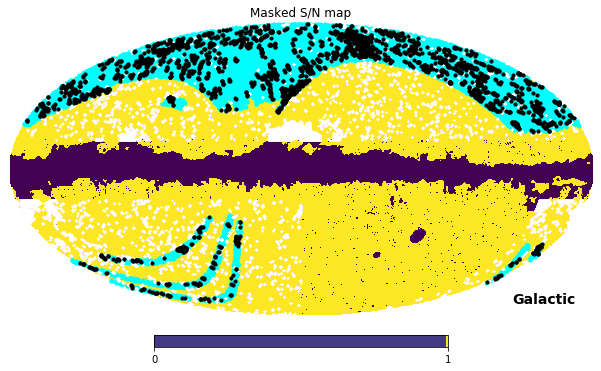

In [38]:
hp.mollview(mask,norm='hist',coord=['G'],title='Masked S/N map')
hp.visufunc.projscatter(dr7['GLON'],dr7['GLAT'],c='cyan',lonlat=True,s=10)
hp.visufunc.projscatter(maskedArray.glon,maskedArray.glat,c='w',lonlat=True,s=0.1)
hp.visufunc.projscatter(interLons, interLats,c='k',lonlat=True,s=10)

### Check against union mask

In [32]:
mask = hp.read_map('HFI_PCCS_SZ-selfunc-union-survey_2.02.fits')

# Get the nside and number of pixels in your map
nside = hp.get_nside(mask)
npix = hp.nside2npix(nside)
maskedPixels, = np.where(mask == 0)

# Use pix2ang to get the (l, b) coordinates for each pixel
glons, glats = hp.pix2ang(nside, maskedPixels, lonlat=True)
maskedArray = pd.DataFrame({'glon': np.around(glons,1), 'glat': np.around(glats,1)})
maskedArray = maskedArray[(maskedArray.glat > 6)|(maskedArray.glat<-6)].reset_index()

NSIDE = 2048
ORDERING = RING in fits file
INDXSCHM = IMPLICIT


In [33]:
# Get the nside and number of pixels in your map
nside = hp.get_nside(mask)
npix = hp.nside2npix(nside)
maskedPixels, = np.where(mask == 0)

# Use pix2ang to get the (l, b) coordinates for each pixel
glons, glats = hp.pix2ang(nside, maskedPixels, lonlat=True)
maskedArray = pd.DataFrame({'glon': np.around(glons,1), 'glat': np.around(glats,1)})
maskedArray = maskedArray[(maskedArray.glat > 15)|((maskedArray.glat<-15) & ((maskedArray.glon<210)))].reset_index()

In [34]:
unionLons = []
unionLats = []

for i in range(dr7.shape[0]):
    matchFlag=False
    for j in range(11): # Within 1 degree
        print(i,dr7.iloc[i][7],dr7.iloc[i][6])
        if not maskedArray.loc[np.logical_and(maskedArray.glon == dr7.iloc[i][7]+j/10, maskedArray.glat == dr7.iloc[i][6]+j/10)].empty:
            print("MATCH")
            matchFlag=True
            unionLons.append(dr7.iloc[i][7])
            unionLats.append(dr7.iloc[i][6])
            break
    if not matchFlag:
        for j in range(11): # Within 1 degree
            print(i,dr7.iloc[i][7],dr7.iloc[i][6])
            if not maskedArray.loc[np.logical_and(maskedArray.glon == dr7.iloc[i][7]-j/10, maskedArray.glat == dr7.iloc[i][6]-j/10)].empty:
                print("MATCH")
                matchFlag=True
                unionLons.append(dr7.iloc[i][7])
                unionLats.append(dr7.iloc[i][6])
                break
masked = pd.DataFrame({'glon': unionLons, 'glat': unionLats})

0 231.4 32.2
MATCH
1 231.9 31.0
1 231.9 31.0
1 231.9 31.0
1 231.9 31.0
1 231.9 31.0
1 231.9 31.0
1 231.9 31.0
1 231.9 31.0
1 231.9 31.0
1 231.9 31.0
1 231.9 31.0
1 231.9 31.0
1 231.9 31.0
1 231.9 31.0
1 231.9 31.0
1 231.9 31.0
1 231.9 31.0
1 231.9 31.0
1 231.9 31.0
1 231.9 31.0
1 231.9 31.0
1 231.9 31.0
2 225.0 21.6
2 225.0 21.6
2 225.0 21.6
2 225.0 21.6
2 225.0 21.6
2 225.0 21.6
2 225.0 21.6
2 225.0 21.6
2 225.0 21.6
2 225.0 21.6
2 225.0 21.6
2 225.0 21.6
2 225.0 21.6
2 225.0 21.6
2 225.0 21.6
2 225.0 21.6
2 225.0 21.6
2 225.0 21.6
2 225.0 21.6
2 225.0 21.6
2 225.0 21.6
2 225.0 21.6
3 231.3 31.8
3 231.3 31.8
3 231.3 31.8
MATCH
4 356.0 48.6
4 356.0 48.6
4 356.0 48.6
4 356.0 48.6
4 356.0 48.6
4 356.0 48.6
4 356.0 48.6
4 356.0 48.6
4 356.0 48.6
4 356.0 48.6
4 356.0 48.6
4 356.0 48.6
4 356.0 48.6
4 356.0 48.6
4 356.0 48.6
4 356.0 48.6
4 356.0 48.6
4 356.0 48.6
4 356.0 48.6
4 356.0 48.6
4 356.0 48.6
4 356.0 48.6
5 240.2 40.5
5 240.2 40.5
5 240.2 40.5
5 240.2 40.5
5 240.2 40.5
5 240.2 40.5


32 312.7 68.4
32 312.7 68.4
32 312.7 68.4
32 312.7 68.4
32 312.7 68.4
32 312.7 68.4
32 312.7 68.4
32 312.7 68.4
32 312.7 68.4
32 312.7 68.4
33 229.3 41.1
33 229.3 41.1
33 229.3 41.1
33 229.3 41.1
33 229.3 41.1
33 229.3 41.1
33 229.3 41.1
33 229.3 41.1
33 229.3 41.1
33 229.3 41.1
33 229.3 41.1
33 229.3 41.1
33 229.3 41.1
33 229.3 41.1
33 229.3 41.1
33 229.3 41.1
33 229.3 41.1
33 229.3 41.1
33 229.3 41.1
33 229.3 41.1
33 229.3 41.1
33 229.3 41.1
34 231.0 41.1
34 231.0 41.1
34 231.0 41.1
34 231.0 41.1
34 231.0 41.1
34 231.0 41.1
34 231.0 41.1
34 231.0 41.1
34 231.0 41.1
34 231.0 41.1
34 231.0 41.1
34 231.0 41.1
34 231.0 41.1
34 231.0 41.1
34 231.0 41.1
34 231.0 41.1
34 231.0 41.1
34 231.0 41.1
34 231.0 41.1
34 231.0 41.1
34 231.0 41.1
34 231.0 41.1
35 350.1 61.8
35 350.1 61.8
35 350.1 61.8
35 350.1 61.8
35 350.1 61.8
35 350.1 61.8
35 350.1 61.8
35 350.1 61.8
35 350.1 61.8
35 350.1 61.8
35 350.1 61.8
35 350.1 61.8
35 350.1 61.8
35 350.1 61.8
35 350.1 61.8
35 350.1 61.8
35 350.1 61.8
35 350

62 223.6 46.1
62 223.6 46.1
62 223.6 46.1
62 223.6 46.1
MATCH
63 217.5 25.8
63 217.5 25.8
63 217.5 25.8
63 217.5 25.8
63 217.5 25.8
63 217.5 25.8
63 217.5 25.8
63 217.5 25.8
63 217.5 25.8
63 217.5 25.8
63 217.5 25.8
63 217.5 25.8
63 217.5 25.8
63 217.5 25.8
63 217.5 25.8
63 217.5 25.8
63 217.5 25.8
63 217.5 25.8
63 217.5 25.8
63 217.5 25.8
63 217.5 25.8
63 217.5 25.8
64 218.4 32.4
64 218.4 32.4
64 218.4 32.4
64 218.4 32.4
64 218.4 32.4
64 218.4 32.4
64 218.4 32.4
64 218.4 32.4
64 218.4 32.4
64 218.4 32.4
64 218.4 32.4
64 218.4 32.4
64 218.4 32.4
64 218.4 32.4
64 218.4 32.4
64 218.4 32.4
64 218.4 32.4
64 218.4 32.4
64 218.4 32.4
64 218.4 32.4
64 218.4 32.4
64 218.4 32.4
65 235.8 63.1
65 235.8 63.1
65 235.8 63.1
65 235.8 63.1
65 235.8 63.1
65 235.8 63.1
65 235.8 63.1
65 235.8 63.1
65 235.8 63.1
65 235.8 63.1
65 235.8 63.1
65 235.8 63.1
65 235.8 63.1
65 235.8 63.1
65 235.8 63.1
65 235.8 63.1
65 235.8 63.1
65 235.8 63.1
65 235.8 63.1
65 235.8 63.1
65 235.8 63.1
65 235.8 63.1
66 243.7 70.0


90 216.5 37.2
90 216.5 37.2
90 216.5 37.2
90 216.5 37.2
90 216.5 37.2
90 216.5 37.2
91 216.0 36.5
91 216.0 36.5
91 216.0 36.5
91 216.0 36.5
91 216.0 36.5
91 216.0 36.5
91 216.0 36.5
91 216.0 36.5
91 216.0 36.5
91 216.0 36.5
91 216.0 36.5
91 216.0 36.5
91 216.0 36.5
91 216.0 36.5
91 216.0 36.5
91 216.0 36.5
91 216.0 36.5
91 216.0 36.5
91 216.0 36.5
91 216.0 36.5
91 216.0 36.5
91 216.0 36.5
92 225.8 61.9
92 225.8 61.9
92 225.8 61.9
92 225.8 61.9
92 225.8 61.9
92 225.8 61.9
92 225.8 61.9
92 225.8 61.9
92 225.8 61.9
92 225.8 61.9
92 225.8 61.9
92 225.8 61.9
92 225.8 61.9
92 225.8 61.9
92 225.8 61.9
92 225.8 61.9
92 225.8 61.9
92 225.8 61.9
92 225.8 61.9
92 225.8 61.9
92 225.8 61.9
92 225.8 61.9
93 231.5 72.1
93 231.5 72.1
93 231.5 72.1
93 231.5 72.1
93 231.5 72.1
93 231.5 72.1
93 231.5 72.1
93 231.5 72.1
93 231.5 72.1
93 231.5 72.1
93 231.5 72.1
93 231.5 72.1
93 231.5 72.1
93 231.5 72.1
93 231.5 72.1
93 231.5 72.1
93 231.5 72.1
93 231.5 72.1
93 231.5 72.1
93 231.5 72.1
93 231.5 72.1
93 231

117 213.2 44.2
117 213.2 44.2
117 213.2 44.2
117 213.2 44.2
117 213.2 44.2
117 213.2 44.2
117 213.2 44.2
117 213.2 44.2
117 213.2 44.2
117 213.2 44.2
117 213.2 44.2
118 210.1 28.3
118 210.1 28.3
118 210.1 28.3
118 210.1 28.3
118 210.1 28.3
118 210.1 28.3
118 210.1 28.3
118 210.1 28.3
118 210.1 28.3
118 210.1 28.3
118 210.1 28.3
118 210.1 28.3
118 210.1 28.3
118 210.1 28.3
118 210.1 28.3
118 210.1 28.3
118 210.1 28.3
118 210.1 28.3
118 210.1 28.3
118 210.1 28.3
118 210.1 28.3
118 210.1 28.3
119 210.8 35.5
119 210.8 35.5
119 210.8 35.5
119 210.8 35.5
119 210.8 35.5
119 210.8 35.5
119 210.8 35.5
119 210.8 35.5
119 210.8 35.5
119 210.8 35.5
119 210.8 35.5
119 210.8 35.5
119 210.8 35.5
119 210.8 35.5
119 210.8 35.5
119 210.8 35.5
119 210.8 35.5
119 210.8 35.5
119 210.8 35.5
119 210.8 35.5
119 210.8 35.5
119 210.8 35.5
120 27.9 40.3
120 27.9 40.3
120 27.9 40.3
120 27.9 40.3
120 27.9 40.3
120 27.9 40.3
120 27.9 40.3
120 27.9 40.3
120 27.9 40.3
120 27.9 40.3
120 27.9 40.3
120 27.9 40.3
120 27.

143 37.0 71.4
143 37.0 71.4
143 37.0 71.4
143 37.0 71.4
143 37.0 71.4
143 37.0 71.4
143 37.0 71.4
143 37.0 71.4
143 37.0 71.4
143 37.0 71.4
143 37.0 71.4
144 205.5 61.6
144 205.5 61.6
144 205.5 61.6
144 205.5 61.6
144 205.5 61.6
144 205.5 61.6
144 205.5 61.6
144 205.5 61.6
144 205.5 61.6
144 205.5 61.6
144 205.5 61.6
144 205.5 61.6
144 205.5 61.6
144 205.5 61.6
144 205.5 61.6
144 205.5 61.6
144 205.5 61.6
144 205.5 61.6
144 205.5 61.6
144 205.5 61.6
144 205.5 61.6
144 205.5 61.6
145 204.8 57.5
145 204.8 57.5
145 204.8 57.5
145 204.8 57.5
145 204.8 57.5
145 204.8 57.5
145 204.8 57.5
145 204.8 57.5
145 204.8 57.5
145 204.8 57.5
145 204.8 57.5
145 204.8 57.5
145 204.8 57.5
145 204.8 57.5
145 204.8 57.5
145 204.8 57.5
145 204.8 57.5
145 204.8 57.5
145 204.8 57.5
145 204.8 57.5
145 204.8 57.5
145 204.8 57.5
146 201.7 69.6
146 201.7 69.6
146 201.7 69.6
146 201.7 69.6
146 201.7 69.6
146 201.7 69.6
146 201.7 69.6
146 201.7 69.6
146 201.7 69.6
146 201.7 69.6
146 201.7 69.6
146 201.7 69.6
146 20

169 195.5 50.4
169 195.5 50.4
169 195.5 50.4
169 195.5 50.4
169 195.5 50.4
169 195.5 50.4
169 195.5 50.4
169 195.5 50.4
169 195.5 50.4
169 195.5 50.4
169 195.5 50.4
169 195.5 50.4
169 195.5 50.4
169 195.5 50.4
169 195.5 50.4
169 195.5 50.4
169 195.5 50.4
170 201.5 33.6
170 201.5 33.6
170 201.5 33.6
170 201.5 33.6
170 201.5 33.6
170 201.5 33.6
170 201.5 33.6
170 201.5 33.6
170 201.5 33.6
170 201.5 33.6
170 201.5 33.6
170 201.5 33.6
170 201.5 33.6
170 201.5 33.6
170 201.5 33.6
170 201.5 33.6
170 201.5 33.6
170 201.5 33.6
170 201.5 33.6
170 201.5 33.6
170 201.5 33.6
170 201.5 33.6
171 202.4 27.7
171 202.4 27.7
171 202.4 27.7
171 202.4 27.7
171 202.4 27.7
171 202.4 27.7
171 202.4 27.7
171 202.4 27.7
171 202.4 27.7
171 202.4 27.7
171 202.4 27.7
171 202.4 27.7
171 202.4 27.7
171 202.4 27.7
171 202.4 27.7
171 202.4 27.7
171 202.4 27.7
171 202.4 27.7
171 202.4 27.7
171 202.4 27.7
171 202.4 27.7
171 202.4 27.7
172 56.9 70.5
172 56.9 70.5
172 56.9 70.5
172 56.9 70.5
172 56.9 70.5
172 56.9 70.5
1

196 71.3 68.7
196 71.3 68.7
196 71.3 68.7
196 71.3 68.7
196 71.3 68.7
196 71.3 68.7
196 71.3 68.7
196 71.3 68.7
196 71.3 68.7
196 71.3 68.7
196 71.3 68.7
196 71.3 68.7
196 71.3 68.7
196 71.3 68.7
196 71.3 68.7
196 71.3 68.7
196 71.3 68.7
196 71.3 68.7
197 43.7 45.4
197 43.7 45.4
197 43.7 45.4
197 43.7 45.4
197 43.7 45.4
197 43.7 45.4
197 43.7 45.4
197 43.7 45.4
197 43.7 45.4
197 43.7 45.4
197 43.7 45.4
197 43.7 45.4
197 43.7 45.4
197 43.7 45.4
197 43.7 45.4
197 43.7 45.4
197 43.7 45.4
197 43.7 45.4
197 43.7 45.4
197 43.7 45.4
197 43.7 45.4
197 43.7 45.4
198 42.0 42.4
198 42.0 42.4
198 42.0 42.4
198 42.0 42.4
198 42.0 42.4
198 42.0 42.4
198 42.0 42.4
198 42.0 42.4
198 42.0 42.4
198 42.0 42.4
198 42.0 42.4
198 42.0 42.4
198 42.0 42.4
198 42.0 42.4
198 42.0 42.4
198 42.0 42.4
198 42.0 42.4
198 42.0 42.4
198 42.0 42.4
198 42.0 42.4
198 42.0 42.4
198 42.0 42.4
199 185.2 54.0
199 185.2 54.0
199 185.2 54.0
199 185.2 54.0
199 185.2 54.0
199 185.2 54.0
199 185.2 54.0
199 185.2 54.0
199 185.2 54

223 88.0 69.7
223 88.0 69.7
223 88.0 69.7
223 88.0 69.7
223 88.0 69.7
223 88.0 69.7
223 88.0 69.7
223 88.0 69.7
223 88.0 69.7
223 88.0 69.7
223 88.0 69.7
223 88.0 69.7
224 195.6 27.4
224 195.6 27.4
224 195.6 27.4
224 195.6 27.4
224 195.6 27.4
224 195.6 27.4
224 195.6 27.4
224 195.6 27.4
224 195.6 27.4
224 195.6 27.4
224 195.6 27.4
224 195.6 27.4
224 195.6 27.4
224 195.6 27.4
224 195.6 27.4
224 195.6 27.4
224 195.6 27.4
224 195.6 27.4
224 195.6 27.4
224 195.6 27.4
224 195.6 27.4
224 195.6 27.4
225 175.2 53.7
225 175.2 53.7
225 175.2 53.7
225 175.2 53.7
225 175.2 53.7
225 175.2 53.7
225 175.2 53.7
225 175.2 53.7
225 175.2 53.7
225 175.2 53.7
225 175.2 53.7
225 175.2 53.7
225 175.2 53.7
225 175.2 53.7
225 175.2 53.7
225 175.2 53.7
225 175.2 53.7
225 175.2 53.7
225 175.2 53.7
225 175.2 53.7
225 175.2 53.7
225 175.2 53.7
226 198.0 21.7
226 198.0 21.7
226 198.0 21.7
226 198.0 21.7
226 198.0 21.7
226 198.0 21.7
226 198.0 21.7
226 198.0 21.7
226 198.0 21.7
226 198.0 21.7
226 198.0 21.7
226 198

249 173.6 46.0
249 173.6 46.0
249 173.6 46.0
249 173.6 46.0
249 173.6 46.0
249 173.6 46.0
249 173.6 46.0
249 173.6 46.0
250 183.3 35.3
250 183.3 35.3
250 183.3 35.3
250 183.3 35.3
250 183.3 35.3
250 183.3 35.3
250 183.3 35.3
250 183.3 35.3
250 183.3 35.3
250 183.3 35.3
250 183.3 35.3
250 183.3 35.3
250 183.3 35.3
250 183.3 35.3
250 183.3 35.3
250 183.3 35.3
250 183.3 35.3
250 183.3 35.3
250 183.3 35.3
250 183.3 35.3
250 183.3 35.3
MATCH
251 178.2 42.4
251 178.2 42.4
251 178.2 42.4
251 178.2 42.4
251 178.2 42.4
MATCH
252 181.9 38.2
252 181.9 38.2
252 181.9 38.2
252 181.9 38.2
252 181.9 38.2
252 181.9 38.2
252 181.9 38.2
252 181.9 38.2
252 181.9 38.2
252 181.9 38.2
252 181.9 38.2
252 181.9 38.2
252 181.9 38.2
252 181.9 38.2
252 181.9 38.2
252 181.9 38.2
252 181.9 38.2
252 181.9 38.2
252 181.9 38.2
252 181.9 38.2
252 181.9 38.2
252 181.9 38.2
253 173.0 46.2
253 173.0 46.2
253 173.0 46.2
253 173.0 46.2
253 173.0 46.2
253 173.0 46.2
253 173.0 46.2
253 173.0 46.2
253 173.0 46.2
253 173.0 46.

277 184.2 28.4
277 184.2 28.4
277 184.2 28.4
278 145.3 53.9
278 145.3 53.9
278 145.3 53.9
278 145.3 53.9
278 145.3 53.9
278 145.3 53.9
278 145.3 53.9
278 145.3 53.9
278 145.3 53.9
278 145.3 53.9
278 145.3 53.9
278 145.3 53.9
278 145.3 53.9
278 145.3 53.9
278 145.3 53.9
278 145.3 53.9
278 145.3 53.9
278 145.3 53.9
278 145.3 53.9
278 145.3 53.9
278 145.3 53.9
278 145.3 53.9
279 122.1 57.9
279 122.1 57.9
279 122.1 57.9
279 122.1 57.9
279 122.1 57.9
279 122.1 57.9
279 122.1 57.9
279 122.1 57.9
279 122.1 57.9
279 122.1 57.9
279 122.1 57.9
279 122.1 57.9
279 122.1 57.9
279 122.1 57.9
279 122.1 57.9
279 122.1 57.9
279 122.1 57.9
279 122.1 57.9
279 122.1 57.9
279 122.1 57.9
279 122.1 57.9
279 122.1 57.9
280 134.1 54.9
280 134.1 54.9
280 134.1 54.9
280 134.1 54.9
280 134.1 54.9
MATCH
281 89.4 53.7
281 89.4 53.7
281 89.4 53.7
281 89.4 53.7
281 89.4 53.7
281 89.4 53.7
281 89.4 53.7
281 89.4 53.7
281 89.4 53.7
281 89.4 53.7
281 89.4 53.7
281 89.4 53.7
281 89.4 53.7
281 89.4 53.7
281 89.4 53.7
281 

305 176.7 24.5
305 176.7 24.5
305 176.7 24.5
305 176.7 24.5
305 176.7 24.5
305 176.7 24.5
305 176.7 24.5
305 176.7 24.5
305 176.7 24.5
305 176.7 24.5
305 176.7 24.5
305 176.7 24.5
305 176.7 24.5
305 176.7 24.5
305 176.7 24.5
305 176.7 24.5
305 176.7 24.5
306 90.2 35.6
306 90.2 35.6
306 90.2 35.6
306 90.2 35.6
306 90.2 35.6
306 90.2 35.6
306 90.2 35.6
306 90.2 35.6
306 90.2 35.6
306 90.2 35.6
306 90.2 35.6
306 90.2 35.6
306 90.2 35.6
306 90.2 35.6
306 90.2 35.6
306 90.2 35.6
306 90.2 35.6
306 90.2 35.6
306 90.2 35.6
MATCH
307 125.5 -48.9
307 125.5 -48.9
307 125.5 -48.9
307 125.5 -48.9
307 125.5 -48.9
307 125.5 -48.9
307 125.5 -48.9
307 125.5 -48.9
307 125.5 -48.9
307 125.5 -48.9
307 125.5 -48.9
307 125.5 -48.9
307 125.5 -48.9
307 125.5 -48.9
307 125.5 -48.9
307 125.5 -48.9
307 125.5 -48.9
307 125.5 -48.9
307 125.5 -48.9
307 125.5 -48.9
307 125.5 -48.9
307 125.5 -48.9
308 72.7 -33.3
308 72.7 -33.3
308 72.7 -33.3
308 72.7 -33.3
308 72.7 -33.3
308 72.7 -33.3
308 72.7 -33.3
308 72.7 -33.3
3

330 355.5 48.2
330 355.5 48.2
330 355.5 48.2
330 355.5 48.2
330 355.5 48.2
331 226.2 23.3
331 226.2 23.3
331 226.2 23.3
331 226.2 23.3
331 226.2 23.3
331 226.2 23.3
331 226.2 23.3
331 226.2 23.3
331 226.2 23.3
331 226.2 23.3
331 226.2 23.3
331 226.2 23.3
331 226.2 23.3
331 226.2 23.3
331 226.2 23.3
331 226.2 23.3
331 226.2 23.3
331 226.2 23.3
331 226.2 23.3
331 226.2 23.3
331 226.2 23.3
331 226.2 23.3
332 231.9 31.5
332 231.9 31.5
332 231.9 31.5
332 231.9 31.5
332 231.9 31.5
332 231.9 31.5
332 231.9 31.5
332 231.9 31.5
332 231.9 31.5
332 231.9 31.5
332 231.9 31.5
332 231.9 31.5
332 231.9 31.5
332 231.9 31.5
332 231.9 31.5
332 231.9 31.5
332 231.9 31.5
332 231.9 31.5
332 231.9 31.5
332 231.9 31.5
332 231.9 31.5
332 231.9 31.5
333 226.0 23.6
333 226.0 23.6
333 226.0 23.6
333 226.0 23.6
333 226.0 23.6
333 226.0 23.6
333 226.0 23.6
333 226.0 23.6
333 226.0 23.6
333 226.0 23.6
333 226.0 23.6
333 226.0 23.6
333 226.0 23.6
333 226.0 23.6
333 226.0 23.6
333 226.0 23.6
333 226.0 23.6
333 226.0 

361 300.2 61.9
361 300.2 61.9
361 300.2 61.9
361 300.2 61.9
361 300.2 61.9
361 300.2 61.9
361 300.2 61.9
361 300.2 61.9
361 300.2 61.9
361 300.2 61.9
361 300.2 61.9
361 300.2 61.9
361 300.2 61.9
361 300.2 61.9
361 300.2 61.9
361 300.2 61.9
362 348.5 52.6
362 348.5 52.6
362 348.5 52.6
362 348.5 52.6
362 348.5 52.6
362 348.5 52.6
362 348.5 52.6
362 348.5 52.6
362 348.5 52.6
362 348.5 52.6
362 348.5 52.6
362 348.5 52.6
362 348.5 52.6
362 348.5 52.6
362 348.5 52.6
362 348.5 52.6
362 348.5 52.6
362 348.5 52.6
362 348.5 52.6
362 348.5 52.6
362 348.5 52.6
362 348.5 52.6
363 245.2 45.5
363 245.2 45.5
363 245.2 45.5
363 245.2 45.5
363 245.2 45.5
363 245.2 45.5
363 245.2 45.5
363 245.2 45.5
363 245.2 45.5
MATCH
364 245.5 45.6
364 245.5 45.6
364 245.5 45.6
364 245.5 45.6
364 245.5 45.6
364 245.5 45.6
364 245.5 45.6
364 245.5 45.6
364 245.5 45.6
MATCH
365 245.4 45.6
365 245.4 45.6
365 245.4 45.6
365 245.4 45.6
365 245.4 45.6
365 245.4 45.6
365 245.4 45.6
365 245.4 45.6
365 245.4 45.6
365 245.4 45.

391 227.8 31.1
391 227.8 31.1
391 227.8 31.1
391 227.8 31.1
391 227.8 31.1
391 227.8 31.1
391 227.8 31.1
391 227.8 31.1
391 227.8 31.1
391 227.8 31.1
391 227.8 31.1
391 227.8 31.1
391 227.8 31.1
391 227.8 31.1
391 227.8 31.1
391 227.8 31.1
392 224.9 24.1
392 224.9 24.1
392 224.9 24.1
392 224.9 24.1
392 224.9 24.1
392 224.9 24.1
392 224.9 24.1
392 224.9 24.1
392 224.9 24.1
392 224.9 24.1
392 224.9 24.1
392 224.9 24.1
392 224.9 24.1
392 224.9 24.1
392 224.9 24.1
392 224.9 24.1
392 224.9 24.1
392 224.9 24.1
392 224.9 24.1
392 224.9 24.1
392 224.9 24.1
392 224.9 24.1
393 234.0 37.8
393 234.0 37.8
393 234.0 37.8
393 234.0 37.8
393 234.0 37.8
393 234.0 37.8
393 234.0 37.8
393 234.0 37.8
393 234.0 37.8
393 234.0 37.8
393 234.0 37.8
393 234.0 37.8
393 234.0 37.8
393 234.0 37.8
393 234.0 37.8
393 234.0 37.8
393 234.0 37.8
393 234.0 37.8
393 234.0 37.8
393 234.0 37.8
393 234.0 37.8
393 234.0 37.8
394 235.9 41.1
394 235.9 41.1
394 235.9 41.1
394 235.9 41.1
394 235.9 41.1
394 235.9 41.1
394 235.9 

422 260.3 57.3
422 260.3 57.3
422 260.3 57.3
422 260.3 57.3
422 260.3 57.3
422 260.3 57.3
422 260.3 57.3
422 260.3 57.3
422 260.3 57.3
423 327.8 62.2
423 327.8 62.2
423 327.8 62.2
423 327.8 62.2
423 327.8 62.2
423 327.8 62.2
423 327.8 62.2
423 327.8 62.2
423 327.8 62.2
423 327.8 62.2
423 327.8 62.2
423 327.8 62.2
423 327.8 62.2
423 327.8 62.2
423 327.8 62.2
423 327.8 62.2
423 327.8 62.2
423 327.8 62.2
423 327.8 62.2
423 327.8 62.2
423 327.8 62.2
423 327.8 62.2
424 353.0 53.3
424 353.0 53.3
424 353.0 53.3
424 353.0 53.3
424 353.0 53.3
424 353.0 53.3
424 353.0 53.3
424 353.0 53.3
424 353.0 53.3
424 353.0 53.3
424 353.0 53.3
424 353.0 53.3
424 353.0 53.3
424 353.0 53.3
424 353.0 53.3
424 353.0 53.3
424 353.0 53.3
424 353.0 53.3
424 353.0 53.3
424 353.0 53.3
424 353.0 53.3
424 353.0 53.3
425 250.6 52.9
425 250.6 52.9
425 250.6 52.9
425 250.6 52.9
425 250.6 52.9
425 250.6 52.9
425 250.6 52.9
425 250.6 52.9
425 250.6 52.9
425 250.6 52.9
425 250.6 52.9
425 250.6 52.9
425 250.6 52.9
425 250.6 

449 251.2 54.9
449 251.2 54.9
449 251.2 54.9
450 252.5 56.0
450 252.5 56.0
450 252.5 56.0
450 252.5 56.0
450 252.5 56.0
450 252.5 56.0
450 252.5 56.0
450 252.5 56.0
450 252.5 56.0
450 252.5 56.0
450 252.5 56.0
450 252.5 56.0
450 252.5 56.0
450 252.5 56.0
450 252.5 56.0
450 252.5 56.0
450 252.5 56.0
450 252.5 56.0
450 252.5 56.0
450 252.5 56.0
450 252.5 56.0
450 252.5 56.0
451 254.9 57.2
451 254.9 57.2
451 254.9 57.2
451 254.9 57.2
451 254.9 57.2
451 254.9 57.2
451 254.9 57.2
451 254.9 57.2
451 254.9 57.2
451 254.9 57.2
451 254.9 57.2
451 254.9 57.2
451 254.9 57.2
451 254.9 57.2
451 254.9 57.2
451 254.9 57.2
451 254.9 57.2
451 254.9 57.2
451 254.9 57.2
451 254.9 57.2
451 254.9 57.2
451 254.9 57.2
452 5.8 43.9
452 5.8 43.9
452 5.8 43.9
452 5.8 43.9
452 5.8 43.9
452 5.8 43.9
452 5.8 43.9
452 5.8 43.9
452 5.8 43.9
452 5.8 43.9
452 5.8 43.9
452 5.8 43.9
452 5.8 43.9
452 5.8 43.9
452 5.8 43.9
452 5.8 43.9
452 5.8 43.9
452 5.8 43.9
452 5.8 43.9
452 5.8 43.9
452 5.8 43.9
452 5.8 43.9
453 223.8

479 242.1 51.0
479 242.1 51.0
479 242.1 51.0
479 242.1 51.0
479 242.1 51.0
479 242.1 51.0
479 242.1 51.0
479 242.1 51.0
480 243.5 51.9
480 243.5 51.9
480 243.5 51.9
480 243.5 51.9
480 243.5 51.9
480 243.5 51.9
480 243.5 51.9
480 243.5 51.9
480 243.5 51.9
480 243.5 51.9
480 243.5 51.9
480 243.5 51.9
480 243.5 51.9
480 243.5 51.9
480 243.5 51.9
480 243.5 51.9
480 243.5 51.9
480 243.5 51.9
480 243.5 51.9
480 243.5 51.9
480 243.5 51.9
480 243.5 51.9
481 234.0 44.4
481 234.0 44.4
481 234.0 44.4
481 234.0 44.4
481 234.0 44.4
481 234.0 44.4
481 234.0 44.4
481 234.0 44.4
481 234.0 44.4
481 234.0 44.4
481 234.0 44.4
481 234.0 44.4
481 234.0 44.4
481 234.0 44.4
481 234.0 44.4
481 234.0 44.4
481 234.0 44.4
481 234.0 44.4
481 234.0 44.4
481 234.0 44.4
481 234.0 44.4
481 234.0 44.4
482 242.0 52.2
482 242.0 52.2
482 242.0 52.2
482 242.0 52.2
482 242.0 52.2
482 242.0 52.2
482 242.0 52.2
482 242.0 52.2
482 242.0 52.2
482 242.0 52.2
482 242.0 52.2
482 242.0 52.2
482 242.0 52.2
482 242.0 52.2
482 242.0 

511 273.8 66.4
511 273.8 66.4
511 273.8 66.4
511 273.8 66.4
511 273.8 66.4
511 273.8 66.4
511 273.8 66.4
511 273.8 66.4
511 273.8 66.4
511 273.8 66.4
511 273.8 66.4
511 273.8 66.4
511 273.8 66.4
511 273.8 66.4
511 273.8 66.4
512 296.0 67.0
512 296.0 67.0
512 296.0 67.0
512 296.0 67.0
512 296.0 67.0
512 296.0 67.0
512 296.0 67.0
512 296.0 67.0
512 296.0 67.0
512 296.0 67.0
512 296.0 67.0
512 296.0 67.0
512 296.0 67.0
512 296.0 67.0
512 296.0 67.0
512 296.0 67.0
512 296.0 67.0
512 296.0 67.0
512 296.0 67.0
512 296.0 67.0
512 296.0 67.0
512 296.0 67.0
513 329.1 64.5
513 329.1 64.5
513 329.1 64.5
513 329.1 64.5
513 329.1 64.5
513 329.1 64.5
513 329.1 64.5
513 329.1 64.5
513 329.1 64.5
513 329.1 64.5
513 329.1 64.5
513 329.1 64.5
513 329.1 64.5
513 329.1 64.5
513 329.1 64.5
513 329.1 64.5
513 329.1 64.5
513 329.1 64.5
513 329.1 64.5
513 329.1 64.5
513 329.1 64.5
513 329.1 64.5
514 264.9 62.5
514 264.9 62.5
514 264.9 62.5
514 264.9 62.5
514 264.9 62.5
514 264.9 62.5
514 264.9 62.5
514 264.9 

539 224.4 33.1
539 224.4 33.1
539 224.4 33.1
539 224.4 33.1
539 224.4 33.1
539 224.4 33.1
539 224.4 33.1
539 224.4 33.1
539 224.4 33.1
539 224.4 33.1
539 224.4 33.1
539 224.4 33.1
540 230.3 43.0
540 230.3 43.0
540 230.3 43.0
540 230.3 43.0
540 230.3 43.0
540 230.3 43.0
540 230.3 43.0
540 230.3 43.0
540 230.3 43.0
540 230.3 43.0
540 230.3 43.0
540 230.3 43.0
540 230.3 43.0
540 230.3 43.0
540 230.3 43.0
540 230.3 43.0
540 230.3 43.0
540 230.3 43.0
540 230.3 43.0
540 230.3 43.0
540 230.3 43.0
540 230.3 43.0
541 350.6 60.6
541 350.6 60.6
541 350.6 60.6
541 350.6 60.6
541 350.6 60.6
541 350.6 60.6
541 350.6 60.6
541 350.6 60.6
541 350.6 60.6
541 350.6 60.6
541 350.6 60.6
541 350.6 60.6
541 350.6 60.6
541 350.6 60.6
541 350.6 60.6
541 350.6 60.6
541 350.6 60.6
541 350.6 60.6
541 350.6 60.6
541 350.6 60.6
541 350.6 60.6
541 350.6 60.6
542 6.0 50.0
542 6.0 50.0
542 6.0 50.0
542 6.0 50.0
542 6.0 50.0
542 6.0 50.0
542 6.0 50.0
542 6.0 50.0
542 6.0 50.0
542 6.0 50.0
542 6.0 50.0
542 6.0 50.0
542 

567 14.2 38.9
567 14.2 38.9
567 14.2 38.9
567 14.2 38.9
567 14.2 38.9
567 14.2 38.9
567 14.2 38.9
567 14.2 38.9
567 14.2 38.9
567 14.2 38.9
567 14.2 38.9
567 14.2 38.9
567 14.2 38.9
568 4.5 51.9
568 4.5 51.9
568 4.5 51.9
568 4.5 51.9
568 4.5 51.9
568 4.5 51.9
568 4.5 51.9
568 4.5 51.9
568 4.5 51.9
568 4.5 51.9
568 4.5 51.9
568 4.5 51.9
568 4.5 51.9
568 4.5 51.9
568 4.5 51.9
568 4.5 51.9
568 4.5 51.9
568 4.5 51.9
568 4.5 51.9
568 4.5 51.9
568 4.5 51.9
568 4.5 51.9
569 0.2 57.0
569 0.2 57.0
569 0.2 57.0
569 0.2 57.0
569 0.2 57.0
569 0.2 57.0
569 0.2 57.0
569 0.2 57.0
569 0.2 57.0
569 0.2 57.0
569 0.2 57.0
569 0.2 57.0
569 0.2 57.0
569 0.2 57.0
569 0.2 57.0
569 0.2 57.0
569 0.2 57.0
569 0.2 57.0
569 0.2 57.0
569 0.2 57.0
569 0.2 57.0
569 0.2 57.0
570 7.6 50.2
570 7.6 50.2
570 7.6 50.2
570 7.6 50.2
570 7.6 50.2
570 7.6 50.2
570 7.6 50.2
570 7.6 50.2
570 7.6 50.2
570 7.6 50.2
570 7.6 50.2
570 7.6 50.2
570 7.6 50.2
570 7.6 50.2
570 7.6 50.2
570 7.6 50.2
570 7.6 50.2
570 7.6 50.2
570 7.6 50.2

596 225.7 36.6
596 225.7 36.6
596 225.7 36.6
596 225.7 36.6
596 225.7 36.6
596 225.7 36.6
596 225.7 36.6
596 225.7 36.6
596 225.7 36.6
596 225.7 36.6
596 225.7 36.6
597 228.9 42.3
597 228.9 42.3
597 228.9 42.3
597 228.9 42.3
597 228.9 42.3
597 228.9 42.3
597 228.9 42.3
597 228.9 42.3
597 228.9 42.3
597 228.9 42.3
597 228.9 42.3
597 228.9 42.3
597 228.9 42.3
597 228.9 42.3
597 228.9 42.3
597 228.9 42.3
597 228.9 42.3
597 228.9 42.3
597 228.9 42.3
597 228.9 42.3
597 228.9 42.3
597 228.9 42.3
598 222.9 31.7
598 222.9 31.7
598 222.9 31.7
598 222.9 31.7
598 222.9 31.7
598 222.9 31.7
598 222.9 31.7
598 222.9 31.7
598 222.9 31.7
598 222.9 31.7
598 222.9 31.7
598 222.9 31.7
598 222.9 31.7
598 222.9 31.7
598 222.9 31.7
598 222.9 31.7
MATCH
599 226.2 38.3
599 226.2 38.3
599 226.2 38.3
599 226.2 38.3
599 226.2 38.3
599 226.2 38.3
599 226.2 38.3
599 226.2 38.3
599 226.2 38.3
599 226.2 38.3
599 226.2 38.3
599 226.2 38.3
599 226.2 38.3
599 226.2 38.3
599 226.2 38.3
599 226.2 38.3
599 226.2 38.3
599 

623 242.1 59.9
623 242.1 59.9
623 242.1 59.9
623 242.1 59.9
623 242.1 59.9
623 242.1 59.9
623 242.1 59.9
623 242.1 59.9
624 262.0 69.5
624 262.0 69.5
624 262.0 69.5
624 262.0 69.5
624 262.0 69.5
624 262.0 69.5
624 262.0 69.5
624 262.0 69.5
624 262.0 69.5
624 262.0 69.5
624 262.0 69.5
624 262.0 69.5
624 262.0 69.5
624 262.0 69.5
624 262.0 69.5
624 262.0 69.5
624 262.0 69.5
624 262.0 69.5
624 262.0 69.5
624 262.0 69.5
624 262.0 69.5
624 262.0 69.5
625 271.4 71.7
625 271.4 71.7
625 271.4 71.7
625 271.4 71.7
625 271.4 71.7
625 271.4 71.7
625 271.4 71.7
625 271.4 71.7
625 271.4 71.7
625 271.4 71.7
625 271.4 71.7
625 271.4 71.7
625 271.4 71.7
625 271.4 71.7
625 271.4 71.7
625 271.4 71.7
625 271.4 71.7
625 271.4 71.7
625 271.4 71.7
625 271.4 71.7
625 271.4 71.7
625 271.4 71.7
626 4.3 54.3
626 4.3 54.3
626 4.3 54.3
626 4.3 54.3
626 4.3 54.3
626 4.3 54.3
626 4.3 54.3
626 4.3 54.3
626 4.3 54.3
626 4.3 54.3
626 4.3 54.3
626 4.3 54.3
626 4.3 54.3
626 4.3 54.3
626 4.3 54.3
626 4.3 54.3
626 4.3 54.3

651 223.0 37.0
651 223.0 37.0
651 223.0 37.0
651 223.0 37.0
651 223.0 37.0
651 223.0 37.0
651 223.0 37.0
651 223.0 37.0
651 223.0 37.0
651 223.0 37.0
651 223.0 37.0
651 223.0 37.0
651 223.0 37.0
651 223.0 37.0
651 223.0 37.0
651 223.0 37.0
651 223.0 37.0
651 223.0 37.0
651 223.0 37.0
651 223.0 37.0
651 223.0 37.0
652 223.9 39.0
652 223.9 39.0
652 223.9 39.0
652 223.9 39.0
652 223.9 39.0
652 223.9 39.0
652 223.9 39.0
652 223.9 39.0
652 223.9 39.0
652 223.9 39.0
652 223.9 39.0
652 223.9 39.0
652 223.9 39.0
652 223.9 39.0
652 223.9 39.0
652 223.9 39.0
652 223.9 39.0
652 223.9 39.0
652 223.9 39.0
652 223.9 39.0
652 223.9 39.0
652 223.9 39.0
653 218.3 25.1
653 218.3 25.1
653 218.3 25.1
653 218.3 25.1
653 218.3 25.1
653 218.3 25.1
653 218.3 25.1
653 218.3 25.1
653 218.3 25.1
653 218.3 25.1
653 218.3 25.1
653 218.3 25.1
653 218.3 25.1
653 218.3 25.1
653 218.3 25.1
653 218.3 25.1
653 218.3 25.1
653 218.3 25.1
653 218.3 25.1
653 218.3 25.1
653 218.3 25.1
653 218.3 25.1
654 227.3 44.0
654 227.3 

679 242.7 63.6
679 242.7 63.6
679 242.7 63.6
679 242.7 63.6
679 242.7 63.6
679 242.7 63.6
680 251.2 68.1
680 251.2 68.1
680 251.2 68.1
680 251.2 68.1
680 251.2 68.1
680 251.2 68.1
680 251.2 68.1
680 251.2 68.1
680 251.2 68.1
680 251.2 68.1
680 251.2 68.1
680 251.2 68.1
680 251.2 68.1
680 251.2 68.1
680 251.2 68.1
680 251.2 68.1
680 251.2 68.1
680 251.2 68.1
680 251.2 68.1
680 251.2 68.1
680 251.2 68.1
680 251.2 68.1
681 276.0 74.0
681 276.0 74.0
681 276.0 74.0
681 276.0 74.0
681 276.0 74.0
681 276.0 74.0
681 276.0 74.0
681 276.0 74.0
681 276.0 74.0
681 276.0 74.0
681 276.0 74.0
681 276.0 74.0
681 276.0 74.0
681 276.0 74.0
681 276.0 74.0
681 276.0 74.0
681 276.0 74.0
681 276.0 74.0
681 276.0 74.0
681 276.0 74.0
681 276.0 74.0
681 276.0 74.0
682 237.7 60.8
682 237.7 60.8
682 237.7 60.8
682 237.7 60.8
682 237.7 60.8
682 237.7 60.8
682 237.7 60.8
682 237.7 60.8
682 237.7 60.8
682 237.7 60.8
682 237.7 60.8
682 237.7 60.8
682 237.7 60.8
682 237.7 60.8
682 237.7 60.8
682 237.7 60.8
682 237.7 

711 224.2 44.7
711 224.2 44.7
711 224.2 44.7
711 224.2 44.7
711 224.2 44.7
711 224.2 44.7
711 224.2 44.7
711 224.2 44.7
711 224.2 44.7
711 224.2 44.7
711 224.2 44.7
MATCH
712 224.8 45.5
712 224.8 45.5
712 224.8 45.5
712 224.8 45.5
712 224.8 45.5
712 224.8 45.5
712 224.8 45.5
712 224.8 45.5
712 224.8 45.5
712 224.8 45.5
712 224.8 45.5
712 224.8 45.5
712 224.8 45.5
712 224.8 45.5
712 224.8 45.5
712 224.8 45.5
712 224.8 45.5
712 224.8 45.5
712 224.8 45.5
712 224.8 45.5
712 224.8 45.5
712 224.8 45.5
713 215.8 21.5
713 215.8 21.5
713 215.8 21.5
713 215.8 21.5
713 215.8 21.5
713 215.8 21.5
713 215.8 21.5
713 215.8 21.5
713 215.8 21.5
713 215.8 21.5
713 215.8 21.5
713 215.8 21.5
713 215.8 21.5
713 215.8 21.5
713 215.8 21.5
713 215.8 21.5
713 215.8 21.5
713 215.8 21.5
713 215.8 21.5
713 215.8 21.5
713 215.8 21.5
713 215.8 21.5
714 217.6 28.9
714 217.6 28.9
714 217.6 28.9
714 217.6 28.9
714 217.6 28.9
714 217.6 28.9
714 217.6 28.9
714 217.6 28.9
714 217.6 28.9
714 217.6 28.9
714 217.6 28.9
714 

741 355.8 70.1
741 355.8 70.1
741 355.8 70.1
742 18.4 43.6
742 18.4 43.6
742 18.4 43.6
742 18.4 43.6
742 18.4 43.6
742 18.4 43.6
742 18.4 43.6
742 18.4 43.6
742 18.4 43.6
742 18.4 43.6
742 18.4 43.6
742 18.4 43.6
742 18.4 43.6
742 18.4 43.6
742 18.4 43.6
742 18.4 43.6
742 18.4 43.6
742 18.4 43.6
742 18.4 43.6
742 18.4 43.6
742 18.4 43.6
742 18.4 43.6
743 21.2 36.0
743 21.2 36.0
743 21.2 36.0
743 21.2 36.0
743 21.2 36.0
743 21.2 36.0
743 21.2 36.0
743 21.2 36.0
743 21.2 36.0
743 21.2 36.0
743 21.2 36.0
743 21.2 36.0
743 21.2 36.0
743 21.2 36.0
743 21.2 36.0
743 21.2 36.0
743 21.2 36.0
743 21.2 36.0
743 21.2 36.0
743 21.2 36.0
743 21.2 36.0
743 21.2 36.0
744 14.6 52.6
744 14.6 52.6
744 14.6 52.6
744 14.6 52.6
744 14.6 52.6
744 14.6 52.6
744 14.6 52.6
744 14.6 52.6
744 14.6 52.6
744 14.6 52.6
744 14.6 52.6
744 14.6 52.6
744 14.6 52.6
744 14.6 52.6
744 14.6 52.6
744 14.6 52.6
MATCH
745 16.6 49.0
745 16.6 49.0
745 16.6 49.0
745 16.6 49.0
745 16.6 49.0
745 16.6 49.0
745 16.6 49.0
745 16.6 49

770 348.7 70.6
770 348.7 70.6
770 348.7 70.6
770 348.7 70.6
770 348.7 70.6
770 348.7 70.6
770 348.7 70.6
770 348.7 70.6
771 249.7 70.8
771 249.7 70.8
771 249.7 70.8
771 249.7 70.8
771 249.7 70.8
771 249.7 70.8
771 249.7 70.8
771 249.7 70.8
771 249.7 70.8
771 249.7 70.8
771 249.7 70.8
771 249.7 70.8
771 249.7 70.8
771 249.7 70.8
771 249.7 70.8
771 249.7 70.8
771 249.7 70.8
771 249.7 70.8
771 249.7 70.8
771 249.7 70.8
771 249.7 70.8
771 249.7 70.8
772 269.6 75.6
772 269.6 75.6
772 269.6 75.6
772 269.6 75.6
772 269.6 75.6
772 269.6 75.6
772 269.6 75.6
772 269.6 75.6
772 269.6 75.6
772 269.6 75.6
772 269.6 75.6
772 269.6 75.6
772 269.6 75.6
772 269.6 75.6
772 269.6 75.6
772 269.6 75.6
772 269.6 75.6
772 269.6 75.6
772 269.6 75.6
772 269.6 75.6
772 269.6 75.6
772 269.6 75.6
773 305.6 77.5
773 305.6 77.5
773 305.6 77.5
773 305.6 77.5
773 305.6 77.5
773 305.6 77.5
773 305.6 77.5
773 305.6 77.5
773 305.6 77.5
773 305.6 77.5
773 305.6 77.5
773 305.6 77.5
773 305.6 77.5
773 305.6 77.5
773 305.6 

798 220.4 47.5
798 220.4 47.5
798 220.4 47.5
798 220.4 47.5
798 220.4 47.5
798 220.4 47.5
798 220.4 47.5
798 220.4 47.5
798 220.4 47.5
798 220.4 47.5
798 220.4 47.5
798 220.4 47.5
798 220.4 47.5
798 220.4 47.5
798 220.4 47.5
798 220.4 47.5
798 220.4 47.5
798 220.4 47.5
798 220.4 47.5
798 220.4 47.5
798 220.4 47.5
798 220.4 47.5
799 4.1 66.9
799 4.1 66.9
799 4.1 66.9
799 4.1 66.9
799 4.1 66.9
799 4.1 66.9
799 4.1 66.9
799 4.1 66.9
799 4.1 66.9
799 4.1 66.9
799 4.1 66.9
799 4.1 66.9
799 4.1 66.9
799 4.1 66.9
799 4.1 66.9
799 4.1 66.9
799 4.1 66.9
799 4.1 66.9
799 4.1 66.9
799 4.1 66.9
799 4.1 66.9
799 4.1 66.9
800 6.5 65.0
800 6.5 65.0
800 6.5 65.0
800 6.5 65.0
800 6.5 65.0
800 6.5 65.0
800 6.5 65.0
800 6.5 65.0
800 6.5 65.0
800 6.5 65.0
800 6.5 65.0
800 6.5 65.0
800 6.5 65.0
800 6.5 65.0
800 6.5 65.0
800 6.5 65.0
800 6.5 65.0
800 6.5 65.0
800 6.5 65.0
800 6.5 65.0
800 6.5 65.0
800 6.5 65.0
801 11.6 59.6
801 11.6 59.6
801 11.6 59.6
801 11.6 59.6
801 11.6 59.6
801 11.6 59.6
801 11.6 59.6


829 235.2 66.8
829 235.2 66.8
MATCH
830 235.6 67.1
MATCH
831 271.5 78.6
831 271.5 78.6
831 271.5 78.6
831 271.5 78.6
831 271.5 78.6
831 271.5 78.6
831 271.5 78.6
831 271.5 78.6
831 271.5 78.6
831 271.5 78.6
831 271.5 78.6
831 271.5 78.6
831 271.5 78.6
831 271.5 78.6
831 271.5 78.6
831 271.5 78.6
831 271.5 78.6
831 271.5 78.6
831 271.5 78.6
831 271.5 78.6
831 271.5 78.6
831 271.5 78.6
832 287.5 80.2
832 287.5 80.2
832 287.5 80.2
832 287.5 80.2
832 287.5 80.2
832 287.5 80.2
832 287.5 80.2
832 287.5 80.2
832 287.5 80.2
832 287.5 80.2
832 287.5 80.2
832 287.5 80.2
832 287.5 80.2
832 287.5 80.2
832 287.5 80.2
832 287.5 80.2
832 287.5 80.2
832 287.5 80.2
832 287.5 80.2
832 287.5 80.2
832 287.5 80.2
832 287.5 80.2
833 319.9 79.8
833 319.9 79.8
833 319.9 79.8
833 319.9 79.8
833 319.9 79.8
833 319.9 79.8
833 319.9 79.8
833 319.9 79.8
833 319.9 79.8
833 319.9 79.8
833 319.9 79.8
833 319.9 79.8
833 319.9 79.8
833 319.9 79.8
833 319.9 79.8
833 319.9 79.8
833 319.9 79.8
833 319.9 79.8
833 319.9 79.

859 309.4 81.3
859 309.4 81.3
859 309.4 81.3
859 309.4 81.3
859 309.4 81.3
859 309.4 81.3
859 309.4 81.3
859 309.4 81.3
859 309.4 81.3
859 309.4 81.3
859 309.4 81.3
859 309.4 81.3
859 309.4 81.3
859 309.4 81.3
859 309.4 81.3
859 309.4 81.3
860 223.8 50.4
860 223.8 50.4
860 223.8 50.4
860 223.8 50.4
860 223.8 50.4
860 223.8 50.4
860 223.8 50.4
860 223.8 50.4
860 223.8 50.4
860 223.8 50.4
860 223.8 50.4
860 223.8 50.4
860 223.8 50.4
860 223.8 50.4
860 223.8 50.4
860 223.8 50.4
860 223.8 50.4
860 223.8 50.4
860 223.8 50.4
860 223.8 50.4
860 223.8 50.4
860 223.8 50.4
861 224.1 51.6
861 224.1 51.6
861 224.1 51.6
861 224.1 51.6
861 224.1 51.6
861 224.1 51.6
861 224.1 51.6
861 224.1 51.6
861 224.1 51.6
861 224.1 51.6
861 224.1 51.6
861 224.1 51.6
861 224.1 51.6
861 224.1 51.6
861 224.1 51.6
861 224.1 51.6
861 224.1 51.6
861 224.1 51.6
861 224.1 51.6
861 224.1 51.6
861 224.1 51.6
861 224.1 51.6
862 222.0 49.0
862 222.0 49.0
862 222.0 49.0
862 222.0 49.0
862 222.0 49.0
862 222.0 49.0
862 222.0 

885 4.3 72.3
885 4.3 72.3
885 4.3 72.3
885 4.3 72.3
885 4.3 72.3
885 4.3 72.3
885 4.3 72.3
886 20.8 50.0
886 20.8 50.0
886 20.8 50.0
886 20.8 50.0
886 20.8 50.0
886 20.8 50.0
886 20.8 50.0
886 20.8 50.0
886 20.8 50.0
886 20.8 50.0
886 20.8 50.0
886 20.8 50.0
886 20.8 50.0
886 20.8 50.0
886 20.8 50.0
886 20.8 50.0
886 20.8 50.0
886 20.8 50.0
886 20.8 50.0
886 20.8 50.0
886 20.8 50.0
886 20.8 50.0
887 345.8 79.4
887 345.8 79.4
887 345.8 79.4
887 345.8 79.4
887 345.8 79.4
887 345.8 79.4
887 345.8 79.4
887 345.8 79.4
887 345.8 79.4
887 345.8 79.4
887 345.8 79.4
887 345.8 79.4
887 345.8 79.4
887 345.8 79.4
887 345.8 79.4
887 345.8 79.4
887 345.8 79.4
887 345.8 79.4
887 345.8 79.4
887 345.8 79.4
887 345.8 79.4
887 345.8 79.4
888 6.3 72.5
888 6.3 72.5
888 6.3 72.5
888 6.3 72.5
888 6.3 72.5
888 6.3 72.5
888 6.3 72.5
888 6.3 72.5
888 6.3 72.5
888 6.3 72.5
888 6.3 72.5
888 6.3 72.5
888 6.3 72.5
888 6.3 72.5
888 6.3 72.5
888 6.3 72.5
888 6.3 72.5
888 6.3 72.5
888 6.3 72.5
888 6.3 72.5
888 6.3 72.

914 309.5 82.2
914 309.5 82.2
914 309.5 82.2
914 309.5 82.2
914 309.5 82.2
914 309.5 82.2
914 309.5 82.2
914 309.5 82.2
914 309.5 82.2
914 309.5 82.2
914 309.5 82.2
914 309.5 82.2
914 309.5 82.2
914 309.5 82.2
915 345.1 79.3
915 345.1 79.3
915 345.1 79.3
915 345.1 79.3
915 345.1 79.3
915 345.1 79.3
915 345.1 79.3
915 345.1 79.3
915 345.1 79.3
915 345.1 79.3
915 345.1 79.3
915 345.1 79.3
915 345.1 79.3
915 345.1 79.3
915 345.1 79.3
915 345.1 79.3
915 345.1 79.3
915 345.1 79.3
915 345.1 79.3
915 345.1 79.3
915 345.1 79.3
915 345.1 79.3
916 20.7 50.3
916 20.7 50.3
916 20.7 50.3
916 20.7 50.3
916 20.7 50.3
916 20.7 50.3
916 20.7 50.3
916 20.7 50.3
916 20.7 50.3
916 20.7 50.3
916 20.7 50.3
916 20.7 50.3
916 20.7 50.3
916 20.7 50.3
916 20.7 50.3
916 20.7 50.3
916 20.7 50.3
916 20.7 50.3
916 20.7 50.3
916 20.7 50.3
916 20.7 50.3
916 20.7 50.3
917 256.9 80.0
917 256.9 80.0
917 256.9 80.0
917 256.9 80.0
917 256.9 80.0
917 256.9 80.0
917 256.9 80.0
917 256.9 80.0
917 256.9 80.0
917 256.9 80.0
91

941 225.8 65.6
941 225.8 65.6
941 225.8 65.6
941 225.8 65.6
941 225.8 65.6
941 225.8 65.6
941 225.8 65.6
941 225.8 65.6
941 225.8 65.6
941 225.8 65.6
941 225.8 65.6
941 225.8 65.6
941 225.8 65.6
941 225.8 65.6
941 225.8 65.6
941 225.8 65.6
941 225.8 65.6
941 225.8 65.6
941 225.8 65.6
941 225.8 65.6
941 225.8 65.6
941 225.8 65.6
942 235.9 74.2
942 235.9 74.2
942 235.9 74.2
942 235.9 74.2
942 235.9 74.2
942 235.9 74.2
942 235.9 74.2
942 235.9 74.2
942 235.9 74.2
942 235.9 74.2
942 235.9 74.2
942 235.9 74.2
942 235.9 74.2
942 235.9 74.2
942 235.9 74.2
942 235.9 74.2
942 235.9 74.2
942 235.9 74.2
942 235.9 74.2
942 235.9 74.2
942 235.9 74.2
942 235.9 74.2
943 324.6 82.8
943 324.6 82.8
943 324.6 82.8
943 324.6 82.8
943 324.6 82.8
943 324.6 82.8
943 324.6 82.8
943 324.6 82.8
943 324.6 82.8
943 324.6 82.8
943 324.6 82.8
943 324.6 82.8
943 324.6 82.8
943 324.6 82.8
943 324.6 82.8
943 324.6 82.8
943 324.6 82.8
943 324.6 82.8
943 324.6 82.8
943 324.6 82.8
943 324.6 82.8
943 324.6 82.8
944 212.8 

967 218.2 56.9
967 218.2 56.9
967 218.2 56.9
967 218.2 56.9
967 218.2 56.9
967 218.2 56.9
967 218.2 56.9
967 218.2 56.9
967 218.2 56.9
967 218.2 56.9
967 218.2 56.9
967 218.2 56.9
967 218.2 56.9
967 218.2 56.9
967 218.2 56.9
967 218.2 56.9
967 218.2 56.9
967 218.2 56.9
967 218.2 56.9
967 218.2 56.9
967 218.2 56.9
968 320.0 84.4
968 320.0 84.4
968 320.0 84.4
968 320.0 84.4
968 320.0 84.4
968 320.0 84.4
968 320.0 84.4
968 320.0 84.4
968 320.0 84.4
968 320.0 84.4
968 320.0 84.4
968 320.0 84.4
968 320.0 84.4
968 320.0 84.4
968 320.0 84.4
968 320.0 84.4
968 320.0 84.4
968 320.0 84.4
968 320.0 84.4
968 320.0 84.4
968 320.0 84.4
968 320.0 84.4
969 22.9 52.2
969 22.9 52.2
969 22.9 52.2
969 22.9 52.2
969 22.9 52.2
969 22.9 52.2
969 22.9 52.2
969 22.9 52.2
969 22.9 52.2
969 22.9 52.2
969 22.9 52.2
969 22.9 52.2
969 22.9 52.2
969 22.9 52.2
969 22.9 52.2
969 22.9 52.2
969 22.9 52.2
969 22.9 52.2
969 22.9 52.2
969 22.9 52.2
969 22.9 52.2
969 22.9 52.2
970 23.8 47.6
970 23.8 47.6
970 23.8 47.6
970 2

993 335.0 83.2
994 17.6 65.2
994 17.6 65.2
994 17.6 65.2
994 17.6 65.2
994 17.6 65.2
994 17.6 65.2
994 17.6 65.2
994 17.6 65.2
994 17.6 65.2
994 17.6 65.2
994 17.6 65.2
994 17.6 65.2
994 17.6 65.2
994 17.6 65.2
994 17.6 65.2
994 17.6 65.2
994 17.6 65.2
994 17.6 65.2
994 17.6 65.2
994 17.6 65.2
994 17.6 65.2
994 17.6 65.2
995 20.8 58.4
995 20.8 58.4
995 20.8 58.4
995 20.8 58.4
995 20.8 58.4
995 20.8 58.4
995 20.8 58.4
995 20.8 58.4
995 20.8 58.4
995 20.8 58.4
995 20.8 58.4
995 20.8 58.4
995 20.8 58.4
995 20.8 58.4
995 20.8 58.4
995 20.8 58.4
995 20.8 58.4
995 20.8 58.4
995 20.8 58.4
995 20.8 58.4
995 20.8 58.4
995 20.8 58.4
996 216.5 50.8
996 216.5 50.8
996 216.5 50.8
996 216.5 50.8
996 216.5 50.8
996 216.5 50.8
996 216.5 50.8
996 216.5 50.8
996 216.5 50.8
996 216.5 50.8
996 216.5 50.8
996 216.5 50.8
996 216.5 50.8
996 216.5 50.8
996 216.5 50.8
996 216.5 50.8
996 216.5 50.8
996 216.5 50.8
996 216.5 50.8
996 216.5 50.8
996 216.5 50.8
996 216.5 50.8
997 218.4 58.2
997 218.4 58.2
997 218.4

1019 18.0 72.5
1019 18.0 72.5
1019 18.0 72.5
1019 18.0 72.5
1019 18.0 72.5
1019 18.0 72.5
1019 18.0 72.5
1019 18.0 72.5
1019 18.0 72.5
1019 18.0 72.5
1019 18.0 72.5
1019 18.0 72.5
1019 18.0 72.5
1019 18.0 72.5
1019 18.0 72.5
1019 18.0 72.5
1019 18.0 72.5
1019 18.0 72.5
1019 18.0 72.5
1019 18.0 72.5
1019 18.0 72.5
1019 18.0 72.5
1020 23.9 57.7
1020 23.9 57.7
1020 23.9 57.7
1020 23.9 57.7
1020 23.9 57.7
1020 23.9 57.7
1020 23.9 57.7
1020 23.9 57.7
1020 23.9 57.7
1020 23.9 57.7
1020 23.9 57.7
1020 23.9 57.7
1020 23.9 57.7
1020 23.9 57.7
1020 23.9 57.7
1020 23.9 57.7
1020 23.9 57.7
1020 23.9 57.7
1020 23.9 57.7
1020 23.9 57.7
1020 23.9 57.7
1020 23.9 57.7
1021 27.0 38.0
1021 27.0 38.0
1021 27.0 38.0
1021 27.0 38.0
1021 27.0 38.0
1021 27.0 38.0
1021 27.0 38.0
1021 27.0 38.0
1021 27.0 38.0
1021 27.0 38.0
1021 27.0 38.0
1021 27.0 38.0
1021 27.0 38.0
1021 27.0 38.0
1021 27.0 38.0
1021 27.0 38.0
1021 27.0 38.0
1021 27.0 38.0
1021 27.0 38.0
1021 27.0 38.0
1021 27.0 38.0
1021 27.0 38.0
1022 211.8

1045 20.6 74.8
1045 20.6 74.8
1045 20.6 74.8
1045 20.6 74.8
1045 20.6 74.8
1045 20.6 74.8
1045 20.6 74.8
1045 20.6 74.8
1045 20.6 74.8
1045 20.6 74.8
1045 20.6 74.8
1045 20.6 74.8
1045 20.6 74.8
1045 20.6 74.8
1046 22.6 70.2
1046 22.6 70.2
1046 22.6 70.2
1046 22.6 70.2
1046 22.6 70.2
1046 22.6 70.2
1046 22.6 70.2
1046 22.6 70.2
1046 22.6 70.2
1046 22.6 70.2
1046 22.6 70.2
1046 22.6 70.2
1046 22.6 70.2
1046 22.6 70.2
1046 22.6 70.2
1046 22.6 70.2
1046 22.6 70.2
1046 22.6 70.2
1046 22.6 70.2
1046 22.6 70.2
1046 22.6 70.2
1046 22.6 70.2
1047 23.7 67.4
1047 23.7 67.4
1047 23.7 67.4
1047 23.7 67.4
1047 23.7 67.4
1047 23.7 67.4
1047 23.7 67.4
1047 23.7 67.4
1047 23.7 67.4
1047 23.7 67.4
1047 23.7 67.4
1047 23.7 67.4
1047 23.7 67.4
1047 23.7 67.4
1047 23.7 67.4
1047 23.7 67.4
1047 23.7 67.4
1047 23.7 67.4
1047 23.7 67.4
1047 23.7 67.4
1047 23.7 67.4
1047 23.7 67.4
1048 27.5 38.6
1048 27.5 38.6
1048 27.5 38.6
1048 27.5 38.6
1048 27.5 38.6
1048 27.5 38.6
1048 27.5 38.6
1048 27.5 38.6
1048 27.5 

1071 214.0 74.4
1071 214.0 74.4
1071 214.0 74.4
1071 214.0 74.4
1071 214.0 74.4
1071 214.0 74.4
1071 214.0 74.4
1071 214.0 74.4
1071 214.0 74.4
1071 214.0 74.4
1071 214.0 74.4
1071 214.0 74.4
1071 214.0 74.4
1071 214.0 74.4
1071 214.0 74.4
1071 214.0 74.4
1071 214.0 74.4
1072 19.2 83.0
1072 19.2 83.0
1072 19.2 83.0
1072 19.2 83.0
1072 19.2 83.0
1072 19.2 83.0
1072 19.2 83.0
1072 19.2 83.0
1072 19.2 83.0
1072 19.2 83.0
1072 19.2 83.0
1072 19.2 83.0
1072 19.2 83.0
1072 19.2 83.0
1072 19.2 83.0
1072 19.2 83.0
1072 19.2 83.0
1072 19.2 83.0
1072 19.2 83.0
1072 19.2 83.0
1072 19.2 83.0
1072 19.2 83.0
1073 214.5 57.5
1073 214.5 57.5
1073 214.5 57.5
1073 214.5 57.5
1073 214.5 57.5
1073 214.5 57.5
1073 214.5 57.5
1073 214.5 57.5
1073 214.5 57.5
1073 214.5 57.5
MATCH
1074 215.1 60.1
1074 215.1 60.1
1074 215.1 60.1
1074 215.1 60.1
1074 215.1 60.1
1074 215.1 60.1
1074 215.1 60.1
1074 215.1 60.1
1074 215.1 60.1
MATCH
1075 212.9 50.6
1075 212.9 50.6
1075 212.9 50.6
1075 212.9 50.6
1075 212.9 50.6
10

1098 3.1 84.9
1098 3.1 84.9
1098 3.1 84.9
1099 22.4 72.7
1099 22.4 72.7
1099 22.4 72.7
1099 22.4 72.7
1099 22.4 72.7
1099 22.4 72.7
1099 22.4 72.7
1099 22.4 72.7
1099 22.4 72.7
1099 22.4 72.7
1099 22.4 72.7
1099 22.4 72.7
1099 22.4 72.7
1099 22.4 72.7
1099 22.4 72.7
1099 22.4 72.7
1099 22.4 72.7
1099 22.4 72.7
1099 22.4 72.7
1099 22.4 72.7
1099 22.4 72.7
1099 22.4 72.7
1100 24.3 67.0
1100 24.3 67.0
1100 24.3 67.0
1100 24.3 67.0
1100 24.3 67.0
1100 24.3 67.0
1100 24.3 67.0
1100 24.3 67.0
1100 24.3 67.0
1100 24.3 67.0
1100 24.3 67.0
1100 24.3 67.0
1100 24.3 67.0
1100 24.3 67.0
1100 24.3 67.0
1100 24.3 67.0
1100 24.3 67.0
1100 24.3 67.0
1100 24.3 67.0
1100 24.3 67.0
1100 24.3 67.0
1100 24.3 67.0
1101 213.6 67.4
1101 213.6 67.4
1101 213.6 67.4
1101 213.6 67.4
1101 213.6 67.4
1101 213.6 67.4
1101 213.6 67.4
1101 213.6 67.4
1101 213.6 67.4
1101 213.6 67.4
1101 213.6 67.4
1101 213.6 67.4
1101 213.6 67.4
1101 213.6 67.4
1101 213.6 67.4
1101 213.6 67.4
1101 213.6 67.4
1101 213.6 67.4
1101 213.6

1123 208.4 38.8
1123 208.4 38.8
1123 208.4 38.8
1123 208.4 38.8
1123 208.4 38.8
1123 208.4 38.8
1123 208.4 38.8
1123 208.4 38.8
1123 208.4 38.8
1123 208.4 38.8
1123 208.4 38.8
1123 208.4 38.8
1123 208.4 38.8
1123 208.4 38.8
1123 208.4 38.8
1124 25.8 75.6
1124 25.8 75.6
1124 25.8 75.6
1124 25.8 75.6
1124 25.8 75.6
1124 25.8 75.6
1124 25.8 75.6
1124 25.8 75.6
1124 25.8 75.6
1124 25.8 75.6
1124 25.8 75.6
1124 25.8 75.6
1124 25.8 75.6
1124 25.8 75.6
1124 25.8 75.6
1124 25.8 75.6
1124 25.8 75.6
1124 25.8 75.6
1124 25.8 75.6
1124 25.8 75.6
1124 25.8 75.6
1124 25.8 75.6
1125 27.7 72.0
1125 27.7 72.0
1125 27.7 72.0
1125 27.7 72.0
1125 27.7 72.0
1125 27.7 72.0
1125 27.7 72.0
1125 27.7 72.0
1125 27.7 72.0
1125 27.7 72.0
1125 27.7 72.0
1125 27.7 72.0
1125 27.7 72.0
1125 27.7 72.0
1125 27.7 72.0
1125 27.7 72.0
1125 27.7 72.0
1125 27.7 72.0
1125 27.7 72.0
1125 27.7 72.0
1125 27.7 72.0
1125 27.7 72.0
1126 28.6 55.4
1126 28.6 55.4
1126 28.6 55.4
1126 28.6 55.4
1126 28.6 55.4
1126 28.6 55.4
1126 28.6 

1150 30.2 43.8
1150 30.2 43.8
1150 30.2 43.8
1150 30.2 43.8
1150 30.2 43.8
1150 30.2 43.8
1150 30.2 43.8
1150 30.2 43.8
1150 30.2 43.8
1150 30.2 43.8
1150 30.2 43.8
1151 33.1 73.7
1151 33.1 73.7
1151 33.1 73.7
1151 33.1 73.7
1151 33.1 73.7
1151 33.1 73.7
1151 33.1 73.7
1151 33.1 73.7
1151 33.1 73.7
1151 33.1 73.7
1151 33.1 73.7
1151 33.1 73.7
1151 33.1 73.7
1151 33.1 73.7
1151 33.1 73.7
1151 33.1 73.7
1151 33.1 73.7
1151 33.1 73.7
1151 33.1 73.7
1151 33.1 73.7
1151 33.1 73.7
1151 33.1 73.7
1152 31.6 64.6
1152 31.6 64.6
1152 31.6 64.6
1152 31.6 64.6
1152 31.6 64.6
1152 31.6 64.6
1152 31.6 64.6
1152 31.6 64.6
1152 31.6 64.6
1152 31.6 64.6
1152 31.6 64.6
1152 31.6 64.6
1152 31.6 64.6
1152 31.6 64.6
1152 31.6 64.6
1152 31.6 64.6
1152 31.6 64.6
1152 31.6 64.6
1152 31.6 64.6
1152 31.6 64.6
1152 31.6 64.6
1152 31.6 64.6
1153 212.5 72.7
1153 212.5 72.7
1153 212.5 72.7
1153 212.5 72.7
1153 212.5 72.7
1153 212.5 72.7
1153 212.5 72.7
1153 212.5 72.7
1153 212.5 72.7
1153 212.5 72.7
1153 212.5 72.7

1177 210.4 65.9
1177 210.4 65.9
1177 210.4 65.9
1177 210.4 65.9
1178 210.6 69.6
1178 210.6 69.6
1178 210.6 69.6
1178 210.6 69.6
1178 210.6 69.6
1178 210.6 69.6
1178 210.6 69.6
1178 210.6 69.6
1178 210.6 69.6
1178 210.6 69.6
1178 210.6 69.6
1178 210.6 69.6
1178 210.6 69.6
1178 210.6 69.6
1178 210.6 69.6
1178 210.6 69.6
1178 210.6 69.6
1178 210.6 69.6
1178 210.6 69.6
1178 210.6 69.6
1178 210.6 69.6
1178 210.6 69.6
1179 211.7 78.8
1179 211.7 78.8
1179 211.7 78.8
1179 211.7 78.8
1179 211.7 78.8
1179 211.7 78.8
1179 211.7 78.8
1179 211.7 78.8
1179 211.7 78.8
1179 211.7 78.8
1179 211.7 78.8
1179 211.7 78.8
1179 211.7 78.8
1179 211.7 78.8
1179 211.7 78.8
1179 211.7 78.8
1179 211.7 78.8
1179 211.7 78.8
1179 211.7 78.8
1179 211.7 78.8
1179 211.7 78.8
1179 211.7 78.8
1180 209.3 51.4
1180 209.3 51.4
1180 209.3 51.4
1180 209.3 51.4
1180 209.3 51.4
1180 209.3 51.4
1180 209.3 51.4
1180 209.3 51.4
1180 209.3 51.4
1180 209.3 51.4
1180 209.3 51.4
1180 209.3 51.4
1180 209.3 51.4
1180 209.3 51.4
1180 209

1204 206.9 36.4
1204 206.9 36.4
1204 206.9 36.4
1204 206.9 36.4
1204 206.9 36.4
1204 206.9 36.4
1204 206.9 36.4
1204 206.9 36.4
1204 206.9 36.4
1204 206.9 36.4
1204 206.9 36.4
1204 206.9 36.4
1204 206.9 36.4
1204 206.9 36.4
MATCH
1205 206.9 37.8
1205 206.9 37.8
1205 206.9 37.8
1205 206.9 37.8
1205 206.9 37.8
1205 206.9 37.8
1205 206.9 37.8
1205 206.9 37.8
1205 206.9 37.8
1205 206.9 37.8
1205 206.9 37.8
1205 206.9 37.8
1205 206.9 37.8
1205 206.9 37.8
1205 206.9 37.8
1205 206.9 37.8
1205 206.9 37.8
1205 206.9 37.8
1205 206.9 37.8
1205 206.9 37.8
1205 206.9 37.8
1205 206.9 37.8
1206 207.3 25.2
1206 207.3 25.2
1206 207.3 25.2
1206 207.3 25.2
1206 207.3 25.2
1206 207.3 25.2
1206 207.3 25.2
1206 207.3 25.2
1206 207.3 25.2
1206 207.3 25.2
1206 207.3 25.2
1206 207.3 25.2
1206 207.3 25.2
1206 207.3 25.2
1206 207.3 25.2
1206 207.3 25.2
1206 207.3 25.2
1206 207.3 25.2
1206 207.3 25.2
1206 207.3 25.2
1206 207.3 25.2
1206 207.3 25.2
1207 205.9 42.3
1207 205.9 42.3
1207 205.9 42.3
1207 205.9 42.3
12

1230 45.9 78.6
1230 45.9 78.6
1230 45.9 78.6
1230 45.9 78.6
1230 45.9 78.6
1230 45.9 78.6
1230 45.9 78.6
1230 45.9 78.6
1230 45.9 78.6
1230 45.9 78.6
1230 45.9 78.6
1230 45.9 78.6
1230 45.9 78.6
1230 45.9 78.6
1230 45.9 78.6
1230 45.9 78.6
1230 45.9 78.6
1231 32.6 45.5
1231 32.6 45.5
1231 32.6 45.5
1231 32.6 45.5
1231 32.6 45.5
1231 32.6 45.5
1231 32.6 45.5
1231 32.6 45.5
1231 32.6 45.5
1231 32.6 45.5
1231 32.6 45.5
1231 32.6 45.5
1231 32.6 45.5
1231 32.6 45.5
1231 32.6 45.5
1231 32.6 45.5
1231 32.6 45.5
1231 32.6 45.5
1231 32.6 45.5
1231 32.6 45.5
1231 32.6 45.5
1231 32.6 45.5
1232 46.6 77.5
1232 46.6 77.5
1232 46.6 77.5
1232 46.6 77.5
1232 46.6 77.5
1232 46.6 77.5
1232 46.6 77.5
1232 46.6 77.5
1232 46.6 77.5
1232 46.6 77.5
1232 46.6 77.5
1232 46.6 77.5
1232 46.6 77.5
1232 46.6 77.5
1232 46.6 77.5
1232 46.6 77.5
1232 46.6 77.5
1232 46.6 77.5
1232 46.6 77.5
1232 46.6 77.5
1232 46.6 77.5
1232 46.6 77.5
1233 197.5 82.8
1233 197.5 82.8
1233 197.5 82.8
1233 197.5 82.8
1233 197.5 82.8
1233 

1256 52.7 82.0
1256 52.7 82.0
1256 52.7 82.0
1256 52.7 82.0
1256 52.7 82.0
1256 52.7 82.0
1256 52.7 82.0
1256 52.7 82.0
1256 52.7 82.0
1256 52.7 82.0
1256 52.7 82.0
1256 52.7 82.0
1256 52.7 82.0
1256 52.7 82.0
1256 52.7 82.0
1256 52.7 82.0
1257 32.0 40.9
1257 32.0 40.9
1257 32.0 40.9
1257 32.0 40.9
1257 32.0 40.9
1257 32.0 40.9
1257 32.0 40.9
1257 32.0 40.9
1257 32.0 40.9
1257 32.0 40.9
1257 32.0 40.9
1257 32.0 40.9
1257 32.0 40.9
1257 32.0 40.9
1257 32.0 40.9
1257 32.0 40.9
1257 32.0 40.9
1257 32.0 40.9
1257 32.0 40.9
1257 32.0 40.9
1257 32.0 40.9
1257 32.0 40.9
1258 123.7 86.3
1258 123.7 86.3
1258 123.7 86.3
1258 123.7 86.3
1258 123.7 86.3
1258 123.7 86.3
1258 123.7 86.3
1258 123.7 86.3
1258 123.7 86.3
1258 123.7 86.3
1258 123.7 86.3
1258 123.7 86.3
1258 123.7 86.3
1258 123.7 86.3
1258 123.7 86.3
1258 123.7 86.3
1258 123.7 86.3
1258 123.7 86.3
1258 123.7 86.3
1258 123.7 86.3
1258 123.7 86.3
1258 123.7 86.3
1259 58.7 82.9
1259 58.7 82.9
1259 58.7 82.9
1259 58.7 82.9
1259 58.7 82.9
125

1282 205.6 29.1
1282 205.6 29.1
1282 205.6 29.1
1282 205.6 29.1
1282 205.6 29.1
1282 205.6 29.1
1282 205.6 29.1
1282 205.6 29.1
1282 205.6 29.1
1282 205.6 29.1
1282 205.6 29.1
1282 205.6 29.1
1282 205.6 29.1
1282 205.6 29.1
1282 205.6 29.1
1282 205.6 29.1
1282 205.6 29.1
1282 205.6 29.1
1282 205.6 29.1
1282 205.6 29.1
1282 205.6 29.1
1283 203.8 49.2
1283 203.8 49.2
1283 203.8 49.2
1283 203.8 49.2
1283 203.8 49.2
1283 203.8 49.2
1283 203.8 49.2
1283 203.8 49.2
1283 203.8 49.2
1283 203.8 49.2
1283 203.8 49.2
1283 203.8 49.2
1283 203.8 49.2
1283 203.8 49.2
1283 203.8 49.2
1283 203.8 49.2
1283 203.8 49.2
1283 203.8 49.2
1283 203.8 49.2
1283 203.8 49.2
1283 203.8 49.2
1283 203.8 49.2
1284 204.2 44.8
1284 204.2 44.8
1284 204.2 44.8
1284 204.2 44.8
1284 204.2 44.8
1284 204.2 44.8
1284 204.2 44.8
1284 204.2 44.8
1284 204.2 44.8
1284 204.2 44.8
1284 204.2 44.8
1284 204.2 44.8
1284 204.2 44.8
1284 204.2 44.8
1284 204.2 44.8
1284 204.2 44.8
1284 204.2 44.8
1284 204.2 44.8
1284 204.2 44.8
1284 204

1308 62.4 78.8
1308 62.4 78.8
1308 62.4 78.8
1308 62.4 78.8
1308 62.4 78.8
1308 62.4 78.8
1308 62.4 78.8
1308 62.4 78.8
1308 62.4 78.8
1308 62.4 78.8
1308 62.4 78.8
1308 62.4 78.8
1308 62.4 78.8
1308 62.4 78.8
1308 62.4 78.8
1308 62.4 78.8
1308 62.4 78.8
1308 62.4 78.8
1309 194.1 74.5
1309 194.1 74.5
1309 194.1 74.5
1309 194.1 74.5
1309 194.1 74.5
1309 194.1 74.5
1309 194.1 74.5
1309 194.1 74.5
1309 194.1 74.5
1309 194.1 74.5
1309 194.1 74.5
1309 194.1 74.5
1309 194.1 74.5
1309 194.1 74.5
1309 194.1 74.5
1309 194.1 74.5
1309 194.1 74.5
1309 194.1 74.5
1309 194.1 74.5
1309 194.1 74.5
1309 194.1 74.5
1309 194.1 74.5
1310 153.8 85.1
1310 153.8 85.1
1310 153.8 85.1
1310 153.8 85.1
1310 153.8 85.1
1310 153.8 85.1
1310 153.8 85.1
1310 153.8 85.1
1310 153.8 85.1
1310 153.8 85.1
1310 153.8 85.1
1310 153.8 85.1
1310 153.8 85.1
1310 153.8 85.1
1310 153.8 85.1
1310 153.8 85.1
1310 153.8 85.1
1310 153.8 85.1
1310 153.8 85.1
1310 153.8 85.1
1310 153.8 85.1
1310 153.8 85.1
1311 195.0 72.0
1311 195.0

1334 34.9 54.9
1334 34.9 54.9
1334 34.9 54.9
1334 34.9 54.9
1334 34.9 54.9
1335 33.8 50.6
1335 33.8 50.6
1335 33.8 50.6
1335 33.8 50.6
1335 33.8 50.6
1335 33.8 50.6
1335 33.8 50.6
1335 33.8 50.6
1335 33.8 50.6
1335 33.8 50.6
1335 33.8 50.6
1335 33.8 50.6
1335 33.8 50.6
1335 33.8 50.6
1335 33.8 50.6
1335 33.8 50.6
1335 33.8 50.6
1335 33.8 50.6
1335 33.8 50.6
1335 33.8 50.6
1335 33.8 50.6
1335 33.8 50.6
1336 33.6 49.7
1336 33.6 49.7
1336 33.6 49.7
1336 33.6 49.7
1336 33.6 49.7
1336 33.6 49.7
1336 33.6 49.7
1336 33.6 49.7
1336 33.6 49.7
1336 33.6 49.7
1336 33.6 49.7
1336 33.6 49.7
1336 33.6 49.7
1336 33.6 49.7
1336 33.6 49.7
1336 33.6 49.7
1336 33.6 49.7
1336 33.6 49.7
1336 33.6 49.7
1336 33.6 49.7
1336 33.6 49.7
1336 33.6 49.7
1337 36.7 56.3
1337 36.7 56.3
1337 36.7 56.3
1337 36.7 56.3
1337 36.7 56.3
1337 36.7 56.3
1337 36.7 56.3
1337 36.7 56.3
1337 36.7 56.3
1337 36.7 56.3
1337 36.7 56.3
1337 36.7 56.3
1337 36.7 56.3
1337 36.7 56.3
1337 36.7 56.3
1337 36.7 56.3
1337 36.7 56.3
1337 36.7 

1360 204.5 23.5
1360 204.5 23.5
1360 204.5 23.5
1360 204.5 23.5
MATCH
1361 202.6 33.9
1361 202.6 33.9
1361 202.6 33.9
1361 202.6 33.9
1361 202.6 33.9
1361 202.6 33.9
1361 202.6 33.9
1361 202.6 33.9
1361 202.6 33.9
1361 202.6 33.9
1361 202.6 33.9
1361 202.6 33.9
1361 202.6 33.9
1361 202.6 33.9
1361 202.6 33.9
1361 202.6 33.9
1361 202.6 33.9
1361 202.6 33.9
1361 202.6 33.9
1361 202.6 33.9
1361 202.6 33.9
1361 202.6 33.9
1362 200.5 41.2
1362 200.5 41.2
1362 200.5 41.2
1362 200.5 41.2
1362 200.5 41.2
1362 200.5 41.2
1362 200.5 41.2
1362 200.5 41.2
1362 200.5 41.2
1362 200.5 41.2
1362 200.5 41.2
1362 200.5 41.2
1362 200.5 41.2
1362 200.5 41.2
1362 200.5 41.2
1362 200.5 41.2
1362 200.5 41.2
1362 200.5 41.2
1362 200.5 41.2
1362 200.5 41.2
1362 200.5 41.2
1362 200.5 41.2
1363 199.9 43.6
1363 199.9 43.6
1363 199.9 43.6
1363 199.9 43.6
1363 199.9 43.6
1363 199.9 43.6
1363 199.9 43.6
1363 199.9 43.6
1363 199.9 43.6
1363 199.9 43.6
1363 199.9 43.6
1363 199.9 43.6
1363 199.9 43.6
1363 199.9 43.6
13

1386 47.8 69.9
1386 47.8 69.9
1386 47.8 69.9
1386 47.8 69.9
1386 47.8 69.9
1386 47.8 69.9
1386 47.8 69.9
1386 47.8 69.9
1386 47.8 69.9
1386 47.8 69.9
1386 47.8 69.9
1386 47.8 69.9
1386 47.8 69.9
1386 47.8 69.9
1386 47.8 69.9
1386 47.8 69.9
1386 47.8 69.9
1386 47.8 69.9
1386 47.8 69.9
1386 47.8 69.9
1387 37.6 50.3
1387 37.6 50.3
1387 37.6 50.3
1387 37.6 50.3
1387 37.6 50.3
1387 37.6 50.3
1387 37.6 50.3
1387 37.6 50.3
1387 37.6 50.3
1387 37.6 50.3
1387 37.6 50.3
1387 37.6 50.3
1387 37.6 50.3
1387 37.6 50.3
1387 37.6 50.3
1387 37.6 50.3
1387 37.6 50.3
1387 37.6 50.3
1387 37.6 50.3
1387 37.6 50.3
1387 37.6 50.3
1387 37.6 50.3
1388 46.0 63.7
1388 46.0 63.7
1388 46.0 63.7
1388 46.0 63.7
1388 46.0 63.7
1388 46.0 63.7
1388 46.0 63.7
1388 46.0 63.7
1388 46.0 63.7
1388 46.0 63.7
1388 46.0 63.7
1388 46.0 63.7
1388 46.0 63.7
1388 46.0 63.7
1388 46.0 63.7
1388 46.0 63.7
1388 46.0 63.7
1388 46.0 63.7
1388 46.0 63.7
1388 46.0 63.7
1388 46.0 63.7
1388 46.0 63.7
1389 45.1 62.9
1389 45.1 62.9
1389 45.1 

1411 189.8 68.0
1411 189.8 68.0
1411 189.8 68.0
1411 189.8 68.0
1411 189.8 68.0
1411 189.8 68.0
1411 189.8 68.0
1411 189.8 68.0
1411 189.8 68.0
1411 189.8 68.0
1411 189.8 68.0
1411 189.8 68.0
1411 189.8 68.0
1411 189.8 68.0
1411 189.8 68.0
1411 189.8 68.0
1411 189.8 68.0
1412 189.0 68.8
1412 189.0 68.8
1412 189.0 68.8
1412 189.0 68.8
1412 189.0 68.8
1412 189.0 68.8
1412 189.0 68.8
1412 189.0 68.8
1412 189.0 68.8
1412 189.0 68.8
1412 189.0 68.8
1412 189.0 68.8
1412 189.0 68.8
1412 189.0 68.8
1412 189.0 68.8
1412 189.0 68.8
1412 189.0 68.8
1412 189.0 68.8
1412 189.0 68.8
1412 189.0 68.8
1412 189.0 68.8
1412 189.0 68.8
1413 67.0 78.5
1413 67.0 78.5
1413 67.0 78.5
1413 67.0 78.5
1413 67.0 78.5
1413 67.0 78.5
1413 67.0 78.5
1413 67.0 78.5
1413 67.0 78.5
1413 67.0 78.5
1413 67.0 78.5
1413 67.0 78.5
1413 67.0 78.5
1413 67.0 78.5
1413 67.0 78.5
1413 67.0 78.5
1413 67.0 78.5
1413 67.0 78.5
1413 67.0 78.5
1413 67.0 78.5
1413 67.0 78.5
1413 67.0 78.5
1414 44.4 65.2
1414 44.4 65.2
1414 44.4 65.2
1

1438 40.3 54.8
1438 40.3 54.8
1438 40.3 54.8
1438 40.3 54.8
1438 40.3 54.8
1438 40.3 54.8
1438 40.3 54.8
1438 40.3 54.8
1438 40.3 54.8
1438 40.3 54.8
1438 40.3 54.8
1438 40.3 54.8
1438 40.3 54.8
1438 40.3 54.8
1438 40.3 54.8
1439 182.9 70.9
1439 182.9 70.9
1439 182.9 70.9
1439 182.9 70.9
1439 182.9 70.9
1439 182.9 70.9
1439 182.9 70.9
1439 182.9 70.9
1439 182.9 70.9
1439 182.9 70.9
1439 182.9 70.9
1439 182.9 70.9
1439 182.9 70.9
1439 182.9 70.9
1439 182.9 70.9
1439 182.9 70.9
1439 182.9 70.9
1439 182.9 70.9
1439 182.9 70.9
1439 182.9 70.9
1439 182.9 70.9
1439 182.9 70.9
1440 145.0 80.6
1440 145.0 80.6
1440 145.0 80.6
1440 145.0 80.6
1440 145.0 80.6
1440 145.0 80.6
1440 145.0 80.6
1440 145.0 80.6
1440 145.0 80.6
1440 145.0 80.6
1440 145.0 80.6
1440 145.0 80.6
1440 145.0 80.6
1440 145.0 80.6
1440 145.0 80.6
1440 145.0 80.6
1440 145.0 80.6
1440 145.0 80.6
1440 145.0 80.6
1440 145.0 80.6
1440 145.0 80.6
1440 145.0 80.6
1441 47.2 64.9
1441 47.2 64.9
1441 47.2 64.9
1441 47.2 64.9
1441 47.2 6

1464 42.3 54.1
1464 42.3 54.1
1464 42.3 54.1
1464 42.3 54.1
1464 42.3 54.1
1464 42.3 54.1
1464 42.3 54.1
1464 42.3 54.1
1464 42.3 54.1
1464 42.3 54.1
1464 42.3 54.1
1464 42.3 54.1
1464 42.3 54.1
1464 42.3 54.1
1464 42.3 54.1
1464 42.3 54.1
1464 42.3 54.1
1464 42.3 54.1
1464 42.3 54.1
1464 42.3 54.1
1465 41.5 52.3
1465 41.5 52.3
1465 41.5 52.3
1465 41.5 52.3
1465 41.5 52.3
1465 41.5 52.3
1465 41.5 52.3
1465 41.5 52.3
1465 41.5 52.3
1465 41.5 52.3
1465 41.5 52.3
1465 41.5 52.3
1465 41.5 52.3
1465 41.5 52.3
1465 41.5 52.3
1465 41.5 52.3
1465 41.5 52.3
1465 41.5 52.3
1465 41.5 52.3
1465 41.5 52.3
1465 41.5 52.3
1465 41.5 52.3
1466 47.9 60.7
1466 47.9 60.7
1466 47.9 60.7
1466 47.9 60.7
1466 47.9 60.7
1466 47.9 60.7
1466 47.9 60.7
1466 47.9 60.7
1466 47.9 60.7
1466 47.9 60.7
1466 47.9 60.7
1466 47.9 60.7
1466 47.9 60.7
1466 47.9 60.7
1466 47.9 60.7
1466 47.9 60.7
1466 47.9 60.7
1466 47.9 60.7
1466 47.9 60.7
1466 47.9 60.7
1466 47.9 60.7
1466 47.9 60.7
1467 46.5 59.0
1467 46.5 59.0
1467 46.5 

1491 130.0 80.3
1491 130.0 80.3
1491 130.0 80.3
1492 111.8 80.3
1492 111.8 80.3
1492 111.8 80.3
1492 111.8 80.3
1492 111.8 80.3
1492 111.8 80.3
1492 111.8 80.3
1492 111.8 80.3
1492 111.8 80.3
1492 111.8 80.3
1492 111.8 80.3
1492 111.8 80.3
1492 111.8 80.3
1492 111.8 80.3
1492 111.8 80.3
1492 111.8 80.3
1492 111.8 80.3
1492 111.8 80.3
1492 111.8 80.3
1492 111.8 80.3
1492 111.8 80.3
1492 111.8 80.3
1493 101.7 80.1
1493 101.7 80.1
1493 101.7 80.1
1493 101.7 80.1
1493 101.7 80.1
1493 101.7 80.1
MATCH
1494 185.0 65.9
1494 185.0 65.9
1494 185.0 65.9
1494 185.0 65.9
1494 185.0 65.9
1494 185.0 65.9
1494 185.0 65.9
1494 185.0 65.9
1494 185.0 65.9
1494 185.0 65.9
1494 185.0 65.9
1494 185.0 65.9
1494 185.0 65.9
1494 185.0 65.9
1494 185.0 65.9
1494 185.0 65.9
1494 185.0 65.9
1494 185.0 65.9
1494 185.0 65.9
1494 185.0 65.9
1494 185.0 65.9
1494 185.0 65.9
1495 162.9 76.0
1495 162.9 76.0
1495 162.9 76.0
1495 162.9 76.0
1495 162.9 76.0
1495 162.9 76.0
1495 162.9 76.0
1495 162.9 76.0
1495 162.9 76.0
14

1518 53.1 65.5
1518 53.1 65.5
1518 53.1 65.5
1518 53.1 65.5
1518 53.1 65.5
1518 53.1 65.5
1518 53.1 65.5
1519 45.9 57.9
1519 45.9 57.9
1519 45.9 57.9
1519 45.9 57.9
1519 45.9 57.9
1519 45.9 57.9
1519 45.9 57.9
1519 45.9 57.9
1519 45.9 57.9
1519 45.9 57.9
1519 45.9 57.9
1519 45.9 57.9
1519 45.9 57.9
1519 45.9 57.9
1519 45.9 57.9
1519 45.9 57.9
1519 45.9 57.9
1519 45.9 57.9
1519 45.9 57.9
1519 45.9 57.9
1519 45.9 57.9
1519 45.9 57.9
1520 41.2 49.3
1520 41.2 49.3
1520 41.2 49.3
1520 41.2 49.3
1520 41.2 49.3
1520 41.2 49.3
1520 41.2 49.3
1520 41.2 49.3
1520 41.2 49.3
1520 41.2 49.3
1520 41.2 49.3
1520 41.2 49.3
1520 41.2 49.3
1520 41.2 49.3
1520 41.2 49.3
1520 41.2 49.3
1520 41.2 49.3
1520 41.2 49.3
1520 41.2 49.3
1520 41.2 49.3
1520 41.2 49.3
1520 41.2 49.3
1521 62.8 70.8
1521 62.8 70.8
1521 62.8 70.8
1521 62.8 70.8
1521 62.8 70.8
1521 62.8 70.8
1521 62.8 70.8
1521 62.8 70.8
1521 62.8 70.8
1521 62.8 70.8
1521 62.8 70.8
1521 62.8 70.8
1521 62.8 70.8
1521 62.8 70.8
1521 62.8 70.8
1521 62.8 

1544 39.2 40.9
1544 39.2 40.9
1544 39.2 40.9
1544 39.2 40.9
1544 39.2 40.9
1544 39.2 40.9
1544 39.2 40.9
1544 39.2 40.9
1544 39.2 40.9
1544 39.2 40.9
1544 39.2 40.9
1544 39.2 40.9
1545 92.2 76.8
1545 92.2 76.8
1545 92.2 76.8
1545 92.2 76.8
1545 92.2 76.8
1545 92.2 76.8
1545 92.2 76.8
1545 92.2 76.8
1545 92.2 76.8
1545 92.2 76.8
1545 92.2 76.8
1545 92.2 76.8
1545 92.2 76.8
1545 92.2 76.8
1545 92.2 76.8
1545 92.2 76.8
1545 92.2 76.8
1545 92.2 76.8
1545 92.2 76.8
1545 92.2 76.8
1545 92.2 76.8
1545 92.2 76.8
1546 75.7 74.1
1546 75.7 74.1
1546 75.7 74.1
1546 75.7 74.1
1546 75.7 74.1
1546 75.7 74.1
1546 75.7 74.1
1546 75.7 74.1
1546 75.7 74.1
1546 75.7 74.1
1546 75.7 74.1
1546 75.7 74.1
1546 75.7 74.1
1546 75.7 74.1
1546 75.7 74.1
1546 75.7 74.1
1546 75.7 74.1
1546 75.7 74.1
1546 75.7 74.1
1546 75.7 74.1
1546 75.7 74.1
1546 75.7 74.1
1547 115.9 77.5
1547 115.9 77.5
1547 115.9 77.5
1547 115.9 77.5
1547 115.9 77.5
1547 115.9 77.5
1547 115.9 77.5
1547 115.9 77.5
1547 115.9 77.5
1547 115.9 77.5


1572 109.6 77.7
1572 109.6 77.7
1572 109.6 77.7
1572 109.6 77.7
1572 109.6 77.7
1572 109.6 77.7
1572 109.6 77.7
1572 109.6 77.7
1572 109.6 77.7
1572 109.6 77.7
1573 104.7 77.5
1573 104.7 77.5
1573 104.7 77.5
1573 104.7 77.5
1573 104.7 77.5
1573 104.7 77.5
1573 104.7 77.5
1573 104.7 77.5
1573 104.7 77.5
1573 104.7 77.5
1573 104.7 77.5
1573 104.7 77.5
1573 104.7 77.5
1573 104.7 77.5
1573 104.7 77.5
1573 104.7 77.5
1573 104.7 77.5
1573 104.7 77.5
1573 104.7 77.5
1573 104.7 77.5
1573 104.7 77.5
1573 104.7 77.5
1574 96.4 76.8
1574 96.4 76.8
1574 96.4 76.8
1574 96.4 76.8
1574 96.4 76.8
1574 96.4 76.8
1574 96.4 76.8
1574 96.4 76.8
1574 96.4 76.8
1574 96.4 76.8
1574 96.4 76.8
1574 96.4 76.8
1574 96.4 76.8
1574 96.4 76.8
MATCH
1575 57.3 66.3
1575 57.3 66.3
1575 57.3 66.3
1575 57.3 66.3
1575 57.3 66.3
1575 57.3 66.3
1575 57.3 66.3
1575 57.3 66.3
1575 57.3 66.3
1575 57.3 66.3
1575 57.3 66.3
1575 57.3 66.3
1575 57.3 66.3
1575 57.3 66.3
1575 57.3 66.3
1575 57.3 66.3
1575 57.3 66.3
1575 57.3 66.3
15

1598 197.7 32.7
1598 197.7 32.7
1598 197.7 32.7
1598 197.7 32.7
1598 197.7 32.7
1598 197.7 32.7
1598 197.7 32.7
1598 197.7 32.7
MATCH
1599 195.7 36.2
1599 195.7 36.2
1599 195.7 36.2
1599 195.7 36.2
1599 195.7 36.2
1599 195.7 36.2
1599 195.7 36.2
1599 195.7 36.2
1599 195.7 36.2
1599 195.7 36.2
1599 195.7 36.2
1599 195.7 36.2
1599 195.7 36.2
1599 195.7 36.2
1599 195.7 36.2
1599 195.7 36.2
1599 195.7 36.2
1599 195.7 36.2
1599 195.7 36.2
1599 195.7 36.2
1599 195.7 36.2
1599 195.7 36.2
1600 193.2 44.0
1600 193.2 44.0
1600 193.2 44.0
1600 193.2 44.0
1600 193.2 44.0
1600 193.2 44.0
1600 193.2 44.0
1600 193.2 44.0
1600 193.2 44.0
1600 193.2 44.0
1600 193.2 44.0
1600 193.2 44.0
1600 193.2 44.0
1600 193.2 44.0
1600 193.2 44.0
1600 193.2 44.0
1600 193.2 44.0
1600 193.2 44.0
1600 193.2 44.0
1600 193.2 44.0
1600 193.2 44.0
1600 193.2 44.0
1601 191.2 47.7
1601 191.2 47.7
1601 191.2 47.7
1601 191.2 47.7
1601 191.2 47.7
1601 191.2 47.7
1601 191.2 47.7
1601 191.2 47.7
1601 191.2 47.7
1601 191.2 47.7
16

1623 41.2 42.6
1623 41.2 42.6
1623 41.2 42.6
1623 41.2 42.6
1623 41.2 42.6
1623 41.2 42.6
1623 41.2 42.6
1623 41.2 42.6
1623 41.2 42.6
1623 41.2 42.6
1624 51.4 55.9
1624 51.4 55.9
1624 51.4 55.9
1624 51.4 55.9
1624 51.4 55.9
1624 51.4 55.9
1624 51.4 55.9
1624 51.4 55.9
1624 51.4 55.9
1624 51.4 55.9
1624 51.4 55.9
1624 51.4 55.9
1624 51.4 55.9
1624 51.4 55.9
1624 51.4 55.9
1624 51.4 55.9
1624 51.4 55.9
1624 51.4 55.9
1624 51.4 55.9
1624 51.4 55.9
1624 51.4 55.9
1624 51.4 55.9
1625 46.2 49.5
1625 46.2 49.5
1625 46.2 49.5
1625 46.2 49.5
1625 46.2 49.5
1625 46.2 49.5
1625 46.2 49.5
1625 46.2 49.5
1625 46.2 49.5
1625 46.2 49.5
1625 46.2 49.5
1625 46.2 49.5
1625 46.2 49.5
1625 46.2 49.5
1625 46.2 49.5
1625 46.2 49.5
1625 46.2 49.5
1625 46.2 49.5
1625 46.2 49.5
1625 46.2 49.5
1625 46.2 49.5
1625 46.2 49.5
1626 43.3 44.7
1626 43.3 44.7
1626 43.3 44.7
1626 43.3 44.7
1626 43.3 44.7
1626 43.3 44.7
1626 43.3 44.7
1626 43.3 44.7
1626 43.3 44.7
1626 43.3 44.7
1626 43.3 44.7
1626 43.3 44.7
1626 43.3 

1650 147.0 73.0
1650 147.0 73.0
1650 147.0 73.0
1650 147.0 73.0
1650 147.0 73.0
1650 147.0 73.0
1650 147.0 73.0
1650 147.0 73.0
1650 147.0 73.0
1650 147.0 73.0
1650 147.0 73.0
1650 147.0 73.0
1650 147.0 73.0
1650 147.0 73.0
1650 147.0 73.0
1651 144.6 73.2
1651 144.6 73.2
1651 144.6 73.2
1651 144.6 73.2
1651 144.6 73.2
1651 144.6 73.2
1651 144.6 73.2
1651 144.6 73.2
1651 144.6 73.2
1651 144.6 73.2
1651 144.6 73.2
1651 144.6 73.2
1651 144.6 73.2
1651 144.6 73.2
1651 144.6 73.2
1651 144.6 73.2
1651 144.6 73.2
1651 144.6 73.2
1651 144.6 73.2
1651 144.6 73.2
1651 144.6 73.2
1651 144.6 73.2
1652 131.2 74.7
1652 131.2 74.7
1652 131.2 74.7
1652 131.2 74.7
1652 131.2 74.7
1652 131.2 74.7
1652 131.2 74.7
1652 131.2 74.7
1652 131.2 74.7
1652 131.2 74.7
1652 131.2 74.7
1652 131.2 74.7
1652 131.2 74.7
1652 131.2 74.7
1652 131.2 74.7
1652 131.2 74.7
1652 131.2 74.7
1652 131.2 74.7
1652 131.2 74.7
1652 131.2 74.7
1652 131.2 74.7
1652 131.2 74.7
1653 84.1 72.3
1653 84.1 72.3
1653 84.1 72.3
1653 84.1 7

1676 185.9 49.2
1676 185.9 49.2
1676 185.9 49.2
1676 185.9 49.2
1676 185.9 49.2
1676 185.9 49.2
1676 185.9 49.2
1676 185.9 49.2
1676 185.9 49.2
1676 185.9 49.2
1677 183.3 52.1
1677 183.3 52.1
1677 183.3 52.1
1677 183.3 52.1
1677 183.3 52.1
1677 183.3 52.1
1677 183.3 52.1
1677 183.3 52.1
1677 183.3 52.1
1677 183.3 52.1
1677 183.3 52.1
1677 183.3 52.1
1677 183.3 52.1
1677 183.3 52.1
1677 183.3 52.1
1677 183.3 52.1
1677 183.3 52.1
1677 183.3 52.1
1677 183.3 52.1
1677 183.3 52.1
1677 183.3 52.1
1677 183.3 52.1
1678 192.4 37.8
1678 192.4 37.8
1678 192.4 37.8
1678 192.4 37.8
1678 192.4 37.8
1678 192.4 37.8
1678 192.4 37.8
1678 192.4 37.8
1678 192.4 37.8
1678 192.4 37.8
1678 192.4 37.8
1678 192.4 37.8
1678 192.4 37.8
1678 192.4 37.8
1678 192.4 37.8
1678 192.4 37.8
1678 192.4 37.8
1678 192.4 37.8
1678 192.4 37.8
1678 192.4 37.8
1678 192.4 37.8
1678 192.4 37.8
1679 185.9 47.3
1679 185.9 47.3
1679 185.9 47.3
1679 185.9 47.3
1679 185.9 47.3
1679 185.9 47.3
1679 185.9 47.3
1679 185.9 47.3
1679 185

1701 69.7 65.9
1701 69.7 65.9
1701 69.7 65.9
1701 69.7 65.9
1701 69.7 65.9
1701 69.7 65.9
1702 53.1 55.4
1702 53.1 55.4
1702 53.1 55.4
1702 53.1 55.4
1702 53.1 55.4
1702 53.1 55.4
1702 53.1 55.4
1702 53.1 55.4
1702 53.1 55.4
1702 53.1 55.4
1702 53.1 55.4
1702 53.1 55.4
1702 53.1 55.4
1702 53.1 55.4
1702 53.1 55.4
1702 53.1 55.4
1702 53.1 55.4
1702 53.1 55.4
1702 53.1 55.4
1702 53.1 55.4
1702 53.1 55.4
1702 53.1 55.4
1703 165.5 64.8
1703 165.5 64.8
1703 165.5 64.8
1703 165.5 64.8
1703 165.5 64.8
1703 165.5 64.8
1703 165.5 64.8
1703 165.5 64.8
1703 165.5 64.8
1703 165.5 64.8
1703 165.5 64.8
1703 165.5 64.8
1703 165.5 64.8
1703 165.5 64.8
1703 165.5 64.8
1703 165.5 64.8
1703 165.5 64.8
1703 165.5 64.8
1703 165.5 64.8
1703 165.5 64.8
1703 165.5 64.8
1703 165.5 64.8
1704 155.9 68.1
1704 155.9 68.1
1704 155.9 68.1
1704 155.9 68.1
1704 155.9 68.1
1704 155.9 68.1
1704 155.9 68.1
1704 155.9 68.1
1704 155.9 68.1
1704 155.9 68.1
1704 155.9 68.1
1704 155.9 68.1
1704 155.9 68.1
1704 155.9 68.1
1704

1728 65.7 64.1
1728 65.7 64.1
1728 65.7 64.1
1728 65.7 64.1
1728 65.7 64.1
1728 65.7 64.1
1728 65.7 64.1
1728 65.7 64.1
1728 65.7 64.1
1728 65.7 64.1
1728 65.7 64.1
1728 65.7 64.1
1728 65.7 64.1
1728 65.7 64.1
1728 65.7 64.1
1728 65.7 64.1
1728 65.7 64.1
1728 65.7 64.1
1728 65.7 64.1
1729 155.7 68.3
1729 155.7 68.3
1729 155.7 68.3
1729 155.7 68.3
1729 155.7 68.3
1729 155.7 68.3
1729 155.7 68.3
1729 155.7 68.3
1729 155.7 68.3
1729 155.7 68.3
1729 155.7 68.3
1729 155.7 68.3
1729 155.7 68.3
1729 155.7 68.3
1729 155.7 68.3
1729 155.7 68.3
1729 155.7 68.3
1729 155.7 68.3
1729 155.7 68.3
1729 155.7 68.3
1729 155.7 68.3
1729 155.7 68.3
1730 107.3 72.5
1730 107.3 72.5
1730 107.3 72.5
1730 107.3 72.5
1730 107.3 72.5
1730 107.3 72.5
1730 107.3 72.5
1730 107.3 72.5
1730 107.3 72.5
1730 107.3 72.5
1730 107.3 72.5
1730 107.3 72.5
1730 107.3 72.5
1730 107.3 72.5
1730 107.3 72.5
1730 107.3 72.5
1730 107.3 72.5
1730 107.3 72.5
1730 107.3 72.5
1730 107.3 72.5
1730 107.3 72.5
1730 107.3 72.5
1731 96.3 7

1754 196.0 25.9
1754 196.0 25.9
1754 196.0 25.9
1754 196.0 25.9
1754 196.0 25.9
1754 196.0 25.9
1754 196.0 25.9
1754 196.0 25.9
1754 196.0 25.9
1755 194.2 29.3
1755 194.2 29.3
1755 194.2 29.3
1755 194.2 29.3
1755 194.2 29.3
1755 194.2 29.3
1755 194.2 29.3
1755 194.2 29.3
1755 194.2 29.3
1755 194.2 29.3
1755 194.2 29.3
1755 194.2 29.3
1755 194.2 29.3
1755 194.2 29.3
1755 194.2 29.3
1755 194.2 29.3
1755 194.2 29.3
1755 194.2 29.3
1755 194.2 29.3
1755 194.2 29.3
1755 194.2 29.3
1755 194.2 29.3
1756 182.9 47.2
1756 182.9 47.2
1756 182.9 47.2
1756 182.9 47.2
1756 182.9 47.2
1756 182.9 47.2
1756 182.9 47.2
1756 182.9 47.2
1756 182.9 47.2
1756 182.9 47.2
1756 182.9 47.2
1756 182.9 47.2
1756 182.9 47.2
1756 182.9 47.2
1756 182.9 47.2
1756 182.9 47.2
1756 182.9 47.2
1756 182.9 47.2
1756 182.9 47.2
1756 182.9 47.2
1756 182.9 47.2
1756 182.9 47.2
1757 178.6 51.6
1757 178.6 51.6
1757 178.6 51.6
1757 178.6 51.6
1757 178.6 51.6
1757 178.6 51.6
1757 178.6 51.6
1757 178.6 51.6
1757 178.6 51.6
1757 178

1779 55.5 51.6
1779 55.5 51.6
1779 55.5 51.6
1779 55.5 51.6
1779 55.5 51.6
1780 169.1 60.4
1780 169.1 60.4
1780 169.1 60.4
1780 169.1 60.4
1780 169.1 60.4
1780 169.1 60.4
1780 169.1 60.4
1780 169.1 60.4
1780 169.1 60.4
1780 169.1 60.4
1780 169.1 60.4
1780 169.1 60.4
1780 169.1 60.4
1780 169.1 60.4
1780 169.1 60.4
1780 169.1 60.4
1780 169.1 60.4
1780 169.1 60.4
1780 169.1 60.4
1780 169.1 60.4
1780 169.1 60.4
1780 169.1 60.4
1781 168.5 60.5
1781 168.5 60.5
1781 168.5 60.5
1781 168.5 60.5
1781 168.5 60.5
1781 168.5 60.5
1781 168.5 60.5
1781 168.5 60.5
1781 168.5 60.5
1781 168.5 60.5
1781 168.5 60.5
1781 168.5 60.5
1781 168.5 60.5
1781 168.5 60.5
1781 168.5 60.5
1781 168.5 60.5
1781 168.5 60.5
1781 168.5 60.5
1781 168.5 60.5
1781 168.5 60.5
1781 168.5 60.5
1781 168.5 60.5
1782 118.3 70.8
1782 118.3 70.8
1782 118.3 70.8
1782 118.3 70.8
1782 118.3 70.8
1782 118.3 70.8
1782 118.3 70.8
1782 118.3 70.8
1782 118.3 70.8
1782 118.3 70.8
1782 118.3 70.8
1782 118.3 70.8
1782 118.3 70.8
1782 118.3 70

1805 161.3 64.3
1805 161.3 64.3
1805 161.3 64.3
1805 161.3 64.3
1805 161.3 64.3
1805 161.3 64.3
1805 161.3 64.3
1805 161.3 64.3
1805 161.3 64.3
1805 161.3 64.3
1805 161.3 64.3
1805 161.3 64.3
1805 161.3 64.3
1805 161.3 64.3
1806 176.7 55.1
1806 176.7 55.1
1806 176.7 55.1
1806 176.7 55.1
1806 176.7 55.1
1806 176.7 55.1
1806 176.7 55.1
1806 176.7 55.1
1806 176.7 55.1
1806 176.7 55.1
1806 176.7 55.1
1806 176.7 55.1
1806 176.7 55.1
1806 176.7 55.1
1806 176.7 55.1
1806 176.7 55.1
1806 176.7 55.1
1806 176.7 55.1
1806 176.7 55.1
1806 176.7 55.1
1806 176.7 55.1
1806 176.7 55.1
1807 174.0 56.9
1807 174.0 56.9
1807 174.0 56.9
1807 174.0 56.9
1807 174.0 56.9
1807 174.0 56.9
1807 174.0 56.9
1807 174.0 56.9
1807 174.0 56.9
1807 174.0 56.9
1807 174.0 56.9
1807 174.0 56.9
1807 174.0 56.9
1807 174.0 56.9
1807 174.0 56.9
1807 174.0 56.9
1807 174.0 56.9
1807 174.0 56.9
1807 174.0 56.9
1807 174.0 56.9
1807 174.0 56.9
1807 174.0 56.9
1808 165.1 61.4
1808 165.1 61.4
1808 165.1 61.4
1808 165.1 61.4
1808 165

1831 175.4 51.1
1832 179.5 46.8
1832 179.5 46.8
1832 179.5 46.8
1832 179.5 46.8
1832 179.5 46.8
1832 179.5 46.8
1832 179.5 46.8
1832 179.5 46.8
1832 179.5 46.8
1832 179.5 46.8
1832 179.5 46.8
1832 179.5 46.8
1832 179.5 46.8
1832 179.5 46.8
1832 179.5 46.8
1832 179.5 46.8
1832 179.5 46.8
1832 179.5 46.8
1832 179.5 46.8
1832 179.5 46.8
1832 179.5 46.8
1832 179.5 46.8
1833 177.9 48.3
1833 177.9 48.3
1833 177.9 48.3
1833 177.9 48.3
1833 177.9 48.3
1833 177.9 48.3
1833 177.9 48.3
1833 177.9 48.3
1833 177.9 48.3
1833 177.9 48.3
1833 177.9 48.3
1833 177.9 48.3
1833 177.9 48.3
1833 177.9 48.3
1833 177.9 48.3
1833 177.9 48.3
1833 177.9 48.3
1833 177.9 48.3
1833 177.9 48.3
1833 177.9 48.3
1833 177.9 48.3
1833 177.9 48.3
1834 175.2 50.5
1834 175.2 50.5
1834 175.2 50.5
1834 175.2 50.5
1834 175.2 50.5
1834 175.2 50.5
1834 175.2 50.5
1834 175.2 50.5
1834 175.2 50.5
1834 175.2 50.5
1834 175.2 50.5
1834 175.2 50.5
1834 175.2 50.5
1834 175.2 50.5
1834 175.2 50.5
1834 175.2 50.5
1834 175.2 50.5
1834 175

1857 97.9 66.0
1857 97.9 66.0
1857 97.9 66.0
1858 90.0 64.9
1858 90.0 64.9
1858 90.0 64.9
1858 90.0 64.9
1858 90.0 64.9
1858 90.0 64.9
1858 90.0 64.9
1858 90.0 64.9
1858 90.0 64.9
1858 90.0 64.9
1858 90.0 64.9
1858 90.0 64.9
1858 90.0 64.9
1858 90.0 64.9
1858 90.0 64.9
1858 90.0 64.9
1858 90.0 64.9
1858 90.0 64.9
1858 90.0 64.9
1858 90.0 64.9
1858 90.0 64.9
1858 90.0 64.9
1859 71.6 59.5
1859 71.6 59.5
1859 71.6 59.5
1859 71.6 59.5
1859 71.6 59.5
1859 71.6 59.5
1859 71.6 59.5
1859 71.6 59.5
1859 71.6 59.5
1859 71.6 59.5
1859 71.6 59.5
1859 71.6 59.5
1859 71.6 59.5
1859 71.6 59.5
1859 71.6 59.5
1859 71.6 59.5
1859 71.6 59.5
1859 71.6 59.5
1859 71.6 59.5
1859 71.6 59.5
MATCH
1860 168.4 55.2
1860 168.4 55.2
1860 168.4 55.2
1860 168.4 55.2
1860 168.4 55.2
1860 168.4 55.2
1860 168.4 55.2
1860 168.4 55.2
1860 168.4 55.2
1860 168.4 55.2
1860 168.4 55.2
1860 168.4 55.2
1860 168.4 55.2
1860 168.4 55.2
1860 168.4 55.2
1860 168.4 55.2
1860 168.4 55.2
1860 168.4 55.2
1860 168.4 55.2
1860 168.4 55.2

1884 44.2 36.9
1884 44.2 36.9
1884 44.2 36.9
1884 44.2 36.9
1884 44.2 36.9
1884 44.2 36.9
1884 44.2 36.9
1884 44.2 36.9
1884 44.2 36.9
1884 44.2 36.9
1884 44.2 36.9
1884 44.2 36.9
1884 44.2 36.9
1884 44.2 36.9
1884 44.2 36.9
1884 44.2 36.9
1885 43.1 34.7
1885 43.1 34.7
1885 43.1 34.7
1885 43.1 34.7
1885 43.1 34.7
1885 43.1 34.7
1885 43.1 34.7
1885 43.1 34.7
1885 43.1 34.7
1885 43.1 34.7
1885 43.1 34.7
1885 43.1 34.7
1885 43.1 34.7
1885 43.1 34.7
1885 43.1 34.7
1885 43.1 34.7
1885 43.1 34.7
1885 43.1 34.7
1885 43.1 34.7
1885 43.1 34.7
1885 43.1 34.7
1885 43.1 34.7
1886 43.6 34.4
1886 43.6 34.4
1886 43.6 34.4
1886 43.6 34.4
1886 43.6 34.4
1886 43.6 34.4
1886 43.6 34.4
1886 43.6 34.4
1886 43.6 34.4
1886 43.6 34.4
1886 43.6 34.4
1886 43.6 34.4
1886 43.6 34.4
1886 43.6 34.4
1886 43.6 34.4
1886 43.6 34.4
1886 43.6 34.4
1886 43.6 34.4
1886 43.6 34.4
1886 43.6 34.4
1886 43.6 34.4
1886 43.6 34.4
1887 43.0 34.8
1887 43.0 34.8
1887 43.0 34.8
1887 43.0 34.8
1887 43.0 34.8
1887 43.0 34.8
1887 43.0 

1910 184.8 38.9
1910 184.8 38.9
1910 184.8 38.9
1910 184.8 38.9
1910 184.8 38.9
1911 182.8 41.4
1911 182.8 41.4
1911 182.8 41.4
1911 182.8 41.4
1911 182.8 41.4
1911 182.8 41.4
1911 182.8 41.4
1911 182.8 41.4
1911 182.8 41.4
1911 182.8 41.4
1911 182.8 41.4
1911 182.8 41.4
1911 182.8 41.4
1911 182.8 41.4
1911 182.8 41.4
1911 182.8 41.4
1911 182.8 41.4
1911 182.8 41.4
1911 182.8 41.4
1911 182.8 41.4
1911 182.8 41.4
1911 182.8 41.4
1912 180.6 43.6
1912 180.6 43.6
1912 180.6 43.6
1912 180.6 43.6
MATCH
1913 177.7 46.5
1913 177.7 46.5
1913 177.7 46.5
1913 177.7 46.5
1913 177.7 46.5
1913 177.7 46.5
1913 177.7 46.5
1913 177.7 46.5
1913 177.7 46.5
1913 177.7 46.5
1913 177.7 46.5
1913 177.7 46.5
1913 177.7 46.5
1913 177.7 46.5
1913 177.7 46.5
1913 177.7 46.5
1913 177.7 46.5
1913 177.7 46.5
1913 177.7 46.5
1913 177.7 46.5
1913 177.7 46.5
1913 177.7 46.5
1914 174.7 49.1
1914 174.7 49.1
1914 174.7 49.1
1914 174.7 49.1
1914 174.7 49.1
1914 174.7 49.1
1914 174.7 49.1
1914 174.7 49.1
1914 174.7 49.1
MA

1937 152.9 60.6
1937 152.9 60.6
1937 152.9 60.6
1937 152.9 60.6
1937 152.9 60.6
1937 152.9 60.6
1937 152.9 60.6
1937 152.9 60.6
1937 152.9 60.6
1937 152.9 60.6
1937 152.9 60.6
1937 152.9 60.6
1937 152.9 60.6
1937 152.9 60.6
MATCH
1938 170.3 51.7
1938 170.3 51.7
1938 170.3 51.7
1938 170.3 51.7
1938 170.3 51.7
1938 170.3 51.7
1938 170.3 51.7
1938 170.3 51.7
1938 170.3 51.7
1938 170.3 51.7
1938 170.3 51.7
1938 170.3 51.7
1938 170.3 51.7
1938 170.3 51.7
1938 170.3 51.7
1938 170.3 51.7
1938 170.3 51.7
1938 170.3 51.7
1938 170.3 51.7
1938 170.3 51.7
1938 170.3 51.7
1938 170.3 51.7
1939 146.8 61.7
1939 146.8 61.7
1939 146.8 61.7
1939 146.8 61.7
1939 146.8 61.7
1939 146.8 61.7
1939 146.8 61.7
1939 146.8 61.7
1939 146.8 61.7
1939 146.8 61.7
1939 146.8 61.7
1939 146.8 61.7
1939 146.8 61.7
1939 146.8 61.7
1939 146.8 61.7
1939 146.8 61.7
1939 146.8 61.7
1939 146.8 61.7
1939 146.8 61.7
1939 146.8 61.7
1939 146.8 61.7
1939 146.8 61.7
1940 169.8 51.4
1940 169.8 51.4
1940 169.8 51.4
1940 169.8 51.4
19

1961 120.6 64.4
1961 120.6 64.4
1961 120.6 64.4
1961 120.6 64.4
1961 120.6 64.4
1961 120.6 64.4
1961 120.6 64.4
1961 120.6 64.4
1961 120.6 64.4
1961 120.6 64.4
1961 120.6 64.4
1961 120.6 64.4
1961 120.6 64.4
1961 120.6 64.4
1961 120.6 64.4
1961 120.6 64.4
1961 120.6 64.4
1961 120.6 64.4
1962 166.1 52.7
1962 166.1 52.7
1962 166.1 52.7
1962 166.1 52.7
1962 166.1 52.7
1962 166.1 52.7
1962 166.1 52.7
1962 166.1 52.7
1962 166.1 52.7
1962 166.1 52.7
1962 166.1 52.7
1962 166.1 52.7
1962 166.1 52.7
1962 166.1 52.7
1962 166.1 52.7
1962 166.1 52.7
1962 166.1 52.7
1962 166.1 52.7
1962 166.1 52.7
1962 166.1 52.7
1962 166.1 52.7
1962 166.1 52.7
1963 152.7 58.8
1963 152.7 58.8
1963 152.7 58.8
1963 152.7 58.8
1963 152.7 58.8
1963 152.7 58.8
1963 152.7 58.8
1963 152.7 58.8
1963 152.7 58.8
1963 152.7 58.8
1963 152.7 58.8
1963 152.7 58.8
1963 152.7 58.8
1963 152.7 58.8
1963 152.7 58.8
1963 152.7 58.8
1963 152.7 58.8
1963 152.7 58.8
1963 152.7 58.8
1963 152.7 58.8
1963 152.7 58.8
1963 152.7 58.8
1964 130

1987 87.7 60.9
1987 87.7 60.9
1987 87.7 60.9
1987 87.7 60.9
1987 87.7 60.9
1987 87.7 60.9
1987 87.7 60.9
1987 87.7 60.9
1987 87.7 60.9
1987 87.7 60.9
1987 87.7 60.9
1987 87.7 60.9
1987 87.7 60.9
1987 87.7 60.9
1988 68.5 56.3
1988 68.5 56.3
1988 68.5 56.3
1988 68.5 56.3
1988 68.5 56.3
1988 68.5 56.3
1988 68.5 56.3
1988 68.5 56.3
1988 68.5 56.3
1988 68.5 56.3
1988 68.5 56.3
MATCH
1989 77.8 59.7
1989 77.8 59.7
1989 77.8 59.7
1989 77.8 59.7
1989 77.8 59.7
1989 77.8 59.7
1989 77.8 59.7
1989 77.8 59.7
1989 77.8 59.7
1989 77.8 59.7
1989 77.8 59.7
1989 77.8 59.7
1989 77.8 59.7
1989 77.8 59.7
1989 77.8 59.7
1989 77.8 59.7
1989 77.8 59.7
1989 77.8 59.7
1989 77.8 59.7
1989 77.8 59.7
1989 77.8 59.7
1989 77.8 59.7
1990 73.8 58.3
1990 73.8 58.3
1990 73.8 58.3
1990 73.8 58.3
1990 73.8 58.3
1990 73.8 58.3
1990 73.8 58.3
1990 73.8 58.3
1990 73.8 58.3
1990 73.8 58.3
1990 73.8 58.3
1990 73.8 58.3
1990 73.8 58.3
1990 73.8 58.3
1990 73.8 58.3
1990 73.8 58.3
1990 73.8 58.3
1990 73.8 58.3
1990 73.8 58.3
1990

2013 173.4 46.7
2013 173.4 46.7
2013 173.4 46.7
2013 173.4 46.7
2013 173.4 46.7
2013 173.4 46.7
2013 173.4 46.7
2013 173.4 46.7
2013 173.4 46.7
2013 173.4 46.7
2013 173.4 46.7
2013 173.4 46.7
2013 173.4 46.7
2013 173.4 46.7
2013 173.4 46.7
2013 173.4 46.7
2013 173.4 46.7
2013 173.4 46.7
2013 173.4 46.7
2014 189.7 28.2
2014 189.7 28.2
2014 189.7 28.2
2014 189.7 28.2
2014 189.7 28.2
2014 189.7 28.2
2014 189.7 28.2
2014 189.7 28.2
2014 189.7 28.2
2014 189.7 28.2
2014 189.7 28.2
2014 189.7 28.2
2014 189.7 28.2
2014 189.7 28.2
2014 189.7 28.2
2014 189.7 28.2
2014 189.7 28.2
2014 189.7 28.2
2014 189.7 28.2
2014 189.7 28.2
2014 189.7 28.2
2014 189.7 28.2
2015 179.0 40.9
2015 179.0 40.9
2015 179.0 40.9
2015 179.0 40.9
2015 179.0 40.9
2015 179.0 40.9
2015 179.0 40.9
2015 179.0 40.9
2015 179.0 40.9
2015 179.0 40.9
2015 179.0 40.9
2015 179.0 40.9
2015 179.0 40.9
2015 179.0 40.9
2015 179.0 40.9
2015 179.0 40.9
2015 179.0 40.9
2015 179.0 40.9
2015 179.0 40.9
2015 179.0 40.9
2015 179.0 40.9
2015 179

2038 129.4 62.1
2038 129.4 62.1
2038 129.4 62.1
2038 129.4 62.1
2038 129.4 62.1
2038 129.4 62.1
2038 129.4 62.1
2038 129.4 62.1
2039 139.6 60.2
2039 139.6 60.2
2039 139.6 60.2
2039 139.6 60.2
2039 139.6 60.2
2039 139.6 60.2
2039 139.6 60.2
2039 139.6 60.2
2039 139.6 60.2
2039 139.6 60.2
2039 139.6 60.2
2039 139.6 60.2
2039 139.6 60.2
2039 139.6 60.2
2039 139.6 60.2
2039 139.6 60.2
2039 139.6 60.2
2039 139.6 60.2
2039 139.6 60.2
2039 139.6 60.2
2039 139.6 60.2
2039 139.6 60.2
2040 165.3 50.2
2040 165.3 50.2
2040 165.3 50.2
2040 165.3 50.2
2040 165.3 50.2
2040 165.3 50.2
2040 165.3 50.2
2040 165.3 50.2
2040 165.3 50.2
2040 165.3 50.2
2040 165.3 50.2
2040 165.3 50.2
2040 165.3 50.2
2040 165.3 50.2
2040 165.3 50.2
2040 165.3 50.2
2040 165.3 50.2
2040 165.3 50.2
2040 165.3 50.2
2040 165.3 50.2
2040 165.3 50.2
2040 165.3 50.2
2041 163.8 51.0
2041 163.8 51.0
2041 163.8 51.0
2041 163.8 51.0
2041 163.8 51.0
2041 163.8 51.0
2041 163.8 51.0
2041 163.8 51.0
2041 163.8 51.0
2041 163.8 51.0
2041 163

2062 61.3 48.2
2062 61.3 48.2
2062 61.3 48.2
2062 61.3 48.2
2062 61.3 48.2
2062 61.3 48.2
2062 61.3 48.2
2062 61.3 48.2
2062 61.3 48.2
2062 61.3 48.2
2062 61.3 48.2
2062 61.3 48.2
2062 61.3 48.2
2062 61.3 48.2
2062 61.3 48.2
2063 59.0 46.4
2063 59.0 46.4
2063 59.0 46.4
2063 59.0 46.4
2063 59.0 46.4
2063 59.0 46.4
2063 59.0 46.4
2063 59.0 46.4
2063 59.0 46.4
2063 59.0 46.4
2063 59.0 46.4
2063 59.0 46.4
2063 59.0 46.4
2063 59.0 46.4
2063 59.0 46.4
2063 59.0 46.4
2063 59.0 46.4
2063 59.0 46.4
2063 59.0 46.4
2063 59.0 46.4
2063 59.0 46.4
2063 59.0 46.4
2064 49.1 37.3
2064 49.1 37.3
2064 49.1 37.3
2064 49.1 37.3
2064 49.1 37.3
2064 49.1 37.3
2064 49.1 37.3
2064 49.1 37.3
2064 49.1 37.3
2064 49.1 37.3
2064 49.1 37.3
2064 49.1 37.3
2064 49.1 37.3
2064 49.1 37.3
2064 49.1 37.3
2064 49.1 37.3
2064 49.1 37.3
2064 49.1 37.3
2064 49.1 37.3
2064 49.1 37.3
2064 49.1 37.3
2064 49.1 37.3
2065 49.0 37.3
2065 49.0 37.3
2065 49.0 37.3
2065 49.0 37.3
2065 49.0 37.3
2065 49.0 37.3
2065 49.0 37.3
2065 49.0 

2089 183.5 33.3
2089 183.5 33.3
2089 183.5 33.3
2089 183.5 33.3
2089 183.5 33.3
2089 183.5 33.3
2089 183.5 33.3
2089 183.5 33.3
2089 183.5 33.3
2089 183.5 33.3
2090 175.4 41.4
2090 175.4 41.4
2090 175.4 41.4
2090 175.4 41.4
2090 175.4 41.4
2090 175.4 41.4
2090 175.4 41.4
2090 175.4 41.4
2090 175.4 41.4
2090 175.4 41.4
2090 175.4 41.4
2090 175.4 41.4
2090 175.4 41.4
2090 175.4 41.4
2090 175.4 41.4
2090 175.4 41.4
2090 175.4 41.4
2090 175.4 41.4
2090 175.4 41.4
2090 175.4 41.4
2090 175.4 41.4
2090 175.4 41.4
2091 177.3 39.0
2091 177.3 39.0
2091 177.3 39.0
2091 177.3 39.0
2091 177.3 39.0
2091 177.3 39.0
2091 177.3 39.0
2091 177.3 39.0
2091 177.3 39.0
2091 177.3 39.0
2091 177.3 39.0
2091 177.3 39.0
2091 177.3 39.0
2091 177.3 39.0
2091 177.3 39.0
2091 177.3 39.0
2091 177.3 39.0
2091 177.3 39.0
2091 177.3 39.0
2091 177.3 39.0
2091 177.3 39.0
2091 177.3 39.0
2092 174.7 41.4
2092 174.7 41.4
2092 174.7 41.4
2092 174.7 41.4
2092 174.7 41.4
2092 174.7 41.4
2092 174.7 41.4
2092 174.7 41.4
2092 174

2114 138.0 57.2
2114 138.0 57.2
2114 138.0 57.2
2114 138.0 57.2
2114 138.0 57.2
2114 138.0 57.2
2114 138.0 57.2
2114 138.0 57.2
2114 138.0 57.2
2114 138.0 57.2
2114 138.0 57.2
2114 138.0 57.2
2114 138.0 57.2
2114 138.0 57.2
2114 138.0 57.2
2115 132.3 58.1
2115 132.3 58.1
2115 132.3 58.1
2115 132.3 58.1
2115 132.3 58.1
2115 132.3 58.1
2115 132.3 58.1
2115 132.3 58.1
2115 132.3 58.1
2115 132.3 58.1
2115 132.3 58.1
2115 132.3 58.1
2115 132.3 58.1
2115 132.3 58.1
2115 132.3 58.1
2115 132.3 58.1
2115 132.3 58.1
2115 132.3 58.1
2115 132.3 58.1
2115 132.3 58.1
2115 132.3 58.1
2115 132.3 58.1
2116 148.0 54.4
2116 148.0 54.4
2116 148.0 54.4
2116 148.0 54.4
2116 148.0 54.4
2116 148.0 54.4
2116 148.0 54.4
2116 148.0 54.4
2116 148.0 54.4
2116 148.0 54.4
2116 148.0 54.4
2116 148.0 54.4
2116 148.0 54.4
2116 148.0 54.4
2116 148.0 54.4
2116 148.0 54.4
2116 148.0 54.4
2116 148.0 54.4
2116 148.0 54.4
2116 148.0 54.4
2116 148.0 54.4
2116 148.0 54.4
2117 129.2 58.3
2117 129.2 58.3
2117 129.2 58.3
2117 129

2142 97.8 59.7
2142 97.8 59.7
2142 97.8 59.7
2142 97.8 59.7
2142 97.8 59.7
2142 97.8 59.7
2142 97.8 59.7
2142 97.8 59.7
2142 97.8 59.7
2142 97.8 59.7
2142 97.8 59.7
2142 97.8 59.7
2142 97.8 59.7
2142 97.8 59.7
2142 97.8 59.7
2142 97.8 59.7
2143 84.4 57.0
2143 84.4 57.0
2143 84.4 57.0
2143 84.4 57.0
2143 84.4 57.0
2143 84.4 57.0
2143 84.4 57.0
2143 84.4 57.0
2143 84.4 57.0
2143 84.4 57.0
2143 84.4 57.0
2143 84.4 57.0
2143 84.4 57.0
2143 84.4 57.0
2143 84.4 57.0
2143 84.4 57.0
2143 84.4 57.0
2143 84.4 57.0
2143 84.4 57.0
2143 84.4 57.0
2143 84.4 57.0
2143 84.4 57.0
2144 115.4 60.5
2144 115.4 60.5
2144 115.4 60.5
2144 115.4 60.5
2144 115.4 60.5
2144 115.4 60.5
2144 115.4 60.5
2144 115.4 60.5
2144 115.4 60.5
2144 115.4 60.5
2144 115.4 60.5
2144 115.4 60.5
2144 115.4 60.5
2144 115.4 60.5
2144 115.4 60.5
2144 115.4 60.5
2144 115.4 60.5
2144 115.4 60.5
2144 115.4 60.5
2144 115.4 60.5
2144 115.4 60.5
2144 115.4 60.5
2145 113.8 60.5
2145 113.8 60.5
2145 113.8 60.5
2145 113.8 60.5
2145 113.8 60.

2168 162.2 48.3
2168 162.2 48.3
2168 162.2 48.3
2168 162.2 48.3
2168 162.2 48.3
2168 162.2 48.3
2168 162.2 48.3
2168 162.2 48.3
2168 162.2 48.3
2168 162.2 48.3
2168 162.2 48.3
2168 162.2 48.3
2169 181.9 32.6
2169 181.9 32.6
2169 181.9 32.6
2169 181.9 32.6
2169 181.9 32.6
2169 181.9 32.6
2169 181.9 32.6
2169 181.9 32.6
2169 181.9 32.6
2169 181.9 32.6
2169 181.9 32.6
2169 181.9 32.6
2169 181.9 32.6
2169 181.9 32.6
2169 181.9 32.6
2169 181.9 32.6
2169 181.9 32.6
2169 181.9 32.6
2169 181.9 32.6
2169 181.9 32.6
2169 181.9 32.6
2169 181.9 32.6
2170 163.1 47.5
2170 163.1 47.5
2170 163.1 47.5
2170 163.1 47.5
2170 163.1 47.5
2170 163.1 47.5
2170 163.1 47.5
2170 163.1 47.5
2170 163.1 47.5
2170 163.1 47.5
2170 163.1 47.5
2170 163.1 47.5
2170 163.1 47.5
2170 163.1 47.5
2170 163.1 47.5
2170 163.1 47.5
2170 163.1 47.5
2170 163.1 47.5
2170 163.1 47.5
2170 163.1 47.5
2170 163.1 47.5
2170 163.1 47.5
2171 177.8 36.0
2171 177.8 36.0
2171 177.8 36.0
2171 177.8 36.0
2171 177.8 36.0
2171 177.8 36.0
2171 177

2194 152.1 52.5
2194 152.1 52.5
2194 152.1 52.5
2194 152.1 52.5
2194 152.1 52.5
2194 152.1 52.5
2194 152.1 52.5
2194 152.1 52.5
2195 150.5 53.2
2195 150.5 53.2
2195 150.5 53.2
2195 150.5 53.2
2195 150.5 53.2
2195 150.5 53.2
2195 150.5 53.2
2195 150.5 53.2
2195 150.5 53.2
2195 150.5 53.2
2195 150.5 53.2
2195 150.5 53.2
2195 150.5 53.2
2195 150.5 53.2
2195 150.5 53.2
2195 150.5 53.2
2195 150.5 53.2
2195 150.5 53.2
2195 150.5 53.2
2195 150.5 53.2
2195 150.5 53.2
2195 150.5 53.2
2196 141.8 55.2
MATCH
2197 143.8 53.2
2197 143.8 53.2
2197 143.8 53.2
2197 143.8 53.2
2197 143.8 53.2
2197 143.8 53.2
2197 143.8 53.2
2197 143.8 53.2
2197 143.8 53.2
2197 143.8 53.2
2197 143.8 53.2
2197 143.8 53.2
2197 143.8 53.2
2197 143.8 53.2
2197 143.8 53.2
2197 143.8 53.2
2197 143.8 53.2
2197 143.8 53.2
2197 143.8 53.2
2197 143.8 53.2
2197 143.8 53.2
2197 143.8 53.2
2198 123.0 58.4
2198 123.0 58.4
2198 123.0 58.4
2198 123.0 58.4
2198 123.0 58.4
2198 123.0 58.4
2198 123.0 58.4
2198 123.0 58.4
2198 123.0 58.4
21

2222 58.6 40.3
2222 58.6 40.3
2222 58.6 40.3
2222 58.6 40.3
2222 58.6 40.3
2222 58.6 40.3
2222 58.6 40.3
2222 58.6 40.3
2222 58.6 40.3
2222 58.6 40.3
2222 58.6 40.3
2222 58.6 40.3
2222 58.6 40.3
2222 58.6 40.3
2222 58.6 40.3
2222 58.6 40.3
2222 58.6 40.3
2222 58.6 40.3
2223 156.4 47.6
2223 156.4 47.6
2223 156.4 47.6
2223 156.4 47.6
2223 156.4 47.6
2223 156.4 47.6
2223 156.4 47.6
2223 156.4 47.6
2223 156.4 47.6
2223 156.4 47.6
2223 156.4 47.6
2223 156.4 47.6
2223 156.4 47.6
2223 156.4 47.6
2223 156.4 47.6
2223 156.4 47.6
2223 156.4 47.6
2223 156.4 47.6
2223 156.4 47.6
2223 156.4 47.6
2223 156.4 47.6
2223 156.4 47.6
2224 162.2 44.0
2224 162.2 44.0
2224 162.2 44.0
2224 162.2 44.0
2224 162.2 44.0
2224 162.2 44.0
2224 162.2 44.0
2224 162.2 44.0
2224 162.2 44.0
2224 162.2 44.0
2224 162.2 44.0
2224 162.2 44.0
2224 162.2 44.0
2224 162.2 44.0
2224 162.2 44.0
2224 162.2 44.0
2224 162.2 44.0
2224 162.2 44.0
2224 162.2 44.0
2224 162.2 44.0
2224 162.2 44.0
2224 162.2 44.0
2225 161.2 44.7
2225 161.2

2249 60.1 40.7
2249 60.1 40.7
2249 60.1 40.7
2249 60.1 40.7
2249 60.1 40.7
2249 60.1 40.7
2249 60.1 40.7
2249 60.1 40.7
2250 65.4 43.3
2250 65.4 43.3
2250 65.4 43.3
2250 65.4 43.3
2250 65.4 43.3
2250 65.4 43.3
2250 65.4 43.3
2250 65.4 43.3
2250 65.4 43.3
2250 65.4 43.3
2250 65.4 43.3
2250 65.4 43.3
2250 65.4 43.3
2250 65.4 43.3
2250 65.4 43.3
2250 65.4 43.3
2250 65.4 43.3
2250 65.4 43.3
2250 65.4 43.3
2250 65.4 43.3
2250 65.4 43.3
2250 65.4 43.3
2251 55.5 36.8
2251 55.5 36.8
2251 55.5 36.8
2251 55.5 36.8
2251 55.5 36.8
2251 55.5 36.8
2251 55.5 36.8
2251 55.5 36.8
2251 55.5 36.8
2251 55.5 36.8
2251 55.5 36.8
2251 55.5 36.8
2251 55.5 36.8
2251 55.5 36.8
2251 55.5 36.8
2251 55.5 36.8
2251 55.5 36.8
2251 55.5 36.8
2251 55.5 36.8
2251 55.5 36.8
2251 55.5 36.8
2251 55.5 36.8
2252 58.8 38.6
2252 58.8 38.6
2252 58.8 38.6
2252 58.8 38.6
2252 58.8 38.6
2252 58.8 38.6
2252 58.8 38.6
2252 58.8 38.6
2252 58.8 38.6
2252 58.8 38.6
2252 58.8 38.6
2252 58.8 38.6
2252 58.8 38.6
2252 58.8 38.6
2252 58.8 

2278 83.7 51.2
2278 83.7 51.2
2278 83.7 51.2
2278 83.7 51.2
2278 83.7 51.2
2278 83.7 51.2
2278 83.7 51.2
2278 83.7 51.2
2278 83.7 51.2
2278 83.7 51.2
2278 83.7 51.2
2278 83.7 51.2
2278 83.7 51.2
2278 83.7 51.2
2278 83.7 51.2
2278 83.7 51.2
2278 83.7 51.2
2278 83.7 51.2
2278 83.7 51.2
2279 71.4 46.5
2279 71.4 46.5
2279 71.4 46.5
2279 71.4 46.5
2279 71.4 46.5
2279 71.4 46.5
2279 71.4 46.5
2279 71.4 46.5
2279 71.4 46.5
2279 71.4 46.5
2279 71.4 46.5
2279 71.4 46.5
2279 71.4 46.5
2279 71.4 46.5
2279 71.4 46.5
2279 71.4 46.5
2279 71.4 46.5
2279 71.4 46.5
2279 71.4 46.5
2279 71.4 46.5
2279 71.4 46.5
2279 71.4 46.5
2280 77.2 48.4
2280 77.2 48.4
2280 77.2 48.4
2280 77.2 48.4
2280 77.2 48.4
2280 77.2 48.4
2280 77.2 48.4
2280 77.2 48.4
2280 77.2 48.4
2280 77.2 48.4
2280 77.2 48.4
2280 77.2 48.4
2280 77.2 48.4
2280 77.2 48.4
2280 77.2 48.4
2280 77.2 48.4
2280 77.2 48.4
2280 77.2 48.4
2280 77.2 48.4
2280 77.2 48.4
2280 77.2 48.4
2280 77.2 48.4
2281 83.4 50.1
2281 83.4 50.1
2281 83.4 50.1
2281 83.4 

2305 174.7 33.1
2305 174.7 33.1
2305 174.7 33.1
2305 174.7 33.1
2305 174.7 33.1
2305 174.7 33.1
2305 174.7 33.1
2305 174.7 33.1
2305 174.7 33.1
2305 174.7 33.1
2305 174.7 33.1
2305 174.7 33.1
2305 174.7 33.1
2305 174.7 33.1
2305 174.7 33.1
2305 174.7 33.1
2305 174.7 33.1
2305 174.7 33.1
2305 174.7 33.1
2305 174.7 33.1
2305 174.7 33.1
2306 166.0 39.4
2306 166.0 39.4
2306 166.0 39.4
2306 166.0 39.4
2306 166.0 39.4
2306 166.0 39.4
2306 166.0 39.4
2306 166.0 39.4
2306 166.0 39.4
2306 166.0 39.4
2306 166.0 39.4
2306 166.0 39.4
2306 166.0 39.4
2306 166.0 39.4
2306 166.0 39.4
2306 166.0 39.4
2306 166.0 39.4
2306 166.0 39.4
2306 166.0 39.4
2306 166.0 39.4
2306 166.0 39.4
2306 166.0 39.4
2307 162.4 40.3
2307 162.4 40.3
2307 162.4 40.3
2307 162.4 40.3
2307 162.4 40.3
2307 162.4 40.3
2307 162.4 40.3
2307 162.4 40.3
2307 162.4 40.3
2307 162.4 40.3
2307 162.4 40.3
2307 162.4 40.3
2307 162.4 40.3
2307 162.4 40.3
2307 162.4 40.3
2307 162.4 40.3
2307 162.4 40.3
2307 162.4 40.3
2307 162.4 40.3
2307 162

2333 139.0 50.0
2333 139.0 50.0
2333 139.0 50.0
2333 139.0 50.0
2333 139.0 50.0
2333 139.0 50.0
2333 139.0 50.0
2333 139.0 50.0
2334 136.1 50.7
2334 136.1 50.7
2334 136.1 50.7
2334 136.1 50.7
2334 136.1 50.7
2334 136.1 50.7
2334 136.1 50.7
2334 136.1 50.7
2334 136.1 50.7
2334 136.1 50.7
2334 136.1 50.7
2334 136.1 50.7
2334 136.1 50.7
2334 136.1 50.7
2334 136.1 50.7
2334 136.1 50.7
2334 136.1 50.7
2334 136.1 50.7
2334 136.1 50.7
2334 136.1 50.7
2334 136.1 50.7
2334 136.1 50.7
2335 134.1 50.9
2335 134.1 50.9
2335 134.1 50.9
2335 134.1 50.9
2335 134.1 50.9
2335 134.1 50.9
2335 134.1 50.9
2335 134.1 50.9
2335 134.1 50.9
2335 134.1 50.9
2335 134.1 50.9
2335 134.1 50.9
2335 134.1 50.9
2335 134.1 50.9
2335 134.1 50.9
2335 134.1 50.9
2335 134.1 50.9
2335 134.1 50.9
2335 134.1 50.9
2335 134.1 50.9
2335 134.1 50.9
2335 134.1 50.9
2336 127.3 52.0
2336 127.3 52.0
2336 127.3 52.0
2336 127.3 52.0
2336 127.3 52.0
2336 127.3 52.0
2336 127.3 52.0
2336 127.3 52.0
2336 127.3 52.0
2336 127.3 52.0
2336 127

2361 80.5 48.5
2361 80.5 48.5
2361 80.5 48.5
2361 80.5 48.5
2361 80.5 48.5
2361 80.5 48.5
2361 80.5 48.5
2361 80.5 48.5
2361 80.5 48.5
2361 80.5 48.5
2361 80.5 48.5
2361 80.5 48.5
2361 80.5 48.5
2361 80.5 48.5
2361 80.5 48.5
2361 80.5 48.5
2361 80.5 48.5
2361 80.5 48.5
2361 80.5 48.5
2361 80.5 48.5
2361 80.5 48.5
2362 114.2 53.1
2362 114.2 53.1
2362 114.2 53.1
2362 114.2 53.1
2362 114.2 53.1
2362 114.2 53.1
2362 114.2 53.1
MATCH
2363 112.6 53.3
2363 112.6 53.3
2363 112.6 53.3
2363 112.6 53.3
2363 112.6 53.3
2363 112.6 53.3
2363 112.6 53.3
2363 112.6 53.3
2363 112.6 53.3
2363 112.6 53.3
2363 112.6 53.3
2363 112.6 53.3
2363 112.6 53.3
2363 112.6 53.3
2363 112.6 53.3
2363 112.6 53.3
2363 112.6 53.3
2363 112.6 53.3
2363 112.6 53.3
2363 112.6 53.3
2363 112.6 53.3
2363 112.6 53.3
2364 150.7 46.6
2364 150.7 46.6
2364 150.7 46.6
2364 150.7 46.6
2364 150.7 46.6
2364 150.7 46.6
2364 150.7 46.6
2364 150.7 46.6
2364 150.7 46.6
2364 150.7 46.6
2364 150.7 46.6
2364 150.7 46.6
2364 150.7 46.6
2364 15

MATCH
2388 117.0 50.9
2388 117.0 50.9
2388 117.0 50.9
2388 117.0 50.9
2388 117.0 50.9
2388 117.0 50.9
2388 117.0 50.9
2388 117.0 50.9
2388 117.0 50.9
2388 117.0 50.9
2388 117.0 50.9
2388 117.0 50.9
2388 117.0 50.9
2388 117.0 50.9
2388 117.0 50.9
2388 117.0 50.9
2388 117.0 50.9
2388 117.0 50.9
2388 117.0 50.9
2388 117.0 50.9
2388 117.0 50.9
2388 117.0 50.9
2389 127.2 49.8
2389 127.2 49.8
2389 127.2 49.8
2389 127.2 49.8
2389 127.2 49.8
2389 127.2 49.8
2389 127.2 49.8
2389 127.2 49.8
2389 127.2 49.8
2389 127.2 49.8
2389 127.2 49.8
MATCH
2390 109.6 50.5
2390 109.6 50.5
2390 109.6 50.5
2390 109.6 50.5
2390 109.6 50.5
2390 109.6 50.5
2390 109.6 50.5
2390 109.6 50.5
2390 109.6 50.5
2390 109.6 50.5
2390 109.6 50.5
2390 109.6 50.5
2390 109.6 50.5
2390 109.6 50.5
2390 109.6 50.5
2390 109.6 50.5
2390 109.6 50.5
2390 109.6 50.5
2390 109.6 50.5
2390 109.6 50.5
2390 109.6 50.5
2390 109.6 50.5
2391 144.1 45.8
2391 144.1 45.8
2391 144.1 45.8
2391 144.1 45.8
2391 144.1 45.8
2391 144.1 45.8
2391 144.1 4

2414 95.2 47.6
2414 95.2 47.6
2414 95.2 47.6
2414 95.2 47.6
2414 95.2 47.6
2414 95.2 47.6
2414 95.2 47.6
2414 95.2 47.6
2414 95.2 47.6
2414 95.2 47.6
2414 95.2 47.6
2414 95.2 47.6
2414 95.2 47.6
2414 95.2 47.6
2414 95.2 47.6
2414 95.2 47.6
2414 95.2 47.6
2414 95.2 47.6
2414 95.2 47.6
2414 95.2 47.6
2414 95.2 47.6
2415 75.9 44.1
2415 75.9 44.1
2415 75.9 44.1
2415 75.9 44.1
2415 75.9 44.1
2415 75.9 44.1
2415 75.9 44.1
2415 75.9 44.1
2415 75.9 44.1
2415 75.9 44.1
2415 75.9 44.1
2415 75.9 44.1
2415 75.9 44.1
2415 75.9 44.1
2415 75.9 44.1
2415 75.9 44.1
2415 75.9 44.1
2415 75.9 44.1
2415 75.9 44.1
2415 75.9 44.1
2415 75.9 44.1
2415 75.9 44.1
2416 71.4 42.3
2416 71.4 42.3
2416 71.4 42.3
2416 71.4 42.3
2416 71.4 42.3
2416 71.4 42.3
2416 71.4 42.3
2416 71.4 42.3
2416 71.4 42.3
2416 71.4 42.3
2416 71.4 42.3
2416 71.4 42.3
2416 71.4 42.3
2416 71.4 42.3
2416 71.4 42.3
2416 71.4 42.3
2416 71.4 42.3
2416 71.4 42.3
2416 71.4 42.3
2416 71.4 42.3
2416 71.4 42.3
2416 71.4 42.3
2417 71.0 41.6
2417 71.0 

2439 76.9 43.3
2439 76.9 43.3
2439 76.9 43.3
2439 76.9 43.3
2440 72.5 41.6
2440 72.5 41.6
2440 72.5 41.6
2440 72.5 41.6
2440 72.5 41.6
2440 72.5 41.6
MATCH
2441 77.7 43.1
2441 77.7 43.1
2441 77.7 43.1
2441 77.7 43.1
2441 77.7 43.1
2441 77.7 43.1
2441 77.7 43.1
2441 77.7 43.1
2441 77.7 43.1
2441 77.7 43.1
2441 77.7 43.1
2441 77.7 43.1
2441 77.7 43.1
2441 77.7 43.1
2441 77.7 43.1
2441 77.7 43.1
2441 77.7 43.1
2441 77.7 43.1
2441 77.7 43.1
2441 77.7 43.1
2441 77.7 43.1
2441 77.7 43.1
2442 76.8 42.9
2442 76.8 42.9
2442 76.8 42.9
2442 76.8 42.9
2442 76.8 42.9
2442 76.8 42.9
2442 76.8 42.9
2442 76.8 42.9
2442 76.8 42.9
2442 76.8 42.9
2442 76.8 42.9
2442 76.8 42.9
2442 76.8 42.9
2442 76.8 42.9
2442 76.8 42.9
2442 76.8 42.9
2442 76.8 42.9
2442 76.8 42.9
2442 76.8 42.9
2442 76.8 42.9
2442 76.8 42.9
2442 76.8 42.9
2443 71.3 40.6
2443 71.3 40.6
2443 71.3 40.6
2443 71.3 40.6
2443 71.3 40.6
2443 71.3 40.6
2443 71.3 40.6
2443 71.3 40.6
2443 71.3 40.6
2443 71.3 40.6
2443 71.3 40.6
2443 71.3 40.6
2443

2468 157.7 34.4
2468 157.7 34.4
2468 157.7 34.4
2468 157.7 34.4
2468 157.7 34.4
2469 161.4 32.2
2469 161.4 32.2
2469 161.4 32.2
2469 161.4 32.2
2469 161.4 32.2
2469 161.4 32.2
2469 161.4 32.2
2469 161.4 32.2
2469 161.4 32.2
2469 161.4 32.2
2469 161.4 32.2
2469 161.4 32.2
2469 161.4 32.2
2469 161.4 32.2
2469 161.4 32.2
2469 161.4 32.2
2469 161.4 32.2
2469 161.4 32.2
2469 161.4 32.2
2469 161.4 32.2
2469 161.4 32.2
2469 161.4 32.2
2470 159.7 33.1
2470 159.7 33.1
2470 159.7 33.1
2470 159.7 33.1
2470 159.7 33.1
2470 159.7 33.1
2470 159.7 33.1
2470 159.7 33.1
2470 159.7 33.1
2470 159.7 33.1
2470 159.7 33.1
2470 159.7 33.1
2470 159.7 33.1
2470 159.7 33.1
2470 159.7 33.1
2470 159.7 33.1
2470 159.7 33.1
2470 159.7 33.1
2470 159.7 33.1
2470 159.7 33.1
2470 159.7 33.1
2470 159.7 33.1
2471 164.3 32.8
2471 164.3 32.8
2471 164.3 32.8
2471 164.3 32.8
2471 164.3 32.8
2471 164.3 32.8
2471 164.3 32.8
2471 164.3 32.8
2471 164.3 32.8
2471 164.3 32.8
2471 164.3 32.8
2471 164.3 32.8
2471 164.3 32.8
2471 164

2498 81.9 32.3
2498 81.9 32.3
2498 81.9 32.3
2498 81.9 32.3
2498 81.9 32.3
2498 81.9 32.3
2498 81.9 32.3
2498 81.9 32.3
2498 81.9 32.3
2498 81.9 32.3
2498 81.9 32.3
2498 81.9 32.3
2499 92.8 33.6
2499 92.8 33.6
2499 92.8 33.6
2499 92.8 33.6
2499 92.8 33.6
2499 92.8 33.6
2499 92.8 33.6
2499 92.8 33.6
2499 92.8 33.6
2499 92.8 33.6
2499 92.8 33.6
2499 92.8 33.6
2499 92.8 33.6
2499 92.8 33.6
2499 92.8 33.6
2499 92.8 33.6
2499 92.8 33.6
2499 92.8 33.6
2499 92.8 33.6
2499 92.8 33.6
2499 92.8 33.6
2499 92.8 33.6
2500 86.5 34.0
2500 86.5 34.0
2500 86.5 34.0
2500 86.5 34.0
2500 86.5 34.0
2500 86.5 34.0
2500 86.5 34.0
2500 86.5 34.0
2500 86.5 34.0
2500 86.5 34.0
2500 86.5 34.0
2500 86.5 34.0
2500 86.5 34.0
2500 86.5 34.0
2500 86.5 34.0
2500 86.5 34.0
2500 86.5 34.0
2500 86.5 34.0
2500 86.5 34.0
2500 86.5 34.0
2500 86.5 34.0
2500 86.5 34.0
2501 89.2 33.3
2501 89.2 33.3
2501 89.2 33.3
2501 89.2 33.3
2501 89.2 33.3
2501 89.2 33.3
2501 89.2 33.3
2501 89.2 33.3
2501 89.2 33.3
2501 89.2 33.3
2501 89.2 

2522 73.1 -34.6
2522 73.1 -34.6
2522 73.1 -34.6
2522 73.1 -34.6
2522 73.1 -34.6
2522 73.1 -34.6
2522 73.1 -34.6
2522 73.1 -34.6
2522 73.1 -34.6
2522 73.1 -34.6
2522 73.1 -34.6
2522 73.1 -34.6
2522 73.1 -34.6
2522 73.1 -34.6
2523 82.3 -39.5
2523 82.3 -39.5
2523 82.3 -39.5
2523 82.3 -39.5
2523 82.3 -39.5
2523 82.3 -39.5
2523 82.3 -39.5
2523 82.3 -39.5
2523 82.3 -39.5
2523 82.3 -39.5
2523 82.3 -39.5
2523 82.3 -39.5
2523 82.3 -39.5
2523 82.3 -39.5
2523 82.3 -39.5
2523 82.3 -39.5
2523 82.3 -39.5
2523 82.3 -39.5
2523 82.3 -39.5
2523 82.3 -39.5
2523 82.3 -39.5
2523 82.3 -39.5
2524 65.7 -29.1
2524 65.7 -29.1
2524 65.7 -29.1
2524 65.7 -29.1
2524 65.7 -29.1
2524 65.7 -29.1
2524 65.7 -29.1
MATCH
2525 80.5 -37.6
2525 80.5 -37.6
2525 80.5 -37.6
2525 80.5 -37.6
2525 80.5 -37.6
2525 80.5 -37.6
2525 80.5 -37.6
2525 80.5 -37.6
2525 80.5 -37.6
2525 80.5 -37.6
2525 80.5 -37.6
2525 80.5 -37.6
2525 80.5 -37.6
2525 80.5 -37.6
2525 80.5 -37.6
2525 80.5 -37.6
2525 80.5 -37.6
2525 80.5 -37.6
2525 80.5 -37.6
25

2548 107.0 -45.5
2548 107.0 -45.5
2548 107.0 -45.5
2548 107.0 -45.5
2548 107.0 -45.5
2548 107.0 -45.5
2548 107.0 -45.5
2548 107.0 -45.5
2548 107.0 -45.5
2548 107.0 -45.5
2548 107.0 -45.5
2548 107.0 -45.5
2548 107.0 -45.5
2548 107.0 -45.5
2548 107.0 -45.5
2548 107.0 -45.5
2548 107.0 -45.5
2548 107.0 -45.5
2548 107.0 -45.5
2548 107.0 -45.5
2549 50.9 -33.3
2549 50.9 -33.3
2549 50.9 -33.3
2549 50.9 -33.3
2549 50.9 -33.3
2549 50.9 -33.3
2549 50.9 -33.3
2549 50.9 -33.3
2549 50.9 -33.3
2549 50.9 -33.3
2549 50.9 -33.3
2549 50.9 -33.3
2549 50.9 -33.3
2549 50.9 -33.3
2549 50.9 -33.3
2549 50.9 -33.3
2549 50.9 -33.3
2549 50.9 -33.3
2549 50.9 -33.3
2549 50.9 -33.3
2549 50.9 -33.3
2549 50.9 -33.3
2550 52.4 -34.3
2550 52.4 -34.3
2550 52.4 -34.3
2550 52.4 -34.3
2550 52.4 -34.3
2550 52.4 -34.3
2550 52.4 -34.3
2550 52.4 -34.3
2550 52.4 -34.3
2550 52.4 -34.3
2550 52.4 -34.3
2550 52.4 -34.3
2550 52.4 -34.3
2550 52.4 -34.3
2550 52.4 -34.3
2550 52.4 -34.3
2550 52.4 -34.3
2550 52.4 -34.3
2550 52.4 -34.3
2550

2574 164.1 -56.0
2574 164.1 -56.0
2574 164.1 -56.0
2574 164.1 -56.0
2574 164.1 -56.0
2574 164.1 -56.0
2574 164.1 -56.0
2574 164.1 -56.0
2575 128.1 -62.4
2575 128.1 -62.4
2575 128.1 -62.4
2575 128.1 -62.4
2575 128.1 -62.4
2575 128.1 -62.4
2575 128.1 -62.4
2575 128.1 -62.4
2575 128.1 -62.4
2575 128.1 -62.4
2575 128.1 -62.4
2575 128.1 -62.4
2575 128.1 -62.4
2575 128.1 -62.4
2575 128.1 -62.4
2575 128.1 -62.4
2575 128.1 -62.4
2575 128.1 -62.4
2575 128.1 -62.4
2575 128.1 -62.4
2575 128.1 -62.4
2575 128.1 -62.4
2576 166.1 -54.6
2576 166.1 -54.6
2576 166.1 -54.6
2576 166.1 -54.6
2576 166.1 -54.6
2576 166.1 -54.6
2576 166.1 -54.6
2576 166.1 -54.6
2576 166.1 -54.6
2576 166.1 -54.6
2576 166.1 -54.6
2576 166.1 -54.6
2576 166.1 -54.6
2576 166.1 -54.6
2576 166.1 -54.6
2576 166.1 -54.6
2576 166.1 -54.6
2576 166.1 -54.6
2576 166.1 -54.6
2576 166.1 -54.6
2576 166.1 -54.6
2576 166.1 -54.6
2577 169.2 -53.1
2577 169.2 -53.1
2577 169.2 -53.1
2577 169.2 -53.1
2577 169.2 -53.1
2577 169.2 -53.1
2577 169.2 -53

2598 103.5 -61.4
2598 103.5 -61.4
2598 103.5 -61.4
2598 103.5 -61.4
2598 103.5 -61.4
2598 103.5 -61.4
2598 103.5 -61.4
2598 103.5 -61.4
2598 103.5 -61.4
2598 103.5 -61.4
MATCH
2599 160.8 -56.8
2599 160.8 -56.8
2599 160.8 -56.8
2599 160.8 -56.8
2599 160.8 -56.8
2599 160.8 -56.8
2599 160.8 -56.8
2599 160.8 -56.8
2599 160.8 -56.8
2599 160.8 -56.8
2599 160.8 -56.8
2599 160.8 -56.8
2599 160.8 -56.8
2599 160.8 -56.8
2599 160.8 -56.8
2599 160.8 -56.8
2599 160.8 -56.8
2599 160.8 -56.8
2599 160.8 -56.8
2599 160.8 -56.8
2599 160.8 -56.8
2599 160.8 -56.8
2600 183.7 -43.5
2600 183.7 -43.5
2600 183.7 -43.5
2600 183.7 -43.5
2600 183.7 -43.5
2600 183.7 -43.5
2600 183.7 -43.5
2600 183.7 -43.5
2600 183.7 -43.5
2600 183.7 -43.5
2600 183.7 -43.5
2600 183.7 -43.5
2600 183.7 -43.5
2600 183.7 -43.5
2600 183.7 -43.5
2600 183.7 -43.5
2600 183.7 -43.5
2600 183.7 -43.5
2600 183.7 -43.5
2600 183.7 -43.5
2600 183.7 -43.5
2600 183.7 -43.5
2601 97.9 -59.9
2601 97.9 -59.9
2601 97.9 -59.9
2601 97.9 -59.9
2601 97.9 -5

2623 67.2 -63.2
2623 67.2 -63.2
2623 67.2 -63.2
2623 67.2 -63.2
2623 67.2 -63.2
2623 67.2 -63.2
2623 67.2 -63.2
2623 67.2 -63.2
2623 67.2 -63.2
2623 67.2 -63.2
2623 67.2 -63.2
2623 67.2 -63.2
2623 67.2 -63.2
2623 67.2 -63.2
2623 67.2 -63.2
2624 76.1 -67.1
2624 76.1 -67.1
2624 76.1 -67.1
2624 76.1 -67.1
2624 76.1 -67.1
2624 76.1 -67.1
2624 76.1 -67.1
2624 76.1 -67.1
2624 76.1 -67.1
2624 76.1 -67.1
2624 76.1 -67.1
2624 76.1 -67.1
2624 76.1 -67.1
2624 76.1 -67.1
2624 76.1 -67.1
2624 76.1 -67.1
2624 76.1 -67.1
2624 76.1 -67.1
2624 76.1 -67.1
2624 76.1 -67.1
2624 76.1 -67.1
2624 76.1 -67.1
2625 155.6 -70.3
2625 155.6 -70.3
2625 155.6 -70.3
2625 155.6 -70.3
2625 155.6 -70.3
2625 155.6 -70.3
2625 155.6 -70.3
2625 155.6 -70.3
2625 155.6 -70.3
2625 155.6 -70.3
2625 155.6 -70.3
2625 155.6 -70.3
2625 155.6 -70.3
2625 155.6 -70.3
2625 155.6 -70.3
2625 155.6 -70.3
2625 155.6 -70.3
2625 155.6 -70.3
2625 155.6 -70.3
2625 155.6 -70.3
2625 155.6 -70.3
2625 155.6 -70.3
2626 161.7 -68.9
2626 161.7 -68.9


2646 45.0 -38.1
2646 45.0 -38.1
2646 45.0 -38.1
2646 45.0 -38.1
2646 45.0 -38.1
2646 45.0 -38.1
2646 45.0 -38.1
2646 45.0 -38.1
2646 45.0 -38.1
2646 45.0 -38.1
2646 45.0 -38.1
2646 45.0 -38.1
2646 45.0 -38.1
2646 45.0 -38.1
2646 45.0 -38.1
2646 45.0 -38.1
2646 45.0 -38.1
2646 45.0 -38.1
2646 45.0 -38.1
2647 48.4 -42.8
2647 48.4 -42.8
2647 48.4 -42.8
2647 48.4 -42.8
2647 48.4 -42.8
2647 48.4 -42.8
2647 48.4 -42.8
2647 48.4 -42.8
2647 48.4 -42.8
2647 48.4 -42.8
2647 48.4 -42.8
2647 48.4 -42.8
2647 48.4 -42.8
2647 48.4 -42.8
2647 48.4 -42.8
2647 48.4 -42.8
2647 48.4 -42.8
2647 48.4 -42.8
2647 48.4 -42.8
2647 48.4 -42.8
2647 48.4 -42.8
2647 48.4 -42.8
2648 89.3 -70.6
2648 89.3 -70.6
2648 89.3 -70.6
2648 89.3 -70.6
2648 89.3 -70.6
2648 89.3 -70.6
2648 89.3 -70.6
2648 89.3 -70.6
2648 89.3 -70.6
2648 89.3 -70.6
2648 89.3 -70.6
2648 89.3 -70.6
2648 89.3 -70.6
2648 89.3 -70.6
2648 89.3 -70.6
2648 89.3 -70.6
2648 89.3 -70.6
2648 89.3 -70.6
2648 89.3 -70.6
2648 89.3 -70.6
2648 89.3 -70.6
2648 89.

2670 276.4 57.4
2670 276.4 57.4
2670 276.4 57.4
2670 276.4 57.4
2670 276.4 57.4
2670 276.4 57.4
2670 276.4 57.4
2670 276.4 57.4
2670 276.4 57.4
2670 276.4 57.4
2670 276.4 57.4
2670 276.4 57.4
2670 276.4 57.4
2671 281.0 58.3
2671 281.0 58.3
2671 281.0 58.3
2671 281.0 58.3
2671 281.0 58.3
2671 281.0 58.3
2671 281.0 58.3
2671 281.0 58.3
2671 281.0 58.3
2671 281.0 58.3
2671 281.0 58.3
2671 281.0 58.3
2671 281.0 58.3
2671 281.0 58.3
2671 281.0 58.3
2671 281.0 58.3
2671 281.0 58.3
2671 281.0 58.3
2671 281.0 58.3
2671 281.0 58.3
2671 281.0 58.3
2671 281.0 58.3
2672 281.1 58.4
2672 281.1 58.4
2672 281.1 58.4
2672 281.1 58.4
2672 281.1 58.4
2672 281.1 58.4
2672 281.1 58.4
2672 281.1 58.4
2672 281.1 58.4
2672 281.1 58.4
2672 281.1 58.4
2672 281.1 58.4
2672 281.1 58.4
2672 281.1 58.4
2672 281.1 58.4
2672 281.1 58.4
2672 281.1 58.4
2672 281.1 58.4
2672 281.1 58.4
2672 281.1 58.4
2672 281.1 58.4
2672 281.1 58.4
2673 287.8 59.4
2673 287.8 59.4
2673 287.8 59.4
2673 287.8 59.4
2673 287.8 59.4
2673 287

2697 351.5 49.7
2697 351.5 49.7
2697 351.5 49.7
2697 351.5 49.7
2697 351.5 49.7
2697 351.5 49.7
2697 351.5 49.7
2697 351.5 49.7
2697 351.5 49.7
2697 351.5 49.7
2697 351.5 49.7
2697 351.5 49.7
2697 351.5 49.7
2697 351.5 49.7
2697 351.5 49.7
2697 351.5 49.7
2697 351.5 49.7
2697 351.5 49.7
2697 351.5 49.7
2697 351.5 49.7
2698 351.7 49.6
2698 351.7 49.6
2698 351.7 49.6
2698 351.7 49.6
2698 351.7 49.6
2698 351.7 49.6
2698 351.7 49.6
2698 351.7 49.6
2698 351.7 49.6
2698 351.7 49.6
2698 351.7 49.6
2698 351.7 49.6
2698 351.7 49.6
2698 351.7 49.6
2698 351.7 49.6
2698 351.7 49.6
2698 351.7 49.6
2698 351.7 49.6
2698 351.7 49.6
2698 351.7 49.6
2698 351.7 49.6
2698 351.7 49.6
2699 1.6 42.8
2699 1.6 42.8
2699 1.6 42.8
2699 1.6 42.8
2699 1.6 42.8
2699 1.6 42.8
2699 1.6 42.8
2699 1.6 42.8
2699 1.6 42.8
2699 1.6 42.8
2699 1.6 42.8
2699 1.6 42.8
2699 1.6 42.8
2699 1.6 42.8
2699 1.6 42.8
2699 1.6 42.8
2699 1.6 42.8
2699 1.6 42.8
2699 1.6 42.8
2699 1.6 42.8
2699 1.6 42.8
2699 1.6 42.8
2700 1.0 43.9
2700 1

2723 332.6 59.0
2723 332.6 59.0
2723 332.6 59.0
2723 332.6 59.0
2723 332.6 59.0
2723 332.6 59.0
2723 332.6 59.0
2723 332.6 59.0
2723 332.6 59.0
2723 332.6 59.0
2723 332.6 59.0
2723 332.6 59.0
2724 342.3 56.0
2724 342.3 56.0
2724 342.3 56.0
2724 342.3 56.0
2724 342.3 56.0
2724 342.3 56.0
2724 342.3 56.0
2724 342.3 56.0
2724 342.3 56.0
2724 342.3 56.0
2724 342.3 56.0
2724 342.3 56.0
2724 342.3 56.0
2724 342.3 56.0
2724 342.3 56.0
2724 342.3 56.0
2724 342.3 56.0
2724 342.3 56.0
2724 342.3 56.0
2724 342.3 56.0
2724 342.3 56.0
2724 342.3 56.0
2725 358.8 47.2
2725 358.8 47.2
2725 358.8 47.2
2725 358.8 47.2
2725 358.8 47.2
2725 358.8 47.2
2725 358.8 47.2
2725 358.8 47.2
2725 358.8 47.2
2725 358.8 47.2
2725 358.8 47.2
2725 358.8 47.2
2725 358.8 47.2
2725 358.8 47.2
2725 358.8 47.2
2725 358.8 47.2
2725 358.8 47.2
2725 358.8 47.2
2725 358.8 47.2
2725 358.8 47.2
2725 358.8 47.2
2725 358.8 47.2
2726 11.4 35.0
2726 11.4 35.0
2726 11.4 35.0
2726 11.4 35.0
2726 11.4 35.0
2726 11.4 35.0
2726 11.4 35.0

2751 262.4 56.1
2751 262.4 56.1
2751 262.4 56.1
2751 262.4 56.1
2751 262.4 56.1
2751 262.4 56.1
2751 262.4 56.1
2751 262.4 56.1
2751 262.4 56.1
2751 262.4 56.1
2751 262.4 56.1
2751 262.4 56.1
2751 262.4 56.1
2751 262.4 56.1
2752 308.3 61.8
2752 308.3 61.8
2752 308.3 61.8
2752 308.3 61.8
2752 308.3 61.8
2752 308.3 61.8
2752 308.3 61.8
2752 308.3 61.8
2752 308.3 61.8
2752 308.3 61.8
2752 308.3 61.8
2752 308.3 61.8
2752 308.3 61.8
2752 308.3 61.8
2752 308.3 61.8
2752 308.3 61.8
2752 308.3 61.8
2752 308.3 61.8
2752 308.3 61.8
2752 308.3 61.8
2752 308.3 61.8
2752 308.3 61.8
2753 313.9 61.5
2753 313.9 61.5
2753 313.9 61.5
2753 313.9 61.5
2753 313.9 61.5
2753 313.9 61.5
2753 313.9 61.5
2753 313.9 61.5
2753 313.9 61.5
2753 313.9 61.5
2753 313.9 61.5
2753 313.9 61.5
2753 313.9 61.5
2753 313.9 61.5
2753 313.9 61.5
2753 313.9 61.5
2753 313.9 61.5
2753 313.9 61.5
2753 313.9 61.5
2753 313.9 61.5
2753 313.9 61.5
2753 313.9 61.5
2754 333.7 58.0
2754 333.7 58.0
2754 333.7 58.0
2754 333.7 58.0
2754 333

2776 349.2 54.5
2776 349.2 54.5
2776 349.2 54.5
2777 304.6 64.1
2777 304.6 64.1
2777 304.6 64.1
2777 304.6 64.1
2777 304.6 64.1
2777 304.6 64.1
2777 304.6 64.1
2777 304.6 64.1
2777 304.6 64.1
2777 304.6 64.1
2777 304.6 64.1
2777 304.6 64.1
2777 304.6 64.1
2777 304.6 64.1
2777 304.6 64.1
2777 304.6 64.1
2777 304.6 64.1
2777 304.6 64.1
2777 304.6 64.1
2777 304.6 64.1
2777 304.6 64.1
2777 304.6 64.1
2778 224.2 24.3
2778 224.2 24.3
2778 224.2 24.3
2778 224.2 24.3
2778 224.2 24.3
2778 224.2 24.3
2778 224.2 24.3
2778 224.2 24.3
2778 224.2 24.3
2778 224.2 24.3
2778 224.2 24.3
2778 224.2 24.3
2778 224.2 24.3
2778 224.2 24.3
2778 224.2 24.3
2778 224.2 24.3
2778 224.2 24.3
2778 224.2 24.3
2778 224.2 24.3
2778 224.2 24.3
2778 224.2 24.3
2778 224.2 24.3
2779 225.2 26.3
2779 225.2 26.3
2779 225.2 26.3
2779 225.2 26.3
2779 225.2 26.3
2779 225.2 26.3
2779 225.2 26.3
2779 225.2 26.3
2779 225.2 26.3
2779 225.2 26.3
2779 225.2 26.3
2779 225.2 26.3
2779 225.2 26.3
2779 225.2 26.3
2779 225.2 26.3
2779 225

2805 254.2 54.3
2805 254.2 54.3
2805 254.2 54.3
2806 278.0 62.5
2806 278.0 62.5
2806 278.0 62.5
2806 278.0 62.5
2806 278.0 62.5
2806 278.0 62.5
2806 278.0 62.5
2806 278.0 62.5
2806 278.0 62.5
2806 278.0 62.5
2806 278.0 62.5
2806 278.0 62.5
2806 278.0 62.5
2806 278.0 62.5
2806 278.0 62.5
2806 278.0 62.5
2806 278.0 62.5
2806 278.0 62.5
2806 278.0 62.5
2806 278.0 62.5
2806 278.0 62.5
2806 278.0 62.5
2807 298.7 64.5
2807 298.7 64.5
2807 298.7 64.5
2807 298.7 64.5
2807 298.7 64.5
2807 298.7 64.5
2807 298.7 64.5
2807 298.7 64.5
2807 298.7 64.5
2807 298.7 64.5
2807 298.7 64.5
2807 298.7 64.5
2807 298.7 64.5
2807 298.7 64.5
2807 298.7 64.5
2807 298.7 64.5
2807 298.7 64.5
2807 298.7 64.5
2807 298.7 64.5
2807 298.7 64.5
2807 298.7 64.5
2807 298.7 64.5
2808 339.6 59.3
2808 339.6 59.3
2808 339.6 59.3
2808 339.6 59.3
2808 339.6 59.3
2808 339.6 59.3
2808 339.6 59.3
2808 339.6 59.3
2808 339.6 59.3
2808 339.6 59.3
2808 339.6 59.3
2808 339.6 59.3
2808 339.6 59.3
2808 339.6 59.3
2808 339.6 59.3
2808 339

2832 352.8 55.0
2832 352.8 55.0
2832 352.8 55.0
2832 352.8 55.0
2832 352.8 55.0
2832 352.8 55.0
2832 352.8 55.0
2832 352.8 55.0
2832 352.8 55.0
2832 352.8 55.0
2832 352.8 55.0
2832 352.8 55.0
2832 352.8 55.0
2833 253.5 56.2
2833 253.5 56.2
2833 253.5 56.2
2833 253.5 56.2
2833 253.5 56.2
2833 253.5 56.2
2833 253.5 56.2
2833 253.5 56.2
2833 253.5 56.2
2833 253.5 56.2
2833 253.5 56.2
2833 253.5 56.2
2833 253.5 56.2
2833 253.5 56.2
2833 253.5 56.2
2833 253.5 56.2
2833 253.5 56.2
2833 253.5 56.2
2833 253.5 56.2
2833 253.5 56.2
2833 253.5 56.2
2833 253.5 56.2
2834 273.6 63.3
2834 273.6 63.3
2834 273.6 63.3
2834 273.6 63.3
2834 273.6 63.3
2834 273.6 63.3
2834 273.6 63.3
2834 273.6 63.3
2834 273.6 63.3
2834 273.6 63.3
2834 273.6 63.3
2834 273.6 63.3
2834 273.6 63.3
2834 273.6 63.3
2834 273.6 63.3
2834 273.6 63.3
2834 273.6 63.3
2834 273.6 63.3
2834 273.6 63.3
2834 273.6 63.3
2834 273.6 63.3
2834 273.6 63.3
2835 329.0 64.0
2835 329.0 64.0
2835 329.0 64.0
2835 329.0 64.0
2835 329.0 64.0
2835 329

2860 5.1 46.8
2860 5.1 46.8
2860 5.1 46.8
2860 5.1 46.8
2860 5.1 46.8
2860 5.1 46.8
2860 5.1 46.8
2860 5.1 46.8
2861 344.4 60.9
2861 344.4 60.9
2861 344.4 60.9
2861 344.4 60.9
2861 344.4 60.9
2861 344.4 60.9
2861 344.4 60.9
2861 344.4 60.9
2861 344.4 60.9
2861 344.4 60.9
2861 344.4 60.9
2861 344.4 60.9
2861 344.4 60.9
2861 344.4 60.9
2861 344.4 60.9
2861 344.4 60.9
2861 344.4 60.9
2861 344.4 60.9
2861 344.4 60.9
2861 344.4 60.9
2861 344.4 60.9
2861 344.4 60.9
2862 354.9 55.7
2862 354.9 55.7
2862 354.9 55.7
2862 354.9 55.7
2862 354.9 55.7
2862 354.9 55.7
2862 354.9 55.7
2862 354.9 55.7
2862 354.9 55.7
2862 354.9 55.7
2862 354.9 55.7
2862 354.9 55.7
2862 354.9 55.7
2862 354.9 55.7
2862 354.9 55.7
2862 354.9 55.7
2862 354.9 55.7
2862 354.9 55.7
2862 354.9 55.7
2862 354.9 55.7
2862 354.9 55.7
2862 354.9 55.7
2863 357.7 53.8
2863 357.7 53.8
2863 357.7 53.8
2863 357.7 53.8
2863 357.7 53.8
2863 357.7 53.8
2863 357.7 53.8
2863 357.7 53.8
2863 357.7 53.8
2863 357.7 53.8
2863 357.7 53.8
2863 357

2887 338.8 62.4
2887 338.8 62.4
2887 338.8 62.4
2887 338.8 62.4
2887 338.8 62.4
2887 338.8 62.4
2887 338.8 62.4
2887 338.8 62.4
2887 338.8 62.4
2887 338.8 62.4
2887 338.8 62.4
2887 338.8 62.4
2887 338.8 62.4
2887 338.8 62.4
2887 338.8 62.4
2887 338.8 62.4
2887 338.8 62.4
2887 338.8 62.4
2888 355.0 55.3
2888 355.0 55.3
2888 355.0 55.3
2888 355.0 55.3
2888 355.0 55.3
2888 355.0 55.3
2888 355.0 55.3
2888 355.0 55.3
2888 355.0 55.3
2888 355.0 55.3
2888 355.0 55.3
2888 355.0 55.3
2888 355.0 55.3
2888 355.0 55.3
2888 355.0 55.3
2888 355.0 55.3
2888 355.0 55.3
2888 355.0 55.3
2888 355.0 55.3
2888 355.0 55.3
2888 355.0 55.3
2888 355.0 55.3
2889 0.7 51.3
2889 0.7 51.3
2889 0.7 51.3
2889 0.7 51.3
2889 0.7 51.3
2889 0.7 51.3
2889 0.7 51.3
2889 0.7 51.3
2889 0.7 51.3
2889 0.7 51.3
2889 0.7 51.3
2889 0.7 51.3
2889 0.7 51.3
2889 0.7 51.3
2889 0.7 51.3
2889 0.7 51.3
2889 0.7 51.3
2889 0.7 51.3
2889 0.7 51.3
2889 0.7 51.3
2889 0.7 51.3
2889 0.7 51.3
2890 306.0 67.8
2890 306.0 67.8
2890 306.0 67.8
2890

2916 253.7 57.6
MATCH
2917 253.6 57.6
2917 253.6 57.6
2917 253.6 57.6
2917 253.6 57.6
2917 253.6 57.6
MATCH
2918 276.1 64.9
2918 276.1 64.9
2918 276.1 64.9
2918 276.1 64.9
2918 276.1 64.9
2918 276.1 64.9
2918 276.1 64.9
2918 276.1 64.9
2918 276.1 64.9
2918 276.1 64.9
2918 276.1 64.9
2918 276.1 64.9
2918 276.1 64.9
2918 276.1 64.9
2918 276.1 64.9
2918 276.1 64.9
2918 276.1 64.9
2918 276.1 64.9
2918 276.1 64.9
2918 276.1 64.9
2918 276.1 64.9
2918 276.1 64.9
2919 239.4 48.0
2919 239.4 48.0
2919 239.4 48.0
2919 239.4 48.0
2919 239.4 48.0
2919 239.4 48.0
2919 239.4 48.0
2919 239.4 48.0
2919 239.4 48.0
2919 239.4 48.0
2919 239.4 48.0
2919 239.4 48.0
2919 239.4 48.0
2919 239.4 48.0
2919 239.4 48.0
2919 239.4 48.0
2919 239.4 48.0
2919 239.4 48.0
2919 239.4 48.0
2919 239.4 48.0
2919 239.4 48.0
2919 239.4 48.0
2920 239.4 48.0
2920 239.4 48.0
2920 239.4 48.0
2920 239.4 48.0
2920 239.4 48.0
2920 239.4 48.0
2920 239.4 48.0
2920 239.4 48.0
2920 239.4 48.0
2920 239.4 48.0
2920 239.4 48.0
2920 239.4 4

2945 316.9 68.1
2945 316.9 68.1
2945 316.9 68.1
2945 316.9 68.1
2945 316.9 68.1
2945 316.9 68.1
2945 316.9 68.1
2945 316.9 68.1
2945 316.9 68.1
2945 316.9 68.1
2945 316.9 68.1
2945 316.9 68.1
2945 316.9 68.1
2945 316.9 68.1
2945 316.9 68.1
2945 316.9 68.1
2945 316.9 68.1
2945 316.9 68.1
2945 316.9 68.1
2945 316.9 68.1
2945 316.9 68.1
2946 220.5 22.1
2946 220.5 22.1
2946 220.5 22.1
2946 220.5 22.1
2946 220.5 22.1
MATCH
2947 227.9 37.0
2947 227.9 37.0
2947 227.9 37.0
2947 227.9 37.0
2947 227.9 37.0
2947 227.9 37.0
2947 227.9 37.0
2947 227.9 37.0
2947 227.9 37.0
2947 227.9 37.0
2947 227.9 37.0
2947 227.9 37.0
2947 227.9 37.0
2947 227.9 37.0
2947 227.9 37.0
2947 227.9 37.0
2947 227.9 37.0
2947 227.9 37.0
2947 227.9 37.0
2947 227.9 37.0
2947 227.9 37.0
2947 227.9 37.0
2948 228.6 38.1
2948 228.6 38.1
2948 228.6 38.1
2948 228.6 38.1
2948 228.6 38.1
2948 228.6 38.1
2948 228.6 38.1
2948 228.6 38.1
2948 228.6 38.1
2948 228.6 38.1
2948 228.6 38.1
2948 228.6 38.1
2948 228.6 38.1
2948 228.6 38.1
29

2977 235.3 48.7
2977 235.3 48.7
2977 235.3 48.7
2977 235.3 48.7
2977 235.3 48.7
2977 235.3 48.7
2977 235.3 48.7
2977 235.3 48.7
2977 235.3 48.7
2977 235.3 48.7
2977 235.3 48.7
2977 235.3 48.7
2977 235.3 48.7
2977 235.3 48.7
2978 267.8 68.1
2978 267.8 68.1
2978 267.8 68.1
2978 267.8 68.1
2978 267.8 68.1
2978 267.8 68.1
2978 267.8 68.1
2978 267.8 68.1
2978 267.8 68.1
2978 267.8 68.1
2978 267.8 68.1
2978 267.8 68.1
2978 267.8 68.1
2978 267.8 68.1
2978 267.8 68.1
2978 267.8 68.1
2978 267.8 68.1
2978 267.8 68.1
2978 267.8 68.1
2978 267.8 68.1
2978 267.8 68.1
2978 267.8 68.1
2979 356.6 57.9
2979 356.6 57.9
2979 356.6 57.9
2979 356.6 57.9
2979 356.6 57.9
2979 356.6 57.9
2979 356.6 57.9
2979 356.6 57.9
2979 356.6 57.9
2979 356.6 57.9
2979 356.6 57.9
2979 356.6 57.9
2979 356.6 57.9
2979 356.6 57.9
2979 356.6 57.9
2979 356.6 57.9
2979 356.6 57.9
2979 356.6 57.9
2979 356.6 57.9
2979 356.6 57.9
2979 356.6 57.9
2979 356.6 57.9
2980 349.6 62.3
2980 349.6 62.3
2980 349.6 62.3
2980 349.6 62.3
2980 349

3005 274.9 68.7
3005 274.9 68.7
3005 274.9 68.7
3005 274.9 68.7
3005 274.9 68.7
3005 274.9 68.7
3005 274.9 68.7
3005 274.9 68.7
3005 274.9 68.7
3005 274.9 68.7
3005 274.9 68.7
3005 274.9 68.7
3005 274.9 68.7
3005 274.9 68.7
3005 274.9 68.7
3005 274.9 68.7
3005 274.9 68.7
3005 274.9 68.7
3005 274.9 68.7
3005 274.9 68.7
3005 274.9 68.7
3005 274.9 68.7
3006 284.2 69.9
3006 284.2 69.9
3006 284.2 69.9
3006 284.2 69.9
3006 284.2 69.9
3006 284.2 69.9
3006 284.2 69.9
3006 284.2 69.9
3006 284.2 69.9
3006 284.2 69.9
3006 284.2 69.9
3006 284.2 69.9
3006 284.2 69.9
3006 284.2 69.9
3006 284.2 69.9
3006 284.2 69.9
3006 284.2 69.9
3006 284.2 69.9
3006 284.2 69.9
MATCH
3007 331.0 68.4
3007 331.0 68.4
3007 331.0 68.4
3007 331.0 68.4
3007 331.0 68.4
3007 331.0 68.4
3007 331.0 68.4
3007 331.0 68.4
3007 331.0 68.4
3007 331.0 68.4
3007 331.0 68.4
3007 331.0 68.4
3007 331.0 68.4
3007 331.0 68.4
3007 331.0 68.4
3007 331.0 68.4
3007 331.0 68.4
3007 331.0 68.4
3007 331.0 68.4
3007 331.0 68.4
3007 331.0 68.4
30

3031 227.3 40.0
3031 227.3 40.0
3031 227.3 40.0
3031 227.3 40.0
3031 227.3 40.0
3031 227.3 40.0
3031 227.3 40.0
3031 227.3 40.0
3031 227.3 40.0
3031 227.3 40.0
3031 227.3 40.0
3031 227.3 40.0
3031 227.3 40.0
3031 227.3 40.0
3031 227.3 40.0
3031 227.3 40.0
3031 227.3 40.0
3031 227.3 40.0
3031 227.3 40.0
3031 227.3 40.0
3031 227.3 40.0
3032 226.5 39.7
3032 226.5 39.7
3032 226.5 39.7
3032 226.5 39.7
3032 226.5 39.7
3032 226.5 39.7
3032 226.5 39.7
3032 226.5 39.7
3032 226.5 39.7
3032 226.5 39.7
3032 226.5 39.7
3032 226.5 39.7
3032 226.5 39.7
3032 226.5 39.7
3032 226.5 39.7
3032 226.5 39.7
3032 226.5 39.7
3032 226.5 39.7
3032 226.5 39.7
3032 226.5 39.7
3032 226.5 39.7
3032 226.5 39.7
3033 221.6 30.2
3033 221.6 30.2
3033 221.6 30.2
3033 221.6 30.2
3033 221.6 30.2
3033 221.6 30.2
3033 221.6 30.2
3033 221.6 30.2
3033 221.6 30.2
MATCH
3034 225.5 38.6
3034 225.5 38.6
3034 225.5 38.6
3034 225.5 38.6
3034 225.5 38.6
3034 225.5 38.6
3034 225.5 38.6
3034 225.5 38.6
3034 225.5 38.6
3034 225.5 38.6
30

3058 283.5 71.3
3058 283.5 71.3
3058 283.5 71.3
3058 283.5 71.3
3059 244.9 60.3
3059 244.9 60.3
3059 244.9 60.3
3059 244.9 60.3
3059 244.9 60.3
3059 244.9 60.3
3059 244.9 60.3
3059 244.9 60.3
3059 244.9 60.3
3059 244.9 60.3
3059 244.9 60.3
3059 244.9 60.3
3059 244.9 60.3
3059 244.9 60.3
3059 244.9 60.3
3059 244.9 60.3
3059 244.9 60.3
3059 244.9 60.3
3059 244.9 60.3
3059 244.9 60.3
3059 244.9 60.3
3059 244.9 60.3
3060 241.7 58.8
3060 241.7 58.8
3060 241.7 58.8
3060 241.7 58.8
3060 241.7 58.8
3060 241.7 58.8
3060 241.7 58.8
3060 241.7 58.8
3060 241.7 58.8
3060 241.7 58.8
3060 241.7 58.8
3060 241.7 58.8
3060 241.7 58.8
3060 241.7 58.8
3060 241.7 58.8
3060 241.7 58.8
3060 241.7 58.8
3060 241.7 58.8
3060 241.7 58.8
3060 241.7 58.8
3060 241.7 58.8
3060 241.7 58.8
3061 243.6 60.4
3061 243.6 60.4
3061 243.6 60.4
3061 243.6 60.4
3061 243.6 60.4
3061 243.6 60.4
3061 243.6 60.4
3061 243.6 60.4
3061 243.6 60.4
3061 243.6 60.4
3061 243.6 60.4
3061 243.6 60.4
3061 243.6 60.4
3061 243.6 60.4
3061 243

3085 311.4 72.1
3085 311.4 72.1
3085 311.4 72.1
3085 311.4 72.1
3085 311.4 72.1
3085 311.4 72.1
3085 311.4 72.1
3085 311.4 72.1
3085 311.4 72.1
3085 311.4 72.1
3085 311.4 72.1
3085 311.4 72.1
3086 331.2 69.7
3086 331.2 69.7
3086 331.2 69.7
3086 331.2 69.7
3086 331.2 69.7
3086 331.2 69.7
3086 331.2 69.7
3086 331.2 69.7
3086 331.2 69.7
3086 331.2 69.7
3086 331.2 69.7
3086 331.2 69.7
3086 331.2 69.7
3086 331.2 69.7
3086 331.2 69.7
3086 331.2 69.7
3086 331.2 69.7
3086 331.2 69.7
3086 331.2 69.7
3086 331.2 69.7
3086 331.2 69.7
3086 331.2 69.7
3087 13.2 44.0
3087 13.2 44.0
3087 13.2 44.0
3087 13.2 44.0
3087 13.2 44.0
3087 13.2 44.0
3087 13.2 44.0
3087 13.2 44.0
3087 13.2 44.0
3087 13.2 44.0
3087 13.2 44.0
3087 13.2 44.0
3087 13.2 44.0
3087 13.2 44.0
3087 13.2 44.0
3087 13.2 44.0
3087 13.2 44.0
3087 13.2 44.0
3087 13.2 44.0
3087 13.2 44.0
3087 13.2 44.0
3087 13.2 44.0
3088 14.5 42.1
MATCH
3089 16.8 37.8
3089 16.8 37.8
3089 16.8 37.8
3089 16.8 37.8
3089 16.8 37.8
3089 16.8 37.8
3089 16.8 37.8


3111 219.9 29.5
3111 219.9 29.5
3111 219.9 29.5
3111 219.9 29.5
3112 217.4 23.8
3112 217.4 23.8
3112 217.4 23.8
3112 217.4 23.8
3112 217.4 23.8
3112 217.4 23.8
3112 217.4 23.8
3112 217.4 23.8
3112 217.4 23.8
3112 217.4 23.8
3112 217.4 23.8
3112 217.4 23.8
3112 217.4 23.8
3112 217.4 23.8
3112 217.4 23.8
3112 217.4 23.8
3112 217.4 23.8
3112 217.4 23.8
3112 217.4 23.8
3112 217.4 23.8
3112 217.4 23.8
3112 217.4 23.8
3113 217.7 24.5
3113 217.7 24.5
3113 217.7 24.5
3113 217.7 24.5
3113 217.7 24.5
3113 217.7 24.5
3113 217.7 24.5
3113 217.7 24.5
3113 217.7 24.5
3113 217.7 24.5
3113 217.7 24.5
3113 217.7 24.5
3113 217.7 24.5
3113 217.7 24.5
3113 217.7 24.5
3113 217.7 24.5
3113 217.7 24.5
3113 217.7 24.5
3113 217.7 24.5
3113 217.7 24.5
3113 217.7 24.5
3113 217.7 24.5
3114 218.4 28.0
3114 218.4 28.0
3114 218.4 28.0
3114 218.4 28.0
3114 218.4 28.0
3114 218.4 28.0
3114 218.4 28.0
3114 218.4 28.0
3114 218.4 28.0
3114 218.4 28.0
3114 218.4 28.0
3114 218.4 28.0
3114 218.4 28.0
3114 218.4 28.0
3114 218

3138 272.3 74.4
3138 272.3 74.4
3138 272.3 74.4
3138 272.3 74.4
3138 272.3 74.4
3138 272.3 74.4
3138 272.3 74.4
3138 272.3 74.4
3138 272.3 74.4
3139 297.5 74.6
3139 297.5 74.6
3139 297.5 74.6
3139 297.5 74.6
3139 297.5 74.6
3139 297.5 74.6
3139 297.5 74.6
3139 297.5 74.6
3139 297.5 74.6
3139 297.5 74.6
3139 297.5 74.6
3139 297.5 74.6
3139 297.5 74.6
3139 297.5 74.6
3139 297.5 74.6
3139 297.5 74.6
3139 297.5 74.6
3139 297.5 74.6
3139 297.5 74.6
3139 297.5 74.6
3139 297.5 74.6
3139 297.5 74.6
3140 324.4 73.2
3140 324.4 73.2
3140 324.4 73.2
3140 324.4 73.2
3140 324.4 73.2
3140 324.4 73.2
3140 324.4 73.2
3140 324.4 73.2
3140 324.4 73.2
3140 324.4 73.2
3140 324.4 73.2
3140 324.4 73.2
3140 324.4 73.2
3140 324.4 73.2
3140 324.4 73.2
3140 324.4 73.2
3140 324.4 73.2
3140 324.4 73.2
3140 324.4 73.2
3140 324.4 73.2
3140 324.4 73.2
3140 324.4 73.2
3141 313.1 74.6
3141 313.1 74.6
3141 313.1 74.6
3141 313.1 74.6
3141 313.1 74.6
3141 313.1 74.6
3141 313.1 74.6
3141 313.1 74.6
3141 313.1 74.6
3141 313

3164 9.8 54.9
3164 9.8 54.9
3164 9.8 54.9
3164 9.8 54.9
3164 9.8 54.9
3164 9.8 54.9
3164 9.8 54.9
3164 9.8 54.9
3164 9.8 54.9
3164 9.8 54.9
3164 9.8 54.9
3165 18.1 41.5
3165 18.1 41.5
3165 18.1 41.5
3165 18.1 41.5
3165 18.1 41.5
3165 18.1 41.5
3165 18.1 41.5
3165 18.1 41.5
3165 18.1 41.5
3165 18.1 41.5
3165 18.1 41.5
3165 18.1 41.5
3165 18.1 41.5
3165 18.1 41.5
3165 18.1 41.5
3165 18.1 41.5
3165 18.1 41.5
3165 18.1 41.5
3165 18.1 41.5
3165 18.1 41.5
3165 18.1 41.5
3165 18.1 41.5
3166 20.1 37.5
3166 20.1 37.5
3166 20.1 37.5
3166 20.1 37.5
3166 20.1 37.5
3166 20.1 37.5
3166 20.1 37.5
3166 20.1 37.5
3166 20.1 37.5
3166 20.1 37.5
3166 20.1 37.5
3166 20.1 37.5
3166 20.1 37.5
3166 20.1 37.5
3166 20.1 37.5
3166 20.1 37.5
3166 20.1 37.5
3166 20.1 37.5
3166 20.1 37.5
3166 20.1 37.5
3166 20.1 37.5
3166 20.1 37.5
3167 231.7 54.7
3167 231.7 54.7
3167 231.7 54.7
3167 231.7 54.7
3167 231.7 54.7
3167 231.7 54.7
3167 231.7 54.7
3167 231.7 54.7
3167 231.7 54.7
3167 231.7 54.7
3167 231.7 54.7
3167 231.7

3191 222.5 43.9
3191 222.5 43.9
3191 222.5 43.9
3191 222.5 43.9
3191 222.5 43.9
3191 222.5 43.9
3191 222.5 43.9
3191 222.5 43.9
3191 222.5 43.9
3191 222.5 43.9
3191 222.5 43.9
3191 222.5 43.9
3191 222.5 43.9
3191 222.5 43.9
3191 222.5 43.9
3191 222.5 43.9
3192 223.3 46.9
3192 223.3 46.9
3192 223.3 46.9
3192 223.3 46.9
3192 223.3 46.9
3192 223.3 46.9
3192 223.3 46.9
3192 223.3 46.9
3192 223.3 46.9
3192 223.3 46.9
3192 223.3 46.9
3192 223.3 46.9
3192 223.3 46.9
3192 223.3 46.9
3192 223.3 46.9
3192 223.3 46.9
3192 223.3 46.9
3192 223.3 46.9
3192 223.3 46.9
3192 223.3 46.9
3192 223.3 46.9
3192 223.3 46.9
3193 218.2 28.4
3193 218.2 28.4
3193 218.2 28.4
3193 218.2 28.4
3193 218.2 28.4
3193 218.2 28.4
3193 218.2 28.4
3193 218.2 28.4
3193 218.2 28.4
3193 218.2 28.4
3193 218.2 28.4
3193 218.2 28.4
3193 218.2 28.4
3193 218.2 28.4
3193 218.2 28.4
3193 218.2 28.4
3193 218.2 28.4
3193 218.2 28.4
3193 218.2 28.4
3193 218.2 28.4
3193 218.2 28.4
3193 218.2 28.4
3194 216.3 23.2
3194 216.3 23.2
3194 216

3217 226.9 54.7
3217 226.9 54.7
3217 226.9 54.7
3217 226.9 54.7
3217 226.9 54.7
3217 226.9 54.7
3217 226.9 54.7
3218 227.2 54.8
3218 227.2 54.8
3218 227.2 54.8
3218 227.2 54.8
3218 227.2 54.8
3218 227.2 54.8
3218 227.2 54.8
3218 227.2 54.8
3218 227.2 54.8
3218 227.2 54.8
3218 227.2 54.8
3218 227.2 54.8
3218 227.2 54.8
3218 227.2 54.8
3218 227.2 54.8
3218 227.2 54.8
3218 227.2 54.8
3218 227.2 54.8
3218 227.2 54.8
3218 227.2 54.8
3218 227.2 54.8
3218 227.2 54.8
3219 240.2 67.7
3219 240.2 67.7
3219 240.2 67.7
3219 240.2 67.7
3219 240.2 67.7
3219 240.2 67.7
3219 240.2 67.7
3219 240.2 67.7
3219 240.2 67.7
3219 240.2 67.7
3219 240.2 67.7
3219 240.2 67.7
3219 240.2 67.7
3219 240.2 67.7
3219 240.2 67.7
3219 240.2 67.7
3219 240.2 67.7
3219 240.2 67.7
3219 240.2 67.7
3219 240.2 67.7
3219 240.2 67.7
3219 240.2 67.7
3220 279.0 77.9
3220 279.0 77.9
3220 279.0 77.9
3220 279.0 77.9
3220 279.0 77.9
3220 279.0 77.9
3220 279.0 77.9
3220 279.0 77.9
3220 279.0 77.9
3220 279.0 77.9
3220 279.0 77.9
3220 279

3243 20.5 37.6
3243 20.5 37.6
3243 20.5 37.6
3243 20.5 37.6
3243 20.5 37.6
3243 20.5 37.6
3243 20.5 37.6
3243 20.5 37.6
3243 20.5 37.6
3244 8.1 60.6
3244 8.1 60.6
3244 8.1 60.6
3244 8.1 60.6
3244 8.1 60.6
3244 8.1 60.6
3244 8.1 60.6
3244 8.1 60.6
3244 8.1 60.6
3244 8.1 60.6
3244 8.1 60.6
3244 8.1 60.6
3244 8.1 60.6
3244 8.1 60.6
3244 8.1 60.6
3244 8.1 60.6
3244 8.1 60.6
3244 8.1 60.6
3244 8.1 60.6
3244 8.1 60.6
3244 8.1 60.6
3244 8.1 60.6
3245 8.9 59.5
3245 8.9 59.5
3245 8.9 59.5
3245 8.9 59.5
3245 8.9 59.5
3245 8.9 59.5
3245 8.9 59.5
3245 8.9 59.5
3245 8.9 59.5
3245 8.9 59.5
3245 8.9 59.5
3245 8.9 59.5
3245 8.9 59.5
3245 8.9 59.5
3245 8.9 59.5
3245 8.9 59.5
3245 8.9 59.5
3245 8.9 59.5
3245 8.9 59.5
3245 8.9 59.5
3245 8.9 59.5
3245 8.9 59.5
3246 16.4 48.4
3246 16.4 48.4
3246 16.4 48.4
3246 16.4 48.4
3246 16.4 48.4
3246 16.4 48.4
3246 16.4 48.4
3246 16.4 48.4
3246 16.4 48.4
3246 16.4 48.4
3246 16.4 48.4
3246 16.4 48.4
3246 16.4 48.4
3246 16.4 48.4
3246 16.4 48.4
3246 16.4 48.4
3246 16.4

3269 239.8 65.7
3269 239.8 65.7
3269 239.8 65.7
MATCH
3270 233.5 61.3
3270 233.5 61.3
3270 233.5 61.3
3270 233.5 61.3
3270 233.5 61.3
3270 233.5 61.3
3270 233.5 61.3
3270 233.5 61.3
3270 233.5 61.3
3270 233.5 61.3
3270 233.5 61.3
3270 233.5 61.3
3270 233.5 61.3
3270 233.5 61.3
3270 233.5 61.3
3270 233.5 61.3
3270 233.5 61.3
3270 233.5 61.3
3270 233.5 61.3
3270 233.5 61.3
3270 233.5 61.3
3270 233.5 61.3
3271 227.4 54.6
3271 227.4 54.6
3271 227.4 54.6
3271 227.4 54.6
3271 227.4 54.6
3271 227.4 54.6
3271 227.4 54.6
3271 227.4 54.6
3271 227.4 54.6
3271 227.4 54.6
3271 227.4 54.6
3271 227.4 54.6
3271 227.4 54.6
3271 227.4 54.6
3271 227.4 54.6
3271 227.4 54.6
3271 227.4 54.6
3271 227.4 54.6
3271 227.4 54.6
3271 227.4 54.6
3271 227.4 54.6
3271 227.4 54.6
3272 229.5 57.6
3272 229.5 57.6
3272 229.5 57.6
3272 229.5 57.6
3272 229.5 57.6
3272 229.5 57.6
3272 229.5 57.6
3272 229.5 57.6
3272 229.5 57.6
3272 229.5 57.6
3272 229.5 57.6
3272 229.5 57.6
3272 229.5 57.6
3272 229.5 57.6
3272 229.5 57.6
32

3298 217.0 30.7
3298 217.0 30.7
3298 217.0 30.7
3298 217.0 30.7
3298 217.0 30.7
3298 217.0 30.7
3298 217.0 30.7
3298 217.0 30.7
3298 217.0 30.7
3298 217.0 30.7
3298 217.0 30.7
3298 217.0 30.7
3298 217.0 30.7
3298 217.0 30.7
3298 217.0 30.7
3298 217.0 30.7
3298 217.0 30.7
3298 217.0 30.7
3299 218.6 37.1
3299 218.6 37.1
3299 218.6 37.1
3299 218.6 37.1
3299 218.6 37.1
3299 218.6 37.1
3299 218.6 37.1
3299 218.6 37.1
3299 218.6 37.1
3299 218.6 37.1
3299 218.6 37.1
3299 218.6 37.1
3299 218.6 37.1
3299 218.6 37.1
3299 218.6 37.1
3299 218.6 37.1
3299 218.6 37.1
3299 218.6 37.1
3299 218.6 37.1
3299 218.6 37.1
3299 218.6 37.1
3299 218.6 37.1
3300 215.2 24.6
3300 215.2 24.6
3300 215.2 24.6
3300 215.2 24.6
3300 215.2 24.6
3300 215.2 24.6
3300 215.2 24.6
3300 215.2 24.6
3300 215.2 24.6
3300 215.2 24.6
3300 215.2 24.6
3300 215.2 24.6
3300 215.2 24.6
3300 215.2 24.6
3300 215.2 24.6
3300 215.2 24.6
3300 215.2 24.6
3300 215.2 24.6
3300 215.2 24.6
3300 215.2 24.6
3300 215.2 24.6
3300 215.2 24.6
3301 215

3324 3.4 70.5
3324 3.4 70.5
3324 3.4 70.5
3324 3.4 70.5
3324 3.4 70.5
3324 3.4 70.5
3324 3.4 70.5
3325 14.3 60.2
3325 14.3 60.2
3325 14.3 60.2
3325 14.3 60.2
3325 14.3 60.2
3325 14.3 60.2
3325 14.3 60.2
3325 14.3 60.2
3325 14.3 60.2
3325 14.3 60.2
3325 14.3 60.2
3325 14.3 60.2
3325 14.3 60.2
3325 14.3 60.2
3325 14.3 60.2
3325 14.3 60.2
3325 14.3 60.2
3325 14.3 60.2
3325 14.3 60.2
3325 14.3 60.2
3325 14.3 60.2
3325 14.3 60.2
3326 6.5 69.4
3326 6.5 69.4
3326 6.5 69.4
3326 6.5 69.4
3326 6.5 69.4
3326 6.5 69.4
3326 6.5 69.4
3326 6.5 69.4
3326 6.5 69.4
3326 6.5 69.4
3326 6.5 69.4
3326 6.5 69.4
3326 6.5 69.4
3326 6.5 69.4
3326 6.5 69.4
3326 6.5 69.4
3326 6.5 69.4
3326 6.5 69.4
3326 6.5 69.4
3326 6.5 69.4
3326 6.5 69.4
3326 6.5 69.4
3327 233.4 63.4
3327 233.4 63.4
3327 233.4 63.4
3327 233.4 63.4
3327 233.4 63.4
3327 233.4 63.4
3327 233.4 63.4
3327 233.4 63.4
3327 233.4 63.4
3327 233.4 63.4
3327 233.4 63.4
3327 233.4 63.4
3327 233.4 63.4
3327 233.4 63.4
3327 233.4 63.4
3327 233.4 63.4
3327 233

3349 234.1 64.3
3350 229.1 60.3
3350 229.1 60.3
3350 229.1 60.3
3350 229.1 60.3
3350 229.1 60.3
3350 229.1 60.3
3350 229.1 60.3
3350 229.1 60.3
3350 229.1 60.3
3350 229.1 60.3
3350 229.1 60.3
3350 229.1 60.3
3350 229.1 60.3
3350 229.1 60.3
3350 229.1 60.3
3350 229.1 60.3
3350 229.1 60.3
3350 229.1 60.3
3350 229.1 60.3
3350 229.1 60.3
3350 229.1 60.3
3350 229.1 60.3
3351 242.4 70.8
3351 242.4 70.8
3351 242.4 70.8
3351 242.4 70.8
3351 242.4 70.8
3351 242.4 70.8
3351 242.4 70.8
3351 242.4 70.8
3351 242.4 70.8
3351 242.4 70.8
3351 242.4 70.8
3351 242.4 70.8
3351 242.4 70.8
3351 242.4 70.8
3351 242.4 70.8
3351 242.4 70.8
3351 242.4 70.8
3351 242.4 70.8
3351 242.4 70.8
3351 242.4 70.8
3351 242.4 70.8
3351 242.4 70.8
3352 243.0 71.4
3352 243.0 71.4
3352 243.0 71.4
3352 243.0 71.4
3352 243.0 71.4
3352 243.0 71.4
3352 243.0 71.4
3352 243.0 71.4
3352 243.0 71.4
3352 243.0 71.4
3352 243.0 71.4
3352 243.0 71.4
3352 243.0 71.4
3352 243.0 71.4
3352 243.0 71.4
3352 243.0 71.4
3352 243.0 71.4
3352 243

3376 217.1 40.2
3376 217.1 40.2
3376 217.1 40.2
3376 217.1 40.2
3376 217.1 40.2
3376 217.1 40.2
3376 217.1 40.2
3376 217.1 40.2
3376 217.1 40.2
3376 217.1 40.2
3376 217.1 40.2
3376 217.1 40.2
3376 217.1 40.2
3376 217.1 40.2
3376 217.1 40.2
3376 217.1 40.2
3376 217.1 40.2
3377 218.5 46.1
3377 218.5 46.1
3377 218.5 46.1
3377 218.5 46.1
3377 218.5 46.1
3377 218.5 46.1
3377 218.5 46.1
3377 218.5 46.1
3377 218.5 46.1
3377 218.5 46.1
3377 218.5 46.1
3377 218.5 46.1
3377 218.5 46.1
3377 218.5 46.1
3377 218.5 46.1
3377 218.5 46.1
3377 218.5 46.1
3377 218.5 46.1
3377 218.5 46.1
3377 218.5 46.1
3377 218.5 46.1
3377 218.5 46.1
3378 219.3 48.4
3378 219.3 48.4
3378 219.3 48.4
3378 219.3 48.4
3378 219.3 48.4
3378 219.3 48.4
3378 219.3 48.4
MATCH
3379 216.5 39.8
3379 216.5 39.8
3379 216.5 39.8
3379 216.5 39.8
3379 216.5 39.8
3379 216.5 39.8
3379 216.5 39.8
3379 216.5 39.8
3379 216.5 39.8
3379 216.5 39.8
3379 216.5 39.8
3379 216.5 39.8
3379 216.5 39.8
3379 216.5 39.8
3379 216.5 39.8
3379 216.5 39.8
33

3403 21.9 49.9
3403 21.9 49.9
3403 21.9 49.9
3403 21.9 49.9
3403 21.9 49.9
3403 21.9 49.9
3403 21.9 49.9
3403 21.9 49.9
3404 21.9 49.9
3404 21.9 49.9
3404 21.9 49.9
3404 21.9 49.9
3404 21.9 49.9
3404 21.9 49.9
3404 21.9 49.9
3404 21.9 49.9
3404 21.9 49.9
3404 21.9 49.9
3404 21.9 49.9
3404 21.9 49.9
3404 21.9 49.9
3404 21.9 49.9
3404 21.9 49.9
3404 21.9 49.9
3404 21.9 49.9
3404 21.9 49.9
3404 21.9 49.9
3404 21.9 49.9
3404 21.9 49.9
3404 21.9 49.9
3405 10.0 71.9
3405 10.0 71.9
3405 10.0 71.9
3405 10.0 71.9
3405 10.0 71.9
3405 10.0 71.9
3405 10.0 71.9
3405 10.0 71.9
3405 10.0 71.9
3405 10.0 71.9
3405 10.0 71.9
3405 10.0 71.9
3405 10.0 71.9
3405 10.0 71.9
3405 10.0 71.9
3405 10.0 71.9
3405 10.0 71.9
3405 10.0 71.9
3405 10.0 71.9
3405 10.0 71.9
3405 10.0 71.9
3405 10.0 71.9
3406 24.2 43.7
3406 24.2 43.7
3406 24.2 43.7
3406 24.2 43.7
3406 24.2 43.7
3406 24.2 43.7
3406 24.2 43.7
3406 24.2 43.7
3406 24.2 43.7
3406 24.2 43.7
3406 24.2 43.7
3406 24.2 43.7
3406 24.2 43.7
3406 24.2 43.7
3406 24.2 

3431 298.0 83.2
3431 298.0 83.2
3431 298.0 83.2
3431 298.0 83.2
3431 298.0 83.2
3431 298.0 83.2
3431 298.0 83.2
3431 298.0 83.2
3431 298.0 83.2
3432 325.9 82.4
3432 325.9 82.4
3432 325.9 82.4
3432 325.9 82.4
3432 325.9 82.4
3432 325.9 82.4
3432 325.9 82.4
3432 325.9 82.4
3432 325.9 82.4
3432 325.9 82.4
3432 325.9 82.4
3432 325.9 82.4
3432 325.9 82.4
3432 325.9 82.4
3432 325.9 82.4
3432 325.9 82.4
3432 325.9 82.4
3432 325.9 82.4
3432 325.9 82.4
3432 325.9 82.4
3432 325.9 82.4
3432 325.9 82.4
3433 321.9 83.1
3433 321.9 83.1
3433 321.9 83.1
3433 321.9 83.1
3433 321.9 83.1
3433 321.9 83.1
3433 321.9 83.1
3433 321.9 83.1
3433 321.9 83.1
3433 321.9 83.1
3433 321.9 83.1
3433 321.9 83.1
3433 321.9 83.1
3433 321.9 83.1
3433 321.9 83.1
3433 321.9 83.1
3433 321.9 83.1
3433 321.9 83.1
3433 321.9 83.1
3433 321.9 83.1
3433 321.9 83.1
3433 321.9 83.1
3434 330.6 82.7
3434 330.6 82.7
3434 330.6 82.7
3434 330.6 82.7
3434 330.6 82.7
3434 330.6 82.7
3434 330.6 82.7
3434 330.6 82.7
3434 330.6 82.7
3434 330

3457 317.9 82.2
3457 317.9 82.2
3457 317.9 82.2
3457 317.9 82.2
3457 317.9 82.2
3457 317.9 82.2
3457 317.9 82.2
3457 317.9 82.2
3457 317.9 82.2
3457 317.9 82.2
3457 317.9 82.2
3458 314.4 82.9
3458 314.4 82.9
3458 314.4 82.9
3458 314.4 82.9
3458 314.4 82.9
3458 314.4 82.9
3458 314.4 82.9
3458 314.4 82.9
3458 314.4 82.9
3458 314.4 82.9
3458 314.4 82.9
3458 314.4 82.9
3458 314.4 82.9
3458 314.4 82.9
3458 314.4 82.9
3458 314.4 82.9
3458 314.4 82.9
3458 314.4 82.9
3458 314.4 82.9
3458 314.4 82.9
3458 314.4 82.9
3458 314.4 82.9
3459 230.5 71.5
3459 230.5 71.5
3459 230.5 71.5
3459 230.5 71.5
3459 230.5 71.5
3459 230.5 71.5
3459 230.5 71.5
3459 230.5 71.5
3459 230.5 71.5
3459 230.5 71.5
3459 230.5 71.5
3459 230.5 71.5
3459 230.5 71.5
3459 230.5 71.5
3459 230.5 71.5
3459 230.5 71.5
3459 230.5 71.5
3459 230.5 71.5
3459 230.5 71.5
3459 230.5 71.5
3459 230.5 71.5
3459 230.5 71.5
3460 251.3 80.0
3460 251.3 80.0
3460 251.3 80.0
3460 251.3 80.0
3460 251.3 80.0
3460 251.3 80.0
3460 251.3 80.0
3460 251

3482 273.4 83.5
3482 273.4 83.5
3482 273.4 83.5
3482 273.4 83.5
3482 273.4 83.5
3482 273.4 83.5
3482 273.4 83.5
3482 273.4 83.5
3482 273.4 83.5
3482 273.4 83.5
3482 273.4 83.5
3483 218.3 57.5
3483 218.3 57.5
3483 218.3 57.5
3483 218.3 57.5
3483 218.3 57.5
3483 218.3 57.5
3483 218.3 57.5
3483 218.3 57.5
3483 218.3 57.5
3483 218.3 57.5
3483 218.3 57.5
3483 218.3 57.5
3483 218.3 57.5
3483 218.3 57.5
3483 218.3 57.5
3483 218.3 57.5
3483 218.3 57.5
3483 218.3 57.5
3483 218.3 57.5
3483 218.3 57.5
3483 218.3 57.5
3483 218.3 57.5
3484 232.4 76.0
3484 232.4 76.0
3484 232.4 76.0
3484 232.4 76.0
3484 232.4 76.0
3484 232.4 76.0
3484 232.4 76.0
3484 232.4 76.0
3484 232.4 76.0
3484 232.4 76.0
3484 232.4 76.0
3484 232.4 76.0
3484 232.4 76.0
3484 232.4 76.0
3484 232.4 76.0
3484 232.4 76.0
3484 232.4 76.0
3484 232.4 76.0
3484 232.4 76.0
3484 232.4 76.0
3484 232.4 76.0
3484 232.4 76.0
3485 292.7 84.6
3485 292.7 84.6
3485 292.7 84.6
3485 292.7 84.6
3485 292.7 84.6
3485 292.7 84.6
3485 292.7 84.6
3485 292

3509 12.9 75.3
3509 12.9 75.3
3509 12.9 75.3
3509 12.9 75.3
3509 12.9 75.3
3509 12.9 75.3
3509 12.9 75.3
3509 12.9 75.3
3509 12.9 75.3
3509 12.9 75.3
3509 12.9 75.3
3509 12.9 75.3
3509 12.9 75.3
3509 12.9 75.3
3509 12.9 75.3
3509 12.9 75.3
3509 12.9 75.3
3509 12.9 75.3
3509 12.9 75.3
3509 12.9 75.3
3509 12.9 75.3
3510 12.8 75.3
3510 12.8 75.3
3510 12.8 75.3
3510 12.8 75.3
3510 12.8 75.3
3510 12.8 75.3
3510 12.8 75.3
3510 12.8 75.3
3510 12.8 75.3
3510 12.8 75.3
3510 12.8 75.3
3510 12.8 75.3
3510 12.8 75.3
3510 12.8 75.3
3510 12.8 75.3
3510 12.8 75.3
3510 12.8 75.3
3510 12.8 75.3
3510 12.8 75.3
3510 12.8 75.3
3510 12.8 75.3
3510 12.8 75.3
3511 24.6 50.9
3511 24.6 50.9
3511 24.6 50.9
3511 24.6 50.9
3511 24.6 50.9
3511 24.6 50.9
3511 24.6 50.9
3511 24.6 50.9
3511 24.6 50.9
3511 24.6 50.9
3511 24.6 50.9
3511 24.6 50.9
3511 24.6 50.9
3511 24.6 50.9
3511 24.6 50.9
3511 24.6 50.9
3511 24.6 50.9
MATCH
3512 342.9 84.4
3512 342.9 84.4
3512 342.9 84.4
3512 342.9 84.4
3512 342.9 84.4
3512 342.9 84.

3537 23.8 51.6
3537 23.8 51.6
3537 23.8 51.6
3537 23.8 51.6
3537 23.8 51.6
3537 23.8 51.6
3537 23.8 51.6
3537 23.8 51.6
3537 23.8 51.6
3537 23.8 51.6
3537 23.8 51.6
3537 23.8 51.6
3537 23.8 51.6
3537 23.8 51.6
3537 23.8 51.6
3537 23.8 51.6
3537 23.8 51.6
3537 23.8 51.6
3537 23.8 51.6
3537 23.8 51.6
3537 23.8 51.6
3537 23.8 51.6
3538 25.0 46.5
3538 25.0 46.5
3538 25.0 46.5
3538 25.0 46.5
3538 25.0 46.5
3538 25.0 46.5
3538 25.0 46.5
3538 25.0 46.5
3538 25.0 46.5
3538 25.0 46.5
3538 25.0 46.5
3538 25.0 46.5
3538 25.0 46.5
3538 25.0 46.5
3538 25.0 46.5
3538 25.0 46.5
3538 25.0 46.5
3538 25.0 46.5
3538 25.0 46.5
3538 25.0 46.5
3538 25.0 46.5
3538 25.0 46.5
3539 25.5 43.3
3539 25.5 43.3
3539 25.5 43.3
3539 25.5 43.3
3539 25.5 43.3
3539 25.5 43.3
3539 25.5 43.3
3539 25.5 43.3
3539 25.5 43.3
3539 25.5 43.3
3539 25.5 43.3
3539 25.5 43.3
3539 25.5 43.3
3539 25.5 43.3
3539 25.5 43.3
3539 25.5 43.3
3539 25.5 43.3
3539 25.5 43.3
3539 25.5 43.3
3539 25.5 43.3
3539 25.5 43.3
3539 25.5 43.3
3540 225.7

3562 212.7 47.7
3562 212.7 47.7
3562 212.7 47.7
3562 212.7 47.7
3562 212.7 47.7
3562 212.7 47.7
3562 212.7 47.7
3562 212.7 47.7
3562 212.7 47.7
3562 212.7 47.7
3562 212.7 47.7
3563 212.8 48.9
3563 212.8 48.9
3563 212.8 48.9
3563 212.8 48.9
3563 212.8 48.9
3563 212.8 48.9
3563 212.8 48.9
3563 212.8 48.9
3563 212.8 48.9
3563 212.8 48.9
3563 212.8 48.9
3563 212.8 48.9
3563 212.8 48.9
3563 212.8 48.9
3563 212.8 48.9
3563 212.8 48.9
3563 212.8 48.9
3563 212.8 48.9
3563 212.8 48.9
3563 212.8 48.9
3563 212.8 48.9
3563 212.8 48.9
3564 210.6 26.9
3564 210.6 26.9
3564 210.6 26.9
3564 210.6 26.9
3564 210.6 26.9
3564 210.6 26.9
3564 210.6 26.9
3564 210.6 26.9
3564 210.6 26.9
3564 210.6 26.9
3564 210.6 26.9
3564 210.6 26.9
3564 210.6 26.9
3564 210.6 26.9
3564 210.6 26.9
3564 210.6 26.9
3564 210.6 26.9
3564 210.6 26.9
3564 210.6 26.9
3564 210.6 26.9
3564 210.6 26.9
3564 210.6 26.9
3565 210.4 30.0
3565 210.4 30.0
3565 210.4 30.0
3565 210.4 30.0
3565 210.4 30.0
3565 210.4 30.0
3565 210.4 30.0
3565 210

3589 24.5 73.7
3589 24.5 73.7
3589 24.5 73.7
3589 24.5 73.7
3589 24.5 73.7
3589 24.5 73.7
3589 24.5 73.7
3589 24.5 73.7
3589 24.5 73.7
3589 24.5 73.7
3589 24.5 73.7
3589 24.5 73.7
3589 24.5 73.7
3589 24.5 73.7
3590 24.7 72.6
3590 24.7 72.6
3590 24.7 72.6
3590 24.7 72.6
3590 24.7 72.6
3590 24.7 72.6
3590 24.7 72.6
3590 24.7 72.6
3590 24.7 72.6
3590 24.7 72.6
3590 24.7 72.6
3590 24.7 72.6
3590 24.7 72.6
3590 24.7 72.6
3590 24.7 72.6
3590 24.7 72.6
3590 24.7 72.6
3590 24.7 72.6
3590 24.7 72.6
3590 24.7 72.6
3590 24.7 72.6
3590 24.7 72.6
3591 25.1 71.2
3591 25.1 71.2
3591 25.1 71.2
3591 25.1 71.2
3591 25.1 71.2
3591 25.1 71.2
3591 25.1 71.2
3591 25.1 71.2
3591 25.1 71.2
3591 25.1 71.2
3591 25.1 71.2
3591 25.1 71.2
3591 25.1 71.2
3591 25.1 71.2
3591 25.1 71.2
3591 25.1 71.2
3591 25.1 71.2
3591 25.1 71.2
3591 25.1 71.2
3591 25.1 71.2
3591 25.1 71.2
3591 25.1 71.2
3592 26.0 66.3
3592 26.0 66.3
3592 26.0 66.3
3592 26.0 66.3
3592 26.0 66.3
3592 26.0 66.3
3592 26.0 66.3
3592 26.0 66.3
3592 26.0 

3615 211.8 54.3
3615 211.8 54.3
3615 211.8 54.3
3615 211.8 54.3
3615 211.8 54.3
3615 211.8 54.3
3615 211.8 54.3
3616 212.5 59.4
3616 212.5 59.4
3616 212.5 59.4
3616 212.5 59.4
3616 212.5 59.4
3616 212.5 59.4
3616 212.5 59.4
3616 212.5 59.4
3616 212.5 59.4
3616 212.5 59.4
3616 212.5 59.4
3616 212.5 59.4
3616 212.5 59.4
3616 212.5 59.4
3616 212.5 59.4
3616 212.5 59.4
3616 212.5 59.4
3616 212.5 59.4
3616 212.5 59.4
3616 212.5 59.4
3616 212.5 59.4
3616 212.5 59.4
3617 211.7 57.7
3617 211.7 57.7
3617 211.7 57.7
3617 211.7 57.7
3617 211.7 57.7
3617 211.7 57.7
3617 211.7 57.7
3617 211.7 57.7
3617 211.7 57.7
3617 211.7 57.7
3617 211.7 57.7
3617 211.7 57.7
3617 211.7 57.7
3617 211.7 57.7
3617 211.7 57.7
3617 211.7 57.7
3617 211.7 57.7
3617 211.7 57.7
3617 211.7 57.7
MATCH
3618 213.3 50.9
3618 213.3 50.9
3618 213.3 50.9
3618 213.3 50.9
3618 213.3 50.9
3618 213.3 50.9
3618 213.3 50.9
3618 213.3 50.9
3618 213.3 50.9
3618 213.3 50.9
3618 213.3 50.9
3618 213.3 50.9
3618 213.3 50.9
3618 213.3 50.9
36

3642 265.5 87.3
3642 265.5 87.3
3642 265.5 87.3
3642 265.5 87.3
3642 265.5 87.3
3643 22.8 71.5
3643 22.8 71.5
3643 22.8 71.5
3643 22.8 71.5
3643 22.8 71.5
3643 22.8 71.5
3643 22.8 71.5
3643 22.8 71.5
3643 22.8 71.5
3643 22.8 71.5
3643 22.8 71.5
3643 22.8 71.5
3643 22.8 71.5
3643 22.8 71.5
3643 22.8 71.5
3643 22.8 71.5
3643 22.8 71.5
3643 22.8 71.5
3643 22.8 71.5
3643 22.8 71.5
3643 22.8 71.5
3643 22.8 71.5
3644 24.5 71.7
3644 24.5 71.7
3644 24.5 71.7
3644 24.5 71.7
3644 24.5 71.7
3644 24.5 71.7
3644 24.5 71.7
3644 24.5 71.7
3644 24.5 71.7
3644 24.5 71.7
3644 24.5 71.7
3644 24.5 71.7
3644 24.5 71.7
3644 24.5 71.7
3644 24.5 71.7
3644 24.5 71.7
3644 24.5 71.7
3644 24.5 71.7
3644 24.5 71.7
3644 24.5 71.7
3644 24.5 71.7
3644 24.5 71.7
3645 24.4 71.6
3645 24.4 71.6
3645 24.4 71.6
3645 24.4 71.6
3645 24.4 71.6
3645 24.4 71.6
3645 24.4 71.6
3645 24.4 71.6
3645 24.4 71.6
3645 24.4 71.6
3645 24.4 71.6
3645 24.4 71.6
3645 24.4 71.6
3645 24.4 71.6
3645 24.4 71.6
3645 24.4 71.6
3645 24.4 71.6
3645 

3668 208.9 21.3
3668 208.9 21.3
3668 208.9 21.3
3668 208.9 21.3
3668 208.9 21.3
3668 208.9 21.3
3668 208.9 21.3
3668 208.9 21.3
3668 208.9 21.3
3668 208.9 21.3
3668 208.9 21.3
3668 208.9 21.3
3668 208.9 21.3
3668 208.9 21.3
3668 208.9 21.3
3668 208.9 21.3
3668 208.9 21.3
3668 208.9 21.3
3669 208.9 21.4
3669 208.9 21.4
3669 208.9 21.4
3669 208.9 21.4
3669 208.9 21.4
3669 208.9 21.4
3669 208.9 21.4
3669 208.9 21.4
3669 208.9 21.4
3669 208.9 21.4
3669 208.9 21.4
3669 208.9 21.4
3669 208.9 21.4
3669 208.9 21.4
3669 208.9 21.4
3669 208.9 21.4
3669 208.9 21.4
3669 208.9 21.4
3669 208.9 21.4
3669 208.9 21.4
3669 208.9 21.4
3669 208.9 21.4
3670 208.9 27.9
3670 208.9 27.9
3670 208.9 27.9
3670 208.9 27.9
3670 208.9 27.9
3670 208.9 27.9
3670 208.9 27.9
3670 208.9 27.9
3670 208.9 27.9
3670 208.9 27.9
3670 208.9 27.9
3670 208.9 27.9
3670 208.9 27.9
3670 208.9 27.9
3670 208.9 27.9
3670 208.9 27.9
3670 208.9 27.9
3670 208.9 27.9
3670 208.9 27.9
3670 208.9 27.9
3670 208.9 27.9
3670 208.9 27.9
3671 208

3693 29.5 52.7
3693 29.5 52.7
3693 29.5 52.7
3693 29.5 52.7
3693 29.5 52.7
3693 29.5 52.7
3693 29.5 52.7
3693 29.5 52.7
3693 29.5 52.7
3693 29.5 52.7
3693 29.5 52.7
3693 29.5 52.7
3693 29.5 52.7
3693 29.5 52.7
3694 29.2 49.3
3694 29.2 49.3
3694 29.2 49.3
3694 29.2 49.3
3694 29.2 49.3
3694 29.2 49.3
3694 29.2 49.3
3694 29.2 49.3
3694 29.2 49.3
3694 29.2 49.3
3694 29.2 49.3
3694 29.2 49.3
3694 29.2 49.3
3694 29.2 49.3
3694 29.2 49.3
3694 29.2 49.3
3694 29.2 49.3
3694 29.2 49.3
3694 29.2 49.3
3694 29.2 49.3
3694 29.2 49.3
3694 29.2 49.3
3695 32.0 78.7
3695 32.0 78.7
3695 32.0 78.7
3695 32.0 78.7
3695 32.0 78.7
3695 32.0 78.7
3695 32.0 78.7
3695 32.0 78.7
3695 32.0 78.7
3695 32.0 78.7
3695 32.0 78.7
3695 32.0 78.7
3695 32.0 78.7
3695 32.0 78.7
3695 32.0 78.7
3695 32.0 78.7
3695 32.0 78.7
3695 32.0 78.7
3695 32.0 78.7
3695 32.0 78.7
3695 32.0 78.7
3695 32.0 78.7
3696 30.2 62.5
3696 30.2 62.5
3696 30.2 62.5
3696 30.2 62.5
3696 30.2 62.5
3696 30.2 62.5
3696 30.2 62.5
3696 30.2 62.5
3696 30.2 

3719 211.3 61.6
3719 211.3 61.6
3719 211.3 61.6
3719 211.3 61.6
3719 211.3 61.6
3719 211.3 61.6
3719 211.3 61.6
MATCH
3720 212.2 71.4
MATCH
3721 214.1 77.7
3721 214.1 77.7
3721 214.1 77.7
3721 214.1 77.7
3721 214.1 77.7
3721 214.1 77.7
3721 214.1 77.7
3721 214.1 77.7
3721 214.1 77.7
3721 214.1 77.7
3721 214.1 77.7
3721 214.1 77.7
3721 214.1 77.7
3721 214.1 77.7
3721 214.1 77.7
3721 214.1 77.7
3721 214.1 77.7
3721 214.1 77.7
3721 214.1 77.7
3721 214.1 77.7
3721 214.1 77.7
3721 214.1 77.7
3722 212.6 78.7
3722 212.6 78.7
3722 212.6 78.7
3722 212.6 78.7
3722 212.6 78.7
3722 212.6 78.7
3722 212.6 78.7
3722 212.6 78.7
3722 212.6 78.7
3722 212.6 78.7
3722 212.6 78.7
3722 212.6 78.7
3722 212.6 78.7
3722 212.6 78.7
3722 212.6 78.7
3722 212.6 78.7
3722 212.6 78.7
3722 212.6 78.7
3722 212.6 78.7
3722 212.6 78.7
3722 212.6 78.7
3722 212.6 78.7
3723 210.0 67.6
3723 210.0 67.6
3723 210.0 67.6
3723 210.0 67.6
3723 210.0 67.6
3723 210.0 67.6
3723 210.0 67.6
3723 210.0 67.6
3723 210.0 67.6
3723 210.0 6

3744 197.6 84.7
3744 197.6 84.7
3744 197.6 84.7
3744 197.6 84.7
3744 197.6 84.7
3744 197.6 84.7
3744 197.6 84.7
3744 197.6 84.7
3744 197.6 84.7
3744 197.6 84.7
3744 197.6 84.7
3744 197.6 84.7
3744 197.6 84.7
3744 197.6 84.7
3744 197.6 84.7
3744 197.6 84.7
3744 197.6 84.7
3745 187.5 87.2
3745 187.5 87.2
3745 187.5 87.2
3745 187.5 87.2
3745 187.5 87.2
3745 187.5 87.2
3745 187.5 87.2
3745 187.5 87.2
3745 187.5 87.2
3745 187.5 87.2
3745 187.5 87.2
3745 187.5 87.2
3745 187.5 87.2
3745 187.5 87.2
3745 187.5 87.2
3745 187.5 87.2
3745 187.5 87.2
3745 187.5 87.2
3745 187.5 87.2
3745 187.5 87.2
3745 187.5 87.2
3745 187.5 87.2
3746 210.5 69.5
3746 210.5 69.5
3746 210.5 69.5
3746 210.5 69.5
3746 210.5 69.5
3746 210.5 69.5
3746 210.5 69.5
3746 210.5 69.5
3746 210.5 69.5
3746 210.5 69.5
3746 210.5 69.5
3746 210.5 69.5
3746 210.5 69.5
3746 210.5 69.5
3746 210.5 69.5
3746 210.5 69.5
3746 210.5 69.5
3746 210.5 69.5
3746 210.5 69.5
3746 210.5 69.5
3746 210.5 69.5
3746 210.5 69.5
3747 211.7 79.2
3747 211

3769 205.3 45.8
3769 205.3 45.8
3769 205.3 45.8
3769 205.3 45.8
3769 205.3 45.8
3769 205.3 45.8
3769 205.3 45.8
3769 205.3 45.8
3769 205.3 45.8
3769 205.3 45.8
3769 205.3 45.8
3769 205.3 45.8
3769 205.3 45.8
3769 205.3 45.8
3770 204.8 49.0
3770 204.8 49.0
3770 204.8 49.0
3770 204.8 49.0
3770 204.8 49.0
3770 204.8 49.0
3770 204.8 49.0
3770 204.8 49.0
3770 204.8 49.0
3770 204.8 49.0
3770 204.8 49.0
3770 204.8 49.0
3770 204.8 49.0
3770 204.8 49.0
3770 204.8 49.0
3770 204.8 49.0
3770 204.8 49.0
3770 204.8 49.0
3770 204.8 49.0
3770 204.8 49.0
3770 204.8 49.0
3770 204.8 49.0
3771 45.4 82.6
3771 45.4 82.6
3771 45.4 82.6
3771 45.4 82.6
3771 45.4 82.6
3771 45.4 82.6
3771 45.4 82.6
3771 45.4 82.6
3771 45.4 82.6
3771 45.4 82.6
3771 45.4 82.6
3771 45.4 82.6
3771 45.4 82.6
3771 45.4 82.6
3771 45.4 82.6
3771 45.4 82.6
3771 45.4 82.6
3771 45.4 82.6
3771 45.4 82.6
3771 45.4 82.6
3771 45.4 82.6
3771 45.4 82.6
3772 32.2 57.7
3772 32.2 57.7
3772 32.2 57.7
3772 32.2 57.7
3772 32.2 57.7
3772 32.2 57.7
3772

3796 38.3 73.2
3796 38.3 73.2
3796 38.3 73.2
3796 38.3 73.2
3796 38.3 73.2
3796 38.3 73.2
3796 38.3 73.2
3796 38.3 73.2
3796 38.3 73.2
3796 38.3 73.2
3796 38.3 73.2
3796 38.3 73.2
3796 38.3 73.2
3796 38.3 73.2
3796 38.3 73.2
3796 38.3 73.2
3796 38.3 73.2
3797 37.5 71.5
3797 37.5 71.5
3797 37.5 71.5
3797 37.5 71.5
3797 37.5 71.5
3797 37.5 71.5
3797 37.5 71.5
3797 37.5 71.5
3797 37.5 71.5
3797 37.5 71.5
3797 37.5 71.5
3797 37.5 71.5
3797 37.5 71.5
3797 37.5 71.5
3797 37.5 71.5
3797 37.5 71.5
3797 37.5 71.5
3797 37.5 71.5
3797 37.5 71.5
3797 37.5 71.5
3797 37.5 71.5
3797 37.5 71.5
3798 36.3 68.4
3798 36.3 68.4
3798 36.3 68.4
3798 36.3 68.4
3798 36.3 68.4
3798 36.3 68.4
3798 36.3 68.4
3798 36.3 68.4
3798 36.3 68.4
3798 36.3 68.4
3798 36.3 68.4
3798 36.3 68.4
3798 36.3 68.4
3798 36.3 68.4
3798 36.3 68.4
3798 36.3 68.4
3798 36.3 68.4
3798 36.3 68.4
3798 36.3 68.4
3798 36.3 68.4
3798 36.3 68.4
3798 36.3 68.4
3799 31.0 35.5
3799 31.0 35.5
3799 31.0 35.5
3799 31.0 35.5
3799 31.0 35.5
3799 31.0 

3821 199.9 69.6
3821 199.9 69.6
3821 199.9 69.6
3821 199.9 69.6
3821 199.9 69.6
3821 199.9 69.6
3821 199.9 69.6
3821 199.9 69.6
3821 199.9 69.6
3821 199.9 69.6
3821 199.9 69.6
3821 199.9 69.6
3821 199.9 69.6
3821 199.9 69.6
3821 199.9 69.6
3821 199.9 69.6
3821 199.9 69.6
3821 199.9 69.6
3822 188.3 80.8
3822 188.3 80.8
3822 188.3 80.8
3822 188.3 80.8
3822 188.3 80.8
3822 188.3 80.8
3822 188.3 80.8
3822 188.3 80.8
3822 188.3 80.8
3822 188.3 80.8
3822 188.3 80.8
3822 188.3 80.8
3822 188.3 80.8
3822 188.3 80.8
3822 188.3 80.8
3822 188.3 80.8
3822 188.3 80.8
3822 188.3 80.8
3822 188.3 80.8
3822 188.3 80.8
3822 188.3 80.8
3822 188.3 80.8
3823 202.5 58.9
3823 202.5 58.9
3823 202.5 58.9
3823 202.5 58.9
3823 202.5 58.9
3823 202.5 58.9
3823 202.5 58.9
3823 202.5 58.9
3823 202.5 58.9
3823 202.5 58.9
3823 202.5 58.9
3823 202.5 58.9
3823 202.5 58.9
3823 202.5 58.9
3823 202.5 58.9
3823 202.5 58.9
3823 202.5 58.9
3823 202.5 58.9
3823 202.5 58.9
3823 202.5 58.9
3823 202.5 58.9
3823 202.5 58.9
3824 199

3845 180.0 80.7
3845 180.0 80.7
3846 73.4 83.5
3846 73.4 83.5
3846 73.4 83.5
3846 73.4 83.5
3846 73.4 83.5
3846 73.4 83.5
3846 73.4 83.5
3846 73.4 83.5
3846 73.4 83.5
3846 73.4 83.5
3846 73.4 83.5
3846 73.4 83.5
3846 73.4 83.5
3846 73.4 83.5
3846 73.4 83.5
3846 73.4 83.5
3846 73.4 83.5
3846 73.4 83.5
3846 73.4 83.5
3846 73.4 83.5
3846 73.4 83.5
3846 73.4 83.5
3847 58.7 80.8
MATCH
3848 58.2 80.8
MATCH
3849 56.8 80.3
MATCH
3850 77.9 83.5
3850 77.9 83.5
3850 77.9 83.5
3850 77.9 83.5
3850 77.9 83.5
3850 77.9 83.5
3850 77.9 83.5
3850 77.9 83.5
3850 77.9 83.5
3850 77.9 83.5
3850 77.9 83.5
3850 77.9 83.5
3850 77.9 83.5
3850 77.9 83.5
3850 77.9 83.5
3850 77.9 83.5
3850 77.9 83.5
3850 77.9 83.5
3850 77.9 83.5
3850 77.9 83.5
3850 77.9 83.5
3850 77.9 83.5
3851 170.1 81.2
3851 170.1 81.2
3851 170.1 81.2
3851 170.1 81.2
3851 170.1 81.2
3851 170.1 81.2
3851 170.1 81.2
3851 170.1 81.2
3851 170.1 81.2
3851 170.1 81.2
3851 170.1 81.2
3851 170.1 81.2
3851 170.1 81.2
3851 170.1 81.2
3851 170.1 81.2
3851 

3876 68.5 81.8
3876 68.5 81.8
3876 68.5 81.8
3876 68.5 81.8
3876 68.5 81.8
3876 68.5 81.8
3876 68.5 81.8
3877 48.9 75.4
3877 48.9 75.4
3877 48.9 75.4
3877 48.9 75.4
3877 48.9 75.4
3877 48.9 75.4
3877 48.9 75.4
3877 48.9 75.4
3877 48.9 75.4
3877 48.9 75.4
3877 48.9 75.4
3877 48.9 75.4
3877 48.9 75.4
3877 48.9 75.4
3877 48.9 75.4
3877 48.9 75.4
3877 48.9 75.4
3877 48.9 75.4
3877 48.9 75.4
3877 48.9 75.4
3877 48.9 75.4
3877 48.9 75.4
3878 46.3 73.3
3878 46.3 73.3
3878 46.3 73.3
3878 46.3 73.3
3878 46.3 73.3
3878 46.3 73.3
3878 46.3 73.3
3878 46.3 73.3
3878 46.3 73.3
3878 46.3 73.3
3878 46.3 73.3
3878 46.3 73.3
3878 46.3 73.3
3878 46.3 73.3
3878 46.3 73.3
3878 46.3 73.3
3878 46.3 73.3
3878 46.3 73.3
3878 46.3 73.3
3878 46.3 73.3
3878 46.3 73.3
3878 46.3 73.3
3879 142.9 83.9
3879 142.9 83.9
3879 142.9 83.9
3879 142.9 83.9
3879 142.9 83.9
3879 142.9 83.9
MATCH
3880 37.9 65.4
3880 37.9 65.4
3880 37.9 65.4
3880 37.9 65.4
3880 37.9 65.4
3880 37.9 65.4
3880 37.9 65.4
3880 37.9 65.4
3880 37.9 65.

3902 198.7 59.9
3902 198.7 59.9
3902 198.7 59.9
3902 198.7 59.9
3902 198.7 59.9
3902 198.7 59.9
3902 198.7 59.9
3902 198.7 59.9
3902 198.7 59.9
3902 198.7 59.9
3902 198.7 59.9
3902 198.7 59.9
3902 198.7 59.9
3902 198.7 59.9
3902 198.7 59.9
3902 198.7 59.9
3902 198.7 59.9
3902 198.7 59.9
3902 198.7 59.9
3902 198.7 59.9
3902 198.7 59.9
3903 200.6 48.3
3903 200.6 48.3
3903 200.6 48.3
3903 200.6 48.3
3903 200.6 48.3
3903 200.6 48.3
3903 200.6 48.3
3903 200.6 48.3
3903 200.6 48.3
3903 200.6 48.3
3903 200.6 48.3
3903 200.6 48.3
3903 200.6 48.3
3903 200.6 48.3
3903 200.6 48.3
3903 200.6 48.3
3903 200.6 48.3
3903 200.6 48.3
3903 200.6 48.3
3903 200.6 48.3
3903 200.6 48.3
3903 200.6 48.3
3904 204.4 28.7
3904 204.4 28.7
3904 204.4 28.7
3904 204.4 28.7
3904 204.4 28.7
3904 204.4 28.7
3904 204.4 28.7
3904 204.4 28.7
3904 204.4 28.7
3904 204.4 28.7
3904 204.4 28.7
3904 204.4 28.7
3904 204.4 28.7
3904 204.4 28.7
3904 204.4 28.7
3904 204.4 28.7
3904 204.4 28.7
3904 204.4 28.7
3904 204.4 28.7
3904 204

3927 65.7 79.1
3927 65.7 79.1
3927 65.7 79.1
3927 65.7 79.1
3927 65.7 79.1
3927 65.7 79.1
3927 65.7 79.1
3927 65.7 79.1
3927 65.7 79.1
3928 63.9 78.8
3928 63.9 78.8
3928 63.9 78.8
3928 63.9 78.8
3928 63.9 78.8
3928 63.9 78.8
3928 63.9 78.8
3928 63.9 78.8
3928 63.9 78.8
3928 63.9 78.8
3928 63.9 78.8
3928 63.9 78.8
3928 63.9 78.8
3928 63.9 78.8
3928 63.9 78.8
3928 63.9 78.8
3928 63.9 78.8
3928 63.9 78.8
3928 63.9 78.8
3928 63.9 78.8
3928 63.9 78.8
3928 63.9 78.8
3929 186.2 71.7
3929 186.2 71.7
3929 186.2 71.7
3929 186.2 71.7
3929 186.2 71.7
3929 186.2 71.7
3929 186.2 71.7
3929 186.2 71.7
3929 186.2 71.7
3929 186.2 71.7
3929 186.2 71.7
3929 186.2 71.7
3929 186.2 71.7
3929 186.2 71.7
3929 186.2 71.7
3929 186.2 71.7
3929 186.2 71.7
3929 186.2 71.7
3929 186.2 71.7
3929 186.2 71.7
3929 186.2 71.7
3929 186.2 71.7
3930 177.8 76.5
3930 177.8 76.5
3930 177.8 76.5
3930 177.8 76.5
3930 177.8 76.5
3930 177.8 76.5
3930 177.8 76.5
3930 177.8 76.5
3930 177.8 76.5
3930 177.8 76.5
3930 177.8 76.5
3930 17

3953 35.9 47.4
3953 35.9 47.4
3953 35.9 47.4
3953 35.9 47.4
3953 35.9 47.4
3953 35.9 47.4
3953 35.9 47.4
3953 35.9 47.4
3953 35.9 47.4
3953 35.9 47.4
3953 35.9 47.4
3953 35.9 47.4
3953 35.9 47.4
3953 35.9 47.4
3953 35.9 47.4
3953 35.9 47.4
3954 35.7 46.5
3954 35.7 46.5
3954 35.7 46.5
3954 35.7 46.5
3954 35.7 46.5
3954 35.7 46.5
3954 35.7 46.5
3954 35.7 46.5
3954 35.7 46.5
3954 35.7 46.5
3954 35.7 46.5
3954 35.7 46.5
3954 35.7 46.5
3954 35.7 46.5
3954 35.7 46.5
3954 35.7 46.5
3954 35.7 46.5
3954 35.7 46.5
3954 35.7 46.5
3954 35.7 46.5
3954 35.7 46.5
3954 35.7 46.5
3955 38.3 52.8
3955 38.3 52.8
3955 38.3 52.8
3955 38.3 52.8
3955 38.3 52.8
3955 38.3 52.8
3955 38.3 52.8
3955 38.3 52.8
3955 38.3 52.8
3955 38.3 52.8
3955 38.3 52.8
3955 38.3 52.8
3955 38.3 52.8
3955 38.3 52.8
3955 38.3 52.8
3955 38.3 52.8
3955 38.3 52.8
3955 38.3 52.8
3955 38.3 52.8
3955 38.3 52.8
3955 38.3 52.8
3955 38.3 52.8
3956 42.5 60.6
3956 42.5 60.6
3956 42.5 60.6
3956 42.5 60.6
3956 42.5 60.6
3956 42.5 60.6
3956 42.5 

3978 38.5 54.5
3978 38.5 54.5
3978 38.5 54.5
3978 38.5 54.5
3978 38.5 54.5
3978 38.5 54.5
3978 38.5 54.5
3978 38.5 54.5
3978 38.5 54.5
3978 38.5 54.5
3978 38.5 54.5
3978 38.5 54.5
3979 37.4 50.9
3979 37.4 50.9
3979 37.4 50.9
3979 37.4 50.9
3979 37.4 50.9
3979 37.4 50.9
3979 37.4 50.9
3979 37.4 50.9
3979 37.4 50.9
3979 37.4 50.9
3979 37.4 50.9
3979 37.4 50.9
3979 37.4 50.9
3979 37.4 50.9
3979 37.4 50.9
3979 37.4 50.9
3979 37.4 50.9
3979 37.4 50.9
3979 37.4 50.9
3979 37.4 50.9
3979 37.4 50.9
3979 37.4 50.9
3980 189.7 67.3
3980 189.7 67.3
3980 189.7 67.3
3980 189.7 67.3
3980 189.7 67.3
3980 189.7 67.3
3980 189.7 67.3
3980 189.7 67.3
3980 189.7 67.3
3980 189.7 67.3
3980 189.7 67.3
3980 189.7 67.3
3980 189.7 67.3
3980 189.7 67.3
3980 189.7 67.3
3980 189.7 67.3
3980 189.7 67.3
3980 189.7 67.3
3980 189.7 67.3
3980 189.7 67.3
3980 189.7 67.3
3980 189.7 67.3
3981 67.2 77.7
3981 67.2 77.7
3981 67.2 77.7
3981 67.2 77.7
3981 67.2 77.7
3981 67.2 77.7
3981 67.2 77.7
3981 67.2 77.7
3981 67.2 77.7
398

4003 196.4 51.9
4003 196.4 51.9
4003 196.4 51.9
4003 196.4 51.9
4003 196.4 51.9
4003 196.4 51.9
4003 196.4 51.9
4003 196.4 51.9
4003 196.4 51.9
4004 194.3 51.4
4004 194.3 51.4
4004 194.3 51.4
4004 194.3 51.4
4004 194.3 51.4
4004 194.3 51.4
4004 194.3 51.4
4004 194.3 51.4
4004 194.3 51.4
4004 194.3 51.4
4004 194.3 51.4
4004 194.3 51.4
4004 194.3 51.4
4004 194.3 51.4
4004 194.3 51.4
4004 194.3 51.4
4004 194.3 51.4
4004 194.3 51.4
4004 194.3 51.4
4004 194.3 51.4
4004 194.3 51.4
4004 194.3 51.4
4005 194.0 52.5
MATCH
4006 199.4 43.2
4006 199.4 43.2
4006 199.4 43.2
4006 199.4 43.2
4006 199.4 43.2
4006 199.4 43.2
4006 199.4 43.2
4006 199.4 43.2
4006 199.4 43.2
4006 199.4 43.2
4006 199.4 43.2
4006 199.4 43.2
4006 199.4 43.2
4006 199.4 43.2
4006 199.4 43.2
4006 199.4 43.2
4006 199.4 43.2
4006 199.4 43.2
4006 199.4 43.2
4006 199.4 43.2
4006 199.4 43.2
4006 199.4 43.2
4007 199.2 43.9
4007 199.2 43.9
4007 199.2 43.9
4007 199.2 43.9
4007 199.2 43.9
4007 199.2 43.9
4007 199.2 43.9
4007 199.2 43.9
40

4032 43.2 53.9
4032 43.2 53.9
4032 43.2 53.9
4032 43.2 53.9
4032 43.2 53.9
4032 43.2 53.9
4032 43.2 53.9
4032 43.2 53.9
4032 43.2 53.9
4032 43.2 53.9
4032 43.2 53.9
4032 43.2 53.9
4032 43.2 53.9
4032 43.2 53.9
4032 43.2 53.9
4032 43.2 53.9
4032 43.2 53.9
4032 43.2 53.9
4033 42.8 53.6
4033 42.8 53.6
4033 42.8 53.6
4033 42.8 53.6
4033 42.8 53.6
4033 42.8 53.6
4033 42.8 53.6
4033 42.8 53.6
4033 42.8 53.6
4033 42.8 53.6
4033 42.8 53.6
4033 42.8 53.6
4033 42.8 53.6
4033 42.8 53.6
4033 42.8 53.6
4033 42.8 53.6
4033 42.8 53.6
4033 42.8 53.6
4033 42.8 53.6
4033 42.8 53.6
4033 42.8 53.6
4033 42.8 53.6
4034 41.6 51.0
4034 41.6 51.0
4034 41.6 51.0
4034 41.6 51.0
4034 41.6 51.0
4034 41.6 51.0
4034 41.6 51.0
4034 41.6 51.0
4034 41.6 51.0
4034 41.6 51.0
4034 41.6 51.0
4034 41.6 51.0
4034 41.6 51.0
4034 41.6 51.0
4034 41.6 51.0
4034 41.6 51.0
4034 41.6 51.0
4034 41.6 51.0
4034 41.6 51.0
4034 41.6 51.0
4034 41.6 51.0
4034 41.6 51.0
4035 38.0 41.8
4035 38.0 41.8
4035 38.0 41.8
4035 38.0 41.8
4035 38.0 

4056 140.3 79.4
4056 140.3 79.4
4056 140.3 79.4
4056 140.3 79.4
4056 140.3 79.4
4056 140.3 79.4
4056 140.3 79.4
4056 140.3 79.4
4056 140.3 79.4
4056 140.3 79.4
4056 140.3 79.4
4056 140.3 79.4
4056 140.3 79.4
4056 140.3 79.4
4056 140.3 79.4
4056 140.3 79.4
4056 140.3 79.4
4056 140.3 79.4
4057 115.9 80.1
4057 115.9 80.1
4057 115.9 80.1
4057 115.9 80.1
4057 115.9 80.1
4057 115.9 80.1
4057 115.9 80.1
4057 115.9 80.1
4057 115.9 80.1
4057 115.9 80.1
4057 115.9 80.1
4057 115.9 80.1
4057 115.9 80.1
4057 115.9 80.1
4057 115.9 80.1
4057 115.9 80.1
4057 115.9 80.1
4057 115.9 80.1
4057 115.9 80.1
4057 115.9 80.1
4057 115.9 80.1
4057 115.9 80.1
4058 106.1 80.0
4058 106.1 80.0
4058 106.1 80.0
4058 106.1 80.0
4058 106.1 80.0
4058 106.1 80.0
4058 106.1 80.0
4058 106.1 80.0
4058 106.1 80.0
4058 106.1 80.0
4058 106.1 80.0
4058 106.1 80.0
4058 106.1 80.0
4058 106.1 80.0
4058 106.1 80.0
4058 106.1 80.0
4058 106.1 80.0
4058 106.1 80.0
4058 106.1 80.0
4058 106.1 80.0
4058 106.1 80.0
4058 106.1 80.0
4059 67.

4080 44.5 60.9
4080 44.5 60.9
4080 44.5 60.9
4080 44.5 60.9
4080 44.5 60.9
4081 43.9 59.8
4081 43.9 59.8
4081 43.9 59.8
4081 43.9 59.8
4081 43.9 59.8
4081 43.9 59.8
4081 43.9 59.8
4081 43.9 59.8
4081 43.9 59.8
4081 43.9 59.8
4081 43.9 59.8
4081 43.9 59.8
4081 43.9 59.8
4081 43.9 59.8
4081 43.9 59.8
4081 43.9 59.8
4081 43.9 59.8
4081 43.9 59.8
4081 43.9 59.8
4081 43.9 59.8
4081 43.9 59.8
4081 43.9 59.8
4082 49.2 65.0
4082 49.2 65.0
4082 49.2 65.0
4082 49.2 65.0
4082 49.2 65.0
4082 49.2 65.0
4082 49.2 65.0
4082 49.2 65.0
4082 49.2 65.0
4082 49.2 65.0
4082 49.2 65.0
4082 49.2 65.0
4082 49.2 65.0
4082 49.2 65.0
4082 49.2 65.0
4082 49.2 65.0
4082 49.2 65.0
4082 49.2 65.0
4082 49.2 65.0
4082 49.2 65.0
4082 49.2 65.0
4082 49.2 65.0
4083 48.0 63.9
4083 48.0 63.9
4083 48.0 63.9
4083 48.0 63.9
4083 48.0 63.9
4083 48.0 63.9
4083 48.0 63.9
4083 48.0 63.9
4083 48.0 63.9
4083 48.0 63.9
4083 48.0 63.9
4083 48.0 63.9
4083 48.0 63.9
4083 48.0 63.9
4083 48.0 63.9
4083 48.0 63.9
4083 48.0 63.9
4083 48.0 

4108 191.9 52.5
4108 191.9 52.5
4108 191.9 52.5
4108 191.9 52.5
4108 191.9 52.5
4108 191.9 52.5
4108 191.9 52.5
4108 191.9 52.5
4108 191.9 52.5
4108 191.9 52.5
4108 191.9 52.5
4108 191.9 52.5
4108 191.9 52.5
4108 191.9 52.5
4108 191.9 52.5
4108 191.9 52.5
4108 191.9 52.5
4108 191.9 52.5
4109 201.7 25.3
4109 201.7 25.3
4109 201.7 25.3
4109 201.7 25.3
4109 201.7 25.3
4109 201.7 25.3
4109 201.7 25.3
4109 201.7 25.3
4109 201.7 25.3
4109 201.7 25.3
4109 201.7 25.3
4109 201.7 25.3
4109 201.7 25.3
4109 201.7 25.3
4109 201.7 25.3
4109 201.7 25.3
4109 201.7 25.3
4109 201.7 25.3
4109 201.7 25.3
4109 201.7 25.3
4109 201.7 25.3
4109 201.7 25.3
4110 196.5 42.0
4110 196.5 42.0
4110 196.5 42.0
4110 196.5 42.0
4110 196.5 42.0
4110 196.5 42.0
4110 196.5 42.0
4110 196.5 42.0
4110 196.5 42.0
4110 196.5 42.0
4110 196.5 42.0
4110 196.5 42.0
4110 196.5 42.0
4110 196.5 42.0
4110 196.5 42.0
4110 196.5 42.0
4110 196.5 42.0
4110 196.5 42.0
4110 196.5 42.0
4110 196.5 42.0
4110 196.5 42.0
4110 196.5 42.0
4111 195

4133 93.5 77.2
4133 93.5 77.2
4133 93.5 77.2
4133 93.5 77.2
4133 93.5 77.2
4133 93.5 77.2
4133 93.5 77.2
4133 93.5 77.2
4133 93.5 77.2
4133 93.5 77.2
4133 93.5 77.2
4134 84.4 76.3
4134 84.4 76.3
4134 84.4 76.3
4134 84.4 76.3
4134 84.4 76.3
4134 84.4 76.3
4134 84.4 76.3
4134 84.4 76.3
4134 84.4 76.3
4134 84.4 76.3
4134 84.4 76.3
4134 84.4 76.3
4134 84.4 76.3
4134 84.4 76.3
4134 84.4 76.3
4134 84.4 76.3
4134 84.4 76.3
4134 84.4 76.3
4134 84.4 76.3
4134 84.4 76.3
4134 84.4 76.3
4134 84.4 76.3
4135 101.2 77.6
4135 101.2 77.6
4135 101.2 77.6
4135 101.2 77.6
4135 101.2 77.6
4135 101.2 77.6
4135 101.2 77.6
4135 101.2 77.6
4135 101.2 77.6
4135 101.2 77.6
4135 101.2 77.6
4135 101.2 77.6
4135 101.2 77.6
4135 101.2 77.6
4135 101.2 77.6
4135 101.2 77.6
4135 101.2 77.6
4135 101.2 77.6
4135 101.2 77.6
4135 101.2 77.6
4135 101.2 77.6
4135 101.2 77.6
4136 86.2 76.1
4136 86.2 76.1
4136 86.2 76.1
4136 86.2 76.1
4136 86.2 76.1
4136 86.2 76.1
4136 86.2 76.1
4136 86.2 76.1
4136 86.2 76.1
4136 86.2 76.1
413

4159 182.1 63.3
4159 182.1 63.3
4159 182.1 63.3
4159 182.1 63.3
4159 182.1 63.3
4159 182.1 63.3
4159 182.1 63.3
4159 182.1 63.3
4159 182.1 63.3
4159 182.1 63.3
4159 182.1 63.3
4159 182.1 63.3
4159 182.1 63.3
4159 182.1 63.3
4159 182.1 63.3
4159 182.1 63.3
4159 182.1 63.3
4159 182.1 63.3
4159 182.1 63.3
4159 182.1 63.3
4159 182.1 63.3
4159 182.1 63.3
4160 180.5 64.8
4160 180.5 64.8
4160 180.5 64.8
4160 180.5 64.8
4160 180.5 64.8
4160 180.5 64.8
4160 180.5 64.8
4160 180.5 64.8
4160 180.5 64.8
4160 180.5 64.8
4160 180.5 64.8
4160 180.5 64.8
4160 180.5 64.8
4160 180.5 64.8
4160 180.5 64.8
4160 180.5 64.8
4160 180.5 64.8
4160 180.5 64.8
4160 180.5 64.8
4160 180.5 64.8
4160 180.5 64.8
4160 180.5 64.8
4161 172.0 69.6
4161 172.0 69.6
4161 172.0 69.6
4161 172.0 69.6
4161 172.0 69.6
4161 172.0 69.6
4161 172.0 69.6
4161 172.0 69.6
4161 172.0 69.6
4161 172.0 69.6
4161 172.0 69.6
4161 172.0 69.6
4161 172.0 69.6
4161 172.0 69.6
4161 172.0 69.6
4161 172.0 69.6
4161 172.0 69.6
4161 172.0 69.6
4161 172

4183 194.4 38.7
4183 194.4 38.7
4184 198.1 33.3
4184 198.1 33.3
4184 198.1 33.3
4184 198.1 33.3
4184 198.1 33.3
4184 198.1 33.3
4184 198.1 33.3
MATCH
4185 195.3 39.4
4185 195.3 39.4
4185 195.3 39.4
4185 195.3 39.4
4185 195.3 39.4
4185 195.3 39.4
4185 195.3 39.4
4185 195.3 39.4
4185 195.3 39.4
4185 195.3 39.4
4185 195.3 39.4
4185 195.3 39.4
4185 195.3 39.4
4185 195.3 39.4
4185 195.3 39.4
4185 195.3 39.4
4185 195.3 39.4
4185 195.3 39.4
4185 195.3 39.4
4185 195.3 39.4
4185 195.3 39.4
4185 195.3 39.4
4186 200.1 25.6
4186 200.1 25.6
4186 200.1 25.6
4186 200.1 25.6
4186 200.1 25.6
4186 200.1 25.6
4186 200.1 25.6
4186 200.1 25.6
4186 200.1 25.6
4186 200.1 25.6
4186 200.1 25.6
4186 200.1 25.6
4186 200.1 25.6
4186 200.1 25.6
4186 200.1 25.6
4186 200.1 25.6
4186 200.1 25.6
4186 200.1 25.6
4186 200.1 25.6
4186 200.1 25.6
4186 200.1 25.6
4186 200.1 25.6
4187 196.1 36.9
4187 196.1 36.9
4187 196.1 36.9
4187 196.1 36.9
4187 196.1 36.9
4187 196.1 36.9
4187 196.1 36.9
4187 196.1 36.9
4187 196.1 36.9
41

4209 57.6 62.6
4209 57.6 62.6
4209 57.6 62.6
4209 57.6 62.6
4209 57.6 62.6
4209 57.6 62.6
4209 57.6 62.6
4209 57.6 62.6
4209 57.6 62.6
4210 55.3 60.7
4210 55.3 60.7
4210 55.3 60.7
4210 55.3 60.7
4210 55.3 60.7
4210 55.3 60.7
4210 55.3 60.7
4210 55.3 60.7
4210 55.3 60.7
4210 55.3 60.7
4210 55.3 60.7
4210 55.3 60.7
4210 55.3 60.7
4210 55.3 60.7
4210 55.3 60.7
4210 55.3 60.7
4210 55.3 60.7
4210 55.3 60.7
4210 55.3 60.7
4210 55.3 60.7
4210 55.3 60.7
4210 55.3 60.7
4211 48.1 53.7
4211 48.1 53.7
4211 48.1 53.7
4211 48.1 53.7
4211 48.1 53.7
4211 48.1 53.7
4211 48.1 53.7
4211 48.1 53.7
4211 48.1 53.7
4211 48.1 53.7
4211 48.1 53.7
4211 48.1 53.7
4211 48.1 53.7
4211 48.1 53.7
4211 48.1 53.7
4211 48.1 53.7
4211 48.1 53.7
4211 48.1 53.7
4211 48.1 53.7
4211 48.1 53.7
4211 48.1 53.7
4211 48.1 53.7
4212 40.2 40.2
4212 40.2 40.2
4212 40.2 40.2
4212 40.2 40.2
4212 40.2 40.2
4212 40.2 40.2
4212 40.2 40.2
4212 40.2 40.2
4212 40.2 40.2
4212 40.2 40.2
4212 40.2 40.2
4212 40.2 40.2
4212 40.2 40.2
4212 40.2 

4235 47.6 52.1
4235 47.6 52.1
4235 47.6 52.1
4235 47.6 52.1
4235 47.6 52.1
4235 47.6 52.1
4235 47.6 52.1
4235 47.6 52.1
4235 47.6 52.1
4235 47.6 52.1
4235 47.6 52.1
4235 47.6 52.1
4235 47.6 52.1
4235 47.6 52.1
4235 47.6 52.1
4235 47.6 52.1
4235 47.6 52.1
4235 47.6 52.1
4236 47.1 51.4
4236 47.1 51.4
4236 47.1 51.4
4236 47.1 51.4
4236 47.1 51.4
4236 47.1 51.4
4236 47.1 51.4
4236 47.1 51.4
4236 47.1 51.4
4236 47.1 51.4
4236 47.1 51.4
4236 47.1 51.4
4236 47.1 51.4
4236 47.1 51.4
4236 47.1 51.4
4236 47.1 51.4
4236 47.1 51.4
4236 47.1 51.4
4236 47.1 51.4
4236 47.1 51.4
4236 47.1 51.4
4236 47.1 51.4
4237 45.0 47.4
4237 45.0 47.4
4237 45.0 47.4
4237 45.0 47.4
4237 45.0 47.4
4237 45.0 47.4
4237 45.0 47.4
4237 45.0 47.4
4237 45.0 47.4
4237 45.0 47.4
4237 45.0 47.4
4237 45.0 47.4
4237 45.0 47.4
4237 45.0 47.4
4237 45.0 47.4
4237 45.0 47.4
4237 45.0 47.4
4237 45.0 47.4
4237 45.0 47.4
4237 45.0 47.4
4237 45.0 47.4
4237 45.0 47.4
4238 201.1 20.4
4238 201.1 20.4
4238 201.1 20.4
4238 201.1 20.4
4238 2

4261 90.6 72.6
4261 90.6 72.6
4261 90.6 72.6
4261 90.6 72.6
4261 90.6 72.6
4261 90.6 72.6
4261 90.6 72.6
4261 90.6 72.6
4261 90.6 72.6
4261 90.6 72.6
4261 90.6 72.6
4261 90.6 72.6
4261 90.6 72.6
4261 90.6 72.6
4261 90.6 72.6
4261 90.6 72.6
4261 90.6 72.6
4261 90.6 72.6
4261 90.6 72.6
4261 90.6 72.6
MATCH
4262 157.4 69.4
4262 157.4 69.4
4262 157.4 69.4
4262 157.4 69.4
4262 157.4 69.4
4262 157.4 69.4
4262 157.4 69.4
4262 157.4 69.4
4262 157.4 69.4
4262 157.4 69.4
4262 157.4 69.4
4262 157.4 69.4
4262 157.4 69.4
4262 157.4 69.4
4262 157.4 69.4
4262 157.4 69.4
4262 157.4 69.4
4262 157.4 69.4
4262 157.4 69.4
4262 157.4 69.4
4262 157.4 69.4
4262 157.4 69.4
4263 144.7 72.2
4263 144.7 72.2
4263 144.7 72.2
4263 144.7 72.2
4263 144.7 72.2
4263 144.7 72.2
4263 144.7 72.2
4263 144.7 72.2
4263 144.7 72.2
4263 144.7 72.2
4263 144.7 72.2
4263 144.7 72.2
4263 144.7 72.2
4263 144.7 72.2
4263 144.7 72.2
4263 144.7 72.2
4263 144.7 72.2
4263 144.7 72.2
4263 144.7 72.2
4263 144.7 72.2
4263 144.7 72.2
4263 1

4286 162.0 67.7
4286 162.0 67.7
4286 162.0 67.7
4286 162.0 67.7
4286 162.0 67.7
4286 162.0 67.7
4286 162.0 67.7
4286 162.0 67.7
4286 162.0 67.7
4286 162.0 67.7
4286 162.0 67.7
4286 162.0 67.7
4286 162.0 67.7
4286 162.0 67.7
4286 162.0 67.7
4286 162.0 67.7
4286 162.0 67.7
4287 72.8 67.8
4287 72.8 67.8
4287 72.8 67.8
4287 72.8 67.8
4287 72.8 67.8
4287 72.8 67.8
4287 72.8 67.8
4287 72.8 67.8
4287 72.8 67.8
4287 72.8 67.8
4287 72.8 67.8
4287 72.8 67.8
4287 72.8 67.8
4287 72.8 67.8
4287 72.8 67.8
4287 72.8 67.8
4287 72.8 67.8
4287 72.8 67.8
4287 72.8 67.8
4287 72.8 67.8
4287 72.8 67.8
4287 72.8 67.8
4288 197.8 29.1
4288 197.8 29.1
4288 197.8 29.1
4288 197.8 29.1
4288 197.8 29.1
4288 197.8 29.1
4288 197.8 29.1
4288 197.8 29.1
4288 197.8 29.1
4288 197.8 29.1
4288 197.8 29.1
4288 197.8 29.1
4288 197.8 29.1
4288 197.8 29.1
4288 197.8 29.1
4288 197.8 29.1
4288 197.8 29.1
4288 197.8 29.1
4288 197.8 29.1
4288 197.8 29.1
4288 197.8 29.1
4288 197.8 29.1
4289 194.8 35.9
4289 194.8 35.9
4289 194.8 35.

4312 42.4 38.6
4313 39.6 32.8
4313 39.6 32.8
4313 39.6 32.8
4313 39.6 32.8
4313 39.6 32.8
4313 39.6 32.8
4313 39.6 32.8
4313 39.6 32.8
4313 39.6 32.8
4313 39.6 32.8
4313 39.6 32.8
4313 39.6 32.8
4313 39.6 32.8
4313 39.6 32.8
4313 39.6 32.8
4313 39.6 32.8
4313 39.6 32.8
4313 39.6 32.8
4313 39.6 32.8
4313 39.6 32.8
4313 39.6 32.8
4313 39.6 32.8
4314 181.8 54.8
4314 181.8 54.8
4314 181.8 54.8
4314 181.8 54.8
4314 181.8 54.8
4314 181.8 54.8
4314 181.8 54.8
4314 181.8 54.8
4314 181.8 54.8
4314 181.8 54.8
4314 181.8 54.8
4314 181.8 54.8
4314 181.8 54.8
4314 181.8 54.8
4314 181.8 54.8
4314 181.8 54.8
4314 181.8 54.8
4314 181.8 54.8
4314 181.8 54.8
4314 181.8 54.8
4314 181.8 54.8
4314 181.8 54.8
4315 181.8 52.6
4315 181.8 52.6
4315 181.8 52.6
4315 181.8 52.6
4315 181.8 52.6
4315 181.8 52.6
4315 181.8 52.6
4315 181.8 52.6
4315 181.8 52.6
4315 181.8 52.6
4315 181.8 52.6
4315 181.8 52.6
4315 181.8 52.6
4315 181.8 52.6
4315 181.8 52.6
4315 181.8 52.6
4315 181.8 52.6
4315 181.8 52.6
4315 181.8 52.6

4338 170.2 60.6
4338 170.2 60.6
4338 170.2 60.6
4338 170.2 60.6
4338 170.2 60.6
4339 155.9 66.5
4339 155.9 66.5
4339 155.9 66.5
4339 155.9 66.5
4339 155.9 66.5
4339 155.9 66.5
4339 155.9 66.5
4339 155.9 66.5
4339 155.9 66.5
4339 155.9 66.5
4339 155.9 66.5
4339 155.9 66.5
4339 155.9 66.5
4339 155.9 66.5
4339 155.9 66.5
4339 155.9 66.5
4339 155.9 66.5
4339 155.9 66.5
4339 155.9 66.5
4339 155.9 66.5
4339 155.9 66.5
4339 155.9 66.5
4340 138.3 72.5
4340 138.3 72.5
4340 138.3 72.5
4340 138.3 72.5
4340 138.3 72.5
4340 138.3 72.5
4340 138.3 72.5
4340 138.3 72.5
4340 138.3 72.5
4340 138.3 72.5
4340 138.3 72.5
4340 138.3 72.5
4340 138.3 72.5
4340 138.3 72.5
4340 138.3 72.5
4340 138.3 72.5
4340 138.3 72.5
4340 138.3 72.5
4340 138.3 72.5
4340 138.3 72.5
4340 138.3 72.5
4340 138.3 72.5
4341 81.7 70.1
4341 81.7 70.1
4341 81.7 70.1
4341 81.7 70.1
4341 81.7 70.1
4341 81.7 70.1
4341 81.7 70.1
4341 81.7 70.1
4341 81.7 70.1
4341 81.7 70.1
4341 81.7 70.1
4341 81.7 70.1
4341 81.7 70.1
4341 81.7 70.1
4341 8

4364 72.1 64.8
4364 72.1 64.8
4364 72.1 64.8
4364 72.1 64.8
4364 72.1 64.8
4364 72.1 64.8
4364 72.1 64.8
4364 72.1 64.8
4364 72.1 64.8
4364 72.1 64.8
4364 72.1 64.8
4364 72.1 64.8
4365 59.3 57.8
4365 59.3 57.8
4365 59.3 57.8
4365 59.3 57.8
4365 59.3 57.8
4365 59.3 57.8
4365 59.3 57.8
4365 59.3 57.8
4365 59.3 57.8
4365 59.3 57.8
4365 59.3 57.8
4365 59.3 57.8
4365 59.3 57.8
4365 59.3 57.8
4365 59.3 57.8
4365 59.3 57.8
4365 59.3 57.8
4365 59.3 57.8
4365 59.3 57.8
4365 59.3 57.8
4365 59.3 57.8
4365 59.3 57.8
4366 54.9 54.3
4366 54.9 54.3
4366 54.9 54.3
4366 54.9 54.3
4366 54.9 54.3
4366 54.9 54.3
4366 54.9 54.3
4366 54.9 54.3
4366 54.9 54.3
4366 54.9 54.3
4366 54.9 54.3
4366 54.9 54.3
4366 54.9 54.3
4366 54.9 54.3
4366 54.9 54.3
4366 54.9 54.3
4366 54.9 54.3
4366 54.9 54.3
4366 54.9 54.3
4366 54.9 54.3
4366 54.9 54.3
4366 54.9 54.3
4367 196.4 28.3
4367 196.4 28.3
4367 196.4 28.3
4367 196.4 28.3
4367 196.4 28.3
4367 196.4 28.3
4367 196.4 28.3
4367 196.4 28.3
4367 196.4 28.3
4367 196.4 28.3


4393 55.5 54.5
4393 55.5 54.5
4393 55.5 54.5
4393 55.5 54.5
4393 55.5 54.5
4393 55.5 54.5
4393 55.5 54.5
4393 55.5 54.5
4393 55.5 54.5
4393 55.5 54.5
4393 55.5 54.5
4393 55.5 54.5
4393 55.5 54.5
4393 55.5 54.5
4393 55.5 54.5
4393 55.5 54.5
4393 55.5 54.5
4393 55.5 54.5
4393 55.5 54.5
4393 55.5 54.5
4393 55.5 54.5
4394 60.7 57.9
4394 60.7 57.9
4394 60.7 57.9
4394 60.7 57.9
4394 60.7 57.9
4394 60.7 57.9
4394 60.7 57.9
4394 60.7 57.9
4394 60.7 57.9
4394 60.7 57.9
4394 60.7 57.9
4394 60.7 57.9
4394 60.7 57.9
4394 60.7 57.9
4394 60.7 57.9
4394 60.7 57.9
4394 60.7 57.9
4394 60.7 57.9
4394 60.7 57.9
4394 60.7 57.9
4394 60.7 57.9
4394 60.7 57.9
4395 55.0 53.4
4395 55.0 53.4
4395 55.0 53.4
4395 55.0 53.4
4395 55.0 53.4
4395 55.0 53.4
4395 55.0 53.4
4395 55.0 53.4
4395 55.0 53.4
4395 55.0 53.4
4395 55.0 53.4
4395 55.0 53.4
4395 55.0 53.4
4395 55.0 53.4
4395 55.0 53.4
4395 55.0 53.4
4395 55.0 53.4
4395 55.0 53.4
4395 55.0 53.4
4395 55.0 53.4
4395 55.0 53.4
4395 55.0 53.4
4396 46.1 43.3
4396 46.1 

4418 141.5 68.5
4418 141.5 68.5
4418 141.5 68.5
4418 141.5 68.5
4419 123.7 70.3
4419 123.7 70.3
4419 123.7 70.3
4419 123.7 70.3
4419 123.7 70.3
4419 123.7 70.3
4419 123.7 70.3
4419 123.7 70.3
4419 123.7 70.3
4419 123.7 70.3
4419 123.7 70.3
4419 123.7 70.3
4419 123.7 70.3
4419 123.7 70.3
4419 123.7 70.3
4419 123.7 70.3
4419 123.7 70.3
4419 123.7 70.3
4419 123.7 70.3
4419 123.7 70.3
4419 123.7 70.3
4419 123.7 70.3
4420 115.0 70.3
4420 115.0 70.3
4420 115.0 70.3
4420 115.0 70.3
4420 115.0 70.3
4420 115.0 70.3
4420 115.0 70.3
4420 115.0 70.3
4420 115.0 70.3
4420 115.0 70.3
4420 115.0 70.3
4420 115.0 70.3
4420 115.0 70.3
4420 115.0 70.3
4420 115.0 70.3
4420 115.0 70.3
4420 115.0 70.3
4420 115.0 70.3
4420 115.0 70.3
4420 115.0 70.3
4420 115.0 70.3
4420 115.0 70.3
4421 115.0 70.3
4421 115.0 70.3
4421 115.0 70.3
4421 115.0 70.3
4421 115.0 70.3
4421 115.0 70.3
4421 115.0 70.3
4421 115.0 70.3
4421 115.0 70.3
4421 115.0 70.3
4421 115.0 70.3
4421 115.0 70.3
4421 115.0 70.3
4421 115.0 70.3
4421 115

4445 47.4 42.9
4445 47.4 42.9
4445 47.4 42.9
4445 47.4 42.9
4445 47.4 42.9
4445 47.4 42.9
4445 47.4 42.9
4445 47.4 42.9
4445 47.4 42.9
4445 47.4 42.9
4445 47.4 42.9
4445 47.4 42.9
4445 47.4 42.9
4445 47.4 42.9
4445 47.4 42.9
4445 47.4 42.9
4446 60.9 55.5
4446 60.9 55.5
4446 60.9 55.5
4446 60.9 55.5
4446 60.9 55.5
4446 60.9 55.5
4446 60.9 55.5
4446 60.9 55.5
4446 60.9 55.5
4446 60.9 55.5
4446 60.9 55.5
4446 60.9 55.5
4446 60.9 55.5
4446 60.9 55.5
4446 60.9 55.5
4446 60.9 55.5
4446 60.9 55.5
4446 60.9 55.5
4446 60.9 55.5
4446 60.9 55.5
4446 60.9 55.5
4446 60.9 55.5
4447 168.9 60.9
4447 168.9 60.9
4447 168.9 60.9
4447 168.9 60.9
4447 168.9 60.9
4447 168.9 60.9
4447 168.9 60.9
4447 168.9 60.9
4447 168.9 60.9
4447 168.9 60.9
4447 168.9 60.9
4447 168.9 60.9
4447 168.9 60.9
4447 168.9 60.9
4447 168.9 60.9
4447 168.9 60.9
4447 168.9 60.9
4447 168.9 60.9
4447 168.9 60.9
4447 168.9 60.9
4447 168.9 60.9
4447 168.9 60.9
4448 155.7 66.2
4448 155.7 66.2
4448 155.7 66.2
4448 155.7 66.2
4448 155.7 66.

4473 190.8 33.9
4473 190.8 33.9
4473 190.8 33.9
4473 190.8 33.9
4473 190.8 33.9
4473 190.8 33.9
4473 190.8 33.9
4473 190.8 33.9
4473 190.8 33.9
4473 190.8 33.9
4473 190.8 33.9
4473 190.8 33.9
4474 190.5 34.1
4474 190.5 34.1
4474 190.5 34.1
4474 190.5 34.1
4474 190.5 34.1
4474 190.5 34.1
4474 190.5 34.1
4474 190.5 34.1
4474 190.5 34.1
4474 190.5 34.1
4474 190.5 34.1
4474 190.5 34.1
4474 190.5 34.1
4474 190.5 34.1
4474 190.5 34.1
4474 190.5 34.1
4474 190.5 34.1
4474 190.5 34.1
4474 190.5 34.1
4474 190.5 34.1
4474 190.5 34.1
4474 190.5 34.1
4475 190.7 32.8
4475 190.7 32.8
4475 190.7 32.8
4475 190.7 32.8
4475 190.7 32.8
4475 190.7 32.8
4475 190.7 32.8
4475 190.7 32.8
4475 190.7 32.8
4475 190.7 32.8
4475 190.7 32.8
4475 190.7 32.8
4475 190.7 32.8
4475 190.7 32.8
4475 190.7 32.8
4475 190.7 32.8
4475 190.7 32.8
4475 190.7 32.8
4475 190.7 32.8
4475 190.7 32.8
4475 190.7 32.8
4475 190.7 32.8
4476 187.0 38.7
4476 187.0 38.7
4476 187.0 38.7
4476 187.0 38.7
4476 187.0 38.7
4476 187.0 38.7
4476 187

4498 166.6 58.4
MATCH
4499 161.6 60.9
4499 161.6 60.9
4499 161.6 60.9
4499 161.6 60.9
4499 161.6 60.9
4499 161.6 60.9
4499 161.6 60.9
4499 161.6 60.9
4499 161.6 60.9
4499 161.6 60.9
4499 161.6 60.9
4499 161.6 60.9
4499 161.6 60.9
4499 161.6 60.9
4499 161.6 60.9
4499 161.6 60.9
4499 161.6 60.9
4499 161.6 60.9
4499 161.6 60.9
4499 161.6 60.9
4499 161.6 60.9
4499 161.6 60.9
4500 156.8 62.7
4500 156.8 62.7
4500 156.8 62.7
4500 156.8 62.7
4500 156.8 62.7
4500 156.8 62.7
4500 156.8 62.7
4500 156.8 62.7
4500 156.8 62.7
4500 156.8 62.7
4500 156.8 62.7
4500 156.8 62.7
4500 156.8 62.7
4500 156.8 62.7
4500 156.8 62.7
4500 156.8 62.7
4500 156.8 62.7
4500 156.8 62.7
4500 156.8 62.7
4500 156.8 62.7
4500 156.8 62.7
4500 156.8 62.7
4501 162.2 60.1
4501 162.2 60.1
4501 162.2 60.1
4501 162.2 60.1
4501 162.2 60.1
4501 162.2 60.1
4501 162.2 60.1
4501 162.2 60.1
4501 162.2 60.1
4501 162.2 60.1
4501 162.2 60.1
4501 162.2 60.1
4501 162.2 60.1
4501 162.2 60.1
4501 162.2 60.1
4501 162.2 60.1
4501 162.2 60.1
45

4525 118.8 66.8
4525 118.8 66.8
4525 118.8 66.8
4525 118.8 66.8
4525 118.8 66.8
4525 118.8 66.8
4525 118.8 66.8
4525 118.8 66.8
4525 118.8 66.8
4525 118.8 66.8
4525 118.8 66.8
4525 118.8 66.8
4525 118.8 66.8
4525 118.8 66.8
4525 118.8 66.8
4525 118.8 66.8
4525 118.8 66.8
4526 114.6 66.8
4526 114.6 66.8
4526 114.6 66.8
4526 114.6 66.8
4526 114.6 66.8
4526 114.6 66.8
4526 114.6 66.8
4526 114.6 66.8
4526 114.6 66.8
4526 114.6 66.8
4526 114.6 66.8
4526 114.6 66.8
4526 114.6 66.8
4526 114.6 66.8
4526 114.6 66.8
4526 114.6 66.8
4526 114.6 66.8
4526 114.6 66.8
4526 114.6 66.8
4526 114.6 66.8
4526 114.6 66.8
4526 114.6 66.8
4527 98.9 65.8
4527 98.9 65.8
4527 98.9 65.8
4527 98.9 65.8
4527 98.9 65.8
4527 98.9 65.8
4527 98.9 65.8
4527 98.9 65.8
4527 98.9 65.8
4527 98.9 65.8
4527 98.9 65.8
4527 98.9 65.8
4527 98.9 65.8
4527 98.9 65.8
4527 98.9 65.8
4527 98.9 65.8
4527 98.9 65.8
4527 98.9 65.8
4527 98.9 65.8
4527 98.9 65.8
4527 98.9 65.8
4527 98.9 65.8
4528 74.0 59.9
4528 74.0 59.9
4528 74.0 59.9
4

4550 53.3 49.0
4550 53.3 49.0
4550 53.3 49.0
4550 53.3 49.0
4550 53.3 49.0
4550 53.3 49.0
4550 53.3 49.0
4550 53.3 49.0
4550 53.3 49.0
4550 53.3 49.0
4550 53.3 49.0
4550 53.3 49.0
4551 51.9 47.5
4551 51.9 47.5
4551 51.9 47.5
4551 51.9 47.5
4551 51.9 47.5
4551 51.9 47.5
4551 51.9 47.5
4551 51.9 47.5
4551 51.9 47.5
4551 51.9 47.5
4551 51.9 47.5
4551 51.9 47.5
4551 51.9 47.5
4551 51.9 47.5
4551 51.9 47.5
4551 51.9 47.5
4551 51.9 47.5
4551 51.9 47.5
4551 51.9 47.5
4551 51.9 47.5
4551 51.9 47.5
4551 51.9 47.5
4552 48.3 43.5
4552 48.3 43.5
4552 48.3 43.5
4552 48.3 43.5
4552 48.3 43.5
4552 48.3 43.5
4552 48.3 43.5
4552 48.3 43.5
4552 48.3 43.5
4552 48.3 43.5
4552 48.3 43.5
4552 48.3 43.5
4552 48.3 43.5
4552 48.3 43.5
4552 48.3 43.5
4552 48.3 43.5
4552 48.3 43.5
4552 48.3 43.5
4552 48.3 43.5
4552 48.3 43.5
4552 48.3 43.5
4552 48.3 43.5
4553 51.7 46.5
4553 51.7 46.5
4553 51.7 46.5
4553 51.7 46.5
4553 51.7 46.5
4553 51.7 46.5
4553 51.7 46.5
4553 51.7 46.5
4553 51.7 46.5
4553 51.7 46.5
4553 51.7 

4576 190.4 31.7
4576 190.4 31.7
4576 190.4 31.7
4576 190.4 31.7
4576 190.4 31.7
4576 190.4 31.7
4576 190.4 31.7
4576 190.4 31.7
4576 190.4 31.7
4576 190.4 31.7
4576 190.4 31.7
4576 190.4 31.7
4576 190.4 31.7
4577 190.4 31.8
4577 190.4 31.8
4577 190.4 31.8
4577 190.4 31.8
4577 190.4 31.8
4577 190.4 31.8
4577 190.4 31.8
4577 190.4 31.8
4577 190.4 31.8
4577 190.4 31.8
4577 190.4 31.8
4577 190.4 31.8
4577 190.4 31.8
4577 190.4 31.8
4577 190.4 31.8
4577 190.4 31.8
4577 190.4 31.8
4577 190.4 31.8
4577 190.4 31.8
4577 190.4 31.8
4577 190.4 31.8
4577 190.4 31.8
4578 189.5 32.8
4578 189.5 32.8
4578 189.5 32.8
4578 189.5 32.8
4578 189.5 32.8
4578 189.5 32.8
4578 189.5 32.8
4578 189.5 32.8
4578 189.5 32.8
4578 189.5 32.8
4578 189.5 32.8
4578 189.5 32.8
4578 189.5 32.8
4578 189.5 32.8
4578 189.5 32.8
4578 189.5 32.8
4578 189.5 32.8
4578 189.5 32.8
4578 189.5 32.8
4578 189.5 32.8
4578 189.5 32.8
4578 189.5 32.8
4579 186.4 37.3
4579 186.4 37.3
4579 186.4 37.3
4579 186.4 37.3
4579 186.4 37.3
4579 186

4602 164.4 55.9
4602 164.4 55.9
4602 164.4 55.9
4602 164.4 55.9
4602 164.4 55.9
4602 164.4 55.9
4602 164.4 55.9
4602 164.4 55.9
4602 164.4 55.9
4602 164.4 55.9
4602 164.4 55.9
4602 164.4 55.9
4602 164.4 55.9
4602 164.4 55.9
4602 164.4 55.9
4602 164.4 55.9
4602 164.4 55.9
4603 161.6 57.1
4603 161.6 57.1
4603 161.6 57.1
4603 161.6 57.1
4603 161.6 57.1
4603 161.6 57.1
4603 161.6 57.1
4603 161.6 57.1
4603 161.6 57.1
4603 161.6 57.1
4603 161.6 57.1
4603 161.6 57.1
4603 161.6 57.1
4603 161.6 57.1
4603 161.6 57.1
4603 161.6 57.1
4603 161.6 57.1
4603 161.6 57.1
4603 161.6 57.1
4603 161.6 57.1
4603 161.6 57.1
4603 161.6 57.1
4604 166.1 54.3
4604 166.1 54.3
4604 166.1 54.3
4604 166.1 54.3
4604 166.1 54.3
4604 166.1 54.3
4604 166.1 54.3
4604 166.1 54.3
4604 166.1 54.3
4604 166.1 54.3
4604 166.1 54.3
4604 166.1 54.3
4604 166.1 54.3
4604 166.1 54.3
4604 166.1 54.3
4604 166.1 54.3
4604 166.1 54.3
4604 166.1 54.3
4604 166.1 54.3
4604 166.1 54.3
4604 166.1 54.3
4604 166.1 54.3
4605 163.1 55.8
4605 163

4629 128.1 63.6
4629 128.1 63.6
4629 128.1 63.6
4629 128.1 63.6
4629 128.1 63.6
4629 128.1 63.6
4629 128.1 63.6
4629 128.1 63.6
4629 128.1 63.6
4629 128.1 63.6
4629 128.1 63.6
4629 128.1 63.6
4629 128.1 63.6
4629 128.1 63.6
4629 128.1 63.6
4629 128.1 63.6
4630 121.1 63.9
4630 121.1 63.9
4630 121.1 63.9
4630 121.1 63.9
4630 121.1 63.9
4630 121.1 63.9
4630 121.1 63.9
4630 121.1 63.9
4630 121.1 63.9
4630 121.1 63.9
4630 121.1 63.9
4630 121.1 63.9
4630 121.1 63.9
4630 121.1 63.9
4630 121.1 63.9
4630 121.1 63.9
4630 121.1 63.9
4630 121.1 63.9
4630 121.1 63.9
4630 121.1 63.9
4630 121.1 63.9
4630 121.1 63.9
4631 97.4 64.7
4631 97.4 64.7
4631 97.4 64.7
4631 97.4 64.7
4631 97.4 64.7
4631 97.4 64.7
4631 97.4 64.7
4631 97.4 64.7
4631 97.4 64.7
4631 97.4 64.7
4631 97.4 64.7
4631 97.4 64.7
4631 97.4 64.7
4631 97.4 64.7
4631 97.4 64.7
4631 97.4 64.7
4631 97.4 64.7
4631 97.4 64.7
4631 97.4 64.7
4631 97.4 64.7
4631 97.4 64.7
4631 97.4 64.7
4632 101.7 64.6
4632 101.7 64.6
4632 101.7 64.6
4632 101.7 64.

4654 69.7 55.7
4654 69.7 55.7
4654 69.7 55.7
4654 69.7 55.7
4654 69.7 55.7
4655 58.5 47.9
4655 58.5 47.9
4655 58.5 47.9
4655 58.5 47.9
4655 58.5 47.9
4655 58.5 47.9
4655 58.5 47.9
4655 58.5 47.9
4655 58.5 47.9
4655 58.5 47.9
4655 58.5 47.9
4655 58.5 47.9
4655 58.5 47.9
4655 58.5 47.9
4655 58.5 47.9
4655 58.5 47.9
4655 58.5 47.9
4655 58.5 47.9
4655 58.5 47.9
4655 58.5 47.9
4655 58.5 47.9
4655 58.5 47.9
4656 63.4 53.5
4656 63.4 53.5
4656 63.4 53.5
4656 63.4 53.5
4656 63.4 53.5
4656 63.4 53.5
4656 63.4 53.5
4656 63.4 53.5
4656 63.4 53.5
4656 63.4 53.5
4656 63.4 53.5
4656 63.4 53.5
4656 63.4 53.5
4656 63.4 53.5
4656 63.4 53.5
4656 63.4 53.5
4656 63.4 53.5
4656 63.4 53.5
4656 63.4 53.5
4656 63.4 53.5
4656 63.4 53.5
4656 63.4 53.5
4657 55.5 46.3
MATCH
4658 70.9 55.3
4658 70.9 55.3
4658 70.9 55.3
4658 70.9 55.3
4658 70.9 55.3
4658 70.9 55.3
4658 70.9 55.3
4658 70.9 55.3
4658 70.9 55.3
4658 70.9 55.3
4658 70.9 55.3
4658 70.9 55.3
4658 70.9 55.3
4658 70.9 55.3
4658 70.9 55.3
4658 70.9 55.3
4658

4681 164.3 52.6
4681 164.3 52.6
4681 164.3 52.6
4681 164.3 52.6
4682 150.5 58.3
4682 150.5 58.3
4682 150.5 58.3
4682 150.5 58.3
4682 150.5 58.3
4682 150.5 58.3
4682 150.5 58.3
4682 150.5 58.3
4682 150.5 58.3
4682 150.5 58.3
4682 150.5 58.3
4682 150.5 58.3
4682 150.5 58.3
4682 150.5 58.3
4682 150.5 58.3
4682 150.5 58.3
4682 150.5 58.3
4682 150.5 58.3
4682 150.5 58.3
4682 150.5 58.3
4682 150.5 58.3
4682 150.5 58.3
4683 135.1 61.7
4683 135.1 61.7
4683 135.1 61.7
4683 135.1 61.7
4683 135.1 61.7
4683 135.1 61.7
4683 135.1 61.7
4683 135.1 61.7
4683 135.1 61.7
4683 135.1 61.7
4683 135.1 61.7
4683 135.1 61.7
4683 135.1 61.7
4683 135.1 61.7
4683 135.1 61.7
4683 135.1 61.7
4683 135.1 61.7
4683 135.1 61.7
4683 135.1 61.7
4683 135.1 61.7
4683 135.1 61.7
4683 135.1 61.7
4684 157.0 55.6
4684 157.0 55.6
4684 157.0 55.6
4684 157.0 55.6
4684 157.0 55.6
4684 157.0 55.6
4684 157.0 55.6
4684 157.0 55.6
4684 157.0 55.6
4684 157.0 55.6
4684 157.0 55.6
4684 157.0 55.6
4684 157.0 55.6
4684 157.0 55.6
4684 157

4708 72.1 54.7
4708 72.1 54.7
4708 72.1 54.7
4708 72.1 54.7
4708 72.1 54.7
4708 72.1 54.7
4708 72.1 54.7
4708 72.1 54.7
4708 72.1 54.7
4708 72.1 54.7
4708 72.1 54.7
4708 72.1 54.7
4708 72.1 54.7
4709 71.8 54.6
4709 71.8 54.6
4709 71.8 54.6
4709 71.8 54.6
4709 71.8 54.6
4709 71.8 54.6
4709 71.8 54.6
4709 71.8 54.6
4709 71.8 54.6
4709 71.8 54.6
4709 71.8 54.6
4709 71.8 54.6
4709 71.8 54.6
4709 71.8 54.6
4709 71.8 54.6
4709 71.8 54.6
4709 71.8 54.6
4709 71.8 54.6
4709 71.8 54.6
4709 71.8 54.6
4709 71.8 54.6
4709 71.8 54.6
4710 50.7 39.5
4710 50.7 39.5
4710 50.7 39.5
4710 50.7 39.5
4710 50.7 39.5
4710 50.7 39.5
4710 50.7 39.5
4710 50.7 39.5
4710 50.7 39.5
4710 50.7 39.5
4710 50.7 39.5
4710 50.7 39.5
4710 50.7 39.5
4710 50.7 39.5
4710 50.7 39.5
4710 50.7 39.5
4710 50.7 39.5
4710 50.7 39.5
4710 50.7 39.5
4710 50.7 39.5
4710 50.7 39.5
4710 50.7 39.5
4711 48.5 37.2
4711 48.5 37.2
4711 48.5 37.2
4711 48.5 37.2
4711 48.5 37.2
4711 48.5 37.2
4711 48.5 37.2
4711 48.5 37.2
4711 48.5 37.2
4711 48.5 

4734 183.4 34.5
4734 183.4 34.5
4734 183.4 34.5
4734 183.4 34.5
4734 183.4 34.5
4734 183.4 34.5
4734 183.4 34.5
4734 183.4 34.5
4734 183.4 34.5
4734 183.4 34.5
4734 183.4 34.5
4734 183.4 34.5
4734 183.4 34.5
4734 183.4 34.5
4734 183.4 34.5
4734 183.4 34.5
4734 183.4 34.5
4734 183.4 34.5
4734 183.4 34.5
4734 183.4 34.5
4734 183.4 34.5
4734 183.4 34.5
4735 180.5 36.3
4735 180.5 36.3
4735 180.5 36.3
4735 180.5 36.3
4735 180.5 36.3
4735 180.5 36.3
4735 180.5 36.3
4735 180.5 36.3
4735 180.5 36.3
4735 180.5 36.3
4735 180.5 36.3
4735 180.5 36.3
4735 180.5 36.3
4735 180.5 36.3
4735 180.5 36.3
4735 180.5 36.3
4735 180.5 36.3
4735 180.5 36.3
4735 180.5 36.3
4735 180.5 36.3
4735 180.5 36.3
4735 180.5 36.3
4736 186.1 28.6
4736 186.1 28.6
4736 186.1 28.6
4736 186.1 28.6
4736 186.1 28.6
4736 186.1 28.6
4736 186.1 28.6
4736 186.1 28.6
4736 186.1 28.6
4736 186.1 28.6
4736 186.1 28.6
4736 186.1 28.6
4736 186.1 28.6
4736 186.1 28.6
4736 186.1 28.6
4736 186.1 28.6
4736 186.1 28.6
4736 186.1 28.6
4736 186

4763 156.3 52.9
4763 156.3 52.9
4763 156.3 52.9
4763 156.3 52.9
4763 156.3 52.9
4763 156.3 52.9
4763 156.3 52.9
4763 156.3 52.9
4763 156.3 52.9
4763 156.3 52.9
4763 156.3 52.9
4763 156.3 52.9
4763 156.3 52.9
4763 156.3 52.9
4763 156.3 52.9
4763 156.3 52.9
4763 156.3 52.9
4763 156.3 52.9
4763 156.3 52.9
4764 159.3 50.5
4764 159.3 50.5
4764 159.3 50.5
4764 159.3 50.5
4764 159.3 50.5
4764 159.3 50.5
4764 159.3 50.5
4764 159.3 50.5
4764 159.3 50.5
4764 159.3 50.5
4764 159.3 50.5
4764 159.3 50.5
4764 159.3 50.5
4764 159.3 50.5
4764 159.3 50.5
4764 159.3 50.5
4764 159.3 50.5
4764 159.3 50.5
4764 159.3 50.5
4764 159.3 50.5
4764 159.3 50.5
4764 159.3 50.5
4765 160.6 49.3
4765 160.6 49.3
4765 160.6 49.3
4765 160.6 49.3
4765 160.6 49.3
4765 160.6 49.3
4765 160.6 49.3
4765 160.6 49.3
4765 160.6 49.3
4765 160.6 49.3
4765 160.6 49.3
4765 160.6 49.3
4765 160.6 49.3
4765 160.6 49.3
4765 160.6 49.3
4765 160.6 49.3
4765 160.6 49.3
4765 160.6 49.3
4765 160.6 49.3
4765 160.6 49.3
4765 160.6 49.3
4765 160

4788 134.5 59.8
4788 134.5 59.8
4788 134.5 59.8
4788 134.5 59.8
4788 134.5 59.8
4789 106.8 60.9
4789 106.8 60.9
4789 106.8 60.9
4789 106.8 60.9
4789 106.8 60.9
4789 106.8 60.9
4789 106.8 60.9
4789 106.8 60.9
4789 106.8 60.9
4789 106.8 60.9
4789 106.8 60.9
4789 106.8 60.9
4789 106.8 60.9
4789 106.8 60.9
4789 106.8 60.9
4789 106.8 60.9
4789 106.8 60.9
4789 106.8 60.9
4789 106.8 60.9
4789 106.8 60.9
4789 106.8 60.9
4789 106.8 60.9
4790 97.9 60.1
4790 97.9 60.1
4790 97.9 60.1
4790 97.9 60.1
4790 97.9 60.1
4790 97.9 60.1
4790 97.9 60.1
4790 97.9 60.1
4790 97.9 60.1
4790 97.9 60.1
4790 97.9 60.1
4790 97.9 60.1
4790 97.9 60.1
4790 97.9 60.1
4790 97.9 60.1
4790 97.9 60.1
4790 97.9 60.1
4790 97.9 60.1
4790 97.9 60.1
4790 97.9 60.1
4790 97.9 60.1
4790 97.9 60.1
4791 98.2 59.7
4791 98.2 59.7
4791 98.2 59.7
4791 98.2 59.7
4791 98.2 59.7
4791 98.2 59.7
4791 98.2 59.7
4791 98.2 59.7
4791 98.2 59.7
4791 98.2 59.7
4791 98.2 59.7
4791 98.2 59.7
4791 98.2 59.7
4791 98.2 59.7
4791 98.2 59.7
4791 98.2 59.

4815 186.4 25.6
4815 186.4 25.6
4815 186.4 25.6
4815 186.4 25.6
4815 186.4 25.6
4815 186.4 25.6
4816 189.0 22.9
4816 189.0 22.9
4816 189.0 22.9
4816 189.0 22.9
4816 189.0 22.9
4816 189.0 22.9
4816 189.0 22.9
4816 189.0 22.9
4816 189.0 22.9
4816 189.0 22.9
4816 189.0 22.9
4816 189.0 22.9
4816 189.0 22.9
4816 189.0 22.9
4816 189.0 22.9
4816 189.0 22.9
4816 189.0 22.9
4816 189.0 22.9
4816 189.0 22.9
4816 189.0 22.9
4816 189.0 22.9
4816 189.0 22.9
4817 183.8 28.9
4817 183.8 28.9
4817 183.8 28.9
4817 183.8 28.9
4817 183.8 28.9
4817 183.8 28.9
4817 183.8 28.9
4817 183.8 28.9
4817 183.8 28.9
4817 183.8 28.9
4817 183.8 28.9
4817 183.8 28.9
4817 183.8 28.9
4817 183.8 28.9
4817 183.8 28.9
4817 183.8 28.9
4817 183.8 28.9
4817 183.8 28.9
4817 183.8 28.9
4817 183.8 28.9
4817 183.8 28.9
4817 183.8 28.9
4818 186.8 25.0
4818 186.8 25.0
4818 186.8 25.0
4818 186.8 25.0
4818 186.8 25.0
4818 186.8 25.0
4818 186.8 25.0
4818 186.8 25.0
4818 186.8 25.0
4818 186.8 25.0
4818 186.8 25.0
4818 186.8 25.0
4818 186

4843 59.2 42.8
4843 59.2 42.8
4843 59.2 42.8
4843 59.2 42.8
4843 59.2 42.8
4843 59.2 42.8
4843 59.2 42.8
4843 59.2 42.8
4843 59.2 42.8
4843 59.2 42.8
4843 59.2 42.8
4843 59.2 42.8
4843 59.2 42.8
4843 59.2 42.8
4843 59.2 42.8
4843 59.2 42.8
4843 59.2 42.8
4843 59.2 42.8
4843 59.2 42.8
4843 59.2 42.8
4843 59.2 42.8
4843 59.2 42.8
4844 88.4 55.3
4844 88.4 55.3
4844 88.4 55.3
4844 88.4 55.3
4844 88.4 55.3
4844 88.4 55.3
4844 88.4 55.3
4844 88.4 55.3
4844 88.4 55.3
4844 88.4 55.3
4844 88.4 55.3
4844 88.4 55.3
4844 88.4 55.3
4844 88.4 55.3
4844 88.4 55.3
4844 88.4 55.3
4844 88.4 55.3
4844 88.4 55.3
4844 88.4 55.3
4844 88.4 55.3
4844 88.4 55.3
4844 88.4 55.3
4845 54.2 38.6
4845 54.2 38.6
4845 54.2 38.6
4845 54.2 38.6
4845 54.2 38.6
4845 54.2 38.6
4845 54.2 38.6
4845 54.2 38.6
4845 54.2 38.6
4845 54.2 38.6
4845 54.2 38.6
4845 54.2 38.6
4845 54.2 38.6
4845 54.2 38.6
4845 54.2 38.6
4845 54.2 38.6
4845 54.2 38.6
4845 54.2 38.6
4845 54.2 38.6
4845 54.2 38.6
4845 54.2 38.6
4845 54.2 38.6
4846 82.4 

4868 164.9 43.1
4868 164.9 43.1
4868 164.9 43.1
4868 164.9 43.1
4868 164.9 43.1
4868 164.9 43.1
4868 164.9 43.1
4868 164.9 43.1
4869 162.7 44.3
4869 162.7 44.3
4869 162.7 44.3
4869 162.7 44.3
4869 162.7 44.3
4869 162.7 44.3
4869 162.7 44.3
4869 162.7 44.3
4869 162.7 44.3
4869 162.7 44.3
4869 162.7 44.3
4869 162.7 44.3
4869 162.7 44.3
4869 162.7 44.3
4869 162.7 44.3
4869 162.7 44.3
4869 162.7 44.3
4869 162.7 44.3
4869 162.7 44.3
4869 162.7 44.3
4869 162.7 44.3
4869 162.7 44.3
4870 167.7 40.9
4870 167.7 40.9
4870 167.7 40.9
4870 167.7 40.9
4870 167.7 40.9
4870 167.7 40.9
4870 167.7 40.9
4870 167.7 40.9
4870 167.7 40.9
4870 167.7 40.9
4870 167.7 40.9
4870 167.7 40.9
4870 167.7 40.9
4870 167.7 40.9
4870 167.7 40.9
4870 167.7 40.9
4870 167.7 40.9
4870 167.7 40.9
4870 167.7 40.9
4870 167.7 40.9
4870 167.7 40.9
4870 167.7 40.9
4871 167.9 40.0
4871 167.9 40.0
4871 167.9 40.0
4871 167.9 40.0
4871 167.9 40.0
4871 167.9 40.0
4871 167.9 40.0
4871 167.9 40.0
4871 167.9 40.0
4871 167.9 40.0
4871 167

4896 50.5 32.3
4896 50.5 32.3
4896 50.5 32.3
4896 50.5 32.3
4896 50.5 32.3
4896 50.5 32.3
4896 50.5 32.3
4896 50.5 32.3
4896 50.5 32.3
4896 50.5 32.3
4896 50.5 32.3
4896 50.5 32.3
4896 50.5 32.3
4896 50.5 32.3
4897 55.4 36.0
4897 55.4 36.0
4897 55.4 36.0
4897 55.4 36.0
4897 55.4 36.0
4897 55.4 36.0
4897 55.4 36.0
4897 55.4 36.0
4897 55.4 36.0
4897 55.4 36.0
4897 55.4 36.0
4897 55.4 36.0
4897 55.4 36.0
4897 55.4 36.0
4897 55.4 36.0
4897 55.4 36.0
4897 55.4 36.0
4897 55.4 36.0
4897 55.4 36.0
4897 55.4 36.0
4897 55.4 36.0
4897 55.4 36.0
4898 56.2 37.7
4898 56.2 37.7
4898 56.2 37.7
4898 56.2 37.7
4898 56.2 37.7
4898 56.2 37.7
4898 56.2 37.7
4898 56.2 37.7
4898 56.2 37.7
4898 56.2 37.7
4898 56.2 37.7
4898 56.2 37.7
4898 56.2 37.7
4898 56.2 37.7
4898 56.2 37.7
4898 56.2 37.7
4898 56.2 37.7
4898 56.2 37.7
4898 56.2 37.7
4898 56.2 37.7
4898 56.2 37.7
4898 56.2 37.7
4899 49.2 30.9
4899 49.2 30.9
4899 49.2 30.9
4899 49.2 30.9
4899 49.2 30.9
4899 49.2 30.9
4899 49.2 30.9
4899 49.2 30.9
4899 49.2 

4923 114.2 54.9
4923 114.2 54.9
4923 114.2 54.9
4923 114.2 54.9
4923 114.2 54.9
4923 114.2 54.9
4923 114.2 54.9
4923 114.2 54.9
4923 114.2 54.9
4923 114.2 54.9
4923 114.2 54.9
4923 114.2 54.9
4923 114.2 54.9
4923 114.2 54.9
4923 114.2 54.9
4923 114.2 54.9
4923 114.2 54.9
4923 114.2 54.9
4923 114.2 54.9
4923 114.2 54.9
4923 114.2 54.9
4924 110.1 54.7
4924 110.1 54.7
4924 110.1 54.7
4924 110.1 54.7
4924 110.1 54.7
4924 110.1 54.7
4924 110.1 54.7
4924 110.1 54.7
4924 110.1 54.7
4924 110.1 54.7
4924 110.1 54.7
4924 110.1 54.7
4924 110.1 54.7
4924 110.1 54.7
4924 110.1 54.7
4924 110.1 54.7
4924 110.1 54.7
4924 110.1 54.7
4924 110.1 54.7
4924 110.1 54.7
4924 110.1 54.7
4924 110.1 54.7
4925 108.6 54.8
4925 108.6 54.8
4925 108.6 54.8
4925 108.6 54.8
4925 108.6 54.8
4925 108.6 54.8
4925 108.6 54.8
4925 108.6 54.8
4925 108.6 54.8
4925 108.6 54.8
4925 108.6 54.8
4925 108.6 54.8
4925 108.6 54.8
4925 108.6 54.8
4925 108.6 54.8
4925 108.6 54.8
4925 108.6 54.8
4925 108.6 54.8
4925 108.6 54.8
4925 108

4949 161.9 41.5
4949 161.9 41.5
4949 161.9 41.5
4949 161.9 41.5
4949 161.9 41.5
4949 161.9 41.5
4950 159.8 42.6
4950 159.8 42.6
4950 159.8 42.6
4950 159.8 42.6
4950 159.8 42.6
4950 159.8 42.6
4950 159.8 42.6
4950 159.8 42.6
4950 159.8 42.6
4950 159.8 42.6
4950 159.8 42.6
4950 159.8 42.6
4950 159.8 42.6
4950 159.8 42.6
4950 159.8 42.6
4950 159.8 42.6
4950 159.8 42.6
4950 159.8 42.6
4950 159.8 42.6
4950 159.8 42.6
4950 159.8 42.6
4950 159.8 42.6
4951 170.9 35.1
4951 170.9 35.1
4951 170.9 35.1
4951 170.9 35.1
4951 170.9 35.1
4951 170.9 35.1
4951 170.9 35.1
4951 170.9 35.1
4951 170.9 35.1
4951 170.9 35.1
4951 170.9 35.1
4951 170.9 35.1
4951 170.9 35.1
4951 170.9 35.1
4951 170.9 35.1
4951 170.9 35.1
4951 170.9 35.1
4951 170.9 35.1
4951 170.9 35.1
4951 170.9 35.1
4951 170.9 35.1
4951 170.9 35.1
4952 163.7 40.0
4952 163.7 40.0
4952 163.7 40.0
4952 163.7 40.0
MATCH
4953 165.8 38.2
4953 165.8 38.2
4953 165.8 38.2
4953 165.8 38.2
4953 165.8 38.2
4953 165.8 38.2
4953 165.8 38.2
4953 165.8 38.2
49

4976 137.0 51.0
4976 137.0 51.0
4976 137.0 51.0
4976 137.0 51.0
4976 137.0 51.0
4976 137.0 51.0
4976 137.0 51.0
4976 137.0 51.0
4976 137.0 51.0
4976 137.0 51.0
4976 137.0 51.0
4976 137.0 51.0
4976 137.0 51.0
4976 137.0 51.0
4976 137.0 51.0
4976 137.0 51.0
4976 137.0 51.0
4976 137.0 51.0
4976 137.0 51.0
4977 129.6 51.7
4977 129.6 51.7
4977 129.6 51.7
4977 129.6 51.7
4977 129.6 51.7
4977 129.6 51.7
4977 129.6 51.7
4977 129.6 51.7
4977 129.6 51.7
MATCH
4978 81.4 48.7
4978 81.4 48.7
4978 81.4 48.7
4978 81.4 48.7
4978 81.4 48.7
4978 81.4 48.7
4978 81.4 48.7
4978 81.4 48.7
4978 81.4 48.7
4978 81.4 48.7
4978 81.4 48.7
4978 81.4 48.7
4978 81.4 48.7
4978 81.4 48.7
4978 81.4 48.7
4978 81.4 48.7
4978 81.4 48.7
4978 81.4 48.7
4978 81.4 48.7
4978 81.4 48.7
4978 81.4 48.7
4978 81.4 48.7
4979 56.8 36.3
4979 56.8 36.3
4979 56.8 36.3
4979 56.8 36.3
4979 56.8 36.3
4979 56.8 36.3
4979 56.8 36.3
4979 56.8 36.3
4979 56.8 36.3
4979 56.8 36.3
4979 56.8 36.3
4979 56.8 36.3
4979 56.8 36.3
4979 56.8 36.3
4979 5

5002 78.9 47.6
5002 78.9 47.6
5002 78.9 47.6
5002 78.9 47.6
5002 78.9 47.6
5002 78.9 47.6
5002 78.9 47.6
5002 78.9 47.6
5002 78.9 47.6
5002 78.9 47.6
5003 76.7 46.9
5003 76.7 46.9
5003 76.7 46.9
5003 76.7 46.9
5003 76.7 46.9
5003 76.7 46.9
5003 76.7 46.9
5003 76.7 46.9
5003 76.7 46.9
5003 76.7 46.9
5003 76.7 46.9
5003 76.7 46.9
5003 76.7 46.9
5003 76.7 46.9
5003 76.7 46.9
5003 76.7 46.9
5003 76.7 46.9
5003 76.7 46.9
5003 76.7 46.9
5003 76.7 46.9
5003 76.7 46.9
5003 76.7 46.9
5004 66.7 42.2
5004 66.7 42.2
5004 66.7 42.2
5004 66.7 42.2
5004 66.7 42.2
5004 66.7 42.2
5004 66.7 42.2
5004 66.7 42.2
5004 66.7 42.2
5004 66.7 42.2
5004 66.7 42.2
5004 66.7 42.2
5004 66.7 42.2
5004 66.7 42.2
5004 66.7 42.2
5004 66.7 42.2
5004 66.7 42.2
5004 66.7 42.2
5004 66.7 42.2
5004 66.7 42.2
5004 66.7 42.2
5004 66.7 42.2
5005 62.0 39.7
5005 62.0 39.7
5005 62.0 39.7
5005 62.0 39.7
5005 62.0 39.7
5005 62.0 39.7
5005 62.0 39.7
5005 62.0 39.7
5005 62.0 39.7
5005 62.0 39.7
5005 62.0 39.7
5005 62.0 39.7
5005 62.0 

5028 180.9 24.8
5028 180.9 24.8
5028 180.9 24.8
5028 180.9 24.8
5028 180.9 24.8
5028 180.9 24.8
5029 173.3 30.6
5029 173.3 30.6
5029 173.3 30.6
5029 173.3 30.6
5029 173.3 30.6
5029 173.3 30.6
MATCH
5030 181.3 23.3
5030 181.3 23.3
5030 181.3 23.3
5030 181.3 23.3
5030 181.3 23.3
5030 181.3 23.3
5030 181.3 23.3
5030 181.3 23.3
5030 181.3 23.3
5030 181.3 23.3
5030 181.3 23.3
5030 181.3 23.3
5030 181.3 23.3
5030 181.3 23.3
5030 181.3 23.3
5030 181.3 23.3
5030 181.3 23.3
5030 181.3 23.3
5030 181.3 23.3
5030 181.3 23.3
5030 181.3 23.3
5030 181.3 23.3
5031 180.1 24.5
5031 180.1 24.5
5031 180.1 24.5
5031 180.1 24.5
5031 180.1 24.5
5031 180.1 24.5
5031 180.1 24.5
5031 180.1 24.5
5031 180.1 24.5
5031 180.1 24.5
5031 180.1 24.5
5031 180.1 24.5
5031 180.1 24.5
5031 180.1 24.5
5031 180.1 24.5
5031 180.1 24.5
5031 180.1 24.5
5031 180.1 24.5
5031 180.1 24.5
5031 180.1 24.5
5031 180.1 24.5
5031 180.1 24.5
5032 144.1 46.9
5032 144.1 46.9
5032 144.1 46.9
5032 144.1 46.9
5032 144.1 46.9
5032 144.1 46.9
50

5058 94.5 47.4
5058 94.5 47.4
5058 94.5 47.4
5058 94.5 47.4
5058 94.5 47.4
5058 94.5 47.4
5058 94.5 47.4
5058 94.5 47.4
5058 94.5 47.4
5058 94.5 47.4
5058 94.5 47.4
5058 94.5 47.4
5058 94.5 47.4
5058 94.5 47.4
5058 94.5 47.4
5058 94.5 47.4
5058 94.5 47.4
5058 94.5 47.4
5058 94.5 47.4
5059 76.1 44.8
5059 76.1 44.8
5059 76.1 44.8
5059 76.1 44.8
5059 76.1 44.8
5059 76.1 44.8
5059 76.1 44.8
5059 76.1 44.8
5059 76.1 44.8
5059 76.1 44.8
5059 76.1 44.8
5059 76.1 44.8
5059 76.1 44.8
5059 76.1 44.8
5059 76.1 44.8
5059 76.1 44.8
5059 76.1 44.8
5059 76.1 44.8
5059 76.1 44.8
5059 76.1 44.8
5059 76.1 44.8
5059 76.1 44.8
MATCH
5060 73.0 43.4
5060 73.0 43.4
5060 73.0 43.4
5060 73.0 43.4
5060 73.0 43.4
5060 73.0 43.4
5060 73.0 43.4
5060 73.0 43.4
5060 73.0 43.4
5060 73.0 43.4
5060 73.0 43.4
5060 73.0 43.4
5060 73.0 43.4
5060 73.0 43.4
5060 73.0 43.4
5060 73.0 43.4
5060 73.0 43.4
5060 73.0 43.4
5060 73.0 43.4
5060 73.0 43.4
5060 73.0 43.4
5060 73.0 43.4
5061 71.3 42.2
5061 71.3 42.2
5061 71.3 42.2
5061

5087 55.6 31.9
5087 55.6 31.9
5087 55.6 31.9
5087 55.6 31.9
5087 55.6 31.9
5087 55.6 31.9
5087 55.6 31.9
5087 55.6 31.9
5087 55.6 31.9
5087 55.6 31.9
5087 55.6 31.9
5087 55.6 31.9
5087 55.6 31.9
5087 55.6 31.9
5087 55.6 31.9
5087 55.6 31.9
5087 55.6 31.9
5087 55.6 31.9
5087 55.6 31.9
5087 55.6 31.9
5087 55.6 31.9
5088 55.8 32.9
5088 55.8 32.9
5088 55.8 32.9
5088 55.8 32.9
5088 55.8 32.9
5088 55.8 32.9
5088 55.8 32.9
5088 55.8 32.9
5088 55.8 32.9
5088 55.8 32.9
5088 55.8 32.9
5088 55.8 32.9
5088 55.8 32.9
5088 55.8 32.9
5088 55.8 32.9
5088 55.8 32.9
5088 55.8 32.9
5088 55.8 32.9
5088 55.8 32.9
5088 55.8 32.9
5088 55.8 32.9
5088 55.8 32.9
5089 59.6 34.8
5089 59.6 34.8
5089 59.6 34.8
5089 59.6 34.8
5089 59.6 34.8
5089 59.6 34.8
5089 59.6 34.8
5089 59.6 34.8
5089 59.6 34.8
5089 59.6 34.8
5089 59.6 34.8
5089 59.6 34.8
5089 59.6 34.8
5089 59.6 34.8
5089 59.6 34.8
5089 59.6 34.8
5089 59.6 34.8
5089 59.6 34.8
5089 59.6 34.8
5089 59.6 34.8
5089 59.6 34.8
5089 59.6 34.8
5090 153.7 41.0
5090 153.

5115 159.2 34.5
5115 159.2 34.5
5115 159.2 34.5
5115 159.2 34.5
5115 159.2 34.5
5115 159.2 34.5
5115 159.2 34.5
5115 159.2 34.5
5115 159.2 34.5
5115 159.2 34.5
5115 159.2 34.5
5115 159.2 34.5
5115 159.2 34.5
5115 159.2 34.5
5115 159.2 34.5
5115 159.2 34.5
5116 150.0 38.4
MATCH
5117 162.9 32.0
5117 162.9 32.0
5117 162.9 32.0
5117 162.9 32.0
5117 162.9 32.0
5117 162.9 32.0
5117 162.9 32.0
5117 162.9 32.0
5117 162.9 32.0
5117 162.9 32.0
5117 162.9 32.0
5117 162.9 32.0
5117 162.9 32.0
5117 162.9 32.0
5117 162.9 32.0
5117 162.9 32.0
5117 162.9 32.0
5117 162.9 32.0
5117 162.9 32.0
5117 162.9 32.0
5117 162.9 32.0
5117 162.9 32.0
5118 145.7 39.2
5118 145.7 39.2
5118 145.7 39.2
5118 145.7 39.2
MATCH
5119 173.1 26.8
5119 173.1 26.8
5119 173.1 26.8
5119 173.1 26.8
5119 173.1 26.8
5119 173.1 26.8
5119 173.1 26.8
5119 173.1 26.8
5119 173.1 26.8
5119 173.1 26.8
5119 173.1 26.8
5119 173.1 26.8
5119 173.1 26.8
5119 173.1 26.8
5119 173.1 26.8
5119 173.1 26.8
5119 173.1 26.8
5119 173.1 26.8
5119 173.1 2

5147 90.6 33.5
5147 90.6 33.5
5147 90.6 33.5
5147 90.6 33.5
5147 90.6 33.5
5147 90.6 33.5
5147 90.6 33.5
5147 90.6 33.5
5147 90.6 33.5
5147 90.6 33.5
5147 90.6 33.5
5147 90.6 33.5
5147 90.6 33.5
5147 90.6 33.5
5147 90.6 33.5
5147 90.6 33.5
5147 90.6 33.5
5147 90.6 33.5
5147 90.6 33.5
5147 90.6 33.5
5147 90.6 33.5
5148 93.5 33.4
5148 93.5 33.4
5148 93.5 33.4
5148 93.5 33.4
5148 93.5 33.4
5148 93.5 33.4
5148 93.5 33.4
5148 93.5 33.4
5148 93.5 33.4
5148 93.5 33.4
5148 93.5 33.4
5148 93.5 33.4
5148 93.5 33.4
5148 93.5 33.4
5148 93.5 33.4
5148 93.5 33.4
5148 93.5 33.4
5148 93.5 33.4
5148 93.5 33.4
5148 93.5 33.4
5148 93.5 33.4
5148 93.5 33.4
5149 151.9 -46.2
5149 151.9 -46.2
5149 151.9 -46.2
5149 151.9 -46.2
5149 151.9 -46.2
5149 151.9 -46.2
5149 151.9 -46.2
5149 151.9 -46.2
5149 151.9 -46.2
5149 151.9 -46.2
5149 151.9 -46.2
5149 151.9 -46.2
5149 151.9 -46.2
5149 151.9 -46.2
5149 151.9 -46.2
5149 151.9 -46.2
5149 151.9 -46.2
5149 151.9 -46.2
5149 151.9 -46.2
5149 151.9 -46.2
5149 151.9 -46.

5170 126.4 -47.2
5170 126.4 -47.2
5170 126.4 -47.2
5170 126.4 -47.2
5170 126.4 -47.2
5171 143.7 -45.8
5171 143.7 -45.8
5171 143.7 -45.8
5171 143.7 -45.8
5171 143.7 -45.8
5171 143.7 -45.8
5171 143.7 -45.8
5171 143.7 -45.8
5171 143.7 -45.8
5171 143.7 -45.8
5171 143.7 -45.8
5171 143.7 -45.8
5171 143.7 -45.8
5171 143.7 -45.8
5171 143.7 -45.8
5171 143.7 -45.8
5171 143.7 -45.8
5171 143.7 -45.8
5171 143.7 -45.8
5171 143.7 -45.8
5171 143.7 -45.8
5171 143.7 -45.8
5172 120.9 -46.9
5172 120.9 -46.9
5172 120.9 -46.9
5172 120.9 -46.9
5172 120.9 -46.9
5172 120.9 -46.9
5172 120.9 -46.9
5172 120.9 -46.9
5172 120.9 -46.9
5172 120.9 -46.9
5172 120.9 -46.9
5172 120.9 -46.9
5172 120.9 -46.9
5172 120.9 -46.9
5172 120.9 -46.9
5172 120.9 -46.9
5172 120.9 -46.9
5172 120.9 -46.9
5172 120.9 -46.9
5172 120.9 -46.9
5172 120.9 -46.9
5172 120.9 -46.9
5173 70.3 -33.6
5173 70.3 -33.6
5173 70.3 -33.6
5173 70.3 -33.6
5173 70.3 -33.6
5173 70.3 -33.6
5173 70.3 -33.6
5173 70.3 -33.6
5173 70.3 -33.6
5173 70.3 -33.6
5173 70

5194 59.5 -24.8
5194 59.5 -24.8
5194 59.5 -24.8
5194 59.5 -24.8
5194 59.5 -24.8
5194 59.5 -24.8
5194 59.5 -24.8
5194 59.5 -24.8
5194 59.5 -24.8
5194 59.5 -24.8
5194 59.5 -24.8
5194 59.5 -24.8
5194 59.5 -24.8
5194 59.5 -24.8
5194 59.5 -24.8
5194 59.5 -24.8
5194 59.5 -24.8
5194 59.5 -24.8
5195 69.6 -32.2
5195 69.6 -32.2
5195 69.6 -32.2
5195 69.6 -32.2
5195 69.6 -32.2
5195 69.6 -32.2
5195 69.6 -32.2
5195 69.6 -32.2
5195 69.6 -32.2
5195 69.6 -32.2
5195 69.6 -32.2
5195 69.6 -32.2
5195 69.6 -32.2
5195 69.6 -32.2
5195 69.6 -32.2
5195 69.6 -32.2
5195 69.6 -32.2
5195 69.6 -32.2
5195 69.6 -32.2
5195 69.6 -32.2
5195 69.6 -32.2
5195 69.6 -32.2
5196 83.1 -39.7
5196 83.1 -39.7
5196 83.1 -39.7
5196 83.1 -39.7
5196 83.1 -39.7
5196 83.1 -39.7
5196 83.1 -39.7
5196 83.1 -39.7
5196 83.1 -39.7
5196 83.1 -39.7
5196 83.1 -39.7
5196 83.1 -39.7
5196 83.1 -39.7
5196 83.1 -39.7
5196 83.1 -39.7
5196 83.1 -39.7
5196 83.1 -39.7
5196 83.1 -39.7
5196 83.1 -39.7
5196 83.1 -39.7
5196 83.1 -39.7
5196 83.1 -39.7
5197 111

5220 85.0 -57.5
5220 85.0 -57.5
5220 85.0 -57.5
5220 85.0 -57.5
5220 85.0 -57.5
5220 85.0 -57.5
5220 85.0 -57.5
5220 85.0 -57.5
5220 85.0 -57.5
5220 85.0 -57.5
5220 85.0 -57.5
5220 85.0 -57.5
5220 85.0 -57.5
5220 85.0 -57.5
5220 85.0 -57.5
5220 85.0 -57.5
5220 85.0 -57.5
5220 85.0 -57.5
5220 85.0 -57.5
5220 85.0 -57.5
5221 89.6 -58.6
5221 89.6 -58.6
5221 89.6 -58.6
5221 89.6 -58.6
5221 89.6 -58.6
5221 89.6 -58.6
5221 89.6 -58.6
5221 89.6 -58.6
5221 89.6 -58.6
5221 89.6 -58.6
5221 89.6 -58.6
5221 89.6 -58.6
5221 89.6 -58.6
5221 89.6 -58.6
5221 89.6 -58.6
5221 89.6 -58.6
5221 89.6 -58.6
5221 89.6 -58.6
5221 89.6 -58.6
5221 89.6 -58.6
5221 89.6 -58.6
5221 89.6 -58.6
5222 90.6 -59.0
5222 90.6 -59.0
5222 90.6 -59.0
5222 90.6 -59.0
5222 90.6 -59.0
5222 90.6 -59.0
5222 90.6 -59.0
5222 90.6 -59.0
5222 90.6 -59.0
5222 90.6 -59.0
5222 90.6 -59.0
5222 90.6 -59.0
5222 90.6 -59.0
5222 90.6 -59.0
5222 90.6 -59.0
5222 90.6 -59.0
5222 90.6 -59.0
5222 90.6 -59.0
5222 90.6 -59.0
5222 90.6 -59.0
5222 90.

5247 127.9 -62.5
5247 127.9 -62.5
5247 127.9 -62.5
5247 127.9 -62.5
5247 127.9 -62.5
5247 127.9 -62.5
5247 127.9 -62.5
5247 127.9 -62.5
5247 127.9 -62.5
5247 127.9 -62.5
5247 127.9 -62.5
5247 127.9 -62.5
5247 127.9 -62.5
5248 131.8 -62.2
5248 131.8 -62.2
5248 131.8 -62.2
5248 131.8 -62.2
5248 131.8 -62.2
5248 131.8 -62.2
5248 131.8 -62.2
5248 131.8 -62.2
5248 131.8 -62.2
5248 131.8 -62.2
5248 131.8 -62.2
5248 131.8 -62.2
5248 131.8 -62.2
5248 131.8 -62.2
5248 131.8 -62.2
5248 131.8 -62.2
5248 131.8 -62.2
5248 131.8 -62.2
5248 131.8 -62.2
5248 131.8 -62.2
5248 131.8 -62.2
5248 131.8 -62.2
5249 133.4 -62.1
5249 133.4 -62.1
5249 133.4 -62.1
5249 133.4 -62.1
5249 133.4 -62.1
5249 133.4 -62.1
5249 133.4 -62.1
MATCH
5250 139.2 -61.6
5250 139.2 -61.6
5250 139.2 -61.6
5250 139.2 -61.6
5250 139.2 -61.6
5250 139.2 -61.6
5250 139.2 -61.6
5250 139.2 -61.6
5250 139.2 -61.6
5250 139.2 -61.6
5250 139.2 -61.6
5250 139.2 -61.6
5250 139.2 -61.6
5250 139.2 -61.6
5250 139.2 -61.6
5250 139.2 -61.6
5250 139

5273 156.9 -58.8
5273 156.9 -58.8
5273 156.9 -58.8
5273 156.9 -58.8
5273 156.9 -58.8
5273 156.9 -58.8
5273 156.9 -58.8
5273 156.9 -58.8
5273 156.9 -58.8
5273 156.9 -58.8
5273 156.9 -58.8
5273 156.9 -58.8
5273 156.9 -58.8
5273 156.9 -58.8
5273 156.9 -58.8
5273 156.9 -58.8
5273 156.9 -58.8
5274 162.3 -56.8
5274 162.3 -56.8
5274 162.3 -56.8
5274 162.3 -56.8
5274 162.3 -56.8
5274 162.3 -56.8
5274 162.3 -56.8
5274 162.3 -56.8
5274 162.3 -56.8
5274 162.3 -56.8
5274 162.3 -56.8
5274 162.3 -56.8
5274 162.3 -56.8
5274 162.3 -56.8
5274 162.3 -56.8
5274 162.3 -56.8
5274 162.3 -56.8
5274 162.3 -56.8
5274 162.3 -56.8
5274 162.3 -56.8
5274 162.3 -56.8
5274 162.3 -56.8
5275 172.0 -52.3
5275 172.0 -52.3
5275 172.0 -52.3
5275 172.0 -52.3
MATCH
5276 179.5 -47.6
5276 179.5 -47.6
5276 179.5 -47.6
5276 179.5 -47.6
5276 179.5 -47.6
5276 179.5 -47.6
5276 179.5 -47.6
5276 179.5 -47.6
5276 179.5 -47.6
5276 179.5 -47.6
5276 179.5 -47.6
5276 179.5 -47.6
5276 179.5 -47.6
5276 179.5 -47.6
5276 179.5 -47.6
5276 179

5297 153.0 -58.2
5297 153.0 -58.2
5298 182.4 -43.1
5298 182.4 -43.1
5298 182.4 -43.1
5298 182.4 -43.1
5298 182.4 -43.1
5298 182.4 -43.1
5298 182.4 -43.1
5298 182.4 -43.1
5298 182.4 -43.1
5298 182.4 -43.1
5298 182.4 -43.1
5298 182.4 -43.1
5298 182.4 -43.1
5298 182.4 -43.1
5298 182.4 -43.1
5298 182.4 -43.1
5298 182.4 -43.1
5298 182.4 -43.1
5298 182.4 -43.1
5298 182.4 -43.1
5298 182.4 -43.1
5298 182.4 -43.1
5299 186.2 -39.6
5299 186.2 -39.6
5299 186.2 -39.6
5299 186.2 -39.6
5299 186.2 -39.6
5299 186.2 -39.6
5299 186.2 -39.6
5299 186.2 -39.6
5299 186.2 -39.6
5299 186.2 -39.6
5299 186.2 -39.6
5299 186.2 -39.6
5299 186.2 -39.6
5299 186.2 -39.6
5299 186.2 -39.6
5299 186.2 -39.6
5299 186.2 -39.6
5299 186.2 -39.6
5299 186.2 -39.6
5299 186.2 -39.6
5299 186.2 -39.6
5299 186.2 -39.6
5300 197.3 -41.0
5300 197.3 -41.0
5300 197.3 -41.0
5300 197.3 -41.0
5300 197.3 -41.0
5300 197.3 -41.0
5300 197.3 -41.0
5300 197.3 -41.0
5300 197.3 -41.0
5300 197.3 -41.0
5300 197.3 -41.0
5300 197.3 -41.0
5300 197.3 -41

5321 157.9 -70.4
5321 157.9 -70.4
5321 157.9 -70.4
5321 157.9 -70.4
5321 157.9 -70.4
5321 157.9 -70.4
5321 157.9 -70.4
5321 157.9 -70.4
5321 157.9 -70.4
5321 157.9 -70.4
5321 157.9 -70.4
5321 157.9 -70.4
5322 102.7 -72.7
5322 102.7 -72.7
5322 102.7 -72.7
5322 102.7 -72.7
5322 102.7 -72.7
5322 102.7 -72.7
5322 102.7 -72.7
5322 102.7 -72.7
5322 102.7 -72.7
5322 102.7 -72.7
5322 102.7 -72.7
5322 102.7 -72.7
5322 102.7 -72.7
5322 102.7 -72.7
5322 102.7 -72.7
5322 102.7 -72.7
5322 102.7 -72.7
5322 102.7 -72.7
5322 102.7 -72.7
5322 102.7 -72.7
5322 102.7 -72.7
5322 102.7 -72.7
5323 157.9 -69.8
5323 157.9 -69.8
5323 157.9 -69.8
5323 157.9 -69.8
5323 157.9 -69.8
5323 157.9 -69.8
5323 157.9 -69.8
5323 157.9 -69.8
MATCH
5324 170.8 -65.7
5324 170.8 -65.7
5324 170.8 -65.7
5324 170.8 -65.7
5324 170.8 -65.7
5324 170.8 -65.7
5324 170.8 -65.7
5324 170.8 -65.7
5324 170.8 -65.7
5324 170.8 -65.7
5324 170.8 -65.7
5324 170.8 -65.7
5324 170.8 -65.7
5324 170.8 -65.7
5324 170.8 -65.7
5324 170.8 -65.7
5324 170

5349 190.4 -48.2
5349 190.4 -48.2
5349 190.4 -48.2
5349 190.4 -48.2
5349 190.4 -48.2
5349 190.4 -48.2
5349 190.4 -48.2
5349 190.4 -48.2
5349 190.4 -48.2
5349 190.4 -48.2
5349 190.4 -48.2
5349 190.4 -48.2
5349 190.4 -48.2
5349 190.4 -48.2
5349 190.4 -48.2
5349 190.4 -48.2
5349 190.4 -48.2
5349 190.4 -48.2
5350 77.2 -65.5
5350 77.2 -65.5
5350 77.2 -65.5
5350 77.2 -65.5
5350 77.2 -65.5
5350 77.2 -65.5
5350 77.2 -65.5
5350 77.2 -65.5
5350 77.2 -65.5
5350 77.2 -65.5
5350 77.2 -65.5
5350 77.2 -65.5
5350 77.2 -65.5
5350 77.2 -65.5
5350 77.2 -65.5
5350 77.2 -65.5
5350 77.2 -65.5
5350 77.2 -65.5
5350 77.2 -65.5
5350 77.2 -65.5
5350 77.2 -65.5
5350 77.2 -65.5
5351 186.5 -51.8
5351 186.5 -51.8
5351 186.5 -51.8
5351 186.5 -51.8
5351 186.5 -51.8
5351 186.5 -51.8
5351 186.5 -51.8
5351 186.5 -51.8
5351 186.5 -51.8
5351 186.5 -51.8
5351 186.5 -51.8
5351 186.5 -51.8
5351 186.5 -51.8
5351 186.5 -51.8
5351 186.5 -51.8
5351 186.5 -51.8
5351 186.5 -51.8
5351 186.5 -51.8
5351 186.5 -51.8
5351 186.5 -51.8
53

5374 119.6 -72.0
5374 119.6 -72.0
5374 119.6 -72.0
5374 119.6 -72.0
5374 119.6 -72.0
5374 119.6 -72.0
5374 119.6 -72.0
5374 119.6 -72.0
5374 119.6 -72.0
5374 119.6 -72.0
5374 119.6 -72.0
5374 119.6 -72.0
5375 129.5 -71.4
5375 129.5 -71.4
5375 129.5 -71.4
5375 129.5 -71.4
5375 129.5 -71.4
5375 129.5 -71.4
5375 129.5 -71.4
5375 129.5 -71.4
5375 129.5 -71.4
5375 129.5 -71.4
5375 129.5 -71.4
5375 129.5 -71.4
5375 129.5 -71.4
5375 129.5 -71.4
5375 129.5 -71.4
5375 129.5 -71.4
5375 129.5 -71.4
5375 129.5 -71.4
5375 129.5 -71.4
5375 129.5 -71.4
5375 129.5 -71.4
5375 129.5 -71.4
5376 162.4 -66.7
5376 162.4 -66.7
5376 162.4 -66.7
5376 162.4 -66.7
5376 162.4 -66.7
5376 162.4 -66.7
5376 162.4 -66.7
5376 162.4 -66.7
5376 162.4 -66.7
5376 162.4 -66.7
5376 162.4 -66.7
5376 162.4 -66.7
5376 162.4 -66.7
5376 162.4 -66.7
5376 162.4 -66.7
5376 162.4 -66.7
5376 162.4 -66.7
5376 162.4 -66.7
5376 162.4 -66.7
5376 162.4 -66.7
5376 162.4 -66.7
5376 162.4 -66.7
5377 164.6 -66.0
5377 164.6 -66.0
5377 164.6 -66

5399 267.4 54.2
5399 267.4 54.2
5399 267.4 54.2
5399 267.4 54.2
5399 267.4 54.2
5399 267.4 54.2
5399 267.4 54.2
5399 267.4 54.2
5399 267.4 54.2
5399 267.4 54.2
5399 267.4 54.2
5399 267.4 54.2
5399 267.4 54.2
5399 267.4 54.2
5399 267.4 54.2
5399 267.4 54.2
5399 267.4 54.2
5400 281.0 57.9
5400 281.0 57.9
5400 281.0 57.9
5400 281.0 57.9
5400 281.0 57.9
5400 281.0 57.9
5400 281.0 57.9
5400 281.0 57.9
5400 281.0 57.9
5400 281.0 57.9
5400 281.0 57.9
5400 281.0 57.9
5400 281.0 57.9
5400 281.0 57.9
5400 281.0 57.9
5400 281.0 57.9
5400 281.0 57.9
5400 281.0 57.9
5400 281.0 57.9
5400 281.0 57.9
5400 281.0 57.9
5400 281.0 57.9
5401 305.9 59.9
5401 305.9 59.9
5401 305.9 59.9
5401 305.9 59.9
5401 305.9 59.9
5401 305.9 59.9
5401 305.9 59.9
5401 305.9 59.9
5401 305.9 59.9
5401 305.9 59.9
5401 305.9 59.9
5401 305.9 59.9
5401 305.9 59.9
5401 305.9 59.9
5401 305.9 59.9
5401 305.9 59.9
5401 305.9 59.9
5401 305.9 59.9
5401 305.9 59.9
5401 305.9 59.9
5401 305.9 59.9
5401 305.9 59.9
5402 287.3 59.4
5402 287

5424 345.5 52.5
5424 345.5 52.5
5424 345.5 52.5
5424 345.5 52.5
5424 345.5 52.5
5424 345.5 52.5
5424 345.5 52.5
5424 345.5 52.5
5424 345.5 52.5
5424 345.5 52.5
5424 345.5 52.5
5424 345.5 52.5
5424 345.5 52.5
5424 345.5 52.5
5424 345.5 52.5
5424 345.5 52.5
5425 357.2 45.9
5425 357.2 45.9
5425 357.2 45.9
5425 357.2 45.9
5425 357.2 45.9
5425 357.2 45.9
5425 357.2 45.9
5425 357.2 45.9
5425 357.2 45.9
5425 357.2 45.9
5425 357.2 45.9
5425 357.2 45.9
5425 357.2 45.9
5425 357.2 45.9
5425 357.2 45.9
5425 357.2 45.9
5425 357.2 45.9
5425 357.2 45.9
5425 357.2 45.9
5425 357.2 45.9
5425 357.2 45.9
5425 357.2 45.9
5426 323.3 59.3
5426 323.3 59.3
5426 323.3 59.3
5426 323.3 59.3
5426 323.3 59.3
5426 323.3 59.3
5426 323.3 59.3
5426 323.3 59.3
5426 323.3 59.3
5426 323.3 59.3
5426 323.3 59.3
5426 323.3 59.3
5426 323.3 59.3
5426 323.3 59.3
5426 323.3 59.3
5426 323.3 59.3
5426 323.3 59.3
5426 323.3 59.3
5426 323.3 59.3
5426 323.3 59.3
5426 323.3 59.3
5426 323.3 59.3
5427 345.4 53.4
5427 345.4 53.4
5427 345

5450 239.5 40.3
5450 239.5 40.3
5451 237.4 38.9
5451 237.4 38.9
5451 237.4 38.9
5451 237.4 38.9
5451 237.4 38.9
5451 237.4 38.9
5451 237.4 38.9
5451 237.4 38.9
5451 237.4 38.9
5451 237.4 38.9
5451 237.4 38.9
5451 237.4 38.9
5451 237.4 38.9
5451 237.4 38.9
5451 237.4 38.9
5451 237.4 38.9
5451 237.4 38.9
5451 237.4 38.9
5451 237.4 38.9
5451 237.4 38.9
5451 237.4 38.9
5451 237.4 38.9
5452 239.1 40.4
5452 239.1 40.4
5452 239.1 40.4
5452 239.1 40.4
5452 239.1 40.4
5452 239.1 40.4
5452 239.1 40.4
5452 239.1 40.4
5452 239.1 40.4
5452 239.1 40.4
5452 239.1 40.4
5452 239.1 40.4
5452 239.1 40.4
5452 239.1 40.4
5452 239.1 40.4
5452 239.1 40.4
5452 239.1 40.4
5452 239.1 40.4
5452 239.1 40.4
5452 239.1 40.4
5452 239.1 40.4
5452 239.1 40.4
5453 239.1 40.5
5453 239.1 40.5
5453 239.1 40.5
5453 239.1 40.5
5453 239.1 40.5
5453 239.1 40.5
5453 239.1 40.5
5453 239.1 40.5
5453 239.1 40.5
5453 239.1 40.5
5453 239.1 40.5
5453 239.1 40.5
5453 239.1 40.5
5453 239.1 40.5
5453 239.1 40.5
5453 239.1 40.5
5453 239

5476 233.3 33.8
5476 233.3 33.8
5476 233.3 33.8
5476 233.3 33.8
5476 233.3 33.8
5476 233.3 33.8
5476 233.3 33.8
5476 233.3 33.8
5476 233.3 33.8
5476 233.3 33.8
5476 233.3 33.8
5476 233.3 33.8
5476 233.3 33.8
5476 233.3 33.8
5476 233.3 33.8
5476 233.3 33.8
5476 233.3 33.8
5476 233.3 33.8
5476 233.3 33.8
5476 233.3 33.8
5477 234.7 35.8
5477 234.7 35.8
5477 234.7 35.8
5477 234.7 35.8
5477 234.7 35.8
5477 234.7 35.8
5477 234.7 35.8
5477 234.7 35.8
5477 234.7 35.8
5477 234.7 35.8
5477 234.7 35.8
5477 234.7 35.8
5477 234.7 35.8
5477 234.7 35.8
5477 234.7 35.8
5477 234.7 35.8
5477 234.7 35.8
5477 234.7 35.8
5477 234.7 35.8
5477 234.7 35.8
5477 234.7 35.8
5477 234.7 35.8
5478 235.5 36.5
MATCH
5479 223.7 20.6
5479 223.7 20.6
5479 223.7 20.6
5479 223.7 20.6
5479 223.7 20.6
5479 223.7 20.6
5479 223.7 20.6
5479 223.7 20.6
5479 223.7 20.6
5479 223.7 20.6
5479 223.7 20.6
5479 223.7 20.6
5479 223.7 20.6
5479 223.7 20.6
5479 223.7 20.6
5479 223.7 20.6
5479 223.7 20.6
5479 223.7 20.6
5479 223.7 20.6
54

5503 226.6 24.4
5503 226.6 24.4
5503 226.6 24.4
5503 226.6 24.4
5503 226.6 24.4
5503 226.6 24.4
5503 226.6 24.4
5503 226.6 24.4
5503 226.6 24.4
5503 226.6 24.4
5503 226.6 24.4
5503 226.6 24.4
5504 226.7 24.2
5504 226.7 24.2
5504 226.7 24.2
5504 226.7 24.2
5504 226.7 24.2
5504 226.7 24.2
5504 226.7 24.2
5504 226.7 24.2
5504 226.7 24.2
5504 226.7 24.2
5504 226.7 24.2
5504 226.7 24.2
5504 226.7 24.2
5504 226.7 24.2
5504 226.7 24.2
5504 226.7 24.2
5504 226.7 24.2
5504 226.7 24.2
5504 226.7 24.2
5504 226.7 24.2
5504 226.7 24.2
5504 226.7 24.2
5505 226.9 24.8
5505 226.9 24.8
5505 226.9 24.8
5505 226.9 24.8
5505 226.9 24.8
5505 226.9 24.8
5505 226.9 24.8
5505 226.9 24.8
5505 226.9 24.8
5505 226.9 24.8
5505 226.9 24.8
5505 226.9 24.8
5505 226.9 24.8
5505 226.9 24.8
5505 226.9 24.8
5505 226.9 24.8
5505 226.9 24.8
5505 226.9 24.8
5505 226.9 24.8
5505 226.9 24.8
5505 226.9 24.8
5505 226.9 24.8
5506 227.4 25.2
5506 227.4 25.2
5506 227.4 25.2
5506 227.4 25.2
5506 227.4 25.2
5506 227.4 25.2
5506 227

5529 225.7 24.5
5529 225.7 24.5
5529 225.7 24.5
5529 225.7 24.5
5529 225.7 24.5
5529 225.7 24.5
5529 225.7 24.5
5529 225.7 24.5
5529 225.7 24.5
5529 225.7 24.5
5530 225.9 24.6
5530 225.9 24.6
5530 225.9 24.6
5530 225.9 24.6
5530 225.9 24.6
5530 225.9 24.6
5530 225.9 24.6
5530 225.9 24.6
5530 225.9 24.6
5530 225.9 24.6
5530 225.9 24.6
5530 225.9 24.6
5530 225.9 24.6
5530 225.9 24.6
5530 225.9 24.6
5530 225.9 24.6
5530 225.9 24.6
5530 225.9 24.6
5530 225.9 24.6
5530 225.9 24.6
5530 225.9 24.6
5530 225.9 24.6
5531 227.0 26.4
5531 227.0 26.4
5531 227.0 26.4
5531 227.0 26.4
5531 227.0 26.4
5531 227.0 26.4
5531 227.0 26.4
5531 227.0 26.4
5531 227.0 26.4
5531 227.0 26.4
5531 227.0 26.4
5531 227.0 26.4
5531 227.0 26.4
5531 227.0 26.4
5531 227.0 26.4
5531 227.0 26.4
5531 227.0 26.4
5531 227.0 26.4
5531 227.0 26.4
5531 227.0 26.4
5531 227.0 26.4
5531 227.0 26.4
5532 227.1 26.5
5532 227.1 26.5
5532 227.1 26.5
5532 227.1 26.5
5532 227.1 26.5
5532 227.1 26.5
5532 227.1 26.5
5532 227.1 26.5
5532 227

5555 12.5 35.0
5555 12.5 35.0
5555 12.5 35.0
5555 12.5 35.0
5555 12.5 35.0
5555 12.5 35.0
5555 12.5 35.0
5555 12.5 35.0
5555 12.5 35.0
5555 12.5 35.0
5556 14.5 32.4
5556 14.5 32.4
5556 14.5 32.4
5556 14.5 32.4
5556 14.5 32.4
5556 14.5 32.4
5556 14.5 32.4
5556 14.5 32.4
5556 14.5 32.4
5556 14.5 32.4
5556 14.5 32.4
5556 14.5 32.4
5556 14.5 32.4
5556 14.5 32.4
5556 14.5 32.4
5556 14.5 32.4
5556 14.5 32.4
5556 14.5 32.4
5556 14.5 32.4
5556 14.5 32.4
5556 14.5 32.4
5556 14.5 32.4
5557 15.0 31.5
5557 15.0 31.5
5557 15.0 31.5
5557 15.0 31.5
5557 15.0 31.5
5557 15.0 31.5
5557 15.0 31.5
5557 15.0 31.5
5557 15.0 31.5
5557 15.0 31.5
5557 15.0 31.5
5557 15.0 31.5
5557 15.0 31.5
5557 15.0 31.5
5557 15.0 31.5
5557 15.0 31.5
5557 15.0 31.5
5557 15.0 31.5
5557 15.0 31.5
5557 15.0 31.5
5557 15.0 31.5
5557 15.0 31.5
5558 8.0 40.6
5558 8.0 40.6
5558 8.0 40.6
5558 8.0 40.6
5558 8.0 40.6
5558 8.0 40.6
5558 8.0 40.6
5558 8.0 40.6
5558 8.0 40.6
5558 8.0 40.6
5558 8.0 40.6
5558 8.0 40.6
5558 8.0 40.6
5558 8.0

5585 347.8 53.2
5585 347.8 53.2
5585 347.8 53.2
5585 347.8 53.2
5585 347.8 53.2
5585 347.8 53.2
5585 347.8 53.2
5585 347.8 53.2
5585 347.8 53.2
5585 347.8 53.2
5585 347.8 53.2
5585 347.8 53.2
5585 347.8 53.2
5585 347.8 53.2
5585 347.8 53.2
5585 347.8 53.2
5585 347.8 53.2
5585 347.8 53.2
5585 347.8 53.2
5585 347.8 53.2
5585 347.8 53.2
5585 347.8 53.2
5586 347.8 53.1
5586 347.8 53.1
5586 347.8 53.1
5586 347.8 53.1
5586 347.8 53.1
5586 347.8 53.1
5586 347.8 53.1
5586 347.8 53.1
5586 347.8 53.1
5586 347.8 53.1
5586 347.8 53.1
5586 347.8 53.1
5586 347.8 53.1
5586 347.8 53.1
5586 347.8 53.1
5586 347.8 53.1
5586 347.8 53.1
5586 347.8 53.1
5586 347.8 53.1
5586 347.8 53.1
5586 347.8 53.1
5586 347.8 53.1
5587 348.6 52.8
5587 348.6 52.8
5587 348.6 52.8
5587 348.6 52.8
5587 348.6 52.8
5587 348.6 52.8
5587 348.6 52.8
5587 348.6 52.8
5587 348.6 52.8
5587 348.6 52.8
5587 348.6 52.8
5587 348.6 52.8
5587 348.6 52.8
5587 348.6 52.8
5587 348.6 52.8
5587 348.6 52.8
5587 348.6 52.8
5587 348.6 52.8
5587 348

5610 347.3 53.9
5610 347.3 53.9
5610 347.3 53.9
5610 347.3 53.9
5610 347.3 53.9
5610 347.3 53.9
5611 347.4 53.9
5611 347.4 53.9
5611 347.4 53.9
5611 347.4 53.9
5611 347.4 53.9
5611 347.4 53.9
5611 347.4 53.9
5611 347.4 53.9
5611 347.4 53.9
5611 347.4 53.9
5611 347.4 53.9
5611 347.4 53.9
5611 347.4 53.9
5611 347.4 53.9
5611 347.4 53.9
5611 347.4 53.9
5611 347.4 53.9
5611 347.4 53.9
5611 347.4 53.9
5611 347.4 53.9
5611 347.4 53.9
5611 347.4 53.9
5612 349.8 52.8
5612 349.8 52.8
5612 349.8 52.8
5612 349.8 52.8
5612 349.8 52.8
5612 349.8 52.8
5612 349.8 52.8
5612 349.8 52.8
5612 349.8 52.8
5612 349.8 52.8
5612 349.8 52.8
5612 349.8 52.8
5612 349.8 52.8
5612 349.8 52.8
5612 349.8 52.8
5612 349.8 52.8
5612 349.8 52.8
5612 349.8 52.8
5612 349.8 52.8
5612 349.8 52.8
5612 349.8 52.8
5612 349.8 52.8
5613 350.2 52.5
5613 350.2 52.5
5613 350.2 52.5
5613 350.2 52.5
5613 350.2 52.5
5613 350.2 52.5
5613 350.2 52.5
5613 350.2 52.5
5613 350.2 52.5
5613 350.2 52.5
5613 350.2 52.5
5613 350.2 52.5
5613 350

5640 337.7 58.1
5640 337.7 58.1
5640 337.7 58.1
5640 337.7 58.1
5640 337.7 58.1
5640 337.7 58.1
5640 337.7 58.1
5640 337.7 58.1
5640 337.7 58.1
5640 337.7 58.1
5640 337.7 58.1
5640 337.7 58.1
5640 337.7 58.1
5640 337.7 58.1
5640 337.7 58.1
5640 337.7 58.1
5641 343.7 56.0
5641 343.7 56.0
5641 343.7 56.0
5641 343.7 56.0
5641 343.7 56.0
5641 343.7 56.0
5641 343.7 56.0
5641 343.7 56.0
5641 343.7 56.0
5641 343.7 56.0
5641 343.7 56.0
5641 343.7 56.0
5641 343.7 56.0
5641 343.7 56.0
5641 343.7 56.0
5641 343.7 56.0
5641 343.7 56.0
5641 343.7 56.0
5641 343.7 56.0
5641 343.7 56.0
5641 343.7 56.0
5641 343.7 56.0
5642 346.2 55.1
5642 346.2 55.1
5642 346.2 55.1
5642 346.2 55.1
5642 346.2 55.1
5642 346.2 55.1
5642 346.2 55.1
5642 346.2 55.1
5642 346.2 55.1
5642 346.2 55.1
5642 346.2 55.1
5642 346.2 55.1
5642 346.2 55.1
5642 346.2 55.1
5642 346.2 55.1
5642 346.2 55.1
5642 346.2 55.1
5642 346.2 55.1
5642 346.2 55.1
5642 346.2 55.1
5642 346.2 55.1
5642 346.2 55.1
5643 346.4 54.9
5643 346.4 54.9
5643 346

5667 290.7 63.0
5667 290.7 63.0
5667 290.7 63.0
5667 290.7 63.0
5667 290.7 63.0
5667 290.7 63.0
5667 290.7 63.0
5667 290.7 63.0
5667 290.7 63.0
5667 290.7 63.0
5667 290.7 63.0
5667 290.7 63.0
5667 290.7 63.0
5667 290.7 63.0
5667 290.7 63.0
5667 290.7 63.0
5667 290.7 63.0
5667 290.7 63.0
5668 297.2 63.4
5668 297.2 63.4
5668 297.2 63.4
5668 297.2 63.4
5668 297.2 63.4
5668 297.2 63.4
5668 297.2 63.4
5668 297.2 63.4
5668 297.2 63.4
5668 297.2 63.4
5668 297.2 63.4
5668 297.2 63.4
5668 297.2 63.4
5668 297.2 63.4
5668 297.2 63.4
5668 297.2 63.4
5668 297.2 63.4
5668 297.2 63.4
5668 297.2 63.4
5668 297.2 63.4
5668 297.2 63.4
5668 297.2 63.4
5669 305.8 63.4
5669 305.8 63.4
5669 305.8 63.4
5669 305.8 63.4
5669 305.8 63.4
5669 305.8 63.4
5669 305.8 63.4
5669 305.8 63.4
5669 305.8 63.4
MATCH
5670 316.7 62.7
5670 316.7 62.7
5670 316.7 62.7
5670 316.7 62.7
5670 316.7 62.7
5670 316.7 62.7
5670 316.7 62.7
5670 316.7 62.7
5670 316.7 62.7
5670 316.7 62.7
5670 316.7 62.7
5670 316.7 62.7
5670 316.7 62.7
56

5695 341.0 58.0
5695 341.0 58.0
5695 341.0 58.0
5695 341.0 58.0
5695 341.0 58.0
5695 341.0 58.0
5695 341.0 58.0
5695 341.0 58.0
5695 341.0 58.0
5695 341.0 58.0
5695 341.0 58.0
5696 345.2 56.4
5696 345.2 56.4
5696 345.2 56.4
5696 345.2 56.4
5696 345.2 56.4
5696 345.2 56.4
5696 345.2 56.4
5696 345.2 56.4
5696 345.2 56.4
5696 345.2 56.4
5696 345.2 56.4
5696 345.2 56.4
5696 345.2 56.4
5696 345.2 56.4
5696 345.2 56.4
5696 345.2 56.4
5696 345.2 56.4
5696 345.2 56.4
5696 345.2 56.4
5696 345.2 56.4
5696 345.2 56.4
5696 345.2 56.4
5697 345.8 56.3
5697 345.8 56.3
5697 345.8 56.3
5697 345.8 56.3
5697 345.8 56.3
5697 345.8 56.3
5697 345.8 56.3
5697 345.8 56.3
5697 345.8 56.3
5697 345.8 56.3
5697 345.8 56.3
5697 345.8 56.3
5697 345.8 56.3
5697 345.8 56.3
5697 345.8 56.3
5697 345.8 56.3
5697 345.8 56.3
5697 345.8 56.3
5697 345.8 56.3
5697 345.8 56.3
5697 345.8 56.3
5697 345.8 56.3
5698 345.8 56.1
5698 345.8 56.1
5698 345.8 56.1
5698 345.8 56.1
5698 345.8 56.1
5698 345.8 56.1
5698 345.8 56.1
5698 345

5720 248.1 49.6
5720 248.1 49.6
5720 248.1 49.6
5720 248.1 49.6
5720 248.1 49.6
5720 248.1 49.6
5721 248.5 50.1
5721 248.5 50.1
5721 248.5 50.1
5721 248.5 50.1
5721 248.5 50.1
5721 248.5 50.1
5721 248.5 50.1
5721 248.5 50.1
5721 248.5 50.1
5721 248.5 50.1
5721 248.5 50.1
5721 248.5 50.1
5721 248.5 50.1
5721 248.5 50.1
5721 248.5 50.1
5721 248.5 50.1
5721 248.5 50.1
5721 248.5 50.1
5721 248.5 50.1
5721 248.5 50.1
5721 248.5 50.1
5721 248.5 50.1
5722 249.0 50.2
5722 249.0 50.2
5722 249.0 50.2
5722 249.0 50.2
5722 249.0 50.2
5722 249.0 50.2
5722 249.0 50.2
5722 249.0 50.2
5722 249.0 50.2
5722 249.0 50.2
5722 249.0 50.2
5722 249.0 50.2
5722 249.0 50.2
5722 249.0 50.2
5722 249.0 50.2
5722 249.0 50.2
5722 249.0 50.2
5722 249.0 50.2
5722 249.0 50.2
5722 249.0 50.2
5722 249.0 50.2
5722 249.0 50.2
5723 255.9 51.6
5723 255.9 51.6
5723 255.9 51.6
5723 255.9 51.6
5723 255.9 51.6
5723 255.9 51.6
5723 255.9 51.6
5723 255.9 51.6
5723 255.9 51.6
5723 255.9 51.6
5723 255.9 51.6
5723 255.9 51.6
5723 255

5748 261.2 55.1
5748 261.2 55.1
5748 261.2 55.1
5748 261.2 55.1
5748 261.2 55.1
5748 261.2 55.1
5748 261.2 55.1
5748 261.2 55.1
5748 261.2 55.1
5748 261.2 55.1
5748 261.2 55.1
5748 261.2 55.1
5748 261.2 55.1
5748 261.2 55.1
5748 261.2 55.1
5748 261.2 55.1
5748 261.2 55.1
5748 261.2 55.1
5748 261.2 55.1
5749 261.8 55.4
5749 261.8 55.4
5749 261.8 55.4
5749 261.8 55.4
5749 261.8 55.4
5749 261.8 55.4
5749 261.8 55.4
5749 261.8 55.4
5749 261.8 55.4
5749 261.8 55.4
5749 261.8 55.4
5749 261.8 55.4
5749 261.8 55.4
5749 261.8 55.4
5749 261.8 55.4
5749 261.8 55.4
5749 261.8 55.4
5749 261.8 55.4
5749 261.8 55.4
5749 261.8 55.4
5749 261.8 55.4
5749 261.8 55.4
5750 263.2 55.8
5750 263.2 55.8
5750 263.2 55.8
5750 263.2 55.8
5750 263.2 55.8
5750 263.2 55.8
5750 263.2 55.8
5750 263.2 55.8
5750 263.2 55.8
5750 263.2 55.8
5750 263.2 55.8
5750 263.2 55.8
5750 263.2 55.8
5750 263.2 55.8
5750 263.2 55.8
5750 263.2 55.8
5750 263.2 55.8
5750 263.2 55.8
5750 263.2 55.8
5750 263.2 55.8
5750 263.2 55.8
5750 263

5773 254.7 53.0
5773 254.7 53.0
5773 254.7 53.0
5773 254.7 53.0
5773 254.7 53.0
5773 254.7 53.0
5773 254.7 53.0
5773 254.7 53.0
5773 254.7 53.0
5773 254.7 53.0
5773 254.7 53.0
5773 254.7 53.0
5773 254.7 53.0
5773 254.7 53.0
5774 254.7 53.1
5774 254.7 53.1
5774 254.7 53.1
5774 254.7 53.1
5774 254.7 53.1
5774 254.7 53.1
5774 254.7 53.1
5774 254.7 53.1
5774 254.7 53.1
5774 254.7 53.1
5774 254.7 53.1
5774 254.7 53.1
5774 254.7 53.1
5774 254.7 53.1
5774 254.7 53.1
5774 254.7 53.1
5774 254.7 53.1
5774 254.7 53.1
5774 254.7 53.1
5774 254.7 53.1
5774 254.7 53.1
5774 254.7 53.1
5775 256.5 54.1
5775 256.5 54.1
5775 256.5 54.1
5775 256.5 54.1
5775 256.5 54.1
5775 256.5 54.1
5775 256.5 54.1
5775 256.5 54.1
5775 256.5 54.1
5775 256.5 54.1
5775 256.5 54.1
5775 256.5 54.1
5775 256.5 54.1
5775 256.5 54.1
5775 256.5 54.1
5775 256.5 54.1
5775 256.5 54.1
5775 256.5 54.1
5775 256.5 54.1
5775 256.5 54.1
5775 256.5 54.1
5775 256.5 54.1
5776 260.0 55.7
5776 260.0 55.7
5776 260.0 55.7
5776 260.0 55.7
5776 260

5800 254.9 51.2
5800 254.9 51.2
5800 254.9 51.2
5800 254.9 51.2
5800 254.9 51.2
5800 254.9 51.2
5800 254.9 51.2
5800 254.9 51.2
5800 254.9 51.2
5800 254.9 51.2
5800 254.9 51.2
5800 254.9 51.2
5800 254.9 51.2
5801 264.1 55.5
5801 264.1 55.5
5801 264.1 55.5
5801 264.1 55.5
5801 264.1 55.5
5801 264.1 55.5
5801 264.1 55.5
5801 264.1 55.5
5801 264.1 55.5
5801 264.1 55.5
5801 264.1 55.5
5801 264.1 55.5
5801 264.1 55.5
5801 264.1 55.5
5801 264.1 55.5
5801 264.1 55.5
5801 264.1 55.5
5801 264.1 55.5
5801 264.1 55.5
5801 264.1 55.5
5801 264.1 55.5
5801 264.1 55.5
5802 265.8 56.1
5802 265.8 56.1
5802 265.8 56.1
5802 265.8 56.1
5802 265.8 56.1
5802 265.8 56.1
5802 265.8 56.1
5802 265.8 56.1
5802 265.8 56.1
5802 265.8 56.1
5802 265.8 56.1
5802 265.8 56.1
5802 265.8 56.1
5802 265.8 56.1
5802 265.8 56.1
5802 265.8 56.1
5802 265.8 56.1
5802 265.8 56.1
5802 265.8 56.1
5802 265.8 56.1
5802 265.8 56.1
5802 265.8 56.1
5803 270.1 57.5
5803 270.1 57.5
5803 270.1 57.5
5803 270.1 57.5
5803 270.1 57.5
5803 270

5828 283.3 60.8
5828 283.3 60.8
5828 283.3 60.8
5828 283.3 60.8
5828 283.3 60.8
5828 283.3 60.8
5829 284.2 60.9
5829 284.2 60.9
5829 284.2 60.9
5829 284.2 60.9
5829 284.2 60.9
5829 284.2 60.9
5829 284.2 60.9
5829 284.2 60.9
5829 284.2 60.9
5829 284.2 60.9
5829 284.2 60.9
5829 284.2 60.9
5829 284.2 60.9
5829 284.2 60.9
5829 284.2 60.9
5829 284.2 60.9
5829 284.2 60.9
5829 284.2 60.9
5829 284.2 60.9
5829 284.2 60.9
5829 284.2 60.9
5829 284.2 60.9
5830 284.7 61.2
5830 284.7 61.2
5830 284.7 61.2
5830 284.7 61.2
5830 284.7 61.2
5830 284.7 61.2
5830 284.7 61.2
5830 284.7 61.2
5830 284.7 61.2
5830 284.7 61.2
5830 284.7 61.2
5830 284.7 61.2
5830 284.7 61.2
5830 284.7 61.2
5830 284.7 61.2
5830 284.7 61.2
5830 284.7 61.2
5830 284.7 61.2
5830 284.7 61.2
5830 284.7 61.2
5830 284.7 61.2
5830 284.7 61.2
5831 288.8 61.5
5831 288.8 61.5
5831 288.8 61.5
5831 288.8 61.5
5831 288.8 61.5
5831 288.8 61.5
5831 288.8 61.5
5831 288.8 61.5
5831 288.8 61.5
5831 288.8 61.5
5831 288.8 61.5
5831 288.8 61.5
5831 288

5856 242.6 43.9
5856 242.6 43.9
5856 242.6 43.9
5856 242.6 43.9
5856 242.6 43.9
5856 242.6 43.9
5856 242.6 43.9
5856 242.6 43.9
5856 242.6 43.9
5856 242.6 43.9
5856 242.6 43.9
5856 242.6 43.9
5856 242.6 43.9
5856 242.6 43.9
5856 242.6 43.9
5857 242.9 44.2
5857 242.9 44.2
5857 242.9 44.2
5857 242.9 44.2
5857 242.9 44.2
5857 242.9 44.2
5857 242.9 44.2
5857 242.9 44.2
5857 242.9 44.2
5857 242.9 44.2
5857 242.9 44.2
5857 242.9 44.2
5857 242.9 44.2
5857 242.9 44.2
5857 242.9 44.2
5857 242.9 44.2
5857 242.9 44.2
5857 242.9 44.2
5857 242.9 44.2
5857 242.9 44.2
5857 242.9 44.2
5857 242.9 44.2
5858 244.0 45.1
5858 244.0 45.1
5858 244.0 45.1
5858 244.0 45.1
5858 244.0 45.1
5858 244.0 45.1
5858 244.0 45.1
5858 244.0 45.1
5858 244.0 45.1
5858 244.0 45.1
5858 244.0 45.1
5858 244.0 45.1
5858 244.0 45.1
5858 244.0 45.1
5858 244.0 45.1
5858 244.0 45.1
5858 244.0 45.1
5858 244.0 45.1
5858 244.0 45.1
5858 244.0 45.1
5858 244.0 45.1
5858 244.0 45.1
5859 244.5 45.4
5859 244.5 45.4
5859 244.5 45.4
5859 244

5882 307.4 62.6
5882 307.4 62.6
5882 307.4 62.6
5882 307.4 62.6
5882 307.4 62.6
5882 307.4 62.6
5882 307.4 62.6
5882 307.4 62.6
5882 307.4 62.6
5882 307.4 62.6
5882 307.4 62.6
5882 307.4 62.6
5882 307.4 62.6
5882 307.4 62.6
5882 307.4 62.6
5882 307.4 62.6
5882 307.4 62.6
5882 307.4 62.6
5882 307.4 62.6
5882 307.4 62.6
5882 307.4 62.6
5882 307.4 62.6
5883 311.2 62.5
5883 311.2 62.5
5883 311.2 62.5
5883 311.2 62.5
5883 311.2 62.5
5883 311.2 62.5
5883 311.2 62.5
5883 311.2 62.5
5883 311.2 62.5
5883 311.2 62.5
5883 311.2 62.5
5883 311.2 62.5
5883 311.2 62.5
5883 311.2 62.5
5883 311.2 62.5
5883 311.2 62.5
5883 311.2 62.5
5883 311.2 62.5
5883 311.2 62.5
5883 311.2 62.5
5883 311.2 62.5
5883 311.2 62.5
5884 315.0 62.2
5884 315.0 62.2
5884 315.0 62.2
5884 315.0 62.2
5884 315.0 62.2
5884 315.0 62.2
5884 315.0 62.2
5884 315.0 62.2
5884 315.0 62.2
5884 315.0 62.2
5884 315.0 62.2
5884 315.0 62.2
5884 315.0 62.2
5884 315.0 62.2
5884 315.0 62.2
5884 315.0 62.2
5884 315.0 62.2
5884 315.0 62.2
5884 315

5907 284.6 62.1
5907 284.6 62.1
5907 284.6 62.1
5907 284.6 62.1
5907 284.6 62.1
5907 284.6 62.1
5907 284.6 62.1
5907 284.6 62.1
5908 286.3 62.2
5908 286.3 62.2
5908 286.3 62.2
5908 286.3 62.2
5908 286.3 62.2
5908 286.3 62.2
5908 286.3 62.2
5908 286.3 62.2
5908 286.3 62.2
5908 286.3 62.2
5908 286.3 62.2
5908 286.3 62.2
5908 286.3 62.2
5908 286.3 62.2
5908 286.3 62.2
5908 286.3 62.2
5908 286.3 62.2
5908 286.3 62.2
5908 286.3 62.2
5908 286.3 62.2
5908 286.3 62.2
5908 286.3 62.2
MATCH
5909 286.8 62.1
5909 286.8 62.1
5909 286.8 62.1
5909 286.8 62.1
5909 286.8 62.1
5909 286.8 62.1
5909 286.8 62.1
5909 286.8 62.1
5909 286.8 62.1
5909 286.8 62.1
5909 286.8 62.1
5909 286.8 62.1
5909 286.8 62.1
5909 286.8 62.1
5909 286.8 62.1
5909 286.8 62.1
5909 286.8 62.1
5909 286.8 62.1
5909 286.8 62.1
5909 286.8 62.1
5909 286.8 62.1
5909 286.8 62.1
5910 286.8 62.3
5910 286.8 62.3
5910 286.8 62.3
5910 286.8 62.3
5910 286.8 62.3
5910 286.8 62.3
5910 286.8 62.3
5910 286.8 62.3
5910 286.8 62.3
5910 286.8 62.3
59

5932 349.5 53.8
5932 349.5 53.8
5932 349.5 53.8
5932 349.5 53.8
5932 349.5 53.8
5932 349.5 53.8
5932 349.5 53.8
5932 349.5 53.8
5932 349.5 53.8
5932 349.5 53.8
5932 349.5 53.8
5932 349.5 53.8
5932 349.5 53.8
5932 349.5 53.8
5932 349.5 53.8
5932 349.5 53.8
5932 349.5 53.8
5932 349.5 53.8
5933 352.9 51.8
5933 352.9 51.8
5933 352.9 51.8
5933 352.9 51.8
5933 352.9 51.8
5933 352.9 51.8
5933 352.9 51.8
5933 352.9 51.8
5933 352.9 51.8
5933 352.9 51.8
5933 352.9 51.8
5933 352.9 51.8
5933 352.9 51.8
5933 352.9 51.8
5933 352.9 51.8
5933 352.9 51.8
5933 352.9 51.8
5933 352.9 51.8
5933 352.9 51.8
5933 352.9 51.8
5933 352.9 51.8
5933 352.9 51.8
5934 359.6 47.5
5934 359.6 47.5
5934 359.6 47.5
5934 359.6 47.5
5934 359.6 47.5
5934 359.6 47.5
5934 359.6 47.5
5934 359.6 47.5
5934 359.6 47.5
5934 359.6 47.5
5934 359.6 47.5
5934 359.6 47.5
5934 359.6 47.5
5934 359.6 47.5
5934 359.6 47.5
5934 359.6 47.5
5934 359.6 47.5
5934 359.6 47.5
5934 359.6 47.5
5934 359.6 47.5
5934 359.6 47.5
5934 359.6 47.5
5935 359

5957 332.1 60.4
5957 332.1 60.4
5957 332.1 60.4
5957 332.1 60.4
5957 332.1 60.4
5957 332.1 60.4
5957 332.1 60.4
5957 332.1 60.4
5957 332.1 60.4
5957 332.1 60.4
5957 332.1 60.4
5957 332.1 60.4
5957 332.1 60.4
5957 332.1 60.4
5957 332.1 60.4
5957 332.1 60.4
5958 333.5 60.1
5958 333.5 60.1
5958 333.5 60.1
5958 333.5 60.1
5958 333.5 60.1
5958 333.5 60.1
5958 333.5 60.1
5958 333.5 60.1
5958 333.5 60.1
5958 333.5 60.1
5958 333.5 60.1
5958 333.5 60.1
5958 333.5 60.1
5958 333.5 60.1
5958 333.5 60.1
5958 333.5 60.1
5958 333.5 60.1
5958 333.5 60.1
5958 333.5 60.1
5958 333.5 60.1
5958 333.5 60.1
5958 333.5 60.1
5959 342.6 57.1
5959 342.6 57.1
5959 342.6 57.1
5959 342.6 57.1
5959 342.6 57.1
5959 342.6 57.1
5959 342.6 57.1
5959 342.6 57.1
5959 342.6 57.1
5959 342.6 57.1
5959 342.6 57.1
5959 342.6 57.1
5959 342.6 57.1
5959 342.6 57.1
5959 342.6 57.1
5959 342.6 57.1
5959 342.6 57.1
5959 342.6 57.1
5959 342.6 57.1
5959 342.6 57.1
5959 342.6 57.1
5959 342.6 57.1
5960 342.7 57.1
5960 342.7 57.1
5960 342

5981 308.3 64.0
5981 308.3 64.0
5981 308.3 64.0
5981 308.3 64.0
5981 308.3 64.0
5982 320.9 62.9
5982 320.9 62.9
5982 320.9 62.9
5982 320.9 62.9
5982 320.9 62.9
5982 320.9 62.9
5982 320.9 62.9
5982 320.9 62.9
5982 320.9 62.9
5982 320.9 62.9
5982 320.9 62.9
5982 320.9 62.9
5982 320.9 62.9
5982 320.9 62.9
5982 320.9 62.9
5982 320.9 62.9
5982 320.9 62.9
5982 320.9 62.9
5982 320.9 62.9
5982 320.9 62.9
5982 320.9 62.9
5982 320.9 62.9
5983 235.0 38.0
5983 235.0 38.0
5983 235.0 38.0
5983 235.0 38.0
5983 235.0 38.0
5983 235.0 38.0
5983 235.0 38.0
5983 235.0 38.0
5983 235.0 38.0
5983 235.0 38.0
5983 235.0 38.0
5983 235.0 38.0
5983 235.0 38.0
5983 235.0 38.0
5983 235.0 38.0
5983 235.0 38.0
5983 235.0 38.0
5983 235.0 38.0
5983 235.0 38.0
5983 235.0 38.0
5983 235.0 38.0
5983 235.0 38.0
5984 237.1 40.5
5984 237.1 40.5
5984 237.1 40.5
5984 237.1 40.5
5984 237.1 40.5
5984 237.1 40.5
5984 237.1 40.5
5984 237.1 40.5
5984 237.1 40.5
5984 237.1 40.5
5984 237.1 40.5
5984 237.1 40.5
5984 237.1 40.5
5984 237

6008 224.6 25.0
6008 224.6 25.0
6008 224.6 25.0
6008 224.6 25.0
6009 224.6 25.2
6009 224.6 25.2
6009 224.6 25.2
6009 224.6 25.2
6009 224.6 25.2
6009 224.6 25.2
6009 224.6 25.2
6009 224.6 25.2
6009 224.6 25.2
6009 224.6 25.2
6009 224.6 25.2
6009 224.6 25.2
6009 224.6 25.2
6009 224.6 25.2
6009 224.6 25.2
6009 224.6 25.2
6009 224.6 25.2
6009 224.6 25.2
6009 224.6 25.2
6009 224.6 25.2
6009 224.6 25.2
6009 224.6 25.2
6010 224.6 25.2
6010 224.6 25.2
6010 224.6 25.2
6010 224.6 25.2
6010 224.6 25.2
6010 224.6 25.2
6010 224.6 25.2
6010 224.6 25.2
6010 224.6 25.2
6010 224.6 25.2
6010 224.6 25.2
6010 224.6 25.2
6010 224.6 25.2
6010 224.6 25.2
6010 224.6 25.2
6010 224.6 25.2
6010 224.6 25.2
6010 224.6 25.2
6010 224.6 25.2
6010 224.6 25.2
6010 224.6 25.2
6010 224.6 25.2
6011 224.6 25.3
6011 224.6 25.3
6011 224.6 25.3
6011 224.6 25.3
6011 224.6 25.3
6011 224.6 25.3
6011 224.6 25.3
6011 224.6 25.3
6011 224.6 25.3
6011 224.6 25.3
6011 224.6 25.3
6011 224.6 25.3
6011 224.6 25.3
6011 224.6 25.3
6011 224

6034 225.6 25.6
6034 225.6 25.6
6034 225.6 25.6
6034 225.6 25.6
6034 225.6 25.6
6034 225.6 25.6
6034 225.6 25.6
6034 225.6 25.6
6034 225.6 25.6
6034 225.6 25.6
6034 225.6 25.6
6034 225.6 25.6
6034 225.6 25.6
6034 225.6 25.6
6034 225.6 25.6
6034 225.6 25.6
6034 225.6 25.6
6034 225.6 25.6
6034 225.6 25.6
6035 225.6 25.6
6035 225.6 25.6
6035 225.6 25.6
6035 225.6 25.6
6035 225.6 25.6
6035 225.6 25.6
6035 225.6 25.6
6035 225.6 25.6
6035 225.6 25.6
6035 225.6 25.6
6035 225.6 25.6
6035 225.6 25.6
6035 225.6 25.6
6035 225.6 25.6
6035 225.6 25.6
6035 225.6 25.6
6035 225.6 25.6
6035 225.6 25.6
6035 225.6 25.6
6035 225.6 25.6
6035 225.6 25.6
6035 225.6 25.6
6036 226.0 26.4
6036 226.0 26.4
6036 226.0 26.4
6036 226.0 26.4
6036 226.0 26.4
6036 226.0 26.4
6036 226.0 26.4
6036 226.0 26.4
6036 226.0 26.4
6036 226.0 26.4
6036 226.0 26.4
6036 226.0 26.4
6036 226.0 26.4
6036 226.0 26.4
6036 226.0 26.4
6036 226.0 26.4
6036 226.0 26.4
6036 226.0 26.4
6036 226.0 26.4
6036 226.0 26.4
6036 226.0 26.4
6036 226

6061 229.5 33.3
6061 229.5 33.3
6061 229.5 33.3
6061 229.5 33.3
6061 229.5 33.3
6061 229.5 33.3
6061 229.5 33.3
6061 229.5 33.3
6061 229.5 33.3
6061 229.5 33.3
6062 229.6 33.4
6062 229.6 33.4
6062 229.6 33.4
6062 229.6 33.4
6062 229.6 33.4
6062 229.6 33.4
6062 229.6 33.4
6062 229.6 33.4
6062 229.6 33.4
6062 229.6 33.4
6062 229.6 33.4
6062 229.6 33.4
6062 229.6 33.4
6062 229.6 33.4
6062 229.6 33.4
6062 229.6 33.4
6062 229.6 33.4
6062 229.6 33.4
6062 229.6 33.4
6062 229.6 33.4
6062 229.6 33.4
6062 229.6 33.4
6063 231.1 35.7
6063 231.1 35.7
6063 231.1 35.7
6063 231.1 35.7
6063 231.1 35.7
6063 231.1 35.7
6063 231.1 35.7
6063 231.1 35.7
6063 231.1 35.7
6063 231.1 35.7
6063 231.1 35.7
6063 231.1 35.7
6063 231.1 35.7
6063 231.1 35.7
6063 231.1 35.7
6063 231.1 35.7
6063 231.1 35.7
6063 231.1 35.7
6063 231.1 35.7
6063 231.1 35.7
6063 231.1 35.7
6063 231.1 35.7
6064 232.9 38.2
6064 232.9 38.2
6064 232.9 38.2
6064 232.9 38.2
6064 232.9 38.2
6064 232.9 38.2
6064 232.9 38.2
6064 232.9 38.2
6064 232

6088 356.8 50.5
6088 356.8 50.5
6088 356.8 50.5
6088 356.8 50.5
6088 356.8 50.5
6088 356.8 50.5
6088 356.8 50.5
6088 356.8 50.5
6088 356.8 50.5
6089 282.1 63.4
6089 282.1 63.4
6089 282.1 63.4
6089 282.1 63.4
6089 282.1 63.4
6089 282.1 63.4
6089 282.1 63.4
6089 282.1 63.4
6089 282.1 63.4
6089 282.1 63.4
6089 282.1 63.4
6089 282.1 63.4
6089 282.1 63.4
6089 282.1 63.4
6089 282.1 63.4
6089 282.1 63.4
6089 282.1 63.4
6089 282.1 63.4
6089 282.1 63.4
6089 282.1 63.4
6089 282.1 63.4
6089 282.1 63.4
6090 282.2 63.3
6090 282.2 63.3
6090 282.2 63.3
6090 282.2 63.3
6090 282.2 63.3
6090 282.2 63.3
6090 282.2 63.3
6090 282.2 63.3
6090 282.2 63.3
6090 282.2 63.3
6090 282.2 63.3
6090 282.2 63.3
6090 282.2 63.3
6090 282.2 63.3
6090 282.2 63.3
6090 282.2 63.3
6090 282.2 63.3
6090 282.2 63.3
6090 282.2 63.3
6090 282.2 63.3
6090 282.2 63.3
6090 282.2 63.3
6091 285.5 63.8
6091 285.5 63.8
6091 285.5 63.8
6091 285.5 63.8
6091 285.5 63.8
6091 285.5 63.8
6091 285.5 63.8
6091 285.5 63.8
6091 285.5 63.8
6091 285

6117 305.4 65.3
6117 305.4 65.3
6118 306.6 65.2
6118 306.6 65.2
6118 306.6 65.2
6118 306.6 65.2
6118 306.6 65.2
6118 306.6 65.2
6118 306.6 65.2
6118 306.6 65.2
6118 306.6 65.2
6118 306.6 65.2
6118 306.6 65.2
6118 306.6 65.2
6118 306.6 65.2
6118 306.6 65.2
6118 306.6 65.2
6118 306.6 65.2
6118 306.6 65.2
6118 306.6 65.2
6118 306.6 65.2
6118 306.6 65.2
6118 306.6 65.2
6118 306.6 65.2
6119 310.4 65.1
6119 310.4 65.1
6119 310.4 65.1
6119 310.4 65.1
6119 310.4 65.1
6119 310.4 65.1
6119 310.4 65.1
6119 310.4 65.1
6119 310.4 65.1
6119 310.4 65.1
6119 310.4 65.1
6119 310.4 65.1
6119 310.4 65.1
6119 310.4 65.1
6119 310.4 65.1
6119 310.4 65.1
6119 310.4 65.1
6119 310.4 65.1
6119 310.4 65.1
6119 310.4 65.1
6119 310.4 65.1
6119 310.4 65.1
6120 333.7 61.8
6120 333.7 61.8
6120 333.7 61.8
6120 333.7 61.8
6120 333.7 61.8
6120 333.7 61.8
6120 333.7 61.8
6120 333.7 61.8
6120 333.7 61.8
6120 333.7 61.8
6120 333.7 61.8
6120 333.7 61.8
6120 333.7 61.8
6120 333.7 61.8
6120 333.7 61.8
6120 333.7 61.8
6120 333

6145 278.6 63.7
6145 278.6 63.7
6145 278.6 63.7
6145 278.6 63.7
6145 278.6 63.7
6145 278.6 63.7
6145 278.6 63.7
6145 278.6 63.7
6145 278.6 63.7
6145 278.6 63.7
6145 278.6 63.7
6145 278.6 63.7
6145 278.6 63.7
6145 278.6 63.7
6145 278.6 63.7
6145 278.6 63.7
6145 278.6 63.7
6145 278.6 63.7
6145 278.6 63.7
6145 278.6 63.7
6145 278.6 63.7
6146 280.8 64.1
6146 280.8 64.1
6146 280.8 64.1
6146 280.8 64.1
6146 280.8 64.1
6146 280.8 64.1
6146 280.8 64.1
6146 280.8 64.1
6146 280.8 64.1
6146 280.8 64.1
6146 280.8 64.1
6146 280.8 64.1
6146 280.8 64.1
6146 280.8 64.1
6146 280.8 64.1
6146 280.8 64.1
6146 280.8 64.1
6146 280.8 64.1
6146 280.8 64.1
6146 280.8 64.1
6146 280.8 64.1
6146 280.8 64.1
6147 284.6 64.6
6147 284.6 64.6
6147 284.6 64.6
6147 284.6 64.6
6147 284.6 64.6
6147 284.6 64.6
6147 284.6 64.6
6147 284.6 64.6
6147 284.6 64.6
6147 284.6 64.6
6147 284.6 64.6
6147 284.6 64.6
6147 284.6 64.6
6147 284.6 64.6
6147 284.6 64.6
6147 284.6 64.6
6147 284.6 64.6
6147 284.6 64.6
6147 284.6 64.6
6147 284

6171 5.5 45.2
6171 5.5 45.2
6172 5.5 45.2
6172 5.5 45.2
6172 5.5 45.2
6172 5.5 45.2
6172 5.5 45.2
6172 5.5 45.2
6172 5.5 45.2
6172 5.5 45.2
6172 5.5 45.2
6172 5.5 45.2
6172 5.5 45.2
6172 5.5 45.2
6172 5.5 45.2
6172 5.5 45.2
6172 5.5 45.2
6172 5.5 45.2
6172 5.5 45.2
6172 5.5 45.2
6172 5.5 45.2
6172 5.5 45.2
6172 5.5 45.2
6172 5.5 45.2
6173 8.0 42.6
6173 8.0 42.6
6173 8.0 42.6
6173 8.0 42.6
6173 8.0 42.6
6173 8.0 42.6
6173 8.0 42.6
6173 8.0 42.6
6173 8.0 42.6
6173 8.0 42.6
6173 8.0 42.6
6173 8.0 42.6
6173 8.0 42.6
6173 8.0 42.6
6173 8.0 42.6
6173 8.0 42.6
6173 8.0 42.6
6173 8.0 42.6
6173 8.0 42.6
6173 8.0 42.6
6173 8.0 42.6
6173 8.0 42.6
6174 8.4 42.4
6174 8.4 42.4
6174 8.4 42.4
6174 8.4 42.4
6174 8.4 42.4
6174 8.4 42.4
6174 8.4 42.4
6174 8.4 42.4
6174 8.4 42.4
6174 8.4 42.4
6174 8.4 42.4
6174 8.4 42.4
6174 8.4 42.4
6174 8.4 42.4
6174 8.4 42.4
6174 8.4 42.4
6174 8.4 42.4
6174 8.4 42.4
6174 8.4 42.4
6174 8.4 42.4
6174 8.4 42.4
6174 8.4 42.4
MATCH
6175 273.7 63.3
6175 273.7 63.3
6175 273.7

6199 6.7 44.8
6199 6.7 44.8
6199 6.7 44.8
6199 6.7 44.8
6199 6.7 44.8
6199 6.7 44.8
6199 6.7 44.8
6199 6.7 44.8
6199 6.7 44.8
6199 6.7 44.8
6199 6.7 44.8
6199 6.7 44.8
6199 6.7 44.8
6199 6.7 44.8
6199 6.7 44.8
6199 6.7 44.8
6199 6.7 44.8
6200 9.8 41.6
6200 9.8 41.6
6200 9.8 41.6
6200 9.8 41.6
6200 9.8 41.6
6200 9.8 41.6
6200 9.8 41.6
6200 9.8 41.6
6200 9.8 41.6
6200 9.8 41.6
6200 9.8 41.6
6200 9.8 41.6
6200 9.8 41.6
6200 9.8 41.6
6200 9.8 41.6
6200 9.8 41.6
6200 9.8 41.6
6200 9.8 41.6
6200 9.8 41.6
6200 9.8 41.6
6200 9.8 41.6
6200 9.8 41.6
6201 289.9 66.0
6201 289.9 66.0
6201 289.9 66.0
6201 289.9 66.0
MATCH
6202 293.7 66.2
6202 293.7 66.2
6202 293.7 66.2
6202 293.7 66.2
6202 293.7 66.2
6202 293.7 66.2
6202 293.7 66.2
6202 293.7 66.2
6202 293.7 66.2
6202 293.7 66.2
6202 293.7 66.2
MATCH
6203 303.2 66.6
6203 303.2 66.6
6203 303.2 66.6
6203 303.2 66.6
6203 303.2 66.6
6203 303.2 66.6
6203 303.2 66.6
6203 303.2 66.6
6203 303.2 66.6
6203 303.2 66.6
6203 303.2 66.6
6203 303.2 66.6
6203 303.2

6228 246.9 49.6
6228 246.9 49.6
6228 246.9 49.6
6228 246.9 49.6
6228 246.9 49.6
6228 246.9 49.6
6228 246.9 49.6
6228 246.9 49.6
6228 246.9 49.6
MATCH
6229 246.9 49.7
6229 246.9 49.7
6229 246.9 49.7
6229 246.9 49.7
6229 246.9 49.7
6229 246.9 49.7
6229 246.9 49.7
6229 246.9 49.7
6229 246.9 49.7
6229 246.9 49.7
MATCH
6230 249.0 51.4
6230 249.0 51.4
6230 249.0 51.4
6230 249.0 51.4
6230 249.0 51.4
6230 249.0 51.4
6230 249.0 51.4
6230 249.0 51.4
6230 249.0 51.4
6230 249.0 51.4
6230 249.0 51.4
6230 249.0 51.4
6230 249.0 51.4
6230 249.0 51.4
6230 249.0 51.4
6230 249.0 51.4
6230 249.0 51.4
6230 249.0 51.4
6230 249.0 51.4
6230 249.0 51.4
6230 249.0 51.4
6230 249.0 51.4
6231 261.7 57.8
6231 261.7 57.8
6231 261.7 57.8
6231 261.7 57.8
6231 261.7 57.8
6231 261.7 57.8
6231 261.7 57.8
6231 261.7 57.8
6231 261.7 57.8
6231 261.7 57.8
6231 261.7 57.8
6231 261.7 57.8
6231 261.7 57.8
6231 261.7 57.8
6231 261.7 57.8
6231 261.7 57.8
6231 261.7 57.8
6231 261.7 57.8
6231 261.7 57.8
6231 261.7 57.8
6231 261.7 5

6256 347.9 56.0
6256 347.9 56.0
6256 347.9 56.0
6256 347.9 56.0
6256 347.9 56.0
6256 347.9 56.0
6256 347.9 56.0
6256 347.9 56.0
6256 347.9 56.0
6257 348.2 55.9
6257 348.2 55.9
6257 348.2 55.9
6257 348.2 55.9
6257 348.2 55.9
6257 348.2 55.9
6257 348.2 55.9
6257 348.2 55.9
6257 348.2 55.9
6257 348.2 55.9
6257 348.2 55.9
6257 348.2 55.9
6257 348.2 55.9
6257 348.2 55.9
6257 348.2 55.9
6257 348.2 55.9
6257 348.2 55.9
6257 348.2 55.9
6257 348.2 55.9
6257 348.2 55.9
6257 348.2 55.9
6257 348.2 55.9
6258 351.7 54.0
6258 351.7 54.0
6258 351.7 54.0
6258 351.7 54.0
6258 351.7 54.0
6258 351.7 54.0
6258 351.7 54.0
6258 351.7 54.0
6258 351.7 54.0
6258 351.7 54.0
6258 351.7 54.0
6258 351.7 54.0
6258 351.7 54.0
6258 351.7 54.0
6258 351.7 54.0
6258 351.7 54.0
6258 351.7 54.0
6258 351.7 54.0
6258 351.7 54.0
6258 351.7 54.0
6258 351.7 54.0
6258 351.7 54.0
6259 355.5 51.7
6259 355.5 51.7
6259 355.5 51.7
6259 355.5 51.7
6259 355.5 51.7
6259 355.5 51.7
6259 355.5 51.7
6259 355.5 51.7
6259 355.5 51.7
6259 355

6282 321.3 63.9
6282 321.3 63.9
6282 321.3 63.9
6282 321.3 63.9
6282 321.3 63.9
6282 321.3 63.9
6282 321.3 63.9
6282 321.3 63.9
6282 321.3 63.9
6282 321.3 63.9
6282 321.3 63.9
6283 321.9 63.7
6283 321.9 63.7
6283 321.9 63.7
6283 321.9 63.7
6283 321.9 63.7
6283 321.9 63.7
6283 321.9 63.7
6283 321.9 63.7
6283 321.9 63.7
6283 321.9 63.7
6283 321.9 63.7
6283 321.9 63.7
6283 321.9 63.7
6283 321.9 63.7
6283 321.9 63.7
6283 321.9 63.7
6283 321.9 63.7
6283 321.9 63.7
6283 321.9 63.7
6283 321.9 63.7
6283 321.9 63.7
6283 321.9 63.7
6284 342.0 58.9
6284 342.0 58.9
6284 342.0 58.9
6284 342.0 58.9
6284 342.0 58.9
6284 342.0 58.9
6284 342.0 58.9
6284 342.0 58.9
6284 342.0 58.9
6284 342.0 58.9
6284 342.0 58.9
6284 342.0 58.9
6284 342.0 58.9
6284 342.0 58.9
6284 342.0 58.9
6284 342.0 58.9
6284 342.0 58.9
6284 342.0 58.9
6284 342.0 58.9
6284 342.0 58.9
6284 342.0 58.9
6284 342.0 58.9
6285 342.9 58.6
MATCH
6286 344.5 57.9
6286 344.5 57.9
6286 344.5 57.9
6286 344.5 57.9
6286 344.5 57.9
6286 344.5 57.9
62

6310 323.4 64.0
6310 323.4 64.0
6310 323.4 64.0
6310 323.4 64.0
6310 323.4 64.0
6310 323.4 64.0
6310 323.4 64.0
6310 323.4 64.0
6310 323.4 64.0
6310 323.4 64.0
6310 323.4 64.0
MATCH
6311 323.3 64.0
6311 323.3 64.0
6311 323.3 64.0
6311 323.3 64.0
6311 323.3 64.0
6311 323.3 64.0
6311 323.3 64.0
6311 323.3 64.0
6311 323.3 64.0
6311 323.3 64.0
6311 323.3 64.0
6311 323.3 64.0
6311 323.3 64.0
6311 323.3 64.0
MATCH
6312 330.7 62.6
6312 330.7 62.6
6312 330.7 62.6
6312 330.7 62.6
6312 330.7 62.6
6312 330.7 62.6
6312 330.7 62.6
6312 330.7 62.6
6312 330.7 62.6
6312 330.7 62.6
6312 330.7 62.6
6312 330.7 62.6
6312 330.7 62.6
6312 330.7 62.6
6312 330.7 62.6
6312 330.7 62.6
6312 330.7 62.6
6312 330.7 62.6
6312 330.7 62.6
6312 330.7 62.6
6312 330.7 62.6
6312 330.7 62.6
6313 337.0 61.1
6313 337.0 61.1
6313 337.0 61.1
6313 337.0 61.1
6313 337.0 61.1
6313 337.0 61.1
6313 337.0 61.1
6313 337.0 61.1
6313 337.0 61.1
6313 337.0 61.1
6313 337.0 61.1
6313 337.0 61.1
6313 337.0 61.1
6313 337.0 61.1
6313 337.0 6

6335 257.1 57.4
6335 257.1 57.4
6336 260.5 58.8
6336 260.5 58.8
6336 260.5 58.8
6336 260.5 58.8
6336 260.5 58.8
6336 260.5 58.8
6336 260.5 58.8
6336 260.5 58.8
6336 260.5 58.8
6336 260.5 58.8
6336 260.5 58.8
6336 260.5 58.8
6336 260.5 58.8
6336 260.5 58.8
6336 260.5 58.8
6336 260.5 58.8
6336 260.5 58.8
6336 260.5 58.8
6336 260.5 58.8
6336 260.5 58.8
6336 260.5 58.8
6336 260.5 58.8
6337 260.5 59.0
6337 260.5 59.0
6337 260.5 59.0
6337 260.5 59.0
6337 260.5 59.0
6337 260.5 59.0
6337 260.5 59.0
6337 260.5 59.0
6337 260.5 59.0
6337 260.5 59.0
6337 260.5 59.0
6337 260.5 59.0
6337 260.5 59.0
6337 260.5 59.0
6337 260.5 59.0
6337 260.5 59.0
6337 260.5 59.0
6337 260.5 59.0
6337 260.5 59.0
6337 260.5 59.0
6337 260.5 59.0
6337 260.5 59.0
6338 261.0 59.1
6338 261.0 59.1
6338 261.0 59.1
6338 261.0 59.1
6338 261.0 59.1
6338 261.0 59.1
6338 261.0 59.1
6338 261.0 59.1
6338 261.0 59.1
6338 261.0 59.1
6338 261.0 59.1
6338 261.0 59.1
6338 261.0 59.1
6338 261.0 59.1
6338 261.0 59.1
6338 261.0 59.1
6338 261

6362 240.0 46.7
6362 240.0 46.7
6362 240.0 46.7
6362 240.0 46.7
6362 240.0 46.7
6362 240.0 46.7
6363 248.4 53.2
6363 248.4 53.2
6363 248.4 53.2
6363 248.4 53.2
6363 248.4 53.2
6363 248.4 53.2
6363 248.4 53.2
6363 248.4 53.2
6363 248.4 53.2
6363 248.4 53.2
6363 248.4 53.2
6363 248.4 53.2
6363 248.4 53.2
6363 248.4 53.2
6363 248.4 53.2
6363 248.4 53.2
6363 248.4 53.2
6363 248.4 53.2
6363 248.4 53.2
6363 248.4 53.2
6363 248.4 53.2
6363 248.4 53.2
6364 249.0 53.7
6364 249.0 53.7
6364 249.0 53.7
6364 249.0 53.7
6364 249.0 53.7
6364 249.0 53.7
6364 249.0 53.7
6364 249.0 53.7
6364 249.0 53.7
6364 249.0 53.7
MATCH
6365 251.2 54.9
6365 251.2 54.9
6365 251.2 54.9
6365 251.2 54.9
6365 251.2 54.9
6365 251.2 54.9
6365 251.2 54.9
6365 251.2 54.9
6365 251.2 54.9
6365 251.2 54.9
6365 251.2 54.9
6365 251.2 54.9
6365 251.2 54.9
6365 251.2 54.9
6365 251.2 54.9
6365 251.2 54.9
6365 251.2 54.9
6365 251.2 54.9
6365 251.2 54.9
6365 251.2 54.9
6365 251.2 54.9
6365 251.2 54.9
6366 252.5 55.8
6366 252.5 55.8
63

6389 241.6 44.9
6389 241.6 44.9
6389 241.6 44.9
6389 241.6 44.9
6389 241.6 44.9
6389 241.6 44.9
6389 241.6 44.9
6389 241.6 44.9
6389 241.6 44.9
6389 241.6 44.9
6389 241.6 44.9
6389 241.6 44.9
6389 241.6 44.9
6389 241.6 44.9
6389 241.6 44.9
6389 241.6 44.9
6389 241.6 44.9
6389 241.6 44.9
6389 241.6 44.9
6389 241.6 44.9
6389 241.6 44.9
6390 241.9 45.2
6390 241.9 45.2
6390 241.9 45.2
6390 241.9 45.2
6390 241.9 45.2
6390 241.9 45.2
6390 241.9 45.2
6390 241.9 45.2
6390 241.9 45.2
6390 241.9 45.2
6390 241.9 45.2
6390 241.9 45.2
6390 241.9 45.2
6390 241.9 45.2
6390 241.9 45.2
6390 241.9 45.2
6390 241.9 45.2
6390 241.9 45.2
6390 241.9 45.2
6390 241.9 45.2
6390 241.9 45.2
6390 241.9 45.2
6391 243.9 47.1
6391 243.9 47.1
6391 243.9 47.1
6391 243.9 47.1
6391 243.9 47.1
6391 243.9 47.1
6391 243.9 47.1
6391 243.9 47.1
6391 243.9 47.1
6391 243.9 47.1
6391 243.9 47.1
6391 243.9 47.1
6391 243.9 47.1
6391 243.9 47.1
6391 243.9 47.1
6391 243.9 47.1
6391 243.9 47.1
6391 243.9 47.1
6391 243.9 47.1
6391 243

6416 251.1 54.1
6416 251.1 54.1
6416 251.1 54.1
6416 251.1 54.1
6416 251.1 54.1
6416 251.1 54.1
6416 251.1 54.1
6416 251.1 54.1
6416 251.1 54.1
6416 251.1 54.1
6416 251.1 54.1
6416 251.1 54.1
6416 251.1 54.1
6416 251.1 54.1
6416 251.1 54.1
6416 251.1 54.1
6416 251.1 54.1
6416 251.1 54.1
6416 251.1 54.1
6416 251.1 54.1
6417 252.0 54.6
6417 252.0 54.6
6417 252.0 54.6
6417 252.0 54.6
6417 252.0 54.6
6417 252.0 54.6
6417 252.0 54.6
6417 252.0 54.6
6417 252.0 54.6
6417 252.0 54.6
6417 252.0 54.6
6417 252.0 54.6
6417 252.0 54.6
6417 252.0 54.6
6417 252.0 54.6
6417 252.0 54.6
6417 252.0 54.6
6417 252.0 54.6
6417 252.0 54.6
6417 252.0 54.6
6417 252.0 54.6
6417 252.0 54.6
6418 251.9 54.7
6418 251.9 54.7
6418 251.9 54.7
6418 251.9 54.7
6418 251.9 54.7
6418 251.9 54.7
6418 251.9 54.7
6418 251.9 54.7
6418 251.9 54.7
6418 251.9 54.7
6418 251.9 54.7
6418 251.9 54.7
6418 251.9 54.7
6418 251.9 54.7
6418 251.9 54.7
6418 251.9 54.7
6418 251.9 54.7
6418 251.9 54.7
6418 251.9 54.7
6418 251.9 54.7
6418 251

6441 3.5 45.4
6441 3.5 45.4
6441 3.5 45.4
6441 3.5 45.4
6441 3.5 45.4
6441 3.5 45.4
6441 3.5 45.4
6441 3.5 45.4
6441 3.5 45.4
6441 3.5 45.4
6441 3.5 45.4
6441 3.5 45.4
6441 3.5 45.4
6441 3.5 45.4
6441 3.5 45.4
6441 3.5 45.4
6441 3.5 45.4
6441 3.5 45.4
6441 3.5 45.4
6442 4.4 44.4
6442 4.4 44.4
6442 4.4 44.4
6442 4.4 44.4
6442 4.4 44.4
6442 4.4 44.4
6442 4.4 44.4
6442 4.4 44.4
6442 4.4 44.4
6442 4.4 44.4
6442 4.4 44.4
6442 4.4 44.4
6442 4.4 44.4
6442 4.4 44.4
6442 4.4 44.4
6442 4.4 44.4
6442 4.4 44.4
6442 4.4 44.4
6442 4.4 44.4
6442 4.4 44.4
6442 4.4 44.4
6442 4.4 44.4
6443 7.3 41.7
6443 7.3 41.7
6443 7.3 41.7
6443 7.3 41.7
6443 7.3 41.7
6443 7.3 41.7
6443 7.3 41.7
6443 7.3 41.7
6443 7.3 41.7
6443 7.3 41.7
6443 7.3 41.7
6443 7.3 41.7
6443 7.3 41.7
6443 7.3 41.7
6443 7.3 41.7
6443 7.3 41.7
6443 7.3 41.7
6443 7.3 41.7
6443 7.3 41.7
6443 7.3 41.7
6443 7.3 41.7
6443 7.3 41.7
6444 7.3 41.6
6444 7.3 41.6
6444 7.3 41.6
6444 7.3 41.6
6444 7.3 41.6
6444 7.3 41.6
6444 7.3 41.6
6444 7.3 41.6
6444 7

6473 233.5 40.4
6473 233.5 40.4
6473 233.5 40.4
6473 233.5 40.4
6473 233.5 40.4
6473 233.5 40.4
6474 221.1 20.2
6474 221.1 20.2
6474 221.1 20.2
6474 221.1 20.2
6474 221.1 20.2
6474 221.1 20.2
6474 221.1 20.2
6474 221.1 20.2
6474 221.1 20.2
6474 221.1 20.2
6474 221.1 20.2
6474 221.1 20.2
6474 221.1 20.2
6474 221.1 20.2
6474 221.1 20.2
6474 221.1 20.2
6474 221.1 20.2
6474 221.1 20.2
6474 221.1 20.2
6474 221.1 20.2
6474 221.1 20.2
6474 221.1 20.2
6475 221.4 20.5
6475 221.4 20.5
6475 221.4 20.5
6475 221.4 20.5
6475 221.4 20.5
6475 221.4 20.5
6475 221.4 20.5
6475 221.4 20.5
6475 221.4 20.5
6475 221.4 20.5
6475 221.4 20.5
6475 221.4 20.5
6475 221.4 20.5
6475 221.4 20.5
6475 221.4 20.5
6475 221.4 20.5
6475 221.4 20.5
6475 221.4 20.5
6475 221.4 20.5
6475 221.4 20.5
6475 221.4 20.5
6475 221.4 20.5
6476 221.4 20.7
6476 221.4 20.7
6476 221.4 20.7
6476 221.4 20.7
6476 221.4 20.7
6476 221.4 20.7
6476 221.4 20.7
6476 221.4 20.7
6476 221.4 20.7
6476 221.4 20.7
6476 221.4 20.7
6476 221.4 20.7
6476 221

6501 228.5 34.9
6501 228.5 34.9
6501 228.5 34.9
6501 228.5 34.9
6501 228.5 34.9
6501 228.5 34.9
6501 228.5 34.9
6501 228.5 34.9
6501 228.5 34.9
6501 228.5 34.9
6501 228.5 34.9
6501 228.5 34.9
6501 228.5 34.9
6501 228.5 34.9
6501 228.5 34.9
6501 228.5 34.9
6501 228.5 34.9
6501 228.5 34.9
6501 228.5 34.9
6501 228.5 34.9
6501 228.5 34.9
6502 228.6 35.0
6502 228.6 35.0
6502 228.6 35.0
6502 228.6 35.0
6502 228.6 35.0
6502 228.6 35.0
6502 228.6 35.0
6502 228.6 35.0
6502 228.6 35.0
6502 228.6 35.0
6502 228.6 35.0
6502 228.6 35.0
6502 228.6 35.0
6502 228.6 35.0
6502 228.6 35.0
6502 228.6 35.0
6502 228.6 35.0
6502 228.6 35.0
6502 228.6 35.0
6502 228.6 35.0
6502 228.6 35.0
6502 228.6 35.0
6503 231.5 39.1
6503 231.5 39.1
6503 231.5 39.1
6503 231.5 39.1
6503 231.5 39.1
6503 231.5 39.1
6503 231.5 39.1
6503 231.5 39.1
6503 231.5 39.1
6503 231.5 39.1
6503 231.5 39.1
6503 231.5 39.1
6503 231.5 39.1
6503 231.5 39.1
6503 231.5 39.1
6503 231.5 39.1
6503 231.5 39.1
6503 231.5 39.1
6503 231.5 39.1
6503 231

6529 231.3 37.0
6529 231.3 37.0
6529 231.3 37.0
MATCH
6530 221.3 20.0
6530 221.3 20.0
6530 221.3 20.0
6530 221.3 20.0
6530 221.3 20.0
6530 221.3 20.0
6530 221.3 20.0
6530 221.3 20.0
6530 221.3 20.0
6530 221.3 20.0
6530 221.3 20.0
6530 221.3 20.0
6530 221.3 20.0
6530 221.3 20.0
6530 221.3 20.0
6530 221.3 20.0
6530 221.3 20.0
6530 221.3 20.0
6530 221.3 20.0
6530 221.3 20.0
6530 221.3 20.0
6530 221.3 20.0
6531 222.0 21.6
6531 222.0 21.6
6531 222.0 21.6
6531 222.0 21.6
6531 222.0 21.6
6531 222.0 21.6
6531 222.0 21.6
6531 222.0 21.6
6531 222.0 21.6
6531 222.0 21.6
6531 222.0 21.6
6531 222.0 21.6
6531 222.0 21.6
6531 222.0 21.6
6531 222.0 21.6
6531 222.0 21.6
6531 222.0 21.6
6531 222.0 21.6
6531 222.0 21.6
6531 222.0 21.6
6531 222.0 21.6
6531 222.0 21.6
6532 223.3 23.9
6532 223.3 23.9
6532 223.3 23.9
6532 223.3 23.9
6532 223.3 23.9
6532 223.3 23.9
6532 223.3 23.9
6532 223.3 23.9
6532 223.3 23.9
6532 223.3 23.9
6532 223.3 23.9
6532 223.3 23.9
6532 223.3 23.9
6532 223.3 23.9
6532 223.3 23.9
65

6555 225.1 29.5
6555 225.1 29.5
6555 225.1 29.5
6555 225.1 29.5
6555 225.1 29.5
6555 225.1 29.5
6555 225.1 29.5
6556 225.3 29.8
6556 225.3 29.8
6556 225.3 29.8
6556 225.3 29.8
6556 225.3 29.8
6556 225.3 29.8
6556 225.3 29.8
6556 225.3 29.8
6556 225.3 29.8
6556 225.3 29.8
6556 225.3 29.8
6556 225.3 29.8
6556 225.3 29.8
6556 225.3 29.8
6556 225.3 29.8
6556 225.3 29.8
6556 225.3 29.8
6556 225.3 29.8
6556 225.3 29.8
6556 225.3 29.8
6556 225.3 29.8
6556 225.3 29.8
6557 227.1 33.1
6557 227.1 33.1
6557 227.1 33.1
6557 227.1 33.1
6557 227.1 33.1
6557 227.1 33.1
6557 227.1 33.1
6557 227.1 33.1
6557 227.1 33.1
6557 227.1 33.1
6557 227.1 33.1
6557 227.1 33.1
6557 227.1 33.1
6557 227.1 33.1
6557 227.1 33.1
6557 227.1 33.1
6557 227.1 33.1
6557 227.1 33.1
6557 227.1 33.1
6557 227.1 33.1
6557 227.1 33.1
6557 227.1 33.1
6558 227.3 33.5
6558 227.3 33.5
6558 227.3 33.5
6558 227.3 33.5
6558 227.3 33.5
6558 227.3 33.5
6558 227.3 33.5
6558 227.3 33.5
6558 227.3 33.5
6558 227.3 33.5
6558 227.3 33.5
6558 227

6581 351.3 57.1
6581 351.3 57.1
6581 351.3 57.1
6581 351.3 57.1
6581 351.3 57.1
6581 351.3 57.1
6581 351.3 57.1
6581 351.3 57.1
6581 351.3 57.1
6581 351.3 57.1
6581 351.3 57.1
6581 351.3 57.1
6581 351.3 57.1
6581 351.3 57.1
6581 351.3 57.1
6581 351.3 57.1
6581 351.3 57.1
6581 351.3 57.1
6581 351.3 57.1
6581 351.3 57.1
6582 354.3 55.3
6582 354.3 55.3
6582 354.3 55.3
6582 354.3 55.3
6582 354.3 55.3
6582 354.3 55.3
6582 354.3 55.3
6582 354.3 55.3
6582 354.3 55.3
6582 354.3 55.3
6582 354.3 55.3
6582 354.3 55.3
6582 354.3 55.3
6582 354.3 55.3
6582 354.3 55.3
6582 354.3 55.3
6582 354.3 55.3
6582 354.3 55.3
6582 354.3 55.3
6582 354.3 55.3
6582 354.3 55.3
6582 354.3 55.3
MATCH
6583 356.2 54.1
6583 356.2 54.1
6583 356.2 54.1
6583 356.2 54.1
6583 356.2 54.1
6583 356.2 54.1
6583 356.2 54.1
6583 356.2 54.1
6583 356.2 54.1
6583 356.2 54.1
6583 356.2 54.1
6583 356.2 54.1
6583 356.2 54.1
6583 356.2 54.1
6583 356.2 54.1
6583 356.2 54.1
6583 356.2 54.1
6583 356.2 54.1
6583 356.2 54.1
6583 356.2 54.1
65

6606 343.9 61.4
6606 343.9 61.4
6606 343.9 61.4
6606 343.9 61.4
6606 343.9 61.4
6606 343.9 61.4
6606 343.9 61.4
6606 343.9 61.4
6606 343.9 61.4
6606 343.9 61.4
6606 343.9 61.4
6606 343.9 61.4
6606 343.9 61.4
6606 343.9 61.4
6606 343.9 61.4
6606 343.9 61.4
6606 343.9 61.4
6606 343.9 61.4
6607 348.3 59.6
6607 348.3 59.6
6607 348.3 59.6
6607 348.3 59.6
6607 348.3 59.6
6607 348.3 59.6
6607 348.3 59.6
6607 348.3 59.6
6607 348.3 59.6
6607 348.3 59.6
6607 348.3 59.6
6607 348.3 59.6
6607 348.3 59.6
6607 348.3 59.6
6607 348.3 59.6
6607 348.3 59.6
6607 348.3 59.6
6607 348.3 59.6
6607 348.3 59.6
6607 348.3 59.6
6607 348.3 59.6
6607 348.3 59.6
6608 351.6 58.1
6608 351.6 58.1
6608 351.6 58.1
6608 351.6 58.1
6608 351.6 58.1
6608 351.6 58.1
6608 351.6 58.1
6608 351.6 58.1
6608 351.6 58.1
6608 351.6 58.1
6608 351.6 58.1
6608 351.6 58.1
6608 351.6 58.1
6608 351.6 58.1
6608 351.6 58.1
6608 351.6 58.1
6608 351.6 58.1
6608 351.6 58.1
6608 351.6 58.1
6608 351.6 58.1
6608 351.6 58.1
6608 351.6 58.1
6609 353

6632 14.0 38.4
6632 14.0 38.4
6632 14.0 38.4
6632 14.0 38.4
6632 14.0 38.4
6632 14.0 38.4
6632 14.0 38.4
6632 14.0 38.4
6632 14.0 38.4
6632 14.0 38.4
6632 14.0 38.4
6632 14.0 38.4
6632 14.0 38.4
6633 14.2 38.3
6633 14.2 38.3
6633 14.2 38.3
6633 14.2 38.3
6633 14.2 38.3
6633 14.2 38.3
6633 14.2 38.3
6633 14.2 38.3
6633 14.2 38.3
6633 14.2 38.3
6633 14.2 38.3
6633 14.2 38.3
6633 14.2 38.3
6633 14.2 38.3
6633 14.2 38.3
6633 14.2 38.3
6633 14.2 38.3
6633 14.2 38.3
6633 14.2 38.3
6633 14.2 38.3
6633 14.2 38.3
6633 14.2 38.3
6634 345.7 61.8
6634 345.7 61.8
6634 345.7 61.8
6634 345.7 61.8
6634 345.7 61.8
6634 345.7 61.8
6634 345.7 61.8
6634 345.7 61.8
6634 345.7 61.8
6634 345.7 61.8
6634 345.7 61.8
6634 345.7 61.8
6634 345.7 61.8
6634 345.7 61.8
6634 345.7 61.8
6634 345.7 61.8
6634 345.7 61.8
6634 345.7 61.8
6634 345.7 61.8
6634 345.7 61.8
6634 345.7 61.8
6634 345.7 61.8
6635 347.1 61.5
6635 347.1 61.5
6635 347.1 61.5
6635 347.1 61.5
6635 347.1 61.5
6635 347.1 61.5
6635 347.1 61.5
6635 347.1 

6660 251.3 56.6
6660 251.3 56.6
6660 251.3 56.6
6660 251.3 56.6
6660 251.3 56.6
6660 251.3 56.6
6660 251.3 56.6
6660 251.3 56.6
6660 251.3 56.6
6660 251.3 56.6
6660 251.3 56.6
6660 251.3 56.6
6660 251.3 56.6
6660 251.3 56.6
6660 251.3 56.6
6660 251.3 56.6
6660 251.3 56.6
6660 251.3 56.6
6660 251.3 56.6
6660 251.3 56.6
6660 251.3 56.6
6661 237.1 46.1
6661 237.1 46.1
6661 237.1 46.1
6661 237.1 46.1
6661 237.1 46.1
6661 237.1 46.1
6661 237.1 46.1
6661 237.1 46.1
6661 237.1 46.1
6661 237.1 46.1
6661 237.1 46.1
6661 237.1 46.1
6661 237.1 46.1
6661 237.1 46.1
6661 237.1 46.1
6661 237.1 46.1
6661 237.1 46.1
6661 237.1 46.1
6661 237.1 46.1
6661 237.1 46.1
6661 237.1 46.1
6661 237.1 46.1
6662 238.1 47.2
6662 238.1 47.2
6662 238.1 47.2
6662 238.1 47.2
6662 238.1 47.2
6662 238.1 47.2
6662 238.1 47.2
6662 238.1 47.2
6662 238.1 47.2
6662 238.1 47.2
6662 238.1 47.2
6662 238.1 47.2
6662 238.1 47.2
6662 238.1 47.2
6662 238.1 47.2
6662 238.1 47.2
6662 238.1 47.2
6662 238.1 47.2
6662 238.1 47.2
6662 238

6685 336.7 62.6
6685 336.7 62.6
6685 336.7 62.6
6686 337.7 62.2
6686 337.7 62.2
6686 337.7 62.2
6686 337.7 62.2
6686 337.7 62.2
6686 337.7 62.2
6686 337.7 62.2
6686 337.7 62.2
6686 337.7 62.2
6686 337.7 62.2
6686 337.7 62.2
6686 337.7 62.2
6686 337.7 62.2
6686 337.7 62.2
6686 337.7 62.2
6686 337.7 62.2
6686 337.7 62.2
6686 337.7 62.2
6686 337.7 62.2
6686 337.7 62.2
6686 337.7 62.2
6686 337.7 62.2
6687 339.2 61.9
6687 339.2 61.9
6687 339.2 61.9
6687 339.2 61.9
6687 339.2 61.9
6687 339.2 61.9
6687 339.2 61.9
6687 339.2 61.9
6687 339.2 61.9
6687 339.2 61.9
6687 339.2 61.9
6687 339.2 61.9
6687 339.2 61.9
6687 339.2 61.9
6687 339.2 61.9
6687 339.2 61.9
6687 339.2 61.9
6687 339.2 61.9
6687 339.2 61.9
6687 339.2 61.9
6687 339.2 61.9
6687 339.2 61.9
6688 349.1 57.9
MATCH
6689 353.7 55.4
6689 353.7 55.4
6689 353.7 55.4
6689 353.7 55.4
6689 353.7 55.4
6689 353.7 55.4
6689 353.7 55.4
6689 353.7 55.4
6689 353.7 55.4
6689 353.7 55.4
6689 353.7 55.4
6689 353.7 55.4
6689 353.7 55.4
6689 353.7 55.4
66

6713 349.9 58.0
6713 349.9 58.0
6713 349.9 58.0
6714 354.0 55.9
6714 354.0 55.9
6714 354.0 55.9
6714 354.0 55.9
6714 354.0 55.9
6714 354.0 55.9
6714 354.0 55.9
6714 354.0 55.9
MATCH
6715 354.9 55.4
6715 354.9 55.4
6715 354.9 55.4
6715 354.9 55.4
6715 354.9 55.4
6715 354.9 55.4
6715 354.9 55.4
6715 354.9 55.4
6715 354.9 55.4
6715 354.9 55.4
6715 354.9 55.4
6715 354.9 55.4
6715 354.9 55.4
6715 354.9 55.4
6715 354.9 55.4
6715 354.9 55.4
6715 354.9 55.4
6715 354.9 55.4
6715 354.9 55.4
6715 354.9 55.4
6715 354.9 55.4
6715 354.9 55.4
6716 357.8 53.5
6716 357.8 53.5
6716 357.8 53.5
6716 357.8 53.5
6716 357.8 53.5
6716 357.8 53.5
6716 357.8 53.5
6716 357.8 53.5
6716 357.8 53.5
6716 357.8 53.5
6716 357.8 53.5
6716 357.8 53.5
6716 357.8 53.5
6716 357.8 53.5
6716 357.8 53.5
6716 357.8 53.5
6716 357.8 53.5
6716 357.8 53.5
6716 357.8 53.5
6716 357.8 53.5
6716 357.8 53.5
6716 357.8 53.5
6717 358.8 52.8
6717 358.8 52.8
6717 358.8 52.8
6717 358.8 52.8
6717 358.8 52.8
6717 358.8 52.8
6717 358.8 52.8
67

6740 357.8 54.1
6740 357.8 54.1
6740 357.8 54.1
6740 357.8 54.1
6740 357.8 54.1
6741 0.9 51.7
6741 0.9 51.7
6741 0.9 51.7
6741 0.9 51.7
6741 0.9 51.7
6741 0.9 51.7
6741 0.9 51.7
6741 0.9 51.7
6741 0.9 51.7
6741 0.9 51.7
6741 0.9 51.7
6741 0.9 51.7
6741 0.9 51.7
6741 0.9 51.7
6741 0.9 51.7
6741 0.9 51.7
6741 0.9 51.7
6741 0.9 51.7
6741 0.9 51.7
6741 0.9 51.7
6741 0.9 51.7
6741 0.9 51.7
6742 1.1 51.5
6742 1.1 51.5
6742 1.1 51.5
6742 1.1 51.5
6742 1.1 51.5
6742 1.1 51.5
6742 1.1 51.5
6742 1.1 51.5
6742 1.1 51.5
6742 1.1 51.5
6742 1.1 51.5
6742 1.1 51.5
6742 1.1 51.5
6742 1.1 51.5
6742 1.1 51.5
6742 1.1 51.5
6742 1.1 51.5
6742 1.1 51.5
6742 1.1 51.5
6742 1.1 51.5
6742 1.1 51.5
6742 1.1 51.5
6743 1.5 51.2
6743 1.5 51.2
6743 1.5 51.2
6743 1.5 51.2
6743 1.5 51.2
6743 1.5 51.2
6743 1.5 51.2
6743 1.5 51.2
6743 1.5 51.2
6743 1.5 51.2
6743 1.5 51.2
6743 1.5 51.2
6743 1.5 51.2
6743 1.5 51.2
6743 1.5 51.2
6743 1.5 51.2
6743 1.5 51.2
6743 1.5 51.2
6743 1.5 51.2
6743 1.5 51.2
6743 1.5 51.2
6743 1.5 5

6768 358.3 54.2
6768 358.3 54.2
6768 358.3 54.2
6768 358.3 54.2
6768 358.3 54.2
6768 358.3 54.2
6768 358.3 54.2
6768 358.3 54.2
6768 358.3 54.2
6768 358.3 54.2
6768 358.3 54.2
6768 358.3 54.2
6768 358.3 54.2
6768 358.3 54.2
6768 358.3 54.2
6769 359.0 53.9
6769 359.0 53.9
6769 359.0 53.9
6769 359.0 53.9
6769 359.0 53.9
6769 359.0 53.9
6769 359.0 53.9
6769 359.0 53.9
6769 359.0 53.9
6769 359.0 53.9
6769 359.0 53.9
6769 359.0 53.9
6769 359.0 53.9
6769 359.0 53.9
6769 359.0 53.9
6769 359.0 53.9
6769 359.0 53.9
6769 359.0 53.9
6769 359.0 53.9
6769 359.0 53.9
6769 359.0 53.9
6769 359.0 53.9
6770 0.6 52.5
6770 0.6 52.5
6770 0.6 52.5
6770 0.6 52.5
6770 0.6 52.5
6770 0.6 52.5
6770 0.6 52.5
6770 0.6 52.5
6770 0.6 52.5
6770 0.6 52.5
6770 0.6 52.5
6770 0.6 52.5
6770 0.6 52.5
6770 0.6 52.5
6770 0.6 52.5
6770 0.6 52.5
6770 0.6 52.5
6770 0.6 52.5
6770 0.6 52.5
6770 0.6 52.5
6770 0.6 52.5
6770 0.6 52.5
6771 7.3 46.7
6771 7.3 46.7
6771 7.3 46.7
6771 7.3 46.7
6771 7.3 46.7
6771 7.3 46.7
6771 7.3 46.7
67

6795 6.9 47.8
6795 6.9 47.8
6795 6.9 47.8
6795 6.9 47.8
6795 6.9 47.8
6795 6.9 47.8
6796 11.7 41.9
6796 11.7 41.9
6796 11.7 41.9
6796 11.7 41.9
6796 11.7 41.9
6796 11.7 41.9
6796 11.7 41.9
6796 11.7 41.9
6796 11.7 41.9
6796 11.7 41.9
6796 11.7 41.9
6796 11.7 41.9
6796 11.7 41.9
6796 11.7 41.9
6796 11.7 41.9
6796 11.7 41.9
6796 11.7 41.9
6796 11.7 41.9
6796 11.7 41.9
6796 11.7 41.9
6796 11.7 41.9
6796 11.7 41.9
MATCH
6797 12.0 41.6
6797 12.0 41.6
6797 12.0 41.6
6797 12.0 41.6
6797 12.0 41.6
6797 12.0 41.6
6797 12.0 41.6
6797 12.0 41.6
6797 12.0 41.6
6797 12.0 41.6
6797 12.0 41.6
6797 12.0 41.6
6797 12.0 41.6
6797 12.0 41.6
6797 12.0 41.6
6797 12.0 41.6
6797 12.0 41.6
6797 12.0 41.6
6797 12.0 41.6
MATCH
6798 290.8 68.6
6798 290.8 68.6
6798 290.8 68.6
MATCH
6799 300.2 69.0
6799 300.2 69.0
6799 300.2 69.0
6799 300.2 69.0
6799 300.2 69.0
6799 300.2 69.0
6799 300.2 69.0
6799 300.2 69.0
6799 300.2 69.0
6799 300.2 69.0
6799 300.2 69.0
6799 300.2 69.0
6799 300.2 69.0
6799 300.2 69.0
6799 300.2 

6825 246.0 52.9
6825 246.0 52.9
6825 246.0 52.9
6825 246.0 52.9
6825 246.0 52.9
6825 246.0 52.9
6825 246.0 52.9
6825 246.0 52.9
6825 246.0 52.9
6825 246.0 52.9
6825 246.0 52.9
6825 246.0 52.9
6825 246.0 52.9
6826 247.9 54.3
6826 247.9 54.3
6826 247.9 54.3
6826 247.9 54.3
6826 247.9 54.3
6826 247.9 54.3
6826 247.9 54.3
6826 247.9 54.3
6826 247.9 54.3
6826 247.9 54.3
6826 247.9 54.3
6826 247.9 54.3
6826 247.9 54.3
6826 247.9 54.3
6826 247.9 54.3
6826 247.9 54.3
6826 247.9 54.3
6826 247.9 54.3
6826 247.9 54.3
6826 247.9 54.3
6826 247.9 54.3
6826 247.9 54.3
MATCH
6827 249.7 55.4
6827 249.7 55.4
6827 249.7 55.4
6827 249.7 55.4
6827 249.7 55.4
6827 249.7 55.4
6827 249.7 55.4
6827 249.7 55.4
6827 249.7 55.4
6827 249.7 55.4
6827 249.7 55.4
6827 249.7 55.4
6827 249.7 55.4
6827 249.7 55.4
6827 249.7 55.4
6827 249.7 55.4
6827 249.7 55.4
6827 249.7 55.4
6827 249.7 55.4
6827 249.7 55.4
6827 249.7 55.4
6827 249.7 55.4
6828 251.3 56.3
6828 251.3 56.3
6828 251.3 56.3
6828 251.3 56.3
6828 251.3 56.3
68

6850 250.2 56.3
6850 250.2 56.3
6850 250.2 56.3
6850 250.2 56.3
6850 250.2 56.3
6851 250.4 56.6
6851 250.4 56.6
6851 250.4 56.6
6851 250.4 56.6
6851 250.4 56.6
6851 250.4 56.6
6851 250.4 56.6
6851 250.4 56.6
6851 250.4 56.6
6851 250.4 56.6
6851 250.4 56.6
6851 250.4 56.6
6851 250.4 56.6
6851 250.4 56.6
6851 250.4 56.6
6851 250.4 56.6
6851 250.4 56.6
6851 250.4 56.6
6851 250.4 56.6
6851 250.4 56.6
6851 250.4 56.6
6851 250.4 56.6
6852 254.8 58.9
6852 254.8 58.9
6852 254.8 58.9
6852 254.8 58.9
6852 254.8 58.9
6852 254.8 58.9
6852 254.8 58.9
6852 254.8 58.9
6852 254.8 58.9
6852 254.8 58.9
6852 254.8 58.9
6852 254.8 58.9
6852 254.8 58.9
6852 254.8 58.9
6852 254.8 58.9
6852 254.8 58.9
6852 254.8 58.9
6852 254.8 58.9
6852 254.8 58.9
6852 254.8 58.9
MATCH
6853 263.6 62.3
6853 263.6 62.3
6853 263.6 62.3
6853 263.6 62.3
6853 263.6 62.3
6853 263.6 62.3
6853 263.6 62.3
6853 263.6 62.3
6853 263.6 62.3
6853 263.6 62.3
6853 263.6 62.3
6853 263.6 62.3
6853 263.6 62.3
6853 263.6 62.3
6853 263.6 62.3
68

6878 244.4 53.9
6878 244.4 53.9
6878 244.4 53.9
6878 244.4 53.9
6878 244.4 53.9
6878 244.4 53.9
6879 245.0 54.4
6879 245.0 54.4
6879 245.0 54.4
6879 245.0 54.4
6879 245.0 54.4
6879 245.0 54.4
6879 245.0 54.4
6879 245.0 54.4
6879 245.0 54.4
6879 245.0 54.4
6879 245.0 54.4
6879 245.0 54.4
6879 245.0 54.4
6879 245.0 54.4
6879 245.0 54.4
6879 245.0 54.4
6879 245.0 54.4
6879 245.0 54.4
6879 245.0 54.4
6879 245.0 54.4
6879 245.0 54.4
6879 245.0 54.4
6880 245.8 54.8
6880 245.8 54.8
6880 245.8 54.8
6880 245.8 54.8
6880 245.8 54.8
6880 245.8 54.8
6880 245.8 54.8
6880 245.8 54.8
6880 245.8 54.8
6880 245.8 54.8
6880 245.8 54.8
6880 245.8 54.8
6880 245.8 54.8
6880 245.8 54.8
6880 245.8 54.8
6880 245.8 54.8
6880 245.8 54.8
6880 245.8 54.8
6880 245.8 54.8
6880 245.8 54.8
6880 245.8 54.8
6880 245.8 54.8
6881 246.2 55.2
6881 246.2 55.2
6881 246.2 55.2
6881 246.2 55.2
6881 246.2 55.2
6881 246.2 55.2
6881 246.2 55.2
6881 246.2 55.2
6881 246.2 55.2
6881 246.2 55.2
6881 246.2 55.2
6881 246.2 55.2
6881 246

6905 324.6 65.0
6905 324.6 65.0
6905 324.6 65.0
6905 324.6 65.0
6905 324.6 65.0
6905 324.6 65.0
6905 324.6 65.0
6905 324.6 65.0
6905 324.6 65.0
6905 324.6 65.0
6905 324.6 65.0
6906 262.3 61.2
6906 262.3 61.2
6906 262.3 61.2
6906 262.3 61.2
6906 262.3 61.2
6906 262.3 61.2
6906 262.3 61.2
6906 262.3 61.2
6906 262.3 61.2
6906 262.3 61.2
6906 262.3 61.2
6906 262.3 61.2
6906 262.3 61.2
6906 262.3 61.2
6906 262.3 61.2
6906 262.3 61.2
6906 262.3 61.2
6906 262.3 61.2
6906 262.3 61.2
6906 262.3 61.2
6906 262.3 61.2
6906 262.3 61.2
6907 265.1 62.1
6907 265.1 62.1
6907 265.1 62.1
6907 265.1 62.1
6907 265.1 62.1
6907 265.1 62.1
6907 265.1 62.1
6907 265.1 62.1
6907 265.1 62.1
6907 265.1 62.1
6907 265.1 62.1
6907 265.1 62.1
6907 265.1 62.1
6907 265.1 62.1
6907 265.1 62.1
6907 265.1 62.1
6907 265.1 62.1
6907 265.1 62.1
6907 265.1 62.1
6907 265.1 62.1
6907 265.1 62.1
6907 265.1 62.1
6908 267.5 62.7
6908 267.5 62.7
6908 267.5 62.7
6908 267.5 62.7
6908 267.5 62.7
6908 267.5 62.7
6908 267.5 62.7
6908 267

6934 321.9 66.2
6934 321.9 66.2
6934 321.9 66.2
6934 321.9 66.2
6934 321.9 66.2
6934 321.9 66.2
6934 321.9 66.2
6934 321.9 66.2
6934 321.9 66.2
6934 321.9 66.2
6934 321.9 66.2
6934 321.9 66.2
6934 321.9 66.2
6934 321.9 66.2
6934 321.9 66.2
6934 321.9 66.2
6934 321.9 66.2
6934 321.9 66.2
6934 321.9 66.2
6934 321.9 66.2
6934 321.9 66.2
6934 321.9 66.2
6935 322.7 66.1
6935 322.7 66.1
6935 322.7 66.1
6935 322.7 66.1
6935 322.7 66.1
6935 322.7 66.1
6935 322.7 66.1
6935 322.7 66.1
6935 322.7 66.1
6935 322.7 66.1
6935 322.7 66.1
6935 322.7 66.1
6935 322.7 66.1
6935 322.7 66.1
6935 322.7 66.1
6935 322.7 66.1
6935 322.7 66.1
6935 322.7 66.1
6935 322.7 66.1
6935 322.7 66.1
6935 322.7 66.1
6935 322.7 66.1
6936 336.5 63.3
6936 336.5 63.3
6936 336.5 63.3
6936 336.5 63.3
6936 336.5 63.3
6936 336.5 63.3
6936 336.5 63.3
6936 336.5 63.3
6936 336.5 63.3
6936 336.5 63.3
6936 336.5 63.3
6936 336.5 63.3
6936 336.5 63.3
6936 336.5 63.3
6936 336.5 63.3
6936 336.5 63.3
6936 336.5 63.3
6936 336.5 63.3
6936 336

6961 253.7 59.0
6961 253.7 59.0
6961 253.7 59.0
6961 253.7 59.0
6961 253.7 59.0
6961 253.7 59.0
6961 253.7 59.0
6961 253.7 59.0
6961 253.7 59.0
6961 253.7 59.0
6961 253.7 59.0
6961 253.7 59.0
6961 253.7 59.0
6961 253.7 59.0
6961 253.7 59.0
6961 253.7 59.0
6961 253.7 59.0
6961 253.7 59.0
6962 259.2 61.4
6962 259.2 61.4
6962 259.2 61.4
6962 259.2 61.4
6962 259.2 61.4
6962 259.2 61.4
6962 259.2 61.4
6962 259.2 61.4
6962 259.2 61.4
6962 259.2 61.4
6962 259.2 61.4
6962 259.2 61.4
6962 259.2 61.4
6962 259.2 61.4
6962 259.2 61.4
6962 259.2 61.4
6962 259.2 61.4
6962 259.2 61.4
6962 259.2 61.4
6962 259.2 61.4
6962 259.2 61.4
6962 259.2 61.4
6963 259.5 61.7
6963 259.5 61.7
6963 259.5 61.7
6963 259.5 61.7
6963 259.5 61.7
6963 259.5 61.7
6963 259.5 61.7
6963 259.5 61.7
6963 259.5 61.7
6963 259.5 61.7
6963 259.5 61.7
6963 259.5 61.7
6963 259.5 61.7
6963 259.5 61.7
6963 259.5 61.7
6963 259.5 61.7
6963 259.5 61.7
6963 259.5 61.7
6963 259.5 61.7
6963 259.5 61.7
6963 259.5 61.7
6963 259.5 61.7
6964 262

6987 308.2 68.7
6987 308.2 68.7
6987 308.2 68.7
6988 310.2 68.5
6988 310.2 68.5
6988 310.2 68.5
6988 310.2 68.5
6988 310.2 68.5
6988 310.2 68.5
6988 310.2 68.5
6988 310.2 68.5
6988 310.2 68.5
6988 310.2 68.5
6988 310.2 68.5
6988 310.2 68.5
6988 310.2 68.5
6988 310.2 68.5
6988 310.2 68.5
6988 310.2 68.5
6988 310.2 68.5
6988 310.2 68.5
6988 310.2 68.5
6988 310.2 68.5
6988 310.2 68.5
6988 310.2 68.5
6989 311.8 68.6
6989 311.8 68.6
6989 311.8 68.6
6989 311.8 68.6
6989 311.8 68.6
6989 311.8 68.6
6989 311.8 68.6
6989 311.8 68.6
6989 311.8 68.6
6989 311.8 68.6
6989 311.8 68.6
6989 311.8 68.6
6989 311.8 68.6
6989 311.8 68.6
6989 311.8 68.6
6989 311.8 68.6
6989 311.8 68.6
6989 311.8 68.6
6989 311.8 68.6
6989 311.8 68.6
6989 311.8 68.6
6989 311.8 68.6
6990 315.3 68.2
6990 315.3 68.2
6990 315.3 68.2
6990 315.3 68.2
6990 315.3 68.2
6990 315.3 68.2
6990 315.3 68.2
6990 315.3 68.2
6990 315.3 68.2
6990 315.3 68.2
6990 315.3 68.2
6990 315.3 68.2
6990 315.3 68.2
6990 315.3 68.2
6990 315.3 68.2
6990 315

7014 231.0 41.8
7014 231.0 41.8
7014 231.0 41.8
7014 231.0 41.8
7014 231.0 41.8
7014 231.0 41.8
7014 231.0 41.8
7014 231.0 41.8
7014 231.0 41.8
7014 231.0 41.8
MATCH
7015 231.2 42.0
7015 231.2 42.0
7015 231.2 42.0
7015 231.2 42.0
7015 231.2 42.0
7015 231.2 42.0
7015 231.2 42.0
7015 231.2 42.0
7015 231.2 42.0
7015 231.2 42.0
7015 231.2 42.0
7015 231.2 42.0
7015 231.2 42.0
7015 231.2 42.0
7015 231.2 42.0
7015 231.2 42.0
7015 231.2 42.0
7015 231.2 42.0
7015 231.2 42.0
7015 231.2 42.0
7015 231.2 42.0
7015 231.2 42.0
MATCH
7016 231.2 42.3
7016 231.2 42.3
7016 231.2 42.3
7016 231.2 42.3
7016 231.2 42.3
7016 231.2 42.3
7016 231.2 42.3
7016 231.2 42.3
7016 231.2 42.3
7016 231.2 42.3
7016 231.2 42.3
7016 231.2 42.3
7016 231.2 42.3
7016 231.2 42.3
7016 231.2 42.3
7016 231.2 42.3
7016 231.2 42.3
7016 231.2 42.3
7016 231.2 42.3
7016 231.2 42.3
7016 231.2 42.3
7016 231.2 42.3
7017 231.3 42.4
7017 231.3 42.4
7017 231.3 42.4
7017 231.3 42.4
7017 231.3 42.4
7017 231.3 42.4
7017 231.3 42.4
7017 231.3 4

7044 226.6 36.6
7044 226.6 36.6
7044 226.6 36.6
7044 226.6 36.6
7044 226.6 36.6
7044 226.6 36.6
7044 226.6 36.6
7044 226.6 36.6
7044 226.6 36.6
7044 226.6 36.6
7044 226.6 36.6
7044 226.6 36.6
7044 226.6 36.6
7044 226.6 36.6
7044 226.6 36.6
7045 226.8 37.3
7045 226.8 37.3
7045 226.8 37.3
7045 226.8 37.3
7045 226.8 37.3
7045 226.8 37.3
7045 226.8 37.3
7045 226.8 37.3
7045 226.8 37.3
7045 226.8 37.3
7045 226.8 37.3
7045 226.8 37.3
7045 226.8 37.3
7045 226.8 37.3
7045 226.8 37.3
7045 226.8 37.3
7045 226.8 37.3
7045 226.8 37.3
7045 226.8 37.3
7045 226.8 37.3
7045 226.8 37.3
7045 226.8 37.3
7046 226.9 37.4
7046 226.9 37.4
7046 226.9 37.4
7046 226.9 37.4
7046 226.9 37.4
7046 226.9 37.4
7046 226.9 37.4
7046 226.9 37.4
7046 226.9 37.4
7046 226.9 37.4
7046 226.9 37.4
7046 226.9 37.4
7046 226.9 37.4
7046 226.9 37.4
7046 226.9 37.4
7046 226.9 37.4
7046 226.9 37.4
7046 226.9 37.4
7046 226.9 37.4
7046 226.9 37.4
7046 226.9 37.4
7046 226.9 37.4
7047 227.4 37.9
7047 227.4 37.9
7047 227.4 37.9
7047 227

7069 219.8 20.7
7069 219.8 20.7
7069 219.8 20.7
7069 219.8 20.7
7069 219.8 20.7
7069 219.8 20.7
7069 219.8 20.7
7069 219.8 20.7
7070 220.1 21.5
7070 220.1 21.5
7070 220.1 21.5
7070 220.1 21.5
7070 220.1 21.5
7070 220.1 21.5
7070 220.1 21.5
7070 220.1 21.5
7070 220.1 21.5
MATCH
7071 220.1 21.5
7071 220.1 21.5
7071 220.1 21.5
7071 220.1 21.5
7071 220.1 21.5
7071 220.1 21.5
7071 220.1 21.5
7071 220.1 21.5
7071 220.1 21.5
MATCH
7072 220.3 21.8
7072 220.3 21.8
7072 220.3 21.8
7072 220.3 21.8
7072 220.3 21.8
7072 220.3 21.8
MATCH
7073 220.3 22.2
7073 220.3 22.2
7073 220.3 22.2
7073 220.3 22.2
7073 220.3 22.2
7073 220.3 22.2
7073 220.3 22.2
7073 220.3 22.2
7073 220.3 22.2
7073 220.3 22.2
7073 220.3 22.2
7073 220.3 22.2
7073 220.3 22.2
7073 220.3 22.2
7073 220.3 22.2
7073 220.3 22.2
7073 220.3 22.2
7073 220.3 22.2
7073 220.3 22.2
7073 220.3 22.2
7073 220.3 22.2
7073 220.3 22.2
7074 220.9 23.5
7074 220.9 23.5
7074 220.9 23.5
7074 220.9 23.5
7074 220.9 23.5
7074 220.9 23.5
7074 220.9 23.5
7074 2

7102 225.6 35.3
7102 225.6 35.3
7102 225.6 35.3
7102 225.6 35.3
7102 225.6 35.3
7103 226.3 36.6
7103 226.3 36.6
7103 226.3 36.6
7103 226.3 36.6
7103 226.3 36.6
7103 226.3 36.6
7103 226.3 36.6
7103 226.3 36.6
7103 226.3 36.6
7103 226.3 36.6
7103 226.3 36.6
7103 226.3 36.6
7103 226.3 36.6
7103 226.3 36.6
7103 226.3 36.6
7103 226.3 36.6
7103 226.3 36.6
7103 226.3 36.6
7103 226.3 36.6
7103 226.3 36.6
7103 226.3 36.6
7103 226.3 36.6
7104 227.8 39.5
7104 227.8 39.5
7104 227.8 39.5
7104 227.8 39.5
7104 227.8 39.5
7104 227.8 39.5
7104 227.8 39.5
7104 227.8 39.5
7104 227.8 39.5
7104 227.8 39.5
7104 227.8 39.5
7104 227.8 39.5
7104 227.8 39.5
7104 227.8 39.5
7104 227.8 39.5
7104 227.8 39.5
7104 227.8 39.5
7104 227.8 39.5
7104 227.8 39.5
7104 227.8 39.5
7104 227.8 39.5
7104 227.8 39.5
7105 228.0 39.7
7105 228.0 39.7
7105 228.0 39.7
7105 228.0 39.7
7105 228.0 39.7
7105 228.0 39.7
7105 228.0 39.7
7105 228.0 39.7
7105 228.0 39.7
7105 228.0 39.7
7105 228.0 39.7
7105 228.0 39.7
7105 228.0 39.7
7105 228

7130 348.8 62.4
7130 348.8 62.4
7130 348.8 62.4
7130 348.8 62.4
7130 348.8 62.4
7130 348.8 62.4
7130 348.8 62.4
7130 348.8 62.4
7130 348.8 62.4
7130 348.8 62.4
7130 348.8 62.4
7130 348.8 62.4
7130 348.8 62.4
7130 348.8 62.4
7130 348.8 62.4
7130 348.8 62.4
7130 348.8 62.4
7130 348.8 62.4
7130 348.8 62.4
7130 348.8 62.4
7130 348.8 62.4
7130 348.8 62.4
7131 356.4 58.4
7131 356.4 58.4
7131 356.4 58.4
7131 356.4 58.4
7131 356.4 58.4
7131 356.4 58.4
7131 356.4 58.4
7131 356.4 58.4
7131 356.4 58.4
7131 356.4 58.4
7131 356.4 58.4
MATCH
7132 358.0 57.6
7132 358.0 57.6
7132 358.0 57.6
7132 358.0 57.6
7132 358.0 57.6
7132 358.0 57.6
7132 358.0 57.6
7132 358.0 57.6
7132 358.0 57.6
7132 358.0 57.6
7132 358.0 57.6
7132 358.0 57.6
7132 358.0 57.6
7132 358.0 57.6
7132 358.0 57.6
7132 358.0 57.6
7132 358.0 57.6
7132 358.0 57.6
7132 358.0 57.6
7132 358.0 57.6
7132 358.0 57.6
7132 358.0 57.6
7133 359.1 56.7
7133 359.1 56.7
7133 359.1 56.7
7133 359.1 56.7
7133 359.1 56.7
7133 359.1 56.7
7133 359.1 56.7
71

7158 350.2 63.0
7159 354.6 60.9
7159 354.6 60.9
7159 354.6 60.9
7159 354.6 60.9
7159 354.6 60.9
7159 354.6 60.9
7159 354.6 60.9
7159 354.6 60.9
7159 354.6 60.9
7159 354.6 60.9
7159 354.6 60.9
7159 354.6 60.9
7159 354.6 60.9
7159 354.6 60.9
7159 354.6 60.9
7159 354.6 60.9
7159 354.6 60.9
7159 354.6 60.9
7159 354.6 60.9
7159 354.6 60.9
7159 354.6 60.9
7159 354.6 60.9
7160 355.2 60.4
7160 355.2 60.4
7160 355.2 60.4
7160 355.2 60.4
7160 355.2 60.4
7160 355.2 60.4
7160 355.2 60.4
7160 355.2 60.4
7160 355.2 60.4
7160 355.2 60.4
7160 355.2 60.4
7160 355.2 60.4
7160 355.2 60.4
7160 355.2 60.4
7160 355.2 60.4
7160 355.2 60.4
7160 355.2 60.4
7160 355.2 60.4
7160 355.2 60.4
7160 355.2 60.4
7160 355.2 60.4
7160 355.2 60.4
7161 358.3 58.6
7161 358.3 58.6
7161 358.3 58.6
7161 358.3 58.6
7161 358.3 58.6
7161 358.3 58.6
7161 358.3 58.6
7161 358.3 58.6
7161 358.3 58.6
MATCH
7162 0.2 57.1
7162 0.2 57.1
7162 0.2 57.1
7162 0.2 57.1
7162 0.2 57.1
7162 0.2 57.1
7162 0.2 57.1
7162 0.2 57.1
7162 0.2 57.1
7162

7186 246.9 57.7
7186 246.9 57.7
7186 246.9 57.7
7186 246.9 57.7
7186 246.9 57.7
7186 246.9 57.7
7186 246.9 57.7
7186 246.9 57.7
7186 246.9 57.7
7187 246.9 57.7
7187 246.9 57.7
7187 246.9 57.7
7187 246.9 57.7
7187 246.9 57.7
7187 246.9 57.7
7187 246.9 57.7
7187 246.9 57.7
7187 246.9 57.7
7187 246.9 57.7
7187 246.9 57.7
7187 246.9 57.7
7187 246.9 57.7
7187 246.9 57.7
7187 246.9 57.7
7187 246.9 57.7
7187 246.9 57.7
7187 246.9 57.7
7187 246.9 57.7
7187 246.9 57.7
7187 246.9 57.7
7187 246.9 57.7
7188 233.3 45.9
MATCH
7189 233.6 46.1
MATCH
7190 240.1 52.9
7190 240.1 52.9
7190 240.1 52.9
7190 240.1 52.9
7190 240.1 52.9
7190 240.1 52.9
7190 240.1 52.9
7190 240.1 52.9
7190 240.1 52.9
7190 240.1 52.9
7190 240.1 52.9
7190 240.1 52.9
7190 240.1 52.9
7190 240.1 52.9
7190 240.1 52.9
7190 240.1 52.9
7190 240.1 52.9
7190 240.1 52.9
7190 240.1 52.9
7190 240.1 52.9
7190 240.1 52.9
7190 240.1 52.9
7191 240.6 53.7
7191 240.6 53.7
7191 240.6 53.7
7191 240.6 53.7
7191 240.6 53.7
7191 240.6 53.7
7191 240.6 5

7212 246.1 59.0
7212 246.1 59.0
7212 246.1 59.0
7212 246.1 59.0
7212 246.1 59.0
7212 246.1 59.0
7212 246.1 59.0
7212 246.1 59.0
7212 246.1 59.0
7212 246.1 59.0
7212 246.1 59.0
7212 246.1 59.0
7213 234.3 44.8
7213 234.3 44.8
7213 234.3 44.8
7213 234.3 44.8
7213 234.3 44.8
7213 234.3 44.8
7213 234.3 44.8
7213 234.3 44.8
7213 234.3 44.8
7213 234.3 44.8
7213 234.3 44.8
7213 234.3 44.8
7213 234.3 44.8
7213 234.3 44.8
7213 234.3 44.8
7213 234.3 44.8
7213 234.3 44.8
7213 234.3 44.8
7213 234.3 44.8
7213 234.3 44.8
7213 234.3 44.8
7213 234.3 44.8
7214 236.0 46.9
7214 236.0 46.9
7214 236.0 46.9
7214 236.0 46.9
7214 236.0 46.9
7214 236.0 46.9
7214 236.0 46.9
7214 236.0 46.9
7214 236.0 46.9
7214 236.0 46.9
7214 236.0 46.9
7214 236.0 46.9
7214 236.0 46.9
7214 236.0 46.9
7214 236.0 46.9
7214 236.0 46.9
7214 236.0 46.9
7214 236.0 46.9
7214 236.0 46.9
7214 236.0 46.9
7214 236.0 46.9
7214 236.0 46.9
7215 237.9 49.0
7215 237.9 49.0
7215 237.9 49.0
7215 237.9 49.0
7215 237.9 49.0
7215 237.9 49.0
7215 237

7240 246.8 57.9
7241 248.3 58.8
7241 248.3 58.8
7241 248.3 58.8
7241 248.3 58.8
7241 248.3 58.8
7241 248.3 58.8
7241 248.3 58.8
7241 248.3 58.8
7241 248.3 58.8
7241 248.3 58.8
7241 248.3 58.8
7241 248.3 58.8
7241 248.3 58.8
7241 248.3 58.8
7241 248.3 58.8
7241 248.3 58.8
7241 248.3 58.8
7241 248.3 58.8
7241 248.3 58.8
7241 248.3 58.8
7241 248.3 58.8
7241 248.3 58.8
7242 251.2 60.5
7242 251.2 60.5
7242 251.2 60.5
7242 251.2 60.5
7242 251.2 60.5
7242 251.2 60.5
7242 251.2 60.5
7242 251.2 60.5
7242 251.2 60.5
7242 251.2 60.5
7242 251.2 60.5
7242 251.2 60.5
7242 251.2 60.5
7242 251.2 60.5
7242 251.2 60.5
7242 251.2 60.5
7242 251.2 60.5
7242 251.2 60.5
7242 251.2 60.5
7242 251.2 60.5
7242 251.2 60.5
7242 251.2 60.5
7243 252.5 61.1
7243 252.5 61.1
7243 252.5 61.1
7243 252.5 61.1
7243 252.5 61.1
7243 252.5 61.1
7243 252.5 61.1
7243 252.5 61.1
7243 252.5 61.1
7243 252.5 61.1
7243 252.5 61.1
7243 252.5 61.1
7243 252.5 61.1
7243 252.5 61.1
7243 252.5 61.1
7243 252.5 61.1
7243 252.5 61.1
7243 252

7265 236.2 50.6
7265 236.2 50.6
7265 236.2 50.6
7265 236.2 50.6
7265 236.2 50.6
7265 236.2 50.6
7265 236.2 50.6
7265 236.2 50.6
7265 236.2 50.6
7265 236.2 50.6
7265 236.2 50.6
7265 236.2 50.6
7265 236.2 50.6
7265 236.2 50.6
7265 236.2 50.6
7265 236.2 50.6
7266 236.8 51.2
7266 236.8 51.2
7266 236.8 51.2
7266 236.8 51.2
7266 236.8 51.2
7266 236.8 51.2
7266 236.8 51.2
7266 236.8 51.2
7266 236.8 51.2
7266 236.8 51.2
7266 236.8 51.2
7266 236.8 51.2
7266 236.8 51.2
7266 236.8 51.2
7266 236.8 51.2
7266 236.8 51.2
7266 236.8 51.2
7266 236.8 51.2
7266 236.8 51.2
7266 236.8 51.2
7266 236.8 51.2
7266 236.8 51.2
7267 238.8 52.9
7267 238.8 52.9
7267 238.8 52.9
7267 238.8 52.9
7267 238.8 52.9
7267 238.8 52.9
7267 238.8 52.9
7267 238.8 52.9
7267 238.8 52.9
7267 238.8 52.9
7267 238.8 52.9
7267 238.8 52.9
7267 238.8 52.9
7267 238.8 52.9
7267 238.8 52.9
7267 238.8 52.9
7267 238.8 52.9
7267 238.8 52.9
7267 238.8 52.9
7267 238.8 52.9
7267 238.8 52.9
7267 238.8 52.9
7268 244.9 58.0
7268 244.9 58.0
7268 244

7289 348.1 62.6
7289 348.1 62.6
7289 348.1 62.6
7289 348.1 62.6
7289 348.1 62.6
7289 348.1 62.6
7289 348.1 62.6
7289 348.1 62.6
7289 348.1 62.6
7289 348.1 62.6
7289 348.1 62.6
7289 348.1 62.6
7289 348.1 62.6
7289 348.1 62.6
7289 348.1 62.6
7289 348.1 62.6
7289 348.1 62.6
7289 348.1 62.6
7289 348.1 62.6
7289 348.1 62.6
7290 353.5 60.0
7290 353.5 60.0
7290 353.5 60.0
7290 353.5 60.0
7290 353.5 60.0
7290 353.5 60.0
7290 353.5 60.0
7290 353.5 60.0
7290 353.5 60.0
7290 353.5 60.0
7290 353.5 60.0
7290 353.5 60.0
7290 353.5 60.0
7290 353.5 60.0
7290 353.5 60.0
7290 353.5 60.0
7290 353.5 60.0
7290 353.5 60.0
7290 353.5 60.0
7290 353.5 60.0
7290 353.5 60.0
7290 353.5 60.0
7291 355.6 58.8
7291 355.6 58.8
7291 355.6 58.8
7291 355.6 58.8
7291 355.6 58.8
7291 355.6 58.8
7291 355.6 58.8
7291 355.6 58.8
7291 355.6 58.8
7291 355.6 58.8
7291 355.6 58.8
7291 355.6 58.8
7291 355.6 58.8
7291 355.6 58.8
7291 355.6 58.8
7291 355.6 58.8
7291 355.6 58.8
7291 355.6 58.8
7291 355.6 58.8
7291 355.6 58.8
7291 355

7314 354.9 60.4
7314 354.9 60.4
7314 354.9 60.4
7314 354.9 60.4
7314 354.9 60.4
7314 354.9 60.4
7314 354.9 60.4
7314 354.9 60.4
7314 354.9 60.4
7315 355.4 60.1
7315 355.4 60.1
7315 355.4 60.1
7315 355.4 60.1
7315 355.4 60.1
7315 355.4 60.1
7315 355.4 60.1
7315 355.4 60.1
7315 355.4 60.1
7315 355.4 60.1
7315 355.4 60.1
7315 355.4 60.1
7315 355.4 60.1
7315 355.4 60.1
7315 355.4 60.1
7315 355.4 60.1
7315 355.4 60.1
7315 355.4 60.1
7315 355.4 60.1
7315 355.4 60.1
7315 355.4 60.1
7315 355.4 60.1
7316 357.5 58.6
7316 357.5 58.6
7316 357.5 58.6
7316 357.5 58.6
7316 357.5 58.6
7316 357.5 58.6
7316 357.5 58.6
7316 357.5 58.6
7316 357.5 58.6
7316 357.5 58.6
7316 357.5 58.6
7316 357.5 58.6
7316 357.5 58.6
7316 357.5 58.6
7316 357.5 58.6
7316 357.5 58.6
7316 357.5 58.6
7316 357.5 58.6
7316 357.5 58.6
7316 357.5 58.6
7316 357.5 58.6
7316 357.5 58.6
7317 357.9 58.5
7317 357.9 58.5
7317 357.9 58.5
7317 357.9 58.5
7317 357.9 58.5
7317 357.9 58.5
7317 357.9 58.5
7317 357.9 58.5
7317 357.9 58.5
7317 357

7342 9.9 46.2
7342 9.9 46.2
7342 9.9 46.2
7342 9.9 46.2
7342 9.9 46.2
7342 9.9 46.2
7342 9.9 46.2
7342 9.9 46.2
7342 9.9 46.2
7342 9.9 46.2
7342 9.9 46.2
7342 9.9 46.2
7342 9.9 46.2
7342 9.9 46.2
7342 9.9 46.2
7342 9.9 46.2
7342 9.9 46.2
7342 9.9 46.2
7342 9.9 46.2
7342 9.9 46.2
7343 15.6 37.8
7343 15.6 37.8
7343 15.6 37.8
7343 15.6 37.8
7343 15.6 37.8
7343 15.6 37.8
7343 15.6 37.8
7343 15.6 37.8
7343 15.6 37.8
7343 15.6 37.8
7343 15.6 37.8
7343 15.6 37.8
7343 15.6 37.8
7343 15.6 37.8
7343 15.6 37.8
7343 15.6 37.8
7343 15.6 37.8
7343 15.6 37.8
7343 15.6 37.8
7343 15.6 37.8
7343 15.6 37.8
7343 15.6 37.8
7344 16.0 36.9
7344 16.0 36.9
7344 16.0 36.9
7344 16.0 36.9
7344 16.0 36.9
7344 16.0 36.9
7344 16.0 36.9
7344 16.0 36.9
7344 16.0 36.9
7344 16.0 36.9
7344 16.0 36.9
7344 16.0 36.9
7344 16.0 36.9
7344 16.0 36.9
7344 16.0 36.9
7344 16.0 36.9
7344 16.0 36.9
7344 16.0 36.9
7344 16.0 36.9
7344 16.0 36.9
7344 16.0 36.9
7344 16.0 36.9
7345 359.3 56.9
7345 359.3 56.9
7345 359.3 56.9
7345 359.3 5

7369 327.0 67.2
7369 327.0 67.2
7369 327.0 67.2
7369 327.0 67.2
7369 327.0 67.2
7369 327.0 67.2
7369 327.0 67.2
7370 254.3 61.1
7370 254.3 61.1
7370 254.3 61.1
7370 254.3 61.1
7370 254.3 61.1
7370 254.3 61.1
7370 254.3 61.1
7370 254.3 61.1
7370 254.3 61.1
7370 254.3 61.1
7370 254.3 61.1
7370 254.3 61.1
7370 254.3 61.1
7370 254.3 61.1
7370 254.3 61.1
7370 254.3 61.1
7370 254.3 61.1
7370 254.3 61.1
7370 254.3 61.1
7370 254.3 61.1
7370 254.3 61.1
7370 254.3 61.1
7371 256.9 62.1
7371 256.9 62.1
7371 256.9 62.1
7371 256.9 62.1
7371 256.9 62.1
7371 256.9 62.1
7371 256.9 62.1
7371 256.9 62.1
7371 256.9 62.1
7371 256.9 62.1
7371 256.9 62.1
7371 256.9 62.1
7371 256.9 62.1
7371 256.9 62.1
7371 256.9 62.1
7371 256.9 62.1
7371 256.9 62.1
7371 256.9 62.1
7371 256.9 62.1
7371 256.9 62.1
7371 256.9 62.1
7371 256.9 62.1
7372 273.4 67.0
7372 273.4 67.0
7372 273.4 67.0
7372 273.4 67.0
7372 273.4 67.0
7372 273.4 67.0
7372 273.4 67.0
7372 273.4 67.0
7372 273.4 67.0
7372 273.4 67.0
7372 273.4 67.0
7372 273

7398 297.9 69.9
7398 297.9 69.9
7398 297.9 69.9
7398 297.9 69.9
7398 297.9 69.9
7399 301.6 70.1
7399 301.6 70.1
7399 301.6 70.1
7399 301.6 70.1
7399 301.6 70.1
7399 301.6 70.1
7399 301.6 70.1
7399 301.6 70.1
7399 301.6 70.1
7399 301.6 70.1
7399 301.6 70.1
7399 301.6 70.1
7399 301.6 70.1
7399 301.6 70.1
7399 301.6 70.1
7399 301.6 70.1
7399 301.6 70.1
7399 301.6 70.1
7399 301.6 70.1
7399 301.6 70.1
7399 301.6 70.1
7399 301.6 70.1
7400 304.1 69.9
7400 304.1 69.9
7400 304.1 69.9
7400 304.1 69.9
7400 304.1 69.9
7400 304.1 69.9
7400 304.1 69.9
7400 304.1 69.9
7400 304.1 69.9
7400 304.1 69.9
7400 304.1 69.9
7400 304.1 69.9
7400 304.1 69.9
7400 304.1 69.9
7400 304.1 69.9
7400 304.1 69.9
7400 304.1 69.9
7400 304.1 69.9
7400 304.1 69.9
7400 304.1 69.9
7400 304.1 69.9
7400 304.1 69.9
7401 304.3 69.9
7401 304.3 69.9
7401 304.3 69.9
7401 304.3 69.9
7401 304.3 69.9
7401 304.3 69.9
7401 304.3 69.9
7401 304.3 69.9
7401 304.3 69.9
7401 304.3 69.9
7401 304.3 69.9
7401 304.3 69.9
7401 304.3 69.9
7401 304

7425 308.5 70.3
7425 308.5 70.3
7425 308.5 70.3
7425 308.5 70.3
7425 308.5 70.3
7425 308.5 70.3
7425 308.5 70.3
7425 308.5 70.3
7425 308.5 70.3
7425 308.5 70.3
7425 308.5 70.3
7425 308.5 70.3
7425 308.5 70.3
7425 308.5 70.3
7425 308.5 70.3
7425 308.5 70.3
7425 308.5 70.3
7425 308.5 70.3
7425 308.5 70.3
7425 308.5 70.3
7425 308.5 70.3
7426 311.8 70.1
7426 311.8 70.1
7426 311.8 70.1
7426 311.8 70.1
7426 311.8 70.1
7426 311.8 70.1
7426 311.8 70.1
7426 311.8 70.1
7426 311.8 70.1
7426 311.8 70.1
7426 311.8 70.1
7426 311.8 70.1
7426 311.8 70.1
7426 311.8 70.1
7426 311.8 70.1
7426 311.8 70.1
7426 311.8 70.1
7426 311.8 70.1
7426 311.8 70.1
7426 311.8 70.1
7426 311.8 70.1
7426 311.8 70.1
7427 320.8 69.5
7427 320.8 69.5
7427 320.8 69.5
7427 320.8 69.5
7427 320.8 69.5
7427 320.8 69.5
7427 320.8 69.5
7427 320.8 69.5
7427 320.8 69.5
7427 320.8 69.5
7427 320.8 69.5
7427 320.8 69.5
7427 320.8 69.5
7427 320.8 69.5
7427 320.8 69.5
7427 320.8 69.5
7427 320.8 69.5
7427 320.8 69.5
7427 320.8 69.5
7427 320

7450 317.3 70.1
7450 317.3 70.1
7450 317.3 70.1
7450 317.3 70.1
7450 317.3 70.1
7450 317.3 70.1
7450 317.3 70.1
7450 317.3 70.1
7450 317.3 70.1
7451 335.4 67.3
7451 335.4 67.3
7451 335.4 67.3
7451 335.4 67.3
7451 335.4 67.3
7451 335.4 67.3
7451 335.4 67.3
7451 335.4 67.3
7451 335.4 67.3
7451 335.4 67.3
7451 335.4 67.3
7451 335.4 67.3
7451 335.4 67.3
7451 335.4 67.3
7451 335.4 67.3
7451 335.4 67.3
7451 335.4 67.3
7451 335.4 67.3
7451 335.4 67.3
7451 335.4 67.3
7451 335.4 67.3
7451 335.4 67.3
7452 338.8 66.5
7452 338.8 66.5
7452 338.8 66.5
7452 338.8 66.5
7452 338.8 66.5
7452 338.8 66.5
7452 338.8 66.5
7452 338.8 66.5
7452 338.8 66.5
7452 338.8 66.5
7452 338.8 66.5
7452 338.8 66.5
7452 338.8 66.5
7452 338.8 66.5
7452 338.8 66.5
7452 338.8 66.5
7452 338.8 66.5
7452 338.8 66.5
7452 338.8 66.5
7452 338.8 66.5
7452 338.8 66.5
7452 338.8 66.5
7453 339.2 66.4
7453 339.2 66.4
7453 339.2 66.4
7453 339.2 66.4
7453 339.2 66.4
7453 339.2 66.4
7453 339.2 66.4
7453 339.2 66.4
7453 339.2 66.4
7453 339

7476 338.3 67.2
7476 338.3 67.2
7476 338.3 67.2
7476 338.3 67.2
7476 338.3 67.2
7476 338.3 67.2
7476 338.3 67.2
7476 338.3 67.2
7477 344.1 65.4
7477 344.1 65.4
7477 344.1 65.4
7477 344.1 65.4
7477 344.1 65.4
7477 344.1 65.4
7477 344.1 65.4
7477 344.1 65.4
7477 344.1 65.4
7477 344.1 65.4
7477 344.1 65.4
7477 344.1 65.4
7477 344.1 65.4
7477 344.1 65.4
7477 344.1 65.4
7477 344.1 65.4
7477 344.1 65.4
7477 344.1 65.4
7477 344.1 65.4
7477 344.1 65.4
7477 344.1 65.4
7477 344.1 65.4
7478 344.3 65.2
7478 344.3 65.2
7478 344.3 65.2
7478 344.3 65.2
7478 344.3 65.2
7478 344.3 65.2
7478 344.3 65.2
7478 344.3 65.2
7478 344.3 65.2
7478 344.3 65.2
7478 344.3 65.2
7478 344.3 65.2
7478 344.3 65.2
7478 344.3 65.2
7478 344.3 65.2
7478 344.3 65.2
7478 344.3 65.2
7478 344.3 65.2
7478 344.3 65.2
7478 344.3 65.2
7478 344.3 65.2
7478 344.3 65.2
7479 345.3 64.9
7479 345.3 64.9
7479 345.3 64.9
7479 345.3 64.9
7479 345.3 64.9
7479 345.3 64.9
7479 345.3 64.9
7479 345.3 64.9
7479 345.3 64.9
7479 345.3 64.9
7479 345

7501 326.3 67.9
7501 326.3 67.9
7501 326.3 67.9
7501 326.3 67.9
7501 326.3 67.9
7501 326.3 67.9
7501 326.3 67.9
7501 326.3 67.9
7501 326.3 67.9
7501 326.3 67.9
7501 326.3 67.9
7501 326.3 67.9
7501 326.3 67.9
7501 326.3 67.9
7501 326.3 67.9
7502 288.5 69.7
7502 288.5 69.7
7502 288.5 69.7
7502 288.5 69.7
7502 288.5 69.7
7502 288.5 69.7
7502 288.5 69.7
7502 288.5 69.7
7502 288.5 69.7
7502 288.5 69.7
7502 288.5 69.7
7502 288.5 69.7
7502 288.5 69.7
7502 288.5 69.7
7502 288.5 69.7
7502 288.5 69.7
7502 288.5 69.7
7502 288.5 69.7
7502 288.5 69.7
7502 288.5 69.7
7502 288.5 69.7
7502 288.5 69.7
7503 291.1 69.9
7503 291.1 69.9
7503 291.1 69.9
7503 291.1 69.9
7503 291.1 69.9
7503 291.1 69.9
7503 291.1 69.9
7503 291.1 69.9
7503 291.1 69.9
7503 291.1 69.9
7503 291.1 69.9
7503 291.1 69.9
7503 291.1 69.9
7503 291.1 69.9
7503 291.1 69.9
7503 291.1 69.9
7503 291.1 69.9
7503 291.1 69.9
7503 291.1 69.9
7503 291.1 69.9
7503 291.1 69.9
7503 291.1 69.9
7504 302.8 70.2
7504 302.8 70.2
7504 302.8 70.2
7504 302

7525 282.3 70.5
7525 282.3 70.5
7525 282.3 70.5
7525 282.3 70.5
7525 282.3 70.5
7525 282.3 70.5
7525 282.3 70.5
7525 282.3 70.5
7525 282.3 70.5
7525 282.3 70.5
7526 289.5 71.0
MATCH
7527 299.5 71.5
7527 299.5 71.5
7527 299.5 71.5
7527 299.5 71.5
7527 299.5 71.5
7527 299.5 71.5
7527 299.5 71.5
7527 299.5 71.5
7527 299.5 71.5
7527 299.5 71.5
7527 299.5 71.5
7527 299.5 71.5
7527 299.5 71.5
7527 299.5 71.5
7527 299.5 71.5
7527 299.5 71.5
7527 299.5 71.5
7527 299.5 71.5
7527 299.5 71.5
7527 299.5 71.5
7527 299.5 71.5
7527 299.5 71.5
7528 312.4 71.2
7528 312.4 71.2
7528 312.4 71.2
7528 312.4 71.2
7528 312.4 71.2
7528 312.4 71.2
7528 312.4 71.2
7528 312.4 71.2
7528 312.4 71.2
7528 312.4 71.2
7528 312.4 71.2
7528 312.4 71.2
7528 312.4 71.2
7528 312.4 71.2
7528 312.4 71.2
7528 312.4 71.2
7528 312.4 71.2
7528 312.4 71.2
7528 312.4 71.2
7528 312.4 71.2
7528 312.4 71.2
7528 312.4 71.2
7529 314.0 71.1
7529 314.0 71.1
7529 314.0 71.1
7529 314.0 71.1
7529 314.0 71.1
7529 314.0 71.1
7529 314.0 71.1
75

7551 228.9 43.3
7551 228.9 43.3
7551 228.9 43.3
7551 228.9 43.3
7551 228.9 43.3
7551 228.9 43.3
7551 228.9 43.3
7552 229.4 44.0
7552 229.4 44.0
7552 229.4 44.0
7552 229.4 44.0
7552 229.4 44.0
7552 229.4 44.0
7552 229.4 44.0
7552 229.4 44.0
7552 229.4 44.0
7552 229.4 44.0
7552 229.4 44.0
7552 229.4 44.0
7552 229.4 44.0
7552 229.4 44.0
7552 229.4 44.0
7552 229.4 44.0
7552 229.4 44.0
7552 229.4 44.0
7552 229.4 44.0
7552 229.4 44.0
7552 229.4 44.0
7552 229.4 44.0
7553 229.4 43.9
7553 229.4 43.9
7553 229.4 43.9
7553 229.4 43.9
7553 229.4 43.9
7553 229.4 43.9
7553 229.4 43.9
7553 229.4 43.9
7553 229.4 43.9
7553 229.4 43.9
7553 229.4 43.9
7553 229.4 43.9
7553 229.4 43.9
7553 229.4 43.9
7553 229.4 43.9
7553 229.4 43.9
7553 229.4 43.9
7553 229.4 43.9
7553 229.4 43.9
7553 229.4 43.9
7553 229.4 43.9
7553 229.4 43.9
7554 220.1 26.1
7554 220.1 26.1
7554 220.1 26.1
7554 220.1 26.1
7554 220.1 26.1
7554 220.1 26.1
7554 220.1 26.1
7554 220.1 26.1
7554 220.1 26.1
7554 220.1 26.1
7554 220.1 26.1
7554 220

7575 225.5 40.5
7575 225.5 40.5
7575 225.5 40.5
7575 225.5 40.5
7575 225.5 40.5
7575 225.5 40.5
7575 225.5 40.5
7575 225.5 40.5
7575 225.5 40.5
7575 225.5 40.5
7575 225.5 40.5
7575 225.5 40.5
7575 225.5 40.5
7576 226.0 41.4
7576 226.0 41.4
7576 226.0 41.4
7576 226.0 41.4
7576 226.0 41.4
7576 226.0 41.4
7576 226.0 41.4
7576 226.0 41.4
7576 226.0 41.4
7576 226.0 41.4
7576 226.0 41.4
7576 226.0 41.4
7576 226.0 41.4
7576 226.0 41.4
7576 226.0 41.4
7576 226.0 41.4
7576 226.0 41.4
7576 226.0 41.4
7576 226.0 41.4
7576 226.0 41.4
7576 226.0 41.4
7576 226.0 41.4
7577 227.0 43.1
7577 227.0 43.1
7577 227.0 43.1
7577 227.0 43.1
7577 227.0 43.1
7577 227.0 43.1
7577 227.0 43.1
7577 227.0 43.1
7577 227.0 43.1
7577 227.0 43.1
7577 227.0 43.1
7577 227.0 43.1
7577 227.0 43.1
7577 227.0 43.1
7577 227.0 43.1
7577 227.0 43.1
7577 227.0 43.1
7577 227.0 43.1
7577 227.0 43.1
7577 227.0 43.1
7577 227.0 43.1
7577 227.0 43.1
7578 228.5 45.6
7578 228.5 45.6
7578 228.5 45.6
7578 228.5 45.6
7578 228.5 45.6
7578 228

7602 228.3 41.6
7602 228.3 41.6
7602 228.3 41.6
7602 228.3 41.6
7602 228.3 41.6
7602 228.3 41.6
7602 228.3 41.6
7602 228.3 41.6
7602 228.3 41.6
7602 228.3 41.6
7602 228.3 41.6
7602 228.3 41.6
7602 228.3 41.6
7602 228.3 41.6
7602 228.3 41.6
7602 228.3 41.6
7602 228.3 41.6
7603 229.1 43.2
7603 229.1 43.2
7603 229.1 43.2
7603 229.1 43.2
7603 229.1 43.2
7603 229.1 43.2
7603 229.1 43.2
7603 229.1 43.2
7603 229.1 43.2
7603 229.1 43.2
7603 229.1 43.2
7603 229.1 43.2
7603 229.1 43.2
7603 229.1 43.2
7603 229.1 43.2
7603 229.1 43.2
7603 229.1 43.2
7603 229.1 43.2
7603 229.1 43.2
7603 229.1 43.2
7603 229.1 43.2
7603 229.1 43.2
7604 229.3 43.2
7604 229.3 43.2
7604 229.3 43.2
7604 229.3 43.2
7604 229.3 43.2
7604 229.3 43.2
7604 229.3 43.2
7604 229.3 43.2
7604 229.3 43.2
7604 229.3 43.2
7604 229.3 43.2
7604 229.3 43.2
7604 229.3 43.2
7604 229.3 43.2
7604 229.3 43.2
7604 229.3 43.2
7604 229.3 43.2
7604 229.3 43.2
7604 229.3 43.2
7604 229.3 43.2
7604 229.3 43.2
7604 229.3 43.2
7605 227.3 41.2
7605 227

7628 311.6 71.3
7628 311.6 71.3
7628 311.6 71.3
7628 311.6 71.3
7628 311.6 71.3
7628 311.6 71.3
7628 311.6 71.3
7628 311.6 71.3
7628 311.6 71.3
7628 311.6 71.3
7629 313.2 71.3
7629 313.2 71.3
7629 313.2 71.3
7629 313.2 71.3
7629 313.2 71.3
7629 313.2 71.3
7629 313.2 71.3
7629 313.2 71.3
7629 313.2 71.3
7629 313.2 71.3
7629 313.2 71.3
7629 313.2 71.3
7629 313.2 71.3
7629 313.2 71.3
7629 313.2 71.3
7629 313.2 71.3
7629 313.2 71.3
7629 313.2 71.3
7629 313.2 71.3
7629 313.2 71.3
7629 313.2 71.3
7629 313.2 71.3
7630 231.4 45.9
7630 231.4 45.9
7630 231.4 45.9
7630 231.4 45.9
7630 231.4 45.9
7630 231.4 45.9
7630 231.4 45.9
7630 231.4 45.9
7630 231.4 45.9
7630 231.4 45.9
7630 231.4 45.9
7630 231.4 45.9
7630 231.4 45.9
7630 231.4 45.9
7630 231.4 45.9
7630 231.4 45.9
7630 231.4 45.9
7630 231.4 45.9
7630 231.4 45.9
7630 231.4 45.9
7630 231.4 45.9
7630 231.4 45.9
7631 232.0 46.9
7631 232.0 46.9
7631 232.0 46.9
7631 232.0 46.9
7631 232.0 46.9
7631 232.0 46.9
7631 232.0 46.9
7631 232.0 46.9
7631 232

7653 240.3 56.7
7653 240.3 56.7
7653 240.3 56.7
7653 240.3 56.7
7653 240.3 56.7
7653 240.3 56.7
7653 240.3 56.7
7653 240.3 56.7
7653 240.3 56.7
7654 241.7 57.7
7654 241.7 57.7
7654 241.7 57.7
7654 241.7 57.7
7654 241.7 57.7
7654 241.7 57.7
7654 241.7 57.7
7654 241.7 57.7
7654 241.7 57.7
7654 241.7 57.7
7654 241.7 57.7
7654 241.7 57.7
7654 241.7 57.7
7654 241.7 57.7
7654 241.7 57.7
7654 241.7 57.7
7654 241.7 57.7
7654 241.7 57.7
7654 241.7 57.7
7654 241.7 57.7
7654 241.7 57.7
7654 241.7 57.7
7655 242.3 58.3
7655 242.3 58.3
7655 242.3 58.3
7655 242.3 58.3
7655 242.3 58.3
7655 242.3 58.3
7655 242.3 58.3
7655 242.3 58.3
7655 242.3 58.3
7655 242.3 58.3
7655 242.3 58.3
7655 242.3 58.3
7655 242.3 58.3
7655 242.3 58.3
7655 242.3 58.3
7655 242.3 58.3
7655 242.3 58.3
7655 242.3 58.3
7655 242.3 58.3
7655 242.3 58.3
7655 242.3 58.3
7655 242.3 58.3
7656 243.6 59.2
7656 243.6 59.2
7656 243.6 59.2
7656 243.6 59.2
7656 243.6 59.2
7656 243.6 59.2
7656 243.6 59.2
7656 243.6 59.2
7656 243.6 59.2
7656 243

7679 253.8 65.4
7679 253.8 65.4
7680 254.8 65.9
7680 254.8 65.9
7680 254.8 65.9
7680 254.8 65.9
7680 254.8 65.9
7680 254.8 65.9
MATCH
7681 259.2 67.4
7681 259.2 67.4
7681 259.2 67.4
7681 259.2 67.4
7681 259.2 67.4
7681 259.2 67.4
7681 259.2 67.4
7681 259.2 67.4
7681 259.2 67.4
7681 259.2 67.4
7681 259.2 67.4
7681 259.2 67.4
7681 259.2 67.4
7681 259.2 67.4
7681 259.2 67.4
7681 259.2 67.4
7681 259.2 67.4
7681 259.2 67.4
7681 259.2 67.4
7681 259.2 67.4
7681 259.2 67.4
7681 259.2 67.4
7682 261.1 67.9
7682 261.1 67.9
7682 261.1 67.9
7682 261.1 67.9
7682 261.1 67.9
7682 261.1 67.9
7682 261.1 67.9
7682 261.1 67.9
7682 261.1 67.9
7682 261.1 67.9
7682 261.1 67.9
7682 261.1 67.9
7682 261.1 67.9
7682 261.1 67.9
7682 261.1 67.9
7682 261.1 67.9
7682 261.1 67.9
7682 261.1 67.9
7682 261.1 67.9
7682 261.1 67.9
7682 261.1 67.9
7682 261.1 67.9
7683 263.3 68.6
7683 263.3 68.6
7683 263.3 68.6
7683 263.3 68.6
7683 263.3 68.6
7683 263.3 68.6
7683 263.3 68.6
7683 263.3 68.6
7683 263.3 68.6
7683 263.3 68.6
76

7710 273.5 71.2
7710 273.5 71.2
7710 273.5 71.2
7710 273.5 71.2
7710 273.5 71.2
7710 273.5 71.2
7710 273.5 71.2
7710 273.5 71.2
7710 273.5 71.2
7710 273.5 71.2
7710 273.5 71.2
7710 273.5 71.2
7710 273.5 71.2
7710 273.5 71.2
7710 273.5 71.2
7710 273.5 71.2
7710 273.5 71.2
7710 273.5 71.2
7710 273.5 71.2
7710 273.5 71.2
7710 273.5 71.2
7710 273.5 71.2
7711 275.5 71.6
7711 275.5 71.6
7711 275.5 71.6
7711 275.5 71.6
7711 275.5 71.6
7711 275.5 71.6
7711 275.5 71.6
7711 275.5 71.6
7711 275.5 71.6
7711 275.5 71.6
7711 275.5 71.6
7711 275.5 71.6
7711 275.5 71.6
7711 275.5 71.6
7711 275.5 71.6
7711 275.5 71.6
7711 275.5 71.6
7711 275.5 71.6
7711 275.5 71.6
7711 275.5 71.6
7711 275.5 71.6
7711 275.5 71.6
7712 275.8 71.6
7712 275.8 71.6
7712 275.8 71.6
7712 275.8 71.6
7712 275.8 71.6
7712 275.8 71.6
7712 275.8 71.6
7712 275.8 71.6
7712 275.8 71.6
7712 275.8 71.6
7712 275.8 71.6
7712 275.8 71.6
7712 275.8 71.6
7712 275.8 71.6
7712 275.8 71.6
7712 275.8 71.6
7712 275.8 71.6
7712 275.8 71.6
7712 275

7733 262.1 69.3
7733 262.1 69.3
7733 262.1 69.3
7733 262.1 69.3
7733 262.1 69.3
7733 262.1 69.3
7734 266.4 70.5
7734 266.4 70.5
7734 266.4 70.5
7734 266.4 70.5
7734 266.4 70.5
7734 266.4 70.5
7734 266.4 70.5
7734 266.4 70.5
7734 266.4 70.5
7734 266.4 70.5
7734 266.4 70.5
7734 266.4 70.5
7734 266.4 70.5
7734 266.4 70.5
7734 266.4 70.5
7734 266.4 70.5
7734 266.4 70.5
7734 266.4 70.5
7734 266.4 70.5
7734 266.4 70.5
7734 266.4 70.5
7734 266.4 70.5
7735 271.3 71.4
MATCH
7736 273.2 71.7
7736 273.2 71.7
7736 273.2 71.7
7736 273.2 71.7
7736 273.2 71.7
7736 273.2 71.7
7736 273.2 71.7
7736 273.2 71.7
7736 273.2 71.7
7736 273.2 71.7
7736 273.2 71.7
7736 273.2 71.7
7736 273.2 71.7
7736 273.2 71.7
7736 273.2 71.7
7736 273.2 71.7
7736 273.2 71.7
7736 273.2 71.7
7736 273.2 71.7
7736 273.2 71.7
7736 273.2 71.7
7736 273.2 71.7
7737 296.4 73.6
7737 296.4 73.6
7737 296.4 73.6
7737 296.4 73.6
7737 296.4 73.6
7737 296.4 73.6
7737 296.4 73.6
7737 296.4 73.6
7737 296.4 73.6
7737 296.4 73.6
7737 296.4 73.6
77

7758 236.3 53.3
7758 236.3 53.3
7758 236.3 53.3
7758 236.3 53.3
7758 236.3 53.3
7758 236.3 53.3
7758 236.3 53.3
7758 236.3 53.3
7758 236.3 53.3
7758 236.3 53.3
7758 236.3 53.3
7758 236.3 53.3
7758 236.3 53.3
7758 236.3 53.3
7758 236.3 53.3
7758 236.3 53.3
7759 236.2 53.4
7759 236.2 53.4
7759 236.2 53.4
7759 236.2 53.4
7759 236.2 53.4
7759 236.2 53.4
7759 236.2 53.4
7759 236.2 53.4
7759 236.2 53.4
7759 236.2 53.4
7759 236.2 53.4
7759 236.2 53.4
7759 236.2 53.4
7759 236.2 53.4
7759 236.2 53.4
7759 236.2 53.4
7759 236.2 53.4
7759 236.2 53.4
7759 236.2 53.4
7759 236.2 53.4
7759 236.2 53.4
7759 236.2 53.4
7760 238.6 55.5
7760 238.6 55.5
7760 238.6 55.5
7760 238.6 55.5
7760 238.6 55.5
7760 238.6 55.5
7760 238.6 55.5
7760 238.6 55.5
7760 238.6 55.5
7760 238.6 55.5
7760 238.6 55.5
7760 238.6 55.5
7760 238.6 55.5
7760 238.6 55.5
7760 238.6 55.5
7760 238.6 55.5
7760 238.6 55.5
7760 238.6 55.5
7760 238.6 55.5
7760 238.6 55.5
7760 238.6 55.5
7760 238.6 55.5
7761 229.7 45.9
7761 229.7 45.9
7761 229

7783 245.4 60.0
7783 245.4 60.0
7783 245.4 60.0
7783 245.4 60.0
7783 245.4 60.0
7783 245.4 60.0
7783 245.4 60.0
7784 252.7 63.9
7784 252.7 63.9
7784 252.7 63.9
7784 252.7 63.9
7784 252.7 63.9
7784 252.7 63.9
7784 252.7 63.9
7784 252.7 63.9
7784 252.7 63.9
7784 252.7 63.9
7784 252.7 63.9
7784 252.7 63.9
7784 252.7 63.9
7784 252.7 63.9
7784 252.7 63.9
7784 252.7 63.9
7784 252.7 63.9
MATCH
7785 252.8 64.2
7785 252.8 64.2
7785 252.8 64.2
7785 252.8 64.2
7785 252.8 64.2
7785 252.8 64.2
7785 252.8 64.2
7785 252.8 64.2
7785 252.8 64.2
7785 252.8 64.2
7785 252.8 64.2
7785 252.8 64.2
7785 252.8 64.2
7785 252.8 64.2
7785 252.8 64.2
7785 252.8 64.2
7785 252.8 64.2
MATCH
7786 254.9 65.1
7786 254.9 65.1
7786 254.9 65.1
7786 254.9 65.1
7786 254.9 65.1
7786 254.9 65.1
7786 254.9 65.1
7786 254.9 65.1
7786 254.9 65.1
7786 254.9 65.1
7786 254.9 65.1
7786 254.9 65.1
7786 254.9 65.1
7786 254.9 65.1
7786 254.9 65.1
7786 254.9 65.1
7786 254.9 65.1
7786 254.9 65.1
7786 254.9 65.1
7786 254.9 65.1
7786 254.9 6

7808 251.8 64.9
7808 251.8 64.9
7808 251.8 64.9
7808 251.8 64.9
7808 251.8 64.9
7808 251.8 64.9
7808 251.8 64.9
7808 251.8 64.9
7808 251.8 64.9
7808 251.8 64.9
7808 251.8 64.9
7808 251.8 64.9
7808 251.8 64.9
7808 251.8 64.9
7809 255.2 66.1
7809 255.2 66.1
7809 255.2 66.1
7809 255.2 66.1
7809 255.2 66.1
MATCH
7810 255.7 66.5
MATCH
7811 261.6 68.3
7811 261.6 68.3
7811 261.6 68.3
7811 261.6 68.3
7811 261.6 68.3
7811 261.6 68.3
7811 261.6 68.3
7811 261.6 68.3
7811 261.6 68.3
7811 261.6 68.3
7811 261.6 68.3
7811 261.6 68.3
7811 261.6 68.3
7811 261.6 68.3
7811 261.6 68.3
7811 261.6 68.3
7811 261.6 68.3
7811 261.6 68.3
7811 261.6 68.3
7811 261.6 68.3
7811 261.6 68.3
7811 261.6 68.3
7812 267.8 70.0
7812 267.8 70.0
7812 267.8 70.0
7812 267.8 70.0
7812 267.8 70.0
7812 267.8 70.0
7812 267.8 70.0
7812 267.8 70.0
7812 267.8 70.0
7812 267.8 70.0
7812 267.8 70.0
7812 267.8 70.0
7812 267.8 70.0
7812 267.8 70.0
7812 267.8 70.0
7812 267.8 70.0
7812 267.8 70.0
7812 267.8 70.0
7812 267.8 70.0
7812 267.8 7

7837 284.5 73.3
7837 284.5 73.3
7837 284.5 73.3
7837 284.5 73.3
7837 284.5 73.3
7837 284.5 73.3
7837 284.5 73.3
7837 284.5 73.3
7837 284.5 73.3
7838 323.8 70.3
7838 323.8 70.3
7838 323.8 70.3
7838 323.8 70.3
7838 323.8 70.3
7838 323.8 70.3
7838 323.8 70.3
7838 323.8 70.3
7838 323.8 70.3
7838 323.8 70.3
7838 323.8 70.3
7838 323.8 70.3
7838 323.8 70.3
7838 323.8 70.3
7838 323.8 70.3
7838 323.8 70.3
7838 323.8 70.3
7838 323.8 70.3
7838 323.8 70.3
7838 323.8 70.3
7838 323.8 70.3
7838 323.8 70.3
7839 333.4 68.7
7839 333.4 68.7
7839 333.4 68.7
7839 333.4 68.7
7839 333.4 68.7
7839 333.4 68.7
7839 333.4 68.7
7839 333.4 68.7
7839 333.4 68.7
7839 333.4 68.7
7839 333.4 68.7
7839 333.4 68.7
7839 333.4 68.7
7839 333.4 68.7
7839 333.4 68.7
7839 333.4 68.7
7839 333.4 68.7
7839 333.4 68.7
7839 333.4 68.7
7839 333.4 68.7
7839 333.4 68.7
7839 333.4 68.7
7840 342.5 66.3
7840 342.5 66.3
7840 342.5 66.3
7840 342.5 66.3
7840 342.5 66.3
7840 342.5 66.3
7840 342.5 66.3
7840 342.5 66.3
7840 342.5 66.3
7840 342

7862 5.4 54.1
7862 5.4 54.1
7862 5.4 54.1
7862 5.4 54.1
7862 5.4 54.1
7863 5.8 53.8
7863 5.8 53.8
7863 5.8 53.8
7863 5.8 53.8
7863 5.8 53.8
7863 5.8 53.8
7863 5.8 53.8
7863 5.8 53.8
7863 5.8 53.8
7863 5.8 53.8
7863 5.8 53.8
7863 5.8 53.8
7863 5.8 53.8
7863 5.8 53.8
7863 5.8 53.8
7863 5.8 53.8
7863 5.8 53.8
7863 5.8 53.8
7863 5.8 53.8
7863 5.8 53.8
7863 5.8 53.8
7863 5.8 53.8
7864 6.2 53.4
7864 6.2 53.4
7864 6.2 53.4
7864 6.2 53.4
7864 6.2 53.4
7864 6.2 53.4
7864 6.2 53.4
7864 6.2 53.4
7864 6.2 53.4
7864 6.2 53.4
7864 6.2 53.4
7864 6.2 53.4
7864 6.2 53.4
7864 6.2 53.4
7864 6.2 53.4
7864 6.2 53.4
7864 6.2 53.4
7864 6.2 53.4
7864 6.2 53.4
7864 6.2 53.4
7864 6.2 53.4
7864 6.2 53.4
7865 7.3 52.5
7865 7.3 52.5
7865 7.3 52.5
7865 7.3 52.5
7865 7.3 52.5
7865 7.3 52.5
7865 7.3 52.5
7865 7.3 52.5
7865 7.3 52.5
7865 7.3 52.5
7865 7.3 52.5
7865 7.3 52.5
7865 7.3 52.5
7865 7.3 52.5
7865 7.3 52.5
7865 7.3 52.5
7865 7.3 52.5
7865 7.3 52.5
7865 7.3 52.5
7865 7.3 52.5
7865 7.3 52.5
7865 7.3 52.5
7866 7

7888 3.0 57.3
7888 3.0 57.3
7888 3.0 57.3
7888 3.0 57.3
7888 3.0 57.3
7889 7.1 53.2
7889 7.1 53.2
7889 7.1 53.2
7889 7.1 53.2
7889 7.1 53.2
7889 7.1 53.2
7889 7.1 53.2
7889 7.1 53.2
7889 7.1 53.2
7889 7.1 53.2
7889 7.1 53.2
7889 7.1 53.2
7889 7.1 53.2
7889 7.1 53.2
7889 7.1 53.2
7889 7.1 53.2
7889 7.1 53.2
7889 7.1 53.2
7889 7.1 53.2
7889 7.1 53.2
7889 7.1 53.2
7889 7.1 53.2
7890 9.6 50.4
7890 9.6 50.4
7890 9.6 50.4
7890 9.6 50.4
7890 9.6 50.4
7890 9.6 50.4
7890 9.6 50.4
7890 9.6 50.4
7890 9.6 50.4
7890 9.6 50.4
7890 9.6 50.4
7890 9.6 50.4
7890 9.6 50.4
7890 9.6 50.4
7890 9.6 50.4
7890 9.6 50.4
7890 9.6 50.4
7890 9.6 50.4
7890 9.6 50.4
7890 9.6 50.4
7890 9.6 50.4
7890 9.6 50.4
7891 12.4 46.7
7891 12.4 46.7
7891 12.4 46.7
7891 12.4 46.7
7891 12.4 46.7
7891 12.4 46.7
7891 12.4 46.7
7891 12.4 46.7
7891 12.4 46.7
7891 12.4 46.7
7891 12.4 46.7
7891 12.4 46.7
7891 12.4 46.7
7891 12.4 46.7
7891 12.4 46.7
7891 12.4 46.7
7891 12.4 46.7
7891 12.4 46.7
7891 12.4 46.7
7891 12.4 46.7
7891 12.4 46.7

7914 12.2 48.3
7914 12.2 48.3
7914 12.2 48.3
7914 12.2 48.3
7914 12.2 48.3
7914 12.2 48.3
7914 12.2 48.3
7914 12.2 48.3
7914 12.2 48.3
7914 12.2 48.3
7914 12.2 48.3
7914 12.2 48.3
7914 12.2 48.3
7914 12.2 48.3
7914 12.2 48.3
7914 12.2 48.3
7914 12.2 48.3
7915 12.3 48.0
7915 12.3 48.0
7915 12.3 48.0
7915 12.3 48.0
7915 12.3 48.0
7915 12.3 48.0
7915 12.3 48.0
7915 12.3 48.0
7915 12.3 48.0
7915 12.3 48.0
7915 12.3 48.0
7915 12.3 48.0
7915 12.3 48.0
7915 12.3 48.0
7915 12.3 48.0
7915 12.3 48.0
7915 12.3 48.0
7915 12.3 48.0
7915 12.3 48.0
7915 12.3 48.0
7915 12.3 48.0
7915 12.3 48.0
7916 13.6 46.2
7916 13.6 46.2
7916 13.6 46.2
7916 13.6 46.2
7916 13.6 46.2
7916 13.6 46.2
7916 13.6 46.2
7916 13.6 46.2
7916 13.6 46.2
7916 13.6 46.2
7916 13.6 46.2
7916 13.6 46.2
7916 13.6 46.2
7916 13.6 46.2
7916 13.6 46.2
7916 13.6 46.2
7916 13.6 46.2
7916 13.6 46.2
7916 13.6 46.2
7916 13.6 46.2
7916 13.6 46.2
7916 13.6 46.2
MATCH
7917 13.6 46.2
7917 13.6 46.2
7917 13.6 46.2
7917 13.6 46.2
7917 13.6 46.2
7917

7938 296.6 71.8
7938 296.6 71.8
7938 296.6 71.8
7938 296.6 71.8
7938 296.6 71.8
7938 296.6 71.8
7938 296.6 71.8
7938 296.6 71.8
7938 296.6 71.8
7938 296.6 71.8
7938 296.6 71.8
7938 296.6 71.8
7938 296.6 71.8
7939 301.5 71.9
7939 301.5 71.9
7939 301.5 71.9
7939 301.5 71.9
7939 301.5 71.9
7939 301.5 71.9
7939 301.5 71.9
7939 301.5 71.9
7939 301.5 71.9
7939 301.5 71.9
7939 301.5 71.9
7939 301.5 71.9
7939 301.5 71.9
7939 301.5 71.9
7939 301.5 71.9
7939 301.5 71.9
7939 301.5 71.9
MATCH
7940 311.3 71.7
7940 311.3 71.7
7940 311.3 71.7
7940 311.3 71.7
7940 311.3 71.7
7940 311.3 71.7
7940 311.3 71.7
7940 311.3 71.7
7940 311.3 71.7
7940 311.3 71.7
7940 311.3 71.7
7940 311.3 71.7
7940 311.3 71.7
7940 311.3 71.7
7940 311.3 71.7
7940 311.3 71.7
7940 311.3 71.7
7940 311.3 71.7
7940 311.3 71.7
7940 311.3 71.7
7940 311.3 71.7
7940 311.3 71.7
7941 336.2 68.2
7941 336.2 68.2
7941 336.2 68.2
7941 336.2 68.2
7941 336.2 68.2
7941 336.2 68.2
7941 336.2 68.2
7941 336.2 68.2
7941 336.2 68.2
7941 336.2 68.2
79

7969 309.1 72.4
7969 309.1 72.4
7969 309.1 72.4
7969 309.1 72.4
7969 309.1 72.4
7969 309.1 72.4
7969 309.1 72.4
7969 309.1 72.4
7969 309.1 72.4
7969 309.1 72.4
7969 309.1 72.4
7969 309.1 72.4
7969 309.1 72.4
7969 309.1 72.4
7969 309.1 72.4
7969 309.1 72.4
7969 309.1 72.4
7969 309.1 72.4
7969 309.1 72.4
7969 309.1 72.4
7969 309.1 72.4
7970 310.5 72.4
7970 310.5 72.4
7970 310.5 72.4
7970 310.5 72.4
7970 310.5 72.4
7970 310.5 72.4
7970 310.5 72.4
7970 310.5 72.4
7970 310.5 72.4
7970 310.5 72.4
7970 310.5 72.4
7970 310.5 72.4
7970 310.5 72.4
7970 310.5 72.4
7970 310.5 72.4
7970 310.5 72.4
7970 310.5 72.4
7970 310.5 72.4
7970 310.5 72.4
7970 310.5 72.4
7970 310.5 72.4
7970 310.5 72.4
7971 313.4 72.2
7971 313.4 72.2
7971 313.4 72.2
7971 313.4 72.2
7971 313.4 72.2
7971 313.4 72.2
7971 313.4 72.2
7971 313.4 72.2
7971 313.4 72.2
7971 313.4 72.2
7971 313.4 72.2
7971 313.4 72.2
7971 313.4 72.2
7971 313.4 72.2
7971 313.4 72.2
7971 313.4 72.2
7971 313.4 72.2
7971 313.4 72.2
7971 313.4 72.2
7971 313

7997 352.0 64.5
7997 352.0 64.5
7997 352.0 64.5
7997 352.0 64.5
7997 352.0 64.5
7997 352.0 64.5
7997 352.0 64.5
7998 351.9 64.5
7998 351.9 64.5
7998 351.9 64.5
7998 351.9 64.5
7998 351.9 64.5
7998 351.9 64.5
7998 351.9 64.5
7998 351.9 64.5
7998 351.9 64.5
7998 351.9 64.5
7998 351.9 64.5
7998 351.9 64.5
7998 351.9 64.5
7998 351.9 64.5
7998 351.9 64.5
7998 351.9 64.5
7998 351.9 64.5
7998 351.9 64.5
7998 351.9 64.5
7998 351.9 64.5
7998 351.9 64.5
7998 351.9 64.5
7999 0.9 59.3
7999 0.9 59.3
7999 0.9 59.3
7999 0.9 59.3
7999 0.9 59.3
7999 0.9 59.3
7999 0.9 59.3
7999 0.9 59.3
7999 0.9 59.3
7999 0.9 59.3
7999 0.9 59.3
7999 0.9 59.3
7999 0.9 59.3
7999 0.9 59.3
7999 0.9 59.3
7999 0.9 59.3
7999 0.9 59.3
7999 0.9 59.3
7999 0.9 59.3
7999 0.9 59.3
7999 0.9 59.3
7999 0.9 59.3
8000 1.5 58.9
8000 1.5 58.9
8000 1.5 58.9
8000 1.5 58.9
8000 1.5 58.9
8000 1.5 58.9
8000 1.5 58.9
8000 1.5 58.9
8000 1.5 58.9
8000 1.5 58.9
8000 1.5 58.9
8000 1.5 58.9
8000 1.5 58.9
8000 1.5 58.9
8000 1.5 58.9
8000 1.5 58.9
8000

8024 8.8 52.9
8024 8.8 52.9
8024 8.8 52.9
8024 8.8 52.9
8024 8.8 52.9
8024 8.8 52.9
8025 13.2 46.9
8025 13.2 46.9
8025 13.2 46.9
8025 13.2 46.9
8025 13.2 46.9
8025 13.2 46.9
8025 13.2 46.9
8025 13.2 46.9
8025 13.2 46.9
8025 13.2 46.9
8025 13.2 46.9
8025 13.2 46.9
8025 13.2 46.9
8025 13.2 46.9
8025 13.2 46.9
8025 13.2 46.9
8025 13.2 46.9
8025 13.2 46.9
8025 13.2 46.9
8025 13.2 46.9
8025 13.2 46.9
8025 13.2 46.9
8026 295.4 73.8
8026 295.4 73.8
8026 295.4 73.8
8026 295.4 73.8
8026 295.4 73.8
8026 295.4 73.8
MATCH
8027 311.9 73.7
8027 311.9 73.7
8027 311.9 73.7
8027 311.9 73.7
8027 311.9 73.7
8027 311.9 73.7
8027 311.9 73.7
8027 311.9 73.7
8027 311.9 73.7
8027 311.9 73.7
8027 311.9 73.7
8027 311.9 73.7
8027 311.9 73.7
8027 311.9 73.7
8027 311.9 73.7
8027 311.9 73.7
8027 311.9 73.7
8027 311.9 73.7
8027 311.9 73.7
8027 311.9 73.7
8027 311.9 73.7
8027 311.9 73.7
8028 311.7 73.7
8028 311.7 73.7
8028 311.7 73.7
8028 311.7 73.7
8028 311.7 73.7
8028 311.7 73.7
8028 311.7 73.7
8028 311.7 73.7
8028

8052 226.2 43.8
8052 226.2 43.8
8052 226.2 43.8
8052 226.2 43.8
8052 226.2 43.8
8052 226.2 43.8
8052 226.2 43.8
8053 227.4 46.0
8053 227.4 46.0
8053 227.4 46.0
8053 227.4 46.0
8053 227.4 46.0
8053 227.4 46.0
8053 227.4 46.0
8053 227.4 46.0
8053 227.4 46.0
8053 227.4 46.0
8053 227.4 46.0
8053 227.4 46.0
8053 227.4 46.0
8053 227.4 46.0
8053 227.4 46.0
8053 227.4 46.0
8053 227.4 46.0
8053 227.4 46.0
8053 227.4 46.0
8053 227.4 46.0
8053 227.4 46.0
8053 227.4 46.0
8054 216.8 21.1
8054 216.8 21.1
8054 216.8 21.1
8054 216.8 21.1
8054 216.8 21.1
8054 216.8 21.1
8054 216.8 21.1
8054 216.8 21.1
8054 216.8 21.1
8054 216.8 21.1
8054 216.8 21.1
8054 216.8 21.1
8054 216.8 21.1
8054 216.8 21.1
8054 216.8 21.1
8054 216.8 21.1
8054 216.8 21.1
8054 216.8 21.1
8054 216.8 21.1
8054 216.8 21.1
8054 216.8 21.1
8054 216.8 21.1
8055 217.8 24.5
8055 217.8 24.5
8055 217.8 24.5
8055 217.8 24.5
8055 217.8 24.5
8055 217.8 24.5
8055 217.8 24.5
8055 217.8 24.5
8055 217.8 24.5
8055 217.8 24.5
8055 217.8 24.5
8055 217

8078 226.7 43.0
8078 226.7 43.0
8078 226.7 43.0
8078 226.7 43.0
8078 226.7 43.0
8078 226.7 43.0
8078 226.7 43.0
8078 226.7 43.0
8078 226.7 43.0
8078 226.7 43.0
8078 226.7 43.0
8078 226.7 43.0
8078 226.7 43.0
8078 226.7 43.0
8079 218.9 24.9
8079 218.9 24.9
8079 218.9 24.9
8079 218.9 24.9
8079 218.9 24.9
8079 218.9 24.9
8079 218.9 24.9
8079 218.9 24.9
8079 218.9 24.9
8079 218.9 24.9
8079 218.9 24.9
8079 218.9 24.9
8079 218.9 24.9
8079 218.9 24.9
8079 218.9 24.9
8079 218.9 24.9
8079 218.9 24.9
8079 218.9 24.9
8079 218.9 24.9
8079 218.9 24.9
8079 218.9 24.9
8079 218.9 24.9
8080 218.8 25.4
8080 218.8 25.4
8080 218.8 25.4
8080 218.8 25.4
8080 218.8 25.4
8080 218.8 25.4
8080 218.8 25.4
8080 218.8 25.4
8080 218.8 25.4
8080 218.8 25.4
8080 218.8 25.4
8080 218.8 25.4
8080 218.8 25.4
8080 218.8 25.4
8080 218.8 25.4
8080 218.8 25.4
8080 218.8 25.4
8080 218.8 25.4
8080 218.8 25.4
8080 218.8 25.4
8080 218.8 25.4
8080 218.8 25.4
8081 220.3 29.4
MATCH
8082 220.3 29.5
MATCH
8083 220.3 29.6
MATCH
8084 2

8107 216.8 21.9
8107 216.8 21.9
8107 216.8 21.9
8107 216.8 21.9
8107 216.8 21.9
8107 216.8 21.9
8107 216.8 21.9
8107 216.8 21.9
8107 216.8 21.9
8107 216.8 21.9
8107 216.8 21.9
8107 216.8 21.9
8107 216.8 21.9
8107 216.8 21.9
8107 216.8 21.9
8107 216.8 21.9
8107 216.8 21.9
8107 216.8 21.9
8107 216.8 21.9
8108 216.9 22.2
8108 216.9 22.2
8108 216.9 22.2
8108 216.9 22.2
8108 216.9 22.2
8108 216.9 22.2
8108 216.9 22.2
8108 216.9 22.2
8108 216.9 22.2
8108 216.9 22.2
8108 216.9 22.2
8108 216.9 22.2
8108 216.9 22.2
8108 216.9 22.2
8108 216.9 22.2
8108 216.9 22.2
8108 216.9 22.2
8108 216.9 22.2
8108 216.9 22.2
8108 216.9 22.2
8108 216.9 22.2
8108 216.9 22.2
8109 217.3 22.9
8109 217.3 22.9
8109 217.3 22.9
8109 217.3 22.9
8109 217.3 22.9
8109 217.3 22.9
8109 217.3 22.9
8109 217.3 22.9
8109 217.3 22.9
8109 217.3 22.9
8109 217.3 22.9
8109 217.3 22.9
8109 217.3 22.9
8109 217.3 22.9
8109 217.3 22.9
8109 217.3 22.9
8109 217.3 22.9
8109 217.3 22.9
8109 217.3 22.9
8109 217.3 22.9
8109 217.3 22.9
8109 217

8132 233.4 52.7
8132 233.4 52.7
8132 233.4 52.7
8132 233.4 52.7
8132 233.4 52.7
8132 233.4 52.7
8132 233.4 52.7
8132 233.4 52.7
8132 233.4 52.7
8132 233.4 52.7
8132 233.4 52.7
8132 233.4 52.7
8132 233.4 52.7
8132 233.4 52.7
8132 233.4 52.7
8132 233.4 52.7
8132 233.4 52.7
8133 238.7 58.1
8133 238.7 58.1
8133 238.7 58.1
8133 238.7 58.1
8133 238.7 58.1
8133 238.7 58.1
8133 238.7 58.1
8133 238.7 58.1
8133 238.7 58.1
8133 238.7 58.1
8133 238.7 58.1
8133 238.7 58.1
8133 238.7 58.1
8133 238.7 58.1
8133 238.7 58.1
8133 238.7 58.1
8133 238.7 58.1
8133 238.7 58.1
8133 238.7 58.1
8133 238.7 58.1
8133 238.7 58.1
8133 238.7 58.1
8134 229.4 48.1
8134 229.4 48.1
8134 229.4 48.1
8134 229.4 48.1
8134 229.4 48.1
8134 229.4 48.1
8134 229.4 48.1
8134 229.4 48.1
8134 229.4 48.1
8134 229.4 48.1
8134 229.4 48.1
8134 229.4 48.1
8134 229.4 48.1
8134 229.4 48.1
8134 229.4 48.1
8134 229.4 48.1
8134 229.4 48.1
8134 229.4 48.1
8134 229.4 48.1
8134 229.4 48.1
8134 229.4 48.1
8134 229.4 48.1
8135 231.0 50.4
8135 231

8155 227.0 48.5
8155 227.0 48.5
8155 227.0 48.5
8156 227.0 48.8
8156 227.0 48.8
8156 227.0 48.8
8156 227.0 48.8
8156 227.0 48.8
8156 227.0 48.8
8156 227.0 48.8
8156 227.0 48.8
8156 227.0 48.8
8156 227.0 48.8
8156 227.0 48.8
8156 227.0 48.8
8156 227.0 48.8
8156 227.0 48.8
8156 227.0 48.8
8156 227.0 48.8
8156 227.0 48.8
8156 227.0 48.8
8156 227.0 48.8
8156 227.0 48.8
8156 227.0 48.8
8156 227.0 48.8
8157 227.4 49.2
8157 227.4 49.2
8157 227.4 49.2
8157 227.4 49.2
8157 227.4 49.2
8157 227.4 49.2
8157 227.4 49.2
8157 227.4 49.2
8157 227.4 49.2
8157 227.4 49.2
8157 227.4 49.2
8157 227.4 49.2
8157 227.4 49.2
8157 227.4 49.2
8157 227.4 49.2
8157 227.4 49.2
8157 227.4 49.2
8157 227.4 49.2
8157 227.4 49.2
8157 227.4 49.2
8157 227.4 49.2
8157 227.4 49.2
8158 227.5 49.6
8158 227.5 49.6
8158 227.5 49.6
8158 227.5 49.6
8158 227.5 49.6
8158 227.5 49.6
8158 227.5 49.6
8158 227.5 49.6
8158 227.5 49.6
8158 227.5 49.6
8158 227.5 49.6
8158 227.5 49.6
8158 227.5 49.6
8158 227.5 49.6
8158 227.5 49.6
8158 227

8181 10.7 51.3
8181 10.7 51.3
8181 10.7 51.3
8181 10.7 51.3
8181 10.7 51.3
8181 10.7 51.3
8181 10.7 51.3
8181 10.7 51.3
8182 10.7 51.0
8182 10.7 51.0
8182 10.7 51.0
8182 10.7 51.0
8182 10.7 51.0
8182 10.7 51.0
8182 10.7 51.0
8182 10.7 51.0
8182 10.7 51.0
8182 10.7 51.0
8182 10.7 51.0
8182 10.7 51.0
8182 10.7 51.0
8182 10.7 51.0
8182 10.7 51.0
8182 10.7 51.0
8182 10.7 51.0
8182 10.7 51.0
8182 10.7 51.0
8182 10.7 51.0
8182 10.7 51.0
8182 10.7 51.0
8183 11.5 50.4
8183 11.5 50.4
8183 11.5 50.4
8183 11.5 50.4
8183 11.5 50.4
8183 11.5 50.4
8183 11.5 50.4
8183 11.5 50.4
8183 11.5 50.4
8183 11.5 50.4
8183 11.5 50.4
8183 11.5 50.4
8183 11.5 50.4
8183 11.5 50.4
8183 11.5 50.4
8183 11.5 50.4
8183 11.5 50.4
8183 11.5 50.4
8183 11.5 50.4
8183 11.5 50.4
8183 11.5 50.4
8183 11.5 50.4
8184 12.0 49.2
8184 12.0 49.2
8184 12.0 49.2
8184 12.0 49.2
8184 12.0 49.2
8184 12.0 49.2
8184 12.0 49.2
8184 12.0 49.2
8184 12.0 49.2
8184 12.0 49.2
8184 12.0 49.2
8184 12.0 49.2
8184 12.0 49.2
8184 12.0 49.2
8184 12.0 

8209 2.6 61.6
8209 2.6 61.6
8209 2.6 61.6
8209 2.6 61.6
8209 2.6 61.6
8209 2.6 61.6
8209 2.6 61.6
8209 2.6 61.6
8209 2.6 61.6
8209 2.6 61.6
8209 2.6 61.6
8209 2.6 61.6
8209 2.6 61.6
8209 2.6 61.6
8209 2.6 61.6
8209 2.6 61.6
8209 2.6 61.6
8209 2.6 61.6
8209 2.6 61.6
8209 2.6 61.6
8209 2.6 61.6
8209 2.6 61.6
MATCH
8210 3.1 61.2
8210 3.1 61.2
8210 3.1 61.2
8210 3.1 61.2
8210 3.1 61.2
8210 3.1 61.2
8210 3.1 61.2
8210 3.1 61.2
8210 3.1 61.2
8210 3.1 61.2
8210 3.1 61.2
8210 3.1 61.2
8210 3.1 61.2
8210 3.1 61.2
8210 3.1 61.2
8210 3.1 61.2
8210 3.1 61.2
8210 3.1 61.2
8210 3.1 61.2
8210 3.1 61.2
8210 3.1 61.2
8210 3.1 61.2
8211 3.8 60.3
8211 3.8 60.3
8211 3.8 60.3
8211 3.8 60.3
8211 3.8 60.3
8211 3.8 60.3
8211 3.8 60.3
8211 3.8 60.3
8211 3.8 60.3
8211 3.8 60.3
8211 3.8 60.3
8211 3.8 60.3
8211 3.8 60.3
8211 3.8 60.3
8211 3.8 60.3
8211 3.8 60.3
8211 3.8 60.3
8211 3.8 60.3
8211 3.8 60.3
8211 3.8 60.3
8211 3.8 60.3
8211 3.8 60.3
8212 4.9 59.6
8212 4.9 59.6
8212 4.9 59.6
8212 4.9 59.6
8212 4.9 59.6


8235 1.8 62.9
8235 1.8 62.9
8236 12.2 52.5
8236 12.2 52.5
8236 12.2 52.5
8236 12.2 52.5
8236 12.2 52.5
8236 12.2 52.5
8236 12.2 52.5
8236 12.2 52.5
8236 12.2 52.5
8236 12.2 52.5
8236 12.2 52.5
8236 12.2 52.5
8236 12.2 52.5
8236 12.2 52.5
8236 12.2 52.5
8236 12.2 52.5
8236 12.2 52.5
8236 12.2 52.5
8236 12.2 52.5
8236 12.2 52.5
8236 12.2 52.5
8236 12.2 52.5
8237 15.3 47.5
8237 15.3 47.5
8237 15.3 47.5
8237 15.3 47.5
8237 15.3 47.5
8237 15.3 47.5
8237 15.3 47.5
8237 15.3 47.5
8237 15.3 47.5
8237 15.3 47.5
8237 15.3 47.5
8237 15.3 47.5
8237 15.3 47.5
8237 15.3 47.5
8237 15.3 47.5
8237 15.3 47.5
8237 15.3 47.5
8237 15.3 47.5
8237 15.3 47.5
8237 15.3 47.5
8237 15.3 47.5
8237 15.3 47.5
8238 15.5 47.4
8238 15.5 47.4
8238 15.5 47.4
8238 15.5 47.4
8238 15.5 47.4
8238 15.5 47.4
8238 15.5 47.4
8238 15.5 47.4
8238 15.5 47.4
8238 15.5 47.4
8238 15.5 47.4
8238 15.5 47.4
8238 15.5 47.4
8238 15.5 47.4
8238 15.5 47.4
8238 15.5 47.4
8238 15.5 47.4
8238 15.5 47.4
8238 15.5 47.4
8238 15.5 47.4
8238 15.5 47

8262 242.7 61.2
8262 242.7 61.2
8262 242.7 61.2
8262 242.7 61.2
8262 242.7 61.2
8262 242.7 61.2
8262 242.7 61.2
8262 242.7 61.2
8262 242.7 61.2
8263 247.7 64.4
8263 247.7 64.4
8263 247.7 64.4
8263 247.7 64.4
8263 247.7 64.4
8263 247.7 64.4
8263 247.7 64.4
8263 247.7 64.4
8263 247.7 64.4
8263 247.7 64.4
8263 247.7 64.4
8263 247.7 64.4
8263 247.7 64.4
8263 247.7 64.4
8263 247.7 64.4
8263 247.7 64.4
8263 247.7 64.4
8263 247.7 64.4
8263 247.7 64.4
8263 247.7 64.4
8263 247.7 64.4
8263 247.7 64.4
8264 249.4 65.2
8264 249.4 65.2
8264 249.4 65.2
8264 249.4 65.2
8264 249.4 65.2
8264 249.4 65.2
8264 249.4 65.2
8264 249.4 65.2
8264 249.4 65.2
8264 249.4 65.2
8264 249.4 65.2
8264 249.4 65.2
8264 249.4 65.2
8264 249.4 65.2
8264 249.4 65.2
8264 249.4 65.2
8264 249.4 65.2
8264 249.4 65.2
8264 249.4 65.2
8264 249.4 65.2
8264 249.4 65.2
8264 249.4 65.2
8265 255.0 67.7
8265 255.0 67.7
8265 255.0 67.7
8265 255.0 67.7
8265 255.0 67.7
8265 255.0 67.7
8265 255.0 67.7
8265 255.0 67.7
8265 255.0 67.7
8265 255

8287 238.1 59.3
8287 238.1 59.3
8287 238.1 59.3
8287 238.1 59.3
8287 238.1 59.3
8288 242.6 62.7
8288 242.6 62.7
8288 242.6 62.7
8288 242.6 62.7
8288 242.6 62.7
8288 242.6 62.7
8288 242.6 62.7
8288 242.6 62.7
8288 242.6 62.7
8288 242.6 62.7
8288 242.6 62.7
8288 242.6 62.7
8288 242.6 62.7
8288 242.6 62.7
8288 242.6 62.7
8288 242.6 62.7
8288 242.6 62.7
8288 242.6 62.7
8288 242.6 62.7
8288 242.6 62.7
8288 242.6 62.7
8288 242.6 62.7
8289 246.6 65.0
8289 246.6 65.0
8289 246.6 65.0
8289 246.6 65.0
8289 246.6 65.0
8289 246.6 65.0
8289 246.6 65.0
8289 246.6 65.0
8289 246.6 65.0
8289 246.6 65.0
8289 246.6 65.0
8289 246.6 65.0
8289 246.6 65.0
8289 246.6 65.0
8289 246.6 65.0
8289 246.6 65.0
8289 246.6 65.0
8289 246.6 65.0
8289 246.6 65.0
8289 246.6 65.0
8289 246.6 65.0
8289 246.6 65.0
8290 247.1 65.4
8290 247.1 65.4
8290 247.1 65.4
8290 247.1 65.4
8290 247.1 65.4
8290 247.1 65.4
8290 247.1 65.4
8290 247.1 65.4
8290 247.1 65.4
8290 247.1 65.4
8290 247.1 65.4
8290 247.1 65.4
8290 247.1 65.4
8290 247

8313 285.9 75.4
8313 285.9 75.4
8313 285.9 75.4
8313 285.9 75.4
8313 285.9 75.4
8313 285.9 75.4
8313 285.9 75.4
8313 285.9 75.4
8313 285.9 75.4
8313 285.9 75.4
MATCH
8314 243.4 65.5
8314 243.4 65.5
8314 243.4 65.5
8314 243.4 65.5
8314 243.4 65.5
8314 243.4 65.5
8314 243.4 65.5
8314 243.4 65.5
8314 243.4 65.5
8314 243.4 65.5
8314 243.4 65.5
8314 243.4 65.5
8314 243.4 65.5
8314 243.4 65.5
8314 243.4 65.5
8314 243.4 65.5
8314 243.4 65.5
8314 243.4 65.5
8314 243.4 65.5
8314 243.4 65.5
8314 243.4 65.5
8314 243.4 65.5
MATCH
8315 251.5 69.2
8315 251.5 69.2
8315 251.5 69.2
8315 251.5 69.2
8315 251.5 69.2
8315 251.5 69.2
8315 251.5 69.2
8315 251.5 69.2
8315 251.5 69.2
8315 251.5 69.2
8315 251.5 69.2
8315 251.5 69.2
8315 251.5 69.2
8315 251.5 69.2
8315 251.5 69.2
8315 251.5 69.2
8315 251.5 69.2
8315 251.5 69.2
8315 251.5 69.2
8315 251.5 69.2
8315 251.5 69.2
8315 251.5 69.2
8316 260.7 72.2
8316 260.7 72.2
8316 260.7 72.2
8316 260.7 72.2
8316 260.7 72.2
8316 260.7 72.2
8316 260.7 72.2
8316 260.7 7

8339 335.5 71.8
8339 335.5 71.8
8339 335.5 71.8
8339 335.5 71.8
8339 335.5 71.8
8340 336.3 71.9
8340 336.3 71.9
8340 336.3 71.9
8340 336.3 71.9
8340 336.3 71.9
8340 336.3 71.9
8340 336.3 71.9
8340 336.3 71.9
8340 336.3 71.9
8340 336.3 71.9
8340 336.3 71.9
8340 336.3 71.9
8340 336.3 71.9
8340 336.3 71.9
8340 336.3 71.9
8340 336.3 71.9
8340 336.3 71.9
8340 336.3 71.9
8340 336.3 71.9
8340 336.3 71.9
8340 336.3 71.9
8340 336.3 71.9
8341 292.8 75.3
8341 292.8 75.3
8341 292.8 75.3
8341 292.8 75.3
8341 292.8 75.3
8341 292.8 75.3
8341 292.8 75.3
8341 292.8 75.3
8341 292.8 75.3
8341 292.8 75.3
8341 292.8 75.3
8341 292.8 75.3
8341 292.8 75.3
8341 292.8 75.3
8341 292.8 75.3
8341 292.8 75.3
8341 292.8 75.3
8341 292.8 75.3
8341 292.8 75.3
8341 292.8 75.3
8341 292.8 75.3
8341 292.8 75.3
8342 295.4 75.3
8342 295.4 75.3
8342 295.4 75.3
8342 295.4 75.3
8342 295.4 75.3
8342 295.4 75.3
MATCH
8343 335.2 72.5
8343 335.2 72.5
8343 335.2 72.5
8343 335.2 72.5
8343 335.2 72.5
8343 335.2 72.5
8343 335.2 72.5
83

8366 235.1 54.8
8366 235.1 54.8
8366 235.1 54.8
8366 235.1 54.8
8366 235.1 54.8
8366 235.1 54.8
8366 235.1 54.8
8366 235.1 54.8
8366 235.1 54.8
8366 235.1 54.8
8366 235.1 54.8
8366 235.1 54.8
8366 235.1 54.8
8366 235.1 54.8
8366 235.1 54.8
8366 235.1 54.8
8367 237.3 57.3
8367 237.3 57.3
8367 237.3 57.3
8367 237.3 57.3
8367 237.3 57.3
8367 237.3 57.3
8367 237.3 57.3
8367 237.3 57.3
8367 237.3 57.3
8367 237.3 57.3
8367 237.3 57.3
8367 237.3 57.3
8367 237.3 57.3
8367 237.3 57.3
8367 237.3 57.3
8367 237.3 57.3
8367 237.3 57.3
8367 237.3 57.3
8367 237.3 57.3
8367 237.3 57.3
8367 237.3 57.3
8367 237.3 57.3
8368 237.8 57.8
8368 237.8 57.8
8368 237.8 57.8
8368 237.8 57.8
8368 237.8 57.8
8368 237.8 57.8
8368 237.8 57.8
8368 237.8 57.8
8368 237.8 57.8
8368 237.8 57.8
8368 237.8 57.8
8368 237.8 57.8
8368 237.8 57.8
8368 237.8 57.8
8368 237.8 57.8
8368 237.8 57.8
8368 237.8 57.8
8368 237.8 57.8
8368 237.8 57.8
8368 237.8 57.8
8368 237.8 57.8
8368 237.8 57.8
8369 239.5 59.3
8369 239.5 59.3
8369 239

8393 234.2 54.9
8393 234.2 54.9
8393 234.2 54.9
8393 234.2 54.9
8393 234.2 54.9
8393 234.2 54.9
8393 234.2 54.9
8394 242.7 62.2
8394 242.7 62.2
8394 242.7 62.2
8394 242.7 62.2
8394 242.7 62.2
8394 242.7 62.2
8394 242.7 62.2
8394 242.7 62.2
8394 242.7 62.2
8394 242.7 62.2
8394 242.7 62.2
8394 242.7 62.2
8394 242.7 62.2
8394 242.7 62.2
8394 242.7 62.2
8394 242.7 62.2
8394 242.7 62.2
8394 242.7 62.2
8394 242.7 62.2
8394 242.7 62.2
8394 242.7 62.2
8394 242.7 62.2
8395 242.8 62.5
8395 242.8 62.5
8395 242.8 62.5
8395 242.8 62.5
8395 242.8 62.5
8395 242.8 62.5
8395 242.8 62.5
8395 242.8 62.5
8395 242.8 62.5
8395 242.8 62.5
8395 242.8 62.5
8395 242.8 62.5
8395 242.8 62.5
8395 242.8 62.5
8395 242.8 62.5
8395 242.8 62.5
8395 242.8 62.5
8395 242.8 62.5
8395 242.8 62.5
8395 242.8 62.5
8395 242.8 62.5
8395 242.8 62.5
8396 246.8 64.8
8396 246.8 64.8
8396 246.8 64.8
8396 246.8 64.8
8396 246.8 64.8
8396 246.8 64.8
8396 246.8 64.8
8396 246.8 64.8
8396 246.8 64.8
8396 246.8 64.8
8396 246.8 64.8
8396 246

8419 357.0 64.1
8419 357.0 64.1
8419 357.0 64.1
8419 357.0 64.1
8419 357.0 64.1
8419 357.0 64.1
8419 357.0 64.1
8419 357.0 64.1
8419 357.0 64.1
8420 1.0 61.3
8420 1.0 61.3
8420 1.0 61.3
8420 1.0 61.3
8420 1.0 61.3
8420 1.0 61.3
8420 1.0 61.3
8420 1.0 61.3
8420 1.0 61.3
8420 1.0 61.3
8420 1.0 61.3
8420 1.0 61.3
8420 1.0 61.3
8420 1.0 61.3
8420 1.0 61.3
8420 1.0 61.3
8420 1.0 61.3
8420 1.0 61.3
8420 1.0 61.3
8420 1.0 61.3
8420 1.0 61.3
8420 1.0 61.3
8421 3.1 59.6
8421 3.1 59.6
8421 3.1 59.6
8421 3.1 59.6
8421 3.1 59.6
8421 3.1 59.6
8421 3.1 59.6
8421 3.1 59.6
8421 3.1 59.6
8421 3.1 59.6
8421 3.1 59.6
8421 3.1 59.6
8421 3.1 59.6
8421 3.1 59.6
8421 3.1 59.6
8421 3.1 59.6
8421 3.1 59.6
8421 3.1 59.6
8421 3.1 59.6
8421 3.1 59.6
8421 3.1 59.6
8421 3.1 59.6
8422 4.4 58.6
8422 4.4 58.6
8422 4.4 58.6
8422 4.4 58.6
8422 4.4 58.6
8422 4.4 58.6
8422 4.4 58.6
8422 4.4 58.6
8422 4.4 58.6
8422 4.4 58.6
8422 4.4 58.6
8422 4.4 58.6
8422 4.4 58.6
8422 4.4 58.6
8422 4.4 58.6
8422 4.4 58.6
8422 4.4 58.6
84

8444 251.2 67.6
8444 251.2 67.6
8444 251.2 67.6
8445 262.2 71.1
8445 262.2 71.1
8445 262.2 71.1
8445 262.2 71.1
8445 262.2 71.1
8445 262.2 71.1
8445 262.2 71.1
8445 262.2 71.1
8445 262.2 71.1
8445 262.2 71.1
8445 262.2 71.1
8445 262.2 71.1
8445 262.2 71.1
8445 262.2 71.1
8445 262.2 71.1
8445 262.2 71.1
8445 262.2 71.1
8445 262.2 71.1
8445 262.2 71.1
8445 262.2 71.1
8445 262.2 71.1
8445 262.2 71.1
8446 262.9 71.2
8446 262.9 71.2
8446 262.9 71.2
8446 262.9 71.2
8446 262.9 71.2
8446 262.9 71.2
8446 262.9 71.2
8446 262.9 71.2
8446 262.9 71.2
8446 262.9 71.2
8446 262.9 71.2
8446 262.9 71.2
8446 262.9 71.2
8446 262.9 71.2
8446 262.9 71.2
8446 262.9 71.2
8446 262.9 71.2
8446 262.9 71.2
8446 262.9 71.2
8446 262.9 71.2
8446 262.9 71.2
8446 262.9 71.2
8447 284.6 74.6
MATCH
8448 287.9 74.7
8448 287.9 74.7
8448 287.9 74.7
8448 287.9 74.7
8448 287.9 74.7
8448 287.9 74.7
8448 287.9 74.7
8448 287.9 74.7
8448 287.9 74.7
MATCH
8449 289.2 74.8
8449 289.2 74.8
8449 289.2 74.8
8449 289.2 74.8
8449 289.2 7

8472 13.2 49.1
8472 13.2 49.1
8472 13.2 49.1
8472 13.2 49.1
8472 13.2 49.1
8472 13.2 49.1
8472 13.2 49.1
8472 13.2 49.1
8472 13.2 49.1
8472 13.2 49.1
8472 13.2 49.1
8472 13.2 49.1
8472 13.2 49.1
8472 13.2 49.1
8473 14.2 47.7
8473 14.2 47.7
8473 14.2 47.7
8473 14.2 47.7
8473 14.2 47.7
8473 14.2 47.7
8473 14.2 47.7
8473 14.2 47.7
8473 14.2 47.7
8473 14.2 47.7
8473 14.2 47.7
8473 14.2 47.7
8473 14.2 47.7
8473 14.2 47.7
8473 14.2 47.7
8473 14.2 47.7
8473 14.2 47.7
8473 14.2 47.7
8473 14.2 47.7
8473 14.2 47.7
8473 14.2 47.7
8473 14.2 47.7
8474 14.3 47.7
8474 14.3 47.7
8474 14.3 47.7
8474 14.3 47.7
8474 14.3 47.7
8474 14.3 47.7
8474 14.3 47.7
8474 14.3 47.7
8474 14.3 47.7
8474 14.3 47.7
8474 14.3 47.7
8474 14.3 47.7
8474 14.3 47.7
8474 14.3 47.7
8474 14.3 47.7
8474 14.3 47.7
8474 14.3 47.7
8474 14.3 47.7
8474 14.3 47.7
8474 14.3 47.7
8474 14.3 47.7
8474 14.3 47.7
8475 14.4 47.2
8475 14.4 47.2
8475 14.4 47.2
8475 14.4 47.2
8475 14.4 47.2
8475 14.4 47.2
8475 14.4 47.2
8475 14.4 47.2
8475 14.4 

8498 261.6 71.4
8498 261.6 71.4
8498 261.6 71.4
8498 261.6 71.4
8498 261.6 71.4
8498 261.6 71.4
8498 261.6 71.4
8498 261.6 71.4
8498 261.6 71.4
8498 261.6 71.4
8498 261.6 71.4
8498 261.6 71.4
8498 261.6 71.4
8498 261.6 71.4
8498 261.6 71.4
8498 261.6 71.4
8498 261.6 71.4
8498 261.6 71.4
8498 261.6 71.4
8498 261.6 71.4
8498 261.6 71.4
8499 265.4 72.5
8499 265.4 72.5
8499 265.4 72.5
8499 265.4 72.5
8499 265.4 72.5
8499 265.4 72.5
8499 265.4 72.5
8499 265.4 72.5
8499 265.4 72.5
8499 265.4 72.5
8499 265.4 72.5
8499 265.4 72.5
8499 265.4 72.5
8499 265.4 72.5
8499 265.4 72.5
8499 265.4 72.5
8499 265.4 72.5
8499 265.4 72.5
8499 265.4 72.5
8499 265.4 72.5
8499 265.4 72.5
8499 265.4 72.5
8500 283.4 74.8
MATCH
8501 290.8 75.3
8501 290.8 75.3
8501 290.8 75.3
8501 290.8 75.3
8501 290.8 75.3
8501 290.8 75.3
8501 290.8 75.3
8501 290.8 75.3
8501 290.8 75.3
8501 290.8 75.3
8501 290.8 75.3
8501 290.8 75.3
8501 290.8 75.3
8501 290.8 75.3
8501 290.8 75.3
8501 290.8 75.3
8501 290.8 75.3
8501 290.8 75.3
85

8525 237.3 60.7
8525 237.3 60.7
8525 237.3 60.7
8525 237.3 60.7
8525 237.3 60.7
8525 237.3 60.7
8525 237.3 60.7
8525 237.3 60.7
8525 237.3 60.7
8525 237.3 60.7
8525 237.3 60.7
8525 237.3 60.7
8525 237.3 60.7
8526 237.8 61.0
8526 237.8 61.0
8526 237.8 61.0
8526 237.8 61.0
8526 237.8 61.0
8526 237.8 61.0
8526 237.8 61.0
8526 237.8 61.0
8526 237.8 61.0
8526 237.8 61.0
8526 237.8 61.0
8526 237.8 61.0
8526 237.8 61.0
8526 237.8 61.0
8526 237.8 61.0
8526 237.8 61.0
8526 237.8 61.0
8526 237.8 61.0
8526 237.8 61.0
8526 237.8 61.0
8526 237.8 61.0
8526 237.8 61.0
8527 241.2 63.7
8527 241.2 63.7
8527 241.2 63.7
8527 241.2 63.7
MATCH
8528 242.1 64.2
MATCH
8529 242.3 64.3
MATCH
8530 245.5 66.3
8530 245.5 66.3
8530 245.5 66.3
8530 245.5 66.3
8530 245.5 66.3
8530 245.5 66.3
8530 245.5 66.3
8530 245.5 66.3
8530 245.5 66.3
8530 245.5 66.3
8530 245.5 66.3
8530 245.5 66.3
8530 245.5 66.3
8530 245.5 66.3
8530 245.5 66.3
8530 245.5 66.3
8530 245.5 66.3
8530 245.5 66.3
8530 245.5 66.3
8530 245.5 66.3
8530 2

8553 5.8 59.8
8553 5.8 59.8
8553 5.8 59.8
8553 5.8 59.8
8553 5.8 59.8
8553 5.8 59.8
8553 5.8 59.8
8553 5.8 59.8
8553 5.8 59.8
8553 5.8 59.8
8554 10.3 55.2
8554 10.3 55.2
8554 10.3 55.2
8554 10.3 55.2
8554 10.3 55.2
8554 10.3 55.2
8554 10.3 55.2
8554 10.3 55.2
8554 10.3 55.2
8554 10.3 55.2
8554 10.3 55.2
8554 10.3 55.2
8554 10.3 55.2
8554 10.3 55.2
8554 10.3 55.2
8554 10.3 55.2
8554 10.3 55.2
8554 10.3 55.2
8554 10.3 55.2
8554 10.3 55.2
8554 10.3 55.2
8554 10.3 55.2
8555 10.7 54.9
8555 10.7 54.9
8555 10.7 54.9
8555 10.7 54.9
8555 10.7 54.9
8555 10.7 54.9
8555 10.7 54.9
8555 10.7 54.9
8555 10.7 54.9
8555 10.7 54.9
8555 10.7 54.9
8555 10.7 54.9
8555 10.7 54.9
8555 10.7 54.9
8555 10.7 54.9
8555 10.7 54.9
8555 10.7 54.9
8555 10.7 54.9
8555 10.7 54.9
8555 10.7 54.9
8555 10.7 54.9
8555 10.7 54.9
8556 10.8 54.8
8556 10.8 54.8
8556 10.8 54.8
8556 10.8 54.8
8556 10.8 54.8
8556 10.8 54.8
8556 10.8 54.8
8556 10.8 54.8
8556 10.8 54.8
8556 10.8 54.8
8556 10.8 54.8
8556 10.8 54.8
8556 10.8 54.8
8556 

8581 222.6 40.5
8581 222.6 40.5
8581 222.6 40.5
8581 222.6 40.5
8581 222.6 40.5
8581 222.6 40.5
8581 222.6 40.5
8581 222.6 40.5
8581 222.6 40.5
8581 222.6 40.5
8581 222.6 40.5
8581 222.6 40.5
8581 222.6 40.5
8581 222.6 40.5
8581 222.6 40.5
8581 222.6 40.5
8581 222.6 40.5
8581 222.6 40.5
8581 222.6 40.5
8581 222.6 40.5
8582 222.5 40.7
8582 222.5 40.7
8582 222.5 40.7
8582 222.5 40.7
8582 222.5 40.7
8582 222.5 40.7
8582 222.5 40.7
8582 222.5 40.7
8582 222.5 40.7
8582 222.5 40.7
8582 222.5 40.7
8582 222.5 40.7
8582 222.5 40.7
8582 222.5 40.7
8582 222.5 40.7
8582 222.5 40.7
8582 222.5 40.7
8582 222.5 40.7
8582 222.5 40.7
8582 222.5 40.7
8582 222.5 40.7
8582 222.5 40.7
8583 222.6 40.8
8583 222.6 40.8
8583 222.6 40.8
8583 222.6 40.8
8583 222.6 40.8
8583 222.6 40.8
8583 222.6 40.8
8583 222.6 40.8
8583 222.6 40.8
8583 222.6 40.8
8583 222.6 40.8
8583 222.6 40.8
8583 222.6 40.8
8583 222.6 40.8
8583 222.6 40.8
8583 222.6 40.8
8583 222.6 40.8
8583 222.6 40.8
8583 222.6 40.8
8583 222.6 40.8
8583 222

8609 220.0 36.4
8609 220.0 36.4
8609 220.0 36.4
8609 220.0 36.4
8609 220.0 36.4
8610 219.8 36.4
8610 219.8 36.4
8610 219.8 36.4
8610 219.8 36.4
8610 219.8 36.4
8610 219.8 36.4
8610 219.8 36.4
8610 219.8 36.4
8610 219.8 36.4
8610 219.8 36.4
8610 219.8 36.4
8610 219.8 36.4
8610 219.8 36.4
8610 219.8 36.4
8610 219.8 36.4
8610 219.8 36.4
8610 219.8 36.4
8610 219.8 36.4
8610 219.8 36.4
8610 219.8 36.4
8610 219.8 36.4
8610 219.8 36.4
8611 220.8 39.2
8611 220.8 39.2
8611 220.8 39.2
8611 220.8 39.2
8611 220.8 39.2
8611 220.8 39.2
8611 220.8 39.2
8611 220.8 39.2
8611 220.8 39.2
8611 220.8 39.2
8611 220.8 39.2
8611 220.8 39.2
8611 220.8 39.2
8611 220.8 39.2
8611 220.8 39.2
8611 220.8 39.2
8611 220.8 39.2
8611 220.8 39.2
8611 220.8 39.2
8611 220.8 39.2
8611 220.8 39.2
8611 220.8 39.2
8612 221.0 39.2
8612 221.0 39.2
8612 221.0 39.2
8612 221.0 39.2
8612 221.0 39.2
8612 221.0 39.2
8612 221.0 39.2
8612 221.0 39.2
8612 221.0 39.2
8612 221.0 39.2
8612 221.0 39.2
8612 221.0 39.2
8612 221.0 39.2
8612 221

MATCH
8639 223.2 46.4
8639 223.2 46.4
8639 223.2 46.4
8639 223.2 46.4
8639 223.2 46.4
8639 223.2 46.4
8639 223.2 46.4
8639 223.2 46.4
8639 223.2 46.4
8639 223.2 46.4
8639 223.2 46.4
8639 223.2 46.4
8639 223.2 46.4
8639 223.2 46.4
8639 223.2 46.4
8639 223.2 46.4
8639 223.2 46.4
8639 223.2 46.4
8639 223.2 46.4
8639 223.2 46.4
8639 223.2 46.4
8639 223.2 46.4
MATCH
8640 223.4 47.1
8640 223.4 47.1
8640 223.4 47.1
8640 223.4 47.1
8640 223.4 47.1
8640 223.4 47.1
8640 223.4 47.1
8640 223.4 47.1
8640 223.4 47.1
8640 223.4 47.1
8640 223.4 47.1
8640 223.4 47.1
8640 223.4 47.1
8640 223.4 47.1
8640 223.4 47.1
8640 223.4 47.1
8640 223.4 47.1
8640 223.4 47.1
8640 223.4 47.1
8640 223.4 47.1
8640 223.4 47.1
8640 223.4 47.1
8641 219.7 38.7
8641 219.7 38.7
8641 219.7 38.7
8641 219.7 38.7
8641 219.7 38.7
8641 219.7 38.7
8641 219.7 38.7
8641 219.7 38.7
8641 219.7 38.7
MATCH
8642 220.5 40.8
8642 220.5 40.8
8642 220.5 40.8
8642 220.5 40.8
8642 220.5 40.8
8642 220.5 40.8
8642 220.5 40.8
8642 220.5 40.8
8642 2

8667 222.7 46.2
8667 222.7 46.2
8667 222.7 46.2
8667 222.7 46.2
8667 222.7 46.2
8667 222.7 46.2
8667 222.7 46.2
MATCH
8668 223.4 47.3
8668 223.4 47.3
8668 223.4 47.3
8668 223.4 47.3
8668 223.4 47.3
8668 223.4 47.3
8668 223.4 47.3
8668 223.4 47.3
8668 223.4 47.3
8668 223.4 47.3
8668 223.4 47.3
8668 223.4 47.3
8668 223.4 47.3
8668 223.4 47.3
8668 223.4 47.3
8668 223.4 47.3
8668 223.4 47.3
8668 223.4 47.3
8668 223.4 47.3
8668 223.4 47.3
8668 223.4 47.3
8668 223.4 47.3
8669 219.8 38.3
8669 219.8 38.3
8669 219.8 38.3
8669 219.8 38.3
8669 219.8 38.3
8669 219.8 38.3
8669 219.8 38.3
8669 219.8 38.3
8669 219.8 38.3
8669 219.8 38.3
8669 219.8 38.3
MATCH
8670 217.2 24.9
8670 217.2 24.9
8670 217.2 24.9
8670 217.2 24.9
8670 217.2 24.9
8670 217.2 24.9
8670 217.2 24.9
8670 217.2 24.9
8670 217.2 24.9
8670 217.2 24.9
8670 217.2 24.9
8670 217.2 24.9
8670 217.2 24.9
8670 217.2 24.9
8670 217.2 24.9
8670 217.2 24.9
8670 217.2 24.9
8670 217.2 24.9
8670 217.2 24.9
8670 217.2 24.9
8670 217.2 24.9
8670 217.2 2

8693 218.4 32.4
8693 218.4 32.4
8693 218.4 32.4
8693 218.4 32.4
8693 218.4 32.4
8693 218.4 32.4
8693 218.4 32.4
8693 218.4 32.4
8693 218.4 32.4
8694 218.4 32.5
8694 218.4 32.5
8694 218.4 32.5
8694 218.4 32.5
8694 218.4 32.5
8694 218.4 32.5
8694 218.4 32.5
8694 218.4 32.5
8694 218.4 32.5
8694 218.4 32.5
8694 218.4 32.5
8694 218.4 32.5
8694 218.4 32.5
8694 218.4 32.5
8694 218.4 32.5
8694 218.4 32.5
8694 218.4 32.5
8694 218.4 32.5
8694 218.4 32.5
8694 218.4 32.5
8694 218.4 32.5
8694 218.4 32.5
8695 219.0 34.4
8695 219.0 34.4
8695 219.0 34.4
8695 219.0 34.4
8695 219.0 34.4
8695 219.0 34.4
8695 219.0 34.4
8695 219.0 34.4
8695 219.0 34.4
8695 219.0 34.4
8695 219.0 34.4
8695 219.0 34.4
8695 219.0 34.4
8695 219.0 34.4
8695 219.0 34.4
8695 219.0 34.4
8695 219.0 34.4
8695 219.0 34.4
8695 219.0 34.4
8695 219.0 34.4
8695 219.0 34.4
8695 219.0 34.4
8696 219.1 34.6
8696 219.1 34.6
8696 219.1 34.6
8696 219.1 34.6
8696 219.1 34.6
8696 219.1 34.6
8696 219.1 34.6
8696 219.1 34.6
8696 219.1 34.6
8696 219

8720 228.3 51.8
8720 228.3 51.8
8720 228.3 51.8
8720 228.3 51.8
8720 228.3 51.8
8720 228.3 51.8
8720 228.3 51.8
8720 228.3 51.8
8720 228.3 51.8
8720 228.3 51.8
8720 228.3 51.8
8720 228.3 51.8
8720 228.3 51.8
8720 228.3 51.8
8720 228.3 51.8
8720 228.3 51.8
MATCH
8721 229.7 54.0
8721 229.7 54.0
8721 229.7 54.0
8721 229.7 54.0
8721 229.7 54.0
8721 229.7 54.0
8721 229.7 54.0
8721 229.7 54.0
8721 229.7 54.0
8721 229.7 54.0
8721 229.7 54.0
8721 229.7 54.0
8721 229.7 54.0
8721 229.7 54.0
8721 229.7 54.0
8721 229.7 54.0
8721 229.7 54.0
8721 229.7 54.0
8721 229.7 54.0
8721 229.7 54.0
8721 229.7 54.0
8721 229.7 54.0
MATCH
8722 231.0 55.7
8722 231.0 55.7
8722 231.0 55.7
8722 231.0 55.7
8722 231.0 55.7
8722 231.0 55.7
8722 231.0 55.7
8722 231.0 55.7
8722 231.0 55.7
8722 231.0 55.7
8722 231.0 55.7
8722 231.0 55.7
8722 231.0 55.7
MATCH
8723 236.1 61.6
8723 236.1 61.6
8723 236.1 61.6
8723 236.1 61.6
8723 236.1 61.6
8723 236.1 61.6
8723 236.1 61.6
8723 236.1 61.6
8723 236.1 61.6
8723 236.1 61.6
8723 2

8746 239.6 65.1
8746 239.6 65.1
8746 239.6 65.1
8746 239.6 65.1
8746 239.6 65.1
8746 239.6 65.1
8747 243.2 67.3
8747 243.2 67.3
8747 243.2 67.3
8747 243.2 67.3
8747 243.2 67.3
8747 243.2 67.3
8747 243.2 67.3
8747 243.2 67.3
8747 243.2 67.3
8747 243.2 67.3
8747 243.2 67.3
8747 243.2 67.3
8747 243.2 67.3
8747 243.2 67.3
8747 243.2 67.3
8747 243.2 67.3
8747 243.2 67.3
8747 243.2 67.3
8747 243.2 67.3
8747 243.2 67.3
8747 243.2 67.3
8747 243.2 67.3
8748 243.7 67.7
8748 243.7 67.7
8748 243.7 67.7
8748 243.7 67.7
8748 243.7 67.7
8748 243.7 67.7
8748 243.7 67.7
8748 243.7 67.7
8748 243.7 67.7
8748 243.7 67.7
8748 243.7 67.7
8748 243.7 67.7
8748 243.7 67.7
8748 243.7 67.7
8748 243.7 67.7
8748 243.7 67.7
8748 243.7 67.7
8748 243.7 67.7
8748 243.7 67.7
8748 243.7 67.7
8748 243.7 67.7
8748 243.7 67.7
8749 249.4 70.3
8749 249.4 70.3
8749 249.4 70.3
8749 249.4 70.3
8749 249.4 70.3
8749 249.4 70.3
8749 249.4 70.3
8749 249.4 70.3
8749 249.4 70.3
8749 249.4 70.3
8749 249.4 70.3
8749 249.4 70.3
8749 249

8775 259.5 74.0
8775 259.5 74.0
8775 259.5 74.0
8775 259.5 74.0
8775 259.5 74.0
8775 259.5 74.0
8775 259.5 74.0
8775 259.5 74.0
8775 259.5 74.0
8775 259.5 74.0
8775 259.5 74.0
8775 259.5 74.0
8775 259.5 74.0
8775 259.5 74.0
8775 259.5 74.0
8776 271.9 76.2
8776 271.9 76.2
8776 271.9 76.2
8776 271.9 76.2
8776 271.9 76.2
8776 271.9 76.2
8776 271.9 76.2
8776 271.9 76.2
8776 271.9 76.2
8776 271.9 76.2
8776 271.9 76.2
8776 271.9 76.2
8776 271.9 76.2
8776 271.9 76.2
8776 271.9 76.2
8776 271.9 76.2
8776 271.9 76.2
8776 271.9 76.2
8776 271.9 76.2
8776 271.9 76.2
8776 271.9 76.2
MATCH
8777 278.2 76.8
8777 278.2 76.8
8777 278.2 76.8
8777 278.2 76.8
8777 278.2 76.8
8777 278.2 76.8
8777 278.2 76.8
8777 278.2 76.8
8777 278.2 76.8
8777 278.2 76.8
8777 278.2 76.8
8777 278.2 76.8
8777 278.2 76.8
8777 278.2 76.8
8777 278.2 76.8
8777 278.2 76.8
8777 278.2 76.8
8777 278.2 76.8
8777 278.2 76.8
8777 278.2 76.8
8777 278.2 76.8
8777 278.2 76.8
8778 283.3 77.4
8778 283.3 77.4
8778 283.3 77.4
8778 283.3 77.4
MA

8804 250.4 72.0
8804 250.4 72.0
8804 250.4 72.0
8804 250.4 72.0
8804 250.4 72.0
8804 250.4 72.0
8804 250.4 72.0
8804 250.4 72.0
8804 250.4 72.0
8804 250.4 72.0
8804 250.4 72.0
8804 250.4 72.0
8804 250.4 72.0
8804 250.4 72.0
8805 251.3 72.2
8805 251.3 72.2
8805 251.3 72.2
8805 251.3 72.2
8805 251.3 72.2
8805 251.3 72.2
8805 251.3 72.2
8805 251.3 72.2
8805 251.3 72.2
8805 251.3 72.2
8805 251.3 72.2
8805 251.3 72.2
8805 251.3 72.2
8805 251.3 72.2
8805 251.3 72.2
8805 251.3 72.2
8805 251.3 72.2
8805 251.3 72.2
8805 251.3 72.2
8805 251.3 72.2
8805 251.3 72.2
8805 251.3 72.2
8806 252.6 72.7
8806 252.6 72.7
8806 252.6 72.7
8806 252.6 72.7
8806 252.6 72.7
8806 252.6 72.7
8806 252.6 72.7
8806 252.6 72.7
8806 252.6 72.7
8806 252.6 72.7
8806 252.6 72.7
8806 252.6 72.7
8806 252.6 72.7
8806 252.6 72.7
8806 252.6 72.7
8806 252.6 72.7
8806 252.6 72.7
8806 252.6 72.7
8806 252.6 72.7
8806 252.6 72.7
8806 252.6 72.7
8806 252.6 72.7
8807 274.6 77.1
MATCH
8808 282.9 77.6
8808 282.9 77.6
8808 282.9 77.6
88

8830 242.4 69.0
8830 242.4 69.0
8830 242.4 69.0
8830 242.4 69.0
8830 242.4 69.0
8830 242.4 69.0
8830 242.4 69.0
8830 242.4 69.0
8830 242.4 69.0
8830 242.4 69.0
8831 242.5 69.2
8831 242.5 69.2
8831 242.5 69.2
8831 242.5 69.2
8831 242.5 69.2
8831 242.5 69.2
8831 242.5 69.2
8831 242.5 69.2
8831 242.5 69.2
8831 242.5 69.2
8831 242.5 69.2
8831 242.5 69.2
8831 242.5 69.2
8831 242.5 69.2
8831 242.5 69.2
8831 242.5 69.2
8831 242.5 69.2
8831 242.5 69.2
8831 242.5 69.2
8831 242.5 69.2
8831 242.5 69.2
8831 242.5 69.2
8832 242.6 69.2
8832 242.6 69.2
8832 242.6 69.2
8832 242.6 69.2
8832 242.6 69.2
8832 242.6 69.2
8832 242.6 69.2
8832 242.6 69.2
8832 242.6 69.2
8832 242.6 69.2
8832 242.6 69.2
8832 242.6 69.2
8832 242.6 69.2
8832 242.6 69.2
8832 242.6 69.2
8832 242.6 69.2
8832 242.6 69.2
8832 242.6 69.2
8832 242.6 69.2
8832 242.6 69.2
8832 242.6 69.2
8832 242.6 69.2
8833 244.5 70.4
8833 244.5 70.4
8833 244.5 70.4
8833 244.5 70.4
8833 244.5 70.4
8833 244.5 70.4
8833 244.5 70.4
8833 244.5 70.4
8833 244

8857 338.8 73.7
8857 338.8 73.7
8857 338.8 73.7
8858 339.6 73.5
8858 339.6 73.5
8858 339.6 73.5
8858 339.6 73.5
8858 339.6 73.5
8858 339.6 73.5
8858 339.6 73.5
8858 339.6 73.5
8858 339.6 73.5
8858 339.6 73.5
8858 339.6 73.5
8858 339.6 73.5
8858 339.6 73.5
8858 339.6 73.5
8858 339.6 73.5
8858 339.6 73.5
8858 339.6 73.5
8858 339.6 73.5
8858 339.6 73.5
8858 339.6 73.5
8858 339.6 73.5
8858 339.6 73.5
8859 349.7 70.7
8859 349.7 70.7
8859 349.7 70.7
8859 349.7 70.7
8859 349.7 70.7
8859 349.7 70.7
8859 349.7 70.7
8859 349.7 70.7
8859 349.7 70.7
8859 349.7 70.7
8859 349.7 70.7
8859 349.7 70.7
8859 349.7 70.7
8859 349.7 70.7
8859 349.7 70.7
8859 349.7 70.7
8859 349.7 70.7
8859 349.7 70.7
8859 349.7 70.7
8859 349.7 70.7
8859 349.7 70.7
8859 349.7 70.7
8860 350.4 70.3
8860 350.4 70.3
8860 350.4 70.3
8860 350.4 70.3
8860 350.4 70.3
8860 350.4 70.3
8860 350.4 70.3
8860 350.4 70.3
8860 350.4 70.3
8860 350.4 70.3
8860 350.4 70.3
8860 350.4 70.3
8860 350.4 70.3
8860 350.4 70.3
8860 350.4 70.3
8860 350

8883 10.5 57.3
8883 10.5 57.3
8883 10.5 57.3
8883 10.5 57.3
8883 10.5 57.3
8883 10.5 57.3
8883 10.5 57.3
8883 10.5 57.3
8883 10.5 57.3
8883 10.5 57.3
8883 10.5 57.3
8883 10.5 57.3
8883 10.5 57.3
8883 10.5 57.3
8883 10.5 57.3
8883 10.5 57.3
8883 10.5 57.3
8883 10.5 57.3
8883 10.5 57.3
8883 10.5 57.3
8883 10.5 57.3
8883 10.5 57.3
8884 10.9 57.0
8884 10.9 57.0
8884 10.9 57.0
8884 10.9 57.0
8884 10.9 57.0
8884 10.9 57.0
8884 10.9 57.0
8884 10.9 57.0
8884 10.9 57.0
8884 10.9 57.0
8884 10.9 57.0
8884 10.9 57.0
8884 10.9 57.0
8884 10.9 57.0
8884 10.9 57.0
8884 10.9 57.0
8884 10.9 57.0
8884 10.9 57.0
8884 10.9 57.0
8884 10.9 57.0
8884 10.9 57.0
8884 10.9 57.0
8885 11.1 56.4
8885 11.1 56.4
8885 11.1 56.4
8885 11.1 56.4
8885 11.1 56.4
8885 11.1 56.4
8885 11.1 56.4
8885 11.1 56.4
8885 11.1 56.4
8885 11.1 56.4
8885 11.1 56.4
8885 11.1 56.4
8885 11.1 56.4
8885 11.1 56.4
8885 11.1 56.4
8885 11.1 56.4
8885 11.1 56.4
8885 11.1 56.4
8885 11.1 56.4
8885 11.1 56.4
8885 11.1 56.4
8885 11.1 56.4
8886 336.6

8908 9.3 60.5
8908 9.3 60.5
8908 9.3 60.5
8908 9.3 60.5
8908 9.3 60.5
8908 9.3 60.5
8908 9.3 60.5
8908 9.3 60.5
8908 9.3 60.5
8908 9.3 60.5
8908 9.3 60.5
8908 9.3 60.5
8908 9.3 60.5
8908 9.3 60.5
8909 10.5 59.5
8909 10.5 59.5
8909 10.5 59.5
8909 10.5 59.5
8909 10.5 59.5
8909 10.5 59.5
8909 10.5 59.5
8909 10.5 59.5
8909 10.5 59.5
8909 10.5 59.5
8909 10.5 59.5
8909 10.5 59.5
8909 10.5 59.5
8909 10.5 59.5
8909 10.5 59.5
8909 10.5 59.5
8909 10.5 59.5
8909 10.5 59.5
8909 10.5 59.5
8909 10.5 59.5
8909 10.5 59.5
8909 10.5 59.5
8910 11.0 58.9
8910 11.0 58.9
8910 11.0 58.9
8910 11.0 58.9
8910 11.0 58.9
8910 11.0 58.9
8910 11.0 58.9
8910 11.0 58.9
8910 11.0 58.9
8910 11.0 58.9
8910 11.0 58.9
8910 11.0 58.9
8910 11.0 58.9
8910 11.0 58.9
8910 11.0 58.9
8910 11.0 58.9
8910 11.0 58.9
8910 11.0 58.9
8910 11.0 58.9
8910 11.0 58.9
8910 11.0 58.9
8910 11.0 58.9
8911 336.8 76.1
8911 336.8 76.1
8911 336.8 76.1
8911 336.8 76.1
8911 336.8 76.1
8911 336.8 76.1
8911 336.8 76.1
8911 336.8 76.1
8911 336.8 76.1


8934 15.4 49.7
8934 15.4 49.7
8934 15.4 49.7
8934 15.4 49.7
8934 15.4 49.7
8934 15.4 49.7
8934 15.4 49.7
8934 15.4 49.7
8934 15.4 49.7
8935 16.1 48.8
8935 16.1 48.8
8935 16.1 48.8
8935 16.1 48.8
8935 16.1 48.8
8935 16.1 48.8
8935 16.1 48.8
8935 16.1 48.8
8935 16.1 48.8
8935 16.1 48.8
8935 16.1 48.8
8935 16.1 48.8
8935 16.1 48.8
8935 16.1 48.8
8935 16.1 48.8
8935 16.1 48.8
8935 16.1 48.8
8935 16.1 48.8
8935 16.1 48.8
8935 16.1 48.8
8935 16.1 48.8
8935 16.1 48.8
8936 16.2 48.7
8936 16.2 48.7
8936 16.2 48.7
8936 16.2 48.7
8936 16.2 48.7
8936 16.2 48.7
8936 16.2 48.7
8936 16.2 48.7
8936 16.2 48.7
8936 16.2 48.7
8936 16.2 48.7
8936 16.2 48.7
8936 16.2 48.7
8936 16.2 48.7
8936 16.2 48.7
8936 16.2 48.7
8936 16.2 48.7
8936 16.2 48.7
8936 16.2 48.7
8936 16.2 48.7
8936 16.2 48.7
8936 16.2 48.7
8937 16.4 48.1
8937 16.4 48.1
8937 16.4 48.1
8937 16.4 48.1
8937 16.4 48.1
8937 16.4 48.1
8937 16.4 48.1
8937 16.4 48.1
8937 16.4 48.1
8937 16.4 48.1
8937 16.4 48.1
8937 16.4 48.1
8937 16.4 48.1
8937 16.4 

8959 12.7 55.6
8959 12.7 55.6
8959 12.7 55.6
8959 12.7 55.6
8959 12.7 55.6
8959 12.7 55.6
8959 12.7 55.6
8959 12.7 55.6
8959 12.7 55.6
8959 12.7 55.6
8959 12.7 55.6
MATCH
8960 14.5 53.9
8960 14.5 53.9
8960 14.5 53.9
8960 14.5 53.9
8960 14.5 53.9
8960 14.5 53.9
8960 14.5 53.9
8960 14.5 53.9
8960 14.5 53.9
8960 14.5 53.9
8960 14.5 53.9
8960 14.5 53.9
8960 14.5 53.9
8960 14.5 53.9
8960 14.5 53.9
8960 14.5 53.9
8960 14.5 53.9
8960 14.5 53.9
8960 14.5 53.9
8960 14.5 53.9
8960 14.5 53.9
8960 14.5 53.9
8961 15.8 51.5
8961 15.8 51.5
8961 15.8 51.5
8961 15.8 51.5
8961 15.8 51.5
8961 15.8 51.5
8961 15.8 51.5
8961 15.8 51.5
8961 15.8 51.5
8961 15.8 51.5
8961 15.8 51.5
8961 15.8 51.5
8961 15.8 51.5
8961 15.8 51.5
8961 15.8 51.5
8961 15.8 51.5
8961 15.8 51.5
8961 15.8 51.5
8961 15.8 51.5
8961 15.8 51.5
8961 15.8 51.5
8961 15.8 51.5
8962 18.8 45.5
8962 18.8 45.5
8962 18.8 45.5
8962 18.8 45.5
8962 18.8 45.5
8962 18.8 45.5
8962 18.8 45.5
8962 18.8 45.5
8962 18.8 45.5
8962 18.8 45.5
8962 18.8 45.5
8962

8985 15.4 49.0
8985 15.4 49.0
8986 17.0 46.4
8986 17.0 46.4
8986 17.0 46.4
8986 17.0 46.4
8986 17.0 46.4
8986 17.0 46.4
8986 17.0 46.4
8986 17.0 46.4
8986 17.0 46.4
8986 17.0 46.4
8986 17.0 46.4
8986 17.0 46.4
8986 17.0 46.4
8986 17.0 46.4
8986 17.0 46.4
8986 17.0 46.4
8986 17.0 46.4
8986 17.0 46.4
8986 17.0 46.4
8986 17.0 46.4
8986 17.0 46.4
8986 17.0 46.4
8987 18.3 43.3
8987 18.3 43.3
8987 18.3 43.3
8987 18.3 43.3
8987 18.3 43.3
8987 18.3 43.3
8987 18.3 43.3
8987 18.3 43.3
8987 18.3 43.3
8987 18.3 43.3
8987 18.3 43.3
8987 18.3 43.3
8987 18.3 43.3
8987 18.3 43.3
8987 18.3 43.3
8987 18.3 43.3
8987 18.3 43.3
8987 18.3 43.3
8987 18.3 43.3
8987 18.3 43.3
8987 18.3 43.3
8987 18.3 43.3
8988 19.5 40.1
8988 19.5 40.1
8988 19.5 40.1
8988 19.5 40.1
8988 19.5 40.1
8988 19.5 40.1
8988 19.5 40.1
8988 19.5 40.1
8988 19.5 40.1
8988 19.5 40.1
8988 19.5 40.1
8988 19.5 40.1
8988 19.5 40.1
8988 19.5 40.1
8988 19.5 40.1
8988 19.5 40.1
8988 19.5 40.1
8988 19.5 40.1
8988 19.5 40.1
8988 19.5 40.1
8988 19.5 

9014 19.8 40.9
9014 19.8 40.9
9014 19.8 40.9
9014 19.8 40.9
9014 19.8 40.9
9014 19.8 40.9
9014 19.8 40.9
9014 19.8 40.9
9014 19.8 40.9
9014 19.8 40.9
9014 19.8 40.9
9014 19.8 40.9
9014 19.8 40.9
9014 19.8 40.9
9014 19.8 40.9
9014 19.8 40.9
9014 19.8 40.9
9014 19.8 40.9
9014 19.8 40.9
9014 19.8 40.9
9015 20.3 39.9
9015 20.3 39.9
9015 20.3 39.9
9015 20.3 39.9
9015 20.3 39.9
9015 20.3 39.9
9015 20.3 39.9
9015 20.3 39.9
9015 20.3 39.9
9015 20.3 39.9
9015 20.3 39.9
9015 20.3 39.9
9015 20.3 39.9
9015 20.3 39.9
9015 20.3 39.9
9015 20.3 39.9
9015 20.3 39.9
9015 20.3 39.9
9015 20.3 39.9
9015 20.3 39.9
9015 20.3 39.9
9015 20.3 39.9
9016 20.4 39.5
9016 20.4 39.5
9016 20.4 39.5
9016 20.4 39.5
9016 20.4 39.5
9016 20.4 39.5
9016 20.4 39.5
9016 20.4 39.5
9016 20.4 39.5
9016 20.4 39.5
9016 20.4 39.5
9016 20.4 39.5
9016 20.4 39.5
9016 20.4 39.5
9016 20.4 39.5
9016 20.4 39.5
9016 20.4 39.5
9016 20.4 39.5
9016 20.4 39.5
9016 20.4 39.5
9016 20.4 39.5
9016 20.4 39.5
9017 20.8 38.8
9017 20.8 38.8
9017 20.8 

9039 1.3 67.6
9039 1.3 67.6
9039 1.3 67.6
9039 1.3 67.6
9039 1.3 67.6
9039 1.3 67.6
9039 1.3 67.6
9039 1.3 67.6
9039 1.3 67.6
9039 1.3 67.6
9039 1.3 67.6
9039 1.3 67.6
9039 1.3 67.6
9039 1.3 67.6
9039 1.3 67.6
9040 3.8 66.1
9040 3.8 66.1
9040 3.8 66.1
9040 3.8 66.1
9040 3.8 66.1
9040 3.8 66.1
9040 3.8 66.1
9040 3.8 66.1
9040 3.8 66.1
9040 3.8 66.1
9040 3.8 66.1
9040 3.8 66.1
9040 3.8 66.1
9040 3.8 66.1
9040 3.8 66.1
9040 3.8 66.1
9040 3.8 66.1
9040 3.8 66.1
9040 3.8 66.1
9040 3.8 66.1
9040 3.8 66.1
9040 3.8 66.1
9041 9.5 60.9
9041 9.5 60.9
9041 9.5 60.9
9041 9.5 60.9
9041 9.5 60.9
9041 9.5 60.9
9041 9.5 60.9
9041 9.5 60.9
9041 9.5 60.9
9041 9.5 60.9
9041 9.5 60.9
9041 9.5 60.9
9041 9.5 60.9
9041 9.5 60.9
9041 9.5 60.9
9041 9.5 60.9
9041 9.5 60.9
9041 9.5 60.9
9041 9.5 60.9
9041 9.5 60.9
9041 9.5 60.9
9041 9.5 60.9
9042 9.8 60.8
9042 9.8 60.8
9042 9.8 60.8
9042 9.8 60.8
9042 9.8 60.8
9042 9.8 60.8
9042 9.8 60.8
9042 9.8 60.8
9042 9.8 60.8
9042 9.8 60.8
9042 9.8 60.8
9042 9.8 60.8
9042 9

9067 241.7 65.5
9067 241.7 65.5
9067 241.7 65.5
9067 241.7 65.5
9067 241.7 65.5
9067 241.7 65.5
9067 241.7 65.5
9067 241.7 65.5
9067 241.7 65.5
9067 241.7 65.5
9067 241.7 65.5
MATCH
9068 243.6 66.3
9068 243.6 66.3
9068 243.6 66.3
9068 243.6 66.3
9068 243.6 66.3
9068 243.6 66.3
9068 243.6 66.3
9068 243.6 66.3
9068 243.6 66.3
9068 243.6 66.3
9068 243.6 66.3
9068 243.6 66.3
9068 243.6 66.3
9068 243.6 66.3
9068 243.6 66.3
9068 243.6 66.3
9068 243.6 66.3
9068 243.6 66.3
9068 243.6 66.3
9068 243.6 66.3
9068 243.6 66.3
9068 243.6 66.3
9069 225.4 47.7
9069 225.4 47.7
9069 225.4 47.7
9069 225.4 47.7
9069 225.4 47.7
9069 225.4 47.7
9069 225.4 47.7
9069 225.4 47.7
9069 225.4 47.7
9069 225.4 47.7
9069 225.4 47.7
9069 225.4 47.7
9069 225.4 47.7
9069 225.4 47.7
9069 225.4 47.7
9069 225.4 47.7
9069 225.4 47.7
9069 225.4 47.7
9069 225.4 47.7
9069 225.4 47.7
9069 225.4 47.7
9069 225.4 47.7
9070 226.5 49.5
9070 226.5 49.5
9070 226.5 49.5
9070 226.5 49.5
9070 226.5 49.5
9070 226.5 49.5
9070 226.5 49.5
90

9098 232.4 60.0
9099 232.4 60.0
9099 232.4 60.0
9099 232.4 60.0
9099 232.4 60.0
9099 232.4 60.0
9099 232.4 60.0
9099 232.4 60.0
9099 232.4 60.0
9099 232.4 60.0
9099 232.4 60.0
9099 232.4 60.0
9099 232.4 60.0
9099 232.4 60.0
9099 232.4 60.0
9099 232.4 60.0
9099 232.4 60.0
9099 232.4 60.0
9099 232.4 60.0
9099 232.4 60.0
9099 232.4 60.0
9099 232.4 60.0
9099 232.4 60.0
9100 236.1 63.5
9100 236.1 63.5
9100 236.1 63.5
9100 236.1 63.5
9100 236.1 63.5
9100 236.1 63.5
9100 236.1 63.5
9100 236.1 63.5
9100 236.1 63.5
MATCH
9101 238.7 65.7
9101 238.7 65.7
9101 238.7 65.7
9101 238.7 65.7
9101 238.7 65.7
9101 238.7 65.7
9101 238.7 65.7
9101 238.7 65.7
9101 238.7 65.7
9101 238.7 65.7
9101 238.7 65.7
9101 238.7 65.7
9101 238.7 65.7
9101 238.7 65.7
9101 238.7 65.7
9101 238.7 65.7
9101 238.7 65.7
9101 238.7 65.7
9101 238.7 65.7
9101 238.7 65.7
9101 238.7 65.7
9101 238.7 65.7
9102 239.5 66.2
9102 239.5 66.2
9102 239.5 66.2
9102 239.5 66.2
9102 239.5 66.2
9102 239.5 66.2
9102 239.5 66.2
9102 239.5 66.2
91

9125 236.6 64.8
9125 236.6 64.8
9125 236.6 64.8
9125 236.6 64.8
9125 236.6 64.8
9125 236.6 64.8
9125 236.6 64.8
9125 236.6 64.8
9125 236.6 64.8
9125 236.6 64.8
9125 236.6 64.8
9125 236.6 64.8
9125 236.6 64.8
9125 236.6 64.8
9125 236.6 64.8
9125 236.6 64.8
9126 237.8 65.8
9126 237.8 65.8
9126 237.8 65.8
9126 237.8 65.8
9126 237.8 65.8
9126 237.8 65.8
9126 237.8 65.8
9126 237.8 65.8
9126 237.8 65.8
9126 237.8 65.8
9126 237.8 65.8
9126 237.8 65.8
9126 237.8 65.8
9126 237.8 65.8
9126 237.8 65.8
9126 237.8 65.8
9126 237.8 65.8
9126 237.8 65.8
9126 237.8 65.8
9126 237.8 65.8
9126 237.8 65.8
9126 237.8 65.8
9127 225.6 52.8
9127 225.6 52.8
9127 225.6 52.8
9127 225.6 52.8
9127 225.6 52.8
9127 225.6 52.8
9127 225.6 52.8
9127 225.6 52.8
9127 225.6 52.8
9127 225.6 52.8
9127 225.6 52.8
9127 225.6 52.8
9127 225.6 52.8
9127 225.6 52.8
9127 225.6 52.8
9127 225.6 52.8
9127 225.6 52.8
9127 225.6 52.8
9127 225.6 52.8
9127 225.6 52.8
9127 225.6 52.8
9127 225.6 52.8
9128 228.6 57.6
9128 228.6 57.6
MATCH
91

9153 284.7 76.8
9153 284.7 76.8
9153 284.7 76.8
9154 289.8 76.9
9154 289.8 76.9
9154 289.8 76.9
9154 289.8 76.9
9154 289.8 76.9
9154 289.8 76.9
9154 289.8 76.9
9154 289.8 76.9
9154 289.8 76.9
9154 289.8 76.9
9154 289.8 76.9
9154 289.8 76.9
9154 289.8 76.9
9154 289.8 76.9
9154 289.8 76.9
9154 289.8 76.9
9154 289.8 76.9
9154 289.8 76.9
9154 289.8 76.9
9154 289.8 76.9
9154 289.8 76.9
9154 289.8 76.9
9155 293.9 77.1
MATCH
9156 295.0 77.2
9156 295.0 77.2
9156 295.0 77.2
9156 295.0 77.2
9156 295.0 77.2
9156 295.0 77.2
9156 295.0 77.2
9156 295.0 77.2
9156 295.0 77.2
9156 295.0 77.2
9156 295.0 77.2
9156 295.0 77.2
9156 295.0 77.2
9156 295.0 77.2
9156 295.0 77.2
9156 295.0 77.2
9156 295.0 77.2
9156 295.0 77.2
9156 295.0 77.2
9156 295.0 77.2
9156 295.0 77.2
9156 295.0 77.2
9157 316.2 76.8
9157 316.2 76.8
9157 316.2 76.8
9157 316.2 76.8
9157 316.2 76.8
9157 316.2 76.8
9157 316.2 76.8
9157 316.2 76.8
9157 316.2 76.8
9157 316.2 76.8
9157 316.2 76.8
9157 316.2 76.8
9157 316.2 76.8
9157 316.2 76.8
91

9182 248.8 71.0
9182 248.8 71.0
9182 248.8 71.0
9182 248.8 71.0
9182 248.8 71.0
9182 248.8 71.0
9182 248.8 71.0
9182 248.8 71.0
9182 248.8 71.0
9182 248.8 71.0
9182 248.8 71.0
9182 248.8 71.0
9182 248.8 71.0
9182 248.8 71.0
9182 248.8 71.0
9182 248.8 71.0
9183 259.8 74.3
9183 259.8 74.3
9183 259.8 74.3
9183 259.8 74.3
9183 259.8 74.3
9183 259.8 74.3
9183 259.8 74.3
9183 259.8 74.3
9183 259.8 74.3
9183 259.8 74.3
9183 259.8 74.3
MATCH
9184 266.0 75.6
9184 266.0 75.6
9184 266.0 75.6
9184 266.0 75.6
9184 266.0 75.6
9184 266.0 75.6
9184 266.0 75.6
9184 266.0 75.6
9184 266.0 75.6
9184 266.0 75.6
9184 266.0 75.6
9184 266.0 75.6
9184 266.0 75.6
9184 266.0 75.6
9184 266.0 75.6
9184 266.0 75.6
9184 266.0 75.6
MATCH
9185 283.6 77.6
MATCH
9186 284.3 77.5
9186 284.3 77.5
9186 284.3 77.5
9186 284.3 77.5
MATCH
9187 291.4 77.9
9187 291.4 77.9
9187 291.4 77.9
9187 291.4 77.9
9187 291.4 77.9
9187 291.4 77.9
9187 291.4 77.9
9187 291.4 77.9
9187 291.4 77.9
9187 291.4 77.9
9187 291.4 77.9
MATCH
9188 292.9

9214 336.7 76.0
9214 336.7 76.0
9214 336.7 76.0
9214 336.7 76.0
9214 336.7 76.0
9214 336.7 76.0
9214 336.7 76.0
9214 336.7 76.0
9214 336.7 76.0
9214 336.7 76.0
9214 336.7 76.0
9214 336.7 76.0
9214 336.7 76.0
9214 336.7 76.0
9214 336.7 76.0
9214 336.7 76.0
9214 336.7 76.0
9214 336.7 76.0
9214 336.7 76.0
9214 336.7 76.0
9214 336.7 76.0
9214 336.7 76.0
9215 343.7 74.4
9215 343.7 74.4
9215 343.7 74.4
9215 343.7 74.4
9215 343.7 74.4
9215 343.7 74.4
9215 343.7 74.4
9215 343.7 74.4
9215 343.7 74.4
9215 343.7 74.4
9215 343.7 74.4
9215 343.7 74.4
9215 343.7 74.4
9215 343.7 74.4
9215 343.7 74.4
9215 343.7 74.4
9215 343.7 74.4
9215 343.7 74.4
9215 343.7 74.4
9215 343.7 74.4
9215 343.7 74.4
9215 343.7 74.4
9216 347.8 73.3
9216 347.8 73.3
9216 347.8 73.3
9216 347.8 73.3
9216 347.8 73.3
9216 347.8 73.3
9216 347.8 73.3
9216 347.8 73.3
9216 347.8 73.3
9216 347.8 73.3
9216 347.8 73.3
9216 347.8 73.3
9216 347.8 73.3
9216 347.8 73.3
9216 347.8 73.3
9216 347.8 73.3
9216 347.8 73.3
9216 347.8 73.3
9216 347

9242 214.9 21.9
9242 214.9 21.9
9242 214.9 21.9
9242 214.9 21.9
9242 214.9 21.9
9242 214.9 21.9
9242 214.9 21.9
9242 214.9 21.9
9242 214.9 21.9
9242 214.9 21.9
9242 214.9 21.9
9242 214.9 21.9
9242 214.9 21.9
9242 214.9 21.9
9242 214.9 21.9
9242 214.9 21.9
9243 214.9 22.3
9243 214.9 22.3
9243 214.9 22.3
9243 214.9 22.3
9243 214.9 22.3
9243 214.9 22.3
9243 214.9 22.3
9243 214.9 22.3
9243 214.9 22.3
9243 214.9 22.3
9243 214.9 22.3
9243 214.9 22.3
9243 214.9 22.3
9243 214.9 22.3
9243 214.9 22.3
9243 214.9 22.3
9243 214.9 22.3
9243 214.9 22.3
9243 214.9 22.3
9243 214.9 22.3
9243 214.9 22.3
9243 214.9 22.3
9244 215.3 24.4
9244 215.3 24.4
9244 215.3 24.4
9244 215.3 24.4
9244 215.3 24.4
9244 215.3 24.4
9244 215.3 24.4
9244 215.3 24.4
9244 215.3 24.4
9244 215.3 24.4
9244 215.3 24.4
9244 215.3 24.4
9244 215.3 24.4
9244 215.3 24.4
9244 215.3 24.4
9244 215.3 24.4
9244 215.3 24.4
9244 215.3 24.4
9244 215.3 24.4
9244 215.3 24.4
9244 215.3 24.4
9244 215.3 24.4
9245 215.5 24.9
9245 215.5 24.9
9245 215

9267 218.0 37.6
9267 218.0 37.6
9267 218.0 37.6
9267 218.0 37.6
9267 218.0 37.6
9267 218.0 37.6
9267 218.0 37.6
9267 218.0 37.6
9267 218.0 37.6
9267 218.0 37.6
9268 219.9 43.3
9268 219.9 43.3
9268 219.9 43.3
9268 219.9 43.3
9268 219.9 43.3
9268 219.9 43.3
9268 219.9 43.3
9268 219.9 43.3
9268 219.9 43.3
9268 219.9 43.3
9268 219.9 43.3
9268 219.9 43.3
9268 219.9 43.3
9268 219.9 43.3
9268 219.9 43.3
9268 219.9 43.3
9268 219.9 43.3
9268 219.9 43.3
9268 219.9 43.3
9268 219.9 43.3
9268 219.9 43.3
9268 219.9 43.3
9269 220.4 45.5
9269 220.4 45.5
9269 220.4 45.5
9269 220.4 45.5
9269 220.4 45.5
9269 220.4 45.5
9269 220.4 45.5
9269 220.4 45.5
9269 220.4 45.5
9269 220.4 45.5
9269 220.4 45.5
9269 220.4 45.5
9269 220.4 45.5
9269 220.4 45.5
9269 220.4 45.5
9269 220.4 45.5
9269 220.4 45.5
9269 220.4 45.5
9269 220.4 45.5
9269 220.4 45.5
9269 220.4 45.5
9269 220.4 45.5
9270 220.7 46.1
9270 220.7 46.1
9270 220.7 46.1
9270 220.7 46.1
9270 220.7 46.1
9270 220.7 46.1
9270 220.7 46.1
9270 220.7 46.1
9270 220

9293 219.4 39.6
9293 219.4 39.6
9293 219.4 39.6
9293 219.4 39.6
9293 219.4 39.6
9293 219.4 39.6
9293 219.4 39.6
9293 219.4 39.6
9294 219.6 40.3
9294 219.6 40.3
9294 219.6 40.3
9294 219.6 40.3
9294 219.6 40.3
9294 219.6 40.3
9294 219.6 40.3
9294 219.6 40.3
9294 219.6 40.3
9294 219.6 40.3
9294 219.6 40.3
9294 219.6 40.3
9294 219.6 40.3
9294 219.6 40.3
9294 219.6 40.3
9294 219.6 40.3
9294 219.6 40.3
9294 219.6 40.3
9294 219.6 40.3
9294 219.6 40.3
9294 219.6 40.3
9294 219.6 40.3
9295 220.4 42.5
9295 220.4 42.5
9295 220.4 42.5
9295 220.4 42.5
9295 220.4 42.5
9295 220.4 42.5
9295 220.4 42.5
9295 220.4 42.5
9295 220.4 42.5
9295 220.4 42.5
9295 220.4 42.5
9295 220.4 42.5
9295 220.4 42.5
9295 220.4 42.5
9295 220.4 42.5
9295 220.4 42.5
9295 220.4 42.5
9295 220.4 42.5
9295 220.4 42.5
9295 220.4 42.5
9295 220.4 42.5
9295 220.4 42.5
9296 220.4 42.6
9296 220.4 42.6
9296 220.4 42.6
9296 220.4 42.6
9296 220.4 42.6
9296 220.4 42.6
9296 220.4 42.6
9296 220.4 42.6
9296 220.4 42.6
9296 220.4 42.6
9296 220

9319 216.1 30.5
9319 216.1 30.5
9319 216.1 30.5
9319 216.1 30.5
9319 216.1 30.5
9319 216.1 30.5
9319 216.1 30.5
9319 216.1 30.5
9319 216.1 30.5
9319 216.1 30.5
9319 216.1 30.5
9319 216.1 30.5
9319 216.1 30.5
9319 216.1 30.5
9319 216.1 30.5
9319 216.1 30.5
9319 216.1 30.5
9319 216.1 30.5
9320 217.6 37.4
9320 217.6 37.4
9320 217.6 37.4
9320 217.6 37.4
9320 217.6 37.4
9320 217.6 37.4
9320 217.6 37.4
9320 217.6 37.4
9320 217.6 37.4
9320 217.6 37.4
9320 217.6 37.4
9320 217.6 37.4
9320 217.6 37.4
9320 217.6 37.4
9320 217.6 37.4
9320 217.6 37.4
9320 217.6 37.4
9320 217.6 37.4
9320 217.6 37.4
9320 217.6 37.4
9320 217.6 37.4
9320 217.6 37.4
9321 219.3 42.8
9321 219.3 42.8
9321 219.3 42.8
9321 219.3 42.8
9321 219.3 42.8
9321 219.3 42.8
9321 219.3 42.8
9321 219.3 42.8
9321 219.3 42.8
9321 219.3 42.8
9321 219.3 42.8
9321 219.3 42.8
9321 219.3 42.8
9321 219.3 42.8
9321 219.3 42.8
9321 219.3 42.8
9321 219.3 42.8
9321 219.3 42.8
9321 219.3 42.8
9321 219.3 42.8
9321 219.3 42.8
9321 219.3 42.8
9322 219

9344 11.8 60.2
9344 11.8 60.2
9344 11.8 60.2
9344 11.8 60.2
9344 11.8 60.2
9344 11.8 60.2
9344 11.8 60.2
9344 11.8 60.2
9344 11.8 60.2
9345 11.8 60.1
9345 11.8 60.1
9345 11.8 60.1
9345 11.8 60.1
9345 11.8 60.1
9345 11.8 60.1
9345 11.8 60.1
9345 11.8 60.1
9345 11.8 60.1
9345 11.8 60.1
9345 11.8 60.1
9345 11.8 60.1
9345 11.8 60.1
9345 11.8 60.1
9345 11.8 60.1
9345 11.8 60.1
9345 11.8 60.1
9345 11.8 60.1
9345 11.8 60.1
9345 11.8 60.1
9345 11.8 60.1
9345 11.8 60.1
9346 14.4 56.6
9346 14.4 56.6
9346 14.4 56.6
9346 14.4 56.6
9346 14.4 56.6
9346 14.4 56.6
9346 14.4 56.6
9346 14.4 56.6
9346 14.4 56.6
9346 14.4 56.6
9346 14.4 56.6
9346 14.4 56.6
9346 14.4 56.6
9346 14.4 56.6
9346 14.4 56.6
9346 14.4 56.6
9346 14.4 56.6
9346 14.4 56.6
9346 14.4 56.6
9346 14.4 56.6
9346 14.4 56.6
9346 14.4 56.6
9347 15.3 55.4
9347 15.3 55.4
9347 15.3 55.4
9347 15.3 55.4
9347 15.3 55.4
9347 15.3 55.4
9347 15.3 55.4
9347 15.3 55.4
9347 15.3 55.4
9347 15.3 55.4
9347 15.3 55.4
9347 15.3 55.4
9347 15.3 55.4
9347 15.3 

9369 22.1 40.4
9369 22.1 40.4
9370 22.6 38.3
9370 22.6 38.3
9370 22.6 38.3
9370 22.6 38.3
9370 22.6 38.3
9370 22.6 38.3
9370 22.6 38.3
9370 22.6 38.3
9370 22.6 38.3
9370 22.6 38.3
9370 22.6 38.3
9370 22.6 38.3
9370 22.6 38.3
9370 22.6 38.3
9370 22.6 38.3
9370 22.6 38.3
9370 22.6 38.3
9370 22.6 38.3
9370 22.6 38.3
9370 22.6 38.3
9370 22.6 38.3
9370 22.6 38.3
9371 22.7 38.2
9371 22.7 38.2
9371 22.7 38.2
9371 22.7 38.2
9371 22.7 38.2
9371 22.7 38.2
9371 22.7 38.2
9371 22.7 38.2
9371 22.7 38.2
9371 22.7 38.2
9371 22.7 38.2
9371 22.7 38.2
9371 22.7 38.2
9371 22.7 38.2
9371 22.7 38.2
9371 22.7 38.2
9371 22.7 38.2
9371 22.7 38.2
9371 22.7 38.2
9371 22.7 38.2
9371 22.7 38.2
9371 22.7 38.2
9372 23.0 37.1
9372 23.0 37.1
9372 23.0 37.1
9372 23.0 37.1
9372 23.0 37.1
9372 23.0 37.1
9372 23.0 37.1
9372 23.0 37.1
9372 23.0 37.1
9372 23.0 37.1
9372 23.0 37.1
9372 23.0 37.1
9372 23.0 37.1
9372 23.0 37.1
9372 23.0 37.1
9372 23.0 37.1
9372 23.0 37.1
9372 23.0 37.1
9372 23.0 37.1
9372 23.0 37.1
9372 23.0 

9395 19.4 51.3
9395 19.4 51.3
9395 19.4 51.3
9395 19.4 51.3
9395 19.4 51.3
9395 19.4 51.3
9395 19.4 51.3
9395 19.4 51.3
9395 19.4 51.3
9395 19.4 51.3
9395 19.4 51.3
9395 19.4 51.3
9395 19.4 51.3
9395 19.4 51.3
9395 19.4 51.3
9395 19.4 51.3
9395 19.4 51.3
9396 19.8 50.0
9396 19.8 50.0
9396 19.8 50.0
MATCH
9397 20.5 48.7
9397 20.5 48.7
9397 20.5 48.7
9397 20.5 48.7
9397 20.5 48.7
9397 20.5 48.7
9397 20.5 48.7
9397 20.5 48.7
9397 20.5 48.7
9397 20.5 48.7
9397 20.5 48.7
9397 20.5 48.7
9397 20.5 48.7
9397 20.5 48.7
9397 20.5 48.7
9397 20.5 48.7
9397 20.5 48.7
9397 20.5 48.7
9397 20.5 48.7
9397 20.5 48.7
9397 20.5 48.7
9397 20.5 48.7
9398 21.1 46.4
9398 21.1 46.4
9398 21.1 46.4
9398 21.1 46.4
9398 21.1 46.4
9398 21.1 46.4
9398 21.1 46.4
9398 21.1 46.4
9398 21.1 46.4
9398 21.1 46.4
9398 21.1 46.4
9398 21.1 46.4
9398 21.1 46.4
9398 21.1 46.4
9398 21.1 46.4
9398 21.1 46.4
9398 21.1 46.4
9398 21.1 46.4
9398 21.1 46.4
9398 21.1 46.4
9398 21.1 46.4
9398 21.1 46.4
9399 21.4 45.3
9399 21.4 45.3
9399

9423 17.6 49.8
9423 17.6 49.8
9423 17.6 49.8
9423 17.6 49.8
9423 17.6 49.8
9423 17.6 49.8
9423 17.6 49.8
9423 17.6 49.8
9423 17.6 49.8
9423 17.6 49.8
9423 17.6 49.8
9423 17.6 49.8
9423 17.6 49.8
9423 17.6 49.8
9423 17.6 49.8
9423 17.6 49.8
9423 17.6 49.8
9424 18.0 48.9
9424 18.0 48.9
9424 18.0 48.9
9424 18.0 48.9
9424 18.0 48.9
9424 18.0 48.9
9424 18.0 48.9
9424 18.0 48.9
9424 18.0 48.9
9424 18.0 48.9
9424 18.0 48.9
9424 18.0 48.9
9424 18.0 48.9
9424 18.0 48.9
9424 18.0 48.9
9424 18.0 48.9
9424 18.0 48.9
9424 18.0 48.9
9424 18.0 48.9
9424 18.0 48.9
9424 18.0 48.9
9424 18.0 48.9
9425 18.2 48.4
9425 18.2 48.4
9425 18.2 48.4
9425 18.2 48.4
9425 18.2 48.4
9425 18.2 48.4
9425 18.2 48.4
9425 18.2 48.4
9425 18.2 48.4
9425 18.2 48.4
9425 18.2 48.4
9425 18.2 48.4
9425 18.2 48.4
9425 18.2 48.4
9425 18.2 48.4
9425 18.2 48.4
9425 18.2 48.4
9425 18.2 48.4
9425 18.2 48.4
9425 18.2 48.4
9425 18.2 48.4
9425 18.2 48.4
9426 18.8 47.3
9426 18.8 47.3
9426 18.8 47.3
9426 18.8 47.3
9426 18.8 47.3
9426 18.8 

9449 12.5 61.1
9449 12.5 61.1
9449 12.5 61.1
9449 12.5 61.1
9449 12.5 61.1
9449 12.5 61.1
9449 12.5 61.1
9449 12.5 61.1
9449 12.5 61.1
9449 12.5 61.1
9449 12.5 61.1
9449 12.5 61.1
9450 13.7 59.7
9450 13.7 59.7
9450 13.7 59.7
9450 13.7 59.7
9450 13.7 59.7
9450 13.7 59.7
9450 13.7 59.7
9450 13.7 59.7
9450 13.7 59.7
9450 13.7 59.7
9450 13.7 59.7
9450 13.7 59.7
9450 13.7 59.7
9450 13.7 59.7
9450 13.7 59.7
9450 13.7 59.7
9450 13.7 59.7
9450 13.7 59.7
9450 13.7 59.7
9450 13.7 59.7
9450 13.7 59.7
9450 13.7 59.7
9451 14.8 57.8
9451 14.8 57.8
9451 14.8 57.8
9451 14.8 57.8
9451 14.8 57.8
9451 14.8 57.8
9451 14.8 57.8
9451 14.8 57.8
9451 14.8 57.8
9451 14.8 57.8
9451 14.8 57.8
9451 14.8 57.8
9451 14.8 57.8
9451 14.8 57.8
9451 14.8 57.8
9451 14.8 57.8
9451 14.8 57.8
9451 14.8 57.8
9451 14.8 57.8
9451 14.8 57.8
9451 14.8 57.8
9451 14.8 57.8
9452 15.7 56.5
9452 15.7 56.5
9452 15.7 56.5
9452 15.7 56.5
9452 15.7 56.5
9452 15.7 56.5
9452 15.7 56.5
9452 15.7 56.5
9452 15.7 56.5
9452 15.7 56.5
9452 15.7 

9477 20.5 47.2
9477 20.5 47.2
9477 20.5 47.2
9477 20.5 47.2
9477 20.5 47.2
9477 20.5 47.2
9477 20.5 47.2
9477 20.5 47.2
9477 20.5 47.2
9477 20.5 47.2
9477 20.5 47.2
9477 20.5 47.2
9477 20.5 47.2
9477 20.5 47.2
9477 20.5 47.2
9477 20.5 47.2
9477 20.5 47.2
9477 20.5 47.2
9477 20.5 47.2
9478 21.0 46.2
9478 21.0 46.2
9478 21.0 46.2
9478 21.0 46.2
9478 21.0 46.2
9478 21.0 46.2
9478 21.0 46.2
9478 21.0 46.2
9478 21.0 46.2
9478 21.0 46.2
9478 21.0 46.2
9478 21.0 46.2
9478 21.0 46.2
9478 21.0 46.2
9478 21.0 46.2
9478 21.0 46.2
9478 21.0 46.2
9478 21.0 46.2
9478 21.0 46.2
9478 21.0 46.2
9478 21.0 46.2
9478 21.0 46.2
9479 21.1 45.5
9479 21.1 45.5
9479 21.1 45.5
9479 21.1 45.5
9479 21.1 45.5
9479 21.1 45.5
9479 21.1 45.5
9479 21.1 45.5
9479 21.1 45.5
9479 21.1 45.5
9479 21.1 45.5
9479 21.1 45.5
9479 21.1 45.5
9479 21.1 45.5
9479 21.1 45.5
9479 21.1 45.5
9479 21.1 45.5
9479 21.1 45.5
9479 21.1 45.5
9479 21.1 45.5
9479 21.1 45.5
9479 21.1 45.5
9480 22.7 40.3
9480 22.7 40.3
9480 22.7 40.3
MATCH
9481

9505 234.9 65.6
9505 234.9 65.6
9505 234.9 65.6
9505 234.9 65.6
9505 234.9 65.6
9505 234.9 65.6
9505 234.9 65.6
9505 234.9 65.6
9505 234.9 65.6
9505 234.9 65.6
9505 234.9 65.6
9505 234.9 65.6
9505 234.9 65.6
9505 234.9 65.6
9505 234.9 65.6
9505 234.9 65.6
9505 234.9 65.6
9505 234.9 65.6
9506 239.7 69.2
9506 239.7 69.2
9506 239.7 69.2
9506 239.7 69.2
9506 239.7 69.2
9506 239.7 69.2
9506 239.7 69.2
9506 239.7 69.2
9506 239.7 69.2
9506 239.7 69.2
9506 239.7 69.2
9506 239.7 69.2
9506 239.7 69.2
9506 239.7 69.2
9506 239.7 69.2
9506 239.7 69.2
9506 239.7 69.2
9506 239.7 69.2
9506 239.7 69.2
9506 239.7 69.2
9506 239.7 69.2
9506 239.7 69.2
9507 243.7 71.3
9507 243.7 71.3
9507 243.7 71.3
9507 243.7 71.3
9507 243.7 71.3
9507 243.7 71.3
9507 243.7 71.3
9507 243.7 71.3
9507 243.7 71.3
9507 243.7 71.3
9507 243.7 71.3
9507 243.7 71.3
9507 243.7 71.3
9507 243.7 71.3
9507 243.7 71.3
9507 243.7 71.3
9507 243.7 71.3
9507 243.7 71.3
9507 243.7 71.3
9507 243.7 71.3
9507 243.7 71.3
9507 243.7 71.3
9508 252

9531 244.4 72.1
9531 244.4 72.1
9531 244.4 72.1
9531 244.4 72.1
9531 244.4 72.1
9531 244.4 72.1
9531 244.4 72.1
9531 244.4 72.1
9531 244.4 72.1
9531 244.4 72.1
9531 244.4 72.1
9531 244.4 72.1
9531 244.4 72.1
9531 244.4 72.1
9531 244.4 72.1
9532 248.7 74.0
9532 248.7 74.0
9532 248.7 74.0
9532 248.7 74.0
9532 248.7 74.0
9532 248.7 74.0
9532 248.7 74.0
9532 248.7 74.0
9532 248.7 74.0
9532 248.7 74.0
9532 248.7 74.0
9532 248.7 74.0
9532 248.7 74.0
9532 248.7 74.0
9532 248.7 74.0
9532 248.7 74.0
9532 248.7 74.0
9532 248.7 74.0
9532 248.7 74.0
9532 248.7 74.0
9532 248.7 74.0
9532 248.7 74.0
9533 258.0 76.5
9533 258.0 76.5
9533 258.0 76.5
9533 258.0 76.5
9533 258.0 76.5
9533 258.0 76.5
9533 258.0 76.5
9533 258.0 76.5
9533 258.0 76.5
9533 258.0 76.5
9533 258.0 76.5
9533 258.0 76.5
9533 258.0 76.5
9533 258.0 76.5
9533 258.0 76.5
9533 258.0 76.5
9533 258.0 76.5
9533 258.0 76.5
9533 258.0 76.5
9533 258.0 76.5
9533 258.0 76.5
9533 258.0 76.5
9534 263.6 77.5
9534 263.6 77.5
9534 263.6 77.5
9534 263

9555 304.8 80.2
9555 304.8 80.2
9555 304.8 80.2
9555 304.8 80.2
9555 304.8 80.2
9555 304.8 80.2
9555 304.8 80.2
9555 304.8 80.2
9555 304.8 80.2
9555 304.8 80.2
9555 304.8 80.2
9555 304.8 80.2
9556 317.5 79.8
9556 317.5 79.8
9556 317.5 79.8
9556 317.5 79.8
9556 317.5 79.8
9556 317.5 79.8
9556 317.5 79.8
9556 317.5 79.8
9556 317.5 79.8
9556 317.5 79.8
9556 317.5 79.8
9556 317.5 79.8
9556 317.5 79.8
9556 317.5 79.8
9556 317.5 79.8
9556 317.5 79.8
9556 317.5 79.8
9556 317.5 79.8
9556 317.5 79.8
9556 317.5 79.8
9556 317.5 79.8
9556 317.5 79.8
9557 329.1 78.9
9557 329.1 78.9
9557 329.1 78.9
9557 329.1 78.9
9557 329.1 78.9
9557 329.1 78.9
9557 329.1 78.9
9557 329.1 78.9
9557 329.1 78.9
9557 329.1 78.9
9557 329.1 78.9
9557 329.1 78.9
9557 329.1 78.9
9557 329.1 78.9
9557 329.1 78.9
9557 329.1 78.9
9557 329.1 78.9
9557 329.1 78.9
9557 329.1 78.9
9557 329.1 78.9
9557 329.1 78.9
9557 329.1 78.9
9558 336.0 78.1
9558 336.0 78.1
9558 336.0 78.1
9558 336.0 78.1
9558 336.0 78.1
9558 336.0 78.1
9558 336

9581 320.2 80.3
9581 320.2 80.3
9581 320.2 80.3
9581 320.2 80.3
9581 320.2 80.3
9581 320.2 80.3
9582 321.7 80.1
9582 321.7 80.1
9582 321.7 80.1
9582 321.7 80.1
9582 321.7 80.1
9582 321.7 80.1
9582 321.7 80.1
9582 321.7 80.1
9582 321.7 80.1
9582 321.7 80.1
9582 321.7 80.1
9582 321.7 80.1
9582 321.7 80.1
9582 321.7 80.1
9582 321.7 80.1
9582 321.7 80.1
9582 321.7 80.1
9582 321.7 80.1
9582 321.7 80.1
9582 321.7 80.1
9582 321.7 80.1
9582 321.7 80.1
9583 321.5 80.0
9583 321.5 80.0
9583 321.5 80.0
9583 321.5 80.0
9583 321.5 80.0
9583 321.5 80.0
9583 321.5 80.0
9583 321.5 80.0
9583 321.5 80.0
9583 321.5 80.0
9583 321.5 80.0
9583 321.5 80.0
9583 321.5 80.0
9583 321.5 80.0
9583 321.5 80.0
9583 321.5 80.0
9583 321.5 80.0
9583 321.5 80.0
9583 321.5 80.0
9583 321.5 80.0
9583 321.5 80.0
9583 321.5 80.0
9584 342.0 77.8
9584 342.0 77.8
9584 342.0 77.8
9584 342.0 77.8
9584 342.0 77.8
9584 342.0 77.8
9584 342.0 77.8
9584 342.0 77.8
9584 342.0 77.8
9584 342.0 77.8
9584 342.0 77.8
9584 342.0 77.8
9584 342

9608 260.2 78.5
9608 260.2 78.5
9608 260.2 78.5
9608 260.2 78.5
9608 260.2 78.5
9608 260.2 78.5
9609 286.6 80.8
9609 286.6 80.8
9609 286.6 80.8
9609 286.6 80.8
9609 286.6 80.8
9609 286.6 80.8
9609 286.6 80.8
9609 286.6 80.8
9609 286.6 80.8
9609 286.6 80.8
9609 286.6 80.8
9609 286.6 80.8
9609 286.6 80.8
9609 286.6 80.8
9609 286.6 80.8
9609 286.6 80.8
9609 286.6 80.8
9609 286.6 80.8
9609 286.6 80.8
9609 286.6 80.8
9609 286.6 80.8
9609 286.6 80.8
9610 305.6 81.1
9610 305.6 81.1
9610 305.6 81.1
9610 305.6 81.1
9610 305.6 81.1
9610 305.6 81.1
9610 305.6 81.1
9610 305.6 81.1
9610 305.6 81.1
9610 305.6 81.1
9610 305.6 81.1
9610 305.6 81.1
9610 305.6 81.1
9610 305.6 81.1
9610 305.6 81.1
9610 305.6 81.1
9610 305.6 81.1
9610 305.6 81.1
9610 305.6 81.1
9610 305.6 81.1
9610 305.6 81.1
9610 305.6 81.1
9611 338.8 78.8
9611 338.8 78.8
9611 338.8 78.8
9611 338.8 78.8
9611 338.8 78.8
9611 338.8 78.8
9611 338.8 78.8
9611 338.8 78.8
9611 338.8 78.8
9611 338.8 78.8
9611 338.8 78.8
9611 338.8 78.8
9611 338

9635 266.9 77.7
9636 227.6 59.0
9636 227.6 59.0
9636 227.6 59.0
9636 227.6 59.0
9636 227.6 59.0
9636 227.6 59.0
9636 227.6 59.0
9636 227.6 59.0
9636 227.6 59.0
9636 227.6 59.0
9636 227.6 59.0
9636 227.6 59.0
9636 227.6 59.0
9636 227.6 59.0
9636 227.6 59.0
9636 227.6 59.0
9636 227.6 59.0
9636 227.6 59.0
9636 227.6 59.0
9636 227.6 59.0
9636 227.6 59.0
9636 227.6 59.0
9637 228.9 60.8
9637 228.9 60.8
9637 228.9 60.8
9637 228.9 60.8
9637 228.9 60.8
9637 228.9 60.8
9637 228.9 60.8
9637 228.9 60.8
9637 228.9 60.8
9637 228.9 60.8
9637 228.9 60.8
9637 228.9 60.8
9637 228.9 60.8
9637 228.9 60.8
9637 228.9 60.8
9637 228.9 60.8
9637 228.9 60.8
9637 228.9 60.8
9637 228.9 60.8
9637 228.9 60.8
9637 228.9 60.8
9637 228.9 60.8
9638 232.6 65.1
9638 232.6 65.1
9638 232.6 65.1
9638 232.6 65.1
9638 232.6 65.1
9638 232.6 65.1
9638 232.6 65.1
9638 232.6 65.1
9638 232.6 65.1
9638 232.6 65.1
9638 232.6 65.1
9638 232.6 65.1
9638 232.6 65.1
9638 232.6 65.1
9638 232.6 65.1
9638 232.6 65.1
9638 232.6 65.1
9638 232

9663 237.3 70.7
9663 237.3 70.7
9663 237.3 70.7
9663 237.3 70.7
9664 238.5 71.2
9664 238.5 71.2
9664 238.5 71.2
9664 238.5 71.2
9664 238.5 71.2
9664 238.5 71.2
9664 238.5 71.2
9664 238.5 71.2
9664 238.5 71.2
9664 238.5 71.2
9664 238.5 71.2
9664 238.5 71.2
9664 238.5 71.2
9664 238.5 71.2
9664 238.5 71.2
9664 238.5 71.2
9664 238.5 71.2
9664 238.5 71.2
9664 238.5 71.2
9664 238.5 71.2
9664 238.5 71.2
9664 238.5 71.2
9665 239.7 71.9
9665 239.7 71.9
9665 239.7 71.9
9665 239.7 71.9
9665 239.7 71.9
9665 239.7 71.9
9665 239.7 71.9
9665 239.7 71.9
9665 239.7 71.9
9665 239.7 71.9
9665 239.7 71.9
9665 239.7 71.9
9665 239.7 71.9
9665 239.7 71.9
9665 239.7 71.9
9665 239.7 71.9
9665 239.7 71.9
9665 239.7 71.9
9665 239.7 71.9
9665 239.7 71.9
9665 239.7 71.9
9665 239.7 71.9
9666 255.9 77.5
9666 255.9 77.5
9666 255.9 77.5
9666 255.9 77.5
9666 255.9 77.5
9666 255.9 77.5
9666 255.9 77.5
9666 255.9 77.5
9666 255.9 77.5
9666 255.9 77.5
9666 255.9 77.5
9666 255.9 77.5
9666 255.9 77.5
9666 255.9 77.5
9666 255

9689 310.4 79.6
9689 310.4 79.6
9689 310.4 79.6
9689 310.4 79.6
9689 310.4 79.6
9689 310.4 79.6
9690 316.0 79.4
9690 316.0 79.4
9690 316.0 79.4
9690 316.0 79.4
9690 316.0 79.4
9690 316.0 79.4
9690 316.0 79.4
9690 316.0 79.4
9690 316.0 79.4
9690 316.0 79.4
9690 316.0 79.4
9690 316.0 79.4
9690 316.0 79.4
9690 316.0 79.4
9690 316.0 79.4
9690 316.0 79.4
9690 316.0 79.4
9690 316.0 79.4
9690 316.0 79.4
9690 316.0 79.4
9690 316.0 79.4
9690 316.0 79.4
9691 318.8 79.2
9691 318.8 79.2
9691 318.8 79.2
9691 318.8 79.2
9691 318.8 79.2
9691 318.8 79.2
9691 318.8 79.2
9691 318.8 79.2
9691 318.8 79.2
9691 318.8 79.2
9691 318.8 79.2
9691 318.8 79.2
9691 318.8 79.2
9691 318.8 79.2
9691 318.8 79.2
9691 318.8 79.2
9691 318.8 79.2
9691 318.8 79.2
9691 318.8 79.2
9691 318.8 79.2
9691 318.8 79.2
9691 318.8 79.2
9692 341.1 76.5
9692 341.1 76.5
9692 341.1 76.5
9692 341.1 76.5
9692 341.1 76.5
9692 341.1 76.5
9692 341.1 76.5
9692 341.1 76.5
9692 341.1 76.5
9692 341.1 76.5
9692 341.1 76.5
9692 341.1 76.5
9692 341

9717 282.3 79.9
9717 282.3 79.9
9717 282.3 79.9
9717 282.3 79.9
9717 282.3 79.9
9717 282.3 79.9
9717 282.3 79.9
9717 282.3 79.9
9717 282.3 79.9
9717 282.3 79.9
9717 282.3 79.9
9717 282.3 79.9
9717 282.3 79.9
9717 282.3 79.9
9717 282.3 79.9
9717 282.3 79.9
9717 282.3 79.9
9717 282.3 79.9
9718 285.0 80.3
9718 285.0 80.3
9718 285.0 80.3
9718 285.0 80.3
9718 285.0 80.3
9718 285.0 80.3
9718 285.0 80.3
9718 285.0 80.3
9718 285.0 80.3
9718 285.0 80.3
9718 285.0 80.3
9718 285.0 80.3
9718 285.0 80.3
9718 285.0 80.3
9718 285.0 80.3
9718 285.0 80.3
9718 285.0 80.3
9718 285.0 80.3
9718 285.0 80.3
9718 285.0 80.3
9718 285.0 80.3
9718 285.0 80.3
9719 286.4 80.2
9719 286.4 80.2
9719 286.4 80.2
9719 286.4 80.2
9719 286.4 80.2
9719 286.4 80.2
9719 286.4 80.2
9719 286.4 80.2
9719 286.4 80.2
9719 286.4 80.2
9719 286.4 80.2
9719 286.4 80.2
9719 286.4 80.2
9719 286.4 80.2
9719 286.4 80.2
9719 286.4 80.2
9719 286.4 80.2
9719 286.4 80.2
9719 286.4 80.2
9719 286.4 80.2
9719 286.4 80.2
9719 286.4 80.2
9720 288

9742 338.2 78.8
9742 338.2 78.8
9742 338.2 78.8
9742 338.2 78.8
9742 338.2 78.8
9742 338.2 78.8
9742 338.2 78.8
9742 338.2 78.8
9742 338.2 78.8
9742 338.2 78.8
9742 338.2 78.8
9742 338.2 78.8
9742 338.2 78.8
9743 344.1 77.6
9743 344.1 77.6
9743 344.1 77.6
9743 344.1 77.6
9743 344.1 77.6
9743 344.1 77.6
9743 344.1 77.6
9743 344.1 77.6
9743 344.1 77.6
9743 344.1 77.6
9743 344.1 77.6
9743 344.1 77.6
9743 344.1 77.6
9743 344.1 77.6
9743 344.1 77.6
9743 344.1 77.6
9743 344.1 77.6
9743 344.1 77.6
9743 344.1 77.6
9743 344.1 77.6
9743 344.1 77.6
9743 344.1 77.6
9744 346.5 77.0
9744 346.5 77.0
9744 346.5 77.0
9744 346.5 77.0
9744 346.5 77.0
9744 346.5 77.0
9744 346.5 77.0
9744 346.5 77.0
9744 346.5 77.0
9744 346.5 77.0
9744 346.5 77.0
9744 346.5 77.0
9744 346.5 77.0
9744 346.5 77.0
9744 346.5 77.0
MATCH
9745 347.4 76.9
9745 347.4 76.9
9745 347.4 76.9
9745 347.4 76.9
9745 347.4 76.9
9745 347.4 76.9
9745 347.4 76.9
9745 347.4 76.9
9745 347.4 76.9
9745 347.4 76.9
9745 347.4 76.9
9745 347.4 76.9
97

9767 223.1 48.8
9767 223.1 48.8
9767 223.1 48.8
9768 223.4 49.5
9768 223.4 49.5
9768 223.4 49.5
9768 223.4 49.5
9768 223.4 49.5
9768 223.4 49.5
9768 223.4 49.5
9768 223.4 49.5
9768 223.4 49.5
9768 223.4 49.5
9768 223.4 49.5
9768 223.4 49.5
9768 223.4 49.5
9768 223.4 49.5
9768 223.4 49.5
9768 223.4 49.5
9768 223.4 49.5
9768 223.4 49.5
9768 223.4 49.5
9768 223.4 49.5
9768 223.4 49.5
9768 223.4 49.5
9769 224.4 51.7
9769 224.4 51.7
9769 224.4 51.7
9769 224.4 51.7
9769 224.4 51.7
9769 224.4 51.7
9769 224.4 51.7
9769 224.4 51.7
9769 224.4 51.7
9769 224.4 51.7
9769 224.4 51.7
9769 224.4 51.7
9769 224.4 51.7
9769 224.4 51.7
9769 224.4 51.7
9769 224.4 51.7
9769 224.4 51.7
9769 224.4 51.7
9769 224.4 51.7
9769 224.4 51.7
9769 224.4 51.7
9769 224.4 51.7
9770 224.2 51.7
9770 224.2 51.7
9770 224.2 51.7
9770 224.2 51.7
9770 224.2 51.7
9770 224.2 51.7
9770 224.2 51.7
9770 224.2 51.7
9770 224.2 51.7
9770 224.2 51.7
9770 224.2 51.7
9770 224.2 51.7
9770 224.2 51.7
9770 224.2 51.7
9770 224.2 51.7
9770 224

9793 227.1 57.2
9793 227.1 57.2
9793 227.1 57.2
9793 227.1 57.2
9793 227.1 57.2
9793 227.1 57.2
9793 227.1 57.2
9793 227.1 57.2
9793 227.1 57.2
9793 227.1 57.2
9793 227.1 57.2
9793 227.1 57.2
9793 227.1 57.2
9793 227.1 57.2
9794 227.0 57.3
9794 227.0 57.3
9794 227.0 57.3
9794 227.0 57.3
9794 227.0 57.3
9794 227.0 57.3
9794 227.0 57.3
9794 227.0 57.3
9794 227.0 57.3
9794 227.0 57.3
9794 227.0 57.3
9794 227.0 57.3
9794 227.0 57.3
9794 227.0 57.3
9794 227.0 57.3
9794 227.0 57.3
9794 227.0 57.3
9794 227.0 57.3
9794 227.0 57.3
9794 227.0 57.3
9794 227.0 57.3
9794 227.0 57.3
9795 227.3 57.3
9795 227.3 57.3
9795 227.3 57.3
9795 227.3 57.3
9795 227.3 57.3
9795 227.3 57.3
9795 227.3 57.3
9795 227.3 57.3
9795 227.3 57.3
9795 227.3 57.3
9795 227.3 57.3
9795 227.3 57.3
9795 227.3 57.3
9795 227.3 57.3
9795 227.3 57.3
9795 227.3 57.3
9795 227.3 57.3
9795 227.3 57.3
9795 227.3 57.3
9795 227.3 57.3
9795 227.3 57.3
9795 227.3 57.3
9796 227.1 57.5
9796 227.1 57.5
9796 227.1 57.5
9796 227.1 57.5
9796 227

9819 218.2 46.8
9819 218.2 46.8
9819 218.2 46.8
9819 218.2 46.8
9819 218.2 46.8
9819 218.2 46.8
9819 218.2 46.8
9819 218.2 46.8
9819 218.2 46.8
9819 218.2 46.8
9819 218.2 46.8
9819 218.2 46.8
9819 218.2 46.8
9819 218.2 46.8
9819 218.2 46.8
9819 218.2 46.8
9819 218.2 46.8
9819 218.2 46.8
9820 218.4 47.4
9820 218.4 47.4
9820 218.4 47.4
9820 218.4 47.4
9820 218.4 47.4
9820 218.4 47.4
9820 218.4 47.4
9820 218.4 47.4
9820 218.4 47.4
9820 218.4 47.4
9820 218.4 47.4
9820 218.4 47.4
9820 218.4 47.4
9820 218.4 47.4
9820 218.4 47.4
9820 218.4 47.4
9820 218.4 47.4
9820 218.4 47.4
9820 218.4 47.4
9820 218.4 47.4
9820 218.4 47.4
9820 218.4 47.4
9821 218.6 48.3
9821 218.6 48.3
9821 218.6 48.3
9821 218.6 48.3
9821 218.6 48.3
9821 218.6 48.3
9821 218.6 48.3
9821 218.6 48.3
9821 218.6 48.3
9821 218.6 48.3
9821 218.6 48.3
9821 218.6 48.3
9821 218.6 48.3
9821 218.6 48.3
9821 218.6 48.3
9821 218.6 48.3
9821 218.6 48.3
9821 218.6 48.3
9821 218.6 48.3
9821 218.6 48.3
9821 218.6 48.3
MATCH
9822 218.6 48.4
98

9845 214.6 29.6
9845 214.6 29.6
9845 214.6 29.6
9845 214.6 29.6
9846 215.0 32.9
9846 215.0 32.9
9846 215.0 32.9
9846 215.0 32.9
9846 215.0 32.9
9846 215.0 32.9
9846 215.0 32.9
9846 215.0 32.9
9846 215.0 32.9
9846 215.0 32.9
9846 215.0 32.9
9846 215.0 32.9
9846 215.0 32.9
9846 215.0 32.9
9846 215.0 32.9
9846 215.0 32.9
9846 215.0 32.9
9846 215.0 32.9
9846 215.0 32.9
9846 215.0 32.9
9846 215.0 32.9
9846 215.0 32.9
9847 215.2 33.1
9847 215.2 33.1
9847 215.2 33.1
9847 215.2 33.1
9847 215.2 33.1
9847 215.2 33.1
9847 215.2 33.1
9847 215.2 33.1
9847 215.2 33.1
9847 215.2 33.1
9847 215.2 33.1
9847 215.2 33.1
9847 215.2 33.1
9847 215.2 33.1
9847 215.2 33.1
9847 215.2 33.1
9847 215.2 33.1
9847 215.2 33.1
9847 215.2 33.1
9847 215.2 33.1
9847 215.2 33.1
9847 215.2 33.1
9848 212.6 19.7
9848 212.6 19.7
9848 212.6 19.7
9848 212.6 19.7
9848 212.6 19.7
9848 212.6 19.7
9848 212.6 19.7
9848 212.6 19.7
9848 212.6 19.7
9848 212.6 19.7
9848 212.6 19.7
9848 212.6 19.7
9848 212.6 19.7
9848 212.6 19.7
9848 212

9870 213.2 19.3
9871 213.2 19.9
9871 213.2 19.9
9871 213.2 19.9
9871 213.2 19.9
9871 213.2 19.9
9871 213.2 19.9
9871 213.2 19.9
9871 213.2 19.9
9871 213.2 19.9
9871 213.2 19.9
9871 213.2 19.9
9871 213.2 19.9
9871 213.2 19.9
9871 213.2 19.9
9871 213.2 19.9
9871 213.2 19.9
9871 213.2 19.9
9871 213.2 19.9
9871 213.2 19.9
9871 213.2 19.9
9871 213.2 19.9
9871 213.2 19.9
9872 213.2 20.0
9872 213.2 20.0
9872 213.2 20.0
9872 213.2 20.0
9872 213.2 20.0
9872 213.2 20.0
9872 213.2 20.0
9872 213.2 20.0
9872 213.2 20.0
9872 213.2 20.0
9872 213.2 20.0
9872 213.2 20.0
9872 213.2 20.0
9872 213.2 20.0
9872 213.2 20.0
9872 213.2 20.0
9872 213.2 20.0
9872 213.2 20.0
9872 213.2 20.0
9872 213.2 20.0
9872 213.2 20.0
9872 213.2 20.0
9873 214.2 26.8
9873 214.2 26.8
9873 214.2 26.8
9873 214.2 26.8
9873 214.2 26.8
9873 214.2 26.8
9873 214.2 26.8
9873 214.2 26.8
9873 214.2 26.8
9873 214.2 26.8
9873 214.2 26.8
9873 214.2 26.8
9873 214.2 26.8
9873 214.2 26.8
9873 214.2 26.8
9873 214.2 26.8
9873 214.2 26.8
9873 214

9895 214.7 32.4
9895 214.7 32.4
9895 214.7 32.4
9895 214.7 32.4
9895 214.7 32.4
9895 214.7 32.4
9895 214.7 32.4
9895 214.7 32.4
9895 214.7 32.4
9895 214.7 32.4
9895 214.7 32.4
9895 214.7 32.4
9896 215.9 38.0
9896 215.9 38.0
9896 215.9 38.0
9896 215.9 38.0
9896 215.9 38.0
9896 215.9 38.0
9896 215.9 38.0
9896 215.9 38.0
9896 215.9 38.0
9896 215.9 38.0
9896 215.9 38.0
9896 215.9 38.0
9896 215.9 38.0
9896 215.9 38.0
9896 215.9 38.0
9896 215.9 38.0
9896 215.9 38.0
9896 215.9 38.0
9896 215.9 38.0
9896 215.9 38.0
9896 215.9 38.0
9896 215.9 38.0
9897 215.9 38.1
9897 215.9 38.1
9897 215.9 38.1
9897 215.9 38.1
9897 215.9 38.1
9897 215.9 38.1
9897 215.9 38.1
9897 215.9 38.1
9897 215.9 38.1
9897 215.9 38.1
9897 215.9 38.1
9897 215.9 38.1
9897 215.9 38.1
9897 215.9 38.1
9897 215.9 38.1
9897 215.9 38.1
9897 215.9 38.1
9897 215.9 38.1
9897 215.9 38.1
9897 215.9 38.1
9897 215.9 38.1
9897 215.9 38.1
9898 216.3 40.6
9898 216.3 40.6
9898 216.3 40.6
9898 216.3 40.6
9898 216.3 40.6
9898 216.3 40.6
9898 216

9923 11.1 66.1
9923 11.1 66.1
9923 11.1 66.1
9923 11.1 66.1
9923 11.1 66.1
9923 11.1 66.1
9923 11.1 66.1
9923 11.1 66.1
9923 11.1 66.1
9923 11.1 66.1
9923 11.1 66.1
9923 11.1 66.1
9923 11.1 66.1
9923 11.1 66.1
9923 11.1 66.1
9923 11.1 66.1
9924 13.4 63.4
9924 13.4 63.4
9924 13.4 63.4
9924 13.4 63.4
9924 13.4 63.4
9924 13.4 63.4
9924 13.4 63.4
9924 13.4 63.4
9924 13.4 63.4
9924 13.4 63.4
9924 13.4 63.4
9924 13.4 63.4
9924 13.4 63.4
9924 13.4 63.4
9924 13.4 63.4
9924 13.4 63.4
9924 13.4 63.4
9924 13.4 63.4
9924 13.4 63.4
9924 13.4 63.4
9924 13.4 63.4
9924 13.4 63.4
9925 13.5 62.7
9925 13.5 62.7
9925 13.5 62.7
9925 13.5 62.7
9925 13.5 62.7
9925 13.5 62.7
9925 13.5 62.7
9925 13.5 62.7
9925 13.5 62.7
9925 13.5 62.7
9925 13.5 62.7
9925 13.5 62.7
9925 13.5 62.7
9925 13.5 62.7
9925 13.5 62.7
9925 13.5 62.7
9925 13.5 62.7
9925 13.5 62.7
9925 13.5 62.7
9925 13.5 62.7
9925 13.5 62.7
9925 13.5 62.7
9926 15.9 59.2
9926 15.9 59.2
9926 15.9 59.2
9926 15.9 59.2
9926 15.9 59.2
9926 15.9 59.2
9926 15.9 

9948 18.8 54.4
9948 18.8 54.4
9948 18.8 54.4
9948 18.8 54.4
9948 18.8 54.4
9948 18.8 54.4
9948 18.8 54.4
9948 18.8 54.4
9948 18.8 54.4
9948 18.8 54.4
9948 18.8 54.4
9948 18.8 54.4
9949 18.9 54.3
9949 18.9 54.3
9949 18.9 54.3
9949 18.9 54.3
9949 18.9 54.3
9949 18.9 54.3
9949 18.9 54.3
9949 18.9 54.3
9949 18.9 54.3
9949 18.9 54.3
9949 18.9 54.3
9949 18.9 54.3
9949 18.9 54.3
9949 18.9 54.3
9949 18.9 54.3
9949 18.9 54.3
9949 18.9 54.3
9949 18.9 54.3
9949 18.9 54.3
9949 18.9 54.3
9949 18.9 54.3
9949 18.9 54.3
9950 19.3 53.8
9950 19.3 53.8
9950 19.3 53.8
9950 19.3 53.8
9950 19.3 53.8
9950 19.3 53.8
9950 19.3 53.8
9950 19.3 53.8
9950 19.3 53.8
9950 19.3 53.8
9950 19.3 53.8
9950 19.3 53.8
9950 19.3 53.8
9950 19.3 53.8
9950 19.3 53.8
9950 19.3 53.8
9950 19.3 53.8
9950 19.3 53.8
9950 19.3 53.8
9950 19.3 53.8
9950 19.3 53.8
9950 19.3 53.8
9951 19.9 51.8
9951 19.9 51.8
9951 19.9 51.8
9951 19.9 51.8
9951 19.9 51.8
9951 19.9 51.8
9951 19.9 51.8
9951 19.9 51.8
9951 19.9 51.8
9951 19.9 51.8
9951 19.9 

9974 15.3 63.3
9974 15.3 63.3
9974 15.3 63.3
9974 15.3 63.3
9974 15.3 63.3
9974 15.3 63.3
9974 15.3 63.3
9974 15.3 63.3
9974 15.3 63.3
9974 15.3 63.3
9974 15.3 63.3
9974 15.3 63.3
9974 15.3 63.3
9974 15.3 63.3
9974 15.3 63.3
9975 15.9 62.2
9975 15.9 62.2
9975 15.9 62.2
9975 15.9 62.2
9975 15.9 62.2
9975 15.9 62.2
9975 15.9 62.2
9975 15.9 62.2
9975 15.9 62.2
9975 15.9 62.2
9975 15.9 62.2
9975 15.9 62.2
9975 15.9 62.2
9975 15.9 62.2
9975 15.9 62.2
9975 15.9 62.2
9975 15.9 62.2
9975 15.9 62.2
9975 15.9 62.2
9975 15.9 62.2
9975 15.9 62.2
9975 15.9 62.2
9976 16.4 61.8
9976 16.4 61.8
9976 16.4 61.8
9976 16.4 61.8
9976 16.4 61.8
9976 16.4 61.8
9976 16.4 61.8
9976 16.4 61.8
9976 16.4 61.8
9976 16.4 61.8
9976 16.4 61.8
9976 16.4 61.8
9976 16.4 61.8
9976 16.4 61.8
9976 16.4 61.8
9976 16.4 61.8
9976 16.4 61.8
9976 16.4 61.8
9976 16.4 61.8
9976 16.4 61.8
9976 16.4 61.8
9976 16.4 61.8
9977 16.3 61.7
9977 16.3 61.7
9977 16.3 61.7
9977 16.3 61.7
9977 16.3 61.7
9977 16.3 61.7
9977 16.3 61.7
9977 16.3 

9999 12.1 68.3
9999 12.1 68.3
9999 12.1 68.3
9999 12.1 68.3
9999 12.1 68.3
9999 12.1 68.3
10000 13.7 66.7
10000 13.7 66.7
10000 13.7 66.7
10000 13.7 66.7
10000 13.7 66.7
10000 13.7 66.7
10000 13.7 66.7
10000 13.7 66.7
10000 13.7 66.7
10000 13.7 66.7
10000 13.7 66.7
10000 13.7 66.7
10000 13.7 66.7
10000 13.7 66.7
10000 13.7 66.7
10000 13.7 66.7
10000 13.7 66.7
10000 13.7 66.7
10000 13.7 66.7
10000 13.7 66.7
10000 13.7 66.7
10000 13.7 66.7
10001 16.9 62.3
10001 16.9 62.3
10001 16.9 62.3
10001 16.9 62.3
10001 16.9 62.3
10001 16.9 62.3
10001 16.9 62.3
10001 16.9 62.3
10001 16.9 62.3
10001 16.9 62.3
10001 16.9 62.3
10001 16.9 62.3
10001 16.9 62.3
10001 16.9 62.3
10001 16.9 62.3
10001 16.9 62.3
10001 16.9 62.3
10001 16.9 62.3
10001 16.9 62.3
10001 16.9 62.3
10001 16.9 62.3
10001 16.9 62.3
10002 18.1 60.2
10002 18.1 60.2
10002 18.1 60.2
10002 18.1 60.2
10002 18.1 60.2
10002 18.1 60.2
10002 18.1 60.2
10002 18.1 60.2
10002 18.1 60.2
10002 18.1 60.2
10002 18.1 60.2
10002 18.1 60.2
10002 18.1 60.

10025 20.5 56.7
10025 20.5 56.7
10025 20.5 56.7
10025 20.5 56.7
10025 20.5 56.7
10025 20.5 56.7
10025 20.5 56.7
10025 20.5 56.7
10025 20.5 56.7
10025 20.5 56.7
10026 21.0 54.9
10026 21.0 54.9
10026 21.0 54.9
10026 21.0 54.9
10026 21.0 54.9
10026 21.0 54.9
10026 21.0 54.9
10026 21.0 54.9
10026 21.0 54.9
10026 21.0 54.9
10026 21.0 54.9
10026 21.0 54.9
10026 21.0 54.9
10026 21.0 54.9
10026 21.0 54.9
10026 21.0 54.9
10026 21.0 54.9
10026 21.0 54.9
10026 21.0 54.9
10026 21.0 54.9
10026 21.0 54.9
10026 21.0 54.9
10027 21.1 54.8
10027 21.1 54.8
10027 21.1 54.8
10027 21.1 54.8
10027 21.1 54.8
10027 21.1 54.8
10027 21.1 54.8
10027 21.1 54.8
10027 21.1 54.8
10027 21.1 54.8
10027 21.1 54.8
10027 21.1 54.8
10027 21.1 54.8
10027 21.1 54.8
10027 21.1 54.8
10027 21.1 54.8
10027 21.1 54.8
10027 21.1 54.8
10027 21.1 54.8
10027 21.1 54.8
10027 21.1 54.8
10027 21.1 54.8
10028 21.4 54.1
10028 21.4 54.1
10028 21.4 54.1
10028 21.4 54.1
10028 21.4 54.1
10028 21.4 54.1
10028 21.4 54.1
10028 21.4 54.1
10028 21

MATCH
10051 221.9 55.6
10051 221.9 55.6
10051 221.9 55.6
10051 221.9 55.6
10051 221.9 55.6
10051 221.9 55.6
10051 221.9 55.6
10051 221.9 55.6
10051 221.9 55.6
10051 221.9 55.6
10051 221.9 55.6
10051 221.9 55.6
10051 221.9 55.6
10051 221.9 55.6
10051 221.9 55.6
10051 221.9 55.6
10051 221.9 55.6
10051 221.9 55.6
10051 221.9 55.6
10051 221.9 55.6
10051 221.9 55.6
10051 221.9 55.6
10052 222.2 55.9
10052 222.2 55.9
10052 222.2 55.9
10052 222.2 55.9
10052 222.2 55.9
10052 222.2 55.9
10052 222.2 55.9
10052 222.2 55.9
10052 222.2 55.9
10052 222.2 55.9
10052 222.2 55.9
10052 222.2 55.9
10052 222.2 55.9
10052 222.2 55.9
10052 222.2 55.9
10052 222.2 55.9
10052 222.2 55.9
10052 222.2 55.9
10052 222.2 55.9
10052 222.2 55.9
10052 222.2 55.9
10052 222.2 55.9
10053 223.0 58.0
10053 223.0 58.0
10053 223.0 58.0
10053 223.0 58.0
10053 223.0 58.0
10053 223.0 58.0
10053 223.0 58.0
10053 223.0 58.0
10053 223.0 58.0
10053 223.0 58.0
10053 223.0 58.0
10053 223.0 58.0
10053 223.0 58.0
10053 223.0 58.0
10053 22

10073 218.6 52.5
10073 218.6 52.5
10073 218.6 52.5
10073 218.6 52.5
10073 218.6 52.5
10073 218.6 52.5
10074 218.9 53.7
10074 218.9 53.7
10074 218.9 53.7
10074 218.9 53.7
10074 218.9 53.7
10074 218.9 53.7
10074 218.9 53.7
10074 218.9 53.7
10074 218.9 53.7
10074 218.9 53.7
10074 218.9 53.7
10074 218.9 53.7
10074 218.9 53.7
10074 218.9 53.7
10074 218.9 53.7
10074 218.9 53.7
10074 218.9 53.7
10074 218.9 53.7
10074 218.9 53.7
10074 218.9 53.7
10074 218.9 53.7
10074 218.9 53.7
10075 219.8 55.6
10075 219.8 55.6
10075 219.8 55.6
10075 219.8 55.6
10075 219.8 55.6
10075 219.8 55.6
10075 219.8 55.6
10075 219.8 55.6
10075 219.8 55.6
10075 219.8 55.6
10075 219.8 55.6
10075 219.8 55.6
10075 219.8 55.6
10075 219.8 55.6
10075 219.8 55.6
10075 219.8 55.6
10075 219.8 55.6
10075 219.8 55.6
10075 219.8 55.6
10075 219.8 55.6
10075 219.8 55.6
10075 219.8 55.6
10076 220.8 58.5
10076 220.8 58.5
10076 220.8 58.5
10076 220.8 58.5
10076 220.8 58.5
10076 220.8 58.5
10076 220.8 58.5
10076 220.8 58.5
10076 220.8 58

10100 232.3 70.5
10100 232.3 70.5
10100 232.3 70.5
10100 232.3 70.5
10100 232.3 70.5
10100 232.3 70.5
10100 232.3 70.5
10100 232.3 70.5
10100 232.3 70.5
10100 232.3 70.5
10101 232.1 70.4
10101 232.1 70.4
10101 232.1 70.4
10101 232.1 70.4
10101 232.1 70.4
10101 232.1 70.4
10101 232.1 70.4
10101 232.1 70.4
10101 232.1 70.4
10101 232.1 70.4
10101 232.1 70.4
10101 232.1 70.4
10101 232.1 70.4
10101 232.1 70.4
10101 232.1 70.4
10101 232.1 70.4
10101 232.1 70.4
10101 232.1 70.4
10101 232.1 70.4
10101 232.1 70.4
10101 232.1 70.4
10101 232.1 70.4
10102 232.5 70.6
10102 232.5 70.6
10102 232.5 70.6
10102 232.5 70.6
10102 232.5 70.6
10102 232.5 70.6
10102 232.5 70.6
10102 232.5 70.6
10102 232.5 70.6
10102 232.5 70.6
10102 232.5 70.6
10102 232.5 70.6
10102 232.5 70.6
10102 232.5 70.6
10102 232.5 70.6
10102 232.5 70.6
10102 232.5 70.6
10102 232.5 70.6
10102 232.5 70.6
10102 232.5 70.6
10102 232.5 70.6
10102 232.5 70.6
10103 238.2 74.2
10103 238.2 74.2
10103 238.2 74.2
10103 238.2 74.2
10103 238.2 74

10123 224.2 65.7
10123 224.2 65.7
10123 224.2 65.7
10123 224.2 65.7
10123 224.2 65.7
10123 224.2 65.7
10123 224.2 65.7
10123 224.2 65.7
10123 224.2 65.7
10123 224.2 65.7
10123 224.2 65.7
10123 224.2 65.7
10123 224.2 65.7
10123 224.2 65.7
10123 224.2 65.7
10123 224.2 65.7
10123 224.2 65.7
10123 224.2 65.7
10123 224.2 65.7
10123 224.2 65.7
10123 224.2 65.7
10124 226.7 68.5
MATCH
10125 226.4 68.8
10125 226.4 68.8
10125 226.4 68.8
10125 226.4 68.8
10125 226.4 68.8
10125 226.4 68.8
10125 226.4 68.8
10125 226.4 68.8
10125 226.4 68.8
10125 226.4 68.8
10125 226.4 68.8
10125 226.4 68.8
10125 226.4 68.8
10125 226.4 68.8
10125 226.4 68.8
10125 226.4 68.8
10125 226.4 68.8
10125 226.4 68.8
10125 226.4 68.8
10125 226.4 68.8
10125 226.4 68.8
10125 226.4 68.8
10126 227.8 70.1
10126 227.8 70.1
10126 227.8 70.1
10126 227.8 70.1
10126 227.8 70.1
10126 227.8 70.1
10126 227.8 70.1
10126 227.8 70.1
10126 227.8 70.1
10126 227.8 70.1
10126 227.8 70.1
10126 227.8 70.1
10126 227.8 70.1
10126 227.8 70.1
10126 22

10146 259.9 79.5
10146 259.9 79.5
10146 259.9 79.5
10146 259.9 79.5
10146 259.9 79.5
10146 259.9 79.5
10146 259.9 79.5
10146 259.9 79.5
10146 259.9 79.5
10146 259.9 79.5
10146 259.9 79.5
10146 259.9 79.5
10146 259.9 79.5
10146 259.9 79.5
10146 259.9 79.5
10146 259.9 79.5
10147 260.0 79.5
10147 260.0 79.5
10147 260.0 79.5
10147 260.0 79.5
10147 260.0 79.5
10147 260.0 79.5
10147 260.0 79.5
10147 260.0 79.5
10147 260.0 79.5
10147 260.0 79.5
10147 260.0 79.5
10147 260.0 79.5
10147 260.0 79.5
10147 260.0 79.5
10147 260.0 79.5
10147 260.0 79.5
10147 260.0 79.5
10147 260.0 79.5
10147 260.0 79.5
10147 260.0 79.5
10147 260.0 79.5
10147 260.0 79.5
10148 267.8 80.5
10148 267.8 80.5
10148 267.8 80.5
10148 267.8 80.5
10148 267.8 80.5
10148 267.8 80.5
10148 267.8 80.5
10148 267.8 80.5
10148 267.8 80.5
10148 267.8 80.5
10148 267.8 80.5
10148 267.8 80.5
10148 267.8 80.5
10148 267.8 80.5
10148 267.8 80.5
10148 267.8 80.5
10148 267.8 80.5
10148 267.8 80.5
10148 267.8 80.5
10148 267.8 80.5
10148 267.8 80

10171 241.9 75.6
10171 241.9 75.6
10172 243.1 76.3
10172 243.1 76.3
10172 243.1 76.3
10172 243.1 76.3
10172 243.1 76.3
10172 243.1 76.3
10172 243.1 76.3
10172 243.1 76.3
10172 243.1 76.3
10172 243.1 76.3
10172 243.1 76.3
10172 243.1 76.3
10172 243.1 76.3
10172 243.1 76.3
10172 243.1 76.3
10172 243.1 76.3
10172 243.1 76.3
10172 243.1 76.3
10172 243.1 76.3
10172 243.1 76.3
10172 243.1 76.3
10172 243.1 76.3
10173 250.3 78.3
10173 250.3 78.3
10173 250.3 78.3
10173 250.3 78.3
10173 250.3 78.3
10173 250.3 78.3
10173 250.3 78.3
10173 250.3 78.3
10173 250.3 78.3
10173 250.3 78.3
10173 250.3 78.3
10173 250.3 78.3
10173 250.3 78.3
10173 250.3 78.3
10173 250.3 78.3
10173 250.3 78.3
10173 250.3 78.3
10173 250.3 78.3
10173 250.3 78.3
10173 250.3 78.3
10173 250.3 78.3
10173 250.3 78.3
10174 265.3 80.6
10174 265.3 80.6
10174 265.3 80.6
10174 265.3 80.6
10174 265.3 80.6
10174 265.3 80.6
10174 265.3 80.6
10174 265.3 80.6
10174 265.3 80.6
10174 265.3 80.6
10174 265.3 80.6
10174 265.3 80.6
10174 265.3 80

10196 11.6 67.4
10196 11.6 67.4
10196 11.6 67.4
10196 11.6 67.4
10196 11.6 67.4
10197 17.6 58.1
10197 17.6 58.1
10197 17.6 58.1
10197 17.6 58.1
10197 17.6 58.1
10197 17.6 58.1
10197 17.6 58.1
10197 17.6 58.1
10197 17.6 58.1
10197 17.6 58.1
10197 17.6 58.1
10197 17.6 58.1
10197 17.6 58.1
10197 17.6 58.1
10197 17.6 58.1
10197 17.6 58.1
10197 17.6 58.1
10197 17.6 58.1
10197 17.6 58.1
10197 17.6 58.1
10197 17.6 58.1
10197 17.6 58.1
10198 17.8 57.8
10198 17.8 57.8
10198 17.8 57.8
10198 17.8 57.8
10198 17.8 57.8
10198 17.8 57.8
10198 17.8 57.8
10198 17.8 57.8
10198 17.8 57.8
10198 17.8 57.8
10198 17.8 57.8
10198 17.8 57.8
10198 17.8 57.8
10198 17.8 57.8
10198 17.8 57.8
10198 17.8 57.8
10198 17.8 57.8
10198 17.8 57.8
10198 17.8 57.8
10198 17.8 57.8
10198 17.8 57.8
10198 17.8 57.8
10199 18.0 57.9
10199 18.0 57.9
10199 18.0 57.9
10199 18.0 57.9
10199 18.0 57.9
10199 18.0 57.9
10199 18.0 57.9
10199 18.0 57.9
10199 18.0 57.9
10199 18.0 57.9
10199 18.0 57.9
10199 18.0 57.9
10199 18.0 57.9
10199 18

10221 350.3 78.9
10221 350.3 78.9
10221 350.3 78.9
10221 350.3 78.9
10221 350.3 78.9
10221 350.3 78.9
10221 350.3 78.9
10221 350.3 78.9
10221 350.3 78.9
10221 350.3 78.9
10222 352.6 78.4
10222 352.6 78.4
10222 352.6 78.4
10222 352.6 78.4
10222 352.6 78.4
10222 352.6 78.4
10222 352.6 78.4
10222 352.6 78.4
10222 352.6 78.4
10222 352.6 78.4
10222 352.6 78.4
10222 352.6 78.4
10222 352.6 78.4
10222 352.6 78.4
10222 352.6 78.4
10222 352.6 78.4
10222 352.6 78.4
10222 352.6 78.4
10222 352.6 78.4
10222 352.6 78.4
10222 352.6 78.4
10222 352.6 78.4
10223 356.1 77.3
10223 356.1 77.3
10223 356.1 77.3
10223 356.1 77.3
10223 356.1 77.3
10223 356.1 77.3
10223 356.1 77.3
10223 356.1 77.3
10223 356.1 77.3
10223 356.1 77.3
10223 356.1 77.3
10223 356.1 77.3
10223 356.1 77.3
10223 356.1 77.3
10223 356.1 77.3
10223 356.1 77.3
10223 356.1 77.3
10223 356.1 77.3
10223 356.1 77.3
10223 356.1 77.3
10223 356.1 77.3
10223 356.1 77.3
10224 5.9 72.8
10224 5.9 72.8
10224 5.9 72.8
10224 5.9 72.8
10224 5.9 72.8
10224 5

10244 19.3 58.0
10244 19.3 58.0
10244 19.3 58.0
10244 19.3 58.0
10244 19.3 58.0
10244 19.3 58.0
10244 19.3 58.0
10245 20.8 54.8
10245 20.8 54.8
10245 20.8 54.8
10245 20.8 54.8
10245 20.8 54.8
10245 20.8 54.8
10245 20.8 54.8
10245 20.8 54.8
10245 20.8 54.8
10245 20.8 54.8
10245 20.8 54.8
10245 20.8 54.8
10245 20.8 54.8
10245 20.8 54.8
10245 20.8 54.8
10245 20.8 54.8
10245 20.8 54.8
10245 20.8 54.8
10245 20.8 54.8
10245 20.8 54.8
10245 20.8 54.8
10245 20.8 54.8
10246 20.7 54.8
10246 20.7 54.8
10246 20.7 54.8
10246 20.7 54.8
10246 20.7 54.8
10246 20.7 54.8
10246 20.7 54.8
10246 20.7 54.8
10246 20.7 54.8
10246 20.7 54.8
10246 20.7 54.8
10246 20.7 54.8
10246 20.7 54.8
10246 20.7 54.8
10246 20.7 54.8
10246 20.7 54.8
10246 20.7 54.8
10246 20.7 54.8
10246 20.7 54.8
10246 20.7 54.8
10246 20.7 54.8
10246 20.7 54.8
10247 20.6 54.7
10247 20.6 54.7
10247 20.6 54.7
10247 20.6 54.7
10247 20.6 54.7
10247 20.6 54.7
10247 20.6 54.7
10247 20.6 54.7
10247 20.6 54.7
10247 20.6 54.7
10247 20.6 54.7
10247 20

10268 14.2 68.2
10268 14.2 68.2
10268 14.2 68.2
10268 14.2 68.2
10268 14.2 68.2
10268 14.2 68.2
10268 14.2 68.2
10268 14.2 68.2
10268 14.2 68.2
10268 14.2 68.2
10268 14.2 68.2
10268 14.2 68.2
10269 19.5 59.6
10269 19.5 59.6
10269 19.5 59.6
10269 19.5 59.6
10269 19.5 59.6
10269 19.5 59.6
10269 19.5 59.6
10269 19.5 59.6
10269 19.5 59.6
10269 19.5 59.6
10269 19.5 59.6
10269 19.5 59.6
10269 19.5 59.6
10269 19.5 59.6
10269 19.5 59.6
10269 19.5 59.6
10269 19.5 59.6
10269 19.5 59.6
10269 19.5 59.6
10269 19.5 59.6
10269 19.5 59.6
10269 19.5 59.6
10270 20.8 56.0
10270 20.8 56.0
10270 20.8 56.0
10270 20.8 56.0
10270 20.8 56.0
10270 20.8 56.0
10270 20.8 56.0
10270 20.8 56.0
10270 20.8 56.0
10270 20.8 56.0
10270 20.8 56.0
10270 20.8 56.0
10270 20.8 56.0
10270 20.8 56.0
10270 20.8 56.0
10270 20.8 56.0
10270 20.8 56.0
10270 20.8 56.0
10270 20.8 56.0
10270 20.8 56.0
10270 20.8 56.0
10270 20.8 56.0
10271 21.7 45.5
10271 21.7 45.5
10271 21.7 45.5
10271 21.7 45.5
10271 21.7 45.5
10271 21.7 45.5
10271 21

10295 222.2 57.1
10295 222.2 57.1
10295 222.2 57.1
10295 222.2 57.1
10295 222.2 57.1
10295 222.2 57.1
10296 222.2 57.1
10296 222.2 57.1
10296 222.2 57.1
10296 222.2 57.1
10296 222.2 57.1
10296 222.2 57.1
10296 222.2 57.1
10296 222.2 57.1
10296 222.2 57.1
10296 222.2 57.1
10296 222.2 57.1
10296 222.2 57.1
10296 222.2 57.1
10296 222.2 57.1
10296 222.2 57.1
10296 222.2 57.1
10296 222.2 57.1
10296 222.2 57.1
10296 222.2 57.1
10296 222.2 57.1
10296 222.2 57.1
10296 222.2 57.1
10297 219.8 52.6
10297 219.8 52.6
10297 219.8 52.6
10297 219.8 52.6
10297 219.8 52.6
10297 219.8 52.6
10297 219.8 52.6
10297 219.8 52.6
10297 219.8 52.6
10297 219.8 52.6
10297 219.8 52.6
10297 219.8 52.6
10297 219.8 52.6
10297 219.8 52.6
10297 219.8 52.6
10297 219.8 52.6
10297 219.8 52.6
10297 219.8 52.6
10297 219.8 52.6
10297 219.8 52.6
10297 219.8 52.6
10297 219.8 52.6
10298 218.5 51.1
10298 218.5 51.1
10298 218.5 51.1
10298 218.5 51.1
10298 218.5 51.1
10298 218.5 51.1
10298 218.5 51.1
10298 218.5 51.1
10298 218.5 51

10318 289.5 81.7
10318 289.5 81.7
10318 289.5 81.7
10318 289.5 81.7
10318 289.5 81.7
10318 289.5 81.7
10318 289.5 81.7
10318 289.5 81.7
10318 289.5 81.7
10318 289.5 81.7
10318 289.5 81.7
10319 295.8 81.7
10319 295.8 81.7
10319 295.8 81.7
10319 295.8 81.7
10319 295.8 81.7
10319 295.8 81.7
10319 295.8 81.7
10319 295.8 81.7
10319 295.8 81.7
10319 295.8 81.7
10319 295.8 81.7
10319 295.8 81.7
10319 295.8 81.7
10319 295.8 81.7
10319 295.8 81.7
10319 295.8 81.7
10319 295.8 81.7
10319 295.8 81.7
10319 295.8 81.7
10319 295.8 81.7
10319 295.8 81.7
10319 295.8 81.7
10320 330.0 80.6
10320 330.0 80.6
10320 330.0 80.6
10320 330.0 80.6
10320 330.0 80.6
10320 330.0 80.6
10320 330.0 80.6
10320 330.0 80.6
10320 330.0 80.6
10320 330.0 80.6
10320 330.0 80.6
10320 330.0 80.6
10320 330.0 80.6
10320 330.0 80.6
10320 330.0 80.6
10320 330.0 80.6
10320 330.0 80.6
10320 330.0 80.6
10320 330.0 80.6
10320 330.0 80.6
10320 330.0 80.6
10320 330.0 80.6
10321 236.9 72.9
10321 236.9 72.9
10321 236.9 72.9
10321 236.9 72

10341 239.4 75.1
10341 239.4 75.1
10341 239.4 75.1
10341 239.4 75.1
10341 239.4 75.1
10341 239.4 75.1
10341 239.4 75.1
10341 239.4 75.1
10341 239.4 75.1
10341 239.4 75.1
10341 239.4 75.1
10341 239.4 75.1
10341 239.4 75.1
10341 239.4 75.1
10341 239.4 75.1
10341 239.4 75.1
10341 239.4 75.1
10341 239.4 75.1
10341 239.4 75.1
10341 239.4 75.1
10342 240.6 75.6
10342 240.6 75.6
10342 240.6 75.6
10342 240.6 75.6
10342 240.6 75.6
10342 240.6 75.6
10342 240.6 75.6
10342 240.6 75.6
10342 240.6 75.6
10342 240.6 75.6
10342 240.6 75.6
10342 240.6 75.6
10342 240.6 75.6
10342 240.6 75.6
10342 240.6 75.6
10342 240.6 75.6
10342 240.6 75.6
10342 240.6 75.6
10342 240.6 75.6
10342 240.6 75.6
10342 240.6 75.6
10342 240.6 75.6
10343 249.3 78.2
10343 249.3 78.2
10343 249.3 78.2
10343 249.3 78.2
10343 249.3 78.2
10343 249.3 78.2
10343 249.3 78.2
10343 249.3 78.2
10343 249.3 78.2
10343 249.3 78.2
10343 249.3 78.2
10343 249.3 78.2
10343 249.3 78.2
10343 249.3 78.2
10343 249.3 78.2
10343 249.3 78.2
10343 249.3 78

10363 237.4 75.1
10363 237.4 75.1
10363 237.4 75.1
10363 237.4 75.1
10363 237.4 75.1
10364 240.6 76.6
10364 240.6 76.6
10364 240.6 76.6
10364 240.6 76.6
10364 240.6 76.6
10364 240.6 76.6
10364 240.6 76.6
10364 240.6 76.6
10364 240.6 76.6
10364 240.6 76.6
10364 240.6 76.6
10364 240.6 76.6
10364 240.6 76.6
10364 240.6 76.6
10364 240.6 76.6
10364 240.6 76.6
10364 240.6 76.6
10364 240.6 76.6
10364 240.6 76.6
10364 240.6 76.6
10364 240.6 76.6
10364 240.6 76.6
10365 244.3 77.6
10365 244.3 77.6
10365 244.3 77.6
10365 244.3 77.6
10365 244.3 77.6
10365 244.3 77.6
10365 244.3 77.6
10365 244.3 77.6
10365 244.3 77.6
10365 244.3 77.6
10365 244.3 77.6
10365 244.3 77.6
10365 244.3 77.6
10365 244.3 77.6
10365 244.3 77.6
10365 244.3 77.6
10365 244.3 77.6
10365 244.3 77.6
10365 244.3 77.6
10365 244.3 77.6
10365 244.3 77.6
10365 244.3 77.6
10366 254.6 80.1
10366 254.6 80.1
10366 254.6 80.1
10366 254.6 80.1
10366 254.6 80.1
10366 254.6 80.1
10366 254.6 80.1
10366 254.6 80.1
10366 254.6 80.1
10366 254.6 80

10386 279.5 82.9
10386 279.5 82.9
10387 281.1 83.0
10387 281.1 83.0
10387 281.1 83.0
10387 281.1 83.0
10387 281.1 83.0
10387 281.1 83.0
10387 281.1 83.0
10387 281.1 83.0
10387 281.1 83.0
10387 281.1 83.0
10387 281.1 83.0
10387 281.1 83.0
10387 281.1 83.0
10387 281.1 83.0
10387 281.1 83.0
10387 281.1 83.0
10387 281.1 83.0
10387 281.1 83.0
10387 281.1 83.0
10387 281.1 83.0
10387 281.1 83.0
10387 281.1 83.0
10388 281.7 83.0
10388 281.7 83.0
10388 281.7 83.0
10388 281.7 83.0
10388 281.7 83.0
10388 281.7 83.0
10388 281.7 83.0
10388 281.7 83.0
10388 281.7 83.0
10388 281.7 83.0
10388 281.7 83.0
10388 281.7 83.0
10388 281.7 83.0
10388 281.7 83.0
10388 281.7 83.0
10388 281.7 83.0
10388 281.7 83.0
10388 281.7 83.0
10388 281.7 83.0
10388 281.7 83.0
10388 281.7 83.0
10388 281.7 83.0
10389 282.2 83.1
10389 282.2 83.1
10389 282.2 83.1
10389 282.2 83.1
10389 282.2 83.1
10389 282.2 83.1
10389 282.2 83.1
10389 282.2 83.1
10389 282.2 83.1
10389 282.2 83.1
10389 282.2 83.1
10389 282.2 83.1
10389 282.2 83

10411 213.1 31.4
10411 213.1 31.4
10411 213.1 31.4
10411 213.1 31.4
10411 213.1 31.4
10411 213.1 31.4
10411 213.1 31.4
10411 213.1 31.4
10411 213.1 31.4
10411 213.1 31.4
10411 213.1 31.4
10411 213.1 31.4
10411 213.1 31.4
10411 213.1 31.4
10411 213.1 31.4
10411 213.1 31.4
10411 213.1 31.4
10411 213.1 31.4
10411 213.1 31.4
10411 213.1 31.4
10411 213.1 31.4
10412 211.5 20.4
10412 211.5 20.4
10412 211.5 20.4
10412 211.5 20.4
10412 211.5 20.4
10412 211.5 20.4
10412 211.5 20.4
10412 211.5 20.4
10412 211.5 20.4
10412 211.5 20.4
10412 211.5 20.4
10412 211.5 20.4
10412 211.5 20.4
10412 211.5 20.4
10412 211.5 20.4
10412 211.5 20.4
10412 211.5 20.4
10412 211.5 20.4
10412 211.5 20.4
10412 211.5 20.4
10412 211.5 20.4
10412 211.5 20.4
10413 211.8 25.1
10413 211.8 25.1
10413 211.8 25.1
10413 211.8 25.1
10413 211.8 25.1
10413 211.8 25.1
10413 211.8 25.1
10413 211.8 25.1
10413 211.8 25.1
10413 211.8 25.1
10413 211.8 25.1
10413 211.8 25.1
10413 211.8 25.1
10413 211.8 25.1
10413 211.8 25.1
10413 211.8 25

10433 212.4 24.4
10433 212.4 24.4
10433 212.4 24.4
10433 212.4 24.4
10433 212.4 24.4
10433 212.4 24.4
10433 212.4 24.4
10433 212.4 24.4
10433 212.4 24.4
10433 212.4 24.4
10433 212.4 24.4
10433 212.4 24.4
10433 212.4 24.4
10433 212.4 24.4
10434 212.6 25.5
10434 212.6 25.5
10434 212.6 25.5
10434 212.6 25.5
10434 212.6 25.5
10434 212.6 25.5
10434 212.6 25.5
10434 212.6 25.5
10434 212.6 25.5
10434 212.6 25.5
10434 212.6 25.5
10434 212.6 25.5
10434 212.6 25.5
10434 212.6 25.5
10434 212.6 25.5
10434 212.6 25.5
10434 212.6 25.5
10434 212.6 25.5
10434 212.6 25.5
10434 212.6 25.5
10434 212.6 25.5
10434 212.6 25.5
10435 212.9 27.1
10435 212.9 27.1
10435 212.9 27.1
10435 212.9 27.1
10435 212.9 27.1
10435 212.9 27.1
10435 212.9 27.1
10435 212.9 27.1
10435 212.9 27.1
10435 212.9 27.1
10435 212.9 27.1
10435 212.9 27.1
10435 212.9 27.1
10435 212.9 27.1
10435 212.9 27.1
10435 212.9 27.1
10435 212.9 27.1
10435 212.9 27.1
10435 212.9 27.1
10435 212.9 27.1
10435 212.9 27.1
10435 212.9 27.1
10436 212.8 28

10456 213.9 40.7
10456 213.9 40.7
10456 213.9 40.7
10456 213.9 40.7
10456 213.9 40.7
10456 213.9 40.7
10456 213.9 40.7
10456 213.9 40.7
10456 213.9 40.7
10456 213.9 40.7
10456 213.9 40.7
10456 213.9 40.7
10456 213.9 40.7
10456 213.9 40.7
10456 213.9 40.7
10456 213.9 40.7
10456 213.9 40.7
10456 213.9 40.7
10456 213.9 40.7
10456 213.9 40.7
10456 213.9 40.7
10457 214.4 44.8
10457 214.4 44.8
10457 214.4 44.8
10457 214.4 44.8
10457 214.4 44.8
10457 214.4 44.8
10457 214.4 44.8
10457 214.4 44.8
10457 214.4 44.8
10457 214.4 44.8
10457 214.4 44.8
10457 214.4 44.8
10457 214.4 44.8
10457 214.4 44.8
10457 214.4 44.8
10457 214.4 44.8
10457 214.4 44.8
10457 214.4 44.8
10457 214.4 44.8
10457 214.4 44.8
10457 214.4 44.8
10457 214.4 44.8
10458 214.5 44.8
10458 214.5 44.8
10458 214.5 44.8
10458 214.5 44.8
10458 214.5 44.8
10458 214.5 44.8
10458 214.5 44.8
10458 214.5 44.8
10458 214.5 44.8
10458 214.5 44.8
10458 214.5 44.8
10458 214.5 44.8
10458 214.5 44.8
10458 214.5 44.8
10458 214.5 44.8
10458 214.5 44

10480 214.1 36.6
10480 214.1 36.6
10480 214.1 36.6
10480 214.1 36.6
10480 214.1 36.6
10480 214.1 36.6
10480 214.1 36.6
10480 214.1 36.6
10480 214.1 36.6
10480 214.1 36.6
10480 214.1 36.6
10480 214.1 36.6
10480 214.1 36.6
10480 214.1 36.6
10480 214.1 36.6
10481 213.4 34.6
10481 213.4 34.6
10481 213.4 34.6
10481 213.4 34.6
10481 213.4 34.6
10481 213.4 34.6
10481 213.4 34.6
10481 213.4 34.6
10481 213.4 34.6
10481 213.4 34.6
10481 213.4 34.6
10481 213.4 34.6
10481 213.4 34.6
10481 213.4 34.6
10481 213.4 34.6
10481 213.4 34.6
10481 213.4 34.6
10481 213.4 34.6
10481 213.4 34.6
10481 213.4 34.6
10481 213.4 34.6
10481 213.4 34.6
10482 213.8 37.4
10482 213.8 37.4
10482 213.8 37.4
10482 213.8 37.4
10482 213.8 37.4
10482 213.8 37.4
10482 213.8 37.4
10482 213.8 37.4
10482 213.8 37.4
10482 213.8 37.4
10482 213.8 37.4
10482 213.8 37.4
10482 213.8 37.4
10482 213.8 37.4
10482 213.8 37.4
10482 213.8 37.4
10482 213.8 37.4
10482 213.8 37.4
10482 213.8 37.4
10482 213.8 37.4
10482 213.8 37.4
10482 213.8 37

10505 246.7 80.5
10505 246.7 80.5
10505 246.7 80.5
10505 246.7 80.5
10505 246.7 80.5
10506 257.5 82.2
10506 257.5 82.2
10506 257.5 82.2
10506 257.5 82.2
10506 257.5 82.2
10506 257.5 82.2
10506 257.5 82.2
10506 257.5 82.2
10506 257.5 82.2
10506 257.5 82.2
10506 257.5 82.2
10506 257.5 82.2
10506 257.5 82.2
10506 257.5 82.2
10506 257.5 82.2
10506 257.5 82.2
MATCH
10507 258.5 82.3
10507 258.5 82.3
10507 258.5 82.3
10507 258.5 82.3
10507 258.5 82.3
10507 258.5 82.3
10507 258.5 82.3
10507 258.5 82.3
10507 258.5 82.3
10507 258.5 82.3
10507 258.5 82.3
10507 258.5 82.3
10507 258.5 82.3
10507 258.5 82.3
10507 258.5 82.3
10507 258.5 82.3
10507 258.5 82.3
10507 258.5 82.3
10507 258.5 82.3
10507 258.5 82.3
10507 258.5 82.3
10507 258.5 82.3
10508 270.7 83.5
10508 270.7 83.5
10508 270.7 83.5
10508 270.7 83.5
10508 270.7 83.5
10508 270.7 83.5
10508 270.7 83.5
10508 270.7 83.5
10508 270.7 83.5
10508 270.7 83.5
10508 270.7 83.5
10508 270.7 83.5
10508 270.7 83.5
10508 270.7 83.5
10508 270.7 83.5
10508 27

10530 223.4 68.2
10530 223.4 68.2
10530 223.4 68.2
10530 223.4 68.2
10530 223.4 68.2
10530 223.4 68.2
10530 223.4 68.2
10531 223.9 69.0
10531 223.9 69.0
10531 223.9 69.0
10531 223.9 69.0
10531 223.9 69.0
10531 223.9 69.0
10531 223.9 69.0
10531 223.9 69.0
10531 223.9 69.0
10531 223.9 69.0
10531 223.9 69.0
10531 223.9 69.0
10531 223.9 69.0
10531 223.9 69.0
10531 223.9 69.0
10531 223.9 69.0
10531 223.9 69.0
10531 223.9 69.0
10531 223.9 69.0
10531 223.9 69.0
10531 223.9 69.0
10531 223.9 69.0
10532 225.2 70.5
10532 225.2 70.5
10532 225.2 70.5
10532 225.2 70.5
10532 225.2 70.5
10532 225.2 70.5
10532 225.2 70.5
10532 225.2 70.5
10532 225.2 70.5
10532 225.2 70.5
10532 225.2 70.5
10532 225.2 70.5
10532 225.2 70.5
10532 225.2 70.5
10532 225.2 70.5
10532 225.2 70.5
10532 225.2 70.5
10532 225.2 70.5
10532 225.2 70.5
10532 225.2 70.5
10532 225.2 70.5
10532 225.2 70.5
10533 228.0 73.3
10533 228.0 73.3
10533 228.0 73.3
10533 228.0 73.3
10533 228.0 73.3
10533 228.0 73.3
10533 228.0 73.3
10533 228.0 73

10553 345.8 82.5
10553 345.8 82.5
10553 345.8 82.5
10553 345.8 82.5
10553 345.8 82.5
10553 345.8 82.5
10553 345.8 82.5
10553 345.8 82.5
10553 345.8 82.5
10554 10.5 74.2
10554 10.5 74.2
10554 10.5 74.2
10554 10.5 74.2
10554 10.5 74.2
10554 10.5 74.2
10554 10.5 74.2
10554 10.5 74.2
10554 10.5 74.2
10554 10.5 74.2
10554 10.5 74.2
10554 10.5 74.2
10554 10.5 74.2
10554 10.5 74.2
10554 10.5 74.2
10554 10.5 74.2
10554 10.5 74.2
10554 10.5 74.2
10554 10.5 74.2
10554 10.5 74.2
10554 10.5 74.2
MATCH
10555 10.8 74.0
10555 10.8 74.0
10555 10.8 74.0
10555 10.8 74.0
10555 10.8 74.0
10555 10.8 74.0
10555 10.8 74.0
10555 10.8 74.0
10555 10.8 74.0
10555 10.8 74.0
10555 10.8 74.0
10555 10.8 74.0
10555 10.8 74.0
10555 10.8 74.0
10555 10.8 74.0
10555 10.8 74.0
10555 10.8 74.0
10555 10.8 74.0
10555 10.8 74.0
10555 10.8 74.0
MATCH
10556 14.1 71.2
10556 14.1 71.2
10556 14.1 71.2
10556 14.1 71.2
10556 14.1 71.2
10556 14.1 71.2
10556 14.1 71.2
10556 14.1 71.2
10556 14.1 71.2
10556 14.1 71.2
10556 14.1 71.2
105

10580 218.7 61.0
10580 218.7 61.0
10580 218.7 61.0
10580 218.7 61.0
10580 218.7 61.0
10580 218.7 61.0
10580 218.7 61.0
10580 218.7 61.0
10580 218.7 61.0
10580 218.7 61.0
10580 218.7 61.0
10580 218.7 61.0
10580 218.7 61.0
10580 218.7 61.0
10580 218.7 61.0
10580 218.7 61.0
10580 218.7 61.0
10580 218.7 61.0
10580 218.7 61.0
10581 220.4 64.1
MATCH
10582 221.1 66.2
10582 221.1 66.2
10582 221.1 66.2
10582 221.1 66.2
10582 221.1 66.2
10582 221.1 66.2
10582 221.1 66.2
10582 221.1 66.2
10582 221.1 66.2
10582 221.1 66.2
10582 221.1 66.2
10582 221.1 66.2
10582 221.1 66.2
10582 221.1 66.2
10582 221.1 66.2
10582 221.1 66.2
10582 221.1 66.2
10582 221.1 66.2
10582 221.1 66.2
10582 221.1 66.2
10582 221.1 66.2
10582 221.1 66.2
10583 221.5 66.7
10583 221.5 66.7
10583 221.5 66.7
10583 221.5 66.7
10583 221.5 66.7
10583 221.5 66.7
10583 221.5 66.7
10583 221.5 66.7
10583 221.5 66.7
10583 221.5 66.7
10583 221.5 66.7
10583 221.5 66.7
10583 221.5 66.7
10583 221.5 66.7
10583 221.5 66.7
10583 221.5 66.7
10583 22

10604 16.1 70.3
10604 16.1 70.3
10604 16.1 70.3
10604 16.1 70.3
10604 16.1 70.3
10604 16.1 70.3
10604 16.1 70.3
10604 16.1 70.3
10604 16.1 70.3
10604 16.1 70.3
10605 18.0 67.3
10605 18.0 67.3
10605 18.0 67.3
10605 18.0 67.3
10605 18.0 67.3
10605 18.0 67.3
10605 18.0 67.3
10605 18.0 67.3
10605 18.0 67.3
10605 18.0 67.3
10605 18.0 67.3
10605 18.0 67.3
10605 18.0 67.3
10605 18.0 67.3
10605 18.0 67.3
10605 18.0 67.3
10605 18.0 67.3
10605 18.0 67.3
10605 18.0 67.3
10605 18.0 67.3
10605 18.0 67.3
10605 18.0 67.3
10606 18.3 67.0
10606 18.3 67.0
10606 18.3 67.0
10606 18.3 67.0
10606 18.3 67.0
10606 18.3 67.0
10606 18.3 67.0
10606 18.3 67.0
10606 18.3 67.0
10606 18.3 67.0
10606 18.3 67.0
10606 18.3 67.0
10606 18.3 67.0
10606 18.3 67.0
10606 18.3 67.0
10606 18.3 67.0
10606 18.3 67.0
10606 18.3 67.0
10606 18.3 67.0
10606 18.3 67.0
10606 18.3 67.0
10606 18.3 67.0
10607 18.3 66.6
10607 18.3 66.6
10607 18.3 66.6
10607 18.3 66.6
10607 18.3 66.6
10607 18.3 66.6
10607 18.3 66.6
10607 18.3 66.6
10607 18

10630 226.6 74.7
10630 226.6 74.7
10630 226.6 74.7
10630 226.6 74.7
10630 226.6 74.7
10630 226.6 74.7
10630 226.6 74.7
10630 226.6 74.7
10630 226.6 74.7
10630 226.6 74.7
10630 226.6 74.7
10630 226.6 74.7
10630 226.6 74.7
10630 226.6 74.7
10630 226.6 74.7
10630 226.6 74.7
10630 226.6 74.7
10630 226.6 74.7
10631 227.3 75.0
10631 227.3 75.0
10631 227.3 75.0
10631 227.3 75.0
10631 227.3 75.0
10631 227.3 75.0
10631 227.3 75.0
10631 227.3 75.0
10631 227.3 75.0
10631 227.3 75.0
10631 227.3 75.0
10631 227.3 75.0
10631 227.3 75.0
10631 227.3 75.0
10631 227.3 75.0
10631 227.3 75.0
10631 227.3 75.0
10631 227.3 75.0
10631 227.3 75.0
10631 227.3 75.0
10631 227.3 75.0
10631 227.3 75.0
10632 230.6 77.7
10632 230.6 77.7
10632 230.6 77.7
10632 230.6 77.7
10632 230.6 77.7
10632 230.6 77.7
10632 230.6 77.7
10632 230.6 77.7
10632 230.6 77.7
10632 230.6 77.7
10632 230.6 77.7
10632 230.6 77.7
10632 230.6 77.7
10632 230.6 77.7
10632 230.6 77.7
10632 230.6 77.7
10632 230.6 77.7
10632 230.6 77.7
10632 230.6 77

10653 23.6 55.0
10653 23.6 55.0
10653 23.6 55.0
10653 23.6 55.0
10653 23.6 55.0
10653 23.6 55.0
10654 24.6 50.3
10654 24.6 50.3
10654 24.6 50.3
10654 24.6 50.3
10654 24.6 50.3
10654 24.6 50.3
10654 24.6 50.3
10654 24.6 50.3
10654 24.6 50.3
10654 24.6 50.3
10654 24.6 50.3
10654 24.6 50.3
10654 24.6 50.3
10654 24.6 50.3
10654 24.6 50.3
10654 24.6 50.3
10654 24.6 50.3
10654 24.6 50.3
10654 24.6 50.3
10654 24.6 50.3
10654 24.6 50.3
10654 24.6 50.3
10655 214.6 50.3
10655 214.6 50.3
10655 214.6 50.3
10655 214.6 50.3
10655 214.6 50.3
10655 214.6 50.3
10655 214.6 50.3
10655 214.6 50.3
10655 214.6 50.3
10655 214.6 50.3
10655 214.6 50.3
10655 214.6 50.3
10655 214.6 50.3
10655 214.6 50.3
10655 214.6 50.3
10655 214.6 50.3
10655 214.6 50.3
10655 214.6 50.3
10655 214.6 50.3
10655 214.6 50.3
10655 214.6 50.3
10655 214.6 50.3
10656 215.0 51.7
10656 215.0 51.7
10656 215.0 51.7
10656 215.0 51.7
10656 215.0 51.7
10656 215.0 51.7
10656 215.0 51.7
10656 215.0 51.7
10656 215.0 51.7
10656 215.0 51.7
10656 21

10676 15.8 73.7
10676 15.8 73.7
10676 15.8 73.7
10676 15.8 73.7
10676 15.8 73.7
10676 15.8 73.7
10676 15.8 73.7
10676 15.8 73.7
10676 15.8 73.7
10676 15.8 73.7
10676 15.8 73.7
10676 15.8 73.7
10676 15.8 73.7
10676 15.8 73.7
10676 15.8 73.7
10676 15.8 73.7
10676 15.8 73.7
10676 15.8 73.7
10677 17.8 71.7
10677 17.8 71.7
10677 17.8 71.7
10677 17.8 71.7
10677 17.8 71.7
10677 17.8 71.7
10677 17.8 71.7
10677 17.8 71.7
10677 17.8 71.7
10677 17.8 71.7
10677 17.8 71.7
10677 17.8 71.7
10677 17.8 71.7
10677 17.8 71.7
10677 17.8 71.7
10677 17.8 71.7
10677 17.8 71.7
10677 17.8 71.7
10677 17.8 71.7
10677 17.8 71.7
10677 17.8 71.7
10677 17.8 71.7
10678 18.3 70.5
10678 18.3 70.5
10678 18.3 70.5
10678 18.3 70.5
10678 18.3 70.5
10678 18.3 70.5
10678 18.3 70.5
10678 18.3 70.5
10678 18.3 70.5
10678 18.3 70.5
10678 18.3 70.5
10678 18.3 70.5
10678 18.3 70.5
10678 18.3 70.5
10678 18.3 70.5
10678 18.3 70.5
10678 18.3 70.5
10678 18.3 70.5
10678 18.3 70.5
10678 18.3 70.5
10678 18.3 70.5
10678 18.3 70.5
10679 18

10701 242.6 83.4
10701 242.6 83.4
10701 242.6 83.4
10701 242.6 83.4
10701 242.6 83.4
10701 242.6 83.4
10701 242.6 83.4
10701 242.6 83.4
10701 242.6 83.4
10701 242.6 83.4
10701 242.6 83.4
10701 242.6 83.4
10701 242.6 83.4
10701 242.6 83.4
10701 242.6 83.4
10701 242.6 83.4
10701 242.6 83.4
10702 262.1 85.3
10702 262.1 85.3
10702 262.1 85.3
10702 262.1 85.3
10702 262.1 85.3
10702 262.1 85.3
10702 262.1 85.3
10702 262.1 85.3
10702 262.1 85.3
10702 262.1 85.3
10702 262.1 85.3
10702 262.1 85.3
10702 262.1 85.3
10702 262.1 85.3
10702 262.1 85.3
10702 262.1 85.3
10702 262.1 85.3
10702 262.1 85.3
10702 262.1 85.3
10702 262.1 85.3
10702 262.1 85.3
10702 262.1 85.3
10703 287.1 86.3
10703 287.1 86.3
10703 287.1 86.3
10703 287.1 86.3
10703 287.1 86.3
10703 287.1 86.3
10703 287.1 86.3
10703 287.1 86.3
10703 287.1 86.3
10703 287.1 86.3
10703 287.1 86.3
10703 287.1 86.3
10703 287.1 86.3
10703 287.1 86.3
10703 287.1 86.3
10703 287.1 86.3
10703 287.1 86.3
10703 287.1 86.3
10703 287.1 86.3
10703 287.1 86

10726 359.9 78.3
10726 359.9 78.3
10726 359.9 78.3
10727 0.4 78.1
10727 0.4 78.1
10727 0.4 78.1
10727 0.4 78.1
10727 0.4 78.1
10727 0.4 78.1
10727 0.4 78.1
10727 0.4 78.1
10727 0.4 78.1
10727 0.4 78.1
10727 0.4 78.1
10727 0.4 78.1
10727 0.4 78.1
10727 0.4 78.1
10727 0.4 78.1
10727 0.4 78.1
10727 0.4 78.1
10727 0.4 78.1
10727 0.4 78.1
10727 0.4 78.1
10727 0.4 78.1
10727 0.4 78.1
10728 0.0 78.1
10728 0.0 78.1
10728 0.0 78.1
10728 0.0 78.1
10728 0.0 78.1
10728 0.0 78.1
10728 0.0 78.1
10728 0.0 78.1
10728 0.0 78.1
10728 0.0 78.1
10728 0.0 78.1
10728 0.0 78.1
10728 0.0 78.1
10728 0.0 78.1
10728 0.0 78.1
10728 0.0 78.1
10728 0.0 78.1
10728 0.0 78.1
10728 0.0 78.1
10728 0.0 78.1
10728 0.0 78.1
10728 0.0 78.1
10729 7.5 74.9
10729 7.5 74.9
10729 7.5 74.9
10729 7.5 74.9
10729 7.5 74.9
10729 7.5 74.9
10729 7.5 74.9
10729 7.5 74.9
10729 7.5 74.9
10729 7.5 74.9
10729 7.5 74.9
10729 7.5 74.9
10729 7.5 74.9
10729 7.5 74.9
10729 7.5 74.9
10729 7.5 74.9
10729 7.5 74.9
10729 7.5 74.9
10729 7.5 74.9
1072

10749 240.1 79.0
10749 240.1 79.0
10749 240.1 79.0
10749 240.1 79.0
10749 240.1 79.0
10749 240.1 79.0
10749 240.1 79.0
10749 240.1 79.0
10749 240.1 79.0
10749 240.1 79.0
10749 240.1 79.0
10749 240.1 79.0
10749 240.1 79.0
10749 240.1 79.0
10750 240.6 79.3
10750 240.6 79.3
10750 240.6 79.3
10750 240.6 79.3
10750 240.6 79.3
10750 240.6 79.3
10750 240.6 79.3
10750 240.6 79.3
10750 240.6 79.3
10750 240.6 79.3
10750 240.6 79.3
10750 240.6 79.3
10750 240.6 79.3
10750 240.6 79.3
10750 240.6 79.3
10750 240.6 79.3
10750 240.6 79.3
10750 240.6 79.3
10750 240.6 79.3
10750 240.6 79.3
10750 240.6 79.3
10750 240.6 79.3
10751 243.0 79.9
10751 243.0 79.9
10751 243.0 79.9
10751 243.0 79.9
10751 243.0 79.9
10751 243.0 79.9
10751 243.0 79.9
10751 243.0 79.9
10751 243.0 79.9
10751 243.0 79.9
10751 243.0 79.9
10751 243.0 79.9
10751 243.0 79.9
10751 243.0 79.9
10751 243.0 79.9
10751 243.0 79.9
10751 243.0 79.9
10751 243.0 79.9
10751 243.0 79.9
10751 243.0 79.9
10751 243.0 79.9
10751 243.0 79.9
10752 247.5 81

10775 21.8 54.8
10775 21.8 54.8
10775 21.8 54.8
10776 22.1 53.0
10776 22.1 53.0
10776 22.1 53.0
10776 22.1 53.0
10776 22.1 53.0
10776 22.1 53.0
10776 22.1 53.0
10776 22.1 53.0
10776 22.1 53.0
10776 22.1 53.0
10776 22.1 53.0
10776 22.1 53.0
10776 22.1 53.0
10776 22.1 53.0
10776 22.1 53.0
10776 22.1 53.0
10776 22.1 53.0
10776 22.1 53.0
10776 22.1 53.0
10776 22.1 53.0
10776 22.1 53.0
10776 22.1 53.0
10777 22.4 52.9
MATCH
10778 22.8 50.8
10778 22.8 50.8
10778 22.8 50.8
10778 22.8 50.8
10778 22.8 50.8
10778 22.8 50.8
10778 22.8 50.8
10778 22.8 50.8
10778 22.8 50.8
10778 22.8 50.8
10778 22.8 50.8
10778 22.8 50.8
10778 22.8 50.8
10778 22.8 50.8
10778 22.8 50.8
10778 22.8 50.8
10778 22.8 50.8
10778 22.8 50.8
10778 22.8 50.8
10778 22.8 50.8
10778 22.8 50.8
10778 22.8 50.8
10779 212.0 19.2
10779 212.0 19.2
10779 212.0 19.2
10779 212.0 19.2
10779 212.0 19.2
10779 212.0 19.2
10779 212.0 19.2
10779 212.0 19.2
10779 212.0 19.2
10779 212.0 19.2
10779 212.0 19.2
10779 212.0 19.2
10779 212.0 19.2
10779

10799 291.3 84.9
10799 291.3 84.9
10799 291.3 84.9
10799 291.3 84.9
10800 324.0 84.3
10800 324.0 84.3
10800 324.0 84.3
10800 324.0 84.3
10800 324.0 84.3
10800 324.0 84.3
10800 324.0 84.3
10800 324.0 84.3
10800 324.0 84.3
10800 324.0 84.3
10800 324.0 84.3
10800 324.0 84.3
10800 324.0 84.3
10800 324.0 84.3
10800 324.0 84.3
10800 324.0 84.3
10800 324.0 84.3
10800 324.0 84.3
10800 324.0 84.3
10800 324.0 84.3
10800 324.0 84.3
10800 324.0 84.3
10801 329.8 84.1
10801 329.8 84.1
10801 329.8 84.1
10801 329.8 84.1
10801 329.8 84.1
10801 329.8 84.1
10801 329.8 84.1
10801 329.8 84.1
10801 329.8 84.1
10801 329.8 84.1
10801 329.8 84.1
10801 329.8 84.1
10801 329.8 84.1
10801 329.8 84.1
10801 329.8 84.1
10801 329.8 84.1
10801 329.8 84.1
10801 329.8 84.1
10801 329.8 84.1
10801 329.8 84.1
10801 329.8 84.1
10801 329.8 84.1
10802 352.9 81.6
10802 352.9 81.6
10802 352.9 81.6
10802 352.9 81.6
10802 352.9 81.6
10802 352.9 81.6
10802 352.9 81.6
10802 352.9 81.6
10802 352.9 81.6
10802 352.9 81.6
10802 352.9 81

10826 217.5 58.7
10826 217.5 58.7
10826 217.5 58.7
10826 217.5 58.7
10826 217.5 58.7
10826 217.5 58.7
10826 217.5 58.7
10826 217.5 58.7
10826 217.5 58.7
10826 217.5 58.7
10826 217.5 58.7
10826 217.5 58.7
10826 217.5 58.7
10826 217.5 58.7
10826 217.5 58.7
10826 217.5 58.7
10826 217.5 58.7
10826 217.5 58.7
10826 217.5 58.7
10826 217.5 58.7
10826 217.5 58.7
10827 217.8 59.0
10827 217.8 59.0
10827 217.8 59.0
10827 217.8 59.0
10827 217.8 59.0
10827 217.8 59.0
10827 217.8 59.0
10827 217.8 59.0
10827 217.8 59.0
10827 217.8 59.0
10827 217.8 59.0
10827 217.8 59.0
10827 217.8 59.0
10827 217.8 59.0
10827 217.8 59.0
10827 217.8 59.0
10827 217.8 59.0
10827 217.8 59.0
10827 217.8 59.0
10827 217.8 59.0
10827 217.8 59.0
10827 217.8 59.0
10828 217.6 59.0
10828 217.6 59.0
10828 217.6 59.0
10828 217.6 59.0
10828 217.6 59.0
10828 217.6 59.0
10828 217.6 59.0
10828 217.6 59.0
10828 217.6 59.0
10828 217.6 59.0
10828 217.6 59.0
10828 217.6 59.0
10828 217.6 59.0
10828 217.6 59.0
10828 217.6 59.0
10828 217.6 59

10849 12.1 74.9
10849 12.1 74.9
10849 12.1 74.9
10849 12.1 74.9
10849 12.1 74.9
10849 12.1 74.9
10849 12.1 74.9
10849 12.1 74.9
10849 12.1 74.9
10849 12.1 74.9
10849 12.1 74.9
10849 12.1 74.9
10849 12.1 74.9
10849 12.1 74.9
10850 12.4 74.9
10850 12.4 74.9
10850 12.4 74.9
10850 12.4 74.9
10850 12.4 74.9
10850 12.4 74.9
10850 12.4 74.9
10850 12.4 74.9
10850 12.4 74.9
10850 12.4 74.9
10850 12.4 74.9
10850 12.4 74.9
10850 12.4 74.9
10850 12.4 74.9
10850 12.4 74.9
10850 12.4 74.9
10850 12.4 74.9
10850 12.4 74.9
10850 12.4 74.9
10850 12.4 74.9
10850 12.4 74.9
10850 12.4 74.9
10851 17.2 69.3
10851 17.2 69.3
10851 17.2 69.3
10851 17.2 69.3
10851 17.2 69.3
10851 17.2 69.3
10851 17.2 69.3
10851 17.2 69.3
10851 17.2 69.3
10851 17.2 69.3
10851 17.2 69.3
10851 17.2 69.3
10851 17.2 69.3
10851 17.2 69.3
10851 17.2 69.3
10851 17.2 69.3
10851 17.2 69.3
10851 17.2 69.3
10851 17.2 69.3
10851 17.2 69.3
10851 17.2 69.3
10851 17.2 69.3
10852 18.6 66.9
10852 18.6 66.9
10852 18.6 66.9
10852 18.6 66.9
10852 18

10876 26.1 39.1
10876 26.1 39.1
10876 26.1 39.1
10876 26.1 39.1
10876 26.1 39.1
10876 26.1 39.1
10876 26.1 39.1
10877 26.2 38.2
10877 26.2 38.2
10877 26.2 38.2
10877 26.2 38.2
10877 26.2 38.2
10877 26.2 38.2
10877 26.2 38.2
10877 26.2 38.2
10877 26.2 38.2
10877 26.2 38.2
10877 26.2 38.2
10877 26.2 38.2
10877 26.2 38.2
10877 26.2 38.2
10877 26.2 38.2
10877 26.2 38.2
10877 26.2 38.2
10877 26.2 38.2
10877 26.2 38.2
10877 26.2 38.2
10877 26.2 38.2
10877 26.2 38.2
10878 26.4 37.8
10878 26.4 37.8
10878 26.4 37.8
10878 26.4 37.8
10878 26.4 37.8
10878 26.4 37.8
10878 26.4 37.8
10878 26.4 37.8
10878 26.4 37.8
10878 26.4 37.8
10878 26.4 37.8
10878 26.4 37.8
10878 26.4 37.8
10878 26.4 37.8
10878 26.4 37.8
10878 26.4 37.8
10878 26.4 37.8
10878 26.4 37.8
10878 26.4 37.8
10878 26.4 37.8
10878 26.4 37.8
10878 26.4 37.8
10879 215.5 52.7
10879 215.5 52.7
10879 215.5 52.7
10879 215.5 52.7
10879 215.5 52.7
10879 215.5 52.7
10879 215.5 52.7
10879 215.5 52.7
10879 215.5 52.7
10879 215.5 52.7
10879 215.5 52

10900 348.0 83.7
10900 348.0 83.7
10900 348.0 83.7
10900 348.0 83.7
10900 348.0 83.7
10900 348.0 83.7
10900 348.0 83.7
10900 348.0 83.7
10900 348.0 83.7
10900 348.0 83.7
10900 348.0 83.7
10900 348.0 83.7
10901 3.1 80.8
10901 3.1 80.8
10901 3.1 80.8
10901 3.1 80.8
10901 3.1 80.8
10901 3.1 80.8
10901 3.1 80.8
10901 3.1 80.8
10901 3.1 80.8
10901 3.1 80.8
10901 3.1 80.8
10901 3.1 80.8
10901 3.1 80.8
MATCH
10902 5.9 79.4
10902 5.9 79.4
10902 5.9 79.4
10902 5.9 79.4
10902 5.9 79.4
10902 5.9 79.4
10902 5.9 79.4
10902 5.9 79.4
10902 5.9 79.4
10902 5.9 79.4
10902 5.9 79.4
10902 5.9 79.4
10902 5.9 79.4
10902 5.9 79.4
10902 5.9 79.4
10902 5.9 79.4
10902 5.9 79.4
10902 5.9 79.4
10902 5.9 79.4
10902 5.9 79.4
10902 5.9 79.4
10902 5.9 79.4
10903 7.4 79.2
10903 7.4 79.2
10903 7.4 79.2
10903 7.4 79.2
10903 7.4 79.2
10903 7.4 79.2
10903 7.4 79.2
10903 7.4 79.2
10903 7.4 79.2
10903 7.4 79.2
10903 7.4 79.2
10903 7.4 79.2
10903 7.4 79.2
10903 7.4 79.2
10903 7.4 79.2
10903 7.4 79.2
10903 7.4 79.2
10903 7.4 

10927 214.2 50.5
10927 214.2 50.5
10927 214.2 50.5
10927 214.2 50.5
10927 214.2 50.5
10927 214.2 50.5
10927 214.2 50.5
10927 214.2 50.5
10927 214.2 50.5
10927 214.2 50.5
10927 214.2 50.5
10927 214.2 50.5
10927 214.2 50.5
10927 214.2 50.5
10927 214.2 50.5
10927 214.2 50.5
10927 214.2 50.5
10927 214.2 50.5
10927 214.2 50.5
10927 214.2 50.5
10927 214.2 50.5
10927 214.2 50.5
10928 214.3 50.6
10928 214.3 50.6
10928 214.3 50.6
10928 214.3 50.6
10928 214.3 50.6
10928 214.3 50.6
10928 214.3 50.6
10928 214.3 50.6
10928 214.3 50.6
10928 214.3 50.6
10928 214.3 50.6
10928 214.3 50.6
10928 214.3 50.6
10928 214.3 50.6
10928 214.3 50.6
10928 214.3 50.6
10928 214.3 50.6
10928 214.3 50.6
10928 214.3 50.6
10928 214.3 50.6
10928 214.3 50.6
10928 214.3 50.6
10929 215.9 58.7
10929 215.9 58.7
10929 215.9 58.7
10929 215.9 58.7
10929 215.9 58.7
10929 215.9 58.7
10929 215.9 58.7
10929 215.9 58.7
10929 215.9 58.7
10929 215.9 58.7
10929 215.9 58.7
10929 215.9 58.7
10929 215.9 58.7
10929 215.9 58.7
10929 215.9 58

10949 8.0 79.8
10949 8.0 79.8
10949 8.0 79.8
10949 8.0 79.8
10949 8.0 79.8
10949 8.0 79.8
10949 8.0 79.8
10949 8.0 79.8
10950 10.4 78.8
10950 10.4 78.8
10950 10.4 78.8
10950 10.4 78.8
10950 10.4 78.8
10950 10.4 78.8
10950 10.4 78.8
10950 10.4 78.8
10950 10.4 78.8
10950 10.4 78.8
10950 10.4 78.8
10950 10.4 78.8
10950 10.4 78.8
10950 10.4 78.8
10950 10.4 78.8
10950 10.4 78.8
10950 10.4 78.8
10950 10.4 78.8
10950 10.4 78.8
10950 10.4 78.8
10950 10.4 78.8
10950 10.4 78.8
10951 11.7 77.7
10951 11.7 77.7
10951 11.7 77.7
10951 11.7 77.7
10951 11.7 77.7
10951 11.7 77.7
10951 11.7 77.7
10951 11.7 77.7
10951 11.7 77.7
10951 11.7 77.7
10951 11.7 77.7
10951 11.7 77.7
10951 11.7 77.7
10951 11.7 77.7
10951 11.7 77.7
10951 11.7 77.7
10951 11.7 77.7
10951 11.7 77.7
10951 11.7 77.7
10951 11.7 77.7
10951 11.7 77.7
10951 11.7 77.7
10952 19.0 70.7
10952 19.0 70.7
10952 19.0 70.7
10952 19.0 70.7
10952 19.0 70.7
10952 19.0 70.7
10952 19.0 70.7
10952 19.0 70.7
10952 19.0 70.7
10952 19.0 70.7
10952 19.0 70.7


10975 26.3 40.4
10975 26.3 40.4
10975 26.3 40.4
10975 26.3 40.4
10975 26.3 40.4
10975 26.3 40.4
10975 26.3 40.4
10975 26.3 40.4
10975 26.3 40.4
10975 26.3 40.4
10975 26.3 40.4
10976 26.4 39.3
10976 26.4 39.3
10976 26.4 39.3
10976 26.4 39.3
10976 26.4 39.3
10976 26.4 39.3
10976 26.4 39.3
10976 26.4 39.3
10976 26.4 39.3
10976 26.4 39.3
10976 26.4 39.3
10976 26.4 39.3
10976 26.4 39.3
10976 26.4 39.3
10976 26.4 39.3
10976 26.4 39.3
10976 26.4 39.3
10976 26.4 39.3
10976 26.4 39.3
10976 26.4 39.3
10976 26.4 39.3
10976 26.4 39.3
10977 26.4 38.8
10977 26.4 38.8
10977 26.4 38.8
10977 26.4 38.8
10977 26.4 38.8
10977 26.4 38.8
10977 26.4 38.8
10977 26.4 38.8
10977 26.4 38.8
10977 26.4 38.8
10977 26.4 38.8
10977 26.4 38.8
10977 26.4 38.8
10977 26.4 38.8
10977 26.4 38.8
10977 26.4 38.8
10977 26.4 38.8
10977 26.4 38.8
10977 26.4 38.8
10977 26.4 38.8
10977 26.4 38.8
10977 26.4 38.8
10978 26.0 44.9
10978 26.0 44.9
10978 26.0 44.9
10978 26.0 44.9
10978 26.0 44.9
10978 26.0 44.9
10978 26.0 44.9
10978 26

11000 211.7 35.8
11000 211.7 35.8
11000 211.7 35.8
11000 211.7 35.8
11000 211.7 35.8
11000 211.7 35.8
11000 211.7 35.8
11000 211.7 35.8
11000 211.7 35.8
11000 211.7 35.8
11001 211.7 37.2
11001 211.7 37.2
11001 211.7 37.2
11001 211.7 37.2
11001 211.7 37.2
11001 211.7 37.2
11001 211.7 37.2
11001 211.7 37.2
11001 211.7 37.2
11001 211.7 37.2
11001 211.7 37.2
11001 211.7 37.2
11001 211.7 37.2
11001 211.7 37.2
11001 211.7 37.2
11001 211.7 37.2
11001 211.7 37.2
11001 211.7 37.2
11001 211.7 37.2
11001 211.7 37.2
11001 211.7 37.2
11001 211.7 37.2
11002 212.0 39.2
11002 212.0 39.2
11002 212.0 39.2
11002 212.0 39.2
11002 212.0 39.2
11002 212.0 39.2
11002 212.0 39.2
11002 212.0 39.2
11002 212.0 39.2
11002 212.0 39.2
11002 212.0 39.2
11002 212.0 39.2
11002 212.0 39.2
11002 212.0 39.2
11002 212.0 39.2
11002 212.0 39.2
11002 212.0 39.2
11002 212.0 39.2
11002 212.0 39.2
11002 212.0 39.2
11002 212.0 39.2
11002 212.0 39.2
11003 212.0 39.8
11003 212.0 39.8
11003 212.0 39.8
11003 212.0 39.8
11003 212.0 39

11023 211.3 37.6
11023 211.3 37.6
11023 211.3 37.6
11023 211.3 37.6
11023 211.3 37.6
11023 211.3 37.6
11023 211.3 37.6
11023 211.3 37.6
11023 211.3 37.6
11023 211.3 37.6
11023 211.3 37.6
11023 211.3 37.6
11023 211.3 37.6
11023 211.3 37.6
11023 211.3 37.6
11024 211.3 38.7
11024 211.3 38.7
11024 211.3 38.7
11024 211.3 38.7
11024 211.3 38.7
11024 211.3 38.7
11024 211.3 38.7
11024 211.3 38.7
11024 211.3 38.7
11024 211.3 38.7
11024 211.3 38.7
11024 211.3 38.7
11024 211.3 38.7
11024 211.3 38.7
11024 211.3 38.7
11024 211.3 38.7
11024 211.3 38.7
11024 211.3 38.7
11024 211.3 38.7
11024 211.3 38.7
11024 211.3 38.7
11024 211.3 38.7
11025 211.8 47.0
11025 211.8 47.0
11025 211.8 47.0
11025 211.8 47.0
11025 211.8 47.0
11025 211.8 47.0
11025 211.8 47.0
11025 211.8 47.0
11025 211.8 47.0
11025 211.8 47.0
11025 211.8 47.0
11025 211.8 47.0
11025 211.8 47.0
11025 211.8 47.0
11025 211.8 47.0
11025 211.8 47.0
11025 211.8 47.0
11025 211.8 47.0
11025 211.8 47.0
11025 211.8 47.0
11025 211.8 47.0
11025 211.8 47

11046 211.1 46.1
11046 211.1 46.1
11046 211.1 46.1
11046 211.1 46.1
11046 211.1 46.1
11046 211.1 46.1
11046 211.1 46.1
11046 211.1 46.1
11046 211.1 46.1
11046 211.1 46.1
11046 211.1 46.1
11046 211.1 46.1
11047 211.4 48.3
11047 211.4 48.3
11047 211.4 48.3
11047 211.4 48.3
11047 211.4 48.3
11047 211.4 48.3
11047 211.4 48.3
11047 211.4 48.3
11047 211.4 48.3
11047 211.4 48.3
11047 211.4 48.3
11047 211.4 48.3
11047 211.4 48.3
11047 211.4 48.3
11047 211.4 48.3
11047 211.4 48.3
11047 211.4 48.3
11047 211.4 48.3
11047 211.4 48.3
11047 211.4 48.3
11047 211.4 48.3
11047 211.4 48.3
11048 211.4 48.7
11048 211.4 48.7
11048 211.4 48.7
11048 211.4 48.7
11048 211.4 48.7
11048 211.4 48.7
11048 211.4 48.7
11048 211.4 48.7
11048 211.4 48.7
11048 211.4 48.7
MATCH
11049 211.4 48.7
11049 211.4 48.7
11049 211.4 48.7
11049 211.4 48.7
11049 211.4 48.7
11049 211.4 48.7
11049 211.4 48.7
11049 211.4 48.7
11049 211.4 48.7
11049 211.4 48.7
MATCH
11050 211.4 48.8
11050 211.4 48.8
11050 211.4 48.8
11050 211.4 48.8
11

11072 210.8 23.0
11072 210.8 23.0
11072 210.8 23.0
11072 210.8 23.0
11072 210.8 23.0
11072 210.8 23.0
11072 210.8 23.0
11072 210.8 23.0
11072 210.8 23.0
11072 210.8 23.0
11072 210.8 23.0
11072 210.8 23.0
11072 210.8 23.0
11072 210.8 23.0
11072 210.8 23.0
11073 210.9 28.0
11073 210.9 28.0
11073 210.9 28.0
11073 210.9 28.0
11073 210.9 28.0
11073 210.9 28.0
11073 210.9 28.0
11073 210.9 28.0
11073 210.9 28.0
11073 210.9 28.0
11073 210.9 28.0
11073 210.9 28.0
11073 210.9 28.0
11073 210.9 28.0
11073 210.9 28.0
11073 210.9 28.0
11073 210.9 28.0
11073 210.9 28.0
11073 210.9 28.0
11073 210.9 28.0
11073 210.9 28.0
11073 210.9 28.0
11074 211.1 29.9
11074 211.1 29.9
11074 211.1 29.9
11074 211.1 29.9
11074 211.1 29.9
11074 211.1 29.9
11074 211.1 29.9
11074 211.1 29.9
11074 211.1 29.9
11074 211.1 29.9
11074 211.1 29.9
11074 211.1 29.9
11074 211.1 29.9
11074 211.1 29.9
11074 211.1 29.9
11074 211.1 29.9
11074 211.1 29.9
11074 211.1 29.9
11074 211.1 29.9
11074 211.1 29.9
11074 211.1 29.9
11074 211.1 29

11094 211.6 38.9
11094 211.6 38.9
11094 211.6 38.9
11094 211.6 38.9
11094 211.6 38.9
11094 211.6 38.9
11095 210.6 32.2
11095 210.6 32.2
11095 210.6 32.2
11095 210.6 32.2
11095 210.6 32.2
11095 210.6 32.2
11095 210.6 32.2
11095 210.6 32.2
11095 210.6 32.2
11095 210.6 32.2
11095 210.6 32.2
11095 210.6 32.2
11095 210.6 32.2
11095 210.6 32.2
11095 210.6 32.2
11095 210.6 32.2
11095 210.6 32.2
11095 210.6 32.2
11095 210.6 32.2
11095 210.6 32.2
11095 210.6 32.2
11095 210.6 32.2
11096 210.6 32.7
11096 210.6 32.7
11096 210.6 32.7
11096 210.6 32.7
11096 210.6 32.7
11096 210.6 32.7
11096 210.6 32.7
11096 210.6 32.7
11096 210.6 32.7
11096 210.6 32.7
11096 210.6 32.7
11096 210.6 32.7
11096 210.6 32.7
11096 210.6 32.7
11096 210.6 32.7
11096 210.6 32.7
11096 210.6 32.7
11096 210.6 32.7
11096 210.6 32.7
11096 210.6 32.7
11096 210.6 32.7
11096 210.6 32.7
11097 210.8 33.0
11097 210.8 33.0
11097 210.8 33.0
11097 210.8 33.0
11097 210.8 33.0
11097 210.8 33.0
11097 210.8 33.0
11097 210.8 33.0
11097 210.8 33

11117 21.3 68.3
11117 21.3 68.3
11117 21.3 68.3
11117 21.3 68.3
11117 21.3 68.3
11117 21.3 68.3
11117 21.3 68.3
11117 21.3 68.3
11117 21.3 68.3
11117 21.3 68.3
11118 21.8 66.6
11118 21.8 66.6
11118 21.8 66.6
11118 21.8 66.6
11118 21.8 66.6
11118 21.8 66.6
11118 21.8 66.6
11118 21.8 66.6
11118 21.8 66.6
11118 21.8 66.6
11118 21.8 66.6
11118 21.8 66.6
11118 21.8 66.6
11118 21.8 66.6
11118 21.8 66.6
11118 21.8 66.6
11118 21.8 66.6
11118 21.8 66.6
11118 21.8 66.6
11118 21.8 66.6
11118 21.8 66.6
11118 21.8 66.6
11119 22.1 66.6
11119 22.1 66.6
11119 22.1 66.6
11119 22.1 66.6
11119 22.1 66.6
11119 22.1 66.6
11119 22.1 66.6
11119 22.1 66.6
11119 22.1 66.6
11119 22.1 66.6
11119 22.1 66.6
11119 22.1 66.6
11119 22.1 66.6
11119 22.1 66.6
11119 22.1 66.6
11119 22.1 66.6
11119 22.1 66.6
11119 22.1 66.6
11119 22.1 66.6
11119 22.1 66.6
11119 22.1 66.6
11119 22.1 66.6
11120 21.8 66.4
11120 21.8 66.4
11120 21.8 66.4
11120 21.8 66.4
11120 21.8 66.4
11120 21.8 66.4
11120 21.8 66.4
11120 21.8 66.4
11120 21

11143 27.3 35.6
11143 27.3 35.6
11143 27.3 35.6
11143 27.3 35.6
11143 27.3 35.6
11143 27.3 35.6
11143 27.3 35.6
11143 27.3 35.6
11143 27.3 35.6
11143 27.3 35.6
11143 27.3 35.6
11143 27.3 35.6
11143 27.3 35.6
11143 27.3 35.6
11144 20.6 74.8
11144 20.6 74.8
11144 20.6 74.8
11144 20.6 74.8
11144 20.6 74.8
11144 20.6 74.8
11144 20.6 74.8
11144 20.6 74.8
11144 20.6 74.8
11144 20.6 74.8
11144 20.6 74.8
11144 20.6 74.8
11144 20.6 74.8
11144 20.6 74.8
11144 20.6 74.8
11144 20.6 74.8
11144 20.6 74.8
11144 20.6 74.8
11144 20.6 74.8
11144 20.6 74.8
11144 20.6 74.8
11144 20.6 74.8
11145 21.6 73.2
11145 21.6 73.2
11145 21.6 73.2
11145 21.6 73.2
11145 21.6 73.2
11145 21.6 73.2
11145 21.6 73.2
11145 21.6 73.2
11145 21.6 73.2
11145 21.6 73.2
11145 21.6 73.2
11145 21.6 73.2
11145 21.6 73.2
11145 21.6 73.2
11145 21.6 73.2
11145 21.6 73.2
11145 21.6 73.2
11145 21.6 73.2
11145 21.6 73.2
11145 21.6 73.2
11145 21.6 73.2
11145 21.6 73.2
11146 21.5 72.8
11146 21.5 72.8
11146 21.5 72.8
11146 21.5 72.8
11146 21

11168 24.6 68.1
11168 24.6 68.1
11168 24.6 68.1
11168 24.6 68.1
11168 24.6 68.1
11168 24.6 68.1
11169 24.8 67.5
11169 24.8 67.5
11169 24.8 67.5
11169 24.8 67.5
11169 24.8 67.5
11169 24.8 67.5
11169 24.8 67.5
11169 24.8 67.5
11169 24.8 67.5
11169 24.8 67.5
11169 24.8 67.5
11169 24.8 67.5
11169 24.8 67.5
11169 24.8 67.5
11169 24.8 67.5
11169 24.8 67.5
11169 24.8 67.5
11169 24.8 67.5
11169 24.8 67.5
11169 24.8 67.5
11169 24.8 67.5
11169 24.8 67.5
11170 25.8 63.5
11170 25.8 63.5
11170 25.8 63.5
11170 25.8 63.5
11170 25.8 63.5
11170 25.8 63.5
11170 25.8 63.5
11170 25.8 63.5
11170 25.8 63.5
11170 25.8 63.5
11170 25.8 63.5
11170 25.8 63.5
11170 25.8 63.5
11170 25.8 63.5
11170 25.8 63.5
11170 25.8 63.5
11170 25.8 63.5
11170 25.8 63.5
11170 25.8 63.5
11170 25.8 63.5
11170 25.8 63.5
11170 25.8 63.5
11171 25.9 62.6
11171 25.9 62.6
11171 25.9 62.6
11171 25.9 62.6
11171 25.9 62.6
11171 25.9 62.6
11171 25.9 62.6
11171 25.9 62.6
11171 25.9 62.6
11171 25.9 62.6
11171 25.9 62.6
11171 25.9 62.6
11171 25

11195 26.2 66.8
11195 26.2 66.8
11195 26.2 66.8
11195 26.2 66.8
11195 26.2 66.8
11195 26.2 66.8
11195 26.2 66.8
11195 26.2 66.8
11195 26.2 66.8
11195 26.2 66.8
11195 26.2 66.8
11195 26.2 66.8
11195 26.2 66.8
11195 26.2 66.8
11195 26.2 66.8
11195 26.2 66.8
11195 26.2 66.8
11195 26.2 66.8
11195 26.2 66.8
11195 26.2 66.8
11195 26.2 66.8
11196 27.1 60.7
11196 27.1 60.7
11196 27.1 60.7
11196 27.1 60.7
11196 27.1 60.7
11196 27.1 60.7
11196 27.1 60.7
11196 27.1 60.7
11196 27.1 60.7
11196 27.1 60.7
11196 27.1 60.7
11196 27.1 60.7
11196 27.1 60.7
11196 27.1 60.7
11196 27.1 60.7
11196 27.1 60.7
11196 27.1 60.7
11196 27.1 60.7
11196 27.1 60.7
11196 27.1 60.7
11196 27.1 60.7
11196 27.1 60.7
11197 27.2 59.6
11197 27.2 59.6
11197 27.2 59.6
11197 27.2 59.6
11197 27.2 59.6
11197 27.2 59.6
11197 27.2 59.6
11197 27.2 59.6
11197 27.2 59.6
11197 27.2 59.6
11197 27.2 59.6
11197 27.2 59.6
11197 27.2 59.6
11197 27.2 59.6
11197 27.2 59.6
11197 27.2 59.6
11197 27.2 59.6
11197 27.2 59.6
11197 27.2 59.6
11197 27

11221 9.0 80.9
11221 9.0 80.9
11221 9.0 80.9
11221 9.0 80.9
11221 9.0 80.9
11221 9.0 80.9
11221 9.0 80.9
11221 9.0 80.9
11221 9.0 80.9
11221 9.0 80.9
11221 9.0 80.9
11221 9.0 80.9
11221 9.0 80.9
11221 9.0 80.9
11221 9.0 80.9
MATCH
11222 8.8 80.6
11222 8.8 80.6
11222 8.8 80.6
11222 8.8 80.6
11222 8.8 80.6
11222 8.8 80.6
11222 8.8 80.6
11222 8.8 80.6
11222 8.8 80.6
11222 8.8 80.6
11222 8.8 80.6
11222 8.8 80.6
11222 8.8 80.6
11222 8.8 80.6
11222 8.8 80.6
11222 8.8 80.6
11222 8.8 80.6
11222 8.8 80.6
11222 8.8 80.6
11222 8.8 80.6
11222 8.8 80.6
11222 8.8 80.6
11223 12.6 79.1
11223 12.6 79.1
11223 12.6 79.1
11223 12.6 79.1
11223 12.6 79.1
11223 12.6 79.1
11223 12.6 79.1
11223 12.6 79.1
11223 12.6 79.1
11223 12.6 79.1
11223 12.6 79.1
11223 12.6 79.1
11223 12.6 79.1
11223 12.6 79.1
11223 12.6 79.1
11223 12.6 79.1
11223 12.6 79.1
11223 12.6 79.1
11223 12.6 79.1
11223 12.6 79.1
11223 12.6 79.1
11223 12.6 79.1
11224 13.8 78.0
11224 13.8 78.0
11224 13.8 78.0
11224 13.8 78.0
11224 13.8 78.0
11224 1

11246 258.7 86.8
11246 258.7 86.8
11246 258.7 86.8
11246 258.7 86.8
11246 258.7 86.8
11246 258.7 86.8
11246 258.7 86.8
11247 349.2 86.4
11247 349.2 86.4
11247 349.2 86.4
11247 349.2 86.4
11247 349.2 86.4
11247 349.2 86.4
11247 349.2 86.4
11247 349.2 86.4
11247 349.2 86.4
11247 349.2 86.4
11247 349.2 86.4
11247 349.2 86.4
11247 349.2 86.4
11247 349.2 86.4
11247 349.2 86.4
11247 349.2 86.4
11247 349.2 86.4
11247 349.2 86.4
11247 349.2 86.4
11247 349.2 86.4
11247 349.2 86.4
11247 349.2 86.4
11248 1.7 84.8
11248 1.7 84.8
11248 1.7 84.8
11248 1.7 84.8
11248 1.7 84.8
11248 1.7 84.8
11248 1.7 84.8
11248 1.7 84.8
11248 1.7 84.8
11248 1.7 84.8
11248 1.7 84.8
11248 1.7 84.8
11248 1.7 84.8
11248 1.7 84.8
11248 1.7 84.8
11248 1.7 84.8
11248 1.7 84.8
11248 1.7 84.8
11248 1.7 84.8
11248 1.7 84.8
11248 1.7 84.8
11248 1.7 84.8
11249 215.9 72.6
11249 215.9 72.6
11249 215.9 72.6
11249 215.9 72.6
11249 215.9 72.6
11249 215.9 72.6
11249 215.9 72.6
11249 215.9 72.6
11249 215.9 72.6
11249 215.9 72.6
11249 2

11273 222.1 82.6
11273 222.1 82.6
11273 222.1 82.6
11273 222.1 82.6
11273 222.1 82.6
11273 222.1 82.6
11273 222.1 82.6
11273 222.1 82.6
11273 222.1 82.6
11273 222.1 82.6
11273 222.1 82.6
11273 222.1 82.6
11273 222.1 82.6
11274 221.5 82.7
11274 221.5 82.7
11274 221.5 82.7
11274 221.5 82.7
11274 221.5 82.7
11274 221.5 82.7
11274 221.5 82.7
11274 221.5 82.7
11274 221.5 82.7
11274 221.5 82.7
11274 221.5 82.7
11274 221.5 82.7
11274 221.5 82.7
11274 221.5 82.7
11274 221.5 82.7
11274 221.5 82.7
11274 221.5 82.7
11274 221.5 82.7
11274 221.5 82.7
11274 221.5 82.7
11274 221.5 82.7
11274 221.5 82.7
11275 231.0 85.7
11275 231.0 85.7
11275 231.0 85.7
11275 231.0 85.7
11275 231.0 85.7
11275 231.0 85.7
11275 231.0 85.7
MATCH
11276 236.8 86.5
11276 236.8 86.5
11276 236.8 86.5
11276 236.8 86.5
11276 236.8 86.5
11276 236.8 86.5
11276 236.8 86.5
11276 236.8 86.5
11276 236.8 86.5
11276 236.8 86.5
11276 236.8 86.5
11276 236.8 86.5
11276 236.8 86.5
11276 236.8 86.5
11276 236.8 86.5
11276 236.8 86.5
11276 23

11301 213.0 50.6
11301 213.0 50.6
11301 213.0 50.6
11301 213.0 50.6
11301 213.0 50.6
11301 213.0 50.6
11301 213.0 50.6
MATCH
11302 213.0 50.7
11302 213.0 50.7
11302 213.0 50.7
11302 213.0 50.7
11302 213.0 50.7
11302 213.0 50.7
11302 213.0 50.7
11302 213.0 50.7
11302 213.0 50.7
11302 213.0 50.7
11302 213.0 50.7
11302 213.0 50.7
11302 213.0 50.7
11302 213.0 50.7
11302 213.0 50.7
11302 213.0 50.7
11302 213.0 50.7
11302 213.0 50.7
11302 213.0 50.7
11302 213.0 50.7
11302 213.0 50.7
11302 213.0 50.7
11303 212.9 50.7
11303 212.9 50.7
11303 212.9 50.7
11303 212.9 50.7
11303 212.9 50.7
11303 212.9 50.7
11303 212.9 50.7
11303 212.9 50.7
11303 212.9 50.7
11303 212.9 50.7
11303 212.9 50.7
11303 212.9 50.7
11303 212.9 50.7
11303 212.9 50.7
11303 212.9 50.7
11303 212.9 50.7
11303 212.9 50.7
11303 212.9 50.7
11303 212.9 50.7
11303 212.9 50.7
11303 212.9 50.7
11303 212.9 50.7
11304 213.1 51.4
11304 213.1 51.4
11304 213.1 51.4
11304 213.1 51.4
11304 213.1 51.4
11304 213.1 51.4
11304 213.1 51.4
11304 21

11325 212.6 61.5
11325 212.6 61.5
11325 212.6 61.5
11325 212.6 61.5
11325 212.6 61.5
11325 212.6 61.5
11325 212.6 61.5
MATCH
11326 213.5 65.0
11326 213.5 65.0
11326 213.5 65.0
11326 213.5 65.0
11326 213.5 65.0
11326 213.5 65.0
11326 213.5 65.0
11326 213.5 65.0
11326 213.5 65.0
11326 213.5 65.0
11326 213.5 65.0
11326 213.5 65.0
11326 213.5 65.0
11326 213.5 65.0
11326 213.5 65.0
11326 213.5 65.0
11326 213.5 65.0
11326 213.5 65.0
11326 213.5 65.0
11326 213.5 65.0
11326 213.5 65.0
11326 213.5 65.0
11327 211.1 51.3
11327 211.1 51.3
11327 211.1 51.3
11327 211.1 51.3
11327 211.1 51.3
11327 211.1 51.3
11327 211.1 51.3
11327 211.1 51.3
11327 211.1 51.3
11327 211.1 51.3
11327 211.1 51.3
11327 211.1 51.3
11327 211.1 51.3
11327 211.1 51.3
11327 211.1 51.3
11327 211.1 51.3
11327 211.1 51.3
11327 211.1 51.3
11327 211.1 51.3
11327 211.1 51.3
11327 211.1 51.3
11327 211.1 51.3
11328 211.0 51.3
11328 211.0 51.3
11328 211.0 51.3
11328 211.0 51.3
11328 211.0 51.3
11328 211.0 51.3
11328 211.0 51.3
11328 21

11348 216.9 64.9
11348 216.9 64.9
11348 216.9 64.9
11348 216.9 64.9
11348 216.9 64.9
11348 216.9 64.9
11348 216.9 64.9
11348 216.9 64.9
11348 216.9 64.9
11348 216.9 64.9
11348 216.9 64.9
11348 216.9 64.9
11348 216.9 64.9
11348 216.9 64.9
11348 216.9 64.9
11348 216.9 64.9
11349 217.4 66.7
11349 217.4 66.7
11349 217.4 66.7
11349 217.4 66.7
11349 217.4 66.7
11349 217.4 66.7
11349 217.4 66.7
11349 217.4 66.7
11349 217.4 66.7
11349 217.4 66.7
11349 217.4 66.7
11349 217.4 66.7
11349 217.4 66.7
11349 217.4 66.7
11349 217.4 66.7
11349 217.4 66.7
11349 217.4 66.7
11349 217.4 66.7
11349 217.4 66.7
11349 217.4 66.7
11349 217.4 66.7
11349 217.4 66.7
11350 217.6 67.5
11350 217.6 67.5
11350 217.6 67.5
11350 217.6 67.5
11350 217.6 67.5
11350 217.6 67.5
11350 217.6 67.5
11350 217.6 67.5
11350 217.6 67.5
11350 217.6 67.5
11350 217.6 67.5
11350 217.6 67.5
11350 217.6 67.5
11350 217.6 67.5
11350 217.6 67.5
11350 217.6 67.5
11350 217.6 67.5
11350 217.6 67.5
11350 217.6 67.5
11350 217.6 67.5
11350 217.6 67

11374 212.5 57.5
11374 212.5 57.5
11374 212.5 57.5
11374 212.5 57.5
11375 212.7 57.8
11375 212.7 57.8
11375 212.7 57.8
11375 212.7 57.8
11375 212.7 57.8
11375 212.7 57.8
11375 212.7 57.8
11375 212.7 57.8
11375 212.7 57.8
11375 212.7 57.8
11375 212.7 57.8
11375 212.7 57.8
11375 212.7 57.8
11375 212.7 57.8
11375 212.7 57.8
11375 212.7 57.8
11375 212.7 57.8
11375 212.7 57.8
11375 212.7 57.8
11375 212.7 57.8
11375 212.7 57.8
11375 212.7 57.8
11376 213.7 64.9
11376 213.7 64.9
11376 213.7 64.9
11376 213.7 64.9
11376 213.7 64.9
11376 213.7 64.9
11376 213.7 64.9
11376 213.7 64.9
11376 213.7 64.9
11376 213.7 64.9
11376 213.7 64.9
11376 213.7 64.9
11376 213.7 64.9
11376 213.7 64.9
11376 213.7 64.9
11376 213.7 64.9
11376 213.7 64.9
11376 213.7 64.9
11376 213.7 64.9
11376 213.7 64.9
11376 213.7 64.9
11376 213.7 64.9
11377 214.7 67.9
11377 214.7 67.9
11377 214.7 67.9
11377 214.7 67.9
11377 214.7 67.9
11377 214.7 67.9
11377 214.7 67.9
11377 214.7 67.9
11377 214.7 67.9
11377 214.7 67.9
11377 214.7 67

11397 230.0 79.9
11397 230.0 79.9
11397 230.0 79.9
11397 230.0 79.9
11397 230.0 79.9
11397 230.0 79.9
11397 230.0 79.9
11397 230.0 79.9
11397 230.0 79.9
11397 230.0 79.9
11397 230.0 79.9
11397 230.0 79.9
11397 230.0 79.9
11397 230.0 79.9
11397 230.0 79.9
11397 230.0 79.9
11398 243.2 83.6
11398 243.2 83.6
11398 243.2 83.6
11398 243.2 83.6
11398 243.2 83.6
11398 243.2 83.6
11398 243.2 83.6
11398 243.2 83.6
11398 243.2 83.6
11398 243.2 83.6
11398 243.2 83.6
11398 243.2 83.6
11398 243.2 83.6
11398 243.2 83.6
11398 243.2 83.6
11398 243.2 83.6
11398 243.2 83.6
11398 243.2 83.6
11398 243.2 83.6
11398 243.2 83.6
11398 243.2 83.6
11398 243.2 83.6
11399 248.4 84.6
11399 248.4 84.6
11399 248.4 84.6
11399 248.4 84.6
11399 248.4 84.6
11399 248.4 84.6
11399 248.4 84.6
11399 248.4 84.6
11399 248.4 84.6
11399 248.4 84.6
11399 248.4 84.6
11399 248.4 84.6
11399 248.4 84.6
11399 248.4 84.6
11399 248.4 84.6
11399 248.4 84.6
11399 248.4 84.6
11399 248.4 84.6
11399 248.4 84.6
11399 248.4 84.6
11399 248.4 84

11421 264.7 86.4
11421 264.7 86.4
11421 264.7 86.4
11421 264.7 86.4
11421 264.7 86.4
11421 264.7 86.4
11421 264.7 86.4
11421 264.7 86.4
11421 264.7 86.4
11421 264.7 86.4
11421 264.7 86.4
11421 264.7 86.4
11421 264.7 86.4
11421 264.7 86.4
11421 264.7 86.4
11421 264.7 86.4
11421 264.7 86.4
11422 286.3 86.8
11422 286.3 86.8
11422 286.3 86.8
11422 286.3 86.8
11422 286.3 86.8
11422 286.3 86.8
11422 286.3 86.8
11422 286.3 86.8
11422 286.3 86.8
11422 286.3 86.8
11422 286.3 86.8
11422 286.3 86.8
11422 286.3 86.8
11422 286.3 86.8
11422 286.3 86.8
11422 286.3 86.8
11422 286.3 86.8
11422 286.3 86.8
11422 286.3 86.8
11422 286.3 86.8
11422 286.3 86.8
11422 286.3 86.8
11423 338.6 86.1
11423 338.6 86.1
11423 338.6 86.1
11423 338.6 86.1
11423 338.6 86.1
11423 338.6 86.1
11423 338.6 86.1
11423 338.6 86.1
11423 338.6 86.1
11423 338.6 86.1
11423 338.6 86.1
11423 338.6 86.1
11423 338.6 86.1
11423 338.6 86.1
11423 338.6 86.1
11423 338.6 86.1
11423 338.6 86.1
11423 338.6 86.1
11423 338.6 86.1
11423 338.6 86

11447 222.1 78.1
11447 222.1 78.1
11447 222.1 78.1
11447 222.1 78.1
11447 222.1 78.1
11447 222.1 78.1
11447 222.1 78.1
11447 222.1 78.1
11447 222.1 78.1
11447 222.1 78.1
11447 222.1 78.1
11447 222.1 78.1
11447 222.1 78.1
11448 227.7 81.2
11448 227.7 81.2
11448 227.7 81.2
11448 227.7 81.2
11448 227.7 81.2
11448 227.7 81.2
11448 227.7 81.2
11448 227.7 81.2
11448 227.7 81.2
11448 227.7 81.2
11448 227.7 81.2
11448 227.7 81.2
11448 227.7 81.2
11448 227.7 81.2
11448 227.7 81.2
11448 227.7 81.2
11448 227.7 81.2
11448 227.7 81.2
11448 227.7 81.2
11448 227.7 81.2
11448 227.7 81.2
11448 227.7 81.2
11449 230.1 82.5
11449 230.1 82.5
11449 230.1 82.5
11449 230.1 82.5
11449 230.1 82.5
11449 230.1 82.5
11449 230.1 82.5
11449 230.1 82.5
11449 230.1 82.5
11449 230.1 82.5
11449 230.1 82.5
11449 230.1 82.5
11449 230.1 82.5
11449 230.1 82.5
11449 230.1 82.5
11449 230.1 82.5
11449 230.1 82.5
11449 230.1 82.5
11449 230.1 82.5
11449 230.1 82.5
11449 230.1 82.5
11449 230.1 82.5
11450 237.2 84.1
11450 237.2 84

11472 216.1 70.3
11472 216.1 70.3
11472 216.1 70.3
11472 216.1 70.3
11472 216.1 70.3
11472 216.1 70.3
11472 216.1 70.3
11472 216.1 70.3
11473 219.7 77.1
11473 219.7 77.1
11473 219.7 77.1
11473 219.7 77.1
11473 219.7 77.1
11473 219.7 77.1
11473 219.7 77.1
11473 219.7 77.1
11473 219.7 77.1
11473 219.7 77.1
11473 219.7 77.1
11473 219.7 77.1
11473 219.7 77.1
11473 219.7 77.1
11473 219.7 77.1
11473 219.7 77.1
11473 219.7 77.1
11473 219.7 77.1
11473 219.7 77.1
11473 219.7 77.1
11473 219.7 77.1
11473 219.7 77.1
11474 221.5 79.2
11474 221.5 79.2
11474 221.5 79.2
11474 221.5 79.2
11474 221.5 79.2
11474 221.5 79.2
11474 221.5 79.2
11474 221.5 79.2
11474 221.5 79.2
11474 221.5 79.2
11474 221.5 79.2
11474 221.5 79.2
11474 221.5 79.2
11474 221.5 79.2
11474 221.5 79.2
11474 221.5 79.2
11474 221.5 79.2
11474 221.5 79.2
11474 221.5 79.2
11474 221.5 79.2
11474 221.5 79.2
11474 221.5 79.2
11475 221.6 79.2
11475 221.6 79.2
11475 221.6 79.2
11475 221.6 79.2
11475 221.6 79.2
11475 221.6 79.2
11475 221.6 79

11497 215.2 71.8
11497 215.2 71.8
11498 217.4 77.3
11498 217.4 77.3
11498 217.4 77.3
11498 217.4 77.3
11498 217.4 77.3
11498 217.4 77.3
11498 217.4 77.3
11498 217.4 77.3
MATCH
11499 218.8 79.5
11499 218.8 79.5
11499 218.8 79.5
11499 218.8 79.5
11499 218.8 79.5
11499 218.8 79.5
11499 218.8 79.5
11499 218.8 79.5
11499 218.8 79.5
11499 218.8 79.5
11499 218.8 79.5
11499 218.8 79.5
11499 218.8 79.5
11499 218.8 79.5
11499 218.8 79.5
11499 218.8 79.5
11499 218.8 79.5
11499 218.8 79.5
11499 218.8 79.5
11499 218.8 79.5
11499 218.8 79.5
11499 218.8 79.5
11500 220.2 80.0
11500 220.2 80.0
11500 220.2 80.0
11500 220.2 80.0
11500 220.2 80.0
11500 220.2 80.0
11500 220.2 80.0
11500 220.2 80.0
11500 220.2 80.0
11500 220.2 80.0
11500 220.2 80.0
11500 220.2 80.0
11500 220.2 80.0
11500 220.2 80.0
11500 220.2 80.0
11500 220.2 80.0
11500 220.2 80.0
11500 220.2 80.0
11500 220.2 80.0
11500 220.2 80.0
11500 220.2 80.0
11500 220.2 80.0
11501 223.2 82.6
11501 223.2 82.6
11501 223.2 82.6
11501 223.2 82.6
11501 22

11523 213.5 70.0
11523 213.5 70.0
11523 213.5 70.0
11524 213.6 71.0
11524 213.6 71.0
11524 213.6 71.0
11524 213.6 71.0
11524 213.6 71.0
11524 213.6 71.0
11524 213.6 71.0
11524 213.6 71.0
11524 213.6 71.0
11524 213.6 71.0
11524 213.6 71.0
11524 213.6 71.0
11524 213.6 71.0
11524 213.6 71.0
11524 213.6 71.0
11524 213.6 71.0
11524 213.6 71.0
11524 213.6 71.0
11524 213.6 71.0
11524 213.6 71.0
11524 213.6 71.0
11524 213.6 71.0
11525 213.8 71.9
11525 213.8 71.9
11525 213.8 71.9
11525 213.8 71.9
11525 213.8 71.9
11525 213.8 71.9
11525 213.8 71.9
11525 213.8 71.9
11525 213.8 71.9
11525 213.8 71.9
11525 213.8 71.9
11525 213.8 71.9
11525 213.8 71.9
11525 213.8 71.9
11525 213.8 71.9
11525 213.8 71.9
11525 213.8 71.9
11525 213.8 71.9
11525 213.8 71.9
11525 213.8 71.9
11525 213.8 71.9
11525 213.8 71.9
11526 213.7 72.6
MATCH
11527 214.2 74.6
11527 214.2 74.6
11527 214.2 74.6
11527 214.2 74.6
11527 214.2 74.6
11527 214.2 74.6
11527 214.2 74.6
11527 214.2 74.6
11527 214.2 74.6
11527 214.2 74.6
11527 21

11550 26.4 44.4
11550 26.4 44.4
11551 26.4 48.0
11551 26.4 48.0
11551 26.4 48.0
11551 26.4 48.0
11551 26.4 48.0
11551 26.4 48.0
11551 26.4 48.0
11551 26.4 48.0
11551 26.4 48.0
11551 26.4 48.0
11551 26.4 48.0
11551 26.4 48.0
11551 26.4 48.0
11551 26.4 48.0
11551 26.4 48.0
11551 26.4 48.0
11551 26.4 48.0
11551 26.4 48.0
11551 26.4 48.0
11551 26.4 48.0
11551 26.4 48.0
11551 26.4 48.0
11552 26.6 47.8
11552 26.6 47.8
11552 26.6 47.8
11552 26.6 47.8
11552 26.6 47.8
11552 26.6 47.8
11552 26.6 47.8
11552 26.6 47.8
11552 26.6 47.8
11552 26.6 47.8
11552 26.6 47.8
11552 26.6 47.8
11552 26.6 47.8
11552 26.6 47.8
11552 26.6 47.8
11552 26.6 47.8
11552 26.6 47.8
11552 26.6 47.8
11552 26.6 47.8
11552 26.6 47.8
11552 26.6 47.8
11552 26.6 47.8
11553 27.0 42.9
11553 27.0 42.9
11553 27.0 42.9
11553 27.0 42.9
11553 27.0 42.9
11553 27.0 42.9
11553 27.0 42.9
11553 27.0 42.9
11553 27.0 42.9
11553 27.0 42.9
11553 27.0 42.9
11553 27.0 42.9
11553 27.0 42.9
11553 27.0 42.9
11553 27.0 42.9
11553 27.0 42.9
11553 27

11577 210.2 19.9
11577 210.2 19.9
11577 210.2 19.9
11577 210.2 19.9
11577 210.2 19.9
11577 210.2 19.9
11577 210.2 19.9
11577 210.2 19.9
11577 210.2 19.9
11577 210.2 19.9
11577 210.2 19.9
11577 210.2 19.9
11577 210.2 19.9
11577 210.2 19.9
11577 210.2 19.9
11577 210.2 19.9
11577 210.2 19.9
11577 210.2 19.9
11577 210.2 19.9
11578 22.7 65.8
11578 22.7 65.8
11578 22.7 65.8
11578 22.7 65.8
11578 22.7 65.8
11578 22.7 65.8
11578 22.7 65.8
11578 22.7 65.8
11578 22.7 65.8
11578 22.7 65.8
11578 22.7 65.8
11578 22.7 65.8
11578 22.7 65.8
11578 22.7 65.8
11578 22.7 65.8
11578 22.7 65.8
11578 22.7 65.8
11578 22.7 65.8
11578 22.7 65.8
11578 22.7 65.8
11578 22.7 65.8
11578 22.7 65.8
11579 23.6 62.1
11579 23.6 62.1
11579 23.6 62.1
11579 23.6 62.1
11579 23.6 62.1
11579 23.6 62.1
11579 23.6 62.1
11579 23.6 62.1
11579 23.6 62.1
11579 23.6 62.1
11579 23.6 62.1
11579 23.6 62.1
11579 23.6 62.1
11579 23.6 62.1
11579 23.6 62.1
11579 23.6 62.1
11579 23.6 62.1
11579 23.6 62.1
11579 23.6 62.1
11579 23.6 62.1
11579

11602 26.2 57.0
11602 26.2 57.0
11602 26.2 57.0
11602 26.2 57.0
11602 26.2 57.0
11602 26.2 57.0
11602 26.2 57.0
11603 25.6 66.2
11603 25.6 66.2
11603 25.6 66.2
11603 25.6 66.2
11603 25.6 66.2
11603 25.6 66.2
11603 25.6 66.2
11603 25.6 66.2
11603 25.6 66.2
11603 25.6 66.2
11603 25.6 66.2
11603 25.6 66.2
11603 25.6 66.2
11603 25.6 66.2
11603 25.6 66.2
11603 25.6 66.2
11603 25.6 66.2
11603 25.6 66.2
11603 25.6 66.2
11603 25.6 66.2
11603 25.6 66.2
11603 25.6 66.2
11604 25.8 64.6
11604 25.8 64.6
11604 25.8 64.6
11604 25.8 64.6
11604 25.8 64.6
11604 25.8 64.6
11604 25.8 64.6
11604 25.8 64.6
11604 25.8 64.6
11604 25.8 64.6
11604 25.8 64.6
11604 25.8 64.6
11604 25.8 64.6
11604 25.8 64.6
11604 25.8 64.6
11604 25.8 64.6
11604 25.8 64.6
11604 25.8 64.6
11604 25.8 64.6
11604 25.8 64.6
11604 25.8 64.6
11604 25.8 64.6
11605 26.1 63.9
11605 26.1 63.9
11605 26.1 63.9
11605 26.1 63.9
11605 26.1 63.9
11605 26.1 63.9
11605 26.1 63.9
11605 26.1 63.9
11605 26.1 63.9
11605 26.1 63.9
11605 26.1 63.9
11605 26

11627 209.9 31.5
11627 209.9 31.5
11627 209.9 31.5
11627 209.9 31.5
11627 209.9 31.5
11628 209.9 31.5
11628 209.9 31.5
11628 209.9 31.5
11628 209.9 31.5
11628 209.9 31.5
11628 209.9 31.5
11628 209.9 31.5
11628 209.9 31.5
11628 209.9 31.5
11628 209.9 31.5
11628 209.9 31.5
11628 209.9 31.5
11628 209.9 31.5
11628 209.9 31.5
11628 209.9 31.5
11628 209.9 31.5
11628 209.9 31.5
11628 209.9 31.5
11628 209.9 31.5
11628 209.9 31.5
11628 209.9 31.5
11628 209.9 31.5
11629 209.8 36.0
11629 209.8 36.0
11629 209.8 36.0
11629 209.8 36.0
11629 209.8 36.0
11629 209.8 36.0
11629 209.8 36.0
11629 209.8 36.0
11629 209.8 36.0
11629 209.8 36.0
11629 209.8 36.0
11629 209.8 36.0
11629 209.8 36.0
11629 209.8 36.0
11629 209.8 36.0
11629 209.8 36.0
11629 209.8 36.0
11629 209.8 36.0
11629 209.8 36.0
11629 209.8 36.0
11629 209.8 36.0
11629 209.8 36.0
11630 210.0 37.4
11630 210.0 37.4
MATCH
11631 209.8 39.9
11631 209.8 39.9
11631 209.8 39.9
11631 209.8 39.9
11631 209.8 39.9
11631 209.8 39.9
11631 209.8 39.9
11631 20

11651 208.8 40.6
11651 208.8 40.6
11652 208.7 45.3
MATCH
11653 208.8 47.5
11653 208.8 47.5
11653 208.8 47.5
11653 208.8 47.5
11653 208.8 47.5
11653 208.8 47.5
11653 208.8 47.5
11653 208.8 47.5
11653 208.8 47.5
11653 208.8 47.5
11653 208.8 47.5
11653 208.8 47.5
11653 208.8 47.5
11653 208.8 47.5
11653 208.8 47.5
11653 208.8 47.5
11653 208.8 47.5
11653 208.8 47.5
11653 208.8 47.5
11653 208.8 47.5
11653 208.8 47.5
11653 208.8 47.5
11654 208.8 47.6
11654 208.8 47.6
11654 208.8 47.6
11654 208.8 47.6
11654 208.8 47.6
11654 208.8 47.6
11654 208.8 47.6
11654 208.8 47.6
11654 208.8 47.6
11654 208.8 47.6
11654 208.8 47.6
11654 208.8 47.6
11654 208.8 47.6
11654 208.8 47.6
11654 208.8 47.6
11654 208.8 47.6
11654 208.8 47.6
11654 208.8 47.6
11654 208.8 47.6
11654 208.8 47.6
11654 208.8 47.6
11654 208.8 47.6
11655 208.6 48.3
11655 208.6 48.3
11655 208.6 48.3
11655 208.6 48.3
11655 208.6 48.3
11655 208.6 48.3
11655 208.6 48.3
11655 208.6 48.3
11655 208.6 48.3
11655 208.6 48.3
11655 208.6 48.3
11655 20

11676 209.6 28.5
11676 209.6 28.5
11676 209.6 28.5
11676 209.6 28.5
11676 209.6 28.5
11677 209.7 32.1
11677 209.7 32.1
11677 209.7 32.1
11677 209.7 32.1
11677 209.7 32.1
11677 209.7 32.1
11677 209.7 32.1
11677 209.7 32.1
11677 209.7 32.1
11677 209.7 32.1
11677 209.7 32.1
11677 209.7 32.1
11677 209.7 32.1
11677 209.7 32.1
11677 209.7 32.1
11677 209.7 32.1
11677 209.7 32.1
11677 209.7 32.1
11677 209.7 32.1
11677 209.7 32.1
11677 209.7 32.1
11677 209.7 32.1
11678 209.6 36.8
11678 209.6 36.8
11678 209.6 36.8
11678 209.6 36.8
11678 209.6 36.8
11678 209.6 36.8
11678 209.6 36.8
11678 209.6 36.8
11678 209.6 36.8
11678 209.6 36.8
11678 209.6 36.8
11678 209.6 36.8
11678 209.6 36.8
11678 209.6 36.8
11678 209.6 36.8
11678 209.6 36.8
11678 209.6 36.8
11678 209.6 36.8
11678 209.6 36.8
11678 209.6 36.8
11678 209.6 36.8
11678 209.6 36.8
11679 209.6 37.7
11679 209.6 37.7
11679 209.6 37.7
11679 209.6 37.7
MATCH
11680 209.7 42.7
11680 209.7 42.7
11680 209.7 42.7
11680 209.7 42.7
11680 209.7 42.7
11680 20

11702 208.6 34.4
11702 208.6 34.4
11702 208.6 34.4
11702 208.6 34.4
11702 208.6 34.4
11702 208.6 34.4
11702 208.6 34.4
11702 208.6 34.4
11702 208.6 34.4
11702 208.6 34.4
11702 208.6 34.4
11702 208.6 34.4
11702 208.6 34.4
11702 208.6 34.4
11702 208.6 34.4
11702 208.6 34.4
11702 208.6 34.4
11702 208.6 34.4
11702 208.6 34.4
11702 208.6 34.4
11702 208.6 34.4
11702 208.6 34.4
11703 208.6 35.4
11703 208.6 35.4
11703 208.6 35.4
11703 208.6 35.4
11703 208.6 35.4
11703 208.6 35.4
11703 208.6 35.4
11703 208.6 35.4
11703 208.6 35.4
11703 208.6 35.4
11703 208.6 35.4
11703 208.6 35.4
11703 208.6 35.4
11703 208.6 35.4
11703 208.6 35.4
11703 208.6 35.4
11703 208.6 35.4
11703 208.6 35.4
11703 208.6 35.4
11703 208.6 35.4
11703 208.6 35.4
11703 208.6 35.4
11704 208.4 44.8
11704 208.4 44.8
11704 208.4 44.8
11704 208.4 44.8
11704 208.4 44.8
11704 208.4 44.8
MATCH
11705 207.8 46.3
11705 207.8 46.3
11705 207.8 46.3
11705 207.8 46.3
11705 207.8 46.3
11705 207.8 46.3
11705 207.8 46.3
11705 207.8 46.3
11705 20

11726 28.5 63.0
11726 28.5 63.0
11726 28.5 63.0
11726 28.5 63.0
11727 28.5 61.6
11727 28.5 61.6
11727 28.5 61.6
11727 28.5 61.6
11727 28.5 61.6
11727 28.5 61.6
11727 28.5 61.6
11727 28.5 61.6
11727 28.5 61.6
11727 28.5 61.6
11727 28.5 61.6
11727 28.5 61.6
11727 28.5 61.6
11727 28.5 61.6
11727 28.5 61.6
11727 28.5 61.6
11727 28.5 61.6
11727 28.5 61.6
11727 28.5 61.6
11727 28.5 61.6
11727 28.5 61.6
11727 28.5 61.6
11728 28.4 59.0
11728 28.4 59.0
11728 28.4 59.0
11728 28.4 59.0
11728 28.4 59.0
11728 28.4 59.0
11728 28.4 59.0
11728 28.4 59.0
11728 28.4 59.0
11728 28.4 59.0
11728 28.4 59.0
11728 28.4 59.0
11728 28.4 59.0
11728 28.4 59.0
11728 28.4 59.0
11728 28.4 59.0
11728 28.4 59.0
11728 28.4 59.0
11728 28.4 59.0
11728 28.4 59.0
11728 28.4 59.0
11728 28.4 59.0
11729 28.8 58.5
11729 28.8 58.5
11729 28.8 58.5
11729 28.8 58.5
11729 28.8 58.5
11729 28.8 58.5
11729 28.8 58.5
11729 28.8 58.5
11729 28.8 58.5
11729 28.8 58.5
11729 28.8 58.5
11729 28.8 58.5
11729 28.8 58.5
11729 28.8 58.5
11729 28

11751 29.5 74.1
11751 29.5 74.1
11751 29.5 74.1
11751 29.5 74.1
11752 29.7 70.6
11752 29.7 70.6
11752 29.7 70.6
11752 29.7 70.6
11752 29.7 70.6
11752 29.7 70.6
11752 29.7 70.6
11752 29.7 70.6
11752 29.7 70.6
11752 29.7 70.6
11752 29.7 70.6
11752 29.7 70.6
11752 29.7 70.6
11752 29.7 70.6
11752 29.7 70.6
11752 29.7 70.6
11752 29.7 70.6
11752 29.7 70.6
11752 29.7 70.6
11752 29.7 70.6
11752 29.7 70.6
11752 29.7 70.6
11753 29.2 66.3
11753 29.2 66.3
11753 29.2 66.3
11753 29.2 66.3
11753 29.2 66.3
11753 29.2 66.3
11753 29.2 66.3
11753 29.2 66.3
11753 29.2 66.3
11753 29.2 66.3
11753 29.2 66.3
11753 29.2 66.3
11753 29.2 66.3
11753 29.2 66.3
11753 29.2 66.3
11753 29.2 66.3
11753 29.2 66.3
11753 29.2 66.3
11753 29.2 66.3
11753 29.2 66.3
11753 29.2 66.3
11753 29.2 66.3
11754 29.4 64.4
11754 29.4 64.4
11754 29.4 64.4
11754 29.4 64.4
11754 29.4 64.4
11754 29.4 64.4
11754 29.4 64.4
11754 29.4 64.4
11754 29.4 64.4
11754 29.4 64.4
11754 29.4 64.4
11754 29.4 64.4
11754 29.4 64.4
11754 29.4 64.4
11754 29

11775 29.2 38.8
11776 29.3 35.2
11776 29.3 35.2
11776 29.3 35.2
11776 29.3 35.2
11776 29.3 35.2
11776 29.3 35.2
11776 29.3 35.2
11776 29.3 35.2
11776 29.3 35.2
11776 29.3 35.2
11776 29.3 35.2
11776 29.3 35.2
11776 29.3 35.2
11776 29.3 35.2
11776 29.3 35.2
11776 29.3 35.2
11776 29.3 35.2
11776 29.3 35.2
11776 29.3 35.2
11776 29.3 35.2
11776 29.3 35.2
11776 29.3 35.2
11777 31.4 79.5
11777 31.4 79.5
11777 31.4 79.5
11777 31.4 79.5
11777 31.4 79.5
11777 31.4 79.5
11777 31.4 79.5
11777 31.4 79.5
11777 31.4 79.5
11777 31.4 79.5
11777 31.4 79.5
11777 31.4 79.5
11777 31.4 79.5
11777 31.4 79.5
11777 31.4 79.5
11777 31.4 79.5
11777 31.4 79.5
11777 31.4 79.5
11777 31.4 79.5
11777 31.4 79.5
11777 31.4 79.5
11777 31.4 79.5
11778 30.9 74.7
11778 30.9 74.7
11778 30.9 74.7
11778 30.9 74.7
11778 30.9 74.7
11778 30.9 74.7
11778 30.9 74.7
11778 30.9 74.7
11778 30.9 74.7
11778 30.9 74.7
11778 30.9 74.7
11778 30.9 74.7
11778 30.9 74.7
11778 30.9 74.7
11778 30.9 74.7
11778 30.9 74.7
11778 30.9 74.7
11778 30

11800 29.9 35.6
11800 29.9 35.6
11800 29.9 35.6
11801 33.7 77.4
11801 33.7 77.4
11801 33.7 77.4
11801 33.7 77.4
11801 33.7 77.4
11801 33.7 77.4
11801 33.7 77.4
11801 33.7 77.4
11801 33.7 77.4
11801 33.7 77.4
11801 33.7 77.4
11801 33.7 77.4
11801 33.7 77.4
11801 33.7 77.4
11801 33.7 77.4
11801 33.7 77.4
11801 33.7 77.4
11801 33.7 77.4
11801 33.7 77.4
11801 33.7 77.4
11801 33.7 77.4
11801 33.7 77.4
11802 32.4 72.1
11802 32.4 72.1
11802 32.4 72.1
11802 32.4 72.1
11802 32.4 72.1
11802 32.4 72.1
11802 32.4 72.1
11802 32.4 72.1
11802 32.4 72.1
11802 32.4 72.1
11802 32.4 72.1
11802 32.4 72.1
11802 32.4 72.1
11802 32.4 72.1
11802 32.4 72.1
11802 32.4 72.1
11802 32.4 72.1
11802 32.4 72.1
11802 32.4 72.1
11802 32.4 72.1
11802 32.4 72.1
11802 32.4 72.1
11803 32.0 70.6
11803 32.0 70.6
11803 32.0 70.6
11803 32.0 70.6
11803 32.0 70.6
11803 32.0 70.6
MATCH
11804 31.9 69.9
11804 31.9 69.9
11804 31.9 69.9
11804 31.9 69.9
11804 31.9 69.9
11804 31.9 69.9
11804 31.9 69.9
11804 31.9 69.9
11804 31.9 69.9
11

11826 26.3 72.6
11826 26.3 72.6
11826 26.3 72.6
11826 26.3 72.6
11827 26.7 69.8
11827 26.7 69.8
11827 26.7 69.8
11827 26.7 69.8
11827 26.7 69.8
11827 26.7 69.8
11827 26.7 69.8
11827 26.7 69.8
11827 26.7 69.8
11827 26.7 69.8
11827 26.7 69.8
11827 26.7 69.8
11827 26.7 69.8
11827 26.7 69.8
11827 26.7 69.8
11827 26.7 69.8
11827 26.7 69.8
11827 26.7 69.8
11827 26.7 69.8
11827 26.7 69.8
11827 26.7 69.8
11827 26.7 69.8
11828 26.6 77.4
11828 26.6 77.4
11828 26.6 77.4
11828 26.6 77.4
11828 26.6 77.4
11828 26.6 77.4
11828 26.6 77.4
11828 26.6 77.4
11828 26.6 77.4
11828 26.6 77.4
11828 26.6 77.4
11828 26.6 77.4
11828 26.6 77.4
11828 26.6 77.4
11828 26.6 77.4
11828 26.6 77.4
11828 26.6 77.4
11828 26.6 77.4
11828 26.6 77.4
11828 26.6 77.4
11828 26.6 77.4
11828 26.6 77.4
11829 27.2 73.9
11829 27.2 73.9
11829 27.2 73.9
11829 27.2 73.9
11829 27.2 73.9
11829 27.2 73.9
11829 27.2 73.9
11829 27.2 73.9
11829 27.2 73.9
11829 27.2 73.9
11829 27.2 73.9
11829 27.2 73.9
11829 27.2 73.9
11829 27.2 73.9
11829 27

11853 28.9 61.8
11853 28.9 61.8
11853 28.9 61.8
11853 28.9 61.8
11853 28.9 61.8
11853 28.9 61.8
11853 28.9 61.8
11853 28.9 61.8
11853 28.9 61.8
11853 28.9 61.8
11853 28.9 61.8
11853 28.9 61.8
11853 28.9 61.8
11853 28.9 61.8
11853 28.9 61.8
11853 28.9 61.8
11853 28.9 61.8
11853 28.9 61.8
11853 28.9 61.8
11853 28.9 61.8
11853 28.9 61.8
11854 28.9 60.2
11854 28.9 60.2
11854 28.9 60.2
11854 28.9 60.2
11854 28.9 60.2
11854 28.9 60.2
11854 28.9 60.2
11854 28.9 60.2
11854 28.9 60.2
11854 28.9 60.2
11854 28.9 60.2
11854 28.9 60.2
11854 28.9 60.2
11854 28.9 60.2
11854 28.9 60.2
11854 28.9 60.2
11854 28.9 60.2
11854 28.9 60.2
11854 28.9 60.2
11854 28.9 60.2
11854 28.9 60.2
11854 28.9 60.2
11855 29.1 58.7
11855 29.1 58.7
11855 29.1 58.7
11855 29.1 58.7
11855 29.1 58.7
11855 29.1 58.7
11855 29.1 58.7
11855 29.1 58.7
11855 29.1 58.7
11855 29.1 58.7
11855 29.1 58.7
11855 29.1 58.7
11855 29.1 58.7
11855 29.1 58.7
11855 29.1 58.7
11855 29.1 58.7
11855 29.1 58.7
11855 29.1 58.7
11855 29.1 58.7
11855 29

11881 29.6 47.8
11881 29.6 47.8
11881 29.6 47.8
11881 29.6 47.8
11881 29.6 47.8
11881 29.6 47.8
11881 29.6 47.8
11881 29.6 47.8
11881 29.6 47.8
11881 29.6 47.8
11882 29.7 46.3
11882 29.7 46.3
11882 29.7 46.3
11882 29.7 46.3
11882 29.7 46.3
11882 29.7 46.3
11882 29.7 46.3
11882 29.7 46.3
11882 29.7 46.3
11882 29.7 46.3
11882 29.7 46.3
11882 29.7 46.3
11882 29.7 46.3
11882 29.7 46.3
11882 29.7 46.3
11882 29.7 46.3
11882 29.7 46.3
11882 29.7 46.3
11882 29.7 46.3
11882 29.7 46.3
11882 29.7 46.3
11882 29.7 46.3
11883 29.7 44.2
11883 29.7 44.2
11883 29.7 44.2
11883 29.7 44.2
11883 29.7 44.2
11883 29.7 44.2
11883 29.7 44.2
11883 29.7 44.2
11883 29.7 44.2
11883 29.7 44.2
11883 29.7 44.2
11883 29.7 44.2
11883 29.7 44.2
11883 29.7 44.2
11883 29.7 44.2
11883 29.7 44.2
11883 29.7 44.2
11883 29.7 44.2
11883 29.7 44.2
11883 29.7 44.2
11883 29.7 44.2
11883 29.7 44.2
11884 29.5 42.2
11884 29.5 42.2
11884 29.5 42.2
11884 29.5 42.2
11884 29.5 42.2
11884 29.5 42.2
11884 29.5 42.2
11884 29.5 42.2
11884 29

11906 30.5 51.0
11906 30.5 51.0
11906 30.5 51.0
11906 30.5 51.0
11906 30.5 51.0
11906 30.5 51.0
11906 30.5 51.0
11906 30.5 51.0
11906 30.5 51.0
11906 30.5 51.0
11906 30.5 51.0
11906 30.5 51.0
11906 30.5 51.0
11906 30.5 51.0
11906 30.5 51.0
11906 30.5 51.0
11906 30.5 51.0
11906 30.5 51.0
11906 30.5 51.0
11906 30.5 51.0
11907 30.2 49.6
11907 30.2 49.6
11907 30.2 49.6
11907 30.2 49.6
11907 30.2 49.6
11907 30.2 49.6
11907 30.2 49.6
11907 30.2 49.6
11907 30.2 49.6
11907 30.2 49.6
11907 30.2 49.6
11907 30.2 49.6
11907 30.2 49.6
11907 30.2 49.6
11907 30.2 49.6
11907 30.2 49.6
11907 30.2 49.6
11907 30.2 49.6
11907 30.2 49.6
11907 30.2 49.6
11907 30.2 49.6
MATCH
11908 30.0 38.7
11908 30.0 38.7
11908 30.0 38.7
11908 30.0 38.7
11908 30.0 38.7
11908 30.0 38.7
11908 30.0 38.7
11908 30.0 38.7
11908 30.0 38.7
11908 30.0 38.7
11908 30.0 38.7
11908 30.0 38.7
11908 30.0 38.7
11908 30.0 38.7
11908 30.0 38.7
11908 30.0 38.7
11908 30.0 38.7
11908 30.0 38.7
11908 30.0 38.7
11908 30.0 38.7
11908 30.0 38.7
11

11932 9.4 87.2
11932 9.4 87.2
11932 9.4 87.2
11932 9.4 87.2
11932 9.4 87.2
11932 9.4 87.2
11933 14.4 86.3
11933 14.4 86.3
11933 14.4 86.3
11933 14.4 86.3
11933 14.4 86.3
11933 14.4 86.3
11933 14.4 86.3
11933 14.4 86.3
11933 14.4 86.3
11933 14.4 86.3
11933 14.4 86.3
11933 14.4 86.3
11933 14.4 86.3
11933 14.4 86.3
11933 14.4 86.3
11933 14.4 86.3
11933 14.4 86.3
11933 14.4 86.3
11933 14.4 86.3
11933 14.4 86.3
11933 14.4 86.3
11933 14.4 86.3
11934 19.1 84.5
11934 19.1 84.5
11934 19.1 84.5
11934 19.1 84.5
11934 19.1 84.5
11934 19.1 84.5
11934 19.1 84.5
11934 19.1 84.5
11934 19.1 84.5
11934 19.1 84.5
11934 19.1 84.5
11934 19.1 84.5
11934 19.1 84.5
11934 19.1 84.5
11934 19.1 84.5
11934 19.1 84.5
11934 19.1 84.5
11934 19.1 84.5
11934 19.1 84.5
11934 19.1 84.5
11934 19.1 84.5
11934 19.1 84.5
11935 20.8 83.5
11935 20.8 83.5
11935 20.8 83.5
11935 20.8 83.5
11935 20.8 83.5
11935 20.8 83.5
11935 20.8 83.5
11935 20.8 83.5
11935 20.8 83.5
11935 20.8 83.5
11935 20.8 83.5
11935 20.8 83.5
11935 20.8 83.

11957 26.2 80.6
11957 26.2 80.6
11957 26.2 80.6
11957 26.2 80.6
11958 209.6 59.5
11958 209.6 59.5
11958 209.6 59.5
11958 209.6 59.5
11958 209.6 59.5
11958 209.6 59.5
11958 209.6 59.5
11958 209.6 59.5
11958 209.6 59.5
11958 209.6 59.5
11958 209.6 59.5
11958 209.6 59.5
11958 209.6 59.5
11958 209.6 59.5
11958 209.6 59.5
11958 209.6 59.5
11958 209.6 59.5
11958 209.6 59.5
11958 209.6 59.5
11958 209.6 59.5
11958 209.6 59.5
MATCH
11959 209.8 61.1
MATCH
11960 209.5 62.0
11960 209.5 62.0
11960 209.5 62.0
11960 209.5 62.0
11960 209.5 62.0
11960 209.5 62.0
11960 209.5 62.0
11960 209.5 62.0
11960 209.5 62.0
11960 209.5 62.0
11960 209.5 62.0
11960 209.5 62.0
11960 209.5 62.0
11960 209.5 62.0
11960 209.5 62.0
11960 209.5 62.0
11960 209.5 62.0
11960 209.5 62.0
11960 209.5 62.0
11960 209.5 62.0
11960 209.5 62.0
11960 209.5 62.0
11961 209.9 63.6
11961 209.9 63.6
11961 209.9 63.6
11961 209.9 63.6
11961 209.9 63.6
11961 209.9 63.6
11961 209.9 63.6
11961 209.9 63.6
11961 209.9 63.6
11961 209.9 63.6
11961 

11981 0.7 89.5
11981 0.7 89.5
11981 0.7 89.5
11981 0.7 89.5
11981 0.7 89.5
11981 0.7 89.5
11981 0.7 89.5
11981 0.7 89.5
11981 0.7 89.5
11981 0.7 89.5
11981 0.7 89.5
11981 0.7 89.5
11981 0.7 89.5
11981 0.7 89.5
11981 0.7 89.5
11981 0.7 89.5
11981 0.7 89.5
11982 24.9 87.6
11982 24.9 87.6
11982 24.9 87.6
11982 24.9 87.6
11982 24.9 87.6
11982 24.9 87.6
11982 24.9 87.6
11982 24.9 87.6
11982 24.9 87.6
11982 24.9 87.6
11982 24.9 87.6
11982 24.9 87.6
11982 24.9 87.6
11982 24.9 87.6
11982 24.9 87.6
11982 24.9 87.6
11982 24.9 87.6
11982 24.9 87.6
11982 24.9 87.6
11982 24.9 87.6
11982 24.9 87.6
11982 24.9 87.6
11983 25.0 87.4
11983 25.0 87.4
11983 25.0 87.4
11983 25.0 87.4
11983 25.0 87.4
11983 25.0 87.4
11983 25.0 87.4
11983 25.0 87.4
11983 25.0 87.4
11983 25.0 87.4
11983 25.0 87.4
11983 25.0 87.4
11983 25.0 87.4
11983 25.0 87.4
11983 25.0 87.4
11983 25.0 87.4
11983 25.0 87.4
11983 25.0 87.4
11983 25.0 87.4
11983 25.0 87.4
11983 25.0 87.4
11983 25.0 87.4
11984 25.5 87.3
11984 25.5 87.3
11984 25.

12007 54.1 89.3
12007 54.1 89.3
12007 54.1 89.3
12007 54.1 89.3
12007 54.1 89.3
12007 54.1 89.3
12007 54.1 89.3
12007 54.1 89.3
12007 54.1 89.3
12007 54.1 89.3
12007 54.1 89.3
12007 54.1 89.3
12007 54.1 89.3
12007 54.1 89.3
12007 54.1 89.3
12007 54.1 89.3
12007 54.1 89.3
12007 54.1 89.3
12007 54.1 89.3
12007 54.1 89.3
12008 41.4 88.4
12008 41.4 88.4
12008 41.4 88.4
12008 41.4 88.4
12008 41.4 88.4
12008 41.4 88.4
12008 41.4 88.4
12008 41.4 88.4
12008 41.4 88.4
12008 41.4 88.4
12008 41.4 88.4
12008 41.4 88.4
12008 41.4 88.4
12008 41.4 88.4
12008 41.4 88.4
12008 41.4 88.4
12008 41.4 88.4
12008 41.4 88.4
12008 41.4 88.4
12008 41.4 88.4
12008 41.4 88.4
12008 41.4 88.4
12009 37.1 87.9
12009 37.1 87.9
12009 37.1 87.9
12009 37.1 87.9
12009 37.1 87.9
12009 37.1 87.9
12009 37.1 87.9
12009 37.1 87.9
12009 37.1 87.9
12009 37.1 87.9
12009 37.1 87.9
12009 37.1 87.9
12009 37.1 87.9
12009 37.1 87.9
12009 37.1 87.9
12009 37.1 87.9
12009 37.1 87.9
12009 37.1 87.9
12009 37.1 87.9
12009 37.1 87.9
12009 37

12033 197.4 87.0
12033 197.4 87.0
12033 197.4 87.0
12033 197.4 87.0
12033 197.4 87.0
MATCH
12034 192.3 87.4
12034 192.3 87.4
12034 192.3 87.4
12034 192.3 87.4
12034 192.3 87.4
12034 192.3 87.4
12034 192.3 87.4
12034 192.3 87.4
12034 192.3 87.4
12034 192.3 87.4
12034 192.3 87.4
12034 192.3 87.4
12034 192.3 87.4
12034 192.3 87.4
12034 192.3 87.4
12034 192.3 87.4
12034 192.3 87.4
12034 192.3 87.4
12034 192.3 87.4
12034 192.3 87.4
12034 192.3 87.4
12034 192.3 87.4
12035 87.9 89.2
12035 87.9 89.2
12035 87.9 89.2
12035 87.9 89.2
12035 87.9 89.2
12035 87.9 89.2
12035 87.9 89.2
12035 87.9 89.2
12035 87.9 89.2
12035 87.9 89.2
12035 87.9 89.2
12035 87.9 89.2
12035 87.9 89.2
12035 87.9 89.2
12035 87.9 89.2
12035 87.9 89.2
12035 87.9 89.2
12035 87.9 89.2
12035 87.9 89.2
12035 87.9 89.2
12035 87.9 89.2
12035 87.9 89.2
12036 84.0 89.1
12036 84.0 89.1
12036 84.0 89.1
12036 84.0 89.1
12036 84.0 89.1
12036 84.0 89.1
12036 84.0 89.1
12036 84.0 89.1
12036 84.0 89.1
12036 84.0 89.1
12036 84.0 89.1
12036 8

12058 203.5 80.0
12058 203.5 80.0
12058 203.5 80.0
12058 203.5 80.0
12058 203.5 80.0
12058 203.5 80.0
12058 203.5 80.0
12058 203.5 80.0
12059 202.7 81.2
12059 202.7 81.2
12059 202.7 81.2
12059 202.7 81.2
12059 202.7 81.2
12059 202.7 81.2
12059 202.7 81.2
12059 202.7 81.2
12059 202.7 81.2
12059 202.7 81.2
12059 202.7 81.2
12059 202.7 81.2
12059 202.7 81.2
12059 202.7 81.2
12059 202.7 81.2
12059 202.7 81.2
12059 202.7 81.2
12059 202.7 81.2
12059 202.7 81.2
12059 202.7 81.2
12059 202.7 81.2
12059 202.7 81.2
12060 199.2 84.3
12060 199.2 84.3
12060 199.2 84.3
12060 199.2 84.3
12060 199.2 84.3
12060 199.2 84.3
12060 199.2 84.3
12060 199.2 84.3
12060 199.2 84.3
12060 199.2 84.3
12060 199.2 84.3
12060 199.2 84.3
12060 199.2 84.3
12060 199.2 84.3
12060 199.2 84.3
12060 199.2 84.3
12060 199.2 84.3
12060 199.2 84.3
12060 199.2 84.3
12060 199.2 84.3
12060 199.2 84.3
12060 199.2 84.3
12061 190.4 86.4
12061 190.4 86.4
12061 190.4 86.4
12061 190.4 86.4
12061 190.4 86.4
12061 190.4 86.4
12061 190.4 86

12085 210.4 69.0
12086 210.6 69.0
12086 210.6 69.0
12086 210.6 69.0
12086 210.6 69.0
12086 210.6 69.0
12086 210.6 69.0
12086 210.6 69.0
12086 210.6 69.0
12086 210.6 69.0
12086 210.6 69.0
12086 210.6 69.0
12086 210.6 69.0
12086 210.6 69.0
12086 210.6 69.0
12086 210.6 69.0
12086 210.6 69.0
12086 210.6 69.0
12086 210.6 69.0
12086 210.6 69.0
12086 210.6 69.0
12086 210.6 69.0
12086 210.6 69.0
12087 210.2 72.1
12087 210.2 72.1
12087 210.2 72.1
12087 210.2 72.1
12087 210.2 72.1
12087 210.2 72.1
12087 210.2 72.1
12087 210.2 72.1
12087 210.2 72.1
12087 210.2 72.1
12087 210.2 72.1
12087 210.2 72.1
12087 210.2 72.1
12087 210.2 72.1
12087 210.2 72.1
12087 210.2 72.1
12087 210.2 72.1
12087 210.2 72.1
12087 210.2 72.1
12087 210.2 72.1
12087 210.2 72.1
12087 210.2 72.1
12088 210.6 73.4
12088 210.6 73.4
12088 210.6 73.4
12088 210.6 73.4
12088 210.6 73.4
12088 210.6 73.4
MATCH
12089 211.1 78.7
12089 211.1 78.7
12089 211.1 78.7
12089 211.1 78.7
12089 211.1 78.7
12089 211.1 78.7
12089 211.1 78.7
12089 21

12108 209.4 63.3
12108 209.4 63.3
12108 209.4 63.3
12108 209.4 63.3
12108 209.4 63.3
12108 209.4 63.3
12108 209.4 63.3
12109 209.4 66.1
12109 209.4 66.1
12109 209.4 66.1
12109 209.4 66.1
12109 209.4 66.1
12109 209.4 66.1
12109 209.4 66.1
12109 209.4 66.1
12109 209.4 66.1
12109 209.4 66.1
12109 209.4 66.1
12109 209.4 66.1
12109 209.4 66.1
12109 209.4 66.1
12109 209.4 66.1
12109 209.4 66.1
12109 209.4 66.1
12109 209.4 66.1
12109 209.4 66.1
12109 209.4 66.1
12109 209.4 66.1
12109 209.4 66.1
12110 209.4 67.0
12110 209.4 67.0
12110 209.4 67.0
12110 209.4 67.0
12110 209.4 67.0
12110 209.4 67.0
12110 209.4 67.0
12110 209.4 67.0
12110 209.4 67.0
12110 209.4 67.0
12110 209.4 67.0
12110 209.4 67.0
12110 209.4 67.0
12110 209.4 67.0
12110 209.4 67.0
12110 209.4 67.0
12110 209.4 67.0
12110 209.4 67.0
12110 209.4 67.0
12110 209.4 67.0
12110 209.4 67.0
12110 209.4 67.0
12111 208.9 70.9
12111 208.9 70.9
12111 208.9 70.9
12111 208.9 70.9
12111 208.9 70.9
12111 208.9 70.9
12111 208.9 70.9
12111 208.9 70

12133 207.9 74.9
12133 207.9 74.9
12133 207.9 74.9
12134 207.2 76.3
12134 207.2 76.3
12134 207.2 76.3
12134 207.2 76.3
12134 207.2 76.3
12134 207.2 76.3
12134 207.2 76.3
12134 207.2 76.3
12134 207.2 76.3
12134 207.2 76.3
12134 207.2 76.3
12134 207.2 76.3
12134 207.2 76.3
12134 207.2 76.3
12134 207.2 76.3
12134 207.2 76.3
12134 207.2 76.3
12134 207.2 76.3
12134 207.2 76.3
12134 207.2 76.3
12134 207.2 76.3
12134 207.2 76.3
12135 207.5 77.3
12135 207.5 77.3
12135 207.5 77.3
12135 207.5 77.3
12135 207.5 77.3
12135 207.5 77.3
12135 207.5 77.3
12135 207.5 77.3
12135 207.5 77.3
12135 207.5 77.3
MATCH
12136 207.0 79.1
12136 207.0 79.1
12136 207.0 79.1
12136 207.0 79.1
12136 207.0 79.1
12136 207.0 79.1
12136 207.0 79.1
12136 207.0 79.1
12136 207.0 79.1
12136 207.0 79.1
12136 207.0 79.1
12136 207.0 79.1
12136 207.0 79.1
12136 207.0 79.1
12136 207.0 79.1
12136 207.0 79.1
12136 207.0 79.1
12136 207.0 79.1
12136 207.0 79.1
12136 207.0 79.1
MATCH
12137 207.2 79.7
12137 207.2 79.7
12137 207.2 79.7
12

12158 207.1 57.1
12158 207.1 57.1
12158 207.1 57.1
12158 207.1 57.1
12158 207.1 57.1
12158 207.1 57.1
12158 207.1 57.1
12158 207.1 57.1
12158 207.1 57.1
12158 207.1 57.1
12158 207.1 57.1
12158 207.1 57.1
12158 207.1 57.1
12158 207.1 57.1
12158 207.1 57.1
12158 207.1 57.1
12158 207.1 57.1
12158 207.1 57.1
12158 207.1 57.1
12158 207.1 57.1
12158 207.1 57.1
12159 206.9 58.7
12159 206.9 58.7
12159 206.9 58.7
12159 206.9 58.7
12159 206.9 58.7
12159 206.9 58.7
12159 206.9 58.7
12159 206.9 58.7
12159 206.9 58.7
12159 206.9 58.7
12159 206.9 58.7
12159 206.9 58.7
12159 206.9 58.7
12159 206.9 58.7
12159 206.9 58.7
12159 206.9 58.7
12159 206.9 58.7
12159 206.9 58.7
12159 206.9 58.7
12159 206.9 58.7
12159 206.9 58.7
12159 206.9 58.7
12160 206.8 59.9
12160 206.8 59.9
12160 206.8 59.9
12160 206.8 59.9
12160 206.8 59.9
12160 206.8 59.9
12160 206.8 59.9
12160 206.8 59.9
12160 206.8 59.9
12160 206.8 59.9
12160 206.8 59.9
12160 206.8 59.9
12160 206.8 59.9
12160 206.8 59.9
12160 206.8 59.9
12160 206.8 59

12182 212.6 82.2
12182 212.6 82.2
12182 212.6 82.2
12182 212.6 82.2
12182 212.6 82.2
12182 212.6 82.2
12182 212.6 82.2
12182 212.6 82.2
12182 212.6 82.2
12182 212.6 82.2
12182 212.6 82.2
12182 212.6 82.2
12182 212.6 82.2
12183 212.5 82.6
12183 212.5 82.6
12183 212.5 82.6
12183 212.5 82.6
12183 212.5 82.6
12183 212.5 82.6
12183 212.5 82.6
12183 212.5 82.6
12183 212.5 82.6
12183 212.5 82.6
12183 212.5 82.6
12183 212.5 82.6
12183 212.5 82.6
12183 212.5 82.6
12183 212.5 82.6
12183 212.5 82.6
12183 212.5 82.6
12183 212.5 82.6
12183 212.5 82.6
12183 212.5 82.6
12183 212.5 82.6
12183 212.5 82.6
12184 212.4 82.8
12184 212.4 82.8
12184 212.4 82.8
12184 212.4 82.8
12184 212.4 82.8
12184 212.4 82.8
12184 212.4 82.8
12184 212.4 82.8
12184 212.4 82.8
12184 212.4 82.8
12184 212.4 82.8
12184 212.4 82.8
12184 212.4 82.8
12184 212.4 82.8
12184 212.4 82.8
12184 212.4 82.8
12184 212.4 82.8
12184 212.4 82.8
12184 212.4 82.8
12184 212.4 82.8
12184 212.4 82.8
12184 212.4 82.8
12185 214.1 84.8
12185 214.1 84

12206 28.6 87.6
12206 28.6 87.6
12206 28.6 87.6
12206 28.6 87.6
12206 28.6 87.6
12206 28.6 87.6
12206 28.6 87.6
12206 28.6 87.6
12206 28.6 87.6
12207 29.0 81.3
12207 29.0 81.3
12207 29.0 81.3
12207 29.0 81.3
12207 29.0 81.3
12207 29.0 81.3
12207 29.0 81.3
12207 29.0 81.3
12207 29.0 81.3
12207 29.0 81.3
12207 29.0 81.3
12207 29.0 81.3
12207 29.0 81.3
12207 29.0 81.3
12207 29.0 81.3
12207 29.0 81.3
12207 29.0 81.3
12207 29.0 81.3
12207 29.0 81.3
12207 29.0 81.3
12207 29.0 81.3
12207 29.0 81.3
12208 205.5 84.5
12208 205.5 84.5
12208 205.5 84.5
12208 205.5 84.5
12208 205.5 84.5
12208 205.5 84.5
12208 205.5 84.5
12208 205.5 84.5
12208 205.5 84.5
12208 205.5 84.5
12208 205.5 84.5
12208 205.5 84.5
12208 205.5 84.5
12208 205.5 84.5
12208 205.5 84.5
12208 205.5 84.5
12208 205.5 84.5
12208 205.5 84.5
12208 205.5 84.5
12208 205.5 84.5
12208 205.5 84.5
12208 205.5 84.5
12209 193.6 88.2
12209 193.6 88.2
12209 193.6 88.2
12209 193.6 88.2
12209 193.6 88.2
12209 193.6 88.2
12209 193.6 88.2
12209 193.6

12236 207.4 44.6
12236 207.4 44.6
12236 207.4 44.6
12236 207.4 44.6
12236 207.4 44.6
12236 207.4 44.6
12236 207.4 44.6
12236 207.4 44.6
12236 207.4 44.6
12236 207.4 44.6
12236 207.4 44.6
12236 207.4 44.6
12236 207.4 44.6
12236 207.4 44.6
12236 207.4 44.6
12236 207.4 44.6
12236 207.4 44.6
12236 207.4 44.6
12236 207.4 44.6
12236 207.4 44.6
12236 207.4 44.6
12237 207.5 45.0
12237 207.5 45.0
12237 207.5 45.0
12237 207.5 45.0
12237 207.5 45.0
12237 207.5 45.0
12237 207.5 45.0
12237 207.5 45.0
12237 207.5 45.0
12237 207.5 45.0
12237 207.5 45.0
12237 207.5 45.0
12237 207.5 45.0
12237 207.5 45.0
12237 207.5 45.0
12237 207.5 45.0
12237 207.5 45.0
12237 207.5 45.0
12237 207.5 45.0
12237 207.5 45.0
12237 207.5 45.0
12237 207.5 45.0
12238 207.4 45.8
12238 207.4 45.8
12238 207.4 45.8
12238 207.4 45.8
12238 207.4 45.8
12238 207.4 45.8
12238 207.4 45.8
12238 207.4 45.8
12238 207.4 45.8
12238 207.4 45.8
12238 207.4 45.8
12238 207.4 45.8
12238 207.4 45.8
12238 207.4 45.8
12238 207.4 45.8
12238 207.4 45

12258 206.5 50.0
12258 206.5 50.0
12258 206.5 50.0
12258 206.5 50.0
12258 206.5 50.0
12258 206.5 50.0
12258 206.5 50.0
12258 206.5 50.0
12258 206.5 50.0
12258 206.5 50.0
12259 207.7 24.6
12259 207.7 24.6
12259 207.7 24.6
12259 207.7 24.6
12259 207.7 24.6
12259 207.7 24.6
12259 207.7 24.6
12259 207.7 24.6
12259 207.7 24.6
12259 207.7 24.6
12259 207.7 24.6
12259 207.7 24.6
12259 207.7 24.6
12259 207.7 24.6
12259 207.7 24.6
12259 207.7 24.6
12259 207.7 24.6
12259 207.7 24.6
12259 207.7 24.6
12259 207.7 24.6
12259 207.7 24.6
12259 207.7 24.6
12260 207.7 24.6
12260 207.7 24.6
12260 207.7 24.6
12260 207.7 24.6
12260 207.7 24.6
12260 207.7 24.6
12260 207.7 24.6
12260 207.7 24.6
12260 207.7 24.6
12260 207.7 24.6
12260 207.7 24.6
12260 207.7 24.6
12260 207.7 24.6
12260 207.7 24.6
12260 207.7 24.6
12260 207.7 24.6
12260 207.7 24.6
12260 207.7 24.6
12260 207.7 24.6
12260 207.7 24.6
12260 207.7 24.6
12260 207.7 24.6
12261 207.7 25.1
12261 207.7 25.1
12261 207.7 25.1
12261 207.7 25.1
12261 207.7 25

12283 206.4 35.2
12283 206.4 35.2
12283 206.4 35.2
12283 206.4 35.2
MATCH
12284 206.6 35.9
MATCH
12285 206.2 37.9
12285 206.2 37.9
12285 206.2 37.9
12285 206.2 37.9
12285 206.2 37.9
12285 206.2 37.9
12285 206.2 37.9
12285 206.2 37.9
12285 206.2 37.9
12285 206.2 37.9
12285 206.2 37.9
12285 206.2 37.9
12285 206.2 37.9
12285 206.2 37.9
12285 206.2 37.9
12285 206.2 37.9
12285 206.2 37.9
12285 206.2 37.9
12285 206.2 37.9
12285 206.2 37.9
12285 206.2 37.9
12285 206.2 37.9
12286 205.6 45.7
12286 205.6 45.7
12286 205.6 45.7
12286 205.6 45.7
12286 205.6 45.7
12286 205.6 45.7
12286 205.6 45.7
12286 205.6 45.7
12286 205.6 45.7
12286 205.6 45.7
12286 205.6 45.7
12286 205.6 45.7
12286 205.6 45.7
12286 205.6 45.7
12286 205.6 45.7
12286 205.6 45.7
12286 205.6 45.7
12286 205.6 45.7
12286 205.6 45.7
12286 205.6 45.7
12286 205.6 45.7
12286 205.6 45.7
12287 205.3 48.3
12287 205.3 48.3
12287 205.3 48.3
12287 205.3 48.3
12287 205.3 48.3
12287 205.3 48.3
12287 205.3 48.3
12287 205.3 48.3
12287 205.3 48.3
12

12310 207.1 36.2
12310 207.1 36.2
12310 207.1 36.2
12310 207.1 36.2
12310 207.1 36.2
12310 207.1 36.2
12310 207.1 36.2
12310 207.1 36.2
12310 207.1 36.2
12310 207.1 36.2
12310 207.1 36.2
12310 207.1 36.2
12310 207.1 36.2
MATCH
12311 207.1 38.5
12311 207.1 38.5
12311 207.1 38.5
12311 207.1 38.5
12311 207.1 38.5
12311 207.1 38.5
12311 207.1 38.5
12311 207.1 38.5
12311 207.1 38.5
12311 207.1 38.5
12311 207.1 38.5
12311 207.1 38.5
12311 207.1 38.5
12311 207.1 38.5
12311 207.1 38.5
12311 207.1 38.5
12311 207.1 38.5
12311 207.1 38.5
12311 207.1 38.5
12311 207.1 38.5
12311 207.1 38.5
12311 207.1 38.5
12312 206.8 40.1
12312 206.8 40.1
12312 206.8 40.1
12312 206.8 40.1
12312 206.8 40.1
12312 206.8 40.1
12312 206.8 40.1
12312 206.8 40.1
12312 206.8 40.1
12312 206.8 40.1
12312 206.8 40.1
12312 206.8 40.1
12312 206.8 40.1
12312 206.8 40.1
12312 206.8 40.1
12312 206.8 40.1
12312 206.8 40.1
12312 206.8 40.1
12312 206.8 40.1
12312 206.8 40.1
12312 206.8 40.1
12312 206.8 40.1
12313 206.5 45.0
12313 20

12337 36.8 78.3
12337 36.8 78.3
12337 36.8 78.3
12337 36.8 78.3
12337 36.8 78.3
12337 36.8 78.3
12337 36.8 78.3
12337 36.8 78.3
12337 36.8 78.3
12337 36.8 78.3
12337 36.8 78.3
12337 36.8 78.3
12337 36.8 78.3
12337 36.8 78.3
12337 36.8 78.3
12338 36.2 77.6
12338 36.2 77.6
12338 36.2 77.6
12338 36.2 77.6
12338 36.2 77.6
12338 36.2 77.6
12338 36.2 77.6
12338 36.2 77.6
12338 36.2 77.6
12338 36.2 77.6
12338 36.2 77.6
12338 36.2 77.6
12338 36.2 77.6
12338 36.2 77.6
12338 36.2 77.6
12338 36.2 77.6
12338 36.2 77.6
12338 36.2 77.6
12338 36.2 77.6
12338 36.2 77.6
12338 36.2 77.6
12338 36.2 77.6
12339 36.2 77.0
12339 36.2 77.0
12339 36.2 77.0
12339 36.2 77.0
12339 36.2 77.0
12339 36.2 77.0
12339 36.2 77.0
12339 36.2 77.0
12339 36.2 77.0
12339 36.2 77.0
12339 36.2 77.0
12339 36.2 77.0
12339 36.2 77.0
12339 36.2 77.0
12339 36.2 77.0
12339 36.2 77.0
12339 36.2 77.0
12339 36.2 77.0
12339 36.2 77.0
12339 36.2 77.0
12339 36.2 77.0
12339 36.2 77.0
12340 34.8 74.6
12340 34.8 74.6
12340 34.8 74.6
12340 34

12361 32.5 59.9
12361 32.5 59.9
12361 32.5 59.9
12361 32.5 59.9
12361 32.5 59.9
12362 32.2 57.4
12362 32.2 57.4
12362 32.2 57.4
12362 32.2 57.4
12362 32.2 57.4
12362 32.2 57.4
12362 32.2 57.4
12362 32.2 57.4
12362 32.2 57.4
12362 32.2 57.4
12362 32.2 57.4
12362 32.2 57.4
12362 32.2 57.4
12362 32.2 57.4
12362 32.2 57.4
12362 32.2 57.4
12362 32.2 57.4
12362 32.2 57.4
12362 32.2 57.4
12362 32.2 57.4
12362 32.2 57.4
12362 32.2 57.4
12363 32.0 55.3
12363 32.0 55.3
12363 32.0 55.3
12363 32.0 55.3
12363 32.0 55.3
12363 32.0 55.3
12363 32.0 55.3
12363 32.0 55.3
12363 32.0 55.3
12363 32.0 55.3
12363 32.0 55.3
12363 32.0 55.3
12363 32.0 55.3
12363 32.0 55.3
12363 32.0 55.3
12363 32.0 55.3
12363 32.0 55.3
12363 32.0 55.3
12363 32.0 55.3
12363 32.0 55.3
12363 32.0 55.3
12363 32.0 55.3
12364 30.9 47.0
12364 30.9 47.0
12364 30.9 47.0
12364 30.9 47.0
12364 30.9 47.0
12364 30.9 47.0
12364 30.9 47.0
12364 30.9 47.0
12364 30.9 47.0
12364 30.9 47.0
12364 30.9 47.0
12364 30.9 47.0
12364 30.9 47.0
12364 30

12387 32.1 52.7
12387 32.1 52.7
12387 32.1 52.7
12387 32.1 52.7
12387 32.1 52.7
12387 32.1 52.7
12387 32.1 52.7
12387 32.1 52.7
12387 32.1 52.7
12387 32.1 52.7
12387 32.1 52.7
12387 32.1 52.7
12387 32.1 52.7
12387 32.1 52.7
12387 32.1 52.7
12387 32.1 52.7
12387 32.1 52.7
12387 32.1 52.7
12387 32.1 52.7
12387 32.1 52.7
12387 32.1 52.7
12387 32.1 52.7
12388 31.9 50.1
12388 31.9 50.1
12388 31.9 50.1
12388 31.9 50.1
12388 31.9 50.1
12388 31.9 50.1
12388 31.9 50.1
12388 31.9 50.1
12388 31.9 50.1
12388 31.9 50.1
12388 31.9 50.1
12388 31.9 50.1
12388 31.9 50.1
12388 31.9 50.1
12388 31.9 50.1
12388 31.9 50.1
12388 31.9 50.1
12388 31.9 50.1
12388 31.9 50.1
12388 31.9 50.1
12388 31.9 50.1
12388 31.9 50.1
12389 32.0 48.6
12389 32.0 48.6
12389 32.0 48.6
12389 32.0 48.6
12389 32.0 48.6
12389 32.0 48.6
12389 32.0 48.6
12389 32.0 48.6
12389 32.0 48.6
12389 32.0 48.6
12389 32.0 48.6
12389 32.0 48.6
12389 32.0 48.6
12389 32.0 48.6
12389 32.0 48.6
12389 32.0 48.6
MATCH
12390 31.7 48.4
12390 31.7 48.4
12

12412 38.8 72.9
12412 38.8 72.9
12412 38.8 72.9
12412 38.8 72.9
12412 38.8 72.9
12412 38.8 72.9
12412 38.8 72.9
12412 38.8 72.9
12412 38.8 72.9
12412 38.8 72.9
12412 38.8 72.9
12412 38.8 72.9
12412 38.8 72.9
12412 38.8 72.9
12413 38.4 72.6
12413 38.4 72.6
12413 38.4 72.6
12413 38.4 72.6
12413 38.4 72.6
12413 38.4 72.6
12413 38.4 72.6
12413 38.4 72.6
12413 38.4 72.6
12413 38.4 72.6
12413 38.4 72.6
12413 38.4 72.6
12413 38.4 72.6
12413 38.4 72.6
12413 38.4 72.6
12413 38.4 72.6
12413 38.4 72.6
12413 38.4 72.6
12413 38.4 72.6
12413 38.4 72.6
12413 38.4 72.6
12413 38.4 72.6
12414 37.8 71.5
12414 37.8 71.5
12414 37.8 71.5
12414 37.8 71.5
12414 37.8 71.5
12414 37.8 71.5
12414 37.8 71.5
12414 37.8 71.5
12414 37.8 71.5
12414 37.8 71.5
12414 37.8 71.5
12414 37.8 71.5
12414 37.8 71.5
12414 37.8 71.5
12414 37.8 71.5
12414 37.8 71.5
12414 37.8 71.5
12414 37.8 71.5
12414 37.8 71.5
12414 37.8 71.5
12414 37.8 71.5
12414 37.8 71.5
12415 37.7 71.6
12415 37.7 71.6
12415 37.7 71.6
12415 37.7 71.6
12415 37

12439 38.3 69.4
12439 38.3 69.4
12439 38.3 69.4
12439 38.3 69.4
12439 38.3 69.4
12439 38.3 69.4
12439 38.3 69.4
12439 38.3 69.4
12439 38.3 69.4
12439 38.3 69.4
12439 38.3 69.4
12439 38.3 69.4
12439 38.3 69.4
12439 38.3 69.4
12440 36.5 65.4
12440 36.5 65.4
12440 36.5 65.4
12440 36.5 65.4
12440 36.5 65.4
12440 36.5 65.4
12440 36.5 65.4
12440 36.5 65.4
12440 36.5 65.4
12440 36.5 65.4
12440 36.5 65.4
12440 36.5 65.4
12440 36.5 65.4
12440 36.5 65.4
12440 36.5 65.4
12440 36.5 65.4
12440 36.5 65.4
12440 36.5 65.4
12440 36.5 65.4
12440 36.5 65.4
12440 36.5 65.4
12440 36.5 65.4
12441 35.2 60.7
12441 35.2 60.7
12441 35.2 60.7
12441 35.2 60.7
12441 35.2 60.7
12441 35.2 60.7
12441 35.2 60.7
12441 35.2 60.7
12441 35.2 60.7
12441 35.2 60.7
12441 35.2 60.7
12441 35.2 60.7
12441 35.2 60.7
12441 35.2 60.7
12441 35.2 60.7
12441 35.2 60.7
12441 35.2 60.7
12441 35.2 60.7
12441 35.2 60.7
12441 35.2 60.7
12441 35.2 60.7
12441 35.2 60.7
12442 32.8 46.8
12442 32.8 46.8
12442 32.8 46.8
12442 32.8 46.8
12442 32

12464 32.8 65.4
12464 32.8 65.4
12464 32.8 65.4
12464 32.8 65.4
12464 32.8 65.4
12464 32.8 65.4
12464 32.8 65.4
12464 32.8 65.4
12464 32.8 65.4
12464 32.8 65.4
12464 32.8 65.4
12464 32.8 65.4
12464 32.8 65.4
12464 32.8 65.4
12464 32.8 65.4
12465 32.9 65.0
12465 32.9 65.0
12465 32.9 65.0
12465 32.9 65.0
12465 32.9 65.0
12465 32.9 65.0
12465 32.9 65.0
12465 32.9 65.0
12465 32.9 65.0
12465 32.9 65.0
12465 32.9 65.0
12465 32.9 65.0
12465 32.9 65.0
12465 32.9 65.0
12465 32.9 65.0
12465 32.9 65.0
12465 32.9 65.0
12465 32.9 65.0
12465 32.9 65.0
12465 32.9 65.0
12465 32.9 65.0
12465 32.9 65.0
12466 32.7 63.5
12466 32.7 63.5
12466 32.7 63.5
12466 32.7 63.5
12466 32.7 63.5
12466 32.7 63.5
12466 32.7 63.5
12466 32.7 63.5
12466 32.7 63.5
12466 32.7 63.5
12466 32.7 63.5
12466 32.7 63.5
12466 32.7 63.5
12466 32.7 63.5
12466 32.7 63.5
12466 32.7 63.5
12466 32.7 63.5
12466 32.7 63.5
12466 32.7 63.5
12466 32.7 63.5
12466 32.7 63.5
12466 32.7 63.5
12467 32.2 60.2
12467 32.2 60.2
12467 32.2 60.2
12467 32

12489 37.0 73.3
12489 37.0 73.3
12489 37.0 73.3
12489 37.0 73.3
12489 37.0 73.3
12490 36.1 71.5
12490 36.1 71.5
12490 36.1 71.5
12490 36.1 71.5
12490 36.1 71.5
12490 36.1 71.5
12490 36.1 71.5
12490 36.1 71.5
12490 36.1 71.5
12490 36.1 71.5
12490 36.1 71.5
12490 36.1 71.5
12490 36.1 71.5
12490 36.1 71.5
12490 36.1 71.5
12490 36.1 71.5
12490 36.1 71.5
12490 36.1 71.5
12490 36.1 71.5
12490 36.1 71.5
12490 36.1 71.5
12490 36.1 71.5
12491 36.0 71.4
12491 36.0 71.4
12491 36.0 71.4
12491 36.0 71.4
12491 36.0 71.4
12491 36.0 71.4
12491 36.0 71.4
12491 36.0 71.4
12491 36.0 71.4
12491 36.0 71.4
12491 36.0 71.4
12491 36.0 71.4
12491 36.0 71.4
12491 36.0 71.4
12491 36.0 71.4
12491 36.0 71.4
12491 36.0 71.4
12491 36.0 71.4
12491 36.0 71.4
12491 36.0 71.4
12491 36.0 71.4
12491 36.0 71.4
12492 36.1 71.4
12492 36.1 71.4
12492 36.1 71.4
12492 36.1 71.4
12492 36.1 71.4
12492 36.1 71.4
12492 36.1 71.4
12492 36.1 71.4
12492 36.1 71.4
12492 36.1 71.4
12492 36.1 71.4
12492 36.1 71.4
12492 36.1 71.4
12492 36

12515 179.6 84.4
12515 179.6 84.4
12515 179.6 84.4
12515 179.6 84.4
12515 179.6 84.4
12515 179.6 84.4
12515 179.6 84.4
12515 179.6 84.4
12515 179.6 84.4
12515 179.6 84.4
12515 179.6 84.4
12515 179.6 84.4
12515 179.6 84.4
12515 179.6 84.4
12515 179.6 84.4
12515 179.6 84.4
12515 179.6 84.4
12515 179.6 84.4
12515 179.6 84.4
12516 173.8 85.4
12516 173.8 85.4
12516 173.8 85.4
12516 173.8 85.4
12516 173.8 85.4
12516 173.8 85.4
12516 173.8 85.4
12516 173.8 85.4
12516 173.8 85.4
12516 173.8 85.4
12516 173.8 85.4
12516 173.8 85.4
12516 173.8 85.4
12516 173.8 85.4
12516 173.8 85.4
12516 173.8 85.4
12516 173.8 85.4
12516 173.8 85.4
12516 173.8 85.4
12516 173.8 85.4
12516 173.8 85.4
12516 173.8 85.4
12517 139.2 87.1
12517 139.2 87.1
12517 139.2 87.1
12517 139.2 87.1
12517 139.2 87.1
12517 139.2 87.1
12517 139.2 87.1
12517 139.2 87.1
12517 139.2 87.1
12517 139.2 87.1
12517 139.2 87.1
12517 139.2 87.1
12517 139.2 87.1
12517 139.2 87.1
12517 139.2 87.1
12517 139.2 87.1
12517 139.2 87.1
12517 139.2 87

12540 32.5 50.7
12540 32.5 50.7
12540 32.5 50.7
12540 32.5 50.7
12540 32.5 50.7
12540 32.5 50.7
12540 32.5 50.7
12540 32.5 50.7
12540 32.5 50.7
12540 32.5 50.7
12540 32.5 50.7
12540 32.5 50.7
12540 32.5 50.7
12540 32.5 50.7
12541 32.2 48.6
12541 32.2 48.6
12541 32.2 48.6
12541 32.2 48.6
12541 32.2 48.6
12541 32.2 48.6
12541 32.2 48.6
12541 32.2 48.6
12541 32.2 48.6
12541 32.2 48.6
12541 32.2 48.6
12541 32.2 48.6
12541 32.2 48.6
12541 32.2 48.6
12541 32.2 48.6
12541 32.2 48.6
12541 32.2 48.6
12541 32.2 48.6
12541 32.2 48.6
12541 32.2 48.6
12541 32.2 48.6
12541 32.2 48.6
12542 31.9 45.0
12542 31.9 45.0
12542 31.9 45.0
12542 31.9 45.0
12542 31.9 45.0
12542 31.9 45.0
12542 31.9 45.0
12542 31.9 45.0
12542 31.9 45.0
12542 31.9 45.0
12542 31.9 45.0
12542 31.9 45.0
12542 31.9 45.0
12542 31.9 45.0
12542 31.9 45.0
12542 31.9 45.0
12542 31.9 45.0
12542 31.9 45.0
12542 31.9 45.0
12542 31.9 45.0
12542 31.9 45.0
12542 31.9 45.0
12543 31.7 44.7
12543 31.7 44.7
12543 31.7 44.7
12543 31.7 44.7
12543 31

12566 32.7 49.2
12566 32.7 49.2
12566 32.7 49.2
12566 32.7 49.2
12566 32.7 49.2
12566 32.7 49.2
12566 32.7 49.2
12566 32.7 49.2
12566 32.7 49.2
12566 32.7 49.2
12566 32.7 49.2
12566 32.7 49.2
12566 32.7 49.2
12566 32.7 49.2
12566 32.7 49.2
12566 32.7 49.2
12567 32.4 46.3
12567 32.4 46.3
12567 32.4 46.3
12567 32.4 46.3
12567 32.4 46.3
12567 32.4 46.3
12567 32.4 46.3
12567 32.4 46.3
12567 32.4 46.3
12567 32.4 46.3
12567 32.4 46.3
12567 32.4 46.3
12567 32.4 46.3
12567 32.4 46.3
12567 32.4 46.3
12567 32.4 46.3
12567 32.4 46.3
12567 32.4 46.3
12567 32.4 46.3
12567 32.4 46.3
12567 32.4 46.3
12567 32.4 46.3
12568 32.0 40.0
12568 32.0 40.0
12568 32.0 40.0
12568 32.0 40.0
12568 32.0 40.0
12568 32.0 40.0
12568 32.0 40.0
12568 32.0 40.0
12568 32.0 40.0
12568 32.0 40.0
12568 32.0 40.0
12568 32.0 40.0
12568 32.0 40.0
12568 32.0 40.0
12568 32.0 40.0
12568 32.0 40.0
12568 32.0 40.0
12568 32.0 40.0
12568 32.0 40.0
12568 32.0 40.0
12568 32.0 40.0
12568 32.0 40.0
12569 31.8 38.0
12569 31.8 38.0
12569 31

12591 202.4 77.9
12591 202.4 77.9
12591 202.4 77.9
12591 202.4 77.9
12591 202.4 77.9
12591 202.4 77.9
12591 202.4 77.9
12591 202.4 77.9
12591 202.4 77.9
12591 202.4 77.9
12591 202.4 77.9
12591 202.4 77.9
12591 202.4 77.9
12591 202.4 77.9
12591 202.4 77.9
12591 202.4 77.9
12591 202.4 77.9
12591 202.4 77.9
12591 202.4 77.9
12592 202.2 78.1
12592 202.2 78.1
12592 202.2 78.1
12592 202.2 78.1
12592 202.2 78.1
12592 202.2 78.1
12592 202.2 78.1
12592 202.2 78.1
12592 202.2 78.1
12592 202.2 78.1
12592 202.2 78.1
12592 202.2 78.1
12592 202.2 78.1
12592 202.2 78.1
12592 202.2 78.1
12592 202.2 78.1
12592 202.2 78.1
12592 202.2 78.1
12592 202.2 78.1
12592 202.2 78.1
12592 202.2 78.1
12592 202.2 78.1
12593 201.4 78.5
12593 201.4 78.5
12593 201.4 78.5
12593 201.4 78.5
12593 201.4 78.5
12593 201.4 78.5
12593 201.4 78.5
12593 201.4 78.5
12593 201.4 78.5
12593 201.4 78.5
12593 201.4 78.5
12593 201.4 78.5
12593 201.4 78.5
12593 201.4 78.5
12593 201.4 78.5
12593 201.4 78.5
12593 201.4 78.5
12593 201.4 78

12618 205.6 55.5
12618 205.6 55.5
12618 205.6 55.5
12618 205.6 55.5
12619 205.8 55.7
12619 205.8 55.7
12619 205.8 55.7
12619 205.8 55.7
12619 205.8 55.7
12619 205.8 55.7
12619 205.8 55.7
12619 205.8 55.7
12619 205.8 55.7
12619 205.8 55.7
12619 205.8 55.7
12619 205.8 55.7
12619 205.8 55.7
12619 205.8 55.7
12619 205.8 55.7
12619 205.8 55.7
12619 205.8 55.7
12619 205.8 55.7
12619 205.8 55.7
12619 205.8 55.7
12619 205.8 55.7
12619 205.8 55.7
12620 205.7 56.0
12620 205.7 56.0
12620 205.7 56.0
12620 205.7 56.0
12620 205.7 56.0
12620 205.7 56.0
12620 205.7 56.0
12620 205.7 56.0
12620 205.7 56.0
12620 205.7 56.0
12620 205.7 56.0
12620 205.7 56.0
12620 205.7 56.0
12620 205.7 56.0
12620 205.7 56.0
12620 205.7 56.0
12620 205.7 56.0
12620 205.7 56.0
12620 205.7 56.0
12620 205.7 56.0
12620 205.7 56.0
12620 205.7 56.0
12621 205.2 58.2
12621 205.2 58.2
12621 205.2 58.2
12621 205.2 58.2
12621 205.2 58.2
12621 205.2 58.2
12621 205.2 58.2
12621 205.2 58.2
12621 205.2 58.2
12621 205.2 58.2
12621 205.2 58

12642 204.4 58.6
12642 204.4 58.6
12642 204.4 58.6
12642 204.4 58.6
12642 204.4 58.6
12642 204.4 58.6
12642 204.4 58.6
12642 204.4 58.6
12642 204.4 58.6
12643 204.0 61.9
12643 204.0 61.9
12643 204.0 61.9
12643 204.0 61.9
12643 204.0 61.9
12643 204.0 61.9
12643 204.0 61.9
12643 204.0 61.9
12643 204.0 61.9
12643 204.0 61.9
12643 204.0 61.9
12643 204.0 61.9
12643 204.0 61.9
12643 204.0 61.9
12643 204.0 61.9
12643 204.0 61.9
12643 204.0 61.9
12643 204.0 61.9
12643 204.0 61.9
12643 204.0 61.9
12643 204.0 61.9
12643 204.0 61.9
12644 203.7 61.9
12644 203.7 61.9
12644 203.7 61.9
12644 203.7 61.9
12644 203.7 61.9
12644 203.7 61.9
12644 203.7 61.9
12644 203.7 61.9
12644 203.7 61.9
12644 203.7 61.9
12644 203.7 61.9
12644 203.7 61.9
12644 203.7 61.9
12644 203.7 61.9
12644 203.7 61.9
12644 203.7 61.9
12644 203.7 61.9
12644 203.7 61.9
12644 203.7 61.9
12644 203.7 61.9
12644 203.7 61.9
12644 203.7 61.9
12645 203.9 62.5
12645 203.9 62.5
12645 203.9 62.5
12645 203.9 62.5
12645 203.9 62.5
12645 203.9 62

12670 192.1 79.5
MATCH
12671 190.4 79.8
12671 190.4 79.8
12671 190.4 79.8
12671 190.4 79.8
12671 190.4 79.8
12671 190.4 79.8
12671 190.4 79.8
12671 190.4 79.8
12671 190.4 79.8
12671 190.4 79.8
12671 190.4 79.8
12671 190.4 79.8
12671 190.4 79.8
12671 190.4 79.8
12671 190.4 79.8
12671 190.4 79.8
12671 190.4 79.8
12671 190.4 79.8
12671 190.4 79.8
12671 190.4 79.8
12671 190.4 79.8
12671 190.4 79.8
12672 190.2 80.3
12672 190.2 80.3
12672 190.2 80.3
12672 190.2 80.3
12672 190.2 80.3
12672 190.2 80.3
12672 190.2 80.3
12672 190.2 80.3
12672 190.2 80.3
12672 190.2 80.3
12672 190.2 80.3
12672 190.2 80.3
12672 190.2 80.3
12672 190.2 80.3
12672 190.2 80.3
12672 190.2 80.3
12672 190.2 80.3
12672 190.2 80.3
12672 190.2 80.3
12672 190.2 80.3
12672 190.2 80.3
12672 190.2 80.3
12673 190.4 80.4
12673 190.4 80.4
12673 190.4 80.4
12673 190.4 80.4
12673 190.4 80.4
12673 190.4 80.4
12673 190.4 80.4
12673 190.4 80.4
12673 190.4 80.4
12673 190.4 80.4
12673 190.4 80.4
12673 190.4 80.4
12673 190.4 80.4
12673 19

12695 205.9 64.6
12695 205.9 64.6
12695 205.9 64.6
12695 205.9 64.6
12695 205.9 64.6
12695 205.9 64.6
12695 205.9 64.6
12695 205.9 64.6
12695 205.9 64.6
12695 205.9 64.6
12695 205.9 64.6
12695 205.9 64.6
12696 205.4 66.1
12696 205.4 66.1
12696 205.4 66.1
12696 205.4 66.1
12696 205.4 66.1
12696 205.4 66.1
12696 205.4 66.1
12696 205.4 66.1
12696 205.4 66.1
12696 205.4 66.1
12696 205.4 66.1
12696 205.4 66.1
12696 205.4 66.1
12696 205.4 66.1
12696 205.4 66.1
12696 205.4 66.1
12696 205.4 66.1
12696 205.4 66.1
12696 205.4 66.1
12696 205.4 66.1
12696 205.4 66.1
12696 205.4 66.1
12697 204.8 68.4
12697 204.8 68.4
12697 204.8 68.4
12697 204.8 68.4
12697 204.8 68.4
12697 204.8 68.4
12697 204.8 68.4
12697 204.8 68.4
12697 204.8 68.4
12697 204.8 68.4
12697 204.8 68.4
12697 204.8 68.4
12697 204.8 68.4
12697 204.8 68.4
12697 204.8 68.4
12697 204.8 68.4
12697 204.8 68.4
12697 204.8 68.4
12697 204.8 68.4
12697 204.8 68.4
12697 204.8 68.4
12697 204.8 68.4
12698 204.5 70.3
12698 204.5 70.3
12698 204.5 70

12722 194.2 82.2
12722 194.2 82.2
12722 194.2 82.2
12722 194.2 82.2
12722 194.2 82.2
12722 194.2 82.2
12722 194.2 82.2
12722 194.2 82.2
12722 194.2 82.2
12722 194.2 82.2
12722 194.2 82.2
12723 152.6 87.4
12723 152.6 87.4
12723 152.6 87.4
12723 152.6 87.4
12723 152.6 87.4
12723 152.6 87.4
12723 152.6 87.4
12723 152.6 87.4
12723 152.6 87.4
12723 152.6 87.4
12723 152.6 87.4
12723 152.6 87.4
12723 152.6 87.4
12723 152.6 87.4
12723 152.6 87.4
12723 152.6 87.4
12723 152.6 87.4
12723 152.6 87.4
12723 152.6 87.4
12723 152.6 87.4
12723 152.6 87.4
12723 152.6 87.4
12724 117.6 87.8
12724 117.6 87.8
12724 117.6 87.8
12724 117.6 87.8
12724 117.6 87.8
12724 117.6 87.8
12724 117.6 87.8
12724 117.6 87.8
12724 117.6 87.8
12724 117.6 87.8
12724 117.6 87.8
12724 117.6 87.8
12724 117.6 87.8
12724 117.6 87.8
12724 117.6 87.8
12724 117.6 87.8
12724 117.6 87.8
12724 117.6 87.8
12724 117.6 87.8
12724 117.6 87.8
12724 117.6 87.8
12724 117.6 87.8
12725 208.2 19.5
12725 208.2 19.5
12725 208.2 19.5
12725 208.2 19

12749 192.8 81.1
12749 192.8 81.1
12749 192.8 81.1
12749 192.8 81.1
12749 192.8 81.1
12749 192.8 81.1
12749 192.8 81.1
12749 192.8 81.1
12749 192.8 81.1
12749 192.8 81.1
12749 192.8 81.1
12749 192.8 81.1
12750 183.3 84.4
12750 183.3 84.4
12750 183.3 84.4
12750 183.3 84.4
12750 183.3 84.4
12750 183.3 84.4
12750 183.3 84.4
12750 183.3 84.4
12750 183.3 84.4
12750 183.3 84.4
12750 183.3 84.4
12750 183.3 84.4
12750 183.3 84.4
12750 183.3 84.4
12750 183.3 84.4
12750 183.3 84.4
12750 183.3 84.4
12750 183.3 84.4
12750 183.3 84.4
12750 183.3 84.4
12750 183.3 84.4
12750 183.3 84.4
12751 161.4 86.6
12751 161.4 86.6
12751 161.4 86.6
12751 161.4 86.6
12751 161.4 86.6
12751 161.4 86.6
12751 161.4 86.6
12751 161.4 86.6
12751 161.4 86.6
12751 161.4 86.6
12751 161.4 86.6
12751 161.4 86.6
12751 161.4 86.6
12751 161.4 86.6
12751 161.4 86.6
12751 161.4 86.6
12751 161.4 86.6
12751 161.4 86.6
12751 161.4 86.6
12751 161.4 86.6
12751 161.4 86.6
12751 161.4 86.6
12752 155.9 86.8
12752 155.9 86.8
12752 155.9 86

12774 141.4 86.9
12774 141.4 86.9
12774 141.4 86.9
12774 141.4 86.9
12774 141.4 86.9
12774 141.4 86.9
12774 141.4 86.9
12774 141.4 86.9
12774 141.4 86.9
12774 141.4 86.9
12774 141.4 86.9
12774 141.4 86.9
12774 141.4 86.9
12774 141.4 86.9
12774 141.4 86.9
12774 141.4 86.9
12774 141.4 86.9
12774 141.4 86.9
12774 141.4 86.9
12774 141.4 86.9
12774 141.4 86.9
12775 133.2 87.0
12775 133.2 87.0
12775 133.2 87.0
12775 133.2 87.0
12775 133.2 87.0
12775 133.2 87.0
12775 133.2 87.0
12775 133.2 87.0
12775 133.2 87.0
12775 133.2 87.0
12775 133.2 87.0
12775 133.2 87.0
12775 133.2 87.0
12775 133.2 87.0
12775 133.2 87.0
12775 133.2 87.0
12775 133.2 87.0
12775 133.2 87.0
12775 133.2 87.0
12775 133.2 87.0
12775 133.2 87.0
12775 133.2 87.0
12776 204.4 52.3
12776 204.4 52.3
12776 204.4 52.3
12776 204.4 52.3
12776 204.4 52.3
12776 204.4 52.3
12776 204.4 52.3
12776 204.4 52.3
12776 204.4 52.3
12776 204.4 52.3
12776 204.4 52.3
12776 204.4 52.3
12776 204.4 52.3
12776 204.4 52.3
12776 204.4 52.3
12776 204.4 52

12800 197.8 71.2
12800 197.8 71.2
12800 197.8 71.2
12800 197.8 71.2
12800 197.8 71.2
12800 197.8 71.2
12800 197.8 71.2
12800 197.8 71.2
12800 197.8 71.2
12800 197.8 71.2
12800 197.8 71.2
12800 197.8 71.2
12800 197.8 71.2
12800 197.8 71.2
12800 197.8 71.2
12800 197.8 71.2
12801 192.2 77.4
12801 192.2 77.4
12801 192.2 77.4
12801 192.2 77.4
12801 192.2 77.4
12801 192.2 77.4
12801 192.2 77.4
12801 192.2 77.4
12801 192.2 77.4
12801 192.2 77.4
12801 192.2 77.4
12801 192.2 77.4
12801 192.2 77.4
12801 192.2 77.4
12801 192.2 77.4
12801 192.2 77.4
12801 192.2 77.4
12801 192.2 77.4
12801 192.2 77.4
12801 192.2 77.4
12801 192.2 77.4
12801 192.2 77.4
12802 186.0 80.4
12802 186.0 80.4
12802 186.0 80.4
12802 186.0 80.4
12802 186.0 80.4
12802 186.0 80.4
12802 186.0 80.4
12802 186.0 80.4
12802 186.0 80.4
12802 186.0 80.4
12802 186.0 80.4
12802 186.0 80.4
12802 186.0 80.4
12802 186.0 80.4
12802 186.0 80.4
12802 186.0 80.4
12802 186.0 80.4
12802 186.0 80.4
12802 186.0 80.4
12802 186.0 80.4
12802 186.0 80

12826 205.5 27.2
12826 205.5 27.2
12826 205.5 27.2
12826 205.5 27.2
12826 205.5 27.2
12826 205.5 27.2
12826 205.5 27.2
12827 205.4 28.2
12827 205.4 28.2
12827 205.4 28.2
12827 205.4 28.2
12827 205.4 28.2
12827 205.4 28.2
12827 205.4 28.2
12827 205.4 28.2
12827 205.4 28.2
12827 205.4 28.2
12827 205.4 28.2
12827 205.4 28.2
12827 205.4 28.2
12827 205.4 28.2
12827 205.4 28.2
12827 205.4 28.2
12827 205.4 28.2
12827 205.4 28.2
12827 205.4 28.2
12827 205.4 28.2
12827 205.4 28.2
12827 205.4 28.2
12828 206.2 32.9
12828 206.2 32.9
12828 206.2 32.9
12828 206.2 32.9
12828 206.2 32.9
12828 206.2 32.9
12828 206.2 32.9
12828 206.2 32.9
12828 206.2 32.9
12828 206.2 32.9
12828 206.2 32.9
12828 206.2 32.9
12828 206.2 32.9
12828 206.2 32.9
12828 206.2 32.9
12828 206.2 32.9
12828 206.2 32.9
12828 206.2 32.9
12828 206.2 32.9
12828 206.2 32.9
12828 206.2 32.9
12828 206.2 32.9
12829 206.2 33.1
12829 206.2 33.1
12829 206.2 33.1
12829 206.2 33.1
12829 206.2 33.1
12829 206.2 33.1
12829 206.2 33.1
12829 206.2 33

12852 204.0 45.6
12852 204.0 45.6
12852 204.0 45.6
12852 204.0 45.6
12852 204.0 45.6
12852 204.0 45.6
12852 204.0 45.6
12852 204.0 45.6
12852 204.0 45.6
12852 204.0 45.6
12852 204.0 45.6
12852 204.0 45.6
12852 204.0 45.6
12852 204.0 45.6
12852 204.0 45.6
12853 203.7 47.1
12853 203.7 47.1
12853 203.7 47.1
12853 203.7 47.1
12853 203.7 47.1
12853 203.7 47.1
12853 203.7 47.1
12853 203.7 47.1
12853 203.7 47.1
12853 203.7 47.1
12853 203.7 47.1
12853 203.7 47.1
12853 203.7 47.1
12853 203.7 47.1
12853 203.7 47.1
12853 203.7 47.1
12853 203.7 47.1
12853 203.7 47.1
12853 203.7 47.1
12853 203.7 47.1
12853 203.7 47.1
12853 203.7 47.1
12854 203.4 47.9
12854 203.4 47.9
12854 203.4 47.9
12854 203.4 47.9
12854 203.4 47.9
12854 203.4 47.9
12854 203.4 47.9
12854 203.4 47.9
12854 203.4 47.9
12854 203.4 47.9
12854 203.4 47.9
12854 203.4 47.9
12854 203.4 47.9
12854 203.4 47.9
12854 203.4 47.9
12854 203.4 47.9
12854 203.4 47.9
12854 203.4 47.9
12854 203.4 47.9
12854 203.4 47.9
12854 203.4 47.9
12854 203.4 47

12877 201.3 49.7
12877 201.3 49.7
12877 201.3 49.7
12877 201.3 49.7
12877 201.3 49.7
12877 201.3 49.7
12877 201.3 49.7
12877 201.3 49.7
12877 201.3 49.7
12877 201.3 49.7
12877 201.3 49.7
12877 201.3 49.7
12877 201.3 49.7
12878 200.9 51.3
12878 200.9 51.3
12878 200.9 51.3
12878 200.9 51.3
12878 200.9 51.3
12878 200.9 51.3
12878 200.9 51.3
12878 200.9 51.3
12878 200.9 51.3
12878 200.9 51.3
12878 200.9 51.3
12878 200.9 51.3
12878 200.9 51.3
12878 200.9 51.3
12878 200.9 51.3
12878 200.9 51.3
12878 200.9 51.3
12878 200.9 51.3
12878 200.9 51.3
12878 200.9 51.3
12878 200.9 51.3
12878 200.9 51.3
12879 200.9 51.4
12879 200.9 51.4
12879 200.9 51.4
12879 200.9 51.4
12879 200.9 51.4
12879 200.9 51.4
12879 200.9 51.4
12879 200.9 51.4
12879 200.9 51.4
12879 200.9 51.4
12879 200.9 51.4
12879 200.9 51.4
12879 200.9 51.4
12879 200.9 51.4
12879 200.9 51.4
12879 200.9 51.4
12879 200.9 51.4
12879 200.9 51.4
12879 200.9 51.4
12879 200.9 51.4
12879 200.9 51.4
12879 200.9 51.4
12880 200.5 52.1
12880 200.5 52

12902 204.0 44.1
12902 204.0 44.1
12903 206.3 22.0
12903 206.3 22.0
12903 206.3 22.0
12903 206.3 22.0
12903 206.3 22.0
12903 206.3 22.0
12903 206.3 22.0
12903 206.3 22.0
12903 206.3 22.0
12903 206.3 22.0
12903 206.3 22.0
12903 206.3 22.0
12903 206.3 22.0
12903 206.3 22.0
12903 206.3 22.0
12903 206.3 22.0
12903 206.3 22.0
12903 206.3 22.0
12903 206.3 22.0
12903 206.3 22.0
12903 206.3 22.0
12903 206.3 22.0
12904 206.1 23.6
12904 206.1 23.6
12904 206.1 23.6
12904 206.1 23.6
12904 206.1 23.6
12904 206.1 23.6
12904 206.1 23.6
12904 206.1 23.6
12904 206.1 23.6
12904 206.1 23.6
MATCH
12905 206.1 24.7
12905 206.1 24.7
12905 206.1 24.7
12905 206.1 24.7
MATCH
12906 205.6 27.4
12906 205.6 27.4
12906 205.6 27.4
12906 205.6 27.4
12906 205.6 27.4
12906 205.6 27.4
12906 205.6 27.4
12906 205.6 27.4
12906 205.6 27.4
12906 205.6 27.4
12906 205.6 27.4
12906 205.6 27.4
12906 205.6 27.4
12906 205.6 27.4
12906 205.6 27.4
12906 205.6 27.4
12906 205.6 27.4
12906 205.6 27.4
12906 205.6 27.4
12906 205.6 27.4
12

12928 39.4 66.7
12928 39.4 66.7
12928 39.4 66.7
12928 39.4 66.7
12928 39.4 66.7
12928 39.4 66.7
12928 39.4 66.7
12929 38.1 64.2
12929 38.1 64.2
12929 38.1 64.2
12929 38.1 64.2
12929 38.1 64.2
12929 38.1 64.2
12929 38.1 64.2
12929 38.1 64.2
12929 38.1 64.2
12929 38.1 64.2
12929 38.1 64.2
12929 38.1 64.2
12929 38.1 64.2
12929 38.1 64.2
12929 38.1 64.2
12929 38.1 64.2
12929 38.1 64.2
12929 38.1 64.2
12929 38.1 64.2
12929 38.1 64.2
12929 38.1 64.2
12929 38.1 64.2
12930 35.7 56.8
12930 35.7 56.8
12930 35.7 56.8
12930 35.7 56.8
12930 35.7 56.8
12930 35.7 56.8
12930 35.7 56.8
12930 35.7 56.8
12930 35.7 56.8
12930 35.7 56.8
12930 35.7 56.8
12930 35.7 56.8
12930 35.7 56.8
12930 35.7 56.8
12930 35.7 56.8
12930 35.7 56.8
12930 35.7 56.8
12930 35.7 56.8
12930 35.7 56.8
12930 35.7 56.8
12930 35.7 56.8
12930 35.7 56.8
12931 45.2 72.7
12931 45.2 72.7
12931 45.2 72.7
12931 45.2 72.7
12931 45.2 72.7
12931 45.2 72.7
12931 45.2 72.7
12931 45.2 72.7
12931 45.2 72.7
12931 45.2 72.7
12931 45.2 72.7
12931 45

12954 41.6 65.3
12954 41.6 65.3
12954 41.6 65.3
12954 41.6 65.3
12954 41.6 65.3
12954 41.6 65.3
12954 41.6 65.3
12954 41.6 65.3
12954 41.6 65.3
12954 41.6 65.3
12954 41.6 65.3
12954 41.6 65.3
12954 41.6 65.3
12954 41.6 65.3
12954 41.6 65.3
12954 41.6 65.3
12954 41.6 65.3
12954 41.6 65.3
12954 41.6 65.3
12954 41.6 65.3
12954 41.6 65.3
12954 41.6 65.3
12955 38.7 58.8
12955 38.7 58.8
12955 38.7 58.8
12955 38.7 58.8
12955 38.7 58.8
12955 38.7 58.8
12955 38.7 58.8
12955 38.7 58.8
12955 38.7 58.8
12955 38.7 58.8
12955 38.7 58.8
12955 38.7 58.8
12955 38.7 58.8
12955 38.7 58.8
12955 38.7 58.8
12955 38.7 58.8
12955 38.7 58.8
12955 38.7 58.8
12955 38.7 58.8
12955 38.7 58.8
12955 38.7 58.8
12955 38.7 58.8
12956 38.0 56.7
12956 38.0 56.7
12956 38.0 56.7
12956 38.0 56.7
12956 38.0 56.7
12956 38.0 56.7
12956 38.0 56.7
12956 38.0 56.7
12956 38.0 56.7
12956 38.0 56.7
12956 38.0 56.7
12956 38.0 56.7
12956 38.0 56.7
12956 38.0 56.7
12956 38.0 56.7
12956 38.0 56.7
12956 38.0 56.7
12956 38.0 56.7
12956 38

12981 118.5 85.4
12981 118.5 85.4
12981 118.5 85.4
12981 118.5 85.4
12981 118.5 85.4
12981 118.5 85.4
12981 118.5 85.4
12981 118.5 85.4
12981 118.5 85.4
12981 118.5 85.4
12981 118.5 85.4
12981 118.5 85.4
12981 118.5 85.4
12981 118.5 85.4
12982 114.5 85.4
12982 114.5 85.4
12982 114.5 85.4
12982 114.5 85.4
12982 114.5 85.4
12982 114.5 85.4
12982 114.5 85.4
12982 114.5 85.4
12982 114.5 85.4
12982 114.5 85.4
12982 114.5 85.4
12982 114.5 85.4
12982 114.5 85.4
12982 114.5 85.4
12982 114.5 85.4
12982 114.5 85.4
12982 114.5 85.4
12982 114.5 85.4
12982 114.5 85.4
12982 114.5 85.4
12982 114.5 85.4
12982 114.5 85.4
12983 95.4 85.0
12983 95.4 85.0
12983 95.4 85.0
12983 95.4 85.0
12983 95.4 85.0
12983 95.4 85.0
12983 95.4 85.0
12983 95.4 85.0
12983 95.4 85.0
12983 95.4 85.0
12983 95.4 85.0
12983 95.4 85.0
12983 95.4 85.0
12983 95.4 85.0
12983 95.4 85.0
12983 95.4 85.0
12983 95.4 85.0
12983 95.4 85.0
12983 95.4 85.0
12983 95.4 85.0
12983 95.4 85.0
12983 95.4 85.0
12984 77.2 84.0
12984 77.2 84.0
1298

13009 72.5 82.3
13009 72.5 82.3
13009 72.5 82.3
13009 72.5 82.3
13010 73.0 82.3
13010 73.0 82.3
13010 73.0 82.3
13010 73.0 82.3
13010 73.0 82.3
13010 73.0 82.3
13010 73.0 82.3
13010 73.0 82.3
13010 73.0 82.3
13010 73.0 82.3
13010 73.0 82.3
13010 73.0 82.3
13010 73.0 82.3
13010 73.0 82.3
13010 73.0 82.3
13010 73.0 82.3
13010 73.0 82.3
13010 73.0 82.3
13010 73.0 82.3
13010 73.0 82.3
13010 73.0 82.3
13010 73.0 82.3
13011 68.2 81.5
13011 68.2 81.5
13011 68.2 81.5
13011 68.2 81.5
13011 68.2 81.5
13011 68.2 81.5
13011 68.2 81.5
13011 68.2 81.5
13011 68.2 81.5
13011 68.2 81.5
13011 68.2 81.5
13011 68.2 81.5
13011 68.2 81.5
13011 68.2 81.5
13011 68.2 81.5
13011 68.2 81.5
13011 68.2 81.5
13011 68.2 81.5
13011 68.2 81.5
13011 68.2 81.5
13011 68.2 81.5
13011 68.2 81.5
13012 59.1 79.4
13012 59.1 79.4
13012 59.1 79.4
13012 59.1 79.4
13012 59.1 79.4
13012 59.1 79.4
13012 59.1 79.4
13012 59.1 79.4
13012 59.1 79.4
13012 59.1 79.4
13012 59.1 79.4
13012 59.1 79.4
13012 59.1 79.4
13012 59.1 79.4
13012 59

13034 184.3 75.2
13034 184.3 75.2
13034 184.3 75.2
13034 184.3 75.2
13034 184.3 75.2
13035 180.6 76.7
13035 180.6 76.7
13035 180.6 76.7
13035 180.6 76.7
13035 180.6 76.7
13035 180.6 76.7
13035 180.6 76.7
13035 180.6 76.7
13035 180.6 76.7
13035 180.6 76.7
13035 180.6 76.7
13035 180.6 76.7
13035 180.6 76.7
13035 180.6 76.7
13035 180.6 76.7
13035 180.6 76.7
13035 180.6 76.7
13035 180.6 76.7
13035 180.6 76.7
13035 180.6 76.7
13035 180.6 76.7
13035 180.6 76.7
13036 177.6 77.8
13036 177.6 77.8
13036 177.6 77.8
13036 177.6 77.8
13036 177.6 77.8
13036 177.6 77.8
13036 177.6 77.8
13036 177.6 77.8
13036 177.6 77.8
13036 177.6 77.8
13036 177.6 77.8
13036 177.6 77.8
13036 177.6 77.8
13036 177.6 77.8
13036 177.6 77.8
13036 177.6 77.8
13036 177.6 77.8
13036 177.6 77.8
13036 177.6 77.8
13036 177.6 77.8
13036 177.6 77.8
13036 177.6 77.8
13037 160.1 81.6
13037 160.1 81.6
13037 160.1 81.6
13037 160.1 81.6
13037 160.1 81.6
13037 160.1 81.6
13037 160.1 81.6
13037 160.1 81.6
13037 160.1 81.6
13037 160.1 81

13059 193.4 73.6
13059 193.4 73.6
13059 193.4 73.6
13059 193.4 73.6
13059 193.4 73.6
13059 193.4 73.6
13059 193.4 73.6
13059 193.4 73.6
13059 193.4 73.6
13059 193.4 73.6
13059 193.4 73.6
13059 193.4 73.6
13059 193.4 73.6
13059 193.4 73.6
13059 193.4 73.6
13059 193.4 73.6
13059 193.4 73.6
13059 193.4 73.6
13059 193.4 73.6
13059 193.4 73.6
13060 186.5 78.4
13060 186.5 78.4
13060 186.5 78.4
13060 186.5 78.4
13060 186.5 78.4
13060 186.5 78.4
13060 186.5 78.4
13060 186.5 78.4
13060 186.5 78.4
13060 186.5 78.4
13060 186.5 78.4
13060 186.5 78.4
13060 186.5 78.4
13060 186.5 78.4
13060 186.5 78.4
13060 186.5 78.4
13060 186.5 78.4
13060 186.5 78.4
13060 186.5 78.4
13060 186.5 78.4
13060 186.5 78.4
13060 186.5 78.4
MATCH
13061 168.4 83.3
13061 168.4 83.3
13061 168.4 83.3
13061 168.4 83.3
13061 168.4 83.3
13061 168.4 83.3
13061 168.4 83.3
13061 168.4 83.3
13061 168.4 83.3
13061 168.4 83.3
13061 168.4 83.3
13061 168.4 83.3
13061 168.4 83.3
13061 168.4 83.3
13061 168.4 83.3
13061 168.4 83.3
13061 16

13084 194.0 71.6
13084 194.0 71.6
13084 194.0 71.6
13084 194.0 71.6
13084 194.0 71.6
13084 194.0 71.6
13084 194.0 71.6
13084 194.0 71.6
13084 194.0 71.6
13084 194.0 71.6
13084 194.0 71.6
13085 193.6 72.0
13085 193.6 72.0
13085 193.6 72.0
13085 193.6 72.0
13085 193.6 72.0
13085 193.6 72.0
13085 193.6 72.0
13085 193.6 72.0
13085 193.6 72.0
13085 193.6 72.0
13085 193.6 72.0
13085 193.6 72.0
13085 193.6 72.0
13085 193.6 72.0
13085 193.6 72.0
13085 193.6 72.0
13085 193.6 72.0
13085 193.6 72.0
13085 193.6 72.0
13085 193.6 72.0
13085 193.6 72.0
13085 193.6 72.0
13086 183.9 78.8
13086 183.9 78.8
13086 183.9 78.8
13086 183.9 78.8
13086 183.9 78.8
13086 183.9 78.8
13086 183.9 78.8
13086 183.9 78.8
13086 183.9 78.8
13086 183.9 78.8
13086 183.9 78.8
13086 183.9 78.8
13086 183.9 78.8
13086 183.9 78.8
13086 183.9 78.8
13086 183.9 78.8
13086 183.9 78.8
13086 183.9 78.8
13086 183.9 78.8
13086 183.9 78.8
13086 183.9 78.8
13086 183.9 78.8
13087 181.9 79.6
13087 181.9 79.6
13087 181.9 79.6
13087 181.9 79

13109 181.5 78.7
13109 181.5 78.7
13109 181.5 78.7
13109 181.5 78.7
13109 181.5 78.7
13109 181.5 78.7
13109 181.5 78.7
13110 163.5 82.6
13110 163.5 82.6
13110 163.5 82.6
13110 163.5 82.6
13110 163.5 82.6
13110 163.5 82.6
13110 163.5 82.6
13110 163.5 82.6
13110 163.5 82.6
13110 163.5 82.6
13110 163.5 82.6
13110 163.5 82.6
13110 163.5 82.6
13110 163.5 82.6
13110 163.5 82.6
13110 163.5 82.6
13110 163.5 82.6
13110 163.5 82.6
13110 163.5 82.6
13110 163.5 82.6
13110 163.5 82.6
13110 163.5 82.6
MATCH
13111 149.0 83.9
13111 149.0 83.9
13111 149.0 83.9
13111 149.0 83.9
13111 149.0 83.9
13111 149.0 83.9
13111 149.0 83.9
13111 149.0 83.9
13111 149.0 83.9
13111 149.0 83.9
13111 149.0 83.9
13111 149.0 83.9
13111 149.0 83.9
13111 149.0 83.9
13111 149.0 83.9
13111 149.0 83.9
13111 149.0 83.9
13111 149.0 83.9
13111 149.0 83.9
13111 149.0 83.9
13111 149.0 83.9
13111 149.0 83.9
13112 123.4 84.8
13112 123.4 84.8
13112 123.4 84.8
13112 123.4 84.8
13112 123.4 84.8
13112 123.4 84.8
13112 123.4 84.8
13112 12

13135 175.8 79.6
13135 175.8 79.6
13135 175.8 79.6
13135 175.8 79.6
13135 175.8 79.6
13135 175.8 79.6
13135 175.8 79.6
13135 175.8 79.6
13135 175.8 79.6
13135 175.8 79.6
13135 175.8 79.6
13135 175.8 79.6
13135 175.8 79.6
13135 175.8 79.6
13135 175.8 79.6
13135 175.8 79.6
13135 175.8 79.6
13135 175.8 79.6
13135 175.8 79.6
13135 175.8 79.6
13135 175.8 79.6
13135 175.8 79.6
13136 163.3 82.2
13136 163.3 82.2
13136 163.3 82.2
13136 163.3 82.2
13136 163.3 82.2
13136 163.3 82.2
13136 163.3 82.2
13136 163.3 82.2
13136 163.3 82.2
13136 163.3 82.2
13136 163.3 82.2
13136 163.3 82.2
13136 163.3 82.2
13136 163.3 82.2
13136 163.3 82.2
13136 163.3 82.2
13136 163.3 82.2
MATCH
13137 150.6 83.3
13137 150.6 83.3
13137 150.6 83.3
13137 150.6 83.3
13137 150.6 83.3
13137 150.6 83.3
13137 150.6 83.3
13137 150.6 83.3
13137 150.6 83.3
13137 150.6 83.3
13137 150.6 83.3
13137 150.6 83.3
13137 150.6 83.3
13137 150.6 83.3
13137 150.6 83.3
13137 150.6 83.3
13137 150.6 83.3
13137 150.6 83.3
13137 150.6 83.3
13137 15

13160 179.3 77.6
13160 179.3 77.6
13160 179.3 77.6
13160 179.3 77.6
13160 179.3 77.6
13160 179.3 77.6
13160 179.3 77.6
13160 179.3 77.6
13160 179.3 77.6
13160 179.3 77.6
13160 179.3 77.6
13160 179.3 77.6
13160 179.3 77.6
13160 179.3 77.6
13160 179.3 77.6
13160 179.3 77.6
13160 179.3 77.6
13160 179.3 77.6
13160 179.3 77.6
13160 179.3 77.6
13160 179.3 77.6
13161 174.9 79.0
13161 174.9 79.0
13161 174.9 79.0
13161 174.9 79.0
13161 174.9 79.0
13161 174.9 79.0
13161 174.9 79.0
13161 174.9 79.0
13161 174.9 79.0
13161 174.9 79.0
13161 174.9 79.0
13161 174.9 79.0
13161 174.9 79.0
13161 174.9 79.0
13161 174.9 79.0
13161 174.9 79.0
13161 174.9 79.0
13161 174.9 79.0
13161 174.9 79.0
13161 174.9 79.0
13161 174.9 79.0
13161 174.9 79.0
13162 152.7 82.6
13162 152.7 82.6
13162 152.7 82.6
13162 152.7 82.6
13162 152.7 82.6
13162 152.7 82.6
13162 152.7 82.6
13162 152.7 82.6
13162 152.7 82.6
13162 152.7 82.6
13162 152.7 82.6
13162 152.7 82.6
13162 152.7 82.6
13162 152.7 82.6
13162 152.7 82.6
13162 152.7 82

13186 37.7 57.9
13187 41.2 63.8
13187 41.2 63.8
13187 41.2 63.8
13187 41.2 63.8
13187 41.2 63.8
13187 41.2 63.8
13187 41.2 63.8
13187 41.2 63.8
13187 41.2 63.8
13187 41.2 63.8
13187 41.2 63.8
13187 41.2 63.8
13187 41.2 63.8
13187 41.2 63.8
13187 41.2 63.8
13187 41.2 63.8
13187 41.2 63.8
13187 41.2 63.8
13187 41.2 63.8
13187 41.2 63.8
13187 41.2 63.8
13187 41.2 63.8
13188 41.1 63.8
13188 41.1 63.8
13188 41.1 63.8
13188 41.1 63.8
13188 41.1 63.8
13188 41.1 63.8
13188 41.1 63.8
13188 41.1 63.8
13188 41.1 63.8
13188 41.1 63.8
13188 41.1 63.8
13188 41.1 63.8
13188 41.1 63.8
13188 41.1 63.8
13188 41.1 63.8
13188 41.1 63.8
13188 41.1 63.8
13188 41.1 63.8
13188 41.1 63.8
13188 41.1 63.8
13188 41.1 63.8
13188 41.1 63.8
MATCH
13189 41.2 63.5
13189 41.2 63.5
13189 41.2 63.5
13189 41.2 63.5
13189 41.2 63.5
13189 41.2 63.5
13189 41.2 63.5
13189 41.2 63.5
13189 41.2 63.5
13189 41.2 63.5
13189 41.2 63.5
13189 41.2 63.5
13189 41.2 63.5
13189 41.2 63.5
13189 41.2 63.5
13189 41.2 63.5
13189 41.2 63.5
13

13211 201.0 57.5
13211 201.0 57.5
13211 201.0 57.5
13211 201.0 57.5
13211 201.0 57.5
13211 201.0 57.5
13211 201.0 57.5
13211 201.0 57.5
13211 201.0 57.5
13212 196.9 66.7
13212 196.9 66.7
13212 196.9 66.7
13212 196.9 66.7
13212 196.9 66.7
13212 196.9 66.7
13212 196.9 66.7
13212 196.9 66.7
13212 196.9 66.7
13212 196.9 66.7
13212 196.9 66.7
13212 196.9 66.7
13212 196.9 66.7
13212 196.9 66.7
13212 196.9 66.7
13212 196.9 66.7
13212 196.9 66.7
13212 196.9 66.7
13212 196.9 66.7
13212 196.9 66.7
13212 196.9 66.7
13212 196.9 66.7
13213 193.4 71.6
13213 193.4 71.6
13213 193.4 71.6
13213 193.4 71.6
13213 193.4 71.6
13213 193.4 71.6
13213 193.4 71.6
13213 193.4 71.6
13213 193.4 71.6
13213 193.4 71.6
13213 193.4 71.6
13213 193.4 71.6
13213 193.4 71.6
13213 193.4 71.6
13213 193.4 71.6
13213 193.4 71.6
13213 193.4 71.6
13213 193.4 71.6
13213 193.4 71.6
13213 193.4 71.6
13213 193.4 71.6
13213 193.4 71.6
13214 190.9 73.7
13214 190.9 73.7
13214 190.9 73.7
13214 190.9 73.7
13214 190.9 73.7
13214 190.9 73

13234 198.7 58.6
13234 198.7 58.6
13234 198.7 58.6
13234 198.7 58.6
13234 198.7 58.6
13235 198.5 59.3
13235 198.5 59.3
13235 198.5 59.3
13235 198.5 59.3
13235 198.5 59.3
13235 198.5 59.3
13235 198.5 59.3
13235 198.5 59.3
13235 198.5 59.3
13235 198.5 59.3
13235 198.5 59.3
13235 198.5 59.3
13235 198.5 59.3
13235 198.5 59.3
13235 198.5 59.3
13235 198.5 59.3
13235 198.5 59.3
13235 198.5 59.3
13235 198.5 59.3
13235 198.5 59.3
13235 198.5 59.3
13235 198.5 59.3
13236 198.4 59.5
13236 198.4 59.5
13236 198.4 59.5
13236 198.4 59.5
13236 198.4 59.5
13236 198.4 59.5
13236 198.4 59.5
13236 198.4 59.5
13236 198.4 59.5
13236 198.4 59.5
13236 198.4 59.5
13236 198.4 59.5
13236 198.4 59.5
13236 198.4 59.5
13236 198.4 59.5
13236 198.4 59.5
13236 198.4 59.5
13236 198.4 59.5
13236 198.4 59.5
13236 198.4 59.5
13236 198.4 59.5
13236 198.4 59.5
13237 197.9 61.3
13237 197.9 61.3
13237 197.9 61.3
13237 197.9 61.3
13237 197.9 61.3
13237 197.9 61.3
13237 197.9 61.3
13237 197.9 61.3
13237 197.9 61.3
13237 197.9 61

13259 33.8 47.9
13259 33.8 47.9
13260 33.7 47.2
13260 33.7 47.2
13260 33.7 47.2
13260 33.7 47.2
13260 33.7 47.2
13260 33.7 47.2
13260 33.7 47.2
13260 33.7 47.2
13260 33.7 47.2
13260 33.7 47.2
13260 33.7 47.2
13260 33.7 47.2
13260 33.7 47.2
13260 33.7 47.2
13260 33.7 47.2
13260 33.7 47.2
13260 33.7 47.2
13260 33.7 47.2
13260 33.7 47.2
13260 33.7 47.2
13260 33.7 47.2
13260 33.7 47.2
13261 32.3 37.9
13261 32.3 37.9
13261 32.3 37.9
13261 32.3 37.9
13261 32.3 37.9
13261 32.3 37.9
13261 32.3 37.9
13261 32.3 37.9
13261 32.3 37.9
13261 32.3 37.9
13261 32.3 37.9
13261 32.3 37.9
13261 32.3 37.9
13261 32.3 37.9
13261 32.3 37.9
13261 32.3 37.9
13261 32.3 37.9
13261 32.3 37.9
13261 32.3 37.9
13261 32.3 37.9
13261 32.3 37.9
13261 32.3 37.9
13262 32.3 37.1
13262 32.3 37.1
13262 32.3 37.1
13262 32.3 37.1
13262 32.3 37.1
13262 32.3 37.1
13262 32.3 37.1
13262 32.3 37.1
13262 32.3 37.1
13262 32.3 37.1
13262 32.3 37.1
13262 32.3 37.1
13262 32.3 37.1
13262 32.3 37.1
13262 32.3 37.1
13262 32.3 37.1
13262 32

13286 35.7 49.7
13286 35.7 49.7
13286 35.7 49.7
13286 35.7 49.7
13286 35.7 49.7
MATCH
13287 36.0 49.4
13287 36.0 49.4
13287 36.0 49.4
13287 36.0 49.4
13287 36.0 49.4
13287 36.0 49.4
13287 36.0 49.4
13287 36.0 49.4
13287 36.0 49.4
13287 36.0 49.4
13287 36.0 49.4
13287 36.0 49.4
13287 36.0 49.4
13287 36.0 49.4
13287 36.0 49.4
13287 36.0 49.4
13287 36.0 49.4
13287 36.0 49.4
13287 36.0 49.4
13287 36.0 49.4
13287 36.0 49.4
13287 36.0 49.4
13288 35.7 49.0
13288 35.7 49.0
13288 35.7 49.0
13288 35.7 49.0
13288 35.7 49.0
13288 35.7 49.0
13288 35.7 49.0
13288 35.7 49.0
13288 35.7 49.0
13288 35.7 49.0
13288 35.7 49.0
13288 35.7 49.0
13288 35.7 49.0
13288 35.7 49.0
13288 35.7 49.0
13288 35.7 49.0
13288 35.7 49.0
13288 35.7 49.0
13288 35.7 49.0
13288 35.7 49.0
13288 35.7 49.0
13288 35.7 49.0
13289 35.5 48.5
13289 35.5 48.5
13289 35.5 48.5
13289 35.5 48.5
13289 35.5 48.5
13289 35.5 48.5
13289 35.5 48.5
13289 35.5 48.5
13289 35.5 48.5
13289 35.5 48.5
13289 35.5 48.5
13289 35.5 48.5
13289 35.5 48.5
13

13311 199.8 57.5
13312 199.2 59.2
13312 199.2 59.2
13312 199.2 59.2
13312 199.2 59.2
13312 199.2 59.2
13312 199.2 59.2
13312 199.2 59.2
13312 199.2 59.2
13312 199.2 59.2
13312 199.2 59.2
13312 199.2 59.2
13312 199.2 59.2
13312 199.2 59.2
13312 199.2 59.2
13312 199.2 59.2
13312 199.2 59.2
13312 199.2 59.2
13312 199.2 59.2
13312 199.2 59.2
13312 199.2 59.2
13312 199.2 59.2
13312 199.2 59.2
13313 197.9 60.0
13313 197.9 60.0
13313 197.9 60.0
13313 197.9 60.0
13313 197.9 60.0
13313 197.9 60.0
13313 197.9 60.0
13313 197.9 60.0
13313 197.9 60.0
13313 197.9 60.0
13313 197.9 60.0
13313 197.9 60.0
13313 197.9 60.0
13313 197.9 60.0
13313 197.9 60.0
13313 197.9 60.0
13313 197.9 60.0
13313 197.9 60.0
13313 197.9 60.0
13313 197.9 60.0
13313 197.9 60.0
13313 197.9 60.0
13314 33.5 45.3
13314 33.5 45.3
13314 33.5 45.3
13314 33.5 45.3
13314 33.5 45.3
13314 33.5 45.3
13314 33.5 45.3
13314 33.5 45.3
13314 33.5 45.3
13314 33.5 45.3
13314 33.5 45.3
13314 33.5 45.3
13314 33.5 45.3
13314 33.5 45.3
13314 33.5 

13336 200.6 48.3
13336 200.6 48.3
13336 200.6 48.3
13336 200.6 48.3
13336 200.6 48.3
13336 200.6 48.3
13336 200.6 48.3
13336 200.6 48.3
13336 200.6 48.3
13336 200.6 48.3
13336 200.6 48.3
13336 200.6 48.3
13336 200.6 48.3
13337 200.0 50.7
13337 200.0 50.7
13337 200.0 50.7
13337 200.0 50.7
13337 200.0 50.7
13337 200.0 50.7
13337 200.0 50.7
13337 200.0 50.7
13337 200.0 50.7
13337 200.0 50.7
13337 200.0 50.7
13337 200.0 50.7
13337 200.0 50.7
13337 200.0 50.7
13337 200.0 50.7
13337 200.0 50.7
13337 200.0 50.7
13337 200.0 50.7
13337 200.0 50.7
13337 200.0 50.7
13337 200.0 50.7
13337 200.0 50.7
13338 199.4 51.7
13338 199.4 51.7
13338 199.4 51.7
13338 199.4 51.7
13338 199.4 51.7
13338 199.4 51.7
13338 199.4 51.7
13338 199.4 51.7
13338 199.4 51.7
13338 199.4 51.7
13338 199.4 51.7
13338 199.4 51.7
13338 199.4 51.7
13338 199.4 51.7
13338 199.4 51.7
13338 199.4 51.7
13338 199.4 51.7
13338 199.4 51.7
13338 199.4 51.7
13338 199.4 51.7
13338 199.4 51.7
13338 199.4 51.7
13339 204.3 29.5
13339 204.3 29

13361 203.1 33.3
13361 203.1 33.3
13361 203.1 33.3
13361 203.1 33.3
13361 203.1 33.3
13361 203.1 33.3
13361 203.1 33.3
13361 203.1 33.3
13361 203.1 33.3
13361 203.1 33.3
13361 203.1 33.3
13361 203.1 33.3
13361 203.1 33.3
13361 203.1 33.3
13361 203.1 33.3
13361 203.1 33.3
13361 203.1 33.3
13361 203.1 33.3
13361 203.1 33.3
13361 203.1 33.3
13362 202.6 35.3
13362 202.6 35.3
13362 202.6 35.3
13362 202.6 35.3
13362 202.6 35.3
13362 202.6 35.3
13362 202.6 35.3
13362 202.6 35.3
13362 202.6 35.3
13362 202.6 35.3
13362 202.6 35.3
13362 202.6 35.3
13362 202.6 35.3
13362 202.6 35.3
13362 202.6 35.3
13362 202.6 35.3
13362 202.6 35.3
13362 202.6 35.3
13362 202.6 35.3
13362 202.6 35.3
13362 202.6 35.3
13362 202.6 35.3
13363 202.1 38.1
13363 202.1 38.1
13363 202.1 38.1
13363 202.1 38.1
13363 202.1 38.1
13363 202.1 38.1
13363 202.1 38.1
13363 202.1 38.1
13363 202.1 38.1
13363 202.1 38.1
13363 202.1 38.1
13363 202.1 38.1
13363 202.1 38.1
13363 202.1 38.1
13363 202.1 38.1
13363 202.1 38.1
13363 202.1 38

13386 197.3 52.1
13386 197.3 52.1
13386 197.3 52.1
13386 197.3 52.1
13386 197.3 52.1
13386 197.3 52.1
13386 197.3 52.1
13386 197.3 52.1
13386 197.3 52.1
13386 197.3 52.1
13387 197.4 52.1
13387 197.4 52.1
13387 197.4 52.1
13387 197.4 52.1
13387 197.4 52.1
13387 197.4 52.1
13387 197.4 52.1
13387 197.4 52.1
13387 197.4 52.1
13387 197.4 52.1
13387 197.4 52.1
13387 197.4 52.1
13387 197.4 52.1
13387 197.4 52.1
13387 197.4 52.1
13387 197.4 52.1
13387 197.4 52.1
13387 197.4 52.1
13387 197.4 52.1
13387 197.4 52.1
13387 197.4 52.1
13387 197.4 52.1
13388 197.4 52.1
13388 197.4 52.1
13388 197.4 52.1
13388 197.4 52.1
13388 197.4 52.1
13388 197.4 52.1
13388 197.4 52.1
13388 197.4 52.1
13388 197.4 52.1
13388 197.4 52.1
13388 197.4 52.1
13388 197.4 52.1
13388 197.4 52.1
13388 197.4 52.1
13388 197.4 52.1
13388 197.4 52.1
13388 197.4 52.1
13388 197.4 52.1
13388 197.4 52.1
13388 197.4 52.1
13388 197.4 52.1
13388 197.4 52.1
13389 197.2 52.2
13389 197.2 52.2
13389 197.2 52.2
13389 197.2 52.2
13389 197.2 52

13411 204.8 24.8
13411 204.8 24.8
13411 204.8 24.8
13411 204.8 24.8
13411 204.8 24.8
13411 204.8 24.8
13411 204.8 24.8
13411 204.8 24.8
13411 204.8 24.8
13411 204.8 24.8
13411 204.8 24.8
13411 204.8 24.8
13411 204.8 24.8
13411 204.8 24.8
13411 204.8 24.8
13411 204.8 24.8
13411 204.8 24.8
13411 204.8 24.8
13411 204.8 24.8
13411 204.8 24.8
13412 204.0 29.5
13412 204.0 29.5
13412 204.0 29.5
13412 204.0 29.5
13412 204.0 29.5
13412 204.0 29.5
13412 204.0 29.5
13412 204.0 29.5
13412 204.0 29.5
13412 204.0 29.5
13412 204.0 29.5
13412 204.0 29.5
13412 204.0 29.5
13412 204.0 29.5
13412 204.0 29.5
13412 204.0 29.5
13412 204.0 29.5
13412 204.0 29.5
13412 204.0 29.5
13412 204.0 29.5
13412 204.0 29.5
13412 204.0 29.5
13413 203.1 33.7
13413 203.1 33.7
13413 203.1 33.7
13413 203.1 33.7
13413 203.1 33.7
13413 203.1 33.7
13413 203.1 33.7
13413 203.1 33.7
13413 203.1 33.7
13413 203.1 33.7
13413 203.1 33.7
13413 203.1 33.7
13413 203.1 33.7
13413 203.1 33.7
13413 203.1 33.7
13413 203.1 33.7
13413 203.1 33

13433 198.5 49.9
13433 198.5 49.9
13433 198.5 49.9
13433 198.5 49.9
13433 198.5 49.9
13433 198.5 49.9
13433 198.5 49.9
13433 198.5 49.9
13433 198.5 49.9
13433 198.5 49.9
13433 198.5 49.9
13433 198.5 49.9
13433 198.5 49.9
13433 198.5 49.9
13433 198.5 49.9
13433 198.5 49.9
13433 198.5 49.9
13434 198.1 50.6
13434 198.1 50.6
13434 198.1 50.6
13434 198.1 50.6
13434 198.1 50.6
13434 198.1 50.6
13434 198.1 50.6
13434 198.1 50.6
13434 198.1 50.6
13434 198.1 50.6
13434 198.1 50.6
13434 198.1 50.6
13434 198.1 50.6
13434 198.1 50.6
13434 198.1 50.6
13434 198.1 50.6
13434 198.1 50.6
13434 198.1 50.6
13434 198.1 50.6
13434 198.1 50.6
13434 198.1 50.6
13434 198.1 50.6
13435 197.5 52.3
13435 197.5 52.3
13435 197.5 52.3
13435 197.5 52.3
13435 197.5 52.3
13435 197.5 52.3
13435 197.5 52.3
13435 197.5 52.3
13435 197.5 52.3
13435 197.5 52.3
13435 197.5 52.3
13435 197.5 52.3
13435 197.5 52.3
13435 197.5 52.3
13435 197.5 52.3
13435 197.5 52.3
13435 197.5 52.3
13435 197.5 52.3
13435 197.5 52.3
13435 197.5 52

13457 192.6 61.7
13457 192.6 61.7
13457 192.6 61.7
13457 192.6 61.7
13457 192.6 61.7
13457 192.6 61.7
13457 192.6 61.7
13458 192.5 61.8
13458 192.5 61.8
13458 192.5 61.8
13458 192.5 61.8
13458 192.5 61.8
13458 192.5 61.8
13458 192.5 61.8
13458 192.5 61.8
13458 192.5 61.8
13458 192.5 61.8
13458 192.5 61.8
13458 192.5 61.8
13458 192.5 61.8
13458 192.5 61.8
13458 192.5 61.8
13458 192.5 61.8
13458 192.5 61.8
13458 192.5 61.8
13458 192.5 61.8
13458 192.5 61.8
13458 192.5 61.8
13458 192.5 61.8
13459 192.2 61.9
13459 192.2 61.9
13459 192.2 61.9
13459 192.2 61.9
13459 192.2 61.9
13459 192.2 61.9
13459 192.2 61.9
13459 192.2 61.9
13459 192.2 61.9
13459 192.2 61.9
13459 192.2 61.9
13459 192.2 61.9
13459 192.2 61.9
13459 192.2 61.9
13459 192.2 61.9
13459 192.2 61.9
13459 192.2 61.9
13459 192.2 61.9
13459 192.2 61.9
13459 192.2 61.9
13459 192.2 61.9
13459 192.2 61.9
13460 192.2 62.2
13460 192.2 62.2
13460 192.2 62.2
13460 192.2 62.2
13460 192.2 62.2
13460 192.2 62.2
13460 192.2 62.2
13460 192.2 62

13485 179.5 75.6
13485 179.5 75.6
13485 179.5 75.6
13485 179.5 75.6
13485 179.5 75.6
13485 179.5 75.6
13485 179.5 75.6
13485 179.5 75.6
13485 179.5 75.6
13485 179.5 75.6
13485 179.5 75.6
13485 179.5 75.6
13485 179.5 75.6
13485 179.5 75.6
13485 179.5 75.6
13485 179.5 75.6
13485 179.5 75.6
13485 179.5 75.6
13486 178.9 75.8
13486 178.9 75.8
13486 178.9 75.8
13486 178.9 75.8
13486 178.9 75.8
13486 178.9 75.8
13486 178.9 75.8
13486 178.9 75.8
13486 178.9 75.8
13486 178.9 75.8
13486 178.9 75.8
13486 178.9 75.8
13486 178.9 75.8
13486 178.9 75.8
13486 178.9 75.8
13486 178.9 75.8
13486 178.9 75.8
13486 178.9 75.8
13486 178.9 75.8
13486 178.9 75.8
13486 178.9 75.8
13486 178.9 75.8
13487 172.3 78.1
13487 172.3 78.1
13487 172.3 78.1
13487 172.3 78.1
13487 172.3 78.1
13487 172.3 78.1
13487 172.3 78.1
13487 172.3 78.1
13487 172.3 78.1
13487 172.3 78.1
13487 172.3 78.1
13487 172.3 78.1
13487 172.3 78.1
13487 172.3 78.1
13487 172.3 78.1
13487 172.3 78.1
13487 172.3 78.1
13487 172.3 78.1
13487 172.3 78

13509 177.1 76.0
13509 177.1 76.0
13509 177.1 76.0
13509 177.1 76.0
13509 177.1 76.0
13509 177.1 76.0
13509 177.1 76.0
13509 177.1 76.0
13509 177.1 76.0
13509 177.1 76.0
13510 172.5 77.2
13510 172.5 77.2
13510 172.5 77.2
13510 172.5 77.2
13510 172.5 77.2
13510 172.5 77.2
13510 172.5 77.2
13510 172.5 77.2
13510 172.5 77.2
13510 172.5 77.2
13510 172.5 77.2
13510 172.5 77.2
13510 172.5 77.2
13510 172.5 77.2
13510 172.5 77.2
13510 172.5 77.2
13510 172.5 77.2
13510 172.5 77.2
13510 172.5 77.2
13510 172.5 77.2
13510 172.5 77.2
13510 172.5 77.2
13511 170.7 78.0
13511 170.7 78.0
13511 170.7 78.0
13511 170.7 78.0
13511 170.7 78.0
13511 170.7 78.0
13511 170.7 78.0
13511 170.7 78.0
13511 170.7 78.0
13511 170.7 78.0
13511 170.7 78.0
13511 170.7 78.0
13511 170.7 78.0
13511 170.7 78.0
13511 170.7 78.0
13511 170.7 78.0
13511 170.7 78.0
13511 170.7 78.0
13511 170.7 78.0
13511 170.7 78.0
13511 170.7 78.0
13511 170.7 78.0
13512 168.7 78.5
13512 168.7 78.5
13512 168.7 78.5
13512 168.7 78.5
13512 168.7 78

13534 106.4 81.9
13535 103.7 81.8
13535 103.7 81.8
13535 103.7 81.8
13535 103.7 81.8
13535 103.7 81.8
13535 103.7 81.8
13535 103.7 81.8
13535 103.7 81.8
13535 103.7 81.8
13535 103.7 81.8
13535 103.7 81.8
13535 103.7 81.8
13535 103.7 81.8
13535 103.7 81.8
13535 103.7 81.8
13535 103.7 81.8
13535 103.7 81.8
13535 103.7 81.8
13535 103.7 81.8
13535 103.7 81.8
13535 103.7 81.8
13535 103.7 81.8
13536 99.7 81.7
13536 99.7 81.7
13536 99.7 81.7
13536 99.7 81.7
13536 99.7 81.7
13536 99.7 81.7
13536 99.7 81.7
13536 99.7 81.7
13536 99.7 81.7
13536 99.7 81.7
13536 99.7 81.7
13536 99.7 81.7
13536 99.7 81.7
13536 99.7 81.7
13536 99.7 81.7
13536 99.7 81.7
13536 99.7 81.7
13536 99.7 81.7
13536 99.7 81.7
13536 99.7 81.7
13536 99.7 81.7
13536 99.7 81.7
13537 86.0 80.7
13537 86.0 80.7
MATCH
13538 78.6 79.9
13538 78.6 79.9
13538 78.6 79.9
13538 78.6 79.9
13538 78.6 79.9
13538 78.6 79.9
13538 78.6 79.9
13538 78.6 79.9
13538 78.6 79.9
13538 78.6 79.9
13538 78.6 79.9
13538 78.6 79.9
13538 78.6 79.9
13538 78.6 

13560 128.5 81.5
13560 128.5 81.5
13560 128.5 81.5
13560 128.5 81.5
13560 128.5 81.5
13560 128.5 81.5
13561 123.0 81.7
13561 123.0 81.7
13561 123.0 81.7
13561 123.0 81.7
13561 123.0 81.7
13561 123.0 81.7
13561 123.0 81.7
13561 123.0 81.7
13561 123.0 81.7
13561 123.0 81.7
13561 123.0 81.7
13561 123.0 81.7
13561 123.0 81.7
13561 123.0 81.7
13561 123.0 81.7
13561 123.0 81.7
13561 123.0 81.7
13561 123.0 81.7
13561 123.0 81.7
13561 123.0 81.7
13561 123.0 81.7
13561 123.0 81.7
13562 122.9 81.6
13562 122.9 81.6
13562 122.9 81.6
13562 122.9 81.6
13562 122.9 81.6
13562 122.9 81.6
13562 122.9 81.6
13562 122.9 81.6
13562 122.9 81.6
13562 122.9 81.6
13562 122.9 81.6
13562 122.9 81.6
13562 122.9 81.6
13562 122.9 81.6
13562 122.9 81.6
13562 122.9 81.6
13562 122.9 81.6
13562 122.9 81.6
13562 122.9 81.6
13562 122.9 81.6
13562 122.9 81.6
13562 122.9 81.6
13563 117.1 81.7
13563 117.1 81.7
13563 117.1 81.7
13563 117.1 81.7
13563 117.1 81.7
13563 117.1 81.7
13563 117.1 81.7
13563 117.1 81.7
13563 117.1 81

13586 196.8 58.5
13586 196.8 58.5
13586 196.8 58.5
13586 196.8 58.5
13587 196.8 58.8
13587 196.8 58.8
13587 196.8 58.8
13587 196.8 58.8
13587 196.8 58.8
13587 196.8 58.8
13587 196.8 58.8
13587 196.8 58.8
13587 196.8 58.8
13587 196.8 58.8
13587 196.8 58.8
13587 196.8 58.8
13587 196.8 58.8
13587 196.8 58.8
13587 196.8 58.8
13587 196.8 58.8
13587 196.8 58.8
13587 196.8 58.8
13587 196.8 58.8
13587 196.8 58.8
13587 196.8 58.8
13587 196.8 58.8
13588 196.2 59.5
13588 196.2 59.5
13588 196.2 59.5
13588 196.2 59.5
13588 196.2 59.5
13588 196.2 59.5
13588 196.2 59.5
13588 196.2 59.5
13588 196.2 59.5
13588 196.2 59.5
13588 196.2 59.5
13588 196.2 59.5
13588 196.2 59.5
13588 196.2 59.5
13588 196.2 59.5
13588 196.2 59.5
13588 196.2 59.5
13588 196.2 59.5
13588 196.2 59.5
13588 196.2 59.5
13588 196.2 59.5
13588 196.2 59.5
13589 195.7 60.9
13589 195.7 60.9
13589 195.7 60.9
13589 195.7 60.9
13589 195.7 60.9
13589 195.7 60.9
13589 195.7 60.9
13589 195.7 60.9
13589 195.7 60.9
13589 195.7 60.9
13589 195.7 60

13611 44.4 67.4
13611 44.4 67.4
13611 44.4 67.4
13611 44.4 67.4
13611 44.4 67.4
13611 44.4 67.4
13611 44.4 67.4
13611 44.4 67.4
13611 44.4 67.4
13611 44.4 67.4
13611 44.4 67.4
13611 44.4 67.4
13611 44.4 67.4
13611 44.4 67.4
13611 44.4 67.4
13611 44.4 67.4
13611 44.4 67.4
13611 44.4 67.4
13611 44.4 67.4
13611 44.4 67.4
13612 43.8 66.8
13612 43.8 66.8
13612 43.8 66.8
13612 43.8 66.8
13612 43.8 66.8
13612 43.8 66.8
13612 43.8 66.8
13612 43.8 66.8
13612 43.8 66.8
13612 43.8 66.8
13612 43.8 66.8
13612 43.8 66.8
13612 43.8 66.8
13612 43.8 66.8
13612 43.8 66.8
13612 43.8 66.8
13612 43.8 66.8
13612 43.8 66.8
13612 43.8 66.8
13612 43.8 66.8
13612 43.8 66.8
13612 43.8 66.8
13613 44.0 66.5
13613 44.0 66.5
13613 44.0 66.5
13613 44.0 66.5
13613 44.0 66.5
13613 44.0 66.5
13613 44.0 66.5
13613 44.0 66.5
13613 44.0 66.5
13613 44.0 66.5
13613 44.0 66.5
13613 44.0 66.5
13613 44.0 66.5
13613 44.0 66.5
13613 44.0 66.5
13613 44.0 66.5
13613 44.0 66.5
13613 44.0 66.5
13613 44.0 66.5
13613 44.0 66.5
13613 44

13636 37.0 51.2
13636 37.0 51.2
13636 37.0 51.2
13636 37.0 51.2
13636 37.0 51.2
13636 37.0 51.2
13636 37.0 51.2
13636 37.0 51.2
13636 37.0 51.2
13636 37.0 51.2
13636 37.0 51.2
13636 37.0 51.2
13637 36.0 47.4
13637 36.0 47.4
13637 36.0 47.4
13637 36.0 47.4
13637 36.0 47.4
13637 36.0 47.4
13637 36.0 47.4
13637 36.0 47.4
13637 36.0 47.4
13637 36.0 47.4
13637 36.0 47.4
13637 36.0 47.4
13637 36.0 47.4
13637 36.0 47.4
13637 36.0 47.4
13637 36.0 47.4
13637 36.0 47.4
13637 36.0 47.4
13637 36.0 47.4
13637 36.0 47.4
13637 36.0 47.4
13637 36.0 47.4
13638 36.1 47.4
13638 36.1 47.4
13638 36.1 47.4
13638 36.1 47.4
13638 36.1 47.4
13638 36.1 47.4
13638 36.1 47.4
13638 36.1 47.4
13638 36.1 47.4
13638 36.1 47.4
13638 36.1 47.4
13638 36.1 47.4
13638 36.1 47.4
13638 36.1 47.4
13638 36.1 47.4
13638 36.1 47.4
13638 36.1 47.4
13638 36.1 47.4
13638 36.1 47.4
13638 36.1 47.4
13638 36.1 47.4
13638 36.1 47.4
13639 35.7 47.0
13639 35.7 47.0
13639 35.7 47.0
13639 35.7 47.0
13639 35.7 47.0
13639 35.7 47.0
13639 35

13661 57.6 74.1
13661 57.6 74.1
13661 57.6 74.1
13661 57.6 74.1
13661 57.6 74.1
13661 57.6 74.1
13661 57.6 74.1
13661 57.6 74.1
13661 57.6 74.1
13661 57.6 74.1
13661 57.6 74.1
13661 57.6 74.1
13661 57.6 74.1
13661 57.6 74.1
13661 57.6 74.1
13662 55.5 72.9
13662 55.5 72.9
13662 55.5 72.9
13662 55.5 72.9
13662 55.5 72.9
13662 55.5 72.9
13662 55.5 72.9
MATCH
13663 51.7 70.4
13663 51.7 70.4
13663 51.7 70.4
13663 51.7 70.4
13663 51.7 70.4
13663 51.7 70.4
13663 51.7 70.4
13663 51.7 70.4
13663 51.7 70.4
13663 51.7 70.4
13663 51.7 70.4
13663 51.7 70.4
13663 51.7 70.4
13663 51.7 70.4
13663 51.7 70.4
13663 51.7 70.4
13663 51.7 70.4
13663 51.7 70.4
13663 51.7 70.4
13663 51.7 70.4
13663 51.7 70.4
13663 51.7 70.4
13664 48.3 67.7
13664 48.3 67.7
13664 48.3 67.7
13664 48.3 67.7
13664 48.3 67.7
13664 48.3 67.7
13664 48.3 67.7
13664 48.3 67.7
13664 48.3 67.7
13664 48.3 67.7
13664 48.3 67.7
13664 48.3 67.7
13664 48.3 67.7
13664 48.3 67.7
13664 48.3 67.7
13664 48.3 67.7
13664 48.3 67.7
13664 48.3 67.7
13

13687 40.6 55.0
13687 40.6 55.0
13687 40.6 55.0
13687 40.6 55.0
13687 40.6 55.0
13687 40.6 55.0
13687 40.6 55.0
13688 40.0 53.5
13688 40.0 53.5
13688 40.0 53.5
13688 40.0 53.5
13688 40.0 53.5
13688 40.0 53.5
13688 40.0 53.5
13688 40.0 53.5
13688 40.0 53.5
13688 40.0 53.5
13688 40.0 53.5
13688 40.0 53.5
13688 40.0 53.5
13688 40.0 53.5
13688 40.0 53.5
13688 40.0 53.5
13688 40.0 53.5
13688 40.0 53.5
13688 40.0 53.5
13688 40.0 53.5
13688 40.0 53.5
13688 40.0 53.5
13689 39.5 52.6
13689 39.5 52.6
13689 39.5 52.6
13689 39.5 52.6
13689 39.5 52.6
13689 39.5 52.6
13689 39.5 52.6
13689 39.5 52.6
13689 39.5 52.6
13689 39.5 52.6
13689 39.5 52.6
13689 39.5 52.6
13689 39.5 52.6
13689 39.5 52.6
13689 39.5 52.6
13689 39.5 52.6
13689 39.5 52.6
13689 39.5 52.6
13689 39.5 52.6
13689 39.5 52.6
13689 39.5 52.6
13689 39.5 52.6
13690 39.1 51.3
13690 39.1 51.3
13690 39.1 51.3
13690 39.1 51.3
13690 39.1 51.3
13690 39.1 51.3
13690 39.1 51.3
13690 39.1 51.3
13690 39.1 51.3
13690 39.1 51.3
13690 39.1 51.3
13690 39

13712 103.8 83.3
13712 103.8 83.3
13712 103.8 83.3
13712 103.8 83.3
13712 103.8 83.3
13712 103.8 83.3
13712 103.8 83.3
13712 103.8 83.3
13712 103.8 83.3
13712 103.8 83.3
13712 103.8 83.3
13712 103.8 83.3
13712 103.8 83.3
13712 103.8 83.3
13712 103.8 83.3
13713 75.1 81.2
13713 75.1 81.2
13713 75.1 81.2
13713 75.1 81.2
13713 75.1 81.2
13713 75.1 81.2
13713 75.1 81.2
13713 75.1 81.2
13713 75.1 81.2
13713 75.1 81.2
13713 75.1 81.2
13713 75.1 81.2
13713 75.1 81.2
13713 75.1 81.2
13713 75.1 81.2
13713 75.1 81.2
13713 75.1 81.2
13713 75.1 81.2
13713 75.1 81.2
13713 75.1 81.2
13713 75.1 81.2
13713 75.1 81.2
13714 55.3 75.9
MATCH
13715 53.8 75.2
13715 53.8 75.2
13715 53.8 75.2
13715 53.8 75.2
13715 53.8 75.2
13715 53.8 75.2
13715 53.8 75.2
MATCH
13716 199.3 53.6
13716 199.3 53.6
13716 199.3 53.6
13716 199.3 53.6
13716 199.3 53.6
13716 199.3 53.6
13716 199.3 53.6
13716 199.3 53.6
13716 199.3 53.6
13716 199.3 53.6
13716 199.3 53.6
13716 199.3 53.6
13716 199.3 53.6
13716 199.3 53.6
13716 199.3 53.

13736 191.5 67.7
13736 191.5 67.7
13736 191.5 67.7
13736 191.5 67.7
13736 191.5 67.7
13736 191.5 67.7
13736 191.5 67.7
13736 191.5 67.7
13736 191.5 67.7
13737 187.6 71.6
13737 187.6 71.6
13737 187.6 71.6
13737 187.6 71.6
13737 187.6 71.6
13737 187.6 71.6
13737 187.6 71.6
13737 187.6 71.6
13737 187.6 71.6
13737 187.6 71.6
13737 187.6 71.6
13737 187.6 71.6
13737 187.6 71.6
13737 187.6 71.6
13737 187.6 71.6
13737 187.6 71.6
13737 187.6 71.6
13737 187.6 71.6
13737 187.6 71.6
13737 187.6 71.6
13737 187.6 71.6
13737 187.6 71.6
13738 185.5 73.1
13738 185.5 73.1
13738 185.5 73.1
13738 185.5 73.1
13738 185.5 73.1
13738 185.5 73.1
13738 185.5 73.1
13738 185.5 73.1
13738 185.5 73.1
13738 185.5 73.1
13738 185.5 73.1
13738 185.5 73.1
13738 185.5 73.1
13738 185.5 73.1
13738 185.5 73.1
13738 185.5 73.1
13738 185.5 73.1
13738 185.5 73.1
13738 185.5 73.1
13738 185.5 73.1
13738 185.5 73.1
13738 185.5 73.1
13739 185.3 73.1
13739 185.3 73.1
13739 185.3 73.1
13739 185.3 73.1
13739 185.3 73.1
13739 185.3 73

13761 46.0 68.7
13761 46.0 68.7
13761 46.0 68.7
13762 45.3 67.8
13762 45.3 67.8
13762 45.3 67.8
13762 45.3 67.8
13762 45.3 67.8
13762 45.3 67.8
13762 45.3 67.8
13762 45.3 67.8
13762 45.3 67.8
13762 45.3 67.8
13762 45.3 67.8
13762 45.3 67.8
13762 45.3 67.8
13762 45.3 67.8
13762 45.3 67.8
13762 45.3 67.8
13762 45.3 67.8
13762 45.3 67.8
13762 45.3 67.8
13762 45.3 67.8
13762 45.3 67.8
13762 45.3 67.8
13763 45.1 67.8
13763 45.1 67.8
13763 45.1 67.8
13763 45.1 67.8
13763 45.1 67.8
13763 45.1 67.8
13763 45.1 67.8
13763 45.1 67.8
13763 45.1 67.8
13763 45.1 67.8
13763 45.1 67.8
13763 45.1 67.8
13763 45.1 67.8
13763 45.1 67.8
13763 45.1 67.8
13763 45.1 67.8
13763 45.1 67.8
13763 45.1 67.8
13763 45.1 67.8
13763 45.1 67.8
13763 45.1 67.8
13763 45.1 67.8
13764 44.9 67.5
13764 44.9 67.5
13764 44.9 67.5
13764 44.9 67.5
13764 44.9 67.5
13764 44.9 67.5
13764 44.9 67.5
13764 44.9 67.5
13764 44.9 67.5
13764 44.9 67.5
13764 44.9 67.5
13764 44.9 67.5
13764 44.9 67.5
13764 44.9 67.5
13764 44.9 67.5
13764 44

13788 192.7 64.7
13788 192.7 64.7
13788 192.7 64.7
13788 192.7 64.7
13788 192.7 64.7
13789 192.7 64.8
13789 192.7 64.8
13789 192.7 64.8
13789 192.7 64.8
13789 192.7 64.8
13789 192.7 64.8
13789 192.7 64.8
13789 192.7 64.8
13789 192.7 64.8
13789 192.7 64.8
13789 192.7 64.8
13789 192.7 64.8
13789 192.7 64.8
13789 192.7 64.8
13789 192.7 64.8
13789 192.7 64.8
13789 192.7 64.8
13789 192.7 64.8
13789 192.7 64.8
13789 192.7 64.8
13789 192.7 64.8
13789 192.7 64.8
13790 191.0 66.6
13790 191.0 66.6
13790 191.0 66.6
13790 191.0 66.6
13790 191.0 66.6
13790 191.0 66.6
13790 191.0 66.6
13790 191.0 66.6
13790 191.0 66.6
13790 191.0 66.6
13790 191.0 66.6
13790 191.0 66.6
13790 191.0 66.6
13790 191.0 66.6
13790 191.0 66.6
13790 191.0 66.6
13790 191.0 66.6
13790 191.0 66.6
13790 191.0 66.6
13790 191.0 66.6
13790 191.0 66.6
13790 191.0 66.6
13791 190.9 66.9
13791 190.9 66.9
13791 190.9 66.9
13791 190.9 66.9
13791 190.9 66.9
13791 190.9 66.9
13791 190.9 66.9
13791 190.9 66.9
13791 190.9 66.9
13791 190.9 66

13813 65.4 78.2
13813 65.4 78.2
13813 65.4 78.2
13813 65.4 78.2
13813 65.4 78.2
13813 65.4 78.2
13813 65.4 78.2
13813 65.4 78.2
13813 65.4 78.2
13813 65.4 78.2
13813 65.4 78.2
13813 65.4 78.2
13813 65.4 78.2
13813 65.4 78.2
13814 52.5 72.9
13814 52.5 72.9
13814 52.5 72.9
13814 52.5 72.9
13814 52.5 72.9
13814 52.5 72.9
13814 52.5 72.9
13814 52.5 72.9
13814 52.5 72.9
13814 52.5 72.9
13814 52.5 72.9
13814 52.5 72.9
13814 52.5 72.9
13814 52.5 72.9
13814 52.5 72.9
13814 52.5 72.9
13814 52.5 72.9
13814 52.5 72.9
13814 52.5 72.9
13814 52.5 72.9
13814 52.5 72.9
13814 52.5 72.9
13815 51.0 71.8
13815 51.0 71.8
13815 51.0 71.8
13815 51.0 71.8
13815 51.0 71.8
13815 51.0 71.8
13815 51.0 71.8
13815 51.0 71.8
13815 51.0 71.8
13815 51.0 71.8
13815 51.0 71.8
13815 51.0 71.8
13815 51.0 71.8
13815 51.0 71.8
13815 51.0 71.8
13815 51.0 71.8
13815 51.0 71.8
13815 51.0 71.8
13815 51.0 71.8
13815 51.0 71.8
13815 51.0 71.8
13815 51.0 71.8
13816 49.6 70.4
13816 49.6 70.4
13816 49.6 70.4
13816 49.6 70.4
13816 49

13836 197.7 54.3
13836 197.7 54.3
13837 197.3 54.5
13837 197.3 54.5
13837 197.3 54.5
13837 197.3 54.5
13837 197.3 54.5
13837 197.3 54.5
13837 197.3 54.5
13837 197.3 54.5
13837 197.3 54.5
13837 197.3 54.5
13837 197.3 54.5
13837 197.3 54.5
13837 197.3 54.5
13837 197.3 54.5
13837 197.3 54.5
13837 197.3 54.5
13837 197.3 54.5
13837 197.3 54.5
13837 197.3 54.5
13837 197.3 54.5
13837 197.3 54.5
13837 197.3 54.5
13838 196.8 55.7
13838 196.8 55.7
13838 196.8 55.7
13838 196.8 55.7
13838 196.8 55.7
13838 196.8 55.7
13838 196.8 55.7
13838 196.8 55.7
13838 196.8 55.7
13838 196.8 55.7
13838 196.8 55.7
13838 196.8 55.7
13838 196.8 55.7
13838 196.8 55.7
13838 196.8 55.7
13838 196.8 55.7
13838 196.8 55.7
13838 196.8 55.7
13838 196.8 55.7
13838 196.8 55.7
13838 196.8 55.7
13838 196.8 55.7
13839 196.1 57.1
13839 196.1 57.1
13839 196.1 57.1
13839 196.1 57.1
13839 196.1 57.1
13839 196.1 57.1
13839 196.1 57.1
13839 196.1 57.1
13839 196.1 57.1
13839 196.1 57.1
13839 196.1 57.1
13839 196.1 57.1
13839 196.1 57

13859 134.3 81.9
13859 134.3 81.9
13860 131.2 82.0
13860 131.2 82.0
13860 131.2 82.0
13860 131.2 82.0
13860 131.2 82.0
13860 131.2 82.0
13860 131.2 82.0
13860 131.2 82.0
13860 131.2 82.0
13860 131.2 82.0
13860 131.2 82.0
13860 131.2 82.0
13860 131.2 82.0
13860 131.2 82.0
13860 131.2 82.0
13860 131.2 82.0
13860 131.2 82.0
13860 131.2 82.0
13860 131.2 82.0
13860 131.2 82.0
13860 131.2 82.0
13860 131.2 82.0
13861 118.6 82.3
13861 118.6 82.3
13861 118.6 82.3
13861 118.6 82.3
13861 118.6 82.3
13861 118.6 82.3
13861 118.6 82.3
13861 118.6 82.3
13861 118.6 82.3
13861 118.6 82.3
13861 118.6 82.3
13861 118.6 82.3
13861 118.6 82.3
13861 118.6 82.3
13861 118.6 82.3
13861 118.6 82.3
13861 118.6 82.3
13861 118.6 82.3
13861 118.6 82.3
13861 118.6 82.3
13861 118.6 82.3
13861 118.6 82.3
13862 118.5 82.4
13862 118.5 82.4
13862 118.5 82.4
13862 118.5 82.4
13862 118.5 82.4
13862 118.5 82.4
13862 118.5 82.4
13862 118.5 82.4
13862 118.5 82.4
13862 118.5 82.4
13862 118.5 82.4
13862 118.5 82.4
13862 118.5 82

13885 37.6 49.4
13885 37.6 49.4
13885 37.6 49.4
13885 37.6 49.4
13885 37.6 49.4
13885 37.6 49.4
13885 37.6 49.4
13885 37.6 49.4
13885 37.6 49.4
13885 37.6 49.4
13885 37.6 49.4
13885 37.6 49.4
13885 37.6 49.4
13886 36.7 46.6
13886 36.7 46.6
13886 36.7 46.6
13886 36.7 46.6
13886 36.7 46.6
13886 36.7 46.6
13886 36.7 46.6
13886 36.7 46.6
13886 36.7 46.6
13886 36.7 46.6
13886 36.7 46.6
13886 36.7 46.6
13886 36.7 46.6
13886 36.7 46.6
13886 36.7 46.6
13886 36.7 46.6
13886 36.7 46.6
13886 36.7 46.6
13886 36.7 46.6
13886 36.7 46.6
13886 36.7 46.6
13886 36.7 46.6
13887 35.9 44.3
13887 35.9 44.3
13887 35.9 44.3
13887 35.9 44.3
13887 35.9 44.3
13887 35.9 44.3
13887 35.9 44.3
13887 35.9 44.3
13887 35.9 44.3
13887 35.9 44.3
13887 35.9 44.3
13887 35.9 44.3
13887 35.9 44.3
13887 35.9 44.3
13887 35.9 44.3
13887 35.9 44.3
13887 35.9 44.3
13887 35.9 44.3
13887 35.9 44.3
13887 35.9 44.3
13887 35.9 44.3
13887 35.9 44.3
13888 196.5 55.1
13888 196.5 55.1
13888 196.5 55.1
13888 196.5 55.1
13888 196.5 55.1
138

13910 166.9 77.8
13910 166.9 77.8
13910 166.9 77.8
13910 166.9 77.8
13910 166.9 77.8
13910 166.9 77.8
13910 166.9 77.8
13910 166.9 77.8
13910 166.9 77.8
13910 166.9 77.8
13910 166.9 77.8
13910 166.9 77.8
13910 166.9 77.8
13910 166.9 77.8
13910 166.9 77.8
13910 166.9 77.8
13911 162.2 78.7
13911 162.2 78.7
13911 162.2 78.7
13911 162.2 78.7
13911 162.2 78.7
13911 162.2 78.7
13911 162.2 78.7
13911 162.2 78.7
13911 162.2 78.7
13911 162.2 78.7
13911 162.2 78.7
13911 162.2 78.7
13911 162.2 78.7
13911 162.2 78.7
13911 162.2 78.7
13911 162.2 78.7
13911 162.2 78.7
13911 162.2 78.7
13911 162.2 78.7
13911 162.2 78.7
13911 162.2 78.7
13911 162.2 78.7
13912 159.3 79.3
13912 159.3 79.3
13912 159.3 79.3
13912 159.3 79.3
13912 159.3 79.3
13912 159.3 79.3
13912 159.3 79.3
13912 159.3 79.3
13912 159.3 79.3
13912 159.3 79.3
13912 159.3 79.3
13912 159.3 79.3
13912 159.3 79.3
13912 159.3 79.3
13912 159.3 79.3
13912 159.3 79.3
13912 159.3 79.3
13912 159.3 79.3
13912 159.3 79.3
13912 159.3 79.3
13912 159.3 79

13935 38.1 49.7
13935 38.1 49.7
13935 38.1 49.7
13935 38.1 49.7
13935 38.1 49.7
13935 38.1 49.7
13935 38.1 49.7
13936 38.0 49.4
13936 38.0 49.4
13936 38.0 49.4
13936 38.0 49.4
13936 38.0 49.4
13936 38.0 49.4
13936 38.0 49.4
13936 38.0 49.4
13936 38.0 49.4
13936 38.0 49.4
13936 38.0 49.4
13936 38.0 49.4
13936 38.0 49.4
13936 38.0 49.4
13936 38.0 49.4
13936 38.0 49.4
13936 38.0 49.4
13936 38.0 49.4
13936 38.0 49.4
13936 38.0 49.4
13936 38.0 49.4
13936 38.0 49.4
13937 37.5 47.5
13937 37.5 47.5
13937 37.5 47.5
13937 37.5 47.5
13937 37.5 47.5
13937 37.5 47.5
13937 37.5 47.5
13937 37.5 47.5
13937 37.5 47.5
13937 37.5 47.5
13937 37.5 47.5
13937 37.5 47.5
13937 37.5 47.5
13937 37.5 47.5
13937 37.5 47.5
13937 37.5 47.5
13937 37.5 47.5
13937 37.5 47.5
13937 37.5 47.5
13937 37.5 47.5
13937 37.5 47.5
13937 37.5 47.5
13938 37.0 45.5
13938 37.0 45.5
13938 37.0 45.5
13938 37.0 45.5
13938 37.0 45.5
13938 37.0 45.5
13938 37.0 45.5
13938 37.0 45.5
13938 37.0 45.5
13938 37.0 45.5
13938 37.0 45.5
13938 37

13962 151.5 79.9
13962 151.5 79.9
13962 151.5 79.9
13962 151.5 79.9
13962 151.5 79.9
13962 151.5 79.9
13962 151.5 79.9
13962 151.5 79.9
13962 151.5 79.9
13962 151.5 79.9
13962 151.5 79.9
13963 144.1 80.5
13963 144.1 80.5
13963 144.1 80.5
13963 144.1 80.5
13963 144.1 80.5
13963 144.1 80.5
13963 144.1 80.5
13963 144.1 80.5
13963 144.1 80.5
13963 144.1 80.5
13963 144.1 80.5
13963 144.1 80.5
13963 144.1 80.5
13963 144.1 80.5
13963 144.1 80.5
13963 144.1 80.5
13963 144.1 80.5
13963 144.1 80.5
13963 144.1 80.5
13963 144.1 80.5
13963 144.1 80.5
13963 144.1 80.5
13964 142.5 80.7
13964 142.5 80.7
13964 142.5 80.7
13964 142.5 80.7
13964 142.5 80.7
13964 142.5 80.7
13964 142.5 80.7
13964 142.5 80.7
13964 142.5 80.7
13964 142.5 80.7
13964 142.5 80.7
13964 142.5 80.7
13964 142.5 80.7
13964 142.5 80.7
13964 142.5 80.7
13964 142.5 80.7
13964 142.5 80.7
13964 142.5 80.7
13964 142.5 80.7
13964 142.5 80.7
13964 142.5 80.7
13964 142.5 80.7
13965 136.8 81.1
13965 136.8 81.1
13965 136.8 81.1
13965 136.8 81

13987 34.2 41.2
13987 34.2 41.2
13987 34.2 41.2
13987 34.2 41.2
13987 34.2 41.2
13987 34.2 41.2
13987 34.2 41.2
13987 34.2 41.2
13987 34.2 41.2
13987 34.2 41.2
13987 34.2 41.2
13987 34.2 41.2
13987 34.2 41.2
13987 34.2 41.2
13987 34.2 41.2
13987 34.2 41.2
13987 34.2 41.2
13987 34.2 41.2
13988 34.1 39.2
13988 34.1 39.2
13988 34.1 39.2
13988 34.1 39.2
13988 34.1 39.2
13988 34.1 39.2
13988 34.1 39.2
13988 34.1 39.2
13988 34.1 39.2
13988 34.1 39.2
13988 34.1 39.2
13988 34.1 39.2
13988 34.1 39.2
13988 34.1 39.2
13988 34.1 39.2
13988 34.1 39.2
13988 34.1 39.2
13988 34.1 39.2
13988 34.1 39.2
13988 34.1 39.2
13988 34.1 39.2
13988 34.1 39.2
13989 34.7 41.3
13989 34.7 41.3
13989 34.7 41.3
13989 34.7 41.3
13989 34.7 41.3
13989 34.7 41.3
13989 34.7 41.3
13989 34.7 41.3
13989 34.7 41.3
13989 34.7 41.3
13989 34.7 41.3
13989 34.7 41.3
13989 34.7 41.3
13989 34.7 41.3
13989 34.7 41.3
13989 34.7 41.3
13989 34.7 41.3
13989 34.7 41.3
13989 34.7 41.3
13989 34.7 41.3
13989 34.7 41.3
13989 34.7 41.3
13990 35

14015 201.0 36.7
14015 201.0 36.7
14016 200.7 37.5
14016 200.7 37.5
14016 200.7 37.5
14016 200.7 37.5
14016 200.7 37.5
14016 200.7 37.5
14016 200.7 37.5
14016 200.7 37.5
14016 200.7 37.5
14016 200.7 37.5
14016 200.7 37.5
14016 200.7 37.5
14016 200.7 37.5
14016 200.7 37.5
14016 200.7 37.5
14016 200.7 37.5
14016 200.7 37.5
14016 200.7 37.5
14016 200.7 37.5
14016 200.7 37.5
14016 200.7 37.5
14016 200.7 37.5
14017 200.1 39.5
14017 200.1 39.5
14017 200.1 39.5
14017 200.1 39.5
14017 200.1 39.5
14017 200.1 39.5
14017 200.1 39.5
14017 200.1 39.5
14017 200.1 39.5
14017 200.1 39.5
14017 200.1 39.5
14017 200.1 39.5
14017 200.1 39.5
14017 200.1 39.5
14017 200.1 39.5
14017 200.1 39.5
14017 200.1 39.5
14017 200.1 39.5
14017 200.1 39.5
14017 200.1 39.5
14017 200.1 39.5
14017 200.1 39.5
14018 199.7 40.8
14018 199.7 40.8
14018 199.7 40.8
14018 199.7 40.8
14018 199.7 40.8
14018 199.7 40.8
14018 199.7 40.8
14018 199.7 40.8
14018 199.7 40.8
14018 199.7 40.8
14018 199.7 40.8
14018 199.7 40.8
14018 199.7 40

14041 199.4 39.6
14041 199.4 39.6
14041 199.4 39.6
14041 199.4 39.6
14041 199.4 39.6
14041 199.4 39.6
14042 199.4 40.2
14042 199.4 40.2
14042 199.4 40.2
14042 199.4 40.2
14042 199.4 40.2
14042 199.4 40.2
14042 199.4 40.2
14042 199.4 40.2
14042 199.4 40.2
14042 199.4 40.2
14042 199.4 40.2
14042 199.4 40.2
14042 199.4 40.2
14042 199.4 40.2
14042 199.4 40.2
14042 199.4 40.2
14042 199.4 40.2
14042 199.4 40.2
14042 199.4 40.2
14042 199.4 40.2
14042 199.4 40.2
14042 199.4 40.2
14043 199.0 41.2
14043 199.0 41.2
14043 199.0 41.2
14043 199.0 41.2
14043 199.0 41.2
14043 199.0 41.2
14043 199.0 41.2
14043 199.0 41.2
14043 199.0 41.2
14043 199.0 41.2
14043 199.0 41.2
14043 199.0 41.2
14043 199.0 41.2
14043 199.0 41.2
14043 199.0 41.2
14043 199.0 41.2
14043 199.0 41.2
14043 199.0 41.2
14043 199.0 41.2
14043 199.0 41.2
14043 199.0 41.2
14043 199.0 41.2
14044 198.9 41.2
14044 198.9 41.2
14044 198.9 41.2
14044 198.9 41.2
14044 198.9 41.2
14044 198.9 41.2
14044 198.9 41.2
14044 198.9 41.2
14044 198.9 41

14067 202.4 30.1
14067 202.4 30.1
14067 202.4 30.1
14067 202.4 30.1
14067 202.4 30.1
14067 202.4 30.1
14067 202.4 30.1
14067 202.4 30.1
14067 202.4 30.1
14067 202.4 30.1
14067 202.4 30.1
14067 202.4 30.1
14067 202.4 30.1
14067 202.4 30.1
14067 202.4 30.1
14067 202.4 30.1
14068 202.0 31.2
14068 202.0 31.2
14068 202.0 31.2
14068 202.0 31.2
14068 202.0 31.2
14068 202.0 31.2
14068 202.0 31.2
14068 202.0 31.2
14068 202.0 31.2
14068 202.0 31.2
14068 202.0 31.2
14068 202.0 31.2
14068 202.0 31.2
14068 202.0 31.2
14068 202.0 31.2
14068 202.0 31.2
14068 202.0 31.2
14068 202.0 31.2
14068 202.0 31.2
MATCH
14069 201.3 34.1
14069 201.3 34.1
14069 201.3 34.1
14069 201.3 34.1
14069 201.3 34.1
14069 201.3 34.1
14069 201.3 34.1
14069 201.3 34.1
14069 201.3 34.1
14069 201.3 34.1
14069 201.3 34.1
14069 201.3 34.1
14069 201.3 34.1
14069 201.3 34.1
14069 201.3 34.1
14069 201.3 34.1
14069 201.3 34.1
14069 201.3 34.1
14069 201.3 34.1
14069 201.3 34.1
14069 201.3 34.1
14069 201.3 34.1
14070 203.1 24.8
14070 20

14090 200.6 36.7
14090 200.6 36.7
14090 200.6 36.7
14091 200.5 36.8
14091 200.5 36.8
14091 200.5 36.8
14091 200.5 36.8
14091 200.5 36.8
14091 200.5 36.8
14091 200.5 36.8
14091 200.5 36.8
14091 200.5 36.8
14091 200.5 36.8
14091 200.5 36.8
14091 200.5 36.8
14091 200.5 36.8
14091 200.5 36.8
14091 200.5 36.8
14091 200.5 36.8
14091 200.5 36.8
14091 200.5 36.8
14091 200.5 36.8
14091 200.5 36.8
14091 200.5 36.8
14091 200.5 36.8
14092 200.0 38.5
14092 200.0 38.5
14092 200.0 38.5
14092 200.0 38.5
14092 200.0 38.5
14092 200.0 38.5
14092 200.0 38.5
14092 200.0 38.5
14092 200.0 38.5
14092 200.0 38.5
14092 200.0 38.5
14092 200.0 38.5
14092 200.0 38.5
14092 200.0 38.5
14092 200.0 38.5
14092 200.0 38.5
14092 200.0 38.5
14092 200.0 38.5
14092 200.0 38.5
14092 200.0 38.5
14092 200.0 38.5
14092 200.0 38.5
14093 199.9 39.0
14093 199.9 39.0
14093 199.9 39.0
14093 199.9 39.0
14093 199.9 39.0
14093 199.9 39.0
14093 199.9 39.0
14093 199.9 39.0
14093 199.9 39.0
14093 199.9 39.0
14093 199.9 39.0
14093 199.9 39

14115 196.5 45.5
14115 196.5 45.5
14115 196.5 45.5
14115 196.5 45.5
14116 195.8 47.6
14116 195.8 47.6
14116 195.8 47.6
14116 195.8 47.6
14116 195.8 47.6
14116 195.8 47.6
14116 195.8 47.6
14116 195.8 47.6
14116 195.8 47.6
14116 195.8 47.6
14116 195.8 47.6
14116 195.8 47.6
14116 195.8 47.6
14116 195.8 47.6
14116 195.8 47.6
14116 195.8 47.6
14116 195.8 47.6
14116 195.8 47.6
14116 195.8 47.6
14116 195.8 47.6
14116 195.8 47.6
14116 195.8 47.6
14117 194.1 51.3
14117 194.1 51.3
14117 194.1 51.3
14117 194.1 51.3
14117 194.1 51.3
14117 194.1 51.3
14117 194.1 51.3
14117 194.1 51.3
14117 194.1 51.3
14117 194.1 51.3
14117 194.1 51.3
14117 194.1 51.3
14117 194.1 51.3
14117 194.1 51.3
14117 194.1 51.3
14117 194.1 51.3
14117 194.1 51.3
14117 194.1 51.3
14117 194.1 51.3
14117 194.1 51.3
14117 194.1 51.3
14117 194.1 51.3
14118 53.2 69.1
14118 53.2 69.1
14118 53.2 69.1
14118 53.2 69.1
14118 53.2 69.1
14118 53.2 69.1
14118 53.2 69.1
14118 53.2 69.1
14118 53.2 69.1
14118 53.2 69.1
14118 53.2 69.1
14118 53

14141 45.0 60.6
14141 45.0 60.6
14141 45.0 60.6
14141 45.0 60.6
14141 45.0 60.6
14141 45.0 60.6
14141 45.0 60.6
14141 45.0 60.6
14141 45.0 60.6
14141 45.0 60.6
14141 45.0 60.6
14141 45.0 60.6
14141 45.0 60.6
14141 45.0 60.6
14141 45.0 60.6
14141 45.0 60.6
14141 45.0 60.6
14141 45.0 60.6
14141 45.0 60.6
14141 45.0 60.6
14141 45.0 60.6
14142 44.0 59.1
14142 44.0 59.1
14142 44.0 59.1
14142 44.0 59.1
14142 44.0 59.1
14142 44.0 59.1
14142 44.0 59.1
14142 44.0 59.1
14142 44.0 59.1
14142 44.0 59.1
14142 44.0 59.1
14142 44.0 59.1
14142 44.0 59.1
14142 44.0 59.1
14142 44.0 59.1
14142 44.0 59.1
14142 44.0 59.1
14142 44.0 59.1
14142 44.0 59.1
14142 44.0 59.1
14142 44.0 59.1
14142 44.0 59.1
14143 43.5 58.3
14143 43.5 58.3
14143 43.5 58.3
14143 43.5 58.3
14143 43.5 58.3
14143 43.5 58.3
14143 43.5 58.3
14143 43.5 58.3
14143 43.5 58.3
14143 43.5 58.3
14143 43.5 58.3
14143 43.5 58.3
14143 43.5 58.3
14143 43.5 58.3
14143 43.5 58.3
14143 43.5 58.3
14143 43.5 58.3
14143 43.5 58.3
14143 43.5 58.3
14143 43

14167 43.7 56.4
14167 43.7 56.4
14167 43.7 56.4
14167 43.7 56.4
14167 43.7 56.4
14168 43.6 56.4
14168 43.6 56.4
14168 43.6 56.4
14168 43.6 56.4
14168 43.6 56.4
14168 43.6 56.4
14168 43.6 56.4
14168 43.6 56.4
14168 43.6 56.4
14168 43.6 56.4
14168 43.6 56.4
14168 43.6 56.4
14168 43.6 56.4
14168 43.6 56.4
14168 43.6 56.4
14168 43.6 56.4
14168 43.6 56.4
14168 43.6 56.4
14168 43.6 56.4
14168 43.6 56.4
14168 43.6 56.4
14168 43.6 56.4
14169 40.0 48.5
14169 40.0 48.5
14169 40.0 48.5
14169 40.0 48.5
14169 40.0 48.5
14169 40.0 48.5
14169 40.0 48.5
14169 40.0 48.5
14169 40.0 48.5
14169 40.0 48.5
14169 40.0 48.5
14169 40.0 48.5
14169 40.0 48.5
14169 40.0 48.5
14169 40.0 48.5
14169 40.0 48.5
14169 40.0 48.5
14169 40.0 48.5
14169 40.0 48.5
14169 40.0 48.5
14169 40.0 48.5
14169 40.0 48.5
14170 38.8 46.0
14170 38.8 46.0
14170 38.8 46.0
14170 38.8 46.0
14170 38.8 46.0
14170 38.8 46.0
14170 38.8 46.0
14170 38.8 46.0
14170 38.8 46.0
14170 38.8 46.0
14170 38.8 46.0
14170 38.8 46.0
14170 38.8 46.0
14170 38

14192 39.6 46.6
14192 39.6 46.6
14192 39.6 46.6
14192 39.6 46.6
14192 39.6 46.6
14192 39.6 46.6
14192 39.6 46.6
14193 39.6 46.4
14193 39.6 46.4
14193 39.6 46.4
14193 39.6 46.4
14193 39.6 46.4
14193 39.6 46.4
14193 39.6 46.4
14193 39.6 46.4
14193 39.6 46.4
14193 39.6 46.4
14193 39.6 46.4
14193 39.6 46.4
14193 39.6 46.4
14193 39.6 46.4
14193 39.6 46.4
14193 39.6 46.4
14193 39.6 46.4
14193 39.6 46.4
14193 39.6 46.4
14193 39.6 46.4
14193 39.6 46.4
14193 39.6 46.4
14194 39.5 46.4
14194 39.5 46.4
14194 39.5 46.4
14194 39.5 46.4
14194 39.5 46.4
14194 39.5 46.4
14194 39.5 46.4
14194 39.5 46.4
14194 39.5 46.4
14194 39.5 46.4
14194 39.5 46.4
14194 39.5 46.4
14194 39.5 46.4
14194 39.5 46.4
14194 39.5 46.4
14194 39.5 46.4
14194 39.5 46.4
14194 39.5 46.4
14194 39.5 46.4
14194 39.5 46.4
14194 39.5 46.4
14194 39.5 46.4
14195 39.6 46.2
14195 39.6 46.2
14195 39.6 46.2
14195 39.6 46.2
14195 39.6 46.2
14195 39.6 46.2
14195 39.6 46.2
14195 39.6 46.2
14195 39.6 46.2
14195 39.6 46.2
14195 39.6 46.2
14195 39

14218 180.3 71.6
14218 180.3 71.6
14218 180.3 71.6
14218 180.3 71.6
14218 180.3 71.6
14218 180.3 71.6
14218 180.3 71.6
14219 175.6 73.7
14219 175.6 73.7
14219 175.6 73.7
14219 175.6 73.7
14219 175.6 73.7
14219 175.6 73.7
14219 175.6 73.7
14219 175.6 73.7
14219 175.6 73.7
14219 175.6 73.7
14219 175.6 73.7
14219 175.6 73.7
14219 175.6 73.7
14219 175.6 73.7
14219 175.6 73.7
14219 175.6 73.7
14219 175.6 73.7
14219 175.6 73.7
14219 175.6 73.7
14219 175.6 73.7
14219 175.6 73.7
14219 175.6 73.7
14220 175.6 73.8
14220 175.6 73.8
14220 175.6 73.8
14220 175.6 73.8
14220 175.6 73.8
14220 175.6 73.8
14220 175.6 73.8
14220 175.6 73.8
14220 175.6 73.8
14220 175.6 73.8
14220 175.6 73.8
14220 175.6 73.8
14220 175.6 73.8
14220 175.6 73.8
14220 175.6 73.8
14220 175.6 73.8
14220 175.6 73.8
14220 175.6 73.8
14220 175.6 73.8
14220 175.6 73.8
14220 175.6 73.8
14220 175.6 73.8
14221 171.8 75.3
14221 171.8 75.3
14221 171.8 75.3
14221 171.8 75.3
14221 171.8 75.3
14221 171.8 75.3
14221 171.8 75.3
14221 171.8 75

14246 181.0 69.5
14246 181.0 69.5
14246 181.0 69.5
14246 181.0 69.5
14246 181.0 69.5
14246 181.0 69.5
14246 181.0 69.5
14246 181.0 69.5
14246 181.0 69.5
14246 181.0 69.5
14246 181.0 69.5
14246 181.0 69.5
14246 181.0 69.5
14246 181.0 69.5
14246 181.0 69.5
14246 181.0 69.5
14246 181.0 69.5
14246 181.0 69.5
14247 179.6 70.0
14247 179.6 70.0
14247 179.6 70.0
14247 179.6 70.0
14247 179.6 70.0
14247 179.6 70.0
14247 179.6 70.0
14247 179.6 70.0
14247 179.6 70.0
14247 179.6 70.0
14247 179.6 70.0
14247 179.6 70.0
14247 179.6 70.0
14247 179.6 70.0
14247 179.6 70.0
14247 179.6 70.0
14247 179.6 70.0
14247 179.6 70.0
14247 179.6 70.0
14247 179.6 70.0
14247 179.6 70.0
14247 179.6 70.0
14248 178.0 71.0
14248 178.0 71.0
14248 178.0 71.0
14248 178.0 71.0
14248 178.0 71.0
14248 178.0 71.0
14248 178.0 71.0
14248 178.0 71.0
14248 178.0 71.0
14248 178.0 71.0
14248 178.0 71.0
14248 178.0 71.0
14248 178.0 71.0
14248 178.0 71.0
14248 178.0 71.0
14248 178.0 71.0
14248 178.0 71.0
14248 178.0 71.0
14248 178.0 71

14272 193.5 53.3
14272 193.5 53.3
14272 193.5 53.3
14272 193.5 53.3
14272 193.5 53.3
14272 193.5 53.3
14273 192.6 54.6
14273 192.6 54.6
14273 192.6 54.6
14273 192.6 54.6
14273 192.6 54.6
14273 192.6 54.6
14273 192.6 54.6
14273 192.6 54.6
14273 192.6 54.6
14273 192.6 54.6
14273 192.6 54.6
14273 192.6 54.6
14273 192.6 54.6
14273 192.6 54.6
14273 192.6 54.6
14273 192.6 54.6
14273 192.6 54.6
14273 192.6 54.6
14273 192.6 54.6
14273 192.6 54.6
14273 192.6 54.6
14273 192.6 54.6
14274 192.5 54.9
14274 192.5 54.9
14274 192.5 54.9
14274 192.5 54.9
14274 192.5 54.9
14274 192.5 54.9
14274 192.5 54.9
14274 192.5 54.9
14274 192.5 54.9
14274 192.5 54.9
14274 192.5 54.9
14274 192.5 54.9
14274 192.5 54.9
14274 192.5 54.9
14274 192.5 54.9
14274 192.5 54.9
14274 192.5 54.9
14274 192.5 54.9
14274 192.5 54.9
14274 192.5 54.9
14274 192.5 54.9
14274 192.5 54.9
14275 192.5 55.0
14275 192.5 55.0
14275 192.5 55.0
14275 192.5 55.0
14275 192.5 55.0
14275 192.5 55.0
14275 192.5 55.0
14275 192.5 55.0
14275 192.5 55

14294 169.9 73.0
14294 169.9 73.0
14294 169.9 73.0
14294 169.9 73.0
14294 169.9 73.0
14294 169.9 73.0
14295 169.6 73.2
14295 169.6 73.2
14295 169.6 73.2
14295 169.6 73.2
14295 169.6 73.2
14295 169.6 73.2
14295 169.6 73.2
14295 169.6 73.2
14295 169.6 73.2
14295 169.6 73.2
14295 169.6 73.2
14295 169.6 73.2
14295 169.6 73.2
14295 169.6 73.2
14295 169.6 73.2
14295 169.6 73.2
14295 169.6 73.2
14295 169.6 73.2
14295 169.6 73.2
14295 169.6 73.2
14295 169.6 73.2
14295 169.6 73.2
14296 169.7 73.3
14296 169.7 73.3
14296 169.7 73.3
14296 169.7 73.3
14296 169.7 73.3
14296 169.7 73.3
14296 169.7 73.3
14296 169.7 73.3
14296 169.7 73.3
14296 169.7 73.3
14296 169.7 73.3
14296 169.7 73.3
14296 169.7 73.3
14296 169.7 73.3
14296 169.7 73.3
14296 169.7 73.3
14296 169.7 73.3
14296 169.7 73.3
14296 169.7 73.3
14296 169.7 73.3
14296 169.7 73.3
14296 169.7 73.3
14297 166.7 74.1
14297 166.7 74.1
14297 166.7 74.1
14297 166.7 74.1
14297 166.7 74.1
14297 166.7 74.1
14297 166.7 74.1
14297 166.7 74.1
14297 166.7 74

14317 151.9 79.3
14317 151.9 79.3
14318 131.6 80.8
14318 131.6 80.8
14318 131.6 80.8
14318 131.6 80.8
14318 131.6 80.8
14318 131.6 80.8
14318 131.6 80.8
14318 131.6 80.8
14318 131.6 80.8
14318 131.6 80.8
14318 131.6 80.8
14318 131.6 80.8
14318 131.6 80.8
14318 131.6 80.8
14318 131.6 80.8
14318 131.6 80.8
14318 131.6 80.8
14318 131.6 80.8
14318 131.6 80.8
14318 131.6 80.8
14318 131.6 80.8
14318 131.6 80.8
14319 100.4 80.7
14319 100.4 80.7
14319 100.4 80.7
14319 100.4 80.7
14319 100.4 80.7
14319 100.4 80.7
14319 100.4 80.7
14319 100.4 80.7
14319 100.4 80.7
14319 100.4 80.7
14319 100.4 80.7
14319 100.4 80.7
14319 100.4 80.7
14319 100.4 80.7
14319 100.4 80.7
14319 100.4 80.7
14319 100.4 80.7
14319 100.4 80.7
14319 100.4 80.7
14319 100.4 80.7
14319 100.4 80.7
14319 100.4 80.7
14320 82.5 79.1
14320 82.5 79.1
14320 82.5 79.1
14320 82.5 79.1
14320 82.5 79.1
14320 82.5 79.1
14320 82.5 79.1
14320 82.5 79.1
14320 82.5 79.1
14320 82.5 79.1
14320 82.5 79.1
14320 82.5 79.1
14320 82.5 79.1
14320 82.5

14343 148.9 78.2
14343 148.9 78.2
14343 148.9 78.2
14343 148.9 78.2
14343 148.9 78.2
14343 148.9 78.2
14343 148.9 78.2
14343 148.9 78.2
14343 148.9 78.2
14343 148.9 78.2
14343 148.9 78.2
14343 148.9 78.2
14343 148.9 78.2
14343 148.9 78.2
14343 148.9 78.2
14343 148.9 78.2
14343 148.9 78.2
14343 148.9 78.2
14343 148.9 78.2
14343 148.9 78.2
14343 148.9 78.2
14343 148.9 78.2
14344 127.3 79.7
14344 127.3 79.7
14344 127.3 79.7
14344 127.3 79.7
14344 127.3 79.7
14344 127.3 79.7
14344 127.3 79.7
14344 127.3 79.7
14344 127.3 79.7
14344 127.3 79.7
14344 127.3 79.7
14344 127.3 79.7
14344 127.3 79.7
14344 127.3 79.7
14344 127.3 79.7
14344 127.3 79.7
14344 127.3 79.7
14344 127.3 79.7
14344 127.3 79.7
14344 127.3 79.7
14344 127.3 79.7
14344 127.3 79.7
14345 122.5 79.7
14345 122.5 79.7
14345 122.5 79.7
14345 122.5 79.7
14345 122.5 79.7
14345 122.5 79.7
14345 122.5 79.7
14345 122.5 79.7
14345 122.5 79.7
14345 122.5 79.7
14345 122.5 79.7
14345 122.5 79.7
14345 122.5 79.7
14345 122.5 79.7
14345 122.5 79

14369 62.1 71.6
14369 62.1 71.6
14369 62.1 71.6
14369 62.1 71.6
14369 62.1 71.6
14369 62.1 71.6
14369 62.1 71.6
14369 62.1 71.6
14369 62.1 71.6
14369 62.1 71.6
14369 62.1 71.6
14369 62.1 71.6
14369 62.1 71.6
14369 62.1 71.6
14369 62.1 71.6
14369 62.1 71.6
14369 62.1 71.6
14369 62.1 71.6
14369 62.1 71.6
14369 62.1 71.6
14369 62.1 71.6
14369 62.1 71.6
14370 146.0 77.6
14370 146.0 77.6
14370 146.0 77.6
14370 146.0 77.6
14370 146.0 77.6
14370 146.0 77.6
14370 146.0 77.6
14370 146.0 77.6
14370 146.0 77.6
14370 146.0 77.6
14370 146.0 77.6
14370 146.0 77.6
14370 146.0 77.6
14370 146.0 77.6
14370 146.0 77.6
14370 146.0 77.6
14370 146.0 77.6
14370 146.0 77.6
14370 146.0 77.6
14370 146.0 77.6
14370 146.0 77.6
14370 146.0 77.6
14371 144.3 77.8
14371 144.3 77.8
14371 144.3 77.8
14371 144.3 77.8
14371 144.3 77.8
14371 144.3 77.8
14371 144.3 77.8
14371 144.3 77.8
14371 144.3 77.8
14371 144.3 77.8
14371 144.3 77.8
14371 144.3 77.8
14371 144.3 77.8
14371 144.3 77.8
14371 144.3 77.8
14371 144.3 77.8
14

14395 148.5 79.5
14395 148.5 79.5
14395 148.5 79.5
14395 148.5 79.5
14395 148.5 79.5
14395 148.5 79.5
14395 148.5 79.5
14395 148.5 79.5
14396 133.9 80.4
14396 133.9 80.4
14396 133.9 80.4
14396 133.9 80.4
14396 133.9 80.4
14396 133.9 80.4
14396 133.9 80.4
14396 133.9 80.4
14396 133.9 80.4
14396 133.9 80.4
14396 133.9 80.4
14396 133.9 80.4
14396 133.9 80.4
14396 133.9 80.4
14396 133.9 80.4
14396 133.9 80.4
14396 133.9 80.4
14396 133.9 80.4
14396 133.9 80.4
14396 133.9 80.4
14396 133.9 80.4
14396 133.9 80.4
14397 131.7 80.7
14397 131.7 80.7
14397 131.7 80.7
14397 131.7 80.7
14397 131.7 80.7
14397 131.7 80.7
14397 131.7 80.7
14397 131.7 80.7
14397 131.7 80.7
14397 131.7 80.7
14397 131.7 80.7
14397 131.7 80.7
14397 131.7 80.7
14397 131.7 80.7
14397 131.7 80.7
14397 131.7 80.7
14397 131.7 80.7
14397 131.7 80.7
14397 131.7 80.7
14397 131.7 80.7
14397 131.7 80.7
14397 131.7 80.7
14398 120.0 80.8
14398 120.0 80.8
14398 120.0 80.8
14398 120.0 80.8
14398 120.0 80.8
14398 120.0 80.8
14398 120.0 80

14419 116.4 80.4
14419 116.4 80.4
14419 116.4 80.4
14419 116.4 80.4
14419 116.4 80.4
14419 116.4 80.4
14419 116.4 80.4
14419 116.4 80.4
14419 116.4 80.4
14419 116.4 80.4
14419 116.4 80.4
14419 116.4 80.4
14419 116.4 80.4
14419 116.4 80.4
14419 116.4 80.4
14419 116.4 80.4
14420 115.5 80.5
14420 115.5 80.5
14420 115.5 80.5
14420 115.5 80.5
14420 115.5 80.5
14420 115.5 80.5
14420 115.5 80.5
14420 115.5 80.5
14420 115.5 80.5
14420 115.5 80.5
14420 115.5 80.5
14420 115.5 80.5
14420 115.5 80.5
14420 115.5 80.5
14420 115.5 80.5
14420 115.5 80.5
14420 115.5 80.5
14420 115.5 80.5
14420 115.5 80.5
MATCH
14421 105.3 80.3
14421 105.3 80.3
14421 105.3 80.3
14421 105.3 80.3
14421 105.3 80.3
14421 105.3 80.3
14421 105.3 80.3
14421 105.3 80.3
14421 105.3 80.3
14421 105.3 80.3
14421 105.3 80.3
14421 105.3 80.3
14421 105.3 80.3
14421 105.3 80.3
14421 105.3 80.3
14421 105.3 80.3
14421 105.3 80.3
14421 105.3 80.3
14421 105.3 80.3
14421 105.3 80.3
14421 105.3 80.3
14421 105.3 80.3
14422 89.3 79.2
14422 89.

14441 171.8 73.4
14441 171.8 73.4
14441 171.8 73.4
14441 171.8 73.4
14441 171.8 73.4
14441 171.8 73.4
14441 171.8 73.4
14441 171.8 73.4
14441 171.8 73.4
14441 171.8 73.4
14442 170.7 74.0
14442 170.7 74.0
14442 170.7 74.0
14442 170.7 74.0
14442 170.7 74.0
14442 170.7 74.0
14442 170.7 74.0
14442 170.7 74.0
14442 170.7 74.0
14442 170.7 74.0
14442 170.7 74.0
14442 170.7 74.0
14442 170.7 74.0
14442 170.7 74.0
14442 170.7 74.0
14442 170.7 74.0
14442 170.7 74.0
14442 170.7 74.0
14442 170.7 74.0
14442 170.7 74.0
14442 170.7 74.0
14442 170.7 74.0
14443 165.0 75.4
14443 165.0 75.4
14443 165.0 75.4
14443 165.0 75.4
14443 165.0 75.4
14443 165.0 75.4
14443 165.0 75.4
14443 165.0 75.4
14443 165.0 75.4
14443 165.0 75.4
14443 165.0 75.4
14443 165.0 75.4
14443 165.0 75.4
14443 165.0 75.4
14443 165.0 75.4
14443 165.0 75.4
14443 165.0 75.4
14443 165.0 75.4
14443 165.0 75.4
14443 165.0 75.4
14443 165.0 75.4
14443 165.0 75.4
14444 148.9 78.6
14444 148.9 78.6
14444 148.9 78.6
14444 148.9 78.6
14444 148.9 78

14464 161.5 75.9
14464 161.5 75.9
14464 161.5 75.9
14464 161.5 75.9
14464 161.5 75.9
14464 161.5 75.9
14464 161.5 75.9
14464 161.5 75.9
14464 161.5 75.9
14464 161.5 75.9
14464 161.5 75.9
14464 161.5 75.9
14464 161.5 75.9
14464 161.5 75.9
14464 161.5 75.9
14464 161.5 75.9
14465 161.2 75.9
14465 161.2 75.9
14465 161.2 75.9
14465 161.2 75.9
14465 161.2 75.9
14465 161.2 75.9
14465 161.2 75.9
14465 161.2 75.9
14465 161.2 75.9
14465 161.2 75.9
14465 161.2 75.9
14465 161.2 75.9
14465 161.2 75.9
14465 161.2 75.9
14465 161.2 75.9
14465 161.2 75.9
14465 161.2 75.9
14465 161.2 75.9
14465 161.2 75.9
14465 161.2 75.9
14465 161.2 75.9
14465 161.2 75.9
14466 142.2 78.6
14466 142.2 78.6
14466 142.2 78.6
14466 142.2 78.6
14466 142.2 78.6
14466 142.2 78.6
14466 142.2 78.6
14466 142.2 78.6
14466 142.2 78.6
14466 142.2 78.6
14466 142.2 78.6
14466 142.2 78.6
14466 142.2 78.6
14466 142.2 78.6
14466 142.2 78.6
14466 142.2 78.6
14466 142.2 78.6
14466 142.2 78.6
14466 142.2 78.6
14466 142.2 78.6
14466 142.2 78

14487 115.0 79.2
14487 115.0 79.2
14487 115.0 79.2
14487 115.0 79.2
14487 115.0 79.2
14487 115.0 79.2
14487 115.0 79.2
14487 115.0 79.2
14487 115.0 79.2
14487 115.0 79.2
14487 115.0 79.2
14487 115.0 79.2
14487 115.0 79.2
14487 115.0 79.2
14487 115.0 79.2
14487 115.0 79.2
14487 115.0 79.2
14487 115.0 79.2
14488 186.6 62.2
14488 186.6 62.2
14488 186.6 62.2
14488 186.6 62.2
14488 186.6 62.2
14488 186.6 62.2
14488 186.6 62.2
14488 186.6 62.2
14488 186.6 62.2
14488 186.6 62.2
14488 186.6 62.2
14488 186.6 62.2
14488 186.6 62.2
14488 186.6 62.2
14488 186.6 62.2
14488 186.6 62.2
14488 186.6 62.2
14488 186.6 62.2
14488 186.6 62.2
14488 186.6 62.2
14488 186.6 62.2
14488 186.6 62.2
14489 185.3 62.7
14489 185.3 62.7
14489 185.3 62.7
14489 185.3 62.7
14489 185.3 62.7
14489 185.3 62.7
14489 185.3 62.7
14489 185.3 62.7
14489 185.3 62.7
14489 185.3 62.7
14489 185.3 62.7
14489 185.3 62.7
14489 185.3 62.7
14489 185.3 62.7
14489 185.3 62.7
14489 185.3 62.7
14489 185.3 62.7
14489 185.3 62.7
14489 185.3 62

14513 48.5 65.6
14513 48.5 65.6
14513 48.5 65.6
14513 48.5 65.6
14513 48.5 65.6
14513 48.5 65.6
14513 48.5 65.6
14513 48.5 65.6
14513 48.5 65.6
14513 48.5 65.6
14513 48.5 65.6
14513 48.5 65.6
14513 48.5 65.6
14514 47.5 64.3
14514 47.5 64.3
14514 47.5 64.3
14514 47.5 64.3
14514 47.5 64.3
14514 47.5 64.3
14514 47.5 64.3
14514 47.5 64.3
14514 47.5 64.3
14514 47.5 64.3
14514 47.5 64.3
14514 47.5 64.3
14514 47.5 64.3
14514 47.5 64.3
14514 47.5 64.3
14514 47.5 64.3
14514 47.5 64.3
14514 47.5 64.3
14514 47.5 64.3
14514 47.5 64.3
14514 47.5 64.3
14514 47.5 64.3
14515 47.4 64.0
14515 47.4 64.0
14515 47.4 64.0
14515 47.4 64.0
14515 47.4 64.0
14515 47.4 64.0
14515 47.4 64.0
14515 47.4 64.0
14515 47.4 64.0
14515 47.4 64.0
14515 47.4 64.0
14515 47.4 64.0
14515 47.4 64.0
14515 47.4 64.0
14515 47.4 64.0
14515 47.4 64.0
14515 47.4 64.0
14515 47.4 64.0
14515 47.4 64.0
14515 47.4 64.0
14515 47.4 64.0
14515 47.4 64.0
14516 46.6 63.6
14516 46.6 63.6
14516 46.6 63.6
14516 46.6 63.6
14516 46.6 63.6
14516 46

14538 50.0 64.8
14538 50.0 64.8
14538 50.0 64.8
14538 50.0 64.8
14538 50.0 64.8
14538 50.0 64.8
14538 50.0 64.8
14538 50.0 64.8
14538 50.0 64.8
14538 50.0 64.8
14538 50.0 64.8
14538 50.0 64.8
14538 50.0 64.8
14538 50.0 64.8
14538 50.0 64.8
14538 50.0 64.8
14538 50.0 64.8
14538 50.0 64.8
14538 50.0 64.8
14539 49.5 64.2
14539 49.5 64.2
14539 49.5 64.2
14539 49.5 64.2
14539 49.5 64.2
14539 49.5 64.2
14539 49.5 64.2
14539 49.5 64.2
14539 49.5 64.2
14539 49.5 64.2
14539 49.5 64.2
14539 49.5 64.2
14539 49.5 64.2
14539 49.5 64.2
14539 49.5 64.2
14539 49.5 64.2
14539 49.5 64.2
14539 49.5 64.2
14539 49.5 64.2
14539 49.5 64.2
14539 49.5 64.2
14539 49.5 64.2
14540 49.2 64.0
14540 49.2 64.0
14540 49.2 64.0
14540 49.2 64.0
14540 49.2 64.0
14540 49.2 64.0
14540 49.2 64.0
14540 49.2 64.0
14540 49.2 64.0
14540 49.2 64.0
14540 49.2 64.0
14540 49.2 64.0
14540 49.2 64.0
14540 49.2 64.0
14540 49.2 64.0
14540 49.2 64.0
14540 49.2 64.0
14540 49.2 64.0
14540 49.2 64.0
14540 49.2 64.0
14540 49.2 64.0
14540 49

14562 39.9 47.6
14562 39.9 47.6
14562 39.9 47.6
14562 39.9 47.6
14563 39.7 46.9
14563 39.7 46.9
14563 39.7 46.9
14563 39.7 46.9
14563 39.7 46.9
14563 39.7 46.9
14563 39.7 46.9
14563 39.7 46.9
14563 39.7 46.9
14563 39.7 46.9
14563 39.7 46.9
14563 39.7 46.9
14563 39.7 46.9
14563 39.7 46.9
14563 39.7 46.9
14563 39.7 46.9
14563 39.7 46.9
14563 39.7 46.9
14563 39.7 46.9
14563 39.7 46.9
14563 39.7 46.9
14563 39.7 46.9
14564 82.2 76.6
14564 82.2 76.6
14564 82.2 76.6
14564 82.2 76.6
14564 82.2 76.6
14564 82.2 76.6
14564 82.2 76.6
14564 82.2 76.6
14564 82.2 76.6
14564 82.2 76.6
14564 82.2 76.6
14564 82.2 76.6
14564 82.2 76.6
14564 82.2 76.6
14564 82.2 76.6
14564 82.2 76.6
14564 82.2 76.6
14564 82.2 76.6
14564 82.2 76.6
14564 82.2 76.6
14564 82.2 76.6
14564 82.2 76.6
14565 73.0 74.8
14565 73.0 74.8
14565 73.0 74.8
14565 73.0 74.8
14565 73.0 74.8
14565 73.0 74.8
14565 73.0 74.8
14565 73.0 74.8
14565 73.0 74.8
14565 73.0 74.8
14565 73.0 74.8
14565 73.0 74.8
14565 73.0 74.8
14565 73.0 74.8
14565 73

14588 195.5 52.9
14588 195.5 52.9
14588 195.5 52.9
14588 195.5 52.9
14588 195.5 52.9
14588 195.5 52.9
14588 195.5 52.9
14588 195.5 52.9
14588 195.5 52.9
14588 195.5 52.9
14588 195.5 52.9
14589 195.3 52.9
14589 195.3 52.9
14589 195.3 52.9
14589 195.3 52.9
14589 195.3 52.9
14589 195.3 52.9
14589 195.3 52.9
14589 195.3 52.9
14589 195.3 52.9
14589 195.3 52.9
14589 195.3 52.9
14589 195.3 52.9
14589 195.3 52.9
14589 195.3 52.9
14589 195.3 52.9
14589 195.3 52.9
14589 195.3 52.9
14589 195.3 52.9
14589 195.3 52.9
14589 195.3 52.9
14589 195.3 52.9
14589 195.3 52.9
14590 192.6 57.9
14590 192.6 57.9
14590 192.6 57.9
14590 192.6 57.9
14590 192.6 57.9
14590 192.6 57.9
14590 192.6 57.9
14590 192.6 57.9
14590 192.6 57.9
14590 192.6 57.9
14590 192.6 57.9
14590 192.6 57.9
14590 192.6 57.9
14590 192.6 57.9
14590 192.6 57.9
14590 192.6 57.9
14590 192.6 57.9
14590 192.6 57.9
14590 192.6 57.9
14590 192.6 57.9
14590 192.6 57.9
14590 192.6 57.9
14591 191.6 59.7
14591 191.6 59.7
14591 191.6 59.7
14591 191.6 59

14610 189.2 59.2
14610 189.2 59.2
14610 189.2 59.2
14610 189.2 59.2
14610 189.2 59.2
14610 189.2 59.2
14610 189.2 59.2
14610 189.2 59.2
14611 189.3 59.2
14611 189.3 59.2
14611 189.3 59.2
14611 189.3 59.2
14611 189.3 59.2
14611 189.3 59.2
14611 189.3 59.2
14611 189.3 59.2
14611 189.3 59.2
14611 189.3 59.2
14611 189.3 59.2
14611 189.3 59.2
14611 189.3 59.2
14611 189.3 59.2
14611 189.3 59.2
14611 189.3 59.2
14611 189.3 59.2
14611 189.3 59.2
14611 189.3 59.2
14611 189.3 59.2
14611 189.3 59.2
14611 189.3 59.2
14612 188.9 59.8
14612 188.9 59.8
14612 188.9 59.8
14612 188.9 59.8
14612 188.9 59.8
14612 188.9 59.8
14612 188.9 59.8
14612 188.9 59.8
14612 188.9 59.8
14612 188.9 59.8
14612 188.9 59.8
14612 188.9 59.8
14612 188.9 59.8
14612 188.9 59.8
14612 188.9 59.8
14612 188.9 59.8
14612 188.9 59.8
14612 188.9 59.8
14612 188.9 59.8
14612 188.9 59.8
14612 188.9 59.8
14612 188.9 59.8
14613 37.9 45.8
14613 37.9 45.8
14613 37.9 45.8
14613 37.9 45.8
14613 37.9 45.8
14613 37.9 45.8
14613 37.9 45.8
1461

14639 199.6 30.2
14639 199.6 30.2
14639 199.6 30.2
14639 199.6 30.2
14639 199.6 30.2
14639 199.6 30.2
14639 199.6 30.2
14639 199.6 30.2
14639 199.6 30.2
14639 199.6 30.2
14639 199.6 30.2
14640 199.6 30.3
14640 199.6 30.3
14640 199.6 30.3
14640 199.6 30.3
14640 199.6 30.3
14640 199.6 30.3
14640 199.6 30.3
14640 199.6 30.3
14640 199.6 30.3
14640 199.6 30.3
14640 199.6 30.3
14640 199.6 30.3
14640 199.6 30.3
14640 199.6 30.3
14640 199.6 30.3
14640 199.6 30.3
14640 199.6 30.3
14640 199.6 30.3
14640 199.6 30.3
14640 199.6 30.3
14640 199.6 30.3
14640 199.6 30.3
14641 198.3 39.8
14641 198.3 39.8
14641 198.3 39.8
14641 198.3 39.8
14641 198.3 39.8
14641 198.3 39.8
14641 198.3 39.8
14641 198.3 39.8
14641 198.3 39.8
14641 198.3 39.8
14641 198.3 39.8
14641 198.3 39.8
14641 198.3 39.8
14641 198.3 39.8
14641 198.3 39.8
14641 198.3 39.8
14641 198.3 39.8
14641 198.3 39.8
14641 198.3 39.8
14641 198.3 39.8
14641 198.3 39.8
14641 198.3 39.8
14642 196.8 44.0
14642 196.8 44.0
14642 196.8 44.0
14642 196.8 44

14667 200.8 27.4
14667 200.8 27.4
14667 200.8 27.4
14667 200.8 27.4
14667 200.8 27.4
14667 200.8 27.4
14667 200.8 27.4
14667 200.8 27.4
14667 200.8 27.4
14667 200.8 27.4
14667 200.8 27.4
14667 200.8 27.4
14667 200.8 27.4
14667 200.8 27.4
14667 200.8 27.4
14668 200.9 27.4
14668 200.9 27.4
14668 200.9 27.4
14668 200.9 27.4
14668 200.9 27.4
14668 200.9 27.4
14668 200.9 27.4
MATCH
14669 200.4 28.9
14669 200.4 28.9
14669 200.4 28.9
14669 200.4 28.9
14669 200.4 28.9
14669 200.4 28.9
14669 200.4 28.9
MATCH
14670 200.2 29.1
14670 200.2 29.1
14670 200.2 29.1
14670 200.2 29.1
14670 200.2 29.1
14670 200.2 29.1
14670 200.2 29.1
14670 200.2 29.1
14670 200.2 29.1
14670 200.2 29.1
14670 200.2 29.1
14670 200.2 29.1
14670 200.2 29.1
14670 200.2 29.1
14670 200.2 29.1
14670 200.2 29.1
14670 200.2 29.1
14670 200.2 29.1
14670 200.2 29.1
14670 200.2 29.1
14670 200.2 29.1
14670 200.2 29.1
14671 199.8 30.4
14671 199.8 30.4
14671 199.8 30.4
14671 199.8 30.4
14671 199.8 30.4
14671 199.8 30.4
14671 199.8 30.4
14

14694 189.9 51.8
14694 189.9 51.8
14694 189.9 51.8
14694 189.9 51.8
14694 189.9 51.8
14694 189.9 51.8
14694 189.9 51.8
14694 189.9 51.8
14694 189.9 51.8
14694 189.9 51.8
14694 189.9 51.8
14694 189.9 51.8
14694 189.9 51.8
14694 189.9 51.8
14694 189.9 51.8
14694 189.9 51.8
14694 189.9 51.8
14694 189.9 51.8
14694 189.9 51.8
14694 189.9 51.8
14694 189.9 51.8
14695 200.0 34.5
14695 200.0 34.5
14695 200.0 34.5
14695 200.0 34.5
14695 200.0 34.5
14695 200.0 34.5
14695 200.0 34.5
14695 200.0 34.5
14695 200.0 34.5
14695 200.0 34.5
14695 200.0 34.5
14695 200.0 34.5
14695 200.0 34.5
14695 200.0 34.5
14695 200.0 34.5
14695 200.0 34.5
14695 200.0 34.5
14695 200.0 34.5
14695 200.0 34.5
14695 200.0 34.5
14695 200.0 34.5
14695 200.0 34.5
14696 199.6 35.0
14696 199.6 35.0
14696 199.6 35.0
14696 199.6 35.0
14696 199.6 35.0
14696 199.6 35.0
14696 199.6 35.0
14696 199.6 35.0
14696 199.6 35.0
14696 199.6 35.0
14696 199.6 35.0
14696 199.6 35.0
14696 199.6 35.0
14696 199.6 35.0
14696 199.6 35.0
14696 199.6 35

14716 191.9 51.8
14716 191.9 51.8
14716 191.9 51.8
14716 191.9 51.8
14716 191.9 51.8
14716 191.9 51.8
14716 191.9 51.8
14716 191.9 51.8
14716 191.9 51.8
14716 191.9 51.8
14716 191.9 51.8
14716 191.9 51.8
14716 191.9 51.8
14716 191.9 51.8
14716 191.9 51.8
14716 191.9 51.8
14716 191.9 51.8
14716 191.9 51.8
14716 191.9 51.8
14716 191.9 51.8
14716 191.9 51.8
14717 191.4 52.5
14717 191.4 52.5
14717 191.4 52.5
14717 191.4 52.5
14717 191.4 52.5
14717 191.4 52.5
14717 191.4 52.5
14717 191.4 52.5
14717 191.4 52.5
14717 191.4 52.5
14717 191.4 52.5
14717 191.4 52.5
14717 191.4 52.5
14717 191.4 52.5
14717 191.4 52.5
14717 191.4 52.5
14717 191.4 52.5
14717 191.4 52.5
14717 191.4 52.5
14717 191.4 52.5
14717 191.4 52.5
14717 191.4 52.5
14718 198.0 37.3
14718 198.0 37.3
14718 198.0 37.3
14718 198.0 37.3
14718 198.0 37.3
14718 198.0 37.3
14718 198.0 37.3
14718 198.0 37.3
14718 198.0 37.3
14718 198.0 37.3
14718 198.0 37.3
14718 198.0 37.3
14718 198.0 37.3
14718 198.0 37.3
14718 198.0 37.3
14718 198.0 37

14738 193.7 44.8
14738 193.7 44.8
14738 193.7 44.8
14738 193.7 44.8
14738 193.7 44.8
14738 193.7 44.8
14738 193.7 44.8
14738 193.7 44.8
14739 192.4 46.9
14739 192.4 46.9
14739 192.4 46.9
14739 192.4 46.9
14739 192.4 46.9
14739 192.4 46.9
14739 192.4 46.9
14739 192.4 46.9
14739 192.4 46.9
14739 192.4 46.9
14739 192.4 46.9
14739 192.4 46.9
14739 192.4 46.9
14739 192.4 46.9
14739 192.4 46.9
14739 192.4 46.9
14739 192.4 46.9
14739 192.4 46.9
14739 192.4 46.9
14739 192.4 46.9
14739 192.4 46.9
14739 192.4 46.9
14740 55.8 66.5
14740 55.8 66.5
14740 55.8 66.5
14740 55.8 66.5
14740 55.8 66.5
14740 55.8 66.5
14740 55.8 66.5
14740 55.8 66.5
14740 55.8 66.5
14740 55.8 66.5
14740 55.8 66.5
14740 55.8 66.5
14740 55.8 66.5
14740 55.8 66.5
14740 55.8 66.5
14740 55.8 66.5
14740 55.8 66.5
14740 55.8 66.5
14740 55.8 66.5
14740 55.8 66.5
14740 55.8 66.5
14740 55.8 66.5
14741 51.7 63.2
14741 51.7 63.2
14741 51.7 63.2
14741 51.7 63.2
14741 51.7 63.2
14741 51.7 63.2
14741 51.7 63.2
14741 51.7 63.2
14741 51.7

14764 56.6 64.7
14764 56.6 64.7
14764 56.6 64.7
14764 56.6 64.7
14764 56.6 64.7
14764 56.6 64.7
14764 56.6 64.7
14764 56.6 64.7
14764 56.6 64.7
14764 56.6 64.7
14764 56.6 64.7
14764 56.6 64.7
14764 56.6 64.7
14765 55.4 63.8
14765 55.4 63.8
14765 55.4 63.8
14765 55.4 63.8
14765 55.4 63.8
14765 55.4 63.8
14765 55.4 63.8
14765 55.4 63.8
14765 55.4 63.8
14765 55.4 63.8
14765 55.4 63.8
14765 55.4 63.8
14765 55.4 63.8
14765 55.4 63.8
14765 55.4 63.8
14765 55.4 63.8
14765 55.4 63.8
14765 55.4 63.8
14765 55.4 63.8
14765 55.4 63.8
14765 55.4 63.8
14765 55.4 63.8
14766 53.3 62.2
14766 53.3 62.2
14766 53.3 62.2
14766 53.3 62.2
14766 53.3 62.2
14766 53.3 62.2
14766 53.3 62.2
14766 53.3 62.2
14766 53.3 62.2
14766 53.3 62.2
14766 53.3 62.2
14766 53.3 62.2
14766 53.3 62.2
14766 53.3 62.2
14766 53.3 62.2
14766 53.3 62.2
14766 53.3 62.2
14766 53.3 62.2
14766 53.3 62.2
14766 53.3 62.2
14766 53.3 62.2
14766 53.3 62.2
14767 53.3 62.2
14767 53.3 62.2
14767 53.3 62.2
14767 53.3 62.2
14767 53.3 62.2
14767 53

14789 50.7 58.5
14789 50.7 58.5
14790 50.6 58.5
14790 50.6 58.5
14790 50.6 58.5
14790 50.6 58.5
14790 50.6 58.5
14790 50.6 58.5
14790 50.6 58.5
14790 50.6 58.5
14790 50.6 58.5
14790 50.6 58.5
14790 50.6 58.5
14790 50.6 58.5
14790 50.6 58.5
14790 50.6 58.5
14790 50.6 58.5
14790 50.6 58.5
14790 50.6 58.5
14790 50.6 58.5
14790 50.6 58.5
14790 50.6 58.5
14790 50.6 58.5
14790 50.6 58.5
14791 50.6 58.4
14791 50.6 58.4
14791 50.6 58.4
14791 50.6 58.4
14791 50.6 58.4
14791 50.6 58.4
14791 50.6 58.4
14791 50.6 58.4
14791 50.6 58.4
14791 50.6 58.4
14791 50.6 58.4
14791 50.6 58.4
14791 50.6 58.4
14791 50.6 58.4
14791 50.6 58.4
14791 50.6 58.4
14791 50.6 58.4
14791 50.6 58.4
14791 50.6 58.4
14791 50.6 58.4
14791 50.6 58.4
14791 50.6 58.4
14792 50.7 58.4
14792 50.7 58.4
14792 50.7 58.4
14792 50.7 58.4
14792 50.7 58.4
14792 50.7 58.4
14792 50.7 58.4
14792 50.7 58.4
14792 50.7 58.4
14792 50.7 58.4
14792 50.7 58.4
14792 50.7 58.4
14792 50.7 58.4
14792 50.7 58.4
14792 50.7 58.4
14792 50.7 58.4
14792 50

14819 71.7 73.7
14819 71.7 73.7
14819 71.7 73.7
14819 71.7 73.7
14819 71.7 73.7
14819 71.7 73.7
14819 71.7 73.7
14819 71.7 73.7
14819 71.7 73.7
14819 71.7 73.7
14819 71.7 73.7
14819 71.7 73.7
14819 71.7 73.7
14819 71.7 73.7
14820 99.6 77.3
14820 99.6 77.3
14820 99.6 77.3
14820 99.6 77.3
14820 99.6 77.3
14820 99.6 77.3
14820 99.6 77.3
14820 99.6 77.3
14820 99.6 77.3
14820 99.6 77.3
14820 99.6 77.3
14820 99.6 77.3
14820 99.6 77.3
14820 99.6 77.3
14820 99.6 77.3
14820 99.6 77.3
14820 99.6 77.3
14820 99.6 77.3
14820 99.6 77.3
14820 99.6 77.3
14820 99.6 77.3
14820 99.6 77.3
14821 96.2 77.1
14821 96.2 77.1
14821 96.2 77.1
14821 96.2 77.1
14821 96.2 77.1
14821 96.2 77.1
14821 96.2 77.1
14821 96.2 77.1
14821 96.2 77.1
14821 96.2 77.1
14821 96.2 77.1
14821 96.2 77.1
14821 96.2 77.1
14821 96.2 77.1
14821 96.2 77.1
MATCH
14822 84.4 75.7
14822 84.4 75.7
14822 84.4 75.7
14822 84.4 75.7
14822 84.4 75.7
14822 84.4 75.7
14822 84.4 75.7
14822 84.4 75.7
14822 84.4 75.7
14822 84.4 75.7
14822 84.4 75.7
14

14844 92.5 75.4
14844 92.5 75.4
14844 92.5 75.4
14844 92.5 75.4
14844 92.5 75.4
14844 92.5 75.4
14844 92.5 75.4
14844 92.5 75.4
14844 92.5 75.4
14844 92.5 75.4
14844 92.5 75.4
14845 81.8 73.7
14845 81.8 73.7
14845 81.8 73.7
14845 81.8 73.7
14845 81.8 73.7
14845 81.8 73.7
14845 81.8 73.7
14845 81.8 73.7
14845 81.8 73.7
14845 81.8 73.7
14845 81.8 73.7
14845 81.8 73.7
14845 81.8 73.7
14845 81.8 73.7
14845 81.8 73.7
14845 81.8 73.7
14845 81.8 73.7
14845 81.8 73.7
14845 81.8 73.7
14845 81.8 73.7
14845 81.8 73.7
14845 81.8 73.7
14846 82.0 73.7
14846 82.0 73.7
14846 82.0 73.7
14846 82.0 73.7
14846 82.0 73.7
14846 82.0 73.7
14846 82.0 73.7
14846 82.0 73.7
14846 82.0 73.7
14846 82.0 73.7
14846 82.0 73.7
14846 82.0 73.7
14846 82.0 73.7
14846 82.0 73.7
14846 82.0 73.7
14846 82.0 73.7
14846 82.0 73.7
14846 82.0 73.7
14846 82.0 73.7
14846 82.0 73.7
14846 82.0 73.7
14846 82.0 73.7
14847 127.0 76.1
14847 127.0 76.1
14847 127.0 76.1
14847 127.0 76.1
14847 127.0 76.1
14847 127.0 76.1
14847 127.0 76.1
1

14870 170.6 71.4
14870 170.6 71.4
14870 170.6 71.4
14870 170.6 71.4
14870 170.6 71.4
14870 170.6 71.4
14870 170.6 71.4
14870 170.6 71.4
14870 170.6 71.4
14870 170.6 71.4
14870 170.6 71.4
14870 170.6 71.4
14870 170.6 71.4
14871 167.8 72.3
14871 167.8 72.3
14871 167.8 72.3
14871 167.8 72.3
14871 167.8 72.3
14871 167.8 72.3
14871 167.8 72.3
14871 167.8 72.3
14871 167.8 72.3
14871 167.8 72.3
14871 167.8 72.3
14871 167.8 72.3
14871 167.8 72.3
14871 167.8 72.3
14871 167.8 72.3
14871 167.8 72.3
14871 167.8 72.3
14871 167.8 72.3
14871 167.8 72.3
14871 167.8 72.3
14871 167.8 72.3
14871 167.8 72.3
14872 141.2 77.4
14872 141.2 77.4
14872 141.2 77.4
14872 141.2 77.4
14872 141.2 77.4
14872 141.2 77.4
14872 141.2 77.4
14872 141.2 77.4
14872 141.2 77.4
14872 141.2 77.4
14872 141.2 77.4
14872 141.2 77.4
14872 141.2 77.4
14872 141.2 77.4
14872 141.2 77.4
14872 141.2 77.4
14872 141.2 77.4
14872 141.2 77.4
14872 141.2 77.4
14872 141.2 77.4
14872 141.2 77.4
14872 141.2 77.4
14873 140.1 77.5
14873 140.1 77

14893 189.1 55.5
14893 189.1 55.5
14893 189.1 55.5
14893 189.1 55.5
14893 189.1 55.5
14893 189.1 55.5
14893 189.1 55.5
14893 189.1 55.5
14893 189.1 55.5
14893 189.1 55.5
14893 189.1 55.5
14893 189.1 55.5
14893 189.1 55.5
14893 189.1 55.5
14893 189.1 55.5
14893 189.1 55.5
14894 184.8 60.6
14894 184.8 60.6
14894 184.8 60.6
14894 184.8 60.6
14894 184.8 60.6
14894 184.8 60.6
14894 184.8 60.6
14894 184.8 60.6
14894 184.8 60.6
14894 184.8 60.6
14894 184.8 60.6
14894 184.8 60.6
14894 184.8 60.6
14894 184.8 60.6
14894 184.8 60.6
14894 184.8 60.6
14894 184.8 60.6
14894 184.8 60.6
14894 184.8 60.6
14894 184.8 60.6
14894 184.8 60.6
14894 184.8 60.6
14895 183.7 61.3
14895 183.7 61.3
14895 183.7 61.3
14895 183.7 61.3
14895 183.7 61.3
14895 183.7 61.3
14895 183.7 61.3
14895 183.7 61.3
14895 183.7 61.3
14895 183.7 61.3
14895 183.7 61.3
14895 183.7 61.3
14895 183.7 61.3
14895 183.7 61.3
14895 183.7 61.3
14895 183.7 61.3
14895 183.7 61.3
14895 183.7 61.3
14895 183.7 61.3
14895 183.7 61.3
14895 183.7 61

14915 183.7 60.5
14915 183.7 60.5
14915 183.7 60.5
14915 183.7 60.5
14915 183.7 60.5
14915 183.7 60.5
14915 183.7 60.5
14915 183.7 60.5
14915 183.7 60.5
14915 183.7 60.5
14915 183.7 60.5
14915 183.7 60.5
14915 183.7 60.5
14916 183.6 60.9
14916 183.6 60.9
14916 183.6 60.9
14916 183.6 60.9
14916 183.6 60.9
14916 183.6 60.9
14916 183.6 60.9
14916 183.6 60.9
14916 183.6 60.9
14916 183.6 60.9
14916 183.6 60.9
14916 183.6 60.9
14916 183.6 60.9
14916 183.6 60.9
14916 183.6 60.9
14916 183.6 60.9
14916 183.6 60.9
14916 183.6 60.9
14916 183.6 60.9
14916 183.6 60.9
14916 183.6 60.9
14916 183.6 60.9
14917 180.8 63.1
14917 180.8 63.1
14917 180.8 63.1
14917 180.8 63.1
14917 180.8 63.1
14917 180.8 63.1
14917 180.8 63.1
14917 180.8 63.1
14917 180.8 63.1
14917 180.8 63.1
14917 180.8 63.1
14917 180.8 63.1
14917 180.8 63.1
14917 180.8 63.1
14917 180.8 63.1
14917 180.8 63.1
14917 180.8 63.1
14917 180.8 63.1
14917 180.8 63.1
14917 180.8 63.1
14917 180.8 63.1
14917 180.8 63.1
14918 180.7 63.1
14918 180.7 63

14939 178.0 64.5
14939 178.0 64.5
14940 175.5 66.0
14940 175.5 66.0
14940 175.5 66.0
14940 175.5 66.0
14940 175.5 66.0
14940 175.5 66.0
14940 175.5 66.0
14940 175.5 66.0
14940 175.5 66.0
14940 175.5 66.0
14940 175.5 66.0
14940 175.5 66.0
14940 175.5 66.0
14940 175.5 66.0
14940 175.5 66.0
14940 175.5 66.0
14940 175.5 66.0
14940 175.5 66.0
14940 175.5 66.0
14940 175.5 66.0
14940 175.5 66.0
14940 175.5 66.0
14941 171.2 68.4
14941 171.2 68.4
14941 171.2 68.4
14941 171.2 68.4
14941 171.2 68.4
14941 171.2 68.4
14941 171.2 68.4
14941 171.2 68.4
14941 171.2 68.4
14941 171.2 68.4
14941 171.2 68.4
14941 171.2 68.4
14941 171.2 68.4
14941 171.2 68.4
14941 171.2 68.4
14941 171.2 68.4
14941 171.2 68.4
14941 171.2 68.4
14941 171.2 68.4
14941 171.2 68.4
14941 171.2 68.4
14941 171.2 68.4
14942 169.8 68.8
14942 169.8 68.8
14942 169.8 68.8
14942 169.8 68.8
14942 169.8 68.8
14942 169.8 68.8
14942 169.8 68.8
14942 169.8 68.8
14942 169.8 68.8
14942 169.8 68.8
14942 169.8 68.8
14942 169.8 68.8
14942 169.8 68

14968 169.0 72.1
14968 169.0 72.1
14968 169.0 72.1
14968 169.0 72.1
14968 169.0 72.1
14968 169.0 72.1
14968 169.0 72.1
14968 169.0 72.1
14968 169.0 72.1
14968 169.0 72.1
14968 169.0 72.1
14969 144.8 77.2
14969 144.8 77.2
14969 144.8 77.2
14969 144.8 77.2
14969 144.8 77.2
14969 144.8 77.2
14969 144.8 77.2
14969 144.8 77.2
14969 144.8 77.2
14969 144.8 77.2
14969 144.8 77.2
14969 144.8 77.2
14969 144.8 77.2
14969 144.8 77.2
14969 144.8 77.2
14969 144.8 77.2
14969 144.8 77.2
14969 144.8 77.2
14969 144.8 77.2
14969 144.8 77.2
14969 144.8 77.2
14969 144.8 77.2
14970 143.7 77.4
14970 143.7 77.4
14970 143.7 77.4
14970 143.7 77.4
14970 143.7 77.4
14970 143.7 77.4
14970 143.7 77.4
14970 143.7 77.4
14970 143.7 77.4
14970 143.7 77.4
14970 143.7 77.4
14970 143.7 77.4
14970 143.7 77.4
14970 143.7 77.4
14970 143.7 77.4
14970 143.7 77.4
14970 143.7 77.4
14970 143.7 77.4
14970 143.7 77.4
14970 143.7 77.4
14970 143.7 77.4
14970 143.7 77.4
14971 137.3 77.9
14971 137.3 77.9
14971 137.3 77.9
14971 137.3 77

14993 150.6 76.0
14993 150.6 76.0
14993 150.6 76.0
14993 150.6 76.0
14993 150.6 76.0
14993 150.6 76.0
14993 150.6 76.0
14993 150.6 76.0
14993 150.6 76.0
14993 150.6 76.0
14993 150.6 76.0
14993 150.6 76.0
14993 150.6 76.0
14993 150.6 76.0
14993 150.6 76.0
14994 150.2 76.1
14994 150.2 76.1
14994 150.2 76.1
14994 150.2 76.1
14994 150.2 76.1
14994 150.2 76.1
14994 150.2 76.1
14994 150.2 76.1
14994 150.2 76.1
14994 150.2 76.1
14994 150.2 76.1
14994 150.2 76.1
14994 150.2 76.1
14994 150.2 76.1
14994 150.2 76.1
14994 150.2 76.1
14994 150.2 76.1
14994 150.2 76.1
14994 150.2 76.1
14994 150.2 76.1
14994 150.2 76.1
14994 150.2 76.1
14995 150.5 76.1
14995 150.5 76.1
14995 150.5 76.1
14995 150.5 76.1
14995 150.5 76.1
14995 150.5 76.1
14995 150.5 76.1
14995 150.5 76.1
14995 150.5 76.1
14995 150.5 76.1
14995 150.5 76.1
14995 150.5 76.1
14995 150.5 76.1
14995 150.5 76.1
14995 150.5 76.1
14995 150.5 76.1
14995 150.5 76.1
14995 150.5 76.1
14995 150.5 76.1
14995 150.5 76.1
14995 150.5 76.1
14995 150.5 76

15018 44.5 54.2
15018 44.5 54.2
15018 44.5 54.2
15018 44.5 54.2
15018 44.5 54.2
15018 44.5 54.2
15018 44.5 54.2
15018 44.5 54.2
15018 44.5 54.2
15018 44.5 54.2
15018 44.5 54.2
15018 44.5 54.2
15018 44.5 54.2
15018 44.5 54.2
15018 44.5 54.2
15018 44.5 54.2
15018 44.5 54.2
15018 44.5 54.2
15018 44.5 54.2
15018 44.5 54.2
15018 44.5 54.2
15019 43.0 52.2
15019 43.0 52.2
15019 43.0 52.2
15019 43.0 52.2
15019 43.0 52.2
15019 43.0 52.2
15019 43.0 52.2
15019 43.0 52.2
15019 43.0 52.2
15019 43.0 52.2
15019 43.0 52.2
15019 43.0 52.2
15019 43.0 52.2
15019 43.0 52.2
15019 43.0 52.2
15019 43.0 52.2
15019 43.0 52.2
15019 43.0 52.2
15019 43.0 52.2
15019 43.0 52.2
15019 43.0 52.2
15019 43.0 52.2
15020 42.4 50.9
15020 42.4 50.9
15020 42.4 50.9
15020 42.4 50.9
15020 42.4 50.9
15020 42.4 50.9
15020 42.4 50.9
15020 42.4 50.9
15020 42.4 50.9
15020 42.4 50.9
15020 42.4 50.9
15020 42.4 50.9
15020 42.4 50.9
15020 42.4 50.9
15020 42.4 50.9
15020 42.4 50.9
15020 42.4 50.9
15020 42.4 50.9
15020 42.4 50.9
15020 42

15044 91.6 76.5
15044 91.6 76.5
15044 91.6 76.5
15044 91.6 76.5
15044 91.6 76.5
15044 91.6 76.5
15044 91.6 76.5
15044 91.6 76.5
15044 91.6 76.5
15044 91.6 76.5
15044 91.6 76.5
15044 91.6 76.5
15044 91.6 76.5
15044 91.6 76.5
15044 91.6 76.5
15044 91.6 76.5
15044 91.6 76.5
15045 80.2 74.7
15045 80.2 74.7
15045 80.2 74.7
15045 80.2 74.7
15045 80.2 74.7
15045 80.2 74.7
15045 80.2 74.7
15045 80.2 74.7
15045 80.2 74.7
15045 80.2 74.7
15045 80.2 74.7
15045 80.2 74.7
15045 80.2 74.7
15045 80.2 74.7
15045 80.2 74.7
15045 80.2 74.7
15045 80.2 74.7
15045 80.2 74.7
15045 80.2 74.7
15045 80.2 74.7
15045 80.2 74.7
15045 80.2 74.7
15046 72.5 72.7
15046 72.5 72.7
15046 72.5 72.7
15046 72.5 72.7
15046 72.5 72.7
15046 72.5 72.7
15046 72.5 72.7
15046 72.5 72.7
15046 72.5 72.7
15046 72.5 72.7
15046 72.5 72.7
15046 72.5 72.7
15046 72.5 72.7
15046 72.5 72.7
15046 72.5 72.7
15046 72.5 72.7
15046 72.5 72.7
15046 72.5 72.7
15046 72.5 72.7
15046 72.5 72.7
15046 72.5 72.7
15046 72.5 72.7
15047 69.5 71.9
15047 69

15068 186.4 58.1
15068 186.4 58.1
15068 186.4 58.1
15068 186.4 58.1
15068 186.4 58.1
15069 186.6 58.2
15069 186.6 58.2
15069 186.6 58.2
15069 186.6 58.2
15069 186.6 58.2
15069 186.6 58.2
15069 186.6 58.2
15069 186.6 58.2
15069 186.6 58.2
15069 186.6 58.2
15069 186.6 58.2
15069 186.6 58.2
15069 186.6 58.2
15069 186.6 58.2
15069 186.6 58.2
15069 186.6 58.2
15069 186.6 58.2
15069 186.6 58.2
15069 186.6 58.2
15069 186.6 58.2
15069 186.6 58.2
15069 186.6 58.2
15070 185.5 59.2
15070 185.5 59.2
15070 185.5 59.2
15070 185.5 59.2
15070 185.5 59.2
15070 185.5 59.2
15070 185.5 59.2
15070 185.5 59.2
15070 185.5 59.2
15070 185.5 59.2
15070 185.5 59.2
15070 185.5 59.2
15070 185.5 59.2
15070 185.5 59.2
15070 185.5 59.2
15070 185.5 59.2
15070 185.5 59.2
15070 185.5 59.2
15070 185.5 59.2
15070 185.5 59.2
15070 185.5 59.2
15070 185.5 59.2
15071 183.2 61.4
15071 183.2 61.4
15071 183.2 61.4
15071 183.2 61.4
15071 183.2 61.4
15071 183.2 61.4
15071 183.2 61.4
15071 183.2 61.4
15071 183.2 61.4
15071 183.2 61

15095 55.4 64.2
15095 55.4 64.2
15095 55.4 64.2
15095 55.4 64.2
15095 55.4 64.2
15095 55.4 64.2
15095 55.4 64.2
15095 55.4 64.2
15095 55.4 64.2
15095 55.4 64.2
15095 55.4 64.2
15096 51.9 61.3
15096 51.9 61.3
15096 51.9 61.3
15096 51.9 61.3
15096 51.9 61.3
15096 51.9 61.3
15096 51.9 61.3
15096 51.9 61.3
15096 51.9 61.3
15096 51.9 61.3
15096 51.9 61.3
15096 51.9 61.3
15096 51.9 61.3
15096 51.9 61.3
15096 51.9 61.3
15096 51.9 61.3
15096 51.9 61.3
15096 51.9 61.3
15096 51.9 61.3
15096 51.9 61.3
15096 51.9 61.3
15096 51.9 61.3
15097 50.9 60.1
15097 50.9 60.1
15097 50.9 60.1
15097 50.9 60.1
15097 50.9 60.1
15097 50.9 60.1
15097 50.9 60.1
15097 50.9 60.1
15097 50.9 60.1
15097 50.9 60.1
15097 50.9 60.1
15097 50.9 60.1
15097 50.9 60.1
15097 50.9 60.1
15097 50.9 60.1
15097 50.9 60.1
15097 50.9 60.1
15097 50.9 60.1
15097 50.9 60.1
15097 50.9 60.1
15097 50.9 60.1
15097 50.9 60.1
15098 48.9 58.2
15098 48.9 58.2
15098 48.9 58.2
15098 48.9 58.2
15098 48.9 58.2
15098 48.9 58.2
15098 48.9 58.2
15098 48

15119 169.6 69.5
15120 169.2 69.4
15120 169.2 69.4
15120 169.2 69.4
15120 169.2 69.4
15120 169.2 69.4
15120 169.2 69.4
15120 169.2 69.4
15120 169.2 69.4
15120 169.2 69.4
15120 169.2 69.4
15120 169.2 69.4
15120 169.2 69.4
15120 169.2 69.4
15120 169.2 69.4
15120 169.2 69.4
15120 169.2 69.4
15120 169.2 69.4
15120 169.2 69.4
15120 169.2 69.4
15120 169.2 69.4
15120 169.2 69.4
15120 169.2 69.4
15121 168.9 69.6
15121 168.9 69.6
15121 168.9 69.6
15121 168.9 69.6
15121 168.9 69.6
15121 168.9 69.6
15121 168.9 69.6
15121 168.9 69.6
15121 168.9 69.6
15121 168.9 69.6
15121 168.9 69.6
15121 168.9 69.6
15121 168.9 69.6
15121 168.9 69.6
15121 168.9 69.6
15121 168.9 69.6
15121 168.9 69.6
15121 168.9 69.6
15121 168.9 69.6
15121 168.9 69.6
15121 168.9 69.6
15121 168.9 69.6
15122 154.4 73.9
15122 154.4 73.9
15122 154.4 73.9
15122 154.4 73.9
15122 154.4 73.9
15122 154.4 73.9
15122 154.4 73.9
15122 154.4 73.9
15122 154.4 73.9
15122 154.4 73.9
15122 154.4 73.9
MATCH
15123 145.2 75.3
15123 145.2 75.3
15123 14

15146 66.9 69.9
15146 66.9 69.9
15146 66.9 69.9
15146 66.9 69.9
15146 66.9 69.9
15146 66.9 69.9
15146 66.9 69.9
15146 66.9 69.9
15146 66.9 69.9
15146 66.9 69.9
15146 66.9 69.9
15146 66.9 69.9
15146 66.9 69.9
15146 66.9 69.9
15146 66.9 69.9
15146 66.9 69.9
15146 66.9 69.9
15146 66.9 69.9
15147 67.0 69.7
15147 67.0 69.7
15147 67.0 69.7
15147 67.0 69.7
15147 67.0 69.7
15147 67.0 69.7
15147 67.0 69.7
15147 67.0 69.7
15147 67.0 69.7
15147 67.0 69.7
15147 67.0 69.7
15147 67.0 69.7
15147 67.0 69.7
15147 67.0 69.7
15147 67.0 69.7
15147 67.0 69.7
15147 67.0 69.7
15147 67.0 69.7
15147 67.0 69.7
15147 67.0 69.7
15147 67.0 69.7
15147 67.0 69.7
15148 64.7 68.9
15148 64.7 68.9
15148 64.7 68.9
15148 64.7 68.9
15148 64.7 68.9
15148 64.7 68.9
15148 64.7 68.9
15148 64.7 68.9
15148 64.7 68.9
15148 64.7 68.9
15148 64.7 68.9
MATCH
15149 64.6 68.8
15149 64.6 68.8
15149 64.6 68.8
15149 64.6 68.8
15149 64.6 68.8
15149 64.6 68.8
15149 64.6 68.8
15149 64.6 68.8
15149 64.6 68.8
15149 64.6 68.8
15149 64.6 68.8
MA

15172 181.6 61.3
15172 181.6 61.3
15172 181.6 61.3
15172 181.6 61.3
15172 181.6 61.3
15172 181.6 61.3
15172 181.6 61.3
15172 181.6 61.3
15172 181.6 61.3
15172 181.6 61.3
15172 181.6 61.3
15172 181.6 61.3
15172 181.6 61.3
15172 181.6 61.3
15172 181.6 61.3
15173 178.0 64.0
15173 178.0 64.0
15173 178.0 64.0
15173 178.0 64.0
15173 178.0 64.0
15173 178.0 64.0
15173 178.0 64.0
15173 178.0 64.0
15173 178.0 64.0
15173 178.0 64.0
15173 178.0 64.0
15173 178.0 64.0
15173 178.0 64.0
15173 178.0 64.0
15173 178.0 64.0
15173 178.0 64.0
15173 178.0 64.0
15173 178.0 64.0
15173 178.0 64.0
15173 178.0 64.0
15173 178.0 64.0
15173 178.0 64.0
15174 175.2 65.9
15174 175.2 65.9
15174 175.2 65.9
15174 175.2 65.9
15174 175.2 65.9
15174 175.2 65.9
15174 175.2 65.9
15174 175.2 65.9
15174 175.2 65.9
15174 175.2 65.9
15174 175.2 65.9
15174 175.2 65.9
15174 175.2 65.9
15174 175.2 65.9
15174 175.2 65.9
15174 175.2 65.9
15174 175.2 65.9
15174 175.2 65.9
15174 175.2 65.9
15174 175.2 65.9
15174 175.2 65.9
15174 175.2 65

15198 198.1 33.5
15198 198.1 33.5
15198 198.1 33.5
MATCH
15199 197.3 35.2
15199 197.3 35.2
15199 197.3 35.2
15199 197.3 35.2
15199 197.3 35.2
15199 197.3 35.2
15199 197.3 35.2
15199 197.3 35.2
15199 197.3 35.2
15199 197.3 35.2
15199 197.3 35.2
15199 197.3 35.2
15199 197.3 35.2
15199 197.3 35.2
15199 197.3 35.2
15199 197.3 35.2
15199 197.3 35.2
15199 197.3 35.2
15199 197.3 35.2
15199 197.3 35.2
15199 197.3 35.2
15199 197.3 35.2
15200 196.9 36.7
15200 196.9 36.7
15200 196.9 36.7
15200 196.9 36.7
15200 196.9 36.7
15200 196.9 36.7
15200 196.9 36.7
15200 196.9 36.7
15200 196.9 36.7
15200 196.9 36.7
15200 196.9 36.7
15200 196.9 36.7
15200 196.9 36.7
15200 196.9 36.7
15200 196.9 36.7
15200 196.9 36.7
15200 196.9 36.7
15200 196.9 36.7
15200 196.9 36.7
15200 196.9 36.7
15200 196.9 36.7
15200 196.9 36.7
15201 199.0 29.9
15201 199.0 29.9
15201 199.0 29.9
15201 199.0 29.9
15201 199.0 29.9
15201 199.0 29.9
15201 199.0 29.9
15201 199.0 29.9
15201 199.0 29.9
15201 199.0 29.9
15201 199.0 29.9
15201 19

15226 196.9 35.9
15226 196.9 35.9
15226 196.9 35.9
15226 196.9 35.9
15226 196.9 35.9
15226 196.9 35.9
15226 196.9 35.9
15226 196.9 35.9
15226 196.9 35.9
15226 196.9 35.9
15226 196.9 35.9
15226 196.9 35.9
15226 196.9 35.9
15226 196.9 35.9
15226 196.9 35.9
15227 195.4 39.4
15227 195.4 39.4
15227 195.4 39.4
15227 195.4 39.4
15227 195.4 39.4
15227 195.4 39.4
15227 195.4 39.4
15227 195.4 39.4
15227 195.4 39.4
15227 195.4 39.4
15227 195.4 39.4
15227 195.4 39.4
15227 195.4 39.4
15227 195.4 39.4
15227 195.4 39.4
15227 195.4 39.4
15227 195.4 39.4
15227 195.4 39.4
15227 195.4 39.4
15227 195.4 39.4
15227 195.4 39.4
15227 195.4 39.4
15228 194.5 41.6
15228 194.5 41.6
15228 194.5 41.6
15228 194.5 41.6
15228 194.5 41.6
15228 194.5 41.6
15228 194.5 41.6
15228 194.5 41.6
15228 194.5 41.6
15228 194.5 41.6
15228 194.5 41.6
15228 194.5 41.6
15228 194.5 41.6
15228 194.5 41.6
15228 194.5 41.6
15228 194.5 41.6
15228 194.5 41.6
15228 194.5 41.6
15228 194.5 41.6
15228 194.5 41.6
15228 194.5 41.6
15228 194.5 41

15252 188.2 52.3
15252 188.2 52.3
15252 188.2 52.3
15252 188.2 52.3
15252 188.2 52.3
15253 191.8 45.6
15253 191.8 45.6
15253 191.8 45.6
15253 191.8 45.6
15253 191.8 45.6
15253 191.8 45.6
15253 191.8 45.6
15253 191.8 45.6
15253 191.8 45.6
15253 191.8 45.6
15253 191.8 45.6
15253 191.8 45.6
15253 191.8 45.6
15253 191.8 45.6
15253 191.8 45.6
15253 191.8 45.6
15253 191.8 45.6
15253 191.8 45.6
15253 191.8 45.6
15253 191.8 45.6
15253 191.8 45.6
15253 191.8 45.6
15254 191.6 45.8
15254 191.6 45.8
15254 191.6 45.8
15254 191.6 45.8
15254 191.6 45.8
15254 191.6 45.8
15254 191.6 45.8
15254 191.6 45.8
15254 191.6 45.8
15254 191.6 45.8
15254 191.6 45.8
15254 191.6 45.8
15254 191.6 45.8
15254 191.6 45.8
15254 191.6 45.8
15254 191.6 45.8
15254 191.6 45.8
15254 191.6 45.8
15254 191.6 45.8
15254 191.6 45.8
15254 191.6 45.8
15254 191.6 45.8
15255 191.3 46.4
15255 191.3 46.4
15255 191.3 46.4
15255 191.3 46.4
15255 191.3 46.4
15255 191.3 46.4
15255 191.3 46.4
15255 191.3 46.4
15255 191.3 46.4
15255 191.3 46

15274 191.0 47.4
15274 191.0 47.4
15274 191.0 47.4
15275 194.2 40.4
15275 194.2 40.4
15275 194.2 40.4
15275 194.2 40.4
15275 194.2 40.4
15275 194.2 40.4
15275 194.2 40.4
15275 194.2 40.4
15275 194.2 40.4
15275 194.2 40.4
15275 194.2 40.4
15275 194.2 40.4
15275 194.2 40.4
15275 194.2 40.4
15275 194.2 40.4
15275 194.2 40.4
15275 194.2 40.4
15275 194.2 40.4
15275 194.2 40.4
15275 194.2 40.4
15275 194.2 40.4
15275 194.2 40.4
15276 189.0 49.6
15276 189.0 49.6
15276 189.0 49.6
15276 189.0 49.6
15276 189.0 49.6
15276 189.0 49.6
15276 189.0 49.6
15276 189.0 49.6
15276 189.0 49.6
15276 189.0 49.6
15276 189.0 49.6
15276 189.0 49.6
15276 189.0 49.6
15276 189.0 49.6
15276 189.0 49.6
15276 189.0 49.6
15276 189.0 49.6
MATCH
15277 188.4 50.2
15277 188.4 50.2
15277 188.4 50.2
15277 188.4 50.2
15277 188.4 50.2
15277 188.4 50.2
15277 188.4 50.2
15277 188.4 50.2
15277 188.4 50.2
15277 188.4 50.2
15277 188.4 50.2
15277 188.4 50.2
15277 188.4 50.2
15277 188.4 50.2
15277 188.4 50.2
15277 188.4 50.2
15277 18

15297 185.0 53.8
15297 185.0 53.8
15297 185.0 53.8
15297 185.0 53.8
15297 185.0 53.8
15297 185.0 53.8
15297 185.0 53.8
15297 185.0 53.8
15297 185.0 53.8
15297 185.0 53.8
15297 185.0 53.8
15297 185.0 53.8
15297 185.0 53.8
15297 185.0 53.8
15297 185.0 53.8
15297 185.0 53.8
15297 185.0 53.8
15297 185.0 53.8
15298 184.7 54.2
15298 184.7 54.2
15298 184.7 54.2
15298 184.7 54.2
15298 184.7 54.2
15298 184.7 54.2
15298 184.7 54.2
15298 184.7 54.2
15298 184.7 54.2
15298 184.7 54.2
15298 184.7 54.2
15298 184.7 54.2
15298 184.7 54.2
15298 184.7 54.2
15298 184.7 54.2
15298 184.7 54.2
15298 184.7 54.2
15298 184.7 54.2
15298 184.7 54.2
15298 184.7 54.2
15298 184.7 54.2
15298 184.7 54.2
15299 184.7 54.1
15299 184.7 54.1
15299 184.7 54.1
15299 184.7 54.1
15299 184.7 54.1
15299 184.7 54.1
15299 184.7 54.1
15299 184.7 54.1
15299 184.7 54.1
15299 184.7 54.1
15299 184.7 54.1
15299 184.7 54.1
15299 184.7 54.1
15299 184.7 54.1
15299 184.7 54.1
15299 184.7 54.1
15299 184.7 54.1
15299 184.7 54.1
15299 184.7 54

15322 67.0 68.2
15323 66.2 67.8
15323 66.2 67.8
15323 66.2 67.8
15323 66.2 67.8
15323 66.2 67.8
15323 66.2 67.8
15323 66.2 67.8
15323 66.2 67.8
15323 66.2 67.8
15323 66.2 67.8
15323 66.2 67.8
15323 66.2 67.8
15323 66.2 67.8
15323 66.2 67.8
15323 66.2 67.8
15323 66.2 67.8
15323 66.2 67.8
15323 66.2 67.8
15323 66.2 67.8
15323 66.2 67.8
15323 66.2 67.8
15323 66.2 67.8
15324 65.9 67.7
15324 65.9 67.7
15324 65.9 67.7
15324 65.9 67.7
15324 65.9 67.7
15324 65.9 67.7
15324 65.9 67.7
15324 65.9 67.7
15324 65.9 67.7
15324 65.9 67.7
15324 65.9 67.7
15324 65.9 67.7
15324 65.9 67.7
15324 65.9 67.7
15324 65.9 67.7
15324 65.9 67.7
15324 65.9 67.7
15324 65.9 67.7
15324 65.9 67.7
15324 65.9 67.7
15324 65.9 67.7
15324 65.9 67.7
15325 61.6 65.8
15325 61.6 65.8
15325 61.6 65.8
15325 61.6 65.8
15325 61.6 65.8
15325 61.6 65.8
15325 61.6 65.8
15325 61.6 65.8
15325 61.6 65.8
15325 61.6 65.8
15325 61.6 65.8
15325 61.6 65.8
15325 61.6 65.8
15325 61.6 65.8
15325 61.6 65.8
15325 61.6 65.8
15325 61.6 65.8
15325 61

15347 58.6 63.2
15347 58.6 63.2
15347 58.6 63.2
15347 58.6 63.2
15347 58.6 63.2
15347 58.6 63.2
15347 58.6 63.2
15347 58.6 63.2
15348 58.2 62.9
15348 58.2 62.9
15348 58.2 62.9
15348 58.2 62.9
15348 58.2 62.9
15348 58.2 62.9
15348 58.2 62.9
15348 58.2 62.9
15348 58.2 62.9
15348 58.2 62.9
15348 58.2 62.9
15348 58.2 62.9
15348 58.2 62.9
15348 58.2 62.9
15348 58.2 62.9
15348 58.2 62.9
15348 58.2 62.9
15348 58.2 62.9
15348 58.2 62.9
15348 58.2 62.9
15348 58.2 62.9
15348 58.2 62.9
15349 58.0 62.6
15349 58.0 62.6
15349 58.0 62.6
15349 58.0 62.6
15349 58.0 62.6
15349 58.0 62.6
15349 58.0 62.6
15349 58.0 62.6
15349 58.0 62.6
15349 58.0 62.6
15349 58.0 62.6
15349 58.0 62.6
15349 58.0 62.6
15349 58.0 62.6
15349 58.0 62.6
15349 58.0 62.6
15349 58.0 62.6
15349 58.0 62.6
15349 58.0 62.6
15349 58.0 62.6
15349 58.0 62.6
15349 58.0 62.6
15350 56.5 61.4
15350 56.5 61.4
15350 56.5 61.4
15350 56.5 61.4
15350 56.5 61.4
15350 56.5 61.4
15350 56.5 61.4
15350 56.5 61.4
15350 56.5 61.4
15350 56.5 61.4
15350 56

15372 56.6 61.0
15372 56.6 61.0
15372 56.6 61.0
15372 56.6 61.0
15373 56.8 60.9
15373 56.8 60.9
15373 56.8 60.9
15373 56.8 60.9
15373 56.8 60.9
15373 56.8 60.9
15373 56.8 60.9
15373 56.8 60.9
15373 56.8 60.9
15373 56.8 60.9
15373 56.8 60.9
15373 56.8 60.9
15373 56.8 60.9
15373 56.8 60.9
15373 56.8 60.9
15373 56.8 60.9
15373 56.8 60.9
15373 56.8 60.9
15373 56.8 60.9
15373 56.8 60.9
15373 56.8 60.9
15373 56.8 60.9
15374 55.7 60.2
15374 55.7 60.2
15374 55.7 60.2
15374 55.7 60.2
15374 55.7 60.2
15374 55.7 60.2
15374 55.7 60.2
15374 55.7 60.2
15374 55.7 60.2
15374 55.7 60.2
15374 55.7 60.2
15374 55.7 60.2
15374 55.7 60.2
15374 55.7 60.2
15374 55.7 60.2
15374 55.7 60.2
15374 55.7 60.2
15374 55.7 60.2
15374 55.7 60.2
15374 55.7 60.2
15374 55.7 60.2
15374 55.7 60.2
15375 54.7 59.4
15375 54.7 59.4
15375 54.7 59.4
15375 54.7 59.4
15375 54.7 59.4
15375 54.7 59.4
15375 54.7 59.4
15375 54.7 59.4
15375 54.7 59.4
15375 54.7 59.4
15375 54.7 59.4
15375 54.7 59.4
15375 54.7 59.4
15375 54.7 59.4
15375 54

15398 73.6 68.9
15398 73.6 68.9
15398 73.6 68.9
15398 73.6 68.9
15398 73.6 68.9
15398 73.6 68.9
15398 73.6 68.9
15398 73.6 68.9
15398 73.6 68.9
15398 73.6 68.9
15398 73.6 68.9
15398 73.6 68.9
15398 73.6 68.9
15398 73.6 68.9
15399 71.3 68.1
15399 71.3 68.1
15399 71.3 68.1
15399 71.3 68.1
15399 71.3 68.1
15399 71.3 68.1
15399 71.3 68.1
15399 71.3 68.1
15399 71.3 68.1
15399 71.3 68.1
15399 71.3 68.1
15399 71.3 68.1
15399 71.3 68.1
15399 71.3 68.1
15399 71.3 68.1
15399 71.3 68.1
15399 71.3 68.1
15399 71.3 68.1
15399 71.3 68.1
15399 71.3 68.1
15399 71.3 68.1
15399 71.3 68.1
15400 65.6 65.5
15400 65.6 65.5
15400 65.6 65.5
15400 65.6 65.5
15400 65.6 65.5
15400 65.6 65.5
15400 65.6 65.5
15400 65.6 65.5
15400 65.6 65.5
15400 65.6 65.5
15400 65.6 65.5
15400 65.6 65.5
15400 65.6 65.5
15400 65.6 65.5
15400 65.6 65.5
15400 65.6 65.5
15400 65.6 65.5
15400 65.6 65.5
15400 65.6 65.5
15400 65.6 65.5
15400 65.6 65.5
15400 65.6 65.5
15401 64.7 65.2
15401 64.7 65.2
15401 64.7 65.2
15401 64.7 65.2
15401 64

15423 85.1 71.2
15423 85.1 71.2
15423 85.1 71.2
15423 85.1 71.2
15423 85.1 71.2
15423 85.1 71.2
15423 85.1 71.2
15423 85.1 71.2
15423 85.1 71.2
15423 85.1 71.2
15423 85.1 71.2
15423 85.1 71.2
15423 85.1 71.2
15423 85.1 71.2
MATCH
15424 72.1 67.9
15424 72.1 67.9
15424 72.1 67.9
15424 72.1 67.9
15424 72.1 67.9
15424 72.1 67.9
15424 72.1 67.9
15424 72.1 67.9
15424 72.1 67.9
15424 72.1 67.9
15424 72.1 67.9
15424 72.1 67.9
15424 72.1 67.9
15424 72.1 67.9
15424 72.1 67.9
15424 72.1 67.9
15424 72.1 67.9
15424 72.1 67.9
15424 72.1 67.9
15424 72.1 67.9
15424 72.1 67.9
15424 72.1 67.9
15425 72.1 67.8
15425 72.1 67.8
15425 72.1 67.8
15425 72.1 67.8
15425 72.1 67.8
15425 72.1 67.8
15425 72.1 67.8
15425 72.1 67.8
15425 72.1 67.8
15425 72.1 67.8
15425 72.1 67.8
15425 72.1 67.8
15425 72.1 67.8
15425 72.1 67.8
15425 72.1 67.8
15425 72.1 67.8
15425 72.1 67.8
15425 72.1 67.8
15425 72.1 67.8
15425 72.1 67.8
15425 72.1 67.8
15425 72.1 67.8
15426 62.7 63.7
15426 62.7 63.7
15426 62.7 63.7
15426 62.7 63.7
15

15447 43.8 47.7
15447 43.8 47.7
15447 43.8 47.7
15447 43.8 47.7
15447 43.8 47.7
15447 43.8 47.7
15447 43.8 47.7
15447 43.8 47.7
15447 43.8 47.7
15448 43.2 46.8
15448 43.2 46.8
15448 43.2 46.8
15448 43.2 46.8
15448 43.2 46.8
15448 43.2 46.8
15448 43.2 46.8
15448 43.2 46.8
15448 43.2 46.8
15448 43.2 46.8
15448 43.2 46.8
15448 43.2 46.8
15448 43.2 46.8
15448 43.2 46.8
15448 43.2 46.8
15448 43.2 46.8
15448 43.2 46.8
15448 43.2 46.8
15448 43.2 46.8
15448 43.2 46.8
15448 43.2 46.8
15448 43.2 46.8
15449 42.2 44.8
15449 42.2 44.8
15449 42.2 44.8
15449 42.2 44.8
15449 42.2 44.8
15449 42.2 44.8
15449 42.2 44.8
15449 42.2 44.8
15449 42.2 44.8
15449 42.2 44.8
15449 42.2 44.8
15449 42.2 44.8
15449 42.2 44.8
15449 42.2 44.8
15449 42.2 44.8
15449 42.2 44.8
15449 42.2 44.8
15449 42.2 44.8
15449 42.2 44.8
15449 42.2 44.8
15449 42.2 44.8
15449 42.2 44.8
15450 40.4 41.2
15450 40.4 41.2
15450 40.4 41.2
15450 40.4 41.2
15450 40.4 41.2
15450 40.4 41.2
15450 40.4 41.2
15450 40.4 41.2
15450 40.4 41.2
15450 40

15471 39.1 36.3
15471 39.1 36.3
15471 39.1 36.3
15471 39.1 36.3
15471 39.1 36.3
15471 39.1 36.3
15471 39.1 36.3
15471 39.1 36.3
15471 39.1 36.3
15471 39.1 36.3
15471 39.1 36.3
15471 39.1 36.3
15471 39.1 36.3
15471 39.1 36.3
15471 39.1 36.3
15471 39.1 36.3
15471 39.1 36.3
15471 39.1 36.3
15471 39.1 36.3
15472 51.4 54.7
15472 51.4 54.7
15472 51.4 54.7
15472 51.4 54.7
15472 51.4 54.7
15472 51.4 54.7
15472 51.4 54.7
15472 51.4 54.7
15472 51.4 54.7
15472 51.4 54.7
15472 51.4 54.7
15472 51.4 54.7
15472 51.4 54.7
15472 51.4 54.7
15472 51.4 54.7
15472 51.4 54.7
15472 51.4 54.7
15472 51.4 54.7
15472 51.4 54.7
15472 51.4 54.7
15472 51.4 54.7
15472 51.4 54.7
15473 51.4 54.9
15473 51.4 54.9
15473 51.4 54.9
15473 51.4 54.9
15473 51.4 54.9
15473 51.4 54.9
15473 51.4 54.9
15473 51.4 54.9
15473 51.4 54.9
15473 51.4 54.9
15473 51.4 54.9
15473 51.4 54.9
15473 51.4 54.9
15473 51.4 54.9
15473 51.4 54.9
15473 51.4 54.9
15473 51.4 54.9
15473 51.4 54.9
15473 51.4 54.9
15473 51.4 54.9
15473 51.4 54.9
15473 51

15495 184.5 55.9
15495 184.5 55.9
15495 184.5 55.9
15495 184.5 55.9
15495 184.5 55.9
15495 184.5 55.9
15495 184.5 55.9
15496 182.1 57.9
15496 182.1 57.9
15496 182.1 57.9
15496 182.1 57.9
15496 182.1 57.9
15496 182.1 57.9
15496 182.1 57.9
15496 182.1 57.9
15496 182.1 57.9
15496 182.1 57.9
15496 182.1 57.9
15496 182.1 57.9
15496 182.1 57.9
15496 182.1 57.9
15496 182.1 57.9
15496 182.1 57.9
15496 182.1 57.9
15496 182.1 57.9
15496 182.1 57.9
15496 182.1 57.9
15496 182.1 57.9
15496 182.1 57.9
15497 181.8 58.2
15497 181.8 58.2
15497 181.8 58.2
15497 181.8 58.2
15497 181.8 58.2
15497 181.8 58.2
15497 181.8 58.2
15497 181.8 58.2
15497 181.8 58.2
15497 181.8 58.2
15497 181.8 58.2
15497 181.8 58.2
15497 181.8 58.2
15497 181.8 58.2
15497 181.8 58.2
15497 181.8 58.2
15497 181.8 58.2
15497 181.8 58.2
15497 181.8 58.2
15497 181.8 58.2
15497 181.8 58.2
15497 181.8 58.2
15498 179.8 60.1
15498 179.8 60.1
15498 179.8 60.1
15498 179.8 60.1
15498 179.8 60.1
15498 179.8 60.1
15498 179.8 60.1
15498 179.8 60

15520 128.5 75.9
15520 128.5 75.9
15520 128.5 75.9
15520 128.5 75.9
15520 128.5 75.9
15520 128.5 75.9
15520 128.5 75.9
15520 128.5 75.9
15520 128.5 75.9
15521 126.4 75.9
15521 126.4 75.9
15521 126.4 75.9
15521 126.4 75.9
15521 126.4 75.9
15521 126.4 75.9
15521 126.4 75.9
15521 126.4 75.9
15521 126.4 75.9
15521 126.4 75.9
15521 126.4 75.9
15521 126.4 75.9
15521 126.4 75.9
15521 126.4 75.9
15521 126.4 75.9
15521 126.4 75.9
15521 126.4 75.9
15521 126.4 75.9
15521 126.4 75.9
15521 126.4 75.9
15521 126.4 75.9
15521 126.4 75.9
15522 117.4 76.1
15522 117.4 76.1
15522 117.4 76.1
15522 117.4 76.1
15522 117.4 76.1
15522 117.4 76.1
15522 117.4 76.1
15522 117.4 76.1
15522 117.4 76.1
15522 117.4 76.1
15522 117.4 76.1
15522 117.4 76.1
15522 117.4 76.1
15522 117.4 76.1
15522 117.4 76.1
15522 117.4 76.1
15522 117.4 76.1
15522 117.4 76.1
15522 117.4 76.1
15522 117.4 76.1
15522 117.4 76.1
15522 117.4 76.1
15523 116.6 76.1
15523 116.6 76.1
15523 116.6 76.1
15523 116.6 76.1
15523 116.6 76.1
15523 116.6 76

15545 168.3 67.3
15545 168.3 67.3
15545 168.3 67.3
15545 168.3 67.3
15545 168.3 67.3
15545 168.3 67.3
15545 168.3 67.3
15545 168.3 67.3
15545 168.3 67.3
15545 168.3 67.3
15545 168.3 67.3
15545 168.3 67.3
15545 168.3 67.3
15545 168.3 67.3
15545 168.3 67.3
15545 168.3 67.3
15546 167.7 67.8
15546 167.7 67.8
15546 167.7 67.8
15546 167.7 67.8
15546 167.7 67.8
15546 167.7 67.8
15546 167.7 67.8
15546 167.7 67.8
15546 167.7 67.8
15546 167.7 67.8
15546 167.7 67.8
15546 167.7 67.8
15546 167.7 67.8
15546 167.7 67.8
15546 167.7 67.8
15546 167.7 67.8
15546 167.7 67.8
15546 167.7 67.8
15546 167.7 67.8
15546 167.7 67.8
15546 167.7 67.8
15546 167.7 67.8
15547 162.3 69.7
15547 162.3 69.7
15547 162.3 69.7
15547 162.3 69.7
15547 162.3 69.7
15547 162.3 69.7
15547 162.3 69.7
15547 162.3 69.7
15547 162.3 69.7
15547 162.3 69.7
15547 162.3 69.7
15547 162.3 69.7
15547 162.3 69.7
15547 162.3 69.7
15547 162.3 69.7
15547 162.3 69.7
15547 162.3 69.7
15547 162.3 69.7
15547 162.3 69.7
15547 162.3 69.7
15547 162.3 69

15572 100.1 74.1
15572 100.1 74.1
15572 100.1 74.1
15572 100.1 74.1
15572 100.1 74.1
15572 100.1 74.1
15572 100.1 74.1
15572 100.1 74.1
15572 100.1 74.1
15572 100.1 74.1
15572 100.1 74.1
15572 100.1 74.1
15572 100.1 74.1
15572 100.1 74.1
15572 100.1 74.1
15572 100.1 74.1
15572 100.1 74.1
15572 100.1 74.1
15572 100.1 74.1
15572 100.1 74.1
15572 100.1 74.1
15573 92.9 73.5
15573 92.9 73.5
15573 92.9 73.5
15573 92.9 73.5
15573 92.9 73.5
15573 92.9 73.5
15573 92.9 73.5
15573 92.9 73.5
15573 92.9 73.5
15573 92.9 73.5
15573 92.9 73.5
15573 92.9 73.5
15573 92.9 73.5
15573 92.9 73.5
15573 92.9 73.5
15573 92.9 73.5
15573 92.9 73.5
15573 92.9 73.5
15573 92.9 73.5
15573 92.9 73.5
15573 92.9 73.5
15573 92.9 73.5
15574 91.4 73.2
15574 91.4 73.2
15574 91.4 73.2
15574 91.4 73.2
15574 91.4 73.2
15574 91.4 73.2
15574 91.4 73.2
15574 91.4 73.2
15574 91.4 73.2
15574 91.4 73.2
15574 91.4 73.2
15574 91.4 73.2
15574 91.4 73.2
15574 91.4 73.2
15574 91.4 73.2
15574 91.4 73.2
15574 91.4 73.2
15574 91.4 73.2
155

15596 132.6 73.5
15596 132.6 73.5
15596 132.6 73.5
15596 132.6 73.5
15596 132.6 73.5
15596 132.6 73.5
15596 132.6 73.5
15596 132.6 73.5
15597 109.4 73.9
15597 109.4 73.9
15597 109.4 73.9
15597 109.4 73.9
15597 109.4 73.9
15597 109.4 73.9
15597 109.4 73.9
15597 109.4 73.9
15597 109.4 73.9
15597 109.4 73.9
15597 109.4 73.9
15597 109.4 73.9
15597 109.4 73.9
15597 109.4 73.9
15597 109.4 73.9
15597 109.4 73.9
15597 109.4 73.9
15597 109.4 73.9
15597 109.4 73.9
15597 109.4 73.9
15597 109.4 73.9
15597 109.4 73.9
15598 103.5 73.6
15598 103.5 73.6
15598 103.5 73.6
15598 103.5 73.6
15598 103.5 73.6
15598 103.5 73.6
15598 103.5 73.6
15598 103.5 73.6
15598 103.5 73.6
15598 103.5 73.6
15598 103.5 73.6
15598 103.5 73.6
15598 103.5 73.6
15598 103.5 73.6
15598 103.5 73.6
15598 103.5 73.6
15598 103.5 73.6
15598 103.5 73.6
MATCH
15599 92.4 72.4
15599 92.4 72.4
15599 92.4 72.4
15599 92.4 72.4
15599 92.4 72.4
15599 92.4 72.4
15599 92.4 72.4
15599 92.4 72.4
15599 92.4 72.4
15599 92.4 72.4
15599 92.4 72.4
15

15620 66.8 68.5
15620 66.8 68.5
15620 66.8 68.5
15620 66.8 68.5
15620 66.8 68.5
15620 66.8 68.5
15620 66.8 68.5
15620 66.8 68.5
15620 66.8 68.5
15620 66.8 68.5
15620 66.8 68.5
15620 66.8 68.5
15620 66.8 68.5
15620 66.8 68.5
15620 66.8 68.5
15620 66.8 68.5
15620 66.8 68.5
15620 66.8 68.5
15620 66.8 68.5
15620 66.8 68.5
15621 66.7 68.5
15621 66.7 68.5
15621 66.7 68.5
15621 66.7 68.5
15621 66.7 68.5
15621 66.7 68.5
15621 66.7 68.5
15621 66.7 68.5
15621 66.7 68.5
15621 66.7 68.5
15621 66.7 68.5
15621 66.7 68.5
15621 66.7 68.5
15621 66.7 68.5
15621 66.7 68.5
15621 66.7 68.5
15621 66.7 68.5
15621 66.7 68.5
15621 66.7 68.5
15621 66.7 68.5
15621 66.7 68.5
15621 66.7 68.5
15622 66.6 68.4
15622 66.6 68.4
15622 66.6 68.4
15622 66.6 68.4
15622 66.6 68.4
15622 66.6 68.4
15622 66.6 68.4
15622 66.6 68.4
15622 66.6 68.4
15622 66.6 68.4
15622 66.6 68.4
15622 66.6 68.4
15622 66.6 68.4
15622 66.6 68.4
15622 66.6 68.4
15622 66.6 68.4
15622 66.6 68.4
15622 66.6 68.4
15622 66.6 68.4
15622 66.6 68.4
15622 66

15645 87.7 73.5
15645 87.7 73.5
15645 87.7 73.5
15645 87.7 73.5
15645 87.7 73.5
15645 87.7 73.5
15645 87.7 73.5
15645 87.7 73.5
15645 87.7 73.5
15645 87.7 73.5
15645 87.7 73.5
15645 87.7 73.5
15645 87.7 73.5
15645 87.7 73.5
15645 87.7 73.5
15645 87.7 73.5
15645 87.7 73.5
15646 86.3 73.1
15646 86.3 73.1
15646 86.3 73.1
15646 86.3 73.1
15646 86.3 73.1
15646 86.3 73.1
15646 86.3 73.1
15646 86.3 73.1
15646 86.3 73.1
15646 86.3 73.1
15646 86.3 73.1
15646 86.3 73.1
15646 86.3 73.1
15646 86.3 73.1
15646 86.3 73.1
15646 86.3 73.1
15646 86.3 73.1
15646 86.3 73.1
15646 86.3 73.1
15646 86.3 73.1
15646 86.3 73.1
15646 86.3 73.1
15647 80.5 72.1
15647 80.5 72.1
15647 80.5 72.1
15647 80.5 72.1
15647 80.5 72.1
15647 80.5 72.1
15647 80.5 72.1
15647 80.5 72.1
15647 80.5 72.1
15647 80.5 72.1
15647 80.5 72.1
15647 80.5 72.1
15647 80.5 72.1
15647 80.5 72.1
15647 80.5 72.1
15647 80.5 72.1
15647 80.5 72.1
15647 80.5 72.1
15647 80.5 72.1
15647 80.5 72.1
15647 80.5 72.1
15647 80.5 72.1
15648 68.7 68.7
15648 68

15671 77.8 70.8
15671 77.8 70.8
15671 77.8 70.8
15671 77.8 70.8
15671 77.8 70.8
15671 77.8 70.8
15671 77.8 70.8
15671 77.8 70.8
15671 77.8 70.8
15671 77.8 70.8
15671 77.8 70.8
15671 77.8 70.8
15671 77.8 70.8
15671 77.8 70.8
15671 77.8 70.8
15671 77.8 70.8
15671 77.8 70.8
15671 77.8 70.8
15671 77.8 70.8
15671 77.8 70.8
15672 70.7 68.8
15672 70.7 68.8
15672 70.7 68.8
15672 70.7 68.8
15672 70.7 68.8
15672 70.7 68.8
15672 70.7 68.8
15672 70.7 68.8
15672 70.7 68.8
15672 70.7 68.8
15672 70.7 68.8
15672 70.7 68.8
15672 70.7 68.8
15672 70.7 68.8
15672 70.7 68.8
15672 70.7 68.8
15672 70.7 68.8
MATCH
15673 67.4 67.4
15673 67.4 67.4
15673 67.4 67.4
15673 67.4 67.4
15673 67.4 67.4
15673 67.4 67.4
15673 67.4 67.4
15673 67.4 67.4
15673 67.4 67.4
15673 67.4 67.4
15673 67.4 67.4
15673 67.4 67.4
15673 67.4 67.4
15673 67.4 67.4
15673 67.4 67.4
15673 67.4 67.4
15673 67.4 67.4
15673 67.4 67.4
15673 67.4 67.4
15673 67.4 67.4
15673 67.4 67.4
15673 67.4 67.4
15674 65.8 66.7
15674 65.8 66.7
15674 65.8 66.7
15

15697 64.1 65.2
15697 64.1 65.2
15697 64.1 65.2
15697 64.1 65.2
15697 64.1 65.2
15697 64.1 65.2
15697 64.1 65.2
15697 64.1 65.2
15697 64.1 65.2
15697 64.1 65.2
15697 64.1 65.2
15697 64.1 65.2
15697 64.1 65.2
15697 64.1 65.2
15697 64.1 65.2
15697 64.1 65.2
15698 62.7 64.6
15698 62.7 64.6
15698 62.7 64.6
15698 62.7 64.6
15698 62.7 64.6
15698 62.7 64.6
15698 62.7 64.6
15698 62.7 64.6
15698 62.7 64.6
15698 62.7 64.6
15698 62.7 64.6
15698 62.7 64.6
15698 62.7 64.6
15698 62.7 64.6
15698 62.7 64.6
15698 62.7 64.6
15698 62.7 64.6
15698 62.7 64.6
15698 62.7 64.6
15698 62.7 64.6
15698 62.7 64.6
15698 62.7 64.6
15699 59.2 62.6
15699 59.2 62.6
15699 59.2 62.6
15699 59.2 62.6
15699 59.2 62.6
15699 59.2 62.6
15699 59.2 62.6
15699 59.2 62.6
15699 59.2 62.6
15699 59.2 62.6
15699 59.2 62.6
15699 59.2 62.6
15699 59.2 62.6
15699 59.2 62.6
15699 59.2 62.6
15699 59.2 62.6
15699 59.2 62.6
15699 59.2 62.6
15699 59.2 62.6
15699 59.2 62.6
15699 59.2 62.6
15699 59.2 62.6
15700 59.2 62.6
15700 59.2 62.6
15700 59

15721 70.3 67.3
15722 70.3 67.3
15722 70.3 67.3
15722 70.3 67.3
15722 70.3 67.3
15722 70.3 67.3
15722 70.3 67.3
15722 70.3 67.3
15722 70.3 67.3
15722 70.3 67.3
15722 70.3 67.3
15722 70.3 67.3
15722 70.3 67.3
15722 70.3 67.3
15722 70.3 67.3
15722 70.3 67.3
15722 70.3 67.3
15722 70.3 67.3
15722 70.3 67.3
15722 70.3 67.3
15722 70.3 67.3
15722 70.3 67.3
15722 70.3 67.3
15723 70.1 67.2
15723 70.1 67.2
15723 70.1 67.2
15723 70.1 67.2
15723 70.1 67.2
15723 70.1 67.2
15723 70.1 67.2
15723 70.1 67.2
15723 70.1 67.2
15723 70.1 67.2
15723 70.1 67.2
15723 70.1 67.2
15723 70.1 67.2
15723 70.1 67.2
15723 70.1 67.2
15723 70.1 67.2
15723 70.1 67.2
15723 70.1 67.2
15723 70.1 67.2
15723 70.1 67.2
15723 70.1 67.2
15723 70.1 67.2
15724 66.1 65.8
15724 66.1 65.8
15724 66.1 65.8
15724 66.1 65.8
15724 66.1 65.8
15724 66.1 65.8
15724 66.1 65.8
15724 66.1 65.8
15724 66.1 65.8
15724 66.1 65.8
15724 66.1 65.8
15724 66.1 65.8
15724 66.1 65.8
15724 66.1 65.8
15724 66.1 65.8
15724 66.1 65.8
15724 66.1 65.8
15724 66

15749 192.6 40.5
15749 192.6 40.5
15749 192.6 40.5
15749 192.6 40.5
15749 192.6 40.5
15749 192.6 40.5
15749 192.6 40.5
15749 192.6 40.5
15749 192.6 40.5
15749 192.6 40.5
15749 192.6 40.5
15749 192.6 40.5
15749 192.6 40.5
15750 191.7 42.0
MATCH
15751 186.0 50.6
15751 186.0 50.6
15751 186.0 50.6
15751 186.0 50.6
15751 186.0 50.6
15751 186.0 50.6
15751 186.0 50.6
15751 186.0 50.6
15751 186.0 50.6
15751 186.0 50.6
15751 186.0 50.6
15751 186.0 50.6
15751 186.0 50.6
15751 186.0 50.6
15751 186.0 50.6
15751 186.0 50.6
15751 186.0 50.6
15751 186.0 50.6
15751 186.0 50.6
15751 186.0 50.6
15751 186.0 50.6
15751 186.0 50.6
15752 185.7 51.0
15752 185.7 51.0
15752 185.7 51.0
15752 185.7 51.0
15752 185.7 51.0
15752 185.7 51.0
15752 185.7 51.0
15752 185.7 51.0
15752 185.7 51.0
15752 185.7 51.0
15752 185.7 51.0
15752 185.7 51.0
15752 185.7 51.0
15752 185.7 51.0
15752 185.7 51.0
15752 185.7 51.0
15752 185.7 51.0
15752 185.7 51.0
15752 185.7 51.0
15752 185.7 51.0
15752 185.7 51.0
15752 185.7 51.0
15753 19

15773 191.6 39.9
15773 191.6 39.9
15773 191.6 39.9
15773 191.6 39.9
15773 191.6 39.9
MATCH
15774 188.6 44.7
15774 188.6 44.7
15774 188.6 44.7
15774 188.6 44.7
15774 188.6 44.7
15774 188.6 44.7
15774 188.6 44.7
15774 188.6 44.7
15774 188.6 44.7
15774 188.6 44.7
15774 188.6 44.7
15774 188.6 44.7
15774 188.6 44.7
15774 188.6 44.7
15774 188.6 44.7
15774 188.6 44.7
15774 188.6 44.7
15774 188.6 44.7
15774 188.6 44.7
15774 188.6 44.7
15774 188.6 44.7
15774 188.6 44.7
15775 185.5 48.9
15775 185.5 48.9
15775 185.5 48.9
15775 185.5 48.9
15775 185.5 48.9
15775 185.5 48.9
15775 185.5 48.9
15775 185.5 48.9
15775 185.5 48.9
15775 185.5 48.9
15775 185.5 48.9
15775 185.5 48.9
15775 185.5 48.9
15775 185.5 48.9
15775 185.5 48.9
15775 185.5 48.9
15775 185.5 48.9
15775 185.5 48.9
15775 185.5 48.9
15775 185.5 48.9
15775 185.5 48.9
15775 185.5 48.9
15776 184.8 50.0
15776 184.8 50.0
15776 184.8 50.0
15776 184.8 50.0
15776 184.8 50.0
15776 184.8 50.0
15776 184.8 50.0
15776 184.8 50.0
15776 184.8 50.0
15776 18

15796 186.6 50.0
15796 186.6 50.0
15796 186.6 50.0
15796 186.6 50.0
15796 186.6 50.0
15796 186.6 50.0
15797 185.4 51.5
15797 185.4 51.5
15797 185.4 51.5
15797 185.4 51.5
15797 185.4 51.5
15797 185.4 51.5
15797 185.4 51.5
15797 185.4 51.5
15797 185.4 51.5
15797 185.4 51.5
15797 185.4 51.5
15797 185.4 51.5
15797 185.4 51.5
15797 185.4 51.5
15797 185.4 51.5
15797 185.4 51.5
15797 185.4 51.5
15797 185.4 51.5
15797 185.4 51.5
15797 185.4 51.5
15797 185.4 51.5
15797 185.4 51.5
15798 185.1 51.8
15798 185.1 51.8
15798 185.1 51.8
15798 185.1 51.8
15798 185.1 51.8
15798 185.1 51.8
15798 185.1 51.8
15798 185.1 51.8
15798 185.1 51.8
15798 185.1 51.8
15798 185.1 51.8
15798 185.1 51.8
15798 185.1 51.8
15798 185.1 51.8
15798 185.1 51.8
15798 185.1 51.8
15798 185.1 51.8
15798 185.1 51.8
15798 185.1 51.8
15798 185.1 51.8
15798 185.1 51.8
15798 185.1 51.8
15799 185.2 51.9
15799 185.2 51.9
15799 185.2 51.9
15799 185.2 51.9
15799 185.2 51.9
15799 185.2 51.9
15799 185.2 51.9
15799 185.2 51.9
15799 185.2 51

15819 185.3 49.9
15819 185.3 49.9
15819 185.3 49.9
15819 185.3 49.9
15819 185.3 49.9
15819 185.3 49.9
15819 185.3 49.9
15819 185.3 49.9
15819 185.3 49.9
15819 185.3 49.9
15820 185.2 50.0
15820 185.2 50.0
15820 185.2 50.0
15820 185.2 50.0
15820 185.2 50.0
15820 185.2 50.0
15820 185.2 50.0
15820 185.2 50.0
15820 185.2 50.0
15820 185.2 50.0
15820 185.2 50.0
15820 185.2 50.0
15820 185.2 50.0
15820 185.2 50.0
15820 185.2 50.0
15820 185.2 50.0
15820 185.2 50.0
15820 185.2 50.0
15820 185.2 50.0
15820 185.2 50.0
15820 185.2 50.0
15820 185.2 50.0
15821 184.9 50.3
15821 184.9 50.3
15821 184.9 50.3
15821 184.9 50.3
15821 184.9 50.3
15821 184.9 50.3
15821 184.9 50.3
15821 184.9 50.3
15821 184.9 50.3
15821 184.9 50.3
15821 184.9 50.3
15821 184.9 50.3
15821 184.9 50.3
15821 184.9 50.3
15821 184.9 50.3
15821 184.9 50.3
15821 184.9 50.3
15821 184.9 50.3
15821 184.9 50.3
15821 184.9 50.3
15821 184.9 50.3
15821 184.9 50.3
15822 184.9 50.5
15822 184.9 50.5
15822 184.9 50.5
15822 184.9 50.5
15822 184.9 50

15844 183.9 49.7
15844 183.9 49.7
15844 183.9 49.7
15844 183.9 49.7
15844 183.9 49.7
15844 183.9 49.7
15844 183.9 49.7
15844 183.9 49.7
15844 183.9 49.7
15844 183.9 49.7
15844 183.9 49.7
15844 183.9 49.7
15844 183.9 49.7
15844 183.9 49.7
15844 183.9 49.7
15844 183.9 49.7
15844 183.9 49.7
15844 183.9 49.7
15844 183.9 49.7
15844 183.9 49.7
15845 183.8 50.0
15845 183.8 50.0
15845 183.8 50.0
15845 183.8 50.0
15845 183.8 50.0
15845 183.8 50.0
15845 183.8 50.0
15845 183.8 50.0
15845 183.8 50.0
15845 183.8 50.0
15845 183.8 50.0
15845 183.8 50.0
15845 183.8 50.0
15845 183.8 50.0
15845 183.8 50.0
15845 183.8 50.0
15845 183.8 50.0
15845 183.8 50.0
15845 183.8 50.0
15845 183.8 50.0
15845 183.8 50.0
15845 183.8 50.0
15846 181.1 52.2
15846 181.1 52.2
15846 181.1 52.2
15846 181.1 52.2
15846 181.1 52.2
15846 181.1 52.2
15846 181.1 52.2
15846 181.1 52.2
15846 181.1 52.2
15846 181.1 52.2
15846 181.1 52.2
15846 181.1 52.2
15846 181.1 52.2
15846 181.1 52.2
15846 181.1 52.2
15846 181.1 52.2
15846 181.1 52

15869 47.1 47.8
15869 47.1 47.8
15870 44.2 43.6
15870 44.2 43.6
15870 44.2 43.6
15870 44.2 43.6
15870 44.2 43.6
15870 44.2 43.6
15870 44.2 43.6
15870 44.2 43.6
15870 44.2 43.6
15870 44.2 43.6
15870 44.2 43.6
15870 44.2 43.6
15870 44.2 43.6
15870 44.2 43.6
15870 44.2 43.6
15870 44.2 43.6
15870 44.2 43.6
15870 44.2 43.6
15870 44.2 43.6
15870 44.2 43.6
15870 44.2 43.6
15870 44.2 43.6
15871 44.0 43.6
15871 44.0 43.6
15871 44.0 43.6
15871 44.0 43.6
15871 44.0 43.6
15871 44.0 43.6
15871 44.0 43.6
15871 44.0 43.6
15871 44.0 43.6
15871 44.0 43.6
15871 44.0 43.6
15871 44.0 43.6
15871 44.0 43.6
15871 44.0 43.6
15871 44.0 43.6
15871 44.0 43.6
15871 44.0 43.6
15871 44.0 43.6
15871 44.0 43.6
15871 44.0 43.6
15871 44.0 43.6
15871 44.0 43.6
15872 52.3 53.3
15872 52.3 53.3
15872 52.3 53.3
15872 52.3 53.3
15872 52.3 53.3
15872 52.3 53.3
15872 52.3 53.3
15872 52.3 53.3
15872 52.3 53.3
15872 52.3 53.3
15872 52.3 53.3
15872 52.3 53.3
15872 52.3 53.3
15872 52.3 53.3
15872 52.3 53.3
15872 52.3 53.3
15872 52

15894 43.9 41.1
15894 43.9 41.1
15894 43.9 41.1
15894 43.9 41.1
15894 43.9 41.1
15894 43.9 41.1
15894 43.9 41.1
15894 43.9 41.1
15894 43.9 41.1
15895 52.8 52.2
15895 52.8 52.2
15895 52.8 52.2
15895 52.8 52.2
15895 52.8 52.2
15895 52.8 52.2
15895 52.8 52.2
15895 52.8 52.2
15895 52.8 52.2
15895 52.8 52.2
15895 52.8 52.2
15895 52.8 52.2
15895 52.8 52.2
15895 52.8 52.2
15895 52.8 52.2
15895 52.8 52.2
15895 52.8 52.2
15895 52.8 52.2
15895 52.8 52.2
15895 52.8 52.2
15895 52.8 52.2
15895 52.8 52.2
15896 47.1 48.5
15896 47.1 48.5
15896 47.1 48.5
15896 47.1 48.5
15896 47.1 48.5
15896 47.1 48.5
15896 47.1 48.5
15896 47.1 48.5
15896 47.1 48.5
15896 47.1 48.5
15896 47.1 48.5
15896 47.1 48.5
15896 47.1 48.5
15896 47.1 48.5
15896 47.1 48.5
15896 47.1 48.5
15896 47.1 48.5
15896 47.1 48.5
15896 47.1 48.5
15896 47.1 48.5
15896 47.1 48.5
15896 47.1 48.5
15897 46.4 47.4
15897 46.4 47.4
15897 46.4 47.4
15897 46.4 47.4
15897 46.4 47.4
15897 46.4 47.4
15897 46.4 47.4
15897 46.4 47.4
15897 46.4 47.4
15897 46

15919 39.9 35.3
15919 39.9 35.3
15919 39.9 35.3
15919 39.9 35.3
15919 39.9 35.3
15919 39.9 35.3
15919 39.9 35.3
15919 39.9 35.3
15919 39.9 35.3
15919 39.9 35.3
15919 39.9 35.3
15919 39.9 35.3
15919 39.9 35.3
15919 39.9 35.3
15919 39.9 35.3
15919 39.9 35.3
15920 49.7 50.2
15920 49.7 50.2
15920 49.7 50.2
15920 49.7 50.2
15920 49.7 50.2
15920 49.7 50.2
15920 49.7 50.2
15920 49.7 50.2
15920 49.7 50.2
15920 49.7 50.2
15920 49.7 50.2
15920 49.7 50.2
15920 49.7 50.2
15920 49.7 50.2
15920 49.7 50.2
15920 49.7 50.2
15920 49.7 50.2
15920 49.7 50.2
15920 49.7 50.2
15920 49.7 50.2
15920 49.7 50.2
15920 49.7 50.2
15921 49.3 49.6
15921 49.3 49.6
15921 49.3 49.6
15921 49.3 49.6
15921 49.3 49.6
15921 49.3 49.6
15921 49.3 49.6
15921 49.3 49.6
15921 49.3 49.6
15921 49.3 49.6
15921 49.3 49.6
15921 49.3 49.6
15921 49.3 49.6
15921 49.3 49.6
15921 49.3 49.6
15921 49.3 49.6
15921 49.3 49.6
15921 49.3 49.6
15921 49.3 49.6
15921 49.3 49.6
15921 49.3 49.6
15921 49.3 49.6
15922 49.4 49.7
15922 49.4 49.7
15922 49

15943 40.1 35.3
15944 42.4 38.9
15944 42.4 38.9
15944 42.4 38.9
15944 42.4 38.9
15944 42.4 38.9
15944 42.4 38.9
15944 42.4 38.9
15944 42.4 38.9
15944 42.4 38.9
15944 42.4 38.9
15944 42.4 38.9
15944 42.4 38.9
15944 42.4 38.9
15944 42.4 38.9
15944 42.4 38.9
15944 42.4 38.9
15944 42.4 38.9
15944 42.4 38.9
15944 42.4 38.9
15944 42.4 38.9
15944 42.4 38.9
15944 42.4 38.9
15945 184.0 52.7
15945 184.0 52.7
15945 184.0 52.7
15945 184.0 52.7
15945 184.0 52.7
15945 184.0 52.7
15945 184.0 52.7
15945 184.0 52.7
15945 184.0 52.7
15945 184.0 52.7
15945 184.0 52.7
15945 184.0 52.7
15945 184.0 52.7
15945 184.0 52.7
15945 184.0 52.7
15945 184.0 52.7
15945 184.0 52.7
15945 184.0 52.7
15945 184.0 52.7
15945 184.0 52.7
15945 184.0 52.7
15945 184.0 52.7
15946 183.8 52.9
15946 183.8 52.9
15946 183.8 52.9
15946 183.8 52.9
15946 183.8 52.9
15946 183.8 52.9
15946 183.8 52.9
15946 183.8 52.9
15946 183.8 52.9
15946 183.8 52.9
15946 183.8 52.9
15946 183.8 52.9
15946 183.8 52.9
15946 183.8 52.9
15946 183.8 52.9
159

15970 69.8 66.5
15970 69.8 66.5
15970 69.8 66.5
15970 69.8 66.5
15970 69.8 66.5
15970 69.8 66.5
15970 69.8 66.5
15970 69.8 66.5
15970 69.8 66.5
15970 69.8 66.5
15970 69.8 66.5
15970 69.8 66.5
15970 69.8 66.5
15970 69.8 66.5
15970 69.8 66.5
15970 69.8 66.5
15970 69.8 66.5
15970 69.8 66.5
15970 69.8 66.5
15970 69.8 66.5
15971 68.1 65.6
15971 68.1 65.6
15971 68.1 65.6
15971 68.1 65.6
15971 68.1 65.6
15971 68.1 65.6
15971 68.1 65.6
15971 68.1 65.6
15971 68.1 65.6
15971 68.1 65.6
15971 68.1 65.6
15971 68.1 65.6
15971 68.1 65.6
15971 68.1 65.6
15971 68.1 65.6
15971 68.1 65.6
15971 68.1 65.6
15971 68.1 65.6
15971 68.1 65.6
15971 68.1 65.6
15971 68.1 65.6
15971 68.1 65.6
15972 64.0 63.6
15972 64.0 63.6
15972 64.0 63.6
15972 64.0 63.6
15972 64.0 63.6
15972 64.0 63.6
15972 64.0 63.6
15972 64.0 63.6
15972 64.0 63.6
15972 64.0 63.6
15972 64.0 63.6
15972 64.0 63.6
15972 64.0 63.6
15972 64.0 63.6
15972 64.0 63.6
15972 64.0 63.6
15972 64.0 63.6
15972 64.0 63.6
15972 64.0 63.6
15972 64.0 63.6
15972 64

15997 119.6 73.0
15997 119.6 73.0
15997 119.6 73.0
15997 119.6 73.0
15997 119.6 73.0
15997 119.6 73.0
15997 119.6 73.0
15997 119.6 73.0
15997 119.6 73.0
15997 119.6 73.0
15997 119.6 73.0
15997 119.6 73.0
15997 119.6 73.0
15997 119.6 73.0
15997 119.6 73.0
15997 119.6 73.0
15997 119.6 73.0
15997 119.6 73.0
15997 119.6 73.0
15997 119.6 73.0
15998 116.4 73.1
15998 116.4 73.1
15998 116.4 73.1
15998 116.4 73.1
15998 116.4 73.1
15998 116.4 73.1
15998 116.4 73.1
15998 116.4 73.1
15998 116.4 73.1
15998 116.4 73.1
15998 116.4 73.1
15998 116.4 73.1
15998 116.4 73.1
15998 116.4 73.1
15998 116.4 73.1
15998 116.4 73.1
15998 116.4 73.1
15998 116.4 73.1
15998 116.4 73.1
15998 116.4 73.1
15998 116.4 73.1
15998 116.4 73.1
15999 113.7 73.1
15999 113.7 73.1
15999 113.7 73.1
15999 113.7 73.1
15999 113.7 73.1
15999 113.7 73.1
15999 113.7 73.1
15999 113.7 73.1
15999 113.7 73.1
15999 113.7 73.1
15999 113.7 73.1
15999 113.7 73.1
15999 113.7 73.1
15999 113.7 73.1
15999 113.7 73.1
15999 113.7 73.1
15999 113.7 73

16021 171.6 61.8
16022 170.1 62.3
16022 170.1 62.3
16022 170.1 62.3
16022 170.1 62.3
16022 170.1 62.3
16022 170.1 62.3
16022 170.1 62.3
16022 170.1 62.3
16022 170.1 62.3
16022 170.1 62.3
16022 170.1 62.3
16022 170.1 62.3
16022 170.1 62.3
16022 170.1 62.3
16022 170.1 62.3
16022 170.1 62.3
16022 170.1 62.3
16022 170.1 62.3
16022 170.1 62.3
16022 170.1 62.3
16022 170.1 62.3
16022 170.1 62.3
16023 151.2 69.4
16023 151.2 69.4
16023 151.2 69.4
16023 151.2 69.4
16023 151.2 69.4
16023 151.2 69.4
MATCH
16024 149.4 69.6
16024 149.4 69.6
16024 149.4 69.6
16024 149.4 69.6
16024 149.4 69.6
16024 149.4 69.6
16024 149.4 69.6
16024 149.4 69.6
16024 149.4 69.6
16024 149.4 69.6
16024 149.4 69.6
16024 149.4 69.6
16024 149.4 69.6
16024 149.4 69.6
16024 149.4 69.6
16024 149.4 69.6
16024 149.4 69.6
16024 149.4 69.6
16024 149.4 69.6
16024 149.4 69.6
16024 149.4 69.6
16024 149.4 69.6
16025 147.9 69.9
16025 147.9 69.9
16025 147.9 69.9
16025 147.9 69.9
16025 147.9 69.9
16025 147.9 69.9
16025 147.9 69.9
16025 14

16047 181.3 53.6
16047 181.3 53.6
16047 181.3 53.6
16047 181.3 53.6
16047 181.3 53.6
16047 181.3 53.6
16047 181.3 53.6
16047 181.3 53.6
16047 181.3 53.6
16048 181.2 53.6
16048 181.2 53.6
16048 181.2 53.6
16048 181.2 53.6
16048 181.2 53.6
16048 181.2 53.6
16048 181.2 53.6
16048 181.2 53.6
16048 181.2 53.6
16048 181.2 53.6
16048 181.2 53.6
16048 181.2 53.6
16048 181.2 53.6
16048 181.2 53.6
16048 181.2 53.6
16048 181.2 53.6
16048 181.2 53.6
16048 181.2 53.6
16048 181.2 53.6
16048 181.2 53.6
16048 181.2 53.6
16048 181.2 53.6
16049 180.5 54.3
16049 180.5 54.3
16049 180.5 54.3
16049 180.5 54.3
16049 180.5 54.3
16049 180.5 54.3
16049 180.5 54.3
16049 180.5 54.3
16049 180.5 54.3
16049 180.5 54.3
16049 180.5 54.3
16049 180.5 54.3
16049 180.5 54.3
16049 180.5 54.3
16049 180.5 54.3
16049 180.5 54.3
16049 180.5 54.3
16049 180.5 54.3
16049 180.5 54.3
16049 180.5 54.3
16049 180.5 54.3
16049 180.5 54.3
16050 171.4 61.0
16050 171.4 61.0
16050 171.4 61.0
16050 171.4 61.0
16050 171.4 61.0
16050 171.4 61

16073 82.1 68.6
16073 82.1 68.6
16073 82.1 68.6
16073 82.1 68.6
16073 82.1 68.6
16073 82.1 68.6
16073 82.1 68.6
16073 82.1 68.6
16073 82.1 68.6
16073 82.1 68.6
16073 82.1 68.6
16073 82.1 68.6
16073 82.1 68.6
16073 82.1 68.6
16074 77.2 67.3
16074 77.2 67.3
16074 77.2 67.3
16074 77.2 67.3
16074 77.2 67.3
16074 77.2 67.3
16074 77.2 67.3
16074 77.2 67.3
16074 77.2 67.3
16074 77.2 67.3
16074 77.2 67.3
16074 77.2 67.3
16074 77.2 67.3
16074 77.2 67.3
16074 77.2 67.3
16074 77.2 67.3
16074 77.2 67.3
16074 77.2 67.3
16074 77.2 67.3
16074 77.2 67.3
16074 77.2 67.3
16074 77.2 67.3
16075 77.1 67.3
16075 77.1 67.3
16075 77.1 67.3
16075 77.1 67.3
16075 77.1 67.3
16075 77.1 67.3
16075 77.1 67.3
16075 77.1 67.3
16075 77.1 67.3
16075 77.1 67.3
16075 77.1 67.3
16075 77.1 67.3
16075 77.1 67.3
16075 77.1 67.3
16075 77.1 67.3
16075 77.1 67.3
16075 77.1 67.3
16075 77.1 67.3
16075 77.1 67.3
16075 77.1 67.3
16075 77.1 67.3
16075 77.1 67.3
16076 69.8 64.6
16076 69.8 64.6
16076 69.8 64.6
16076 69.8 64.6
16076 69

16098 135.0 70.9
16098 135.0 70.9
16098 135.0 70.9
16098 135.0 70.9
16098 135.0 70.9
16098 135.0 70.9
16098 135.0 70.9
16099 133.0 71.0
16099 133.0 71.0
16099 133.0 71.0
16099 133.0 71.0
16099 133.0 71.0
16099 133.0 71.0
16099 133.0 71.0
16099 133.0 71.0
16099 133.0 71.0
16099 133.0 71.0
16099 133.0 71.0
16099 133.0 71.0
16099 133.0 71.0
16099 133.0 71.0
16099 133.0 71.0
16099 133.0 71.0
16099 133.0 71.0
16099 133.0 71.0
16099 133.0 71.0
16099 133.0 71.0
16099 133.0 71.0
16099 133.0 71.0
16100 131.7 71.2
16100 131.7 71.2
16100 131.7 71.2
16100 131.7 71.2
16100 131.7 71.2
16100 131.7 71.2
16100 131.7 71.2
16100 131.7 71.2
16100 131.7 71.2
16100 131.7 71.2
16100 131.7 71.2
16100 131.7 71.2
16100 131.7 71.2
16100 131.7 71.2
16100 131.7 71.2
16100 131.7 71.2
16100 131.7 71.2
16100 131.7 71.2
16100 131.7 71.2
16100 131.7 71.2
16100 131.7 71.2
16100 131.7 71.2
16101 117.6 71.7
16101 117.6 71.7
16101 117.6 71.7
16101 117.6 71.7
16101 117.6 71.7
16101 117.6 71.7
16101 117.6 71.7
16101 117.6 71

16124 174.3 58.0
16124 174.3 58.0
16124 174.3 58.0
16125 169.5 61.0
16125 169.5 61.0
16125 169.5 61.0
16125 169.5 61.0
16125 169.5 61.0
16125 169.5 61.0
16125 169.5 61.0
16125 169.5 61.0
16125 169.5 61.0
16125 169.5 61.0
16125 169.5 61.0
16125 169.5 61.0
16125 169.5 61.0
16125 169.5 61.0
16125 169.5 61.0
16125 169.5 61.0
16125 169.5 61.0
16125 169.5 61.0
16125 169.5 61.0
16125 169.5 61.0
16125 169.5 61.0
16125 169.5 61.0
16126 164.3 63.4
16126 164.3 63.4
16126 164.3 63.4
16126 164.3 63.4
16126 164.3 63.4
16126 164.3 63.4
16126 164.3 63.4
16126 164.3 63.4
16126 164.3 63.4
16126 164.3 63.4
16126 164.3 63.4
16126 164.3 63.4
16126 164.3 63.4
16126 164.3 63.4
16126 164.3 63.4
16126 164.3 63.4
16126 164.3 63.4
16126 164.3 63.4
16126 164.3 63.4
16126 164.3 63.4
16126 164.3 63.4
16126 164.3 63.4
16127 160.9 64.8
16127 160.9 64.8
16127 160.9 64.8
16127 160.9 64.8
16127 160.9 64.8
16127 160.9 64.8
16127 160.9 64.8
16127 160.9 64.8
16127 160.9 64.8
16127 160.9 64.8
16127 160.9 64.8
16127 160.9 64

16147 165.4 66.1
16147 165.4 66.1
16147 165.4 66.1
16148 164.0 66.7
16148 164.0 66.7
16148 164.0 66.7
16148 164.0 66.7
16148 164.0 66.7
16148 164.0 66.7
16148 164.0 66.7
16148 164.0 66.7
16148 164.0 66.7
16148 164.0 66.7
16148 164.0 66.7
16148 164.0 66.7
16148 164.0 66.7
16148 164.0 66.7
16148 164.0 66.7
MATCH
16149 159.8 68.2
16149 159.8 68.2
16149 159.8 68.2
16149 159.8 68.2
16149 159.8 68.2
16149 159.8 68.2
16149 159.8 68.2
16149 159.8 68.2
16149 159.8 68.2
16149 159.8 68.2
16149 159.8 68.2
16149 159.8 68.2
16149 159.8 68.2
16149 159.8 68.2
16149 159.8 68.2
16149 159.8 68.2
16149 159.8 68.2
16149 159.8 68.2
16149 159.8 68.2
16149 159.8 68.2
16149 159.8 68.2
16149 159.8 68.2
16150 157.3 68.9
16150 157.3 68.9
16150 157.3 68.9
16150 157.3 68.9
16150 157.3 68.9
16150 157.3 68.9
16150 157.3 68.9
16150 157.3 68.9
16150 157.3 68.9
16150 157.3 68.9
16150 157.3 68.9
16150 157.3 68.9
16150 157.3 68.9
16150 157.3 68.9
16150 157.3 68.9
16150 157.3 68.9
16150 157.3 68.9
16150 157.3 68.9
16150 15

16177 161.4 67.1
16177 161.4 67.1
16177 161.4 67.1
16177 161.4 67.1
16177 161.4 67.1
16178 159.7 67.7
16178 159.7 67.7
16178 159.7 67.7
16178 159.7 67.7
16178 159.7 67.7
16178 159.7 67.7
16178 159.7 67.7
16178 159.7 67.7
16178 159.7 67.7
16178 159.7 67.7
16178 159.7 67.7
16178 159.7 67.7
16178 159.7 67.7
16178 159.7 67.7
16178 159.7 67.7
16178 159.7 67.7
16178 159.7 67.7
16178 159.7 67.7
16178 159.7 67.7
16178 159.7 67.7
16178 159.7 67.7
16178 159.7 67.7
16179 157.9 68.4
16179 157.9 68.4
16179 157.9 68.4
16179 157.9 68.4
16179 157.9 68.4
16179 157.9 68.4
16179 157.9 68.4
16179 157.9 68.4
16179 157.9 68.4
16179 157.9 68.4
16179 157.9 68.4
16179 157.9 68.4
16179 157.9 68.4
16179 157.9 68.4
16179 157.9 68.4
16179 157.9 68.4
16179 157.9 68.4
16179 157.9 68.4
16179 157.9 68.4
16179 157.9 68.4
16179 157.9 68.4
16179 157.9 68.4
16180 155.5 69.1
16180 155.5 69.1
16180 155.5 69.1
16180 155.5 69.1
16180 155.5 69.1
16180 155.5 69.1
16180 155.5 69.1
16180 155.5 69.1
16180 155.5 69.1
16180 155.5 69

16205 58.0 59.7
16205 58.0 59.7
16205 58.0 59.7
16205 58.0 59.7
16205 58.0 59.7
16205 58.0 59.7
16205 58.0 59.7
16205 58.0 59.7
16205 58.0 59.7
16205 58.0 59.7
16205 58.0 59.7
16205 58.0 59.7
16205 58.0 59.7
16205 58.0 59.7
16205 58.0 59.7
16205 58.0 59.7
16205 58.0 59.7
16205 58.0 59.7
16205 58.0 59.7
16206 56.9 58.9
16206 56.9 58.9
16206 56.9 58.9
16206 56.9 58.9
16206 56.9 58.9
16206 56.9 58.9
16206 56.9 58.9
16206 56.9 58.9
16206 56.9 58.9
16206 56.9 58.9
16206 56.9 58.9
16206 56.9 58.9
16206 56.9 58.9
16206 56.9 58.9
16206 56.9 58.9
16206 56.9 58.9
16206 56.9 58.9
16206 56.9 58.9
16206 56.9 58.9
16206 56.9 58.9
16206 56.9 58.9
16206 56.9 58.9
16207 55.5 57.9
16207 55.5 57.9
16207 55.5 57.9
16207 55.5 57.9
16207 55.5 57.9
16207 55.5 57.9
16207 55.5 57.9
16207 55.5 57.9
16207 55.5 57.9
16207 55.5 57.9
16207 55.5 57.9
16207 55.5 57.9
16207 55.5 57.9
16207 55.5 57.9
16207 55.5 57.9
16207 55.5 57.9
16207 55.5 57.9
16207 55.5 57.9
16207 55.5 57.9
16207 55.5 57.9
16207 55.5 57.9
16207 55

16229 92.3 71.1
16229 92.3 71.1
16230 83.0 69.5
16230 83.0 69.5
16230 83.0 69.5
16230 83.0 69.5
16230 83.0 69.5
16230 83.0 69.5
16230 83.0 69.5
16230 83.0 69.5
16230 83.0 69.5
16230 83.0 69.5
16230 83.0 69.5
16230 83.0 69.5
16230 83.0 69.5
16230 83.0 69.5
16230 83.0 69.5
16230 83.0 69.5
16230 83.0 69.5
16230 83.0 69.5
16230 83.0 69.5
16230 83.0 69.5
16230 83.0 69.5
16230 83.0 69.5
16231 80.8 69.1
16231 80.8 69.1
16231 80.8 69.1
16231 80.8 69.1
16231 80.8 69.1
16231 80.8 69.1
16231 80.8 69.1
16231 80.8 69.1
16231 80.8 69.1
16231 80.8 69.1
16231 80.8 69.1
16231 80.8 69.1
16231 80.8 69.1
16231 80.8 69.1
16231 80.8 69.1
16231 80.8 69.1
16231 80.8 69.1
16231 80.8 69.1
16231 80.8 69.1
16231 80.8 69.1
16231 80.8 69.1
16231 80.8 69.1
16232 78.1 68.2
16232 78.1 68.2
16232 78.1 68.2
16232 78.1 68.2
16232 78.1 68.2
16232 78.1 68.2
16232 78.1 68.2
16232 78.1 68.2
16232 78.1 68.2
16232 78.1 68.2
16232 78.1 68.2
16232 78.1 68.2
16232 78.1 68.2
16232 78.1 68.2
16232 78.1 68.2
16232 78.1 68.2
16232 78

16256 105.7 72.0
16256 105.7 72.0
16256 105.7 72.0
16256 105.7 72.0
16256 105.7 72.0
16256 105.7 72.0
16256 105.7 72.0
16256 105.7 72.0
16256 105.7 72.0
16256 105.7 72.0
16256 105.7 72.0
16256 105.7 72.0
16256 105.7 72.0
16256 105.7 72.0
16256 105.7 72.0
16256 105.7 72.0
16256 105.7 72.0
16256 105.7 72.0
16257 99.3 71.5
16257 99.3 71.5
16257 99.3 71.5
16257 99.3 71.5
16257 99.3 71.5
16257 99.3 71.5
16257 99.3 71.5
16257 99.3 71.5
16257 99.3 71.5
16257 99.3 71.5
16257 99.3 71.5
16257 99.3 71.5
16257 99.3 71.5
16257 99.3 71.5
16257 99.3 71.5
16257 99.3 71.5
16257 99.3 71.5
16257 99.3 71.5
16257 99.3 71.5
16257 99.3 71.5
16257 99.3 71.5
16257 99.3 71.5
16258 95.8 71.3
16258 95.8 71.3
16258 95.8 71.3
16258 95.8 71.3
16258 95.8 71.3
16258 95.8 71.3
16258 95.8 71.3
16258 95.8 71.3
16258 95.8 71.3
16258 95.8 71.3
16258 95.8 71.3
16258 95.8 71.3
16258 95.8 71.3
16258 95.8 71.3
16258 95.8 71.3
16258 95.8 71.3
16258 95.8 71.3
16258 95.8 71.3
16258 95.8 71.3
16258 95.8 71.3
16258 95.8 71.3
16258 

16281 162.1 65.3
16281 162.1 65.3
16281 162.1 65.3
16282 159.3 66.2
16282 159.3 66.2
16282 159.3 66.2
16282 159.3 66.2
16282 159.3 66.2
16282 159.3 66.2
16282 159.3 66.2
16282 159.3 66.2
16282 159.3 66.2
16282 159.3 66.2
16282 159.3 66.2
16282 159.3 66.2
16282 159.3 66.2
16282 159.3 66.2
16282 159.3 66.2
16282 159.3 66.2
16282 159.3 66.2
16282 159.3 66.2
16282 159.3 66.2
16282 159.3 66.2
16282 159.3 66.2
16282 159.3 66.2
16283 159.2 66.4
16283 159.2 66.4
16283 159.2 66.4
16283 159.2 66.4
16283 159.2 66.4
16283 159.2 66.4
16283 159.2 66.4
16283 159.2 66.4
16283 159.2 66.4
16283 159.2 66.4
16283 159.2 66.4
16283 159.2 66.4
16283 159.2 66.4
16283 159.2 66.4
16283 159.2 66.4
16283 159.2 66.4
16283 159.2 66.4
16283 159.2 66.4
16283 159.2 66.4
16283 159.2 66.4
16283 159.2 66.4
16283 159.2 66.4
16284 158.7 66.5
16284 158.7 66.5
16284 158.7 66.5
16284 158.7 66.5
16284 158.7 66.5
16284 158.7 66.5
16284 158.7 66.5
16284 158.7 66.5
16284 158.7 66.5
16284 158.7 66.5
16284 158.7 66.5
16284 158.7 66

16306 58.5 58.0
16307 56.9 56.5
16307 56.9 56.5
16307 56.9 56.5
16307 56.9 56.5
16307 56.9 56.5
16307 56.9 56.5
16307 56.9 56.5
16307 56.9 56.5
16307 56.9 56.5
16307 56.9 56.5
16307 56.9 56.5
16307 56.9 56.5
16307 56.9 56.5
16307 56.9 56.5
16307 56.9 56.5
16307 56.9 56.5
16307 56.9 56.5
16307 56.9 56.5
16307 56.9 56.5
16307 56.9 56.5
16307 56.9 56.5
16307 56.9 56.5
16308 56.1 56.1
16308 56.1 56.1
16308 56.1 56.1
16308 56.1 56.1
16308 56.1 56.1
16308 56.1 56.1
16308 56.1 56.1
16308 56.1 56.1
16308 56.1 56.1
16308 56.1 56.1
16308 56.1 56.1
16308 56.1 56.1
16308 56.1 56.1
16308 56.1 56.1
16308 56.1 56.1
16308 56.1 56.1
16308 56.1 56.1
16308 56.1 56.1
16308 56.1 56.1
16308 56.1 56.1
16308 56.1 56.1
16308 56.1 56.1
16309 55.2 55.2
16309 55.2 55.2
16309 55.2 55.2
16309 55.2 55.2
16309 55.2 55.2
16309 55.2 55.2
16309 55.2 55.2
16309 55.2 55.2
16309 55.2 55.2
16309 55.2 55.2
16309 55.2 55.2
16309 55.2 55.2
16309 55.2 55.2
16309 55.2 55.2
16309 55.2 55.2
16309 55.2 55.2
16309 55.2 55.2
16309 55

16330 94.9 70.1
16330 94.9 70.1
16330 94.9 70.1
16330 94.9 70.1
16330 94.9 70.1
16330 94.9 70.1
16330 94.9 70.1
16330 94.9 70.1
16330 94.9 70.1
16330 94.9 70.1
16330 94.9 70.1
16330 94.9 70.1
16331 92.9 69.9
MATCH
16332 84.9 68.5
16332 84.9 68.5
16332 84.9 68.5
16332 84.9 68.5
16332 84.9 68.5
16332 84.9 68.5
16332 84.9 68.5
16332 84.9 68.5
16332 84.9 68.5
16332 84.9 68.5
16332 84.9 68.5
16332 84.9 68.5
16332 84.9 68.5
16332 84.9 68.5
16332 84.9 68.5
16332 84.9 68.5
16332 84.9 68.5
16332 84.9 68.5
16332 84.9 68.5
16332 84.9 68.5
16332 84.9 68.5
16332 84.9 68.5
16333 82.5 67.9
16333 82.5 67.9
16333 82.5 67.9
16333 82.5 67.9
16333 82.5 67.9
16333 82.5 67.9
16333 82.5 67.9
16333 82.5 67.9
16333 82.5 67.9
16333 82.5 67.9
16333 82.5 67.9
16333 82.5 67.9
16333 82.5 67.9
16333 82.5 67.9
16333 82.5 67.9
16333 82.5 67.9
16333 82.5 67.9
16333 82.5 67.9
16333 82.5 67.9
16333 82.5 67.9
16333 82.5 67.9
16333 82.5 67.9
16334 72.5 64.8
16334 72.5 64.8
16334 72.5 64.8
16334 72.5 64.8
16334 72.5 64.8
16

16357 181.2 51.1
16357 181.2 51.1
16357 181.2 51.1
16357 181.2 51.1
16357 181.2 51.1
16357 181.2 51.1
16357 181.2 51.1
16357 181.2 51.1
16357 181.2 51.1
16357 181.2 51.1
16357 181.2 51.1
MATCH
16358 196.7 26.4
16358 196.7 26.4
16358 196.7 26.4
16358 196.7 26.4
16358 196.7 26.4
16358 196.7 26.4
16358 196.7 26.4
16358 196.7 26.4
16358 196.7 26.4
16358 196.7 26.4
16358 196.7 26.4
16358 196.7 26.4
16358 196.7 26.4
16358 196.7 26.4
16358 196.7 26.4
16358 196.7 26.4
16358 196.7 26.4
16358 196.7 26.4
16358 196.7 26.4
16358 196.7 26.4
16358 196.7 26.4
16358 196.7 26.4
16359 195.3 29.3
16359 195.3 29.3
16359 195.3 29.3
16359 195.3 29.3
16359 195.3 29.3
16359 195.3 29.3
16359 195.3 29.3
16359 195.3 29.3
16359 195.3 29.3
16359 195.3 29.3
16359 195.3 29.3
16359 195.3 29.3
16359 195.3 29.3
16359 195.3 29.3
16359 195.3 29.3
16359 195.3 29.3
16359 195.3 29.3
16359 195.3 29.3
16359 195.3 29.3
16359 195.3 29.3
16359 195.3 29.3
16359 195.3 29.3
16360 194.7 30.6
16360 194.7 30.6
16360 194.7 30.6
16360 19

16383 183.4 47.3
16383 183.4 47.3
16383 183.4 47.3
16383 183.4 47.3
16383 183.4 47.3
16383 183.4 47.3
16383 183.4 47.3
16383 183.4 47.3
16383 183.4 47.3
16383 183.4 47.3
16384 183.3 47.2
16384 183.3 47.2
16384 183.3 47.2
16384 183.3 47.2
16384 183.3 47.2
16384 183.3 47.2
16384 183.3 47.2
16384 183.3 47.2
16384 183.3 47.2
16384 183.3 47.2
16384 183.3 47.2
16384 183.3 47.2
16384 183.3 47.2
16384 183.3 47.2
16384 183.3 47.2
16384 183.3 47.2
16384 183.3 47.2
16384 183.3 47.2
16384 183.3 47.2
16384 183.3 47.2
16384 183.3 47.2
16384 183.3 47.2
16385 181.3 49.5
16385 181.3 49.5
16385 181.3 49.5
16385 181.3 49.5
16385 181.3 49.5
16385 181.3 49.5
16385 181.3 49.5
16385 181.3 49.5
16385 181.3 49.5
16385 181.3 49.5
16385 181.3 49.5
16385 181.3 49.5
16385 181.3 49.5
16385 181.3 49.5
16385 181.3 49.5
16385 181.3 49.5
16385 181.3 49.5
16385 181.3 49.5
16385 181.3 49.5
16385 181.3 49.5
16385 181.3 49.5
16385 181.3 49.5
16386 180.2 50.7
16386 180.2 50.7
16386 180.2 50.7
16386 180.2 50.7
16386 180.2 50

16409 183.8 48.7
16409 183.8 48.7
16409 183.8 48.7
16409 183.8 48.7
16409 183.8 48.7
16409 183.8 48.7
16409 183.8 48.7
16409 183.8 48.7
16409 183.8 48.7
16409 183.8 48.7
16409 183.8 48.7
16409 183.8 48.7
16409 183.8 48.7
16409 183.8 48.7
16409 183.8 48.7
16409 183.8 48.7
16409 183.8 48.7
16409 183.8 48.7
16409 183.8 48.7
16409 183.8 48.7
16410 182.6 50.3
16410 182.6 50.3
16410 182.6 50.3
16410 182.6 50.3
16410 182.6 50.3
16410 182.6 50.3
16410 182.6 50.3
16410 182.6 50.3
16410 182.6 50.3
16410 182.6 50.3
16410 182.6 50.3
16410 182.6 50.3
16410 182.6 50.3
16410 182.6 50.3
16410 182.6 50.3
16410 182.6 50.3
16410 182.6 50.3
16410 182.6 50.3
16410 182.6 50.3
16410 182.6 50.3
16410 182.6 50.3
16410 182.6 50.3
16411 181.4 51.6
16411 181.4 51.6
16411 181.4 51.6
16411 181.4 51.6
16411 181.4 51.6
16411 181.4 51.6
16411 181.4 51.6
16411 181.4 51.6
16411 181.4 51.6
16411 181.4 51.6
16411 181.4 51.6
16411 181.4 51.6
16411 181.4 51.6
16411 181.4 51.6
16411 181.4 51.6
16411 181.4 51.6
16411 181.4 51

16433 192.2 35.1
16433 192.2 35.1
16433 192.2 35.1
16433 192.2 35.1
16433 192.2 35.1
16433 192.2 35.1
16433 192.2 35.1
16433 192.2 35.1
16433 192.2 35.1
16433 192.2 35.1
16433 192.2 35.1
16433 192.2 35.1
16433 192.2 35.1
16433 192.2 35.1
16434 192.2 35.1
16434 192.2 35.1
16434 192.2 35.1
16434 192.2 35.1
16434 192.2 35.1
16434 192.2 35.1
16434 192.2 35.1
16434 192.2 35.1
16434 192.2 35.1
16434 192.2 35.1
16434 192.2 35.1
16434 192.2 35.1
16434 192.2 35.1
16434 192.2 35.1
16434 192.2 35.1
16434 192.2 35.1
16434 192.2 35.1
16434 192.2 35.1
16434 192.2 35.1
16434 192.2 35.1
16434 192.2 35.1
16434 192.2 35.1
16435 191.4 36.0
16435 191.4 36.0
16435 191.4 36.0
16435 191.4 36.0
16435 191.4 36.0
16435 191.4 36.0
16435 191.4 36.0
16435 191.4 36.0
16435 191.4 36.0
16435 191.4 36.0
16435 191.4 36.0
16435 191.4 36.0
16435 191.4 36.0
16435 191.4 36.0
16435 191.4 36.0
16435 191.4 36.0
16435 191.4 36.0
16435 191.4 36.0
16435 191.4 36.0
16435 191.4 36.0
16435 191.4 36.0
16435 191.4 36.0
16436 190.9 37

16456 193.3 30.9
16456 193.3 30.9
16456 193.3 30.9
16456 193.3 30.9
16456 193.3 30.9
16456 193.3 30.9
16456 193.3 30.9
16456 193.3 30.9
16456 193.3 30.9
16456 193.3 30.9
16456 193.3 30.9
16456 193.3 30.9
16456 193.3 30.9
16457 189.5 37.5
16457 189.5 37.5
16457 189.5 37.5
16457 189.5 37.5
16457 189.5 37.5
16457 189.5 37.5
16457 189.5 37.5
16457 189.5 37.5
16457 189.5 37.5
16457 189.5 37.5
16457 189.5 37.5
16457 189.5 37.5
16457 189.5 37.5
16457 189.5 37.5
16457 189.5 37.5
16457 189.5 37.5
16457 189.5 37.5
16457 189.5 37.5
16457 189.5 37.5
16457 189.5 37.5
16457 189.5 37.5
16457 189.5 37.5
16458 189.2 37.9
16458 189.2 37.9
16458 189.2 37.9
16458 189.2 37.9
16458 189.2 37.9
16458 189.2 37.9
16458 189.2 37.9
16458 189.2 37.9
16458 189.2 37.9
16458 189.2 37.9
16458 189.2 37.9
16458 189.2 37.9
16458 189.2 37.9
16458 189.2 37.9
16458 189.2 37.9
16458 189.2 37.9
16458 189.2 37.9
16458 189.2 37.9
16458 189.2 37.9
16458 189.2 37.9
16458 189.2 37.9
16458 189.2 37.9
16459 189.1 38.4
16459 189.1 38

16479 197.1 23.2
16479 197.1 23.2
16479 197.1 23.2
16479 197.1 23.2
16479 197.1 23.2
16479 197.1 23.2
MATCH
16480 196.7 24.1
16480 196.7 24.1
16480 196.7 24.1
16480 196.7 24.1
16480 196.7 24.1
16480 196.7 24.1
16480 196.7 24.1
16480 196.7 24.1
16480 196.7 24.1
16480 196.7 24.1
16480 196.7 24.1
16480 196.7 24.1
16480 196.7 24.1
16480 196.7 24.1
16480 196.7 24.1
16480 196.7 24.1
16480 196.7 24.1
16480 196.7 24.1
16480 196.7 24.1
16480 196.7 24.1
16480 196.7 24.1
16480 196.7 24.1
16481 196.7 24.2
16481 196.7 24.2
16481 196.7 24.2
16481 196.7 24.2
16481 196.7 24.2
16481 196.7 24.2
16481 196.7 24.2
16481 196.7 24.2
16481 196.7 24.2
16481 196.7 24.2
16481 196.7 24.2
16481 196.7 24.2
16481 196.7 24.2
16481 196.7 24.2
16481 196.7 24.2
16481 196.7 24.2
16481 196.7 24.2
16481 196.7 24.2
16481 196.7 24.2
16481 196.7 24.2
16481 196.7 24.2
16481 196.7 24.2
16482 196.7 24.3
16482 196.7 24.3
16482 196.7 24.3
16482 196.7 24.3
16482 196.7 24.3
16482 196.7 24.3
16482 196.7 24.3
16482 196.7 24.3
16482 19

16502 54.8 53.3
16502 54.8 53.3
16502 54.8 53.3
16502 54.8 53.3
16502 54.8 53.3
16502 54.8 53.3
16502 54.8 53.3
16502 54.8 53.3
16502 54.8 53.3
16502 54.8 53.3
16502 54.8 53.3
16503 54.6 53.1
16503 54.6 53.1
16503 54.6 53.1
16503 54.6 53.1
16503 54.6 53.1
16503 54.6 53.1
16503 54.6 53.1
16503 54.6 53.1
16503 54.6 53.1
16503 54.6 53.1
16503 54.6 53.1
16503 54.6 53.1
16503 54.6 53.1
16503 54.6 53.1
16503 54.6 53.1
16503 54.6 53.1
16503 54.6 53.1
16503 54.6 53.1
16503 54.6 53.1
16503 54.6 53.1
16503 54.6 53.1
16503 54.6 53.1
16504 52.0 50.5
16504 52.0 50.5
16504 52.0 50.5
16504 52.0 50.5
16504 52.0 50.5
16504 52.0 50.5
16504 52.0 50.5
16504 52.0 50.5
16504 52.0 50.5
16504 52.0 50.5
16504 52.0 50.5
16504 52.0 50.5
16504 52.0 50.5
16504 52.0 50.5
16504 52.0 50.5
16504 52.0 50.5
16504 52.0 50.5
16504 52.0 50.5
16504 52.0 50.5
16504 52.0 50.5
16504 52.0 50.5
16504 52.0 50.5
16505 50.8 49.2
16505 50.8 49.2
16505 50.8 49.2
16505 50.8 49.2
16505 50.8 49.2
16505 50.8 49.2
16505 50.8 49.2
16505 50

16527 44.5 40.0
16527 44.5 40.0
16528 44.4 40.1
16528 44.4 40.1
16528 44.4 40.1
16528 44.4 40.1
16528 44.4 40.1
16528 44.4 40.1
16528 44.4 40.1
16528 44.4 40.1
16528 44.4 40.1
16528 44.4 40.1
16528 44.4 40.1
16528 44.4 40.1
16528 44.4 40.1
16528 44.4 40.1
16528 44.4 40.1
16528 44.4 40.1
16528 44.4 40.1
16528 44.4 40.1
16528 44.4 40.1
16528 44.4 40.1
16528 44.4 40.1
16528 44.4 40.1
16529 41.2 34.6
16529 41.2 34.6
16529 41.2 34.6
16529 41.2 34.6
16529 41.2 34.6
16529 41.2 34.6
16529 41.2 34.6
16529 41.2 34.6
16529 41.2 34.6
16529 41.2 34.6
16529 41.2 34.6
16529 41.2 34.6
16529 41.2 34.6
16529 41.2 34.6
16529 41.2 34.6
16529 41.2 34.6
16529 41.2 34.6
16529 41.2 34.6
16529 41.2 34.6
16529 41.2 34.6
16529 41.2 34.6
16529 41.2 34.6
16530 41.1 34.3
16530 41.1 34.3
16530 41.1 34.3
16530 41.1 34.3
16530 41.1 34.3
16530 41.1 34.3
16530 41.1 34.3
16530 41.1 34.3
16530 41.1 34.3
16530 41.1 34.3
16530 41.1 34.3
16530 41.1 34.3
16530 41.1 34.3
16530 41.1 34.3
16530 41.1 34.3
16530 41.1 34.3
16530 41

16552 61.5 56.3
16552 61.5 56.3
16552 61.5 56.3
16552 61.5 56.3
16552 61.5 56.3
16552 61.5 56.3
16552 61.5 56.3
16552 61.5 56.3
16552 61.5 56.3
16552 61.5 56.3
16552 61.5 56.3
16552 61.5 56.3
16552 61.5 56.3
16552 61.5 56.3
16553 60.1 55.2
16553 60.1 55.2
16553 60.1 55.2
16553 60.1 55.2
16553 60.1 55.2
16553 60.1 55.2
16553 60.1 55.2
16553 60.1 55.2
16553 60.1 55.2
16553 60.1 55.2
16553 60.1 55.2
16553 60.1 55.2
16553 60.1 55.2
16553 60.1 55.2
16553 60.1 55.2
16553 60.1 55.2
16553 60.1 55.2
16553 60.1 55.2
16553 60.1 55.2
16553 60.1 55.2
16553 60.1 55.2
16553 60.1 55.2
16554 59.4 54.9
16554 59.4 54.9
16554 59.4 54.9
16554 59.4 54.9
16554 59.4 54.9
16554 59.4 54.9
16554 59.4 54.9
16554 59.4 54.9
16554 59.4 54.9
16554 59.4 54.9
16554 59.4 54.9
16554 59.4 54.9
16554 59.4 54.9
16554 59.4 54.9
16554 59.4 54.9
16554 59.4 54.9
16554 59.4 54.9
16554 59.4 54.9
16554 59.4 54.9
16554 59.4 54.9
16554 59.4 54.9
16554 59.4 54.9
16555 56.7 52.6
16555 56.7 52.6
16555 56.7 52.6
16555 56.7 52.6
16555 56

16578 165.5 62.2
16578 165.5 62.2
16578 165.5 62.2
16578 165.5 62.2
16578 165.5 62.2
16578 165.5 62.2
16578 165.5 62.2
16578 165.5 62.2
16578 165.5 62.2
16578 165.5 62.2
16578 165.5 62.2
16578 165.5 62.2
16578 165.5 62.2
16578 165.5 62.2
16578 165.5 62.2
16578 165.5 62.2
16578 165.5 62.2
16579 161.8 63.7
MATCH
16580 160.7 64.1
16580 160.7 64.1
16580 160.7 64.1
16580 160.7 64.1
16580 160.7 64.1
16580 160.7 64.1
16580 160.7 64.1
16580 160.7 64.1
16580 160.7 64.1
16580 160.7 64.1
16580 160.7 64.1
16580 160.7 64.1
16580 160.7 64.1
16580 160.7 64.1
16580 160.7 64.1
16580 160.7 64.1
16580 160.7 64.1
16580 160.7 64.1
16580 160.7 64.1
16580 160.7 64.1
16580 160.7 64.1
16580 160.7 64.1
16581 155.5 65.9
16581 155.5 65.9
16581 155.5 65.9
16581 155.5 65.9
16581 155.5 65.9
16581 155.5 65.9
16581 155.5 65.9
16581 155.5 65.9
16581 155.5 65.9
16581 155.5 65.9
16581 155.5 65.9
16581 155.5 65.9
16581 155.5 65.9
16581 155.5 65.9
16581 155.5 65.9
16581 155.5 65.9
16581 155.5 65.9
16581 155.5 65.9
16581 15

16602 157.0 64.3
16602 157.0 64.3
16602 157.0 64.3
16602 157.0 64.3
16602 157.0 64.3
16602 157.0 64.3
16602 157.0 64.3
16602 157.0 64.3
16602 157.0 64.3
16602 157.0 64.3
16602 157.0 64.3
16602 157.0 64.3
16602 157.0 64.3
16602 157.0 64.3
16603 150.7 66.2
MATCH
16604 147.2 67.0
16604 147.2 67.0
16604 147.2 67.0
16604 147.2 67.0
16604 147.2 67.0
16604 147.2 67.0
16604 147.2 67.0
16604 147.2 67.0
16604 147.2 67.0
16604 147.2 67.0
16604 147.2 67.0
16604 147.2 67.0
16604 147.2 67.0
16604 147.2 67.0
16604 147.2 67.0
16604 147.2 67.0
16604 147.2 67.0
16604 147.2 67.0
16604 147.2 67.0
16604 147.2 67.0
16604 147.2 67.0
16604 147.2 67.0
16605 145.6 67.3
16605 145.6 67.3
16605 145.6 67.3
16605 145.6 67.3
16605 145.6 67.3
16605 145.6 67.3
16605 145.6 67.3
16605 145.6 67.3
16605 145.6 67.3
16605 145.6 67.3
16605 145.6 67.3
16605 145.6 67.3
16605 145.6 67.3
16605 145.6 67.3
16605 145.6 67.3
16605 145.6 67.3
16605 145.6 67.3
16605 145.6 67.3
16605 145.6 67.3
16605 145.6 67.3
16605 145.6 67.3
16605 14

16626 166.1 59.3
16627 165.3 59.8
16627 165.3 59.8
16627 165.3 59.8
16627 165.3 59.8
16627 165.3 59.8
16627 165.3 59.8
16627 165.3 59.8
16627 165.3 59.8
16627 165.3 59.8
16627 165.3 59.8
16627 165.3 59.8
16627 165.3 59.8
16627 165.3 59.8
16627 165.3 59.8
16627 165.3 59.8
16627 165.3 59.8
16627 165.3 59.8
16627 165.3 59.8
16627 165.3 59.8
16627 165.3 59.8
16627 165.3 59.8
16627 165.3 59.8
16628 150.2 65.4
16628 150.2 65.4
16628 150.2 65.4
16628 150.2 65.4
16628 150.2 65.4
16628 150.2 65.4
MATCH
16629 148.1 65.9
16629 148.1 65.9
16629 148.1 65.9
16629 148.1 65.9
16629 148.1 65.9
16629 148.1 65.9
16629 148.1 65.9
16629 148.1 65.9
16629 148.1 65.9
16629 148.1 65.9
16629 148.1 65.9
16629 148.1 65.9
16629 148.1 65.9
16629 148.1 65.9
16629 148.1 65.9
16629 148.1 65.9
16629 148.1 65.9
16629 148.1 65.9
16629 148.1 65.9
16629 148.1 65.9
16629 148.1 65.9
16629 148.1 65.9
16630 146.1 66.4
16630 146.1 66.4
16630 146.1 66.4
16630 146.1 66.4
16630 146.1 66.4
16630 146.1 66.4
16630 146.1 66.4
16630 14

16655 83.9 66.9
16655 83.9 66.9
16655 83.9 66.9
16655 83.9 66.9
16655 83.9 66.9
16655 83.9 66.9
16655 83.9 66.9
16655 83.9 66.9
16655 83.9 66.9
16655 83.9 66.9
16656 80.5 66.0
16656 80.5 66.0
16656 80.5 66.0
16656 80.5 66.0
16656 80.5 66.0
16656 80.5 66.0
16656 80.5 66.0
16656 80.5 66.0
16656 80.5 66.0
16656 80.5 66.0
16656 80.5 66.0
16656 80.5 66.0
16656 80.5 66.0
16656 80.5 66.0
16656 80.5 66.0
16656 80.5 66.0
16656 80.5 66.0
16656 80.5 66.0
16656 80.5 66.0
16656 80.5 66.0
16656 80.5 66.0
16656 80.5 66.0
16657 73.8 63.9
16657 73.8 63.9
16657 73.8 63.9
16657 73.8 63.9
16657 73.8 63.9
16657 73.8 63.9
16657 73.8 63.9
16657 73.8 63.9
16657 73.8 63.9
16657 73.8 63.9
16657 73.8 63.9
16657 73.8 63.9
16657 73.8 63.9
16657 73.8 63.9
16657 73.8 63.9
16657 73.8 63.9
16657 73.8 63.9
16657 73.8 63.9
16657 73.8 63.9
16657 73.8 63.9
16657 73.8 63.9
16657 73.8 63.9
16658 70.6 62.6
16658 70.6 62.6
16658 70.6 62.6
16658 70.6 62.6
16658 70.6 62.6
16658 70.6 62.6
16658 70.6 62.6
16658 70.6 62.6
16658 70

16680 71.1 61.7
16680 71.1 61.7
16680 71.1 61.7
16680 71.1 61.7
16680 71.1 61.7
16680 71.1 61.7
16680 71.1 61.7
16680 71.1 61.7
16680 71.1 61.7
16680 71.1 61.7
16680 71.1 61.7
16680 71.1 61.7
16680 71.1 61.7
16680 71.1 61.7
16681 69.2 60.8
16681 69.2 60.8
16681 69.2 60.8
16681 69.2 60.8
16681 69.2 60.8
16681 69.2 60.8
16681 69.2 60.8
16681 69.2 60.8
16681 69.2 60.8
16681 69.2 60.8
16681 69.2 60.8
16681 69.2 60.8
16681 69.2 60.8
16681 69.2 60.8
16681 69.2 60.8
16681 69.2 60.8
16681 69.2 60.8
16681 69.2 60.8
16681 69.2 60.8
16681 69.2 60.8
16681 69.2 60.8
16681 69.2 60.8
16682 107.3 68.7
16682 107.3 68.7
16682 107.3 68.7
16682 107.3 68.7
16682 107.3 68.7
16682 107.3 68.7
16682 107.3 68.7
16682 107.3 68.7
16682 107.3 68.7
16682 107.3 68.7
16682 107.3 68.7
16682 107.3 68.7
16682 107.3 68.7
16682 107.3 68.7
16682 107.3 68.7
16682 107.3 68.7
16682 107.3 68.7
16682 107.3 68.7
16682 107.3 68.7
16682 107.3 68.7
16682 107.3 68.7
16682 107.3 68.7
16683 102.4 68.5
16683 102.4 68.5
16683 102.4 68.5

16705 58.4 55.8
16705 58.4 55.8
16705 58.4 55.8
16705 58.4 55.8
16705 58.4 55.8
16705 58.4 55.8
16705 58.4 55.8
16705 58.4 55.8
16705 58.4 55.8
16705 58.4 55.8
16705 58.4 55.8
16705 58.4 55.8
16705 58.4 55.8
16705 58.4 55.8
16705 58.4 55.8
16705 58.4 55.8
16706 57.2 55.0
16706 57.2 55.0
16706 57.2 55.0
16706 57.2 55.0
16706 57.2 55.0
16706 57.2 55.0
16706 57.2 55.0
16706 57.2 55.0
16706 57.2 55.0
16706 57.2 55.0
16706 57.2 55.0
16706 57.2 55.0
16706 57.2 55.0
16706 57.2 55.0
16706 57.2 55.0
16706 57.2 55.0
16706 57.2 55.0
16706 57.2 55.0
16706 57.2 55.0
16706 57.2 55.0
16706 57.2 55.0
16706 57.2 55.0
16707 57.1 54.8
16707 57.1 54.8
16707 57.1 54.8
16707 57.1 54.8
16707 57.1 54.8
16707 57.1 54.8
16707 57.1 54.8
16707 57.1 54.8
16707 57.1 54.8
16707 57.1 54.8
16707 57.1 54.8
16707 57.1 54.8
16707 57.1 54.8
16707 57.1 54.8
16707 57.1 54.8
16707 57.1 54.8
16707 57.1 54.8
16707 57.1 54.8
16707 57.1 54.8
16707 57.1 54.8
16707 57.1 54.8
16707 57.1 54.8
16708 56.6 54.4
16708 56.6 54.4
16708 56

16730 58.4 54.3
16730 58.4 54.3
16730 58.4 54.3
16730 58.4 54.3
16730 58.4 54.3
16730 58.4 54.3
16730 58.4 54.3
16730 58.4 54.3
16731 57.6 53.6
16731 57.6 53.6
16731 57.6 53.6
16731 57.6 53.6
16731 57.6 53.6
16731 57.6 53.6
16731 57.6 53.6
16731 57.6 53.6
16731 57.6 53.6
16731 57.6 53.6
16731 57.6 53.6
16731 57.6 53.6
16731 57.6 53.6
16731 57.6 53.6
16731 57.6 53.6
16731 57.6 53.6
16731 57.6 53.6
16731 57.6 53.6
16731 57.6 53.6
16731 57.6 53.6
16731 57.6 53.6
16731 57.6 53.6
16732 56.6 52.8
16732 56.6 52.8
16732 56.6 52.8
16732 56.6 52.8
16732 56.6 52.8
16732 56.6 52.8
16732 56.6 52.8
16732 56.6 52.8
16732 56.6 52.8
16732 56.6 52.8
16732 56.6 52.8
16732 56.6 52.8
16732 56.6 52.8
16732 56.6 52.8
16732 56.6 52.8
16732 56.6 52.8
16732 56.6 52.8
16732 56.6 52.8
16732 56.6 52.8
16732 56.6 52.8
16732 56.6 52.8
16732 56.6 52.8
16733 54.0 50.5
16733 54.0 50.5
16733 54.0 50.5
16733 54.0 50.5
16733 54.0 50.5
16733 54.0 50.5
16733 54.0 50.5
16733 54.0 50.5
16733 54.0 50.5
16733 54.0 50.5
16733 54

16755 169.7 60.2
16755 169.7 60.2
16755 169.7 60.2
16755 169.7 60.2
16755 169.7 60.2
16755 169.7 60.2
16755 169.7 60.2
16755 169.7 60.2
16755 169.7 60.2
16755 169.7 60.2
16755 169.7 60.2
16755 169.7 60.2
16755 169.7 60.2
16756 169.3 60.6
16756 169.3 60.6
16756 169.3 60.6
16756 169.3 60.6
16756 169.3 60.6
16756 169.3 60.6
16756 169.3 60.6
16756 169.3 60.6
16756 169.3 60.6
16756 169.3 60.6
16756 169.3 60.6
16756 169.3 60.6
16756 169.3 60.6
16756 169.3 60.6
16756 169.3 60.6
16756 169.3 60.6
16756 169.3 60.6
16756 169.3 60.6
16756 169.3 60.6
16756 169.3 60.6
16756 169.3 60.6
16756 169.3 60.6
16757 166.5 62.1
16757 166.5 62.1
16757 166.5 62.1
16757 166.5 62.1
16757 166.5 62.1
16757 166.5 62.1
16757 166.5 62.1
16757 166.5 62.1
16757 166.5 62.1
16757 166.5 62.1
16757 166.5 62.1
16757 166.5 62.1
16757 166.5 62.1
16757 166.5 62.1
16757 166.5 62.1
16757 166.5 62.1
16757 166.5 62.1
16757 166.5 62.1
16757 166.5 62.1
16757 166.5 62.1
16757 166.5 62.1
16757 166.5 62.1
16758 165.1 62.5
16758 165.1 62

16781 170.1 58.8
16781 170.1 58.8
16781 170.1 58.8
16781 170.1 58.8
16781 170.1 58.8
16781 170.1 58.8
16781 170.1 58.8
16781 170.1 58.8
16781 170.1 58.8
16781 170.1 58.8
16781 170.1 58.8
16781 170.1 58.8
16781 170.1 58.8
16781 170.1 58.8
16781 170.1 58.8
16781 170.1 58.8
16781 170.1 58.8
16781 170.1 58.8
16781 170.1 58.8
16781 170.1 58.8
16781 170.1 58.8
16782 168.6 59.6
16782 168.6 59.6
16782 168.6 59.6
16782 168.6 59.6
16782 168.6 59.6
16782 168.6 59.6
16782 168.6 59.6
16782 168.6 59.6
16782 168.6 59.6
16782 168.6 59.6
16782 168.6 59.6
16782 168.6 59.6
16782 168.6 59.6
16782 168.6 59.6
16782 168.6 59.6
16782 168.6 59.6
16782 168.6 59.6
16782 168.6 59.6
16782 168.6 59.6
16782 168.6 59.6
16782 168.6 59.6
16782 168.6 59.6
16783 167.1 60.4
16783 167.1 60.4
16783 167.1 60.4
16783 167.1 60.4
16783 167.1 60.4
16783 167.1 60.4
16783 167.1 60.4
16783 167.1 60.4
16783 167.1 60.4
16783 167.1 60.4
16783 167.1 60.4
16783 167.1 60.4
16783 167.1 60.4
16783 167.1 60.4
16783 167.1 60.4
16783 167.1 60

16806 171.0 56.8
16806 171.0 56.8
16806 171.0 56.8
16806 171.0 56.8
16806 171.0 56.8
16806 171.0 56.8
16806 171.0 56.8
16806 171.0 56.8
16806 171.0 56.8
16806 171.0 56.8
16806 171.0 56.8
16806 171.0 56.8
16806 171.0 56.8
16807 165.6 60.0
16807 165.6 60.0
16807 165.6 60.0
16807 165.6 60.0
16807 165.6 60.0
16807 165.6 60.0
16807 165.6 60.0
16807 165.6 60.0
16807 165.6 60.0
16807 165.6 60.0
16807 165.6 60.0
16807 165.6 60.0
16807 165.6 60.0
16807 165.6 60.0
16807 165.6 60.0
16807 165.6 60.0
16807 165.6 60.0
16807 165.6 60.0
16807 165.6 60.0
16807 165.6 60.0
16807 165.6 60.0
16807 165.6 60.0
16808 165.4 60.1
16808 165.4 60.1
16808 165.4 60.1
16808 165.4 60.1
16808 165.4 60.1
16808 165.4 60.1
16808 165.4 60.1
16808 165.4 60.1
16808 165.4 60.1
16808 165.4 60.1
16808 165.4 60.1
16808 165.4 60.1
16808 165.4 60.1
16808 165.4 60.1
16808 165.4 60.1
16808 165.4 60.1
16808 165.4 60.1
16808 165.4 60.1
16808 165.4 60.1
16808 165.4 60.1
16808 165.4 60.1
16808 165.4 60.1
16809 165.4 60.1
16809 165.4 60

16836 112.3 70.9
16836 112.3 70.9
16836 112.3 70.9
16836 112.3 70.9
MATCH
16837 111.8 71.0
16837 111.8 71.0
16837 111.8 71.0
16837 111.8 71.0
16837 111.8 71.0
16837 111.8 71.0
16837 111.8 71.0
16837 111.8 71.0
16837 111.8 71.0
16837 111.8 71.0
16837 111.8 71.0
16837 111.8 71.0
16837 111.8 71.0
16837 111.8 71.0
16837 111.8 71.0
16837 111.8 71.0
16837 111.8 71.0
16837 111.8 71.0
16837 111.8 71.0
16837 111.8 71.0
16837 111.8 71.0
16837 111.8 71.0
16838 104.4 70.5
16838 104.4 70.5
16838 104.4 70.5
16838 104.4 70.5
16838 104.4 70.5
16838 104.4 70.5
16838 104.4 70.5
16838 104.4 70.5
16838 104.4 70.5
16838 104.4 70.5
16838 104.4 70.5
16838 104.4 70.5
16838 104.4 70.5
16838 104.4 70.5
16838 104.4 70.5
16838 104.4 70.5
16838 104.4 70.5
16838 104.4 70.5
16838 104.4 70.5
16838 104.4 70.5
16838 104.4 70.5
16838 104.4 70.5
16839 99.5 70.1
16839 99.5 70.1
16839 99.5 70.1
16839 99.5 70.1
16839 99.5 70.1
16839 99.5 70.1
16839 99.5 70.1
16839 99.5 70.1
16839 99.5 70.1
16839 99.5 70.1
16839 99.5 70.1
16

16861 102.4 70.0
16861 102.4 70.0
16861 102.4 70.0
16861 102.4 70.0
16861 102.4 70.0
16861 102.4 70.0
16861 102.4 70.0
16861 102.4 70.0
16861 102.4 70.0
16861 102.4 70.0
16861 102.4 70.0
16861 102.4 70.0
16861 102.4 70.0
16861 102.4 70.0
16862 96.5 69.5
16862 96.5 69.5
16862 96.5 69.5
16862 96.5 69.5
16862 96.5 69.5
16862 96.5 69.5
16862 96.5 69.5
16862 96.5 69.5
16862 96.5 69.5
16862 96.5 69.5
16862 96.5 69.5
16862 96.5 69.5
16862 96.5 69.5
16862 96.5 69.5
16862 96.5 69.5
16862 96.5 69.5
16862 96.5 69.5
16862 96.5 69.5
16862 96.5 69.5
16862 96.5 69.5
16862 96.5 69.5
16862 96.5 69.5
16863 94.5 69.1
16863 94.5 69.1
16863 94.5 69.1
16863 94.5 69.1
16863 94.5 69.1
16863 94.5 69.1
16863 94.5 69.1
16863 94.5 69.1
16863 94.5 69.1
16863 94.5 69.1
16863 94.5 69.1
16863 94.5 69.1
16863 94.5 69.1
16863 94.5 69.1
16863 94.5 69.1
16863 94.5 69.1
16863 94.5 69.1
16863 94.5 69.1
16863 94.5 69.1
16863 94.5 69.1
16863 94.5 69.1
16863 94.5 69.1
16864 84.9 67.5
16864 84.9 67.5
16864 84.9 67.5
16864 84.9

16887 95.9 68.9
16887 95.9 68.9
16887 95.9 68.9
16887 95.9 68.9
16887 95.9 68.9
16887 95.9 68.9
16887 95.9 68.9
16887 95.9 68.9
16887 95.9 68.9
16887 95.9 68.9
16887 95.9 68.9
16887 95.9 68.9
16887 95.9 68.9
16887 95.9 68.9
16887 95.9 68.9
16887 95.9 68.9
16887 95.9 68.9
16887 95.9 68.9
16887 95.9 68.9
16887 95.9 68.9
16887 95.9 68.9
16888 89.5 67.7
16888 89.5 67.7
16888 89.5 67.7
16888 89.5 67.7
16888 89.5 67.7
16888 89.5 67.7
16888 89.5 67.7
16888 89.5 67.7
16888 89.5 67.7
16888 89.5 67.7
16888 89.5 67.7
16888 89.5 67.7
16888 89.5 67.7
16888 89.5 67.7
16888 89.5 67.7
16888 89.5 67.7
16888 89.5 67.7
16888 89.5 67.7
16888 89.5 67.7
16888 89.5 67.7
16888 89.5 67.7
16888 89.5 67.7
16889 83.7 66.6
16889 83.7 66.6
16889 83.7 66.6
16889 83.7 66.6
16889 83.7 66.6
16889 83.7 66.6
16889 83.7 66.6
16889 83.7 66.6
16889 83.7 66.6
16889 83.7 66.6
16889 83.7 66.6
16889 83.7 66.6
16889 83.7 66.6
16889 83.7 66.6
16889 83.7 66.6
16889 83.7 66.6
16889 83.7 66.6
16889 83.7 66.6
16889 83.7 66.6
16889 83

16912 91.6 67.8
16912 91.6 67.8
16912 91.6 67.8
16913 83.6 66.2
16913 83.6 66.2
16913 83.6 66.2
16913 83.6 66.2
16913 83.6 66.2
16913 83.6 66.2
16913 83.6 66.2
16913 83.6 66.2
16913 83.6 66.2
16913 83.6 66.2
16913 83.6 66.2
16913 83.6 66.2
16913 83.6 66.2
16913 83.6 66.2
16913 83.6 66.2
16913 83.6 66.2
16913 83.6 66.2
16913 83.6 66.2
16913 83.6 66.2
16913 83.6 66.2
16913 83.6 66.2
16913 83.6 66.2
16914 76.3 64.2
16914 76.3 64.2
16914 76.3 64.2
16914 76.3 64.2
16914 76.3 64.2
16914 76.3 64.2
16914 76.3 64.2
16914 76.3 64.2
16914 76.3 64.2
16914 76.3 64.2
16914 76.3 64.2
16914 76.3 64.2
16914 76.3 64.2
16914 76.3 64.2
16914 76.3 64.2
16914 76.3 64.2
16914 76.3 64.2
16914 76.3 64.2
16914 76.3 64.2
16914 76.3 64.2
16914 76.3 64.2
16914 76.3 64.2
16915 75.9 63.9
16915 75.9 63.9
16915 75.9 63.9
16915 75.9 63.9
16915 75.9 63.9
16915 75.9 63.9
16915 75.9 63.9
16915 75.9 63.9
16915 75.9 63.9
16915 75.9 63.9
16915 75.9 63.9
16915 75.9 63.9
16915 75.9 63.9
16915 75.9 63.9
16915 75.9 63.9
16915 75

16938 103.8 68.4
16938 103.8 68.4
16938 103.8 68.4
16938 103.8 68.4
16938 103.8 68.4
16938 103.8 68.4
16938 103.8 68.4
16938 103.8 68.4
16938 103.8 68.4
16938 103.8 68.4
16938 103.8 68.4
16938 103.8 68.4
16939 101.9 68.2
16939 101.9 68.2
16939 101.9 68.2
16939 101.9 68.2
16939 101.9 68.2
16939 101.9 68.2
16939 101.9 68.2
16939 101.9 68.2
16939 101.9 68.2
16939 101.9 68.2
16939 101.9 68.2
16939 101.9 68.2
16939 101.9 68.2
16939 101.9 68.2
16939 101.9 68.2
16939 101.9 68.2
16939 101.9 68.2
16939 101.9 68.2
16939 101.9 68.2
16939 101.9 68.2
16939 101.9 68.2
16939 101.9 68.2
16940 101.1 68.1
16940 101.1 68.1
16940 101.1 68.1
16940 101.1 68.1
16940 101.1 68.1
16940 101.1 68.1
16940 101.1 68.1
16940 101.1 68.1
16940 101.1 68.1
16940 101.1 68.1
16940 101.1 68.1
16940 101.1 68.1
16940 101.1 68.1
16940 101.1 68.1
16940 101.1 68.1
16940 101.1 68.1
16940 101.1 68.1
16940 101.1 68.1
16940 101.1 68.1
16940 101.1 68.1
16940 101.1 68.1
16940 101.1 68.1
16941 94.9 67.4
16941 94.9 67.4
16941 94.9 67.4


16962 185.5 39.8
16962 185.5 39.8
16962 185.5 39.8
16962 185.5 39.8
16962 185.5 39.8
16962 185.5 39.8
16962 185.5 39.8
16962 185.5 39.8
16962 185.5 39.8
16962 185.5 39.8
16963 184.9 40.4
16963 184.9 40.4
16963 184.9 40.4
16963 184.9 40.4
16963 184.9 40.4
16963 184.9 40.4
16963 184.9 40.4
16963 184.9 40.4
16963 184.9 40.4
16963 184.9 40.4
16963 184.9 40.4
16963 184.9 40.4
16963 184.9 40.4
16963 184.9 40.4
16963 184.9 40.4
16963 184.9 40.4
16963 184.9 40.4
16963 184.9 40.4
16963 184.9 40.4
16963 184.9 40.4
16963 184.9 40.4
16963 184.9 40.4
16964 182.5 43.5
16964 182.5 43.5
16964 182.5 43.5
16964 182.5 43.5
16964 182.5 43.5
16964 182.5 43.5
16964 182.5 43.5
16964 182.5 43.5
16964 182.5 43.5
16964 182.5 43.5
16964 182.5 43.5
16964 182.5 43.5
16964 182.5 43.5
16964 182.5 43.5
16964 182.5 43.5
16964 182.5 43.5
16964 182.5 43.5
16964 182.5 43.5
16964 182.5 43.5
16964 182.5 43.5
16964 182.5 43.5
16964 182.5 43.5
16965 181.8 44.3
16965 181.8 44.3
16965 181.8 44.3
16965 181.8 44.3
16965 181.8 44

16984 190.7 31.5
16984 190.7 31.5
16984 190.7 31.5
16984 190.7 31.5
16984 190.7 31.5
16984 190.7 31.5
16984 190.7 31.5
16984 190.7 31.5
16985 194.2 28.8
16985 194.2 28.8
16985 194.2 28.8
16985 194.2 28.8
16985 194.2 28.8
16985 194.2 28.8
16985 194.2 28.8
16985 194.2 28.8
16985 194.2 28.8
16985 194.2 28.8
16985 194.2 28.8
16985 194.2 28.8
16985 194.2 28.8
16985 194.2 28.8
16985 194.2 28.8
16985 194.2 28.8
16985 194.2 28.8
16985 194.2 28.8
16985 194.2 28.8
16985 194.2 28.8
16985 194.2 28.8
16985 194.2 28.8
16986 193.6 29.7
16986 193.6 29.7
16986 193.6 29.7
16986 193.6 29.7
16986 193.6 29.7
16986 193.6 29.7
16986 193.6 29.7
16986 193.6 29.7
16986 193.6 29.7
16986 193.6 29.7
16986 193.6 29.7
16986 193.6 29.7
16986 193.6 29.7
16986 193.6 29.7
16986 193.6 29.7
16986 193.6 29.7
16986 193.6 29.7
16986 193.6 29.7
16986 193.6 29.7
16986 193.6 29.7
16986 193.6 29.7
16986 193.6 29.7
16987 191.8 33.0
16987 191.8 33.0
16987 191.8 33.0
16987 191.8 33.0
16987 191.8 33.0
16987 191.8 33.0
16987 191.8 33

17008 190.6 33.0
17008 190.6 33.0
17008 190.6 33.0
17008 190.6 33.0
17008 190.6 33.0
17008 190.6 33.0
17008 190.6 33.0
17008 190.6 33.0
17008 190.6 33.0
17008 190.6 33.0
17008 190.6 33.0
17008 190.6 33.0
17008 190.6 33.0
17008 190.6 33.0
17008 190.6 33.0
17008 190.6 33.0
17008 190.6 33.0
17008 190.6 33.0
17008 190.6 33.0
17009 187.3 38.0
17009 187.3 38.0
17009 187.3 38.0
17009 187.3 38.0
17009 187.3 38.0
17009 187.3 38.0
17009 187.3 38.0
17009 187.3 38.0
17009 187.3 38.0
17009 187.3 38.0
17009 187.3 38.0
17009 187.3 38.0
17009 187.3 38.0
17009 187.3 38.0
17009 187.3 38.0
17009 187.3 38.0
17009 187.3 38.0
17009 187.3 38.0
17009 187.3 38.0
17009 187.3 38.0
17009 187.3 38.0
17009 187.3 38.0
17010 186.3 39.5
17010 186.3 39.5
17010 186.3 39.5
17010 186.3 39.5
17010 186.3 39.5
17010 186.3 39.5
17010 186.3 39.5
17010 186.3 39.5
17010 186.3 39.5
17010 186.3 39.5
17010 186.3 39.5
17010 186.3 39.5
17010 186.3 39.5
17010 186.3 39.5
17010 186.3 39.5
17010 186.3 39.5
17010 186.3 39.5
17010 186.3 39

17032 190.4 33.8
17032 190.4 33.8
17032 190.4 33.8
17032 190.4 33.8
17032 190.4 33.8
17032 190.4 33.8
17032 190.4 33.8
17032 190.4 33.8
17032 190.4 33.8
17032 190.4 33.8
17032 190.4 33.8
17032 190.4 33.8
17032 190.4 33.8
17032 190.4 33.8
17032 190.4 33.8
17032 190.4 33.8
17032 190.4 33.8
17032 190.4 33.8
17032 190.4 33.8
17033 190.5 34.0
17033 190.5 34.0
17033 190.5 34.0
17033 190.5 34.0
17033 190.5 34.0
17033 190.5 34.0
17033 190.5 34.0
17033 190.5 34.0
17033 190.5 34.0
17033 190.5 34.0
17033 190.5 34.0
17033 190.5 34.0
17033 190.5 34.0
17033 190.5 34.0
17033 190.5 34.0
17033 190.5 34.0
17033 190.5 34.0
17033 190.5 34.0
17033 190.5 34.0
17033 190.5 34.0
17033 190.5 34.0
17033 190.5 34.0
17034 189.8 34.9
17034 189.8 34.9
17034 189.8 34.9
17034 189.8 34.9
17034 189.8 34.9
17034 189.8 34.9
17034 189.8 34.9
17034 189.8 34.9
17034 189.8 34.9
17034 189.8 34.9
17034 189.8 34.9
17034 189.8 34.9
17034 189.8 34.9
17034 189.8 34.9
17034 189.8 34.9
17034 189.8 34.9
17034 189.8 34.9
17034 189.8 34

17056 182.9 43.2
17056 182.9 43.2
17056 182.9 43.2
17056 182.9 43.2
17056 182.9 43.2
17056 182.9 43.2
17056 182.9 43.2
17056 182.9 43.2
17056 182.9 43.2
17056 182.9 43.2
17057 181.7 44.6
17057 181.7 44.6
17057 181.7 44.6
17057 181.7 44.6
17057 181.7 44.6
17057 181.7 44.6
17057 181.7 44.6
17057 181.7 44.6
17057 181.7 44.6
17057 181.7 44.6
17057 181.7 44.6
17057 181.7 44.6
17057 181.7 44.6
17057 181.7 44.6
17057 181.7 44.6
17057 181.7 44.6
17057 181.7 44.6
17057 181.7 44.6
MATCH
17058 179.8 46.9
17058 179.8 46.9
17058 179.8 46.9
17058 179.8 46.9
17058 179.8 46.9
17058 179.8 46.9
17058 179.8 46.9
17058 179.8 46.9
17058 179.8 46.9
17058 179.8 46.9
17058 179.8 46.9
17058 179.8 46.9
17058 179.8 46.9
17058 179.8 46.9
17058 179.8 46.9
17058 179.8 46.9
17058 179.8 46.9
17058 179.8 46.9
17058 179.8 46.9
17058 179.8 46.9
17058 179.8 46.9
17058 179.8 46.9
17059 177.2 49.3
17059 177.2 49.3
17059 177.2 49.3
17059 177.2 49.3
17059 177.2 49.3
17059 177.2 49.3
17059 177.2 49.3
17059 177.2 49.3
17059 17

17080 173.7 53.7
17080 173.7 53.7
17080 173.7 53.7
17080 173.7 53.7
17080 173.7 53.7
17081 197.6 21.0
17081 197.6 21.0
17081 197.6 21.0
17081 197.6 21.0
17081 197.6 21.0
17081 197.6 21.0
17081 197.6 21.0
17081 197.6 21.0
17081 197.6 21.0
17081 197.6 21.0
17081 197.6 21.0
17081 197.6 21.0
17081 197.6 21.0
17081 197.6 21.0
17081 197.6 21.0
17081 197.6 21.0
17081 197.6 21.0
17081 197.6 21.0
17081 197.6 21.0
17081 197.6 21.0
17081 197.6 21.0
17081 197.6 21.0
17082 197.6 21.1
17082 197.6 21.1
17082 197.6 21.1
17082 197.6 21.1
17082 197.6 21.1
17082 197.6 21.1
17082 197.6 21.1
17082 197.6 21.1
17082 197.6 21.1
17082 197.6 21.1
17082 197.6 21.1
17082 197.6 21.1
17082 197.6 21.1
17082 197.6 21.1
17082 197.6 21.1
17082 197.6 21.1
17082 197.6 21.1
17082 197.6 21.1
17082 197.6 21.1
17082 197.6 21.1
17082 197.6 21.1
17082 197.6 21.1
17083 197.6 21.1
17083 197.6 21.1
17083 197.6 21.1
17083 197.6 21.1
17083 197.6 21.1
17083 197.6 21.1
17083 197.6 21.1
17083 197.6 21.1
17083 197.6 21.1
17083 197.6 21

17105 195.1 24.1
17105 195.1 24.1
17105 195.1 24.1
17105 195.1 24.1
17105 195.1 24.1
17105 195.1 24.1
17105 195.1 24.1
17105 195.1 24.1
17105 195.1 24.1
17105 195.1 24.1
17105 195.1 24.1
17105 195.1 24.1
17105 195.1 24.1
17105 195.1 24.1
17105 195.1 24.1
17106 176.3 52.0
17106 176.3 52.0
17106 176.3 52.0
17106 176.3 52.0
17106 176.3 52.0
17106 176.3 52.0
17106 176.3 52.0
17106 176.3 52.0
17106 176.3 52.0
17106 176.3 52.0
17106 176.3 52.0
17106 176.3 52.0
17106 176.3 52.0
17106 176.3 52.0
17106 176.3 52.0
17106 176.3 52.0
17106 176.3 52.0
17106 176.3 52.0
17106 176.3 52.0
17106 176.3 52.0
17106 176.3 52.0
17106 176.3 52.0
17107 167.7 57.9
17107 167.7 57.9
17107 167.7 57.9
17107 167.7 57.9
17107 167.7 57.9
17107 167.7 57.9
17107 167.7 57.9
17107 167.7 57.9
17107 167.7 57.9
17107 167.7 57.9
17107 167.7 57.9
17107 167.7 57.9
17107 167.7 57.9
17107 167.7 57.9
17107 167.7 57.9
17107 167.7 57.9
17107 167.7 57.9
17107 167.7 57.9
17107 167.7 57.9
17107 167.7 57.9
17107 167.7 57.9
17107 167.7 57

17128 90.7 66.4
17128 90.7 66.4
17128 90.7 66.4
17128 90.7 66.4
17128 90.7 66.4
17128 90.7 66.4
17128 90.7 66.4
17128 90.7 66.4
17128 90.7 66.4
17128 90.7 66.4
17128 90.7 66.4
17128 90.7 66.4
17129 89.3 66.2
17129 89.3 66.2
17129 89.3 66.2
17129 89.3 66.2
17129 89.3 66.2
17129 89.3 66.2
17129 89.3 66.2
17129 89.3 66.2
17129 89.3 66.2
17129 89.3 66.2
17129 89.3 66.2
17129 89.3 66.2
17129 89.3 66.2
17129 89.3 66.2
17129 89.3 66.2
17129 89.3 66.2
17129 89.3 66.2
17129 89.3 66.2
17129 89.3 66.2
17129 89.3 66.2
17129 89.3 66.2
17129 89.3 66.2
17130 74.1 62.1
17130 74.1 62.1
17130 74.1 62.1
17130 74.1 62.1
17130 74.1 62.1
17130 74.1 62.1
17130 74.1 62.1
17130 74.1 62.1
17130 74.1 62.1
17130 74.1 62.1
17130 74.1 62.1
17130 74.1 62.1
17130 74.1 62.1
17130 74.1 62.1
17130 74.1 62.1
17130 74.1 62.1
17130 74.1 62.1
17130 74.1 62.1
17130 74.1 62.1
17130 74.1 62.1
17130 74.1 62.1
17130 74.1 62.1
17131 74.0 62.1
17131 74.0 62.1
17131 74.0 62.1
17131 74.0 62.1
17131 74.0 62.1
17131 74.0 62.1
17131 74

17154 102.8 67.4
17154 102.8 67.4
17154 102.8 67.4
17154 102.8 67.4
17154 102.8 67.4
17154 102.8 67.4
17154 102.8 67.4
17154 102.8 67.4
17154 102.8 67.4
17154 102.8 67.4
17154 102.8 67.4
17154 102.8 67.4
17154 102.8 67.4
17154 102.8 67.4
17154 102.8 67.4
17154 102.8 67.4
17154 102.8 67.4
17155 99.5 67.3
17155 99.5 67.3
17155 99.5 67.3
17155 99.5 67.3
17155 99.5 67.3
17155 99.5 67.3
17155 99.5 67.3
17155 99.5 67.3
17155 99.5 67.3
17155 99.5 67.3
17155 99.5 67.3
17155 99.5 67.3
17155 99.5 67.3
17155 99.5 67.3
17155 99.5 67.3
17155 99.5 67.3
17155 99.5 67.3
17155 99.5 67.3
17155 99.5 67.3
17155 99.5 67.3
17155 99.5 67.3
17155 99.5 67.3
17156 93.4 66.5
17156 93.4 66.5
17156 93.4 66.5
17156 93.4 66.5
17156 93.4 66.5
17156 93.4 66.5
17156 93.4 66.5
17156 93.4 66.5
17156 93.4 66.5
17156 93.4 66.5
17156 93.4 66.5
17156 93.4 66.5
17156 93.4 66.5
17156 93.4 66.5
17156 93.4 66.5
17156 93.4 66.5
17156 93.4 66.5
17156 93.4 66.5
17156 93.4 66.5
17156 93.4 66.5
17156 93.4 66.5
17156 93.4 66.5
17157 8

17179 158.7 61.0
17179 158.7 61.0
17179 158.7 61.0
17179 158.7 61.0
17179 158.7 61.0
17179 158.7 61.0
17179 158.7 61.0
17179 158.7 61.0
17179 158.7 61.0
17179 158.7 61.0
17179 158.7 61.0
17179 158.7 61.0
17179 158.7 61.0
17179 158.7 61.0
17179 158.7 61.0
17179 158.7 61.0
17179 158.7 61.0
17179 158.7 61.0
17179 158.7 61.0
17180 154.8 62.4
17180 154.8 62.4
17180 154.8 62.4
17180 154.8 62.4
17180 154.8 62.4
17180 154.8 62.4
17180 154.8 62.4
17180 154.8 62.4
17180 154.8 62.4
17180 154.8 62.4
17180 154.8 62.4
17180 154.8 62.4
17180 154.8 62.4
17180 154.8 62.4
17180 154.8 62.4
17180 154.8 62.4
17180 154.8 62.4
17180 154.8 62.4
17180 154.8 62.4
17180 154.8 62.4
17180 154.8 62.4
17180 154.8 62.4
17181 152.5 63.0
17181 152.5 63.0
17181 152.5 63.0
17181 152.5 63.0
17181 152.5 63.0
17181 152.5 63.0
17181 152.5 63.0
17181 152.5 63.0
17181 152.5 63.0
17181 152.5 63.0
17181 152.5 63.0
17181 152.5 63.0
17181 152.5 63.0
17181 152.5 63.0
17181 152.5 63.0
17181 152.5 63.0
17181 152.5 63.0
17181 152.5 63

17203 172.6 53.0
17203 172.6 53.0
17203 172.6 53.0
17203 172.6 53.0
17203 172.6 53.0
17204 171.7 53.7
17204 171.7 53.7
17204 171.7 53.7
17204 171.7 53.7
17204 171.7 53.7
17204 171.7 53.7
17204 171.7 53.7
17204 171.7 53.7
17204 171.7 53.7
17204 171.7 53.7
17204 171.7 53.7
17204 171.7 53.7
17204 171.7 53.7
17204 171.7 53.7
17204 171.7 53.7
17204 171.7 53.7
17204 171.7 53.7
17204 171.7 53.7
17204 171.7 53.7
17204 171.7 53.7
17204 171.7 53.7
17204 171.7 53.7
17205 171.4 53.8
17205 171.4 53.8
17205 171.4 53.8
17205 171.4 53.8
17205 171.4 53.8
17205 171.4 53.8
17205 171.4 53.8
17205 171.4 53.8
17205 171.4 53.8
17205 171.4 53.8
17205 171.4 53.8
17205 171.4 53.8
17205 171.4 53.8
17205 171.4 53.8
17205 171.4 53.8
17205 171.4 53.8
17205 171.4 53.8
17205 171.4 53.8
17205 171.4 53.8
17205 171.4 53.8
17205 171.4 53.8
17205 171.4 53.8
17206 167.2 56.4
17206 167.2 56.4
17206 167.2 56.4
17206 167.2 56.4
17206 167.2 56.4
17206 167.2 56.4
17206 167.2 56.4
17206 167.2 56.4
17206 167.2 56.4
17206 167.2 56

17229 84.5 63.7
MATCH
17230 82.2 63.0
17230 82.2 63.0
17230 82.2 63.0
17230 82.2 63.0
17230 82.2 63.0
17230 82.2 63.0
17230 82.2 63.0
17230 82.2 63.0
17230 82.2 63.0
17230 82.2 63.0
17230 82.2 63.0
17230 82.2 63.0
17230 82.2 63.0
17230 82.2 63.0
17230 82.2 63.0
17230 82.2 63.0
17230 82.2 63.0
17230 82.2 63.0
17230 82.2 63.0
17230 82.2 63.0
17230 82.2 63.0
17230 82.2 63.0
17231 77.8 61.8
17231 77.8 61.8
17231 77.8 61.8
17231 77.8 61.8
17231 77.8 61.8
17231 77.8 61.8
17231 77.8 61.8
17231 77.8 61.8
17231 77.8 61.8
17231 77.8 61.8
17231 77.8 61.8
17231 77.8 61.8
17231 77.8 61.8
17231 77.8 61.8
17231 77.8 61.8
17231 77.8 61.8
17231 77.8 61.8
17231 77.8 61.8
17231 77.8 61.8
17231 77.8 61.8
17231 77.8 61.8
17231 77.8 61.8
17232 76.7 61.2
17232 76.7 61.2
17232 76.7 61.2
17232 76.7 61.2
17232 76.7 61.2
17232 76.7 61.2
17232 76.7 61.2
17232 76.7 61.2
17232 76.7 61.2
17232 76.7 61.2
17232 76.7 61.2
17232 76.7 61.2
17232 76.7 61.2
17232 76.7 61.2
17232 76.7 61.2
17232 76.7 61.2
17232 76.7 61.2
17

17254 108.8 66.5
17254 108.8 66.5
17254 108.8 66.5
17254 108.8 66.5
17254 108.8 66.5
17254 108.8 66.5
17254 108.8 66.5
17254 108.8 66.5
17254 108.8 66.5
17254 108.8 66.5
17255 106.6 66.5
17255 106.6 66.5
17255 106.6 66.5
17255 106.6 66.5
17255 106.6 66.5
17255 106.6 66.5
17255 106.6 66.5
17255 106.6 66.5
17255 106.6 66.5
17255 106.6 66.5
17255 106.6 66.5
17255 106.6 66.5
17255 106.6 66.5
17255 106.6 66.5
17255 106.6 66.5
17255 106.6 66.5
17255 106.6 66.5
17255 106.6 66.5
17255 106.6 66.5
17255 106.6 66.5
17255 106.6 66.5
17255 106.6 66.5
MATCH
17256 106.5 66.4
17256 106.5 66.4
17256 106.5 66.4
17256 106.5 66.4
17256 106.5 66.4
17256 106.5 66.4
17256 106.5 66.4
17256 106.5 66.4
17256 106.5 66.4
17256 106.5 66.4
17256 106.5 66.4
17256 106.5 66.4
17256 106.5 66.4
17256 106.5 66.4
17256 106.5 66.4
17256 106.5 66.4
17256 106.5 66.4
17256 106.5 66.4
17256 106.5 66.4
17256 106.5 66.4
17256 106.5 66.4
MATCH
17257 89.2 64.1
17257 89.2 64.1
17257 89.2 64.1
17257 89.2 64.1
17257 89.2 64.1
17257 8

17280 100.4 65.6
17280 100.4 65.6
17280 100.4 65.6
17280 100.4 65.6
17280 100.4 65.6
17280 100.4 65.6
17280 100.4 65.6
17280 100.4 65.6
17280 100.4 65.6
17280 100.4 65.6
17280 100.4 65.6
17280 100.4 65.6
17281 81.0 61.8
17281 81.0 61.8
17281 81.0 61.8
17281 81.0 61.8
17281 81.0 61.8
17281 81.0 61.8
17281 81.0 61.8
17281 81.0 61.8
17281 81.0 61.8
17281 81.0 61.8
17281 81.0 61.8
17281 81.0 61.8
17281 81.0 61.8
17281 81.0 61.8
17281 81.0 61.8
17281 81.0 61.8
17281 81.0 61.8
17281 81.0 61.8
17281 81.0 61.8
17281 81.0 61.8
17281 81.0 61.8
17281 81.0 61.8
17282 119.0 68.7
17282 119.0 68.7
17282 119.0 68.7
17282 119.0 68.7
17282 119.0 68.7
17282 119.0 68.7
17282 119.0 68.7
17282 119.0 68.7
17282 119.0 68.7
17282 119.0 68.7
17282 119.0 68.7
17282 119.0 68.7
17282 119.0 68.7
17282 119.0 68.7
17282 119.0 68.7
17282 119.0 68.7
17282 119.0 68.7
17282 119.0 68.7
17282 119.0 68.7
17282 119.0 68.7
17282 119.0 68.7
17282 119.0 68.7
17283 89.8 66.4
17283 89.8 66.4
17283 89.8 66.4
17283 89.8 66.4
17283 

17305 108.0 67.2
17305 108.0 67.2
17305 108.0 67.2
17305 108.0 67.2
17305 108.0 67.2
17305 108.0 67.2
17305 108.0 67.2
17305 108.0 67.2
17305 108.0 67.2
17305 108.0 67.2
17305 108.0 67.2
17305 108.0 67.2
17305 108.0 67.2
17305 108.0 67.2
17305 108.0 67.2
17306 106.0 67.1
17306 106.0 67.1
17306 106.0 67.1
17306 106.0 67.1
17306 106.0 67.1
17306 106.0 67.1
17306 106.0 67.1
17306 106.0 67.1
17306 106.0 67.1
17306 106.0 67.1
17306 106.0 67.1
17306 106.0 67.1
17306 106.0 67.1
17306 106.0 67.1
17306 106.0 67.1
17306 106.0 67.1
17306 106.0 67.1
17306 106.0 67.1
17306 106.0 67.1
17306 106.0 67.1
17306 106.0 67.1
17306 106.0 67.1
17307 105.9 67.1
17307 105.9 67.1
17307 105.9 67.1
17307 105.9 67.1
17307 105.9 67.1
17307 105.9 67.1
17307 105.9 67.1
17307 105.9 67.1
17307 105.9 67.1
17307 105.9 67.1
17307 105.9 67.1
17307 105.9 67.1
17307 105.9 67.1
17307 105.9 67.1
17307 105.9 67.1
17307 105.9 67.1
17307 105.9 67.1
17307 105.9 67.1
17307 105.9 67.1
17307 105.9 67.1
17307 105.9 67.1
17307 105.9 67

17329 79.8 63.5
17329 79.8 63.5
17329 79.8 63.5
17329 79.8 63.5
17329 79.8 63.5
17330 70.7 60.3
17330 70.7 60.3
17330 70.7 60.3
17330 70.7 60.3
17330 70.7 60.3
17330 70.7 60.3
17330 70.7 60.3
17330 70.7 60.3
17330 70.7 60.3
17330 70.7 60.3
17330 70.7 60.3
17330 70.7 60.3
17330 70.7 60.3
17330 70.7 60.3
17330 70.7 60.3
17330 70.7 60.3
17330 70.7 60.3
17330 70.7 60.3
17330 70.7 60.3
17330 70.7 60.3
17330 70.7 60.3
17330 70.7 60.3
17331 70.1 60.0
17331 70.1 60.0
17331 70.1 60.0
17331 70.1 60.0
17331 70.1 60.0
17331 70.1 60.0
17331 70.1 60.0
17331 70.1 60.0
17331 70.1 60.0
17331 70.1 60.0
17331 70.1 60.0
17331 70.1 60.0
17331 70.1 60.0
17331 70.1 60.0
17331 70.1 60.0
17331 70.1 60.0
17331 70.1 60.0
17331 70.1 60.0
17331 70.1 60.0
17331 70.1 60.0
17331 70.1 60.0
17331 70.1 60.0
17332 85.1 64.5
17332 85.1 64.5
17332 85.1 64.5
17332 85.1 64.5
17332 85.1 64.5
17332 85.1 64.5
17332 85.1 64.5
17332 85.1 64.5
17332 85.1 64.5
17332 85.1 64.5
17332 85.1 64.5
17332 85.1 64.5
17332 85.1 64.5
17332 85

17353 61.8 53.8
17353 61.8 53.8
17353 61.8 53.8
17354 86.3 63.4
17354 86.3 63.4
17354 86.3 63.4
17354 86.3 63.4
17354 86.3 63.4
17354 86.3 63.4
17354 86.3 63.4
17354 86.3 63.4
17354 86.3 63.4
17354 86.3 63.4
17354 86.3 63.4
17354 86.3 63.4
17354 86.3 63.4
17354 86.3 63.4
17354 86.3 63.4
17354 86.3 63.4
17354 86.3 63.4
17354 86.3 63.4
17354 86.3 63.4
17354 86.3 63.4
17354 86.3 63.4
17354 86.3 63.4
17355 81.0 62.1
17355 81.0 62.1
17355 81.0 62.1
17355 81.0 62.1
17355 81.0 62.1
17355 81.0 62.1
17355 81.0 62.1
17355 81.0 62.1
17355 81.0 62.1
17355 81.0 62.1
17355 81.0 62.1
17355 81.0 62.1
17355 81.0 62.1
17355 81.0 62.1
17355 81.0 62.1
17355 81.0 62.1
17355 81.0 62.1
17355 81.0 62.1
17355 81.0 62.1
17355 81.0 62.1
17355 81.0 62.1
17355 81.0 62.1
17356 81.0 61.9
17356 81.0 61.9
17356 81.0 61.9
17356 81.0 61.9
17356 81.0 61.9
17356 81.0 61.9
17356 81.0 61.9
17356 81.0 61.9
17356 81.0 61.9
17356 81.0 61.9
17356 81.0 61.9
17356 81.0 61.9
17356 81.0 61.9
17356 81.0 61.9
17356 81.0 61.9
17356 81

17380 40.8 31.8
17380 40.8 31.8
17380 40.8 31.8
17380 40.8 31.8
17380 40.8 31.8
17380 40.8 31.8
17380 40.8 31.8
17380 40.8 31.8
17380 40.8 31.8
17380 40.8 31.8
17380 40.8 31.8
17380 40.8 31.8
17380 40.8 31.8
17380 40.8 31.8
17380 40.8 31.8
17381 57.9 51.2
17381 57.9 51.2
17381 57.9 51.2
17381 57.9 51.2
17381 57.9 51.2
17381 57.9 51.2
17381 57.9 51.2
17381 57.9 51.2
17381 57.9 51.2
17381 57.9 51.2
17381 57.9 51.2
17381 57.9 51.2
17381 57.9 51.2
17381 57.9 51.2
17381 57.9 51.2
17381 57.9 51.2
17381 57.9 51.2
17381 57.9 51.2
17381 57.9 51.2
17381 57.9 51.2
17381 57.9 51.2
17381 57.9 51.2
17382 56.3 50.2
17382 56.3 50.2
17382 56.3 50.2
17382 56.3 50.2
17382 56.3 50.2
17382 56.3 50.2
17382 56.3 50.2
17382 56.3 50.2
17382 56.3 50.2
17382 56.3 50.2
17382 56.3 50.2
17382 56.3 50.2
17382 56.3 50.2
17382 56.3 50.2
17382 56.3 50.2
17382 56.3 50.2
17382 56.3 50.2
17382 56.3 50.2
17382 56.3 50.2
17382 56.3 50.2
17382 56.3 50.2
17382 56.3 50.2
17383 54.8 48.7
17383 54.8 48.7
17383 54.8 48.7
17383 54

17404 51.4 46.6
17404 51.4 46.6
17404 51.4 46.6
17404 51.4 46.6
17404 51.4 46.6
17404 51.4 46.6
17404 51.4 46.6
17404 51.4 46.6
17404 51.4 46.6
17404 51.4 46.6
17404 51.4 46.6
17404 51.4 46.6
17404 51.4 46.6
17404 51.4 46.6
17404 51.4 46.6
17404 51.4 46.6
17404 51.4 46.6
17405 51.3 46.4
17405 51.3 46.4
17405 51.3 46.4
17405 51.3 46.4
17405 51.3 46.4
17405 51.3 46.4
17405 51.3 46.4
17405 51.3 46.4
17405 51.3 46.4
17405 51.3 46.4
17405 51.3 46.4
17405 51.3 46.4
17405 51.3 46.4
17405 51.3 46.4
17405 51.3 46.4
17405 51.3 46.4
17405 51.3 46.4
17405 51.3 46.4
17405 51.3 46.4
17405 51.3 46.4
17405 51.3 46.4
17405 51.3 46.4
17406 50.6 45.6
17406 50.6 45.6
17406 50.6 45.6
17406 50.6 45.6
17406 50.6 45.6
17406 50.6 45.6
17406 50.6 45.6
17406 50.6 45.6
17406 50.6 45.6
17406 50.6 45.6
17406 50.6 45.6
17406 50.6 45.6
17406 50.6 45.6
17406 50.6 45.6
17406 50.6 45.6
17406 50.6 45.6
17406 50.6 45.6
17406 50.6 45.6
17406 50.6 45.6
17406 50.6 45.6
17406 50.6 45.6
17406 50.6 45.6
17407 49.3 44.4
17407 49

17428 55.3 48.7
17428 55.3 48.7
17428 55.3 48.7
17428 55.3 48.7
17428 55.3 48.7
17428 55.3 48.7
17428 55.3 48.7
17429 54.0 47.7
17429 54.0 47.7
17429 54.0 47.7
17429 54.0 47.7
17429 54.0 47.7
17429 54.0 47.7
17429 54.0 47.7
17429 54.0 47.7
17429 54.0 47.7
17429 54.0 47.7
17429 54.0 47.7
17429 54.0 47.7
17429 54.0 47.7
17429 54.0 47.7
17429 54.0 47.7
17429 54.0 47.7
17429 54.0 47.7
17429 54.0 47.7
17429 54.0 47.7
17429 54.0 47.7
17429 54.0 47.7
17429 54.0 47.7
17430 44.6 36.3
17430 44.6 36.3
17430 44.6 36.3
17430 44.6 36.3
17430 44.6 36.3
17430 44.6 36.3
17430 44.6 36.3
17430 44.6 36.3
17430 44.6 36.3
17430 44.6 36.3
17430 44.6 36.3
17430 44.6 36.3
17430 44.6 36.3
17430 44.6 36.3
17430 44.6 36.3
17430 44.6 36.3
17430 44.6 36.3
17430 44.6 36.3
17430 44.6 36.3
17430 44.6 36.3
17430 44.6 36.3
17430 44.6 36.3
17431 43.0 33.8
17431 43.0 33.8
17431 43.0 33.8
17431 43.0 33.8
17431 43.0 33.8
17431 43.0 33.8
17431 43.0 33.8
17431 43.0 33.8
17431 43.0 33.8
17431 43.0 33.8
17431 43.0 33.8
17431 43

17452 166.4 58.2
17452 166.4 58.2
17452 166.4 58.2
17452 166.4 58.2
17452 166.4 58.2
17452 166.4 58.2
17452 166.4 58.2
17452 166.4 58.2
17452 166.4 58.2
17452 166.4 58.2
17452 166.4 58.2
17452 166.4 58.2
17452 166.4 58.2
17452 166.4 58.2
17453 164.5 59.3
17453 164.5 59.3
17453 164.5 59.3
17453 164.5 59.3
17453 164.5 59.3
17453 164.5 59.3
17453 164.5 59.3
17453 164.5 59.3
17453 164.5 59.3
17453 164.5 59.3
17453 164.5 59.3
17453 164.5 59.3
17453 164.5 59.3
17453 164.5 59.3
17453 164.5 59.3
17453 164.5 59.3
17453 164.5 59.3
17453 164.5 59.3
17453 164.5 59.3
17453 164.5 59.3
17453 164.5 59.3
17453 164.5 59.3
17454 164.1 59.4
17454 164.1 59.4
17454 164.1 59.4
17454 164.1 59.4
17454 164.1 59.4
17454 164.1 59.4
17454 164.1 59.4
17454 164.1 59.4
17454 164.1 59.4
17454 164.1 59.4
17454 164.1 59.4
17454 164.1 59.4
17454 164.1 59.4
17454 164.1 59.4
17454 164.1 59.4
17454 164.1 59.4
17454 164.1 59.4
17454 164.1 59.4
17454 164.1 59.4
17454 164.1 59.4
17454 164.1 59.4
17454 164.1 59.4
17455 163.5 59

17478 132.5 67.0
17478 132.5 67.0
17478 132.5 67.0
17478 132.5 67.0
17478 132.5 67.0
17478 132.5 67.0
17478 132.5 67.0
17478 132.5 67.0
17478 132.5 67.0
17478 132.5 67.0
17478 132.5 67.0
17478 132.5 67.0
17478 132.5 67.0
17478 132.5 67.0
17478 132.5 67.0
17478 132.5 67.0
17479 169.2 55.6
17479 169.2 55.6
17479 169.2 55.6
17479 169.2 55.6
17479 169.2 55.6
17479 169.2 55.6
17479 169.2 55.6
17479 169.2 55.6
17479 169.2 55.6
17479 169.2 55.6
17479 169.2 55.6
17479 169.2 55.6
17479 169.2 55.6
17479 169.2 55.6
17479 169.2 55.6
17479 169.2 55.6
17479 169.2 55.6
17479 169.2 55.6
17479 169.2 55.6
17479 169.2 55.6
17479 169.2 55.6
17479 169.2 55.6
17480 166.7 57.1
17480 166.7 57.1
17480 166.7 57.1
17480 166.7 57.1
17480 166.7 57.1
17480 166.7 57.1
17480 166.7 57.1
17480 166.7 57.1
17480 166.7 57.1
17480 166.7 57.1
17480 166.7 57.1
17480 166.7 57.1
17480 166.7 57.1
17480 166.7 57.1
17480 166.7 57.1
17480 166.7 57.1
17480 166.7 57.1
17480 166.7 57.1
17480 166.7 57.1
17480 166.7 57.1
17480 166.7 57

17502 155.6 60.6
17502 155.6 60.6
17502 155.6 60.6
17502 155.6 60.6
17502 155.6 60.6
17502 155.6 60.6
17502 155.6 60.6
17502 155.6 60.6
17502 155.6 60.6
17502 155.6 60.6
17502 155.6 60.6
17502 155.6 60.6
17502 155.6 60.6
17502 155.6 60.6
17502 155.6 60.6
17502 155.6 60.6
17502 155.6 60.6
17502 155.6 60.6
17502 155.6 60.6
17502 155.6 60.6
17502 155.6 60.6
17502 155.6 60.6
17503 155.4 60.7
17503 155.4 60.7
17503 155.4 60.7
17503 155.4 60.7
17503 155.4 60.7
17503 155.4 60.7
17503 155.4 60.7
17503 155.4 60.7
17503 155.4 60.7
17503 155.4 60.7
17503 155.4 60.7
17503 155.4 60.7
17503 155.4 60.7
17503 155.4 60.7
17503 155.4 60.7
17503 155.4 60.7
17503 155.4 60.7
17503 155.4 60.7
17503 155.4 60.7
17503 155.4 60.7
17503 155.4 60.7
17503 155.4 60.7
17504 142.6 64.3
17504 142.6 64.3
17504 142.6 64.3
17504 142.6 64.3
17504 142.6 64.3
17504 142.6 64.3
17504 142.6 64.3
17504 142.6 64.3
17504 142.6 64.3
17504 142.6 64.3
17504 142.6 64.3
17504 142.6 64.3
17504 142.6 64.3
17504 142.6 64.3
17504 142.6 64

17524 191.9 28.2
17524 191.9 28.2
17524 191.9 28.2
17524 191.9 28.2
17524 191.9 28.2
17524 191.9 28.2
17524 191.9 28.2
17525 189.2 32.4
17525 189.2 32.4
17525 189.2 32.4
17525 189.2 32.4
17525 189.2 32.4
17525 189.2 32.4
17525 189.2 32.4
17525 189.2 32.4
17525 189.2 32.4
17525 189.2 32.4
17525 189.2 32.4
17525 189.2 32.4
17525 189.2 32.4
17525 189.2 32.4
17525 189.2 32.4
17525 189.2 32.4
17525 189.2 32.4
17525 189.2 32.4
17525 189.2 32.4
17525 189.2 32.4
17525 189.2 32.4
17525 189.2 32.4
17526 187.3 35.2
17526 187.3 35.2
17526 187.3 35.2
17526 187.3 35.2
17526 187.3 35.2
17526 187.3 35.2
17526 187.3 35.2
17526 187.3 35.2
17526 187.3 35.2
17526 187.3 35.2
17526 187.3 35.2
17526 187.3 35.2
17526 187.3 35.2
17526 187.3 35.2
17526 187.3 35.2
17526 187.3 35.2
17526 187.3 35.2
17526 187.3 35.2
17526 187.3 35.2
17526 187.3 35.2
17526 187.3 35.2
17526 187.3 35.2
17527 187.3 35.2
17527 187.3 35.2
17527 187.3 35.2
17527 187.3 35.2
17527 187.3 35.2
17527 187.3 35.2
17527 187.3 35.2
17527 187.3 35

17547 179.7 43.3
17547 179.7 43.3
17547 179.7 43.3
17547 179.7 43.3
17547 179.7 43.3
17547 179.7 43.3
17547 179.7 43.3
17547 179.7 43.3
17547 179.7 43.3
17547 179.7 43.3
17547 179.7 43.3
17547 179.7 43.3
17547 179.7 43.3
17547 179.7 43.3
17547 179.7 43.3
17547 179.7 43.3
17548 179.6 43.5
17548 179.6 43.5
17548 179.6 43.5
17548 179.6 43.5
17548 179.6 43.5
17548 179.6 43.5
17548 179.6 43.5
17548 179.6 43.5
17548 179.6 43.5
17548 179.6 43.5
17548 179.6 43.5
17548 179.6 43.5
17548 179.6 43.5
17548 179.6 43.5
17548 179.6 43.5
17548 179.6 43.5
17548 179.6 43.5
17548 179.6 43.5
17548 179.6 43.5
17548 179.6 43.5
17548 179.6 43.5
MATCH
17549 178.1 44.9
17549 178.1 44.9
17549 178.1 44.9
17549 178.1 44.9
17549 178.1 44.9
17549 178.1 44.9
17549 178.1 44.9
17549 178.1 44.9
17549 178.1 44.9
17549 178.1 44.9
17549 178.1 44.9
17549 178.1 44.9
17549 178.1 44.9
17549 178.1 44.9
17549 178.1 44.9
17549 178.1 44.9
17549 178.1 44.9
17549 178.1 44.9
17549 178.1 44.9
17549 178.1 44.9
17549 178.1 44.9
17549 17

17572 179.5 42.1
17572 179.5 42.1
17572 179.5 42.1
17572 179.5 42.1
17572 179.5 42.1
17572 179.5 42.1
17572 179.5 42.1
17572 179.5 42.1
17572 179.5 42.1
17572 179.5 42.1
17572 179.5 42.1
17572 179.5 42.1
17572 179.5 42.1
17573 177.6 44.1
17573 177.6 44.1
17573 177.6 44.1
17573 177.6 44.1
17573 177.6 44.1
17573 177.6 44.1
17573 177.6 44.1
17573 177.6 44.1
17573 177.6 44.1
17573 177.6 44.1
17573 177.6 44.1
17573 177.6 44.1
17573 177.6 44.1
17573 177.6 44.1
17573 177.6 44.1
17573 177.6 44.1
17573 177.6 44.1
17573 177.6 44.1
17573 177.6 44.1
17573 177.6 44.1
17573 177.6 44.1
17573 177.6 44.1
17574 177.1 44.6
17574 177.1 44.6
17574 177.1 44.6
17574 177.1 44.6
17574 177.1 44.6
17574 177.1 44.6
17574 177.1 44.6
17574 177.1 44.6
17574 177.1 44.6
17574 177.1 44.6
17574 177.1 44.6
17574 177.1 44.6
17574 177.1 44.6
17574 177.1 44.6
17574 177.1 44.6
17574 177.1 44.6
17574 177.1 44.6
17574 177.1 44.6
MATCH
17575 176.4 45.2
17575 176.4 45.2
17575 176.4 45.2
17575 176.4 45.2
17575 176.4 45.2
17575 17

17596 187.2 35.0
17596 187.2 35.0
17596 187.2 35.0
17596 187.2 35.0
17596 187.2 35.0
17597 187.3 35.0
17597 187.3 35.0
17597 187.3 35.0
17597 187.3 35.0
17597 187.3 35.0
17597 187.3 35.0
17597 187.3 35.0
17597 187.3 35.0
17597 187.3 35.0
17597 187.3 35.0
17597 187.3 35.0
17597 187.3 35.0
17597 187.3 35.0
17597 187.3 35.0
17597 187.3 35.0
17597 187.3 35.0
17597 187.3 35.0
17597 187.3 35.0
17597 187.3 35.0
17597 187.3 35.0
17597 187.3 35.0
17597 187.3 35.0
17598 185.9 36.7
17598 185.9 36.7
17598 185.9 36.7
17598 185.9 36.7
17598 185.9 36.7
17598 185.9 36.7
17598 185.9 36.7
17598 185.9 36.7
17598 185.9 36.7
17598 185.9 36.7
17598 185.9 36.7
17598 185.9 36.7
17598 185.9 36.7
17598 185.9 36.7
17598 185.9 36.7
17598 185.9 36.7
17598 185.9 36.7
17598 185.9 36.7
17598 185.9 36.7
17598 185.9 36.7
17598 185.9 36.7
17598 185.9 36.7
17599 185.3 37.5
17599 185.3 37.5
17599 185.3 37.5
17599 185.3 37.5
17599 185.3 37.5
17599 185.3 37.5
17599 185.3 37.5
17599 185.3 37.5
17599 185.3 37.5
17599 185.3 37

17619 180.4 42.3
17619 180.4 42.3
17619 180.4 42.3
17619 180.4 42.3
17619 180.4 42.3
17619 180.4 42.3
17619 180.4 42.3
17619 180.4 42.3
17619 180.4 42.3
17619 180.4 42.3
17619 180.4 42.3
17619 180.4 42.3
17619 180.4 42.3
17619 180.4 42.3
17619 180.4 42.3
17619 180.4 42.3
17619 180.4 42.3
17619 180.4 42.3
17619 180.4 42.3
17620 178.1 44.5
17620 178.1 44.5
17620 178.1 44.5
17620 178.1 44.5
17620 178.1 44.5
17620 178.1 44.5
17620 178.1 44.5
17620 178.1 44.5
17620 178.1 44.5
17620 178.1 44.5
17620 178.1 44.5
17620 178.1 44.5
17620 178.1 44.5
17620 178.1 44.5
17620 178.1 44.5
17620 178.1 44.5
17620 178.1 44.5
17620 178.1 44.5
17620 178.1 44.5
17620 178.1 44.5
17620 178.1 44.5
17620 178.1 44.5
17621 176.7 46.2
17621 176.7 46.2
17621 176.7 46.2
17621 176.7 46.2
17621 176.7 46.2
17621 176.7 46.2
17621 176.7 46.2
17621 176.7 46.2
17621 176.7 46.2
17621 176.7 46.2
17621 176.7 46.2
17621 176.7 46.2
17621 176.7 46.2
17621 176.7 46.2
17621 176.7 46.2
17621 176.7 46.2
17621 176.7 46.2
17621 176.7 46

17642 194.7 24.1
17642 194.7 24.1
17642 194.7 24.1
17642 194.7 24.1
17642 194.7 24.1
17642 194.7 24.1
17642 194.7 24.1
17642 194.7 24.1
17642 194.7 24.1
17642 194.7 24.1
17642 194.7 24.1
17642 194.7 24.1
17643 194.1 24.3
17643 194.1 24.3
17643 194.1 24.3
17643 194.1 24.3
17643 194.1 24.3
17643 194.1 24.3
17643 194.1 24.3
17643 194.1 24.3
17643 194.1 24.3
17643 194.1 24.3
17643 194.1 24.3
17643 194.1 24.3
17643 194.1 24.3
17643 194.1 24.3
17643 194.1 24.3
17643 194.1 24.3
17643 194.1 24.3
17643 194.1 24.3
17643 194.1 24.3
17643 194.1 24.3
17643 194.1 24.3
17643 194.1 24.3
17644 193.4 25.4
17644 193.4 25.4
17644 193.4 25.4
17644 193.4 25.4
17644 193.4 25.4
17644 193.4 25.4
17644 193.4 25.4
17644 193.4 25.4
17644 193.4 25.4
17644 193.4 25.4
17644 193.4 25.4
17644 193.4 25.4
17644 193.4 25.4
17644 193.4 25.4
17644 193.4 25.4
17644 193.4 25.4
17644 193.4 25.4
17644 193.4 25.4
17644 193.4 25.4
17644 193.4 25.4
17644 193.4 25.4
17644 193.4 25.4
17645 195.7 20.5
17645 195.7 20.5
17645 195.7 20

17665 145.5 63.0
17665 145.5 63.0
17665 145.5 63.0
17666 139.5 64.1
17666 139.5 64.1
17666 139.5 64.1
17666 139.5 64.1
17666 139.5 64.1
17666 139.5 64.1
17666 139.5 64.1
17666 139.5 64.1
17666 139.5 64.1
17666 139.5 64.1
MATCH
17667 138.9 64.3
17667 138.9 64.3
17667 138.9 64.3
17667 138.9 64.3
17667 138.9 64.3
17667 138.9 64.3
17667 138.9 64.3
17667 138.9 64.3
17667 138.9 64.3
17667 138.9 64.3
17667 138.9 64.3
17667 138.9 64.3
17667 138.9 64.3
17667 138.9 64.3
17667 138.9 64.3
17667 138.9 64.3
17667 138.9 64.3
17667 138.9 64.3
17667 138.9 64.3
17667 138.9 64.3
17667 138.9 64.3
17667 138.9 64.3
MATCH
17668 132.1 65.2
17668 132.1 65.2
17668 132.1 65.2
17668 132.1 65.2
17668 132.1 65.2
17668 132.1 65.2
17668 132.1 65.2
17668 132.1 65.2
17668 132.1 65.2
17668 132.1 65.2
17668 132.1 65.2
17668 132.1 65.2
17668 132.1 65.2
17668 132.1 65.2
17668 132.1 65.2
17668 132.1 65.2
17668 132.1 65.2
17668 132.1 65.2
17668 132.1 65.2
17668 132.1 65.2
17668 132.1 65.2
17668 132.1 65.2
17669 117.4 66.0
17

17689 169.7 51.9
17689 169.7 51.9
17689 169.7 51.9
17689 169.7 51.9
17689 169.7 51.9
17689 169.7 51.9
17689 169.7 51.9
17689 169.7 51.9
17689 169.7 51.9
17690 159.7 57.4
17690 159.7 57.4
17690 159.7 57.4
17690 159.7 57.4
17690 159.7 57.4
17690 159.7 57.4
17690 159.7 57.4
17690 159.7 57.4
17690 159.7 57.4
17690 159.7 57.4
17690 159.7 57.4
17690 159.7 57.4
17690 159.7 57.4
17690 159.7 57.4
17690 159.7 57.4
17690 159.7 57.4
17690 159.7 57.4
17690 159.7 57.4
17690 159.7 57.4
17690 159.7 57.4
17690 159.7 57.4
17690 159.7 57.4
17691 157.6 58.3
17691 157.6 58.3
17691 157.6 58.3
17691 157.6 58.3
17691 157.6 58.3
17691 157.6 58.3
17691 157.6 58.3
17691 157.6 58.3
17691 157.6 58.3
17691 157.6 58.3
17691 157.6 58.3
17691 157.6 58.3
17691 157.6 58.3
17691 157.6 58.3
17691 157.6 58.3
17691 157.6 58.3
17691 157.6 58.3
17691 157.6 58.3
17691 157.6 58.3
17691 157.6 58.3
17691 157.6 58.3
17691 157.6 58.3
17692 151.7 60.4
17692 151.7 60.4
17692 151.7 60.4
17692 151.7 60.4
17692 151.7 60.4
17692 151.7 60

17712 151.5 60.0
17712 151.5 60.0
17712 151.5 60.0
17712 151.5 60.0
17712 151.5 60.0
17712 151.5 60.0
17712 151.5 60.0
17712 151.5 60.0
17712 151.5 60.0
17712 151.5 60.0
17712 151.5 60.0
17712 151.5 60.0
17712 151.5 60.0
17712 151.5 60.0
17713 151.5 59.9
17713 151.5 59.9
17713 151.5 59.9
17713 151.5 59.9
17713 151.5 59.9
17713 151.5 59.9
17713 151.5 59.9
17713 151.5 59.9
17713 151.5 59.9
17713 151.5 59.9
17713 151.5 59.9
17713 151.5 59.9
17713 151.5 59.9
17713 151.5 59.9
17713 151.5 59.9
17713 151.5 59.9
17713 151.5 59.9
17713 151.5 59.9
17713 151.5 59.9
17713 151.5 59.9
17713 151.5 59.9
17713 151.5 59.9
17714 149.7 60.4
17714 149.7 60.4
17714 149.7 60.4
17714 149.7 60.4
17714 149.7 60.4
17714 149.7 60.4
17714 149.7 60.4
17714 149.7 60.4
17714 149.7 60.4
17714 149.7 60.4
17714 149.7 60.4
17714 149.7 60.4
17714 149.7 60.4
17714 149.7 60.4
17714 149.7 60.4
17714 149.7 60.4
17714 149.7 60.4
17714 149.7 60.4
17714 149.7 60.4
17714 149.7 60.4
17714 149.7 60.4
17714 149.7 60.4
17715 149.7 60

17736 166.9 52.0
17736 166.9 52.0
17736 166.9 52.0
17736 166.9 52.0
17736 166.9 52.0
17736 166.9 52.0
17736 166.9 52.0
17736 166.9 52.0
17736 166.9 52.0
17737 165.0 53.2
17737 165.0 53.2
17737 165.0 53.2
17737 165.0 53.2
17737 165.0 53.2
17737 165.0 53.2
17737 165.0 53.2
17737 165.0 53.2
17737 165.0 53.2
17737 165.0 53.2
17737 165.0 53.2
17737 165.0 53.2
17737 165.0 53.2
17737 165.0 53.2
17737 165.0 53.2
17737 165.0 53.2
17737 165.0 53.2
17737 165.0 53.2
17737 165.0 53.2
17737 165.0 53.2
17737 165.0 53.2
17737 165.0 53.2
17738 163.3 54.1
17738 163.3 54.1
17738 163.3 54.1
17738 163.3 54.1
17738 163.3 54.1
17738 163.3 54.1
17738 163.3 54.1
17738 163.3 54.1
17738 163.3 54.1
17738 163.3 54.1
17738 163.3 54.1
17738 163.3 54.1
17738 163.3 54.1
17738 163.3 54.1
17738 163.3 54.1
17738 163.3 54.1
17738 163.3 54.1
17738 163.3 54.1
17738 163.3 54.1
17738 163.3 54.1
17738 163.3 54.1
17738 163.3 54.1
17739 150.4 59.2
17739 150.4 59.2
17739 150.4 59.2
17739 150.4 59.2
17739 150.4 59.2
17739 150.4 59

17761 158.6 58.7
17761 158.6 58.7
17761 158.6 58.7
17761 158.6 58.7
17761 158.6 58.7
17761 158.6 58.7
17762 154.5 60.2
17762 154.5 60.2
17762 154.5 60.2
17762 154.5 60.2
17762 154.5 60.2
17762 154.5 60.2
17762 154.5 60.2
17762 154.5 60.2
17762 154.5 60.2
17762 154.5 60.2
17762 154.5 60.2
17762 154.5 60.2
17762 154.5 60.2
17762 154.5 60.2
17762 154.5 60.2
17762 154.5 60.2
17762 154.5 60.2
17762 154.5 60.2
17762 154.5 60.2
17762 154.5 60.2
17762 154.5 60.2
17762 154.5 60.2
17763 153.5 60.4
17763 153.5 60.4
17763 153.5 60.4
17763 153.5 60.4
17763 153.5 60.4
17763 153.5 60.4
17763 153.5 60.4
17763 153.5 60.4
17763 153.5 60.4
17763 153.5 60.4
17763 153.5 60.4
17763 153.5 60.4
17763 153.5 60.4
17763 153.5 60.4
17763 153.5 60.4
17763 153.5 60.4
17763 153.5 60.4
17763 153.5 60.4
17763 153.5 60.4
17763 153.5 60.4
17763 153.5 60.4
17763 153.5 60.4
17764 152.0 61.0
17764 152.0 61.0
17764 152.0 61.0
17764 152.0 61.0
17764 152.0 61.0
17764 152.0 61.0
17764 152.0 61.0
17764 152.0 61.0
17764 152.0 61

17784 157.2 58.8
17784 157.2 58.8
17784 157.2 58.8
17784 157.2 58.8
17784 157.2 58.8
17784 157.2 58.8
17784 157.2 58.8
17784 157.2 58.8
17784 157.2 58.8
17784 157.2 58.8
17784 157.2 58.8
17784 157.2 58.8
17785 157.2 58.6
17785 157.2 58.6
17785 157.2 58.6
17785 157.2 58.6
17785 157.2 58.6
17785 157.2 58.6
17785 157.2 58.6
17785 157.2 58.6
17785 157.2 58.6
17785 157.2 58.6
17785 157.2 58.6
17785 157.2 58.6
17785 157.2 58.6
17785 157.2 58.6
17785 157.2 58.6
17785 157.2 58.6
17785 157.2 58.6
17785 157.2 58.6
17785 157.2 58.6
17785 157.2 58.6
17785 157.2 58.6
17785 157.2 58.6
17786 152.4 60.4
17786 152.4 60.4
17786 152.4 60.4
17786 152.4 60.4
17786 152.4 60.4
17786 152.4 60.4
17786 152.4 60.4
17786 152.4 60.4
17786 152.4 60.4
17786 152.4 60.4
17786 152.4 60.4
17786 152.4 60.4
17786 152.4 60.4
17786 152.4 60.4
17786 152.4 60.4
17786 152.4 60.4
17786 152.4 60.4
17786 152.4 60.4
17786 152.4 60.4
17786 152.4 60.4
17786 152.4 60.4
17786 152.4 60.4
17787 151.5 60.6
17787 151.5 60.6
17787 151.5 60

17808 193.9 23.0
17808 193.9 23.0
17808 193.9 23.0
17808 193.9 23.0
17808 193.9 23.0
17808 193.9 23.0
17808 193.9 23.0
17808 193.9 23.0
17808 193.9 23.0
17808 193.9 23.0
17808 193.9 23.0
17808 193.9 23.0
17808 193.9 23.0
17808 193.9 23.0
17808 193.9 23.0
17808 193.9 23.0
17808 193.9 23.0
17809 193.7 23.5
17809 193.7 23.5
17809 193.7 23.5
17809 193.7 23.5
17809 193.7 23.5
17809 193.7 23.5
17809 193.7 23.5
17809 193.7 23.5
17809 193.7 23.5
17809 193.7 23.5
17809 193.7 23.5
17809 193.7 23.5
17809 193.7 23.5
17809 193.7 23.5
17809 193.7 23.5
17809 193.7 23.5
17809 193.7 23.5
17809 193.7 23.5
17809 193.7 23.5
17809 193.7 23.5
17809 193.7 23.5
17809 193.7 23.5
17810 168.0 52.1
17810 168.0 52.1
17810 168.0 52.1
17810 168.0 52.1
17810 168.0 52.1
17810 168.0 52.1
17810 168.0 52.1
17810 168.0 52.1
17810 168.0 52.1
17810 168.0 52.1
17810 168.0 52.1
17810 168.0 52.1
17810 168.0 52.1
17810 168.0 52.1
17810 168.0 52.1
17810 168.0 52.1
17810 168.0 52.1
17810 168.0 52.1
17810 168.0 52.1
17810 168.0 52

17832 164.8 53.6
17832 164.8 53.6
17832 164.8 53.6
17832 164.8 53.6
17832 164.8 53.6
17832 164.8 53.6
17832 164.8 53.6
17832 164.8 53.6
17832 164.8 53.6
17832 164.8 53.6
17832 164.8 53.6
17833 163.8 54.0
17833 163.8 54.0
17833 163.8 54.0
17833 163.8 54.0
17833 163.8 54.0
17833 163.8 54.0
17833 163.8 54.0
17833 163.8 54.0
17833 163.8 54.0
17833 163.8 54.0
17833 163.8 54.0
17833 163.8 54.0
17833 163.8 54.0
17833 163.8 54.0
17833 163.8 54.0
17833 163.8 54.0
17833 163.8 54.0
17833 163.8 54.0
17833 163.8 54.0
17833 163.8 54.0
17833 163.8 54.0
17833 163.8 54.0
17834 143.3 61.4
17834 143.3 61.4
17834 143.3 61.4
17834 143.3 61.4
17834 143.3 61.4
17834 143.3 61.4
17834 143.3 61.4
17834 143.3 61.4
17834 143.3 61.4
17834 143.3 61.4
17834 143.3 61.4
17834 143.3 61.4
17834 143.3 61.4
17834 143.3 61.4
17834 143.3 61.4
17834 143.3 61.4
17834 143.3 61.4
17834 143.3 61.4
17834 143.3 61.4
17834 143.3 61.4
17834 143.3 61.4
17834 143.3 61.4
17835 142.9 61.5
17835 142.9 61.5
17835 142.9 61.5
17835 142.9 61

17855 98.6 64.4
17855 98.6 64.4
17856 97.5 64.1
17856 97.5 64.1
17856 97.5 64.1
17856 97.5 64.1
17856 97.5 64.1
17856 97.5 64.1
17856 97.5 64.1
17856 97.5 64.1
17856 97.5 64.1
17856 97.5 64.1
17856 97.5 64.1
17856 97.5 64.1
17856 97.5 64.1
17856 97.5 64.1
17856 97.5 64.1
17856 97.5 64.1
17856 97.5 64.1
17856 97.5 64.1
17856 97.5 64.1
17856 97.5 64.1
17856 97.5 64.1
17856 97.5 64.1
17857 94.8 63.8
17857 94.8 63.8
17857 94.8 63.8
17857 94.8 63.8
17857 94.8 63.8
17857 94.8 63.8
17857 94.8 63.8
17857 94.8 63.8
17857 94.8 63.8
17857 94.8 63.8
17857 94.8 63.8
17857 94.8 63.8
17857 94.8 63.8
17857 94.8 63.8
17857 94.8 63.8
17857 94.8 63.8
17857 94.8 63.8
17857 94.8 63.8
17857 94.8 63.8
17857 94.8 63.8
17857 94.8 63.8
17857 94.8 63.8
17858 88.1 62.6
17858 88.1 62.6
17858 88.1 62.6
17858 88.1 62.6
17858 88.1 62.6
17858 88.1 62.6
17858 88.1 62.6
17858 88.1 62.6
17858 88.1 62.6
17858 88.1 62.6
17858 88.1 62.6
17858 88.1 62.6
17858 88.1 62.6
17858 88.1 62.6
17858 88.1 62.6
17858 88.1 62.6
17858 88

17881 102.3 63.5
17881 102.3 63.5
17881 102.3 63.5
17881 102.3 63.5
17881 102.3 63.5
17881 102.3 63.5
17881 102.3 63.5
17881 102.3 63.5
17881 102.3 63.5
17881 102.3 63.5
17881 102.3 63.5
17881 102.3 63.5
17881 102.3 63.5
17881 102.3 63.5
17881 102.3 63.5
17881 102.3 63.5
17881 102.3 63.5
17881 102.3 63.5
17881 102.3 63.5
17881 102.3 63.5
17881 102.3 63.5
17881 102.3 63.5
17882 95.4 62.6
17882 95.4 62.6
17882 95.4 62.6
17882 95.4 62.6
17882 95.4 62.6
17882 95.4 62.6
17882 95.4 62.6
17882 95.4 62.6
17882 95.4 62.6
17882 95.4 62.6
17882 95.4 62.6
17882 95.4 62.6
17882 95.4 62.6
17882 95.4 62.6
17882 95.4 62.6
17882 95.4 62.6
MATCH
17883 91.8 61.9
17883 91.8 61.9
17883 91.8 61.9
17883 91.8 61.9
17883 91.8 61.9
17883 91.8 61.9
17883 91.8 61.9
17883 91.8 61.9
17883 91.8 61.9
17883 91.8 61.9
17883 91.8 61.9
17883 91.8 61.9
17883 91.8 61.9
17883 91.8 61.9
17883 91.8 61.9
17883 91.8 61.9
17883 91.8 61.9
17883 91.8 61.9
17883 91.8 61.9
17883 91.8 61.9
17883 91.8 61.9
17883 91.8 61.9
17884 91.5 6

17907 111.0 65.4
17907 111.0 65.4
17908 107.3 65.4
17908 107.3 65.4
17908 107.3 65.4
17908 107.3 65.4
17908 107.3 65.4
17908 107.3 65.4
17908 107.3 65.4
17908 107.3 65.4
17908 107.3 65.4
17908 107.3 65.4
17908 107.3 65.4
17908 107.3 65.4
17908 107.3 65.4
17908 107.3 65.4
17908 107.3 65.4
17908 107.3 65.4
17908 107.3 65.4
17908 107.3 65.4
17908 107.3 65.4
17908 107.3 65.4
17908 107.3 65.4
17908 107.3 65.4
17909 107.2 65.4
17909 107.2 65.4
17909 107.2 65.4
17909 107.2 65.4
17909 107.2 65.4
17909 107.2 65.4
17909 107.2 65.4
17909 107.2 65.4
17909 107.2 65.4
17909 107.2 65.4
17909 107.2 65.4
17909 107.2 65.4
17909 107.2 65.4
17909 107.2 65.4
17909 107.2 65.4
17909 107.2 65.4
17909 107.2 65.4
17909 107.2 65.4
17909 107.2 65.4
17909 107.2 65.4
17909 107.2 65.4
17909 107.2 65.4
17910 106.9 65.4
17910 106.9 65.4
17910 106.9 65.4
17910 106.9 65.4
17910 106.9 65.4
17910 106.9 65.4
17910 106.9 65.4
17910 106.9 65.4
17910 106.9 65.4
17910 106.9 65.4
17910 106.9 65.4
17910 106.9 65.4
17910 106.9 65

17931 58.2 49.6
17931 58.2 49.6
17931 58.2 49.6
17931 58.2 49.6
17931 58.2 49.6
17931 58.2 49.6
17931 58.2 49.6
17931 58.2 49.6
17931 58.2 49.6
17931 58.2 49.6
17931 58.2 49.6
17931 58.2 49.6
17931 58.2 49.6
17931 58.2 49.6
17931 58.2 49.6
17931 58.2 49.6
17931 58.2 49.6
17932 57.1 49.0
17932 57.1 49.0
17932 57.1 49.0
17932 57.1 49.0
17932 57.1 49.0
17932 57.1 49.0
17932 57.1 49.0
17932 57.1 49.0
17932 57.1 49.0
17932 57.1 49.0
17932 57.1 49.0
17932 57.1 49.0
17932 57.1 49.0
17932 57.1 49.0
17932 57.1 49.0
17932 57.1 49.0
17932 57.1 49.0
17932 57.1 49.0
17932 57.1 49.0
17932 57.1 49.0
17932 57.1 49.0
17932 57.1 49.0
17933 57.2 48.7
17933 57.2 48.7
17933 57.2 48.7
17933 57.2 48.7
17933 57.2 48.7
17933 57.2 48.7
17933 57.2 48.7
17933 57.2 48.7
17933 57.2 48.7
17933 57.2 48.7
17933 57.2 48.7
17933 57.2 48.7
17933 57.2 48.7
17933 57.2 48.7
17933 57.2 48.7
17933 57.2 48.7
17933 57.2 48.7
17933 57.2 48.7
17933 57.2 48.7
17933 57.2 48.7
17933 57.2 48.7
17933 57.2 48.7
17934 52.1 44.3
17934 52

17956 77.8 59.5
17956 77.8 59.5
17956 77.8 59.5
17956 77.8 59.5
17956 77.8 59.5
17956 77.8 59.5
17956 77.8 59.5
17956 77.8 59.5
17956 77.8 59.5
17956 77.8 59.5
17956 77.8 59.5
17957 77.9 59.5
17957 77.9 59.5
17957 77.9 59.5
17957 77.9 59.5
17957 77.9 59.5
17957 77.9 59.5
17957 77.9 59.5
17957 77.9 59.5
17957 77.9 59.5
17957 77.9 59.5
17957 77.9 59.5
17957 77.9 59.5
17957 77.9 59.5
17957 77.9 59.5
17957 77.9 59.5
17957 77.9 59.5
17957 77.9 59.5
17957 77.9 59.5
17957 77.9 59.5
17957 77.9 59.5
17957 77.9 59.5
17957 77.9 59.5
17958 70.3 56.4
17958 70.3 56.4
17958 70.3 56.4
17958 70.3 56.4
17958 70.3 56.4
17958 70.3 56.4
17958 70.3 56.4
17958 70.3 56.4
17958 70.3 56.4
17958 70.3 56.4
17958 70.3 56.4
17958 70.3 56.4
17958 70.3 56.4
17958 70.3 56.4
17958 70.3 56.4
17958 70.3 56.4
17958 70.3 56.4
17958 70.3 56.4
17958 70.3 56.4
17958 70.3 56.4
17958 70.3 56.4
17958 70.3 56.4
17959 70.0 56.3
17959 70.0 56.3
17959 70.0 56.3
17959 70.0 56.3
17959 70.0 56.3
17959 70.0 56.3
17959 70.0 56.3
17959 70

17983 77.0 58.7
17983 77.0 58.7
17983 77.0 58.7
17983 77.0 58.7
17983 77.0 58.7
17984 76.6 58.6
17984 76.6 58.6
17984 76.6 58.6
17984 76.6 58.6
17984 76.6 58.6
17984 76.6 58.6
17984 76.6 58.6
17984 76.6 58.6
17984 76.6 58.6
17984 76.6 58.6
17984 76.6 58.6
17984 76.6 58.6
17984 76.6 58.6
17984 76.6 58.6
17984 76.6 58.6
17984 76.6 58.6
17984 76.6 58.6
17984 76.6 58.6
17984 76.6 58.6
17984 76.6 58.6
17984 76.6 58.6
17984 76.6 58.6
17985 75.4 58.1
17985 75.4 58.1
17985 75.4 58.1
17985 75.4 58.1
17985 75.4 58.1
17985 75.4 58.1
17985 75.4 58.1
17985 75.4 58.1
17985 75.4 58.1
MATCH
17986 75.3 58.0
17986 75.3 58.0
17986 75.3 58.0
17986 75.3 58.0
17986 75.3 58.0
17986 75.3 58.0
17986 75.3 58.0
17986 75.3 58.0
17986 75.3 58.0
17986 75.3 58.0
MATCH
17987 72.7 57.0
17987 72.7 57.0
17987 72.7 57.0
17987 72.7 57.0
17987 72.7 57.0
17987 72.7 57.0
17987 72.7 57.0
17987 72.7 57.0
17987 72.7 57.0
17987 72.7 57.0
17987 72.7 57.0
17987 72.7 57.0
17987 72.7 57.0
17987 72.7 57.0
17987 72.7 57.0
17987 72.7 5

18010 75.1 57.5
18010 75.1 57.5
18010 75.1 57.5
18010 75.1 57.5
18010 75.1 57.5
18010 75.1 57.5
18010 75.1 57.5
18010 75.1 57.5
18010 75.1 57.5
18010 75.1 57.5
18010 75.1 57.5
18011 74.7 57.3
18011 74.7 57.3
18011 74.7 57.3
18011 74.7 57.3
18011 74.7 57.3
18011 74.7 57.3
18011 74.7 57.3
18011 74.7 57.3
18011 74.7 57.3
18011 74.7 57.3
18011 74.7 57.3
18011 74.7 57.3
18011 74.7 57.3
18011 74.7 57.3
18011 74.7 57.3
18011 74.7 57.3
18011 74.7 57.3
18011 74.7 57.3
18011 74.7 57.3
18011 74.7 57.3
18011 74.7 57.3
18011 74.7 57.3
18012 74.5 57.3
18012 74.5 57.3
18012 74.5 57.3
18012 74.5 57.3
18012 74.5 57.3
18012 74.5 57.3
18012 74.5 57.3
18012 74.5 57.3
18012 74.5 57.3
18012 74.5 57.3
18012 74.5 57.3
18012 74.5 57.3
18012 74.5 57.3
18012 74.5 57.3
18012 74.5 57.3
18012 74.5 57.3
18012 74.5 57.3
18012 74.5 57.3
18012 74.5 57.3
18012 74.5 57.3
18012 74.5 57.3
18012 74.5 57.3
18013 71.8 56.0
18013 71.8 56.0
18013 71.8 56.0
18013 71.8 56.0
18013 71.8 56.0
18013 71.8 56.0
18013 71.8 56.0
18013 71

18035 70.2 57.3
18035 70.2 57.3
18035 70.2 57.3
MATCH
18036 63.9 54.0
18036 63.9 54.0
18036 63.9 54.0
18036 63.9 54.0
18036 63.9 54.0
18036 63.9 54.0
18036 63.9 54.0
18036 63.9 54.0
18036 63.9 54.0
18036 63.9 54.0
18036 63.9 54.0
18036 63.9 54.0
18036 63.9 54.0
18036 63.9 54.0
18036 63.9 54.0
18036 63.9 54.0
18036 63.9 54.0
18036 63.9 54.0
18036 63.9 54.0
18036 63.9 54.0
18036 63.9 54.0
18036 63.9 54.0
18037 62.8 53.1
18037 62.8 53.1
18037 62.8 53.1
18037 62.8 53.1
18037 62.8 53.1
18037 62.8 53.1
18037 62.8 53.1
18037 62.8 53.1
18037 62.8 53.1
18037 62.8 53.1
18037 62.8 53.1
18037 62.8 53.1
18037 62.8 53.1
18037 62.8 53.1
18037 62.8 53.1
18037 62.8 53.1
18037 62.8 53.1
18037 62.8 53.1
18037 62.8 53.1
18037 62.8 53.1
18037 62.8 53.1
18037 62.8 53.1
18038 57.3 49.2
18038 57.3 49.2
18038 57.3 49.2
18038 57.3 49.2
18038 57.3 49.2
18038 57.3 49.2
18038 57.3 49.2
18038 57.3 49.2
18038 57.3 49.2
18038 57.3 49.2
18038 57.3 49.2
18038 57.3 49.2
18038 57.3 49.2
18038 57.3 49.2
18038 57.3 49.2
18

18060 47.6 38.7
18060 47.6 38.7
18060 47.6 38.7
18060 47.6 38.7
18060 47.6 38.7
18060 47.6 38.7
18060 47.6 38.7
18060 47.6 38.7
18060 47.6 38.7
18060 47.6 38.7
18060 47.6 38.7
18060 47.6 38.7
18060 47.6 38.7
18060 47.6 38.7
18060 47.6 38.7
18060 47.6 38.7
18060 47.6 38.7
18060 47.6 38.7
18060 47.6 38.7
18061 47.4 38.7
18061 47.4 38.7
18061 47.4 38.7
18061 47.4 38.7
18061 47.4 38.7
18061 47.4 38.7
18061 47.4 38.7
18061 47.4 38.7
18061 47.4 38.7
18061 47.4 38.7
18061 47.4 38.7
18061 47.4 38.7
18061 47.4 38.7
18061 47.4 38.7
18061 47.4 38.7
18061 47.4 38.7
18061 47.4 38.7
18061 47.4 38.7
18061 47.4 38.7
18061 47.4 38.7
18061 47.4 38.7
18061 47.4 38.7
18062 47.2 38.4
18062 47.2 38.4
18062 47.2 38.4
18062 47.2 38.4
18062 47.2 38.4
18062 47.2 38.4
18062 47.2 38.4
18062 47.2 38.4
18062 47.2 38.4
18062 47.2 38.4
18062 47.2 38.4
18062 47.2 38.4
18062 47.2 38.4
18062 47.2 38.4
18062 47.2 38.4
18062 47.2 38.4
18062 47.2 38.4
18062 47.2 38.4
18062 47.2 38.4
18062 47.2 38.4
18062 47.2 38.4
18062 47

18085 55.8 45.8
18085 55.8 45.8
18085 55.8 45.8
18085 55.8 45.8
18085 55.8 45.8
18085 55.8 45.8
18085 55.8 45.8
18085 55.8 45.8
18085 55.8 45.8
18085 55.8 45.8
18086 54.7 44.9
18086 54.7 44.9
18086 54.7 44.9
18086 54.7 44.9
18086 54.7 44.9
18086 54.7 44.9
18086 54.7 44.9
18086 54.7 44.9
18086 54.7 44.9
18086 54.7 44.9
18086 54.7 44.9
18086 54.7 44.9
18086 54.7 44.9
18086 54.7 44.9
18086 54.7 44.9
18086 54.7 44.9
18086 54.7 44.9
18086 54.7 44.9
18086 54.7 44.9
18086 54.7 44.9
18086 54.7 44.9
18086 54.7 44.9
18087 45.9 35.3
18087 45.9 35.3
18087 45.9 35.3
18087 45.9 35.3
18087 45.9 35.3
18087 45.9 35.3
18087 45.9 35.3
18087 45.9 35.3
18087 45.9 35.3
18087 45.9 35.3
18087 45.9 35.3
18087 45.9 35.3
18087 45.9 35.3
18087 45.9 35.3
18087 45.9 35.3
18087 45.9 35.3
18087 45.9 35.3
18087 45.9 35.3
18087 45.9 35.3
18087 45.9 35.3
18087 45.9 35.3
18087 45.9 35.3
18088 44.1 32.7
18088 44.1 32.7
18088 44.1 32.7
18088 44.1 32.7
18088 44.1 32.7
18088 44.1 32.7
18088 44.1 32.7
18088 44.1 32.7
18088 44

18109 185.1 34.9
18109 185.1 34.9
18109 185.1 34.9
18109 185.1 34.9
18109 185.1 34.9
18109 185.1 34.9
18109 185.1 34.9
18109 185.1 34.9
18109 185.1 34.9
18109 185.1 34.9
18109 185.1 34.9
18109 185.1 34.9
18109 185.1 34.9
18109 185.1 34.9
18109 185.1 34.9
18110 184.0 36.2
18110 184.0 36.2
18110 184.0 36.2
18110 184.0 36.2
18110 184.0 36.2
18110 184.0 36.2
18110 184.0 36.2
18110 184.0 36.2
18110 184.0 36.2
18110 184.0 36.2
18110 184.0 36.2
18110 184.0 36.2
18110 184.0 36.2
18110 184.0 36.2
18110 184.0 36.2
18110 184.0 36.2
18110 184.0 36.2
18110 184.0 36.2
18110 184.0 36.2
18110 184.0 36.2
18110 184.0 36.2
18110 184.0 36.2
18111 183.3 36.7
18111 183.3 36.7
18111 183.3 36.7
18111 183.3 36.7
18111 183.3 36.7
18111 183.3 36.7
18111 183.3 36.7
18111 183.3 36.7
18111 183.3 36.7
18111 183.3 36.7
18111 183.3 36.7
18111 183.3 36.7
18111 183.3 36.7
18111 183.3 36.7
18111 183.3 36.7
18111 183.3 36.7
18111 183.3 36.7
18111 183.3 36.7
18111 183.3 36.7
18111 183.3 36.7
18111 183.3 36.7
18111 183.3 36

18135 172.9 44.7
18135 172.9 44.7
18136 173.0 44.8
18136 173.0 44.8
18136 173.0 44.8
18136 173.0 44.8
18136 173.0 44.8
18136 173.0 44.8
18136 173.0 44.8
18136 173.0 44.8
18136 173.0 44.8
18136 173.0 44.8
18136 173.0 44.8
18136 173.0 44.8
18136 173.0 44.8
18136 173.0 44.8
18136 173.0 44.8
18136 173.0 44.8
18136 173.0 44.8
18136 173.0 44.8
18136 173.0 44.8
18136 173.0 44.8
18136 173.0 44.8
18136 173.0 44.8
18137 170.7 46.5
18137 170.7 46.5
18137 170.7 46.5
18137 170.7 46.5
18137 170.7 46.5
18137 170.7 46.5
18137 170.7 46.5
18137 170.7 46.5
18137 170.7 46.5
18137 170.7 46.5
18137 170.7 46.5
18137 170.7 46.5
18137 170.7 46.5
18137 170.7 46.5
18137 170.7 46.5
18137 170.7 46.5
18137 170.7 46.5
18137 170.7 46.5
18137 170.7 46.5
18137 170.7 46.5
18137 170.7 46.5
18137 170.7 46.5
18138 167.8 48.4
18138 167.8 48.4
18138 167.8 48.4
18138 167.8 48.4
18138 167.8 48.4
18138 167.8 48.4
18138 167.8 48.4
18138 167.8 48.4
18138 167.8 48.4
18138 167.8 48.4
18138 167.8 48.4
18138 167.8 48.4
18138 167.8 48

18160 178.6 41.4
18160 178.6 41.4
18160 178.6 41.4
18160 178.6 41.4
18160 178.6 41.4
18160 178.6 41.4
18160 178.6 41.4
18160 178.6 41.4
18160 178.6 41.4
18160 178.6 41.4
18160 178.6 41.4
18160 178.6 41.4
18160 178.6 41.4
18160 178.6 41.4
18160 178.6 41.4
18160 178.6 41.4
18160 178.6 41.4
18160 178.6 41.4
18160 178.6 41.4
18160 178.6 41.4
18160 178.6 41.4
18160 178.6 41.4
18161 174.9 44.7
18161 174.9 44.7
18161 174.9 44.7
18161 174.9 44.7
18161 174.9 44.7
18161 174.9 44.7
18161 174.9 44.7
18161 174.9 44.7
18161 174.9 44.7
18161 174.9 44.7
18161 174.9 44.7
18161 174.9 44.7
18161 174.9 44.7
18161 174.9 44.7
18161 174.9 44.7
18161 174.9 44.7
18161 174.9 44.7
18161 174.9 44.7
18161 174.9 44.7
18161 174.9 44.7
18161 174.9 44.7
18161 174.9 44.7
18162 174.2 45.5
18162 174.2 45.5
18162 174.2 45.5
18162 174.2 45.5
18162 174.2 45.5
18162 174.2 45.5
18162 174.2 45.5
18162 174.2 45.5
18162 174.2 45.5
18162 174.2 45.5
18162 174.2 45.5
18162 174.2 45.5
18162 174.2 45.5
18162 174.2 45.5
18162 174.2 45

18184 168.4 50.3
18184 168.4 50.3
18184 168.4 50.3
18184 168.4 50.3
18184 168.4 50.3
18185 169.9 48.1
18185 169.9 48.1
18185 169.9 48.1
18185 169.9 48.1
18185 169.9 48.1
18185 169.9 48.1
18185 169.9 48.1
18185 169.9 48.1
18185 169.9 48.1
18185 169.9 48.1
18185 169.9 48.1
18185 169.9 48.1
18185 169.9 48.1
18185 169.9 48.1
18185 169.9 48.1
18185 169.9 48.1
18185 169.9 48.1
18185 169.9 48.1
18185 169.9 48.1
18185 169.9 48.1
18185 169.9 48.1
18185 169.9 48.1
18186 168.7 48.8
18186 168.7 48.8
18186 168.7 48.8
18186 168.7 48.8
18186 168.7 48.8
18186 168.7 48.8
18186 168.7 48.8
18186 168.7 48.8
18186 168.7 48.8
18186 168.7 48.8
18186 168.7 48.8
18186 168.7 48.8
18186 168.7 48.8
18186 168.7 48.8
18186 168.7 48.8
18186 168.7 48.8
18186 168.7 48.8
18186 168.7 48.8
18186 168.7 48.8
18186 168.7 48.8
18186 168.7 48.8
18186 168.7 48.8
18187 168.2 49.1
18187 168.2 49.1
18187 168.2 49.1
18187 168.2 49.1
18187 168.2 49.1
18187 168.2 49.1
18187 168.2 49.1
18187 168.2 49.1
18187 168.2 49.1
18187 168.2 49

18207 190.9 26.2
18207 190.9 26.2
18207 190.9 26.2
18207 190.9 26.2
18207 190.9 26.2
18207 190.9 26.2
18207 190.9 26.2
18207 190.9 26.2
18208 190.7 26.5
18208 190.7 26.5
18208 190.7 26.5
18208 190.7 26.5
18208 190.7 26.5
18208 190.7 26.5
18208 190.7 26.5
18208 190.7 26.5
18208 190.7 26.5
18208 190.7 26.5
18208 190.7 26.5
18208 190.7 26.5
18208 190.7 26.5
18208 190.7 26.5
18208 190.7 26.5
18208 190.7 26.5
18208 190.7 26.5
18208 190.7 26.5
18208 190.7 26.5
18208 190.7 26.5
18208 190.7 26.5
18208 190.7 26.5
18209 192.9 22.6
18209 192.9 22.6
18209 192.9 22.6
18209 192.9 22.6
18209 192.9 22.6
18209 192.9 22.6
18209 192.9 22.6
18209 192.9 22.6
18209 192.9 22.6
18209 192.9 22.6
18209 192.9 22.6
18209 192.9 22.6
18209 192.9 22.6
18209 192.9 22.6
18209 192.9 22.6
18209 192.9 22.6
18209 192.9 22.6
18209 192.9 22.6
18209 192.9 22.6
18209 192.9 22.6
18209 192.9 22.6
18209 192.9 22.6
18210 191.9 24.2
18210 191.9 24.2
18210 191.9 24.2
18210 191.9 24.2
18210 191.9 24.2
18210 191.9 24.2
18210 191.9 24

18230 162.0 53.6
18230 162.0 53.6
18230 162.0 53.6
18230 162.0 53.6
18230 162.0 53.6
18230 162.0 53.6
18231 160.0 54.8
18231 160.0 54.8
18231 160.0 54.8
18231 160.0 54.8
18231 160.0 54.8
18231 160.0 54.8
18231 160.0 54.8
18231 160.0 54.8
18231 160.0 54.8
18231 160.0 54.8
18231 160.0 54.8
18231 160.0 54.8
18231 160.0 54.8
18231 160.0 54.8
18231 160.0 54.8
18231 160.0 54.8
18231 160.0 54.8
18231 160.0 54.8
18231 160.0 54.8
18231 160.0 54.8
18231 160.0 54.8
18231 160.0 54.8
18232 159.3 55.1
18232 159.3 55.1
18232 159.3 55.1
18232 159.3 55.1
18232 159.3 55.1
18232 159.3 55.1
18232 159.3 55.1
18232 159.3 55.1
18232 159.3 55.1
18232 159.3 55.1
18232 159.3 55.1
18232 159.3 55.1
18232 159.3 55.1
18232 159.3 55.1
18232 159.3 55.1
18232 159.3 55.1
18232 159.3 55.1
18232 159.3 55.1
18232 159.3 55.1
18232 159.3 55.1
18232 159.3 55.1
18232 159.3 55.1
18233 156.4 56.1
18233 156.4 56.1
18233 156.4 56.1
18233 156.4 56.1
18233 156.4 56.1
18233 156.4 56.1
18233 156.4 56.1
18233 156.4 56.1
18233 156.4 56

18257 133.1 61.5
18257 133.1 61.5
18257 133.1 61.5
18257 133.1 61.5
18257 133.1 61.5
18257 133.1 61.5
18257 133.1 61.5
18257 133.1 61.5
18257 133.1 61.5
18257 133.1 61.5
18257 133.1 61.5
18257 133.1 61.5
18257 133.1 61.5
18257 133.1 61.5
18257 133.1 61.5
18257 133.1 61.5
18257 133.1 61.5
18258 129.2 61.9
18258 129.2 61.9
18258 129.2 61.9
18258 129.2 61.9
18258 129.2 61.9
18258 129.2 61.9
18258 129.2 61.9
18258 129.2 61.9
18258 129.2 61.9
18258 129.2 61.9
18258 129.2 61.9
18258 129.2 61.9
18258 129.2 61.9
18258 129.2 61.9
18258 129.2 61.9
18258 129.2 61.9
18258 129.2 61.9
18258 129.2 61.9
18258 129.2 61.9
18258 129.2 61.9
18258 129.2 61.9
18258 129.2 61.9
18259 165.9 50.5
18259 165.9 50.5
18259 165.9 50.5
18259 165.9 50.5
18259 165.9 50.5
18259 165.9 50.5
18259 165.9 50.5
18259 165.9 50.5
18259 165.9 50.5
18259 165.9 50.5
18259 165.9 50.5
18259 165.9 50.5
18259 165.9 50.5
18259 165.9 50.5
18259 165.9 50.5
18259 165.9 50.5
18259 165.9 50.5
18259 165.9 50.5
18259 165.9 50.5
18259 165.9 50

18279 148.6 57.4
18279 148.6 57.4
18279 148.6 57.4
18279 148.6 57.4
18279 148.6 57.4
18279 148.6 57.4
18279 148.6 57.4
18279 148.6 57.4
18279 148.6 57.4
18279 148.6 57.4
18279 148.6 57.4
18280 147.1 57.9
18280 147.1 57.9
18280 147.1 57.9
18280 147.1 57.9
18280 147.1 57.9
18280 147.1 57.9
18280 147.1 57.9
18280 147.1 57.9
18280 147.1 57.9
18280 147.1 57.9
MATCH
18281 143.3 58.8
18281 143.3 58.8
18281 143.3 58.8
18281 143.3 58.8
18281 143.3 58.8
18281 143.3 58.8
18281 143.3 58.8
18281 143.3 58.8
18281 143.3 58.8
18281 143.3 58.8
18281 143.3 58.8
18281 143.3 58.8
18281 143.3 58.8
18281 143.3 58.8
18281 143.3 58.8
18281 143.3 58.8
18281 143.3 58.8
18281 143.3 58.8
18281 143.3 58.8
18281 143.3 58.8
18281 143.3 58.8
18281 143.3 58.8
18282 142.2 59.1
18282 142.2 59.1
18282 142.2 59.1
18282 142.2 59.1
18282 142.2 59.1
18282 142.2 59.1
18282 142.2 59.1
18282 142.2 59.1
18282 142.2 59.1
18282 142.2 59.1
18282 142.2 59.1
18282 142.2 59.1
18282 142.2 59.1
18282 142.2 59.1
18282 142.2 59.1
18282 14

18305 127.9 63.3
18305 127.9 63.3
18305 127.9 63.3
18305 127.9 63.3
18305 127.9 63.3
18305 127.9 63.3
18305 127.9 63.3
18305 127.9 63.3
18305 127.9 63.3
18305 127.9 63.3
18305 127.9 63.3
18305 127.9 63.3
18306 126.4 63.3
18306 126.4 63.3
18306 126.4 63.3
18306 126.4 63.3
18306 126.4 63.3
18306 126.4 63.3
18306 126.4 63.3
18306 126.4 63.3
18306 126.4 63.3
18306 126.4 63.3
18306 126.4 63.3
18306 126.4 63.3
18306 126.4 63.3
18306 126.4 63.3
18306 126.4 63.3
18306 126.4 63.3
18306 126.4 63.3
18306 126.4 63.3
18306 126.4 63.3
18306 126.4 63.3
18306 126.4 63.3
18306 126.4 63.3
18307 116.1 63.7
18307 116.1 63.7
18307 116.1 63.7
18307 116.1 63.7
18307 116.1 63.7
18307 116.1 63.7
18307 116.1 63.7
18307 116.1 63.7
18307 116.1 63.7
18307 116.1 63.7
18307 116.1 63.7
18307 116.1 63.7
18307 116.1 63.7
18307 116.1 63.7
18307 116.1 63.7
18307 116.1 63.7
18307 116.1 63.7
18307 116.1 63.7
18307 116.1 63.7
18307 116.1 63.7
18307 116.1 63.7
18307 116.1 63.7
18308 115.0 63.7
18308 115.0 63.7
18308 115.0 63

18327 151.0 58.0
18327 151.0 58.0
18327 151.0 58.0
18327 151.0 58.0
18328 148.7 58.6
18328 148.7 58.6
18328 148.7 58.6
18328 148.7 58.6
18328 148.7 58.6
18328 148.7 58.6
MATCH
18329 147.6 59.0
18329 147.6 59.0
18329 147.6 59.0
18329 147.6 59.0
18329 147.6 59.0
18329 147.6 59.0
18329 147.6 59.0
18329 147.6 59.0
18329 147.6 59.0
18329 147.6 59.0
18329 147.6 59.0
18329 147.6 59.0
18329 147.6 59.0
18329 147.6 59.0
18329 147.6 59.0
18329 147.6 59.0
18329 147.6 59.0
18329 147.6 59.0
18329 147.6 59.0
18329 147.6 59.0
18329 147.6 59.0
18329 147.6 59.0
18330 146.1 59.3
18330 146.1 59.3
18330 146.1 59.3
18330 146.1 59.3
18330 146.1 59.3
18330 146.1 59.3
18330 146.1 59.3
18330 146.1 59.3
18330 146.1 59.3
18330 146.1 59.3
18330 146.1 59.3
MATCH
18331 145.7 59.5
18331 145.7 59.5
18331 145.7 59.5
18331 145.7 59.5
18331 145.7 59.5
18331 145.7 59.5
18331 145.7 59.5
18331 145.7 59.5
18331 145.7 59.5
MATCH
18332 136.8 61.3
18332 136.8 61.3
18332 136.8 61.3
18332 136.8 61.3
18332 136.8 61.3
18332 136.8 6

18352 140.4 60.2
18352 140.4 60.2
18352 140.4 60.2
18352 140.4 60.2
18352 140.4 60.2
18352 140.4 60.2
18352 140.4 60.2
18352 140.4 60.2
18353 137.7 60.7
18353 137.7 60.7
18353 137.7 60.7
18353 137.7 60.7
18353 137.7 60.7
18353 137.7 60.7
18353 137.7 60.7
18353 137.7 60.7
18353 137.7 60.7
18353 137.7 60.7
18353 137.7 60.7
18353 137.7 60.7
18353 137.7 60.7
18353 137.7 60.7
18353 137.7 60.7
18353 137.7 60.7
18353 137.7 60.7
18353 137.7 60.7
18353 137.7 60.7
18353 137.7 60.7
18353 137.7 60.7
18353 137.7 60.7
18354 133.7 61.3
18354 133.7 61.3
18354 133.7 61.3
18354 133.7 61.3
18354 133.7 61.3
18354 133.7 61.3
MATCH
18355 131.2 61.6
18355 131.2 61.6
18355 131.2 61.6
18355 131.2 61.6
18355 131.2 61.6
18355 131.2 61.6
18355 131.2 61.6
18355 131.2 61.6
18355 131.2 61.6
18355 131.2 61.6
18355 131.2 61.6
18355 131.2 61.6
18355 131.2 61.6
18355 131.2 61.6
18355 131.2 61.6
18355 131.2 61.6
18355 131.2 61.6
18355 131.2 61.6
18355 131.2 61.6
18355 131.2 61.6
18355 131.2 61.6
18355 131.2 61.6
18356 13

18376 147.6 57.9
18376 147.6 57.9
18376 147.6 57.9
18376 147.6 57.9
18376 147.6 57.9
18377 145.2 58.5
18377 145.2 58.5
18377 145.2 58.5
18377 145.2 58.5
18377 145.2 58.5
18377 145.2 58.5
18377 145.2 58.5
18377 145.2 58.5
18377 145.2 58.5
18377 145.2 58.5
18377 145.2 58.5
18377 145.2 58.5
18377 145.2 58.5
18377 145.2 58.5
18377 145.2 58.5
18377 145.2 58.5
18377 145.2 58.5
18377 145.2 58.5
18377 145.2 58.5
18377 145.2 58.5
18377 145.2 58.5
18377 145.2 58.5
18378 134.8 60.6
18378 134.8 60.6
18378 134.8 60.6
18378 134.8 60.6
18378 134.8 60.6
18378 134.8 60.6
18378 134.8 60.6
18378 134.8 60.6
18378 134.8 60.6
18378 134.8 60.6
18378 134.8 60.6
18378 134.8 60.6
18378 134.8 60.6
18378 134.8 60.6
18378 134.8 60.6
18378 134.8 60.6
18378 134.8 60.6
18378 134.8 60.6
18378 134.8 60.6
18378 134.8 60.6
18378 134.8 60.6
18378 134.8 60.6
18379 118.1 62.1
18379 118.1 62.1
18379 118.1 62.1
18379 118.1 62.1
18379 118.1 62.1
18379 118.1 62.1
18379 118.1 62.1
18379 118.1 62.1
18379 118.1 62.1
18379 118.1 62

18401 139.2 59.5
18401 139.2 59.5
18401 139.2 59.5
18402 128.3 60.9
18402 128.3 60.9
18402 128.3 60.9
18402 128.3 60.9
18402 128.3 60.9
18402 128.3 60.9
18402 128.3 60.9
18402 128.3 60.9
18402 128.3 60.9
18402 128.3 60.9
18402 128.3 60.9
18402 128.3 60.9
18402 128.3 60.9
18402 128.3 60.9
18402 128.3 60.9
18402 128.3 60.9
18402 128.3 60.9
18402 128.3 60.9
18402 128.3 60.9
18402 128.3 60.9
18402 128.3 60.9
18402 128.3 60.9
18403 128.2 61.1
18403 128.2 61.1
18403 128.2 61.1
18403 128.2 61.1
18403 128.2 61.1
18403 128.2 61.1
18403 128.2 61.1
18403 128.2 61.1
18403 128.2 61.1
18403 128.2 61.1
18403 128.2 61.1
18403 128.2 61.1
18403 128.2 61.1
18403 128.2 61.1
18403 128.2 61.1
18403 128.2 61.1
18403 128.2 61.1
18403 128.2 61.1
18403 128.2 61.1
18403 128.2 61.1
18403 128.2 61.1
18403 128.2 61.1
18404 123.8 61.3
18404 123.8 61.3
18404 123.8 61.3
18404 123.8 61.3
18404 123.8 61.3
18404 123.8 61.3
18404 123.8 61.3
18404 123.8 61.3
18404 123.8 61.3
18404 123.8 61.3
18404 123.8 61.3
18404 123.8 61

18425 118.6 62.2
18426 113.7 62.2
18426 113.7 62.2
18426 113.7 62.2
18426 113.7 62.2
18426 113.7 62.2
18426 113.7 62.2
18426 113.7 62.2
18426 113.7 62.2
18426 113.7 62.2
18426 113.7 62.2
18426 113.7 62.2
18426 113.7 62.2
18426 113.7 62.2
18426 113.7 62.2
18426 113.7 62.2
18426 113.7 62.2
18426 113.7 62.2
18426 113.7 62.2
18426 113.7 62.2
18426 113.7 62.2
18426 113.7 62.2
18426 113.7 62.2
18427 113.8 62.3
18427 113.8 62.3
18427 113.8 62.3
18427 113.8 62.3
18427 113.8 62.3
18427 113.8 62.3
18427 113.8 62.3
18427 113.8 62.3
18427 113.8 62.3
18427 113.8 62.3
18427 113.8 62.3
18427 113.8 62.3
18427 113.8 62.3
18427 113.8 62.3
18427 113.8 62.3
18427 113.8 62.3
18427 113.8 62.3
18427 113.8 62.3
18427 113.8 62.3
18427 113.8 62.3
18427 113.8 62.3
18427 113.8 62.3
18428 113.7 62.2
18428 113.7 62.2
18428 113.7 62.2
18428 113.7 62.2
18428 113.7 62.2
18428 113.7 62.2
18428 113.7 62.2
18428 113.7 62.2
18428 113.7 62.2
18428 113.7 62.2
18428 113.7 62.2
18428 113.7 62.2
18428 113.7 62.2
18428 113.7 62

18451 60.1 48.6
18451 60.1 48.6
18451 60.1 48.6
18451 60.1 48.6
18451 60.1 48.6
18451 60.1 48.6
18451 60.1 48.6
18451 60.1 48.6
18451 60.1 48.6
18452 54.4 43.9
18452 54.4 43.9
18452 54.4 43.9
18452 54.4 43.9
18452 54.4 43.9
18452 54.4 43.9
18452 54.4 43.9
18452 54.4 43.9
18452 54.4 43.9
18452 54.4 43.9
18452 54.4 43.9
18452 54.4 43.9
18452 54.4 43.9
18452 54.4 43.9
18452 54.4 43.9
18452 54.4 43.9
18452 54.4 43.9
18452 54.4 43.9
18452 54.4 43.9
18452 54.4 43.9
18452 54.4 43.9
18452 54.4 43.9
18453 53.7 43.4
18453 53.7 43.4
18453 53.7 43.4
18453 53.7 43.4
18453 53.7 43.4
18453 53.7 43.4
18453 53.7 43.4
18453 53.7 43.4
18453 53.7 43.4
18453 53.7 43.4
18453 53.7 43.4
18453 53.7 43.4
18453 53.7 43.4
18453 53.7 43.4
18453 53.7 43.4
18453 53.7 43.4
18453 53.7 43.4
18453 53.7 43.4
18453 53.7 43.4
18453 53.7 43.4
18453 53.7 43.4
18453 53.7 43.4
18454 107.8 62.7
18454 107.8 62.7
18454 107.8 62.7
18454 107.8 62.7
18454 107.8 62.7
18454 107.8 62.7
18454 107.8 62.7
18454 107.8 62.7
18454 107.8 62.7

18475 71.7 54.1
18475 71.7 54.1
18475 71.7 54.1
18475 71.7 54.1
18475 71.7 54.1
18475 71.7 54.1
18475 71.7 54.1
18476 71.2 53.9
18476 71.2 53.9
18476 71.2 53.9
18476 71.2 53.9
18476 71.2 53.9
18476 71.2 53.9
18476 71.2 53.9
18476 71.2 53.9
18476 71.2 53.9
18476 71.2 53.9
18476 71.2 53.9
18476 71.2 53.9
18476 71.2 53.9
18476 71.2 53.9
18476 71.2 53.9
18476 71.2 53.9
18476 71.2 53.9
18476 71.2 53.9
18476 71.2 53.9
18476 71.2 53.9
MATCH
18477 70.3 53.3
18477 70.3 53.3
18477 70.3 53.3
18477 70.3 53.3
18477 70.3 53.3
18477 70.3 53.3
18477 70.3 53.3
18477 70.3 53.3
18477 70.3 53.3
18477 70.3 53.3
18477 70.3 53.3
18477 70.3 53.3
18477 70.3 53.3
18477 70.3 53.3
18477 70.3 53.3
MATCH
18478 63.3 49.4
18478 63.3 49.4
18478 63.3 49.4
18478 63.3 49.4
18478 63.3 49.4
18478 63.3 49.4
18478 63.3 49.4
18478 63.3 49.4
18478 63.3 49.4
18478 63.3 49.4
18478 63.3 49.4
18478 63.3 49.4
18478 63.3 49.4
18478 63.3 49.4
18478 63.3 49.4
18478 63.3 49.4
18478 63.3 49.4
18478 63.3 49.4
18478 63.3 49.4
18478 63.3 4

18500 56.0 43.5
18500 56.0 43.5
18500 56.0 43.5
18500 56.0 43.5
18500 56.0 43.5
18500 56.0 43.5
18500 56.0 43.5
18500 56.0 43.5
18500 56.0 43.5
18500 56.0 43.5
18500 56.0 43.5
18500 56.0 43.5
18500 56.0 43.5
18500 56.0 43.5
18500 56.0 43.5
18500 56.0 43.5
18500 56.0 43.5
18500 56.0 43.5
18500 56.0 43.5
18500 56.0 43.5
18501 55.1 42.6
18501 55.1 42.6
18501 55.1 42.6
18501 55.1 42.6
18501 55.1 42.6
18501 55.1 42.6
18501 55.1 42.6
18501 55.1 42.6
18501 55.1 42.6
18501 55.1 42.6
18501 55.1 42.6
18501 55.1 42.6
18501 55.1 42.6
18501 55.1 42.6
18501 55.1 42.6
18501 55.1 42.6
18501 55.1 42.6
18501 55.1 42.6
18501 55.1 42.6
18501 55.1 42.6
18501 55.1 42.6
18501 55.1 42.6
18502 55.0 42.4
18502 55.0 42.4
18502 55.0 42.4
18502 55.0 42.4
18502 55.0 42.4
18502 55.0 42.4
18502 55.0 42.4
18502 55.0 42.4
18502 55.0 42.4
18502 55.0 42.4
18502 55.0 42.4
18502 55.0 42.4
18502 55.0 42.4
18502 55.0 42.4
18502 55.0 42.4
18502 55.0 42.4
18502 55.0 42.4
18502 55.0 42.4
18502 55.0 42.4
18502 55.0 42.4
18502 55

18524 63.6 51.0
18524 63.6 51.0
18525 60.3 48.8
18525 60.3 48.8
18525 60.3 48.8
18525 60.3 48.8
18525 60.3 48.8
18525 60.3 48.8
18525 60.3 48.8
18525 60.3 48.8
18525 60.3 48.8
18525 60.3 48.8
18525 60.3 48.8
18525 60.3 48.8
18525 60.3 48.8
18525 60.3 48.8
18525 60.3 48.8
18525 60.3 48.8
18525 60.3 48.8
18525 60.3 48.8
18525 60.3 48.8
18525 60.3 48.8
18525 60.3 48.8
18525 60.3 48.8
18526 59.8 48.5
18526 59.8 48.5
18526 59.8 48.5
18526 59.8 48.5
18526 59.8 48.5
18526 59.8 48.5
18526 59.8 48.5
18526 59.8 48.5
18526 59.8 48.5
18526 59.8 48.5
18526 59.8 48.5
18526 59.8 48.5
18526 59.8 48.5
18526 59.8 48.5
18526 59.8 48.5
18526 59.8 48.5
18526 59.8 48.5
18526 59.8 48.5
18526 59.8 48.5
18526 59.8 48.5
18526 59.8 48.5
18526 59.8 48.5
18527 58.2 47.4
18527 58.2 47.4
18527 58.2 47.4
18527 58.2 47.4
18527 58.2 47.4
18527 58.2 47.4
18527 58.2 47.4
18527 58.2 47.4
18527 58.2 47.4
18527 58.2 47.4
18527 58.2 47.4
18527 58.2 47.4
18527 58.2 47.4
18527 58.2 47.4
18527 58.2 47.4
18527 58.2 47.4
18527 58

18551 99.3 61.6
18551 99.3 61.6
18551 99.3 61.6
18551 99.3 61.6
18551 99.3 61.6
18551 99.3 61.6
18551 99.3 61.6
18551 99.3 61.6
18551 99.3 61.6
18551 99.3 61.6
18551 99.3 61.6
18551 99.3 61.6
18551 99.3 61.6
18551 99.3 61.6
18551 99.3 61.6
18551 99.3 61.6
18551 99.3 61.6
18551 99.3 61.6
18551 99.3 61.6
18551 99.3 61.6
18552 97.6 61.5
18552 97.6 61.5
18552 97.6 61.5
18552 97.6 61.5
18552 97.6 61.5
18552 97.6 61.5
18552 97.6 61.5
18552 97.6 61.5
18552 97.6 61.5
18552 97.6 61.5
18552 97.6 61.5
18552 97.6 61.5
18552 97.6 61.5
18552 97.6 61.5
18552 97.6 61.5
18552 97.6 61.5
18552 97.6 61.5
18552 97.6 61.5
18552 97.6 61.5
18552 97.6 61.5
18552 97.6 61.5
18552 97.6 61.5
18553 95.1 61.0
18553 95.1 61.0
18553 95.1 61.0
18553 95.1 61.0
18553 95.1 61.0
18553 95.1 61.0
18553 95.1 61.0
18553 95.1 61.0
18553 95.1 61.0
18553 95.1 61.0
18553 95.1 61.0
18553 95.1 61.0
18553 95.1 61.0
18553 95.1 61.0
18553 95.1 61.0
18553 95.1 61.0
18553 95.1 61.0
18553 95.1 61.0
18553 95.1 61.0
18553 95.1 61.0
18553 95

18576 86.2 58.8
18576 86.2 58.8
18576 86.2 58.8
18576 86.2 58.8
18576 86.2 58.8
18576 86.2 58.8
18576 86.2 58.8
18576 86.2 58.8
18576 86.2 58.8
18576 86.2 58.8
18576 86.2 58.8
18576 86.2 58.8
18576 86.2 58.8
18576 86.2 58.8
18576 86.2 58.8
18577 85.8 58.8
18577 85.8 58.8
18577 85.8 58.8
18577 85.8 58.8
18577 85.8 58.8
18577 85.8 58.8
18577 85.8 58.8
18577 85.8 58.8
18577 85.8 58.8
18577 85.8 58.8
18577 85.8 58.8
18577 85.8 58.8
18577 85.8 58.8
18577 85.8 58.8
18577 85.8 58.8
18577 85.8 58.8
18577 85.8 58.8
18577 85.8 58.8
18577 85.8 58.8
18577 85.8 58.8
18577 85.8 58.8
18577 85.8 58.8
18578 78.4 56.4
18578 78.4 56.4
18578 78.4 56.4
18578 78.4 56.4
18578 78.4 56.4
18578 78.4 56.4
18578 78.4 56.4
18578 78.4 56.4
18578 78.4 56.4
18578 78.4 56.4
18578 78.4 56.4
18578 78.4 56.4
18578 78.4 56.4
18578 78.4 56.4
18578 78.4 56.4
18578 78.4 56.4
18578 78.4 56.4
18578 78.4 56.4
18578 78.4 56.4
18578 78.4 56.4
18578 78.4 56.4
18578 78.4 56.4
18579 72.2 54.1
18579 72.2 54.1
18579 72.2 54.1
18579 72

18604 82.4 57.0
18604 82.4 57.0
18604 82.4 57.0
18604 82.4 57.0
18604 82.4 57.0
18604 82.4 57.0
18604 82.4 57.0
18604 82.4 57.0
18604 82.4 57.0
18604 82.4 57.0
18605 54.2 43.6
18605 54.2 43.6
18605 54.2 43.6
18605 54.2 43.6
18605 54.2 43.6
18605 54.2 43.6
18605 54.2 43.6
18605 54.2 43.6
18605 54.2 43.6
18605 54.2 43.6
18605 54.2 43.6
18605 54.2 43.6
18605 54.2 43.6
18605 54.2 43.6
18605 54.2 43.6
18605 54.2 43.6
18605 54.2 43.6
18605 54.2 43.6
18605 54.2 43.6
18605 54.2 43.6
18605 54.2 43.6
18605 54.2 43.6
18606 54.1 43.3
18606 54.1 43.3
18606 54.1 43.3
18606 54.1 43.3
18606 54.1 43.3
18606 54.1 43.3
18606 54.1 43.3
18606 54.1 43.3
18606 54.1 43.3
18606 54.1 43.3
18606 54.1 43.3
18606 54.1 43.3
18606 54.1 43.3
18606 54.1 43.3
18606 54.1 43.3
18606 54.1 43.3
18606 54.1 43.3
18606 54.1 43.3
18606 54.1 43.3
18606 54.1 43.3
18606 54.1 43.3
18606 54.1 43.3
18607 53.6 42.8
18607 53.6 42.8
18607 53.6 42.8
18607 53.6 42.8
18607 53.6 42.8
18607 53.6 42.8
18607 53.6 42.8
18607 53.6 42.8
18607 53

18629 50.8 38.7
18629 50.8 38.7
18629 50.8 38.7
18629 50.8 38.7
18629 50.8 38.7
18629 50.8 38.7
18630 50.4 38.3
18630 50.4 38.3
18630 50.4 38.3
18630 50.4 38.3
18630 50.4 38.3
18630 50.4 38.3
18630 50.4 38.3
18630 50.4 38.3
18630 50.4 38.3
18630 50.4 38.3
18630 50.4 38.3
18630 50.4 38.3
18630 50.4 38.3
18630 50.4 38.3
18630 50.4 38.3
18630 50.4 38.3
18630 50.4 38.3
18630 50.4 38.3
18630 50.4 38.3
18630 50.4 38.3
18630 50.4 38.3
18630 50.4 38.3
18631 50.3 38.2
18631 50.3 38.2
18631 50.3 38.2
18631 50.3 38.2
18631 50.3 38.2
18631 50.3 38.2
18631 50.3 38.2
18631 50.3 38.2
18631 50.3 38.2
18631 50.3 38.2
18631 50.3 38.2
18631 50.3 38.2
18631 50.3 38.2
18631 50.3 38.2
18631 50.3 38.2
18631 50.3 38.2
18631 50.3 38.2
18631 50.3 38.2
18631 50.3 38.2
18631 50.3 38.2
18631 50.3 38.2
18631 50.3 38.2
18632 48.1 35.7
18632 48.1 35.7
18632 48.1 35.7
18632 48.1 35.7
18632 48.1 35.7
18632 48.1 35.7
18632 48.1 35.7
18632 48.1 35.7
18632 48.1 35.7
18632 48.1 35.7
18632 48.1 35.7
18632 48.1 35.7
18632 48

18652 186.5 30.3
18653 186.1 30.7
18653 186.1 30.7
18653 186.1 30.7
18653 186.1 30.7
18653 186.1 30.7
18653 186.1 30.7
18653 186.1 30.7
18653 186.1 30.7
18653 186.1 30.7
18653 186.1 30.7
18653 186.1 30.7
18653 186.1 30.7
18653 186.1 30.7
18653 186.1 30.7
18653 186.1 30.7
18653 186.1 30.7
18653 186.1 30.7
18653 186.1 30.7
18653 186.1 30.7
18653 186.1 30.7
18653 186.1 30.7
18653 186.1 30.7
18654 185.1 31.7
18654 185.1 31.7
18654 185.1 31.7
18654 185.1 31.7
18654 185.1 31.7
18654 185.1 31.7
18654 185.1 31.7
18654 185.1 31.7
18654 185.1 31.7
18654 185.1 31.7
18654 185.1 31.7
18654 185.1 31.7
18654 185.1 31.7
18654 185.1 31.7
18654 185.1 31.7
18654 185.1 31.7
18654 185.1 31.7
18654 185.1 31.7
18654 185.1 31.7
18654 185.1 31.7
18654 185.1 31.7
18654 185.1 31.7
18655 184.7 32.3
18655 184.7 32.3
18655 184.7 32.3
18655 184.7 32.3
18655 184.7 32.3
18655 184.7 32.3
18655 184.7 32.3
18655 184.7 32.3
18655 184.7 32.3
18655 184.7 32.3
18655 184.7 32.3
18655 184.7 32.3
18655 184.7 32.3
18655 184.7 32

18679 176.7 40.9
18679 176.7 40.9
18679 176.7 40.9
18679 176.7 40.9
18679 176.7 40.9
18679 176.7 40.9
18679 176.7 40.9
18679 176.7 40.9
18679 176.7 40.9
18679 176.7 40.9
18679 176.7 40.9
18679 176.7 40.9
18679 176.7 40.9
18679 176.7 40.9
18679 176.7 40.9
18679 176.7 40.9
18679 176.7 40.9
18679 176.7 40.9
18679 176.7 40.9
18679 176.7 40.9
18680 186.1 30.3
18680 186.1 30.3
18680 186.1 30.3
18680 186.1 30.3
18680 186.1 30.3
18680 186.1 30.3
18680 186.1 30.3
18680 186.1 30.3
18680 186.1 30.3
18680 186.1 30.3
18680 186.1 30.3
18680 186.1 30.3
18680 186.1 30.3
18680 186.1 30.3
18680 186.1 30.3
18680 186.1 30.3
18680 186.1 30.3
18680 186.1 30.3
18680 186.1 30.3
18680 186.1 30.3
18680 186.1 30.3
18680 186.1 30.3
18681 185.6 31.0
18681 185.6 31.0
18681 185.6 31.0
18681 185.6 31.0
18681 185.6 31.0
18681 185.6 31.0
18681 185.6 31.0
18681 185.6 31.0
18681 185.6 31.0
18681 185.6 31.0
18681 185.6 31.0
18681 185.6 31.0
18681 185.6 31.0
18681 185.6 31.0
18681 185.6 31.0
18681 185.6 31.0
18681 185.6 31

18703 169.6 46.0
18703 169.6 46.0
18703 169.6 46.0
18703 169.6 46.0
18703 169.6 46.0
18703 169.6 46.0
18703 169.6 46.0
18703 169.6 46.0
18703 169.6 46.0
18703 169.6 46.0
18703 169.6 46.0
18703 169.6 46.0
18704 171.7 43.7
18704 171.7 43.7
18704 171.7 43.7
18704 171.7 43.7
18704 171.7 43.7
18704 171.7 43.7
18704 171.7 43.7
18704 171.7 43.7
18704 171.7 43.7
18704 171.7 43.7
18704 171.7 43.7
18704 171.7 43.7
18704 171.7 43.7
18704 171.7 43.7
18704 171.7 43.7
18704 171.7 43.7
18704 171.7 43.7
18704 171.7 43.7
18704 171.7 43.7
18704 171.7 43.7
18704 171.7 43.7
18704 171.7 43.7
18705 169.5 45.4
18705 169.5 45.4
18705 169.5 45.4
18705 169.5 45.4
18705 169.5 45.4
18705 169.5 45.4
18705 169.5 45.4
18705 169.5 45.4
18705 169.5 45.4
18705 169.5 45.4
18705 169.5 45.4
18705 169.5 45.4
18705 169.5 45.4
18705 169.5 45.4
18705 169.5 45.4
18705 169.5 45.4
18705 169.5 45.4
MATCH
18706 168.6 46.0
18706 168.6 46.0
18706 168.6 46.0
18706 168.6 46.0
18706 168.6 46.0
18706 168.6 46.0
18706 168.6 46.0
18706 16

18730 165.1 48.5
18730 165.1 48.5
18730 165.1 48.5
18730 165.1 48.5
18730 165.1 48.5
18730 165.1 48.5
18730 165.1 48.5
18730 165.1 48.5
18730 165.1 48.5
18731 164.2 49.1
18731 164.2 49.1
18731 164.2 49.1
18731 164.2 49.1
18731 164.2 49.1
18731 164.2 49.1
18731 164.2 49.1
18731 164.2 49.1
18731 164.2 49.1
18731 164.2 49.1
18731 164.2 49.1
18731 164.2 49.1
18731 164.2 49.1
18731 164.2 49.1
18731 164.2 49.1
18731 164.2 49.1
18731 164.2 49.1
18731 164.2 49.1
18731 164.2 49.1
18731 164.2 49.1
18731 164.2 49.1
18731 164.2 49.1
18732 164.3 48.9
18732 164.3 48.9
18732 164.3 48.9
18732 164.3 48.9
18732 164.3 48.9
18732 164.3 48.9
18732 164.3 48.9
18732 164.3 48.9
18732 164.3 48.9
18732 164.3 48.9
18732 164.3 48.9
18732 164.3 48.9
18732 164.3 48.9
18732 164.3 48.9
18732 164.3 48.9
18732 164.3 48.9
18732 164.3 48.9
18732 164.3 48.9
18732 164.3 48.9
18732 164.3 48.9
18732 164.3 48.9
18732 164.3 48.9
18733 163.9 49.0
18733 163.9 49.0
18733 163.9 49.0
18733 163.9 49.0
18733 163.9 49.0
18733 163.9 49

18756 152.5 55.4
18756 152.5 55.4
18756 152.5 55.4
18756 152.5 55.4
18756 152.5 55.4
18756 152.5 55.4
18756 152.5 55.4
18756 152.5 55.4
18756 152.5 55.4
18756 152.5 55.4
18756 152.5 55.4
18756 152.5 55.4
18756 152.5 55.4
18756 152.5 55.4
18756 152.5 55.4
18756 152.5 55.4
18757 149.8 56.5
18757 149.8 56.5
18757 149.8 56.5
18757 149.8 56.5
18757 149.8 56.5
18757 149.8 56.5
18757 149.8 56.5
18757 149.8 56.5
18757 149.8 56.5
18757 149.8 56.5
18757 149.8 56.5
18757 149.8 56.5
18757 149.8 56.5
18757 149.8 56.5
18757 149.8 56.5
18757 149.8 56.5
18757 149.8 56.5
18757 149.8 56.5
18757 149.8 56.5
18757 149.8 56.5
18757 149.8 56.5
18757 149.8 56.5
18758 148.3 56.9
18758 148.3 56.9
18758 148.3 56.9
18758 148.3 56.9
18758 148.3 56.9
18758 148.3 56.9
18758 148.3 56.9
18758 148.3 56.9
18758 148.3 56.9
18758 148.3 56.9
18758 148.3 56.9
18758 148.3 56.9
18758 148.3 56.9
18758 148.3 56.9
18758 148.3 56.9
18758 148.3 56.9
18758 148.3 56.9
18758 148.3 56.9
18758 148.3 56.9
18758 148.3 56.9
18758 148.3 56

18782 153.5 53.6
18782 153.5 53.6
18782 153.5 53.6
18782 153.5 53.6
18782 153.5 53.6
18782 153.5 53.6
18782 153.5 53.6
18782 153.5 53.6
18782 153.5 53.6
18782 153.5 53.6
18782 153.5 53.6
18782 153.5 53.6
18782 153.5 53.6
18782 153.5 53.6
18782 153.5 53.6
18782 153.5 53.6
18782 153.5 53.6
18782 153.5 53.6
18782 153.5 53.6
18783 152.8 54.0
18783 152.8 54.0
18783 152.8 54.0
18783 152.8 54.0
18783 152.8 54.0
18783 152.8 54.0
18783 152.8 54.0
18783 152.8 54.0
18783 152.8 54.0
18783 152.8 54.0
18783 152.8 54.0
18783 152.8 54.0
18783 152.8 54.0
18783 152.8 54.0
18783 152.8 54.0
18783 152.8 54.0
18783 152.8 54.0
18783 152.8 54.0
18783 152.8 54.0
18783 152.8 54.0
18783 152.8 54.0
18783 152.8 54.0
18784 152.1 54.2
18784 152.1 54.2
18784 152.1 54.2
18784 152.1 54.2
18784 152.1 54.2
18784 152.1 54.2
18784 152.1 54.2
18784 152.1 54.2
18784 152.1 54.2
18784 152.1 54.2
18784 152.1 54.2
18784 152.1 54.2
18784 152.1 54.2
18784 152.1 54.2
18784 152.1 54.2
18784 152.1 54.2
18784 152.1 54.2
18784 152.1 54

18805 188.0 26.7
18805 188.0 26.7
18805 188.0 26.7
18805 188.0 26.7
18805 188.0 26.7
18805 188.0 26.7
18805 188.0 26.7
18805 188.0 26.7
18805 188.0 26.7
18805 188.0 26.7
18805 188.0 26.7
18805 188.0 26.7
18805 188.0 26.7
18806 189.1 24.6
18806 189.1 24.6
18806 189.1 24.6
18806 189.1 24.6
18806 189.1 24.6
18806 189.1 24.6
18806 189.1 24.6
18806 189.1 24.6
18806 189.1 24.6
18806 189.1 24.6
18806 189.1 24.6
18806 189.1 24.6
18806 189.1 24.6
18806 189.1 24.6
18806 189.1 24.6
18806 189.1 24.6
18806 189.1 24.6
18806 189.1 24.6
18806 189.1 24.6
18806 189.1 24.6
18806 189.1 24.6
18806 189.1 24.6
18807 188.5 25.5
18807 188.5 25.5
18807 188.5 25.5
18807 188.5 25.5
18807 188.5 25.5
18807 188.5 25.5
18807 188.5 25.5
18807 188.5 25.5
18807 188.5 25.5
18807 188.5 25.5
18807 188.5 25.5
18807 188.5 25.5
18807 188.5 25.5
18807 188.5 25.5
18807 188.5 25.5
18807 188.5 25.5
18807 188.5 25.5
18807 188.5 25.5
18807 188.5 25.5
18807 188.5 25.5
18807 188.5 25.5
18807 188.5 25.5
18808 189.7 26.3
18808 189.7 26

18830 146.1 56.7
18830 146.1 56.7
18830 146.1 56.7
18830 146.1 56.7
18830 146.1 56.7
18830 146.1 56.7
18830 146.1 56.7
18830 146.1 56.7
18830 146.1 56.7
18830 146.1 56.7
18830 146.1 56.7
18830 146.1 56.7
18831 141.3 57.9
18831 141.3 57.9
18831 141.3 57.9
18831 141.3 57.9
18831 141.3 57.9
18831 141.3 57.9
18831 141.3 57.9
18831 141.3 57.9
18831 141.3 57.9
18831 141.3 57.9
18831 141.3 57.9
18831 141.3 57.9
18831 141.3 57.9
18831 141.3 57.9
18831 141.3 57.9
18831 141.3 57.9
18831 141.3 57.9
18831 141.3 57.9
18831 141.3 57.9
18831 141.3 57.9
18831 141.3 57.9
18831 141.3 57.9
18832 137.4 58.7
18832 137.4 58.7
18832 137.4 58.7
18832 137.4 58.7
18832 137.4 58.7
18832 137.4 58.7
18832 137.4 58.7
18832 137.4 58.7
18832 137.4 58.7
18832 137.4 58.7
18832 137.4 58.7
18832 137.4 58.7
18832 137.4 58.7
18832 137.4 58.7
18832 137.4 58.7
18832 137.4 58.7
18832 137.4 58.7
18832 137.4 58.7
18832 137.4 58.7
18832 137.4 58.7
18832 137.4 58.7
18832 137.4 58.7
18833 134.8 59.2
18833 134.8 59.2
18833 134.8 59

18855 149.2 54.3
18855 149.2 54.3
18855 149.2 54.3
18855 149.2 54.3
18855 149.2 54.3
18855 149.2 54.3
18855 149.2 54.3
18855 149.2 54.3
18855 149.2 54.3
18856 145.8 55.4
18856 145.8 55.4
18856 145.8 55.4
18856 145.8 55.4
18856 145.8 55.4
18856 145.8 55.4
18856 145.8 55.4
18856 145.8 55.4
18856 145.8 55.4
18856 145.8 55.4
18856 145.8 55.4
18856 145.8 55.4
18856 145.8 55.4
18856 145.8 55.4
18856 145.8 55.4
18856 145.8 55.4
18856 145.8 55.4
18856 145.8 55.4
18856 145.8 55.4
18856 145.8 55.4
18856 145.8 55.4
18856 145.8 55.4
18857 145.8 55.4
18857 145.8 55.4
18857 145.8 55.4
18857 145.8 55.4
18857 145.8 55.4
18857 145.8 55.4
18857 145.8 55.4
18857 145.8 55.4
18857 145.8 55.4
18857 145.8 55.4
18857 145.8 55.4
18857 145.8 55.4
18857 145.8 55.4
18857 145.8 55.4
18857 145.8 55.4
18857 145.8 55.4
18857 145.8 55.4
18857 145.8 55.4
18857 145.8 55.4
18857 145.8 55.4
18857 145.8 55.4
18857 145.8 55.4
18858 140.8 56.8
18858 140.8 56.8
18858 140.8 56.8
18858 140.8 56.8
18858 140.8 56.8
18858 140.8 56

18879 154.8 53.9
18879 154.8 53.9
18879 154.8 53.9
18879 154.8 53.9
18879 154.8 53.9
18879 154.8 53.9
18879 154.8 53.9
18879 154.8 53.9
18879 154.8 53.9
18880 154.1 54.2
18880 154.1 54.2
18880 154.1 54.2
18880 154.1 54.2
18880 154.1 54.2
18880 154.1 54.2
18880 154.1 54.2
18880 154.1 54.2
18880 154.1 54.2
18880 154.1 54.2
18880 154.1 54.2
18880 154.1 54.2
18880 154.1 54.2
18880 154.1 54.2
18880 154.1 54.2
18880 154.1 54.2
18880 154.1 54.2
18880 154.1 54.2
18880 154.1 54.2
18880 154.1 54.2
18880 154.1 54.2
18880 154.1 54.2
18881 155.2 53.2
18881 155.2 53.2
18881 155.2 53.2
18881 155.2 53.2
18881 155.2 53.2
18881 155.2 53.2
18881 155.2 53.2
18881 155.2 53.2
18881 155.2 53.2
18881 155.2 53.2
18881 155.2 53.2
18881 155.2 53.2
18881 155.2 53.2
18881 155.2 53.2
18881 155.2 53.2
18881 155.2 53.2
18881 155.2 53.2
18881 155.2 53.2
18881 155.2 53.2
18881 155.2 53.2
18881 155.2 53.2
18881 155.2 53.2
18882 154.8 53.5
18882 154.8 53.5
18882 154.8 53.5
18882 154.8 53.5
18882 154.8 53.5
18882 154.8 53

18903 61.6 47.0
18903 61.6 47.0
18903 61.6 47.0
18903 61.6 47.0
18903 61.6 47.0
18903 61.6 47.0
18903 61.6 47.0
18903 61.6 47.0
18903 61.6 47.0
18903 61.6 47.0
18903 61.6 47.0
18903 61.6 47.0
18903 61.6 47.0
18903 61.6 47.0
18903 61.6 47.0
18903 61.6 47.0
18903 61.6 47.0
18904 61.2 46.7
18904 61.2 46.7
18904 61.2 46.7
18904 61.2 46.7
18904 61.2 46.7
18904 61.2 46.7
18904 61.2 46.7
18904 61.2 46.7
18904 61.2 46.7
18904 61.2 46.7
18904 61.2 46.7
18904 61.2 46.7
18904 61.2 46.7
18904 61.2 46.7
18904 61.2 46.7
18904 61.2 46.7
18904 61.2 46.7
18904 61.2 46.7
18904 61.2 46.7
18904 61.2 46.7
18904 61.2 46.7
18904 61.2 46.7
18905 82.3 56.0
18905 82.3 56.0
18905 82.3 56.0
18905 82.3 56.0
18905 82.3 56.0
18905 82.3 56.0
18905 82.3 56.0
18905 82.3 56.0
18905 82.3 56.0
18905 82.3 56.0
18905 82.3 56.0
18905 82.3 56.0
18905 82.3 56.0
18905 82.3 56.0
18905 82.3 56.0
18905 82.3 56.0
18905 82.3 56.0
18905 82.3 56.0
18905 82.3 56.0
18905 82.3 56.0
18905 82.3 56.0
18905 82.3 56.0
18906 76.4 53.8
18906 76

18928 57.1 42.3
18928 57.1 42.3
18928 57.1 42.3
18928 57.1 42.3
18928 57.1 42.3
18928 57.1 42.3
18928 57.1 42.3
18928 57.1 42.3
18928 57.1 42.3
18928 57.1 42.3
18928 57.1 42.3
18929 55.4 40.9
18929 55.4 40.9
18929 55.4 40.9
18929 55.4 40.9
18929 55.4 40.9
18929 55.4 40.9
18929 55.4 40.9
18929 55.4 40.9
18929 55.4 40.9
18929 55.4 40.9
18929 55.4 40.9
18929 55.4 40.9
18929 55.4 40.9
18929 55.4 40.9
18929 55.4 40.9
18929 55.4 40.9
18929 55.4 40.9
18929 55.4 40.9
18929 55.4 40.9
18929 55.4 40.9
18929 55.4 40.9
18929 55.4 40.9
18930 54.5 40.2
18930 54.5 40.2
18930 54.5 40.2
18930 54.5 40.2
18930 54.5 40.2
18930 54.5 40.2
18930 54.5 40.2
18930 54.5 40.2
18930 54.5 40.2
18930 54.5 40.2
18930 54.5 40.2
18930 54.5 40.2
18930 54.5 40.2
18930 54.5 40.2
18930 54.5 40.2
18930 54.5 40.2
18930 54.5 40.2
18930 54.5 40.2
18930 54.5 40.2
18930 54.5 40.2
18930 54.5 40.2
18930 54.5 40.2
18931 53.5 39.1
18931 53.5 39.1
18931 53.5 39.1
18931 53.5 39.1
18931 53.5 39.1
18931 53.5 39.1
18931 53.5 39.1
18931 53

18955 70.4 52.0
18955 70.4 52.0
18955 70.4 52.0
18955 70.4 52.0
18955 70.4 52.0
18955 70.4 52.0
18955 70.4 52.0
18955 70.4 52.0
18955 70.4 52.0
18955 70.4 52.0
18955 70.4 52.0
18955 70.4 52.0
18955 70.4 52.0
18955 70.4 52.0
18955 70.4 52.0
18955 70.4 52.0
18956 67.4 50.7
18956 67.4 50.7
18956 67.4 50.7
18956 67.4 50.7
18956 67.4 50.7
18956 67.4 50.7
18956 67.4 50.7
18956 67.4 50.7
18956 67.4 50.7
18956 67.4 50.7
18956 67.4 50.7
18956 67.4 50.7
18956 67.4 50.7
18956 67.4 50.7
18956 67.4 50.7
18956 67.4 50.7
18956 67.4 50.7
18956 67.4 50.7
18956 67.4 50.7
18956 67.4 50.7
18956 67.4 50.7
18956 67.4 50.7
18957 63.8 48.5
18957 63.8 48.5
18957 63.8 48.5
18957 63.8 48.5
18957 63.8 48.5
18957 63.8 48.5
18957 63.8 48.5
18957 63.8 48.5
18957 63.8 48.5
18957 63.8 48.5
18957 63.8 48.5
18957 63.8 48.5
18957 63.8 48.5
18957 63.8 48.5
18957 63.8 48.5
18957 63.8 48.5
18957 63.8 48.5
18957 63.8 48.5
18957 63.8 48.5
18957 63.8 48.5
18957 63.8 48.5
18957 63.8 48.5
18958 63.0 48.1
18958 63.0 48.1
18958 63

18979 119.1 60.2
18979 119.1 60.2
18979 119.1 60.2
18979 119.1 60.2
18979 119.1 60.2
18979 119.1 60.2
18979 119.1 60.2
18979 119.1 60.2
18979 119.1 60.2
18979 119.1 60.2
18979 119.1 60.2
18979 119.1 60.2
18979 119.1 60.2
18979 119.1 60.2
18979 119.1 60.2
18979 119.1 60.2
18979 119.1 60.2
18979 119.1 60.2
18979 119.1 60.2
18979 119.1 60.2
18979 119.1 60.2
18979 119.1 60.2
18980 117.6 60.1
18980 117.6 60.1
18980 117.6 60.1
18980 117.6 60.1
18980 117.6 60.1
18980 117.6 60.1
18980 117.6 60.1
18980 117.6 60.1
18980 117.6 60.1
18980 117.6 60.1
18980 117.6 60.1
18980 117.6 60.1
18980 117.6 60.1
18980 117.6 60.1
18980 117.6 60.1
18980 117.6 60.1
18980 117.6 60.1
18980 117.6 60.1
18980 117.6 60.1
18980 117.6 60.1
18980 117.6 60.1
18980 117.6 60.1
18981 115.6 60.2
18981 115.6 60.2
18981 115.6 60.2
18981 115.6 60.2
18981 115.6 60.2
18981 115.6 60.2
18981 115.6 60.2
18981 115.6 60.2
18981 115.6 60.2
18981 115.6 60.2
18981 115.6 60.2
18981 115.6 60.2
18981 115.6 60.2
18981 115.6 60.2
18981 115.6 60

19005 58.4 43.8
19005 58.4 43.8
19005 58.4 43.8
19005 58.4 43.8
19005 58.4 43.8
19005 58.4 43.8
19005 58.4 43.8
19006 57.5 43.0
19006 57.5 43.0
19006 57.5 43.0
19006 57.5 43.0
19006 57.5 43.0
19006 57.5 43.0
19006 57.5 43.0
19006 57.5 43.0
19006 57.5 43.0
19006 57.5 43.0
19006 57.5 43.0
19006 57.5 43.0
19006 57.5 43.0
19006 57.5 43.0
19006 57.5 43.0
19006 57.5 43.0
19006 57.5 43.0
19006 57.5 43.0
19006 57.5 43.0
19006 57.5 43.0
19006 57.5 43.0
19006 57.5 43.0
19007 56.7 42.4
19007 56.7 42.4
19007 56.7 42.4
19007 56.7 42.4
19007 56.7 42.4
19007 56.7 42.4
19007 56.7 42.4
19007 56.7 42.4
19007 56.7 42.4
19007 56.7 42.4
19007 56.7 42.4
19007 56.7 42.4
19007 56.7 42.4
19007 56.7 42.4
19007 56.7 42.4
19007 56.7 42.4
19007 56.7 42.4
19007 56.7 42.4
19007 56.7 42.4
19007 56.7 42.4
19007 56.7 42.4
19007 56.7 42.4
19008 55.1 41.1
19008 55.1 41.1
19008 55.1 41.1
19008 55.1 41.1
19008 55.1 41.1
19008 55.1 41.1
19008 55.1 41.1
19008 55.1 41.1
19008 55.1 41.1
19008 55.1 41.1
19008 55.1 41.1
19008 55

19029 104.9 59.0
19029 104.9 59.0
19029 104.9 59.0
19029 104.9 59.0
19029 104.9 59.0
19029 104.9 59.0
19029 104.9 59.0
19029 104.9 59.0
19029 104.9 59.0
19029 104.9 59.0
19029 104.9 59.0
19029 104.9 59.0
19029 104.9 59.0
19029 104.9 59.0
19029 104.9 59.0
19030 104.8 59.0
19030 104.8 59.0
19030 104.8 59.0
19030 104.8 59.0
19030 104.8 59.0
19030 104.8 59.0
19030 104.8 59.0
19030 104.8 59.0
19030 104.8 59.0
19030 104.8 59.0
19030 104.8 59.0
19030 104.8 59.0
19030 104.8 59.0
19030 104.8 59.0
19030 104.8 59.0
19030 104.8 59.0
19030 104.8 59.0
19030 104.8 59.0
19030 104.8 59.0
19030 104.8 59.0
19030 104.8 59.0
19030 104.8 59.0
19031 95.0 57.7
19031 95.0 57.7
19031 95.0 57.7
19031 95.0 57.7
19031 95.0 57.7
19031 95.0 57.7
19031 95.0 57.7
19031 95.0 57.7
19031 95.0 57.7
19031 95.0 57.7
19031 95.0 57.7
19031 95.0 57.7
19031 95.0 57.7
19031 95.0 57.7
19031 95.0 57.7
19031 95.0 57.7
19031 95.0 57.7
19031 95.0 57.7
19031 95.0 57.7
19031 95.0 57.7
19031 95.0 57.7
19031 95.0 57.7
19032 89.5 56.7
190

19054 127.1 60.3
19054 127.1 60.3
19054 127.1 60.3
19054 127.1 60.3
19054 127.1 60.3
19054 127.1 60.3
19054 127.1 60.3
19054 127.1 60.3
19054 127.1 60.3
19054 127.1 60.3
19054 127.1 60.3
19054 127.1 60.3
19054 127.1 60.3
19054 127.1 60.3
19054 127.1 60.3
19054 127.1 60.3
19054 127.1 60.3
19054 127.1 60.3
19055 126.8 60.3
19055 126.8 60.3
19055 126.8 60.3
19055 126.8 60.3
19055 126.8 60.3
19055 126.8 60.3
19055 126.8 60.3
19055 126.8 60.3
19055 126.8 60.3
19055 126.8 60.3
19055 126.8 60.3
19055 126.8 60.3
19055 126.8 60.3
19055 126.8 60.3
19055 126.8 60.3
19055 126.8 60.3
19055 126.8 60.3
19055 126.8 60.3
19055 126.8 60.3
19055 126.8 60.3
19055 126.8 60.3
19055 126.8 60.3
19056 119.0 60.7
19056 119.0 60.7
19056 119.0 60.7
19056 119.0 60.7
19056 119.0 60.7
19056 119.0 60.7
19056 119.0 60.7
19056 119.0 60.7
19056 119.0 60.7
19056 119.0 60.7
19056 119.0 60.7
19056 119.0 60.7
19056 119.0 60.7
19056 119.0 60.7
19056 119.0 60.7
19056 119.0 60.7
19056 119.0 60.7
19056 119.0 60.7
19056 119.0 60

19083 105.8 59.3
19083 105.8 59.3
19083 105.8 59.3
19083 105.8 59.3
19083 105.8 59.3
19083 105.8 59.3
19083 105.8 59.3
19083 105.8 59.3
19083 105.8 59.3
19083 105.8 59.3
19083 105.8 59.3
19083 105.8 59.3
19083 105.8 59.3
19083 105.8 59.3
19083 105.8 59.3
19083 105.8 59.3
19083 105.8 59.3
19083 105.8 59.3
19083 105.8 59.3
19083 105.8 59.3
19084 105.9 59.3
19084 105.9 59.3
19084 105.9 59.3
19084 105.9 59.3
19084 105.9 59.3
19084 105.9 59.3
19084 105.9 59.3
19084 105.9 59.3
19084 105.9 59.3
19084 105.9 59.3
19084 105.9 59.3
19084 105.9 59.3
19084 105.9 59.3
19084 105.9 59.3
19084 105.9 59.3
19084 105.9 59.3
19084 105.9 59.3
19084 105.9 59.3
19084 105.9 59.3
19084 105.9 59.3
19084 105.9 59.3
19084 105.9 59.3
19085 102.0 59.0
19085 102.0 59.0
19085 102.0 59.0
19085 102.0 59.0
19085 102.0 59.0
19085 102.0 59.0
19085 102.0 59.0
19085 102.0 59.0
19085 102.0 59.0
19085 102.0 59.0
19085 102.0 59.0
19085 102.0 59.0
19085 102.0 59.0
19085 102.0 59.0
19085 102.0 59.0
19085 102.0 59.0
19085 102.0 59

19111 183.4 30.5
19111 183.4 30.5
19111 183.4 30.5
19111 183.4 30.5
19111 183.4 30.5
19111 183.4 30.5
19111 183.4 30.5
19111 183.4 30.5
19111 183.4 30.5
19111 183.4 30.5
19111 183.4 30.5
19111 183.4 30.5
19111 183.4 30.5
19112 182.1 32.0
19112 182.1 32.0
19112 182.1 32.0
19112 182.1 32.0
19112 182.1 32.0
19112 182.1 32.0
19112 182.1 32.0
19112 182.1 32.0
19112 182.1 32.0
19112 182.1 32.0
19112 182.1 32.0
19112 182.1 32.0
19112 182.1 32.0
19112 182.1 32.0
19112 182.1 32.0
19112 182.1 32.0
19112 182.1 32.0
19112 182.1 32.0
19112 182.1 32.0
19112 182.1 32.0
19112 182.1 32.0
19112 182.1 32.0
19113 183.0 30.2
19113 183.0 30.2
19113 183.0 30.2
19113 183.0 30.2
19113 183.0 30.2
19113 183.0 30.2
19113 183.0 30.2
19113 183.0 30.2
19113 183.0 30.2
19113 183.0 30.2
19113 183.0 30.2
19113 183.0 30.2
19113 183.0 30.2
19113 183.0 30.2
19113 183.0 30.2
19113 183.0 30.2
19113 183.0 30.2
19113 183.0 30.2
19113 183.0 30.2
19113 183.0 30.2
19113 183.0 30.2
19113 183.0 30.2
19114 182.6 30.7
19114 182.6 30

19137 170.9 42.1
19137 170.9 42.1
19137 170.9 42.1
19137 170.9 42.1
19137 170.9 42.1
19137 170.9 42.1
19137 170.9 42.1
19137 170.9 42.1
19137 170.9 42.1
19137 170.9 42.1
19137 170.9 42.1
19137 170.9 42.1
19137 170.9 42.1
19137 170.9 42.1
19137 170.9 42.1
19137 170.9 42.1
19137 170.9 42.1
19138 164.5 46.4
19138 164.5 46.4
19138 164.5 46.4
19138 164.5 46.4
19138 164.5 46.4
19138 164.5 46.4
19138 164.5 46.4
19138 164.5 46.4
19138 164.5 46.4
19138 164.5 46.4
19138 164.5 46.4
19138 164.5 46.4
19138 164.5 46.4
19138 164.5 46.4
19138 164.5 46.4
19138 164.5 46.4
19138 164.5 46.4
19138 164.5 46.4
19138 164.5 46.4
19138 164.5 46.4
19138 164.5 46.4
19138 164.5 46.4
19139 163.7 46.7
19139 163.7 46.7
19139 163.7 46.7
19139 163.7 46.7
19139 163.7 46.7
19139 163.7 46.7
19139 163.7 46.7
19139 163.7 46.7
19139 163.7 46.7
19139 163.7 46.7
19139 163.7 46.7
19139 163.7 46.7
19139 163.7 46.7
19139 163.7 46.7
19139 163.7 46.7
19139 163.7 46.7
19139 163.7 46.7
19139 163.7 46.7
19139 163.7 46.7
19139 163.7 46

19161 169.1 42.2
19161 169.1 42.2
19161 169.1 42.2
19161 169.1 42.2
19161 169.1 42.2
19161 169.1 42.2
19161 169.1 42.2
19161 169.1 42.2
19161 169.1 42.2
19161 169.1 42.2
19161 169.1 42.2
19161 169.1 42.2
19161 169.1 42.2
19161 169.1 42.2
19161 169.1 42.2
19161 169.1 42.2
19161 169.1 42.2
19161 169.1 42.2
19161 169.1 42.2
19161 169.1 42.2
19161 169.1 42.2
19161 169.1 42.2
19162 165.7 44.4
19162 165.7 44.4
19162 165.7 44.4
19162 165.7 44.4
19162 165.7 44.4
19162 165.7 44.4
19162 165.7 44.4
19162 165.7 44.4
19162 165.7 44.4
19162 165.7 44.4
19162 165.7 44.4
19162 165.7 44.4
19162 165.7 44.4
19162 165.7 44.4
19162 165.7 44.4
19162 165.7 44.4
19162 165.7 44.4
19162 165.7 44.4
19162 165.7 44.4
19162 165.7 44.4
19162 165.7 44.4
19162 165.7 44.4
19163 160.2 47.6
19163 160.2 47.6
19163 160.2 47.6
19163 160.2 47.6
19163 160.2 47.6
19163 160.2 47.6
19163 160.2 47.6
19163 160.2 47.6
19163 160.2 47.6
19163 160.2 47.6
19163 160.2 47.6
19163 160.2 47.6
19163 160.2 47.6
19163 160.2 47.6
19163 160.2 47

19185 169.9 42.4
19185 169.9 42.4
19185 169.9 42.4
19185 169.9 42.4
19186 163.2 46.6
19186 163.2 46.6
19186 163.2 46.6
19186 163.2 46.6
19186 163.2 46.6
19186 163.2 46.6
19186 163.2 46.6
19186 163.2 46.6
19186 163.2 46.6
19186 163.2 46.6
19186 163.2 46.6
19186 163.2 46.6
19186 163.2 46.6
19186 163.2 46.6
19186 163.2 46.6
19186 163.2 46.6
19186 163.2 46.6
19186 163.2 46.6
19186 163.2 46.6
19186 163.2 46.6
19186 163.2 46.6
19186 163.2 46.6
19187 160.6 48.1
19187 160.6 48.1
19187 160.6 48.1
19187 160.6 48.1
19187 160.6 48.1
19187 160.6 48.1
19187 160.6 48.1
19187 160.6 48.1
19187 160.6 48.1
19187 160.6 48.1
19187 160.6 48.1
19187 160.6 48.1
19187 160.6 48.1
19187 160.6 48.1
19187 160.6 48.1
19187 160.6 48.1
19187 160.6 48.1
19187 160.6 48.1
19187 160.6 48.1
19187 160.6 48.1
19187 160.6 48.1
19187 160.6 48.1
19188 160.1 48.4
19188 160.1 48.4
19188 160.1 48.4
19188 160.1 48.4
19188 160.1 48.4
19188 160.1 48.4
19188 160.1 48.4
19188 160.1 48.4
19188 160.1 48.4
19188 160.1 48.4
19188 160.1 48

19210 187.6 26.2
19210 187.6 26.2
19210 187.6 26.2
19210 187.6 26.2
19210 187.6 26.2
19210 187.6 26.2
19210 187.6 26.2
19210 187.6 26.2
19210 187.6 26.2
19210 187.6 26.2
19210 187.6 26.2
19210 187.6 26.2
19210 187.6 26.2
19210 187.6 26.2
19210 187.6 26.2
19210 187.6 26.2
19210 187.6 26.2
19210 187.6 26.2
19211 186.3 28.0
19211 186.3 28.0
19211 186.3 28.0
19211 186.3 28.0
19211 186.3 28.0
19211 186.3 28.0
19211 186.3 28.0
19211 186.3 28.0
19211 186.3 28.0
19211 186.3 28.0
19211 186.3 28.0
19211 186.3 28.0
19211 186.3 28.0
19211 186.3 28.0
19211 186.3 28.0
19211 186.3 28.0
19211 186.3 28.0
19211 186.3 28.0
19211 186.3 28.0
19211 186.3 28.0
19211 186.3 28.0
19211 186.3 28.0
19212 188.8 24.0
19212 188.8 24.0
19212 188.8 24.0
19212 188.8 24.0
19212 188.8 24.0
19212 188.8 24.0
19212 188.8 24.0
19212 188.8 24.0
19212 188.8 24.0
19212 188.8 24.0
19212 188.8 24.0
19212 188.8 24.0
19212 188.8 24.0
19212 188.8 24.0
19212 188.8 24.0
19212 188.8 24.0
19212 188.8 24.0
19212 188.8 24.0
19212 188.8 24

19234 184.9 28.4
19234 184.9 28.4
19234 184.9 28.4
19234 184.9 28.4
19235 184.9 28.6
19235 184.9 28.6
19235 184.9 28.6
19235 184.9 28.6
19235 184.9 28.6
19235 184.9 28.6
19235 184.9 28.6
19235 184.9 28.6
19235 184.9 28.6
19235 184.9 28.6
19235 184.9 28.6
19235 184.9 28.6
19235 184.9 28.6
19235 184.9 28.6
19235 184.9 28.6
19235 184.9 28.6
19235 184.9 28.6
19235 184.9 28.6
19235 184.9 28.6
19235 184.9 28.6
19235 184.9 28.6
19235 184.9 28.6
19236 188.7 23.1
19236 188.7 23.1
19236 188.7 23.1
19236 188.7 23.1
19236 188.7 23.1
19236 188.7 23.1
19236 188.7 23.1
19236 188.7 23.1
19236 188.7 23.1
19236 188.7 23.1
19236 188.7 23.1
19236 188.7 23.1
19236 188.7 23.1
19236 188.7 23.1
19236 188.7 23.1
19236 188.7 23.1
19236 188.7 23.1
19236 188.7 23.1
19236 188.7 23.1
19236 188.7 23.1
19236 188.7 23.1
19236 188.7 23.1
19237 188.3 23.8
19237 188.3 23.8
19237 188.3 23.8
19237 188.3 23.8
19237 188.3 23.8
19237 188.3 23.8
19237 188.3 23.8
19237 188.3 23.8
19237 188.3 23.8
19237 188.3 23.8
19237 188.3 23

19259 124.0 58.0
19259 124.0 58.0
19259 124.0 58.0
19259 124.0 58.0
19259 124.0 58.0
19259 124.0 58.0
19259 124.0 58.0
19259 124.0 58.0
19259 124.0 58.0
19259 124.0 58.0
19259 124.0 58.0
19259 124.0 58.0
19259 124.0 58.0
19259 124.0 58.0
19259 124.0 58.0
19259 124.0 58.0
19260 118.6 58.3
19260 118.6 58.3
19260 118.6 58.3
19260 118.6 58.3
19260 118.6 58.3
19260 118.6 58.3
19260 118.6 58.3
19260 118.6 58.3
19260 118.6 58.3
19260 118.6 58.3
19260 118.6 58.3
19260 118.6 58.3
19260 118.6 58.3
19260 118.6 58.3
19260 118.6 58.3
19260 118.6 58.3
19260 118.6 58.3
19260 118.6 58.3
19260 118.6 58.3
19260 118.6 58.3
19260 118.6 58.3
19260 118.6 58.3
19261 118.6 58.4
19261 118.6 58.4
19261 118.6 58.4
19261 118.6 58.4
19261 118.6 58.4
19261 118.6 58.4
19261 118.6 58.4
19261 118.6 58.4
19261 118.6 58.4
19261 118.6 58.4
19261 118.6 58.4
19261 118.6 58.4
19261 118.6 58.4
19261 118.6 58.4
19261 118.6 58.4
19261 118.6 58.4
19261 118.6 58.4
19261 118.6 58.4
19261 118.6 58.4
19261 118.6 58.4
19261 118.6 58

19283 138.3 54.9
19283 138.3 54.9
19283 138.3 54.9
19283 138.3 54.9
19283 138.3 54.9
19283 138.3 54.9
19284 136.5 55.2
19284 136.5 55.2
19284 136.5 55.2
19284 136.5 55.2
19284 136.5 55.2
19284 136.5 55.2
19284 136.5 55.2
19284 136.5 55.2
19284 136.5 55.2
19284 136.5 55.2
19284 136.5 55.2
19284 136.5 55.2
19284 136.5 55.2
19284 136.5 55.2
19284 136.5 55.2
19284 136.5 55.2
19284 136.5 55.2
19284 136.5 55.2
19284 136.5 55.2
19284 136.5 55.2
19284 136.5 55.2
19284 136.5 55.2
19285 136.4 55.2
19285 136.4 55.2
19285 136.4 55.2
19285 136.4 55.2
19285 136.4 55.2
19285 136.4 55.2
19285 136.4 55.2
19285 136.4 55.2
19285 136.4 55.2
19285 136.4 55.2
19285 136.4 55.2
19285 136.4 55.2
19285 136.4 55.2
19285 136.4 55.2
19285 136.4 55.2
19285 136.4 55.2
19285 136.4 55.2
19285 136.4 55.2
19285 136.4 55.2
19285 136.4 55.2
19285 136.4 55.2
19285 136.4 55.2
19286 126.9 56.4
19286 126.9 56.4
19286 126.9 56.4
19286 126.9 56.4
19286 126.9 56.4
19286 126.9 56.4
19286 126.9 56.4
19286 126.9 56.4
19286 126.9 56

19307 156.9 50.8
19307 156.9 50.8
19307 156.9 50.8
19307 156.9 50.8
19307 156.9 50.8
19307 156.9 50.8
19307 156.9 50.8
19307 156.9 50.8
19307 156.9 50.8
19307 156.9 50.8
19307 156.9 50.8
19307 156.9 50.8
19307 156.9 50.8
19307 156.9 50.8
19307 156.9 50.8
19307 156.9 50.8
19307 156.9 50.8
19307 156.9 50.8
19307 156.9 50.8
19308 151.6 52.7
19308 151.6 52.7
19308 151.6 52.7
19308 151.6 52.7
19308 151.6 52.7
19308 151.6 52.7
19308 151.6 52.7
19308 151.6 52.7
19308 151.6 52.7
19308 151.6 52.7
19308 151.6 52.7
19308 151.6 52.7
19308 151.6 52.7
19308 151.6 52.7
19308 151.6 52.7
19308 151.6 52.7
19308 151.6 52.7
19308 151.6 52.7
19308 151.6 52.7
19308 151.6 52.7
19308 151.6 52.7
19308 151.6 52.7
19309 149.9 53.2
19309 149.9 53.2
19309 149.9 53.2
19309 149.9 53.2
19309 149.9 53.2
19309 149.9 53.2
19309 149.9 53.2
19309 149.9 53.2
19309 149.9 53.2
19309 149.9 53.2
19309 149.9 53.2
19309 149.9 53.2
19309 149.9 53.2
19309 149.9 53.2
19309 149.9 53.2
19309 149.9 53.2
19309 149.9 53.2
19309 149.9 53

19330 144.8 53.4
19330 144.8 53.4
19330 144.8 53.4
19331 140.4 54.5
19331 140.4 54.5
19331 140.4 54.5
19331 140.4 54.5
19331 140.4 54.5
19331 140.4 54.5
19331 140.4 54.5
19331 140.4 54.5
19331 140.4 54.5
19331 140.4 54.5
19331 140.4 54.5
19331 140.4 54.5
19331 140.4 54.5
19331 140.4 54.5
19331 140.4 54.5
19331 140.4 54.5
19331 140.4 54.5
19331 140.4 54.5
19331 140.4 54.5
19331 140.4 54.5
19331 140.4 54.5
19331 140.4 54.5
19332 156.3 49.0
19332 156.3 49.0
19332 156.3 49.0
19332 156.3 49.0
19332 156.3 49.0
19332 156.3 49.0
19332 156.3 49.0
19332 156.3 49.0
19332 156.3 49.0
19332 156.3 49.0
19332 156.3 49.0
19332 156.3 49.0
19332 156.3 49.0
19332 156.3 49.0
19332 156.3 49.0
19332 156.3 49.0
19332 156.3 49.0
19332 156.3 49.0
19332 156.3 49.0
19332 156.3 49.0
19332 156.3 49.0
19332 156.3 49.0
19333 147.6 52.1
19333 147.6 52.1
19333 147.6 52.1
19333 147.6 52.1
19333 147.6 52.1
19333 147.6 52.1
19333 147.6 52.1
19333 147.6 52.1
19333 147.6 52.1
19333 147.6 52.1
19333 147.6 52.1
19333 147.6 52

19358 133.8 55.9
19358 133.8 55.9
19358 133.8 55.9
19358 133.8 55.9
19358 133.8 55.9
19358 133.8 55.9
19358 133.8 55.9
19358 133.8 55.9
19358 133.8 55.9
19358 133.8 55.9
19358 133.8 55.9
19358 133.8 55.9
19358 133.8 55.9
19358 133.8 55.9
19358 133.8 55.9
19358 133.8 55.9
19359 132.0 56.1
19359 132.0 56.1
19359 132.0 56.1
19359 132.0 56.1
19359 132.0 56.1
19359 132.0 56.1
19359 132.0 56.1
19359 132.0 56.1
19359 132.0 56.1
19359 132.0 56.1
19359 132.0 56.1
19359 132.0 56.1
19359 132.0 56.1
19359 132.0 56.1
19359 132.0 56.1
19359 132.0 56.1
19359 132.0 56.1
19359 132.0 56.1
19359 132.0 56.1
19359 132.0 56.1
19359 132.0 56.1
19359 132.0 56.1
19360 125.8 56.9
19360 125.8 56.9
19360 125.8 56.9
19360 125.8 56.9
19360 125.8 56.9
19360 125.8 56.9
19360 125.8 56.9
19360 125.8 56.9
19360 125.8 56.9
19360 125.8 56.9
19360 125.8 56.9
19360 125.8 56.9
19360 125.8 56.9
19360 125.8 56.9
19360 125.8 56.9
19360 125.8 56.9
19360 125.8 56.9
19360 125.8 56.9
19360 125.8 56.9
19360 125.8 56.9
19360 125.8 56

19380 98.4 56.5
19380 98.4 56.5
19380 98.4 56.5
19380 98.4 56.5
19380 98.4 56.5
19380 98.4 56.5
19380 98.4 56.5
19380 98.4 56.5
19380 98.4 56.5
19380 98.4 56.5
19381 100.9 56.3
MATCH
19382 100.3 56.2
19382 100.3 56.2
19382 100.3 56.2
19382 100.3 56.2
19382 100.3 56.2
MATCH
19383 103.8 56.1
19383 103.8 56.1
19383 103.8 56.1
19383 103.8 56.1
19383 103.8 56.1
19383 103.8 56.1
19383 103.8 56.1
19383 103.8 56.1
19383 103.8 56.1
19383 103.8 56.1
19383 103.8 56.1
19383 103.8 56.1
19383 103.8 56.1
19383 103.8 56.1
19383 103.8 56.1
19383 103.8 56.1
19383 103.8 56.1
19383 103.8 56.1
19383 103.8 56.1
19383 103.8 56.1
19383 103.8 56.1
19383 103.8 56.1
19384 103.8 56.2
19384 103.8 56.2
19384 103.8 56.2
19384 103.8 56.2
19384 103.8 56.2
19384 103.8 56.2
19384 103.8 56.2
19384 103.8 56.2
19384 103.8 56.2
19384 103.8 56.2
19384 103.8 56.2
19384 103.8 56.2
19384 103.8 56.2
19384 103.8 56.2
19384 103.8 56.2
19384 103.8 56.2
19384 103.8 56.2
19384 103.8 56.2
19384 103.8 56.2
19384 103.8 56.2
19384 103.8 

19405 94.3 55.4
19405 94.3 55.4
19406 91.8 54.8
19406 91.8 54.8
19406 91.8 54.8
19406 91.8 54.8
19406 91.8 54.8
19406 91.8 54.8
19406 91.8 54.8
19406 91.8 54.8
19406 91.8 54.8
19406 91.8 54.8
19406 91.8 54.8
19406 91.8 54.8
19406 91.8 54.8
19406 91.8 54.8
19406 91.8 54.8
19406 91.8 54.8
19406 91.8 54.8
19406 91.8 54.8
19406 91.8 54.8
19406 91.8 54.8
19406 91.8 54.8
19406 91.8 54.8
19407 87.9 54.1
19407 87.9 54.1
19407 87.9 54.1
19407 87.9 54.1
19407 87.9 54.1
19407 87.9 54.1
19407 87.9 54.1
19407 87.9 54.1
19407 87.9 54.1
19407 87.9 54.1
19407 87.9 54.1
19407 87.9 54.1
19407 87.9 54.1
19407 87.9 54.1
19407 87.9 54.1
19407 87.9 54.1
19407 87.9 54.1
19407 87.9 54.1
19407 87.9 54.1
19407 87.9 54.1
19407 87.9 54.1
19407 87.9 54.1
19408 87.1 53.7
19408 87.1 53.7
19408 87.1 53.7
19408 87.1 53.7
19408 87.1 53.7
19408 87.1 53.7
19408 87.1 53.7
19408 87.1 53.7
19408 87.1 53.7
19408 87.1 53.7
19408 87.1 53.7
19408 87.1 53.7
19408 87.1 53.7
19408 87.1 53.7
19408 87.1 53.7
19408 87.1 53.7
19408 87

19430 89.5 55.5
19430 89.5 55.5
19430 89.5 55.5
19430 89.5 55.5
19430 89.5 55.5
19430 89.5 55.5
19430 89.5 55.5
19430 89.5 55.5
19430 89.5 55.5
19430 89.5 55.5
19430 89.5 55.5
19430 89.5 55.5
19430 89.5 55.5
19430 89.5 55.5
19430 89.5 55.5
19431 88.2 55.1
19431 88.2 55.1
19431 88.2 55.1
19431 88.2 55.1
19431 88.2 55.1
19431 88.2 55.1
19431 88.2 55.1
19431 88.2 55.1
19431 88.2 55.1
19431 88.2 55.1
19431 88.2 55.1
19431 88.2 55.1
19431 88.2 55.1
19431 88.2 55.1
19431 88.2 55.1
19431 88.2 55.1
19431 88.2 55.1
19431 88.2 55.1
19431 88.2 55.1
19431 88.2 55.1
19431 88.2 55.1
19431 88.2 55.1
MATCH
19432 87.9 55.1
19432 87.9 55.1
19432 87.9 55.1
19432 87.9 55.1
19432 87.9 55.1
19432 87.9 55.1
19432 87.9 55.1
19432 87.9 55.1
19432 87.9 55.1
19432 87.9 55.1
19432 87.9 55.1
19432 87.9 55.1
19432 87.9 55.1
19432 87.9 55.1
19432 87.9 55.1
19432 87.9 55.1
19432 87.9 55.1
19432 87.9 55.1
19432 87.9 55.1
19432 87.9 55.1
19432 87.9 55.1
19432 87.9 55.1
MATCH
19433 88.1 55.1
19433 88.1 55.1
19433 88.1 5

19455 98.4 56.6
19455 98.4 56.6
19455 98.4 56.6
19455 98.4 56.6
19455 98.4 56.6
19455 98.4 56.6
19455 98.4 56.6
19455 98.4 56.6
19456 96.1 56.2
19456 96.1 56.2
19456 96.1 56.2
19456 96.1 56.2
19456 96.1 56.2
19456 96.1 56.2
19456 96.1 56.2
19456 96.1 56.2
19456 96.1 56.2
19456 96.1 56.2
19456 96.1 56.2
19456 96.1 56.2
19456 96.1 56.2
19456 96.1 56.2
19456 96.1 56.2
19456 96.1 56.2
19456 96.1 56.2
19456 96.1 56.2
19456 96.1 56.2
19456 96.1 56.2
19456 96.1 56.2
19456 96.1 56.2
19457 95.3 56.1
19457 95.3 56.1
19457 95.3 56.1
19457 95.3 56.1
19457 95.3 56.1
19457 95.3 56.1
19457 95.3 56.1
19457 95.3 56.1
19457 95.3 56.1
19457 95.3 56.1
19457 95.3 56.1
19457 95.3 56.1
19457 95.3 56.1
19457 95.3 56.1
19457 95.3 56.1
19457 95.3 56.1
19457 95.3 56.1
19457 95.3 56.1
19457 95.3 56.1
19457 95.3 56.1
19457 95.3 56.1
19457 95.3 56.1
19458 94.9 56.0
19458 94.9 56.0
19458 94.9 56.0
19458 94.9 56.0
19458 94.9 56.0
19458 94.9 56.0
19458 94.9 56.0
19458 94.9 56.0
19458 94.9 56.0
19458 94.9 56.0
19458 94

19481 77.0 50.9
19481 77.0 50.9
19481 77.0 50.9
19481 77.0 50.9
19481 77.0 50.9
19481 77.0 50.9
19481 77.0 50.9
19481 77.0 50.9
19481 77.0 50.9
19481 77.0 50.9
19481 77.0 50.9
19481 77.0 50.9
19482 76.5 50.8
19482 76.5 50.8
19482 76.5 50.8
19482 76.5 50.8
19482 76.5 50.8
19482 76.5 50.8
19482 76.5 50.8
19482 76.5 50.8
19482 76.5 50.8
19482 76.5 50.8
19482 76.5 50.8
19482 76.5 50.8
19482 76.5 50.8
19482 76.5 50.8
19482 76.5 50.8
19482 76.5 50.8
19482 76.5 50.8
19482 76.5 50.8
19482 76.5 50.8
19482 76.5 50.8
19482 76.5 50.8
19482 76.5 50.8
19483 71.1 48.3
19483 71.1 48.3
19483 71.1 48.3
19483 71.1 48.3
19483 71.1 48.3
19483 71.1 48.3
19483 71.1 48.3
19483 71.1 48.3
19483 71.1 48.3
19483 71.1 48.3
19483 71.1 48.3
19483 71.1 48.3
19483 71.1 48.3
19483 71.1 48.3
19483 71.1 48.3
19483 71.1 48.3
19483 71.1 48.3
19483 71.1 48.3
19483 71.1 48.3
19483 71.1 48.3
19483 71.1 48.3
19483 71.1 48.3
19484 66.3 45.8
19484 66.3 45.8
19484 66.3 45.8
19484 66.3 45.8
19484 66.3 45.8
19484 66.3 45.8
19484 66

19510 60.7 41.8
19510 60.7 41.8
19510 60.7 41.8
19510 60.7 41.8
MATCH
19511 60.1 41.4
19511 60.1 41.4
19511 60.1 41.4
19511 60.1 41.4
19511 60.1 41.4
19511 60.1 41.4
19511 60.1 41.4
19511 60.1 41.4
19511 60.1 41.4
19511 60.1 41.4
MATCH
19512 106.2 56.2
19512 106.2 56.2
19512 106.2 56.2
19512 106.2 56.2
19512 106.2 56.2
19512 106.2 56.2
19512 106.2 56.2
19512 106.2 56.2
19512 106.2 56.2
19512 106.2 56.2
19512 106.2 56.2
19512 106.2 56.2
19512 106.2 56.2
19512 106.2 56.2
19512 106.2 56.2
19512 106.2 56.2
19512 106.2 56.2
19512 106.2 56.2
19512 106.2 56.2
19512 106.2 56.2
19512 106.2 56.2
19512 106.2 56.2
19513 105.6 56.2
19513 105.6 56.2
19513 105.6 56.2
19513 105.6 56.2
19513 105.6 56.2
19513 105.6 56.2
19513 105.6 56.2
19513 105.6 56.2
19513 105.6 56.2
19513 105.6 56.2
19513 105.6 56.2
19513 105.6 56.2
19513 105.6 56.2
19513 105.6 56.2
19513 105.6 56.2
19513 105.6 56.2
19513 105.6 56.2
19513 105.6 56.2
19513 105.6 56.2
19513 105.6 56.2
19513 105.6 56.2
19513 105.6 56.2
19514 99.7 55.6


19535 76.3 50.8
19535 76.3 50.8
19535 76.3 50.8
19535 76.3 50.8
19535 76.3 50.8
19535 76.3 50.8
19535 76.3 50.8
19535 76.3 50.8
19535 76.3 50.8
19535 76.3 50.8
19535 76.3 50.8
19535 76.3 50.8
19535 76.3 50.8
19535 76.3 50.8
MATCH
19536 76.0 50.8
19536 76.0 50.8
19536 76.0 50.8
19536 76.0 50.8
19536 76.0 50.8
19536 76.0 50.8
19536 76.0 50.8
19536 76.0 50.8
19536 76.0 50.8
19536 76.0 50.8
19536 76.0 50.8
19536 76.0 50.8
19536 76.0 50.8
19536 76.0 50.8
19536 76.0 50.8
19536 76.0 50.8
19536 76.0 50.8
19536 76.0 50.8
19536 76.0 50.8
19536 76.0 50.8
19536 76.0 50.8
19536 76.0 50.8
MATCH
19537 74.4 50.1
19537 74.4 50.1
19537 74.4 50.1
19537 74.4 50.1
19537 74.4 50.1
19537 74.4 50.1
19537 74.4 50.1
19537 74.4 50.1
19537 74.4 50.1
19537 74.4 50.1
19537 74.4 50.1
19537 74.4 50.1
19537 74.4 50.1
19537 74.4 50.1
19537 74.4 50.1
19537 74.4 50.1
19537 74.4 50.1
19537 74.4 50.1
19537 74.4 50.1
19537 74.4 50.1
19537 74.4 50.1
19537 74.4 50.1
19538 72.4 49.3
19538 72.4 49.3
19538 72.4 49.3
19538 72.4 4

19560 165.6 42.6
19560 165.6 42.6
19560 165.6 42.6
19560 165.6 42.6
19560 165.6 42.6
19560 165.6 42.6
19560 165.6 42.6
19561 165.6 42.7
19561 165.6 42.7
19561 165.6 42.7
19561 165.6 42.7
19561 165.6 42.7
19561 165.6 42.7
19561 165.6 42.7
19561 165.6 42.7
19561 165.6 42.7
19561 165.6 42.7
19561 165.6 42.7
19561 165.6 42.7
19561 165.6 42.7
19561 165.6 42.7
19561 165.6 42.7
19561 165.6 42.7
19561 165.6 42.7
19561 165.6 42.7
19561 165.6 42.7
19561 165.6 42.7
19561 165.6 42.7
19561 165.6 42.7
19562 164.7 43.1
19562 164.7 43.1
19562 164.7 43.1
19562 164.7 43.1
19562 164.7 43.1
19562 164.7 43.1
19562 164.7 43.1
19562 164.7 43.1
19562 164.7 43.1
19562 164.7 43.1
19562 164.7 43.1
19562 164.7 43.1
19562 164.7 43.1
19562 164.7 43.1
19562 164.7 43.1
19562 164.7 43.1
19562 164.7 43.1
19562 164.7 43.1
19562 164.7 43.1
19562 164.7 43.1
19562 164.7 43.1
19562 164.7 43.1
19563 162.9 44.4
19563 162.9 44.4
19563 162.9 44.4
19563 162.9 44.4
19563 162.9 44.4
19563 162.9 44.4
19563 162.9 44.4
19563 162.9 44

19585 160.2 43.7
19585 160.2 43.7
19585 160.2 43.7
19586 158.2 44.7
19586 158.2 44.7
19586 158.2 44.7
19586 158.2 44.7
19586 158.2 44.7
19586 158.2 44.7
19586 158.2 44.7
19586 158.2 44.7
19586 158.2 44.7
19586 158.2 44.7
19586 158.2 44.7
19586 158.2 44.7
19586 158.2 44.7
19586 158.2 44.7
19586 158.2 44.7
19586 158.2 44.7
19586 158.2 44.7
19586 158.2 44.7
19586 158.2 44.7
19586 158.2 44.7
19586 158.2 44.7
19586 158.2 44.7
19587 156.0 47.4
19587 156.0 47.4
19587 156.0 47.4
19587 156.0 47.4
19587 156.0 47.4
19587 156.0 47.4
19587 156.0 47.4
19587 156.0 47.4
19587 156.0 47.4
19587 156.0 47.4
19587 156.0 47.4
19587 156.0 47.4
19587 156.0 47.4
19587 156.0 47.4
19587 156.0 47.4
19587 156.0 47.4
19587 156.0 47.4
19587 156.0 47.4
19587 156.0 47.4
19587 156.0 47.4
19587 156.0 47.4
19587 156.0 47.4
19588 161.0 46.0
19588 161.0 46.0
19588 161.0 46.0
19588 161.0 46.0
19588 161.0 46.0
19588 161.0 46.0
19588 161.0 46.0
19588 161.0 46.0
19588 161.0 46.0
19588 161.0 46.0
19588 161.0 46.0
19588 161.0 46

19610 166.1 41.1
19610 166.1 41.1
19610 166.1 41.1
MATCH
19611 165.3 41.5
19611 165.3 41.5
19611 165.3 41.5
19611 165.3 41.5
19611 165.3 41.5
19611 165.3 41.5
19611 165.3 41.5
19611 165.3 41.5
19611 165.3 41.5
19611 165.3 41.5
19611 165.3 41.5
19611 165.3 41.5
19611 165.3 41.5
19611 165.3 41.5
19611 165.3 41.5
19611 165.3 41.5
19611 165.3 41.5
19611 165.3 41.5
19611 165.3 41.5
19611 165.3 41.5
19611 165.3 41.5
19611 165.3 41.5
19612 160.4 44.3
19612 160.4 44.3
19612 160.4 44.3
19612 160.4 44.3
19612 160.4 44.3
19612 160.4 44.3
19612 160.4 44.3
19612 160.4 44.3
19612 160.4 44.3
19612 160.4 44.3
19612 160.4 44.3
19612 160.4 44.3
19612 160.4 44.3
19612 160.4 44.3
19612 160.4 44.3
19612 160.4 44.3
19612 160.4 44.3
19612 160.4 44.3
19612 160.4 44.3
19612 160.4 44.3
19612 160.4 44.3
19612 160.4 44.3
19613 159.2 45.0
19613 159.2 45.0
19613 159.2 45.0
19613 159.2 45.0
19613 159.2 45.0
19613 159.2 45.0
19613 159.2 45.0
19613 159.2 45.0
19613 159.2 45.0
19613 159.2 45.0
19613 159.2 45.0
19613 15

19636 177.1 33.1
19636 177.1 33.1
19636 177.1 33.1
19636 177.1 33.1
19636 177.1 33.1
19636 177.1 33.1
19636 177.1 33.1
MATCH
19637 173.0 36.3
19637 173.0 36.3
19637 173.0 36.3
19637 173.0 36.3
19637 173.0 36.3
19637 173.0 36.3
19637 173.0 36.3
19637 173.0 36.3
19637 173.0 36.3
19637 173.0 36.3
19637 173.0 36.3
19637 173.0 36.3
19637 173.0 36.3
19637 173.0 36.3
19637 173.0 36.3
19637 173.0 36.3
19637 173.0 36.3
19637 173.0 36.3
19637 173.0 36.3
19637 173.0 36.3
19637 173.0 36.3
19637 173.0 36.3
19638 174.6 34.5
19638 174.6 34.5
19638 174.6 34.5
19638 174.6 34.5
19638 174.6 34.5
19638 174.6 34.5
19638 174.6 34.5
19638 174.6 34.5
19638 174.6 34.5
19638 174.6 34.5
19638 174.6 34.5
19638 174.6 34.5
19638 174.6 34.5
19638 174.6 34.5
19638 174.6 34.5
19638 174.6 34.5
19638 174.6 34.5
19638 174.6 34.5
19638 174.6 34.5
19638 174.6 34.5
19638 174.6 34.5
19638 174.6 34.5
19639 172.8 36.1
19639 172.8 36.1
19639 172.8 36.1
19639 172.8 36.1
19639 172.8 36.1
19639 172.8 36.1
19639 172.8 36.1
19639 17

19660 187.8 23.5
19660 187.8 23.5
19660 187.8 23.5
19660 187.8 23.5
19660 187.8 23.5
19661 185.4 26.1
19661 185.4 26.1
19661 185.4 26.1
19661 185.4 26.1
19661 185.4 26.1
19661 185.4 26.1
19661 185.4 26.1
19661 185.4 26.1
19661 185.4 26.1
19661 185.4 26.1
19661 185.4 26.1
19661 185.4 26.1
19661 185.4 26.1
19661 185.4 26.1
19661 185.4 26.1
19661 185.4 26.1
19661 185.4 26.1
19661 185.4 26.1
19661 185.4 26.1
19661 185.4 26.1
19661 185.4 26.1
19661 185.4 26.1
19662 184.4 27.3
19662 184.4 27.3
19662 184.4 27.3
19662 184.4 27.3
19662 184.4 27.3
19662 184.4 27.3
19662 184.4 27.3
19662 184.4 27.3
19662 184.4 27.3
19662 184.4 27.3
19662 184.4 27.3
19662 184.4 27.3
19662 184.4 27.3
19662 184.4 27.3
19662 184.4 27.3
19662 184.4 27.3
19662 184.4 27.3
19662 184.4 27.3
19662 184.4 27.3
19662 184.4 27.3
19662 184.4 27.3
19662 184.4 27.3
19663 184.1 27.7
19663 184.1 27.7
19663 184.1 27.7
19663 184.1 27.7
19663 184.1 27.7
19663 184.1 27.7
19663 184.1 27.7
19663 184.1 27.7
19663 184.1 27.7
19663 184.1 27

19682 182.5 29.1
19683 185.5 25.1
19683 185.5 25.1
19683 185.5 25.1
19683 185.5 25.1
19683 185.5 25.1
19683 185.5 25.1
19683 185.5 25.1
19683 185.5 25.1
19683 185.5 25.1
19683 185.5 25.1
19683 185.5 25.1
19683 185.5 25.1
19683 185.5 25.1
19683 185.5 25.1
19683 185.5 25.1
19683 185.5 25.1
19683 185.5 25.1
19683 185.5 25.1
19683 185.5 25.1
19683 185.5 25.1
19683 185.5 25.1
19683 185.5 25.1
19684 185.5 25.2
19684 185.5 25.2
19684 185.5 25.2
19684 185.5 25.2
19684 185.5 25.2
19684 185.5 25.2
19684 185.5 25.2
19684 185.5 25.2
19684 185.5 25.2
19684 185.5 25.2
19684 185.5 25.2
19684 185.5 25.2
19684 185.5 25.2
19684 185.5 25.2
19684 185.5 25.2
19684 185.5 25.2
19684 185.5 25.2
19684 185.5 25.2
19684 185.5 25.2
19684 185.5 25.2
19684 185.5 25.2
19684 185.5 25.2
19685 185.2 25.5
19685 185.2 25.5
19685 185.2 25.5
19685 185.2 25.5
19685 185.2 25.5
19685 185.2 25.5
19685 185.2 25.5
19685 185.2 25.5
19685 185.2 25.5
19685 185.2 25.5
19685 185.2 25.5
19685 185.2 25.5
19685 185.2 25.5
19685 185.2 25

19706 56.1 37.7
19706 56.1 37.7
19706 56.1 37.7
19706 56.1 37.7
19706 56.1 37.7
19706 56.1 37.7
19706 56.1 37.7
19706 56.1 37.7
19706 56.1 37.7
19706 56.1 37.7
19706 56.1 37.7
19706 56.1 37.7
19706 56.1 37.7
19706 56.1 37.7
19706 56.1 37.7
19706 56.1 37.7
19706 56.1 37.7
19706 56.1 37.7
19706 56.1 37.7
19706 56.1 37.7
19707 56.2 37.6
19707 56.2 37.6
19707 56.2 37.6
19707 56.2 37.6
19707 56.2 37.6
19707 56.2 37.6
19707 56.2 37.6
19707 56.2 37.6
19707 56.2 37.6
19707 56.2 37.6
19707 56.2 37.6
19707 56.2 37.6
19707 56.2 37.6
19707 56.2 37.6
19707 56.2 37.6
19707 56.2 37.6
19707 56.2 37.6
19707 56.2 37.6
19707 56.2 37.6
19707 56.2 37.6
19707 56.2 37.6
19707 56.2 37.6
19708 52.4 34.6
19708 52.4 34.6
19708 52.4 34.6
19708 52.4 34.6
19708 52.4 34.6
19708 52.4 34.6
19708 52.4 34.6
19708 52.4 34.6
19708 52.4 34.6
19708 52.4 34.6
19708 52.4 34.6
19708 52.4 34.6
19708 52.4 34.6
19708 52.4 34.6
19708 52.4 34.6
19708 52.4 34.6
19708 52.4 34.6
19708 52.4 34.6
19708 52.4 34.6
19708 52.4 34.6
19708 52

19733 54.0 34.8
19733 54.0 34.8
19733 54.0 34.8
19734 52.4 33.6
19734 52.4 33.6
19734 52.4 33.6
19734 52.4 33.6
19734 52.4 33.6
19734 52.4 33.6
19734 52.4 33.6
19734 52.4 33.6
19734 52.4 33.6
19734 52.4 33.6
19734 52.4 33.6
19734 52.4 33.6
19734 52.4 33.6
19734 52.4 33.6
19734 52.4 33.6
19734 52.4 33.6
19734 52.4 33.6
19734 52.4 33.6
19734 52.4 33.6
19734 52.4 33.6
19734 52.4 33.6
19734 52.4 33.6
19735 51.7 32.7
19735 51.7 32.7
19735 51.7 32.7
19735 51.7 32.7
19735 51.7 32.7
19735 51.7 32.7
19735 51.7 32.7
19735 51.7 32.7
19735 51.7 32.7
19735 51.7 32.7
19735 51.7 32.7
19735 51.7 32.7
19735 51.7 32.7
19735 51.7 32.7
19735 51.7 32.7
19735 51.7 32.7
19735 51.7 32.7
19735 51.7 32.7
19735 51.7 32.7
19735 51.7 32.7
19735 51.7 32.7
19735 51.7 32.7
19736 51.6 32.8
19736 51.6 32.8
19736 51.6 32.8
19736 51.6 32.8
19736 51.6 32.8
19736 51.6 32.8
19736 51.6 32.8
19736 51.6 32.8
19736 51.6 32.8
19736 51.6 32.8
19736 51.6 32.8
19736 51.6 32.8
19736 51.6 32.8
19736 51.6 32.8
19736 51.6 32.8
19736 51

19762 53.9 35.2
19762 53.9 35.2
19762 53.9 35.2
19762 53.9 35.2
19762 53.9 35.2
19762 53.9 35.2
19762 53.9 35.2
19762 53.9 35.2
19762 53.9 35.2
19762 53.9 35.2
19762 53.9 35.2
19762 53.9 35.2
19762 53.9 35.2
19762 53.9 35.2
19762 53.9 35.2
19762 53.9 35.2
19763 70.8 45.5
19763 70.8 45.5
19763 70.8 45.5
19763 70.8 45.5
19763 70.8 45.5
19763 70.8 45.5
19763 70.8 45.5
19763 70.8 45.5
19763 70.8 45.5
19763 70.8 45.5
19763 70.8 45.5
19763 70.8 45.5
19763 70.8 45.5
19763 70.8 45.5
19763 70.8 45.5
19763 70.8 45.5
19763 70.8 45.5
19763 70.8 45.5
19763 70.8 45.5
19763 70.8 45.5
19763 70.8 45.5
19763 70.8 45.5
19764 70.0 45.2
19764 70.0 45.2
19764 70.0 45.2
19764 70.0 45.2
19764 70.0 45.2
19764 70.0 45.2
19764 70.0 45.2
19764 70.0 45.2
19764 70.0 45.2
19764 70.0 45.2
19764 70.0 45.2
19764 70.0 45.2
19764 70.0 45.2
19764 70.0 45.2
19764 70.0 45.2
19764 70.0 45.2
19764 70.0 45.2
19764 70.0 45.2
19764 70.0 45.2
19764 70.0 45.2
19764 70.0 45.2
19764 70.0 45.2
19765 68.9 44.5
19765 68.9 44.5
19765 68

19787 147.7 51.0
19787 147.7 51.0
19787 147.7 51.0
19787 147.7 51.0
19787 147.7 51.0
19787 147.7 51.0
19787 147.7 51.0
19787 147.7 51.0
19787 147.7 51.0
19787 147.7 51.0
19787 147.7 51.0
19788 147.6 51.1
19788 147.6 51.1
19788 147.6 51.1
19788 147.6 51.1
19788 147.6 51.1
19788 147.6 51.1
19788 147.6 51.1
19788 147.6 51.1
19788 147.6 51.1
19788 147.6 51.1
19788 147.6 51.1
19788 147.6 51.1
19788 147.6 51.1
19788 147.6 51.1
19788 147.6 51.1
19788 147.6 51.1
19788 147.6 51.1
19788 147.6 51.1
19788 147.6 51.1
19788 147.6 51.1
19788 147.6 51.1
19788 147.6 51.1
19789 142.9 52.5
19789 142.9 52.5
19789 142.9 52.5
19789 142.9 52.5
19789 142.9 52.5
19789 142.9 52.5
19789 142.9 52.5
19789 142.9 52.5
19789 142.9 52.5
19789 142.9 52.5
19789 142.9 52.5
19789 142.9 52.5
19789 142.9 52.5
19789 142.9 52.5
19789 142.9 52.5
19789 142.9 52.5
19789 142.9 52.5
19789 142.9 52.5
19789 142.9 52.5
19789 142.9 52.5
19789 142.9 52.5
19789 142.9 52.5
19790 142.4 52.6
19790 142.4 52.6
19790 142.4 52.6
19790 142.4 52

19812 144.6 50.1
19812 144.6 50.1
19812 144.6 50.1
19812 144.6 50.1
19812 144.6 50.1
19812 144.6 50.1
19812 144.6 50.1
19812 144.6 50.1
19812 144.6 50.1
19812 144.6 50.1
19812 144.6 50.1
19813 143.0 50.5
19813 143.0 50.5
19813 143.0 50.5
19813 143.0 50.5
19813 143.0 50.5
19813 143.0 50.5
19813 143.0 50.5
19813 143.0 50.5
19813 143.0 50.5
19813 143.0 50.5
19813 143.0 50.5
19813 143.0 50.5
19813 143.0 50.5
19813 143.0 50.5
19813 143.0 50.5
19813 143.0 50.5
19813 143.0 50.5
19813 143.0 50.5
19813 143.0 50.5
19813 143.0 50.5
19813 143.0 50.5
19813 143.0 50.5
19814 140.1 51.3
19814 140.1 51.3
19814 140.1 51.3
19814 140.1 51.3
19814 140.1 51.3
19814 140.1 51.3
19814 140.1 51.3
19814 140.1 51.3
19814 140.1 51.3
19814 140.1 51.3
19814 140.1 51.3
19814 140.1 51.3
19814 140.1 51.3
19814 140.1 51.3
19814 140.1 51.3
19814 140.1 51.3
19814 140.1 51.3
19814 140.1 51.3
19814 140.1 51.3
19814 140.1 51.3
19814 140.1 51.3
19814 140.1 51.3
19815 136.7 52.1
19815 136.7 52.1
19815 136.7 52.1
19815 136.7 52

19837 71.7 46.7
19837 71.7 46.7
19837 71.7 46.7
19837 71.7 46.7
19837 71.7 46.7
19837 71.7 46.7
19837 71.7 46.7
19837 71.7 46.7
19837 71.7 46.7
19837 71.7 46.7
19837 71.7 46.7
19837 71.7 46.7
19838 71.4 46.5
19838 71.4 46.5
19838 71.4 46.5
19838 71.4 46.5
19838 71.4 46.5
19838 71.4 46.5
19838 71.4 46.5
19838 71.4 46.5
19838 71.4 46.5
19838 71.4 46.5
19838 71.4 46.5
19838 71.4 46.5
19838 71.4 46.5
19838 71.4 46.5
19838 71.4 46.5
19838 71.4 46.5
19838 71.4 46.5
19838 71.4 46.5
19838 71.4 46.5
19838 71.4 46.5
19838 71.4 46.5
19838 71.4 46.5
19839 70.9 46.2
19839 70.9 46.2
19839 70.9 46.2
19839 70.9 46.2
19839 70.9 46.2
19839 70.9 46.2
19839 70.9 46.2
19839 70.9 46.2
19839 70.9 46.2
19839 70.9 46.2
19839 70.9 46.2
19839 70.9 46.2
19839 70.9 46.2
19839 70.9 46.2
19839 70.9 46.2
19839 70.9 46.2
19839 70.9 46.2
19839 70.9 46.2
19839 70.9 46.2
19839 70.9 46.2
19839 70.9 46.2
19839 70.9 46.2
19840 69.9 45.8
19840 69.9 45.8
19840 69.9 45.8
19840 69.9 45.8
19840 69.9 45.8
19840 69.9 45.8
19840 69

19864 120.7 55.8
19864 120.7 55.8
19864 120.7 55.8
19864 120.7 55.8
19864 120.7 55.8
19864 120.7 55.8
19864 120.7 55.8
19864 120.7 55.8
19864 120.7 55.8
19864 120.7 55.8
19864 120.7 55.8
19864 120.7 55.8
19864 120.7 55.8
19864 120.7 55.8
19864 120.7 55.8
19864 120.7 55.8
19864 120.7 55.8
19864 120.7 55.8
19864 120.7 55.8
19864 120.7 55.8
19865 116.8 56.0
19865 116.8 56.0
19865 116.8 56.0
19865 116.8 56.0
19865 116.8 56.0
19865 116.8 56.0
19865 116.8 56.0
19865 116.8 56.0
19865 116.8 56.0
19865 116.8 56.0
19865 116.8 56.0
19865 116.8 56.0
19865 116.8 56.0
19865 116.8 56.0
19865 116.8 56.0
19865 116.8 56.0
19865 116.8 56.0
19865 116.8 56.0
19865 116.8 56.0
19865 116.8 56.0
19865 116.8 56.0
19865 116.8 56.0
19866 115.2 56.1
19866 115.2 56.1
19866 115.2 56.1
19866 115.2 56.1
19866 115.2 56.1
19866 115.2 56.1
19866 115.2 56.1
19866 115.2 56.1
19866 115.2 56.1
19866 115.2 56.1
19866 115.2 56.1
19866 115.2 56.1
19866 115.2 56.1
19866 115.2 56.1
19866 115.2 56.1
19866 115.2 56.1
19866 115.2 56

19888 111.8 55.1
19888 111.8 55.1
19888 111.8 55.1
19888 111.8 55.1
19888 111.8 55.1
19888 111.8 55.1
19888 111.8 55.1
19888 111.8 55.1
19888 111.8 55.1
19888 111.8 55.1
19888 111.8 55.1
19889 108.2 55.0
19889 108.2 55.0
19889 108.2 55.0
19889 108.2 55.0
19889 108.2 55.0
19889 108.2 55.0
19889 108.2 55.0
19889 108.2 55.0
19889 108.2 55.0
19889 108.2 55.0
19889 108.2 55.0
19889 108.2 55.0
19889 108.2 55.0
19889 108.2 55.0
19889 108.2 55.0
19889 108.2 55.0
19889 108.2 55.0
19889 108.2 55.0
19889 108.2 55.0
19889 108.2 55.0
19889 108.2 55.0
19889 108.2 55.0
19890 98.3 54.2
19890 98.3 54.2
19890 98.3 54.2
19890 98.3 54.2
19890 98.3 54.2
19890 98.3 54.2
19890 98.3 54.2
19890 98.3 54.2
19890 98.3 54.2
19890 98.3 54.2
19890 98.3 54.2
19890 98.3 54.2
19890 98.3 54.2
19890 98.3 54.2
19890 98.3 54.2
19890 98.3 54.2
19890 98.3 54.2
19890 98.3 54.2
19890 98.3 54.2
19890 98.3 54.2
19890 98.3 54.2
19890 98.3 54.2
19891 94.1 53.4
19891 94.1 53.4
19891 94.1 53.4
19891 94.1 53.4
19891 94.1 53.4
19891 9

19913 103.0 53.9
19913 103.0 53.9
19913 103.0 53.9
19913 103.0 53.9
19914 98.8 53.4
19914 98.8 53.4
19914 98.8 53.4
19914 98.8 53.4
19914 98.8 53.4
19914 98.8 53.4
19914 98.8 53.4
19914 98.8 53.4
19914 98.8 53.4
19914 98.8 53.4
19914 98.8 53.4
MATCH
19915 95.2 52.8
19915 95.2 52.8
19915 95.2 52.8
19915 95.2 52.8
19915 95.2 52.8
19915 95.2 52.8
19915 95.2 52.8
19915 95.2 52.8
19915 95.2 52.8
19915 95.2 52.8
19915 95.2 52.8
19915 95.2 52.8
19915 95.2 52.8
19915 95.2 52.8
19915 95.2 52.8
19915 95.2 52.8
19915 95.2 52.8
19915 95.2 52.8
19915 95.2 52.8
19915 95.2 52.8
19915 95.2 52.8
19915 95.2 52.8
19916 133.1 52.4
19916 133.1 52.4
19916 133.1 52.4
19916 133.1 52.4
19916 133.1 52.4
19916 133.1 52.4
19916 133.1 52.4
19916 133.1 52.4
19916 133.1 52.4
19916 133.1 52.4
19916 133.1 52.4
19916 133.1 52.4
19916 133.1 52.4
19916 133.1 52.4
19916 133.1 52.4
19916 133.1 52.4
19916 133.1 52.4
19916 133.1 52.4
19916 133.1 52.4
19916 133.1 52.4
19916 133.1 52.4
19916 133.1 52.4
19917 118.0 53.9
19917 1

19938 98.1 54.8
19938 98.1 54.8
19938 98.1 54.8
19938 98.1 54.8
19938 98.1 54.8
19939 97.6 54.6
19939 97.6 54.6
19939 97.6 54.6
19939 97.6 54.6
19939 97.6 54.6
19939 97.6 54.6
19939 97.6 54.6
19939 97.6 54.6
19939 97.6 54.6
19939 97.6 54.6
19939 97.6 54.6
19939 97.6 54.6
19939 97.6 54.6
19939 97.6 54.6
19939 97.6 54.6
19939 97.6 54.6
19939 97.6 54.6
19939 97.6 54.6
19939 97.6 54.6
19939 97.6 54.6
19939 97.6 54.6
19939 97.6 54.6
19940 97.2 54.6
19940 97.2 54.6
19940 97.2 54.6
19940 97.2 54.6
19940 97.2 54.6
19940 97.2 54.6
19940 97.2 54.6
19940 97.2 54.6
19940 97.2 54.6
19940 97.2 54.6
19940 97.2 54.6
19940 97.2 54.6
19940 97.2 54.6
19940 97.2 54.6
19940 97.2 54.6
19940 97.2 54.6
19940 97.2 54.6
19940 97.2 54.6
19940 97.2 54.6
19940 97.2 54.6
19940 97.2 54.6
19940 97.2 54.6
19941 93.4 54.1
19941 93.4 54.1
19941 93.4 54.1
19941 93.4 54.1
19941 93.4 54.1
19941 93.4 54.1
19941 93.4 54.1
19941 93.4 54.1
19941 93.4 54.1
19941 93.4 54.1
19941 93.4 54.1
19941 93.4 54.1
19941 93.4 54.1
19941 93

19962 72.3 47.1
19962 72.3 47.1
19963 120.2 54.8
19963 120.2 54.8
19963 120.2 54.8
19963 120.2 54.8
19963 120.2 54.8
19963 120.2 54.8
19963 120.2 54.8
19963 120.2 54.8
19963 120.2 54.8
19963 120.2 54.8
19963 120.2 54.8
19963 120.2 54.8
19963 120.2 54.8
19963 120.2 54.8
19963 120.2 54.8
19963 120.2 54.8
19963 120.2 54.8
19963 120.2 54.8
19963 120.2 54.8
19963 120.2 54.8
19963 120.2 54.8
19963 120.2 54.8
19964 118.0 55.1
19964 118.0 55.1
19964 118.0 55.1
19964 118.0 55.1
19964 118.0 55.1
19964 118.0 55.1
19964 118.0 55.1
19964 118.0 55.1
19964 118.0 55.1
19964 118.0 55.1
19964 118.0 55.1
19964 118.0 55.1
19964 118.0 55.1
19964 118.0 55.1
19964 118.0 55.1
19964 118.0 55.1
19964 118.0 55.1
19964 118.0 55.1
19964 118.0 55.1
19964 118.0 55.1
19964 118.0 55.1
19964 118.0 55.1
19965 115.1 54.9
19965 115.1 54.9
19965 115.1 54.9
19965 115.1 54.9
19965 115.1 54.9
19965 115.1 54.9
19965 115.1 54.9
19965 115.1 54.9
19965 115.1 54.9
19965 115.1 54.9
19965 115.1 54.9
19965 115.1 54.9
19965 115.1 54.9

19987 110.4 54.6
19987 110.4 54.6
19987 110.4 54.6
19987 110.4 54.6
19987 110.4 54.6
19987 110.4 54.6
19987 110.4 54.6
19987 110.4 54.6
19987 110.4 54.6
19988 108.2 54.4
19988 108.2 54.4
19988 108.2 54.4
19988 108.2 54.4
19988 108.2 54.4
19988 108.2 54.4
19988 108.2 54.4
19988 108.2 54.4
19988 108.2 54.4
19988 108.2 54.4
19988 108.2 54.4
19988 108.2 54.4
19988 108.2 54.4
19988 108.2 54.4
19988 108.2 54.4
19988 108.2 54.4
19988 108.2 54.4
19988 108.2 54.4
19988 108.2 54.4
19988 108.2 54.4
19988 108.2 54.4
19988 108.2 54.4
19989 108.0 54.4
19989 108.0 54.4
19989 108.0 54.4
19989 108.0 54.4
19989 108.0 54.4
19989 108.0 54.4
19989 108.0 54.4
19989 108.0 54.4
19989 108.0 54.4
19989 108.0 54.4
19989 108.0 54.4
19989 108.0 54.4
19989 108.0 54.4
19989 108.0 54.4
19989 108.0 54.4
19989 108.0 54.4
19989 108.0 54.4
19989 108.0 54.4
19989 108.0 54.4
19989 108.0 54.4
19989 108.0 54.4
19989 108.0 54.4
19990 107.0 54.4
19990 107.0 54.4
19990 107.0 54.4
19990 107.0 54.4
19990 107.0 54.4
19990 107.0 54

20011 89.1 51.5
20011 89.1 51.5
20011 89.1 51.5
20011 89.1 51.5
20011 89.1 51.5
20011 89.1 51.5
20011 89.1 51.5
20011 89.1 51.5
20011 89.1 51.5
20012 84.0 50.1
20012 84.0 50.1
20012 84.0 50.1
20012 84.0 50.1
20012 84.0 50.1
20012 84.0 50.1
20012 84.0 50.1
20012 84.0 50.1
20012 84.0 50.1
20012 84.0 50.1
20012 84.0 50.1
20012 84.0 50.1
20012 84.0 50.1
20012 84.0 50.1
20012 84.0 50.1
20012 84.0 50.1
20012 84.0 50.1
20012 84.0 50.1
20012 84.0 50.1
20012 84.0 50.1
20012 84.0 50.1
20012 84.0 50.1
20013 81.8 49.5
20013 81.8 49.5
20013 81.8 49.5
20013 81.8 49.5
20013 81.8 49.5
20013 81.8 49.5
20013 81.8 49.5
20013 81.8 49.5
20013 81.8 49.5
20013 81.8 49.5
20013 81.8 49.5
20013 81.8 49.5
20013 81.8 49.5
20013 81.8 49.5
20013 81.8 49.5
20013 81.8 49.5
20013 81.8 49.5
20013 81.8 49.5
20013 81.8 49.5
20013 81.8 49.5
20013 81.8 49.5
20013 81.8 49.5
20014 79.5 48.6
20014 79.5 48.6
20014 79.5 48.6
20014 79.5 48.6
20014 79.5 48.6
20014 79.5 48.6
20014 79.5 48.6
20014 79.5 48.6
20014 79.5 48.6
20014 79

20036 169.8 36.2
20036 169.8 36.2
20036 169.8 36.2
20036 169.8 36.2
20036 169.8 36.2
20036 169.8 36.2
20036 169.8 36.2
20036 169.8 36.2
20036 169.8 36.2
20036 169.8 36.2
20037 166.2 38.6
20037 166.2 38.6
20037 166.2 38.6
20037 166.2 38.6
20037 166.2 38.6
20037 166.2 38.6
20037 166.2 38.6
20037 166.2 38.6
20037 166.2 38.6
20037 166.2 38.6
20037 166.2 38.6
MATCH
20038 165.9 38.7
20038 165.9 38.7
20038 165.9 38.7
20038 165.9 38.7
20038 165.9 38.7
20038 165.9 38.7
20038 165.9 38.7
20038 165.9 38.7
20038 165.9 38.7
20038 165.9 38.7
20038 165.9 38.7
20038 165.9 38.7
20038 165.9 38.7
20038 165.9 38.7
20038 165.9 38.7
20038 165.9 38.7
20038 165.9 38.7
20038 165.9 38.7
20038 165.9 38.7
20038 165.9 38.7
20038 165.9 38.7
20038 165.9 38.7
20039 163.4 40.4
20039 163.4 40.4
20039 163.4 40.4
20039 163.4 40.4
20039 163.4 40.4
20039 163.4 40.4
20039 163.4 40.4
20039 163.4 40.4
20039 163.4 40.4
20039 163.4 40.4
20039 163.4 40.4
20039 163.4 40.4
20039 163.4 40.4
20039 163.4 40.4
20039 163.4 40.4
20039 16

20063 174.1 34.5
20063 174.1 34.5
20063 174.1 34.5
20063 174.1 34.5
20063 174.1 34.5
20063 174.1 34.5
20063 174.1 34.5
20063 174.1 34.5
20063 174.1 34.5
20063 174.1 34.5
20063 174.1 34.5
20063 174.1 34.5
20063 174.1 34.5
20063 174.1 34.5
20063 174.1 34.5
20064 159.3 43.9
20064 159.3 43.9
20064 159.3 43.9
20064 159.3 43.9
20064 159.3 43.9
20064 159.3 43.9
20064 159.3 43.9
20064 159.3 43.9
20064 159.3 43.9
20064 159.3 43.9
20064 159.3 43.9
20064 159.3 43.9
20064 159.3 43.9
20064 159.3 43.9
20064 159.3 43.9
20064 159.3 43.9
20064 159.3 43.9
20064 159.3 43.9
20064 159.3 43.9
20064 159.3 43.9
20064 159.3 43.9
20064 159.3 43.9
20065 158.7 44.2
20065 158.7 44.2
20065 158.7 44.2
20065 158.7 44.2
20065 158.7 44.2
20065 158.7 44.2
20065 158.7 44.2
20065 158.7 44.2
20065 158.7 44.2
20065 158.7 44.2
20065 158.7 44.2
20065 158.7 44.2
20065 158.7 44.2
20065 158.7 44.2
20065 158.7 44.2
20065 158.7 44.2
20065 158.7 44.2
20065 158.7 44.2
20065 158.7 44.2
20065 158.7 44.2
20065 158.7 44.2
20065 158.7 44

20086 155.2 44.3
20086 155.2 44.3
20086 155.2 44.3
20086 155.2 44.3
20086 155.2 44.3
20086 155.2 44.3
20086 155.2 44.3
20086 155.2 44.3
20086 155.2 44.3
20086 155.2 44.3
20086 155.2 44.3
20086 155.2 44.3
20086 155.2 44.3
20086 155.2 44.3
20086 155.2 44.3
20086 155.2 44.3
20086 155.2 44.3
20086 155.2 44.3
20086 155.2 44.3
20086 155.2 44.3
20086 155.2 44.3
20087 173.3 32.8
20087 173.3 32.8
20087 173.3 32.8
20087 173.3 32.8
20087 173.3 32.8
20087 173.3 32.8
20087 173.3 32.8
20087 173.3 32.8
20087 173.3 32.8
20087 173.3 32.8
20087 173.3 32.8
20087 173.3 32.8
20087 173.3 32.8
20087 173.3 32.8
20087 173.3 32.8
20087 173.3 32.8
20087 173.3 32.8
20087 173.3 32.8
20087 173.3 32.8
20087 173.3 32.8
20087 173.3 32.8
20087 173.3 32.8
20088 170.4 34.9
20088 170.4 34.9
20088 170.4 34.9
20088 170.4 34.9
20088 170.4 34.9
20088 170.4 34.9
20088 170.4 34.9
20088 170.4 34.9
20088 170.4 34.9
20088 170.4 34.9
20088 170.4 34.9
20088 170.4 34.9
20088 170.4 34.9
20088 170.4 34.9
20088 170.4 34.9
20088 170.4 34

20112 149.9 47.0
20112 149.9 47.0
20112 149.9 47.0
20112 149.9 47.0
20112 149.9 47.0
20112 149.9 47.0
20112 149.9 47.0
20112 149.9 47.0
20112 149.9 47.0
20112 149.9 47.0
20112 149.9 47.0
20112 149.9 47.0
20112 149.9 47.0
20112 149.9 47.0
20112 149.9 47.0
20113 149.4 47.3
20113 149.4 47.3
20113 149.4 47.3
20113 149.4 47.3
20113 149.4 47.3
20113 149.4 47.3
20113 149.4 47.3
20113 149.4 47.3
20113 149.4 47.3
20113 149.4 47.3
20113 149.4 47.3
20113 149.4 47.3
20113 149.4 47.3
20113 149.4 47.3
20113 149.4 47.3
20113 149.4 47.3
20113 149.4 47.3
20113 149.4 47.3
20113 149.4 47.3
20113 149.4 47.3
20113 149.4 47.3
20113 149.4 47.3
20114 147.0 48.2
20114 147.0 48.2
20114 147.0 48.2
20114 147.0 48.2
20114 147.0 48.2
20114 147.0 48.2
20114 147.0 48.2
20114 147.0 48.2
20114 147.0 48.2
MATCH
20115 146.1 48.4
20115 146.1 48.4
20115 146.1 48.4
20115 146.1 48.4
20115 146.1 48.4
20115 146.1 48.4
20115 146.1 48.4
20115 146.1 48.4
20115 146.1 48.4
20115 146.1 48.4
20115 146.1 48.4
20115 146.1 48.4
20115 14

20136 137.3 50.7
MATCH
20137 135.4 51.1
20137 135.4 51.1
20137 135.4 51.1
20137 135.4 51.1
20137 135.4 51.1
20137 135.4 51.1
20137 135.4 51.1
20137 135.4 51.1
20137 135.4 51.1
20137 135.4 51.1
20137 135.4 51.1
20137 135.4 51.1
20137 135.4 51.1
20137 135.4 51.1
20137 135.4 51.1
20137 135.4 51.1
20137 135.4 51.1
20137 135.4 51.1
20137 135.4 51.1
20137 135.4 51.1
20137 135.4 51.1
20137 135.4 51.1
20138 130.1 51.8
20138 130.1 51.8
20138 130.1 51.8
20138 130.1 51.8
20138 130.1 51.8
20138 130.1 51.8
20138 130.1 51.8
20138 130.1 51.8
20138 130.1 51.8
20138 130.1 51.8
20138 130.1 51.8
20138 130.1 51.8
20138 130.1 51.8
20138 130.1 51.8
20138 130.1 51.8
20138 130.1 51.8
20138 130.1 51.8
20138 130.1 51.8
20138 130.1 51.8
20138 130.1 51.8
20138 130.1 51.8
20138 130.1 51.8
20139 128.8 52.2
20139 128.8 52.2
20139 128.8 52.2
20139 128.8 52.2
20139 128.8 52.2
20139 128.8 52.2
20139 128.8 52.2
20139 128.8 52.2
20139 128.8 52.2
20139 128.8 52.2
20139 128.8 52.2
20139 128.8 52.2
20139 128.8 52.2
20139 12

20160 97.4 52.6
20160 97.4 52.6
20160 97.4 52.6
20160 97.4 52.6
20160 97.4 52.6
20160 97.4 52.6
20160 97.4 52.6
20160 97.4 52.6
20160 97.4 52.6
20160 97.4 52.6
20160 97.4 52.6
20160 97.4 52.6
20160 97.4 52.6
20160 97.4 52.6
20161 93.9 52.1
20161 93.9 52.1
20161 93.9 52.1
20161 93.9 52.1
20161 93.9 52.1
20161 93.9 52.1
20161 93.9 52.1
20161 93.9 52.1
20161 93.9 52.1
20161 93.9 52.1
20161 93.9 52.1
20161 93.9 52.1
20161 93.9 52.1
20161 93.9 52.1
20161 93.9 52.1
20161 93.9 52.1
20161 93.9 52.1
MATCH
20162 110.4 53.4
20162 110.4 53.4
20162 110.4 53.4
20162 110.4 53.4
20162 110.4 53.4
20162 110.4 53.4
20162 110.4 53.4
20162 110.4 53.4
20162 110.4 53.4
20162 110.4 53.4
20162 110.4 53.4
20162 110.4 53.4
20162 110.4 53.4
20162 110.4 53.4
20162 110.4 53.4
20162 110.4 53.4
20162 110.4 53.4
20162 110.4 53.4
20162 110.4 53.4
20162 110.4 53.4
20162 110.4 53.4
20162 110.4 53.4
20163 108.2 53.2
20163 108.2 53.2
20163 108.2 53.2
20163 108.2 53.2
20163 108.2 53.2
20163 108.2 53.2
20163 108.2 53.2
20163

20186 99.9 51.7
20186 99.9 51.7
20186 99.9 51.7
20186 99.9 51.7
20186 99.9 51.7
20186 99.9 51.7
20186 99.9 51.7
20186 99.9 51.7
20186 99.9 51.7
20186 99.9 51.7
20186 99.9 51.7
20186 99.9 51.7
20187 98.8 51.6
20187 98.8 51.6
20187 98.8 51.6
20187 98.8 51.6
20187 98.8 51.6
20187 98.8 51.6
20187 98.8 51.6
20187 98.8 51.6
20187 98.8 51.6
20187 98.8 51.6
20187 98.8 51.6
20187 98.8 51.6
20187 98.8 51.6
20187 98.8 51.6
20187 98.8 51.6
20187 98.8 51.6
20187 98.8 51.6
20187 98.8 51.6
20187 98.8 51.6
20187 98.8 51.6
20187 98.8 51.6
20187 98.8 51.6
20188 97.8 51.5
20188 97.8 51.5
20188 97.8 51.5
20188 97.8 51.5
20188 97.8 51.5
MATCH
20189 95.7 51.1
20189 95.7 51.1
20189 95.7 51.1
20189 95.7 51.1
20189 95.7 51.1
20189 95.7 51.1
20189 95.7 51.1
20189 95.7 51.1
20189 95.7 51.1
20189 95.7 51.1
20189 95.7 51.1
20189 95.7 51.1
20189 95.7 51.1
20189 95.7 51.1
20189 95.7 51.1
20189 95.7 51.1
20189 95.7 51.1
20189 95.7 51.1
20189 95.7 51.1
20189 95.7 51.1
20189 95.7 51.1
20189 95.7 51.1
20190 111.8 52.1
2

20211 126.9 52.5
20211 126.9 52.5
20211 126.9 52.5
20211 126.9 52.5
20211 126.9 52.5
20211 126.9 52.5
20211 126.9 52.5
20211 126.9 52.5
20211 126.9 52.5
20211 126.9 52.5
20211 126.9 52.5
20211 126.9 52.5
20212 125.8 52.7
20212 125.8 52.7
20212 125.8 52.7
20212 125.8 52.7
20212 125.8 52.7
20212 125.8 52.7
20212 125.8 52.7
20212 125.8 52.7
20212 125.8 52.7
20212 125.8 52.7
20212 125.8 52.7
20212 125.8 52.7
20212 125.8 52.7
20212 125.8 52.7
20212 125.8 52.7
20212 125.8 52.7
20212 125.8 52.7
20212 125.8 52.7
20212 125.8 52.7
20212 125.8 52.7
20212 125.8 52.7
20212 125.8 52.7
20213 125.4 52.7
20213 125.4 52.7
20213 125.4 52.7
20213 125.4 52.7
20213 125.4 52.7
20213 125.4 52.7
20213 125.4 52.7
20213 125.4 52.7
20213 125.4 52.7
MATCH
20214 124.3 52.8
20214 124.3 52.8
20214 124.3 52.8
20214 124.3 52.8
20214 124.3 52.8
20214 124.3 52.8
20214 124.3 52.8
20214 124.3 52.8
20214 124.3 52.8
20214 124.3 52.8
20214 124.3 52.8
20214 124.3 52.8
20214 124.3 52.8
20214 124.3 52.8
20214 124.3 52.8
20214 12

20240 84.9 49.3
20240 84.9 49.3
20240 84.9 49.3
20240 84.9 49.3
20240 84.9 49.3
20240 84.9 49.3
20240 84.9 49.3
20240 84.9 49.3
20240 84.9 49.3
20240 84.9 49.3
20240 84.9 49.3
20240 84.9 49.3
20240 84.9 49.3
20240 84.9 49.3
20240 84.9 49.3
20240 84.9 49.3
20240 84.9 49.3
20240 84.9 49.3
20240 84.9 49.3
20241 82.3 48.4
20241 82.3 48.4
20241 82.3 48.4
20241 82.3 48.4
20241 82.3 48.4
20241 82.3 48.4
20241 82.3 48.4
20241 82.3 48.4
20241 82.3 48.4
20241 82.3 48.4
20241 82.3 48.4
20241 82.3 48.4
20241 82.3 48.4
20241 82.3 48.4
20241 82.3 48.4
20241 82.3 48.4
20241 82.3 48.4
20241 82.3 48.4
20241 82.3 48.4
20241 82.3 48.4
20241 82.3 48.4
20241 82.3 48.4
20242 75.9 46.2
20242 75.9 46.2
20242 75.9 46.2
20242 75.9 46.2
20242 75.9 46.2
20242 75.9 46.2
20242 75.9 46.2
20242 75.9 46.2
20242 75.9 46.2
20242 75.9 46.2
20242 75.9 46.2
20242 75.9 46.2
20242 75.9 46.2
20242 75.9 46.2
20242 75.9 46.2
20242 75.9 46.2
20242 75.9 46.2
20242 75.9 46.2
20242 75.9 46.2
20242 75.9 46.2
20242 75.9 46.2
20242 75

20264 65.7 41.0
20264 65.7 41.0
20264 65.7 41.0
20264 65.7 41.0
20264 65.7 41.0
20264 65.7 41.0
20264 65.7 41.0
20264 65.7 41.0
20264 65.7 41.0
20264 65.7 41.0
20264 65.7 41.0
20265 65.5 41.0
20265 65.5 41.0
20265 65.5 41.0
20265 65.5 41.0
20265 65.5 41.0
20265 65.5 41.0
20265 65.5 41.0
20265 65.5 41.0
20265 65.5 41.0
20265 65.5 41.0
20265 65.5 41.0
20265 65.5 41.0
20265 65.5 41.0
20265 65.5 41.0
20265 65.5 41.0
20265 65.5 41.0
20265 65.5 41.0
20265 65.5 41.0
20265 65.5 41.0
20265 65.5 41.0
20265 65.5 41.0
20265 65.5 41.0
20266 63.2 39.5
20266 63.2 39.5
20266 63.2 39.5
20266 63.2 39.5
20266 63.2 39.5
20266 63.2 39.5
20266 63.2 39.5
20266 63.2 39.5
20266 63.2 39.5
20266 63.2 39.5
20266 63.2 39.5
20266 63.2 39.5
20266 63.2 39.5
20266 63.2 39.5
20266 63.2 39.5
20266 63.2 39.5
20266 63.2 39.5
MATCH
20267 61.8 38.7
20267 61.8 38.7
20267 61.8 38.7
20267 61.8 38.7
20267 61.8 38.7
20267 61.8 38.7
MATCH
20268 61.5 38.4
20268 61.5 38.4
20268 61.5 38.4
20268 61.5 38.4
20268 61.5 38.4
20268 61.5 3

20289 67.5 41.3
20289 67.5 41.3
20289 67.5 41.3
20289 67.5 41.3
20289 67.5 41.3
20289 67.5 41.3
20289 67.5 41.3
20289 67.5 41.3
20289 67.5 41.3
20290 52.8 31.5
20290 52.8 31.5
20290 52.8 31.5
20290 52.8 31.5
20290 52.8 31.5
20290 52.8 31.5
20290 52.8 31.5
20290 52.8 31.5
20290 52.8 31.5
20290 52.8 31.5
20290 52.8 31.5
20290 52.8 31.5
20290 52.8 31.5
20290 52.8 31.5
20290 52.8 31.5
20290 52.8 31.5
20290 52.8 31.5
20290 52.8 31.5
20290 52.8 31.5
20290 52.8 31.5
20290 52.8 31.5
20290 52.8 31.5
20291 52.5 31.3
20291 52.5 31.3
20291 52.5 31.3
20291 52.5 31.3
20291 52.5 31.3
20291 52.5 31.3
20291 52.5 31.3
20291 52.5 31.3
20291 52.5 31.3
20291 52.5 31.3
20291 52.5 31.3
20291 52.5 31.3
20291 52.5 31.3
20291 52.5 31.3
20291 52.5 31.3
20291 52.5 31.3
20291 52.5 31.3
20291 52.5 31.3
20291 52.5 31.3
20291 52.5 31.3
20291 52.5 31.3
20291 52.5 31.3
20292 82.8 47.2
20292 82.8 47.2
20292 82.8 47.2
20292 82.8 47.2
20292 82.8 47.2
20292 82.8 47.2
20292 82.8 47.2
20292 82.8 47.2
20292 82.8 47.2
20292 82

20313 57.9 35.3
20313 57.9 35.3
20313 57.9 35.3
20313 57.9 35.3
20313 57.9 35.3
20313 57.9 35.3
20313 57.9 35.3
20313 57.9 35.3
20313 57.9 35.3
20313 57.9 35.3
20313 57.9 35.3
20313 57.9 35.3
20313 57.9 35.3
20313 57.9 35.3
20313 57.9 35.3
20313 57.9 35.3
20314 57.7 35.2
20314 57.7 35.2
20314 57.7 35.2
20314 57.7 35.2
20314 57.7 35.2
20314 57.7 35.2
20314 57.7 35.2
20314 57.7 35.2
20314 57.7 35.2
20314 57.7 35.2
20314 57.7 35.2
20314 57.7 35.2
20314 57.7 35.2
20314 57.7 35.2
20314 57.7 35.2
20314 57.7 35.2
20314 57.7 35.2
20314 57.7 35.2
20314 57.7 35.2
20314 57.7 35.2
20314 57.7 35.2
20314 57.7 35.2
20315 54.5 32.8
20315 54.5 32.8
20315 54.5 32.8
20315 54.5 32.8
20315 54.5 32.8
20315 54.5 32.8
20315 54.5 32.8
20315 54.5 32.8
20315 54.5 32.8
20315 54.5 32.8
20315 54.5 32.8
20315 54.5 32.8
20315 54.5 32.8
20315 54.5 32.8
20315 54.5 32.8
20315 54.5 32.8
20315 54.5 32.8
20315 54.5 32.8
20315 54.5 32.8
20315 54.5 32.8
20315 54.5 32.8
20315 54.5 32.8
20316 54.5 32.7
20316 54.5 32.7
20316 54

20338 150.6 47.2
20338 150.6 47.2
20338 150.6 47.2
20338 150.6 47.2
20338 150.6 47.2
20339 147.6 48.2
20339 147.6 48.2
20339 147.6 48.2
20339 147.6 48.2
20339 147.6 48.2
20339 147.6 48.2
20339 147.6 48.2
20339 147.6 48.2
20339 147.6 48.2
MATCH
20340 143.5 49.4
20340 143.5 49.4
20340 143.5 49.4
20340 143.5 49.4
20340 143.5 49.4
20340 143.5 49.4
20340 143.5 49.4
20340 143.5 49.4
20340 143.5 49.4
20340 143.5 49.4
20340 143.5 49.4
20340 143.5 49.4
20340 143.5 49.4
20340 143.5 49.4
20340 143.5 49.4
20340 143.5 49.4
20340 143.5 49.4
20340 143.5 49.4
20340 143.5 49.4
20340 143.5 49.4
20340 143.5 49.4
20340 143.5 49.4
20341 119.8 53.0
20341 119.8 53.0
20341 119.8 53.0
20341 119.8 53.0
20341 119.8 53.0
20341 119.8 53.0
20341 119.8 53.0
20341 119.8 53.0
20341 119.8 53.0
20341 119.8 53.0
20341 119.8 53.0
20341 119.8 53.0
20341 119.8 53.0
20341 119.8 53.0
20341 119.8 53.0
20341 119.8 53.0
20341 119.8 53.0
20341 119.8 53.0
20341 119.8 53.0
20341 119.8 53.0
20341 119.8 53.0
20341 119.8 53.0
20342 11

20363 179.4 28.9
20363 179.4 28.9
20363 179.4 28.9
20363 179.4 28.9
20363 179.4 28.9
20363 179.4 28.9
20363 179.4 28.9
20363 179.4 28.9
20363 179.4 28.9
20363 179.4 28.9
20363 179.4 28.9
20363 179.4 28.9
20363 179.4 28.9
20363 179.4 28.9
20364 179.1 29.0
20364 179.1 29.0
20364 179.1 29.0
20364 179.1 29.0
20364 179.1 29.0
20364 179.1 29.0
20364 179.1 29.0
20364 179.1 29.0
20364 179.1 29.0
20364 179.1 29.0
20364 179.1 29.0
20364 179.1 29.0
20364 179.1 29.0
20364 179.1 29.0
20364 179.1 29.0
20364 179.1 29.0
20364 179.1 29.0
20364 179.1 29.0
20364 179.1 29.0
20364 179.1 29.0
20364 179.1 29.0
20364 179.1 29.0
20365 149.4 46.9
20365 149.4 46.9
20365 149.4 46.9
20365 149.4 46.9
20365 149.4 46.9
20365 149.4 46.9
20365 149.4 46.9
20365 149.4 46.9
20365 149.4 46.9
20365 149.4 46.9
20365 149.4 46.9
20365 149.4 46.9
20365 149.4 46.9
20365 149.4 46.9
20365 149.4 46.9
20365 149.4 46.9
20365 149.4 46.9
20365 149.4 46.9
20365 149.4 46.9
20365 149.4 46.9
20365 149.4 46.9
20365 149.4 46.9
20366 146.2 48

20387 60.6 38.3
20387 60.6 38.3
20387 60.6 38.3
20387 60.6 38.3
20387 60.6 38.3
20387 60.6 38.3
20387 60.6 38.3
20387 60.6 38.3
20387 60.6 38.3
20387 60.6 38.3
20387 60.6 38.3
20387 60.6 38.3
20387 60.6 38.3
20387 60.6 38.3
20387 60.6 38.3
20387 60.6 38.3
20387 60.6 38.3
20387 60.6 38.3
20387 60.6 38.3
20387 60.6 38.3
20387 60.6 38.3
20387 60.6 38.3
20388 181.2 26.3
20388 181.2 26.3
20388 181.2 26.3
20388 181.2 26.3
20388 181.2 26.3
20388 181.2 26.3
20388 181.2 26.3
20388 181.2 26.3
20388 181.2 26.3
20388 181.2 26.3
20388 181.2 26.3
20388 181.2 26.3
20388 181.2 26.3
20388 181.2 26.3
20388 181.2 26.3
20388 181.2 26.3
20388 181.2 26.3
20388 181.2 26.3
20388 181.2 26.3
20388 181.2 26.3
20388 181.2 26.3
20388 181.2 26.3
20389 177.6 29.7
20389 177.6 29.7
20389 177.6 29.7
20389 177.6 29.7
20389 177.6 29.7
20389 177.6 29.7
20389 177.6 29.7
20389 177.6 29.7
20389 177.6 29.7
20389 177.6 29.7
20389 177.6 29.7
20389 177.6 29.7
20389 177.6 29.7
20389 177.6 29.7
20389 177.6 29.7
20389 177.6 29.7
20

20410 95.6 50.9
20410 95.6 50.9
20410 95.6 50.9
20410 95.6 50.9
20410 95.6 50.9
20410 95.6 50.9
20410 95.6 50.9
20410 95.6 50.9
20410 95.6 50.9
20410 95.6 50.9
20410 95.6 50.9
20410 95.6 50.9
20410 95.6 50.9
20410 95.6 50.9
20411 95.5 51.0
20411 95.5 51.0
20411 95.5 51.0
20411 95.5 51.0
20411 95.5 51.0
20411 95.5 51.0
20411 95.5 51.0
20411 95.5 51.0
20411 95.5 51.0
20411 95.5 51.0
20411 95.5 51.0
20411 95.5 51.0
20411 95.5 51.0
20411 95.5 51.0
20411 95.5 51.0
20411 95.5 51.0
20411 95.5 51.0
20411 95.5 51.0
20411 95.5 51.0
20411 95.5 51.0
20411 95.5 51.0
20411 95.5 51.0
20412 92.3 50.2
20412 92.3 50.2
20412 92.3 50.2
20412 92.3 50.2
20412 92.3 50.2
20412 92.3 50.2
20412 92.3 50.2
20412 92.3 50.2
20412 92.3 50.2
20412 92.3 50.2
20412 92.3 50.2
MATCH
20413 88.9 49.5
20413 88.9 49.5
20413 88.9 49.5
20413 88.9 49.5
20413 88.9 49.5
20413 88.9 49.5
20413 88.9 49.5
20413 88.9 49.5
20413 88.9 49.5
20413 88.9 49.5
20413 88.9 49.5
20413 88.9 49.5
20413 88.9 49.5
20413 88.9 49.5
20413 88.9 49.5
20

20434 97.9 50.7
20434 97.9 50.7
20434 97.9 50.7
20434 97.9 50.7
20434 97.9 50.7
20434 97.9 50.7
20434 97.9 50.7
20434 97.9 50.7
20434 97.9 50.7
20434 97.9 50.7
20434 97.9 50.7
20435 89.9 49.4
20435 89.9 49.4
20435 89.9 49.4
20435 89.9 49.4
20435 89.9 49.4
20435 89.9 49.4
20435 89.9 49.4
20435 89.9 49.4
20435 89.9 49.4
20435 89.9 49.4
20435 89.9 49.4
20435 89.9 49.4
20435 89.9 49.4
20435 89.9 49.4
20435 89.9 49.4
20435 89.9 49.4
20435 89.9 49.4
20435 89.9 49.4
20435 89.9 49.4
20435 89.9 49.4
20435 89.9 49.4
20435 89.9 49.4
20436 89.6 49.4
20436 89.6 49.4
20436 89.6 49.4
20436 89.6 49.4
20436 89.6 49.4
20436 89.6 49.4
20436 89.6 49.4
20436 89.6 49.4
20436 89.6 49.4
20436 89.6 49.4
20436 89.6 49.4
20436 89.6 49.4
20436 89.6 49.4
20436 89.6 49.4
20436 89.6 49.4
20436 89.6 49.4
20436 89.6 49.4
20436 89.6 49.4
20436 89.6 49.4
20436 89.6 49.4
20436 89.6 49.4
20436 89.6 49.4
20437 89.0 49.2
20437 89.0 49.2
20437 89.0 49.2
20437 89.0 49.2
20437 89.0 49.2
20437 89.0 49.2
20437 89.0 49.2
20437 89

20461 174.5 31.0
20461 174.5 31.0
20461 174.5 31.0
20461 174.5 31.0
20462 172.7 32.3
20462 172.7 32.3
20462 172.7 32.3
20462 172.7 32.3
20462 172.7 32.3
20462 172.7 32.3
20462 172.7 32.3
20462 172.7 32.3
20462 172.7 32.3
20462 172.7 32.3
20462 172.7 32.3
20462 172.7 32.3
20462 172.7 32.3
20462 172.7 32.3
20462 172.7 32.3
20462 172.7 32.3
20462 172.7 32.3
20462 172.7 32.3
20462 172.7 32.3
20462 172.7 32.3
20462 172.7 32.3
20462 172.7 32.3
20463 170.8 33.7
20463 170.8 33.7
20463 170.8 33.7
20463 170.8 33.7
20463 170.8 33.7
20463 170.8 33.7
20463 170.8 33.7
20463 170.8 33.7
20463 170.8 33.7
20463 170.8 33.7
20463 170.8 33.7
20463 170.8 33.7
20463 170.8 33.7
20463 170.8 33.7
20463 170.8 33.7
20463 170.8 33.7
20463 170.8 33.7
20463 170.8 33.7
20463 170.8 33.7
20463 170.8 33.7
20463 170.8 33.7
20463 170.8 33.7
20464 172.3 31.9
20464 172.3 31.9
20464 172.3 31.9
20464 172.3 31.9
20464 172.3 31.9
20464 172.3 31.9
20464 172.3 31.9
20464 172.3 31.9
20464 172.3 31.9
20464 172.3 31.9
20464 172.3 31

20487 155.5 42.2
20487 155.5 42.2
20487 155.5 42.2
20487 155.5 42.2
20487 155.5 42.2
20487 155.5 42.2
20487 155.5 42.2
20487 155.5 42.2
20487 155.5 42.2
20487 155.5 42.2
20487 155.5 42.2
20487 155.5 42.2
20487 155.5 42.2
20487 155.5 42.2
20487 155.5 42.2
20487 155.5 42.2
20487 155.5 42.2
20487 155.5 42.2
20487 155.5 42.2
20487 155.5 42.2
20487 155.5 42.2
20488 154.7 42.3
20488 154.7 42.3
20488 154.7 42.3
20488 154.7 42.3
20488 154.7 42.3
20488 154.7 42.3
20488 154.7 42.3
20488 154.7 42.3
20488 154.7 42.3
20488 154.7 42.3
20488 154.7 42.3
20488 154.7 42.3
20488 154.7 42.3
20488 154.7 42.3
20488 154.7 42.3
20488 154.7 42.3
20488 154.7 42.3
20488 154.7 42.3
20488 154.7 42.3
20488 154.7 42.3
20488 154.7 42.3
20488 154.7 42.3
20489 151.4 43.7
20489 151.4 43.7
20489 151.4 43.7
20489 151.4 43.7
20489 151.4 43.7
20489 151.4 43.7
20489 151.4 43.7
20489 151.4 43.7
20489 151.4 43.7
20489 151.4 43.7
20489 151.4 43.7
20489 151.4 43.7
20489 151.4 43.7
20489 151.4 43.7
20489 151.4 43.7
20489 151.4 43

20512 159.2 39.3
20512 159.2 39.3
20512 159.2 39.3
20513 157.6 40.1
20513 157.6 40.1
20513 157.6 40.1
20513 157.6 40.1
20513 157.6 40.1
20513 157.6 40.1
20513 157.6 40.1
20513 157.6 40.1
20513 157.6 40.1
20513 157.6 40.1
20513 157.6 40.1
20513 157.6 40.1
20513 157.6 40.1
20513 157.6 40.1
20513 157.6 40.1
20513 157.6 40.1
20513 157.6 40.1
20513 157.6 40.1
20513 157.6 40.1
20513 157.6 40.1
20513 157.6 40.1
20513 157.6 40.1
20514 157.1 40.5
20514 157.1 40.5
20514 157.1 40.5
20514 157.1 40.5
20514 157.1 40.5
20514 157.1 40.5
20514 157.1 40.5
20514 157.1 40.5
20514 157.1 40.5
20514 157.1 40.5
20514 157.1 40.5
20514 157.1 40.5
20514 157.1 40.5
20514 157.1 40.5
20514 157.1 40.5
20514 157.1 40.5
20514 157.1 40.5
20514 157.1 40.5
20514 157.1 40.5
20514 157.1 40.5
20514 157.1 40.5
20514 157.1 40.5
20515 155.2 41.3
20515 155.2 41.3
20515 155.2 41.3
20515 155.2 41.3
20515 155.2 41.3
20515 155.2 41.3
20515 155.2 41.3
20515 155.2 41.3
20515 155.2 41.3
20515 155.2 41.3
20515 155.2 41.3
20515 155.2 41

20537 163.3 39.0
20537 163.3 39.0
20537 163.3 39.0
20537 163.3 39.0
20537 163.3 39.0
20537 163.3 39.0
20537 163.3 39.0
20537 163.3 39.0
20537 163.3 39.0
20537 163.3 39.0
20537 163.3 39.0
20537 163.3 39.0
20537 163.3 39.0
20538 160.9 40.3
20538 160.9 40.3
20538 160.9 40.3
20538 160.9 40.3
20538 160.9 40.3
20538 160.9 40.3
20538 160.9 40.3
20538 160.9 40.3
20538 160.9 40.3
20538 160.9 40.3
20538 160.9 40.3
20538 160.9 40.3
20538 160.9 40.3
20538 160.9 40.3
20538 160.9 40.3
20538 160.9 40.3
20538 160.9 40.3
20538 160.9 40.3
20538 160.9 40.3
20538 160.9 40.3
20538 160.9 40.3
20538 160.9 40.3
20539 168.7 35.1
20539 168.7 35.1
20539 168.7 35.1
20539 168.7 35.1
20539 168.7 35.1
20539 168.7 35.1
20539 168.7 35.1
20539 168.7 35.1
20539 168.7 35.1
20539 168.7 35.1
20539 168.7 35.1
20539 168.7 35.1
20539 168.7 35.1
20539 168.7 35.1
20539 168.7 35.1
20539 168.7 35.1
20539 168.7 35.1
20539 168.7 35.1
20539 168.7 35.1
20539 168.7 35.1
20539 168.7 35.1
20539 168.7 35.1
20540 166.7 36.3
20540 166.7 36

20559 165.3 35.6
20559 165.3 35.6
20560 161.3 38.0
20560 161.3 38.0
20560 161.3 38.0
20560 161.3 38.0
20560 161.3 38.0
20560 161.3 38.0
20560 161.3 38.0
20560 161.3 38.0
20560 161.3 38.0
20560 161.3 38.0
20560 161.3 38.0
20560 161.3 38.0
20560 161.3 38.0
20560 161.3 38.0
20560 161.3 38.0
20560 161.3 38.0
20560 161.3 38.0
20560 161.3 38.0
20560 161.3 38.0
20560 161.3 38.0
20560 161.3 38.0
20560 161.3 38.0
20561 158.9 39.1
20561 158.9 39.1
20561 158.9 39.1
20561 158.9 39.1
20561 158.9 39.1
20561 158.9 39.1
20561 158.9 39.1
20561 158.9 39.1
20561 158.9 39.1
20561 158.9 39.1
20561 158.9 39.1
20561 158.9 39.1
20561 158.9 39.1
20561 158.9 39.1
20561 158.9 39.1
20561 158.9 39.1
20561 158.9 39.1
20561 158.9 39.1
20561 158.9 39.1
20561 158.9 39.1
20561 158.9 39.1
20561 158.9 39.1
20562 158.2 39.7
20562 158.2 39.7
20562 158.2 39.7
20562 158.2 39.7
20562 158.2 39.7
20562 158.2 39.7
20562 158.2 39.7
20562 158.2 39.7
20562 158.2 39.7
20562 158.2 39.7
20562 158.2 39.7
20562 158.2 39.7
20562 158.2 39

20582 117.5 50.9
20582 117.5 50.9
20582 117.5 50.9
20582 117.5 50.9
20582 117.5 50.9
20582 117.5 50.9
20583 114.9 50.8
20583 114.9 50.8
20583 114.9 50.8
20583 114.9 50.8
20583 114.9 50.8
20583 114.9 50.8
20583 114.9 50.8
20583 114.9 50.8
20583 114.9 50.8
20583 114.9 50.8
20583 114.9 50.8
20583 114.9 50.8
20583 114.9 50.8
20583 114.9 50.8
20583 114.9 50.8
20583 114.9 50.8
20583 114.9 50.8
20583 114.9 50.8
20583 114.9 50.8
20583 114.9 50.8
20583 114.9 50.8
20583 114.9 50.8
20584 106.4 50.8
20584 106.4 50.8
20584 106.4 50.8
20584 106.4 50.8
20584 106.4 50.8
20584 106.4 50.8
20584 106.4 50.8
20584 106.4 50.8
20584 106.4 50.8
20584 106.4 50.8
20584 106.4 50.8
20584 106.4 50.8
20584 106.4 50.8
20584 106.4 50.8
20584 106.4 50.8
20584 106.4 50.8
20584 106.4 50.8
20584 106.4 50.8
20584 106.4 50.8
20584 106.4 50.8
20584 106.4 50.8
MATCH
20585 180.4 25.7
20585 180.4 25.7
20585 180.4 25.7
20585 180.4 25.7
20585 180.4 25.7
20585 180.4 25.7
20585 180.4 25.7
20585 180.4 25.7
20585 180.4 25.7
20585 18

20606 109.0 50.3
20606 109.0 50.3
20606 109.0 50.3
20606 109.0 50.3
20606 109.0 50.3
20606 109.0 50.3
20606 109.0 50.3
20606 109.0 50.3
20606 109.0 50.3
20606 109.0 50.3
20606 109.0 50.3
20606 109.0 50.3
20606 109.0 50.3
20606 109.0 50.3
20607 108.4 50.3
20607 108.4 50.3
20607 108.4 50.3
20607 108.4 50.3
20607 108.4 50.3
20607 108.4 50.3
20607 108.4 50.3
20607 108.4 50.3
20607 108.4 50.3
20607 108.4 50.3
20607 108.4 50.3
20607 108.4 50.3
20607 108.4 50.3
20607 108.4 50.3
20607 108.4 50.3
20607 108.4 50.3
20607 108.4 50.3
20607 108.4 50.3
20607 108.4 50.3
20607 108.4 50.3
20607 108.4 50.3
20607 108.4 50.3
20608 107.6 50.4
20608 107.6 50.4
20608 107.6 50.4
20608 107.6 50.4
20608 107.6 50.4
20608 107.6 50.4
20608 107.6 50.4
20608 107.6 50.4
20608 107.6 50.4
20608 107.6 50.4
20608 107.6 50.4
20608 107.6 50.4
20608 107.6 50.4
20608 107.6 50.4
20608 107.6 50.4
20608 107.6 50.4
20608 107.6 50.4
20608 107.6 50.4
20608 107.6 50.4
20608 107.6 50.4
20608 107.6 50.4
20608 107.6 50.4
20609 180.8 24

20629 112.7 49.6
20629 112.7 49.6
20629 112.7 49.6
20630 110.5 49.6
20630 110.5 49.6
20630 110.5 49.6
20630 110.5 49.6
20630 110.5 49.6
20630 110.5 49.6
20630 110.5 49.6
20630 110.5 49.6
20630 110.5 49.6
20630 110.5 49.6
20630 110.5 49.6
20630 110.5 49.6
20630 110.5 49.6
20630 110.5 49.6
20630 110.5 49.6
20630 110.5 49.6
20630 110.5 49.6
20630 110.5 49.6
20630 110.5 49.6
20630 110.5 49.6
20630 110.5 49.6
20630 110.5 49.6
20631 109.6 49.6
20631 109.6 49.6
20631 109.6 49.6
20631 109.6 49.6
20631 109.6 49.6
20631 109.6 49.6
20631 109.6 49.6
20631 109.6 49.6
20631 109.6 49.6
20631 109.6 49.6
20631 109.6 49.6
20631 109.6 49.6
20631 109.6 49.6
20631 109.6 49.6
20631 109.6 49.6
20631 109.6 49.6
20631 109.6 49.6
20631 109.6 49.6
20631 109.6 49.6
20631 109.6 49.6
20631 109.6 49.6
20631 109.6 49.6
20632 107.4 49.6
20632 107.4 49.6
20632 107.4 49.6
20632 107.4 49.6
20632 107.4 49.6
20632 107.4 49.6
20632 107.4 49.6
20632 107.4 49.6
20632 107.4 49.6
20632 107.4 49.6
20632 107.4 49.6
20632 107.4 49

20655 177.7 28.3
20655 177.7 28.3
20655 177.7 28.3
20655 177.7 28.3
20655 177.7 28.3
20655 177.7 28.3
20655 177.7 28.3
20655 177.7 28.3
20655 177.7 28.3
20655 177.7 28.3
20655 177.7 28.3
20655 177.7 28.3
20655 177.7 28.3
20655 177.7 28.3
20655 177.7 28.3
20655 177.7 28.3
20655 177.7 28.3
20656 176.2 29.6
20656 176.2 29.6
20656 176.2 29.6
20656 176.2 29.6
20656 176.2 29.6
20656 176.2 29.6
20656 176.2 29.6
20656 176.2 29.6
20656 176.2 29.6
20656 176.2 29.6
20656 176.2 29.6
20656 176.2 29.6
20656 176.2 29.6
20656 176.2 29.6
20656 176.2 29.6
20656 176.2 29.6
20656 176.2 29.6
20656 176.2 29.6
20656 176.2 29.6
20656 176.2 29.6
20656 176.2 29.6
20656 176.2 29.6
20657 182.4 23.4
20657 182.4 23.4
20657 182.4 23.4
20657 182.4 23.4
20657 182.4 23.4
20657 182.4 23.4
20657 182.4 23.4
20657 182.4 23.4
20657 182.4 23.4
20657 182.4 23.4
20657 182.4 23.4
20657 182.4 23.4
20657 182.4 23.4
20657 182.4 23.4
20657 182.4 23.4
20657 182.4 23.4
20657 182.4 23.4
20657 182.4 23.4
20657 182.4 23.4
20657 182.4 23

20679 100.6 50.5
20679 100.6 50.5
20679 100.6 50.5
20679 100.6 50.5
20679 100.6 50.5
20679 100.6 50.5
20679 100.6 50.5
20679 100.6 50.5
20679 100.6 50.5
20679 100.6 50.5
20679 100.6 50.5
20679 100.6 50.5
20679 100.6 50.5
20679 100.6 50.5
20679 100.6 50.5
20679 100.6 50.5
20679 100.6 50.5
20679 100.6 50.5
20679 100.6 50.5
20679 100.6 50.5
20679 100.6 50.5
20679 100.6 50.5
20680 96.5 50.0
20680 96.5 50.0
20680 96.5 50.0
20680 96.5 50.0
20680 96.5 50.0
20680 96.5 50.0
20680 96.5 50.0
20680 96.5 50.0
20680 96.5 50.0
20680 96.5 50.0
20680 96.5 50.0
20680 96.5 50.0
20680 96.5 50.0
20680 96.5 50.0
20680 96.5 50.0
20680 96.5 50.0
20680 96.5 50.0
20680 96.5 50.0
20680 96.5 50.0
20680 96.5 50.0
20680 96.5 50.0
20680 96.5 50.0
20681 94.6 49.7
20681 94.6 49.7
20681 94.6 49.7
20681 94.6 49.7
20681 94.6 49.7
20681 94.6 49.7
20681 94.6 49.7
20681 94.6 49.7
20681 94.6 49.7
20681 94.6 49.7
20681 94.6 49.7
20681 94.6 49.7
20681 94.6 49.7
20681 94.6 49.7
20681 94.6 49.7
20681 94.6 49.7
20681 94.6 49.7
20

20701 142.0 46.6
20701 142.0 46.6
20701 142.0 46.6
20701 142.0 46.6
20701 142.0 46.6
20701 142.0 46.6
20701 142.0 46.6
20701 142.0 46.6
20701 142.0 46.6
20701 142.0 46.6
20701 142.0 46.6
20701 142.0 46.6
20702 130.8 48.9
20702 130.8 48.9
20702 130.8 48.9
20702 130.8 48.9
20702 130.8 48.9
20702 130.8 48.9
20702 130.8 48.9
20702 130.8 48.9
20702 130.8 48.9
20702 130.8 48.9
20702 130.8 48.9
20702 130.8 48.9
20702 130.8 48.9
20702 130.8 48.9
20702 130.8 48.9
20702 130.8 48.9
20702 130.8 48.9
20702 130.8 48.9
20702 130.8 48.9
20702 130.8 48.9
20702 130.8 48.9
20702 130.8 48.9
20703 124.0 49.9
20703 124.0 49.9
20703 124.0 49.9
20703 124.0 49.9
20703 124.0 49.9
20703 124.0 49.9
20703 124.0 49.9
20703 124.0 49.9
20703 124.0 49.9
20703 124.0 49.9
20703 124.0 49.9
20703 124.0 49.9
20703 124.0 49.9
20703 124.0 49.9
20703 124.0 49.9
20703 124.0 49.9
20703 124.0 49.9
20703 124.0 49.9
20703 124.0 49.9
20703 124.0 49.9
20703 124.0 49.9
20703 124.0 49.9
20704 122.6 49.9
20704 122.6 49.9
20704 122.6 49

20724 138.4 47.0
20725 136.0 47.5
20725 136.0 47.5
20725 136.0 47.5
20725 136.0 47.5
20725 136.0 47.5
20725 136.0 47.5
20725 136.0 47.5
20725 136.0 47.5
20725 136.0 47.5
20725 136.0 47.5
20725 136.0 47.5
20725 136.0 47.5
20725 136.0 47.5
20725 136.0 47.5
20725 136.0 47.5
20725 136.0 47.5
20725 136.0 47.5
20725 136.0 47.5
20725 136.0 47.5
20725 136.0 47.5
20725 136.0 47.5
20725 136.0 47.5
20726 125.9 49.2
20726 125.9 49.2
20726 125.9 49.2
20726 125.9 49.2
20726 125.9 49.2
20726 125.9 49.2
20726 125.9 49.2
20726 125.9 49.2
20726 125.9 49.2
20726 125.9 49.2
20726 125.9 49.2
20726 125.9 49.2
20726 125.9 49.2
20726 125.9 49.2
20726 125.9 49.2
20726 125.9 49.2
20726 125.9 49.2
20726 125.9 49.2
20726 125.9 49.2
20726 125.9 49.2
20726 125.9 49.2
20726 125.9 49.2
20727 124.0 49.3
20727 124.0 49.3
20727 124.0 49.3
20727 124.0 49.3
20727 124.0 49.3
20727 124.0 49.3
20727 124.0 49.3
20727 124.0 49.3
20727 124.0 49.3
20727 124.0 49.3
20727 124.0 49.3
20727 124.0 49.3
20727 124.0 49.3
20727 124.0 49

20747 86.1 46.4
20747 86.1 46.4
20748 84.7 46.2
20748 84.7 46.2
20748 84.7 46.2
20748 84.7 46.2
20748 84.7 46.2
20748 84.7 46.2
20748 84.7 46.2
20748 84.7 46.2
20748 84.7 46.2
20748 84.7 46.2
20748 84.7 46.2
20748 84.7 46.2
20748 84.7 46.2
20748 84.7 46.2
20748 84.7 46.2
20748 84.7 46.2
20748 84.7 46.2
20748 84.7 46.2
20748 84.7 46.2
20748 84.7 46.2
20748 84.7 46.2
20748 84.7 46.2
20749 82.8 45.5
20749 82.8 45.5
20749 82.8 45.5
20749 82.8 45.5
20749 82.8 45.5
20749 82.8 45.5
20749 82.8 45.5
20749 82.8 45.5
20749 82.8 45.5
20749 82.8 45.5
20749 82.8 45.5
20749 82.8 45.5
20749 82.8 45.5
20749 82.8 45.5
20749 82.8 45.5
20749 82.8 45.5
20749 82.8 45.5
20749 82.8 45.5
20749 82.8 45.5
20749 82.8 45.5
20749 82.8 45.5
20749 82.8 45.5
20750 82.0 45.3
20750 82.0 45.3
20750 82.0 45.3
20750 82.0 45.3
20750 82.0 45.3
20750 82.0 45.3
20750 82.0 45.3
20750 82.0 45.3
20750 82.0 45.3
20750 82.0 45.3
20750 82.0 45.3
20750 82.0 45.3
20750 82.0 45.3
20750 82.0 45.3
20750 82.0 45.3
20750 82.0 45.3
20750 82

20770 135.4 46.8
20770 135.4 46.8
20770 135.4 46.8
20770 135.4 46.8
20770 135.4 46.8
20770 135.4 46.8
20770 135.4 46.8
20770 135.4 46.8
20770 135.4 46.8
20770 135.4 46.8
20770 135.4 46.8
20770 135.4 46.8
20770 135.4 46.8
20770 135.4 46.8
20770 135.4 46.8
20770 135.4 46.8
20770 135.4 46.8
20770 135.4 46.8
20770 135.4 46.8
20771 135.4 46.8
20771 135.4 46.8
20771 135.4 46.8
20771 135.4 46.8
20771 135.4 46.8
20771 135.4 46.8
20771 135.4 46.8
20771 135.4 46.8
20771 135.4 46.8
20771 135.4 46.8
20771 135.4 46.8
20771 135.4 46.8
20771 135.4 46.8
20771 135.4 46.8
20771 135.4 46.8
20771 135.4 46.8
20771 135.4 46.8
20771 135.4 46.8
20771 135.4 46.8
20771 135.4 46.8
20771 135.4 46.8
20771 135.4 46.8
20772 134.5 47.1
20772 134.5 47.1
20772 134.5 47.1
20772 134.5 47.1
20772 134.5 47.1
20772 134.5 47.1
20772 134.5 47.1
20772 134.5 47.1
20772 134.5 47.1
20772 134.5 47.1
20772 134.5 47.1
20772 134.5 47.1
20772 134.5 47.1
20772 134.5 47.1
20772 134.5 47.1
20772 134.5 47.1
20772 134.5 47.1
20772 134.5 47

20797 73.6 42.9
20797 73.6 42.9
20797 73.6 42.9
20797 73.6 42.9
20797 73.6 42.9
20797 73.6 42.9
20797 73.6 42.9
20797 73.6 42.9
20797 73.6 42.9
20797 73.6 42.9
20797 73.6 42.9
20797 73.6 42.9
20797 73.6 42.9
20797 73.6 42.9
20797 73.6 42.9
20797 73.6 42.9
20797 73.6 42.9
20797 73.6 42.9
20797 73.6 42.9
20797 73.6 42.9
20798 72.7 42.5
20798 72.7 42.5
20798 72.7 42.5
20798 72.7 42.5
20798 72.7 42.5
20798 72.7 42.5
20798 72.7 42.5
20798 72.7 42.5
20798 72.7 42.5
20798 72.7 42.5
20798 72.7 42.5
20798 72.7 42.5
20798 72.7 42.5
20798 72.7 42.5
20798 72.7 42.5
20798 72.7 42.5
20798 72.7 42.5
20798 72.7 42.5
20798 72.7 42.5
20798 72.7 42.5
20798 72.7 42.5
20798 72.7 42.5
20799 71.4 41.9
20799 71.4 41.9
20799 71.4 41.9
20799 71.4 41.9
20799 71.4 41.9
20799 71.4 41.9
20799 71.4 41.9
20799 71.4 41.9
20799 71.4 41.9
20799 71.4 41.9
20799 71.4 41.9
20799 71.4 41.9
20799 71.4 41.9
20799 71.4 41.9
20799 71.4 41.9
20799 71.4 41.9
20799 71.4 41.9
20799 71.4 41.9
20799 71.4 41.9
20799 71.4 41.9
20799 71

20824 98.8 49.5
20825 83.2 46.3
20825 83.2 46.3
20825 83.2 46.3
20825 83.2 46.3
20825 83.2 46.3
20825 83.2 46.3
20825 83.2 46.3
20825 83.2 46.3
20825 83.2 46.3
20825 83.2 46.3
20825 83.2 46.3
20825 83.2 46.3
20825 83.2 46.3
20825 83.2 46.3
20825 83.2 46.3
20825 83.2 46.3
20825 83.2 46.3
20825 83.2 46.3
20825 83.2 46.3
20825 83.2 46.3
20825 83.2 46.3
20825 83.2 46.3
20826 103.5 49.7
20826 103.5 49.7
20826 103.5 49.7
20826 103.5 49.7
20826 103.5 49.7
20826 103.5 49.7
20826 103.5 49.7
20826 103.5 49.7
20826 103.5 49.7
20826 103.5 49.7
20826 103.5 49.7
20826 103.5 49.7
20826 103.5 49.7
20826 103.5 49.7
20826 103.5 49.7
20826 103.5 49.7
20826 103.5 49.7
20826 103.5 49.7
20826 103.5 49.7
20826 103.5 49.7
20826 103.5 49.7
20826 103.5 49.7
20827 101.2 49.5
20827 101.2 49.5
20827 101.2 49.5
20827 101.2 49.5
20827 101.2 49.5
20827 101.2 49.5
20827 101.2 49.5
20827 101.2 49.5
20827 101.2 49.5
20827 101.2 49.5
20827 101.2 49.5
20827 101.2 49.5
20827 101.2 49.5
20827 101.2 49.5
20827 101.2 49.5
208

20850 97.0 48.0
20850 97.0 48.0
20850 97.0 48.0
20850 97.0 48.0
20850 97.0 48.0
20850 97.0 48.0
20850 97.0 48.0
20850 97.0 48.0
20850 97.0 48.0
20850 97.0 48.0
20850 97.0 48.0
20850 97.0 48.0
20850 97.0 48.0
20850 97.0 48.0
20850 97.0 48.0
20850 97.0 48.0
20850 97.0 48.0
20850 97.0 48.0
20850 97.0 48.0
20851 94.6 47.7
20851 94.6 47.7
20851 94.6 47.7
20851 94.6 47.7
20851 94.6 47.7
20851 94.6 47.7
20851 94.6 47.7
20851 94.6 47.7
20851 94.6 47.7
20851 94.6 47.7
20851 94.6 47.7
20851 94.6 47.7
20851 94.6 47.7
20851 94.6 47.7
20851 94.6 47.7
20851 94.6 47.7
20851 94.6 47.7
20851 94.6 47.7
20851 94.6 47.7
20851 94.6 47.7
20851 94.6 47.7
20851 94.6 47.7
20852 94.4 47.7
20852 94.4 47.7
20852 94.4 47.7
20852 94.4 47.7
20852 94.4 47.7
20852 94.4 47.7
20852 94.4 47.7
20852 94.4 47.7
20852 94.4 47.7
20852 94.4 47.7
20852 94.4 47.7
20852 94.4 47.7
20852 94.4 47.7
20852 94.4 47.7
20852 94.4 47.7
20852 94.4 47.7
20852 94.4 47.7
20852 94.4 47.7
20852 94.4 47.7
20852 94.4 47.7
20852 94.4 47.7
20852 94

20877 64.9 38.9
20877 64.9 38.9
20878 63.9 38.3
20878 63.9 38.3
20878 63.9 38.3
20878 63.9 38.3
20878 63.9 38.3
20878 63.9 38.3
20878 63.9 38.3
20878 63.9 38.3
20878 63.9 38.3
20878 63.9 38.3
20878 63.9 38.3
20878 63.9 38.3
20878 63.9 38.3
20878 63.9 38.3
20878 63.9 38.3
20878 63.9 38.3
20878 63.9 38.3
20878 63.9 38.3
20878 63.9 38.3
20878 63.9 38.3
20878 63.9 38.3
20878 63.9 38.3
20879 63.6 38.2
20879 63.6 38.2
20879 63.6 38.2
20879 63.6 38.2
20879 63.6 38.2
MATCH
20880 60.1 36.1
20880 60.1 36.1
20880 60.1 36.1
20880 60.1 36.1
20880 60.1 36.1
20880 60.1 36.1
20880 60.1 36.1
20880 60.1 36.1
20880 60.1 36.1
20880 60.1 36.1
20880 60.1 36.1
20880 60.1 36.1
20880 60.1 36.1
20880 60.1 36.1
20880 60.1 36.1
20880 60.1 36.1
20880 60.1 36.1
20880 60.1 36.1
20880 60.1 36.1
20880 60.1 36.1
20880 60.1 36.1
20880 60.1 36.1
20881 59.6 35.7
20881 59.6 35.7
20881 59.6 35.7
20881 59.6 35.7
20881 59.6 35.7
20881 59.6 35.7
20881 59.6 35.7
20881 59.6 35.7
20881 59.6 35.7
20881 59.6 35.7
20881 59.6 35.7
20

20906 66.2 38.5
20906 66.2 38.5
20906 66.2 38.5
20906 66.2 38.5
20906 66.2 38.5
20906 66.2 38.5
20906 66.2 38.5
20906 66.2 38.5
20907 66.1 38.5
20907 66.1 38.5
20907 66.1 38.5
20907 66.1 38.5
20907 66.1 38.5
20907 66.1 38.5
20907 66.1 38.5
20907 66.1 38.5
20907 66.1 38.5
20907 66.1 38.5
20907 66.1 38.5
20907 66.1 38.5
20907 66.1 38.5
20907 66.1 38.5
20907 66.1 38.5
20907 66.1 38.5
20907 66.1 38.5
20907 66.1 38.5
20907 66.1 38.5
20907 66.1 38.5
20907 66.1 38.5
20907 66.1 38.5
20908 65.9 38.4
20908 65.9 38.4
20908 65.9 38.4
20908 65.9 38.4
20908 65.9 38.4
20908 65.9 38.4
20908 65.9 38.4
20908 65.9 38.4
20908 65.9 38.4
20908 65.9 38.4
20908 65.9 38.4
20908 65.9 38.4
20908 65.9 38.4
20908 65.9 38.4
20908 65.9 38.4
20908 65.9 38.4
20908 65.9 38.4
20908 65.9 38.4
20908 65.9 38.4
20908 65.9 38.4
20908 65.9 38.4
20908 65.9 38.4
20909 63.5 37.0
20909 63.5 37.0
20909 63.5 37.0
20909 63.5 37.0
MATCH
20910 58.8 34.2
20910 58.8 34.2
20910 58.8 34.2
20910 58.8 34.2
20910 58.8 34.2
20910 58.8 34.2
20

20932 53.9 31.3
20932 53.9 31.3
20932 53.9 31.3
20932 53.9 31.3
20932 53.9 31.3
20932 53.9 31.3
20932 53.9 31.3
20933 57.6 33.6
20933 57.6 33.6
20933 57.6 33.6
20933 57.6 33.6
20933 57.6 33.6
20933 57.6 33.6
20933 57.6 33.6
20933 57.6 33.6
20933 57.6 33.6
20933 57.6 33.6
20933 57.6 33.6
20933 57.6 33.6
20933 57.6 33.6
20933 57.6 33.6
20933 57.6 33.6
20933 57.6 33.6
20933 57.6 33.6
20933 57.6 33.6
20933 57.6 33.6
20933 57.6 33.6
20933 57.6 33.6
20933 57.6 33.6
20934 53.7 30.6
20934 53.7 30.6
20934 53.7 30.6
20934 53.7 30.6
20934 53.7 30.6
20934 53.7 30.6
20934 53.7 30.6
20934 53.7 30.6
20934 53.7 30.6
20934 53.7 30.6
20934 53.7 30.6
20934 53.7 30.6
20934 53.7 30.6
20934 53.7 30.6
20934 53.7 30.6
20934 53.7 30.6
20934 53.7 30.6
20934 53.7 30.6
MATCH
20935 60.5 35.0
20935 60.5 35.0
20935 60.5 35.0
20935 60.5 35.0
20935 60.5 35.0
20935 60.5 35.0
20935 60.5 35.0
20935 60.5 35.0
20935 60.5 35.0
20935 60.5 35.0
20935 60.5 35.0
20935 60.5 35.0
20935 60.5 35.0
20935 60.5 35.0
20935 60.5 35.0
20

20959 148.3 42.7
20959 148.3 42.7
20959 148.3 42.7
20959 148.3 42.7
20959 148.3 42.7
20959 148.3 42.7
20959 148.3 42.7
20959 148.3 42.7
20959 148.3 42.7
20959 148.3 42.7
20959 148.3 42.7
20959 148.3 42.7
20959 148.3 42.7
20959 148.3 42.7
20959 148.3 42.7
20959 148.3 42.7
20959 148.3 42.7
20959 148.3 42.7
20960 170.2 31.2
20960 170.2 31.2
20960 170.2 31.2
20960 170.2 31.2
20960 170.2 31.2
20960 170.2 31.2
20960 170.2 31.2
20960 170.2 31.2
20960 170.2 31.2
20960 170.2 31.2
20960 170.2 31.2
20960 170.2 31.2
20960 170.2 31.2
20960 170.2 31.2
20960 170.2 31.2
20960 170.2 31.2
20960 170.2 31.2
20960 170.2 31.2
20960 170.2 31.2
20960 170.2 31.2
20960 170.2 31.2
20960 170.2 31.2
20961 160.1 37.1
20961 160.1 37.1
20961 160.1 37.1
20961 160.1 37.1
20961 160.1 37.1
20961 160.1 37.1
20961 160.1 37.1
20961 160.1 37.1
20961 160.1 37.1
20961 160.1 37.1
20961 160.1 37.1
20961 160.1 37.1
20961 160.1 37.1
20961 160.1 37.1
20961 160.1 37.1
20961 160.1 37.1
20961 160.1 37.1
20961 160.1 37.1
20961 160.1 37

20982 160.1 36.1
20982 160.1 36.1
20982 160.1 36.1
20982 160.1 36.1
20982 160.1 36.1
20982 160.1 36.1
20982 160.1 36.1
20982 160.1 36.1
20982 160.1 36.1
20982 160.1 36.1
20982 160.1 36.1
20982 160.1 36.1
20982 160.1 36.1
20982 160.1 36.1
20982 160.1 36.1
20982 160.1 36.1
20982 160.1 36.1
20983 159.7 36.4
20983 159.7 36.4
20983 159.7 36.4
20983 159.7 36.4
20983 159.7 36.4
20983 159.7 36.4
20983 159.7 36.4
20983 159.7 36.4
20983 159.7 36.4
20983 159.7 36.4
20983 159.7 36.4
20983 159.7 36.4
20983 159.7 36.4
20983 159.7 36.4
20983 159.7 36.4
20983 159.7 36.4
20983 159.7 36.4
20983 159.7 36.4
20983 159.7 36.4
20983 159.7 36.4
20983 159.7 36.4
20983 159.7 36.4
20984 157.0 37.7
20984 157.0 37.7
20984 157.0 37.7
20984 157.0 37.7
20984 157.0 37.7
20984 157.0 37.7
20984 157.0 37.7
20984 157.0 37.7
20984 157.0 37.7
20984 157.0 37.7
20984 157.0 37.7
20984 157.0 37.7
20984 157.0 37.7
20984 157.0 37.7
20984 157.0 37.7
20984 157.0 37.7
20984 157.0 37.7
20984 157.0 37.7
20984 157.0 37.7
20984 157.0 37

21010 160.1 37.8
21010 160.1 37.8
21010 160.1 37.8
21010 160.1 37.8
21010 160.1 37.8
21010 160.1 37.8
21010 160.1 37.8
21010 160.1 37.8
21010 160.1 37.8
21010 160.1 37.8
21010 160.1 37.8
21010 160.1 37.8
21010 160.1 37.8
21010 160.1 37.8
21010 160.1 37.8
21011 156.8 39.6
21011 156.8 39.6
21011 156.8 39.6
21011 156.8 39.6
21011 156.8 39.6
21011 156.8 39.6
21011 156.8 39.6
21011 156.8 39.6
21011 156.8 39.6
21011 156.8 39.6
21011 156.8 39.6
21011 156.8 39.6
21011 156.8 39.6
21011 156.8 39.6
21011 156.8 39.6
21011 156.8 39.6
21011 156.8 39.6
21011 156.8 39.6
21011 156.8 39.6
21011 156.8 39.6
21011 156.8 39.6
21011 156.8 39.6
21012 155.6 40.0
21012 155.6 40.0
21012 155.6 40.0
21012 155.6 40.0
21012 155.6 40.0
21012 155.6 40.0
21012 155.6 40.0
21012 155.6 40.0
21012 155.6 40.0
21012 155.6 40.0
21012 155.6 40.0
21012 155.6 40.0
21012 155.6 40.0
21012 155.6 40.0
21012 155.6 40.0
21012 155.6 40.0
21012 155.6 40.0
21012 155.6 40.0
21012 155.6 40.0
21012 155.6 40.0
21012 155.6 40.0
21012 155.6 40

21035 162.3 35.7
21035 162.3 35.7
21035 162.3 35.7
21035 162.3 35.7
21035 162.3 35.7
21035 162.3 35.7
21035 162.3 35.7
21035 162.3 35.7
21035 162.3 35.7
MATCH
21036 154.1 39.8
21036 154.1 39.8
21036 154.1 39.8
21036 154.1 39.8
21036 154.1 39.8
21036 154.1 39.8
21036 154.1 39.8
21036 154.1 39.8
21036 154.1 39.8
21036 154.1 39.8
21036 154.1 39.8
21036 154.1 39.8
21036 154.1 39.8
21036 154.1 39.8
21036 154.1 39.8
21036 154.1 39.8
21036 154.1 39.8
21036 154.1 39.8
21036 154.1 39.8
21036 154.1 39.8
21036 154.1 39.8
21036 154.1 39.8
21037 150.6 41.2
21037 150.6 41.2
21037 150.6 41.2
21037 150.6 41.2
21037 150.6 41.2
21037 150.6 41.2
21037 150.6 41.2
21037 150.6 41.2
21037 150.6 41.2
21037 150.6 41.2
21037 150.6 41.2
21037 150.6 41.2
21037 150.6 41.2
21037 150.6 41.2
21037 150.6 41.2
21037 150.6 41.2
21037 150.6 41.2
21037 150.6 41.2
21037 150.6 41.2
21037 150.6 41.2
21037 150.6 41.2
21037 150.6 41.2
MATCH
21038 148.9 41.8
21038 148.9 41.8
21038 148.9 41.8
21038 148.9 41.8
21038 148.9 41.8
21

21063 174.1 29.0
21063 174.1 29.0
21063 174.1 29.0
21063 174.1 29.0
21063 174.1 29.0
21063 174.1 29.0
21063 174.1 29.0
MATCH
21064 180.4 23.2
21064 180.4 23.2
21064 180.4 23.2
21064 180.4 23.2
21064 180.4 23.2
21064 180.4 23.2
21064 180.4 23.2
21064 180.4 23.2
21064 180.4 23.2
21064 180.4 23.2
21064 180.4 23.2
21064 180.4 23.2
21064 180.4 23.2
21064 180.4 23.2
21064 180.4 23.2
21064 180.4 23.2
21064 180.4 23.2
21064 180.4 23.2
21064 180.4 23.2
21064 180.4 23.2
21064 180.4 23.2
21064 180.4 23.2
21065 178.6 24.9
21065 178.6 24.9
21065 178.6 24.9
21065 178.6 24.9
21065 178.6 24.9
21065 178.6 24.9
21065 178.6 24.9
21065 178.6 24.9
21065 178.6 24.9
21065 178.6 24.9
21065 178.6 24.9
21065 178.6 24.9
21065 178.6 24.9
21065 178.6 24.9
21065 178.6 24.9
21065 178.6 24.9
21065 178.6 24.9
21065 178.6 24.9
21065 178.6 24.9
21065 178.6 24.9
21065 178.6 24.9
21065 178.6 24.9
21066 177.6 25.7
21066 177.6 25.7
21066 177.6 25.7
21066 177.6 25.7
21066 177.6 25.7
21066 177.6 25.7
21066 177.6 25.7
21066 17

21091 176.7 26.8
21091 176.7 26.8
21091 176.7 26.8
21091 176.7 26.8
21091 176.7 26.8
21091 176.7 26.8
21091 176.7 26.8
21091 176.7 26.8
21091 176.7 26.8
21091 176.7 26.8
21091 176.7 26.8
21091 176.7 26.8
21091 176.7 26.8
21091 176.7 26.8
21091 176.7 26.8
21091 176.7 26.8
21092 176.1 27.0
21092 176.1 27.0
21092 176.1 27.0
21092 176.1 27.0
21092 176.1 27.0
21092 176.1 27.0
21092 176.1 27.0
21092 176.1 27.0
21092 176.1 27.0
21092 176.1 27.0
21092 176.1 27.0
21092 176.1 27.0
21092 176.1 27.0
21092 176.1 27.0
21092 176.1 27.0
21092 176.1 27.0
21092 176.1 27.0
21092 176.1 27.0
21092 176.1 27.0
21092 176.1 27.0
21092 176.1 27.0
21092 176.1 27.0
21093 176.1 27.2
21093 176.1 27.2
21093 176.1 27.2
21093 176.1 27.2
21093 176.1 27.2
21093 176.1 27.2
21093 176.1 27.2
21093 176.1 27.2
21093 176.1 27.2
21093 176.1 27.2
21093 176.1 27.2
21093 176.1 27.2
21093 176.1 27.2
21093 176.1 27.2
21093 176.1 27.2
21093 176.1 27.2
21093 176.1 27.2
21093 176.1 27.2
21093 176.1 27.2
21093 176.1 27.2
21093 176.1 27

21116 169.0 30.7
21116 169.0 30.7
21116 169.0 30.7
21116 169.0 30.7
21116 169.0 30.7
21116 169.0 30.7
21116 169.0 30.7
21116 169.0 30.7
21116 169.0 30.7
21116 169.0 30.7
21116 169.0 30.7
21116 169.0 30.7
21116 169.0 30.7
21117 169.0 30.6
21117 169.0 30.6
21117 169.0 30.6
21117 169.0 30.6
21117 169.0 30.6
21117 169.0 30.6
21117 169.0 30.6
21117 169.0 30.6
21117 169.0 30.6
21117 169.0 30.6
21117 169.0 30.6
21117 169.0 30.6
21117 169.0 30.6
21117 169.0 30.6
21117 169.0 30.6
21117 169.0 30.6
21117 169.0 30.6
21117 169.0 30.6
21117 169.0 30.6
21117 169.0 30.6
21117 169.0 30.6
21117 169.0 30.6
21118 165.6 32.3
21118 165.6 32.3
21118 165.6 32.3
21118 165.6 32.3
21118 165.6 32.3
21118 165.6 32.3
21118 165.6 32.3
21118 165.6 32.3
21118 165.6 32.3
21118 165.6 32.3
21118 165.6 32.3
21118 165.6 32.3
21118 165.6 32.3
21118 165.6 32.3
21118 165.6 32.3
21118 165.6 32.3
21118 165.6 32.3
21118 165.6 32.3
21118 165.6 32.3
21118 165.6 32.3
21118 165.6 32.3
21118 165.6 32.3
21119 161.5 34.6
21119 161.5 34

21143 142.0 41.3
21143 142.0 41.3
21143 142.0 41.3
MATCH
21144 164.2 31.5
21144 164.2 31.5
21144 164.2 31.5
21144 164.2 31.5
21144 164.2 31.5
21144 164.2 31.5
21144 164.2 31.5
21144 164.2 31.5
21144 164.2 31.5
21144 164.2 31.5
21144 164.2 31.5
21144 164.2 31.5
21144 164.2 31.5
21144 164.2 31.5
21144 164.2 31.5
21144 164.2 31.5
21144 164.2 31.5
21144 164.2 31.5
21144 164.2 31.5
21144 164.2 31.5
21144 164.2 31.5
21144 164.2 31.5
21145 162.0 32.7
21145 162.0 32.7
21145 162.0 32.7
21145 162.0 32.7
21145 162.0 32.7
21145 162.0 32.7
21145 162.0 32.7
21145 162.0 32.7
21145 162.0 32.7
21145 162.0 32.7
21145 162.0 32.7
21145 162.0 32.7
21145 162.0 32.7
21145 162.0 32.7
21145 162.0 32.7
21145 162.0 32.7
21145 162.0 32.7
21145 162.0 32.7
21145 162.0 32.7
21145 162.0 32.7
21145 162.0 32.7
21145 162.0 32.7
21146 161.4 33.1
21146 161.4 33.1
21146 161.4 33.1
21146 161.4 33.1
21146 161.4 33.1
21146 161.4 33.1
21146 161.4 33.1
21146 161.4 33.1
21146 161.4 33.1
21146 161.4 33.1
21146 161.4 33.1
21146 16

21173 153.7 38.0
21173 153.7 38.0
21173 153.7 38.0
21173 153.7 38.0
21173 153.7 38.0
21173 153.7 38.0
21173 153.7 38.0
21173 153.7 38.0
21173 153.7 38.0
21173 153.7 38.0
21173 153.7 38.0
21173 153.7 38.0
21173 153.7 38.0
21174 152.7 38.5
21174 152.7 38.5
21174 152.7 38.5
21174 152.7 38.5
21174 152.7 38.5
21174 152.7 38.5
21174 152.7 38.5
21174 152.7 38.5
21174 152.7 38.5
21174 152.7 38.5
21174 152.7 38.5
21174 152.7 38.5
21174 152.7 38.5
21174 152.7 38.5
21174 152.7 38.5
21174 152.7 38.5
21174 152.7 38.5
21174 152.7 38.5
21174 152.7 38.5
21174 152.7 38.5
21174 152.7 38.5
21174 152.7 38.5
21175 150.7 39.1
21175 150.7 39.1
21175 150.7 39.1
21175 150.7 39.1
21175 150.7 39.1
21175 150.7 39.1
21175 150.7 39.1
21175 150.7 39.1
21175 150.7 39.1
21175 150.7 39.1
21175 150.7 39.1
21175 150.7 39.1
21175 150.7 39.1
21175 150.7 39.1
21175 150.7 39.1
21175 150.7 39.1
21175 150.7 39.1
MATCH
21176 147.9 40.2
21176 147.9 40.2
21176 147.9 40.2
21176 147.9 40.2
21176 147.9 40.2
21176 147.9 40.2
21176 14

21198 143.1 40.7
21198 143.1 40.7
21198 143.1 40.7
21198 143.1 40.7
21198 143.1 40.7
21198 143.1 40.7
21198 143.1 40.7
21198 143.1 40.7
21198 143.1 40.7
21198 143.1 40.7
21198 143.1 40.7
21198 143.1 40.7
21198 143.1 40.7
21198 143.1 40.7
21198 143.1 40.7
21198 143.1 40.7
21198 143.1 40.7
21198 143.1 40.7
21199 161.4 32.8
21199 161.4 32.8
21199 161.4 32.8
21199 161.4 32.8
21199 161.4 32.8
21199 161.4 32.8
21199 161.4 32.8
21199 161.4 32.8
21199 161.4 32.8
21199 161.4 32.8
21199 161.4 32.8
21199 161.4 32.8
21199 161.4 32.8
21199 161.4 32.8
21199 161.4 32.8
21199 161.4 32.8
21199 161.4 32.8
21199 161.4 32.8
21199 161.4 32.8
21199 161.4 32.8
21199 161.4 32.8
21199 161.4 32.8
21200 158.4 34.3
21200 158.4 34.3
21200 158.4 34.3
21200 158.4 34.3
21200 158.4 34.3
21200 158.4 34.3
21200 158.4 34.3
21200 158.4 34.3
21200 158.4 34.3
21200 158.4 34.3
21200 158.4 34.3
21200 158.4 34.3
21200 158.4 34.3
21200 158.4 34.3
21200 158.4 34.3
21200 158.4 34.3
21200 158.4 34.3
21200 158.4 34.3
21200 158.4 34

21226 175.3 24.9
21226 175.3 24.9
21226 175.3 24.9
21226 175.3 24.9
21226 175.3 24.9
21226 175.3 24.9
21226 175.3 24.9
21226 175.3 24.9
21226 175.3 24.9
21227 174.7 25.3
21227 174.7 25.3
21227 174.7 25.3
21227 174.7 25.3
21227 174.7 25.3
21227 174.7 25.3
21227 174.7 25.3
21227 174.7 25.3
21227 174.7 25.3
21227 174.7 25.3
21227 174.7 25.3
21227 174.7 25.3
21227 174.7 25.3
21227 174.7 25.3
21227 174.7 25.3
21227 174.7 25.3
21227 174.7 25.3
21227 174.7 25.3
21227 174.7 25.3
21227 174.7 25.3
21227 174.7 25.3
21227 174.7 25.3
21228 173.9 25.8
21228 173.9 25.8
21228 173.9 25.8
21228 173.9 25.8
21228 173.9 25.8
21228 173.9 25.8
21228 173.9 25.8
21228 173.9 25.8
21228 173.9 25.8
21228 173.9 25.8
21228 173.9 25.8
21228 173.9 25.8
21228 173.9 25.8
21228 173.9 25.8
21228 173.9 25.8
21228 173.9 25.8
21228 173.9 25.8
21228 173.9 25.8
21228 173.9 25.8
21228 173.9 25.8
21228 173.9 25.8
21228 173.9 25.8
21229 166.3 30.9
21229 166.3 30.9
21229 166.3 30.9
21229 166.3 30.9
21229 166.3 30.9
21229 166.3 30

21250 175.9 24.6
21250 175.9 24.6
21250 175.9 24.6
21250 175.9 24.6
21250 175.9 24.6
21250 175.9 24.6
21250 175.9 24.6
21250 175.9 24.6
21250 175.9 24.6
21250 175.9 24.6
21250 175.9 24.6
21250 175.9 24.6
21250 175.9 24.6
21251 170.0 28.7
21251 170.0 28.7
21251 170.0 28.7
21251 170.0 28.7
21251 170.0 28.7
21251 170.0 28.7
21251 170.0 28.7
21251 170.0 28.7
21251 170.0 28.7
21251 170.0 28.7
21251 170.0 28.7
21251 170.0 28.7
21251 170.0 28.7
21251 170.0 28.7
21251 170.0 28.7
21251 170.0 28.7
21251 170.0 28.7
21251 170.0 28.7
21251 170.0 28.7
21251 170.0 28.7
21251 170.0 28.7
21251 170.0 28.7
21252 170.1 28.8
21252 170.1 28.8
21252 170.1 28.8
21252 170.1 28.8
21252 170.1 28.8
21252 170.1 28.8
21252 170.1 28.8
21252 170.1 28.8
21252 170.1 28.8
21252 170.1 28.8
21252 170.1 28.8
21252 170.1 28.8
21252 170.1 28.8
21252 170.1 28.8
21252 170.1 28.8
21252 170.1 28.8
21252 170.1 28.8
21252 170.1 28.8
21252 170.1 28.8
21252 170.1 28.8
21252 170.1 28.8
21252 170.1 28.8
21253 168.6 29.7
21253 168.6 29

21276 90.6 36.7
21276 90.6 36.7
MATCH
21277 90.4 36.6
21277 90.4 36.6
21277 90.4 36.6
21277 90.4 36.6
21277 90.4 36.6
21277 90.4 36.6
21277 90.4 36.6
21277 90.4 36.6
21277 90.4 36.6
MATCH
21278 87.9 36.3
21278 87.9 36.3
21278 87.9 36.3
21278 87.9 36.3
21278 87.9 36.3
21278 87.9 36.3
21278 87.9 36.3
21278 87.9 36.3
21278 87.9 36.3
21278 87.9 36.3
21278 87.9 36.3
21278 87.9 36.3
21278 87.9 36.3
21278 87.9 36.3
21278 87.9 36.3
21278 87.9 36.3
21278 87.9 36.3
21278 87.9 36.3
21278 87.9 36.3
21278 87.9 36.3
21278 87.9 36.3
21278 87.9 36.3
21279 84.4 35.5
21279 84.4 35.5
21279 84.4 35.5
21279 84.4 35.5
21279 84.4 35.5
21279 84.4 35.5
21279 84.4 35.5
21279 84.4 35.5
21279 84.4 35.5
21279 84.4 35.5
21279 84.4 35.5
21279 84.4 35.5
21279 84.4 35.5
21279 84.4 35.5
21279 84.4 35.5
21279 84.4 35.5
21279 84.4 35.5
21279 84.4 35.5
21279 84.4 35.5
21279 84.4 35.5
21279 84.4 35.5
21279 84.4 35.5
21280 82.4 35.2
21280 82.4 35.2
21280 82.4 35.2
21280 82.4 35.2
21280 82.4 35.2
21280 82.4 35.2
21280 82.4 3

21308 91.6 37.2
21308 91.6 37.2
21308 91.6 37.2
21308 91.6 37.2
21308 91.6 37.2
21308 91.6 37.2
21309 88.8 36.7
21309 88.8 36.7
21309 88.8 36.7
21309 88.8 36.7
21309 88.8 36.7
21309 88.8 36.7
21309 88.8 36.7
21309 88.8 36.7
21309 88.8 36.7
21309 88.8 36.7
21309 88.8 36.7
21309 88.8 36.7
21309 88.8 36.7
21309 88.8 36.7
21309 88.8 36.7
21309 88.8 36.7
21309 88.8 36.7
21309 88.8 36.7
21309 88.8 36.7
21309 88.8 36.7
21309 88.8 36.7
21309 88.8 36.7
21310 84.1 35.6
21310 84.1 35.6
21310 84.1 35.6
21310 84.1 35.6
21310 84.1 35.6
21310 84.1 35.6
21310 84.1 35.6
21310 84.1 35.6
21310 84.1 35.6
21310 84.1 35.6
21310 84.1 35.6
21310 84.1 35.6
21310 84.1 35.6
21310 84.1 35.6
21310 84.1 35.6
21310 84.1 35.6
21310 84.1 35.6
21310 84.1 35.6
21310 84.1 35.6
21310 84.1 35.6
21310 84.1 35.6
21310 84.1 35.6
21311 81.5 35.0
21311 81.5 35.0
21311 81.5 35.0
21311 81.5 35.0
21311 81.5 35.0
21311 81.5 35.0
21311 81.5 35.0
21311 81.5 35.0
21311 81.5 35.0
21311 81.5 35.0
21311 81.5 35.0
21311 81.5 35.0
21311 81

21336 91.0 34.6
21336 91.0 34.6
21336 91.0 34.6
21336 91.0 34.6
21336 91.0 34.6
21336 91.0 34.6
21336 91.0 34.6
21336 91.0 34.6
21336 91.0 34.6
21336 91.0 34.6
21336 91.0 34.6
21336 91.0 34.6
21336 91.0 34.6
21336 91.0 34.6
21336 91.0 34.6
21336 91.0 34.6
21336 91.0 34.6
21336 91.0 34.6
21336 91.0 34.6
21336 91.0 34.6
21336 91.0 34.6
21337 89.9 34.4
21337 89.9 34.4
21337 89.9 34.4
21337 89.9 34.4
21337 89.9 34.4
21337 89.9 34.4
21337 89.9 34.4
21337 89.9 34.4
21337 89.9 34.4
21337 89.9 34.4
21337 89.9 34.4
21337 89.9 34.4
21337 89.9 34.4
21337 89.9 34.4
21337 89.9 34.4
21337 89.9 34.4
21337 89.9 34.4
21337 89.9 34.4
21337 89.9 34.4
21337 89.9 34.4
21337 89.9 34.4
21337 89.9 34.4
21338 88.2 34.0
21338 88.2 34.0
21338 88.2 34.0
21338 88.2 34.0
21338 88.2 34.0
21338 88.2 34.0
21338 88.2 34.0
21338 88.2 34.0
21338 88.2 34.0
21338 88.2 34.0
21338 88.2 34.0
21338 88.2 34.0
21338 88.2 34.0
21338 88.2 34.0
21338 88.2 34.0
21338 88.2 34.0
21338 88.2 34.0
21338 88.2 34.0
21338 88.2 34.0
21338 88

21359 84.0 33.5
21359 84.0 33.5
21359 84.0 33.5
21359 84.0 33.5
21359 84.0 33.5
21359 84.0 33.5
21359 84.0 33.5
21359 84.0 33.5
21359 84.0 33.5
21359 84.0 33.5
21359 84.0 33.5
21359 84.0 33.5
21360 82.8 33.2
21360 82.8 33.2
21360 82.8 33.2
21360 82.8 33.2
21360 82.8 33.2
21360 82.8 33.2
21360 82.8 33.2
21360 82.8 33.2
21360 82.8 33.2
21360 82.8 33.2
21360 82.8 33.2
21360 82.8 33.2
21360 82.8 33.2
21360 82.8 33.2
21360 82.8 33.2
21360 82.8 33.2
21360 82.8 33.2
21360 82.8 33.2
21360 82.8 33.2
21360 82.8 33.2
21360 82.8 33.2
21360 82.8 33.2
21361 94.5 34.9
21361 94.5 34.9
21361 94.5 34.9
21361 94.5 34.9
21361 94.5 34.9
21361 94.5 34.9
21361 94.5 34.9
21361 94.5 34.9
21361 94.5 34.9
21361 94.5 34.9
21361 94.5 34.9
21361 94.5 34.9
21361 94.5 34.9
21361 94.5 34.9
21361 94.5 34.9
21361 94.5 34.9
21361 94.5 34.9
21361 94.5 34.9
21361 94.5 34.9
21361 94.5 34.9
21361 94.5 34.9
21361 94.5 34.9
21362 90.1 34.1
21362 90.1 34.1
21362 90.1 34.1
21362 90.1 34.1
21362 90.1 34.1
21362 90.1 34.1
21362 90

21383 137.0 -48.6
21383 137.0 -48.6
21383 137.0 -48.6
21383 137.0 -48.6
21383 137.0 -48.6
21383 137.0 -48.6
21383 137.0 -48.6
21383 137.0 -48.6
21383 137.0 -48.6
21383 137.0 -48.6
21383 137.0 -48.6
21383 137.0 -48.6
21383 137.0 -48.6
21383 137.0 -48.6
21383 137.0 -48.6
21383 137.0 -48.6
21383 137.0 -48.6
21383 137.0 -48.6
21383 137.0 -48.6
21383 137.0 -48.6
21383 137.0 -48.6
21384 145.3 -47.5
MATCH
21385 146.6 -47.3
21385 146.6 -47.3
21385 146.6 -47.3
21385 146.6 -47.3
21385 146.6 -47.3
21385 146.6 -47.3
21385 146.6 -47.3
21385 146.6 -47.3
21385 146.6 -47.3
21385 146.6 -47.3
21385 146.6 -47.3
21385 146.6 -47.3
21385 146.6 -47.3
21385 146.6 -47.3
21385 146.6 -47.3
21385 146.6 -47.3
21385 146.6 -47.3
21385 146.6 -47.3
21385 146.6 -47.3
21385 146.6 -47.3
21385 146.6 -47.3
21385 146.6 -47.3
21386 115.1 -48.3
21386 115.1 -48.3
21386 115.1 -48.3
21386 115.1 -48.3
21386 115.1 -48.3
21386 115.1 -48.3
21386 115.1 -48.3
21386 115.1 -48.3
21386 115.1 -48.3
21386 115.1 -48.3
21386 115.1 -48.3
2138

21405 120.1 -47.9
21405 120.1 -47.9
21406 124.3 -47.9
21406 124.3 -47.9
21406 124.3 -47.9
21406 124.3 -47.9
21406 124.3 -47.9
21406 124.3 -47.9
21406 124.3 -47.9
21406 124.3 -47.9
21406 124.3 -47.9
21406 124.3 -47.9
21406 124.3 -47.9
21406 124.3 -47.9
21406 124.3 -47.9
21406 124.3 -47.9
21406 124.3 -47.9
21406 124.3 -47.9
21406 124.3 -47.9
21406 124.3 -47.9
21406 124.3 -47.9
21406 124.3 -47.9
21406 124.3 -47.9
21406 124.3 -47.9
21407 125.3 -48.0
21407 125.3 -48.0
21407 125.3 -48.0
21407 125.3 -48.0
21407 125.3 -48.0
21407 125.3 -48.0
21407 125.3 -48.0
21407 125.3 -48.0
21407 125.3 -48.0
21407 125.3 -48.0
21407 125.3 -48.0
21407 125.3 -48.0
21407 125.3 -48.0
21407 125.3 -48.0
21407 125.3 -48.0
21407 125.3 -48.0
21407 125.3 -48.0
21407 125.3 -48.0
21407 125.3 -48.0
21407 125.3 -48.0
21407 125.3 -48.0
21407 125.3 -48.0
21408 126.9 -48.0
21408 126.9 -48.0
21408 126.9 -48.0
21408 126.9 -48.0
21408 126.9 -48.0
21408 126.9 -48.0
21408 126.9 -48.0
MATCH
21409 132.6 -47.8
21409 132.6 -47.8
2140

21427 148.2 -45.1
21427 148.2 -45.1
21427 148.2 -45.1
21427 148.2 -45.1
21428 148.2 -45.2
21428 148.2 -45.2
21428 148.2 -45.2
21428 148.2 -45.2
21428 148.2 -45.2
21428 148.2 -45.2
21428 148.2 -45.2
21428 148.2 -45.2
21428 148.2 -45.2
21428 148.2 -45.2
21428 148.2 -45.2
21428 148.2 -45.2
21428 148.2 -45.2
21428 148.2 -45.2
21428 148.2 -45.2
21428 148.2 -45.2
21428 148.2 -45.2
21428 148.2 -45.2
21428 148.2 -45.2
21428 148.2 -45.2
21428 148.2 -45.2
21428 148.2 -45.2
21429 120.4 -46.9
21429 120.4 -46.9
21429 120.4 -46.9
21429 120.4 -46.9
21429 120.4 -46.9
21429 120.4 -46.9
21429 120.4 -46.9
21429 120.4 -46.9
21429 120.4 -46.9
21429 120.4 -46.9
21429 120.4 -46.9
21429 120.4 -46.9
21429 120.4 -46.9
21429 120.4 -46.9
21429 120.4 -46.9
21429 120.4 -46.9
21429 120.4 -46.9
21429 120.4 -46.9
21429 120.4 -46.9
21429 120.4 -46.9
21429 120.4 -46.9
21429 120.4 -46.9
21430 125.7 -47.2
21430 125.7 -47.2
21430 125.7 -47.2
21430 125.7 -47.2
21430 125.7 -47.2
21430 125.7 -47.2
21430 125.7 -47.2
21430 125.

21452 143.7 -47.6
21452 143.7 -47.6
21452 143.7 -47.6
21452 143.7 -47.6
21452 143.7 -47.6
21452 143.7 -47.6
21452 143.7 -47.6
21452 143.7 -47.6
21453 115.9 -48.1
21453 115.9 -48.1
21453 115.9 -48.1
21453 115.9 -48.1
21453 115.9 -48.1
21453 115.9 -48.1
21453 115.9 -48.1
21453 115.9 -48.1
21453 115.9 -48.1
21453 115.9 -48.1
21453 115.9 -48.1
21453 115.9 -48.1
21453 115.9 -48.1
21453 115.9 -48.1
21453 115.9 -48.1
21453 115.9 -48.1
21453 115.9 -48.1
21453 115.9 -48.1
21453 115.9 -48.1
21453 115.9 -48.1
21453 115.9 -48.1
21453 115.9 -48.1
21454 123.7 -48.6
21454 123.7 -48.6
21454 123.7 -48.6
21454 123.7 -48.6
21454 123.7 -48.6
21454 123.7 -48.6
21454 123.7 -48.6
21454 123.7 -48.6
21454 123.7 -48.6
21454 123.7 -48.6
21454 123.7 -48.6
21454 123.7 -48.6
21454 123.7 -48.6
21454 123.7 -48.6
21454 123.7 -48.6
21454 123.7 -48.6
21454 123.7 -48.6
21454 123.7 -48.6
21454 123.7 -48.6
21454 123.7 -48.6
21454 123.7 -48.6
21454 123.7 -48.6
21455 123.6 -48.6
21455 123.6 -48.6
21455 123.6 -48.6
21455 123.

21474 126.6 -47.7
21474 126.6 -47.7
MATCH
21475 130.4 -47.7
21475 130.4 -47.7
21475 130.4 -47.7
21475 130.4 -47.7
21475 130.4 -47.7
21475 130.4 -47.7
21475 130.4 -47.7
21475 130.4 -47.7
21475 130.4 -47.7
21475 130.4 -47.7
21475 130.4 -47.7
21475 130.4 -47.7
21475 130.4 -47.7
21475 130.4 -47.7
21475 130.4 -47.7
21475 130.4 -47.7
21475 130.4 -47.7
21475 130.4 -47.7
21475 130.4 -47.7
21475 130.4 -47.7
21475 130.4 -47.7
21475 130.4 -47.7
21476 133.0 -47.4
21476 133.0 -47.4
21476 133.0 -47.4
21476 133.0 -47.4
21476 133.0 -47.4
21476 133.0 -47.4
21476 133.0 -47.4
21476 133.0 -47.4
21476 133.0 -47.4
21476 133.0 -47.4
21476 133.0 -47.4
21476 133.0 -47.4
21476 133.0 -47.4
21476 133.0 -47.4
21476 133.0 -47.4
21476 133.0 -47.4
21476 133.0 -47.4
21476 133.0 -47.4
21476 133.0 -47.4
21476 133.0 -47.4
21476 133.0 -47.4
21476 133.0 -47.4
21477 136.1 -47.2
21477 136.1 -47.2
21477 136.1 -47.2
21477 136.1 -47.2
21477 136.1 -47.2
21477 136.1 -47.2
21477 136.1 -47.2
21477 136.1 -47.2
21477 136.1 -47.2
2147

21497 143.3 -45.9
21497 143.3 -45.9
21497 143.3 -45.9
21497 143.3 -45.9
21497 143.3 -45.9
21497 143.3 -45.9
21497 143.3 -45.9
21497 143.3 -45.9
21497 143.3 -45.9
21497 143.3 -45.9
21498 148.6 -44.9
21498 148.6 -44.9
21498 148.6 -44.9
21498 148.6 -44.9
21498 148.6 -44.9
21498 148.6 -44.9
21498 148.6 -44.9
21498 148.6 -44.9
21498 148.6 -44.9
21498 148.6 -44.9
21498 148.6 -44.9
21498 148.6 -44.9
21498 148.6 -44.9
21498 148.6 -44.9
21498 148.6 -44.9
21498 148.6 -44.9
21498 148.6 -44.9
21498 148.6 -44.9
21498 148.6 -44.9
21498 148.6 -44.9
21498 148.6 -44.9
21498 148.6 -44.9
21499 149.4 -44.7
21499 149.4 -44.7
21499 149.4 -44.7
21499 149.4 -44.7
21499 149.4 -44.7
21499 149.4 -44.7
21499 149.4 -44.7
21499 149.4 -44.7
21499 149.4 -44.7
21499 149.4 -44.7
21499 149.4 -44.7
21499 149.4 -44.7
21499 149.4 -44.7
21499 149.4 -44.7
21499 149.4 -44.7
21499 149.4 -44.7
21499 149.4 -44.7
21499 149.4 -44.7
21499 149.4 -44.7
21499 149.4 -44.7
21499 149.4 -44.7
21499 149.4 -44.7
21500 150.9 -44.4
21500 150.

21522 85.8 -41.6
21522 85.8 -41.6
21522 85.8 -41.6
21522 85.8 -41.6
21522 85.8 -41.6
21522 85.8 -41.6
21522 85.8 -41.6
21522 85.8 -41.6
21522 85.8 -41.6
21522 85.8 -41.6
21522 85.8 -41.6
21522 85.8 -41.6
21522 85.8 -41.6
21522 85.8 -41.6
21522 85.8 -41.6
21522 85.8 -41.6
21523 93.6 -44.3
21523 93.6 -44.3
21523 93.6 -44.3
21523 93.6 -44.3
21523 93.6 -44.3
21523 93.6 -44.3
21523 93.6 -44.3
21523 93.6 -44.3
21523 93.6 -44.3
21523 93.6 -44.3
21523 93.6 -44.3
21523 93.6 -44.3
21523 93.6 -44.3
21523 93.6 -44.3
21523 93.6 -44.3
21523 93.6 -44.3
21523 93.6 -44.3
21523 93.6 -44.3
21523 93.6 -44.3
21523 93.6 -44.3
21523 93.6 -44.3
21523 93.6 -44.3
21524 94.4 -44.7
21524 94.4 -44.7
21524 94.4 -44.7
21524 94.4 -44.7
21524 94.4 -44.7
21524 94.4 -44.7
21524 94.4 -44.7
21524 94.4 -44.7
21524 94.4 -44.7
21524 94.4 -44.7
21524 94.4 -44.7
21524 94.4 -44.7
21524 94.4 -44.7
21524 94.4 -44.7
21524 94.4 -44.7
21524 94.4 -44.7
21524 94.4 -44.7
21524 94.4 -44.7
21524 94.4 -44.7
21524 94.4 -44.7
21524 94.4 -44

21547 68.8 -31.4
21547 68.8 -31.4
21547 68.8 -31.4
21547 68.8 -31.4
21547 68.8 -31.4
21547 68.8 -31.4
21547 68.8 -31.4
21547 68.8 -31.4
21547 68.8 -31.4
21547 68.8 -31.4
21547 68.8 -31.4
21547 68.8 -31.4
21547 68.8 -31.4
21547 68.8 -31.4
21547 68.8 -31.4
21547 68.8 -31.4
21547 68.8 -31.4
21547 68.8 -31.4
21547 68.8 -31.4
21547 68.8 -31.4
21547 68.8 -31.4
21548 69.1 -31.8
21548 69.1 -31.8
21548 69.1 -31.8
21548 69.1 -31.8
21548 69.1 -31.8
21548 69.1 -31.8
21548 69.1 -31.8
21548 69.1 -31.8
MATCH
21549 69.9 -32.2
21549 69.9 -32.2
21549 69.9 -32.2
21549 69.9 -32.2
21549 69.9 -32.2
21549 69.9 -32.2
21549 69.9 -32.2
21549 69.9 -32.2
21549 69.9 -32.2
21549 69.9 -32.2
21549 69.9 -32.2
21549 69.9 -32.2
21549 69.9 -32.2
21549 69.9 -32.2
21549 69.9 -32.2
21549 69.9 -32.2
21549 69.9 -32.2
21549 69.9 -32.2
21549 69.9 -32.2
21549 69.9 -32.2
21549 69.9 -32.2
21549 69.9 -32.2
21550 73.7 -34.6
21550 73.7 -34.6
21550 73.7 -34.6
21550 73.7 -34.6
21550 73.7 -34.6
21550 73.7 -34.6
21550 73.7 -34.6
21550 73

21573 78.5 -36.7
21573 78.5 -36.7
21573 78.5 -36.7
21573 78.5 -36.7
21573 78.5 -36.7
21573 78.5 -36.7
21573 78.5 -36.7
21573 78.5 -36.7
21573 78.5 -36.7
21573 78.5 -36.7
21573 78.5 -36.7
21573 78.5 -36.7
21574 79.9 -37.4
21574 79.9 -37.4
21574 79.9 -37.4
21574 79.9 -37.4
21574 79.9 -37.4
21574 79.9 -37.4
21574 79.9 -37.4
21574 79.9 -37.4
21574 79.9 -37.4
21574 79.9 -37.4
21574 79.9 -37.4
21574 79.9 -37.4
21574 79.9 -37.4
21574 79.9 -37.4
21574 79.9 -37.4
21574 79.9 -37.4
21574 79.9 -37.4
21574 79.9 -37.4
21574 79.9 -37.4
21574 79.9 -37.4
21574 79.9 -37.4
21574 79.9 -37.4
21575 83.6 -39.1
21575 83.6 -39.1
21575 83.6 -39.1
21575 83.6 -39.1
21575 83.6 -39.1
21575 83.6 -39.1
21575 83.6 -39.1
21575 83.6 -39.1
21575 83.6 -39.1
21575 83.6 -39.1
21575 83.6 -39.1
21575 83.6 -39.1
21575 83.6 -39.1
21575 83.6 -39.1
21575 83.6 -39.1
21575 83.6 -39.1
21575 83.6 -39.1
21575 83.6 -39.1
21575 83.6 -39.1
21575 83.6 -39.1
21575 83.6 -39.1
21575 83.6 -39.1
21576 83.8 -39.3
21576 83.8 -39.3
21576 83.8 -39

MATCH
21599 67.9 -29.8
21599 67.9 -29.8
21599 67.9 -29.8
21599 67.9 -29.8
21599 67.9 -29.8
21599 67.9 -29.8
21599 67.9 -29.8
21599 67.9 -29.8
21599 67.9 -29.8
21599 67.9 -29.8
21599 67.9 -29.8
21599 67.9 -29.8
21599 67.9 -29.8
21599 67.9 -29.8
21599 67.9 -29.8
21599 67.9 -29.8
21599 67.9 -29.8
21599 67.9 -29.8
21599 67.9 -29.8
21599 67.9 -29.8
21599 67.9 -29.8
21599 67.9 -29.8
21600 70.2 -31.4
21600 70.2 -31.4
21600 70.2 -31.4
21600 70.2 -31.4
21600 70.2 -31.4
21600 70.2 -31.4
21600 70.2 -31.4
21600 70.2 -31.4
21600 70.2 -31.4
21600 70.2 -31.4
21600 70.2 -31.4
21600 70.2 -31.4
21600 70.2 -31.4
21600 70.2 -31.4
21600 70.2 -31.4
21600 70.2 -31.4
21600 70.2 -31.4
21600 70.2 -31.4
21600 70.2 -31.4
21600 70.2 -31.4
21600 70.2 -31.4
21600 70.2 -31.4
21601 71.3 -32.1
21601 71.3 -32.1
21601 71.3 -32.1
21601 71.3 -32.1
21601 71.3 -32.1
21601 71.3 -32.1
21601 71.3 -32.1
21601 71.3 -32.1
21601 71.3 -32.1
21601 71.3 -32.1
21601 71.3 -32.1
21601 71.3 -32.1
21601 71.3 -32.1
21601 71.3 -32.1
21601 71

21622 66.0 -27.8
21622 66.0 -27.8
21622 66.0 -27.8
21622 66.0 -27.8
21622 66.0 -27.8
21622 66.0 -27.8
21622 66.0 -27.8
21622 66.0 -27.8
21622 66.0 -27.8
21622 66.0 -27.8
21622 66.0 -27.8
21622 66.0 -27.8
21622 66.0 -27.8
21622 66.0 -27.8
21622 66.0 -27.8
21622 66.0 -27.8
21622 66.0 -27.8
21622 66.0 -27.8
21622 66.0 -27.8
21623 67.5 -29.0
21623 67.5 -29.0
21623 67.5 -29.0
21623 67.5 -29.0
21623 67.5 -29.0
21623 67.5 -29.0
21623 67.5 -29.0
21623 67.5 -29.0
21623 67.5 -29.0
21623 67.5 -29.0
21623 67.5 -29.0
21623 67.5 -29.0
21623 67.5 -29.0
21623 67.5 -29.0
21623 67.5 -29.0
21623 67.5 -29.0
21623 67.5 -29.0
21623 67.5 -29.0
21623 67.5 -29.0
21623 67.5 -29.0
21623 67.5 -29.0
21623 67.5 -29.0
21624 68.3 -29.6
21624 68.3 -29.6
21624 68.3 -29.6
21624 68.3 -29.6
21624 68.3 -29.6
21624 68.3 -29.6
21624 68.3 -29.6
21624 68.3 -29.6
21624 68.3 -29.6
21624 68.3 -29.6
21624 68.3 -29.6
21624 68.3 -29.6
21624 68.3 -29.6
21624 68.3 -29.6
21624 68.3 -29.6
21624 68.3 -29.6
21624 68.3 -29.6
21624 68.3 -29

21645 65.6 -30.6
21645 65.6 -30.6
21645 65.6 -30.6
21645 65.6 -30.6
21645 65.6 -30.6
21645 65.6 -30.6
21645 65.6 -30.6
21645 65.6 -30.6
21645 65.6 -30.6
21646 66.1 -30.9
21646 66.1 -30.9
21646 66.1 -30.9
21646 66.1 -30.9
21646 66.1 -30.9
21646 66.1 -30.9
21646 66.1 -30.9
21646 66.1 -30.9
21646 66.1 -30.9
21646 66.1 -30.9
21646 66.1 -30.9
21646 66.1 -30.9
21646 66.1 -30.9
21646 66.1 -30.9
21646 66.1 -30.9
21646 66.1 -30.9
21646 66.1 -30.9
21646 66.1 -30.9
21646 66.1 -30.9
21646 66.1 -30.9
21646 66.1 -30.9
21646 66.1 -30.9
21647 70.5 -33.7
21647 70.5 -33.7
21647 70.5 -33.7
21647 70.5 -33.7
21647 70.5 -33.7
21647 70.5 -33.7
21647 70.5 -33.7
21647 70.5 -33.7
21647 70.5 -33.7
21647 70.5 -33.7
21647 70.5 -33.7
21647 70.5 -33.7
21647 70.5 -33.7
21647 70.5 -33.7
21647 70.5 -33.7
21647 70.5 -33.7
21647 70.5 -33.7
21647 70.5 -33.7
21647 70.5 -33.7
21647 70.5 -33.7
21647 70.5 -33.7
21647 70.5 -33.7
21648 70.8 -34.2
21648 70.8 -34.2
21648 70.8 -34.2
21648 70.8 -34.2
21648 70.8 -34.2
21648 70.8 -34

21672 78.2 -37.8
21672 78.2 -37.8
21672 78.2 -37.8
21672 78.2 -37.8
21672 78.2 -37.8
21672 78.2 -37.8
21672 78.2 -37.8
21672 78.2 -37.8
21672 78.2 -37.8
21672 78.2 -37.8
21672 78.2 -37.8
21672 78.2 -37.8
21672 78.2 -37.8
21672 78.2 -37.8
21672 78.2 -37.8
MATCH
21673 78.9 -38.1
21673 78.9 -38.1
21673 78.9 -38.1
21673 78.9 -38.1
21673 78.9 -38.1
21673 78.9 -38.1
21673 78.9 -38.1
21673 78.9 -38.1
21673 78.9 -38.1
21673 78.9 -38.1
21673 78.9 -38.1
21673 78.9 -38.1
21673 78.9 -38.1
21673 78.9 -38.1
21673 78.9 -38.1
21673 78.9 -38.1
21673 78.9 -38.1
21673 78.9 -38.1
21673 78.9 -38.1
21673 78.9 -38.1
21673 78.9 -38.1
21673 78.9 -38.1
21674 83.1 -40.1
21674 83.1 -40.1
21674 83.1 -40.1
21674 83.1 -40.1
21674 83.1 -40.1
21674 83.1 -40.1
21674 83.1 -40.1
21674 83.1 -40.1
21674 83.1 -40.1
21674 83.1 -40.1
21674 83.1 -40.1
21674 83.1 -40.1
21674 83.1 -40.1
21674 83.1 -40.1
21674 83.1 -40.1
21674 83.1 -40.1
21674 83.1 -40.1
21674 83.1 -40.1
21674 83.1 -40.1
21674 83.1 -40.1
21674 83.1 -40.1
21674 83

21697 80.2 -38.3
21697 80.2 -38.3
21697 80.2 -38.3
21697 80.2 -38.3
21697 80.2 -38.3
21697 80.2 -38.3
21697 80.2 -38.3
21697 80.2 -38.3
21697 80.2 -38.3
21697 80.2 -38.3
21697 80.2 -38.3
21697 80.2 -38.3
21697 80.2 -38.3
21697 80.2 -38.3
21697 80.2 -38.3
21698 82.2 -39.2
21698 82.2 -39.2
21698 82.2 -39.2
21698 82.2 -39.2
21698 82.2 -39.2
21698 82.2 -39.2
21698 82.2 -39.2
21698 82.2 -39.2
21698 82.2 -39.2
21698 82.2 -39.2
21698 82.2 -39.2
21698 82.2 -39.2
21698 82.2 -39.2
21698 82.2 -39.2
21698 82.2 -39.2
21698 82.2 -39.2
21698 82.2 -39.2
21698 82.2 -39.2
21698 82.2 -39.2
21698 82.2 -39.2
21698 82.2 -39.2
21698 82.2 -39.2
21699 83.1 -39.6
21699 83.1 -39.6
21699 83.1 -39.6
21699 83.1 -39.6
21699 83.1 -39.6
21699 83.1 -39.6
21699 83.1 -39.6
21699 83.1 -39.6
21699 83.1 -39.6
21699 83.1 -39.6
21699 83.1 -39.6
21699 83.1 -39.6
21699 83.1 -39.6
21699 83.1 -39.6
21699 83.1 -39.6
21699 83.1 -39.6
21699 83.1 -39.6
21699 83.1 -39.6
21699 83.1 -39.6
21699 83.1 -39.6
21699 83.1 -39.6
21699 83.1 -39

21723 83.1 -39.1
21723 83.1 -39.1
21723 83.1 -39.1
21723 83.1 -39.1
21723 83.1 -39.1
21724 83.3 -39.2
21724 83.3 -39.2
21724 83.3 -39.2
21724 83.3 -39.2
21724 83.3 -39.2
21724 83.3 -39.2
21724 83.3 -39.2
21724 83.3 -39.2
21724 83.3 -39.2
21724 83.3 -39.2
21724 83.3 -39.2
21724 83.3 -39.2
21724 83.3 -39.2
21724 83.3 -39.2
21724 83.3 -39.2
21724 83.3 -39.2
21724 83.3 -39.2
21724 83.3 -39.2
21724 83.3 -39.2
21724 83.3 -39.2
21724 83.3 -39.2
21724 83.3 -39.2
21725 83.6 -39.5
21725 83.6 -39.5
21725 83.6 -39.5
21725 83.6 -39.5
21725 83.6 -39.5
21725 83.6 -39.5
21725 83.6 -39.5
21725 83.6 -39.5
21725 83.6 -39.5
21725 83.6 -39.5
21725 83.6 -39.5
21725 83.6 -39.5
21725 83.6 -39.5
21725 83.6 -39.5
21725 83.6 -39.5
21725 83.6 -39.5
21725 83.6 -39.5
21725 83.6 -39.5
21725 83.6 -39.5
21725 83.6 -39.5
21725 83.6 -39.5
21725 83.6 -39.5
21726 87.1 -40.9
21726 87.1 -40.9
21726 87.1 -40.9
21726 87.1 -40.9
21726 87.1 -40.9
21726 87.1 -40.9
21726 87.1 -40.9
21726 87.1 -40.9
21726 87.1 -40.9
21726 87.1 -40

21748 87.2 -40.3
21748 87.2 -40.3
21748 87.2 -40.3
21748 87.2 -40.3
21748 87.2 -40.3
21748 87.2 -40.3
21748 87.2 -40.3
21748 87.2 -40.3
21748 87.2 -40.3
21748 87.2 -40.3
21748 87.2 -40.3
21748 87.2 -40.3
21748 87.2 -40.3
21748 87.2 -40.3
21748 87.2 -40.3
21748 87.2 -40.3
21748 87.2 -40.3
21748 87.2 -40.3
21748 87.2 -40.3
21748 87.2 -40.3
21748 87.2 -40.3
21749 87.6 -40.7
21749 87.6 -40.7
21749 87.6 -40.7
21749 87.6 -40.7
21749 87.6 -40.7
21749 87.6 -40.7
21749 87.6 -40.7
21749 87.6 -40.7
21749 87.6 -40.7
21749 87.6 -40.7
21749 87.6 -40.7
21749 87.6 -40.7
21749 87.6 -40.7
21749 87.6 -40.7
21749 87.6 -40.7
21749 87.6 -40.7
21749 87.6 -40.7
21749 87.6 -40.7
21749 87.6 -40.7
21749 87.6 -40.7
21749 87.6 -40.7
21749 87.6 -40.7
21750 89.2 -41.2
MATCH
21751 89.5 -41.3
MATCH
21752 89.5 -41.4
21752 89.5 -41.4
MATCH
21753 90.0 -41.5
21753 90.0 -41.5
21753 90.0 -41.5
21753 90.0 -41.5
21753 90.0 -41.5
21753 90.0 -41.5
21753 90.0 -41.5
21753 90.0 -41.5
21753 90.0 -41.5
21753 90.0 -41.5
21753 90.0 -4

21776 99.1 -43.9
21776 99.1 -43.9
21776 99.1 -43.9
21776 99.1 -43.9
21776 99.1 -43.9
21776 99.1 -43.9
21776 99.1 -43.9
21776 99.1 -43.9
21776 99.1 -43.9
21776 99.1 -43.9
21776 99.1 -43.9
21776 99.1 -43.9
21776 99.1 -43.9
21776 99.1 -43.9
21776 99.1 -43.9
21776 99.1 -43.9
21777 99.6 -44.0
21777 99.6 -44.0
21777 99.6 -44.0
21777 99.6 -44.0
21777 99.6 -44.0
21777 99.6 -44.0
21777 99.6 -44.0
21777 99.6 -44.0
21777 99.6 -44.0
21777 99.6 -44.0
21777 99.6 -44.0
21777 99.6 -44.0
21777 99.6 -44.0
21777 99.6 -44.0
21777 99.6 -44.0
21777 99.6 -44.0
21777 99.6 -44.0
21777 99.6 -44.0
21777 99.6 -44.0
21777 99.6 -44.0
21777 99.6 -44.0
21777 99.6 -44.0
21778 100.3 -44.2
21778 100.3 -44.2
21778 100.3 -44.2
21778 100.3 -44.2
21778 100.3 -44.2
21778 100.3 -44.2
21778 100.3 -44.2
21778 100.3 -44.2
21778 100.3 -44.2
21778 100.3 -44.2
21778 100.3 -44.2
21778 100.3 -44.2
21778 100.3 -44.2
21778 100.3 -44.2
21778 100.3 -44.2
21778 100.3 -44.2
21778 100.3 -44.2
21778 100.3 -44.2
21778 100.3 -44.2
21778 100.3 

21800 52.1 -34.2
21800 52.1 -34.2
21800 52.1 -34.2
21800 52.1 -34.2
21800 52.1 -34.2
21800 52.1 -34.2
21800 52.1 -34.2
21800 52.1 -34.2
21800 52.1 -34.2
21800 52.1 -34.2
21800 52.1 -34.2
21800 52.1 -34.2
21800 52.1 -34.2
21800 52.1 -34.2
21800 52.1 -34.2
21800 52.1 -34.2
21800 52.1 -34.2
21800 52.1 -34.2
21800 52.1 -34.2
21800 52.1 -34.2
21800 52.1 -34.2
21801 52.9 -34.9
21801 52.9 -34.9
21801 52.9 -34.9
21801 52.9 -34.9
21801 52.9 -34.9
21801 52.9 -34.9
21801 52.9 -34.9
21801 52.9 -34.9
21801 52.9 -34.9
21801 52.9 -34.9
21801 52.9 -34.9
21801 52.9 -34.9
21801 52.9 -34.9
21801 52.9 -34.9
21801 52.9 -34.9
21801 52.9 -34.9
21801 52.9 -34.9
21801 52.9 -34.9
21801 52.9 -34.9
21801 52.9 -34.9
21801 52.9 -34.9
21801 52.9 -34.9
21802 53.9 -36.3
21802 53.9 -36.3
21802 53.9 -36.3
21802 53.9 -36.3
21802 53.9 -36.3
21802 53.9 -36.3
21802 53.9 -36.3
21802 53.9 -36.3
21802 53.9 -36.3
21802 53.9 -36.3
21802 53.9 -36.3
21802 53.9 -36.3
21802 53.9 -36.3
21802 53.9 -36.3
21802 53.9 -36.3
21802 53.9 -36

21823 54.7 -34.8
21823 54.7 -34.8
21823 54.7 -34.8
21823 54.7 -34.8
21824 54.9 -35.1
21824 54.9 -35.1
21824 54.9 -35.1
21824 54.9 -35.1
21824 54.9 -35.1
21824 54.9 -35.1
21824 54.9 -35.1
21824 54.9 -35.1
21824 54.9 -35.1
21824 54.9 -35.1
21824 54.9 -35.1
21824 54.9 -35.1
21824 54.9 -35.1
21824 54.9 -35.1
21824 54.9 -35.1
21824 54.9 -35.1
21824 54.9 -35.1
21824 54.9 -35.1
21824 54.9 -35.1
21824 54.9 -35.1
21824 54.9 -35.1
21824 54.9 -35.1
21825 46.7 -22.9
21825 46.7 -22.9
21825 46.7 -22.9
21825 46.7 -22.9
21825 46.7 -22.9
21825 46.7 -22.9
21825 46.7 -22.9
21825 46.7 -22.9
21825 46.7 -22.9
21825 46.7 -22.9
21825 46.7 -22.9
21825 46.7 -22.9
21825 46.7 -22.9
21825 46.7 -22.9
21825 46.7 -22.9
21825 46.7 -22.9
21825 46.7 -22.9
21825 46.7 -22.9
21825 46.7 -22.9
21825 46.7 -22.9
21825 46.7 -22.9
21825 46.7 -22.9
21826 49.8 -27.7
21826 49.8 -27.7
21826 49.8 -27.7
21826 49.8 -27.7
21826 49.8 -27.7
21826 49.8 -27.7
21826 49.8 -27.7
21826 49.8 -27.7
21826 49.8 -27.7
21826 49.8 -27.7
21826 49.8 -27

21848 48.5 -27.8
21848 48.5 -27.8
21848 48.5 -27.8
21848 48.5 -27.8
MATCH
21849 50.3 -30.6
21849 50.3 -30.6
21849 50.3 -30.6
21849 50.3 -30.6
21849 50.3 -30.6
21849 50.3 -30.6
21849 50.3 -30.6
21849 50.3 -30.6
21849 50.3 -30.6
21849 50.3 -30.6
21849 50.3 -30.6
21849 50.3 -30.6
21849 50.3 -30.6
21849 50.3 -30.6
21849 50.3 -30.6
21849 50.3 -30.6
21849 50.3 -30.6
21849 50.3 -30.6
21849 50.3 -30.6
21849 50.3 -30.6
21849 50.3 -30.6
21849 50.3 -30.6
21850 51.3 -31.9
21850 51.3 -31.9
21850 51.3 -31.9
21850 51.3 -31.9
21850 51.3 -31.9
21850 51.3 -31.9
21850 51.3 -31.9
21850 51.3 -31.9
21850 51.3 -31.9
21850 51.3 -31.9
21850 51.3 -31.9
21850 51.3 -31.9
21850 51.3 -31.9
21850 51.3 -31.9
21850 51.3 -31.9
21850 51.3 -31.9
21850 51.3 -31.9
21850 51.3 -31.9
21850 51.3 -31.9
21850 51.3 -31.9
21850 51.3 -31.9
21850 51.3 -31.9
21851 51.9 -32.6
21851 51.9 -32.6
21851 51.9 -32.6
21851 51.9 -32.6
21851 51.9 -32.6
21851 51.9 -32.6
21851 51.9 -32.6
21851 51.9 -32.6
21851 51.9 -32.6
21851 51.9 -32.6
21851 51

21871 62.8 -45.7
21871 62.8 -45.7
21871 62.8 -45.7
21871 62.8 -45.7
21871 62.8 -45.7
21871 62.8 -45.7
21871 62.8 -45.7
21871 62.8 -45.7
21872 63.9 -46.6
21872 63.9 -46.6
21872 63.9 -46.6
21872 63.9 -46.6
21872 63.9 -46.6
21872 63.9 -46.6
21872 63.9 -46.6
21872 63.9 -46.6
21872 63.9 -46.6
21872 63.9 -46.6
21872 63.9 -46.6
21872 63.9 -46.6
21872 63.9 -46.6
21872 63.9 -46.6
21872 63.9 -46.6
21872 63.9 -46.6
21872 63.9 -46.6
21872 63.9 -46.6
21872 63.9 -46.6
21872 63.9 -46.6
21872 63.9 -46.6
21872 63.9 -46.6
21873 63.9 -46.6
21873 63.9 -46.6
21873 63.9 -46.6
21873 63.9 -46.6
21873 63.9 -46.6
21873 63.9 -46.6
21873 63.9 -46.6
21873 63.9 -46.6
21873 63.9 -46.6
21873 63.9 -46.6
21873 63.9 -46.6
21873 63.9 -46.6
21873 63.9 -46.6
21873 63.9 -46.6
21873 63.9 -46.6
21873 63.9 -46.6
21873 63.9 -46.6
21873 63.9 -46.6
21873 63.9 -46.6
21873 63.9 -46.6
21873 63.9 -46.6
21873 63.9 -46.6
21874 64.0 -46.6
21874 64.0 -46.6
21874 64.0 -46.6
21874 64.0 -46.6
21874 64.0 -46.6
21874 64.0 -46.6
21874 64.0 -46

21895 52.7 -34.3
21895 52.7 -34.3
21895 52.7 -34.3
21895 52.7 -34.3
21895 52.7 -34.3
21896 54.9 -37.1
21896 54.9 -37.1
21896 54.9 -37.1
21896 54.9 -37.1
21896 54.9 -37.1
21896 54.9 -37.1
21896 54.9 -37.1
21896 54.9 -37.1
21896 54.9 -37.1
21896 54.9 -37.1
21896 54.9 -37.1
21896 54.9 -37.1
21896 54.9 -37.1
21896 54.9 -37.1
21896 54.9 -37.1
21896 54.9 -37.1
21896 54.9 -37.1
21896 54.9 -37.1
21896 54.9 -37.1
21896 54.9 -37.1
21896 54.9 -37.1
21896 54.9 -37.1
21897 56.0 -38.4
21897 56.0 -38.4
21897 56.0 -38.4
21897 56.0 -38.4
21897 56.0 -38.4
21897 56.0 -38.4
21897 56.0 -38.4
21897 56.0 -38.4
21897 56.0 -38.4
21897 56.0 -38.4
21897 56.0 -38.4
21897 56.0 -38.4
21897 56.0 -38.4
21897 56.0 -38.4
21897 56.0 -38.4
21897 56.0 -38.4
21897 56.0 -38.4
21897 56.0 -38.4
21897 56.0 -38.4
21897 56.0 -38.4
21897 56.0 -38.4
21897 56.0 -38.4
21898 64.2 -46.3
21898 64.2 -46.3
21898 64.2 -46.3
21898 64.2 -46.3
21898 64.2 -46.3
21898 64.2 -46.3
21898 64.2 -46.3
21898 64.2 -46.3
21898 64.2 -46.3
21898 64.2 -46

21921 86.7 -57.6
21922 86.9 -57.8
21922 86.9 -57.8
21922 86.9 -57.8
21922 86.9 -57.8
21922 86.9 -57.8
21922 86.9 -57.8
21922 86.9 -57.8
21922 86.9 -57.8
21922 86.9 -57.8
21922 86.9 -57.8
21922 86.9 -57.8
21922 86.9 -57.8
21922 86.9 -57.8
21922 86.9 -57.8
21922 86.9 -57.8
21922 86.9 -57.8
21922 86.9 -57.8
21922 86.9 -57.8
21922 86.9 -57.8
21922 86.9 -57.8
21922 86.9 -57.8
21922 86.9 -57.8
21923 87.8 -58.0
21923 87.8 -58.0
21923 87.8 -58.0
21923 87.8 -58.0
21923 87.8 -58.0
21923 87.8 -58.0
21923 87.8 -58.0
21923 87.8 -58.0
21923 87.8 -58.0
21923 87.8 -58.0
21923 87.8 -58.0
21923 87.8 -58.0
21923 87.8 -58.0
21923 87.8 -58.0
21923 87.8 -58.0
21923 87.8 -58.0
21923 87.8 -58.0
21923 87.8 -58.0
21923 87.8 -58.0
21923 87.8 -58.0
21923 87.8 -58.0
21923 87.8 -58.0
21924 89.8 -58.6
21924 89.8 -58.6
21924 89.8 -58.6
21924 89.8 -58.6
21924 89.8 -58.6
21924 89.8 -58.6
21924 89.8 -58.6
21924 89.8 -58.6
21924 89.8 -58.6
21924 89.8 -58.6
21924 89.8 -58.6
21924 89.8 -58.6
21924 89.8 -58.6
21924 89.8 -58

21946 88.4 -57.8
21946 88.4 -57.8
21946 88.4 -57.8
21946 88.4 -57.8
21946 88.4 -57.8
21946 88.4 -57.8
21946 88.4 -57.8
21946 88.4 -57.8
21946 88.4 -57.8
21946 88.4 -57.8
21946 88.4 -57.8
21946 88.4 -57.8
21946 88.4 -57.8
21946 88.4 -57.8
21946 88.4 -57.8
21946 88.4 -57.8
21946 88.4 -57.8
21946 88.4 -57.8
21946 88.4 -57.8
21946 88.4 -57.8
21947 89.1 -57.9
21947 89.1 -57.9
21947 89.1 -57.9
21947 89.1 -57.9
21947 89.1 -57.9
21947 89.1 -57.9
21947 89.1 -57.9
21947 89.1 -57.9
21947 89.1 -57.9
21947 89.1 -57.9
21947 89.1 -57.9
21947 89.1 -57.9
21947 89.1 -57.9
21947 89.1 -57.9
21947 89.1 -57.9
21947 89.1 -57.9
21947 89.1 -57.9
21947 89.1 -57.9
21947 89.1 -57.9
21947 89.1 -57.9
21947 89.1 -57.9
21947 89.1 -57.9
21948 95.5 -59.6
21948 95.5 -59.6
21948 95.5 -59.6
21948 95.5 -59.6
21948 95.5 -59.6
21948 95.5 -59.6
21948 95.5 -59.6
21948 95.5 -59.6
21948 95.5 -59.6
21948 95.5 -59.6
21948 95.5 -59.6
21948 95.5 -59.6
21948 95.5 -59.6
21948 95.5 -59.6
21948 95.5 -59.6
21948 95.5 -59.6
21948 95.5 -59

21967 90.8 -58.0
21967 90.8 -58.0
21967 90.8 -58.0
21967 90.8 -58.0
21967 90.8 -58.0
21968 91.1 -58.0
21968 91.1 -58.0
21968 91.1 -58.0
21968 91.1 -58.0
21968 91.1 -58.0
21968 91.1 -58.0
21968 91.1 -58.0
21968 91.1 -58.0
21968 91.1 -58.0
21968 91.1 -58.0
21968 91.1 -58.0
21968 91.1 -58.0
21968 91.1 -58.0
21968 91.1 -58.0
21968 91.1 -58.0
21968 91.1 -58.0
21968 91.1 -58.0
21968 91.1 -58.0
21968 91.1 -58.0
21968 91.1 -58.0
21968 91.1 -58.0
21968 91.1 -58.0
21969 91.8 -58.2
21969 91.8 -58.2
21969 91.8 -58.2
21969 91.8 -58.2
21969 91.8 -58.2
21969 91.8 -58.2
21969 91.8 -58.2
21969 91.8 -58.2
21969 91.8 -58.2
21969 91.8 -58.2
21969 91.8 -58.2
21969 91.8 -58.2
21969 91.8 -58.2
21969 91.8 -58.2
21969 91.8 -58.2
21969 91.8 -58.2
21969 91.8 -58.2
21969 91.8 -58.2
21969 91.8 -58.2
21969 91.8 -58.2
21969 91.8 -58.2
21969 91.8 -58.2
21970 93.2 -58.6
21970 93.2 -58.6
21970 93.2 -58.6
21970 93.2 -58.6
21970 93.2 -58.6
21970 93.2 -58.6
21970 93.2 -58.6
21970 93.2 -58.6
21970 93.2 -58.6
21970 93.2 -58

21990 129.0 -63.7
21990 129.0 -63.7
21990 129.0 -63.7
21990 129.0 -63.7
21990 129.0 -63.7
21990 129.0 -63.7
21990 129.0 -63.7
21990 129.0 -63.7
21991 129.3 -63.6
21991 129.3 -63.6
21991 129.3 -63.6
21991 129.3 -63.6
21991 129.3 -63.6
21991 129.3 -63.6
21991 129.3 -63.6
21991 129.3 -63.6
21991 129.3 -63.6
21991 129.3 -63.6
21991 129.3 -63.6
21991 129.3 -63.6
21991 129.3 -63.6
21991 129.3 -63.6
21991 129.3 -63.6
21991 129.3 -63.6
21991 129.3 -63.6
21991 129.3 -63.6
21991 129.3 -63.6
21991 129.3 -63.6
21991 129.3 -63.6
21991 129.3 -63.6
21992 129.9 -63.7
21992 129.9 -63.7
21992 129.9 -63.7
21992 129.9 -63.7
21992 129.9 -63.7
21992 129.9 -63.7
21992 129.9 -63.7
21992 129.9 -63.7
21992 129.9 -63.7
21992 129.9 -63.7
21992 129.9 -63.7
21992 129.9 -63.7
21992 129.9 -63.7
21992 129.9 -63.7
21992 129.9 -63.7
21992 129.9 -63.7
21992 129.9 -63.7
21992 129.9 -63.7
21992 129.9 -63.7
21992 129.9 -63.7
21992 129.9 -63.7
21992 129.9 -63.7
21993 132.3 -63.4
21993 132.3 -63.4
21993 132.3 -63.4
21993 132.

22012 143.0 -61.9
22012 143.0 -61.9
22012 143.0 -61.9
22012 143.0 -61.9
22012 143.0 -61.9
22012 143.0 -61.9
22012 143.0 -61.9
22012 143.0 -61.9
22012 143.0 -61.9
22012 143.0 -61.9
22012 143.0 -61.9
22012 143.0 -61.9
22012 143.0 -61.9
22012 143.0 -61.9
22012 143.0 -61.9
22013 143.9 -61.8
22013 143.9 -61.8
22013 143.9 -61.8
22013 143.9 -61.8
22013 143.9 -61.8
22013 143.9 -61.8
22013 143.9 -61.8
22013 143.9 -61.8
22013 143.9 -61.8
22013 143.9 -61.8
22013 143.9 -61.8
22013 143.9 -61.8
22013 143.9 -61.8
22013 143.9 -61.8
22013 143.9 -61.8
22013 143.9 -61.8
22013 143.9 -61.8
22013 143.9 -61.8
22013 143.9 -61.8
22013 143.9 -61.8
22013 143.9 -61.8
22013 143.9 -61.8
22014 152.7 -59.9
22014 152.7 -59.9
22014 152.7 -59.9
22014 152.7 -59.9
22014 152.7 -59.9
22014 152.7 -59.9
22014 152.7 -59.9
22014 152.7 -59.9
22014 152.7 -59.9
22014 152.7 -59.9
22014 152.7 -59.9
22014 152.7 -59.9
22014 152.7 -59.9
22014 152.7 -59.9
22014 152.7 -59.9
22014 152.7 -59.9
22014 152.7 -59.9
22014 152.7 -59.9
22014 152.

22035 149.1 -60.4
22035 149.1 -60.4
22035 149.1 -60.4
22035 149.1 -60.4
22035 149.1 -60.4
22035 149.1 -60.4
22035 149.1 -60.4
22035 149.1 -60.4
22035 149.1 -60.4
22035 149.1 -60.4
22035 149.1 -60.4
22035 149.1 -60.4
22035 149.1 -60.4
22035 149.1 -60.4
22035 149.1 -60.4
22035 149.1 -60.4
22035 149.1 -60.4
22036 151.8 -59.9
22036 151.8 -59.9
22036 151.8 -59.9
22036 151.8 -59.9
22036 151.8 -59.9
22036 151.8 -59.9
22036 151.8 -59.9
22036 151.8 -59.9
22036 151.8 -59.9
22036 151.8 -59.9
22036 151.8 -59.9
22036 151.8 -59.9
22036 151.8 -59.9
22036 151.8 -59.9
22036 151.8 -59.9
22036 151.8 -59.9
22036 151.8 -59.9
22036 151.8 -59.9
22036 151.8 -59.9
22036 151.8 -59.9
22036 151.8 -59.9
22036 151.8 -59.9
22037 152.8 -59.5
22037 152.8 -59.5
22037 152.8 -59.5
22037 152.8 -59.5
22037 152.8 -59.5
22037 152.8 -59.5
22037 152.8 -59.5
22037 152.8 -59.5
22037 152.8 -59.5
22037 152.8 -59.5
22037 152.8 -59.5
22037 152.8 -59.5
22037 152.8 -59.5
22037 152.8 -59.5
22037 152.8 -59.5
22037 152.8 -59.5
22037 152.

22056 155.3 -58.4
22056 155.3 -58.4
22056 155.3 -58.4
22056 155.3 -58.4
22056 155.3 -58.4
22056 155.3 -58.4
22056 155.3 -58.4
22056 155.3 -58.4
22056 155.3 -58.4
22056 155.3 -58.4
22056 155.3 -58.4
22056 155.3 -58.4
22056 155.3 -58.4
22056 155.3 -58.4
22057 161.2 -56.4
22057 161.2 -56.4
22057 161.2 -56.4
22057 161.2 -56.4
22057 161.2 -56.4
22057 161.2 -56.4
22057 161.2 -56.4
22057 161.2 -56.4
22057 161.2 -56.4
22057 161.2 -56.4
22057 161.2 -56.4
22057 161.2 -56.4
22057 161.2 -56.4
22057 161.2 -56.4
22057 161.2 -56.4
22057 161.2 -56.4
22057 161.2 -56.4
22057 161.2 -56.4
22057 161.2 -56.4
22057 161.2 -56.4
22057 161.2 -56.4
22057 161.2 -56.4
22058 168.2 -53.4
22058 168.2 -53.4
22058 168.2 -53.4
22058 168.2 -53.4
22058 168.2 -53.4
22058 168.2 -53.4
22058 168.2 -53.4
22058 168.2 -53.4
22058 168.2 -53.4
22058 168.2 -53.4
22058 168.2 -53.4
22058 168.2 -53.4
22058 168.2 -53.4
22058 168.2 -53.4
22058 168.2 -53.4
22058 168.2 -53.4
22058 168.2 -53.4
22058 168.2 -53.4
22058 168.2 -53.4
22058 168.

22080 143.9 -60.4
22080 143.9 -60.4
22080 143.9 -60.4
22080 143.9 -60.4
22080 143.9 -60.4
22080 143.9 -60.4
22080 143.9 -60.4
22080 143.9 -60.4
22080 143.9 -60.4
22080 143.9 -60.4
22080 143.9 -60.4
22080 143.9 -60.4
22080 143.9 -60.4
22080 143.9 -60.4
22080 143.9 -60.4
22080 143.9 -60.4
22080 143.9 -60.4
22080 143.9 -60.4
22080 143.9 -60.4
22080 143.9 -60.4
22080 143.9 -60.4
22080 143.9 -60.4
22081 147.5 -59.9
22081 147.5 -59.9
22081 147.5 -59.9
22081 147.5 -59.9
22081 147.5 -59.9
22081 147.5 -59.9
22081 147.5 -59.9
22081 147.5 -59.9
22081 147.5 -59.9
22081 147.5 -59.9
22081 147.5 -59.9
22081 147.5 -59.9
22081 147.5 -59.9
22081 147.5 -59.9
22081 147.5 -59.9
22081 147.5 -59.9
22081 147.5 -59.9
22081 147.5 -59.9
22081 147.5 -59.9
22081 147.5 -59.9
22081 147.5 -59.9
22081 147.5 -59.9
22082 152.3 -58.7
22082 152.3 -58.7
22082 152.3 -58.7
22082 152.3 -58.7
22082 152.3 -58.7
22082 152.3 -58.7
22082 152.3 -58.7
22082 152.3 -58.7
22082 152.3 -58.7
22082 152.3 -58.7
22082 152.3 -58.7
22082 152.

22103 70.4 -51.6
22103 70.4 -51.6
22103 70.4 -51.6
22103 70.4 -51.6
22103 70.4 -51.6
22103 70.4 -51.6
22103 70.4 -51.6
22103 70.4 -51.6
22103 70.4 -51.6
22103 70.4 -51.6
22103 70.4 -51.6
22104 70.8 -51.6
22104 70.8 -51.6
22104 70.8 -51.6
22104 70.8 -51.6
22104 70.8 -51.6
22104 70.8 -51.6
22104 70.8 -51.6
22104 70.8 -51.6
22104 70.8 -51.6
22104 70.8 -51.6
22104 70.8 -51.6
22104 70.8 -51.6
22104 70.8 -51.6
22104 70.8 -51.6
22104 70.8 -51.6
22104 70.8 -51.6
22104 70.8 -51.6
22104 70.8 -51.6
22104 70.8 -51.6
22104 70.8 -51.6
22104 70.8 -51.6
22104 70.8 -51.6
22105 61.6 -44.4
22105 61.6 -44.4
22105 61.6 -44.4
22105 61.6 -44.4
22105 61.6 -44.4
22105 61.6 -44.4
22105 61.6 -44.4
22105 61.6 -44.4
22105 61.6 -44.4
22105 61.6 -44.4
22105 61.6 -44.4
22105 61.6 -44.4
22105 61.6 -44.4
22105 61.6 -44.4
22105 61.6 -44.4
22105 61.6 -44.4
22105 61.6 -44.4
22105 61.6 -44.4
22105 61.6 -44.4
22105 61.6 -44.4
22105 61.6 -44.4
22105 61.6 -44.4
22106 62.8 -45.5
22106 62.8 -45.5
22106 62.8 -45.5
22106 62.8 -45

22128 61.1 -41.8
22128 61.1 -41.8
22128 61.1 -41.8
22128 61.1 -41.8
22128 61.1 -41.8
22128 61.1 -41.8
22128 61.1 -41.8
22128 61.1 -41.8
22128 61.1 -41.8
22128 61.1 -41.8
22128 61.1 -41.8
22128 61.1 -41.8
22128 61.1 -41.8
22128 61.1 -41.8
22128 61.1 -41.8
22129 61.5 -42.2
22129 61.5 -42.2
22129 61.5 -42.2
22129 61.5 -42.2
22129 61.5 -42.2
22129 61.5 -42.2
22129 61.5 -42.2
22129 61.5 -42.2
22129 61.5 -42.2
22129 61.5 -42.2
22129 61.5 -42.2
22129 61.5 -42.2
22129 61.5 -42.2
22129 61.5 -42.2
22129 61.5 -42.2
22129 61.5 -42.2
22129 61.5 -42.2
22129 61.5 -42.2
22129 61.5 -42.2
22129 61.5 -42.2
22129 61.5 -42.2
22129 61.5 -42.2
22130 61.8 -42.6
22130 61.8 -42.6
22130 61.8 -42.6
22130 61.8 -42.6
22130 61.8 -42.6
22130 61.8 -42.6
22130 61.8 -42.6
22130 61.8 -42.6
22130 61.8 -42.6
22130 61.8 -42.6
22130 61.8 -42.6
22130 61.8 -42.6
22130 61.8 -42.6
22130 61.8 -42.6
22130 61.8 -42.6
22130 61.8 -42.6
22130 61.8 -42.6
22130 61.8 -42.6
22130 61.8 -42.6
22130 61.8 -42.6
MATCH
22131 64.6 -44.9
22131 64

22153 95.0 -61.2
22153 95.0 -61.2
22153 95.0 -61.2
22153 95.0 -61.2
22153 95.0 -61.2
22153 95.0 -61.2
22153 95.0 -61.2
22153 95.0 -61.2
22153 95.0 -61.2
22154 103.5 -62.7
22154 103.5 -62.7
22154 103.5 -62.7
22154 103.5 -62.7
22154 103.5 -62.7
22154 103.5 -62.7
22154 103.5 -62.7
22154 103.5 -62.7
22154 103.5 -62.7
22154 103.5 -62.7
22154 103.5 -62.7
22154 103.5 -62.7
22154 103.5 -62.7
22154 103.5 -62.7
22154 103.5 -62.7
MATCH
22155 107.1 -63.2
22155 107.1 -63.2
22155 107.1 -63.2
22155 107.1 -63.2
22155 107.1 -63.2
22155 107.1 -63.2
22155 107.1 -63.2
22155 107.1 -63.2
22155 107.1 -63.2
22155 107.1 -63.2
22155 107.1 -63.2
22155 107.1 -63.2
22155 107.1 -63.2
22155 107.1 -63.2
22155 107.1 -63.2
22155 107.1 -63.2
22155 107.1 -63.2
22155 107.1 -63.2
22155 107.1 -63.2
22155 107.1 -63.2
22155 107.1 -63.2
22155 107.1 -63.2
22156 111.0 -63.5
22156 111.0 -63.5
22156 111.0 -63.5
22156 111.0 -63.5
22156 111.0 -63.5
22156 111.0 -63.5
22156 111.0 -63.5
22156 111.0 -63.5
22156 111.0 -63.5
22156 111.0 -

22175 99.1 -61.5
22175 99.1 -61.5
MATCH
22176 111.2 -63.1
22176 111.2 -63.1
22176 111.2 -63.1
22176 111.2 -63.1
22176 111.2 -63.1
22176 111.2 -63.1
22176 111.2 -63.1
22176 111.2 -63.1
22176 111.2 -63.1
22176 111.2 -63.1
22176 111.2 -63.1
22176 111.2 -63.1
22176 111.2 -63.1
22176 111.2 -63.1
22176 111.2 -63.1
22176 111.2 -63.1
22176 111.2 -63.1
22176 111.2 -63.1
22176 111.2 -63.1
22176 111.2 -63.1
22176 111.2 -63.1
22176 111.2 -63.1
22177 112.2 -63.1
22177 112.2 -63.1
22177 112.2 -63.1
22177 112.2 -63.1
22177 112.2 -63.1
22177 112.2 -63.1
22177 112.2 -63.1
22177 112.2 -63.1
22177 112.2 -63.1
22177 112.2 -63.1
22177 112.2 -63.1
22177 112.2 -63.1
22177 112.2 -63.1
22177 112.2 -63.1
22177 112.2 -63.1
22177 112.2 -63.1
22177 112.2 -63.1
22177 112.2 -63.1
22177 112.2 -63.1
22177 112.2 -63.1
22177 112.2 -63.1
22177 112.2 -63.1
22178 112.9 -63.2
22178 112.9 -63.2
22178 112.9 -63.2
22178 112.9 -63.2
22178 112.9 -63.2
22178 112.9 -63.2
22178 112.9 -63.2
22178 112.9 -63.2
22178 112.9 -63.2
22178 

22197 163.0 -57.1
22197 163.0 -57.1
22197 163.0 -57.1
22197 163.0 -57.1
22197 163.0 -57.1
22197 163.0 -57.1
22197 163.0 -57.1
22197 163.0 -57.1
22197 163.0 -57.1
22197 163.0 -57.1
22197 163.0 -57.1
22197 163.0 -57.1
22197 163.0 -57.1
22197 163.0 -57.1
22197 163.0 -57.1
22197 163.0 -57.1
22197 163.0 -57.1
22197 163.0 -57.1
22198 163.9 -56.7
22198 163.9 -56.7
22198 163.9 -56.7
22198 163.9 -56.7
22198 163.9 -56.7
22198 163.9 -56.7
22198 163.9 -56.7
22198 163.9 -56.7
22198 163.9 -56.7
22198 163.9 -56.7
22198 163.9 -56.7
22198 163.9 -56.7
22198 163.9 -56.7
22198 163.9 -56.7
22198 163.9 -56.7
22198 163.9 -56.7
22198 163.9 -56.7
22198 163.9 -56.7
22198 163.9 -56.7
22198 163.9 -56.7
22198 163.9 -56.7
22198 163.9 -56.7
22199 166.3 -55.8
22199 166.3 -55.8
22199 166.3 -55.8
22199 166.3 -55.8
22199 166.3 -55.8
22199 166.3 -55.8
22199 166.3 -55.8
22199 166.3 -55.8
22199 166.3 -55.8
22199 166.3 -55.8
22199 166.3 -55.8
22199 166.3 -55.8
22199 166.3 -55.8
22199 166.3 -55.8
22199 166.3 -55.8
22199 166.

22221 113.5 -62.8
22221 113.5 -62.8
22221 113.5 -62.8
22221 113.5 -62.8
22221 113.5 -62.8
22221 113.5 -62.8
22221 113.5 -62.8
22221 113.5 -62.8
22221 113.5 -62.8
22221 113.5 -62.8
22221 113.5 -62.8
22222 114.9 -63.0
22222 114.9 -63.0
22222 114.9 -63.0
22222 114.9 -63.0
22222 114.9 -63.0
22222 114.9 -63.0
22222 114.9 -63.0
22222 114.9 -63.0
22222 114.9 -63.0
22222 114.9 -63.0
22222 114.9 -63.0
22222 114.9 -63.0
22222 114.9 -63.0
22222 114.9 -63.0
22222 114.9 -63.0
22222 114.9 -63.0
22222 114.9 -63.0
22222 114.9 -63.0
22222 114.9 -63.0
22222 114.9 -63.0
22222 114.9 -63.0
22222 114.9 -63.0
22223 116.1 -63.0
22223 116.1 -63.0
22223 116.1 -63.0
22223 116.1 -63.0
22223 116.1 -63.0
22223 116.1 -63.0
22223 116.1 -63.0
22223 116.1 -63.0
22223 116.1 -63.0
22223 116.1 -63.0
22223 116.1 -63.0
22223 116.1 -63.0
22223 116.1 -63.0
22223 116.1 -63.0
22223 116.1 -63.0
22223 116.1 -63.0
22223 116.1 -63.0
22223 116.1 -63.0
22223 116.1 -63.0
22223 116.1 -63.0
22223 116.1 -63.0
22223 116.1 -63.0
22224 116.

22244 166.9 -54.8
22244 166.9 -54.8
22244 166.9 -54.8
22244 166.9 -54.8
22244 166.9 -54.8
22244 166.9 -54.8
22244 166.9 -54.8
22244 166.9 -54.8
22244 166.9 -54.8
22244 166.9 -54.8
22244 166.9 -54.8
22244 166.9 -54.8
22244 166.9 -54.8
22244 166.9 -54.8
22244 166.9 -54.8
22244 166.9 -54.8
22244 166.9 -54.8
22244 166.9 -54.8
22244 166.9 -54.8
22244 166.9 -54.8
22245 167.0 -54.9
22245 167.0 -54.9
22245 167.0 -54.9
22245 167.0 -54.9
22245 167.0 -54.9
22245 167.0 -54.9
22245 167.0 -54.9
22245 167.0 -54.9
22245 167.0 -54.9
22245 167.0 -54.9
22245 167.0 -54.9
22245 167.0 -54.9
22245 167.0 -54.9
22245 167.0 -54.9
22245 167.0 -54.9
22245 167.0 -54.9
22245 167.0 -54.9
22245 167.0 -54.9
22245 167.0 -54.9
22245 167.0 -54.9
22245 167.0 -54.9
22245 167.0 -54.9
22246 167.1 -54.9
22246 167.1 -54.9
22246 167.1 -54.9
22246 167.1 -54.9
22246 167.1 -54.9
22246 167.1 -54.9
22246 167.1 -54.9
22246 167.1 -54.9
22246 167.1 -54.9
22246 167.1 -54.9
22246 167.1 -54.9
22246 167.1 -54.9
22246 167.1 -54.9
22246 167.

22265 106.6 -61.7
22265 106.6 -61.7
22265 106.6 -61.7
22265 106.6 -61.7
22265 106.6 -61.7
22265 106.6 -61.7
22265 106.6 -61.7
22265 106.6 -61.7
22265 106.6 -61.7
22265 106.6 -61.7
22266 108.4 -61.9
22266 108.4 -61.9
22266 108.4 -61.9
22266 108.4 -61.9
22266 108.4 -61.9
22266 108.4 -61.9
22266 108.4 -61.9
22266 108.4 -61.9
22266 108.4 -61.9
22266 108.4 -61.9
22266 108.4 -61.9
22266 108.4 -61.9
22266 108.4 -61.9
22266 108.4 -61.9
22266 108.4 -61.9
22266 108.4 -61.9
22266 108.4 -61.9
22266 108.4 -61.9
22266 108.4 -61.9
22266 108.4 -61.9
22266 108.4 -61.9
22266 108.4 -61.9
22267 108.5 -62.1
22267 108.5 -62.1
22267 108.5 -62.1
22267 108.5 -62.1
22267 108.5 -62.1
22267 108.5 -62.1
22267 108.5 -62.1
22267 108.5 -62.1
22267 108.5 -62.1
22267 108.5 -62.1
22267 108.5 -62.1
22267 108.5 -62.1
22267 108.5 -62.1
22267 108.5 -62.1
22267 108.5 -62.1
22267 108.5 -62.1
22267 108.5 -62.1
22267 108.5 -62.1
22267 108.5 -62.1
22267 108.5 -62.1
22267 108.5 -62.1
22267 108.5 -62.1
22268 109.2 -62.1
22268 109.

22286 160.4 -56.9
22286 160.4 -56.9
22286 160.4 -56.9
22286 160.4 -56.9
22286 160.4 -56.9
22286 160.4 -56.9
22286 160.4 -56.9
22286 160.4 -56.9
22286 160.4 -56.9
22286 160.4 -56.9
22287 161.7 -56.5
22287 161.7 -56.5
22287 161.7 -56.5
22287 161.7 -56.5
22287 161.7 -56.5
22287 161.7 -56.5
22287 161.7 -56.5
22287 161.7 -56.5
22287 161.7 -56.5
22287 161.7 -56.5
22287 161.7 -56.5
22287 161.7 -56.5
22287 161.7 -56.5
22287 161.7 -56.5
22287 161.7 -56.5
22287 161.7 -56.5
22287 161.7 -56.5
22287 161.7 -56.5
22287 161.7 -56.5
22287 161.7 -56.5
22287 161.7 -56.5
22287 161.7 -56.5
22288 163.3 -55.9
22288 163.3 -55.9
22288 163.3 -55.9
22288 163.3 -55.9
22288 163.3 -55.9
22288 163.3 -55.9
22288 163.3 -55.9
22288 163.3 -55.9
22288 163.3 -55.9
22288 163.3 -55.9
22288 163.3 -55.9
22288 163.3 -55.9
22288 163.3 -55.9
22288 163.3 -55.9
22288 163.3 -55.9
22288 163.3 -55.9
22288 163.3 -55.9
22288 163.3 -55.9
22288 163.3 -55.9
22288 163.3 -55.9
22288 163.3 -55.9
22288 163.3 -55.9
22289 164.8 -55.2
22289 164.

22311 127.2 -62.3
22311 127.2 -62.3
22311 127.2 -62.3
22311 127.2 -62.3
22311 127.2 -62.3
22311 127.2 -62.3
22311 127.2 -62.3
22311 127.2 -62.3
22311 127.2 -62.3
22311 127.2 -62.3
22311 127.2 -62.3
22311 127.2 -62.3
22311 127.2 -62.3
22311 127.2 -62.3
22311 127.2 -62.3
22311 127.2 -62.3
22311 127.2 -62.3
22311 127.2 -62.3
22311 127.2 -62.3
22311 127.2 -62.3
22311 127.2 -62.3
22312 128.2 -62.2
22312 128.2 -62.2
22312 128.2 -62.2
22312 128.2 -62.2
22312 128.2 -62.2
22312 128.2 -62.2
22312 128.2 -62.2
22312 128.2 -62.2
22312 128.2 -62.2
22312 128.2 -62.2
22312 128.2 -62.2
22312 128.2 -62.2
22312 128.2 -62.2
22312 128.2 -62.2
22312 128.2 -62.2
22312 128.2 -62.2
22312 128.2 -62.2
22312 128.2 -62.2
22312 128.2 -62.2
22312 128.2 -62.2
22312 128.2 -62.2
22312 128.2 -62.2
22313 131.6 -62.1
22313 131.6 -62.1
22313 131.6 -62.1
22313 131.6 -62.1
22313 131.6 -62.1
22313 131.6 -62.1
22313 131.6 -62.1
22313 131.6 -62.1
22313 131.6 -62.1
22313 131.6 -62.1
MATCH
22314 133.6 -61.9
22314 133.6 -61.9
2231

22336 180.9 -45.2
22336 180.9 -45.2
22336 180.9 -45.2
22336 180.9 -45.2
22336 180.9 -45.2
22336 180.9 -45.2
22336 180.9 -45.2
22336 180.9 -45.2
22336 180.9 -45.2
22336 180.9 -45.2
22336 180.9 -45.2
22336 180.9 -45.2
22336 180.9 -45.2
22336 180.9 -45.2
22336 180.9 -45.2
22336 180.9 -45.2
22336 180.9 -45.2
22336 180.9 -45.2
22336 180.9 -45.2
22337 181.7 -44.7
22337 181.7 -44.7
22337 181.7 -44.7
22337 181.7 -44.7
22337 181.7 -44.7
22337 181.7 -44.7
22337 181.7 -44.7
22337 181.7 -44.7
22337 181.7 -44.7
22337 181.7 -44.7
22337 181.7 -44.7
22337 181.7 -44.7
22337 181.7 -44.7
22337 181.7 -44.7
22337 181.7 -44.7
22337 181.7 -44.7
22337 181.7 -44.7
22337 181.7 -44.7
22337 181.7 -44.7
22337 181.7 -44.7
22337 181.7 -44.7
22337 181.7 -44.7
22338 182.0 -44.5
22338 182.0 -44.5
22338 182.0 -44.5
22338 182.0 -44.5
22338 182.0 -44.5
22338 182.0 -44.5
22338 182.0 -44.5
22338 182.0 -44.5
22338 182.0 -44.5
22338 182.0 -44.5
22338 182.0 -44.5
22338 182.0 -44.5
22338 182.0 -44.5
22338 182.0 -44.5
22338 182.

22360 127.6 -61.9
22360 127.6 -61.9
22360 127.6 -61.9
22360 127.6 -61.9
22360 127.6 -61.9
22360 127.6 -61.9
22360 127.6 -61.9
22360 127.6 -61.9
22360 127.6 -61.9
22360 127.6 -61.9
22360 127.6 -61.9
22360 127.6 -61.9
22360 127.6 -61.9
22360 127.6 -61.9
22360 127.6 -61.9
22360 127.6 -61.9
22360 127.6 -61.9
22361 130.5 -61.8
22361 130.5 -61.8
22361 130.5 -61.8
22361 130.5 -61.8
22361 130.5 -61.8
22361 130.5 -61.8
22361 130.5 -61.8
22361 130.5 -61.8
22361 130.5 -61.8
MATCH
22362 132.4 -61.5
22362 132.4 -61.5
22362 132.4 -61.5
22362 132.4 -61.5
22362 132.4 -61.5
22362 132.4 -61.5
22362 132.4 -61.5
22362 132.4 -61.5
22362 132.4 -61.5
22362 132.4 -61.5
22362 132.4 -61.5
22362 132.4 -61.5
22362 132.4 -61.5
22362 132.4 -61.5
22362 132.4 -61.5
22362 132.4 -61.5
22362 132.4 -61.5
22362 132.4 -61.5
22362 132.4 -61.5
22362 132.4 -61.5
22362 132.4 -61.5
22362 132.4 -61.5
22363 133.5 -61.6
22363 133.5 -61.6
22363 133.5 -61.6
22363 133.5 -61.6
22363 133.5 -61.6
22363 133.5 -61.6
22363 133.5 -61.6
2236

22383 192.6 -48.6
22383 192.6 -48.6
22383 192.6 -48.6
22383 192.6 -48.6
22383 192.6 -48.6
22383 192.6 -48.6
22383 192.6 -48.6
22383 192.6 -48.6
22383 192.6 -48.6
22383 192.6 -48.6
22383 192.6 -48.6
22383 192.6 -48.6
22383 192.6 -48.6
22384 193.3 -47.4
22384 193.3 -47.4
22384 193.3 -47.4
22384 193.3 -47.4
22384 193.3 -47.4
22384 193.3 -47.4
22384 193.3 -47.4
22384 193.3 -47.4
22384 193.3 -47.4
22384 193.3 -47.4
22384 193.3 -47.4
22384 193.3 -47.4
22384 193.3 -47.4
22384 193.3 -47.4
22384 193.3 -47.4
22384 193.3 -47.4
22384 193.3 -47.4
22384 193.3 -47.4
22384 193.3 -47.4
22384 193.3 -47.4
22384 193.3 -47.4
22384 193.3 -47.4
22385 194.2 -46.3
22385 194.2 -46.3
22385 194.2 -46.3
22385 194.2 -46.3
22385 194.2 -46.3
22385 194.2 -46.3
22385 194.2 -46.3
22385 194.2 -46.3
22385 194.2 -46.3
22385 194.2 -46.3
22385 194.2 -46.3
22385 194.2 -46.3
22385 194.2 -46.3
22385 194.2 -46.3
22385 194.2 -46.3
22385 194.2 -46.3
22385 194.2 -46.3
22385 194.2 -46.3
22385 194.2 -46.3
22385 194.2 -46.3
22385 194.

22406 186.6 -54.0
22406 186.6 -54.0
22406 186.6 -54.0
22406 186.6 -54.0
22406 186.6 -54.0
22406 186.6 -54.0
22406 186.6 -54.0
22406 186.6 -54.0
22407 186.5 -53.9
22407 186.5 -53.9
22407 186.5 -53.9
22407 186.5 -53.9
22407 186.5 -53.9
22407 186.5 -53.9
22407 186.5 -53.9
22407 186.5 -53.9
22407 186.5 -53.9
22407 186.5 -53.9
22407 186.5 -53.9
22407 186.5 -53.9
22407 186.5 -53.9
22407 186.5 -53.9
22407 186.5 -53.9
22407 186.5 -53.9
22407 186.5 -53.9
22407 186.5 -53.9
22407 186.5 -53.9
22407 186.5 -53.9
22407 186.5 -53.9
22407 186.5 -53.9
22408 189.9 -50.2
MATCH
22409 190.4 -49.7
22409 190.4 -49.7
22409 190.4 -49.7
22409 190.4 -49.7
22409 190.4 -49.7
22409 190.4 -49.7
22409 190.4 -49.7
22409 190.4 -49.7
22409 190.4 -49.7
22409 190.4 -49.7
22409 190.4 -49.7
22409 190.4 -49.7
22409 190.4 -49.7
22409 190.4 -49.7
22409 190.4 -49.7
MATCH
22410 191.0 -49.0
22410 191.0 -49.0
22410 191.0 -49.0
22410 191.0 -49.0
22410 191.0 -49.0
22410 191.0 -49.0
22410 191.0 -49.0
22410 191.0 -49.0
22410 191.0 -49.

22432 195.6 -39.6
22432 195.6 -39.6
22432 195.6 -39.6
22432 195.6 -39.6
22432 195.6 -39.6
22432 195.6 -39.6
22433 177.1 -59.5
22433 177.1 -59.5
22433 177.1 -59.5
22433 177.1 -59.5
22433 177.1 -59.5
22433 177.1 -59.5
22433 177.1 -59.5
22433 177.1 -59.5
22433 177.1 -59.5
22433 177.1 -59.5
22433 177.1 -59.5
22433 177.1 -59.5
22433 177.1 -59.5
22433 177.1 -59.5
22433 177.1 -59.5
22433 177.1 -59.5
22433 177.1 -59.5
22433 177.1 -59.5
22433 177.1 -59.5
22433 177.1 -59.5
22433 177.1 -59.5
22433 177.1 -59.5
22434 181.8 -56.1
22434 181.8 -56.1
22434 181.8 -56.1
22434 181.8 -56.1
22434 181.8 -56.1
22434 181.8 -56.1
22434 181.8 -56.1
22434 181.8 -56.1
22434 181.8 -56.1
22434 181.8 -56.1
22434 181.8 -56.1
22434 181.8 -56.1
22434 181.8 -56.1
22434 181.8 -56.1
22434 181.8 -56.1
22434 181.8 -56.1
22434 181.8 -56.1
22434 181.8 -56.1
22434 181.8 -56.1
22434 181.8 -56.1
22434 181.8 -56.1
22434 181.8 -56.1
22435 188.1 -49.6
22435 188.1 -49.6
22435 188.1 -49.6
22435 188.1 -49.6
22435 188.1 -49.6
22435 188.

22457 42.1 -32.2
22457 42.1 -32.2
22457 42.1 -32.2
22457 42.1 -32.2
22457 42.1 -32.2
22457 42.1 -32.2
22457 42.1 -32.2
22457 42.1 -32.2
22457 42.1 -32.2
22457 42.1 -32.2
22457 42.1 -32.2
22457 42.1 -32.2
22457 42.1 -32.2
22457 42.1 -32.2
22457 42.1 -32.2
22457 42.1 -32.2
22457 42.1 -32.2
22458 42.4 -32.7
22458 42.4 -32.7
22458 42.4 -32.7
22458 42.4 -32.7
22458 42.4 -32.7
22458 42.4 -32.7
22458 42.4 -32.7
22458 42.4 -32.7
22458 42.4 -32.7
22458 42.4 -32.7
22458 42.4 -32.7
22458 42.4 -32.7
22458 42.4 -32.7
22458 42.4 -32.7
22458 42.4 -32.7
22458 42.4 -32.7
22458 42.4 -32.7
22458 42.4 -32.7
22458 42.4 -32.7
22458 42.4 -32.7
22458 42.4 -32.7
22458 42.4 -32.7
22459 42.3 -33.0
22459 42.3 -33.0
22459 42.3 -33.0
22459 42.3 -33.0
22459 42.3 -33.0
22459 42.3 -33.0
22459 42.3 -33.0
22459 42.3 -33.0
22459 42.3 -33.0
22459 42.3 -33.0
22459 42.3 -33.0
22459 42.3 -33.0
22459 42.3 -33.0
22459 42.3 -33.0
22459 42.3 -33.0
22459 42.3 -33.0
22459 42.3 -33.0
22459 42.3 -33.0
22459 42.3 -33.0
22459 42.3 -33

22483 49.3 -44.9
22483 49.3 -44.9
22483 49.3 -44.9
22483 49.3 -44.9
22483 49.3 -44.9
22483 49.3 -44.9
22483 49.3 -44.9
22483 49.3 -44.9
22483 49.3 -44.9
22483 49.3 -44.9
22483 49.3 -44.9
22483 49.3 -44.9
22483 49.3 -44.9
22483 49.3 -44.9
22483 49.3 -44.9
22483 49.3 -44.9
22483 49.3 -44.9
22483 49.3 -44.9
22484 49.8 -45.8
22484 49.8 -45.8
22484 49.8 -45.8
22484 49.8 -45.8
22484 49.8 -45.8
22484 49.8 -45.8
22484 49.8 -45.8
22484 49.8 -45.8
22484 49.8 -45.8
22484 49.8 -45.8
22484 49.8 -45.8
22484 49.8 -45.8
22484 49.8 -45.8
22484 49.8 -45.8
22484 49.8 -45.8
22484 49.8 -45.8
22484 49.8 -45.8
22484 49.8 -45.8
22484 49.8 -45.8
22484 49.8 -45.8
22484 49.8 -45.8
22484 49.8 -45.8
22485 65.1 -60.7
22485 65.1 -60.7
22485 65.1 -60.7
22485 65.1 -60.7
22485 65.1 -60.7
22485 65.1 -60.7
22485 65.1 -60.7
22485 65.1 -60.7
22485 65.1 -60.7
22485 65.1 -60.7
22485 65.1 -60.7
22485 65.1 -60.7
22485 65.1 -60.7
22485 65.1 -60.7
22485 65.1 -60.7
22485 65.1 -60.7
22485 65.1 -60.7
22485 65.1 -60.7
22485 65.1 -60

22506 54.8 -51.4
22506 54.8 -51.4
22506 54.8 -51.4
22506 54.8 -51.4
22506 54.8 -51.4
22506 54.8 -51.4
22506 54.8 -51.4
22506 54.8 -51.4
22506 54.8 -51.4
22506 54.8 -51.4
22506 54.8 -51.4
22506 54.8 -51.4
22506 54.8 -51.4
22506 54.8 -51.4
22506 54.8 -51.4
22506 54.8 -51.4
22506 54.8 -51.4
22507 59.2 -55.7
22507 59.2 -55.7
22507 59.2 -55.7
22507 59.2 -55.7
22507 59.2 -55.7
22507 59.2 -55.7
22507 59.2 -55.7
22507 59.2 -55.7
22507 59.2 -55.7
22507 59.2 -55.7
22507 59.2 -55.7
22507 59.2 -55.7
22507 59.2 -55.7
22507 59.2 -55.7
22507 59.2 -55.7
22507 59.2 -55.7
22507 59.2 -55.7
22507 59.2 -55.7
22507 59.2 -55.7
22507 59.2 -55.7
22507 59.2 -55.7
22507 59.2 -55.7
22508 66.3 -60.8
22508 66.3 -60.8
22508 66.3 -60.8
22508 66.3 -60.8
22508 66.3 -60.8
22508 66.3 -60.8
22508 66.3 -60.8
22508 66.3 -60.8
22508 66.3 -60.8
22508 66.3 -60.8
22508 66.3 -60.8
22508 66.3 -60.8
22508 66.3 -60.8
22508 66.3 -60.8
22508 66.3 -60.8
22508 66.3 -60.8
22508 66.3 -60.8
22508 66.3 -60.8
22508 66.3 -60.8
22508 66.3 -60

22529 82.0 -69.6
22529 82.0 -69.6
22529 82.0 -69.6
22529 82.0 -69.6
22529 82.0 -69.6
22529 82.0 -69.6
22529 82.0 -69.6
22529 82.0 -69.6
22529 82.0 -69.6
22529 82.0 -69.6
22529 82.0 -69.6
22530 85.9 -70.4
22530 85.9 -70.4
22530 85.9 -70.4
22530 85.9 -70.4
22530 85.9 -70.4
22530 85.9 -70.4
22530 85.9 -70.4
22530 85.9 -70.4
22530 85.9 -70.4
22530 85.9 -70.4
22530 85.9 -70.4
22530 85.9 -70.4
22530 85.9 -70.4
22530 85.9 -70.4
22530 85.9 -70.4
22530 85.9 -70.4
22530 85.9 -70.4
22530 85.9 -70.4
22530 85.9 -70.4
22530 85.9 -70.4
22530 85.9 -70.4
22530 85.9 -70.4
22531 90.1 -71.3
22531 90.1 -71.3
22531 90.1 -71.3
22531 90.1 -71.3
22531 90.1 -71.3
22531 90.1 -71.3
22531 90.1 -71.3
22531 90.1 -71.3
22531 90.1 -71.3
22531 90.1 -71.3
22531 90.1 -71.3
22531 90.1 -71.3
22531 90.1 -71.3
22531 90.1 -71.3
22531 90.1 -71.3
22531 90.1 -71.3
22531 90.1 -71.3
22531 90.1 -71.3
22531 90.1 -71.3
22531 90.1 -71.3
22531 90.1 -71.3
22531 90.1 -71.3
22532 91.3 -71.6
22532 91.3 -71.6
22532 91.3 -71.6
22532 91.3 -71

22553 85.0 -69.9
22553 85.0 -69.9
22554 103.7 -72.8
22554 103.7 -72.8
22554 103.7 -72.8
22554 103.7 -72.8
22554 103.7 -72.8
22554 103.7 -72.8
22554 103.7 -72.8
22554 103.7 -72.8
22554 103.7 -72.8
22554 103.7 -72.8
22554 103.7 -72.8
22554 103.7 -72.8
22554 103.7 -72.8
22554 103.7 -72.8
22554 103.7 -72.8
22554 103.7 -72.8
22554 103.7 -72.8
22554 103.7 -72.8
22554 103.7 -72.8
22554 103.7 -72.8
22554 103.7 -72.8
22554 103.7 -72.8
22555 103.8 -72.7
22555 103.8 -72.7
22555 103.8 -72.7
22555 103.8 -72.7
22555 103.8 -72.7
22555 103.8 -72.7
22555 103.8 -72.7
22555 103.8 -72.7
22555 103.8 -72.7
22555 103.8 -72.7
22555 103.8 -72.7
22555 103.8 -72.7
22555 103.8 -72.7
22555 103.8 -72.7
22555 103.8 -72.7
22555 103.8 -72.7
22555 103.8 -72.7
22555 103.8 -72.7
22555 103.8 -72.7
22555 103.8 -72.7
22555 103.8 -72.7
22555 103.8 -72.7
22556 107.4 -73.1
22556 107.4 -73.1
22556 107.4 -73.1
22556 107.4 -73.1
22556 107.4 -73.1
22556 107.4 -73.1
22556 107.4 -73.1
22556 107.4 -73.1
22556 107.4 -73.1
22556 107.4 

22577 193.4 -46.8
22578 194.2 -45.5
22578 194.2 -45.5
22578 194.2 -45.5
22578 194.2 -45.5
22578 194.2 -45.5
22578 194.2 -45.5
22578 194.2 -45.5
22578 194.2 -45.5
22578 194.2 -45.5
22578 194.2 -45.5
22578 194.2 -45.5
22578 194.2 -45.5
22578 194.2 -45.5
22578 194.2 -45.5
22578 194.2 -45.5
22578 194.2 -45.5
22578 194.2 -45.5
22578 194.2 -45.5
22578 194.2 -45.5
22578 194.2 -45.5
22578 194.2 -45.5
22578 194.2 -45.5
22579 194.9 -44.8
22579 194.9 -44.8
22579 194.9 -44.8
22579 194.9 -44.8
22579 194.9 -44.8
22579 194.9 -44.8
22579 194.9 -44.8
22579 194.9 -44.8
22579 194.9 -44.8
22579 194.9 -44.8
22579 194.9 -44.8
22579 194.9 -44.8
22579 194.9 -44.8
22579 194.9 -44.8
22579 194.9 -44.8
22579 194.9 -44.8
22579 194.9 -44.8
22579 194.9 -44.8
22579 194.9 -44.8
22579 194.9 -44.8
22579 194.9 -44.8
22579 194.9 -44.8
22580 195.9 -42.8
22580 195.9 -42.8
22580 195.9 -42.8
22580 195.9 -42.8
22580 195.9 -42.8
22580 195.9 -42.8
22580 195.9 -42.8
22580 195.9 -42.8
22580 195.9 -42.8
22580 195.9 -42.8
22580 195.

22603 187.8 -52.9
22603 187.8 -52.9
22603 187.8 -52.9
22603 187.8 -52.9
22603 187.8 -52.9
22603 187.8 -52.9
22603 187.8 -52.9
22603 187.8 -52.9
22603 187.8 -52.9
22603 187.8 -52.9
22604 190.3 -50.0
MATCH
22605 195.7 -42.3
22605 195.7 -42.3
22605 195.7 -42.3
22605 195.7 -42.3
22605 195.7 -42.3
22605 195.7 -42.3
22605 195.7 -42.3
22605 195.7 -42.3
22605 195.7 -42.3
22605 195.7 -42.3
22605 195.7 -42.3
22605 195.7 -42.3
22605 195.7 -42.3
22605 195.7 -42.3
22605 195.7 -42.3
22605 195.7 -42.3
22605 195.7 -42.3
22605 195.7 -42.3
22605 195.7 -42.3
22605 195.7 -42.3
22605 195.7 -42.3
22605 195.7 -42.3
22606 196.2 -41.0
22606 196.2 -41.0
22606 196.2 -41.0
22606 196.2 -41.0
22606 196.2 -41.0
22606 196.2 -41.0
22606 196.2 -41.0
22606 196.2 -41.0
22606 196.2 -41.0
22606 196.2 -41.0
22606 196.2 -41.0
22606 196.2 -41.0
22606 196.2 -41.0
22606 196.2 -41.0
22606 196.2 -41.0
22606 196.2 -41.0
22606 196.2 -41.0
22606 196.2 -41.0
22606 196.2 -41.0
22606 196.2 -41.0
22606 196.2 -41.0
22606 196.2 -41.0
2260

22628 190.8 -48.4
22628 190.8 -48.4
22628 190.8 -48.4
22628 190.8 -48.4
22628 190.8 -48.4
22629 191.0 -48.4
22629 191.0 -48.4
22629 191.0 -48.4
22629 191.0 -48.4
22629 191.0 -48.4
22629 191.0 -48.4
22629 191.0 -48.4
22629 191.0 -48.4
22629 191.0 -48.4
22629 191.0 -48.4
22629 191.0 -48.4
22629 191.0 -48.4
22629 191.0 -48.4
22629 191.0 -48.4
22629 191.0 -48.4
22629 191.0 -48.4
22629 191.0 -48.4
22629 191.0 -48.4
22629 191.0 -48.4
22629 191.0 -48.4
22629 191.0 -48.4
22629 191.0 -48.4
22630 192.1 -46.8
22630 192.1 -46.8
22630 192.1 -46.8
22630 192.1 -46.8
22630 192.1 -46.8
22630 192.1 -46.8
22630 192.1 -46.8
22630 192.1 -46.8
22630 192.1 -46.8
22630 192.1 -46.8
22630 192.1 -46.8
22630 192.1 -46.8
22630 192.1 -46.8
22630 192.1 -46.8
22630 192.1 -46.8
22630 192.1 -46.8
22630 192.1 -46.8
22630 192.1 -46.8
22630 192.1 -46.8
22630 192.1 -46.8
22630 192.1 -46.8
22630 192.1 -46.8
22631 192.6 -46.3
22631 192.6 -46.3
22631 192.6 -46.3
22631 192.6 -46.3
22631 192.6 -46.3
22631 192.6 -46.3
22631 192.

22653 186.3 -52.7
22653 186.3 -52.7
22653 186.3 -52.7
22653 186.3 -52.7
22653 186.3 -52.7
22653 186.3 -52.7
22653 186.3 -52.7
22654 187.4 -51.8
22654 187.4 -51.8
22654 187.4 -51.8
22654 187.4 -51.8
22654 187.4 -51.8
22654 187.4 -51.8
22654 187.4 -51.8
22654 187.4 -51.8
22654 187.4 -51.8
22654 187.4 -51.8
22654 187.4 -51.8
22654 187.4 -51.8
22654 187.4 -51.8
22654 187.4 -51.8
22654 187.4 -51.8
22654 187.4 -51.8
22654 187.4 -51.8
22654 187.4 -51.8
22654 187.4 -51.8
22654 187.4 -51.8
22654 187.4 -51.8
22654 187.4 -51.8
22655 189.3 -49.6
22655 189.3 -49.6
22655 189.3 -49.6
22655 189.3 -49.6
22655 189.3 -49.6
22655 189.3 -49.6
22655 189.3 -49.6
22655 189.3 -49.6
22655 189.3 -49.6
22655 189.3 -49.6
22655 189.3 -49.6
22655 189.3 -49.6
22655 189.3 -49.6
22655 189.3 -49.6
22655 189.3 -49.6
22655 189.3 -49.6
22655 189.3 -49.6
22655 189.3 -49.6
22655 189.3 -49.6
22655 189.3 -49.6
22655 189.3 -49.6
22655 189.3 -49.6
22656 191.2 -47.3
22656 191.2 -47.3
22656 191.2 -47.3
22656 191.2 -47.3
22656 191.

22677 190.7 -46.6
22677 190.7 -46.6
22677 190.7 -46.6
22677 190.7 -46.6
22677 190.7 -46.6
22677 190.7 -46.6
MATCH
22678 192.6 -44.3
22678 192.6 -44.3
22678 192.6 -44.3
22678 192.6 -44.3
22678 192.6 -44.3
22678 192.6 -44.3
22678 192.6 -44.3
22678 192.6 -44.3
22678 192.6 -44.3
22678 192.6 -44.3
22678 192.6 -44.3
22678 192.6 -44.3
22678 192.6 -44.3
22678 192.6 -44.3
22678 192.6 -44.3
22678 192.6 -44.3
22678 192.6 -44.3
22678 192.6 -44.3
22678 192.6 -44.3
22678 192.6 -44.3
22678 192.6 -44.3
22678 192.6 -44.3
22679 193.0 -43.5
22679 193.0 -43.5
22679 193.0 -43.5
22679 193.0 -43.5
22679 193.0 -43.5
22679 193.0 -43.5
22679 193.0 -43.5
22679 193.0 -43.5
22679 193.0 -43.5
22679 193.0 -43.5
22679 193.0 -43.5
22679 193.0 -43.5
22679 193.0 -43.5
22679 193.0 -43.5
22679 193.0 -43.5
22679 193.0 -43.5
22679 193.0 -43.5
22679 193.0 -43.5
22679 193.0 -43.5
22679 193.0 -43.5
22679 193.0 -43.5
22679 193.0 -43.5
22680 194.9 -40.2
22680 194.9 -40.2
22680 194.9 -40.2
22680 194.9 -40.2
22680 194.9 -40.2
2268

22703 47.2 -40.7
22703 47.2 -40.7
22703 47.2 -40.7
22703 47.2 -40.7
22703 47.2 -40.7
22703 47.2 -40.7
22703 47.2 -40.7
22703 47.2 -40.7
22703 47.2 -40.7
22703 47.2 -40.7
22703 47.2 -40.7
22703 47.2 -40.7
22703 47.2 -40.7
22703 47.2 -40.7
22703 47.2 -40.7
22703 47.2 -40.7
22703 47.2 -40.7
22703 47.2 -40.7
22703 47.2 -40.7
22703 47.2 -40.7
22704 48.5 -43.1
22704 48.5 -43.1
22704 48.5 -43.1
22704 48.5 -43.1
22704 48.5 -43.1
22704 48.5 -43.1
22704 48.5 -43.1
22704 48.5 -43.1
22704 48.5 -43.1
22704 48.5 -43.1
22704 48.5 -43.1
22704 48.5 -43.1
22704 48.5 -43.1
22704 48.5 -43.1
22704 48.5 -43.1
22704 48.5 -43.1
22704 48.5 -43.1
22704 48.5 -43.1
22704 48.5 -43.1
22704 48.5 -43.1
22704 48.5 -43.1
22704 48.5 -43.1
22705 48.7 -43.2
22705 48.7 -43.2
22705 48.7 -43.2
22705 48.7 -43.2
22705 48.7 -43.2
22705 48.7 -43.2
22705 48.7 -43.2
22705 48.7 -43.2
22705 48.7 -43.2
22705 48.7 -43.2
22705 48.7 -43.2
22705 48.7 -43.2
22705 48.7 -43.2
22705 48.7 -43.2
22705 48.7 -43.2
22705 48.7 -43.2
22705 48.7 -43

22729 130.9 -73.4
22729 130.9 -73.4
22729 130.9 -73.4
22729 130.9 -73.4
22729 130.9 -73.4
22730 131.8 -73.5
22730 131.8 -73.5
22730 131.8 -73.5
22730 131.8 -73.5
22730 131.8 -73.5
22730 131.8 -73.5
22730 131.8 -73.5
22730 131.8 -73.5
22730 131.8 -73.5
22730 131.8 -73.5
22730 131.8 -73.5
22730 131.8 -73.5
22730 131.8 -73.5
22730 131.8 -73.5
22730 131.8 -73.5
22730 131.8 -73.5
22730 131.8 -73.5
22730 131.8 -73.5
22730 131.8 -73.5
22730 131.8 -73.5
22730 131.8 -73.5
22730 131.8 -73.5
22731 134.1 -73.4
22731 134.1 -73.4
22731 134.1 -73.4
22731 134.1 -73.4
22731 134.1 -73.4
22731 134.1 -73.4
22731 134.1 -73.4
22731 134.1 -73.4
22731 134.1 -73.4
22731 134.1 -73.4
22731 134.1 -73.4
22731 134.1 -73.4
22731 134.1 -73.4
22731 134.1 -73.4
22731 134.1 -73.4
22731 134.1 -73.4
22731 134.1 -73.4
22731 134.1 -73.4
22731 134.1 -73.4
22731 134.1 -73.4
22731 134.1 -73.4
22731 134.1 -73.4
22732 82.0 -68.7
22732 82.0 -68.7
22732 82.0 -68.7
22732 82.0 -68.7
22732 82.0 -68.7
22732 82.0 -68.7
22732 82.0 -68.7

22752 83.1 -68.1
22752 83.1 -68.1
22752 83.1 -68.1
22752 83.1 -68.1
22752 83.1 -68.1
22752 83.1 -68.1
22752 83.1 -68.1
22752 83.1 -68.1
22752 83.1 -68.1
22753 91.4 -70.0
22753 91.4 -70.0
22753 91.4 -70.0
22753 91.4 -70.0
22753 91.4 -70.0
22753 91.4 -70.0
22753 91.4 -70.0
22753 91.4 -70.0
22753 91.4 -70.0
22753 91.4 -70.0
22753 91.4 -70.0
22753 91.4 -70.0
22753 91.4 -70.0
22753 91.4 -70.0
22753 91.4 -70.0
22753 91.4 -70.0
22753 91.4 -70.0
22753 91.4 -70.0
22753 91.4 -70.0
22753 91.4 -70.0
22753 91.4 -70.0
22753 91.4 -70.0
22754 92.6 -70.3
22754 92.6 -70.3
22754 92.6 -70.3
22754 92.6 -70.3
22754 92.6 -70.3
22754 92.6 -70.3
22754 92.6 -70.3
22754 92.6 -70.3
22754 92.6 -70.3
22754 92.6 -70.3
22754 92.6 -70.3
22754 92.6 -70.3
22754 92.6 -70.3
22754 92.6 -70.3
22754 92.6 -70.3
22754 92.6 -70.3
22754 92.6 -70.3
22754 92.6 -70.3
22754 92.6 -70.3
22754 92.6 -70.3
22754 92.6 -70.3
22754 92.6 -70.3
22755 108.0 -71.9
22755 108.0 -71.9
22755 108.0 -71.9
22755 108.0 -71.9
22755 108.0 -71.9
22755 108

22778 165.4 -68.0
22778 165.4 -68.0
22778 165.4 -68.0
22778 165.4 -68.0
22778 165.4 -68.0
22778 165.4 -68.0
22778 165.4 -68.0
22778 165.4 -68.0
22778 165.4 -68.0
22778 165.4 -68.0
22778 165.4 -68.0
22778 165.4 -68.0
MATCH
22779 168.2 -67.1
22779 168.2 -67.1
22779 168.2 -67.1
22779 168.2 -67.1
22779 168.2 -67.1
22779 168.2 -67.1
22779 168.2 -67.1
22779 168.2 -67.1
22779 168.2 -67.1
22779 168.2 -67.1
22779 168.2 -67.1
22779 168.2 -67.1
22779 168.2 -67.1
22779 168.2 -67.1
22779 168.2 -67.1
22779 168.2 -67.1
22779 168.2 -67.1
22779 168.2 -67.1
22779 168.2 -67.1
22779 168.2 -67.1
22779 168.2 -67.1
22779 168.2 -67.1
22780 156.2 -69.9
22780 156.2 -69.9
22780 156.2 -69.9
22780 156.2 -69.9
22780 156.2 -69.9
22780 156.2 -69.9
22780 156.2 -69.9
22780 156.2 -69.9
22780 156.2 -69.9
22780 156.2 -69.9
22780 156.2 -69.9
22780 156.2 -69.9
22780 156.2 -69.9
22780 156.2 -69.9
22780 156.2 -69.9
22780 156.2 -69.9
22780 156.2 -69.9
22780 156.2 -69.9
22780 156.2 -69.9
22780 156.2 -69.9
22780 156.2 -69.9
2278

22802 175.6 -62.9
22802 175.6 -62.9
22802 175.6 -62.9
22802 175.6 -62.9
22802 175.6 -62.9
22802 175.6 -62.9
22802 175.6 -62.9
22802 175.6 -62.9
22802 175.6 -62.9
22802 175.6 -62.9
22803 170.6 -64.2
22803 170.6 -64.2
22803 170.6 -64.2
22803 170.6 -64.2
22803 170.6 -64.2
22803 170.6 -64.2
22803 170.6 -64.2
22803 170.6 -64.2
22803 170.6 -64.2
22803 170.6 -64.2
22803 170.6 -64.2
22803 170.6 -64.2
22803 170.6 -64.2
22803 170.6 -64.2
22803 170.6 -64.2
22803 170.6 -64.2
22803 170.6 -64.2
22803 170.6 -64.2
22803 170.6 -64.2
22803 170.6 -64.2
22803 170.6 -64.2
22803 170.6 -64.2
22804 171.7 -63.7
22804 171.7 -63.7
22804 171.7 -63.7
22804 171.7 -63.7
22804 171.7 -63.7
22804 171.7 -63.7
22804 171.7 -63.7
22804 171.7 -63.7
22804 171.7 -63.7
22804 171.7 -63.7
22804 171.7 -63.7
22804 171.7 -63.7
22804 171.7 -63.7
22804 171.7 -63.7
22804 171.7 -63.7
22804 171.7 -63.7
22804 171.7 -63.7
22804 171.7 -63.7
22804 171.7 -63.7
22804 171.7 -63.7
22804 171.7 -63.7
22804 171.7 -63.7
22805 169.9 -64.0
22805 169.

22826 168.0 -65.9
22826 168.0 -65.9
22826 168.0 -65.9
22826 168.0 -65.9
22826 168.0 -65.9
22826 168.0 -65.9
22826 168.0 -65.9
22827 167.6 -65.4
22827 167.6 -65.4
22827 167.6 -65.4
22827 167.6 -65.4
22827 167.6 -65.4
22827 167.6 -65.4
22827 167.6 -65.4
22827 167.6 -65.4
22827 167.6 -65.4
22827 167.6 -65.4
22827 167.6 -65.4
22827 167.6 -65.4
22827 167.6 -65.4
22827 167.6 -65.4
22827 167.6 -65.4
22827 167.6 -65.4
22827 167.6 -65.4
22827 167.6 -65.4
22827 167.6 -65.4
22827 167.6 -65.4
22827 167.6 -65.4
22827 167.6 -65.4
MATCH
22828 167.4 -65.1
22828 167.4 -65.1
22828 167.4 -65.1
22828 167.4 -65.1
22828 167.4 -65.1
22828 167.4 -65.1
22828 167.4 -65.1
22828 167.4 -65.1
22828 167.4 -65.1
22828 167.4 -65.1
22828 167.4 -65.1
22828 167.4 -65.1
22828 167.4 -65.1
22828 167.4 -65.1
22828 167.4 -65.1
22828 167.4 -65.1
22828 167.4 -65.1
22828 167.4 -65.1
22828 167.4 -65.1
22828 167.4 -65.1
22828 167.4 -65.1
22828 167.4 -65.1
MATCH
22829 167.8 -64.2
22829 167.8 -64.2
22829 167.8 -64.2
22829 167.8 -64.

22850 62.7 -59.6
22850 62.7 -59.6
22850 62.7 -59.6
22850 62.7 -59.6
22850 62.7 -59.6
22850 62.7 -59.6
22850 62.7 -59.6
22850 62.7 -59.6
22850 62.7 -59.6
22850 62.7 -59.6
22850 62.7 -59.6
22850 62.7 -59.6
22850 62.7 -59.6
22851 64.8 -61.1
22851 64.8 -61.1
22851 64.8 -61.1
22851 64.8 -61.1
22851 64.8 -61.1
22851 64.8 -61.1
22851 64.8 -61.1
22851 64.8 -61.1
22851 64.8 -61.1
22851 64.8 -61.1
22851 64.8 -61.1
22851 64.8 -61.1
22851 64.8 -61.1
22851 64.8 -61.1
22851 64.8 -61.1
22851 64.8 -61.1
22851 64.8 -61.1
22851 64.8 -61.1
22851 64.8 -61.1
22851 64.8 -61.1
22851 64.8 -61.1
22851 64.8 -61.1
22852 65.1 -61.2
22852 65.1 -61.2
22852 65.1 -61.2
22852 65.1 -61.2
22852 65.1 -61.2
22852 65.1 -61.2
22852 65.1 -61.2
22852 65.1 -61.2
22852 65.1 -61.2
22852 65.1 -61.2
22852 65.1 -61.2
22852 65.1 -61.2
22852 65.1 -61.2
22852 65.1 -61.2
22852 65.1 -61.2
22852 65.1 -61.2
22852 65.1 -61.2
22852 65.1 -61.2
22852 65.1 -61.2
22852 65.1 -61.2
22852 65.1 -61.2
22852 65.1 -61.2
22853 65.2 -61.4
22853 65.2 -61

22874 67.1 -60.6
22874 67.1 -60.6
22874 67.1 -60.6
22874 67.1 -60.6
22874 67.1 -60.6
22874 67.1 -60.6
22874 67.1 -60.6
22874 67.1 -60.6
22874 67.1 -60.6
22874 67.1 -60.6
22874 67.1 -60.6
22874 67.1 -60.6
22874 67.1 -60.6
22874 67.1 -60.6
22874 67.1 -60.6
22874 67.1 -60.6
22874 67.1 -60.6
22874 67.1 -60.6
22875 151.3 -70.5
22875 151.3 -70.5
22875 151.3 -70.5
22875 151.3 -70.5
22875 151.3 -70.5
22875 151.3 -70.5
22875 151.3 -70.5
22875 151.3 -70.5
22875 151.3 -70.5
22875 151.3 -70.5
22875 151.3 -70.5
22875 151.3 -70.5
22875 151.3 -70.5
22875 151.3 -70.5
22875 151.3 -70.5
22875 151.3 -70.5
22875 151.3 -70.5
22875 151.3 -70.5
22875 151.3 -70.5
22875 151.3 -70.5
22875 151.3 -70.5
22875 151.3 -70.5
22876 151.6 -70.4
22876 151.6 -70.4
22876 151.6 -70.4
22876 151.6 -70.4
22876 151.6 -70.4
22876 151.6 -70.4
22876 151.6 -70.4
22876 151.6 -70.4
22876 151.6 -70.4
22876 151.6 -70.4
22876 151.6 -70.4
22876 151.6 -70.4
22876 151.6 -70.4
22876 151.6 -70.4
22876 151.6 -70.4
22876 151.6 -70.4
22876 151.

22897 281.2 57.9
22897 281.2 57.9
22897 281.2 57.9
22897 281.2 57.9
22897 281.2 57.9
22897 281.2 57.9
22897 281.2 57.9
22897 281.2 57.9
22897 281.2 57.9
22897 281.2 57.9
22897 281.2 57.9
22897 281.2 57.9
22897 281.2 57.9
22897 281.2 57.9
22897 281.2 57.9
22897 281.2 57.9
22897 281.2 57.9
22897 281.2 57.9
22897 281.2 57.9
22897 281.2 57.9
22897 281.2 57.9
22898 305.5 59.9
22898 305.5 59.9
22898 305.5 59.9
22898 305.5 59.9
22898 305.5 59.9
22898 305.5 59.9
22898 305.5 59.9
22898 305.5 59.9
22898 305.5 59.9
22898 305.5 59.9
22898 305.5 59.9
22898 305.5 59.9
22898 305.5 59.9
22898 305.5 59.9
22898 305.5 59.9
22898 305.5 59.9
22898 305.5 59.9
22898 305.5 59.9
22898 305.5 59.9
22898 305.5 59.9
22898 305.5 59.9
22898 305.5 59.9
22899 306.7 59.8
22899 306.7 59.8
22899 306.7 59.8
22899 306.7 59.8
22899 306.7 59.8
22899 306.7 59.8
22899 306.7 59.8
22899 306.7 59.8
22899 306.7 59.8
22899 306.7 59.8
22899 306.7 59.8
22899 306.7 59.8
22899 306.7 59.8
22899 306.7 59.8
22899 306.7 59.8
22899 306.7 59

22920 282.0 59.0
22920 282.0 59.0
22920 282.0 59.0
22920 282.0 59.0
22920 282.0 59.0
22920 282.0 59.0
22920 282.0 59.0
22920 282.0 59.0
22921 282.4 59.0
22921 282.4 59.0
22921 282.4 59.0
22921 282.4 59.0
22921 282.4 59.0
22921 282.4 59.0
22921 282.4 59.0
22921 282.4 59.0
22921 282.4 59.0
22921 282.4 59.0
22921 282.4 59.0
22921 282.4 59.0
22921 282.4 59.0
22921 282.4 59.0
22921 282.4 59.0
22921 282.4 59.0
22921 282.4 59.0
22921 282.4 59.0
22921 282.4 59.0
22921 282.4 59.0
22921 282.4 59.0
22921 282.4 59.0
22922 282.4 59.0
22922 282.4 59.0
22922 282.4 59.0
22922 282.4 59.0
22922 282.4 59.0
22922 282.4 59.0
22922 282.4 59.0
22922 282.4 59.0
22922 282.4 59.0
22922 282.4 59.0
22922 282.4 59.0
22922 282.4 59.0
22922 282.4 59.0
22922 282.4 59.0
22922 282.4 59.0
22922 282.4 59.0
22922 282.4 59.0
22922 282.4 59.0
22922 282.4 59.0
22922 282.4 59.0
22922 282.4 59.0
22922 282.4 59.0
22923 286.4 59.6
22923 286.4 59.6
22923 286.4 59.6
22923 286.4 59.6
22923 286.4 59.6
22923 286.4 59.6
22923 286.4 59

22946 266.7 53.5
22946 266.7 53.5
22946 266.7 53.5
22946 266.7 53.5
22946 266.7 53.5
22946 266.7 53.5
22946 266.7 53.5
22946 266.7 53.5
22946 266.7 53.5
22946 266.7 53.5
22946 266.7 53.5
22946 266.7 53.5
22946 266.7 53.5
22946 266.7 53.5
22946 266.7 53.5
22946 266.7 53.5
22946 266.7 53.5
22946 266.7 53.5
22946 266.7 53.5
22946 266.7 53.5
22946 266.7 53.5
22946 266.7 53.5
22947 267.2 53.6
22947 267.2 53.6
22947 267.2 53.6
22947 267.2 53.6
22947 267.2 53.6
22947 267.2 53.6
22947 267.2 53.6
22947 267.2 53.6
22947 267.2 53.6
22947 267.2 53.6
22947 267.2 53.6
22947 267.2 53.6
22947 267.2 53.6
22947 267.2 53.6
22947 267.2 53.6
22947 267.2 53.6
22947 267.2 53.6
22947 267.2 53.6
22947 267.2 53.6
22947 267.2 53.6
22947 267.2 53.6
22947 267.2 53.6
22948 267.3 53.6
22948 267.3 53.6
22948 267.3 53.6
22948 267.3 53.6
22948 267.3 53.6
22948 267.3 53.6
22948 267.3 53.6
22948 267.3 53.6
22948 267.3 53.6
22948 267.3 53.6
22948 267.3 53.6
22948 267.3 53.6
22948 267.3 53.6
22948 267.3 53.6
22948 267.3 53

22969 315.8 59.0
22969 315.8 59.0
22969 315.8 59.0
22969 315.8 59.0
22970 317.8 58.7
22970 317.8 58.7
22970 317.8 58.7
22970 317.8 58.7
22970 317.8 58.7
22970 317.8 58.7
22970 317.8 58.7
22970 317.8 58.7
22970 317.8 58.7
22970 317.8 58.7
22970 317.8 58.7
22970 317.8 58.7
22970 317.8 58.7
22970 317.8 58.7
22970 317.8 58.7
22970 317.8 58.7
22970 317.8 58.7
22970 317.8 58.7
22970 317.8 58.7
22970 317.8 58.7
22970 317.8 58.7
22970 317.8 58.7
22971 268.7 55.1
22971 268.7 55.1
22971 268.7 55.1
22971 268.7 55.1
22971 268.7 55.1
22971 268.7 55.1
22971 268.7 55.1
22971 268.7 55.1
22971 268.7 55.1
22971 268.7 55.1
22971 268.7 55.1
22971 268.7 55.1
22971 268.7 55.1
22971 268.7 55.1
22971 268.7 55.1
22971 268.7 55.1
22971 268.7 55.1
22971 268.7 55.1
22971 268.7 55.1
22971 268.7 55.1
22971 268.7 55.1
22971 268.7 55.1
22972 275.5 56.9
22972 275.5 56.9
22972 275.5 56.9
22972 275.5 56.9
22972 275.5 56.9
22972 275.5 56.9
22972 275.5 56.9
22972 275.5 56.9
22972 275.5 56.9
22972 275.5 56.9
22972 275.5 56

22992 274.6 57.3
22992 274.6 57.3
22993 277.4 57.8
22993 277.4 57.8
22993 277.4 57.8
22993 277.4 57.8
22993 277.4 57.8
22993 277.4 57.8
22993 277.4 57.8
22993 277.4 57.8
22993 277.4 57.8
22993 277.4 57.8
22993 277.4 57.8
22993 277.4 57.8
22993 277.4 57.8
22993 277.4 57.8
22993 277.4 57.8
22993 277.4 57.8
22993 277.4 57.8
22993 277.4 57.8
22993 277.4 57.8
22993 277.4 57.8
22993 277.4 57.8
22993 277.4 57.8
22994 284.6 59.2
22994 284.6 59.2
22994 284.6 59.2
22994 284.6 59.2
22994 284.6 59.2
22994 284.6 59.2
22994 284.6 59.2
22994 284.6 59.2
22994 284.6 59.2
22994 284.6 59.2
22994 284.6 59.2
22994 284.6 59.2
22994 284.6 59.2
22994 284.6 59.2
22994 284.6 59.2
22994 284.6 59.2
22994 284.6 59.2
22994 284.6 59.2
22994 284.6 59.2
22994 284.6 59.2
22994 284.6 59.2
22994 284.6 59.2
22995 286.2 59.4
22995 286.2 59.4
22995 286.2 59.4
22995 286.2 59.4
22995 286.2 59.4
22995 286.2 59.4
22995 286.2 59.4
22995 286.2 59.4
22995 286.2 59.4
22995 286.2 59.4
22995 286.2 59.4
22995 286.2 59.4
22995 286.2 59

23016 277.6 58.7
23016 277.6 58.7
23016 277.6 58.7
23016 277.6 58.7
23016 277.6 58.7
23016 277.6 58.7
23016 277.6 58.7
23016 277.6 58.7
23016 277.6 58.7
23016 277.6 58.7
23017 282.4 59.6
23017 282.4 59.6
23017 282.4 59.6
23017 282.4 59.6
23017 282.4 59.6
23017 282.4 59.6
23017 282.4 59.6
23017 282.4 59.6
23017 282.4 59.6
23017 282.4 59.6
23017 282.4 59.6
23017 282.4 59.6
23017 282.4 59.6
23017 282.4 59.6
23017 282.4 59.6
23017 282.4 59.6
23017 282.4 59.6
23017 282.4 59.6
23017 282.4 59.6
23017 282.4 59.6
23017 282.4 59.6
23017 282.4 59.6
23018 283.3 59.8
23018 283.3 59.8
23018 283.3 59.8
23018 283.3 59.8
23018 283.3 59.8
23018 283.3 59.8
23018 283.3 59.8
23018 283.3 59.8
23018 283.3 59.8
23018 283.3 59.8
23018 283.3 59.8
23018 283.3 59.8
23018 283.3 59.8
23018 283.3 59.8
23018 283.3 59.8
23018 283.3 59.8
23018 283.3 59.8
23018 283.3 59.8
23018 283.3 59.8
23018 283.3 59.8
23018 283.3 59.8
23018 283.3 59.8
23019 287.1 60.4
23019 287.1 60.4
23019 287.1 60.4
23019 287.1 60.4
23019 287.1 60

23041 339.1 55.2
23041 339.1 55.2
23041 339.1 55.2
23041 339.1 55.2
23041 339.1 55.2
23041 339.1 55.2
23041 339.1 55.2
23041 339.1 55.2
23041 339.1 55.2
23042 321.6 59.7
23042 321.6 59.7
23042 321.6 59.7
23042 321.6 59.7
23042 321.6 59.7
23042 321.6 59.7
23042 321.6 59.7
23042 321.6 59.7
23042 321.6 59.7
23042 321.6 59.7
23042 321.6 59.7
23042 321.6 59.7
23042 321.6 59.7
23042 321.6 59.7
23042 321.6 59.7
23042 321.6 59.7
23042 321.6 59.7
23042 321.6 59.7
23042 321.6 59.7
23042 321.6 59.7
23042 321.6 59.7
23042 321.6 59.7
23043 325.6 59.0
23043 325.6 59.0
23043 325.6 59.0
23043 325.6 59.0
23043 325.6 59.0
23043 325.6 59.0
23043 325.6 59.0
23043 325.6 59.0
23043 325.6 59.0
23043 325.6 59.0
23043 325.6 59.0
23043 325.6 59.0
23043 325.6 59.0
23043 325.6 59.0
23043 325.6 59.0
23043 325.6 59.0
23043 325.6 59.0
23043 325.6 59.0
23043 325.6 59.0
23043 325.6 59.0
23043 325.6 59.0
23043 325.6 59.0
23044 336.8 56.3
23044 336.8 56.3
23044 336.8 56.3
23044 336.8 56.3
23044 336.8 56.3
23044 336.8 56

23064 326.5 57.7
23064 326.5 57.7
23064 326.5 57.7
23064 326.5 57.7
23064 326.5 57.7
23064 326.5 57.7
23064 326.5 57.7
23064 326.5 57.7
23064 326.5 57.7
23064 326.5 57.7
23064 326.5 57.7
23064 326.5 57.7
23064 326.5 57.7
23064 326.5 57.7
23064 326.5 57.7
23064 326.5 57.7
23064 326.5 57.7
23064 326.5 57.7
23064 326.5 57.7
23065 328.4 57.4
23065 328.4 57.4
23065 328.4 57.4
23065 328.4 57.4
23065 328.4 57.4
23065 328.4 57.4
23065 328.4 57.4
23065 328.4 57.4
23065 328.4 57.4
23065 328.4 57.4
23065 328.4 57.4
23065 328.4 57.4
23065 328.4 57.4
23065 328.4 57.4
23065 328.4 57.4
23065 328.4 57.4
23065 328.4 57.4
23065 328.4 57.4
23065 328.4 57.4
23065 328.4 57.4
23065 328.4 57.4
23065 328.4 57.4
23066 330.7 56.8
23066 330.7 56.8
23066 330.7 56.8
23066 330.7 56.8
23066 330.7 56.8
23066 330.7 56.8
23066 330.7 56.8
23066 330.7 56.8
23066 330.7 56.8
23066 330.7 56.8
23066 330.7 56.8
23066 330.7 56.8
23066 330.7 56.8
23066 330.7 56.8
23066 330.7 56.8
23066 330.7 56.8
23066 330.7 56.8
23066 330.7 56

23086 0.6 43.4
23086 0.6 43.4
23086 0.6 43.4
23086 0.6 43.4
23086 0.6 43.4
23087 3.7 40.9
23087 3.7 40.9
23087 3.7 40.9
23087 3.7 40.9
23087 3.7 40.9
23087 3.7 40.9
23087 3.7 40.9
23087 3.7 40.9
23087 3.7 40.9
23087 3.7 40.9
23087 3.7 40.9
23087 3.7 40.9
23087 3.7 40.9
23087 3.7 40.9
23087 3.7 40.9
23087 3.7 40.9
23087 3.7 40.9
23087 3.7 40.9
23087 3.7 40.9
23087 3.7 40.9
23087 3.7 40.9
23087 3.7 40.9
23088 4.4 40.2
23088 4.4 40.2
23088 4.4 40.2
23088 4.4 40.2
23088 4.4 40.2
23088 4.4 40.2
23088 4.4 40.2
23088 4.4 40.2
23088 4.4 40.2
23088 4.4 40.2
23088 4.4 40.2
23088 4.4 40.2
23088 4.4 40.2
23088 4.4 40.2
23088 4.4 40.2
23088 4.4 40.2
23088 4.4 40.2
23088 4.4 40.2
23088 4.4 40.2
23088 4.4 40.2
23088 4.4 40.2
23088 4.4 40.2
23089 4.4 40.2
23089 4.4 40.2
23089 4.4 40.2
23089 4.4 40.2
23089 4.4 40.2
23089 4.4 40.2
23089 4.4 40.2
23089 4.4 40.2
23089 4.4 40.2
23089 4.4 40.2
23089 4.4 40.2
23089 4.4 40.2
23089 4.4 40.2
23089 4.4 40.2
23089 4.4 40.2
23089 4.4 40.2
23089 4.4 40.2
23089 4.4 

23112 328.9 58.6
23112 328.9 58.6
23112 328.9 58.6
23112 328.9 58.6
23112 328.9 58.6
23112 328.9 58.6
23112 328.9 58.6
23112 328.9 58.6
23112 328.9 58.6
23112 328.9 58.6
23112 328.9 58.6
23112 328.9 58.6
23112 328.9 58.6
23112 328.9 58.6
23112 328.9 58.6
23112 328.9 58.6
23112 328.9 58.6
23112 328.9 58.6
23112 328.9 58.6
23113 345.0 53.6
23113 345.0 53.6
23113 345.0 53.6
23113 345.0 53.6
23113 345.0 53.6
23113 345.0 53.6
23113 345.0 53.6
23113 345.0 53.6
23113 345.0 53.6
23113 345.0 53.6
23113 345.0 53.6
23113 345.0 53.6
23113 345.0 53.6
23113 345.0 53.6
23113 345.0 53.6
23113 345.0 53.6
23113 345.0 53.6
23113 345.0 53.6
23113 345.0 53.6
23113 345.0 53.6
23113 345.0 53.6
23113 345.0 53.6
23114 351.5 50.6
23114 351.5 50.6
23114 351.5 50.6
23114 351.5 50.6
23114 351.5 50.6
23114 351.5 50.6
23114 351.5 50.6
23114 351.5 50.6
23114 351.5 50.6
23114 351.5 50.6
23114 351.5 50.6
23114 351.5 50.6
23114 351.5 50.6
23114 351.5 50.6
23114 351.5 50.6
23114 351.5 50.6
23114 351.5 50.6
23114 351.5 50

23136 5.0 39.3
23136 5.0 39.3
23136 5.0 39.3
23136 5.0 39.3
23136 5.0 39.3
23136 5.0 39.3
23136 5.0 39.3
23136 5.0 39.3
23136 5.0 39.3
23136 5.0 39.3
23136 5.0 39.3
23136 5.0 39.3
23136 5.0 39.3
23136 5.0 39.3
23136 5.0 39.3
23136 5.0 39.3
23136 5.0 39.3
23136 5.0 39.3
23136 5.0 39.3
23136 5.0 39.3
23136 5.0 39.3
23136 5.0 39.3
23137 344.1 53.2
23137 344.1 53.2
23137 344.1 53.2
23137 344.1 53.2
23137 344.1 53.2
23137 344.1 53.2
23137 344.1 53.2
23137 344.1 53.2
23137 344.1 53.2
23137 344.1 53.2
23137 344.1 53.2
23137 344.1 53.2
23137 344.1 53.2
23137 344.1 53.2
23137 344.1 53.2
23137 344.1 53.2
23137 344.1 53.2
23137 344.1 53.2
23137 344.1 53.2
23137 344.1 53.2
23137 344.1 53.2
23137 344.1 53.2
MATCH
23138 345.7 52.5
23138 345.7 52.5
23138 345.7 52.5
23138 345.7 52.5
23138 345.7 52.5
23138 345.7 52.5
23138 345.7 52.5
23138 345.7 52.5
23138 345.7 52.5
23138 345.7 52.5
23138 345.7 52.5
23138 345.7 52.5
23138 345.7 52.5
23138 345.7 52.5
23138 345.7 52.5
23138 345.7 52.5
23138 345.7 52.5
2

23160 235.9 38.9
23160 235.9 38.9
23160 235.9 38.9
23160 235.9 38.9
23160 235.9 38.9
23160 235.9 38.9
23160 235.9 38.9
23160 235.9 38.9
23160 235.9 38.9
23160 235.9 38.9
23160 235.9 38.9
23160 235.9 38.9
23160 235.9 38.9
23160 235.9 38.9
23160 235.9 38.9
23160 235.9 38.9
23160 235.9 38.9
23160 235.9 38.9
23160 235.9 38.9
23160 235.9 38.9
23160 235.9 38.9
23161 236.2 36.8
23161 236.2 36.8
23161 236.2 36.8
23161 236.2 36.8
23161 236.2 36.8
23161 236.2 36.8
23161 236.2 36.8
23161 236.2 36.8
23161 236.2 36.8
23161 236.2 36.8
23161 236.2 36.8
23161 236.2 36.8
23161 236.2 36.8
23161 236.2 36.8
23161 236.2 36.8
23161 236.2 36.8
23161 236.2 36.8
23161 236.2 36.8
23161 236.2 36.8
23161 236.2 36.8
23161 236.2 36.8
23161 236.2 36.8
23162 236.5 37.0
23162 236.5 37.0
23162 236.5 37.0
23162 236.5 37.0
23162 236.5 37.0
23162 236.5 37.0
23162 236.5 37.0
23162 236.5 37.0
23162 236.5 37.0
23162 236.5 37.0
23162 236.5 37.0
23162 236.5 37.0
23162 236.5 37.0
23162 236.5 37.0
23162 236.5 37.0
23162 236.5 37

23186 227.3 24.9
23186 227.3 24.9
23186 227.3 24.9
23186 227.3 24.9
23186 227.3 24.9
23186 227.3 24.9
23186 227.3 24.9
23186 227.3 24.9
23186 227.3 24.9
23186 227.3 24.9
23186 227.3 24.9
23186 227.3 24.9
23186 227.3 24.9
23186 227.3 24.9
23186 227.3 24.9
23187 229.0 27.5
23187 229.0 27.5
23187 229.0 27.5
23187 229.0 27.5
23187 229.0 27.5
23187 229.0 27.5
23187 229.0 27.5
23187 229.0 27.5
23187 229.0 27.5
23187 229.0 27.5
23187 229.0 27.5
23187 229.0 27.5
23187 229.0 27.5
23187 229.0 27.5
23187 229.0 27.5
23187 229.0 27.5
23187 229.0 27.5
23187 229.0 27.5
23187 229.0 27.5
23187 229.0 27.5
23187 229.0 27.5
23187 229.0 27.5
23188 230.6 29.9
23188 230.6 29.9
23188 230.6 29.9
23188 230.6 29.9
23188 230.6 29.9
23188 230.6 29.9
23188 230.6 29.9
23188 230.6 29.9
23188 230.6 29.9
23188 230.6 29.9
23188 230.6 29.9
23188 230.6 29.9
23188 230.6 29.9
23188 230.6 29.9
23188 230.6 29.9
23188 230.6 29.9
23188 230.6 29.9
23188 230.6 29.9
23188 230.6 29.9
23188 230.6 29.9
23188 230.6 29.9
23188 230.6 29

23208 229.8 29.4
23208 229.8 29.4
23208 229.8 29.4
23208 229.8 29.4
23208 229.8 29.4
23209 230.5 30.3
23209 230.5 30.3
23209 230.5 30.3
23209 230.5 30.3
23209 230.5 30.3
23209 230.5 30.3
23209 230.5 30.3
23209 230.5 30.3
23209 230.5 30.3
23209 230.5 30.3
23209 230.5 30.3
23209 230.5 30.3
23209 230.5 30.3
23209 230.5 30.3
23209 230.5 30.3
23209 230.5 30.3
23209 230.5 30.3
23209 230.5 30.3
23209 230.5 30.3
23209 230.5 30.3
23209 230.5 30.3
23209 230.5 30.3
23210 231.0 30.9
23210 231.0 30.9
23210 231.0 30.9
23210 231.0 30.9
23210 231.0 30.9
23210 231.0 30.9
23210 231.0 30.9
23210 231.0 30.9
23210 231.0 30.9
23210 231.0 30.9
23210 231.0 30.9
23210 231.0 30.9
23210 231.0 30.9
23210 231.0 30.9
23210 231.0 30.9
23210 231.0 30.9
23210 231.0 30.9
23210 231.0 30.9
23210 231.0 30.9
23210 231.0 30.9
23210 231.0 30.9
23210 231.0 30.9
23211 230.9 31.0
23211 230.9 31.0
23211 230.9 31.0
23211 230.9 31.0
23211 230.9 31.0
23211 230.9 31.0
23211 230.9 31.0
23211 230.9 31.0
23211 230.9 31.0
23211 230.9 31

23235 232.7 34.1
23235 232.7 34.1
23235 232.7 34.1
23235 232.7 34.1
23235 232.7 34.1
23235 232.7 34.1
23235 232.7 34.1
23235 232.7 34.1
23235 232.7 34.1
23235 232.7 34.1
23236 226.9 26.5
23236 226.9 26.5
23236 226.9 26.5
23236 226.9 26.5
23236 226.9 26.5
23236 226.9 26.5
23236 226.9 26.5
23236 226.9 26.5
23236 226.9 26.5
23236 226.9 26.5
23236 226.9 26.5
23236 226.9 26.5
23236 226.9 26.5
23236 226.9 26.5
23236 226.9 26.5
23236 226.9 26.5
23236 226.9 26.5
23236 226.9 26.5
23236 226.9 26.5
23236 226.9 26.5
23236 226.9 26.5
23236 226.9 26.5
23237 226.9 26.7
23237 226.9 26.7
23237 226.9 26.7
23237 226.9 26.7
23237 226.9 26.7
23237 226.9 26.7
23237 226.9 26.7
23237 226.9 26.7
23237 226.9 26.7
23237 226.9 26.7
23237 226.9 26.7
23237 226.9 26.7
23237 226.9 26.7
23237 226.9 26.7
23237 226.9 26.7
23237 226.9 26.7
23237 226.9 26.7
23237 226.9 26.7
23237 226.9 26.7
23237 226.9 26.7
23237 226.9 26.7
23237 226.9 26.7
23238 227.9 28.2
23238 227.9 28.2
23238 227.9 28.2
23238 227.9 28.2
23238 227.9 28

23258 224.9 21.5
23258 224.9 21.5
23258 224.9 21.5
23258 224.9 21.5
23258 224.9 21.5
23258 224.9 21.5
23258 224.9 21.5
23258 224.9 21.5
23258 224.9 21.5
23258 224.9 21.5
23258 224.9 21.5
23258 224.9 21.5
23259 224.9 21.6
23259 224.9 21.6
23259 224.9 21.6
23259 224.9 21.6
23259 224.9 21.6
23259 224.9 21.6
23259 224.9 21.6
23259 224.9 21.6
23259 224.9 21.6
23259 224.9 21.6
23259 224.9 21.6
23259 224.9 21.6
23259 224.9 21.6
23259 224.9 21.6
23259 224.9 21.6
23259 224.9 21.6
23259 224.9 21.6
23259 224.9 21.6
23259 224.9 21.6
23259 224.9 21.6
23259 224.9 21.6
23259 224.9 21.6
23260 225.4 22.2
23260 225.4 22.2
23260 225.4 22.2
23260 225.4 22.2
23260 225.4 22.2
23260 225.4 22.2
23260 225.4 22.2
23260 225.4 22.2
23260 225.4 22.2
23260 225.4 22.2
23260 225.4 22.2
23260 225.4 22.2
23260 225.4 22.2
23260 225.4 22.2
23260 225.4 22.2
23260 225.4 22.2
23260 225.4 22.2
23260 225.4 22.2
23260 225.4 22.2
23260 225.4 22.2
23260 225.4 22.2
23260 225.4 22.2
23261 226.5 23.7
23261 226.5 23.7
23261 226.5 23

23280 227.2 25.9
23281 228.5 28.1
23281 228.5 28.1
23281 228.5 28.1
23281 228.5 28.1
23281 228.5 28.1
23281 228.5 28.1
23281 228.5 28.1
23281 228.5 28.1
23281 228.5 28.1
23281 228.5 28.1
23281 228.5 28.1
23281 228.5 28.1
23281 228.5 28.1
23281 228.5 28.1
23281 228.5 28.1
23281 228.5 28.1
23281 228.5 28.1
23281 228.5 28.1
23281 228.5 28.1
23281 228.5 28.1
23281 228.5 28.1
23281 228.5 28.1
23282 231.0 31.2
23282 231.0 31.2
23282 231.0 31.2
23282 231.0 31.2
23282 231.0 31.2
23282 231.0 31.2
23282 231.0 31.2
23282 231.0 31.2
23282 231.0 31.2
23282 231.0 31.2
23282 231.0 31.2
23282 231.0 31.2
23282 231.0 31.2
23282 231.0 31.2
23282 231.0 31.2
23282 231.0 31.2
23282 231.0 31.2
23282 231.0 31.2
23282 231.0 31.2
23282 231.0 31.2
23282 231.0 31.2
23282 231.0 31.2
23283 231.2 31.6
23283 231.2 31.6
23283 231.2 31.6
23283 231.2 31.6
23283 231.2 31.6
MATCH
23284 231.5 31.9
23284 231.5 31.9
MATCH
23285 232.8 33.8
23285 232.8 33.8
23285 232.8 33.8
23285 232.8 33.8
23285 232.8 33.8
23285 232.8 33.8
23

23306 231.7 33.0
23306 231.7 33.0
23306 231.7 33.0
23306 231.7 33.0
23306 231.7 33.0
23306 231.7 33.0
23306 231.7 33.0
23306 231.7 33.0
23306 231.7 33.0
23306 231.7 33.0
23306 231.7 33.0
23306 231.7 33.0
23306 231.7 33.0
23306 231.7 33.0
23306 231.7 33.0
23306 231.7 33.0
23306 231.7 33.0
23306 231.7 33.0
23306 231.7 33.0
23306 231.7 33.0
23306 231.7 33.0
23306 231.7 33.0
23307 232.0 33.4
23307 232.0 33.4
23307 232.0 33.4
23307 232.0 33.4
23307 232.0 33.4
23307 232.0 33.4
23307 232.0 33.4
23307 232.0 33.4
23307 232.0 33.4
23307 232.0 33.4
23307 232.0 33.4
23307 232.0 33.4
23307 232.0 33.4
23307 232.0 33.4
23307 232.0 33.4
23307 232.0 33.4
23307 232.0 33.4
23307 232.0 33.4
23307 232.0 33.4
23307 232.0 33.4
23307 232.0 33.4
23307 232.0 33.4
23308 233.7 35.6
23308 233.7 35.6
23308 233.7 35.6
23308 233.7 35.6
23308 233.7 35.6
23308 233.7 35.6
23308 233.7 35.6
23308 233.7 35.6
23308 233.7 35.6
23308 233.7 35.6
23308 233.7 35.6
23308 233.7 35.6
23308 233.7 35.6
23308 233.7 35.6
23308 233.7 35

23335 13.9 32.1
23335 13.9 32.1
23335 13.9 32.1
23335 13.9 32.1
23335 13.9 32.1
23336 14.4 31.7
23336 14.4 31.7
23336 14.4 31.7
23336 14.4 31.7
23336 14.4 31.7
23336 14.4 31.7
23336 14.4 31.7
23336 14.4 31.7
23336 14.4 31.7
23336 14.4 31.7
23336 14.4 31.7
23336 14.4 31.7
23336 14.4 31.7
23336 14.4 31.7
23336 14.4 31.7
23336 14.4 31.7
23336 14.4 31.7
23336 14.4 31.7
23336 14.4 31.7
23336 14.4 31.7
23336 14.4 31.7
23336 14.4 31.7
23337 14.6 31.3
23337 14.6 31.3
23337 14.6 31.3
23337 14.6 31.3
23337 14.6 31.3
23337 14.6 31.3
23337 14.6 31.3
23337 14.6 31.3
23337 14.6 31.3
23337 14.6 31.3
23337 14.6 31.3
23337 14.6 31.3
23337 14.6 31.3
23337 14.6 31.3
23337 14.6 31.3
23337 14.6 31.3
23337 14.6 31.3
23337 14.6 31.3
23337 14.6 31.3
23337 14.6 31.3
23337 14.6 31.3
23337 14.6 31.3
23338 15.2 30.5
23338 15.2 30.5
23338 15.2 30.5
23338 15.2 30.5
23338 15.2 30.5
23338 15.2 30.5
23338 15.2 30.5
23338 15.2 30.5
23338 15.2 30.5
23338 15.2 30.5
23338 15.2 30.5
23338 15.2 30.5
23338 15.2 30.5
23338 15

23361 337.6 56.8
23361 337.6 56.8
23361 337.6 56.8
23361 337.6 56.8
23361 337.6 56.8
23361 337.6 56.8
23362 282.8 60.6
23362 282.8 60.6
23362 282.8 60.6
23362 282.8 60.6
23362 282.8 60.6
23362 282.8 60.6
23362 282.8 60.6
23362 282.8 60.6
23362 282.8 60.6
23362 282.8 60.6
23362 282.8 60.6
23362 282.8 60.6
23362 282.8 60.6
23362 282.8 60.6
23362 282.8 60.6
23362 282.8 60.6
23362 282.8 60.6
23362 282.8 60.6
23362 282.8 60.6
23362 282.8 60.6
23362 282.8 60.6
23362 282.8 60.6
23363 284.9 60.9
23363 284.9 60.9
23363 284.9 60.9
23363 284.9 60.9
23363 284.9 60.9
23363 284.9 60.9
MATCH
23364 285.3 60.9
23364 285.3 60.9
23364 285.3 60.9
MATCH
23365 292.1 61.7
23365 292.1 61.7
23365 292.1 61.7
23365 292.1 61.7
23365 292.1 61.7
23365 292.1 61.7
23365 292.1 61.7
23365 292.1 61.7
23365 292.1 61.7
23365 292.1 61.7
MATCH
23366 295.3 61.9
23366 295.3 61.9
23366 295.3 61.9
23366 295.3 61.9
23366 295.3 61.9
23366 295.3 61.9
23366 295.3 61.9
23366 295.3 61.9
23366 295.3 61.9
23366 295.3 61.9
23366 295.3 6

23387 347.0 53.7
23387 347.0 53.7
23387 347.0 53.7
23387 347.0 53.7
23387 347.0 53.7
23387 347.0 53.7
23387 347.0 53.7
23387 347.0 53.7
23387 347.0 53.7
23387 347.0 53.7
23387 347.0 53.7
23387 347.0 53.7
23387 347.0 53.7
23388 347.6 53.2
23388 347.6 53.2
23388 347.6 53.2
23388 347.6 53.2
23388 347.6 53.2
23388 347.6 53.2
23388 347.6 53.2
23388 347.6 53.2
23388 347.6 53.2
23388 347.6 53.2
23388 347.6 53.2
23388 347.6 53.2
23388 347.6 53.2
23388 347.6 53.2
23388 347.6 53.2
23388 347.6 53.2
23388 347.6 53.2
23388 347.6 53.2
23388 347.6 53.2
23388 347.6 53.2
23388 347.6 53.2
23388 347.6 53.2
23389 348.2 53.1
23389 348.2 53.1
23389 348.2 53.1
23389 348.2 53.1
23389 348.2 53.1
23389 348.2 53.1
23389 348.2 53.1
23389 348.2 53.1
23389 348.2 53.1
23389 348.2 53.1
23389 348.2 53.1
23389 348.2 53.1
23389 348.2 53.1
23389 348.2 53.1
23389 348.2 53.1
23389 348.2 53.1
23389 348.2 53.1
23389 348.2 53.1
23389 348.2 53.1
23389 348.2 53.1
23389 348.2 53.1
23389 348.2 53.1
23390 348.6 52.9
23390 348.6 52

23413 306.7 62.5
23413 306.7 62.5
23413 306.7 62.5
23413 306.7 62.5
23413 306.7 62.5
23413 306.7 62.5
23413 306.7 62.5
23413 306.7 62.5
23413 306.7 62.5
23413 306.7 62.5
23413 306.7 62.5
23413 306.7 62.5
23414 312.6 62.3
23414 312.6 62.3
23414 312.6 62.3
23414 312.6 62.3
23414 312.6 62.3
23414 312.6 62.3
23414 312.6 62.3
23414 312.6 62.3
23414 312.6 62.3
23414 312.6 62.3
23414 312.6 62.3
23414 312.6 62.3
23414 312.6 62.3
23414 312.6 62.3
23414 312.6 62.3
23414 312.6 62.3
23414 312.6 62.3
23414 312.6 62.3
23414 312.6 62.3
23414 312.6 62.3
23414 312.6 62.3
23414 312.6 62.3
23415 314.7 62.0
23415 314.7 62.0
23415 314.7 62.0
23415 314.7 62.0
23415 314.7 62.0
23415 314.7 62.0
23415 314.7 62.0
23415 314.7 62.0
23415 314.7 62.0
23415 314.7 62.0
23415 314.7 62.0
23415 314.7 62.0
23415 314.7 62.0
23415 314.7 62.0
23415 314.7 62.0
23415 314.7 62.0
23415 314.7 62.0
23415 314.7 62.0
23415 314.7 62.0
23415 314.7 62.0
23415 314.7 62.0
23415 314.7 62.0
23416 318.5 61.6
23416 318.5 61.6
23416 318.5 61

23438 346.3 54.5
23438 346.3 54.5
23438 346.3 54.5
23438 346.3 54.5
23438 346.3 54.5
23438 346.3 54.5
23438 346.3 54.5
23438 346.3 54.5
23438 346.3 54.5
23438 346.3 54.5
23438 346.3 54.5
23438 346.3 54.5
23438 346.3 54.5
23438 346.3 54.5
23438 346.3 54.5
23438 346.3 54.5
23438 346.3 54.5
23439 347.0 54.2
23439 347.0 54.2
23439 347.0 54.2
23439 347.0 54.2
23439 347.0 54.2
23439 347.0 54.2
23439 347.0 54.2
23439 347.0 54.2
23439 347.0 54.2
23439 347.0 54.2
23439 347.0 54.2
23439 347.0 54.2
23439 347.0 54.2
23439 347.0 54.2
23439 347.0 54.2
23439 347.0 54.2
23439 347.0 54.2
23439 347.0 54.2
23439 347.0 54.2
23439 347.0 54.2
23439 347.0 54.2
23439 347.0 54.2
23440 347.4 53.9
23440 347.4 53.9
23440 347.4 53.9
23440 347.4 53.9
23440 347.4 53.9
23440 347.4 53.9
23440 347.4 53.9
23440 347.4 53.9
23440 347.4 53.9
23440 347.4 53.9
23440 347.4 53.9
23440 347.4 53.9
23440 347.4 53.9
23440 347.4 53.9
23440 347.4 53.9
23440 347.4 53.9
23440 347.4 53.9
23440 347.4 53.9
23440 347.4 53.9
23440 347.4 53

23464 15.3 29.9
23464 15.3 29.9
23464 15.3 29.9
23464 15.3 29.9
23464 15.3 29.9
23464 15.3 29.9
23464 15.3 29.9
23464 15.3 29.9
23464 15.3 29.9
23464 15.3 29.9
23464 15.3 29.9
23464 15.3 29.9
23464 15.3 29.9
23464 15.3 29.9
23464 15.3 29.9
23464 15.3 29.9
23464 15.3 29.9
23464 15.3 29.9
23464 15.3 29.9
23465 282.1 61.3
23465 282.1 61.3
23465 282.1 61.3
23465 282.1 61.3
23465 282.1 61.3
23465 282.1 61.3
23465 282.1 61.3
23465 282.1 61.3
23465 282.1 61.3
23465 282.1 61.3
23465 282.1 61.3
23465 282.1 61.3
23465 282.1 61.3
23465 282.1 61.3
23465 282.1 61.3
23465 282.1 61.3
23465 282.1 61.3
23465 282.1 61.3
23465 282.1 61.3
23465 282.1 61.3
23465 282.1 61.3
23465 282.1 61.3
23466 285.8 61.9
23466 285.8 61.9
23466 285.8 61.9
23466 285.8 61.9
23466 285.8 61.9
23466 285.8 61.9
23466 285.8 61.9
23466 285.8 61.9
23466 285.8 61.9
23466 285.8 61.9
23466 285.8 61.9
23466 285.8 61.9
23466 285.8 61.9
23466 285.8 61.9
23466 285.8 61.9
23466 285.8 61.9
23466 285.8 61.9
MATCH
23467 286.2 62.0
23467 286.

23488 338.8 57.7
23488 338.8 57.7
23488 338.8 57.7
23488 338.8 57.7
23489 340.2 57.3
23489 340.2 57.3
23489 340.2 57.3
23489 340.2 57.3
23489 340.2 57.3
23489 340.2 57.3
23489 340.2 57.3
23489 340.2 57.3
23489 340.2 57.3
23489 340.2 57.3
23489 340.2 57.3
23489 340.2 57.3
23489 340.2 57.3
23489 340.2 57.3
23489 340.2 57.3
23489 340.2 57.3
23489 340.2 57.3
23489 340.2 57.3
23489 340.2 57.3
23489 340.2 57.3
23489 340.2 57.3
23489 340.2 57.3
23490 343.0 56.4
23490 343.0 56.4
23490 343.0 56.4
23490 343.0 56.4
23490 343.0 56.4
23490 343.0 56.4
23490 343.0 56.4
23490 343.0 56.4
23490 343.0 56.4
23490 343.0 56.4
23490 343.0 56.4
23490 343.0 56.4
23490 343.0 56.4
23490 343.0 56.4
23490 343.0 56.4
23490 343.0 56.4
23490 343.0 56.4
23490 343.0 56.4
23490 343.0 56.4
23490 343.0 56.4
23490 343.0 56.4
23490 343.0 56.4
23491 345.2 55.5
23491 345.2 55.5
23491 345.2 55.5
23491 345.2 55.5
23491 345.2 55.5
23491 345.2 55.5
23491 345.2 55.5
23491 345.2 55.5
23491 345.2 55.5
23491 345.2 55.5
23491 345.2 55

23516 15.9 29.9
23516 15.9 29.9
23516 15.9 29.9
23516 15.9 29.9
23516 15.9 29.9
23517 16.0 29.7
23517 16.0 29.7
23517 16.0 29.7
23517 16.0 29.7
23517 16.0 29.7
23517 16.0 29.7
23517 16.0 29.7
23517 16.0 29.7
23517 16.0 29.7
23517 16.0 29.7
23517 16.0 29.7
23517 16.0 29.7
23517 16.0 29.7
23517 16.0 29.7
23517 16.0 29.7
23517 16.0 29.7
23517 16.0 29.7
23517 16.0 29.7
23517 16.0 29.7
23517 16.0 29.7
23517 16.0 29.7
23517 16.0 29.7
23518 284.5 62.2
23518 284.5 62.2
23518 284.5 62.2
23518 284.5 62.2
23518 284.5 62.2
23518 284.5 62.2
23518 284.5 62.2
23518 284.5 62.2
23518 284.5 62.2
23518 284.5 62.2
23518 284.5 62.2
23518 284.5 62.2
23518 284.5 62.2
23518 284.5 62.2
23518 284.5 62.2
23518 284.5 62.2
23518 284.5 62.2
23518 284.5 62.2
23518 284.5 62.2
23518 284.5 62.2
23518 284.5 62.2
23518 284.5 62.2
23519 284.5 62.1
23519 284.5 62.1
23519 284.5 62.1
23519 284.5 62.1
23519 284.5 62.1
23519 284.5 62.1
23519 284.5 62.1
23519 284.5 62.1
23519 284.5 62.1
23519 284.5 62.1
23519 284.5 62.1
23519 2

23540 359.1 48.3
23540 359.1 48.3
23540 359.1 48.3
23540 359.1 48.3
23540 359.1 48.3
23540 359.1 48.3
23540 359.1 48.3
23540 359.1 48.3
23540 359.1 48.3
23540 359.1 48.3
23540 359.1 48.3
23540 359.1 48.3
23540 359.1 48.3
23540 359.1 48.3
23540 359.1 48.3
23540 359.1 48.3
23540 359.1 48.3
23540 359.1 48.3
23540 359.1 48.3
23540 359.1 48.3
23540 359.1 48.3
23540 359.1 48.3
23541 3.4 44.7
23541 3.4 44.7
23541 3.4 44.7
23541 3.4 44.7
23541 3.4 44.7
23541 3.4 44.7
23541 3.4 44.7
23541 3.4 44.7
23541 3.4 44.7
23541 3.4 44.7
23541 3.4 44.7
23541 3.4 44.7
23541 3.4 44.7
23541 3.4 44.7
23541 3.4 44.7
23541 3.4 44.7
23541 3.4 44.7
23541 3.4 44.7
23541 3.4 44.7
23541 3.4 44.7
23541 3.4 44.7
23541 3.4 44.7
23542 5.7 42.8
23542 5.7 42.8
23542 5.7 42.8
23542 5.7 42.8
23542 5.7 42.8
23542 5.7 42.8
23542 5.7 42.8
23542 5.7 42.8
23542 5.7 42.8
23542 5.7 42.8
23542 5.7 42.8
23542 5.7 42.8
23542 5.7 42.8
23542 5.7 42.8
23542 5.7 42.8
23542 5.7 42.8
23542 5.7 42.8
23542 5.7 42.8
23542 5.7 42.8
23542 5.7 4

23566 295.3 63.7
23566 295.3 63.7
23566 295.3 63.7
23566 295.3 63.7
23566 295.3 63.7
23566 295.3 63.7
23566 295.3 63.7
23566 295.3 63.7
23567 303.1 63.9
23567 303.1 63.9
23567 303.1 63.9
23567 303.1 63.9
23567 303.1 63.9
23567 303.1 63.9
23567 303.1 63.9
23567 303.1 63.9
23567 303.1 63.9
23567 303.1 63.9
23567 303.1 63.9
23567 303.1 63.9
23567 303.1 63.9
23567 303.1 63.9
23567 303.1 63.9
23567 303.1 63.9
23567 303.1 63.9
23567 303.1 63.9
23567 303.1 63.9
23567 303.1 63.9
23567 303.1 63.9
23567 303.1 63.9
23568 305.0 63.8
23568 305.0 63.8
23568 305.0 63.8
23568 305.0 63.8
23568 305.0 63.8
23568 305.0 63.8
23568 305.0 63.8
23568 305.0 63.8
23568 305.0 63.8
23568 305.0 63.8
23568 305.0 63.8
23568 305.0 63.8
23568 305.0 63.8
23568 305.0 63.8
23568 305.0 63.8
23568 305.0 63.8
23568 305.0 63.8
23568 305.0 63.8
23568 305.0 63.8
23568 305.0 63.8
23568 305.0 63.8
23568 305.0 63.8
23569 307.1 63.8
23569 307.1 63.8
23569 307.1 63.8
23569 307.1 63.8
23569 307.1 63.8
23569 307.1 63.8
23569 307.1 63

23590 355.2 51.4
23590 355.2 51.4
23590 355.2 51.4
23590 355.2 51.4
23590 355.2 51.4
23590 355.2 51.4
23590 355.2 51.4
23590 355.2 51.4
23590 355.2 51.4
23590 355.2 51.4
23590 355.2 51.4
23590 355.2 51.4
23590 355.2 51.4
23590 355.2 51.4
23590 355.2 51.4
23590 355.2 51.4
23590 355.2 51.4
23591 355.2 51.3
23591 355.2 51.3
23591 355.2 51.3
23591 355.2 51.3
23591 355.2 51.3
23591 355.2 51.3
23591 355.2 51.3
23591 355.2 51.3
23591 355.2 51.3
23591 355.2 51.3
23591 355.2 51.3
23591 355.2 51.3
23591 355.2 51.3
23591 355.2 51.3
23591 355.2 51.3
23591 355.2 51.3
23591 355.2 51.3
23591 355.2 51.3
23591 355.2 51.3
23591 355.2 51.3
23591 355.2 51.3
23591 355.2 51.3
23592 356.8 50.2
23592 356.8 50.2
23592 356.8 50.2
23592 356.8 50.2
23592 356.8 50.2
23592 356.8 50.2
23592 356.8 50.2
23592 356.8 50.2
23592 356.8 50.2
23592 356.8 50.2
23592 356.8 50.2
23592 356.8 50.2
23592 356.8 50.2
23592 356.8 50.2
23592 356.8 50.2
23592 356.8 50.2
23592 356.8 50.2
23592 356.8 50.2
23592 356.8 50.2
23592 356.8 50

23614 239.5 41.4
23614 239.5 41.4
23614 239.5 41.4
23614 239.5 41.4
23614 239.5 41.4
23614 239.5 41.4
23614 239.5 41.4
23614 239.5 41.4
23614 239.5 41.4
23614 239.5 41.4
23614 239.5 41.4
23614 239.5 41.4
23614 239.5 41.4
23614 239.5 41.4
23614 239.5 41.4
23614 239.5 41.4
23614 239.5 41.4
23614 239.5 41.4
23615 240.2 42.0
23615 240.2 42.0
23615 240.2 42.0
23615 240.2 42.0
23615 240.2 42.0
23615 240.2 42.0
23615 240.2 42.0
23615 240.2 42.0
23615 240.2 42.0
23615 240.2 42.0
23615 240.2 42.0
23615 240.2 42.0
23615 240.2 42.0
23615 240.2 42.0
23615 240.2 42.0
23615 240.2 42.0
23615 240.2 42.0
23615 240.2 42.0
23615 240.2 42.0
23615 240.2 42.0
23615 240.2 42.0
23615 240.2 42.0
23616 242.1 43.7
23616 242.1 43.7
23616 242.1 43.7
23616 242.1 43.7
23616 242.1 43.7
23616 242.1 43.7
23616 242.1 43.7
23616 242.1 43.7
23616 242.1 43.7
23616 242.1 43.7
23616 242.1 43.7
23616 242.1 43.7
23616 242.1 43.7
23616 242.1 43.7
23616 242.1 43.7
23616 242.1 43.7
23616 242.1 43.7
23616 242.1 43.7
23616 242.1 43

23636 273.1 58.2
23637 275.2 58.7
23637 275.2 58.7
23637 275.2 58.7
23637 275.2 58.7
23637 275.2 58.7
23637 275.2 58.7
23637 275.2 58.7
23637 275.2 58.7
23637 275.2 58.7
23637 275.2 58.7
23637 275.2 58.7
23637 275.2 58.7
23637 275.2 58.7
23637 275.2 58.7
23637 275.2 58.7
23637 275.2 58.7
23637 275.2 58.7
23637 275.2 58.7
23637 275.2 58.7
23637 275.2 58.7
23637 275.2 58.7
23637 275.2 58.7
23638 276.3 58.9
23638 276.3 58.9
23638 276.3 58.9
23638 276.3 58.9
23638 276.3 58.9
23638 276.3 58.9
23638 276.3 58.9
23638 276.3 58.9
23638 276.3 58.9
23638 276.3 58.9
23638 276.3 58.9
23638 276.3 58.9
23638 276.3 58.9
23638 276.3 58.9
23638 276.3 58.9
23638 276.3 58.9
23638 276.3 58.9
23638 276.3 58.9
23638 276.3 58.9
23638 276.3 58.9
23638 276.3 58.9
23638 276.3 58.9
23639 276.6 59.1
23639 276.6 59.1
23639 276.6 59.1
23639 276.6 59.1
23639 276.6 59.1
23639 276.6 59.1
23639 276.6 59.1
23639 276.6 59.1
23639 276.6 59.1
23639 276.6 59.1
23639 276.6 59.1
23639 276.6 59.1
23639 276.6 59.1
23639 276.6 59

23661 278.5 59.9
23661 278.5 59.9
23661 278.5 59.9
23661 278.5 59.9
23661 278.5 59.9
23661 278.5 59.9
23661 278.5 59.9
23661 278.5 59.9
23661 278.5 59.9
23661 278.5 59.9
23661 278.5 59.9
23661 278.5 59.9
23661 278.5 59.9
23661 278.5 59.9
23661 278.5 59.9
23661 278.5 59.9
23661 278.5 59.9
MATCH
23662 279.8 60.1
23662 279.8 60.1
23662 279.8 60.1
23662 279.8 60.1
23662 279.8 60.1
23662 279.8 60.1
23662 279.8 60.1
23662 279.8 60.1
23662 279.8 60.1
23662 279.8 60.1
23662 279.8 60.1
23662 279.8 60.1
23662 279.8 60.1
23662 279.8 60.1
23662 279.8 60.1
23662 279.8 60.1
23662 279.8 60.1
23662 279.8 60.1
23662 279.8 60.1
23662 279.8 60.1
23662 279.8 60.1
23662 279.8 60.1
23663 280.3 60.1
23663 280.3 60.1
23663 280.3 60.1
23663 280.3 60.1
23663 280.3 60.1
23663 280.3 60.1
23663 280.3 60.1
23663 280.3 60.1
23663 280.3 60.1
23663 280.3 60.1
23663 280.3 60.1
23663 280.3 60.1
23663 280.3 60.1
23663 280.3 60.1
23663 280.3 60.1
23663 280.3 60.1
23663 280.3 60.1
23663 280.3 60.1
23663 280.3 60.1
23663 28

23685 273.4 59.2
23685 273.4 59.2
23685 273.4 59.2
23685 273.4 59.2
23685 273.4 59.2
23685 273.4 59.2
23686 275.0 59.5
23686 275.0 59.5
23686 275.0 59.5
23686 275.0 59.5
23686 275.0 59.5
23686 275.0 59.5
23686 275.0 59.5
23686 275.0 59.5
23686 275.0 59.5
23686 275.0 59.5
23686 275.0 59.5
23686 275.0 59.5
23686 275.0 59.5
23686 275.0 59.5
23686 275.0 59.5
23686 275.0 59.5
23686 275.0 59.5
23686 275.0 59.5
23686 275.0 59.5
23686 275.0 59.5
23686 275.0 59.5
23686 275.0 59.5
23687 275.7 59.6
23687 275.7 59.6
23687 275.7 59.6
23687 275.7 59.6
23687 275.7 59.6
23687 275.7 59.6
23687 275.7 59.6
23687 275.7 59.6
23687 275.7 59.6
23687 275.7 59.6
23687 275.7 59.6
23687 275.7 59.6
23687 275.7 59.6
23687 275.7 59.6
23687 275.7 59.6
23687 275.7 59.6
23687 275.7 59.6
23687 275.7 59.6
23687 275.7 59.6
23687 275.7 59.6
23687 275.7 59.6
23687 275.7 59.6
23688 280.4 60.6
23688 280.4 60.6
23688 280.4 60.6
23688 280.4 60.6
23688 280.4 60.6
23688 280.4 60.6
23688 280.4 60.6
23688 280.4 60.6
23688 280.4 60

23709 265.0 57.0
23709 265.0 57.0
23709 265.0 57.0
23709 265.0 57.0
23709 265.0 57.0
23709 265.0 57.0
23709 265.0 57.0
23709 265.0 57.0
23709 265.0 57.0
23709 265.0 57.0
23709 265.0 57.0
23709 265.0 57.0
23709 265.0 57.0
23709 265.0 57.0
23709 265.0 57.0
23710 266.5 57.7
23710 266.5 57.7
23710 266.5 57.7
23710 266.5 57.7
23710 266.5 57.7
23710 266.5 57.7
23710 266.5 57.7
23710 266.5 57.7
23710 266.5 57.7
23710 266.5 57.7
23710 266.5 57.7
23710 266.5 57.7
23710 266.5 57.7
23710 266.5 57.7
23710 266.5 57.7
23710 266.5 57.7
23710 266.5 57.7
23710 266.5 57.7
23710 266.5 57.7
23710 266.5 57.7
23710 266.5 57.7
23710 266.5 57.7
23711 269.2 58.6
23711 269.2 58.6
23711 269.2 58.6
23711 269.2 58.6
23711 269.2 58.6
23711 269.2 58.6
23711 269.2 58.6
23711 269.2 58.6
23711 269.2 58.6
23711 269.2 58.6
23711 269.2 58.6
23711 269.2 58.6
23711 269.2 58.6
23711 269.2 58.6
23711 269.2 58.6
23711 269.2 58.6
23711 269.2 58.6
23711 269.2 58.6
23711 269.2 58.6
23711 269.2 58.6
23711 269.2 58.6
23711 269.2 58

23732 270.9 59.4
23732 270.9 59.4
23732 270.9 59.4
23733 280.2 61.5
23733 280.2 61.5
23733 280.2 61.5
23733 280.2 61.5
23733 280.2 61.5
23733 280.2 61.5
23733 280.2 61.5
23733 280.2 61.5
23733 280.2 61.5
23733 280.2 61.5
23733 280.2 61.5
23733 280.2 61.5
23733 280.2 61.5
23733 280.2 61.5
23733 280.2 61.5
23733 280.2 61.5
23733 280.2 61.5
23733 280.2 61.5
23733 280.2 61.5
23733 280.2 61.5
23733 280.2 61.5
23733 280.2 61.5
23734 250.0 51.1
23734 250.0 51.1
23734 250.0 51.1
23734 250.0 51.1
23734 250.0 51.1
23734 250.0 51.1
23734 250.0 51.1
23734 250.0 51.1
23734 250.0 51.1
23734 250.0 51.1
23734 250.0 51.1
23734 250.0 51.1
23734 250.0 51.1
23734 250.0 51.1
23734 250.0 51.1
23734 250.0 51.1
23734 250.0 51.1
23734 250.0 51.1
23734 250.0 51.1
23734 250.0 51.1
23734 250.0 51.1
23734 250.0 51.1
23735 255.5 54.1
23735 255.5 54.1
23735 255.5 54.1
23735 255.5 54.1
23735 255.5 54.1
23735 255.5 54.1
23735 255.5 54.1
23735 255.5 54.1
23735 255.5 54.1
23735 255.5 54.1
23735 255.5 54.1
23735 255.5 54

23755 254.7 51.3
23755 254.7 51.3
23755 254.7 51.3
23755 254.7 51.3
23755 254.7 51.3
23755 254.7 51.3
23755 254.7 51.3
23755 254.7 51.3
23756 255.0 51.3
23756 255.0 51.3
23756 255.0 51.3
23756 255.0 51.3
23756 255.0 51.3
23756 255.0 51.3
23756 255.0 51.3
23756 255.0 51.3
23756 255.0 51.3
23756 255.0 51.3
23756 255.0 51.3
23756 255.0 51.3
23756 255.0 51.3
23756 255.0 51.3
23756 255.0 51.3
23756 255.0 51.3
23756 255.0 51.3
23756 255.0 51.3
23756 255.0 51.3
23756 255.0 51.3
23756 255.0 51.3
23756 255.0 51.3
23757 255.2 51.6
23757 255.2 51.6
23757 255.2 51.6
23757 255.2 51.6
23757 255.2 51.6
23757 255.2 51.6
23757 255.2 51.6
23757 255.2 51.6
23757 255.2 51.6
23757 255.2 51.6
23757 255.2 51.6
23757 255.2 51.6
23757 255.2 51.6
23757 255.2 51.6
23757 255.2 51.6
23757 255.2 51.6
23757 255.2 51.6
23757 255.2 51.6
23757 255.2 51.6
23757 255.2 51.6
23757 255.2 51.6
23757 255.2 51.6
23758 256.2 51.8
23758 256.2 51.8
23758 256.2 51.8
23758 256.2 51.8
23758 256.2 51.8
23758 256.2 51.8
23758 256.2 51

23779 310.4 61.6
23779 310.4 61.6
23779 310.4 61.6
23779 310.4 61.6
23779 310.4 61.6
23779 310.4 61.6
23779 310.4 61.6
23779 310.4 61.6
23779 310.4 61.6
23779 310.4 61.6
23779 310.4 61.6
23779 310.4 61.6
23779 310.4 61.6
23779 310.4 61.6
23779 310.4 61.6
23779 310.4 61.6
23779 310.4 61.6
23779 310.4 61.6
23779 310.4 61.6
23780 314.4 61.4
23780 314.4 61.4
23780 314.4 61.4
23780 314.4 61.4
23780 314.4 61.4
23780 314.4 61.4
23780 314.4 61.4
23780 314.4 61.4
23780 314.4 61.4
23780 314.4 61.4
23780 314.4 61.4
23780 314.4 61.4
23780 314.4 61.4
23780 314.4 61.4
23780 314.4 61.4
23780 314.4 61.4
23780 314.4 61.4
23780 314.4 61.4
23780 314.4 61.4
23780 314.4 61.4
23780 314.4 61.4
23780 314.4 61.4
23781 315.9 61.3
23781 315.9 61.3
23781 315.9 61.3
23781 315.9 61.3
23781 315.9 61.3
23781 315.9 61.3
23781 315.9 61.3
23781 315.9 61.3
23781 315.9 61.3
23781 315.9 61.3
23781 315.9 61.3
23781 315.9 61.3
23781 315.9 61.3
23781 315.9 61.3
23781 315.9 61.3
23781 315.9 61.3
23781 315.9 61.3
23781 315.9 61

23803 245.5 45.5
23803 245.5 45.5
23803 245.5 45.5
23803 245.5 45.5
23803 245.5 45.5
23803 245.5 45.5
23803 245.5 45.5
23803 245.5 45.5
MATCH
23804 245.5 45.6
23804 245.5 45.6
23804 245.5 45.6
23804 245.5 45.6
23804 245.5 45.6
23804 245.5 45.6
23804 245.5 45.6
23804 245.5 45.6
23804 245.5 45.6
MATCH
23805 245.8 45.8
23805 245.8 45.8
23805 245.8 45.8
23805 245.8 45.8
23805 245.8 45.8
23805 245.8 45.8
MATCH
23806 246.6 46.5
23806 246.6 46.5
23806 246.6 46.5
23806 246.6 46.5
23806 246.6 46.5
23806 246.6 46.5
23806 246.6 46.5
23806 246.6 46.5
23806 246.6 46.5
23806 246.6 46.5
23806 246.6 46.5
23806 246.6 46.5
23806 246.6 46.5
23806 246.6 46.5
23806 246.6 46.5
23806 246.6 46.5
23806 246.6 46.5
23806 246.6 46.5
23806 246.6 46.5
23806 246.6 46.5
23806 246.6 46.5
23806 246.6 46.5
23807 250.1 49.0
23807 250.1 49.0
23807 250.1 49.0
23807 250.1 49.0
23807 250.1 49.0
23807 250.1 49.0
23807 250.1 49.0
23807 250.1 49.0
23807 250.1 49.0
23807 250.1 49.0
23807 250.1 49.0
23807 250.1 49.0
23807 250.1 4

23828 289.0 61.7
23828 289.0 61.7
23828 289.0 61.7
23828 289.0 61.7
23828 289.0 61.7
23828 289.0 61.7
23828 289.0 61.7
23828 289.0 61.7
23828 289.0 61.7
23828 289.0 61.7
23828 289.0 61.7
23828 289.0 61.7
23828 289.0 61.7
23829 289.9 61.6
23829 289.9 61.6
23829 289.9 61.6
23829 289.9 61.6
23829 289.9 61.6
23829 289.9 61.6
23829 289.9 61.6
23829 289.9 61.6
23829 289.9 61.6
23829 289.9 61.6
23829 289.9 61.6
23829 289.9 61.6
23829 289.9 61.6
23829 289.9 61.6
MATCH
23830 299.4 62.3
MATCH
23831 305.4 62.3
23831 305.4 62.3
23831 305.4 62.3
23831 305.4 62.3
23831 305.4 62.3
23831 305.4 62.3
23831 305.4 62.3
23831 305.4 62.3
23831 305.4 62.3
23831 305.4 62.3
23831 305.4 62.3
23831 305.4 62.3
23831 305.4 62.3
23831 305.4 62.3
23831 305.4 62.3
23831 305.4 62.3
23831 305.4 62.3
23831 305.4 62.3
23831 305.4 62.3
23831 305.4 62.3
23831 305.4 62.3
23831 305.4 62.3
23832 306.6 62.4
23832 306.6 62.4
23832 306.6 62.4
23832 306.6 62.4
23832 306.6 62.4
23832 306.6 62.4
23832 306.6 62.4
23832 306.6 62.4
23

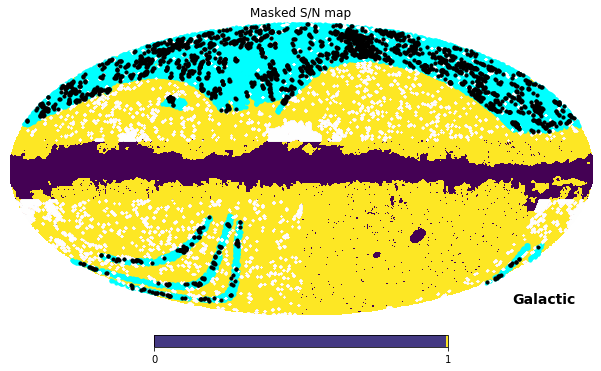

In [35]:
hp.mollview(mask,norm='hist',coord=['G'],title='Masked S/N map')
hp.visufunc.projscatter(dr7['GLON'],dr7['GLAT'],c='cyan',lonlat=True,s=10)
hp.visufunc.projscatter(maskedArray.glon,maskedArray.glat,c='w',lonlat=True,s=0.1)
hp.visufunc.projscatter(unionLons, unionLats,c='k',lonlat=True,s=10)

In [36]:
len(interLons)

2676

In [37]:
len(unionLons)

2470

---